In [128]:
import plaidml
import plaidml.keras
plaidml.keras.install_backend()
import os
os.environ["KERAS_BACKEND"] = "plaidml.keras.backend"
import random 

# Exercice 1 


## Question 1 

Le critère d'arrêt est le suivant : $\frac{|F(x_{k+1})-F(x_{k})|}{F(x_{k+1})}\leq \epsilon$

Ici le prof incite à plutôt proposer un nombre d'itération, c'est plus simple d'observer la convergence


## Question 2

In [11]:
def gradient_descent(F,DF,xk,alpha=0.01,epsilon=0.001):
    xk1 =  xk - alpha*DF(xk)
    while(DF(xk) > epsilon):
        temp = xk1
        xk1  = xk - alpha*DF(xk)
        xk   = temp
    return xk1

## Question 3

Si la fonction n'est pas convexe, on peut tomber sur un minimum local qui n'est pas un forcément globale 

## Question 4


Dans le cas convexe, il influence sur la vitesse à laquelle on converge. Cependant dans le cas non convexe, il peut emmener sur un minimum complétement différent

# Exercice 2

## Question 1

Ici on a $\sum_{i} w_{i}x_{i} - \theta > 0$ qui donne l'équation de l'hyperplan, dans le plan de dimension $n+1$

## Question 2

On peut traiter $\theta$ comme le poids associé à $x_{0}=1$.

On peut donc adapter le problème de l'estimation des paramètres en l'estimation d'un unique vecteur 
\begin{align}
w &= (w_0,w_1,\dots,w_{n+1})\\
w &= (\theta,w_1,\dots,w_{n+1})
\end{align}

On cherche donc un hyperplan en dimension $d+1$ plutôt qu'en dimension $d$.

On peut aussi se dire que avec $=0$ on passe par l'origine, $=\theta$ on ne passe plus forcément par l'origine.

On a un degré de liberté en plus, on a maintenant un modèle affine. 


## Question 3

Des points disposés de manière circulaire ne peuvent être séparés de manière linéaire. On a l'exemple suivant :

In [129]:
from sklearn import cluster, datasets, mixture
import numpy as np
import matplotlib.pyplot as plt
from itertools import cycle, islice
n_samples = 1500
X,y = datasets.make_circles(n_samples=n_samples, factor=.5,noise=.05)

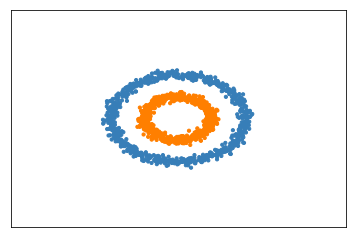

In [2]:
colors = np.array(list(islice(cycle(['#377eb8', '#ff7f00', '#4daf4a','#f781bf', '#a65628', '#984ea3','#999999', '#e41a1c', '#dede00']),int(max(y) + 1))))
colors = np.append(colors, ["#000000"])
plt.scatter(X[:, 0], X[:, 1], s=10,color=colors[y])
plt.xlim(-2.5, 2.5)
plt.ylim(-2.5, 2.5)
plt.xticks(())
plt.yticks(())
plt.show()
        

Ici il vaut mieux passer par les coordonnées polaires

## Question 4

Il suffit d'ajouter 2 points pour rendre deux classes non linairement séparables

# Exercice 3


## Question 1 : 

Si l'échantillon n'est pas linéairement séparable, on risque de ne pas avoir de convergence. Tous les exemples ne pourront pas être bien séparés. De plus on bouge tout l'hyperplan pour bien classer l'exemple que l'on veut, ce qui peut tout casser pour les autres points. On bouge trop l'hyperplan pour chaque points mal classés.

## Question 2 : 

La descente stochastique de gradient s'effectue de la même façon. On soustrait pour chaque erreur en utilisant le \textbf{gradient}. Ici on voit bien que le gradient de l'erreur $\nabla e=(T_{x}-O(x))F(x)'$

La somme globale n'intervient pas, le coté stochastique apparait par la prise une par une de chaque exemples. 
On bouge maintenant petit à petit en utilisant le paramètre $\epsilon$.

# Exercice 4
## Question 1:

In [174]:
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation

def weight_update(w,b,x,y):
    # Fonction to update the wheights given an exemple and a label 
    for i in range(len(w)):
        w[i] += eps*(y-np.sum(x*w)+b)*x[i]
    
def E(X,y,w,b):
    e = 0
    for i in range(len(X)):
        e+= (1/2)*(y[i] - np.sum(X[i]*w)+b)**2
    return e/len(y)

def train(X,y):
    N = 2000
    n = np.shape(X)[1]
    print("weight size : {}".format(n))
    w = -0.001+np.zeros(n)
    biais = 1
    B = np.zeros(N)
    Er = np.zeros(N+1)
    W = np.zeros((N,n))
    Er[0] = E(X,y,w,biais)
    k = 0     
    while(k<N):  
        for i in range(len(y)):
            print("epoch n°{}, sample n°{}/{}".format(k,i,len(y)))
            new_bias = eps * (y[i]-np.sum(X[i]*w)+biais)
            weight_update(w,biais,X[i],y[i])
            biais = new_bias
        B[k] = biais
        W[k] = w
        k+=1
        Er[k] = E(X,y,w,biais)
        #print("loss = {}".format(Er[k]))
    plt.figure(1)
    plt.plot(Er)
    plt.show()
    return w,biais,B,W
    
def predict(x,w,b):
    return np.sum(x*w)+biais





In [ ]:
# Main code 
eps = 0.001
X = np.array([[0,0],[0,1],[1,0],[1,1]])
y = np.array([-1,1,1,1])
print(X)
print(y)
weight,biais,B,W = train(X,y)

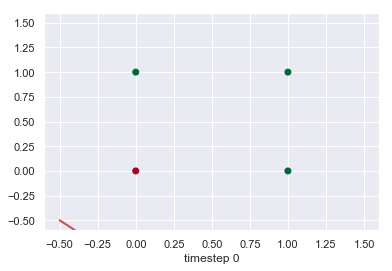

In [131]:
import seaborn as sns
from matplotlib import cm
def update(i):
    label = 'timestep {0}'.format(i)
    line.set_ydata( -W[i,0]/(W[i,1])*datax + (-B[i] / W[i,1]))
    ax.set_xlabel(label)
    return line, ax

classes = ["0","1"]
sns.set(style="darkgrid")
fig, ax = plt.subplots()
datax = np.linspace(-0.5,1.5)
scatter = ax.scatter([0,0,1,1],[0,1,0,1],c=[-1.,2.,2.,2.],cmap="RdYlGn")


line, = ax.plot(datax, datax, 'r-', linewidth=2)

anim = FuncAnimation(fig, update, frames=np.arange(0, len(W),20), interval=200)
anim.save('line.gif', dpi=80, writer='imagemagick')
plt.show()

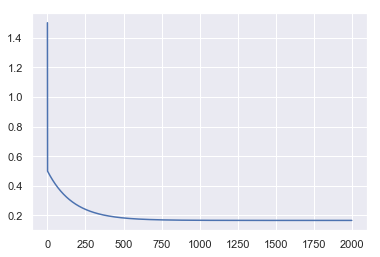

In [113]:
data0 = np.random.randn(1000, 2) + [3,0]
data1 = np.random.randn(1000, 2) - 3
labels0 = 2*np.ones(1000)
labels1 = -np.ones(1000)
data = np.concatenate([data0, data1])
labels = np.concatenate([labels0, labels1])
weight,biais,B,W = train(X,y)


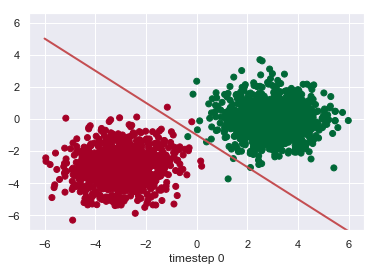

In [114]:
classes = ["0","1"]
sns.set(style="darkgrid")
fig, ax = plt.subplots()
datax = np.linspace(-6,6)

scatter = ax.scatter(np.concatenate([data0[:,0],data1[:,0]]),np.concatenate([data0[:,1],data1[:,1]]),c=np.concatenate([labels0,labels1]),cmap="RdYlGn")


line, = ax.plot(datax, datax, 'r-', linewidth=2)

anim = FuncAnimation(fig, update, frames=np.arange(0, len(W),20), interval=200)
anim.save('line2.gif', dpi=80, writer='imagemagick')
plt.show()

In [152]:
dtrain = np.loadtxt("zip.train")
dtest  = np.loadtxt("zip.test")

In [161]:
X = dtrain[:,1:]
y = dtrain[:,0]
print(len(X))
print(len(y))

7291
7291


In [ ]:
weight,biais,B,W = train(X,y)

weight size : 256
epoch n°0, sample n°0/2007
epoch n°0, sample n°1/2007
epoch n°0, sample n°2/2007
epoch n°0, sample n°3/2007
epoch n°0, sample n°4/2007
epoch n°0, sample n°5/2007
epoch n°0, sample n°6/2007
epoch n°0, sample n°7/2007
epoch n°0, sample n°8/2007
epoch n°0, sample n°9/2007
epoch n°0, sample n°10/2007
epoch n°0, sample n°11/2007
epoch n°0, sample n°12/2007
epoch n°0, sample n°13/2007
epoch n°0, sample n°14/2007
epoch n°0, sample n°15/2007
epoch n°0, sample n°16/2007
epoch n°0, sample n°17/2007
epoch n°0, sample n°18/2007
epoch n°0, sample n°19/2007
epoch n°0, sample n°20/2007
epoch n°0, sample n°21/2007
epoch n°0, sample n°22/2007
epoch n°0, sample n°23/2007
epoch n°0, sample n°24/2007
epoch n°0, sample n°25/2007
epoch n°0, sample n°26/2007
epoch n°0, sample n°27/2007
epoch n°0, sample n°28/2007
epoch n°0, sample n°29/2007
epoch n°0, sample n°30/2007
epoch n°0, sample n°31/2007
epoch n°0, sample n°32/2007
epoch n°0, sample n°33/2007
epoch n°0, sample n°34/2007
epoch n°0, s

epoch n°0, sample n°324/2007
epoch n°0, sample n°325/2007
epoch n°0, sample n°326/2007
epoch n°0, sample n°327/2007
epoch n°0, sample n°328/2007
epoch n°0, sample n°329/2007
epoch n°0, sample n°330/2007
epoch n°0, sample n°331/2007
epoch n°0, sample n°332/2007
epoch n°0, sample n°333/2007
epoch n°0, sample n°334/2007
epoch n°0, sample n°335/2007
epoch n°0, sample n°336/2007
epoch n°0, sample n°337/2007
epoch n°0, sample n°338/2007
epoch n°0, sample n°339/2007
epoch n°0, sample n°340/2007
epoch n°0, sample n°341/2007
epoch n°0, sample n°342/2007
epoch n°0, sample n°343/2007
epoch n°0, sample n°344/2007
epoch n°0, sample n°345/2007
epoch n°0, sample n°346/2007
epoch n°0, sample n°347/2007
epoch n°0, sample n°348/2007
epoch n°0, sample n°349/2007
epoch n°0, sample n°350/2007
epoch n°0, sample n°351/2007
epoch n°0, sample n°352/2007
epoch n°0, sample n°353/2007
epoch n°0, sample n°354/2007
epoch n°0, sample n°355/2007
epoch n°0, sample n°356/2007
epoch n°0, sample n°357/2007
epoch n°0, sam

epoch n°0, sample n°678/2007
epoch n°0, sample n°679/2007
epoch n°0, sample n°680/2007
epoch n°0, sample n°681/2007
epoch n°0, sample n°682/2007
epoch n°0, sample n°683/2007
epoch n°0, sample n°684/2007
epoch n°0, sample n°685/2007
epoch n°0, sample n°686/2007
epoch n°0, sample n°687/2007
epoch n°0, sample n°688/2007
epoch n°0, sample n°689/2007
epoch n°0, sample n°690/2007
epoch n°0, sample n°691/2007
epoch n°0, sample n°692/2007
epoch n°0, sample n°693/2007
epoch n°0, sample n°694/2007
epoch n°0, sample n°695/2007
epoch n°0, sample n°696/2007
epoch n°0, sample n°697/2007
epoch n°0, sample n°698/2007
epoch n°0, sample n°699/2007
epoch n°0, sample n°700/2007
epoch n°0, sample n°701/2007
epoch n°0, sample n°702/2007
epoch n°0, sample n°703/2007
epoch n°0, sample n°704/2007
epoch n°0, sample n°705/2007
epoch n°0, sample n°706/2007
epoch n°0, sample n°707/2007
epoch n°0, sample n°708/2007
epoch n°0, sample n°709/2007
epoch n°0, sample n°710/2007
epoch n°0, sample n°711/2007
epoch n°0, sam

epoch n°0, sample n°1028/2007
epoch n°0, sample n°1029/2007
epoch n°0, sample n°1030/2007
epoch n°0, sample n°1031/2007
epoch n°0, sample n°1032/2007
epoch n°0, sample n°1033/2007
epoch n°0, sample n°1034/2007
epoch n°0, sample n°1035/2007
epoch n°0, sample n°1036/2007
epoch n°0, sample n°1037/2007
epoch n°0, sample n°1038/2007
epoch n°0, sample n°1039/2007
epoch n°0, sample n°1040/2007
epoch n°0, sample n°1041/2007
epoch n°0, sample n°1042/2007
epoch n°0, sample n°1043/2007
epoch n°0, sample n°1044/2007
epoch n°0, sample n°1045/2007
epoch n°0, sample n°1046/2007
epoch n°0, sample n°1047/2007
epoch n°0, sample n°1048/2007
epoch n°0, sample n°1049/2007
epoch n°0, sample n°1050/2007
epoch n°0, sample n°1051/2007
epoch n°0, sample n°1052/2007
epoch n°0, sample n°1053/2007
epoch n°0, sample n°1054/2007
epoch n°0, sample n°1055/2007
epoch n°0, sample n°1056/2007
epoch n°0, sample n°1057/2007
epoch n°0, sample n°1058/2007
epoch n°0, sample n°1059/2007
epoch n°0, sample n°1060/2007
epoch n°0,

epoch n°0, sample n°1376/2007
epoch n°0, sample n°1377/2007
epoch n°0, sample n°1378/2007
epoch n°0, sample n°1379/2007
epoch n°0, sample n°1380/2007
epoch n°0, sample n°1381/2007
epoch n°0, sample n°1382/2007
epoch n°0, sample n°1383/2007
epoch n°0, sample n°1384/2007
epoch n°0, sample n°1385/2007
epoch n°0, sample n°1386/2007
epoch n°0, sample n°1387/2007
epoch n°0, sample n°1388/2007
epoch n°0, sample n°1389/2007
epoch n°0, sample n°1390/2007
epoch n°0, sample n°1391/2007
epoch n°0, sample n°1392/2007
epoch n°0, sample n°1393/2007
epoch n°0, sample n°1394/2007
epoch n°0, sample n°1395/2007
epoch n°0, sample n°1396/2007
epoch n°0, sample n°1397/2007
epoch n°0, sample n°1398/2007
epoch n°0, sample n°1399/2007
epoch n°0, sample n°1400/2007
epoch n°0, sample n°1401/2007
epoch n°0, sample n°1402/2007
epoch n°0, sample n°1403/2007
epoch n°0, sample n°1404/2007
epoch n°0, sample n°1405/2007
epoch n°0, sample n°1406/2007
epoch n°0, sample n°1407/2007
epoch n°0, sample n°1408/2007
epoch n°0,

epoch n°0, sample n°1729/2007
epoch n°0, sample n°1730/2007
epoch n°0, sample n°1731/2007
epoch n°0, sample n°1732/2007
epoch n°0, sample n°1733/2007
epoch n°0, sample n°1734/2007
epoch n°0, sample n°1735/2007
epoch n°0, sample n°1736/2007
epoch n°0, sample n°1737/2007
epoch n°0, sample n°1738/2007
epoch n°0, sample n°1739/2007
epoch n°0, sample n°1740/2007
epoch n°0, sample n°1741/2007
epoch n°0, sample n°1742/2007
epoch n°0, sample n°1743/2007
epoch n°0, sample n°1744/2007
epoch n°0, sample n°1745/2007
epoch n°0, sample n°1746/2007
epoch n°0, sample n°1747/2007
epoch n°0, sample n°1748/2007
epoch n°0, sample n°1749/2007
epoch n°0, sample n°1750/2007
epoch n°0, sample n°1751/2007
epoch n°0, sample n°1752/2007
epoch n°0, sample n°1753/2007
epoch n°0, sample n°1754/2007
epoch n°0, sample n°1755/2007
epoch n°0, sample n°1756/2007
epoch n°0, sample n°1757/2007
epoch n°0, sample n°1758/2007
epoch n°0, sample n°1759/2007
epoch n°0, sample n°1760/2007
epoch n°0, sample n°1761/2007
epoch n°0,

epoch n°1, sample n°63/2007
epoch n°1, sample n°64/2007
epoch n°1, sample n°65/2007
epoch n°1, sample n°66/2007
epoch n°1, sample n°67/2007
epoch n°1, sample n°68/2007
epoch n°1, sample n°69/2007
epoch n°1, sample n°70/2007
epoch n°1, sample n°71/2007
epoch n°1, sample n°72/2007
epoch n°1, sample n°73/2007
epoch n°1, sample n°74/2007
epoch n°1, sample n°75/2007
epoch n°1, sample n°76/2007
epoch n°1, sample n°77/2007
epoch n°1, sample n°78/2007
epoch n°1, sample n°79/2007
epoch n°1, sample n°80/2007
epoch n°1, sample n°81/2007
epoch n°1, sample n°82/2007
epoch n°1, sample n°83/2007
epoch n°1, sample n°84/2007
epoch n°1, sample n°85/2007
epoch n°1, sample n°86/2007
epoch n°1, sample n°87/2007
epoch n°1, sample n°88/2007
epoch n°1, sample n°89/2007
epoch n°1, sample n°90/2007
epoch n°1, sample n°91/2007
epoch n°1, sample n°92/2007
epoch n°1, sample n°93/2007
epoch n°1, sample n°94/2007
epoch n°1, sample n°95/2007
epoch n°1, sample n°96/2007
epoch n°1, sample n°97/2007
epoch n°1, sample n°

epoch n°1, sample n°418/2007
epoch n°1, sample n°419/2007
epoch n°1, sample n°420/2007
epoch n°1, sample n°421/2007
epoch n°1, sample n°422/2007
epoch n°1, sample n°423/2007
epoch n°1, sample n°424/2007
epoch n°1, sample n°425/2007
epoch n°1, sample n°426/2007
epoch n°1, sample n°427/2007
epoch n°1, sample n°428/2007
epoch n°1, sample n°429/2007
epoch n°1, sample n°430/2007
epoch n°1, sample n°431/2007
epoch n°1, sample n°432/2007
epoch n°1, sample n°433/2007
epoch n°1, sample n°434/2007
epoch n°1, sample n°435/2007
epoch n°1, sample n°436/2007
epoch n°1, sample n°437/2007
epoch n°1, sample n°438/2007
epoch n°1, sample n°439/2007
epoch n°1, sample n°440/2007
epoch n°1, sample n°441/2007
epoch n°1, sample n°442/2007
epoch n°1, sample n°443/2007
epoch n°1, sample n°444/2007
epoch n°1, sample n°445/2007
epoch n°1, sample n°446/2007
epoch n°1, sample n°447/2007
epoch n°1, sample n°448/2007
epoch n°1, sample n°449/2007
epoch n°1, sample n°450/2007
epoch n°1, sample n°451/2007
epoch n°1, sam

epoch n°1, sample n°760/2007
epoch n°1, sample n°761/2007
epoch n°1, sample n°762/2007
epoch n°1, sample n°763/2007
epoch n°1, sample n°764/2007
epoch n°1, sample n°765/2007
epoch n°1, sample n°766/2007
epoch n°1, sample n°767/2007
epoch n°1, sample n°768/2007
epoch n°1, sample n°769/2007
epoch n°1, sample n°770/2007
epoch n°1, sample n°771/2007
epoch n°1, sample n°772/2007
epoch n°1, sample n°773/2007
epoch n°1, sample n°774/2007
epoch n°1, sample n°775/2007
epoch n°1, sample n°776/2007
epoch n°1, sample n°777/2007
epoch n°1, sample n°778/2007
epoch n°1, sample n°779/2007
epoch n°1, sample n°780/2007
epoch n°1, sample n°781/2007
epoch n°1, sample n°782/2007
epoch n°1, sample n°783/2007
epoch n°1, sample n°784/2007
epoch n°1, sample n°785/2007
epoch n°1, sample n°786/2007
epoch n°1, sample n°787/2007
epoch n°1, sample n°788/2007
epoch n°1, sample n°789/2007
epoch n°1, sample n°790/2007
epoch n°1, sample n°791/2007
epoch n°1, sample n°792/2007
epoch n°1, sample n°793/2007
epoch n°1, sam

epoch n°1, sample n°1109/2007
epoch n°1, sample n°1110/2007
epoch n°1, sample n°1111/2007
epoch n°1, sample n°1112/2007
epoch n°1, sample n°1113/2007
epoch n°1, sample n°1114/2007
epoch n°1, sample n°1115/2007
epoch n°1, sample n°1116/2007
epoch n°1, sample n°1117/2007
epoch n°1, sample n°1118/2007
epoch n°1, sample n°1119/2007
epoch n°1, sample n°1120/2007
epoch n°1, sample n°1121/2007
epoch n°1, sample n°1122/2007
epoch n°1, sample n°1123/2007
epoch n°1, sample n°1124/2007
epoch n°1, sample n°1125/2007
epoch n°1, sample n°1126/2007
epoch n°1, sample n°1127/2007
epoch n°1, sample n°1128/2007
epoch n°1, sample n°1129/2007
epoch n°1, sample n°1130/2007
epoch n°1, sample n°1131/2007
epoch n°1, sample n°1132/2007
epoch n°1, sample n°1133/2007
epoch n°1, sample n°1134/2007
epoch n°1, sample n°1135/2007
epoch n°1, sample n°1136/2007
epoch n°1, sample n°1137/2007
epoch n°1, sample n°1138/2007
epoch n°1, sample n°1139/2007
epoch n°1, sample n°1140/2007
epoch n°1, sample n°1141/2007
epoch n°1,

epoch n°1, sample n°1455/2007
epoch n°1, sample n°1456/2007
epoch n°1, sample n°1457/2007
epoch n°1, sample n°1458/2007
epoch n°1, sample n°1459/2007
epoch n°1, sample n°1460/2007
epoch n°1, sample n°1461/2007
epoch n°1, sample n°1462/2007
epoch n°1, sample n°1463/2007
epoch n°1, sample n°1464/2007
epoch n°1, sample n°1465/2007
epoch n°1, sample n°1466/2007
epoch n°1, sample n°1467/2007
epoch n°1, sample n°1468/2007
epoch n°1, sample n°1469/2007
epoch n°1, sample n°1470/2007
epoch n°1, sample n°1471/2007
epoch n°1, sample n°1472/2007
epoch n°1, sample n°1473/2007
epoch n°1, sample n°1474/2007
epoch n°1, sample n°1475/2007
epoch n°1, sample n°1476/2007
epoch n°1, sample n°1477/2007
epoch n°1, sample n°1478/2007
epoch n°1, sample n°1479/2007
epoch n°1, sample n°1480/2007
epoch n°1, sample n°1481/2007
epoch n°1, sample n°1482/2007
epoch n°1, sample n°1483/2007
epoch n°1, sample n°1484/2007
epoch n°1, sample n°1485/2007
epoch n°1, sample n°1486/2007
epoch n°1, sample n°1487/2007
epoch n°1,

epoch n°1, sample n°1809/2007
epoch n°1, sample n°1810/2007
epoch n°1, sample n°1811/2007
epoch n°1, sample n°1812/2007
epoch n°1, sample n°1813/2007
epoch n°1, sample n°1814/2007
epoch n°1, sample n°1815/2007
epoch n°1, sample n°1816/2007
epoch n°1, sample n°1817/2007
epoch n°1, sample n°1818/2007
epoch n°1, sample n°1819/2007
epoch n°1, sample n°1820/2007
epoch n°1, sample n°1821/2007
epoch n°1, sample n°1822/2007
epoch n°1, sample n°1823/2007
epoch n°1, sample n°1824/2007
epoch n°1, sample n°1825/2007
epoch n°1, sample n°1826/2007
epoch n°1, sample n°1827/2007
epoch n°1, sample n°1828/2007
epoch n°1, sample n°1829/2007
epoch n°1, sample n°1830/2007
epoch n°1, sample n°1831/2007
epoch n°1, sample n°1832/2007
epoch n°1, sample n°1833/2007
epoch n°1, sample n°1834/2007
epoch n°1, sample n°1835/2007
epoch n°1, sample n°1836/2007
epoch n°1, sample n°1837/2007
epoch n°1, sample n°1838/2007
epoch n°1, sample n°1839/2007
epoch n°1, sample n°1840/2007
epoch n°1, sample n°1841/2007
epoch n°1,

epoch n°2, sample n°102/2007
epoch n°2, sample n°103/2007
epoch n°2, sample n°104/2007
epoch n°2, sample n°105/2007
epoch n°2, sample n°106/2007
epoch n°2, sample n°107/2007
epoch n°2, sample n°108/2007
epoch n°2, sample n°109/2007
epoch n°2, sample n°110/2007
epoch n°2, sample n°111/2007
epoch n°2, sample n°112/2007
epoch n°2, sample n°113/2007
epoch n°2, sample n°114/2007
epoch n°2, sample n°115/2007
epoch n°2, sample n°116/2007
epoch n°2, sample n°117/2007
epoch n°2, sample n°118/2007
epoch n°2, sample n°119/2007
epoch n°2, sample n°120/2007
epoch n°2, sample n°121/2007
epoch n°2, sample n°122/2007
epoch n°2, sample n°123/2007
epoch n°2, sample n°124/2007
epoch n°2, sample n°125/2007
epoch n°2, sample n°126/2007
epoch n°2, sample n°127/2007
epoch n°2, sample n°128/2007
epoch n°2, sample n°129/2007
epoch n°2, sample n°130/2007
epoch n°2, sample n°131/2007
epoch n°2, sample n°132/2007
epoch n°2, sample n°133/2007
epoch n°2, sample n°134/2007
epoch n°2, sample n°135/2007
epoch n°2, sam

epoch n°2, sample n°418/2007
epoch n°2, sample n°419/2007
epoch n°2, sample n°420/2007
epoch n°2, sample n°421/2007
epoch n°2, sample n°422/2007
epoch n°2, sample n°423/2007
epoch n°2, sample n°424/2007
epoch n°2, sample n°425/2007
epoch n°2, sample n°426/2007
epoch n°2, sample n°427/2007
epoch n°2, sample n°428/2007
epoch n°2, sample n°429/2007
epoch n°2, sample n°430/2007
epoch n°2, sample n°431/2007
epoch n°2, sample n°432/2007
epoch n°2, sample n°433/2007
epoch n°2, sample n°434/2007
epoch n°2, sample n°435/2007
epoch n°2, sample n°436/2007
epoch n°2, sample n°437/2007
epoch n°2, sample n°438/2007
epoch n°2, sample n°439/2007
epoch n°2, sample n°440/2007
epoch n°2, sample n°441/2007
epoch n°2, sample n°442/2007
epoch n°2, sample n°443/2007
epoch n°2, sample n°444/2007
epoch n°2, sample n°445/2007
epoch n°2, sample n°446/2007
epoch n°2, sample n°447/2007
epoch n°2, sample n°448/2007
epoch n°2, sample n°449/2007
epoch n°2, sample n°450/2007
epoch n°2, sample n°451/2007
epoch n°2, sam

epoch n°2, sample n°724/2007
epoch n°2, sample n°725/2007
epoch n°2, sample n°726/2007
epoch n°2, sample n°727/2007
epoch n°2, sample n°728/2007
epoch n°2, sample n°729/2007
epoch n°2, sample n°730/2007
epoch n°2, sample n°731/2007
epoch n°2, sample n°732/2007
epoch n°2, sample n°733/2007
epoch n°2, sample n°734/2007
epoch n°2, sample n°735/2007
epoch n°2, sample n°736/2007
epoch n°2, sample n°737/2007
epoch n°2, sample n°738/2007
epoch n°2, sample n°739/2007
epoch n°2, sample n°740/2007
epoch n°2, sample n°741/2007
epoch n°2, sample n°742/2007
epoch n°2, sample n°743/2007
epoch n°2, sample n°744/2007
epoch n°2, sample n°745/2007
epoch n°2, sample n°746/2007
epoch n°2, sample n°747/2007
epoch n°2, sample n°748/2007
epoch n°2, sample n°749/2007
epoch n°2, sample n°750/2007
epoch n°2, sample n°751/2007
epoch n°2, sample n°752/2007
epoch n°2, sample n°753/2007
epoch n°2, sample n°754/2007
epoch n°2, sample n°755/2007
epoch n°2, sample n°756/2007
epoch n°2, sample n°757/2007
epoch n°2, sam

epoch n°2, sample n°1056/2007
epoch n°2, sample n°1057/2007
epoch n°2, sample n°1058/2007
epoch n°2, sample n°1059/2007
epoch n°2, sample n°1060/2007
epoch n°2, sample n°1061/2007
epoch n°2, sample n°1062/2007
epoch n°2, sample n°1063/2007
epoch n°2, sample n°1064/2007
epoch n°2, sample n°1065/2007
epoch n°2, sample n°1066/2007
epoch n°2, sample n°1067/2007
epoch n°2, sample n°1068/2007
epoch n°2, sample n°1069/2007
epoch n°2, sample n°1070/2007
epoch n°2, sample n°1071/2007
epoch n°2, sample n°1072/2007
epoch n°2, sample n°1073/2007
epoch n°2, sample n°1074/2007
epoch n°2, sample n°1075/2007
epoch n°2, sample n°1076/2007
epoch n°2, sample n°1077/2007
epoch n°2, sample n°1078/2007
epoch n°2, sample n°1079/2007
epoch n°2, sample n°1080/2007
epoch n°2, sample n°1081/2007
epoch n°2, sample n°1082/2007
epoch n°2, sample n°1083/2007
epoch n°2, sample n°1084/2007
epoch n°2, sample n°1085/2007
epoch n°2, sample n°1086/2007
epoch n°2, sample n°1087/2007
epoch n°2, sample n°1088/2007
epoch n°2,

epoch n°2, sample n°1347/2007
epoch n°2, sample n°1348/2007
epoch n°2, sample n°1349/2007
epoch n°2, sample n°1350/2007
epoch n°2, sample n°1351/2007
epoch n°2, sample n°1352/2007
epoch n°2, sample n°1353/2007
epoch n°2, sample n°1354/2007
epoch n°2, sample n°1355/2007
epoch n°2, sample n°1356/2007
epoch n°2, sample n°1357/2007
epoch n°2, sample n°1358/2007
epoch n°2, sample n°1359/2007
epoch n°2, sample n°1360/2007
epoch n°2, sample n°1361/2007
epoch n°2, sample n°1362/2007
epoch n°2, sample n°1363/2007
epoch n°2, sample n°1364/2007
epoch n°2, sample n°1365/2007
epoch n°2, sample n°1366/2007
epoch n°2, sample n°1367/2007
epoch n°2, sample n°1368/2007
epoch n°2, sample n°1369/2007
epoch n°2, sample n°1370/2007
epoch n°2, sample n°1371/2007
epoch n°2, sample n°1372/2007
epoch n°2, sample n°1373/2007
epoch n°2, sample n°1374/2007
epoch n°2, sample n°1375/2007
epoch n°2, sample n°1376/2007
epoch n°2, sample n°1377/2007
epoch n°2, sample n°1378/2007
epoch n°2, sample n°1379/2007
epoch n°2,

epoch n°2, sample n°1654/2007
epoch n°2, sample n°1655/2007
epoch n°2, sample n°1656/2007
epoch n°2, sample n°1657/2007
epoch n°2, sample n°1658/2007
epoch n°2, sample n°1659/2007
epoch n°2, sample n°1660/2007
epoch n°2, sample n°1661/2007
epoch n°2, sample n°1662/2007
epoch n°2, sample n°1663/2007
epoch n°2, sample n°1664/2007
epoch n°2, sample n°1665/2007
epoch n°2, sample n°1666/2007
epoch n°2, sample n°1667/2007
epoch n°2, sample n°1668/2007
epoch n°2, sample n°1669/2007
epoch n°2, sample n°1670/2007
epoch n°2, sample n°1671/2007
epoch n°2, sample n°1672/2007
epoch n°2, sample n°1673/2007
epoch n°2, sample n°1674/2007
epoch n°2, sample n°1675/2007
epoch n°2, sample n°1676/2007
epoch n°2, sample n°1677/2007
epoch n°2, sample n°1678/2007
epoch n°2, sample n°1679/2007
epoch n°2, sample n°1680/2007
epoch n°2, sample n°1681/2007
epoch n°2, sample n°1682/2007
epoch n°2, sample n°1683/2007
epoch n°2, sample n°1684/2007
epoch n°2, sample n°1685/2007
epoch n°2, sample n°1686/2007
epoch n°2,

epoch n°2, sample n°1991/2007
epoch n°2, sample n°1992/2007
epoch n°2, sample n°1993/2007
epoch n°2, sample n°1994/2007
epoch n°2, sample n°1995/2007
epoch n°2, sample n°1996/2007
epoch n°2, sample n°1997/2007
epoch n°2, sample n°1998/2007
epoch n°2, sample n°1999/2007
epoch n°2, sample n°2000/2007
epoch n°2, sample n°2001/2007
epoch n°2, sample n°2002/2007
epoch n°2, sample n°2003/2007
epoch n°2, sample n°2004/2007
epoch n°2, sample n°2005/2007
epoch n°2, sample n°2006/2007
epoch n°3, sample n°0/2007
epoch n°3, sample n°1/2007
epoch n°3, sample n°2/2007
epoch n°3, sample n°3/2007
epoch n°3, sample n°4/2007
epoch n°3, sample n°5/2007
epoch n°3, sample n°6/2007
epoch n°3, sample n°7/2007
epoch n°3, sample n°8/2007
epoch n°3, sample n°9/2007
epoch n°3, sample n°10/2007
epoch n°3, sample n°11/2007
epoch n°3, sample n°12/2007
epoch n°3, sample n°13/2007
epoch n°3, sample n°14/2007
epoch n°3, sample n°15/2007
epoch n°3, sample n°16/2007
epoch n°3, sample n°17/2007
epoch n°3, sample n°18/200

epoch n°3, sample n°290/2007
epoch n°3, sample n°291/2007
epoch n°3, sample n°292/2007
epoch n°3, sample n°293/2007
epoch n°3, sample n°294/2007
epoch n°3, sample n°295/2007
epoch n°3, sample n°296/2007
epoch n°3, sample n°297/2007
epoch n°3, sample n°298/2007
epoch n°3, sample n°299/2007
epoch n°3, sample n°300/2007
epoch n°3, sample n°301/2007
epoch n°3, sample n°302/2007
epoch n°3, sample n°303/2007
epoch n°3, sample n°304/2007
epoch n°3, sample n°305/2007
epoch n°3, sample n°306/2007
epoch n°3, sample n°307/2007
epoch n°3, sample n°308/2007
epoch n°3, sample n°309/2007
epoch n°3, sample n°310/2007
epoch n°3, sample n°311/2007
epoch n°3, sample n°312/2007
epoch n°3, sample n°313/2007
epoch n°3, sample n°314/2007
epoch n°3, sample n°315/2007
epoch n°3, sample n°316/2007
epoch n°3, sample n°317/2007
epoch n°3, sample n°318/2007
epoch n°3, sample n°319/2007
epoch n°3, sample n°320/2007
epoch n°3, sample n°321/2007
epoch n°3, sample n°322/2007
epoch n°3, sample n°323/2007
epoch n°3, sam

epoch n°3, sample n°615/2007
epoch n°3, sample n°616/2007
epoch n°3, sample n°617/2007
epoch n°3, sample n°618/2007
epoch n°3, sample n°619/2007
epoch n°3, sample n°620/2007
epoch n°3, sample n°621/2007
epoch n°3, sample n°622/2007
epoch n°3, sample n°623/2007
epoch n°3, sample n°624/2007
epoch n°3, sample n°625/2007
epoch n°3, sample n°626/2007
epoch n°3, sample n°627/2007
epoch n°3, sample n°628/2007
epoch n°3, sample n°629/2007
epoch n°3, sample n°630/2007
epoch n°3, sample n°631/2007
epoch n°3, sample n°632/2007
epoch n°3, sample n°633/2007
epoch n°3, sample n°634/2007
epoch n°3, sample n°635/2007
epoch n°3, sample n°636/2007
epoch n°3, sample n°637/2007
epoch n°3, sample n°638/2007
epoch n°3, sample n°639/2007
epoch n°3, sample n°640/2007
epoch n°3, sample n°641/2007
epoch n°3, sample n°642/2007
epoch n°3, sample n°643/2007
epoch n°3, sample n°644/2007
epoch n°3, sample n°645/2007
epoch n°3, sample n°646/2007
epoch n°3, sample n°647/2007
epoch n°3, sample n°648/2007
epoch n°3, sam

epoch n°3, sample n°973/2007
epoch n°3, sample n°974/2007
epoch n°3, sample n°975/2007
epoch n°3, sample n°976/2007
epoch n°3, sample n°977/2007
epoch n°3, sample n°978/2007
epoch n°3, sample n°979/2007
epoch n°3, sample n°980/2007
epoch n°3, sample n°981/2007
epoch n°3, sample n°982/2007
epoch n°3, sample n°983/2007
epoch n°3, sample n°984/2007
epoch n°3, sample n°985/2007
epoch n°3, sample n°986/2007
epoch n°3, sample n°987/2007
epoch n°3, sample n°988/2007
epoch n°3, sample n°989/2007
epoch n°3, sample n°990/2007
epoch n°3, sample n°991/2007
epoch n°3, sample n°992/2007
epoch n°3, sample n°993/2007
epoch n°3, sample n°994/2007
epoch n°3, sample n°995/2007
epoch n°3, sample n°996/2007
epoch n°3, sample n°997/2007
epoch n°3, sample n°998/2007
epoch n°3, sample n°999/2007
epoch n°3, sample n°1000/2007
epoch n°3, sample n°1001/2007
epoch n°3, sample n°1002/2007
epoch n°3, sample n°1003/2007
epoch n°3, sample n°1004/2007
epoch n°3, sample n°1005/2007
epoch n°3, sample n°1006/2007
epoch n

epoch n°3, sample n°1335/2007
epoch n°3, sample n°1336/2007
epoch n°3, sample n°1337/2007
epoch n°3, sample n°1338/2007
epoch n°3, sample n°1339/2007
epoch n°3, sample n°1340/2007
epoch n°3, sample n°1341/2007
epoch n°3, sample n°1342/2007
epoch n°3, sample n°1343/2007
epoch n°3, sample n°1344/2007
epoch n°3, sample n°1345/2007
epoch n°3, sample n°1346/2007
epoch n°3, sample n°1347/2007
epoch n°3, sample n°1348/2007
epoch n°3, sample n°1349/2007
epoch n°3, sample n°1350/2007
epoch n°3, sample n°1351/2007
epoch n°3, sample n°1352/2007
epoch n°3, sample n°1353/2007
epoch n°3, sample n°1354/2007
epoch n°3, sample n°1355/2007
epoch n°3, sample n°1356/2007
epoch n°3, sample n°1357/2007
epoch n°3, sample n°1358/2007
epoch n°3, sample n°1359/2007
epoch n°3, sample n°1360/2007
epoch n°3, sample n°1361/2007
epoch n°3, sample n°1362/2007
epoch n°3, sample n°1363/2007
epoch n°3, sample n°1364/2007
epoch n°3, sample n°1365/2007
epoch n°3, sample n°1366/2007
epoch n°3, sample n°1367/2007
epoch n°3,

epoch n°3, sample n°1659/2007
epoch n°3, sample n°1660/2007
epoch n°3, sample n°1661/2007
epoch n°3, sample n°1662/2007
epoch n°3, sample n°1663/2007
epoch n°3, sample n°1664/2007
epoch n°3, sample n°1665/2007
epoch n°3, sample n°1666/2007
epoch n°3, sample n°1667/2007
epoch n°3, sample n°1668/2007
epoch n°3, sample n°1669/2007
epoch n°3, sample n°1670/2007
epoch n°3, sample n°1671/2007
epoch n°3, sample n°1672/2007
epoch n°3, sample n°1673/2007
epoch n°3, sample n°1674/2007
epoch n°3, sample n°1675/2007
epoch n°3, sample n°1676/2007
epoch n°3, sample n°1677/2007
epoch n°3, sample n°1678/2007
epoch n°3, sample n°1679/2007
epoch n°3, sample n°1680/2007
epoch n°3, sample n°1681/2007
epoch n°3, sample n°1682/2007
epoch n°3, sample n°1683/2007
epoch n°3, sample n°1684/2007
epoch n°3, sample n°1685/2007
epoch n°3, sample n°1686/2007
epoch n°3, sample n°1687/2007
epoch n°3, sample n°1688/2007
epoch n°3, sample n°1689/2007
epoch n°3, sample n°1690/2007
epoch n°3, sample n°1691/2007
epoch n°3,

epoch n°3, sample n°1949/2007
epoch n°3, sample n°1950/2007
epoch n°3, sample n°1951/2007
epoch n°3, sample n°1952/2007
epoch n°3, sample n°1953/2007
epoch n°3, sample n°1954/2007
epoch n°3, sample n°1955/2007
epoch n°3, sample n°1956/2007
epoch n°3, sample n°1957/2007
epoch n°3, sample n°1958/2007
epoch n°3, sample n°1959/2007
epoch n°3, sample n°1960/2007
epoch n°3, sample n°1961/2007
epoch n°3, sample n°1962/2007
epoch n°3, sample n°1963/2007
epoch n°3, sample n°1964/2007
epoch n°3, sample n°1965/2007
epoch n°3, sample n°1966/2007
epoch n°3, sample n°1967/2007
epoch n°3, sample n°1968/2007
epoch n°3, sample n°1969/2007
epoch n°3, sample n°1970/2007
epoch n°3, sample n°1971/2007
epoch n°3, sample n°1972/2007
epoch n°3, sample n°1973/2007
epoch n°3, sample n°1974/2007
epoch n°3, sample n°1975/2007
epoch n°3, sample n°1976/2007
epoch n°3, sample n°1977/2007
epoch n°3, sample n°1978/2007
epoch n°3, sample n°1979/2007
epoch n°3, sample n°1980/2007
epoch n°3, sample n°1981/2007
epoch n°3,

epoch n°4, sample n°242/2007
epoch n°4, sample n°243/2007
epoch n°4, sample n°244/2007
epoch n°4, sample n°245/2007
epoch n°4, sample n°246/2007
epoch n°4, sample n°247/2007
epoch n°4, sample n°248/2007
epoch n°4, sample n°249/2007
epoch n°4, sample n°250/2007
epoch n°4, sample n°251/2007
epoch n°4, sample n°252/2007
epoch n°4, sample n°253/2007
epoch n°4, sample n°254/2007
epoch n°4, sample n°255/2007
epoch n°4, sample n°256/2007
epoch n°4, sample n°257/2007
epoch n°4, sample n°258/2007
epoch n°4, sample n°259/2007
epoch n°4, sample n°260/2007
epoch n°4, sample n°261/2007
epoch n°4, sample n°262/2007
epoch n°4, sample n°263/2007
epoch n°4, sample n°264/2007
epoch n°4, sample n°265/2007
epoch n°4, sample n°266/2007
epoch n°4, sample n°267/2007
epoch n°4, sample n°268/2007
epoch n°4, sample n°269/2007
epoch n°4, sample n°270/2007
epoch n°4, sample n°271/2007
epoch n°4, sample n°272/2007
epoch n°4, sample n°273/2007
epoch n°4, sample n°274/2007
epoch n°4, sample n°275/2007
epoch n°4, sam

epoch n°4, sample n°540/2007
epoch n°4, sample n°541/2007
epoch n°4, sample n°542/2007
epoch n°4, sample n°543/2007
epoch n°4, sample n°544/2007
epoch n°4, sample n°545/2007
epoch n°4, sample n°546/2007
epoch n°4, sample n°547/2007
epoch n°4, sample n°548/2007
epoch n°4, sample n°549/2007
epoch n°4, sample n°550/2007
epoch n°4, sample n°551/2007
epoch n°4, sample n°552/2007
epoch n°4, sample n°553/2007
epoch n°4, sample n°554/2007
epoch n°4, sample n°555/2007
epoch n°4, sample n°556/2007
epoch n°4, sample n°557/2007
epoch n°4, sample n°558/2007
epoch n°4, sample n°559/2007
epoch n°4, sample n°560/2007
epoch n°4, sample n°561/2007
epoch n°4, sample n°562/2007
epoch n°4, sample n°563/2007
epoch n°4, sample n°564/2007
epoch n°4, sample n°565/2007
epoch n°4, sample n°566/2007
epoch n°4, sample n°567/2007
epoch n°4, sample n°568/2007
epoch n°4, sample n°569/2007
epoch n°4, sample n°570/2007
epoch n°4, sample n°571/2007
epoch n°4, sample n°572/2007
epoch n°4, sample n°573/2007
epoch n°4, sam

epoch n°4, sample n°826/2007
epoch n°4, sample n°827/2007
epoch n°4, sample n°828/2007
epoch n°4, sample n°829/2007
epoch n°4, sample n°830/2007
epoch n°4, sample n°831/2007
epoch n°4, sample n°832/2007
epoch n°4, sample n°833/2007
epoch n°4, sample n°834/2007
epoch n°4, sample n°835/2007
epoch n°4, sample n°836/2007
epoch n°4, sample n°837/2007
epoch n°4, sample n°838/2007
epoch n°4, sample n°839/2007
epoch n°4, sample n°840/2007
epoch n°4, sample n°841/2007
epoch n°4, sample n°842/2007
epoch n°4, sample n°843/2007
epoch n°4, sample n°844/2007
epoch n°4, sample n°845/2007
epoch n°4, sample n°846/2007
epoch n°4, sample n°847/2007
epoch n°4, sample n°848/2007
epoch n°4, sample n°849/2007
epoch n°4, sample n°850/2007
epoch n°4, sample n°851/2007
epoch n°4, sample n°852/2007
epoch n°4, sample n°853/2007
epoch n°4, sample n°854/2007
epoch n°4, sample n°855/2007
epoch n°4, sample n°856/2007
epoch n°4, sample n°857/2007
epoch n°4, sample n°858/2007
epoch n°4, sample n°859/2007
epoch n°4, sam

epoch n°4, sample n°1194/2007
epoch n°4, sample n°1195/2007
epoch n°4, sample n°1196/2007
epoch n°4, sample n°1197/2007
epoch n°4, sample n°1198/2007
epoch n°4, sample n°1199/2007
epoch n°4, sample n°1200/2007
epoch n°4, sample n°1201/2007
epoch n°4, sample n°1202/2007
epoch n°4, sample n°1203/2007
epoch n°4, sample n°1204/2007
epoch n°4, sample n°1205/2007
epoch n°4, sample n°1206/2007
epoch n°4, sample n°1207/2007
epoch n°4, sample n°1208/2007
epoch n°4, sample n°1209/2007
epoch n°4, sample n°1210/2007
epoch n°4, sample n°1211/2007
epoch n°4, sample n°1212/2007
epoch n°4, sample n°1213/2007
epoch n°4, sample n°1214/2007
epoch n°4, sample n°1215/2007
epoch n°4, sample n°1216/2007
epoch n°4, sample n°1217/2007
epoch n°4, sample n°1218/2007
epoch n°4, sample n°1219/2007
epoch n°4, sample n°1220/2007
epoch n°4, sample n°1221/2007
epoch n°4, sample n°1222/2007
epoch n°4, sample n°1223/2007
epoch n°4, sample n°1224/2007
epoch n°4, sample n°1225/2007
epoch n°4, sample n°1226/2007
epoch n°4,

epoch n°4, sample n°1500/2007
epoch n°4, sample n°1501/2007
epoch n°4, sample n°1502/2007
epoch n°4, sample n°1503/2007
epoch n°4, sample n°1504/2007
epoch n°4, sample n°1505/2007
epoch n°4, sample n°1506/2007
epoch n°4, sample n°1507/2007
epoch n°4, sample n°1508/2007
epoch n°4, sample n°1509/2007
epoch n°4, sample n°1510/2007
epoch n°4, sample n°1511/2007
epoch n°4, sample n°1512/2007
epoch n°4, sample n°1513/2007
epoch n°4, sample n°1514/2007
epoch n°4, sample n°1515/2007
epoch n°4, sample n°1516/2007
epoch n°4, sample n°1517/2007
epoch n°4, sample n°1518/2007
epoch n°4, sample n°1519/2007
epoch n°4, sample n°1520/2007
epoch n°4, sample n°1521/2007
epoch n°4, sample n°1522/2007
epoch n°4, sample n°1523/2007
epoch n°4, sample n°1524/2007
epoch n°4, sample n°1525/2007
epoch n°4, sample n°1526/2007
epoch n°4, sample n°1527/2007
epoch n°4, sample n°1528/2007
epoch n°4, sample n°1529/2007
epoch n°4, sample n°1530/2007
epoch n°4, sample n°1531/2007
epoch n°4, sample n°1532/2007
epoch n°4,

epoch n°4, sample n°1852/2007
epoch n°4, sample n°1853/2007
epoch n°4, sample n°1854/2007
epoch n°4, sample n°1855/2007
epoch n°4, sample n°1856/2007
epoch n°4, sample n°1857/2007
epoch n°4, sample n°1858/2007
epoch n°4, sample n°1859/2007
epoch n°4, sample n°1860/2007
epoch n°4, sample n°1861/2007
epoch n°4, sample n°1862/2007
epoch n°4, sample n°1863/2007
epoch n°4, sample n°1864/2007
epoch n°4, sample n°1865/2007
epoch n°4, sample n°1866/2007
epoch n°4, sample n°1867/2007
epoch n°4, sample n°1868/2007
epoch n°4, sample n°1869/2007
epoch n°4, sample n°1870/2007
epoch n°4, sample n°1871/2007
epoch n°4, sample n°1872/2007
epoch n°4, sample n°1873/2007
epoch n°4, sample n°1874/2007
epoch n°4, sample n°1875/2007
epoch n°4, sample n°1876/2007
epoch n°4, sample n°1877/2007
epoch n°4, sample n°1878/2007
epoch n°4, sample n°1879/2007
epoch n°4, sample n°1880/2007
epoch n°4, sample n°1881/2007
epoch n°4, sample n°1882/2007
epoch n°4, sample n°1883/2007
epoch n°4, sample n°1884/2007
epoch n°4,

epoch n°5, sample n°193/2007
epoch n°5, sample n°194/2007
epoch n°5, sample n°195/2007
epoch n°5, sample n°196/2007
epoch n°5, sample n°197/2007
epoch n°5, sample n°198/2007
epoch n°5, sample n°199/2007
epoch n°5, sample n°200/2007
epoch n°5, sample n°201/2007
epoch n°5, sample n°202/2007
epoch n°5, sample n°203/2007
epoch n°5, sample n°204/2007
epoch n°5, sample n°205/2007
epoch n°5, sample n°206/2007
epoch n°5, sample n°207/2007
epoch n°5, sample n°208/2007
epoch n°5, sample n°209/2007
epoch n°5, sample n°210/2007
epoch n°5, sample n°211/2007
epoch n°5, sample n°212/2007
epoch n°5, sample n°213/2007
epoch n°5, sample n°214/2007
epoch n°5, sample n°215/2007
epoch n°5, sample n°216/2007
epoch n°5, sample n°217/2007
epoch n°5, sample n°218/2007
epoch n°5, sample n°219/2007
epoch n°5, sample n°220/2007
epoch n°5, sample n°221/2007
epoch n°5, sample n°222/2007
epoch n°5, sample n°223/2007
epoch n°5, sample n°224/2007
epoch n°5, sample n°225/2007
epoch n°5, sample n°226/2007
epoch n°5, sam

epoch n°5, sample n°544/2007
epoch n°5, sample n°545/2007
epoch n°5, sample n°546/2007
epoch n°5, sample n°547/2007
epoch n°5, sample n°548/2007
epoch n°5, sample n°549/2007
epoch n°5, sample n°550/2007
epoch n°5, sample n°551/2007
epoch n°5, sample n°552/2007
epoch n°5, sample n°553/2007
epoch n°5, sample n°554/2007
epoch n°5, sample n°555/2007
epoch n°5, sample n°556/2007
epoch n°5, sample n°557/2007
epoch n°5, sample n°558/2007
epoch n°5, sample n°559/2007
epoch n°5, sample n°560/2007
epoch n°5, sample n°561/2007
epoch n°5, sample n°562/2007
epoch n°5, sample n°563/2007
epoch n°5, sample n°564/2007
epoch n°5, sample n°565/2007
epoch n°5, sample n°566/2007
epoch n°5, sample n°567/2007
epoch n°5, sample n°568/2007
epoch n°5, sample n°569/2007
epoch n°5, sample n°570/2007
epoch n°5, sample n°571/2007
epoch n°5, sample n°572/2007
epoch n°5, sample n°573/2007
epoch n°5, sample n°574/2007
epoch n°5, sample n°575/2007
epoch n°5, sample n°576/2007
epoch n°5, sample n°577/2007
epoch n°5, sam

epoch n°5, sample n°899/2007
epoch n°5, sample n°900/2007
epoch n°5, sample n°901/2007
epoch n°5, sample n°902/2007
epoch n°5, sample n°903/2007
epoch n°5, sample n°904/2007
epoch n°5, sample n°905/2007
epoch n°5, sample n°906/2007
epoch n°5, sample n°907/2007
epoch n°5, sample n°908/2007
epoch n°5, sample n°909/2007
epoch n°5, sample n°910/2007
epoch n°5, sample n°911/2007
epoch n°5, sample n°912/2007
epoch n°5, sample n°913/2007
epoch n°5, sample n°914/2007
epoch n°5, sample n°915/2007
epoch n°5, sample n°916/2007
epoch n°5, sample n°917/2007
epoch n°5, sample n°918/2007
epoch n°5, sample n°919/2007
epoch n°5, sample n°920/2007
epoch n°5, sample n°921/2007
epoch n°5, sample n°922/2007
epoch n°5, sample n°923/2007
epoch n°5, sample n°924/2007
epoch n°5, sample n°925/2007
epoch n°5, sample n°926/2007
epoch n°5, sample n°927/2007
epoch n°5, sample n°928/2007
epoch n°5, sample n°929/2007
epoch n°5, sample n°930/2007
epoch n°5, sample n°931/2007
epoch n°5, sample n°932/2007
epoch n°5, sam

epoch n°5, sample n°1252/2007
epoch n°5, sample n°1253/2007
epoch n°5, sample n°1254/2007
epoch n°5, sample n°1255/2007
epoch n°5, sample n°1256/2007
epoch n°5, sample n°1257/2007
epoch n°5, sample n°1258/2007
epoch n°5, sample n°1259/2007
epoch n°5, sample n°1260/2007
epoch n°5, sample n°1261/2007
epoch n°5, sample n°1262/2007
epoch n°5, sample n°1263/2007
epoch n°5, sample n°1264/2007
epoch n°5, sample n°1265/2007
epoch n°5, sample n°1266/2007
epoch n°5, sample n°1267/2007
epoch n°5, sample n°1268/2007
epoch n°5, sample n°1269/2007
epoch n°5, sample n°1270/2007
epoch n°5, sample n°1271/2007
epoch n°5, sample n°1272/2007
epoch n°5, sample n°1273/2007
epoch n°5, sample n°1274/2007
epoch n°5, sample n°1275/2007
epoch n°5, sample n°1276/2007
epoch n°5, sample n°1277/2007
epoch n°5, sample n°1278/2007
epoch n°5, sample n°1279/2007
epoch n°5, sample n°1280/2007
epoch n°5, sample n°1281/2007
epoch n°5, sample n°1282/2007
epoch n°5, sample n°1283/2007
epoch n°5, sample n°1284/2007
epoch n°5,

epoch n°5, sample n°1604/2007
epoch n°5, sample n°1605/2007
epoch n°5, sample n°1606/2007
epoch n°5, sample n°1607/2007
epoch n°5, sample n°1608/2007
epoch n°5, sample n°1609/2007
epoch n°5, sample n°1610/2007
epoch n°5, sample n°1611/2007
epoch n°5, sample n°1612/2007
epoch n°5, sample n°1613/2007
epoch n°5, sample n°1614/2007
epoch n°5, sample n°1615/2007
epoch n°5, sample n°1616/2007
epoch n°5, sample n°1617/2007
epoch n°5, sample n°1618/2007
epoch n°5, sample n°1619/2007
epoch n°5, sample n°1620/2007
epoch n°5, sample n°1621/2007
epoch n°5, sample n°1622/2007
epoch n°5, sample n°1623/2007
epoch n°5, sample n°1624/2007
epoch n°5, sample n°1625/2007
epoch n°5, sample n°1626/2007
epoch n°5, sample n°1627/2007
epoch n°5, sample n°1628/2007
epoch n°5, sample n°1629/2007
epoch n°5, sample n°1630/2007
epoch n°5, sample n°1631/2007
epoch n°5, sample n°1632/2007
epoch n°5, sample n°1633/2007
epoch n°5, sample n°1634/2007
epoch n°5, sample n°1635/2007
epoch n°5, sample n°1636/2007
epoch n°5,

epoch n°5, sample n°1954/2007
epoch n°5, sample n°1955/2007
epoch n°5, sample n°1956/2007
epoch n°5, sample n°1957/2007
epoch n°5, sample n°1958/2007
epoch n°5, sample n°1959/2007
epoch n°5, sample n°1960/2007
epoch n°5, sample n°1961/2007
epoch n°5, sample n°1962/2007
epoch n°5, sample n°1963/2007
epoch n°5, sample n°1964/2007
epoch n°5, sample n°1965/2007
epoch n°5, sample n°1966/2007
epoch n°5, sample n°1967/2007
epoch n°5, sample n°1968/2007
epoch n°5, sample n°1969/2007
epoch n°5, sample n°1970/2007
epoch n°5, sample n°1971/2007
epoch n°5, sample n°1972/2007
epoch n°5, sample n°1973/2007
epoch n°5, sample n°1974/2007
epoch n°5, sample n°1975/2007
epoch n°5, sample n°1976/2007
epoch n°5, sample n°1977/2007
epoch n°5, sample n°1978/2007
epoch n°5, sample n°1979/2007
epoch n°5, sample n°1980/2007
epoch n°5, sample n°1981/2007
epoch n°5, sample n°1982/2007
epoch n°5, sample n°1983/2007
epoch n°5, sample n°1984/2007
epoch n°5, sample n°1985/2007
epoch n°5, sample n°1986/2007
epoch n°5,

epoch n°6, sample n°295/2007
epoch n°6, sample n°296/2007
epoch n°6, sample n°297/2007
epoch n°6, sample n°298/2007
epoch n°6, sample n°299/2007
epoch n°6, sample n°300/2007
epoch n°6, sample n°301/2007
epoch n°6, sample n°302/2007
epoch n°6, sample n°303/2007
epoch n°6, sample n°304/2007
epoch n°6, sample n°305/2007
epoch n°6, sample n°306/2007
epoch n°6, sample n°307/2007
epoch n°6, sample n°308/2007
epoch n°6, sample n°309/2007
epoch n°6, sample n°310/2007
epoch n°6, sample n°311/2007
epoch n°6, sample n°312/2007
epoch n°6, sample n°313/2007
epoch n°6, sample n°314/2007
epoch n°6, sample n°315/2007
epoch n°6, sample n°316/2007
epoch n°6, sample n°317/2007
epoch n°6, sample n°318/2007
epoch n°6, sample n°319/2007
epoch n°6, sample n°320/2007
epoch n°6, sample n°321/2007
epoch n°6, sample n°322/2007
epoch n°6, sample n°323/2007
epoch n°6, sample n°324/2007
epoch n°6, sample n°325/2007
epoch n°6, sample n°326/2007
epoch n°6, sample n°327/2007
epoch n°6, sample n°328/2007
epoch n°6, sam

epoch n°6, sample n°652/2007
epoch n°6, sample n°653/2007
epoch n°6, sample n°654/2007
epoch n°6, sample n°655/2007
epoch n°6, sample n°656/2007
epoch n°6, sample n°657/2007
epoch n°6, sample n°658/2007
epoch n°6, sample n°659/2007
epoch n°6, sample n°660/2007
epoch n°6, sample n°661/2007
epoch n°6, sample n°662/2007
epoch n°6, sample n°663/2007
epoch n°6, sample n°664/2007
epoch n°6, sample n°665/2007
epoch n°6, sample n°666/2007
epoch n°6, sample n°667/2007
epoch n°6, sample n°668/2007
epoch n°6, sample n°669/2007
epoch n°6, sample n°670/2007
epoch n°6, sample n°671/2007
epoch n°6, sample n°672/2007
epoch n°6, sample n°673/2007
epoch n°6, sample n°674/2007
epoch n°6, sample n°675/2007
epoch n°6, sample n°676/2007
epoch n°6, sample n°677/2007
epoch n°6, sample n°678/2007
epoch n°6, sample n°679/2007
epoch n°6, sample n°680/2007
epoch n°6, sample n°681/2007
epoch n°6, sample n°682/2007
epoch n°6, sample n°683/2007
epoch n°6, sample n°684/2007
epoch n°6, sample n°685/2007
epoch n°6, sam

epoch n°6, sample n°1004/2007
epoch n°6, sample n°1005/2007
epoch n°6, sample n°1006/2007
epoch n°6, sample n°1007/2007
epoch n°6, sample n°1008/2007
epoch n°6, sample n°1009/2007
epoch n°6, sample n°1010/2007
epoch n°6, sample n°1011/2007
epoch n°6, sample n°1012/2007
epoch n°6, sample n°1013/2007
epoch n°6, sample n°1014/2007
epoch n°6, sample n°1015/2007
epoch n°6, sample n°1016/2007
epoch n°6, sample n°1017/2007
epoch n°6, sample n°1018/2007
epoch n°6, sample n°1019/2007
epoch n°6, sample n°1020/2007
epoch n°6, sample n°1021/2007
epoch n°6, sample n°1022/2007
epoch n°6, sample n°1023/2007
epoch n°6, sample n°1024/2007
epoch n°6, sample n°1025/2007
epoch n°6, sample n°1026/2007
epoch n°6, sample n°1027/2007
epoch n°6, sample n°1028/2007
epoch n°6, sample n°1029/2007
epoch n°6, sample n°1030/2007
epoch n°6, sample n°1031/2007
epoch n°6, sample n°1032/2007
epoch n°6, sample n°1033/2007
epoch n°6, sample n°1034/2007
epoch n°6, sample n°1035/2007
epoch n°6, sample n°1036/2007
epoch n°6,

epoch n°6, sample n°1352/2007
epoch n°6, sample n°1353/2007
epoch n°6, sample n°1354/2007
epoch n°6, sample n°1355/2007
epoch n°6, sample n°1356/2007
epoch n°6, sample n°1357/2007
epoch n°6, sample n°1358/2007
epoch n°6, sample n°1359/2007
epoch n°6, sample n°1360/2007
epoch n°6, sample n°1361/2007
epoch n°6, sample n°1362/2007
epoch n°6, sample n°1363/2007
epoch n°6, sample n°1364/2007
epoch n°6, sample n°1365/2007
epoch n°6, sample n°1366/2007
epoch n°6, sample n°1367/2007
epoch n°6, sample n°1368/2007
epoch n°6, sample n°1369/2007
epoch n°6, sample n°1370/2007
epoch n°6, sample n°1371/2007
epoch n°6, sample n°1372/2007
epoch n°6, sample n°1373/2007
epoch n°6, sample n°1374/2007
epoch n°6, sample n°1375/2007
epoch n°6, sample n°1376/2007
epoch n°6, sample n°1377/2007
epoch n°6, sample n°1378/2007
epoch n°6, sample n°1379/2007
epoch n°6, sample n°1380/2007
epoch n°6, sample n°1381/2007
epoch n°6, sample n°1382/2007
epoch n°6, sample n°1383/2007
epoch n°6, sample n°1384/2007
epoch n°6,

epoch n°6, sample n°1708/2007
epoch n°6, sample n°1709/2007
epoch n°6, sample n°1710/2007
epoch n°6, sample n°1711/2007
epoch n°6, sample n°1712/2007
epoch n°6, sample n°1713/2007
epoch n°6, sample n°1714/2007
epoch n°6, sample n°1715/2007
epoch n°6, sample n°1716/2007
epoch n°6, sample n°1717/2007
epoch n°6, sample n°1718/2007
epoch n°6, sample n°1719/2007
epoch n°6, sample n°1720/2007
epoch n°6, sample n°1721/2007
epoch n°6, sample n°1722/2007
epoch n°6, sample n°1723/2007
epoch n°6, sample n°1724/2007
epoch n°6, sample n°1725/2007
epoch n°6, sample n°1726/2007
epoch n°6, sample n°1727/2007
epoch n°6, sample n°1728/2007
epoch n°6, sample n°1729/2007
epoch n°6, sample n°1730/2007
epoch n°6, sample n°1731/2007
epoch n°6, sample n°1732/2007
epoch n°6, sample n°1733/2007
epoch n°6, sample n°1734/2007
epoch n°6, sample n°1735/2007
epoch n°6, sample n°1736/2007
epoch n°6, sample n°1737/2007
epoch n°6, sample n°1738/2007
epoch n°6, sample n°1739/2007
epoch n°6, sample n°1740/2007
epoch n°6,

epoch n°7, sample n°49/2007
epoch n°7, sample n°50/2007
epoch n°7, sample n°51/2007
epoch n°7, sample n°52/2007
epoch n°7, sample n°53/2007
epoch n°7, sample n°54/2007
epoch n°7, sample n°55/2007
epoch n°7, sample n°56/2007
epoch n°7, sample n°57/2007
epoch n°7, sample n°58/2007
epoch n°7, sample n°59/2007
epoch n°7, sample n°60/2007
epoch n°7, sample n°61/2007
epoch n°7, sample n°62/2007
epoch n°7, sample n°63/2007
epoch n°7, sample n°64/2007
epoch n°7, sample n°65/2007
epoch n°7, sample n°66/2007
epoch n°7, sample n°67/2007
epoch n°7, sample n°68/2007
epoch n°7, sample n°69/2007
epoch n°7, sample n°70/2007
epoch n°7, sample n°71/2007
epoch n°7, sample n°72/2007
epoch n°7, sample n°73/2007
epoch n°7, sample n°74/2007
epoch n°7, sample n°75/2007
epoch n°7, sample n°76/2007
epoch n°7, sample n°77/2007
epoch n°7, sample n°78/2007
epoch n°7, sample n°79/2007
epoch n°7, sample n°80/2007
epoch n°7, sample n°81/2007
epoch n°7, sample n°82/2007
epoch n°7, sample n°83/2007
epoch n°7, sample n°

epoch n°7, sample n°407/2007
epoch n°7, sample n°408/2007
epoch n°7, sample n°409/2007
epoch n°7, sample n°410/2007
epoch n°7, sample n°411/2007
epoch n°7, sample n°412/2007
epoch n°7, sample n°413/2007
epoch n°7, sample n°414/2007
epoch n°7, sample n°415/2007
epoch n°7, sample n°416/2007
epoch n°7, sample n°417/2007
epoch n°7, sample n°418/2007
epoch n°7, sample n°419/2007
epoch n°7, sample n°420/2007
epoch n°7, sample n°421/2007
epoch n°7, sample n°422/2007
epoch n°7, sample n°423/2007
epoch n°7, sample n°424/2007
epoch n°7, sample n°425/2007
epoch n°7, sample n°426/2007
epoch n°7, sample n°427/2007
epoch n°7, sample n°428/2007
epoch n°7, sample n°429/2007
epoch n°7, sample n°430/2007
epoch n°7, sample n°431/2007
epoch n°7, sample n°432/2007
epoch n°7, sample n°433/2007
epoch n°7, sample n°434/2007
epoch n°7, sample n°435/2007
epoch n°7, sample n°436/2007
epoch n°7, sample n°437/2007
epoch n°7, sample n°438/2007
epoch n°7, sample n°439/2007
epoch n°7, sample n°440/2007
epoch n°7, sam

epoch n°7, sample n°757/2007
epoch n°7, sample n°758/2007
epoch n°7, sample n°759/2007
epoch n°7, sample n°760/2007
epoch n°7, sample n°761/2007
epoch n°7, sample n°762/2007
epoch n°7, sample n°763/2007
epoch n°7, sample n°764/2007
epoch n°7, sample n°765/2007
epoch n°7, sample n°766/2007
epoch n°7, sample n°767/2007
epoch n°7, sample n°768/2007
epoch n°7, sample n°769/2007
epoch n°7, sample n°770/2007
epoch n°7, sample n°771/2007
epoch n°7, sample n°772/2007
epoch n°7, sample n°773/2007
epoch n°7, sample n°774/2007
epoch n°7, sample n°775/2007
epoch n°7, sample n°776/2007
epoch n°7, sample n°777/2007
epoch n°7, sample n°778/2007
epoch n°7, sample n°779/2007
epoch n°7, sample n°780/2007
epoch n°7, sample n°781/2007
epoch n°7, sample n°782/2007
epoch n°7, sample n°783/2007
epoch n°7, sample n°784/2007
epoch n°7, sample n°785/2007
epoch n°7, sample n°786/2007
epoch n°7, sample n°787/2007
epoch n°7, sample n°788/2007
epoch n°7, sample n°789/2007
epoch n°7, sample n°790/2007
epoch n°7, sam

epoch n°7, sample n°1114/2007
epoch n°7, sample n°1115/2007
epoch n°7, sample n°1116/2007
epoch n°7, sample n°1117/2007
epoch n°7, sample n°1118/2007
epoch n°7, sample n°1119/2007
epoch n°7, sample n°1120/2007
epoch n°7, sample n°1121/2007
epoch n°7, sample n°1122/2007
epoch n°7, sample n°1123/2007
epoch n°7, sample n°1124/2007
epoch n°7, sample n°1125/2007
epoch n°7, sample n°1126/2007
epoch n°7, sample n°1127/2007
epoch n°7, sample n°1128/2007
epoch n°7, sample n°1129/2007
epoch n°7, sample n°1130/2007
epoch n°7, sample n°1131/2007
epoch n°7, sample n°1132/2007
epoch n°7, sample n°1133/2007
epoch n°7, sample n°1134/2007
epoch n°7, sample n°1135/2007
epoch n°7, sample n°1136/2007
epoch n°7, sample n°1137/2007
epoch n°7, sample n°1138/2007
epoch n°7, sample n°1139/2007
epoch n°7, sample n°1140/2007
epoch n°7, sample n°1141/2007
epoch n°7, sample n°1142/2007
epoch n°7, sample n°1143/2007
epoch n°7, sample n°1144/2007
epoch n°7, sample n°1145/2007
epoch n°7, sample n°1146/2007
epoch n°7,

epoch n°7, sample n°1471/2007
epoch n°7, sample n°1472/2007
epoch n°7, sample n°1473/2007
epoch n°7, sample n°1474/2007
epoch n°7, sample n°1475/2007
epoch n°7, sample n°1476/2007
epoch n°7, sample n°1477/2007
epoch n°7, sample n°1478/2007
epoch n°7, sample n°1479/2007
epoch n°7, sample n°1480/2007
epoch n°7, sample n°1481/2007
epoch n°7, sample n°1482/2007
epoch n°7, sample n°1483/2007
epoch n°7, sample n°1484/2007
epoch n°7, sample n°1485/2007
epoch n°7, sample n°1486/2007
epoch n°7, sample n°1487/2007
epoch n°7, sample n°1488/2007
epoch n°7, sample n°1489/2007
epoch n°7, sample n°1490/2007
epoch n°7, sample n°1491/2007
epoch n°7, sample n°1492/2007
epoch n°7, sample n°1493/2007
epoch n°7, sample n°1494/2007
epoch n°7, sample n°1495/2007
epoch n°7, sample n°1496/2007
epoch n°7, sample n°1497/2007
epoch n°7, sample n°1498/2007
epoch n°7, sample n°1499/2007
epoch n°7, sample n°1500/2007
epoch n°7, sample n°1501/2007
epoch n°7, sample n°1502/2007
epoch n°7, sample n°1503/2007
epoch n°7,

epoch n°7, sample n°1823/2007
epoch n°7, sample n°1824/2007
epoch n°7, sample n°1825/2007
epoch n°7, sample n°1826/2007
epoch n°7, sample n°1827/2007
epoch n°7, sample n°1828/2007
epoch n°7, sample n°1829/2007
epoch n°7, sample n°1830/2007
epoch n°7, sample n°1831/2007
epoch n°7, sample n°1832/2007
epoch n°7, sample n°1833/2007
epoch n°7, sample n°1834/2007
epoch n°7, sample n°1835/2007
epoch n°7, sample n°1836/2007
epoch n°7, sample n°1837/2007
epoch n°7, sample n°1838/2007
epoch n°7, sample n°1839/2007
epoch n°7, sample n°1840/2007
epoch n°7, sample n°1841/2007
epoch n°7, sample n°1842/2007
epoch n°7, sample n°1843/2007
epoch n°7, sample n°1844/2007
epoch n°7, sample n°1845/2007
epoch n°7, sample n°1846/2007
epoch n°7, sample n°1847/2007
epoch n°7, sample n°1848/2007
epoch n°7, sample n°1849/2007
epoch n°7, sample n°1850/2007
epoch n°7, sample n°1851/2007
epoch n°7, sample n°1852/2007
epoch n°7, sample n°1853/2007
epoch n°7, sample n°1854/2007
epoch n°7, sample n°1855/2007
epoch n°7,

epoch n°8, sample n°160/2007
epoch n°8, sample n°161/2007
epoch n°8, sample n°162/2007
epoch n°8, sample n°163/2007
epoch n°8, sample n°164/2007
epoch n°8, sample n°165/2007
epoch n°8, sample n°166/2007
epoch n°8, sample n°167/2007
epoch n°8, sample n°168/2007
epoch n°8, sample n°169/2007
epoch n°8, sample n°170/2007
epoch n°8, sample n°171/2007
epoch n°8, sample n°172/2007
epoch n°8, sample n°173/2007
epoch n°8, sample n°174/2007
epoch n°8, sample n°175/2007
epoch n°8, sample n°176/2007
epoch n°8, sample n°177/2007
epoch n°8, sample n°178/2007
epoch n°8, sample n°179/2007
epoch n°8, sample n°180/2007
epoch n°8, sample n°181/2007
epoch n°8, sample n°182/2007
epoch n°8, sample n°183/2007
epoch n°8, sample n°184/2007
epoch n°8, sample n°185/2007
epoch n°8, sample n°186/2007
epoch n°8, sample n°187/2007
epoch n°8, sample n°188/2007
epoch n°8, sample n°189/2007
epoch n°8, sample n°190/2007
epoch n°8, sample n°191/2007
epoch n°8, sample n°192/2007
epoch n°8, sample n°193/2007
epoch n°8, sam

epoch n°8, sample n°514/2007
epoch n°8, sample n°515/2007
epoch n°8, sample n°516/2007
epoch n°8, sample n°517/2007
epoch n°8, sample n°518/2007
epoch n°8, sample n°519/2007
epoch n°8, sample n°520/2007
epoch n°8, sample n°521/2007
epoch n°8, sample n°522/2007
epoch n°8, sample n°523/2007
epoch n°8, sample n°524/2007
epoch n°8, sample n°525/2007
epoch n°8, sample n°526/2007
epoch n°8, sample n°527/2007
epoch n°8, sample n°528/2007
epoch n°8, sample n°529/2007
epoch n°8, sample n°530/2007
epoch n°8, sample n°531/2007
epoch n°8, sample n°532/2007
epoch n°8, sample n°533/2007
epoch n°8, sample n°534/2007
epoch n°8, sample n°535/2007
epoch n°8, sample n°536/2007
epoch n°8, sample n°537/2007
epoch n°8, sample n°538/2007
epoch n°8, sample n°539/2007
epoch n°8, sample n°540/2007
epoch n°8, sample n°541/2007
epoch n°8, sample n°542/2007
epoch n°8, sample n°543/2007
epoch n°8, sample n°544/2007
epoch n°8, sample n°545/2007
epoch n°8, sample n°546/2007
epoch n°8, sample n°547/2007
epoch n°8, sam

epoch n°8, sample n°868/2007
epoch n°8, sample n°869/2007
epoch n°8, sample n°870/2007
epoch n°8, sample n°871/2007
epoch n°8, sample n°872/2007
epoch n°8, sample n°873/2007
epoch n°8, sample n°874/2007
epoch n°8, sample n°875/2007
epoch n°8, sample n°876/2007
epoch n°8, sample n°877/2007
epoch n°8, sample n°878/2007
epoch n°8, sample n°879/2007
epoch n°8, sample n°880/2007
epoch n°8, sample n°881/2007
epoch n°8, sample n°882/2007
epoch n°8, sample n°883/2007
epoch n°8, sample n°884/2007
epoch n°8, sample n°885/2007
epoch n°8, sample n°886/2007
epoch n°8, sample n°887/2007
epoch n°8, sample n°888/2007
epoch n°8, sample n°889/2007
epoch n°8, sample n°890/2007
epoch n°8, sample n°891/2007
epoch n°8, sample n°892/2007
epoch n°8, sample n°893/2007
epoch n°8, sample n°894/2007
epoch n°8, sample n°895/2007
epoch n°8, sample n°896/2007
epoch n°8, sample n°897/2007
epoch n°8, sample n°898/2007
epoch n°8, sample n°899/2007
epoch n°8, sample n°900/2007
epoch n°8, sample n°901/2007
epoch n°8, sam

epoch n°8, sample n°1227/2007
epoch n°8, sample n°1228/2007
epoch n°8, sample n°1229/2007
epoch n°8, sample n°1230/2007
epoch n°8, sample n°1231/2007
epoch n°8, sample n°1232/2007
epoch n°8, sample n°1233/2007
epoch n°8, sample n°1234/2007
epoch n°8, sample n°1235/2007
epoch n°8, sample n°1236/2007
epoch n°8, sample n°1237/2007
epoch n°8, sample n°1238/2007
epoch n°8, sample n°1239/2007
epoch n°8, sample n°1240/2007
epoch n°8, sample n°1241/2007
epoch n°8, sample n°1242/2007
epoch n°8, sample n°1243/2007
epoch n°8, sample n°1244/2007
epoch n°8, sample n°1245/2007
epoch n°8, sample n°1246/2007
epoch n°8, sample n°1247/2007
epoch n°8, sample n°1248/2007
epoch n°8, sample n°1249/2007
epoch n°8, sample n°1250/2007
epoch n°8, sample n°1251/2007
epoch n°8, sample n°1252/2007
epoch n°8, sample n°1253/2007
epoch n°8, sample n°1254/2007
epoch n°8, sample n°1255/2007
epoch n°8, sample n°1256/2007
epoch n°8, sample n°1257/2007
epoch n°8, sample n°1258/2007
epoch n°8, sample n°1259/2007
epoch n°8,

epoch n°8, sample n°1582/2007
epoch n°8, sample n°1583/2007
epoch n°8, sample n°1584/2007
epoch n°8, sample n°1585/2007
epoch n°8, sample n°1586/2007
epoch n°8, sample n°1587/2007
epoch n°8, sample n°1588/2007
epoch n°8, sample n°1589/2007
epoch n°8, sample n°1590/2007
epoch n°8, sample n°1591/2007
epoch n°8, sample n°1592/2007
epoch n°8, sample n°1593/2007
epoch n°8, sample n°1594/2007
epoch n°8, sample n°1595/2007
epoch n°8, sample n°1596/2007
epoch n°8, sample n°1597/2007
epoch n°8, sample n°1598/2007
epoch n°8, sample n°1599/2007
epoch n°8, sample n°1600/2007
epoch n°8, sample n°1601/2007
epoch n°8, sample n°1602/2007
epoch n°8, sample n°1603/2007
epoch n°8, sample n°1604/2007
epoch n°8, sample n°1605/2007
epoch n°8, sample n°1606/2007
epoch n°8, sample n°1607/2007
epoch n°8, sample n°1608/2007
epoch n°8, sample n°1609/2007
epoch n°8, sample n°1610/2007
epoch n°8, sample n°1611/2007
epoch n°8, sample n°1612/2007
epoch n°8, sample n°1613/2007
epoch n°8, sample n°1614/2007
epoch n°8,

epoch n°8, sample n°1935/2007
epoch n°8, sample n°1936/2007
epoch n°8, sample n°1937/2007
epoch n°8, sample n°1938/2007
epoch n°8, sample n°1939/2007
epoch n°8, sample n°1940/2007
epoch n°8, sample n°1941/2007
epoch n°8, sample n°1942/2007
epoch n°8, sample n°1943/2007
epoch n°8, sample n°1944/2007
epoch n°8, sample n°1945/2007
epoch n°8, sample n°1946/2007
epoch n°8, sample n°1947/2007
epoch n°8, sample n°1948/2007
epoch n°8, sample n°1949/2007
epoch n°8, sample n°1950/2007
epoch n°8, sample n°1951/2007
epoch n°8, sample n°1952/2007
epoch n°8, sample n°1953/2007
epoch n°8, sample n°1954/2007
epoch n°8, sample n°1955/2007
epoch n°8, sample n°1956/2007
epoch n°8, sample n°1957/2007
epoch n°8, sample n°1958/2007
epoch n°8, sample n°1959/2007
epoch n°8, sample n°1960/2007
epoch n°8, sample n°1961/2007
epoch n°8, sample n°1962/2007
epoch n°8, sample n°1963/2007
epoch n°8, sample n°1964/2007
epoch n°8, sample n°1965/2007
epoch n°8, sample n°1966/2007
epoch n°8, sample n°1967/2007
epoch n°8,

epoch n°9, sample n°274/2007
epoch n°9, sample n°275/2007
epoch n°9, sample n°276/2007
epoch n°9, sample n°277/2007
epoch n°9, sample n°278/2007
epoch n°9, sample n°279/2007
epoch n°9, sample n°280/2007
epoch n°9, sample n°281/2007
epoch n°9, sample n°282/2007
epoch n°9, sample n°283/2007
epoch n°9, sample n°284/2007
epoch n°9, sample n°285/2007
epoch n°9, sample n°286/2007
epoch n°9, sample n°287/2007
epoch n°9, sample n°288/2007
epoch n°9, sample n°289/2007
epoch n°9, sample n°290/2007
epoch n°9, sample n°291/2007
epoch n°9, sample n°292/2007
epoch n°9, sample n°293/2007
epoch n°9, sample n°294/2007
epoch n°9, sample n°295/2007
epoch n°9, sample n°296/2007
epoch n°9, sample n°297/2007
epoch n°9, sample n°298/2007
epoch n°9, sample n°299/2007
epoch n°9, sample n°300/2007
epoch n°9, sample n°301/2007
epoch n°9, sample n°302/2007
epoch n°9, sample n°303/2007
epoch n°9, sample n°304/2007
epoch n°9, sample n°305/2007
epoch n°9, sample n°306/2007
epoch n°9, sample n°307/2007
epoch n°9, sam

epoch n°9, sample n°626/2007
epoch n°9, sample n°627/2007
epoch n°9, sample n°628/2007
epoch n°9, sample n°629/2007
epoch n°9, sample n°630/2007
epoch n°9, sample n°631/2007
epoch n°9, sample n°632/2007
epoch n°9, sample n°633/2007
epoch n°9, sample n°634/2007
epoch n°9, sample n°635/2007
epoch n°9, sample n°636/2007
epoch n°9, sample n°637/2007
epoch n°9, sample n°638/2007
epoch n°9, sample n°639/2007
epoch n°9, sample n°640/2007
epoch n°9, sample n°641/2007
epoch n°9, sample n°642/2007
epoch n°9, sample n°643/2007
epoch n°9, sample n°644/2007
epoch n°9, sample n°645/2007
epoch n°9, sample n°646/2007
epoch n°9, sample n°647/2007
epoch n°9, sample n°648/2007
epoch n°9, sample n°649/2007
epoch n°9, sample n°650/2007
epoch n°9, sample n°651/2007
epoch n°9, sample n°652/2007
epoch n°9, sample n°653/2007
epoch n°9, sample n°654/2007
epoch n°9, sample n°655/2007
epoch n°9, sample n°656/2007
epoch n°9, sample n°657/2007
epoch n°9, sample n°658/2007
epoch n°9, sample n°659/2007
epoch n°9, sam

epoch n°9, sample n°969/2007
epoch n°9, sample n°970/2007
epoch n°9, sample n°971/2007
epoch n°9, sample n°972/2007
epoch n°9, sample n°973/2007
epoch n°9, sample n°974/2007
epoch n°9, sample n°975/2007
epoch n°9, sample n°976/2007
epoch n°9, sample n°977/2007
epoch n°9, sample n°978/2007
epoch n°9, sample n°979/2007
epoch n°9, sample n°980/2007
epoch n°9, sample n°981/2007
epoch n°9, sample n°982/2007
epoch n°9, sample n°983/2007
epoch n°9, sample n°984/2007
epoch n°9, sample n°985/2007
epoch n°9, sample n°986/2007
epoch n°9, sample n°987/2007
epoch n°9, sample n°988/2007
epoch n°9, sample n°989/2007
epoch n°9, sample n°990/2007
epoch n°9, sample n°991/2007
epoch n°9, sample n°992/2007
epoch n°9, sample n°993/2007
epoch n°9, sample n°994/2007
epoch n°9, sample n°995/2007
epoch n°9, sample n°996/2007
epoch n°9, sample n°997/2007
epoch n°9, sample n°998/2007
epoch n°9, sample n°999/2007
epoch n°9, sample n°1000/2007
epoch n°9, sample n°1001/2007
epoch n°9, sample n°1002/2007
epoch n°9, 

epoch n°9, sample n°1327/2007
epoch n°9, sample n°1328/2007
epoch n°9, sample n°1329/2007
epoch n°9, sample n°1330/2007
epoch n°9, sample n°1331/2007
epoch n°9, sample n°1332/2007
epoch n°9, sample n°1333/2007
epoch n°9, sample n°1334/2007
epoch n°9, sample n°1335/2007
epoch n°9, sample n°1336/2007
epoch n°9, sample n°1337/2007
epoch n°9, sample n°1338/2007
epoch n°9, sample n°1339/2007
epoch n°9, sample n°1340/2007
epoch n°9, sample n°1341/2007
epoch n°9, sample n°1342/2007
epoch n°9, sample n°1343/2007
epoch n°9, sample n°1344/2007
epoch n°9, sample n°1345/2007
epoch n°9, sample n°1346/2007
epoch n°9, sample n°1347/2007
epoch n°9, sample n°1348/2007
epoch n°9, sample n°1349/2007
epoch n°9, sample n°1350/2007
epoch n°9, sample n°1351/2007
epoch n°9, sample n°1352/2007
epoch n°9, sample n°1353/2007
epoch n°9, sample n°1354/2007
epoch n°9, sample n°1355/2007
epoch n°9, sample n°1356/2007
epoch n°9, sample n°1357/2007
epoch n°9, sample n°1358/2007
epoch n°9, sample n°1359/2007
epoch n°9,

epoch n°9, sample n°1676/2007
epoch n°9, sample n°1677/2007
epoch n°9, sample n°1678/2007
epoch n°9, sample n°1679/2007
epoch n°9, sample n°1680/2007
epoch n°9, sample n°1681/2007
epoch n°9, sample n°1682/2007
epoch n°9, sample n°1683/2007
epoch n°9, sample n°1684/2007
epoch n°9, sample n°1685/2007
epoch n°9, sample n°1686/2007
epoch n°9, sample n°1687/2007
epoch n°9, sample n°1688/2007
epoch n°9, sample n°1689/2007
epoch n°9, sample n°1690/2007
epoch n°9, sample n°1691/2007
epoch n°9, sample n°1692/2007
epoch n°9, sample n°1693/2007
epoch n°9, sample n°1694/2007
epoch n°9, sample n°1695/2007
epoch n°9, sample n°1696/2007
epoch n°9, sample n°1697/2007
epoch n°9, sample n°1698/2007
epoch n°9, sample n°1699/2007
epoch n°9, sample n°1700/2007
epoch n°9, sample n°1701/2007
epoch n°9, sample n°1702/2007
epoch n°9, sample n°1703/2007
epoch n°9, sample n°1704/2007
epoch n°9, sample n°1705/2007
epoch n°9, sample n°1706/2007
epoch n°9, sample n°1707/2007
epoch n°9, sample n°1708/2007
epoch n°9,

epoch n°10, sample n°14/2007
epoch n°10, sample n°15/2007
epoch n°10, sample n°16/2007
epoch n°10, sample n°17/2007
epoch n°10, sample n°18/2007
epoch n°10, sample n°19/2007
epoch n°10, sample n°20/2007
epoch n°10, sample n°21/2007
epoch n°10, sample n°22/2007
epoch n°10, sample n°23/2007
epoch n°10, sample n°24/2007
epoch n°10, sample n°25/2007
epoch n°10, sample n°26/2007
epoch n°10, sample n°27/2007
epoch n°10, sample n°28/2007
epoch n°10, sample n°29/2007
epoch n°10, sample n°30/2007
epoch n°10, sample n°31/2007
epoch n°10, sample n°32/2007
epoch n°10, sample n°33/2007
epoch n°10, sample n°34/2007
epoch n°10, sample n°35/2007
epoch n°10, sample n°36/2007
epoch n°10, sample n°37/2007
epoch n°10, sample n°38/2007
epoch n°10, sample n°39/2007
epoch n°10, sample n°40/2007
epoch n°10, sample n°41/2007
epoch n°10, sample n°42/2007
epoch n°10, sample n°43/2007
epoch n°10, sample n°44/2007
epoch n°10, sample n°45/2007
epoch n°10, sample n°46/2007
epoch n°10, sample n°47/2007
epoch n°10, sa

epoch n°10, sample n°339/2007
epoch n°10, sample n°340/2007
epoch n°10, sample n°341/2007
epoch n°10, sample n°342/2007
epoch n°10, sample n°343/2007
epoch n°10, sample n°344/2007
epoch n°10, sample n°345/2007
epoch n°10, sample n°346/2007
epoch n°10, sample n°347/2007
epoch n°10, sample n°348/2007
epoch n°10, sample n°349/2007
epoch n°10, sample n°350/2007
epoch n°10, sample n°351/2007
epoch n°10, sample n°352/2007
epoch n°10, sample n°353/2007
epoch n°10, sample n°354/2007
epoch n°10, sample n°355/2007
epoch n°10, sample n°356/2007
epoch n°10, sample n°357/2007
epoch n°10, sample n°358/2007
epoch n°10, sample n°359/2007
epoch n°10, sample n°360/2007
epoch n°10, sample n°361/2007
epoch n°10, sample n°362/2007
epoch n°10, sample n°363/2007
epoch n°10, sample n°364/2007
epoch n°10, sample n°365/2007
epoch n°10, sample n°366/2007
epoch n°10, sample n°367/2007
epoch n°10, sample n°368/2007
epoch n°10, sample n°369/2007
epoch n°10, sample n°370/2007
epoch n°10, sample n°371/2007
epoch n°10

epoch n°10, sample n°668/2007
epoch n°10, sample n°669/2007
epoch n°10, sample n°670/2007
epoch n°10, sample n°671/2007
epoch n°10, sample n°672/2007
epoch n°10, sample n°673/2007
epoch n°10, sample n°674/2007
epoch n°10, sample n°675/2007
epoch n°10, sample n°676/2007
epoch n°10, sample n°677/2007
epoch n°10, sample n°678/2007
epoch n°10, sample n°679/2007
epoch n°10, sample n°680/2007
epoch n°10, sample n°681/2007
epoch n°10, sample n°682/2007
epoch n°10, sample n°683/2007
epoch n°10, sample n°684/2007
epoch n°10, sample n°685/2007
epoch n°10, sample n°686/2007
epoch n°10, sample n°687/2007
epoch n°10, sample n°688/2007
epoch n°10, sample n°689/2007
epoch n°10, sample n°690/2007
epoch n°10, sample n°691/2007
epoch n°10, sample n°692/2007
epoch n°10, sample n°693/2007
epoch n°10, sample n°694/2007
epoch n°10, sample n°695/2007
epoch n°10, sample n°696/2007
epoch n°10, sample n°697/2007
epoch n°10, sample n°698/2007
epoch n°10, sample n°699/2007
epoch n°10, sample n°700/2007
epoch n°10

epoch n°10, sample n°1006/2007
epoch n°10, sample n°1007/2007
epoch n°10, sample n°1008/2007
epoch n°10, sample n°1009/2007
epoch n°10, sample n°1010/2007
epoch n°10, sample n°1011/2007
epoch n°10, sample n°1012/2007
epoch n°10, sample n°1013/2007
epoch n°10, sample n°1014/2007
epoch n°10, sample n°1015/2007
epoch n°10, sample n°1016/2007
epoch n°10, sample n°1017/2007
epoch n°10, sample n°1018/2007
epoch n°10, sample n°1019/2007
epoch n°10, sample n°1020/2007
epoch n°10, sample n°1021/2007
epoch n°10, sample n°1022/2007
epoch n°10, sample n°1023/2007
epoch n°10, sample n°1024/2007
epoch n°10, sample n°1025/2007
epoch n°10, sample n°1026/2007
epoch n°10, sample n°1027/2007
epoch n°10, sample n°1028/2007
epoch n°10, sample n°1029/2007
epoch n°10, sample n°1030/2007
epoch n°10, sample n°1031/2007
epoch n°10, sample n°1032/2007
epoch n°10, sample n°1033/2007
epoch n°10, sample n°1034/2007
epoch n°10, sample n°1035/2007
epoch n°10, sample n°1036/2007
epoch n°10, sample n°1037/2007
epoch n°

epoch n°10, sample n°1341/2007
epoch n°10, sample n°1342/2007
epoch n°10, sample n°1343/2007
epoch n°10, sample n°1344/2007
epoch n°10, sample n°1345/2007
epoch n°10, sample n°1346/2007
epoch n°10, sample n°1347/2007
epoch n°10, sample n°1348/2007
epoch n°10, sample n°1349/2007
epoch n°10, sample n°1350/2007
epoch n°10, sample n°1351/2007
epoch n°10, sample n°1352/2007
epoch n°10, sample n°1353/2007
epoch n°10, sample n°1354/2007
epoch n°10, sample n°1355/2007
epoch n°10, sample n°1356/2007
epoch n°10, sample n°1357/2007
epoch n°10, sample n°1358/2007
epoch n°10, sample n°1359/2007
epoch n°10, sample n°1360/2007
epoch n°10, sample n°1361/2007
epoch n°10, sample n°1362/2007
epoch n°10, sample n°1363/2007
epoch n°10, sample n°1364/2007
epoch n°10, sample n°1365/2007
epoch n°10, sample n°1366/2007
epoch n°10, sample n°1367/2007
epoch n°10, sample n°1368/2007
epoch n°10, sample n°1369/2007
epoch n°10, sample n°1370/2007
epoch n°10, sample n°1371/2007
epoch n°10, sample n°1372/2007
epoch n°

epoch n°10, sample n°1694/2007
epoch n°10, sample n°1695/2007
epoch n°10, sample n°1696/2007
epoch n°10, sample n°1697/2007
epoch n°10, sample n°1698/2007
epoch n°10, sample n°1699/2007
epoch n°10, sample n°1700/2007
epoch n°10, sample n°1701/2007
epoch n°10, sample n°1702/2007
epoch n°10, sample n°1703/2007
epoch n°10, sample n°1704/2007
epoch n°10, sample n°1705/2007
epoch n°10, sample n°1706/2007
epoch n°10, sample n°1707/2007
epoch n°10, sample n°1708/2007
epoch n°10, sample n°1709/2007
epoch n°10, sample n°1710/2007
epoch n°10, sample n°1711/2007
epoch n°10, sample n°1712/2007
epoch n°10, sample n°1713/2007
epoch n°10, sample n°1714/2007
epoch n°10, sample n°1715/2007
epoch n°10, sample n°1716/2007
epoch n°10, sample n°1717/2007
epoch n°10, sample n°1718/2007
epoch n°10, sample n°1719/2007
epoch n°10, sample n°1720/2007
epoch n°10, sample n°1721/2007
epoch n°10, sample n°1722/2007
epoch n°10, sample n°1723/2007
epoch n°10, sample n°1724/2007
epoch n°10, sample n°1725/2007
epoch n°

epoch n°11, sample n°28/2007
epoch n°11, sample n°29/2007
epoch n°11, sample n°30/2007
epoch n°11, sample n°31/2007
epoch n°11, sample n°32/2007
epoch n°11, sample n°33/2007
epoch n°11, sample n°34/2007
epoch n°11, sample n°35/2007
epoch n°11, sample n°36/2007
epoch n°11, sample n°37/2007
epoch n°11, sample n°38/2007
epoch n°11, sample n°39/2007
epoch n°11, sample n°40/2007
epoch n°11, sample n°41/2007
epoch n°11, sample n°42/2007
epoch n°11, sample n°43/2007
epoch n°11, sample n°44/2007
epoch n°11, sample n°45/2007
epoch n°11, sample n°46/2007
epoch n°11, sample n°47/2007
epoch n°11, sample n°48/2007
epoch n°11, sample n°49/2007
epoch n°11, sample n°50/2007
epoch n°11, sample n°51/2007
epoch n°11, sample n°52/2007
epoch n°11, sample n°53/2007
epoch n°11, sample n°54/2007
epoch n°11, sample n°55/2007
epoch n°11, sample n°56/2007
epoch n°11, sample n°57/2007
epoch n°11, sample n°58/2007
epoch n°11, sample n°59/2007
epoch n°11, sample n°60/2007
epoch n°11, sample n°61/2007
epoch n°11, sa

epoch n°11, sample n°385/2007
epoch n°11, sample n°386/2007
epoch n°11, sample n°387/2007
epoch n°11, sample n°388/2007
epoch n°11, sample n°389/2007
epoch n°11, sample n°390/2007
epoch n°11, sample n°391/2007
epoch n°11, sample n°392/2007
epoch n°11, sample n°393/2007
epoch n°11, sample n°394/2007
epoch n°11, sample n°395/2007
epoch n°11, sample n°396/2007
epoch n°11, sample n°397/2007
epoch n°11, sample n°398/2007
epoch n°11, sample n°399/2007
epoch n°11, sample n°400/2007
epoch n°11, sample n°401/2007
epoch n°11, sample n°402/2007
epoch n°11, sample n°403/2007
epoch n°11, sample n°404/2007
epoch n°11, sample n°405/2007
epoch n°11, sample n°406/2007
epoch n°11, sample n°407/2007
epoch n°11, sample n°408/2007
epoch n°11, sample n°409/2007
epoch n°11, sample n°410/2007
epoch n°11, sample n°411/2007
epoch n°11, sample n°412/2007
epoch n°11, sample n°413/2007
epoch n°11, sample n°414/2007
epoch n°11, sample n°415/2007
epoch n°11, sample n°416/2007
epoch n°11, sample n°417/2007
epoch n°11

epoch n°11, sample n°741/2007
epoch n°11, sample n°742/2007
epoch n°11, sample n°743/2007
epoch n°11, sample n°744/2007
epoch n°11, sample n°745/2007
epoch n°11, sample n°746/2007
epoch n°11, sample n°747/2007
epoch n°11, sample n°748/2007
epoch n°11, sample n°749/2007
epoch n°11, sample n°750/2007
epoch n°11, sample n°751/2007
epoch n°11, sample n°752/2007
epoch n°11, sample n°753/2007
epoch n°11, sample n°754/2007
epoch n°11, sample n°755/2007
epoch n°11, sample n°756/2007
epoch n°11, sample n°757/2007
epoch n°11, sample n°758/2007
epoch n°11, sample n°759/2007
epoch n°11, sample n°760/2007
epoch n°11, sample n°761/2007
epoch n°11, sample n°762/2007
epoch n°11, sample n°763/2007
epoch n°11, sample n°764/2007
epoch n°11, sample n°765/2007
epoch n°11, sample n°766/2007
epoch n°11, sample n°767/2007
epoch n°11, sample n°768/2007
epoch n°11, sample n°769/2007
epoch n°11, sample n°770/2007
epoch n°11, sample n°771/2007
epoch n°11, sample n°772/2007
epoch n°11, sample n°773/2007
epoch n°11

epoch n°11, sample n°1097/2007
epoch n°11, sample n°1098/2007
epoch n°11, sample n°1099/2007
epoch n°11, sample n°1100/2007
epoch n°11, sample n°1101/2007
epoch n°11, sample n°1102/2007
epoch n°11, sample n°1103/2007
epoch n°11, sample n°1104/2007
epoch n°11, sample n°1105/2007
epoch n°11, sample n°1106/2007
epoch n°11, sample n°1107/2007
epoch n°11, sample n°1108/2007
epoch n°11, sample n°1109/2007
epoch n°11, sample n°1110/2007
epoch n°11, sample n°1111/2007
epoch n°11, sample n°1112/2007
epoch n°11, sample n°1113/2007
epoch n°11, sample n°1114/2007
epoch n°11, sample n°1115/2007
epoch n°11, sample n°1116/2007
epoch n°11, sample n°1117/2007
epoch n°11, sample n°1118/2007
epoch n°11, sample n°1119/2007
epoch n°11, sample n°1120/2007
epoch n°11, sample n°1121/2007
epoch n°11, sample n°1122/2007
epoch n°11, sample n°1123/2007
epoch n°11, sample n°1124/2007
epoch n°11, sample n°1125/2007
epoch n°11, sample n°1126/2007
epoch n°11, sample n°1127/2007
epoch n°11, sample n°1128/2007
epoch n°

epoch n°11, sample n°1451/2007
epoch n°11, sample n°1452/2007
epoch n°11, sample n°1453/2007
epoch n°11, sample n°1454/2007
epoch n°11, sample n°1455/2007
epoch n°11, sample n°1456/2007
epoch n°11, sample n°1457/2007
epoch n°11, sample n°1458/2007
epoch n°11, sample n°1459/2007
epoch n°11, sample n°1460/2007
epoch n°11, sample n°1461/2007
epoch n°11, sample n°1462/2007
epoch n°11, sample n°1463/2007
epoch n°11, sample n°1464/2007
epoch n°11, sample n°1465/2007
epoch n°11, sample n°1466/2007
epoch n°11, sample n°1467/2007
epoch n°11, sample n°1468/2007
epoch n°11, sample n°1469/2007
epoch n°11, sample n°1470/2007
epoch n°11, sample n°1471/2007
epoch n°11, sample n°1472/2007
epoch n°11, sample n°1473/2007
epoch n°11, sample n°1474/2007
epoch n°11, sample n°1475/2007
epoch n°11, sample n°1476/2007
epoch n°11, sample n°1477/2007
epoch n°11, sample n°1478/2007
epoch n°11, sample n°1479/2007
epoch n°11, sample n°1480/2007
epoch n°11, sample n°1481/2007
epoch n°11, sample n°1482/2007
epoch n°

epoch n°11, sample n°1803/2007
epoch n°11, sample n°1804/2007
epoch n°11, sample n°1805/2007
epoch n°11, sample n°1806/2007
epoch n°11, sample n°1807/2007
epoch n°11, sample n°1808/2007
epoch n°11, sample n°1809/2007
epoch n°11, sample n°1810/2007
epoch n°11, sample n°1811/2007
epoch n°11, sample n°1812/2007
epoch n°11, sample n°1813/2007
epoch n°11, sample n°1814/2007
epoch n°11, sample n°1815/2007
epoch n°11, sample n°1816/2007
epoch n°11, sample n°1817/2007
epoch n°11, sample n°1818/2007
epoch n°11, sample n°1819/2007
epoch n°11, sample n°1820/2007
epoch n°11, sample n°1821/2007
epoch n°11, sample n°1822/2007
epoch n°11, sample n°1823/2007
epoch n°11, sample n°1824/2007
epoch n°11, sample n°1825/2007
epoch n°11, sample n°1826/2007
epoch n°11, sample n°1827/2007
epoch n°11, sample n°1828/2007
epoch n°11, sample n°1829/2007
epoch n°11, sample n°1830/2007
epoch n°11, sample n°1831/2007
epoch n°11, sample n°1832/2007
epoch n°11, sample n°1833/2007
epoch n°11, sample n°1834/2007
epoch n°

epoch n°12, sample n°141/2007
epoch n°12, sample n°142/2007
epoch n°12, sample n°143/2007
epoch n°12, sample n°144/2007
epoch n°12, sample n°145/2007
epoch n°12, sample n°146/2007
epoch n°12, sample n°147/2007
epoch n°12, sample n°148/2007
epoch n°12, sample n°149/2007
epoch n°12, sample n°150/2007
epoch n°12, sample n°151/2007
epoch n°12, sample n°152/2007
epoch n°12, sample n°153/2007
epoch n°12, sample n°154/2007
epoch n°12, sample n°155/2007
epoch n°12, sample n°156/2007
epoch n°12, sample n°157/2007
epoch n°12, sample n°158/2007
epoch n°12, sample n°159/2007
epoch n°12, sample n°160/2007
epoch n°12, sample n°161/2007
epoch n°12, sample n°162/2007
epoch n°12, sample n°163/2007
epoch n°12, sample n°164/2007
epoch n°12, sample n°165/2007
epoch n°12, sample n°166/2007
epoch n°12, sample n°167/2007
epoch n°12, sample n°168/2007
epoch n°12, sample n°169/2007
epoch n°12, sample n°170/2007
epoch n°12, sample n°171/2007
epoch n°12, sample n°172/2007
epoch n°12, sample n°173/2007
epoch n°12

epoch n°12, sample n°495/2007
epoch n°12, sample n°496/2007
epoch n°12, sample n°497/2007
epoch n°12, sample n°498/2007
epoch n°12, sample n°499/2007
epoch n°12, sample n°500/2007
epoch n°12, sample n°501/2007
epoch n°12, sample n°502/2007
epoch n°12, sample n°503/2007
epoch n°12, sample n°504/2007
epoch n°12, sample n°505/2007
epoch n°12, sample n°506/2007
epoch n°12, sample n°507/2007
epoch n°12, sample n°508/2007
epoch n°12, sample n°509/2007
epoch n°12, sample n°510/2007
epoch n°12, sample n°511/2007
epoch n°12, sample n°512/2007
epoch n°12, sample n°513/2007
epoch n°12, sample n°514/2007
epoch n°12, sample n°515/2007
epoch n°12, sample n°516/2007
epoch n°12, sample n°517/2007
epoch n°12, sample n°518/2007
epoch n°12, sample n°519/2007
epoch n°12, sample n°520/2007
epoch n°12, sample n°521/2007
epoch n°12, sample n°522/2007
epoch n°12, sample n°523/2007
epoch n°12, sample n°524/2007
epoch n°12, sample n°525/2007
epoch n°12, sample n°526/2007
epoch n°12, sample n°527/2007
epoch n°12

epoch n°12, sample n°853/2007
epoch n°12, sample n°854/2007
epoch n°12, sample n°855/2007
epoch n°12, sample n°856/2007
epoch n°12, sample n°857/2007
epoch n°12, sample n°858/2007
epoch n°12, sample n°859/2007
epoch n°12, sample n°860/2007
epoch n°12, sample n°861/2007
epoch n°12, sample n°862/2007
epoch n°12, sample n°863/2007
epoch n°12, sample n°864/2007
epoch n°12, sample n°865/2007
epoch n°12, sample n°866/2007
epoch n°12, sample n°867/2007
epoch n°12, sample n°868/2007
epoch n°12, sample n°869/2007
epoch n°12, sample n°870/2007
epoch n°12, sample n°871/2007
epoch n°12, sample n°872/2007
epoch n°12, sample n°873/2007
epoch n°12, sample n°874/2007
epoch n°12, sample n°875/2007
epoch n°12, sample n°876/2007
epoch n°12, sample n°877/2007
epoch n°12, sample n°878/2007
epoch n°12, sample n°879/2007
epoch n°12, sample n°880/2007
epoch n°12, sample n°881/2007
epoch n°12, sample n°882/2007
epoch n°12, sample n°883/2007
epoch n°12, sample n°884/2007
epoch n°12, sample n°885/2007
epoch n°12

epoch n°12, sample n°1204/2007
epoch n°12, sample n°1205/2007
epoch n°12, sample n°1206/2007
epoch n°12, sample n°1207/2007
epoch n°12, sample n°1208/2007
epoch n°12, sample n°1209/2007
epoch n°12, sample n°1210/2007
epoch n°12, sample n°1211/2007
epoch n°12, sample n°1212/2007
epoch n°12, sample n°1213/2007
epoch n°12, sample n°1214/2007
epoch n°12, sample n°1215/2007
epoch n°12, sample n°1216/2007
epoch n°12, sample n°1217/2007
epoch n°12, sample n°1218/2007
epoch n°12, sample n°1219/2007
epoch n°12, sample n°1220/2007
epoch n°12, sample n°1221/2007
epoch n°12, sample n°1222/2007
epoch n°12, sample n°1223/2007
epoch n°12, sample n°1224/2007
epoch n°12, sample n°1225/2007
epoch n°12, sample n°1226/2007
epoch n°12, sample n°1227/2007
epoch n°12, sample n°1228/2007
epoch n°12, sample n°1229/2007
epoch n°12, sample n°1230/2007
epoch n°12, sample n°1231/2007
epoch n°12, sample n°1232/2007
epoch n°12, sample n°1233/2007
epoch n°12, sample n°1234/2007
epoch n°12, sample n°1235/2007
epoch n°

epoch n°12, sample n°1561/2007
epoch n°12, sample n°1562/2007
epoch n°12, sample n°1563/2007
epoch n°12, sample n°1564/2007
epoch n°12, sample n°1565/2007
epoch n°12, sample n°1566/2007
epoch n°12, sample n°1567/2007
epoch n°12, sample n°1568/2007
epoch n°12, sample n°1569/2007
epoch n°12, sample n°1570/2007
epoch n°12, sample n°1571/2007
epoch n°12, sample n°1572/2007
epoch n°12, sample n°1573/2007
epoch n°12, sample n°1574/2007
epoch n°12, sample n°1575/2007
epoch n°12, sample n°1576/2007
epoch n°12, sample n°1577/2007
epoch n°12, sample n°1578/2007
epoch n°12, sample n°1579/2007
epoch n°12, sample n°1580/2007
epoch n°12, sample n°1581/2007
epoch n°12, sample n°1582/2007
epoch n°12, sample n°1583/2007
epoch n°12, sample n°1584/2007
epoch n°12, sample n°1585/2007
epoch n°12, sample n°1586/2007
epoch n°12, sample n°1587/2007
epoch n°12, sample n°1588/2007
epoch n°12, sample n°1589/2007
epoch n°12, sample n°1590/2007
epoch n°12, sample n°1591/2007
epoch n°12, sample n°1592/2007
epoch n°

epoch n°12, sample n°1899/2007
epoch n°12, sample n°1900/2007
epoch n°12, sample n°1901/2007
epoch n°12, sample n°1902/2007
epoch n°12, sample n°1903/2007
epoch n°12, sample n°1904/2007
epoch n°12, sample n°1905/2007
epoch n°12, sample n°1906/2007
epoch n°12, sample n°1907/2007
epoch n°12, sample n°1908/2007
epoch n°12, sample n°1909/2007
epoch n°12, sample n°1910/2007
epoch n°12, sample n°1911/2007
epoch n°12, sample n°1912/2007
epoch n°12, sample n°1913/2007
epoch n°12, sample n°1914/2007
epoch n°12, sample n°1915/2007
epoch n°12, sample n°1916/2007
epoch n°12, sample n°1917/2007
epoch n°12, sample n°1918/2007
epoch n°12, sample n°1919/2007
epoch n°12, sample n°1920/2007
epoch n°12, sample n°1921/2007
epoch n°12, sample n°1922/2007
epoch n°12, sample n°1923/2007
epoch n°12, sample n°1924/2007
epoch n°12, sample n°1925/2007
epoch n°12, sample n°1926/2007
epoch n°12, sample n°1927/2007
epoch n°12, sample n°1928/2007
epoch n°12, sample n°1929/2007
epoch n°12, sample n°1930/2007
epoch n°

epoch n°13, sample n°240/2007
epoch n°13, sample n°241/2007
epoch n°13, sample n°242/2007
epoch n°13, sample n°243/2007
epoch n°13, sample n°244/2007
epoch n°13, sample n°245/2007
epoch n°13, sample n°246/2007
epoch n°13, sample n°247/2007
epoch n°13, sample n°248/2007
epoch n°13, sample n°249/2007
epoch n°13, sample n°250/2007
epoch n°13, sample n°251/2007
epoch n°13, sample n°252/2007
epoch n°13, sample n°253/2007
epoch n°13, sample n°254/2007
epoch n°13, sample n°255/2007
epoch n°13, sample n°256/2007
epoch n°13, sample n°257/2007
epoch n°13, sample n°258/2007
epoch n°13, sample n°259/2007
epoch n°13, sample n°260/2007
epoch n°13, sample n°261/2007
epoch n°13, sample n°262/2007
epoch n°13, sample n°263/2007
epoch n°13, sample n°264/2007
epoch n°13, sample n°265/2007
epoch n°13, sample n°266/2007
epoch n°13, sample n°267/2007
epoch n°13, sample n°268/2007
epoch n°13, sample n°269/2007
epoch n°13, sample n°270/2007
epoch n°13, sample n°271/2007
epoch n°13, sample n°272/2007
epoch n°13

epoch n°13, sample n°595/2007
epoch n°13, sample n°596/2007
epoch n°13, sample n°597/2007
epoch n°13, sample n°598/2007
epoch n°13, sample n°599/2007
epoch n°13, sample n°600/2007
epoch n°13, sample n°601/2007
epoch n°13, sample n°602/2007
epoch n°13, sample n°603/2007
epoch n°13, sample n°604/2007
epoch n°13, sample n°605/2007
epoch n°13, sample n°606/2007
epoch n°13, sample n°607/2007
epoch n°13, sample n°608/2007
epoch n°13, sample n°609/2007
epoch n°13, sample n°610/2007
epoch n°13, sample n°611/2007
epoch n°13, sample n°612/2007
epoch n°13, sample n°613/2007
epoch n°13, sample n°614/2007
epoch n°13, sample n°615/2007
epoch n°13, sample n°616/2007
epoch n°13, sample n°617/2007
epoch n°13, sample n°618/2007
epoch n°13, sample n°619/2007
epoch n°13, sample n°620/2007
epoch n°13, sample n°621/2007
epoch n°13, sample n°622/2007
epoch n°13, sample n°623/2007
epoch n°13, sample n°624/2007
epoch n°13, sample n°625/2007
epoch n°13, sample n°626/2007
epoch n°13, sample n°627/2007
epoch n°13

epoch n°13, sample n°951/2007
epoch n°13, sample n°952/2007
epoch n°13, sample n°953/2007
epoch n°13, sample n°954/2007
epoch n°13, sample n°955/2007
epoch n°13, sample n°956/2007
epoch n°13, sample n°957/2007
epoch n°13, sample n°958/2007
epoch n°13, sample n°959/2007
epoch n°13, sample n°960/2007
epoch n°13, sample n°961/2007
epoch n°13, sample n°962/2007
epoch n°13, sample n°963/2007
epoch n°13, sample n°964/2007
epoch n°13, sample n°965/2007
epoch n°13, sample n°966/2007
epoch n°13, sample n°967/2007
epoch n°13, sample n°968/2007
epoch n°13, sample n°969/2007
epoch n°13, sample n°970/2007
epoch n°13, sample n°971/2007
epoch n°13, sample n°972/2007
epoch n°13, sample n°973/2007
epoch n°13, sample n°974/2007
epoch n°13, sample n°975/2007
epoch n°13, sample n°976/2007
epoch n°13, sample n°977/2007
epoch n°13, sample n°978/2007
epoch n°13, sample n°979/2007
epoch n°13, sample n°980/2007
epoch n°13, sample n°981/2007
epoch n°13, sample n°982/2007
epoch n°13, sample n°983/2007
epoch n°13

epoch n°13, sample n°1305/2007
epoch n°13, sample n°1306/2007
epoch n°13, sample n°1307/2007
epoch n°13, sample n°1308/2007
epoch n°13, sample n°1309/2007
epoch n°13, sample n°1310/2007
epoch n°13, sample n°1311/2007
epoch n°13, sample n°1312/2007
epoch n°13, sample n°1313/2007
epoch n°13, sample n°1314/2007
epoch n°13, sample n°1315/2007
epoch n°13, sample n°1316/2007
epoch n°13, sample n°1317/2007
epoch n°13, sample n°1318/2007
epoch n°13, sample n°1319/2007
epoch n°13, sample n°1320/2007
epoch n°13, sample n°1321/2007
epoch n°13, sample n°1322/2007
epoch n°13, sample n°1323/2007
epoch n°13, sample n°1324/2007
epoch n°13, sample n°1325/2007
epoch n°13, sample n°1326/2007
epoch n°13, sample n°1327/2007
epoch n°13, sample n°1328/2007
epoch n°13, sample n°1329/2007
epoch n°13, sample n°1330/2007
epoch n°13, sample n°1331/2007
epoch n°13, sample n°1332/2007
epoch n°13, sample n°1333/2007
epoch n°13, sample n°1334/2007
epoch n°13, sample n°1335/2007
epoch n°13, sample n°1336/2007
epoch n°

epoch n°13, sample n°1651/2007
epoch n°13, sample n°1652/2007
epoch n°13, sample n°1653/2007
epoch n°13, sample n°1654/2007
epoch n°13, sample n°1655/2007
epoch n°13, sample n°1656/2007
epoch n°13, sample n°1657/2007
epoch n°13, sample n°1658/2007
epoch n°13, sample n°1659/2007
epoch n°13, sample n°1660/2007
epoch n°13, sample n°1661/2007
epoch n°13, sample n°1662/2007
epoch n°13, sample n°1663/2007
epoch n°13, sample n°1664/2007
epoch n°13, sample n°1665/2007
epoch n°13, sample n°1666/2007
epoch n°13, sample n°1667/2007
epoch n°13, sample n°1668/2007
epoch n°13, sample n°1669/2007
epoch n°13, sample n°1670/2007
epoch n°13, sample n°1671/2007
epoch n°13, sample n°1672/2007
epoch n°13, sample n°1673/2007
epoch n°13, sample n°1674/2007
epoch n°13, sample n°1675/2007
epoch n°13, sample n°1676/2007
epoch n°13, sample n°1677/2007
epoch n°13, sample n°1678/2007
epoch n°13, sample n°1679/2007
epoch n°13, sample n°1680/2007
epoch n°13, sample n°1681/2007
epoch n°13, sample n°1682/2007
epoch n°

epoch n°13, sample n°1990/2007
epoch n°13, sample n°1991/2007
epoch n°13, sample n°1992/2007
epoch n°13, sample n°1993/2007
epoch n°13, sample n°1994/2007
epoch n°13, sample n°1995/2007
epoch n°13, sample n°1996/2007
epoch n°13, sample n°1997/2007
epoch n°13, sample n°1998/2007
epoch n°13, sample n°1999/2007
epoch n°13, sample n°2000/2007
epoch n°13, sample n°2001/2007
epoch n°13, sample n°2002/2007
epoch n°13, sample n°2003/2007
epoch n°13, sample n°2004/2007
epoch n°13, sample n°2005/2007
epoch n°13, sample n°2006/2007
epoch n°14, sample n°0/2007
epoch n°14, sample n°1/2007
epoch n°14, sample n°2/2007
epoch n°14, sample n°3/2007
epoch n°14, sample n°4/2007
epoch n°14, sample n°5/2007
epoch n°14, sample n°6/2007
epoch n°14, sample n°7/2007
epoch n°14, sample n°8/2007
epoch n°14, sample n°9/2007
epoch n°14, sample n°10/2007
epoch n°14, sample n°11/2007
epoch n°14, sample n°12/2007
epoch n°14, sample n°13/2007
epoch n°14, sample n°14/2007
epoch n°14, sample n°15/2007
epoch n°14, sample 

epoch n°14, sample n°332/2007
epoch n°14, sample n°333/2007
epoch n°14, sample n°334/2007
epoch n°14, sample n°335/2007
epoch n°14, sample n°336/2007
epoch n°14, sample n°337/2007
epoch n°14, sample n°338/2007
epoch n°14, sample n°339/2007
epoch n°14, sample n°340/2007
epoch n°14, sample n°341/2007
epoch n°14, sample n°342/2007
epoch n°14, sample n°343/2007
epoch n°14, sample n°344/2007
epoch n°14, sample n°345/2007
epoch n°14, sample n°346/2007
epoch n°14, sample n°347/2007
epoch n°14, sample n°348/2007
epoch n°14, sample n°349/2007
epoch n°14, sample n°350/2007
epoch n°14, sample n°351/2007
epoch n°14, sample n°352/2007
epoch n°14, sample n°353/2007
epoch n°14, sample n°354/2007
epoch n°14, sample n°355/2007
epoch n°14, sample n°356/2007
epoch n°14, sample n°357/2007
epoch n°14, sample n°358/2007
epoch n°14, sample n°359/2007
epoch n°14, sample n°360/2007
epoch n°14, sample n°361/2007
epoch n°14, sample n°362/2007
epoch n°14, sample n°363/2007
epoch n°14, sample n°364/2007
epoch n°14

epoch n°14, sample n°677/2007
epoch n°14, sample n°678/2007
epoch n°14, sample n°679/2007
epoch n°14, sample n°680/2007
epoch n°14, sample n°681/2007
epoch n°14, sample n°682/2007
epoch n°14, sample n°683/2007
epoch n°14, sample n°684/2007
epoch n°14, sample n°685/2007
epoch n°14, sample n°686/2007
epoch n°14, sample n°687/2007
epoch n°14, sample n°688/2007
epoch n°14, sample n°689/2007
epoch n°14, sample n°690/2007
epoch n°14, sample n°691/2007
epoch n°14, sample n°692/2007
epoch n°14, sample n°693/2007
epoch n°14, sample n°694/2007
epoch n°14, sample n°695/2007
epoch n°14, sample n°696/2007
epoch n°14, sample n°697/2007
epoch n°14, sample n°698/2007
epoch n°14, sample n°699/2007
epoch n°14, sample n°700/2007
epoch n°14, sample n°701/2007
epoch n°14, sample n°702/2007
epoch n°14, sample n°703/2007
epoch n°14, sample n°704/2007
epoch n°14, sample n°705/2007
epoch n°14, sample n°706/2007
epoch n°14, sample n°707/2007
epoch n°14, sample n°708/2007
epoch n°14, sample n°709/2007
epoch n°14

epoch n°14, sample n°1029/2007
epoch n°14, sample n°1030/2007
epoch n°14, sample n°1031/2007
epoch n°14, sample n°1032/2007
epoch n°14, sample n°1033/2007
epoch n°14, sample n°1034/2007
epoch n°14, sample n°1035/2007
epoch n°14, sample n°1036/2007
epoch n°14, sample n°1037/2007
epoch n°14, sample n°1038/2007
epoch n°14, sample n°1039/2007
epoch n°14, sample n°1040/2007
epoch n°14, sample n°1041/2007
epoch n°14, sample n°1042/2007
epoch n°14, sample n°1043/2007
epoch n°14, sample n°1044/2007
epoch n°14, sample n°1045/2007
epoch n°14, sample n°1046/2007
epoch n°14, sample n°1047/2007
epoch n°14, sample n°1048/2007
epoch n°14, sample n°1049/2007
epoch n°14, sample n°1050/2007
epoch n°14, sample n°1051/2007
epoch n°14, sample n°1052/2007
epoch n°14, sample n°1053/2007
epoch n°14, sample n°1054/2007
epoch n°14, sample n°1055/2007
epoch n°14, sample n°1056/2007
epoch n°14, sample n°1057/2007
epoch n°14, sample n°1058/2007
epoch n°14, sample n°1059/2007
epoch n°14, sample n°1060/2007
epoch n°

epoch n°14, sample n°1388/2007
epoch n°14, sample n°1389/2007
epoch n°14, sample n°1390/2007
epoch n°14, sample n°1391/2007
epoch n°14, sample n°1392/2007
epoch n°14, sample n°1393/2007
epoch n°14, sample n°1394/2007
epoch n°14, sample n°1395/2007
epoch n°14, sample n°1396/2007
epoch n°14, sample n°1397/2007
epoch n°14, sample n°1398/2007
epoch n°14, sample n°1399/2007
epoch n°14, sample n°1400/2007
epoch n°14, sample n°1401/2007
epoch n°14, sample n°1402/2007
epoch n°14, sample n°1403/2007
epoch n°14, sample n°1404/2007
epoch n°14, sample n°1405/2007
epoch n°14, sample n°1406/2007
epoch n°14, sample n°1407/2007
epoch n°14, sample n°1408/2007
epoch n°14, sample n°1409/2007
epoch n°14, sample n°1410/2007
epoch n°14, sample n°1411/2007
epoch n°14, sample n°1412/2007
epoch n°14, sample n°1413/2007
epoch n°14, sample n°1414/2007
epoch n°14, sample n°1415/2007
epoch n°14, sample n°1416/2007
epoch n°14, sample n°1417/2007
epoch n°14, sample n°1418/2007
epoch n°14, sample n°1419/2007
epoch n°

epoch n°14, sample n°1742/2007
epoch n°14, sample n°1743/2007
epoch n°14, sample n°1744/2007
epoch n°14, sample n°1745/2007
epoch n°14, sample n°1746/2007
epoch n°14, sample n°1747/2007
epoch n°14, sample n°1748/2007
epoch n°14, sample n°1749/2007
epoch n°14, sample n°1750/2007
epoch n°14, sample n°1751/2007
epoch n°14, sample n°1752/2007
epoch n°14, sample n°1753/2007
epoch n°14, sample n°1754/2007
epoch n°14, sample n°1755/2007
epoch n°14, sample n°1756/2007
epoch n°14, sample n°1757/2007
epoch n°14, sample n°1758/2007
epoch n°14, sample n°1759/2007
epoch n°14, sample n°1760/2007
epoch n°14, sample n°1761/2007
epoch n°14, sample n°1762/2007
epoch n°14, sample n°1763/2007
epoch n°14, sample n°1764/2007
epoch n°14, sample n°1765/2007
epoch n°14, sample n°1766/2007
epoch n°14, sample n°1767/2007
epoch n°14, sample n°1768/2007
epoch n°14, sample n°1769/2007
epoch n°14, sample n°1770/2007
epoch n°14, sample n°1771/2007
epoch n°14, sample n°1772/2007
epoch n°14, sample n°1773/2007
epoch n°

epoch n°15, sample n°79/2007
epoch n°15, sample n°80/2007
epoch n°15, sample n°81/2007
epoch n°15, sample n°82/2007
epoch n°15, sample n°83/2007
epoch n°15, sample n°84/2007
epoch n°15, sample n°85/2007
epoch n°15, sample n°86/2007
epoch n°15, sample n°87/2007
epoch n°15, sample n°88/2007
epoch n°15, sample n°89/2007
epoch n°15, sample n°90/2007
epoch n°15, sample n°91/2007
epoch n°15, sample n°92/2007
epoch n°15, sample n°93/2007
epoch n°15, sample n°94/2007
epoch n°15, sample n°95/2007
epoch n°15, sample n°96/2007
epoch n°15, sample n°97/2007
epoch n°15, sample n°98/2007
epoch n°15, sample n°99/2007
epoch n°15, sample n°100/2007
epoch n°15, sample n°101/2007
epoch n°15, sample n°102/2007
epoch n°15, sample n°103/2007
epoch n°15, sample n°104/2007
epoch n°15, sample n°105/2007
epoch n°15, sample n°106/2007
epoch n°15, sample n°107/2007
epoch n°15, sample n°108/2007
epoch n°15, sample n°109/2007
epoch n°15, sample n°110/2007
epoch n°15, sample n°111/2007
epoch n°15, sample n°112/2007
e

epoch n°15, sample n°434/2007
epoch n°15, sample n°435/2007
epoch n°15, sample n°436/2007
epoch n°15, sample n°437/2007
epoch n°15, sample n°438/2007
epoch n°15, sample n°439/2007
epoch n°15, sample n°440/2007
epoch n°15, sample n°441/2007
epoch n°15, sample n°442/2007
epoch n°15, sample n°443/2007
epoch n°15, sample n°444/2007
epoch n°15, sample n°445/2007
epoch n°15, sample n°446/2007
epoch n°15, sample n°447/2007
epoch n°15, sample n°448/2007
epoch n°15, sample n°449/2007
epoch n°15, sample n°450/2007
epoch n°15, sample n°451/2007
epoch n°15, sample n°452/2007
epoch n°15, sample n°453/2007
epoch n°15, sample n°454/2007
epoch n°15, sample n°455/2007
epoch n°15, sample n°456/2007
epoch n°15, sample n°457/2007
epoch n°15, sample n°458/2007
epoch n°15, sample n°459/2007
epoch n°15, sample n°460/2007
epoch n°15, sample n°461/2007
epoch n°15, sample n°462/2007
epoch n°15, sample n°463/2007
epoch n°15, sample n°464/2007
epoch n°15, sample n°465/2007
epoch n°15, sample n°466/2007
epoch n°15

epoch n°15, sample n°789/2007
epoch n°15, sample n°790/2007
epoch n°15, sample n°791/2007
epoch n°15, sample n°792/2007
epoch n°15, sample n°793/2007
epoch n°15, sample n°794/2007
epoch n°15, sample n°795/2007
epoch n°15, sample n°796/2007
epoch n°15, sample n°797/2007
epoch n°15, sample n°798/2007
epoch n°15, sample n°799/2007
epoch n°15, sample n°800/2007
epoch n°15, sample n°801/2007
epoch n°15, sample n°802/2007
epoch n°15, sample n°803/2007
epoch n°15, sample n°804/2007
epoch n°15, sample n°805/2007
epoch n°15, sample n°806/2007
epoch n°15, sample n°807/2007
epoch n°15, sample n°808/2007
epoch n°15, sample n°809/2007
epoch n°15, sample n°810/2007
epoch n°15, sample n°811/2007
epoch n°15, sample n°812/2007
epoch n°15, sample n°813/2007
epoch n°15, sample n°814/2007
epoch n°15, sample n°815/2007
epoch n°15, sample n°816/2007
epoch n°15, sample n°817/2007
epoch n°15, sample n°818/2007
epoch n°15, sample n°819/2007
epoch n°15, sample n°820/2007
epoch n°15, sample n°821/2007
epoch n°15

epoch n°15, sample n°1148/2007
epoch n°15, sample n°1149/2007
epoch n°15, sample n°1150/2007
epoch n°15, sample n°1151/2007
epoch n°15, sample n°1152/2007
epoch n°15, sample n°1153/2007
epoch n°15, sample n°1154/2007
epoch n°15, sample n°1155/2007
epoch n°15, sample n°1156/2007
epoch n°15, sample n°1157/2007
epoch n°15, sample n°1158/2007
epoch n°15, sample n°1159/2007
epoch n°15, sample n°1160/2007
epoch n°15, sample n°1161/2007
epoch n°15, sample n°1162/2007
epoch n°15, sample n°1163/2007
epoch n°15, sample n°1164/2007
epoch n°15, sample n°1165/2007
epoch n°15, sample n°1166/2007
epoch n°15, sample n°1167/2007
epoch n°15, sample n°1168/2007
epoch n°15, sample n°1169/2007
epoch n°15, sample n°1170/2007
epoch n°15, sample n°1171/2007
epoch n°15, sample n°1172/2007
epoch n°15, sample n°1173/2007
epoch n°15, sample n°1174/2007
epoch n°15, sample n°1175/2007
epoch n°15, sample n°1176/2007
epoch n°15, sample n°1177/2007
epoch n°15, sample n°1178/2007
epoch n°15, sample n°1179/2007
epoch n°

epoch n°15, sample n°1499/2007
epoch n°15, sample n°1500/2007
epoch n°15, sample n°1501/2007
epoch n°15, sample n°1502/2007
epoch n°15, sample n°1503/2007
epoch n°15, sample n°1504/2007
epoch n°15, sample n°1505/2007
epoch n°15, sample n°1506/2007
epoch n°15, sample n°1507/2007
epoch n°15, sample n°1508/2007
epoch n°15, sample n°1509/2007
epoch n°15, sample n°1510/2007
epoch n°15, sample n°1511/2007
epoch n°15, sample n°1512/2007
epoch n°15, sample n°1513/2007
epoch n°15, sample n°1514/2007
epoch n°15, sample n°1515/2007
epoch n°15, sample n°1516/2007
epoch n°15, sample n°1517/2007
epoch n°15, sample n°1518/2007
epoch n°15, sample n°1519/2007
epoch n°15, sample n°1520/2007
epoch n°15, sample n°1521/2007
epoch n°15, sample n°1522/2007
epoch n°15, sample n°1523/2007
epoch n°15, sample n°1524/2007
epoch n°15, sample n°1525/2007
epoch n°15, sample n°1526/2007
epoch n°15, sample n°1527/2007
epoch n°15, sample n°1528/2007
epoch n°15, sample n°1529/2007
epoch n°15, sample n°1530/2007
epoch n°

epoch n°15, sample n°1857/2007
epoch n°15, sample n°1858/2007
epoch n°15, sample n°1859/2007
epoch n°15, sample n°1860/2007
epoch n°15, sample n°1861/2007
epoch n°15, sample n°1862/2007
epoch n°15, sample n°1863/2007
epoch n°15, sample n°1864/2007
epoch n°15, sample n°1865/2007
epoch n°15, sample n°1866/2007
epoch n°15, sample n°1867/2007
epoch n°15, sample n°1868/2007
epoch n°15, sample n°1869/2007
epoch n°15, sample n°1870/2007
epoch n°15, sample n°1871/2007
epoch n°15, sample n°1872/2007
epoch n°15, sample n°1873/2007
epoch n°15, sample n°1874/2007
epoch n°15, sample n°1875/2007
epoch n°15, sample n°1876/2007
epoch n°15, sample n°1877/2007
epoch n°15, sample n°1878/2007
epoch n°15, sample n°1879/2007
epoch n°15, sample n°1880/2007
epoch n°15, sample n°1881/2007
epoch n°15, sample n°1882/2007
epoch n°15, sample n°1883/2007
epoch n°15, sample n°1884/2007
epoch n°15, sample n°1885/2007
epoch n°15, sample n°1886/2007
epoch n°15, sample n°1887/2007
epoch n°15, sample n°1888/2007
epoch n°

epoch n°16, sample n°196/2007
epoch n°16, sample n°197/2007
epoch n°16, sample n°198/2007
epoch n°16, sample n°199/2007
epoch n°16, sample n°200/2007
epoch n°16, sample n°201/2007
epoch n°16, sample n°202/2007
epoch n°16, sample n°203/2007
epoch n°16, sample n°204/2007
epoch n°16, sample n°205/2007
epoch n°16, sample n°206/2007
epoch n°16, sample n°207/2007
epoch n°16, sample n°208/2007
epoch n°16, sample n°209/2007
epoch n°16, sample n°210/2007
epoch n°16, sample n°211/2007
epoch n°16, sample n°212/2007
epoch n°16, sample n°213/2007
epoch n°16, sample n°214/2007
epoch n°16, sample n°215/2007
epoch n°16, sample n°216/2007
epoch n°16, sample n°217/2007
epoch n°16, sample n°218/2007
epoch n°16, sample n°219/2007
epoch n°16, sample n°220/2007
epoch n°16, sample n°221/2007
epoch n°16, sample n°222/2007
epoch n°16, sample n°223/2007
epoch n°16, sample n°224/2007
epoch n°16, sample n°225/2007
epoch n°16, sample n°226/2007
epoch n°16, sample n°227/2007
epoch n°16, sample n°228/2007
epoch n°16

epoch n°16, sample n°547/2007
epoch n°16, sample n°548/2007
epoch n°16, sample n°549/2007
epoch n°16, sample n°550/2007
epoch n°16, sample n°551/2007
epoch n°16, sample n°552/2007
epoch n°16, sample n°553/2007
epoch n°16, sample n°554/2007
epoch n°16, sample n°555/2007
epoch n°16, sample n°556/2007
epoch n°16, sample n°557/2007
epoch n°16, sample n°558/2007
epoch n°16, sample n°559/2007
epoch n°16, sample n°560/2007
epoch n°16, sample n°561/2007
epoch n°16, sample n°562/2007
epoch n°16, sample n°563/2007
epoch n°16, sample n°564/2007
epoch n°16, sample n°565/2007
epoch n°16, sample n°566/2007
epoch n°16, sample n°567/2007
epoch n°16, sample n°568/2007
epoch n°16, sample n°569/2007
epoch n°16, sample n°570/2007
epoch n°16, sample n°571/2007
epoch n°16, sample n°572/2007
epoch n°16, sample n°573/2007
epoch n°16, sample n°574/2007
epoch n°16, sample n°575/2007
epoch n°16, sample n°576/2007
epoch n°16, sample n°577/2007
epoch n°16, sample n°578/2007
epoch n°16, sample n°579/2007
epoch n°16

epoch n°16, sample n°887/2007
epoch n°16, sample n°888/2007
epoch n°16, sample n°889/2007
epoch n°16, sample n°890/2007
epoch n°16, sample n°891/2007
epoch n°16, sample n°892/2007
epoch n°16, sample n°893/2007
epoch n°16, sample n°894/2007
epoch n°16, sample n°895/2007
epoch n°16, sample n°896/2007
epoch n°16, sample n°897/2007
epoch n°16, sample n°898/2007
epoch n°16, sample n°899/2007
epoch n°16, sample n°900/2007
epoch n°16, sample n°901/2007
epoch n°16, sample n°902/2007
epoch n°16, sample n°903/2007
epoch n°16, sample n°904/2007
epoch n°16, sample n°905/2007
epoch n°16, sample n°906/2007
epoch n°16, sample n°907/2007
epoch n°16, sample n°908/2007
epoch n°16, sample n°909/2007
epoch n°16, sample n°910/2007
epoch n°16, sample n°911/2007
epoch n°16, sample n°912/2007
epoch n°16, sample n°913/2007
epoch n°16, sample n°914/2007
epoch n°16, sample n°915/2007
epoch n°16, sample n°916/2007
epoch n°16, sample n°917/2007
epoch n°16, sample n°918/2007
epoch n°16, sample n°919/2007
epoch n°16

epoch n°16, sample n°1228/2007
epoch n°16, sample n°1229/2007
epoch n°16, sample n°1230/2007
epoch n°16, sample n°1231/2007
epoch n°16, sample n°1232/2007
epoch n°16, sample n°1233/2007
epoch n°16, sample n°1234/2007
epoch n°16, sample n°1235/2007
epoch n°16, sample n°1236/2007
epoch n°16, sample n°1237/2007
epoch n°16, sample n°1238/2007
epoch n°16, sample n°1239/2007
epoch n°16, sample n°1240/2007
epoch n°16, sample n°1241/2007
epoch n°16, sample n°1242/2007
epoch n°16, sample n°1243/2007
epoch n°16, sample n°1244/2007
epoch n°16, sample n°1245/2007
epoch n°16, sample n°1246/2007
epoch n°16, sample n°1247/2007
epoch n°16, sample n°1248/2007
epoch n°16, sample n°1249/2007
epoch n°16, sample n°1250/2007
epoch n°16, sample n°1251/2007
epoch n°16, sample n°1252/2007
epoch n°16, sample n°1253/2007
epoch n°16, sample n°1254/2007
epoch n°16, sample n°1255/2007
epoch n°16, sample n°1256/2007
epoch n°16, sample n°1257/2007
epoch n°16, sample n°1258/2007
epoch n°16, sample n°1259/2007
epoch n°

epoch n°16, sample n°1579/2007
epoch n°16, sample n°1580/2007
epoch n°16, sample n°1581/2007
epoch n°16, sample n°1582/2007
epoch n°16, sample n°1583/2007
epoch n°16, sample n°1584/2007
epoch n°16, sample n°1585/2007
epoch n°16, sample n°1586/2007
epoch n°16, sample n°1587/2007
epoch n°16, sample n°1588/2007
epoch n°16, sample n°1589/2007
epoch n°16, sample n°1590/2007
epoch n°16, sample n°1591/2007
epoch n°16, sample n°1592/2007
epoch n°16, sample n°1593/2007
epoch n°16, sample n°1594/2007
epoch n°16, sample n°1595/2007
epoch n°16, sample n°1596/2007
epoch n°16, sample n°1597/2007
epoch n°16, sample n°1598/2007
epoch n°16, sample n°1599/2007
epoch n°16, sample n°1600/2007
epoch n°16, sample n°1601/2007
epoch n°16, sample n°1602/2007
epoch n°16, sample n°1603/2007
epoch n°16, sample n°1604/2007
epoch n°16, sample n°1605/2007
epoch n°16, sample n°1606/2007
epoch n°16, sample n°1607/2007
epoch n°16, sample n°1608/2007
epoch n°16, sample n°1609/2007
epoch n°16, sample n°1610/2007
epoch n°

epoch n°16, sample n°1927/2007
epoch n°16, sample n°1928/2007
epoch n°16, sample n°1929/2007
epoch n°16, sample n°1930/2007
epoch n°16, sample n°1931/2007
epoch n°16, sample n°1932/2007
epoch n°16, sample n°1933/2007
epoch n°16, sample n°1934/2007
epoch n°16, sample n°1935/2007
epoch n°16, sample n°1936/2007
epoch n°16, sample n°1937/2007
epoch n°16, sample n°1938/2007
epoch n°16, sample n°1939/2007
epoch n°16, sample n°1940/2007
epoch n°16, sample n°1941/2007
epoch n°16, sample n°1942/2007
epoch n°16, sample n°1943/2007
epoch n°16, sample n°1944/2007
epoch n°16, sample n°1945/2007
epoch n°16, sample n°1946/2007
epoch n°16, sample n°1947/2007
epoch n°16, sample n°1948/2007
epoch n°16, sample n°1949/2007
epoch n°16, sample n°1950/2007
epoch n°16, sample n°1951/2007
epoch n°16, sample n°1952/2007
epoch n°16, sample n°1953/2007
epoch n°16, sample n°1954/2007
epoch n°16, sample n°1955/2007
epoch n°16, sample n°1956/2007
epoch n°16, sample n°1957/2007
epoch n°16, sample n°1958/2007
epoch n°

epoch n°17, sample n°248/2007
epoch n°17, sample n°249/2007
epoch n°17, sample n°250/2007
epoch n°17, sample n°251/2007
epoch n°17, sample n°252/2007
epoch n°17, sample n°253/2007
epoch n°17, sample n°254/2007
epoch n°17, sample n°255/2007
epoch n°17, sample n°256/2007
epoch n°17, sample n°257/2007
epoch n°17, sample n°258/2007
epoch n°17, sample n°259/2007
epoch n°17, sample n°260/2007
epoch n°17, sample n°261/2007
epoch n°17, sample n°262/2007
epoch n°17, sample n°263/2007
epoch n°17, sample n°264/2007
epoch n°17, sample n°265/2007
epoch n°17, sample n°266/2007
epoch n°17, sample n°267/2007
epoch n°17, sample n°268/2007
epoch n°17, sample n°269/2007
epoch n°17, sample n°270/2007
epoch n°17, sample n°271/2007
epoch n°17, sample n°272/2007
epoch n°17, sample n°273/2007
epoch n°17, sample n°274/2007
epoch n°17, sample n°275/2007
epoch n°17, sample n°276/2007
epoch n°17, sample n°277/2007
epoch n°17, sample n°278/2007
epoch n°17, sample n°279/2007
epoch n°17, sample n°280/2007
epoch n°17

epoch n°17, sample n°605/2007
epoch n°17, sample n°606/2007
epoch n°17, sample n°607/2007
epoch n°17, sample n°608/2007
epoch n°17, sample n°609/2007
epoch n°17, sample n°610/2007
epoch n°17, sample n°611/2007
epoch n°17, sample n°612/2007
epoch n°17, sample n°613/2007
epoch n°17, sample n°614/2007
epoch n°17, sample n°615/2007
epoch n°17, sample n°616/2007
epoch n°17, sample n°617/2007
epoch n°17, sample n°618/2007
epoch n°17, sample n°619/2007
epoch n°17, sample n°620/2007
epoch n°17, sample n°621/2007
epoch n°17, sample n°622/2007
epoch n°17, sample n°623/2007
epoch n°17, sample n°624/2007
epoch n°17, sample n°625/2007
epoch n°17, sample n°626/2007
epoch n°17, sample n°627/2007
epoch n°17, sample n°628/2007
epoch n°17, sample n°629/2007
epoch n°17, sample n°630/2007
epoch n°17, sample n°631/2007
epoch n°17, sample n°632/2007
epoch n°17, sample n°633/2007
epoch n°17, sample n°634/2007
epoch n°17, sample n°635/2007
epoch n°17, sample n°636/2007
epoch n°17, sample n°637/2007
epoch n°17

epoch n°17, sample n°955/2007
epoch n°17, sample n°956/2007
epoch n°17, sample n°957/2007
epoch n°17, sample n°958/2007
epoch n°17, sample n°959/2007
epoch n°17, sample n°960/2007
epoch n°17, sample n°961/2007
epoch n°17, sample n°962/2007
epoch n°17, sample n°963/2007
epoch n°17, sample n°964/2007
epoch n°17, sample n°965/2007
epoch n°17, sample n°966/2007
epoch n°17, sample n°967/2007
epoch n°17, sample n°968/2007
epoch n°17, sample n°969/2007
epoch n°17, sample n°970/2007
epoch n°17, sample n°971/2007
epoch n°17, sample n°972/2007
epoch n°17, sample n°973/2007
epoch n°17, sample n°974/2007
epoch n°17, sample n°975/2007
epoch n°17, sample n°976/2007
epoch n°17, sample n°977/2007
epoch n°17, sample n°978/2007
epoch n°17, sample n°979/2007
epoch n°17, sample n°980/2007
epoch n°17, sample n°981/2007
epoch n°17, sample n°982/2007
epoch n°17, sample n°983/2007
epoch n°17, sample n°984/2007
epoch n°17, sample n°985/2007
epoch n°17, sample n°986/2007
epoch n°17, sample n°987/2007
epoch n°17

epoch n°17, sample n°1302/2007
epoch n°17, sample n°1303/2007
epoch n°17, sample n°1304/2007
epoch n°17, sample n°1305/2007
epoch n°17, sample n°1306/2007
epoch n°17, sample n°1307/2007
epoch n°17, sample n°1308/2007
epoch n°17, sample n°1309/2007
epoch n°17, sample n°1310/2007
epoch n°17, sample n°1311/2007
epoch n°17, sample n°1312/2007
epoch n°17, sample n°1313/2007
epoch n°17, sample n°1314/2007
epoch n°17, sample n°1315/2007
epoch n°17, sample n°1316/2007
epoch n°17, sample n°1317/2007
epoch n°17, sample n°1318/2007
epoch n°17, sample n°1319/2007
epoch n°17, sample n°1320/2007
epoch n°17, sample n°1321/2007
epoch n°17, sample n°1322/2007
epoch n°17, sample n°1323/2007
epoch n°17, sample n°1324/2007
epoch n°17, sample n°1325/2007
epoch n°17, sample n°1326/2007
epoch n°17, sample n°1327/2007
epoch n°17, sample n°1328/2007
epoch n°17, sample n°1329/2007
epoch n°17, sample n°1330/2007
epoch n°17, sample n°1331/2007
epoch n°17, sample n°1332/2007
epoch n°17, sample n°1333/2007
epoch n°

epoch n°17, sample n°1657/2007
epoch n°17, sample n°1658/2007
epoch n°17, sample n°1659/2007
epoch n°17, sample n°1660/2007
epoch n°17, sample n°1661/2007
epoch n°17, sample n°1662/2007
epoch n°17, sample n°1663/2007
epoch n°17, sample n°1664/2007
epoch n°17, sample n°1665/2007
epoch n°17, sample n°1666/2007
epoch n°17, sample n°1667/2007
epoch n°17, sample n°1668/2007
epoch n°17, sample n°1669/2007
epoch n°17, sample n°1670/2007
epoch n°17, sample n°1671/2007
epoch n°17, sample n°1672/2007
epoch n°17, sample n°1673/2007
epoch n°17, sample n°1674/2007
epoch n°17, sample n°1675/2007
epoch n°17, sample n°1676/2007
epoch n°17, sample n°1677/2007
epoch n°17, sample n°1678/2007
epoch n°17, sample n°1679/2007
epoch n°17, sample n°1680/2007
epoch n°17, sample n°1681/2007
epoch n°17, sample n°1682/2007
epoch n°17, sample n°1683/2007
epoch n°17, sample n°1684/2007
epoch n°17, sample n°1685/2007
epoch n°17, sample n°1686/2007
epoch n°17, sample n°1687/2007
epoch n°17, sample n°1688/2007
epoch n°

epoch n°18, sample n°0/2007
epoch n°18, sample n°1/2007
epoch n°18, sample n°2/2007
epoch n°18, sample n°3/2007
epoch n°18, sample n°4/2007
epoch n°18, sample n°5/2007
epoch n°18, sample n°6/2007
epoch n°18, sample n°7/2007
epoch n°18, sample n°8/2007
epoch n°18, sample n°9/2007
epoch n°18, sample n°10/2007
epoch n°18, sample n°11/2007
epoch n°18, sample n°12/2007
epoch n°18, sample n°13/2007
epoch n°18, sample n°14/2007
epoch n°18, sample n°15/2007
epoch n°18, sample n°16/2007
epoch n°18, sample n°17/2007
epoch n°18, sample n°18/2007
epoch n°18, sample n°19/2007
epoch n°18, sample n°20/2007
epoch n°18, sample n°21/2007
epoch n°18, sample n°22/2007
epoch n°18, sample n°23/2007
epoch n°18, sample n°24/2007
epoch n°18, sample n°25/2007
epoch n°18, sample n°26/2007
epoch n°18, sample n°27/2007
epoch n°18, sample n°28/2007
epoch n°18, sample n°29/2007
epoch n°18, sample n°30/2007
epoch n°18, sample n°31/2007
epoch n°18, sample n°32/2007
epoch n°18, sample n°33/2007
epoch n°18, sample n°34/

epoch n°18, sample n°358/2007
epoch n°18, sample n°359/2007
epoch n°18, sample n°360/2007
epoch n°18, sample n°361/2007
epoch n°18, sample n°362/2007
epoch n°18, sample n°363/2007
epoch n°18, sample n°364/2007
epoch n°18, sample n°365/2007
epoch n°18, sample n°366/2007
epoch n°18, sample n°367/2007
epoch n°18, sample n°368/2007
epoch n°18, sample n°369/2007
epoch n°18, sample n°370/2007
epoch n°18, sample n°371/2007
epoch n°18, sample n°372/2007
epoch n°18, sample n°373/2007
epoch n°18, sample n°374/2007
epoch n°18, sample n°375/2007
epoch n°18, sample n°376/2007
epoch n°18, sample n°377/2007
epoch n°18, sample n°378/2007
epoch n°18, sample n°379/2007
epoch n°18, sample n°380/2007
epoch n°18, sample n°381/2007
epoch n°18, sample n°382/2007
epoch n°18, sample n°383/2007
epoch n°18, sample n°384/2007
epoch n°18, sample n°385/2007
epoch n°18, sample n°386/2007
epoch n°18, sample n°387/2007
epoch n°18, sample n°388/2007
epoch n°18, sample n°389/2007
epoch n°18, sample n°390/2007
epoch n°18

epoch n°18, sample n°703/2007
epoch n°18, sample n°704/2007
epoch n°18, sample n°705/2007
epoch n°18, sample n°706/2007
epoch n°18, sample n°707/2007
epoch n°18, sample n°708/2007
epoch n°18, sample n°709/2007
epoch n°18, sample n°710/2007
epoch n°18, sample n°711/2007
epoch n°18, sample n°712/2007
epoch n°18, sample n°713/2007
epoch n°18, sample n°714/2007
epoch n°18, sample n°715/2007
epoch n°18, sample n°716/2007
epoch n°18, sample n°717/2007
epoch n°18, sample n°718/2007
epoch n°18, sample n°719/2007
epoch n°18, sample n°720/2007
epoch n°18, sample n°721/2007
epoch n°18, sample n°722/2007
epoch n°18, sample n°723/2007
epoch n°18, sample n°724/2007
epoch n°18, sample n°725/2007
epoch n°18, sample n°726/2007
epoch n°18, sample n°727/2007
epoch n°18, sample n°728/2007
epoch n°18, sample n°729/2007
epoch n°18, sample n°730/2007
epoch n°18, sample n°731/2007
epoch n°18, sample n°732/2007
epoch n°18, sample n°733/2007
epoch n°18, sample n°734/2007
epoch n°18, sample n°735/2007
epoch n°18

epoch n°18, sample n°1067/2007
epoch n°18, sample n°1068/2007
epoch n°18, sample n°1069/2007
epoch n°18, sample n°1070/2007
epoch n°18, sample n°1071/2007
epoch n°18, sample n°1072/2007
epoch n°18, sample n°1073/2007
epoch n°18, sample n°1074/2007
epoch n°18, sample n°1075/2007
epoch n°18, sample n°1076/2007
epoch n°18, sample n°1077/2007
epoch n°18, sample n°1078/2007
epoch n°18, sample n°1079/2007
epoch n°18, sample n°1080/2007
epoch n°18, sample n°1081/2007
epoch n°18, sample n°1082/2007
epoch n°18, sample n°1083/2007
epoch n°18, sample n°1084/2007
epoch n°18, sample n°1085/2007
epoch n°18, sample n°1086/2007
epoch n°18, sample n°1087/2007
epoch n°18, sample n°1088/2007
epoch n°18, sample n°1089/2007
epoch n°18, sample n°1090/2007
epoch n°18, sample n°1091/2007
epoch n°18, sample n°1092/2007
epoch n°18, sample n°1093/2007
epoch n°18, sample n°1094/2007
epoch n°18, sample n°1095/2007
epoch n°18, sample n°1096/2007
epoch n°18, sample n°1097/2007
epoch n°18, sample n°1098/2007
epoch n°

epoch n°18, sample n°1423/2007
epoch n°18, sample n°1424/2007
epoch n°18, sample n°1425/2007
epoch n°18, sample n°1426/2007
epoch n°18, sample n°1427/2007
epoch n°18, sample n°1428/2007
epoch n°18, sample n°1429/2007
epoch n°18, sample n°1430/2007
epoch n°18, sample n°1431/2007
epoch n°18, sample n°1432/2007
epoch n°18, sample n°1433/2007
epoch n°18, sample n°1434/2007
epoch n°18, sample n°1435/2007
epoch n°18, sample n°1436/2007
epoch n°18, sample n°1437/2007
epoch n°18, sample n°1438/2007
epoch n°18, sample n°1439/2007
epoch n°18, sample n°1440/2007
epoch n°18, sample n°1441/2007
epoch n°18, sample n°1442/2007
epoch n°18, sample n°1443/2007
epoch n°18, sample n°1444/2007
epoch n°18, sample n°1445/2007
epoch n°18, sample n°1446/2007
epoch n°18, sample n°1447/2007
epoch n°18, sample n°1448/2007
epoch n°18, sample n°1449/2007
epoch n°18, sample n°1450/2007
epoch n°18, sample n°1451/2007
epoch n°18, sample n°1452/2007
epoch n°18, sample n°1453/2007
epoch n°18, sample n°1454/2007
epoch n°

epoch n°18, sample n°1779/2007
epoch n°18, sample n°1780/2007
epoch n°18, sample n°1781/2007
epoch n°18, sample n°1782/2007
epoch n°18, sample n°1783/2007
epoch n°18, sample n°1784/2007
epoch n°18, sample n°1785/2007
epoch n°18, sample n°1786/2007
epoch n°18, sample n°1787/2007
epoch n°18, sample n°1788/2007
epoch n°18, sample n°1789/2007
epoch n°18, sample n°1790/2007
epoch n°18, sample n°1791/2007
epoch n°18, sample n°1792/2007
epoch n°18, sample n°1793/2007
epoch n°18, sample n°1794/2007
epoch n°18, sample n°1795/2007
epoch n°18, sample n°1796/2007
epoch n°18, sample n°1797/2007
epoch n°18, sample n°1798/2007
epoch n°18, sample n°1799/2007
epoch n°18, sample n°1800/2007
epoch n°18, sample n°1801/2007
epoch n°18, sample n°1802/2007
epoch n°18, sample n°1803/2007
epoch n°18, sample n°1804/2007
epoch n°18, sample n°1805/2007
epoch n°18, sample n°1806/2007
epoch n°18, sample n°1807/2007
epoch n°18, sample n°1808/2007
epoch n°18, sample n°1809/2007
epoch n°18, sample n°1810/2007
epoch n°

epoch n°19, sample n°112/2007
epoch n°19, sample n°113/2007
epoch n°19, sample n°114/2007
epoch n°19, sample n°115/2007
epoch n°19, sample n°116/2007
epoch n°19, sample n°117/2007
epoch n°19, sample n°118/2007
epoch n°19, sample n°119/2007
epoch n°19, sample n°120/2007
epoch n°19, sample n°121/2007
epoch n°19, sample n°122/2007
epoch n°19, sample n°123/2007
epoch n°19, sample n°124/2007
epoch n°19, sample n°125/2007
epoch n°19, sample n°126/2007
epoch n°19, sample n°127/2007
epoch n°19, sample n°128/2007
epoch n°19, sample n°129/2007
epoch n°19, sample n°130/2007
epoch n°19, sample n°131/2007
epoch n°19, sample n°132/2007
epoch n°19, sample n°133/2007
epoch n°19, sample n°134/2007
epoch n°19, sample n°135/2007
epoch n°19, sample n°136/2007
epoch n°19, sample n°137/2007
epoch n°19, sample n°138/2007
epoch n°19, sample n°139/2007
epoch n°19, sample n°140/2007
epoch n°19, sample n°141/2007
epoch n°19, sample n°142/2007
epoch n°19, sample n°143/2007
epoch n°19, sample n°144/2007
epoch n°19

epoch n°19, sample n°464/2007
epoch n°19, sample n°465/2007
epoch n°19, sample n°466/2007
epoch n°19, sample n°467/2007
epoch n°19, sample n°468/2007
epoch n°19, sample n°469/2007
epoch n°19, sample n°470/2007
epoch n°19, sample n°471/2007
epoch n°19, sample n°472/2007
epoch n°19, sample n°473/2007
epoch n°19, sample n°474/2007
epoch n°19, sample n°475/2007
epoch n°19, sample n°476/2007
epoch n°19, sample n°477/2007
epoch n°19, sample n°478/2007
epoch n°19, sample n°479/2007
epoch n°19, sample n°480/2007
epoch n°19, sample n°481/2007
epoch n°19, sample n°482/2007
epoch n°19, sample n°483/2007
epoch n°19, sample n°484/2007
epoch n°19, sample n°485/2007
epoch n°19, sample n°486/2007
epoch n°19, sample n°487/2007
epoch n°19, sample n°488/2007
epoch n°19, sample n°489/2007
epoch n°19, sample n°490/2007
epoch n°19, sample n°491/2007
epoch n°19, sample n°492/2007
epoch n°19, sample n°493/2007
epoch n°19, sample n°494/2007
epoch n°19, sample n°495/2007
epoch n°19, sample n°496/2007
epoch n°19

epoch n°19, sample n°821/2007
epoch n°19, sample n°822/2007
epoch n°19, sample n°823/2007
epoch n°19, sample n°824/2007
epoch n°19, sample n°825/2007
epoch n°19, sample n°826/2007
epoch n°19, sample n°827/2007
epoch n°19, sample n°828/2007
epoch n°19, sample n°829/2007
epoch n°19, sample n°830/2007
epoch n°19, sample n°831/2007
epoch n°19, sample n°832/2007
epoch n°19, sample n°833/2007
epoch n°19, sample n°834/2007
epoch n°19, sample n°835/2007
epoch n°19, sample n°836/2007
epoch n°19, sample n°837/2007
epoch n°19, sample n°838/2007
epoch n°19, sample n°839/2007
epoch n°19, sample n°840/2007
epoch n°19, sample n°841/2007
epoch n°19, sample n°842/2007
epoch n°19, sample n°843/2007
epoch n°19, sample n°844/2007
epoch n°19, sample n°845/2007
epoch n°19, sample n°846/2007
epoch n°19, sample n°847/2007
epoch n°19, sample n°848/2007
epoch n°19, sample n°849/2007
epoch n°19, sample n°850/2007
epoch n°19, sample n°851/2007
epoch n°19, sample n°852/2007
epoch n°19, sample n°853/2007
epoch n°19

epoch n°19, sample n°1178/2007
epoch n°19, sample n°1179/2007
epoch n°19, sample n°1180/2007
epoch n°19, sample n°1181/2007
epoch n°19, sample n°1182/2007
epoch n°19, sample n°1183/2007
epoch n°19, sample n°1184/2007
epoch n°19, sample n°1185/2007
epoch n°19, sample n°1186/2007
epoch n°19, sample n°1187/2007
epoch n°19, sample n°1188/2007
epoch n°19, sample n°1189/2007
epoch n°19, sample n°1190/2007
epoch n°19, sample n°1191/2007
epoch n°19, sample n°1192/2007
epoch n°19, sample n°1193/2007
epoch n°19, sample n°1194/2007
epoch n°19, sample n°1195/2007
epoch n°19, sample n°1196/2007
epoch n°19, sample n°1197/2007
epoch n°19, sample n°1198/2007
epoch n°19, sample n°1199/2007
epoch n°19, sample n°1200/2007
epoch n°19, sample n°1201/2007
epoch n°19, sample n°1202/2007
epoch n°19, sample n°1203/2007
epoch n°19, sample n°1204/2007
epoch n°19, sample n°1205/2007
epoch n°19, sample n°1206/2007
epoch n°19, sample n°1207/2007
epoch n°19, sample n°1208/2007
epoch n°19, sample n°1209/2007
epoch n°

epoch n°19, sample n°1534/2007
epoch n°19, sample n°1535/2007
epoch n°19, sample n°1536/2007
epoch n°19, sample n°1537/2007
epoch n°19, sample n°1538/2007
epoch n°19, sample n°1539/2007
epoch n°19, sample n°1540/2007
epoch n°19, sample n°1541/2007
epoch n°19, sample n°1542/2007
epoch n°19, sample n°1543/2007
epoch n°19, sample n°1544/2007
epoch n°19, sample n°1545/2007
epoch n°19, sample n°1546/2007
epoch n°19, sample n°1547/2007
epoch n°19, sample n°1548/2007
epoch n°19, sample n°1549/2007
epoch n°19, sample n°1550/2007
epoch n°19, sample n°1551/2007
epoch n°19, sample n°1552/2007
epoch n°19, sample n°1553/2007
epoch n°19, sample n°1554/2007
epoch n°19, sample n°1555/2007
epoch n°19, sample n°1556/2007
epoch n°19, sample n°1557/2007
epoch n°19, sample n°1558/2007
epoch n°19, sample n°1559/2007
epoch n°19, sample n°1560/2007
epoch n°19, sample n°1561/2007
epoch n°19, sample n°1562/2007
epoch n°19, sample n°1563/2007
epoch n°19, sample n°1564/2007
epoch n°19, sample n°1565/2007
epoch n°

epoch n°19, sample n°1888/2007
epoch n°19, sample n°1889/2007
epoch n°19, sample n°1890/2007
epoch n°19, sample n°1891/2007
epoch n°19, sample n°1892/2007
epoch n°19, sample n°1893/2007
epoch n°19, sample n°1894/2007
epoch n°19, sample n°1895/2007
epoch n°19, sample n°1896/2007
epoch n°19, sample n°1897/2007
epoch n°19, sample n°1898/2007
epoch n°19, sample n°1899/2007
epoch n°19, sample n°1900/2007
epoch n°19, sample n°1901/2007
epoch n°19, sample n°1902/2007
epoch n°19, sample n°1903/2007
epoch n°19, sample n°1904/2007
epoch n°19, sample n°1905/2007
epoch n°19, sample n°1906/2007
epoch n°19, sample n°1907/2007
epoch n°19, sample n°1908/2007
epoch n°19, sample n°1909/2007
epoch n°19, sample n°1910/2007
epoch n°19, sample n°1911/2007
epoch n°19, sample n°1912/2007
epoch n°19, sample n°1913/2007
epoch n°19, sample n°1914/2007
epoch n°19, sample n°1915/2007
epoch n°19, sample n°1916/2007
epoch n°19, sample n°1917/2007
epoch n°19, sample n°1918/2007
epoch n°19, sample n°1919/2007
epoch n°

epoch n°20, sample n°227/2007
epoch n°20, sample n°228/2007
epoch n°20, sample n°229/2007
epoch n°20, sample n°230/2007
epoch n°20, sample n°231/2007
epoch n°20, sample n°232/2007
epoch n°20, sample n°233/2007
epoch n°20, sample n°234/2007
epoch n°20, sample n°235/2007
epoch n°20, sample n°236/2007
epoch n°20, sample n°237/2007
epoch n°20, sample n°238/2007
epoch n°20, sample n°239/2007
epoch n°20, sample n°240/2007
epoch n°20, sample n°241/2007
epoch n°20, sample n°242/2007
epoch n°20, sample n°243/2007
epoch n°20, sample n°244/2007
epoch n°20, sample n°245/2007
epoch n°20, sample n°246/2007
epoch n°20, sample n°247/2007
epoch n°20, sample n°248/2007
epoch n°20, sample n°249/2007
epoch n°20, sample n°250/2007
epoch n°20, sample n°251/2007
epoch n°20, sample n°252/2007
epoch n°20, sample n°253/2007
epoch n°20, sample n°254/2007
epoch n°20, sample n°255/2007
epoch n°20, sample n°256/2007
epoch n°20, sample n°257/2007
epoch n°20, sample n°258/2007
epoch n°20, sample n°259/2007
epoch n°20

epoch n°20, sample n°582/2007
epoch n°20, sample n°583/2007
epoch n°20, sample n°584/2007
epoch n°20, sample n°585/2007
epoch n°20, sample n°586/2007
epoch n°20, sample n°587/2007
epoch n°20, sample n°588/2007
epoch n°20, sample n°589/2007
epoch n°20, sample n°590/2007
epoch n°20, sample n°591/2007
epoch n°20, sample n°592/2007
epoch n°20, sample n°593/2007
epoch n°20, sample n°594/2007
epoch n°20, sample n°595/2007
epoch n°20, sample n°596/2007
epoch n°20, sample n°597/2007
epoch n°20, sample n°598/2007
epoch n°20, sample n°599/2007
epoch n°20, sample n°600/2007
epoch n°20, sample n°601/2007
epoch n°20, sample n°602/2007
epoch n°20, sample n°603/2007
epoch n°20, sample n°604/2007
epoch n°20, sample n°605/2007
epoch n°20, sample n°606/2007
epoch n°20, sample n°607/2007
epoch n°20, sample n°608/2007
epoch n°20, sample n°609/2007
epoch n°20, sample n°610/2007
epoch n°20, sample n°611/2007
epoch n°20, sample n°612/2007
epoch n°20, sample n°613/2007
epoch n°20, sample n°614/2007
epoch n°20

epoch n°20, sample n°928/2007
epoch n°20, sample n°929/2007
epoch n°20, sample n°930/2007
epoch n°20, sample n°931/2007
epoch n°20, sample n°932/2007
epoch n°20, sample n°933/2007
epoch n°20, sample n°934/2007
epoch n°20, sample n°935/2007
epoch n°20, sample n°936/2007
epoch n°20, sample n°937/2007
epoch n°20, sample n°938/2007
epoch n°20, sample n°939/2007
epoch n°20, sample n°940/2007
epoch n°20, sample n°941/2007
epoch n°20, sample n°942/2007
epoch n°20, sample n°943/2007
epoch n°20, sample n°944/2007
epoch n°20, sample n°945/2007
epoch n°20, sample n°946/2007
epoch n°20, sample n°947/2007
epoch n°20, sample n°948/2007
epoch n°20, sample n°949/2007
epoch n°20, sample n°950/2007
epoch n°20, sample n°951/2007
epoch n°20, sample n°952/2007
epoch n°20, sample n°953/2007
epoch n°20, sample n°954/2007
epoch n°20, sample n°955/2007
epoch n°20, sample n°956/2007
epoch n°20, sample n°957/2007
epoch n°20, sample n°958/2007
epoch n°20, sample n°959/2007
epoch n°20, sample n°960/2007
epoch n°20

epoch n°20, sample n°1286/2007
epoch n°20, sample n°1287/2007
epoch n°20, sample n°1288/2007
epoch n°20, sample n°1289/2007
epoch n°20, sample n°1290/2007
epoch n°20, sample n°1291/2007
epoch n°20, sample n°1292/2007
epoch n°20, sample n°1293/2007
epoch n°20, sample n°1294/2007
epoch n°20, sample n°1295/2007
epoch n°20, sample n°1296/2007
epoch n°20, sample n°1297/2007
epoch n°20, sample n°1298/2007
epoch n°20, sample n°1299/2007
epoch n°20, sample n°1300/2007
epoch n°20, sample n°1301/2007
epoch n°20, sample n°1302/2007
epoch n°20, sample n°1303/2007
epoch n°20, sample n°1304/2007
epoch n°20, sample n°1305/2007
epoch n°20, sample n°1306/2007
epoch n°20, sample n°1307/2007
epoch n°20, sample n°1308/2007
epoch n°20, sample n°1309/2007
epoch n°20, sample n°1310/2007
epoch n°20, sample n°1311/2007
epoch n°20, sample n°1312/2007
epoch n°20, sample n°1313/2007
epoch n°20, sample n°1314/2007
epoch n°20, sample n°1315/2007
epoch n°20, sample n°1316/2007
epoch n°20, sample n°1317/2007
epoch n°

epoch n°20, sample n°1640/2007
epoch n°20, sample n°1641/2007
epoch n°20, sample n°1642/2007
epoch n°20, sample n°1643/2007
epoch n°20, sample n°1644/2007
epoch n°20, sample n°1645/2007
epoch n°20, sample n°1646/2007
epoch n°20, sample n°1647/2007
epoch n°20, sample n°1648/2007
epoch n°20, sample n°1649/2007
epoch n°20, sample n°1650/2007
epoch n°20, sample n°1651/2007
epoch n°20, sample n°1652/2007
epoch n°20, sample n°1653/2007
epoch n°20, sample n°1654/2007
epoch n°20, sample n°1655/2007
epoch n°20, sample n°1656/2007
epoch n°20, sample n°1657/2007
epoch n°20, sample n°1658/2007
epoch n°20, sample n°1659/2007
epoch n°20, sample n°1660/2007
epoch n°20, sample n°1661/2007
epoch n°20, sample n°1662/2007
epoch n°20, sample n°1663/2007
epoch n°20, sample n°1664/2007
epoch n°20, sample n°1665/2007
epoch n°20, sample n°1666/2007
epoch n°20, sample n°1667/2007
epoch n°20, sample n°1668/2007
epoch n°20, sample n°1669/2007
epoch n°20, sample n°1670/2007
epoch n°20, sample n°1671/2007
epoch n°

epoch n°20, sample n°1994/2007
epoch n°20, sample n°1995/2007
epoch n°20, sample n°1996/2007
epoch n°20, sample n°1997/2007
epoch n°20, sample n°1998/2007
epoch n°20, sample n°1999/2007
epoch n°20, sample n°2000/2007
epoch n°20, sample n°2001/2007
epoch n°20, sample n°2002/2007
epoch n°20, sample n°2003/2007
epoch n°20, sample n°2004/2007
epoch n°20, sample n°2005/2007
epoch n°20, sample n°2006/2007
epoch n°21, sample n°0/2007
epoch n°21, sample n°1/2007
epoch n°21, sample n°2/2007
epoch n°21, sample n°3/2007
epoch n°21, sample n°4/2007
epoch n°21, sample n°5/2007
epoch n°21, sample n°6/2007
epoch n°21, sample n°7/2007
epoch n°21, sample n°8/2007
epoch n°21, sample n°9/2007
epoch n°21, sample n°10/2007
epoch n°21, sample n°11/2007
epoch n°21, sample n°12/2007
epoch n°21, sample n°13/2007
epoch n°21, sample n°14/2007
epoch n°21, sample n°15/2007
epoch n°21, sample n°16/2007
epoch n°21, sample n°17/2007
epoch n°21, sample n°18/2007
epoch n°21, sample n°19/2007
epoch n°21, sample n°20/200

epoch n°21, sample n°327/2007
epoch n°21, sample n°328/2007
epoch n°21, sample n°329/2007
epoch n°21, sample n°330/2007
epoch n°21, sample n°331/2007
epoch n°21, sample n°332/2007
epoch n°21, sample n°333/2007
epoch n°21, sample n°334/2007
epoch n°21, sample n°335/2007
epoch n°21, sample n°336/2007
epoch n°21, sample n°337/2007
epoch n°21, sample n°338/2007
epoch n°21, sample n°339/2007
epoch n°21, sample n°340/2007
epoch n°21, sample n°341/2007
epoch n°21, sample n°342/2007
epoch n°21, sample n°343/2007
epoch n°21, sample n°344/2007
epoch n°21, sample n°345/2007
epoch n°21, sample n°346/2007
epoch n°21, sample n°347/2007
epoch n°21, sample n°348/2007
epoch n°21, sample n°349/2007
epoch n°21, sample n°350/2007
epoch n°21, sample n°351/2007
epoch n°21, sample n°352/2007
epoch n°21, sample n°353/2007
epoch n°21, sample n°354/2007
epoch n°21, sample n°355/2007
epoch n°21, sample n°356/2007
epoch n°21, sample n°357/2007
epoch n°21, sample n°358/2007
epoch n°21, sample n°359/2007
epoch n°21

epoch n°21, sample n°684/2007
epoch n°21, sample n°685/2007
epoch n°21, sample n°686/2007
epoch n°21, sample n°687/2007
epoch n°21, sample n°688/2007
epoch n°21, sample n°689/2007
epoch n°21, sample n°690/2007
epoch n°21, sample n°691/2007
epoch n°21, sample n°692/2007
epoch n°21, sample n°693/2007
epoch n°21, sample n°694/2007
epoch n°21, sample n°695/2007
epoch n°21, sample n°696/2007
epoch n°21, sample n°697/2007
epoch n°21, sample n°698/2007
epoch n°21, sample n°699/2007
epoch n°21, sample n°700/2007
epoch n°21, sample n°701/2007
epoch n°21, sample n°702/2007
epoch n°21, sample n°703/2007
epoch n°21, sample n°704/2007
epoch n°21, sample n°705/2007
epoch n°21, sample n°706/2007
epoch n°21, sample n°707/2007
epoch n°21, sample n°708/2007
epoch n°21, sample n°709/2007
epoch n°21, sample n°710/2007
epoch n°21, sample n°711/2007
epoch n°21, sample n°712/2007
epoch n°21, sample n°713/2007
epoch n°21, sample n°714/2007
epoch n°21, sample n°715/2007
epoch n°21, sample n°716/2007
epoch n°21

epoch n°21, sample n°1042/2007
epoch n°21, sample n°1043/2007
epoch n°21, sample n°1044/2007
epoch n°21, sample n°1045/2007
epoch n°21, sample n°1046/2007
epoch n°21, sample n°1047/2007
epoch n°21, sample n°1048/2007
epoch n°21, sample n°1049/2007
epoch n°21, sample n°1050/2007
epoch n°21, sample n°1051/2007
epoch n°21, sample n°1052/2007
epoch n°21, sample n°1053/2007
epoch n°21, sample n°1054/2007
epoch n°21, sample n°1055/2007
epoch n°21, sample n°1056/2007
epoch n°21, sample n°1057/2007
epoch n°21, sample n°1058/2007
epoch n°21, sample n°1059/2007
epoch n°21, sample n°1060/2007
epoch n°21, sample n°1061/2007
epoch n°21, sample n°1062/2007
epoch n°21, sample n°1063/2007
epoch n°21, sample n°1064/2007
epoch n°21, sample n°1065/2007
epoch n°21, sample n°1066/2007
epoch n°21, sample n°1067/2007
epoch n°21, sample n°1068/2007
epoch n°21, sample n°1069/2007
epoch n°21, sample n°1070/2007
epoch n°21, sample n°1071/2007
epoch n°21, sample n°1072/2007
epoch n°21, sample n°1073/2007
epoch n°

epoch n°21, sample n°1397/2007
epoch n°21, sample n°1398/2007
epoch n°21, sample n°1399/2007
epoch n°21, sample n°1400/2007
epoch n°21, sample n°1401/2007
epoch n°21, sample n°1402/2007
epoch n°21, sample n°1403/2007
epoch n°21, sample n°1404/2007
epoch n°21, sample n°1405/2007
epoch n°21, sample n°1406/2007
epoch n°21, sample n°1407/2007
epoch n°21, sample n°1408/2007
epoch n°21, sample n°1409/2007
epoch n°21, sample n°1410/2007
epoch n°21, sample n°1411/2007
epoch n°21, sample n°1412/2007
epoch n°21, sample n°1413/2007
epoch n°21, sample n°1414/2007
epoch n°21, sample n°1415/2007
epoch n°21, sample n°1416/2007
epoch n°21, sample n°1417/2007
epoch n°21, sample n°1418/2007
epoch n°21, sample n°1419/2007
epoch n°21, sample n°1420/2007
epoch n°21, sample n°1421/2007
epoch n°21, sample n°1422/2007
epoch n°21, sample n°1423/2007
epoch n°21, sample n°1424/2007
epoch n°21, sample n°1425/2007
epoch n°21, sample n°1426/2007
epoch n°21, sample n°1427/2007
epoch n°21, sample n°1428/2007
epoch n°

epoch n°21, sample n°1757/2007
epoch n°21, sample n°1758/2007
epoch n°21, sample n°1759/2007
epoch n°21, sample n°1760/2007
epoch n°21, sample n°1761/2007
epoch n°21, sample n°1762/2007
epoch n°21, sample n°1763/2007
epoch n°21, sample n°1764/2007
epoch n°21, sample n°1765/2007
epoch n°21, sample n°1766/2007
epoch n°21, sample n°1767/2007
epoch n°21, sample n°1768/2007
epoch n°21, sample n°1769/2007
epoch n°21, sample n°1770/2007
epoch n°21, sample n°1771/2007
epoch n°21, sample n°1772/2007
epoch n°21, sample n°1773/2007
epoch n°21, sample n°1774/2007
epoch n°21, sample n°1775/2007
epoch n°21, sample n°1776/2007
epoch n°21, sample n°1777/2007
epoch n°21, sample n°1778/2007
epoch n°21, sample n°1779/2007
epoch n°21, sample n°1780/2007
epoch n°21, sample n°1781/2007
epoch n°21, sample n°1782/2007
epoch n°21, sample n°1783/2007
epoch n°21, sample n°1784/2007
epoch n°21, sample n°1785/2007
epoch n°21, sample n°1786/2007
epoch n°21, sample n°1787/2007
epoch n°21, sample n°1788/2007
epoch n°

epoch n°22, sample n°104/2007
epoch n°22, sample n°105/2007
epoch n°22, sample n°106/2007
epoch n°22, sample n°107/2007
epoch n°22, sample n°108/2007
epoch n°22, sample n°109/2007
epoch n°22, sample n°110/2007
epoch n°22, sample n°111/2007
epoch n°22, sample n°112/2007
epoch n°22, sample n°113/2007
epoch n°22, sample n°114/2007
epoch n°22, sample n°115/2007
epoch n°22, sample n°116/2007
epoch n°22, sample n°117/2007
epoch n°22, sample n°118/2007
epoch n°22, sample n°119/2007
epoch n°22, sample n°120/2007
epoch n°22, sample n°121/2007
epoch n°22, sample n°122/2007
epoch n°22, sample n°123/2007
epoch n°22, sample n°124/2007
epoch n°22, sample n°125/2007
epoch n°22, sample n°126/2007
epoch n°22, sample n°127/2007
epoch n°22, sample n°128/2007
epoch n°22, sample n°129/2007
epoch n°22, sample n°130/2007
epoch n°22, sample n°131/2007
epoch n°22, sample n°132/2007
epoch n°22, sample n°133/2007
epoch n°22, sample n°134/2007
epoch n°22, sample n°135/2007
epoch n°22, sample n°136/2007
epoch n°22

epoch n°22, sample n°460/2007
epoch n°22, sample n°461/2007
epoch n°22, sample n°462/2007
epoch n°22, sample n°463/2007
epoch n°22, sample n°464/2007
epoch n°22, sample n°465/2007
epoch n°22, sample n°466/2007
epoch n°22, sample n°467/2007
epoch n°22, sample n°468/2007
epoch n°22, sample n°469/2007
epoch n°22, sample n°470/2007
epoch n°22, sample n°471/2007
epoch n°22, sample n°472/2007
epoch n°22, sample n°473/2007
epoch n°22, sample n°474/2007
epoch n°22, sample n°475/2007
epoch n°22, sample n°476/2007
epoch n°22, sample n°477/2007
epoch n°22, sample n°478/2007
epoch n°22, sample n°479/2007
epoch n°22, sample n°480/2007
epoch n°22, sample n°481/2007
epoch n°22, sample n°482/2007
epoch n°22, sample n°483/2007
epoch n°22, sample n°484/2007
epoch n°22, sample n°485/2007
epoch n°22, sample n°486/2007
epoch n°22, sample n°487/2007
epoch n°22, sample n°488/2007
epoch n°22, sample n°489/2007
epoch n°22, sample n°490/2007
epoch n°22, sample n°491/2007
epoch n°22, sample n°492/2007
epoch n°22

epoch n°22, sample n°816/2007
epoch n°22, sample n°817/2007
epoch n°22, sample n°818/2007
epoch n°22, sample n°819/2007
epoch n°22, sample n°820/2007
epoch n°22, sample n°821/2007
epoch n°22, sample n°822/2007
epoch n°22, sample n°823/2007
epoch n°22, sample n°824/2007
epoch n°22, sample n°825/2007
epoch n°22, sample n°826/2007
epoch n°22, sample n°827/2007
epoch n°22, sample n°828/2007
epoch n°22, sample n°829/2007
epoch n°22, sample n°830/2007
epoch n°22, sample n°831/2007
epoch n°22, sample n°832/2007
epoch n°22, sample n°833/2007
epoch n°22, sample n°834/2007
epoch n°22, sample n°835/2007
epoch n°22, sample n°836/2007
epoch n°22, sample n°837/2007
epoch n°22, sample n°838/2007
epoch n°22, sample n°839/2007
epoch n°22, sample n°840/2007
epoch n°22, sample n°841/2007
epoch n°22, sample n°842/2007
epoch n°22, sample n°843/2007
epoch n°22, sample n°844/2007
epoch n°22, sample n°845/2007
epoch n°22, sample n°846/2007
epoch n°22, sample n°847/2007
epoch n°22, sample n°848/2007
epoch n°22

epoch n°22, sample n°1162/2007
epoch n°22, sample n°1163/2007
epoch n°22, sample n°1164/2007
epoch n°22, sample n°1165/2007
epoch n°22, sample n°1166/2007
epoch n°22, sample n°1167/2007
epoch n°22, sample n°1168/2007
epoch n°22, sample n°1169/2007
epoch n°22, sample n°1170/2007
epoch n°22, sample n°1171/2007
epoch n°22, sample n°1172/2007
epoch n°22, sample n°1173/2007
epoch n°22, sample n°1174/2007
epoch n°22, sample n°1175/2007
epoch n°22, sample n°1176/2007
epoch n°22, sample n°1177/2007
epoch n°22, sample n°1178/2007
epoch n°22, sample n°1179/2007
epoch n°22, sample n°1180/2007
epoch n°22, sample n°1181/2007
epoch n°22, sample n°1182/2007
epoch n°22, sample n°1183/2007
epoch n°22, sample n°1184/2007
epoch n°22, sample n°1185/2007
epoch n°22, sample n°1186/2007
epoch n°22, sample n°1187/2007
epoch n°22, sample n°1188/2007
epoch n°22, sample n°1189/2007
epoch n°22, sample n°1190/2007
epoch n°22, sample n°1191/2007
epoch n°22, sample n°1192/2007
epoch n°22, sample n°1193/2007
epoch n°

epoch n°22, sample n°1511/2007
epoch n°22, sample n°1512/2007
epoch n°22, sample n°1513/2007
epoch n°22, sample n°1514/2007
epoch n°22, sample n°1515/2007
epoch n°22, sample n°1516/2007
epoch n°22, sample n°1517/2007
epoch n°22, sample n°1518/2007
epoch n°22, sample n°1519/2007
epoch n°22, sample n°1520/2007
epoch n°22, sample n°1521/2007
epoch n°22, sample n°1522/2007
epoch n°22, sample n°1523/2007
epoch n°22, sample n°1524/2007
epoch n°22, sample n°1525/2007
epoch n°22, sample n°1526/2007
epoch n°22, sample n°1527/2007
epoch n°22, sample n°1528/2007
epoch n°22, sample n°1529/2007
epoch n°22, sample n°1530/2007
epoch n°22, sample n°1531/2007
epoch n°22, sample n°1532/2007
epoch n°22, sample n°1533/2007
epoch n°22, sample n°1534/2007
epoch n°22, sample n°1535/2007
epoch n°22, sample n°1536/2007
epoch n°22, sample n°1537/2007
epoch n°22, sample n°1538/2007
epoch n°22, sample n°1539/2007
epoch n°22, sample n°1540/2007
epoch n°22, sample n°1541/2007
epoch n°22, sample n°1542/2007
epoch n°

epoch n°22, sample n°1863/2007
epoch n°22, sample n°1864/2007
epoch n°22, sample n°1865/2007
epoch n°22, sample n°1866/2007
epoch n°22, sample n°1867/2007
epoch n°22, sample n°1868/2007
epoch n°22, sample n°1869/2007
epoch n°22, sample n°1870/2007
epoch n°22, sample n°1871/2007
epoch n°22, sample n°1872/2007
epoch n°22, sample n°1873/2007
epoch n°22, sample n°1874/2007
epoch n°22, sample n°1875/2007
epoch n°22, sample n°1876/2007
epoch n°22, sample n°1877/2007
epoch n°22, sample n°1878/2007
epoch n°22, sample n°1879/2007
epoch n°22, sample n°1880/2007
epoch n°22, sample n°1881/2007
epoch n°22, sample n°1882/2007
epoch n°22, sample n°1883/2007
epoch n°22, sample n°1884/2007
epoch n°22, sample n°1885/2007
epoch n°22, sample n°1886/2007
epoch n°22, sample n°1887/2007
epoch n°22, sample n°1888/2007
epoch n°22, sample n°1889/2007
epoch n°22, sample n°1890/2007
epoch n°22, sample n°1891/2007
epoch n°22, sample n°1892/2007
epoch n°22, sample n°1893/2007
epoch n°22, sample n°1894/2007
epoch n°

epoch n°23, sample n°193/2007
epoch n°23, sample n°194/2007
epoch n°23, sample n°195/2007
epoch n°23, sample n°196/2007
epoch n°23, sample n°197/2007
epoch n°23, sample n°198/2007
epoch n°23, sample n°199/2007
epoch n°23, sample n°200/2007
epoch n°23, sample n°201/2007
epoch n°23, sample n°202/2007
epoch n°23, sample n°203/2007
epoch n°23, sample n°204/2007
epoch n°23, sample n°205/2007
epoch n°23, sample n°206/2007
epoch n°23, sample n°207/2007
epoch n°23, sample n°208/2007
epoch n°23, sample n°209/2007
epoch n°23, sample n°210/2007
epoch n°23, sample n°211/2007
epoch n°23, sample n°212/2007
epoch n°23, sample n°213/2007
epoch n°23, sample n°214/2007
epoch n°23, sample n°215/2007
epoch n°23, sample n°216/2007
epoch n°23, sample n°217/2007
epoch n°23, sample n°218/2007
epoch n°23, sample n°219/2007
epoch n°23, sample n°220/2007
epoch n°23, sample n°221/2007
epoch n°23, sample n°222/2007
epoch n°23, sample n°223/2007
epoch n°23, sample n°224/2007
epoch n°23, sample n°225/2007
epoch n°23

epoch n°23, sample n°546/2007
epoch n°23, sample n°547/2007
epoch n°23, sample n°548/2007
epoch n°23, sample n°549/2007
epoch n°23, sample n°550/2007
epoch n°23, sample n°551/2007
epoch n°23, sample n°552/2007
epoch n°23, sample n°553/2007
epoch n°23, sample n°554/2007
epoch n°23, sample n°555/2007
epoch n°23, sample n°556/2007
epoch n°23, sample n°557/2007
epoch n°23, sample n°558/2007
epoch n°23, sample n°559/2007
epoch n°23, sample n°560/2007
epoch n°23, sample n°561/2007
epoch n°23, sample n°562/2007
epoch n°23, sample n°563/2007
epoch n°23, sample n°564/2007
epoch n°23, sample n°565/2007
epoch n°23, sample n°566/2007
epoch n°23, sample n°567/2007
epoch n°23, sample n°568/2007
epoch n°23, sample n°569/2007
epoch n°23, sample n°570/2007
epoch n°23, sample n°571/2007
epoch n°23, sample n°572/2007
epoch n°23, sample n°573/2007
epoch n°23, sample n°574/2007
epoch n°23, sample n°575/2007
epoch n°23, sample n°576/2007
epoch n°23, sample n°577/2007
epoch n°23, sample n°578/2007
epoch n°23

epoch n°23, sample n°896/2007
epoch n°23, sample n°897/2007
epoch n°23, sample n°898/2007
epoch n°23, sample n°899/2007
epoch n°23, sample n°900/2007
epoch n°23, sample n°901/2007
epoch n°23, sample n°902/2007
epoch n°23, sample n°903/2007
epoch n°23, sample n°904/2007
epoch n°23, sample n°905/2007
epoch n°23, sample n°906/2007
epoch n°23, sample n°907/2007
epoch n°23, sample n°908/2007
epoch n°23, sample n°909/2007
epoch n°23, sample n°910/2007
epoch n°23, sample n°911/2007
epoch n°23, sample n°912/2007
epoch n°23, sample n°913/2007
epoch n°23, sample n°914/2007
epoch n°23, sample n°915/2007
epoch n°23, sample n°916/2007
epoch n°23, sample n°917/2007
epoch n°23, sample n°918/2007
epoch n°23, sample n°919/2007
epoch n°23, sample n°920/2007
epoch n°23, sample n°921/2007
epoch n°23, sample n°922/2007
epoch n°23, sample n°923/2007
epoch n°23, sample n°924/2007
epoch n°23, sample n°925/2007
epoch n°23, sample n°926/2007
epoch n°23, sample n°927/2007
epoch n°23, sample n°928/2007
epoch n°23

epoch n°23, sample n°1243/2007
epoch n°23, sample n°1244/2007
epoch n°23, sample n°1245/2007
epoch n°23, sample n°1246/2007
epoch n°23, sample n°1247/2007
epoch n°23, sample n°1248/2007
epoch n°23, sample n°1249/2007
epoch n°23, sample n°1250/2007
epoch n°23, sample n°1251/2007
epoch n°23, sample n°1252/2007
epoch n°23, sample n°1253/2007
epoch n°23, sample n°1254/2007
epoch n°23, sample n°1255/2007
epoch n°23, sample n°1256/2007
epoch n°23, sample n°1257/2007
epoch n°23, sample n°1258/2007
epoch n°23, sample n°1259/2007
epoch n°23, sample n°1260/2007
epoch n°23, sample n°1261/2007
epoch n°23, sample n°1262/2007
epoch n°23, sample n°1263/2007
epoch n°23, sample n°1264/2007
epoch n°23, sample n°1265/2007
epoch n°23, sample n°1266/2007
epoch n°23, sample n°1267/2007
epoch n°23, sample n°1268/2007
epoch n°23, sample n°1269/2007
epoch n°23, sample n°1270/2007
epoch n°23, sample n°1271/2007
epoch n°23, sample n°1272/2007
epoch n°23, sample n°1273/2007
epoch n°23, sample n°1274/2007
epoch n°

epoch n°23, sample n°1593/2007
epoch n°23, sample n°1594/2007
epoch n°23, sample n°1595/2007
epoch n°23, sample n°1596/2007
epoch n°23, sample n°1597/2007
epoch n°23, sample n°1598/2007
epoch n°23, sample n°1599/2007
epoch n°23, sample n°1600/2007
epoch n°23, sample n°1601/2007
epoch n°23, sample n°1602/2007
epoch n°23, sample n°1603/2007
epoch n°23, sample n°1604/2007
epoch n°23, sample n°1605/2007
epoch n°23, sample n°1606/2007
epoch n°23, sample n°1607/2007
epoch n°23, sample n°1608/2007
epoch n°23, sample n°1609/2007
epoch n°23, sample n°1610/2007
epoch n°23, sample n°1611/2007
epoch n°23, sample n°1612/2007
epoch n°23, sample n°1613/2007
epoch n°23, sample n°1614/2007
epoch n°23, sample n°1615/2007
epoch n°23, sample n°1616/2007
epoch n°23, sample n°1617/2007
epoch n°23, sample n°1618/2007
epoch n°23, sample n°1619/2007
epoch n°23, sample n°1620/2007
epoch n°23, sample n°1621/2007
epoch n°23, sample n°1622/2007
epoch n°23, sample n°1623/2007
epoch n°23, sample n°1624/2007
epoch n°

epoch n°23, sample n°1945/2007
epoch n°23, sample n°1946/2007
epoch n°23, sample n°1947/2007
epoch n°23, sample n°1948/2007
epoch n°23, sample n°1949/2007
epoch n°23, sample n°1950/2007
epoch n°23, sample n°1951/2007
epoch n°23, sample n°1952/2007
epoch n°23, sample n°1953/2007
epoch n°23, sample n°1954/2007
epoch n°23, sample n°1955/2007
epoch n°23, sample n°1956/2007
epoch n°23, sample n°1957/2007
epoch n°23, sample n°1958/2007
epoch n°23, sample n°1959/2007
epoch n°23, sample n°1960/2007
epoch n°23, sample n°1961/2007
epoch n°23, sample n°1962/2007
epoch n°23, sample n°1963/2007
epoch n°23, sample n°1964/2007
epoch n°23, sample n°1965/2007
epoch n°23, sample n°1966/2007
epoch n°23, sample n°1967/2007
epoch n°23, sample n°1968/2007
epoch n°23, sample n°1969/2007
epoch n°23, sample n°1970/2007
epoch n°23, sample n°1971/2007
epoch n°23, sample n°1972/2007
epoch n°23, sample n°1973/2007
epoch n°23, sample n°1974/2007
epoch n°23, sample n°1975/2007
epoch n°23, sample n°1976/2007
epoch n°

epoch n°24, sample n°284/2007
epoch n°24, sample n°285/2007
epoch n°24, sample n°286/2007
epoch n°24, sample n°287/2007
epoch n°24, sample n°288/2007
epoch n°24, sample n°289/2007
epoch n°24, sample n°290/2007
epoch n°24, sample n°291/2007
epoch n°24, sample n°292/2007
epoch n°24, sample n°293/2007
epoch n°24, sample n°294/2007
epoch n°24, sample n°295/2007
epoch n°24, sample n°296/2007
epoch n°24, sample n°297/2007
epoch n°24, sample n°298/2007
epoch n°24, sample n°299/2007
epoch n°24, sample n°300/2007
epoch n°24, sample n°301/2007
epoch n°24, sample n°302/2007
epoch n°24, sample n°303/2007
epoch n°24, sample n°304/2007
epoch n°24, sample n°305/2007
epoch n°24, sample n°306/2007
epoch n°24, sample n°307/2007
epoch n°24, sample n°308/2007
epoch n°24, sample n°309/2007
epoch n°24, sample n°310/2007
epoch n°24, sample n°311/2007
epoch n°24, sample n°312/2007
epoch n°24, sample n°313/2007
epoch n°24, sample n°314/2007
epoch n°24, sample n°315/2007
epoch n°24, sample n°316/2007
epoch n°24

epoch n°24, sample n°639/2007
epoch n°24, sample n°640/2007
epoch n°24, sample n°641/2007
epoch n°24, sample n°642/2007
epoch n°24, sample n°643/2007
epoch n°24, sample n°644/2007
epoch n°24, sample n°645/2007
epoch n°24, sample n°646/2007
epoch n°24, sample n°647/2007
epoch n°24, sample n°648/2007
epoch n°24, sample n°649/2007
epoch n°24, sample n°650/2007
epoch n°24, sample n°651/2007
epoch n°24, sample n°652/2007
epoch n°24, sample n°653/2007
epoch n°24, sample n°654/2007
epoch n°24, sample n°655/2007
epoch n°24, sample n°656/2007
epoch n°24, sample n°657/2007
epoch n°24, sample n°658/2007
epoch n°24, sample n°659/2007
epoch n°24, sample n°660/2007
epoch n°24, sample n°661/2007
epoch n°24, sample n°662/2007
epoch n°24, sample n°663/2007
epoch n°24, sample n°664/2007
epoch n°24, sample n°665/2007
epoch n°24, sample n°666/2007
epoch n°24, sample n°667/2007
epoch n°24, sample n°668/2007
epoch n°24, sample n°669/2007
epoch n°24, sample n°670/2007
epoch n°24, sample n°671/2007
epoch n°24

epoch n°24, sample n°995/2007
epoch n°24, sample n°996/2007
epoch n°24, sample n°997/2007
epoch n°24, sample n°998/2007
epoch n°24, sample n°999/2007
epoch n°24, sample n°1000/2007
epoch n°24, sample n°1001/2007
epoch n°24, sample n°1002/2007
epoch n°24, sample n°1003/2007
epoch n°24, sample n°1004/2007
epoch n°24, sample n°1005/2007
epoch n°24, sample n°1006/2007
epoch n°24, sample n°1007/2007
epoch n°24, sample n°1008/2007
epoch n°24, sample n°1009/2007
epoch n°24, sample n°1010/2007
epoch n°24, sample n°1011/2007
epoch n°24, sample n°1012/2007
epoch n°24, sample n°1013/2007
epoch n°24, sample n°1014/2007
epoch n°24, sample n°1015/2007
epoch n°24, sample n°1016/2007
epoch n°24, sample n°1017/2007
epoch n°24, sample n°1018/2007
epoch n°24, sample n°1019/2007
epoch n°24, sample n°1020/2007
epoch n°24, sample n°1021/2007
epoch n°24, sample n°1022/2007
epoch n°24, sample n°1023/2007
epoch n°24, sample n°1024/2007
epoch n°24, sample n°1025/2007
epoch n°24, sample n°1026/2007
epoch n°24, s

epoch n°24, sample n°1342/2007
epoch n°24, sample n°1343/2007
epoch n°24, sample n°1344/2007
epoch n°24, sample n°1345/2007
epoch n°24, sample n°1346/2007
epoch n°24, sample n°1347/2007
epoch n°24, sample n°1348/2007
epoch n°24, sample n°1349/2007
epoch n°24, sample n°1350/2007
epoch n°24, sample n°1351/2007
epoch n°24, sample n°1352/2007
epoch n°24, sample n°1353/2007
epoch n°24, sample n°1354/2007
epoch n°24, sample n°1355/2007
epoch n°24, sample n°1356/2007
epoch n°24, sample n°1357/2007
epoch n°24, sample n°1358/2007
epoch n°24, sample n°1359/2007
epoch n°24, sample n°1360/2007
epoch n°24, sample n°1361/2007
epoch n°24, sample n°1362/2007
epoch n°24, sample n°1363/2007
epoch n°24, sample n°1364/2007
epoch n°24, sample n°1365/2007
epoch n°24, sample n°1366/2007
epoch n°24, sample n°1367/2007
epoch n°24, sample n°1368/2007
epoch n°24, sample n°1369/2007
epoch n°24, sample n°1370/2007
epoch n°24, sample n°1371/2007
epoch n°24, sample n°1372/2007
epoch n°24, sample n°1373/2007
epoch n°

epoch n°24, sample n°1681/2007
epoch n°24, sample n°1682/2007
epoch n°24, sample n°1683/2007
epoch n°24, sample n°1684/2007
epoch n°24, sample n°1685/2007
epoch n°24, sample n°1686/2007
epoch n°24, sample n°1687/2007
epoch n°24, sample n°1688/2007
epoch n°24, sample n°1689/2007
epoch n°24, sample n°1690/2007
epoch n°24, sample n°1691/2007
epoch n°24, sample n°1692/2007
epoch n°24, sample n°1693/2007
epoch n°24, sample n°1694/2007
epoch n°24, sample n°1695/2007
epoch n°24, sample n°1696/2007
epoch n°24, sample n°1697/2007
epoch n°24, sample n°1698/2007
epoch n°24, sample n°1699/2007
epoch n°24, sample n°1700/2007
epoch n°24, sample n°1701/2007
epoch n°24, sample n°1702/2007
epoch n°24, sample n°1703/2007
epoch n°24, sample n°1704/2007
epoch n°24, sample n°1705/2007
epoch n°24, sample n°1706/2007
epoch n°24, sample n°1707/2007
epoch n°24, sample n°1708/2007
epoch n°24, sample n°1709/2007
epoch n°24, sample n°1710/2007
epoch n°24, sample n°1711/2007
epoch n°24, sample n°1712/2007
epoch n°

epoch n°25, sample n°21/2007
epoch n°25, sample n°22/2007
epoch n°25, sample n°23/2007
epoch n°25, sample n°24/2007
epoch n°25, sample n°25/2007
epoch n°25, sample n°26/2007
epoch n°25, sample n°27/2007
epoch n°25, sample n°28/2007
epoch n°25, sample n°29/2007
epoch n°25, sample n°30/2007
epoch n°25, sample n°31/2007
epoch n°25, sample n°32/2007
epoch n°25, sample n°33/2007
epoch n°25, sample n°34/2007
epoch n°25, sample n°35/2007
epoch n°25, sample n°36/2007
epoch n°25, sample n°37/2007
epoch n°25, sample n°38/2007
epoch n°25, sample n°39/2007
epoch n°25, sample n°40/2007
epoch n°25, sample n°41/2007
epoch n°25, sample n°42/2007
epoch n°25, sample n°43/2007
epoch n°25, sample n°44/2007
epoch n°25, sample n°45/2007
epoch n°25, sample n°46/2007
epoch n°25, sample n°47/2007
epoch n°25, sample n°48/2007
epoch n°25, sample n°49/2007
epoch n°25, sample n°50/2007
epoch n°25, sample n°51/2007
epoch n°25, sample n°52/2007
epoch n°25, sample n°53/2007
epoch n°25, sample n°54/2007
epoch n°25, sa

epoch n°25, sample n°369/2007
epoch n°25, sample n°370/2007
epoch n°25, sample n°371/2007
epoch n°25, sample n°372/2007
epoch n°25, sample n°373/2007
epoch n°25, sample n°374/2007
epoch n°25, sample n°375/2007
epoch n°25, sample n°376/2007
epoch n°25, sample n°377/2007
epoch n°25, sample n°378/2007
epoch n°25, sample n°379/2007
epoch n°25, sample n°380/2007
epoch n°25, sample n°381/2007
epoch n°25, sample n°382/2007
epoch n°25, sample n°383/2007
epoch n°25, sample n°384/2007
epoch n°25, sample n°385/2007
epoch n°25, sample n°386/2007
epoch n°25, sample n°387/2007
epoch n°25, sample n°388/2007
epoch n°25, sample n°389/2007
epoch n°25, sample n°390/2007
epoch n°25, sample n°391/2007
epoch n°25, sample n°392/2007
epoch n°25, sample n°393/2007
epoch n°25, sample n°394/2007
epoch n°25, sample n°395/2007
epoch n°25, sample n°396/2007
epoch n°25, sample n°397/2007
epoch n°25, sample n°398/2007
epoch n°25, sample n°399/2007
epoch n°25, sample n°400/2007
epoch n°25, sample n°401/2007
epoch n°25

epoch n°25, sample n°720/2007
epoch n°25, sample n°721/2007
epoch n°25, sample n°722/2007
epoch n°25, sample n°723/2007
epoch n°25, sample n°724/2007
epoch n°25, sample n°725/2007
epoch n°25, sample n°726/2007
epoch n°25, sample n°727/2007
epoch n°25, sample n°728/2007
epoch n°25, sample n°729/2007
epoch n°25, sample n°730/2007
epoch n°25, sample n°731/2007
epoch n°25, sample n°732/2007
epoch n°25, sample n°733/2007
epoch n°25, sample n°734/2007
epoch n°25, sample n°735/2007
epoch n°25, sample n°736/2007
epoch n°25, sample n°737/2007
epoch n°25, sample n°738/2007
epoch n°25, sample n°739/2007
epoch n°25, sample n°740/2007
epoch n°25, sample n°741/2007
epoch n°25, sample n°742/2007
epoch n°25, sample n°743/2007
epoch n°25, sample n°744/2007
epoch n°25, sample n°745/2007
epoch n°25, sample n°746/2007
epoch n°25, sample n°747/2007
epoch n°25, sample n°748/2007
epoch n°25, sample n°749/2007
epoch n°25, sample n°750/2007
epoch n°25, sample n°751/2007
epoch n°25, sample n°752/2007
epoch n°25

epoch n°25, sample n°1080/2007
epoch n°25, sample n°1081/2007
epoch n°25, sample n°1082/2007
epoch n°25, sample n°1083/2007
epoch n°25, sample n°1084/2007
epoch n°25, sample n°1085/2007
epoch n°25, sample n°1086/2007
epoch n°25, sample n°1087/2007
epoch n°25, sample n°1088/2007
epoch n°25, sample n°1089/2007
epoch n°25, sample n°1090/2007
epoch n°25, sample n°1091/2007
epoch n°25, sample n°1092/2007
epoch n°25, sample n°1093/2007
epoch n°25, sample n°1094/2007
epoch n°25, sample n°1095/2007
epoch n°25, sample n°1096/2007
epoch n°25, sample n°1097/2007
epoch n°25, sample n°1098/2007
epoch n°25, sample n°1099/2007
epoch n°25, sample n°1100/2007
epoch n°25, sample n°1101/2007
epoch n°25, sample n°1102/2007
epoch n°25, sample n°1103/2007
epoch n°25, sample n°1104/2007
epoch n°25, sample n°1105/2007
epoch n°25, sample n°1106/2007
epoch n°25, sample n°1107/2007
epoch n°25, sample n°1108/2007
epoch n°25, sample n°1109/2007
epoch n°25, sample n°1110/2007
epoch n°25, sample n°1111/2007
epoch n°

epoch n°25, sample n°1436/2007
epoch n°25, sample n°1437/2007
epoch n°25, sample n°1438/2007
epoch n°25, sample n°1439/2007
epoch n°25, sample n°1440/2007
epoch n°25, sample n°1441/2007
epoch n°25, sample n°1442/2007
epoch n°25, sample n°1443/2007
epoch n°25, sample n°1444/2007
epoch n°25, sample n°1445/2007
epoch n°25, sample n°1446/2007
epoch n°25, sample n°1447/2007
epoch n°25, sample n°1448/2007
epoch n°25, sample n°1449/2007
epoch n°25, sample n°1450/2007
epoch n°25, sample n°1451/2007
epoch n°25, sample n°1452/2007
epoch n°25, sample n°1453/2007
epoch n°25, sample n°1454/2007
epoch n°25, sample n°1455/2007
epoch n°25, sample n°1456/2007
epoch n°25, sample n°1457/2007
epoch n°25, sample n°1458/2007
epoch n°25, sample n°1459/2007
epoch n°25, sample n°1460/2007
epoch n°25, sample n°1461/2007
epoch n°25, sample n°1462/2007
epoch n°25, sample n°1463/2007
epoch n°25, sample n°1464/2007
epoch n°25, sample n°1465/2007
epoch n°25, sample n°1466/2007
epoch n°25, sample n°1467/2007
epoch n°

epoch n°25, sample n°1785/2007
epoch n°25, sample n°1786/2007
epoch n°25, sample n°1787/2007
epoch n°25, sample n°1788/2007
epoch n°25, sample n°1789/2007
epoch n°25, sample n°1790/2007
epoch n°25, sample n°1791/2007
epoch n°25, sample n°1792/2007
epoch n°25, sample n°1793/2007
epoch n°25, sample n°1794/2007
epoch n°25, sample n°1795/2007
epoch n°25, sample n°1796/2007
epoch n°25, sample n°1797/2007
epoch n°25, sample n°1798/2007
epoch n°25, sample n°1799/2007
epoch n°25, sample n°1800/2007
epoch n°25, sample n°1801/2007
epoch n°25, sample n°1802/2007
epoch n°25, sample n°1803/2007
epoch n°25, sample n°1804/2007
epoch n°25, sample n°1805/2007
epoch n°25, sample n°1806/2007
epoch n°25, sample n°1807/2007
epoch n°25, sample n°1808/2007
epoch n°25, sample n°1809/2007
epoch n°25, sample n°1810/2007
epoch n°25, sample n°1811/2007
epoch n°25, sample n°1812/2007
epoch n°25, sample n°1813/2007
epoch n°25, sample n°1814/2007
epoch n°25, sample n°1815/2007
epoch n°25, sample n°1816/2007
epoch n°

epoch n°26, sample n°121/2007
epoch n°26, sample n°122/2007
epoch n°26, sample n°123/2007
epoch n°26, sample n°124/2007
epoch n°26, sample n°125/2007
epoch n°26, sample n°126/2007
epoch n°26, sample n°127/2007
epoch n°26, sample n°128/2007
epoch n°26, sample n°129/2007
epoch n°26, sample n°130/2007
epoch n°26, sample n°131/2007
epoch n°26, sample n°132/2007
epoch n°26, sample n°133/2007
epoch n°26, sample n°134/2007
epoch n°26, sample n°135/2007
epoch n°26, sample n°136/2007
epoch n°26, sample n°137/2007
epoch n°26, sample n°138/2007
epoch n°26, sample n°139/2007
epoch n°26, sample n°140/2007
epoch n°26, sample n°141/2007
epoch n°26, sample n°142/2007
epoch n°26, sample n°143/2007
epoch n°26, sample n°144/2007
epoch n°26, sample n°145/2007
epoch n°26, sample n°146/2007
epoch n°26, sample n°147/2007
epoch n°26, sample n°148/2007
epoch n°26, sample n°149/2007
epoch n°26, sample n°150/2007
epoch n°26, sample n°151/2007
epoch n°26, sample n°152/2007
epoch n°26, sample n°153/2007
epoch n°26

epoch n°26, sample n°474/2007
epoch n°26, sample n°475/2007
epoch n°26, sample n°476/2007
epoch n°26, sample n°477/2007
epoch n°26, sample n°478/2007
epoch n°26, sample n°479/2007
epoch n°26, sample n°480/2007
epoch n°26, sample n°481/2007
epoch n°26, sample n°482/2007
epoch n°26, sample n°483/2007
epoch n°26, sample n°484/2007
epoch n°26, sample n°485/2007
epoch n°26, sample n°486/2007
epoch n°26, sample n°487/2007
epoch n°26, sample n°488/2007
epoch n°26, sample n°489/2007
epoch n°26, sample n°490/2007
epoch n°26, sample n°491/2007
epoch n°26, sample n°492/2007
epoch n°26, sample n°493/2007
epoch n°26, sample n°494/2007
epoch n°26, sample n°495/2007
epoch n°26, sample n°496/2007
epoch n°26, sample n°497/2007
epoch n°26, sample n°498/2007
epoch n°26, sample n°499/2007
epoch n°26, sample n°500/2007
epoch n°26, sample n°501/2007
epoch n°26, sample n°502/2007
epoch n°26, sample n°503/2007
epoch n°26, sample n°504/2007
epoch n°26, sample n°505/2007
epoch n°26, sample n°506/2007
epoch n°26

epoch n°26, sample n°822/2007
epoch n°26, sample n°823/2007
epoch n°26, sample n°824/2007
epoch n°26, sample n°825/2007
epoch n°26, sample n°826/2007
epoch n°26, sample n°827/2007
epoch n°26, sample n°828/2007
epoch n°26, sample n°829/2007
epoch n°26, sample n°830/2007
epoch n°26, sample n°831/2007
epoch n°26, sample n°832/2007
epoch n°26, sample n°833/2007
epoch n°26, sample n°834/2007
epoch n°26, sample n°835/2007
epoch n°26, sample n°836/2007
epoch n°26, sample n°837/2007
epoch n°26, sample n°838/2007
epoch n°26, sample n°839/2007
epoch n°26, sample n°840/2007
epoch n°26, sample n°841/2007
epoch n°26, sample n°842/2007
epoch n°26, sample n°843/2007
epoch n°26, sample n°844/2007
epoch n°26, sample n°845/2007
epoch n°26, sample n°846/2007
epoch n°26, sample n°847/2007
epoch n°26, sample n°848/2007
epoch n°26, sample n°849/2007
epoch n°26, sample n°850/2007
epoch n°26, sample n°851/2007
epoch n°26, sample n°852/2007
epoch n°26, sample n°853/2007
epoch n°26, sample n°854/2007
epoch n°26

epoch n°26, sample n°1176/2007
epoch n°26, sample n°1177/2007
epoch n°26, sample n°1178/2007
epoch n°26, sample n°1179/2007
epoch n°26, sample n°1180/2007
epoch n°26, sample n°1181/2007
epoch n°26, sample n°1182/2007
epoch n°26, sample n°1183/2007
epoch n°26, sample n°1184/2007
epoch n°26, sample n°1185/2007
epoch n°26, sample n°1186/2007
epoch n°26, sample n°1187/2007
epoch n°26, sample n°1188/2007
epoch n°26, sample n°1189/2007
epoch n°26, sample n°1190/2007
epoch n°26, sample n°1191/2007
epoch n°26, sample n°1192/2007
epoch n°26, sample n°1193/2007
epoch n°26, sample n°1194/2007
epoch n°26, sample n°1195/2007
epoch n°26, sample n°1196/2007
epoch n°26, sample n°1197/2007
epoch n°26, sample n°1198/2007
epoch n°26, sample n°1199/2007
epoch n°26, sample n°1200/2007
epoch n°26, sample n°1201/2007
epoch n°26, sample n°1202/2007
epoch n°26, sample n°1203/2007
epoch n°26, sample n°1204/2007
epoch n°26, sample n°1205/2007
epoch n°26, sample n°1206/2007
epoch n°26, sample n°1207/2007
epoch n°

epoch n°26, sample n°1537/2007
epoch n°26, sample n°1538/2007
epoch n°26, sample n°1539/2007
epoch n°26, sample n°1540/2007
epoch n°26, sample n°1541/2007
epoch n°26, sample n°1542/2007
epoch n°26, sample n°1543/2007
epoch n°26, sample n°1544/2007
epoch n°26, sample n°1545/2007
epoch n°26, sample n°1546/2007
epoch n°26, sample n°1547/2007
epoch n°26, sample n°1548/2007
epoch n°26, sample n°1549/2007
epoch n°26, sample n°1550/2007
epoch n°26, sample n°1551/2007
epoch n°26, sample n°1552/2007
epoch n°26, sample n°1553/2007
epoch n°26, sample n°1554/2007
epoch n°26, sample n°1555/2007
epoch n°26, sample n°1556/2007
epoch n°26, sample n°1557/2007
epoch n°26, sample n°1558/2007
epoch n°26, sample n°1559/2007
epoch n°26, sample n°1560/2007
epoch n°26, sample n°1561/2007
epoch n°26, sample n°1562/2007
epoch n°26, sample n°1563/2007
epoch n°26, sample n°1564/2007
epoch n°26, sample n°1565/2007
epoch n°26, sample n°1566/2007
epoch n°26, sample n°1567/2007
epoch n°26, sample n°1568/2007
epoch n°

epoch n°26, sample n°1892/2007
epoch n°26, sample n°1893/2007
epoch n°26, sample n°1894/2007
epoch n°26, sample n°1895/2007
epoch n°26, sample n°1896/2007
epoch n°26, sample n°1897/2007
epoch n°26, sample n°1898/2007
epoch n°26, sample n°1899/2007
epoch n°26, sample n°1900/2007
epoch n°26, sample n°1901/2007
epoch n°26, sample n°1902/2007
epoch n°26, sample n°1903/2007
epoch n°26, sample n°1904/2007
epoch n°26, sample n°1905/2007
epoch n°26, sample n°1906/2007
epoch n°26, sample n°1907/2007
epoch n°26, sample n°1908/2007
epoch n°26, sample n°1909/2007
epoch n°26, sample n°1910/2007
epoch n°26, sample n°1911/2007
epoch n°26, sample n°1912/2007
epoch n°26, sample n°1913/2007
epoch n°26, sample n°1914/2007
epoch n°26, sample n°1915/2007
epoch n°26, sample n°1916/2007
epoch n°26, sample n°1917/2007
epoch n°26, sample n°1918/2007
epoch n°26, sample n°1919/2007
epoch n°26, sample n°1920/2007
epoch n°26, sample n°1921/2007
epoch n°26, sample n°1922/2007
epoch n°26, sample n°1923/2007
epoch n°

epoch n°27, sample n°236/2007
epoch n°27, sample n°237/2007
epoch n°27, sample n°238/2007
epoch n°27, sample n°239/2007
epoch n°27, sample n°240/2007
epoch n°27, sample n°241/2007
epoch n°27, sample n°242/2007
epoch n°27, sample n°243/2007
epoch n°27, sample n°244/2007
epoch n°27, sample n°245/2007
epoch n°27, sample n°246/2007
epoch n°27, sample n°247/2007
epoch n°27, sample n°248/2007
epoch n°27, sample n°249/2007
epoch n°27, sample n°250/2007
epoch n°27, sample n°251/2007
epoch n°27, sample n°252/2007
epoch n°27, sample n°253/2007
epoch n°27, sample n°254/2007
epoch n°27, sample n°255/2007
epoch n°27, sample n°256/2007
epoch n°27, sample n°257/2007
epoch n°27, sample n°258/2007
epoch n°27, sample n°259/2007
epoch n°27, sample n°260/2007
epoch n°27, sample n°261/2007
epoch n°27, sample n°262/2007
epoch n°27, sample n°263/2007
epoch n°27, sample n°264/2007
epoch n°27, sample n°265/2007
epoch n°27, sample n°266/2007
epoch n°27, sample n°267/2007
epoch n°27, sample n°268/2007
epoch n°27

epoch n°27, sample n°580/2007
epoch n°27, sample n°581/2007
epoch n°27, sample n°582/2007
epoch n°27, sample n°583/2007
epoch n°27, sample n°584/2007
epoch n°27, sample n°585/2007
epoch n°27, sample n°586/2007
epoch n°27, sample n°587/2007
epoch n°27, sample n°588/2007
epoch n°27, sample n°589/2007
epoch n°27, sample n°590/2007
epoch n°27, sample n°591/2007
epoch n°27, sample n°592/2007
epoch n°27, sample n°593/2007
epoch n°27, sample n°594/2007
epoch n°27, sample n°595/2007
epoch n°27, sample n°596/2007
epoch n°27, sample n°597/2007
epoch n°27, sample n°598/2007
epoch n°27, sample n°599/2007
epoch n°27, sample n°600/2007
epoch n°27, sample n°601/2007
epoch n°27, sample n°602/2007
epoch n°27, sample n°603/2007
epoch n°27, sample n°604/2007
epoch n°27, sample n°605/2007
epoch n°27, sample n°606/2007
epoch n°27, sample n°607/2007
epoch n°27, sample n°608/2007
epoch n°27, sample n°609/2007
epoch n°27, sample n°610/2007
epoch n°27, sample n°611/2007
epoch n°27, sample n°612/2007
epoch n°27

epoch n°27, sample n°924/2007
epoch n°27, sample n°925/2007
epoch n°27, sample n°926/2007
epoch n°27, sample n°927/2007
epoch n°27, sample n°928/2007
epoch n°27, sample n°929/2007
epoch n°27, sample n°930/2007
epoch n°27, sample n°931/2007
epoch n°27, sample n°932/2007
epoch n°27, sample n°933/2007
epoch n°27, sample n°934/2007
epoch n°27, sample n°935/2007
epoch n°27, sample n°936/2007
epoch n°27, sample n°937/2007
epoch n°27, sample n°938/2007
epoch n°27, sample n°939/2007
epoch n°27, sample n°940/2007
epoch n°27, sample n°941/2007
epoch n°27, sample n°942/2007
epoch n°27, sample n°943/2007
epoch n°27, sample n°944/2007
epoch n°27, sample n°945/2007
epoch n°27, sample n°946/2007
epoch n°27, sample n°947/2007
epoch n°27, sample n°948/2007
epoch n°27, sample n°949/2007
epoch n°27, sample n°950/2007
epoch n°27, sample n°951/2007
epoch n°27, sample n°952/2007
epoch n°27, sample n°953/2007
epoch n°27, sample n°954/2007
epoch n°27, sample n°955/2007
epoch n°27, sample n°956/2007
epoch n°27

epoch n°27, sample n°1272/2007
epoch n°27, sample n°1273/2007
epoch n°27, sample n°1274/2007
epoch n°27, sample n°1275/2007
epoch n°27, sample n°1276/2007
epoch n°27, sample n°1277/2007
epoch n°27, sample n°1278/2007
epoch n°27, sample n°1279/2007
epoch n°27, sample n°1280/2007
epoch n°27, sample n°1281/2007
epoch n°27, sample n°1282/2007
epoch n°27, sample n°1283/2007
epoch n°27, sample n°1284/2007
epoch n°27, sample n°1285/2007
epoch n°27, sample n°1286/2007
epoch n°27, sample n°1287/2007
epoch n°27, sample n°1288/2007
epoch n°27, sample n°1289/2007
epoch n°27, sample n°1290/2007
epoch n°27, sample n°1291/2007
epoch n°27, sample n°1292/2007
epoch n°27, sample n°1293/2007
epoch n°27, sample n°1294/2007
epoch n°27, sample n°1295/2007
epoch n°27, sample n°1296/2007
epoch n°27, sample n°1297/2007
epoch n°27, sample n°1298/2007
epoch n°27, sample n°1299/2007
epoch n°27, sample n°1300/2007
epoch n°27, sample n°1301/2007
epoch n°27, sample n°1302/2007
epoch n°27, sample n°1303/2007
epoch n°

epoch n°27, sample n°1628/2007
epoch n°27, sample n°1629/2007
epoch n°27, sample n°1630/2007
epoch n°27, sample n°1631/2007
epoch n°27, sample n°1632/2007
epoch n°27, sample n°1633/2007
epoch n°27, sample n°1634/2007
epoch n°27, sample n°1635/2007
epoch n°27, sample n°1636/2007
epoch n°27, sample n°1637/2007
epoch n°27, sample n°1638/2007
epoch n°27, sample n°1639/2007
epoch n°27, sample n°1640/2007
epoch n°27, sample n°1641/2007
epoch n°27, sample n°1642/2007
epoch n°27, sample n°1643/2007
epoch n°27, sample n°1644/2007
epoch n°27, sample n°1645/2007
epoch n°27, sample n°1646/2007
epoch n°27, sample n°1647/2007
epoch n°27, sample n°1648/2007
epoch n°27, sample n°1649/2007
epoch n°27, sample n°1650/2007
epoch n°27, sample n°1651/2007
epoch n°27, sample n°1652/2007
epoch n°27, sample n°1653/2007
epoch n°27, sample n°1654/2007
epoch n°27, sample n°1655/2007
epoch n°27, sample n°1656/2007
epoch n°27, sample n°1657/2007
epoch n°27, sample n°1658/2007
epoch n°27, sample n°1659/2007
epoch n°

epoch n°27, sample n°1976/2007
epoch n°27, sample n°1977/2007
epoch n°27, sample n°1978/2007
epoch n°27, sample n°1979/2007
epoch n°27, sample n°1980/2007
epoch n°27, sample n°1981/2007
epoch n°27, sample n°1982/2007
epoch n°27, sample n°1983/2007
epoch n°27, sample n°1984/2007
epoch n°27, sample n°1985/2007
epoch n°27, sample n°1986/2007
epoch n°27, sample n°1987/2007
epoch n°27, sample n°1988/2007
epoch n°27, sample n°1989/2007
epoch n°27, sample n°1990/2007
epoch n°27, sample n°1991/2007
epoch n°27, sample n°1992/2007
epoch n°27, sample n°1993/2007
epoch n°27, sample n°1994/2007
epoch n°27, sample n°1995/2007
epoch n°27, sample n°1996/2007
epoch n°27, sample n°1997/2007
epoch n°27, sample n°1998/2007
epoch n°27, sample n°1999/2007
epoch n°27, sample n°2000/2007
epoch n°27, sample n°2001/2007
epoch n°27, sample n°2002/2007
epoch n°27, sample n°2003/2007
epoch n°27, sample n°2004/2007
epoch n°27, sample n°2005/2007
epoch n°27, sample n°2006/2007
epoch n°28, sample n°0/2007
epoch n°28,

epoch n°28, sample n°312/2007
epoch n°28, sample n°313/2007
epoch n°28, sample n°314/2007
epoch n°28, sample n°315/2007
epoch n°28, sample n°316/2007
epoch n°28, sample n°317/2007
epoch n°28, sample n°318/2007
epoch n°28, sample n°319/2007
epoch n°28, sample n°320/2007
epoch n°28, sample n°321/2007
epoch n°28, sample n°322/2007
epoch n°28, sample n°323/2007
epoch n°28, sample n°324/2007
epoch n°28, sample n°325/2007
epoch n°28, sample n°326/2007
epoch n°28, sample n°327/2007
epoch n°28, sample n°328/2007
epoch n°28, sample n°329/2007
epoch n°28, sample n°330/2007
epoch n°28, sample n°331/2007
epoch n°28, sample n°332/2007
epoch n°28, sample n°333/2007
epoch n°28, sample n°334/2007
epoch n°28, sample n°335/2007
epoch n°28, sample n°336/2007
epoch n°28, sample n°337/2007
epoch n°28, sample n°338/2007
epoch n°28, sample n°339/2007
epoch n°28, sample n°340/2007
epoch n°28, sample n°341/2007
epoch n°28, sample n°342/2007
epoch n°28, sample n°343/2007
epoch n°28, sample n°344/2007
epoch n°28

epoch n°28, sample n°662/2007
epoch n°28, sample n°663/2007
epoch n°28, sample n°664/2007
epoch n°28, sample n°665/2007
epoch n°28, sample n°666/2007
epoch n°28, sample n°667/2007
epoch n°28, sample n°668/2007
epoch n°28, sample n°669/2007
epoch n°28, sample n°670/2007
epoch n°28, sample n°671/2007
epoch n°28, sample n°672/2007
epoch n°28, sample n°673/2007
epoch n°28, sample n°674/2007
epoch n°28, sample n°675/2007
epoch n°28, sample n°676/2007
epoch n°28, sample n°677/2007
epoch n°28, sample n°678/2007
epoch n°28, sample n°679/2007
epoch n°28, sample n°680/2007
epoch n°28, sample n°681/2007
epoch n°28, sample n°682/2007
epoch n°28, sample n°683/2007
epoch n°28, sample n°684/2007
epoch n°28, sample n°685/2007
epoch n°28, sample n°686/2007
epoch n°28, sample n°687/2007
epoch n°28, sample n°688/2007
epoch n°28, sample n°689/2007
epoch n°28, sample n°690/2007
epoch n°28, sample n°691/2007
epoch n°28, sample n°692/2007
epoch n°28, sample n°693/2007
epoch n°28, sample n°694/2007
epoch n°28

epoch n°28, sample n°1017/2007
epoch n°28, sample n°1018/2007
epoch n°28, sample n°1019/2007
epoch n°28, sample n°1020/2007
epoch n°28, sample n°1021/2007
epoch n°28, sample n°1022/2007
epoch n°28, sample n°1023/2007
epoch n°28, sample n°1024/2007
epoch n°28, sample n°1025/2007
epoch n°28, sample n°1026/2007
epoch n°28, sample n°1027/2007
epoch n°28, sample n°1028/2007
epoch n°28, sample n°1029/2007
epoch n°28, sample n°1030/2007
epoch n°28, sample n°1031/2007
epoch n°28, sample n°1032/2007
epoch n°28, sample n°1033/2007
epoch n°28, sample n°1034/2007
epoch n°28, sample n°1035/2007
epoch n°28, sample n°1036/2007
epoch n°28, sample n°1037/2007
epoch n°28, sample n°1038/2007
epoch n°28, sample n°1039/2007
epoch n°28, sample n°1040/2007
epoch n°28, sample n°1041/2007
epoch n°28, sample n°1042/2007
epoch n°28, sample n°1043/2007
epoch n°28, sample n°1044/2007
epoch n°28, sample n°1045/2007
epoch n°28, sample n°1046/2007
epoch n°28, sample n°1047/2007
epoch n°28, sample n°1048/2007
epoch n°

epoch n°28, sample n°1372/2007
epoch n°28, sample n°1373/2007
epoch n°28, sample n°1374/2007
epoch n°28, sample n°1375/2007
epoch n°28, sample n°1376/2007
epoch n°28, sample n°1377/2007
epoch n°28, sample n°1378/2007
epoch n°28, sample n°1379/2007
epoch n°28, sample n°1380/2007
epoch n°28, sample n°1381/2007
epoch n°28, sample n°1382/2007
epoch n°28, sample n°1383/2007
epoch n°28, sample n°1384/2007
epoch n°28, sample n°1385/2007
epoch n°28, sample n°1386/2007
epoch n°28, sample n°1387/2007
epoch n°28, sample n°1388/2007
epoch n°28, sample n°1389/2007
epoch n°28, sample n°1390/2007
epoch n°28, sample n°1391/2007
epoch n°28, sample n°1392/2007
epoch n°28, sample n°1393/2007
epoch n°28, sample n°1394/2007
epoch n°28, sample n°1395/2007
epoch n°28, sample n°1396/2007
epoch n°28, sample n°1397/2007
epoch n°28, sample n°1398/2007
epoch n°28, sample n°1399/2007
epoch n°28, sample n°1400/2007
epoch n°28, sample n°1401/2007
epoch n°28, sample n°1402/2007
epoch n°28, sample n°1403/2007
epoch n°

epoch n°28, sample n°1730/2007
epoch n°28, sample n°1731/2007
epoch n°28, sample n°1732/2007
epoch n°28, sample n°1733/2007
epoch n°28, sample n°1734/2007
epoch n°28, sample n°1735/2007
epoch n°28, sample n°1736/2007
epoch n°28, sample n°1737/2007
epoch n°28, sample n°1738/2007
epoch n°28, sample n°1739/2007
epoch n°28, sample n°1740/2007
epoch n°28, sample n°1741/2007
epoch n°28, sample n°1742/2007
epoch n°28, sample n°1743/2007
epoch n°28, sample n°1744/2007
epoch n°28, sample n°1745/2007
epoch n°28, sample n°1746/2007
epoch n°28, sample n°1747/2007
epoch n°28, sample n°1748/2007
epoch n°28, sample n°1749/2007
epoch n°28, sample n°1750/2007
epoch n°28, sample n°1751/2007
epoch n°28, sample n°1752/2007
epoch n°28, sample n°1753/2007
epoch n°28, sample n°1754/2007
epoch n°28, sample n°1755/2007
epoch n°28, sample n°1756/2007
epoch n°28, sample n°1757/2007
epoch n°28, sample n°1758/2007
epoch n°28, sample n°1759/2007
epoch n°28, sample n°1760/2007
epoch n°28, sample n°1761/2007
epoch n°

epoch n°29, sample n°74/2007
epoch n°29, sample n°75/2007
epoch n°29, sample n°76/2007
epoch n°29, sample n°77/2007
epoch n°29, sample n°78/2007
epoch n°29, sample n°79/2007
epoch n°29, sample n°80/2007
epoch n°29, sample n°81/2007
epoch n°29, sample n°82/2007
epoch n°29, sample n°83/2007
epoch n°29, sample n°84/2007
epoch n°29, sample n°85/2007
epoch n°29, sample n°86/2007
epoch n°29, sample n°87/2007
epoch n°29, sample n°88/2007
epoch n°29, sample n°89/2007
epoch n°29, sample n°90/2007
epoch n°29, sample n°91/2007
epoch n°29, sample n°92/2007
epoch n°29, sample n°93/2007
epoch n°29, sample n°94/2007
epoch n°29, sample n°95/2007
epoch n°29, sample n°96/2007
epoch n°29, sample n°97/2007
epoch n°29, sample n°98/2007
epoch n°29, sample n°99/2007
epoch n°29, sample n°100/2007
epoch n°29, sample n°101/2007
epoch n°29, sample n°102/2007
epoch n°29, sample n°103/2007
epoch n°29, sample n°104/2007
epoch n°29, sample n°105/2007
epoch n°29, sample n°106/2007
epoch n°29, sample n°107/2007
epoch 

epoch n°29, sample n°423/2007
epoch n°29, sample n°424/2007
epoch n°29, sample n°425/2007
epoch n°29, sample n°426/2007
epoch n°29, sample n°427/2007
epoch n°29, sample n°428/2007
epoch n°29, sample n°429/2007
epoch n°29, sample n°430/2007
epoch n°29, sample n°431/2007
epoch n°29, sample n°432/2007
epoch n°29, sample n°433/2007
epoch n°29, sample n°434/2007
epoch n°29, sample n°435/2007
epoch n°29, sample n°436/2007
epoch n°29, sample n°437/2007
epoch n°29, sample n°438/2007
epoch n°29, sample n°439/2007
epoch n°29, sample n°440/2007
epoch n°29, sample n°441/2007
epoch n°29, sample n°442/2007
epoch n°29, sample n°443/2007
epoch n°29, sample n°444/2007
epoch n°29, sample n°445/2007
epoch n°29, sample n°446/2007
epoch n°29, sample n°447/2007
epoch n°29, sample n°448/2007
epoch n°29, sample n°449/2007
epoch n°29, sample n°450/2007
epoch n°29, sample n°451/2007
epoch n°29, sample n°452/2007
epoch n°29, sample n°453/2007
epoch n°29, sample n°454/2007
epoch n°29, sample n°455/2007
epoch n°29

epoch n°29, sample n°776/2007
epoch n°29, sample n°777/2007
epoch n°29, sample n°778/2007
epoch n°29, sample n°779/2007
epoch n°29, sample n°780/2007
epoch n°29, sample n°781/2007
epoch n°29, sample n°782/2007
epoch n°29, sample n°783/2007
epoch n°29, sample n°784/2007
epoch n°29, sample n°785/2007
epoch n°29, sample n°786/2007
epoch n°29, sample n°787/2007
epoch n°29, sample n°788/2007
epoch n°29, sample n°789/2007
epoch n°29, sample n°790/2007
epoch n°29, sample n°791/2007
epoch n°29, sample n°792/2007
epoch n°29, sample n°793/2007
epoch n°29, sample n°794/2007
epoch n°29, sample n°795/2007
epoch n°29, sample n°796/2007
epoch n°29, sample n°797/2007
epoch n°29, sample n°798/2007
epoch n°29, sample n°799/2007
epoch n°29, sample n°800/2007
epoch n°29, sample n°801/2007
epoch n°29, sample n°802/2007
epoch n°29, sample n°803/2007
epoch n°29, sample n°804/2007
epoch n°29, sample n°805/2007
epoch n°29, sample n°806/2007
epoch n°29, sample n°807/2007
epoch n°29, sample n°808/2007
epoch n°29

epoch n°29, sample n°1130/2007
epoch n°29, sample n°1131/2007
epoch n°29, sample n°1132/2007
epoch n°29, sample n°1133/2007
epoch n°29, sample n°1134/2007
epoch n°29, sample n°1135/2007
epoch n°29, sample n°1136/2007
epoch n°29, sample n°1137/2007
epoch n°29, sample n°1138/2007
epoch n°29, sample n°1139/2007
epoch n°29, sample n°1140/2007
epoch n°29, sample n°1141/2007
epoch n°29, sample n°1142/2007
epoch n°29, sample n°1143/2007
epoch n°29, sample n°1144/2007
epoch n°29, sample n°1145/2007
epoch n°29, sample n°1146/2007
epoch n°29, sample n°1147/2007
epoch n°29, sample n°1148/2007
epoch n°29, sample n°1149/2007
epoch n°29, sample n°1150/2007
epoch n°29, sample n°1151/2007
epoch n°29, sample n°1152/2007
epoch n°29, sample n°1153/2007
epoch n°29, sample n°1154/2007
epoch n°29, sample n°1155/2007
epoch n°29, sample n°1156/2007
epoch n°29, sample n°1157/2007
epoch n°29, sample n°1158/2007
epoch n°29, sample n°1159/2007
epoch n°29, sample n°1160/2007
epoch n°29, sample n°1161/2007
epoch n°

epoch n°29, sample n°1486/2007
epoch n°29, sample n°1487/2007
epoch n°29, sample n°1488/2007
epoch n°29, sample n°1489/2007
epoch n°29, sample n°1490/2007
epoch n°29, sample n°1491/2007
epoch n°29, sample n°1492/2007
epoch n°29, sample n°1493/2007
epoch n°29, sample n°1494/2007
epoch n°29, sample n°1495/2007
epoch n°29, sample n°1496/2007
epoch n°29, sample n°1497/2007
epoch n°29, sample n°1498/2007
epoch n°29, sample n°1499/2007
epoch n°29, sample n°1500/2007
epoch n°29, sample n°1501/2007
epoch n°29, sample n°1502/2007
epoch n°29, sample n°1503/2007
epoch n°29, sample n°1504/2007
epoch n°29, sample n°1505/2007
epoch n°29, sample n°1506/2007
epoch n°29, sample n°1507/2007
epoch n°29, sample n°1508/2007
epoch n°29, sample n°1509/2007
epoch n°29, sample n°1510/2007
epoch n°29, sample n°1511/2007
epoch n°29, sample n°1512/2007
epoch n°29, sample n°1513/2007
epoch n°29, sample n°1514/2007
epoch n°29, sample n°1515/2007
epoch n°29, sample n°1516/2007
epoch n°29, sample n°1517/2007
epoch n°

epoch n°29, sample n°1837/2007
epoch n°29, sample n°1838/2007
epoch n°29, sample n°1839/2007
epoch n°29, sample n°1840/2007
epoch n°29, sample n°1841/2007
epoch n°29, sample n°1842/2007
epoch n°29, sample n°1843/2007
epoch n°29, sample n°1844/2007
epoch n°29, sample n°1845/2007
epoch n°29, sample n°1846/2007
epoch n°29, sample n°1847/2007
epoch n°29, sample n°1848/2007
epoch n°29, sample n°1849/2007
epoch n°29, sample n°1850/2007
epoch n°29, sample n°1851/2007
epoch n°29, sample n°1852/2007
epoch n°29, sample n°1853/2007
epoch n°29, sample n°1854/2007
epoch n°29, sample n°1855/2007
epoch n°29, sample n°1856/2007
epoch n°29, sample n°1857/2007
epoch n°29, sample n°1858/2007
epoch n°29, sample n°1859/2007
epoch n°29, sample n°1860/2007
epoch n°29, sample n°1861/2007
epoch n°29, sample n°1862/2007
epoch n°29, sample n°1863/2007
epoch n°29, sample n°1864/2007
epoch n°29, sample n°1865/2007
epoch n°29, sample n°1866/2007
epoch n°29, sample n°1867/2007
epoch n°29, sample n°1868/2007
epoch n°

epoch n°30, sample n°178/2007
epoch n°30, sample n°179/2007
epoch n°30, sample n°180/2007
epoch n°30, sample n°181/2007
epoch n°30, sample n°182/2007
epoch n°30, sample n°183/2007
epoch n°30, sample n°184/2007
epoch n°30, sample n°185/2007
epoch n°30, sample n°186/2007
epoch n°30, sample n°187/2007
epoch n°30, sample n°188/2007
epoch n°30, sample n°189/2007
epoch n°30, sample n°190/2007
epoch n°30, sample n°191/2007
epoch n°30, sample n°192/2007
epoch n°30, sample n°193/2007
epoch n°30, sample n°194/2007
epoch n°30, sample n°195/2007
epoch n°30, sample n°196/2007
epoch n°30, sample n°197/2007
epoch n°30, sample n°198/2007
epoch n°30, sample n°199/2007
epoch n°30, sample n°200/2007
epoch n°30, sample n°201/2007
epoch n°30, sample n°202/2007
epoch n°30, sample n°203/2007
epoch n°30, sample n°204/2007
epoch n°30, sample n°205/2007
epoch n°30, sample n°206/2007
epoch n°30, sample n°207/2007
epoch n°30, sample n°208/2007
epoch n°30, sample n°209/2007
epoch n°30, sample n°210/2007
epoch n°30

epoch n°30, sample n°534/2007
epoch n°30, sample n°535/2007
epoch n°30, sample n°536/2007
epoch n°30, sample n°537/2007
epoch n°30, sample n°538/2007
epoch n°30, sample n°539/2007
epoch n°30, sample n°540/2007
epoch n°30, sample n°541/2007
epoch n°30, sample n°542/2007
epoch n°30, sample n°543/2007
epoch n°30, sample n°544/2007
epoch n°30, sample n°545/2007
epoch n°30, sample n°546/2007
epoch n°30, sample n°547/2007
epoch n°30, sample n°548/2007
epoch n°30, sample n°549/2007
epoch n°30, sample n°550/2007
epoch n°30, sample n°551/2007
epoch n°30, sample n°552/2007
epoch n°30, sample n°553/2007
epoch n°30, sample n°554/2007
epoch n°30, sample n°555/2007
epoch n°30, sample n°556/2007
epoch n°30, sample n°557/2007
epoch n°30, sample n°558/2007
epoch n°30, sample n°559/2007
epoch n°30, sample n°560/2007
epoch n°30, sample n°561/2007
epoch n°30, sample n°562/2007
epoch n°30, sample n°563/2007
epoch n°30, sample n°564/2007
epoch n°30, sample n°565/2007
epoch n°30, sample n°566/2007
epoch n°30

epoch n°30, sample n°891/2007
epoch n°30, sample n°892/2007
epoch n°30, sample n°893/2007
epoch n°30, sample n°894/2007
epoch n°30, sample n°895/2007
epoch n°30, sample n°896/2007
epoch n°30, sample n°897/2007
epoch n°30, sample n°898/2007
epoch n°30, sample n°899/2007
epoch n°30, sample n°900/2007
epoch n°30, sample n°901/2007
epoch n°30, sample n°902/2007
epoch n°30, sample n°903/2007
epoch n°30, sample n°904/2007
epoch n°30, sample n°905/2007
epoch n°30, sample n°906/2007
epoch n°30, sample n°907/2007
epoch n°30, sample n°908/2007
epoch n°30, sample n°909/2007
epoch n°30, sample n°910/2007
epoch n°30, sample n°911/2007
epoch n°30, sample n°912/2007
epoch n°30, sample n°913/2007
epoch n°30, sample n°914/2007
epoch n°30, sample n°915/2007
epoch n°30, sample n°916/2007
epoch n°30, sample n°917/2007
epoch n°30, sample n°918/2007
epoch n°30, sample n°919/2007
epoch n°30, sample n°920/2007
epoch n°30, sample n°921/2007
epoch n°30, sample n°922/2007
epoch n°30, sample n°923/2007
epoch n°30

epoch n°30, sample n°1242/2007
epoch n°30, sample n°1243/2007
epoch n°30, sample n°1244/2007
epoch n°30, sample n°1245/2007
epoch n°30, sample n°1246/2007
epoch n°30, sample n°1247/2007
epoch n°30, sample n°1248/2007
epoch n°30, sample n°1249/2007
epoch n°30, sample n°1250/2007
epoch n°30, sample n°1251/2007
epoch n°30, sample n°1252/2007
epoch n°30, sample n°1253/2007
epoch n°30, sample n°1254/2007
epoch n°30, sample n°1255/2007
epoch n°30, sample n°1256/2007
epoch n°30, sample n°1257/2007
epoch n°30, sample n°1258/2007
epoch n°30, sample n°1259/2007
epoch n°30, sample n°1260/2007
epoch n°30, sample n°1261/2007
epoch n°30, sample n°1262/2007
epoch n°30, sample n°1263/2007
epoch n°30, sample n°1264/2007
epoch n°30, sample n°1265/2007
epoch n°30, sample n°1266/2007
epoch n°30, sample n°1267/2007
epoch n°30, sample n°1268/2007
epoch n°30, sample n°1269/2007
epoch n°30, sample n°1270/2007
epoch n°30, sample n°1271/2007
epoch n°30, sample n°1272/2007
epoch n°30, sample n°1273/2007
epoch n°

epoch n°30, sample n°1599/2007
epoch n°30, sample n°1600/2007
epoch n°30, sample n°1601/2007
epoch n°30, sample n°1602/2007
epoch n°30, sample n°1603/2007
epoch n°30, sample n°1604/2007
epoch n°30, sample n°1605/2007
epoch n°30, sample n°1606/2007
epoch n°30, sample n°1607/2007
epoch n°30, sample n°1608/2007
epoch n°30, sample n°1609/2007
epoch n°30, sample n°1610/2007
epoch n°30, sample n°1611/2007
epoch n°30, sample n°1612/2007
epoch n°30, sample n°1613/2007
epoch n°30, sample n°1614/2007
epoch n°30, sample n°1615/2007
epoch n°30, sample n°1616/2007
epoch n°30, sample n°1617/2007
epoch n°30, sample n°1618/2007
epoch n°30, sample n°1619/2007
epoch n°30, sample n°1620/2007
epoch n°30, sample n°1621/2007
epoch n°30, sample n°1622/2007
epoch n°30, sample n°1623/2007
epoch n°30, sample n°1624/2007
epoch n°30, sample n°1625/2007
epoch n°30, sample n°1626/2007
epoch n°30, sample n°1627/2007
epoch n°30, sample n°1628/2007
epoch n°30, sample n°1629/2007
epoch n°30, sample n°1630/2007
epoch n°

epoch n°30, sample n°1949/2007
epoch n°30, sample n°1950/2007
epoch n°30, sample n°1951/2007
epoch n°30, sample n°1952/2007
epoch n°30, sample n°1953/2007
epoch n°30, sample n°1954/2007
epoch n°30, sample n°1955/2007
epoch n°30, sample n°1956/2007
epoch n°30, sample n°1957/2007
epoch n°30, sample n°1958/2007
epoch n°30, sample n°1959/2007
epoch n°30, sample n°1960/2007
epoch n°30, sample n°1961/2007
epoch n°30, sample n°1962/2007
epoch n°30, sample n°1963/2007
epoch n°30, sample n°1964/2007
epoch n°30, sample n°1965/2007
epoch n°30, sample n°1966/2007
epoch n°30, sample n°1967/2007
epoch n°30, sample n°1968/2007
epoch n°30, sample n°1969/2007
epoch n°30, sample n°1970/2007
epoch n°30, sample n°1971/2007
epoch n°30, sample n°1972/2007
epoch n°30, sample n°1973/2007
epoch n°30, sample n°1974/2007
epoch n°30, sample n°1975/2007
epoch n°30, sample n°1976/2007
epoch n°30, sample n°1977/2007
epoch n°30, sample n°1978/2007
epoch n°30, sample n°1979/2007
epoch n°30, sample n°1980/2007
epoch n°

epoch n°31, sample n°288/2007
epoch n°31, sample n°289/2007
epoch n°31, sample n°290/2007
epoch n°31, sample n°291/2007
epoch n°31, sample n°292/2007
epoch n°31, sample n°293/2007
epoch n°31, sample n°294/2007
epoch n°31, sample n°295/2007
epoch n°31, sample n°296/2007
epoch n°31, sample n°297/2007
epoch n°31, sample n°298/2007
epoch n°31, sample n°299/2007
epoch n°31, sample n°300/2007
epoch n°31, sample n°301/2007
epoch n°31, sample n°302/2007
epoch n°31, sample n°303/2007
epoch n°31, sample n°304/2007
epoch n°31, sample n°305/2007
epoch n°31, sample n°306/2007
epoch n°31, sample n°307/2007
epoch n°31, sample n°308/2007
epoch n°31, sample n°309/2007
epoch n°31, sample n°310/2007
epoch n°31, sample n°311/2007
epoch n°31, sample n°312/2007
epoch n°31, sample n°313/2007
epoch n°31, sample n°314/2007
epoch n°31, sample n°315/2007
epoch n°31, sample n°316/2007
epoch n°31, sample n°317/2007
epoch n°31, sample n°318/2007
epoch n°31, sample n°319/2007
epoch n°31, sample n°320/2007
epoch n°31

epoch n°31, sample n°646/2007
epoch n°31, sample n°647/2007
epoch n°31, sample n°648/2007
epoch n°31, sample n°649/2007
epoch n°31, sample n°650/2007
epoch n°31, sample n°651/2007
epoch n°31, sample n°652/2007
epoch n°31, sample n°653/2007
epoch n°31, sample n°654/2007
epoch n°31, sample n°655/2007
epoch n°31, sample n°656/2007
epoch n°31, sample n°657/2007
epoch n°31, sample n°658/2007
epoch n°31, sample n°659/2007
epoch n°31, sample n°660/2007
epoch n°31, sample n°661/2007
epoch n°31, sample n°662/2007
epoch n°31, sample n°663/2007
epoch n°31, sample n°664/2007
epoch n°31, sample n°665/2007
epoch n°31, sample n°666/2007
epoch n°31, sample n°667/2007
epoch n°31, sample n°668/2007
epoch n°31, sample n°669/2007
epoch n°31, sample n°670/2007
epoch n°31, sample n°671/2007
epoch n°31, sample n°672/2007
epoch n°31, sample n°673/2007
epoch n°31, sample n°674/2007
epoch n°31, sample n°675/2007
epoch n°31, sample n°676/2007
epoch n°31, sample n°677/2007
epoch n°31, sample n°678/2007
epoch n°31

epoch n°31, sample n°996/2007
epoch n°31, sample n°997/2007
epoch n°31, sample n°998/2007
epoch n°31, sample n°999/2007
epoch n°31, sample n°1000/2007
epoch n°31, sample n°1001/2007
epoch n°31, sample n°1002/2007
epoch n°31, sample n°1003/2007
epoch n°31, sample n°1004/2007
epoch n°31, sample n°1005/2007
epoch n°31, sample n°1006/2007
epoch n°31, sample n°1007/2007
epoch n°31, sample n°1008/2007
epoch n°31, sample n°1009/2007
epoch n°31, sample n°1010/2007
epoch n°31, sample n°1011/2007
epoch n°31, sample n°1012/2007
epoch n°31, sample n°1013/2007
epoch n°31, sample n°1014/2007
epoch n°31, sample n°1015/2007
epoch n°31, sample n°1016/2007
epoch n°31, sample n°1017/2007
epoch n°31, sample n°1018/2007
epoch n°31, sample n°1019/2007
epoch n°31, sample n°1020/2007
epoch n°31, sample n°1021/2007
epoch n°31, sample n°1022/2007
epoch n°31, sample n°1023/2007
epoch n°31, sample n°1024/2007
epoch n°31, sample n°1025/2007
epoch n°31, sample n°1026/2007
epoch n°31, sample n°1027/2007
epoch n°31, 

epoch n°31, sample n°1349/2007
epoch n°31, sample n°1350/2007
epoch n°31, sample n°1351/2007
epoch n°31, sample n°1352/2007
epoch n°31, sample n°1353/2007
epoch n°31, sample n°1354/2007
epoch n°31, sample n°1355/2007
epoch n°31, sample n°1356/2007
epoch n°31, sample n°1357/2007
epoch n°31, sample n°1358/2007
epoch n°31, sample n°1359/2007
epoch n°31, sample n°1360/2007
epoch n°31, sample n°1361/2007
epoch n°31, sample n°1362/2007
epoch n°31, sample n°1363/2007
epoch n°31, sample n°1364/2007
epoch n°31, sample n°1365/2007
epoch n°31, sample n°1366/2007
epoch n°31, sample n°1367/2007
epoch n°31, sample n°1368/2007
epoch n°31, sample n°1369/2007
epoch n°31, sample n°1370/2007
epoch n°31, sample n°1371/2007
epoch n°31, sample n°1372/2007
epoch n°31, sample n°1373/2007
epoch n°31, sample n°1374/2007
epoch n°31, sample n°1375/2007
epoch n°31, sample n°1376/2007
epoch n°31, sample n°1377/2007
epoch n°31, sample n°1378/2007
epoch n°31, sample n°1379/2007
epoch n°31, sample n°1380/2007
epoch n°

epoch n°31, sample n°1688/2007
epoch n°31, sample n°1689/2007
epoch n°31, sample n°1690/2007
epoch n°31, sample n°1691/2007
epoch n°31, sample n°1692/2007
epoch n°31, sample n°1693/2007
epoch n°31, sample n°1694/2007
epoch n°31, sample n°1695/2007
epoch n°31, sample n°1696/2007
epoch n°31, sample n°1697/2007
epoch n°31, sample n°1698/2007
epoch n°31, sample n°1699/2007
epoch n°31, sample n°1700/2007
epoch n°31, sample n°1701/2007
epoch n°31, sample n°1702/2007
epoch n°31, sample n°1703/2007
epoch n°31, sample n°1704/2007
epoch n°31, sample n°1705/2007
epoch n°31, sample n°1706/2007
epoch n°31, sample n°1707/2007
epoch n°31, sample n°1708/2007
epoch n°31, sample n°1709/2007
epoch n°31, sample n°1710/2007
epoch n°31, sample n°1711/2007
epoch n°31, sample n°1712/2007
epoch n°31, sample n°1713/2007
epoch n°31, sample n°1714/2007
epoch n°31, sample n°1715/2007
epoch n°31, sample n°1716/2007
epoch n°31, sample n°1717/2007
epoch n°31, sample n°1718/2007
epoch n°31, sample n°1719/2007
epoch n°

epoch n°32, sample n°29/2007
epoch n°32, sample n°30/2007
epoch n°32, sample n°31/2007
epoch n°32, sample n°32/2007
epoch n°32, sample n°33/2007
epoch n°32, sample n°34/2007
epoch n°32, sample n°35/2007
epoch n°32, sample n°36/2007
epoch n°32, sample n°37/2007
epoch n°32, sample n°38/2007
epoch n°32, sample n°39/2007
epoch n°32, sample n°40/2007
epoch n°32, sample n°41/2007
epoch n°32, sample n°42/2007
epoch n°32, sample n°43/2007
epoch n°32, sample n°44/2007
epoch n°32, sample n°45/2007
epoch n°32, sample n°46/2007
epoch n°32, sample n°47/2007
epoch n°32, sample n°48/2007
epoch n°32, sample n°49/2007
epoch n°32, sample n°50/2007
epoch n°32, sample n°51/2007
epoch n°32, sample n°52/2007
epoch n°32, sample n°53/2007
epoch n°32, sample n°54/2007
epoch n°32, sample n°55/2007
epoch n°32, sample n°56/2007
epoch n°32, sample n°57/2007
epoch n°32, sample n°58/2007
epoch n°32, sample n°59/2007
epoch n°32, sample n°60/2007
epoch n°32, sample n°61/2007
epoch n°32, sample n°62/2007
epoch n°32, sa

epoch n°32, sample n°381/2007
epoch n°32, sample n°382/2007
epoch n°32, sample n°383/2007
epoch n°32, sample n°384/2007
epoch n°32, sample n°385/2007
epoch n°32, sample n°386/2007
epoch n°32, sample n°387/2007
epoch n°32, sample n°388/2007
epoch n°32, sample n°389/2007
epoch n°32, sample n°390/2007
epoch n°32, sample n°391/2007
epoch n°32, sample n°392/2007
epoch n°32, sample n°393/2007
epoch n°32, sample n°394/2007
epoch n°32, sample n°395/2007
epoch n°32, sample n°396/2007
epoch n°32, sample n°397/2007
epoch n°32, sample n°398/2007
epoch n°32, sample n°399/2007
epoch n°32, sample n°400/2007
epoch n°32, sample n°401/2007
epoch n°32, sample n°402/2007
epoch n°32, sample n°403/2007
epoch n°32, sample n°404/2007
epoch n°32, sample n°405/2007
epoch n°32, sample n°406/2007
epoch n°32, sample n°407/2007
epoch n°32, sample n°408/2007
epoch n°32, sample n°409/2007
epoch n°32, sample n°410/2007
epoch n°32, sample n°411/2007
epoch n°32, sample n°412/2007
epoch n°32, sample n°413/2007
epoch n°32

epoch n°32, sample n°730/2007
epoch n°32, sample n°731/2007
epoch n°32, sample n°732/2007
epoch n°32, sample n°733/2007
epoch n°32, sample n°734/2007
epoch n°32, sample n°735/2007
epoch n°32, sample n°736/2007
epoch n°32, sample n°737/2007
epoch n°32, sample n°738/2007
epoch n°32, sample n°739/2007
epoch n°32, sample n°740/2007
epoch n°32, sample n°741/2007
epoch n°32, sample n°742/2007
epoch n°32, sample n°743/2007
epoch n°32, sample n°744/2007
epoch n°32, sample n°745/2007
epoch n°32, sample n°746/2007
epoch n°32, sample n°747/2007
epoch n°32, sample n°748/2007
epoch n°32, sample n°749/2007
epoch n°32, sample n°750/2007
epoch n°32, sample n°751/2007
epoch n°32, sample n°752/2007
epoch n°32, sample n°753/2007
epoch n°32, sample n°754/2007
epoch n°32, sample n°755/2007
epoch n°32, sample n°756/2007
epoch n°32, sample n°757/2007
epoch n°32, sample n°758/2007
epoch n°32, sample n°759/2007
epoch n°32, sample n°760/2007
epoch n°32, sample n°761/2007
epoch n°32, sample n°762/2007
epoch n°32

epoch n°32, sample n°1072/2007
epoch n°32, sample n°1073/2007
epoch n°32, sample n°1074/2007
epoch n°32, sample n°1075/2007
epoch n°32, sample n°1076/2007
epoch n°32, sample n°1077/2007
epoch n°32, sample n°1078/2007
epoch n°32, sample n°1079/2007
epoch n°32, sample n°1080/2007
epoch n°32, sample n°1081/2007
epoch n°32, sample n°1082/2007
epoch n°32, sample n°1083/2007
epoch n°32, sample n°1084/2007
epoch n°32, sample n°1085/2007
epoch n°32, sample n°1086/2007
epoch n°32, sample n°1087/2007
epoch n°32, sample n°1088/2007
epoch n°32, sample n°1089/2007
epoch n°32, sample n°1090/2007
epoch n°32, sample n°1091/2007
epoch n°32, sample n°1092/2007
epoch n°32, sample n°1093/2007
epoch n°32, sample n°1094/2007
epoch n°32, sample n°1095/2007
epoch n°32, sample n°1096/2007
epoch n°32, sample n°1097/2007
epoch n°32, sample n°1098/2007
epoch n°32, sample n°1099/2007
epoch n°32, sample n°1100/2007
epoch n°32, sample n°1101/2007
epoch n°32, sample n°1102/2007
epoch n°32, sample n°1103/2007
epoch n°

epoch n°32, sample n°1430/2007
epoch n°32, sample n°1431/2007
epoch n°32, sample n°1432/2007
epoch n°32, sample n°1433/2007
epoch n°32, sample n°1434/2007
epoch n°32, sample n°1435/2007
epoch n°32, sample n°1436/2007
epoch n°32, sample n°1437/2007
epoch n°32, sample n°1438/2007
epoch n°32, sample n°1439/2007
epoch n°32, sample n°1440/2007
epoch n°32, sample n°1441/2007
epoch n°32, sample n°1442/2007
epoch n°32, sample n°1443/2007
epoch n°32, sample n°1444/2007
epoch n°32, sample n°1445/2007
epoch n°32, sample n°1446/2007
epoch n°32, sample n°1447/2007
epoch n°32, sample n°1448/2007
epoch n°32, sample n°1449/2007
epoch n°32, sample n°1450/2007
epoch n°32, sample n°1451/2007
epoch n°32, sample n°1452/2007
epoch n°32, sample n°1453/2007
epoch n°32, sample n°1454/2007
epoch n°32, sample n°1455/2007
epoch n°32, sample n°1456/2007
epoch n°32, sample n°1457/2007
epoch n°32, sample n°1458/2007
epoch n°32, sample n°1459/2007
epoch n°32, sample n°1460/2007
epoch n°32, sample n°1461/2007
epoch n°

epoch n°32, sample n°1775/2007
epoch n°32, sample n°1776/2007
epoch n°32, sample n°1777/2007
epoch n°32, sample n°1778/2007
epoch n°32, sample n°1779/2007
epoch n°32, sample n°1780/2007
epoch n°32, sample n°1781/2007
epoch n°32, sample n°1782/2007
epoch n°32, sample n°1783/2007
epoch n°32, sample n°1784/2007
epoch n°32, sample n°1785/2007
epoch n°32, sample n°1786/2007
epoch n°32, sample n°1787/2007
epoch n°32, sample n°1788/2007
epoch n°32, sample n°1789/2007
epoch n°32, sample n°1790/2007
epoch n°32, sample n°1791/2007
epoch n°32, sample n°1792/2007
epoch n°32, sample n°1793/2007
epoch n°32, sample n°1794/2007
epoch n°32, sample n°1795/2007
epoch n°32, sample n°1796/2007
epoch n°32, sample n°1797/2007
epoch n°32, sample n°1798/2007
epoch n°32, sample n°1799/2007
epoch n°32, sample n°1800/2007
epoch n°32, sample n°1801/2007
epoch n°32, sample n°1802/2007
epoch n°32, sample n°1803/2007
epoch n°32, sample n°1804/2007
epoch n°32, sample n°1805/2007
epoch n°32, sample n°1806/2007
epoch n°

epoch n°33, sample n°117/2007
epoch n°33, sample n°118/2007
epoch n°33, sample n°119/2007
epoch n°33, sample n°120/2007
epoch n°33, sample n°121/2007
epoch n°33, sample n°122/2007
epoch n°33, sample n°123/2007
epoch n°33, sample n°124/2007
epoch n°33, sample n°125/2007
epoch n°33, sample n°126/2007
epoch n°33, sample n°127/2007
epoch n°33, sample n°128/2007
epoch n°33, sample n°129/2007
epoch n°33, sample n°130/2007
epoch n°33, sample n°131/2007
epoch n°33, sample n°132/2007
epoch n°33, sample n°133/2007
epoch n°33, sample n°134/2007
epoch n°33, sample n°135/2007
epoch n°33, sample n°136/2007
epoch n°33, sample n°137/2007
epoch n°33, sample n°138/2007
epoch n°33, sample n°139/2007
epoch n°33, sample n°140/2007
epoch n°33, sample n°141/2007
epoch n°33, sample n°142/2007
epoch n°33, sample n°143/2007
epoch n°33, sample n°144/2007
epoch n°33, sample n°145/2007
epoch n°33, sample n°146/2007
epoch n°33, sample n°147/2007
epoch n°33, sample n°148/2007
epoch n°33, sample n°149/2007
epoch n°33

epoch n°33, sample n°472/2007
epoch n°33, sample n°473/2007
epoch n°33, sample n°474/2007
epoch n°33, sample n°475/2007
epoch n°33, sample n°476/2007
epoch n°33, sample n°477/2007
epoch n°33, sample n°478/2007
epoch n°33, sample n°479/2007
epoch n°33, sample n°480/2007
epoch n°33, sample n°481/2007
epoch n°33, sample n°482/2007
epoch n°33, sample n°483/2007
epoch n°33, sample n°484/2007
epoch n°33, sample n°485/2007
epoch n°33, sample n°486/2007
epoch n°33, sample n°487/2007
epoch n°33, sample n°488/2007
epoch n°33, sample n°489/2007
epoch n°33, sample n°490/2007
epoch n°33, sample n°491/2007
epoch n°33, sample n°492/2007
epoch n°33, sample n°493/2007
epoch n°33, sample n°494/2007
epoch n°33, sample n°495/2007
epoch n°33, sample n°496/2007
epoch n°33, sample n°497/2007
epoch n°33, sample n°498/2007
epoch n°33, sample n°499/2007
epoch n°33, sample n°500/2007
epoch n°33, sample n°501/2007
epoch n°33, sample n°502/2007
epoch n°33, sample n°503/2007
epoch n°33, sample n°504/2007
epoch n°33

epoch n°33, sample n°825/2007
epoch n°33, sample n°826/2007
epoch n°33, sample n°827/2007
epoch n°33, sample n°828/2007
epoch n°33, sample n°829/2007
epoch n°33, sample n°830/2007
epoch n°33, sample n°831/2007
epoch n°33, sample n°832/2007
epoch n°33, sample n°833/2007
epoch n°33, sample n°834/2007
epoch n°33, sample n°835/2007
epoch n°33, sample n°836/2007
epoch n°33, sample n°837/2007
epoch n°33, sample n°838/2007
epoch n°33, sample n°839/2007
epoch n°33, sample n°840/2007
epoch n°33, sample n°841/2007
epoch n°33, sample n°842/2007
epoch n°33, sample n°843/2007
epoch n°33, sample n°844/2007
epoch n°33, sample n°845/2007
epoch n°33, sample n°846/2007
epoch n°33, sample n°847/2007
epoch n°33, sample n°848/2007
epoch n°33, sample n°849/2007
epoch n°33, sample n°850/2007
epoch n°33, sample n°851/2007
epoch n°33, sample n°852/2007
epoch n°33, sample n°853/2007
epoch n°33, sample n°854/2007
epoch n°33, sample n°855/2007
epoch n°33, sample n°856/2007
epoch n°33, sample n°857/2007
epoch n°33

epoch n°33, sample n°1178/2007
epoch n°33, sample n°1179/2007
epoch n°33, sample n°1180/2007
epoch n°33, sample n°1181/2007
epoch n°33, sample n°1182/2007
epoch n°33, sample n°1183/2007
epoch n°33, sample n°1184/2007
epoch n°33, sample n°1185/2007
epoch n°33, sample n°1186/2007
epoch n°33, sample n°1187/2007
epoch n°33, sample n°1188/2007
epoch n°33, sample n°1189/2007
epoch n°33, sample n°1190/2007
epoch n°33, sample n°1191/2007
epoch n°33, sample n°1192/2007
epoch n°33, sample n°1193/2007
epoch n°33, sample n°1194/2007
epoch n°33, sample n°1195/2007
epoch n°33, sample n°1196/2007
epoch n°33, sample n°1197/2007
epoch n°33, sample n°1198/2007
epoch n°33, sample n°1199/2007
epoch n°33, sample n°1200/2007
epoch n°33, sample n°1201/2007
epoch n°33, sample n°1202/2007
epoch n°33, sample n°1203/2007
epoch n°33, sample n°1204/2007
epoch n°33, sample n°1205/2007
epoch n°33, sample n°1206/2007
epoch n°33, sample n°1207/2007
epoch n°33, sample n°1208/2007
epoch n°33, sample n°1209/2007
epoch n°

epoch n°33, sample n°1535/2007
epoch n°33, sample n°1536/2007
epoch n°33, sample n°1537/2007
epoch n°33, sample n°1538/2007
epoch n°33, sample n°1539/2007
epoch n°33, sample n°1540/2007
epoch n°33, sample n°1541/2007
epoch n°33, sample n°1542/2007
epoch n°33, sample n°1543/2007
epoch n°33, sample n°1544/2007
epoch n°33, sample n°1545/2007
epoch n°33, sample n°1546/2007
epoch n°33, sample n°1547/2007
epoch n°33, sample n°1548/2007
epoch n°33, sample n°1549/2007
epoch n°33, sample n°1550/2007
epoch n°33, sample n°1551/2007
epoch n°33, sample n°1552/2007
epoch n°33, sample n°1553/2007
epoch n°33, sample n°1554/2007
epoch n°33, sample n°1555/2007
epoch n°33, sample n°1556/2007
epoch n°33, sample n°1557/2007
epoch n°33, sample n°1558/2007
epoch n°33, sample n°1559/2007
epoch n°33, sample n°1560/2007
epoch n°33, sample n°1561/2007
epoch n°33, sample n°1562/2007
epoch n°33, sample n°1563/2007
epoch n°33, sample n°1564/2007
epoch n°33, sample n°1565/2007
epoch n°33, sample n°1566/2007
epoch n°

epoch n°33, sample n°1886/2007
epoch n°33, sample n°1887/2007
epoch n°33, sample n°1888/2007
epoch n°33, sample n°1889/2007
epoch n°33, sample n°1890/2007
epoch n°33, sample n°1891/2007
epoch n°33, sample n°1892/2007
epoch n°33, sample n°1893/2007
epoch n°33, sample n°1894/2007
epoch n°33, sample n°1895/2007
epoch n°33, sample n°1896/2007
epoch n°33, sample n°1897/2007
epoch n°33, sample n°1898/2007
epoch n°33, sample n°1899/2007
epoch n°33, sample n°1900/2007
epoch n°33, sample n°1901/2007
epoch n°33, sample n°1902/2007
epoch n°33, sample n°1903/2007
epoch n°33, sample n°1904/2007
epoch n°33, sample n°1905/2007
epoch n°33, sample n°1906/2007
epoch n°33, sample n°1907/2007
epoch n°33, sample n°1908/2007
epoch n°33, sample n°1909/2007
epoch n°33, sample n°1910/2007
epoch n°33, sample n°1911/2007
epoch n°33, sample n°1912/2007
epoch n°33, sample n°1913/2007
epoch n°33, sample n°1914/2007
epoch n°33, sample n°1915/2007
epoch n°33, sample n°1916/2007
epoch n°33, sample n°1917/2007
epoch n°

epoch n°34, sample n°228/2007
epoch n°34, sample n°229/2007
epoch n°34, sample n°230/2007
epoch n°34, sample n°231/2007
epoch n°34, sample n°232/2007
epoch n°34, sample n°233/2007
epoch n°34, sample n°234/2007
epoch n°34, sample n°235/2007
epoch n°34, sample n°236/2007
epoch n°34, sample n°237/2007
epoch n°34, sample n°238/2007
epoch n°34, sample n°239/2007
epoch n°34, sample n°240/2007
epoch n°34, sample n°241/2007
epoch n°34, sample n°242/2007
epoch n°34, sample n°243/2007
epoch n°34, sample n°244/2007
epoch n°34, sample n°245/2007
epoch n°34, sample n°246/2007
epoch n°34, sample n°247/2007
epoch n°34, sample n°248/2007
epoch n°34, sample n°249/2007
epoch n°34, sample n°250/2007
epoch n°34, sample n°251/2007
epoch n°34, sample n°252/2007
epoch n°34, sample n°253/2007
epoch n°34, sample n°254/2007
epoch n°34, sample n°255/2007
epoch n°34, sample n°256/2007
epoch n°34, sample n°257/2007
epoch n°34, sample n°258/2007
epoch n°34, sample n°259/2007
epoch n°34, sample n°260/2007
epoch n°34

epoch n°34, sample n°583/2007
epoch n°34, sample n°584/2007
epoch n°34, sample n°585/2007
epoch n°34, sample n°586/2007
epoch n°34, sample n°587/2007
epoch n°34, sample n°588/2007
epoch n°34, sample n°589/2007
epoch n°34, sample n°590/2007
epoch n°34, sample n°591/2007
epoch n°34, sample n°592/2007
epoch n°34, sample n°593/2007
epoch n°34, sample n°594/2007
epoch n°34, sample n°595/2007
epoch n°34, sample n°596/2007
epoch n°34, sample n°597/2007
epoch n°34, sample n°598/2007
epoch n°34, sample n°599/2007
epoch n°34, sample n°600/2007
epoch n°34, sample n°601/2007
epoch n°34, sample n°602/2007
epoch n°34, sample n°603/2007
epoch n°34, sample n°604/2007
epoch n°34, sample n°605/2007
epoch n°34, sample n°606/2007
epoch n°34, sample n°607/2007
epoch n°34, sample n°608/2007
epoch n°34, sample n°609/2007
epoch n°34, sample n°610/2007
epoch n°34, sample n°611/2007
epoch n°34, sample n°612/2007
epoch n°34, sample n°613/2007
epoch n°34, sample n°614/2007
epoch n°34, sample n°615/2007
epoch n°34

epoch n°34, sample n°935/2007
epoch n°34, sample n°936/2007
epoch n°34, sample n°937/2007
epoch n°34, sample n°938/2007
epoch n°34, sample n°939/2007
epoch n°34, sample n°940/2007
epoch n°34, sample n°941/2007
epoch n°34, sample n°942/2007
epoch n°34, sample n°943/2007
epoch n°34, sample n°944/2007
epoch n°34, sample n°945/2007
epoch n°34, sample n°946/2007
epoch n°34, sample n°947/2007
epoch n°34, sample n°948/2007
epoch n°34, sample n°949/2007
epoch n°34, sample n°950/2007
epoch n°34, sample n°951/2007
epoch n°34, sample n°952/2007
epoch n°34, sample n°953/2007
epoch n°34, sample n°954/2007
epoch n°34, sample n°955/2007
epoch n°34, sample n°956/2007
epoch n°34, sample n°957/2007
epoch n°34, sample n°958/2007
epoch n°34, sample n°959/2007
epoch n°34, sample n°960/2007
epoch n°34, sample n°961/2007
epoch n°34, sample n°962/2007
epoch n°34, sample n°963/2007
epoch n°34, sample n°964/2007
epoch n°34, sample n°965/2007
epoch n°34, sample n°966/2007
epoch n°34, sample n°967/2007
epoch n°34

epoch n°34, sample n°1275/2007
epoch n°34, sample n°1276/2007
epoch n°34, sample n°1277/2007
epoch n°34, sample n°1278/2007
epoch n°34, sample n°1279/2007
epoch n°34, sample n°1280/2007
epoch n°34, sample n°1281/2007
epoch n°34, sample n°1282/2007
epoch n°34, sample n°1283/2007
epoch n°34, sample n°1284/2007
epoch n°34, sample n°1285/2007
epoch n°34, sample n°1286/2007
epoch n°34, sample n°1287/2007
epoch n°34, sample n°1288/2007
epoch n°34, sample n°1289/2007
epoch n°34, sample n°1290/2007
epoch n°34, sample n°1291/2007
epoch n°34, sample n°1292/2007
epoch n°34, sample n°1293/2007
epoch n°34, sample n°1294/2007
epoch n°34, sample n°1295/2007
epoch n°34, sample n°1296/2007
epoch n°34, sample n°1297/2007
epoch n°34, sample n°1298/2007
epoch n°34, sample n°1299/2007
epoch n°34, sample n°1300/2007
epoch n°34, sample n°1301/2007
epoch n°34, sample n°1302/2007
epoch n°34, sample n°1303/2007
epoch n°34, sample n°1304/2007
epoch n°34, sample n°1305/2007
epoch n°34, sample n°1306/2007
epoch n°

epoch n°34, sample n°1629/2007
epoch n°34, sample n°1630/2007
epoch n°34, sample n°1631/2007
epoch n°34, sample n°1632/2007
epoch n°34, sample n°1633/2007
epoch n°34, sample n°1634/2007
epoch n°34, sample n°1635/2007
epoch n°34, sample n°1636/2007
epoch n°34, sample n°1637/2007
epoch n°34, sample n°1638/2007
epoch n°34, sample n°1639/2007
epoch n°34, sample n°1640/2007
epoch n°34, sample n°1641/2007
epoch n°34, sample n°1642/2007
epoch n°34, sample n°1643/2007
epoch n°34, sample n°1644/2007
epoch n°34, sample n°1645/2007
epoch n°34, sample n°1646/2007
epoch n°34, sample n°1647/2007
epoch n°34, sample n°1648/2007
epoch n°34, sample n°1649/2007
epoch n°34, sample n°1650/2007
epoch n°34, sample n°1651/2007
epoch n°34, sample n°1652/2007
epoch n°34, sample n°1653/2007
epoch n°34, sample n°1654/2007
epoch n°34, sample n°1655/2007
epoch n°34, sample n°1656/2007
epoch n°34, sample n°1657/2007
epoch n°34, sample n°1658/2007
epoch n°34, sample n°1659/2007
epoch n°34, sample n°1660/2007
epoch n°

epoch n°34, sample n°1978/2007
epoch n°34, sample n°1979/2007
epoch n°34, sample n°1980/2007
epoch n°34, sample n°1981/2007
epoch n°34, sample n°1982/2007
epoch n°34, sample n°1983/2007
epoch n°34, sample n°1984/2007
epoch n°34, sample n°1985/2007
epoch n°34, sample n°1986/2007
epoch n°34, sample n°1987/2007
epoch n°34, sample n°1988/2007
epoch n°34, sample n°1989/2007
epoch n°34, sample n°1990/2007
epoch n°34, sample n°1991/2007
epoch n°34, sample n°1992/2007
epoch n°34, sample n°1993/2007
epoch n°34, sample n°1994/2007
epoch n°34, sample n°1995/2007
epoch n°34, sample n°1996/2007
epoch n°34, sample n°1997/2007
epoch n°34, sample n°1998/2007
epoch n°34, sample n°1999/2007
epoch n°34, sample n°2000/2007
epoch n°34, sample n°2001/2007
epoch n°34, sample n°2002/2007
epoch n°34, sample n°2003/2007
epoch n°34, sample n°2004/2007
epoch n°34, sample n°2005/2007
epoch n°34, sample n°2006/2007
epoch n°35, sample n°0/2007
epoch n°35, sample n°1/2007
epoch n°35, sample n°2/2007
epoch n°35, sampl

epoch n°35, sample n°320/2007
epoch n°35, sample n°321/2007
epoch n°35, sample n°322/2007
epoch n°35, sample n°323/2007
epoch n°35, sample n°324/2007
epoch n°35, sample n°325/2007
epoch n°35, sample n°326/2007
epoch n°35, sample n°327/2007
epoch n°35, sample n°328/2007
epoch n°35, sample n°329/2007
epoch n°35, sample n°330/2007
epoch n°35, sample n°331/2007
epoch n°35, sample n°332/2007
epoch n°35, sample n°333/2007
epoch n°35, sample n°334/2007
epoch n°35, sample n°335/2007
epoch n°35, sample n°336/2007
epoch n°35, sample n°337/2007
epoch n°35, sample n°338/2007
epoch n°35, sample n°339/2007
epoch n°35, sample n°340/2007
epoch n°35, sample n°341/2007
epoch n°35, sample n°342/2007
epoch n°35, sample n°343/2007
epoch n°35, sample n°344/2007
epoch n°35, sample n°345/2007
epoch n°35, sample n°346/2007
epoch n°35, sample n°347/2007
epoch n°35, sample n°348/2007
epoch n°35, sample n°349/2007
epoch n°35, sample n°350/2007
epoch n°35, sample n°351/2007
epoch n°35, sample n°352/2007
epoch n°35

epoch n°35, sample n°677/2007
epoch n°35, sample n°678/2007
epoch n°35, sample n°679/2007
epoch n°35, sample n°680/2007
epoch n°35, sample n°681/2007
epoch n°35, sample n°682/2007
epoch n°35, sample n°683/2007
epoch n°35, sample n°684/2007
epoch n°35, sample n°685/2007
epoch n°35, sample n°686/2007
epoch n°35, sample n°687/2007
epoch n°35, sample n°688/2007
epoch n°35, sample n°689/2007
epoch n°35, sample n°690/2007
epoch n°35, sample n°691/2007
epoch n°35, sample n°692/2007
epoch n°35, sample n°693/2007
epoch n°35, sample n°694/2007
epoch n°35, sample n°695/2007
epoch n°35, sample n°696/2007
epoch n°35, sample n°697/2007
epoch n°35, sample n°698/2007
epoch n°35, sample n°699/2007
epoch n°35, sample n°700/2007
epoch n°35, sample n°701/2007
epoch n°35, sample n°702/2007
epoch n°35, sample n°703/2007
epoch n°35, sample n°704/2007
epoch n°35, sample n°705/2007
epoch n°35, sample n°706/2007
epoch n°35, sample n°707/2007
epoch n°35, sample n°708/2007
epoch n°35, sample n°709/2007
epoch n°35

epoch n°35, sample n°1029/2007
epoch n°35, sample n°1030/2007
epoch n°35, sample n°1031/2007
epoch n°35, sample n°1032/2007
epoch n°35, sample n°1033/2007
epoch n°35, sample n°1034/2007
epoch n°35, sample n°1035/2007
epoch n°35, sample n°1036/2007
epoch n°35, sample n°1037/2007
epoch n°35, sample n°1038/2007
epoch n°35, sample n°1039/2007
epoch n°35, sample n°1040/2007
epoch n°35, sample n°1041/2007
epoch n°35, sample n°1042/2007
epoch n°35, sample n°1043/2007
epoch n°35, sample n°1044/2007
epoch n°35, sample n°1045/2007
epoch n°35, sample n°1046/2007
epoch n°35, sample n°1047/2007
epoch n°35, sample n°1048/2007
epoch n°35, sample n°1049/2007
epoch n°35, sample n°1050/2007
epoch n°35, sample n°1051/2007
epoch n°35, sample n°1052/2007
epoch n°35, sample n°1053/2007
epoch n°35, sample n°1054/2007
epoch n°35, sample n°1055/2007
epoch n°35, sample n°1056/2007
epoch n°35, sample n°1057/2007
epoch n°35, sample n°1058/2007
epoch n°35, sample n°1059/2007
epoch n°35, sample n°1060/2007
epoch n°

epoch n°35, sample n°1387/2007
epoch n°35, sample n°1388/2007
epoch n°35, sample n°1389/2007
epoch n°35, sample n°1390/2007
epoch n°35, sample n°1391/2007
epoch n°35, sample n°1392/2007
epoch n°35, sample n°1393/2007
epoch n°35, sample n°1394/2007
epoch n°35, sample n°1395/2007
epoch n°35, sample n°1396/2007
epoch n°35, sample n°1397/2007
epoch n°35, sample n°1398/2007
epoch n°35, sample n°1399/2007
epoch n°35, sample n°1400/2007
epoch n°35, sample n°1401/2007
epoch n°35, sample n°1402/2007
epoch n°35, sample n°1403/2007
epoch n°35, sample n°1404/2007
epoch n°35, sample n°1405/2007
epoch n°35, sample n°1406/2007
epoch n°35, sample n°1407/2007
epoch n°35, sample n°1408/2007
epoch n°35, sample n°1409/2007
epoch n°35, sample n°1410/2007
epoch n°35, sample n°1411/2007
epoch n°35, sample n°1412/2007
epoch n°35, sample n°1413/2007
epoch n°35, sample n°1414/2007
epoch n°35, sample n°1415/2007
epoch n°35, sample n°1416/2007
epoch n°35, sample n°1417/2007
epoch n°35, sample n°1418/2007
epoch n°

epoch n°35, sample n°1732/2007
epoch n°35, sample n°1733/2007
epoch n°35, sample n°1734/2007
epoch n°35, sample n°1735/2007
epoch n°35, sample n°1736/2007
epoch n°35, sample n°1737/2007
epoch n°35, sample n°1738/2007
epoch n°35, sample n°1739/2007
epoch n°35, sample n°1740/2007
epoch n°35, sample n°1741/2007
epoch n°35, sample n°1742/2007
epoch n°35, sample n°1743/2007
epoch n°35, sample n°1744/2007
epoch n°35, sample n°1745/2007
epoch n°35, sample n°1746/2007
epoch n°35, sample n°1747/2007
epoch n°35, sample n°1748/2007
epoch n°35, sample n°1749/2007
epoch n°35, sample n°1750/2007
epoch n°35, sample n°1751/2007
epoch n°35, sample n°1752/2007
epoch n°35, sample n°1753/2007
epoch n°35, sample n°1754/2007
epoch n°35, sample n°1755/2007
epoch n°35, sample n°1756/2007
epoch n°35, sample n°1757/2007
epoch n°35, sample n°1758/2007
epoch n°35, sample n°1759/2007
epoch n°35, sample n°1760/2007
epoch n°35, sample n°1761/2007
epoch n°35, sample n°1762/2007
epoch n°35, sample n°1763/2007
epoch n°

epoch n°36, sample n°66/2007
epoch n°36, sample n°67/2007
epoch n°36, sample n°68/2007
epoch n°36, sample n°69/2007
epoch n°36, sample n°70/2007
epoch n°36, sample n°71/2007
epoch n°36, sample n°72/2007
epoch n°36, sample n°73/2007
epoch n°36, sample n°74/2007
epoch n°36, sample n°75/2007
epoch n°36, sample n°76/2007
epoch n°36, sample n°77/2007
epoch n°36, sample n°78/2007
epoch n°36, sample n°79/2007
epoch n°36, sample n°80/2007
epoch n°36, sample n°81/2007
epoch n°36, sample n°82/2007
epoch n°36, sample n°83/2007
epoch n°36, sample n°84/2007
epoch n°36, sample n°85/2007
epoch n°36, sample n°86/2007
epoch n°36, sample n°87/2007
epoch n°36, sample n°88/2007
epoch n°36, sample n°89/2007
epoch n°36, sample n°90/2007
epoch n°36, sample n°91/2007
epoch n°36, sample n°92/2007
epoch n°36, sample n°93/2007
epoch n°36, sample n°94/2007
epoch n°36, sample n°95/2007
epoch n°36, sample n°96/2007
epoch n°36, sample n°97/2007
epoch n°36, sample n°98/2007
epoch n°36, sample n°99/2007
epoch n°36, sa

epoch n°36, sample n°417/2007
epoch n°36, sample n°418/2007
epoch n°36, sample n°419/2007
epoch n°36, sample n°420/2007
epoch n°36, sample n°421/2007
epoch n°36, sample n°422/2007
epoch n°36, sample n°423/2007
epoch n°36, sample n°424/2007
epoch n°36, sample n°425/2007
epoch n°36, sample n°426/2007
epoch n°36, sample n°427/2007
epoch n°36, sample n°428/2007
epoch n°36, sample n°429/2007
epoch n°36, sample n°430/2007
epoch n°36, sample n°431/2007
epoch n°36, sample n°432/2007
epoch n°36, sample n°433/2007
epoch n°36, sample n°434/2007
epoch n°36, sample n°435/2007
epoch n°36, sample n°436/2007
epoch n°36, sample n°437/2007
epoch n°36, sample n°438/2007
epoch n°36, sample n°439/2007
epoch n°36, sample n°440/2007
epoch n°36, sample n°441/2007
epoch n°36, sample n°442/2007
epoch n°36, sample n°443/2007
epoch n°36, sample n°444/2007
epoch n°36, sample n°445/2007
epoch n°36, sample n°446/2007
epoch n°36, sample n°447/2007
epoch n°36, sample n°448/2007
epoch n°36, sample n°449/2007
epoch n°36

epoch n°36, sample n°775/2007
epoch n°36, sample n°776/2007
epoch n°36, sample n°777/2007
epoch n°36, sample n°778/2007
epoch n°36, sample n°779/2007
epoch n°36, sample n°780/2007
epoch n°36, sample n°781/2007
epoch n°36, sample n°782/2007
epoch n°36, sample n°783/2007
epoch n°36, sample n°784/2007
epoch n°36, sample n°785/2007
epoch n°36, sample n°786/2007
epoch n°36, sample n°787/2007
epoch n°36, sample n°788/2007
epoch n°36, sample n°789/2007
epoch n°36, sample n°790/2007
epoch n°36, sample n°791/2007
epoch n°36, sample n°792/2007
epoch n°36, sample n°793/2007
epoch n°36, sample n°794/2007
epoch n°36, sample n°795/2007
epoch n°36, sample n°796/2007
epoch n°36, sample n°797/2007
epoch n°36, sample n°798/2007
epoch n°36, sample n°799/2007
epoch n°36, sample n°800/2007
epoch n°36, sample n°801/2007
epoch n°36, sample n°802/2007
epoch n°36, sample n°803/2007
epoch n°36, sample n°804/2007
epoch n°36, sample n°805/2007
epoch n°36, sample n°806/2007
epoch n°36, sample n°807/2007
epoch n°36

epoch n°36, sample n°1132/2007
epoch n°36, sample n°1133/2007
epoch n°36, sample n°1134/2007
epoch n°36, sample n°1135/2007
epoch n°36, sample n°1136/2007
epoch n°36, sample n°1137/2007
epoch n°36, sample n°1138/2007
epoch n°36, sample n°1139/2007
epoch n°36, sample n°1140/2007
epoch n°36, sample n°1141/2007
epoch n°36, sample n°1142/2007
epoch n°36, sample n°1143/2007
epoch n°36, sample n°1144/2007
epoch n°36, sample n°1145/2007
epoch n°36, sample n°1146/2007
epoch n°36, sample n°1147/2007
epoch n°36, sample n°1148/2007
epoch n°36, sample n°1149/2007
epoch n°36, sample n°1150/2007
epoch n°36, sample n°1151/2007
epoch n°36, sample n°1152/2007
epoch n°36, sample n°1153/2007
epoch n°36, sample n°1154/2007
epoch n°36, sample n°1155/2007
epoch n°36, sample n°1156/2007
epoch n°36, sample n°1157/2007
epoch n°36, sample n°1158/2007
epoch n°36, sample n°1159/2007
epoch n°36, sample n°1160/2007
epoch n°36, sample n°1161/2007
epoch n°36, sample n°1162/2007
epoch n°36, sample n°1163/2007
epoch n°

epoch n°36, sample n°1473/2007
epoch n°36, sample n°1474/2007
epoch n°36, sample n°1475/2007
epoch n°36, sample n°1476/2007
epoch n°36, sample n°1477/2007
epoch n°36, sample n°1478/2007
epoch n°36, sample n°1479/2007
epoch n°36, sample n°1480/2007
epoch n°36, sample n°1481/2007
epoch n°36, sample n°1482/2007
epoch n°36, sample n°1483/2007
epoch n°36, sample n°1484/2007
epoch n°36, sample n°1485/2007
epoch n°36, sample n°1486/2007
epoch n°36, sample n°1487/2007
epoch n°36, sample n°1488/2007
epoch n°36, sample n°1489/2007
epoch n°36, sample n°1490/2007
epoch n°36, sample n°1491/2007
epoch n°36, sample n°1492/2007
epoch n°36, sample n°1493/2007
epoch n°36, sample n°1494/2007
epoch n°36, sample n°1495/2007
epoch n°36, sample n°1496/2007
epoch n°36, sample n°1497/2007
epoch n°36, sample n°1498/2007
epoch n°36, sample n°1499/2007
epoch n°36, sample n°1500/2007
epoch n°36, sample n°1501/2007
epoch n°36, sample n°1502/2007
epoch n°36, sample n°1503/2007
epoch n°36, sample n°1504/2007
epoch n°

epoch n°36, sample n°1829/2007
epoch n°36, sample n°1830/2007
epoch n°36, sample n°1831/2007
epoch n°36, sample n°1832/2007
epoch n°36, sample n°1833/2007
epoch n°36, sample n°1834/2007
epoch n°36, sample n°1835/2007
epoch n°36, sample n°1836/2007
epoch n°36, sample n°1837/2007
epoch n°36, sample n°1838/2007
epoch n°36, sample n°1839/2007
epoch n°36, sample n°1840/2007
epoch n°36, sample n°1841/2007
epoch n°36, sample n°1842/2007
epoch n°36, sample n°1843/2007
epoch n°36, sample n°1844/2007
epoch n°36, sample n°1845/2007
epoch n°36, sample n°1846/2007
epoch n°36, sample n°1847/2007
epoch n°36, sample n°1848/2007
epoch n°36, sample n°1849/2007
epoch n°36, sample n°1850/2007
epoch n°36, sample n°1851/2007
epoch n°36, sample n°1852/2007
epoch n°36, sample n°1853/2007
epoch n°36, sample n°1854/2007
epoch n°36, sample n°1855/2007
epoch n°36, sample n°1856/2007
epoch n°36, sample n°1857/2007
epoch n°36, sample n°1858/2007
epoch n°36, sample n°1859/2007
epoch n°36, sample n°1860/2007
epoch n°

epoch n°37, sample n°170/2007
epoch n°37, sample n°171/2007
epoch n°37, sample n°172/2007
epoch n°37, sample n°173/2007
epoch n°37, sample n°174/2007
epoch n°37, sample n°175/2007
epoch n°37, sample n°176/2007
epoch n°37, sample n°177/2007
epoch n°37, sample n°178/2007
epoch n°37, sample n°179/2007
epoch n°37, sample n°180/2007
epoch n°37, sample n°181/2007
epoch n°37, sample n°182/2007
epoch n°37, sample n°183/2007
epoch n°37, sample n°184/2007
epoch n°37, sample n°185/2007
epoch n°37, sample n°186/2007
epoch n°37, sample n°187/2007
epoch n°37, sample n°188/2007
epoch n°37, sample n°189/2007
epoch n°37, sample n°190/2007
epoch n°37, sample n°191/2007
epoch n°37, sample n°192/2007
epoch n°37, sample n°193/2007
epoch n°37, sample n°194/2007
epoch n°37, sample n°195/2007
epoch n°37, sample n°196/2007
epoch n°37, sample n°197/2007
epoch n°37, sample n°198/2007
epoch n°37, sample n°199/2007
epoch n°37, sample n°200/2007
epoch n°37, sample n°201/2007
epoch n°37, sample n°202/2007
epoch n°37

epoch n°37, sample n°523/2007
epoch n°37, sample n°524/2007
epoch n°37, sample n°525/2007
epoch n°37, sample n°526/2007
epoch n°37, sample n°527/2007
epoch n°37, sample n°528/2007
epoch n°37, sample n°529/2007
epoch n°37, sample n°530/2007
epoch n°37, sample n°531/2007
epoch n°37, sample n°532/2007
epoch n°37, sample n°533/2007
epoch n°37, sample n°534/2007
epoch n°37, sample n°535/2007
epoch n°37, sample n°536/2007
epoch n°37, sample n°537/2007
epoch n°37, sample n°538/2007
epoch n°37, sample n°539/2007
epoch n°37, sample n°540/2007
epoch n°37, sample n°541/2007
epoch n°37, sample n°542/2007
epoch n°37, sample n°543/2007
epoch n°37, sample n°544/2007
epoch n°37, sample n°545/2007
epoch n°37, sample n°546/2007
epoch n°37, sample n°547/2007
epoch n°37, sample n°548/2007
epoch n°37, sample n°549/2007
epoch n°37, sample n°550/2007
epoch n°37, sample n°551/2007
epoch n°37, sample n°552/2007
epoch n°37, sample n°553/2007
epoch n°37, sample n°554/2007
epoch n°37, sample n°555/2007
epoch n°37

epoch n°37, sample n°878/2007
epoch n°37, sample n°879/2007
epoch n°37, sample n°880/2007
epoch n°37, sample n°881/2007
epoch n°37, sample n°882/2007
epoch n°37, sample n°883/2007
epoch n°37, sample n°884/2007
epoch n°37, sample n°885/2007
epoch n°37, sample n°886/2007
epoch n°37, sample n°887/2007
epoch n°37, sample n°888/2007
epoch n°37, sample n°889/2007
epoch n°37, sample n°890/2007
epoch n°37, sample n°891/2007
epoch n°37, sample n°892/2007
epoch n°37, sample n°893/2007
epoch n°37, sample n°894/2007
epoch n°37, sample n°895/2007
epoch n°37, sample n°896/2007
epoch n°37, sample n°897/2007
epoch n°37, sample n°898/2007
epoch n°37, sample n°899/2007
epoch n°37, sample n°900/2007
epoch n°37, sample n°901/2007
epoch n°37, sample n°902/2007
epoch n°37, sample n°903/2007
epoch n°37, sample n°904/2007
epoch n°37, sample n°905/2007
epoch n°37, sample n°906/2007
epoch n°37, sample n°907/2007
epoch n°37, sample n°908/2007
epoch n°37, sample n°909/2007
epoch n°37, sample n°910/2007
epoch n°37

epoch n°37, sample n°1237/2007
epoch n°37, sample n°1238/2007
epoch n°37, sample n°1239/2007
epoch n°37, sample n°1240/2007
epoch n°37, sample n°1241/2007
epoch n°37, sample n°1242/2007
epoch n°37, sample n°1243/2007
epoch n°37, sample n°1244/2007
epoch n°37, sample n°1245/2007
epoch n°37, sample n°1246/2007
epoch n°37, sample n°1247/2007
epoch n°37, sample n°1248/2007
epoch n°37, sample n°1249/2007
epoch n°37, sample n°1250/2007
epoch n°37, sample n°1251/2007
epoch n°37, sample n°1252/2007
epoch n°37, sample n°1253/2007
epoch n°37, sample n°1254/2007
epoch n°37, sample n°1255/2007
epoch n°37, sample n°1256/2007
epoch n°37, sample n°1257/2007
epoch n°37, sample n°1258/2007
epoch n°37, sample n°1259/2007
epoch n°37, sample n°1260/2007
epoch n°37, sample n°1261/2007
epoch n°37, sample n°1262/2007
epoch n°37, sample n°1263/2007
epoch n°37, sample n°1264/2007
epoch n°37, sample n°1265/2007
epoch n°37, sample n°1266/2007
epoch n°37, sample n°1267/2007
epoch n°37, sample n°1268/2007
epoch n°

epoch n°37, sample n°1587/2007
epoch n°37, sample n°1588/2007
epoch n°37, sample n°1589/2007
epoch n°37, sample n°1590/2007
epoch n°37, sample n°1591/2007
epoch n°37, sample n°1592/2007
epoch n°37, sample n°1593/2007
epoch n°37, sample n°1594/2007
epoch n°37, sample n°1595/2007
epoch n°37, sample n°1596/2007
epoch n°37, sample n°1597/2007
epoch n°37, sample n°1598/2007
epoch n°37, sample n°1599/2007
epoch n°37, sample n°1600/2007
epoch n°37, sample n°1601/2007
epoch n°37, sample n°1602/2007
epoch n°37, sample n°1603/2007
epoch n°37, sample n°1604/2007
epoch n°37, sample n°1605/2007
epoch n°37, sample n°1606/2007
epoch n°37, sample n°1607/2007
epoch n°37, sample n°1608/2007
epoch n°37, sample n°1609/2007
epoch n°37, sample n°1610/2007
epoch n°37, sample n°1611/2007
epoch n°37, sample n°1612/2007
epoch n°37, sample n°1613/2007
epoch n°37, sample n°1614/2007
epoch n°37, sample n°1615/2007
epoch n°37, sample n°1616/2007
epoch n°37, sample n°1617/2007
epoch n°37, sample n°1618/2007
epoch n°

epoch n°37, sample n°1942/2007
epoch n°37, sample n°1943/2007
epoch n°37, sample n°1944/2007
epoch n°37, sample n°1945/2007
epoch n°37, sample n°1946/2007
epoch n°37, sample n°1947/2007
epoch n°37, sample n°1948/2007
epoch n°37, sample n°1949/2007
epoch n°37, sample n°1950/2007
epoch n°37, sample n°1951/2007
epoch n°37, sample n°1952/2007
epoch n°37, sample n°1953/2007
epoch n°37, sample n°1954/2007
epoch n°37, sample n°1955/2007
epoch n°37, sample n°1956/2007
epoch n°37, sample n°1957/2007
epoch n°37, sample n°1958/2007
epoch n°37, sample n°1959/2007
epoch n°37, sample n°1960/2007
epoch n°37, sample n°1961/2007
epoch n°37, sample n°1962/2007
epoch n°37, sample n°1963/2007
epoch n°37, sample n°1964/2007
epoch n°37, sample n°1965/2007
epoch n°37, sample n°1966/2007
epoch n°37, sample n°1967/2007
epoch n°37, sample n°1968/2007
epoch n°37, sample n°1969/2007
epoch n°37, sample n°1970/2007
epoch n°37, sample n°1971/2007
epoch n°37, sample n°1972/2007
epoch n°37, sample n°1973/2007
epoch n°

epoch n°38, sample n°279/2007
epoch n°38, sample n°280/2007
epoch n°38, sample n°281/2007
epoch n°38, sample n°282/2007
epoch n°38, sample n°283/2007
epoch n°38, sample n°284/2007
epoch n°38, sample n°285/2007
epoch n°38, sample n°286/2007
epoch n°38, sample n°287/2007
epoch n°38, sample n°288/2007
epoch n°38, sample n°289/2007
epoch n°38, sample n°290/2007
epoch n°38, sample n°291/2007
epoch n°38, sample n°292/2007
epoch n°38, sample n°293/2007
epoch n°38, sample n°294/2007
epoch n°38, sample n°295/2007
epoch n°38, sample n°296/2007
epoch n°38, sample n°297/2007
epoch n°38, sample n°298/2007
epoch n°38, sample n°299/2007
epoch n°38, sample n°300/2007
epoch n°38, sample n°301/2007
epoch n°38, sample n°302/2007
epoch n°38, sample n°303/2007
epoch n°38, sample n°304/2007
epoch n°38, sample n°305/2007
epoch n°38, sample n°306/2007
epoch n°38, sample n°307/2007
epoch n°38, sample n°308/2007
epoch n°38, sample n°309/2007
epoch n°38, sample n°310/2007
epoch n°38, sample n°311/2007
epoch n°38

epoch n°38, sample n°631/2007
epoch n°38, sample n°632/2007
epoch n°38, sample n°633/2007
epoch n°38, sample n°634/2007
epoch n°38, sample n°635/2007
epoch n°38, sample n°636/2007
epoch n°38, sample n°637/2007
epoch n°38, sample n°638/2007
epoch n°38, sample n°639/2007
epoch n°38, sample n°640/2007
epoch n°38, sample n°641/2007
epoch n°38, sample n°642/2007
epoch n°38, sample n°643/2007
epoch n°38, sample n°644/2007
epoch n°38, sample n°645/2007
epoch n°38, sample n°646/2007
epoch n°38, sample n°647/2007
epoch n°38, sample n°648/2007
epoch n°38, sample n°649/2007
epoch n°38, sample n°650/2007
epoch n°38, sample n°651/2007
epoch n°38, sample n°652/2007
epoch n°38, sample n°653/2007
epoch n°38, sample n°654/2007
epoch n°38, sample n°655/2007
epoch n°38, sample n°656/2007
epoch n°38, sample n°657/2007
epoch n°38, sample n°658/2007
epoch n°38, sample n°659/2007
epoch n°38, sample n°660/2007
epoch n°38, sample n°661/2007
epoch n°38, sample n°662/2007
epoch n°38, sample n°663/2007
epoch n°38

epoch n°38, sample n°980/2007
epoch n°38, sample n°981/2007
epoch n°38, sample n°982/2007
epoch n°38, sample n°983/2007
epoch n°38, sample n°984/2007
epoch n°38, sample n°985/2007
epoch n°38, sample n°986/2007
epoch n°38, sample n°987/2007
epoch n°38, sample n°988/2007
epoch n°38, sample n°989/2007
epoch n°38, sample n°990/2007
epoch n°38, sample n°991/2007
epoch n°38, sample n°992/2007
epoch n°38, sample n°993/2007
epoch n°38, sample n°994/2007
epoch n°38, sample n°995/2007
epoch n°38, sample n°996/2007
epoch n°38, sample n°997/2007
epoch n°38, sample n°998/2007
epoch n°38, sample n°999/2007
epoch n°38, sample n°1000/2007
epoch n°38, sample n°1001/2007
epoch n°38, sample n°1002/2007
epoch n°38, sample n°1003/2007
epoch n°38, sample n°1004/2007
epoch n°38, sample n°1005/2007
epoch n°38, sample n°1006/2007
epoch n°38, sample n°1007/2007
epoch n°38, sample n°1008/2007
epoch n°38, sample n°1009/2007
epoch n°38, sample n°1010/2007
epoch n°38, sample n°1011/2007
epoch n°38, sample n°1012/20

epoch n°38, sample n°1335/2007
epoch n°38, sample n°1336/2007
epoch n°38, sample n°1337/2007
epoch n°38, sample n°1338/2007
epoch n°38, sample n°1339/2007
epoch n°38, sample n°1340/2007
epoch n°38, sample n°1341/2007
epoch n°38, sample n°1342/2007
epoch n°38, sample n°1343/2007
epoch n°38, sample n°1344/2007
epoch n°38, sample n°1345/2007
epoch n°38, sample n°1346/2007
epoch n°38, sample n°1347/2007
epoch n°38, sample n°1348/2007
epoch n°38, sample n°1349/2007
epoch n°38, sample n°1350/2007
epoch n°38, sample n°1351/2007
epoch n°38, sample n°1352/2007
epoch n°38, sample n°1353/2007
epoch n°38, sample n°1354/2007
epoch n°38, sample n°1355/2007
epoch n°38, sample n°1356/2007
epoch n°38, sample n°1357/2007
epoch n°38, sample n°1358/2007
epoch n°38, sample n°1359/2007
epoch n°38, sample n°1360/2007
epoch n°38, sample n°1361/2007
epoch n°38, sample n°1362/2007
epoch n°38, sample n°1363/2007
epoch n°38, sample n°1364/2007
epoch n°38, sample n°1365/2007
epoch n°38, sample n°1366/2007
epoch n°

epoch n°38, sample n°1690/2007
epoch n°38, sample n°1691/2007
epoch n°38, sample n°1692/2007
epoch n°38, sample n°1693/2007
epoch n°38, sample n°1694/2007
epoch n°38, sample n°1695/2007
epoch n°38, sample n°1696/2007
epoch n°38, sample n°1697/2007
epoch n°38, sample n°1698/2007
epoch n°38, sample n°1699/2007
epoch n°38, sample n°1700/2007
epoch n°38, sample n°1701/2007
epoch n°38, sample n°1702/2007
epoch n°38, sample n°1703/2007
epoch n°38, sample n°1704/2007
epoch n°38, sample n°1705/2007
epoch n°38, sample n°1706/2007
epoch n°38, sample n°1707/2007
epoch n°38, sample n°1708/2007
epoch n°38, sample n°1709/2007
epoch n°38, sample n°1710/2007
epoch n°38, sample n°1711/2007
epoch n°38, sample n°1712/2007
epoch n°38, sample n°1713/2007
epoch n°38, sample n°1714/2007
epoch n°38, sample n°1715/2007
epoch n°38, sample n°1716/2007
epoch n°38, sample n°1717/2007
epoch n°38, sample n°1718/2007
epoch n°38, sample n°1719/2007
epoch n°38, sample n°1720/2007
epoch n°38, sample n°1721/2007
epoch n°

epoch n°39, sample n°34/2007
epoch n°39, sample n°35/2007
epoch n°39, sample n°36/2007
epoch n°39, sample n°37/2007
epoch n°39, sample n°38/2007
epoch n°39, sample n°39/2007
epoch n°39, sample n°40/2007
epoch n°39, sample n°41/2007
epoch n°39, sample n°42/2007
epoch n°39, sample n°43/2007
epoch n°39, sample n°44/2007
epoch n°39, sample n°45/2007
epoch n°39, sample n°46/2007
epoch n°39, sample n°47/2007
epoch n°39, sample n°48/2007
epoch n°39, sample n°49/2007
epoch n°39, sample n°50/2007
epoch n°39, sample n°51/2007
epoch n°39, sample n°52/2007
epoch n°39, sample n°53/2007
epoch n°39, sample n°54/2007
epoch n°39, sample n°55/2007
epoch n°39, sample n°56/2007
epoch n°39, sample n°57/2007
epoch n°39, sample n°58/2007
epoch n°39, sample n°59/2007
epoch n°39, sample n°60/2007
epoch n°39, sample n°61/2007
epoch n°39, sample n°62/2007
epoch n°39, sample n°63/2007
epoch n°39, sample n°64/2007
epoch n°39, sample n°65/2007
epoch n°39, sample n°66/2007
epoch n°39, sample n°67/2007
epoch n°39, sa

epoch n°39, sample n°389/2007
epoch n°39, sample n°390/2007
epoch n°39, sample n°391/2007
epoch n°39, sample n°392/2007
epoch n°39, sample n°393/2007
epoch n°39, sample n°394/2007
epoch n°39, sample n°395/2007
epoch n°39, sample n°396/2007
epoch n°39, sample n°397/2007
epoch n°39, sample n°398/2007
epoch n°39, sample n°399/2007
epoch n°39, sample n°400/2007
epoch n°39, sample n°401/2007
epoch n°39, sample n°402/2007
epoch n°39, sample n°403/2007
epoch n°39, sample n°404/2007
epoch n°39, sample n°405/2007
epoch n°39, sample n°406/2007
epoch n°39, sample n°407/2007
epoch n°39, sample n°408/2007
epoch n°39, sample n°409/2007
epoch n°39, sample n°410/2007
epoch n°39, sample n°411/2007
epoch n°39, sample n°412/2007
epoch n°39, sample n°413/2007
epoch n°39, sample n°414/2007
epoch n°39, sample n°415/2007
epoch n°39, sample n°416/2007
epoch n°39, sample n°417/2007
epoch n°39, sample n°418/2007
epoch n°39, sample n°419/2007
epoch n°39, sample n°420/2007
epoch n°39, sample n°421/2007
epoch n°39

epoch n°39, sample n°741/2007
epoch n°39, sample n°742/2007
epoch n°39, sample n°743/2007
epoch n°39, sample n°744/2007
epoch n°39, sample n°745/2007
epoch n°39, sample n°746/2007
epoch n°39, sample n°747/2007
epoch n°39, sample n°748/2007
epoch n°39, sample n°749/2007
epoch n°39, sample n°750/2007
epoch n°39, sample n°751/2007
epoch n°39, sample n°752/2007
epoch n°39, sample n°753/2007
epoch n°39, sample n°754/2007
epoch n°39, sample n°755/2007
epoch n°39, sample n°756/2007
epoch n°39, sample n°757/2007
epoch n°39, sample n°758/2007
epoch n°39, sample n°759/2007
epoch n°39, sample n°760/2007
epoch n°39, sample n°761/2007
epoch n°39, sample n°762/2007
epoch n°39, sample n°763/2007
epoch n°39, sample n°764/2007
epoch n°39, sample n°765/2007
epoch n°39, sample n°766/2007
epoch n°39, sample n°767/2007
epoch n°39, sample n°768/2007
epoch n°39, sample n°769/2007
epoch n°39, sample n°770/2007
epoch n°39, sample n°771/2007
epoch n°39, sample n°772/2007
epoch n°39, sample n°773/2007
epoch n°39

epoch n°39, sample n°1091/2007
epoch n°39, sample n°1092/2007
epoch n°39, sample n°1093/2007
epoch n°39, sample n°1094/2007
epoch n°39, sample n°1095/2007
epoch n°39, sample n°1096/2007
epoch n°39, sample n°1097/2007
epoch n°39, sample n°1098/2007
epoch n°39, sample n°1099/2007
epoch n°39, sample n°1100/2007
epoch n°39, sample n°1101/2007
epoch n°39, sample n°1102/2007
epoch n°39, sample n°1103/2007
epoch n°39, sample n°1104/2007
epoch n°39, sample n°1105/2007
epoch n°39, sample n°1106/2007
epoch n°39, sample n°1107/2007
epoch n°39, sample n°1108/2007
epoch n°39, sample n°1109/2007
epoch n°39, sample n°1110/2007
epoch n°39, sample n°1111/2007
epoch n°39, sample n°1112/2007
epoch n°39, sample n°1113/2007
epoch n°39, sample n°1114/2007
epoch n°39, sample n°1115/2007
epoch n°39, sample n°1116/2007
epoch n°39, sample n°1117/2007
epoch n°39, sample n°1118/2007
epoch n°39, sample n°1119/2007
epoch n°39, sample n°1120/2007
epoch n°39, sample n°1121/2007
epoch n°39, sample n°1122/2007
epoch n°

epoch n°39, sample n°1447/2007
epoch n°39, sample n°1448/2007
epoch n°39, sample n°1449/2007
epoch n°39, sample n°1450/2007
epoch n°39, sample n°1451/2007
epoch n°39, sample n°1452/2007
epoch n°39, sample n°1453/2007
epoch n°39, sample n°1454/2007
epoch n°39, sample n°1455/2007
epoch n°39, sample n°1456/2007
epoch n°39, sample n°1457/2007
epoch n°39, sample n°1458/2007
epoch n°39, sample n°1459/2007
epoch n°39, sample n°1460/2007
epoch n°39, sample n°1461/2007
epoch n°39, sample n°1462/2007
epoch n°39, sample n°1463/2007
epoch n°39, sample n°1464/2007
epoch n°39, sample n°1465/2007
epoch n°39, sample n°1466/2007
epoch n°39, sample n°1467/2007
epoch n°39, sample n°1468/2007
epoch n°39, sample n°1469/2007
epoch n°39, sample n°1470/2007
epoch n°39, sample n°1471/2007
epoch n°39, sample n°1472/2007
epoch n°39, sample n°1473/2007
epoch n°39, sample n°1474/2007
epoch n°39, sample n°1475/2007
epoch n°39, sample n°1476/2007
epoch n°39, sample n°1477/2007
epoch n°39, sample n°1478/2007
epoch n°

epoch n°39, sample n°1800/2007
epoch n°39, sample n°1801/2007
epoch n°39, sample n°1802/2007
epoch n°39, sample n°1803/2007
epoch n°39, sample n°1804/2007
epoch n°39, sample n°1805/2007
epoch n°39, sample n°1806/2007
epoch n°39, sample n°1807/2007
epoch n°39, sample n°1808/2007
epoch n°39, sample n°1809/2007
epoch n°39, sample n°1810/2007
epoch n°39, sample n°1811/2007
epoch n°39, sample n°1812/2007
epoch n°39, sample n°1813/2007
epoch n°39, sample n°1814/2007
epoch n°39, sample n°1815/2007
epoch n°39, sample n°1816/2007
epoch n°39, sample n°1817/2007
epoch n°39, sample n°1818/2007
epoch n°39, sample n°1819/2007
epoch n°39, sample n°1820/2007
epoch n°39, sample n°1821/2007
epoch n°39, sample n°1822/2007
epoch n°39, sample n°1823/2007
epoch n°39, sample n°1824/2007
epoch n°39, sample n°1825/2007
epoch n°39, sample n°1826/2007
epoch n°39, sample n°1827/2007
epoch n°39, sample n°1828/2007
epoch n°39, sample n°1829/2007
epoch n°39, sample n°1830/2007
epoch n°39, sample n°1831/2007
epoch n°

epoch n°40, sample n°139/2007
epoch n°40, sample n°140/2007
epoch n°40, sample n°141/2007
epoch n°40, sample n°142/2007
epoch n°40, sample n°143/2007
epoch n°40, sample n°144/2007
epoch n°40, sample n°145/2007
epoch n°40, sample n°146/2007
epoch n°40, sample n°147/2007
epoch n°40, sample n°148/2007
epoch n°40, sample n°149/2007
epoch n°40, sample n°150/2007
epoch n°40, sample n°151/2007
epoch n°40, sample n°152/2007
epoch n°40, sample n°153/2007
epoch n°40, sample n°154/2007
epoch n°40, sample n°155/2007
epoch n°40, sample n°156/2007
epoch n°40, sample n°157/2007
epoch n°40, sample n°158/2007
epoch n°40, sample n°159/2007
epoch n°40, sample n°160/2007
epoch n°40, sample n°161/2007
epoch n°40, sample n°162/2007
epoch n°40, sample n°163/2007
epoch n°40, sample n°164/2007
epoch n°40, sample n°165/2007
epoch n°40, sample n°166/2007
epoch n°40, sample n°167/2007
epoch n°40, sample n°168/2007
epoch n°40, sample n°169/2007
epoch n°40, sample n°170/2007
epoch n°40, sample n°171/2007
epoch n°40

epoch n°40, sample n°493/2007
epoch n°40, sample n°494/2007
epoch n°40, sample n°495/2007
epoch n°40, sample n°496/2007
epoch n°40, sample n°497/2007
epoch n°40, sample n°498/2007
epoch n°40, sample n°499/2007
epoch n°40, sample n°500/2007
epoch n°40, sample n°501/2007
epoch n°40, sample n°502/2007
epoch n°40, sample n°503/2007
epoch n°40, sample n°504/2007
epoch n°40, sample n°505/2007
epoch n°40, sample n°506/2007
epoch n°40, sample n°507/2007
epoch n°40, sample n°508/2007
epoch n°40, sample n°509/2007
epoch n°40, sample n°510/2007
epoch n°40, sample n°511/2007
epoch n°40, sample n°512/2007
epoch n°40, sample n°513/2007
epoch n°40, sample n°514/2007
epoch n°40, sample n°515/2007
epoch n°40, sample n°516/2007
epoch n°40, sample n°517/2007
epoch n°40, sample n°518/2007
epoch n°40, sample n°519/2007
epoch n°40, sample n°520/2007
epoch n°40, sample n°521/2007
epoch n°40, sample n°522/2007
epoch n°40, sample n°523/2007
epoch n°40, sample n°524/2007
epoch n°40, sample n°525/2007
epoch n°40

epoch n°40, sample n°844/2007
epoch n°40, sample n°845/2007
epoch n°40, sample n°846/2007
epoch n°40, sample n°847/2007
epoch n°40, sample n°848/2007
epoch n°40, sample n°849/2007
epoch n°40, sample n°850/2007
epoch n°40, sample n°851/2007
epoch n°40, sample n°852/2007
epoch n°40, sample n°853/2007
epoch n°40, sample n°854/2007
epoch n°40, sample n°855/2007
epoch n°40, sample n°856/2007
epoch n°40, sample n°857/2007
epoch n°40, sample n°858/2007
epoch n°40, sample n°859/2007
epoch n°40, sample n°860/2007
epoch n°40, sample n°861/2007
epoch n°40, sample n°862/2007
epoch n°40, sample n°863/2007
epoch n°40, sample n°864/2007
epoch n°40, sample n°865/2007
epoch n°40, sample n°866/2007
epoch n°40, sample n°867/2007
epoch n°40, sample n°868/2007
epoch n°40, sample n°869/2007
epoch n°40, sample n°870/2007
epoch n°40, sample n°871/2007
epoch n°40, sample n°872/2007
epoch n°40, sample n°873/2007
epoch n°40, sample n°874/2007
epoch n°40, sample n°875/2007
epoch n°40, sample n°876/2007
epoch n°40

epoch n°40, sample n°1192/2007
epoch n°40, sample n°1193/2007
epoch n°40, sample n°1194/2007
epoch n°40, sample n°1195/2007
epoch n°40, sample n°1196/2007
epoch n°40, sample n°1197/2007
epoch n°40, sample n°1198/2007
epoch n°40, sample n°1199/2007
epoch n°40, sample n°1200/2007
epoch n°40, sample n°1201/2007
epoch n°40, sample n°1202/2007
epoch n°40, sample n°1203/2007
epoch n°40, sample n°1204/2007
epoch n°40, sample n°1205/2007
epoch n°40, sample n°1206/2007
epoch n°40, sample n°1207/2007
epoch n°40, sample n°1208/2007
epoch n°40, sample n°1209/2007
epoch n°40, sample n°1210/2007
epoch n°40, sample n°1211/2007
epoch n°40, sample n°1212/2007
epoch n°40, sample n°1213/2007
epoch n°40, sample n°1214/2007
epoch n°40, sample n°1215/2007
epoch n°40, sample n°1216/2007
epoch n°40, sample n°1217/2007
epoch n°40, sample n°1218/2007
epoch n°40, sample n°1219/2007
epoch n°40, sample n°1220/2007
epoch n°40, sample n°1221/2007
epoch n°40, sample n°1222/2007
epoch n°40, sample n°1223/2007
epoch n°

epoch n°40, sample n°1543/2007
epoch n°40, sample n°1544/2007
epoch n°40, sample n°1545/2007
epoch n°40, sample n°1546/2007
epoch n°40, sample n°1547/2007
epoch n°40, sample n°1548/2007
epoch n°40, sample n°1549/2007
epoch n°40, sample n°1550/2007
epoch n°40, sample n°1551/2007
epoch n°40, sample n°1552/2007
epoch n°40, sample n°1553/2007
epoch n°40, sample n°1554/2007
epoch n°40, sample n°1555/2007
epoch n°40, sample n°1556/2007
epoch n°40, sample n°1557/2007
epoch n°40, sample n°1558/2007
epoch n°40, sample n°1559/2007
epoch n°40, sample n°1560/2007
epoch n°40, sample n°1561/2007
epoch n°40, sample n°1562/2007
epoch n°40, sample n°1563/2007
epoch n°40, sample n°1564/2007
epoch n°40, sample n°1565/2007
epoch n°40, sample n°1566/2007
epoch n°40, sample n°1567/2007
epoch n°40, sample n°1568/2007
epoch n°40, sample n°1569/2007
epoch n°40, sample n°1570/2007
epoch n°40, sample n°1571/2007
epoch n°40, sample n°1572/2007
epoch n°40, sample n°1573/2007
epoch n°40, sample n°1574/2007
epoch n°

epoch n°40, sample n°1896/2007
epoch n°40, sample n°1897/2007
epoch n°40, sample n°1898/2007
epoch n°40, sample n°1899/2007
epoch n°40, sample n°1900/2007
epoch n°40, sample n°1901/2007
epoch n°40, sample n°1902/2007
epoch n°40, sample n°1903/2007
epoch n°40, sample n°1904/2007
epoch n°40, sample n°1905/2007
epoch n°40, sample n°1906/2007
epoch n°40, sample n°1907/2007
epoch n°40, sample n°1908/2007
epoch n°40, sample n°1909/2007
epoch n°40, sample n°1910/2007
epoch n°40, sample n°1911/2007
epoch n°40, sample n°1912/2007
epoch n°40, sample n°1913/2007
epoch n°40, sample n°1914/2007
epoch n°40, sample n°1915/2007
epoch n°40, sample n°1916/2007
epoch n°40, sample n°1917/2007
epoch n°40, sample n°1918/2007
epoch n°40, sample n°1919/2007
epoch n°40, sample n°1920/2007
epoch n°40, sample n°1921/2007
epoch n°40, sample n°1922/2007
epoch n°40, sample n°1923/2007
epoch n°40, sample n°1924/2007
epoch n°40, sample n°1925/2007
epoch n°40, sample n°1926/2007
epoch n°40, sample n°1927/2007
epoch n°

epoch n°41, sample n°236/2007
epoch n°41, sample n°237/2007
epoch n°41, sample n°238/2007
epoch n°41, sample n°239/2007
epoch n°41, sample n°240/2007
epoch n°41, sample n°241/2007
epoch n°41, sample n°242/2007
epoch n°41, sample n°243/2007
epoch n°41, sample n°244/2007
epoch n°41, sample n°245/2007
epoch n°41, sample n°246/2007
epoch n°41, sample n°247/2007
epoch n°41, sample n°248/2007
epoch n°41, sample n°249/2007
epoch n°41, sample n°250/2007
epoch n°41, sample n°251/2007
epoch n°41, sample n°252/2007
epoch n°41, sample n°253/2007
epoch n°41, sample n°254/2007
epoch n°41, sample n°255/2007
epoch n°41, sample n°256/2007
epoch n°41, sample n°257/2007
epoch n°41, sample n°258/2007
epoch n°41, sample n°259/2007
epoch n°41, sample n°260/2007
epoch n°41, sample n°261/2007
epoch n°41, sample n°262/2007
epoch n°41, sample n°263/2007
epoch n°41, sample n°264/2007
epoch n°41, sample n°265/2007
epoch n°41, sample n°266/2007
epoch n°41, sample n°267/2007
epoch n°41, sample n°268/2007
epoch n°41

epoch n°41, sample n°597/2007
epoch n°41, sample n°598/2007
epoch n°41, sample n°599/2007
epoch n°41, sample n°600/2007
epoch n°41, sample n°601/2007
epoch n°41, sample n°602/2007
epoch n°41, sample n°603/2007
epoch n°41, sample n°604/2007
epoch n°41, sample n°605/2007
epoch n°41, sample n°606/2007
epoch n°41, sample n°607/2007
epoch n°41, sample n°608/2007
epoch n°41, sample n°609/2007
epoch n°41, sample n°610/2007
epoch n°41, sample n°611/2007
epoch n°41, sample n°612/2007
epoch n°41, sample n°613/2007
epoch n°41, sample n°614/2007
epoch n°41, sample n°615/2007
epoch n°41, sample n°616/2007
epoch n°41, sample n°617/2007
epoch n°41, sample n°618/2007
epoch n°41, sample n°619/2007
epoch n°41, sample n°620/2007
epoch n°41, sample n°621/2007
epoch n°41, sample n°622/2007
epoch n°41, sample n°623/2007
epoch n°41, sample n°624/2007
epoch n°41, sample n°625/2007
epoch n°41, sample n°626/2007
epoch n°41, sample n°627/2007
epoch n°41, sample n°628/2007
epoch n°41, sample n°629/2007
epoch n°41

epoch n°41, sample n°943/2007
epoch n°41, sample n°944/2007
epoch n°41, sample n°945/2007
epoch n°41, sample n°946/2007
epoch n°41, sample n°947/2007
epoch n°41, sample n°948/2007
epoch n°41, sample n°949/2007
epoch n°41, sample n°950/2007
epoch n°41, sample n°951/2007
epoch n°41, sample n°952/2007
epoch n°41, sample n°953/2007
epoch n°41, sample n°954/2007
epoch n°41, sample n°955/2007
epoch n°41, sample n°956/2007
epoch n°41, sample n°957/2007
epoch n°41, sample n°958/2007
epoch n°41, sample n°959/2007
epoch n°41, sample n°960/2007
epoch n°41, sample n°961/2007
epoch n°41, sample n°962/2007
epoch n°41, sample n°963/2007
epoch n°41, sample n°964/2007
epoch n°41, sample n°965/2007
epoch n°41, sample n°966/2007
epoch n°41, sample n°967/2007
epoch n°41, sample n°968/2007
epoch n°41, sample n°969/2007
epoch n°41, sample n°970/2007
epoch n°41, sample n°971/2007
epoch n°41, sample n°972/2007
epoch n°41, sample n°973/2007
epoch n°41, sample n°974/2007
epoch n°41, sample n°975/2007
epoch n°41

epoch n°41, sample n°1297/2007
epoch n°41, sample n°1298/2007
epoch n°41, sample n°1299/2007
epoch n°41, sample n°1300/2007
epoch n°41, sample n°1301/2007
epoch n°41, sample n°1302/2007
epoch n°41, sample n°1303/2007
epoch n°41, sample n°1304/2007
epoch n°41, sample n°1305/2007
epoch n°41, sample n°1306/2007
epoch n°41, sample n°1307/2007
epoch n°41, sample n°1308/2007
epoch n°41, sample n°1309/2007
epoch n°41, sample n°1310/2007
epoch n°41, sample n°1311/2007
epoch n°41, sample n°1312/2007
epoch n°41, sample n°1313/2007
epoch n°41, sample n°1314/2007
epoch n°41, sample n°1315/2007
epoch n°41, sample n°1316/2007
epoch n°41, sample n°1317/2007
epoch n°41, sample n°1318/2007
epoch n°41, sample n°1319/2007
epoch n°41, sample n°1320/2007
epoch n°41, sample n°1321/2007
epoch n°41, sample n°1322/2007
epoch n°41, sample n°1323/2007
epoch n°41, sample n°1324/2007
epoch n°41, sample n°1325/2007
epoch n°41, sample n°1326/2007
epoch n°41, sample n°1327/2007
epoch n°41, sample n°1328/2007
epoch n°

epoch n°41, sample n°1650/2007
epoch n°41, sample n°1651/2007
epoch n°41, sample n°1652/2007
epoch n°41, sample n°1653/2007
epoch n°41, sample n°1654/2007
epoch n°41, sample n°1655/2007
epoch n°41, sample n°1656/2007
epoch n°41, sample n°1657/2007
epoch n°41, sample n°1658/2007
epoch n°41, sample n°1659/2007
epoch n°41, sample n°1660/2007
epoch n°41, sample n°1661/2007
epoch n°41, sample n°1662/2007
epoch n°41, sample n°1663/2007
epoch n°41, sample n°1664/2007
epoch n°41, sample n°1665/2007
epoch n°41, sample n°1666/2007
epoch n°41, sample n°1667/2007
epoch n°41, sample n°1668/2007
epoch n°41, sample n°1669/2007
epoch n°41, sample n°1670/2007
epoch n°41, sample n°1671/2007
epoch n°41, sample n°1672/2007
epoch n°41, sample n°1673/2007
epoch n°41, sample n°1674/2007
epoch n°41, sample n°1675/2007
epoch n°41, sample n°1676/2007
epoch n°41, sample n°1677/2007
epoch n°41, sample n°1678/2007
epoch n°41, sample n°1679/2007
epoch n°41, sample n°1680/2007
epoch n°41, sample n°1681/2007
epoch n°

epoch n°41, sample n°2006/2007
epoch n°42, sample n°0/2007
epoch n°42, sample n°1/2007
epoch n°42, sample n°2/2007
epoch n°42, sample n°3/2007
epoch n°42, sample n°4/2007
epoch n°42, sample n°5/2007
epoch n°42, sample n°6/2007
epoch n°42, sample n°7/2007
epoch n°42, sample n°8/2007
epoch n°42, sample n°9/2007
epoch n°42, sample n°10/2007
epoch n°42, sample n°11/2007
epoch n°42, sample n°12/2007
epoch n°42, sample n°13/2007
epoch n°42, sample n°14/2007
epoch n°42, sample n°15/2007
epoch n°42, sample n°16/2007
epoch n°42, sample n°17/2007
epoch n°42, sample n°18/2007
epoch n°42, sample n°19/2007
epoch n°42, sample n°20/2007
epoch n°42, sample n°21/2007
epoch n°42, sample n°22/2007
epoch n°42, sample n°23/2007
epoch n°42, sample n°24/2007
epoch n°42, sample n°25/2007
epoch n°42, sample n°26/2007
epoch n°42, sample n°27/2007
epoch n°42, sample n°28/2007
epoch n°42, sample n°29/2007
epoch n°42, sample n°30/2007
epoch n°42, sample n°31/2007
epoch n°42, sample n°32/2007
epoch n°42, sample n°3

epoch n°42, sample n°353/2007
epoch n°42, sample n°354/2007
epoch n°42, sample n°355/2007
epoch n°42, sample n°356/2007
epoch n°42, sample n°357/2007
epoch n°42, sample n°358/2007
epoch n°42, sample n°359/2007
epoch n°42, sample n°360/2007
epoch n°42, sample n°361/2007
epoch n°42, sample n°362/2007
epoch n°42, sample n°363/2007
epoch n°42, sample n°364/2007
epoch n°42, sample n°365/2007
epoch n°42, sample n°366/2007
epoch n°42, sample n°367/2007
epoch n°42, sample n°368/2007
epoch n°42, sample n°369/2007
epoch n°42, sample n°370/2007
epoch n°42, sample n°371/2007
epoch n°42, sample n°372/2007
epoch n°42, sample n°373/2007
epoch n°42, sample n°374/2007
epoch n°42, sample n°375/2007
epoch n°42, sample n°376/2007
epoch n°42, sample n°377/2007
epoch n°42, sample n°378/2007
epoch n°42, sample n°379/2007
epoch n°42, sample n°380/2007
epoch n°42, sample n°381/2007
epoch n°42, sample n°382/2007
epoch n°42, sample n°383/2007
epoch n°42, sample n°384/2007
epoch n°42, sample n°385/2007
epoch n°42

epoch n°42, sample n°710/2007
epoch n°42, sample n°711/2007
epoch n°42, sample n°712/2007
epoch n°42, sample n°713/2007
epoch n°42, sample n°714/2007
epoch n°42, sample n°715/2007
epoch n°42, sample n°716/2007
epoch n°42, sample n°717/2007
epoch n°42, sample n°718/2007
epoch n°42, sample n°719/2007
epoch n°42, sample n°720/2007
epoch n°42, sample n°721/2007
epoch n°42, sample n°722/2007
epoch n°42, sample n°723/2007
epoch n°42, sample n°724/2007
epoch n°42, sample n°725/2007
epoch n°42, sample n°726/2007
epoch n°42, sample n°727/2007
epoch n°42, sample n°728/2007
epoch n°42, sample n°729/2007
epoch n°42, sample n°730/2007
epoch n°42, sample n°731/2007
epoch n°42, sample n°732/2007
epoch n°42, sample n°733/2007
epoch n°42, sample n°734/2007
epoch n°42, sample n°735/2007
epoch n°42, sample n°736/2007
epoch n°42, sample n°737/2007
epoch n°42, sample n°738/2007
epoch n°42, sample n°739/2007
epoch n°42, sample n°740/2007
epoch n°42, sample n°741/2007
epoch n°42, sample n°742/2007
epoch n°42

epoch n°42, sample n°1066/2007
epoch n°42, sample n°1067/2007
epoch n°42, sample n°1068/2007
epoch n°42, sample n°1069/2007
epoch n°42, sample n°1070/2007
epoch n°42, sample n°1071/2007
epoch n°42, sample n°1072/2007
epoch n°42, sample n°1073/2007
epoch n°42, sample n°1074/2007
epoch n°42, sample n°1075/2007
epoch n°42, sample n°1076/2007
epoch n°42, sample n°1077/2007
epoch n°42, sample n°1078/2007
epoch n°42, sample n°1079/2007
epoch n°42, sample n°1080/2007
epoch n°42, sample n°1081/2007
epoch n°42, sample n°1082/2007
epoch n°42, sample n°1083/2007
epoch n°42, sample n°1084/2007
epoch n°42, sample n°1085/2007
epoch n°42, sample n°1086/2007
epoch n°42, sample n°1087/2007
epoch n°42, sample n°1088/2007
epoch n°42, sample n°1089/2007
epoch n°42, sample n°1090/2007
epoch n°42, sample n°1091/2007
epoch n°42, sample n°1092/2007
epoch n°42, sample n°1093/2007
epoch n°42, sample n°1094/2007
epoch n°42, sample n°1095/2007
epoch n°42, sample n°1096/2007
epoch n°42, sample n°1097/2007
epoch n°

epoch n°42, sample n°1421/2007
epoch n°42, sample n°1422/2007
epoch n°42, sample n°1423/2007
epoch n°42, sample n°1424/2007
epoch n°42, sample n°1425/2007
epoch n°42, sample n°1426/2007
epoch n°42, sample n°1427/2007
epoch n°42, sample n°1428/2007
epoch n°42, sample n°1429/2007
epoch n°42, sample n°1430/2007
epoch n°42, sample n°1431/2007
epoch n°42, sample n°1432/2007
epoch n°42, sample n°1433/2007
epoch n°42, sample n°1434/2007
epoch n°42, sample n°1435/2007
epoch n°42, sample n°1436/2007
epoch n°42, sample n°1437/2007
epoch n°42, sample n°1438/2007
epoch n°42, sample n°1439/2007
epoch n°42, sample n°1440/2007
epoch n°42, sample n°1441/2007
epoch n°42, sample n°1442/2007
epoch n°42, sample n°1443/2007
epoch n°42, sample n°1444/2007
epoch n°42, sample n°1445/2007
epoch n°42, sample n°1446/2007
epoch n°42, sample n°1447/2007
epoch n°42, sample n°1448/2007
epoch n°42, sample n°1449/2007
epoch n°42, sample n°1450/2007
epoch n°42, sample n°1451/2007
epoch n°42, sample n°1452/2007
epoch n°

epoch n°42, sample n°1766/2007
epoch n°42, sample n°1767/2007
epoch n°42, sample n°1768/2007
epoch n°42, sample n°1769/2007
epoch n°42, sample n°1770/2007
epoch n°42, sample n°1771/2007
epoch n°42, sample n°1772/2007
epoch n°42, sample n°1773/2007
epoch n°42, sample n°1774/2007
epoch n°42, sample n°1775/2007
epoch n°42, sample n°1776/2007
epoch n°42, sample n°1777/2007
epoch n°42, sample n°1778/2007
epoch n°42, sample n°1779/2007
epoch n°42, sample n°1780/2007
epoch n°42, sample n°1781/2007
epoch n°42, sample n°1782/2007
epoch n°42, sample n°1783/2007
epoch n°42, sample n°1784/2007
epoch n°42, sample n°1785/2007
epoch n°42, sample n°1786/2007
epoch n°42, sample n°1787/2007
epoch n°42, sample n°1788/2007
epoch n°42, sample n°1789/2007
epoch n°42, sample n°1790/2007
epoch n°42, sample n°1791/2007
epoch n°42, sample n°1792/2007
epoch n°42, sample n°1793/2007
epoch n°42, sample n°1794/2007
epoch n°42, sample n°1795/2007
epoch n°42, sample n°1796/2007
epoch n°42, sample n°1797/2007
epoch n°

epoch n°43, sample n°112/2007
epoch n°43, sample n°113/2007
epoch n°43, sample n°114/2007
epoch n°43, sample n°115/2007
epoch n°43, sample n°116/2007
epoch n°43, sample n°117/2007
epoch n°43, sample n°118/2007
epoch n°43, sample n°119/2007
epoch n°43, sample n°120/2007
epoch n°43, sample n°121/2007
epoch n°43, sample n°122/2007
epoch n°43, sample n°123/2007
epoch n°43, sample n°124/2007
epoch n°43, sample n°125/2007
epoch n°43, sample n°126/2007
epoch n°43, sample n°127/2007
epoch n°43, sample n°128/2007
epoch n°43, sample n°129/2007
epoch n°43, sample n°130/2007
epoch n°43, sample n°131/2007
epoch n°43, sample n°132/2007
epoch n°43, sample n°133/2007
epoch n°43, sample n°134/2007
epoch n°43, sample n°135/2007
epoch n°43, sample n°136/2007
epoch n°43, sample n°137/2007
epoch n°43, sample n°138/2007
epoch n°43, sample n°139/2007
epoch n°43, sample n°140/2007
epoch n°43, sample n°141/2007
epoch n°43, sample n°142/2007
epoch n°43, sample n°143/2007
epoch n°43, sample n°144/2007
epoch n°43

epoch n°43, sample n°468/2007
epoch n°43, sample n°469/2007
epoch n°43, sample n°470/2007
epoch n°43, sample n°471/2007
epoch n°43, sample n°472/2007
epoch n°43, sample n°473/2007
epoch n°43, sample n°474/2007
epoch n°43, sample n°475/2007
epoch n°43, sample n°476/2007
epoch n°43, sample n°477/2007
epoch n°43, sample n°478/2007
epoch n°43, sample n°479/2007
epoch n°43, sample n°480/2007
epoch n°43, sample n°481/2007
epoch n°43, sample n°482/2007
epoch n°43, sample n°483/2007
epoch n°43, sample n°484/2007
epoch n°43, sample n°485/2007
epoch n°43, sample n°486/2007
epoch n°43, sample n°487/2007
epoch n°43, sample n°488/2007
epoch n°43, sample n°489/2007
epoch n°43, sample n°490/2007
epoch n°43, sample n°491/2007
epoch n°43, sample n°492/2007
epoch n°43, sample n°493/2007
epoch n°43, sample n°494/2007
epoch n°43, sample n°495/2007
epoch n°43, sample n°496/2007
epoch n°43, sample n°497/2007
epoch n°43, sample n°498/2007
epoch n°43, sample n°499/2007
epoch n°43, sample n°500/2007
epoch n°43

epoch n°43, sample n°826/2007
epoch n°43, sample n°827/2007
epoch n°43, sample n°828/2007
epoch n°43, sample n°829/2007
epoch n°43, sample n°830/2007
epoch n°43, sample n°831/2007
epoch n°43, sample n°832/2007
epoch n°43, sample n°833/2007
epoch n°43, sample n°834/2007
epoch n°43, sample n°835/2007
epoch n°43, sample n°836/2007
epoch n°43, sample n°837/2007
epoch n°43, sample n°838/2007
epoch n°43, sample n°839/2007
epoch n°43, sample n°840/2007
epoch n°43, sample n°841/2007
epoch n°43, sample n°842/2007
epoch n°43, sample n°843/2007
epoch n°43, sample n°844/2007
epoch n°43, sample n°845/2007
epoch n°43, sample n°846/2007
epoch n°43, sample n°847/2007
epoch n°43, sample n°848/2007
epoch n°43, sample n°849/2007
epoch n°43, sample n°850/2007
epoch n°43, sample n°851/2007
epoch n°43, sample n°852/2007
epoch n°43, sample n°853/2007
epoch n°43, sample n°854/2007
epoch n°43, sample n°855/2007
epoch n°43, sample n°856/2007
epoch n°43, sample n°857/2007
epoch n°43, sample n°858/2007
epoch n°43

epoch n°43, sample n°1180/2007
epoch n°43, sample n°1181/2007
epoch n°43, sample n°1182/2007
epoch n°43, sample n°1183/2007
epoch n°43, sample n°1184/2007
epoch n°43, sample n°1185/2007
epoch n°43, sample n°1186/2007
epoch n°43, sample n°1187/2007
epoch n°43, sample n°1188/2007
epoch n°43, sample n°1189/2007
epoch n°43, sample n°1190/2007
epoch n°43, sample n°1191/2007
epoch n°43, sample n°1192/2007
epoch n°43, sample n°1193/2007
epoch n°43, sample n°1194/2007
epoch n°43, sample n°1195/2007
epoch n°43, sample n°1196/2007
epoch n°43, sample n°1197/2007
epoch n°43, sample n°1198/2007
epoch n°43, sample n°1199/2007
epoch n°43, sample n°1200/2007
epoch n°43, sample n°1201/2007
epoch n°43, sample n°1202/2007
epoch n°43, sample n°1203/2007
epoch n°43, sample n°1204/2007
epoch n°43, sample n°1205/2007
epoch n°43, sample n°1206/2007
epoch n°43, sample n°1207/2007
epoch n°43, sample n°1208/2007
epoch n°43, sample n°1209/2007
epoch n°43, sample n°1210/2007
epoch n°43, sample n°1211/2007
epoch n°

epoch n°43, sample n°1540/2007
epoch n°43, sample n°1541/2007
epoch n°43, sample n°1542/2007
epoch n°43, sample n°1543/2007
epoch n°43, sample n°1544/2007
epoch n°43, sample n°1545/2007
epoch n°43, sample n°1546/2007
epoch n°43, sample n°1547/2007
epoch n°43, sample n°1548/2007
epoch n°43, sample n°1549/2007
epoch n°43, sample n°1550/2007
epoch n°43, sample n°1551/2007
epoch n°43, sample n°1552/2007
epoch n°43, sample n°1553/2007
epoch n°43, sample n°1554/2007
epoch n°43, sample n°1555/2007
epoch n°43, sample n°1556/2007
epoch n°43, sample n°1557/2007
epoch n°43, sample n°1558/2007
epoch n°43, sample n°1559/2007
epoch n°43, sample n°1560/2007
epoch n°43, sample n°1561/2007
epoch n°43, sample n°1562/2007
epoch n°43, sample n°1563/2007
epoch n°43, sample n°1564/2007
epoch n°43, sample n°1565/2007
epoch n°43, sample n°1566/2007
epoch n°43, sample n°1567/2007
epoch n°43, sample n°1568/2007
epoch n°43, sample n°1569/2007
epoch n°43, sample n°1570/2007
epoch n°43, sample n°1571/2007
epoch n°

epoch n°43, sample n°1890/2007
epoch n°43, sample n°1891/2007
epoch n°43, sample n°1892/2007
epoch n°43, sample n°1893/2007
epoch n°43, sample n°1894/2007
epoch n°43, sample n°1895/2007
epoch n°43, sample n°1896/2007
epoch n°43, sample n°1897/2007
epoch n°43, sample n°1898/2007
epoch n°43, sample n°1899/2007
epoch n°43, sample n°1900/2007
epoch n°43, sample n°1901/2007
epoch n°43, sample n°1902/2007
epoch n°43, sample n°1903/2007
epoch n°43, sample n°1904/2007
epoch n°43, sample n°1905/2007
epoch n°43, sample n°1906/2007
epoch n°43, sample n°1907/2007
epoch n°43, sample n°1908/2007
epoch n°43, sample n°1909/2007
epoch n°43, sample n°1910/2007
epoch n°43, sample n°1911/2007
epoch n°43, sample n°1912/2007
epoch n°43, sample n°1913/2007
epoch n°43, sample n°1914/2007
epoch n°43, sample n°1915/2007
epoch n°43, sample n°1916/2007
epoch n°43, sample n°1917/2007
epoch n°43, sample n°1918/2007
epoch n°43, sample n°1919/2007
epoch n°43, sample n°1920/2007
epoch n°43, sample n°1921/2007
epoch n°

epoch n°44, sample n°239/2007
epoch n°44, sample n°240/2007
epoch n°44, sample n°241/2007
epoch n°44, sample n°242/2007
epoch n°44, sample n°243/2007
epoch n°44, sample n°244/2007
epoch n°44, sample n°245/2007
epoch n°44, sample n°246/2007
epoch n°44, sample n°247/2007
epoch n°44, sample n°248/2007
epoch n°44, sample n°249/2007
epoch n°44, sample n°250/2007
epoch n°44, sample n°251/2007
epoch n°44, sample n°252/2007
epoch n°44, sample n°253/2007
epoch n°44, sample n°254/2007
epoch n°44, sample n°255/2007
epoch n°44, sample n°256/2007
epoch n°44, sample n°257/2007
epoch n°44, sample n°258/2007
epoch n°44, sample n°259/2007
epoch n°44, sample n°260/2007
epoch n°44, sample n°261/2007
epoch n°44, sample n°262/2007
epoch n°44, sample n°263/2007
epoch n°44, sample n°264/2007
epoch n°44, sample n°265/2007
epoch n°44, sample n°266/2007
epoch n°44, sample n°267/2007
epoch n°44, sample n°268/2007
epoch n°44, sample n°269/2007
epoch n°44, sample n°270/2007
epoch n°44, sample n°271/2007
epoch n°44

epoch n°44, sample n°595/2007
epoch n°44, sample n°596/2007
epoch n°44, sample n°597/2007
epoch n°44, sample n°598/2007
epoch n°44, sample n°599/2007
epoch n°44, sample n°600/2007
epoch n°44, sample n°601/2007
epoch n°44, sample n°602/2007
epoch n°44, sample n°603/2007
epoch n°44, sample n°604/2007
epoch n°44, sample n°605/2007
epoch n°44, sample n°606/2007
epoch n°44, sample n°607/2007
epoch n°44, sample n°608/2007
epoch n°44, sample n°609/2007
epoch n°44, sample n°610/2007
epoch n°44, sample n°611/2007
epoch n°44, sample n°612/2007
epoch n°44, sample n°613/2007
epoch n°44, sample n°614/2007
epoch n°44, sample n°615/2007
epoch n°44, sample n°616/2007
epoch n°44, sample n°617/2007
epoch n°44, sample n°618/2007
epoch n°44, sample n°619/2007
epoch n°44, sample n°620/2007
epoch n°44, sample n°621/2007
epoch n°44, sample n°622/2007
epoch n°44, sample n°623/2007
epoch n°44, sample n°624/2007
epoch n°44, sample n°625/2007
epoch n°44, sample n°626/2007
epoch n°44, sample n°627/2007
epoch n°44

epoch n°44, sample n°953/2007
epoch n°44, sample n°954/2007
epoch n°44, sample n°955/2007
epoch n°44, sample n°956/2007
epoch n°44, sample n°957/2007
epoch n°44, sample n°958/2007
epoch n°44, sample n°959/2007
epoch n°44, sample n°960/2007
epoch n°44, sample n°961/2007
epoch n°44, sample n°962/2007
epoch n°44, sample n°963/2007
epoch n°44, sample n°964/2007
epoch n°44, sample n°965/2007
epoch n°44, sample n°966/2007
epoch n°44, sample n°967/2007
epoch n°44, sample n°968/2007
epoch n°44, sample n°969/2007
epoch n°44, sample n°970/2007
epoch n°44, sample n°971/2007
epoch n°44, sample n°972/2007
epoch n°44, sample n°973/2007
epoch n°44, sample n°974/2007
epoch n°44, sample n°975/2007
epoch n°44, sample n°976/2007
epoch n°44, sample n°977/2007
epoch n°44, sample n°978/2007
epoch n°44, sample n°979/2007
epoch n°44, sample n°980/2007
epoch n°44, sample n°981/2007
epoch n°44, sample n°982/2007
epoch n°44, sample n°983/2007
epoch n°44, sample n°984/2007
epoch n°44, sample n°985/2007
epoch n°44

epoch n°44, sample n°1311/2007
epoch n°44, sample n°1312/2007
epoch n°44, sample n°1313/2007
epoch n°44, sample n°1314/2007
epoch n°44, sample n°1315/2007
epoch n°44, sample n°1316/2007
epoch n°44, sample n°1317/2007
epoch n°44, sample n°1318/2007
epoch n°44, sample n°1319/2007
epoch n°44, sample n°1320/2007
epoch n°44, sample n°1321/2007
epoch n°44, sample n°1322/2007
epoch n°44, sample n°1323/2007
epoch n°44, sample n°1324/2007
epoch n°44, sample n°1325/2007
epoch n°44, sample n°1326/2007
epoch n°44, sample n°1327/2007
epoch n°44, sample n°1328/2007
epoch n°44, sample n°1329/2007
epoch n°44, sample n°1330/2007
epoch n°44, sample n°1331/2007
epoch n°44, sample n°1332/2007
epoch n°44, sample n°1333/2007
epoch n°44, sample n°1334/2007
epoch n°44, sample n°1335/2007
epoch n°44, sample n°1336/2007
epoch n°44, sample n°1337/2007
epoch n°44, sample n°1338/2007
epoch n°44, sample n°1339/2007
epoch n°44, sample n°1340/2007
epoch n°44, sample n°1341/2007
epoch n°44, sample n°1342/2007
epoch n°

epoch n°44, sample n°1667/2007
epoch n°44, sample n°1668/2007
epoch n°44, sample n°1669/2007
epoch n°44, sample n°1670/2007
epoch n°44, sample n°1671/2007
epoch n°44, sample n°1672/2007
epoch n°44, sample n°1673/2007
epoch n°44, sample n°1674/2007
epoch n°44, sample n°1675/2007
epoch n°44, sample n°1676/2007
epoch n°44, sample n°1677/2007
epoch n°44, sample n°1678/2007
epoch n°44, sample n°1679/2007
epoch n°44, sample n°1680/2007
epoch n°44, sample n°1681/2007
epoch n°44, sample n°1682/2007
epoch n°44, sample n°1683/2007
epoch n°44, sample n°1684/2007
epoch n°44, sample n°1685/2007
epoch n°44, sample n°1686/2007
epoch n°44, sample n°1687/2007
epoch n°44, sample n°1688/2007
epoch n°44, sample n°1689/2007
epoch n°44, sample n°1690/2007
epoch n°44, sample n°1691/2007
epoch n°44, sample n°1692/2007
epoch n°44, sample n°1693/2007
epoch n°44, sample n°1694/2007
epoch n°44, sample n°1695/2007
epoch n°44, sample n°1696/2007
epoch n°44, sample n°1697/2007
epoch n°44, sample n°1698/2007
epoch n°

epoch n°45, sample n°8/2007
epoch n°45, sample n°9/2007
epoch n°45, sample n°10/2007
epoch n°45, sample n°11/2007
epoch n°45, sample n°12/2007
epoch n°45, sample n°13/2007
epoch n°45, sample n°14/2007
epoch n°45, sample n°15/2007
epoch n°45, sample n°16/2007
epoch n°45, sample n°17/2007
epoch n°45, sample n°18/2007
epoch n°45, sample n°19/2007
epoch n°45, sample n°20/2007
epoch n°45, sample n°21/2007
epoch n°45, sample n°22/2007
epoch n°45, sample n°23/2007
epoch n°45, sample n°24/2007
epoch n°45, sample n°25/2007
epoch n°45, sample n°26/2007
epoch n°45, sample n°27/2007
epoch n°45, sample n°28/2007
epoch n°45, sample n°29/2007
epoch n°45, sample n°30/2007
epoch n°45, sample n°31/2007
epoch n°45, sample n°32/2007
epoch n°45, sample n°33/2007
epoch n°45, sample n°34/2007
epoch n°45, sample n°35/2007
epoch n°45, sample n°36/2007
epoch n°45, sample n°37/2007
epoch n°45, sample n°38/2007
epoch n°45, sample n°39/2007
epoch n°45, sample n°40/2007
epoch n°45, sample n°41/2007
epoch n°45, samp

epoch n°45, sample n°355/2007
epoch n°45, sample n°356/2007
epoch n°45, sample n°357/2007
epoch n°45, sample n°358/2007
epoch n°45, sample n°359/2007
epoch n°45, sample n°360/2007
epoch n°45, sample n°361/2007
epoch n°45, sample n°362/2007
epoch n°45, sample n°363/2007
epoch n°45, sample n°364/2007
epoch n°45, sample n°365/2007
epoch n°45, sample n°366/2007
epoch n°45, sample n°367/2007
epoch n°45, sample n°368/2007
epoch n°45, sample n°369/2007
epoch n°45, sample n°370/2007
epoch n°45, sample n°371/2007
epoch n°45, sample n°372/2007
epoch n°45, sample n°373/2007
epoch n°45, sample n°374/2007
epoch n°45, sample n°375/2007
epoch n°45, sample n°376/2007
epoch n°45, sample n°377/2007
epoch n°45, sample n°378/2007
epoch n°45, sample n°379/2007
epoch n°45, sample n°380/2007
epoch n°45, sample n°381/2007
epoch n°45, sample n°382/2007
epoch n°45, sample n°383/2007
epoch n°45, sample n°384/2007
epoch n°45, sample n°385/2007
epoch n°45, sample n°386/2007
epoch n°45, sample n°387/2007
epoch n°45

epoch n°45, sample n°712/2007
epoch n°45, sample n°713/2007
epoch n°45, sample n°714/2007
epoch n°45, sample n°715/2007
epoch n°45, sample n°716/2007
epoch n°45, sample n°717/2007
epoch n°45, sample n°718/2007
epoch n°45, sample n°719/2007
epoch n°45, sample n°720/2007
epoch n°45, sample n°721/2007
epoch n°45, sample n°722/2007
epoch n°45, sample n°723/2007
epoch n°45, sample n°724/2007
epoch n°45, sample n°725/2007
epoch n°45, sample n°726/2007
epoch n°45, sample n°727/2007
epoch n°45, sample n°728/2007
epoch n°45, sample n°729/2007
epoch n°45, sample n°730/2007
epoch n°45, sample n°731/2007
epoch n°45, sample n°732/2007
epoch n°45, sample n°733/2007
epoch n°45, sample n°734/2007
epoch n°45, sample n°735/2007
epoch n°45, sample n°736/2007
epoch n°45, sample n°737/2007
epoch n°45, sample n°738/2007
epoch n°45, sample n°739/2007
epoch n°45, sample n°740/2007
epoch n°45, sample n°741/2007
epoch n°45, sample n°742/2007
epoch n°45, sample n°743/2007
epoch n°45, sample n°744/2007
epoch n°45

epoch n°45, sample n°1065/2007
epoch n°45, sample n°1066/2007
epoch n°45, sample n°1067/2007
epoch n°45, sample n°1068/2007
epoch n°45, sample n°1069/2007
epoch n°45, sample n°1070/2007
epoch n°45, sample n°1071/2007
epoch n°45, sample n°1072/2007
epoch n°45, sample n°1073/2007
epoch n°45, sample n°1074/2007
epoch n°45, sample n°1075/2007
epoch n°45, sample n°1076/2007
epoch n°45, sample n°1077/2007
epoch n°45, sample n°1078/2007
epoch n°45, sample n°1079/2007
epoch n°45, sample n°1080/2007
epoch n°45, sample n°1081/2007
epoch n°45, sample n°1082/2007
epoch n°45, sample n°1083/2007
epoch n°45, sample n°1084/2007
epoch n°45, sample n°1085/2007
epoch n°45, sample n°1086/2007
epoch n°45, sample n°1087/2007
epoch n°45, sample n°1088/2007
epoch n°45, sample n°1089/2007
epoch n°45, sample n°1090/2007
epoch n°45, sample n°1091/2007
epoch n°45, sample n°1092/2007
epoch n°45, sample n°1093/2007
epoch n°45, sample n°1094/2007
epoch n°45, sample n°1095/2007
epoch n°45, sample n°1096/2007
epoch n°

epoch n°45, sample n°1413/2007
epoch n°45, sample n°1414/2007
epoch n°45, sample n°1415/2007
epoch n°45, sample n°1416/2007
epoch n°45, sample n°1417/2007
epoch n°45, sample n°1418/2007
epoch n°45, sample n°1419/2007
epoch n°45, sample n°1420/2007
epoch n°45, sample n°1421/2007
epoch n°45, sample n°1422/2007
epoch n°45, sample n°1423/2007
epoch n°45, sample n°1424/2007
epoch n°45, sample n°1425/2007
epoch n°45, sample n°1426/2007
epoch n°45, sample n°1427/2007
epoch n°45, sample n°1428/2007
epoch n°45, sample n°1429/2007
epoch n°45, sample n°1430/2007
epoch n°45, sample n°1431/2007
epoch n°45, sample n°1432/2007
epoch n°45, sample n°1433/2007
epoch n°45, sample n°1434/2007
epoch n°45, sample n°1435/2007
epoch n°45, sample n°1436/2007
epoch n°45, sample n°1437/2007
epoch n°45, sample n°1438/2007
epoch n°45, sample n°1439/2007
epoch n°45, sample n°1440/2007
epoch n°45, sample n°1441/2007
epoch n°45, sample n°1442/2007
epoch n°45, sample n°1443/2007
epoch n°45, sample n°1444/2007
epoch n°

epoch n°45, sample n°1762/2007
epoch n°45, sample n°1763/2007
epoch n°45, sample n°1764/2007
epoch n°45, sample n°1765/2007
epoch n°45, sample n°1766/2007
epoch n°45, sample n°1767/2007
epoch n°45, sample n°1768/2007
epoch n°45, sample n°1769/2007
epoch n°45, sample n°1770/2007
epoch n°45, sample n°1771/2007
epoch n°45, sample n°1772/2007
epoch n°45, sample n°1773/2007
epoch n°45, sample n°1774/2007
epoch n°45, sample n°1775/2007
epoch n°45, sample n°1776/2007
epoch n°45, sample n°1777/2007
epoch n°45, sample n°1778/2007
epoch n°45, sample n°1779/2007
epoch n°45, sample n°1780/2007
epoch n°45, sample n°1781/2007
epoch n°45, sample n°1782/2007
epoch n°45, sample n°1783/2007
epoch n°45, sample n°1784/2007
epoch n°45, sample n°1785/2007
epoch n°45, sample n°1786/2007
epoch n°45, sample n°1787/2007
epoch n°45, sample n°1788/2007
epoch n°45, sample n°1789/2007
epoch n°45, sample n°1790/2007
epoch n°45, sample n°1791/2007
epoch n°45, sample n°1792/2007
epoch n°45, sample n°1793/2007
epoch n°

epoch n°46, sample n°107/2007
epoch n°46, sample n°108/2007
epoch n°46, sample n°109/2007
epoch n°46, sample n°110/2007
epoch n°46, sample n°111/2007
epoch n°46, sample n°112/2007
epoch n°46, sample n°113/2007
epoch n°46, sample n°114/2007
epoch n°46, sample n°115/2007
epoch n°46, sample n°116/2007
epoch n°46, sample n°117/2007
epoch n°46, sample n°118/2007
epoch n°46, sample n°119/2007
epoch n°46, sample n°120/2007
epoch n°46, sample n°121/2007
epoch n°46, sample n°122/2007
epoch n°46, sample n°123/2007
epoch n°46, sample n°124/2007
epoch n°46, sample n°125/2007
epoch n°46, sample n°126/2007
epoch n°46, sample n°127/2007
epoch n°46, sample n°128/2007
epoch n°46, sample n°129/2007
epoch n°46, sample n°130/2007
epoch n°46, sample n°131/2007
epoch n°46, sample n°132/2007
epoch n°46, sample n°133/2007
epoch n°46, sample n°134/2007
epoch n°46, sample n°135/2007
epoch n°46, sample n°136/2007
epoch n°46, sample n°137/2007
epoch n°46, sample n°138/2007
epoch n°46, sample n°139/2007
epoch n°46

epoch n°46, sample n°458/2007
epoch n°46, sample n°459/2007
epoch n°46, sample n°460/2007
epoch n°46, sample n°461/2007
epoch n°46, sample n°462/2007
epoch n°46, sample n°463/2007
epoch n°46, sample n°464/2007
epoch n°46, sample n°465/2007
epoch n°46, sample n°466/2007
epoch n°46, sample n°467/2007
epoch n°46, sample n°468/2007
epoch n°46, sample n°469/2007
epoch n°46, sample n°470/2007
epoch n°46, sample n°471/2007
epoch n°46, sample n°472/2007
epoch n°46, sample n°473/2007
epoch n°46, sample n°474/2007
epoch n°46, sample n°475/2007
epoch n°46, sample n°476/2007
epoch n°46, sample n°477/2007
epoch n°46, sample n°478/2007
epoch n°46, sample n°479/2007
epoch n°46, sample n°480/2007
epoch n°46, sample n°481/2007
epoch n°46, sample n°482/2007
epoch n°46, sample n°483/2007
epoch n°46, sample n°484/2007
epoch n°46, sample n°485/2007
epoch n°46, sample n°486/2007
epoch n°46, sample n°487/2007
epoch n°46, sample n°488/2007
epoch n°46, sample n°489/2007
epoch n°46, sample n°490/2007
epoch n°46

epoch n°46, sample n°804/2007
epoch n°46, sample n°805/2007
epoch n°46, sample n°806/2007
epoch n°46, sample n°807/2007
epoch n°46, sample n°808/2007
epoch n°46, sample n°809/2007
epoch n°46, sample n°810/2007
epoch n°46, sample n°811/2007
epoch n°46, sample n°812/2007
epoch n°46, sample n°813/2007
epoch n°46, sample n°814/2007
epoch n°46, sample n°815/2007
epoch n°46, sample n°816/2007
epoch n°46, sample n°817/2007
epoch n°46, sample n°818/2007
epoch n°46, sample n°819/2007
epoch n°46, sample n°820/2007
epoch n°46, sample n°821/2007
epoch n°46, sample n°822/2007
epoch n°46, sample n°823/2007
epoch n°46, sample n°824/2007
epoch n°46, sample n°825/2007
epoch n°46, sample n°826/2007
epoch n°46, sample n°827/2007
epoch n°46, sample n°828/2007
epoch n°46, sample n°829/2007
epoch n°46, sample n°830/2007
epoch n°46, sample n°831/2007
epoch n°46, sample n°832/2007
epoch n°46, sample n°833/2007
epoch n°46, sample n°834/2007
epoch n°46, sample n°835/2007
epoch n°46, sample n°836/2007
epoch n°46

epoch n°46, sample n°1152/2007
epoch n°46, sample n°1153/2007
epoch n°46, sample n°1154/2007
epoch n°46, sample n°1155/2007
epoch n°46, sample n°1156/2007
epoch n°46, sample n°1157/2007
epoch n°46, sample n°1158/2007
epoch n°46, sample n°1159/2007
epoch n°46, sample n°1160/2007
epoch n°46, sample n°1161/2007
epoch n°46, sample n°1162/2007
epoch n°46, sample n°1163/2007
epoch n°46, sample n°1164/2007
epoch n°46, sample n°1165/2007
epoch n°46, sample n°1166/2007
epoch n°46, sample n°1167/2007
epoch n°46, sample n°1168/2007
epoch n°46, sample n°1169/2007
epoch n°46, sample n°1170/2007
epoch n°46, sample n°1171/2007
epoch n°46, sample n°1172/2007
epoch n°46, sample n°1173/2007
epoch n°46, sample n°1174/2007
epoch n°46, sample n°1175/2007
epoch n°46, sample n°1176/2007
epoch n°46, sample n°1177/2007
epoch n°46, sample n°1178/2007
epoch n°46, sample n°1179/2007
epoch n°46, sample n°1180/2007
epoch n°46, sample n°1181/2007
epoch n°46, sample n°1182/2007
epoch n°46, sample n°1183/2007
epoch n°

epoch n°46, sample n°1505/2007
epoch n°46, sample n°1506/2007
epoch n°46, sample n°1507/2007
epoch n°46, sample n°1508/2007
epoch n°46, sample n°1509/2007
epoch n°46, sample n°1510/2007
epoch n°46, sample n°1511/2007
epoch n°46, sample n°1512/2007
epoch n°46, sample n°1513/2007
epoch n°46, sample n°1514/2007
epoch n°46, sample n°1515/2007
epoch n°46, sample n°1516/2007
epoch n°46, sample n°1517/2007
epoch n°46, sample n°1518/2007
epoch n°46, sample n°1519/2007
epoch n°46, sample n°1520/2007
epoch n°46, sample n°1521/2007
epoch n°46, sample n°1522/2007
epoch n°46, sample n°1523/2007
epoch n°46, sample n°1524/2007
epoch n°46, sample n°1525/2007
epoch n°46, sample n°1526/2007
epoch n°46, sample n°1527/2007
epoch n°46, sample n°1528/2007
epoch n°46, sample n°1529/2007
epoch n°46, sample n°1530/2007
epoch n°46, sample n°1531/2007
epoch n°46, sample n°1532/2007
epoch n°46, sample n°1533/2007
epoch n°46, sample n°1534/2007
epoch n°46, sample n°1535/2007
epoch n°46, sample n°1536/2007
epoch n°

epoch n°46, sample n°1858/2007
epoch n°46, sample n°1859/2007
epoch n°46, sample n°1860/2007
epoch n°46, sample n°1861/2007
epoch n°46, sample n°1862/2007
epoch n°46, sample n°1863/2007
epoch n°46, sample n°1864/2007
epoch n°46, sample n°1865/2007
epoch n°46, sample n°1866/2007
epoch n°46, sample n°1867/2007
epoch n°46, sample n°1868/2007
epoch n°46, sample n°1869/2007
epoch n°46, sample n°1870/2007
epoch n°46, sample n°1871/2007
epoch n°46, sample n°1872/2007
epoch n°46, sample n°1873/2007
epoch n°46, sample n°1874/2007
epoch n°46, sample n°1875/2007
epoch n°46, sample n°1876/2007
epoch n°46, sample n°1877/2007
epoch n°46, sample n°1878/2007
epoch n°46, sample n°1879/2007
epoch n°46, sample n°1880/2007
epoch n°46, sample n°1881/2007
epoch n°46, sample n°1882/2007
epoch n°46, sample n°1883/2007
epoch n°46, sample n°1884/2007
epoch n°46, sample n°1885/2007
epoch n°46, sample n°1886/2007
epoch n°46, sample n°1887/2007
epoch n°46, sample n°1888/2007
epoch n°46, sample n°1889/2007
epoch n°

epoch n°47, sample n°193/2007
epoch n°47, sample n°194/2007
epoch n°47, sample n°195/2007
epoch n°47, sample n°196/2007
epoch n°47, sample n°197/2007
epoch n°47, sample n°198/2007
epoch n°47, sample n°199/2007
epoch n°47, sample n°200/2007
epoch n°47, sample n°201/2007
epoch n°47, sample n°202/2007
epoch n°47, sample n°203/2007
epoch n°47, sample n°204/2007
epoch n°47, sample n°205/2007
epoch n°47, sample n°206/2007
epoch n°47, sample n°207/2007
epoch n°47, sample n°208/2007
epoch n°47, sample n°209/2007
epoch n°47, sample n°210/2007
epoch n°47, sample n°211/2007
epoch n°47, sample n°212/2007
epoch n°47, sample n°213/2007
epoch n°47, sample n°214/2007
epoch n°47, sample n°215/2007
epoch n°47, sample n°216/2007
epoch n°47, sample n°217/2007
epoch n°47, sample n°218/2007
epoch n°47, sample n°219/2007
epoch n°47, sample n°220/2007
epoch n°47, sample n°221/2007
epoch n°47, sample n°222/2007
epoch n°47, sample n°223/2007
epoch n°47, sample n°224/2007
epoch n°47, sample n°225/2007
epoch n°47

epoch n°47, sample n°542/2007
epoch n°47, sample n°543/2007
epoch n°47, sample n°544/2007
epoch n°47, sample n°545/2007
epoch n°47, sample n°546/2007
epoch n°47, sample n°547/2007
epoch n°47, sample n°548/2007
epoch n°47, sample n°549/2007
epoch n°47, sample n°550/2007
epoch n°47, sample n°551/2007
epoch n°47, sample n°552/2007
epoch n°47, sample n°553/2007
epoch n°47, sample n°554/2007
epoch n°47, sample n°555/2007
epoch n°47, sample n°556/2007
epoch n°47, sample n°557/2007
epoch n°47, sample n°558/2007
epoch n°47, sample n°559/2007
epoch n°47, sample n°560/2007
epoch n°47, sample n°561/2007
epoch n°47, sample n°562/2007
epoch n°47, sample n°563/2007
epoch n°47, sample n°564/2007
epoch n°47, sample n°565/2007
epoch n°47, sample n°566/2007
epoch n°47, sample n°567/2007
epoch n°47, sample n°568/2007
epoch n°47, sample n°569/2007
epoch n°47, sample n°570/2007
epoch n°47, sample n°571/2007
epoch n°47, sample n°572/2007
epoch n°47, sample n°573/2007
epoch n°47, sample n°574/2007
epoch n°47

epoch n°47, sample n°894/2007
epoch n°47, sample n°895/2007
epoch n°47, sample n°896/2007
epoch n°47, sample n°897/2007
epoch n°47, sample n°898/2007
epoch n°47, sample n°899/2007
epoch n°47, sample n°900/2007
epoch n°47, sample n°901/2007
epoch n°47, sample n°902/2007
epoch n°47, sample n°903/2007
epoch n°47, sample n°904/2007
epoch n°47, sample n°905/2007
epoch n°47, sample n°906/2007
epoch n°47, sample n°907/2007
epoch n°47, sample n°908/2007
epoch n°47, sample n°909/2007
epoch n°47, sample n°910/2007
epoch n°47, sample n°911/2007
epoch n°47, sample n°912/2007
epoch n°47, sample n°913/2007
epoch n°47, sample n°914/2007
epoch n°47, sample n°915/2007
epoch n°47, sample n°916/2007
epoch n°47, sample n°917/2007
epoch n°47, sample n°918/2007
epoch n°47, sample n°919/2007
epoch n°47, sample n°920/2007
epoch n°47, sample n°921/2007
epoch n°47, sample n°922/2007
epoch n°47, sample n°923/2007
epoch n°47, sample n°924/2007
epoch n°47, sample n°925/2007
epoch n°47, sample n°926/2007
epoch n°47

epoch n°47, sample n°1250/2007
epoch n°47, sample n°1251/2007
epoch n°47, sample n°1252/2007
epoch n°47, sample n°1253/2007
epoch n°47, sample n°1254/2007
epoch n°47, sample n°1255/2007
epoch n°47, sample n°1256/2007
epoch n°47, sample n°1257/2007
epoch n°47, sample n°1258/2007
epoch n°47, sample n°1259/2007
epoch n°47, sample n°1260/2007
epoch n°47, sample n°1261/2007
epoch n°47, sample n°1262/2007
epoch n°47, sample n°1263/2007
epoch n°47, sample n°1264/2007
epoch n°47, sample n°1265/2007
epoch n°47, sample n°1266/2007
epoch n°47, sample n°1267/2007
epoch n°47, sample n°1268/2007
epoch n°47, sample n°1269/2007
epoch n°47, sample n°1270/2007
epoch n°47, sample n°1271/2007
epoch n°47, sample n°1272/2007
epoch n°47, sample n°1273/2007
epoch n°47, sample n°1274/2007
epoch n°47, sample n°1275/2007
epoch n°47, sample n°1276/2007
epoch n°47, sample n°1277/2007
epoch n°47, sample n°1278/2007
epoch n°47, sample n°1279/2007
epoch n°47, sample n°1280/2007
epoch n°47, sample n°1281/2007
epoch n°

epoch n°47, sample n°1604/2007
epoch n°47, sample n°1605/2007
epoch n°47, sample n°1606/2007
epoch n°47, sample n°1607/2007
epoch n°47, sample n°1608/2007
epoch n°47, sample n°1609/2007
epoch n°47, sample n°1610/2007
epoch n°47, sample n°1611/2007
epoch n°47, sample n°1612/2007
epoch n°47, sample n°1613/2007
epoch n°47, sample n°1614/2007
epoch n°47, sample n°1615/2007
epoch n°47, sample n°1616/2007
epoch n°47, sample n°1617/2007
epoch n°47, sample n°1618/2007
epoch n°47, sample n°1619/2007
epoch n°47, sample n°1620/2007
epoch n°47, sample n°1621/2007
epoch n°47, sample n°1622/2007
epoch n°47, sample n°1623/2007
epoch n°47, sample n°1624/2007
epoch n°47, sample n°1625/2007
epoch n°47, sample n°1626/2007
epoch n°47, sample n°1627/2007
epoch n°47, sample n°1628/2007
epoch n°47, sample n°1629/2007
epoch n°47, sample n°1630/2007
epoch n°47, sample n°1631/2007
epoch n°47, sample n°1632/2007
epoch n°47, sample n°1633/2007
epoch n°47, sample n°1634/2007
epoch n°47, sample n°1635/2007
epoch n°

epoch n°47, sample n°1960/2007
epoch n°47, sample n°1961/2007
epoch n°47, sample n°1962/2007
epoch n°47, sample n°1963/2007
epoch n°47, sample n°1964/2007
epoch n°47, sample n°1965/2007
epoch n°47, sample n°1966/2007
epoch n°47, sample n°1967/2007
epoch n°47, sample n°1968/2007
epoch n°47, sample n°1969/2007
epoch n°47, sample n°1970/2007
epoch n°47, sample n°1971/2007
epoch n°47, sample n°1972/2007
epoch n°47, sample n°1973/2007
epoch n°47, sample n°1974/2007
epoch n°47, sample n°1975/2007
epoch n°47, sample n°1976/2007
epoch n°47, sample n°1977/2007
epoch n°47, sample n°1978/2007
epoch n°47, sample n°1979/2007
epoch n°47, sample n°1980/2007
epoch n°47, sample n°1981/2007
epoch n°47, sample n°1982/2007
epoch n°47, sample n°1983/2007
epoch n°47, sample n°1984/2007
epoch n°47, sample n°1985/2007
epoch n°47, sample n°1986/2007
epoch n°47, sample n°1987/2007
epoch n°47, sample n°1988/2007
epoch n°47, sample n°1989/2007
epoch n°47, sample n°1990/2007
epoch n°47, sample n°1991/2007
epoch n°

epoch n°48, sample n°305/2007
epoch n°48, sample n°306/2007
epoch n°48, sample n°307/2007
epoch n°48, sample n°308/2007
epoch n°48, sample n°309/2007
epoch n°48, sample n°310/2007
epoch n°48, sample n°311/2007
epoch n°48, sample n°312/2007
epoch n°48, sample n°313/2007
epoch n°48, sample n°314/2007
epoch n°48, sample n°315/2007
epoch n°48, sample n°316/2007
epoch n°48, sample n°317/2007
epoch n°48, sample n°318/2007
epoch n°48, sample n°319/2007
epoch n°48, sample n°320/2007
epoch n°48, sample n°321/2007
epoch n°48, sample n°322/2007
epoch n°48, sample n°323/2007
epoch n°48, sample n°324/2007
epoch n°48, sample n°325/2007
epoch n°48, sample n°326/2007
epoch n°48, sample n°327/2007
epoch n°48, sample n°328/2007
epoch n°48, sample n°329/2007
epoch n°48, sample n°330/2007
epoch n°48, sample n°331/2007
epoch n°48, sample n°332/2007
epoch n°48, sample n°333/2007
epoch n°48, sample n°334/2007
epoch n°48, sample n°335/2007
epoch n°48, sample n°336/2007
epoch n°48, sample n°337/2007
epoch n°48

epoch n°48, sample n°655/2007
epoch n°48, sample n°656/2007
epoch n°48, sample n°657/2007
epoch n°48, sample n°658/2007
epoch n°48, sample n°659/2007
epoch n°48, sample n°660/2007
epoch n°48, sample n°661/2007
epoch n°48, sample n°662/2007
epoch n°48, sample n°663/2007
epoch n°48, sample n°664/2007
epoch n°48, sample n°665/2007
epoch n°48, sample n°666/2007
epoch n°48, sample n°667/2007
epoch n°48, sample n°668/2007
epoch n°48, sample n°669/2007
epoch n°48, sample n°670/2007
epoch n°48, sample n°671/2007
epoch n°48, sample n°672/2007
epoch n°48, sample n°673/2007
epoch n°48, sample n°674/2007
epoch n°48, sample n°675/2007
epoch n°48, sample n°676/2007
epoch n°48, sample n°677/2007
epoch n°48, sample n°678/2007
epoch n°48, sample n°679/2007
epoch n°48, sample n°680/2007
epoch n°48, sample n°681/2007
epoch n°48, sample n°682/2007
epoch n°48, sample n°683/2007
epoch n°48, sample n°684/2007
epoch n°48, sample n°685/2007
epoch n°48, sample n°686/2007
epoch n°48, sample n°687/2007
epoch n°48

epoch n°48, sample n°1004/2007
epoch n°48, sample n°1005/2007
epoch n°48, sample n°1006/2007
epoch n°48, sample n°1007/2007
epoch n°48, sample n°1008/2007
epoch n°48, sample n°1009/2007
epoch n°48, sample n°1010/2007
epoch n°48, sample n°1011/2007
epoch n°48, sample n°1012/2007
epoch n°48, sample n°1013/2007
epoch n°48, sample n°1014/2007
epoch n°48, sample n°1015/2007
epoch n°48, sample n°1016/2007
epoch n°48, sample n°1017/2007
epoch n°48, sample n°1018/2007
epoch n°48, sample n°1019/2007
epoch n°48, sample n°1020/2007
epoch n°48, sample n°1021/2007
epoch n°48, sample n°1022/2007
epoch n°48, sample n°1023/2007
epoch n°48, sample n°1024/2007
epoch n°48, sample n°1025/2007
epoch n°48, sample n°1026/2007
epoch n°48, sample n°1027/2007
epoch n°48, sample n°1028/2007
epoch n°48, sample n°1029/2007
epoch n°48, sample n°1030/2007
epoch n°48, sample n°1031/2007
epoch n°48, sample n°1032/2007
epoch n°48, sample n°1033/2007
epoch n°48, sample n°1034/2007
epoch n°48, sample n°1035/2007
epoch n°

epoch n°48, sample n°1356/2007
epoch n°48, sample n°1357/2007
epoch n°48, sample n°1358/2007
epoch n°48, sample n°1359/2007
epoch n°48, sample n°1360/2007
epoch n°48, sample n°1361/2007
epoch n°48, sample n°1362/2007
epoch n°48, sample n°1363/2007
epoch n°48, sample n°1364/2007
epoch n°48, sample n°1365/2007
epoch n°48, sample n°1366/2007
epoch n°48, sample n°1367/2007
epoch n°48, sample n°1368/2007
epoch n°48, sample n°1369/2007
epoch n°48, sample n°1370/2007
epoch n°48, sample n°1371/2007
epoch n°48, sample n°1372/2007
epoch n°48, sample n°1373/2007
epoch n°48, sample n°1374/2007
epoch n°48, sample n°1375/2007
epoch n°48, sample n°1376/2007
epoch n°48, sample n°1377/2007
epoch n°48, sample n°1378/2007
epoch n°48, sample n°1379/2007
epoch n°48, sample n°1380/2007
epoch n°48, sample n°1381/2007
epoch n°48, sample n°1382/2007
epoch n°48, sample n°1383/2007
epoch n°48, sample n°1384/2007
epoch n°48, sample n°1385/2007
epoch n°48, sample n°1386/2007
epoch n°48, sample n°1387/2007
epoch n°

epoch n°48, sample n°1707/2007
epoch n°48, sample n°1708/2007
epoch n°48, sample n°1709/2007
epoch n°48, sample n°1710/2007
epoch n°48, sample n°1711/2007
epoch n°48, sample n°1712/2007
epoch n°48, sample n°1713/2007
epoch n°48, sample n°1714/2007
epoch n°48, sample n°1715/2007
epoch n°48, sample n°1716/2007
epoch n°48, sample n°1717/2007
epoch n°48, sample n°1718/2007
epoch n°48, sample n°1719/2007
epoch n°48, sample n°1720/2007
epoch n°48, sample n°1721/2007
epoch n°48, sample n°1722/2007
epoch n°48, sample n°1723/2007
epoch n°48, sample n°1724/2007
epoch n°48, sample n°1725/2007
epoch n°48, sample n°1726/2007
epoch n°48, sample n°1727/2007
epoch n°48, sample n°1728/2007
epoch n°48, sample n°1729/2007
epoch n°48, sample n°1730/2007
epoch n°48, sample n°1731/2007
epoch n°48, sample n°1732/2007
epoch n°48, sample n°1733/2007
epoch n°48, sample n°1734/2007
epoch n°48, sample n°1735/2007
epoch n°48, sample n°1736/2007
epoch n°48, sample n°1737/2007
epoch n°48, sample n°1738/2007
epoch n°

epoch n°49, sample n°52/2007
epoch n°49, sample n°53/2007
epoch n°49, sample n°54/2007
epoch n°49, sample n°55/2007
epoch n°49, sample n°56/2007
epoch n°49, sample n°57/2007
epoch n°49, sample n°58/2007
epoch n°49, sample n°59/2007
epoch n°49, sample n°60/2007
epoch n°49, sample n°61/2007
epoch n°49, sample n°62/2007
epoch n°49, sample n°63/2007
epoch n°49, sample n°64/2007
epoch n°49, sample n°65/2007
epoch n°49, sample n°66/2007
epoch n°49, sample n°67/2007
epoch n°49, sample n°68/2007
epoch n°49, sample n°69/2007
epoch n°49, sample n°70/2007
epoch n°49, sample n°71/2007
epoch n°49, sample n°72/2007
epoch n°49, sample n°73/2007
epoch n°49, sample n°74/2007
epoch n°49, sample n°75/2007
epoch n°49, sample n°76/2007
epoch n°49, sample n°77/2007
epoch n°49, sample n°78/2007
epoch n°49, sample n°79/2007
epoch n°49, sample n°80/2007
epoch n°49, sample n°81/2007
epoch n°49, sample n°82/2007
epoch n°49, sample n°83/2007
epoch n°49, sample n°84/2007
epoch n°49, sample n°85/2007
epoch n°49, sa

epoch n°49, sample n°407/2007
epoch n°49, sample n°408/2007
epoch n°49, sample n°409/2007
epoch n°49, sample n°410/2007
epoch n°49, sample n°411/2007
epoch n°49, sample n°412/2007
epoch n°49, sample n°413/2007
epoch n°49, sample n°414/2007
epoch n°49, sample n°415/2007
epoch n°49, sample n°416/2007
epoch n°49, sample n°417/2007
epoch n°49, sample n°418/2007
epoch n°49, sample n°419/2007
epoch n°49, sample n°420/2007
epoch n°49, sample n°421/2007
epoch n°49, sample n°422/2007
epoch n°49, sample n°423/2007
epoch n°49, sample n°424/2007
epoch n°49, sample n°425/2007
epoch n°49, sample n°426/2007
epoch n°49, sample n°427/2007
epoch n°49, sample n°428/2007
epoch n°49, sample n°429/2007
epoch n°49, sample n°430/2007
epoch n°49, sample n°431/2007
epoch n°49, sample n°432/2007
epoch n°49, sample n°433/2007
epoch n°49, sample n°434/2007
epoch n°49, sample n°435/2007
epoch n°49, sample n°436/2007
epoch n°49, sample n°437/2007
epoch n°49, sample n°438/2007
epoch n°49, sample n°439/2007
epoch n°49

epoch n°49, sample n°763/2007
epoch n°49, sample n°764/2007
epoch n°49, sample n°765/2007
epoch n°49, sample n°766/2007
epoch n°49, sample n°767/2007
epoch n°49, sample n°768/2007
epoch n°49, sample n°769/2007
epoch n°49, sample n°770/2007
epoch n°49, sample n°771/2007
epoch n°49, sample n°772/2007
epoch n°49, sample n°773/2007
epoch n°49, sample n°774/2007
epoch n°49, sample n°775/2007
epoch n°49, sample n°776/2007
epoch n°49, sample n°777/2007
epoch n°49, sample n°778/2007
epoch n°49, sample n°779/2007
epoch n°49, sample n°780/2007
epoch n°49, sample n°781/2007
epoch n°49, sample n°782/2007
epoch n°49, sample n°783/2007
epoch n°49, sample n°784/2007
epoch n°49, sample n°785/2007
epoch n°49, sample n°786/2007
epoch n°49, sample n°787/2007
epoch n°49, sample n°788/2007
epoch n°49, sample n°789/2007
epoch n°49, sample n°790/2007
epoch n°49, sample n°791/2007
epoch n°49, sample n°792/2007
epoch n°49, sample n°793/2007
epoch n°49, sample n°794/2007
epoch n°49, sample n°795/2007
epoch n°49

epoch n°49, sample n°1109/2007
epoch n°49, sample n°1110/2007
epoch n°49, sample n°1111/2007
epoch n°49, sample n°1112/2007
epoch n°49, sample n°1113/2007
epoch n°49, sample n°1114/2007
epoch n°49, sample n°1115/2007
epoch n°49, sample n°1116/2007
epoch n°49, sample n°1117/2007
epoch n°49, sample n°1118/2007
epoch n°49, sample n°1119/2007
epoch n°49, sample n°1120/2007
epoch n°49, sample n°1121/2007
epoch n°49, sample n°1122/2007
epoch n°49, sample n°1123/2007
epoch n°49, sample n°1124/2007
epoch n°49, sample n°1125/2007
epoch n°49, sample n°1126/2007
epoch n°49, sample n°1127/2007
epoch n°49, sample n°1128/2007
epoch n°49, sample n°1129/2007
epoch n°49, sample n°1130/2007
epoch n°49, sample n°1131/2007
epoch n°49, sample n°1132/2007
epoch n°49, sample n°1133/2007
epoch n°49, sample n°1134/2007
epoch n°49, sample n°1135/2007
epoch n°49, sample n°1136/2007
epoch n°49, sample n°1137/2007
epoch n°49, sample n°1138/2007
epoch n°49, sample n°1139/2007
epoch n°49, sample n°1140/2007
epoch n°

epoch n°49, sample n°1460/2007
epoch n°49, sample n°1461/2007
epoch n°49, sample n°1462/2007
epoch n°49, sample n°1463/2007
epoch n°49, sample n°1464/2007
epoch n°49, sample n°1465/2007
epoch n°49, sample n°1466/2007
epoch n°49, sample n°1467/2007
epoch n°49, sample n°1468/2007
epoch n°49, sample n°1469/2007
epoch n°49, sample n°1470/2007
epoch n°49, sample n°1471/2007
epoch n°49, sample n°1472/2007
epoch n°49, sample n°1473/2007
epoch n°49, sample n°1474/2007
epoch n°49, sample n°1475/2007
epoch n°49, sample n°1476/2007
epoch n°49, sample n°1477/2007
epoch n°49, sample n°1478/2007
epoch n°49, sample n°1479/2007
epoch n°49, sample n°1480/2007
epoch n°49, sample n°1481/2007
epoch n°49, sample n°1482/2007
epoch n°49, sample n°1483/2007
epoch n°49, sample n°1484/2007
epoch n°49, sample n°1485/2007
epoch n°49, sample n°1486/2007
epoch n°49, sample n°1487/2007
epoch n°49, sample n°1488/2007
epoch n°49, sample n°1489/2007
epoch n°49, sample n°1490/2007
epoch n°49, sample n°1491/2007
epoch n°

epoch n°49, sample n°1818/2007
epoch n°49, sample n°1819/2007
epoch n°49, sample n°1820/2007
epoch n°49, sample n°1821/2007
epoch n°49, sample n°1822/2007
epoch n°49, sample n°1823/2007
epoch n°49, sample n°1824/2007
epoch n°49, sample n°1825/2007
epoch n°49, sample n°1826/2007
epoch n°49, sample n°1827/2007
epoch n°49, sample n°1828/2007
epoch n°49, sample n°1829/2007
epoch n°49, sample n°1830/2007
epoch n°49, sample n°1831/2007
epoch n°49, sample n°1832/2007
epoch n°49, sample n°1833/2007
epoch n°49, sample n°1834/2007
epoch n°49, sample n°1835/2007
epoch n°49, sample n°1836/2007
epoch n°49, sample n°1837/2007
epoch n°49, sample n°1838/2007
epoch n°49, sample n°1839/2007
epoch n°49, sample n°1840/2007
epoch n°49, sample n°1841/2007
epoch n°49, sample n°1842/2007
epoch n°49, sample n°1843/2007
epoch n°49, sample n°1844/2007
epoch n°49, sample n°1845/2007
epoch n°49, sample n°1846/2007
epoch n°49, sample n°1847/2007
epoch n°49, sample n°1848/2007
epoch n°49, sample n°1849/2007
epoch n°

epoch n°50, sample n°156/2007
epoch n°50, sample n°157/2007
epoch n°50, sample n°158/2007
epoch n°50, sample n°159/2007
epoch n°50, sample n°160/2007
epoch n°50, sample n°161/2007
epoch n°50, sample n°162/2007
epoch n°50, sample n°163/2007
epoch n°50, sample n°164/2007
epoch n°50, sample n°165/2007
epoch n°50, sample n°166/2007
epoch n°50, sample n°167/2007
epoch n°50, sample n°168/2007
epoch n°50, sample n°169/2007
epoch n°50, sample n°170/2007
epoch n°50, sample n°171/2007
epoch n°50, sample n°172/2007
epoch n°50, sample n°173/2007
epoch n°50, sample n°174/2007
epoch n°50, sample n°175/2007
epoch n°50, sample n°176/2007
epoch n°50, sample n°177/2007
epoch n°50, sample n°178/2007
epoch n°50, sample n°179/2007
epoch n°50, sample n°180/2007
epoch n°50, sample n°181/2007
epoch n°50, sample n°182/2007
epoch n°50, sample n°183/2007
epoch n°50, sample n°184/2007
epoch n°50, sample n°185/2007
epoch n°50, sample n°186/2007
epoch n°50, sample n°187/2007
epoch n°50, sample n°188/2007
epoch n°50

epoch n°50, sample n°498/2007
epoch n°50, sample n°499/2007
epoch n°50, sample n°500/2007
epoch n°50, sample n°501/2007
epoch n°50, sample n°502/2007
epoch n°50, sample n°503/2007
epoch n°50, sample n°504/2007
epoch n°50, sample n°505/2007
epoch n°50, sample n°506/2007
epoch n°50, sample n°507/2007
epoch n°50, sample n°508/2007
epoch n°50, sample n°509/2007
epoch n°50, sample n°510/2007
epoch n°50, sample n°511/2007
epoch n°50, sample n°512/2007
epoch n°50, sample n°513/2007
epoch n°50, sample n°514/2007
epoch n°50, sample n°515/2007
epoch n°50, sample n°516/2007
epoch n°50, sample n°517/2007
epoch n°50, sample n°518/2007
epoch n°50, sample n°519/2007
epoch n°50, sample n°520/2007
epoch n°50, sample n°521/2007
epoch n°50, sample n°522/2007
epoch n°50, sample n°523/2007
epoch n°50, sample n°524/2007
epoch n°50, sample n°525/2007
epoch n°50, sample n°526/2007
epoch n°50, sample n°527/2007
epoch n°50, sample n°528/2007
epoch n°50, sample n°529/2007
epoch n°50, sample n°530/2007
epoch n°50

epoch n°50, sample n°855/2007
epoch n°50, sample n°856/2007
epoch n°50, sample n°857/2007
epoch n°50, sample n°858/2007
epoch n°50, sample n°859/2007
epoch n°50, sample n°860/2007
epoch n°50, sample n°861/2007
epoch n°50, sample n°862/2007
epoch n°50, sample n°863/2007
epoch n°50, sample n°864/2007
epoch n°50, sample n°865/2007
epoch n°50, sample n°866/2007
epoch n°50, sample n°867/2007
epoch n°50, sample n°868/2007
epoch n°50, sample n°869/2007
epoch n°50, sample n°870/2007
epoch n°50, sample n°871/2007
epoch n°50, sample n°872/2007
epoch n°50, sample n°873/2007
epoch n°50, sample n°874/2007
epoch n°50, sample n°875/2007
epoch n°50, sample n°876/2007
epoch n°50, sample n°877/2007
epoch n°50, sample n°878/2007
epoch n°50, sample n°879/2007
epoch n°50, sample n°880/2007
epoch n°50, sample n°881/2007
epoch n°50, sample n°882/2007
epoch n°50, sample n°883/2007
epoch n°50, sample n°884/2007
epoch n°50, sample n°885/2007
epoch n°50, sample n°886/2007
epoch n°50, sample n°887/2007
epoch n°50

epoch n°50, sample n°1206/2007
epoch n°50, sample n°1207/2007
epoch n°50, sample n°1208/2007
epoch n°50, sample n°1209/2007
epoch n°50, sample n°1210/2007
epoch n°50, sample n°1211/2007
epoch n°50, sample n°1212/2007
epoch n°50, sample n°1213/2007
epoch n°50, sample n°1214/2007
epoch n°50, sample n°1215/2007
epoch n°50, sample n°1216/2007
epoch n°50, sample n°1217/2007
epoch n°50, sample n°1218/2007
epoch n°50, sample n°1219/2007
epoch n°50, sample n°1220/2007
epoch n°50, sample n°1221/2007
epoch n°50, sample n°1222/2007
epoch n°50, sample n°1223/2007
epoch n°50, sample n°1224/2007
epoch n°50, sample n°1225/2007
epoch n°50, sample n°1226/2007
epoch n°50, sample n°1227/2007
epoch n°50, sample n°1228/2007
epoch n°50, sample n°1229/2007
epoch n°50, sample n°1230/2007
epoch n°50, sample n°1231/2007
epoch n°50, sample n°1232/2007
epoch n°50, sample n°1233/2007
epoch n°50, sample n°1234/2007
epoch n°50, sample n°1235/2007
epoch n°50, sample n°1236/2007
epoch n°50, sample n°1237/2007
epoch n°

epoch n°50, sample n°1556/2007
epoch n°50, sample n°1557/2007
epoch n°50, sample n°1558/2007
epoch n°50, sample n°1559/2007
epoch n°50, sample n°1560/2007
epoch n°50, sample n°1561/2007
epoch n°50, sample n°1562/2007
epoch n°50, sample n°1563/2007
epoch n°50, sample n°1564/2007
epoch n°50, sample n°1565/2007
epoch n°50, sample n°1566/2007
epoch n°50, sample n°1567/2007
epoch n°50, sample n°1568/2007
epoch n°50, sample n°1569/2007
epoch n°50, sample n°1570/2007
epoch n°50, sample n°1571/2007
epoch n°50, sample n°1572/2007
epoch n°50, sample n°1573/2007
epoch n°50, sample n°1574/2007
epoch n°50, sample n°1575/2007
epoch n°50, sample n°1576/2007
epoch n°50, sample n°1577/2007
epoch n°50, sample n°1578/2007
epoch n°50, sample n°1579/2007
epoch n°50, sample n°1580/2007
epoch n°50, sample n°1581/2007
epoch n°50, sample n°1582/2007
epoch n°50, sample n°1583/2007
epoch n°50, sample n°1584/2007
epoch n°50, sample n°1585/2007
epoch n°50, sample n°1586/2007
epoch n°50, sample n°1587/2007
epoch n°

epoch n°50, sample n°1908/2007
epoch n°50, sample n°1909/2007
epoch n°50, sample n°1910/2007
epoch n°50, sample n°1911/2007
epoch n°50, sample n°1912/2007
epoch n°50, sample n°1913/2007
epoch n°50, sample n°1914/2007
epoch n°50, sample n°1915/2007
epoch n°50, sample n°1916/2007
epoch n°50, sample n°1917/2007
epoch n°50, sample n°1918/2007
epoch n°50, sample n°1919/2007
epoch n°50, sample n°1920/2007
epoch n°50, sample n°1921/2007
epoch n°50, sample n°1922/2007
epoch n°50, sample n°1923/2007
epoch n°50, sample n°1924/2007
epoch n°50, sample n°1925/2007
epoch n°50, sample n°1926/2007
epoch n°50, sample n°1927/2007
epoch n°50, sample n°1928/2007
epoch n°50, sample n°1929/2007
epoch n°50, sample n°1930/2007
epoch n°50, sample n°1931/2007
epoch n°50, sample n°1932/2007
epoch n°50, sample n°1933/2007
epoch n°50, sample n°1934/2007
epoch n°50, sample n°1935/2007
epoch n°50, sample n°1936/2007
epoch n°50, sample n°1937/2007
epoch n°50, sample n°1938/2007
epoch n°50, sample n°1939/2007
epoch n°

epoch n°51, sample n°231/2007
epoch n°51, sample n°232/2007
epoch n°51, sample n°233/2007
epoch n°51, sample n°234/2007
epoch n°51, sample n°235/2007
epoch n°51, sample n°236/2007
epoch n°51, sample n°237/2007
epoch n°51, sample n°238/2007
epoch n°51, sample n°239/2007
epoch n°51, sample n°240/2007
epoch n°51, sample n°241/2007
epoch n°51, sample n°242/2007
epoch n°51, sample n°243/2007
epoch n°51, sample n°244/2007
epoch n°51, sample n°245/2007
epoch n°51, sample n°246/2007
epoch n°51, sample n°247/2007
epoch n°51, sample n°248/2007
epoch n°51, sample n°249/2007
epoch n°51, sample n°250/2007
epoch n°51, sample n°251/2007
epoch n°51, sample n°252/2007
epoch n°51, sample n°253/2007
epoch n°51, sample n°254/2007
epoch n°51, sample n°255/2007
epoch n°51, sample n°256/2007
epoch n°51, sample n°257/2007
epoch n°51, sample n°258/2007
epoch n°51, sample n°259/2007
epoch n°51, sample n°260/2007
epoch n°51, sample n°261/2007
epoch n°51, sample n°262/2007
epoch n°51, sample n°263/2007
epoch n°51

epoch n°51, sample n°587/2007
epoch n°51, sample n°588/2007
epoch n°51, sample n°589/2007
epoch n°51, sample n°590/2007
epoch n°51, sample n°591/2007
epoch n°51, sample n°592/2007
epoch n°51, sample n°593/2007
epoch n°51, sample n°594/2007
epoch n°51, sample n°595/2007
epoch n°51, sample n°596/2007
epoch n°51, sample n°597/2007
epoch n°51, sample n°598/2007
epoch n°51, sample n°599/2007
epoch n°51, sample n°600/2007
epoch n°51, sample n°601/2007
epoch n°51, sample n°602/2007
epoch n°51, sample n°603/2007
epoch n°51, sample n°604/2007
epoch n°51, sample n°605/2007
epoch n°51, sample n°606/2007
epoch n°51, sample n°607/2007
epoch n°51, sample n°608/2007
epoch n°51, sample n°609/2007
epoch n°51, sample n°610/2007
epoch n°51, sample n°611/2007
epoch n°51, sample n°612/2007
epoch n°51, sample n°613/2007
epoch n°51, sample n°614/2007
epoch n°51, sample n°615/2007
epoch n°51, sample n°616/2007
epoch n°51, sample n°617/2007
epoch n°51, sample n°618/2007
epoch n°51, sample n°619/2007
epoch n°51

epoch n°51, sample n°945/2007
epoch n°51, sample n°946/2007
epoch n°51, sample n°947/2007
epoch n°51, sample n°948/2007
epoch n°51, sample n°949/2007
epoch n°51, sample n°950/2007
epoch n°51, sample n°951/2007
epoch n°51, sample n°952/2007
epoch n°51, sample n°953/2007
epoch n°51, sample n°954/2007
epoch n°51, sample n°955/2007
epoch n°51, sample n°956/2007
epoch n°51, sample n°957/2007
epoch n°51, sample n°958/2007
epoch n°51, sample n°959/2007
epoch n°51, sample n°960/2007
epoch n°51, sample n°961/2007
epoch n°51, sample n°962/2007
epoch n°51, sample n°963/2007
epoch n°51, sample n°964/2007
epoch n°51, sample n°965/2007
epoch n°51, sample n°966/2007
epoch n°51, sample n°967/2007
epoch n°51, sample n°968/2007
epoch n°51, sample n°969/2007
epoch n°51, sample n°970/2007
epoch n°51, sample n°971/2007
epoch n°51, sample n°972/2007
epoch n°51, sample n°973/2007
epoch n°51, sample n°974/2007
epoch n°51, sample n°975/2007
epoch n°51, sample n°976/2007
epoch n°51, sample n°977/2007
epoch n°51

epoch n°51, sample n°1303/2007
epoch n°51, sample n°1304/2007
epoch n°51, sample n°1305/2007
epoch n°51, sample n°1306/2007
epoch n°51, sample n°1307/2007
epoch n°51, sample n°1308/2007
epoch n°51, sample n°1309/2007
epoch n°51, sample n°1310/2007
epoch n°51, sample n°1311/2007
epoch n°51, sample n°1312/2007
epoch n°51, sample n°1313/2007
epoch n°51, sample n°1314/2007
epoch n°51, sample n°1315/2007
epoch n°51, sample n°1316/2007
epoch n°51, sample n°1317/2007
epoch n°51, sample n°1318/2007
epoch n°51, sample n°1319/2007
epoch n°51, sample n°1320/2007
epoch n°51, sample n°1321/2007
epoch n°51, sample n°1322/2007
epoch n°51, sample n°1323/2007
epoch n°51, sample n°1324/2007
epoch n°51, sample n°1325/2007
epoch n°51, sample n°1326/2007
epoch n°51, sample n°1327/2007
epoch n°51, sample n°1328/2007
epoch n°51, sample n°1329/2007
epoch n°51, sample n°1330/2007
epoch n°51, sample n°1331/2007
epoch n°51, sample n°1332/2007
epoch n°51, sample n°1333/2007
epoch n°51, sample n°1334/2007
epoch n°

epoch n°51, sample n°1659/2007
epoch n°51, sample n°1660/2007
epoch n°51, sample n°1661/2007
epoch n°51, sample n°1662/2007
epoch n°51, sample n°1663/2007
epoch n°51, sample n°1664/2007
epoch n°51, sample n°1665/2007
epoch n°51, sample n°1666/2007
epoch n°51, sample n°1667/2007
epoch n°51, sample n°1668/2007
epoch n°51, sample n°1669/2007
epoch n°51, sample n°1670/2007
epoch n°51, sample n°1671/2007
epoch n°51, sample n°1672/2007
epoch n°51, sample n°1673/2007
epoch n°51, sample n°1674/2007
epoch n°51, sample n°1675/2007
epoch n°51, sample n°1676/2007
epoch n°51, sample n°1677/2007
epoch n°51, sample n°1678/2007
epoch n°51, sample n°1679/2007
epoch n°51, sample n°1680/2007
epoch n°51, sample n°1681/2007
epoch n°51, sample n°1682/2007
epoch n°51, sample n°1683/2007
epoch n°51, sample n°1684/2007
epoch n°51, sample n°1685/2007
epoch n°51, sample n°1686/2007
epoch n°51, sample n°1687/2007
epoch n°51, sample n°1688/2007
epoch n°51, sample n°1689/2007
epoch n°51, sample n°1690/2007
epoch n°

epoch n°52, sample n°0/2007
epoch n°52, sample n°1/2007
epoch n°52, sample n°2/2007
epoch n°52, sample n°3/2007
epoch n°52, sample n°4/2007
epoch n°52, sample n°5/2007
epoch n°52, sample n°6/2007
epoch n°52, sample n°7/2007
epoch n°52, sample n°8/2007
epoch n°52, sample n°9/2007
epoch n°52, sample n°10/2007
epoch n°52, sample n°11/2007
epoch n°52, sample n°12/2007
epoch n°52, sample n°13/2007
epoch n°52, sample n°14/2007
epoch n°52, sample n°15/2007
epoch n°52, sample n°16/2007
epoch n°52, sample n°17/2007
epoch n°52, sample n°18/2007
epoch n°52, sample n°19/2007
epoch n°52, sample n°20/2007
epoch n°52, sample n°21/2007
epoch n°52, sample n°22/2007
epoch n°52, sample n°23/2007
epoch n°52, sample n°24/2007
epoch n°52, sample n°25/2007
epoch n°52, sample n°26/2007
epoch n°52, sample n°27/2007
epoch n°52, sample n°28/2007
epoch n°52, sample n°29/2007
epoch n°52, sample n°30/2007
epoch n°52, sample n°31/2007
epoch n°52, sample n°32/2007
epoch n°52, sample n°33/2007
epoch n°52, sample n°34/

epoch n°52, sample n°351/2007
epoch n°52, sample n°352/2007
epoch n°52, sample n°353/2007
epoch n°52, sample n°354/2007
epoch n°52, sample n°355/2007
epoch n°52, sample n°356/2007
epoch n°52, sample n°357/2007
epoch n°52, sample n°358/2007
epoch n°52, sample n°359/2007
epoch n°52, sample n°360/2007
epoch n°52, sample n°361/2007
epoch n°52, sample n°362/2007
epoch n°52, sample n°363/2007
epoch n°52, sample n°364/2007
epoch n°52, sample n°365/2007
epoch n°52, sample n°366/2007
epoch n°52, sample n°367/2007
epoch n°52, sample n°368/2007
epoch n°52, sample n°369/2007
epoch n°52, sample n°370/2007
epoch n°52, sample n°371/2007
epoch n°52, sample n°372/2007
epoch n°52, sample n°373/2007
epoch n°52, sample n°374/2007
epoch n°52, sample n°375/2007
epoch n°52, sample n°376/2007
epoch n°52, sample n°377/2007
epoch n°52, sample n°378/2007
epoch n°52, sample n°379/2007
epoch n°52, sample n°380/2007
epoch n°52, sample n°381/2007
epoch n°52, sample n°382/2007
epoch n°52, sample n°383/2007
epoch n°52

epoch n°52, sample n°702/2007
epoch n°52, sample n°703/2007
epoch n°52, sample n°704/2007
epoch n°52, sample n°705/2007
epoch n°52, sample n°706/2007
epoch n°52, sample n°707/2007
epoch n°52, sample n°708/2007
epoch n°52, sample n°709/2007
epoch n°52, sample n°710/2007
epoch n°52, sample n°711/2007
epoch n°52, sample n°712/2007
epoch n°52, sample n°713/2007
epoch n°52, sample n°714/2007
epoch n°52, sample n°715/2007
epoch n°52, sample n°716/2007
epoch n°52, sample n°717/2007
epoch n°52, sample n°718/2007
epoch n°52, sample n°719/2007
epoch n°52, sample n°720/2007
epoch n°52, sample n°721/2007
epoch n°52, sample n°722/2007
epoch n°52, sample n°723/2007
epoch n°52, sample n°724/2007
epoch n°52, sample n°725/2007
epoch n°52, sample n°726/2007
epoch n°52, sample n°727/2007
epoch n°52, sample n°728/2007
epoch n°52, sample n°729/2007
epoch n°52, sample n°730/2007
epoch n°52, sample n°731/2007
epoch n°52, sample n°732/2007
epoch n°52, sample n°733/2007
epoch n°52, sample n°734/2007
epoch n°52

epoch n°52, sample n°1053/2007
epoch n°52, sample n°1054/2007
epoch n°52, sample n°1055/2007
epoch n°52, sample n°1056/2007
epoch n°52, sample n°1057/2007
epoch n°52, sample n°1058/2007
epoch n°52, sample n°1059/2007
epoch n°52, sample n°1060/2007
epoch n°52, sample n°1061/2007
epoch n°52, sample n°1062/2007
epoch n°52, sample n°1063/2007
epoch n°52, sample n°1064/2007
epoch n°52, sample n°1065/2007
epoch n°52, sample n°1066/2007
epoch n°52, sample n°1067/2007
epoch n°52, sample n°1068/2007
epoch n°52, sample n°1069/2007
epoch n°52, sample n°1070/2007
epoch n°52, sample n°1071/2007
epoch n°52, sample n°1072/2007
epoch n°52, sample n°1073/2007
epoch n°52, sample n°1074/2007
epoch n°52, sample n°1075/2007
epoch n°52, sample n°1076/2007
epoch n°52, sample n°1077/2007
epoch n°52, sample n°1078/2007
epoch n°52, sample n°1079/2007
epoch n°52, sample n°1080/2007
epoch n°52, sample n°1081/2007
epoch n°52, sample n°1082/2007
epoch n°52, sample n°1083/2007
epoch n°52, sample n°1084/2007
epoch n°

epoch n°52, sample n°1408/2007
epoch n°52, sample n°1409/2007
epoch n°52, sample n°1410/2007
epoch n°52, sample n°1411/2007
epoch n°52, sample n°1412/2007
epoch n°52, sample n°1413/2007
epoch n°52, sample n°1414/2007
epoch n°52, sample n°1415/2007
epoch n°52, sample n°1416/2007
epoch n°52, sample n°1417/2007
epoch n°52, sample n°1418/2007
epoch n°52, sample n°1419/2007
epoch n°52, sample n°1420/2007
epoch n°52, sample n°1421/2007
epoch n°52, sample n°1422/2007
epoch n°52, sample n°1423/2007
epoch n°52, sample n°1424/2007
epoch n°52, sample n°1425/2007
epoch n°52, sample n°1426/2007
epoch n°52, sample n°1427/2007
epoch n°52, sample n°1428/2007
epoch n°52, sample n°1429/2007
epoch n°52, sample n°1430/2007
epoch n°52, sample n°1431/2007
epoch n°52, sample n°1432/2007
epoch n°52, sample n°1433/2007
epoch n°52, sample n°1434/2007
epoch n°52, sample n°1435/2007
epoch n°52, sample n°1436/2007
epoch n°52, sample n°1437/2007
epoch n°52, sample n°1438/2007
epoch n°52, sample n°1439/2007
epoch n°

epoch n°52, sample n°1764/2007
epoch n°52, sample n°1765/2007
epoch n°52, sample n°1766/2007
epoch n°52, sample n°1767/2007
epoch n°52, sample n°1768/2007
epoch n°52, sample n°1769/2007
epoch n°52, sample n°1770/2007
epoch n°52, sample n°1771/2007
epoch n°52, sample n°1772/2007
epoch n°52, sample n°1773/2007
epoch n°52, sample n°1774/2007
epoch n°52, sample n°1775/2007
epoch n°52, sample n°1776/2007
epoch n°52, sample n°1777/2007
epoch n°52, sample n°1778/2007
epoch n°52, sample n°1779/2007
epoch n°52, sample n°1780/2007
epoch n°52, sample n°1781/2007
epoch n°52, sample n°1782/2007
epoch n°52, sample n°1783/2007
epoch n°52, sample n°1784/2007
epoch n°52, sample n°1785/2007
epoch n°52, sample n°1786/2007
epoch n°52, sample n°1787/2007
epoch n°52, sample n°1788/2007
epoch n°52, sample n°1789/2007
epoch n°52, sample n°1790/2007
epoch n°52, sample n°1791/2007
epoch n°52, sample n°1792/2007
epoch n°52, sample n°1793/2007
epoch n°52, sample n°1794/2007
epoch n°52, sample n°1795/2007
epoch n°

epoch n°53, sample n°113/2007
epoch n°53, sample n°114/2007
epoch n°53, sample n°115/2007
epoch n°53, sample n°116/2007
epoch n°53, sample n°117/2007
epoch n°53, sample n°118/2007
epoch n°53, sample n°119/2007
epoch n°53, sample n°120/2007
epoch n°53, sample n°121/2007
epoch n°53, sample n°122/2007
epoch n°53, sample n°123/2007
epoch n°53, sample n°124/2007
epoch n°53, sample n°125/2007
epoch n°53, sample n°126/2007
epoch n°53, sample n°127/2007
epoch n°53, sample n°128/2007
epoch n°53, sample n°129/2007
epoch n°53, sample n°130/2007
epoch n°53, sample n°131/2007
epoch n°53, sample n°132/2007
epoch n°53, sample n°133/2007
epoch n°53, sample n°134/2007
epoch n°53, sample n°135/2007
epoch n°53, sample n°136/2007
epoch n°53, sample n°137/2007
epoch n°53, sample n°138/2007
epoch n°53, sample n°139/2007
epoch n°53, sample n°140/2007
epoch n°53, sample n°141/2007
epoch n°53, sample n°142/2007
epoch n°53, sample n°143/2007
epoch n°53, sample n°144/2007
epoch n°53, sample n°145/2007
epoch n°53

epoch n°53, sample n°475/2007
epoch n°53, sample n°476/2007
epoch n°53, sample n°477/2007
epoch n°53, sample n°478/2007
epoch n°53, sample n°479/2007
epoch n°53, sample n°480/2007
epoch n°53, sample n°481/2007
epoch n°53, sample n°482/2007
epoch n°53, sample n°483/2007
epoch n°53, sample n°484/2007
epoch n°53, sample n°485/2007
epoch n°53, sample n°486/2007
epoch n°53, sample n°487/2007
epoch n°53, sample n°488/2007
epoch n°53, sample n°489/2007
epoch n°53, sample n°490/2007
epoch n°53, sample n°491/2007
epoch n°53, sample n°492/2007
epoch n°53, sample n°493/2007
epoch n°53, sample n°494/2007
epoch n°53, sample n°495/2007
epoch n°53, sample n°496/2007
epoch n°53, sample n°497/2007
epoch n°53, sample n°498/2007
epoch n°53, sample n°499/2007
epoch n°53, sample n°500/2007
epoch n°53, sample n°501/2007
epoch n°53, sample n°502/2007
epoch n°53, sample n°503/2007
epoch n°53, sample n°504/2007
epoch n°53, sample n°505/2007
epoch n°53, sample n°506/2007
epoch n°53, sample n°507/2007
epoch n°53

epoch n°53, sample n°830/2007
epoch n°53, sample n°831/2007
epoch n°53, sample n°832/2007
epoch n°53, sample n°833/2007
epoch n°53, sample n°834/2007
epoch n°53, sample n°835/2007
epoch n°53, sample n°836/2007
epoch n°53, sample n°837/2007
epoch n°53, sample n°838/2007
epoch n°53, sample n°839/2007
epoch n°53, sample n°840/2007
epoch n°53, sample n°841/2007
epoch n°53, sample n°842/2007
epoch n°53, sample n°843/2007
epoch n°53, sample n°844/2007
epoch n°53, sample n°845/2007
epoch n°53, sample n°846/2007
epoch n°53, sample n°847/2007
epoch n°53, sample n°848/2007
epoch n°53, sample n°849/2007
epoch n°53, sample n°850/2007
epoch n°53, sample n°851/2007
epoch n°53, sample n°852/2007
epoch n°53, sample n°853/2007
epoch n°53, sample n°854/2007
epoch n°53, sample n°855/2007
epoch n°53, sample n°856/2007
epoch n°53, sample n°857/2007
epoch n°53, sample n°858/2007
epoch n°53, sample n°859/2007
epoch n°53, sample n°860/2007
epoch n°53, sample n°861/2007
epoch n°53, sample n°862/2007
epoch n°53

epoch n°53, sample n°1186/2007
epoch n°53, sample n°1187/2007
epoch n°53, sample n°1188/2007
epoch n°53, sample n°1189/2007
epoch n°53, sample n°1190/2007
epoch n°53, sample n°1191/2007
epoch n°53, sample n°1192/2007
epoch n°53, sample n°1193/2007
epoch n°53, sample n°1194/2007
epoch n°53, sample n°1195/2007
epoch n°53, sample n°1196/2007
epoch n°53, sample n°1197/2007
epoch n°53, sample n°1198/2007
epoch n°53, sample n°1199/2007
epoch n°53, sample n°1200/2007
epoch n°53, sample n°1201/2007
epoch n°53, sample n°1202/2007
epoch n°53, sample n°1203/2007
epoch n°53, sample n°1204/2007
epoch n°53, sample n°1205/2007
epoch n°53, sample n°1206/2007
epoch n°53, sample n°1207/2007
epoch n°53, sample n°1208/2007
epoch n°53, sample n°1209/2007
epoch n°53, sample n°1210/2007
epoch n°53, sample n°1211/2007
epoch n°53, sample n°1212/2007
epoch n°53, sample n°1213/2007
epoch n°53, sample n°1214/2007
epoch n°53, sample n°1215/2007
epoch n°53, sample n°1216/2007
epoch n°53, sample n°1217/2007
epoch n°

epoch n°53, sample n°1541/2007
epoch n°53, sample n°1542/2007
epoch n°53, sample n°1543/2007
epoch n°53, sample n°1544/2007
epoch n°53, sample n°1545/2007
epoch n°53, sample n°1546/2007
epoch n°53, sample n°1547/2007
epoch n°53, sample n°1548/2007
epoch n°53, sample n°1549/2007
epoch n°53, sample n°1550/2007
epoch n°53, sample n°1551/2007
epoch n°53, sample n°1552/2007
epoch n°53, sample n°1553/2007
epoch n°53, sample n°1554/2007
epoch n°53, sample n°1555/2007
epoch n°53, sample n°1556/2007
epoch n°53, sample n°1557/2007
epoch n°53, sample n°1558/2007
epoch n°53, sample n°1559/2007
epoch n°53, sample n°1560/2007
epoch n°53, sample n°1561/2007
epoch n°53, sample n°1562/2007
epoch n°53, sample n°1563/2007
epoch n°53, sample n°1564/2007
epoch n°53, sample n°1565/2007
epoch n°53, sample n°1566/2007
epoch n°53, sample n°1567/2007
epoch n°53, sample n°1568/2007
epoch n°53, sample n°1569/2007
epoch n°53, sample n°1570/2007
epoch n°53, sample n°1571/2007
epoch n°53, sample n°1572/2007
epoch n°

epoch n°53, sample n°1896/2007
epoch n°53, sample n°1897/2007
epoch n°53, sample n°1898/2007
epoch n°53, sample n°1899/2007
epoch n°53, sample n°1900/2007
epoch n°53, sample n°1901/2007
epoch n°53, sample n°1902/2007
epoch n°53, sample n°1903/2007
epoch n°53, sample n°1904/2007
epoch n°53, sample n°1905/2007
epoch n°53, sample n°1906/2007
epoch n°53, sample n°1907/2007
epoch n°53, sample n°1908/2007
epoch n°53, sample n°1909/2007
epoch n°53, sample n°1910/2007
epoch n°53, sample n°1911/2007
epoch n°53, sample n°1912/2007
epoch n°53, sample n°1913/2007
epoch n°53, sample n°1914/2007
epoch n°53, sample n°1915/2007
epoch n°53, sample n°1916/2007
epoch n°53, sample n°1917/2007
epoch n°53, sample n°1918/2007
epoch n°53, sample n°1919/2007
epoch n°53, sample n°1920/2007
epoch n°53, sample n°1921/2007
epoch n°53, sample n°1922/2007
epoch n°53, sample n°1923/2007
epoch n°53, sample n°1924/2007
epoch n°53, sample n°1925/2007
epoch n°53, sample n°1926/2007
epoch n°53, sample n°1927/2007
epoch n°

epoch n°54, sample n°237/2007
epoch n°54, sample n°238/2007
epoch n°54, sample n°239/2007
epoch n°54, sample n°240/2007
epoch n°54, sample n°241/2007
epoch n°54, sample n°242/2007
epoch n°54, sample n°243/2007
epoch n°54, sample n°244/2007
epoch n°54, sample n°245/2007
epoch n°54, sample n°246/2007
epoch n°54, sample n°247/2007
epoch n°54, sample n°248/2007
epoch n°54, sample n°249/2007
epoch n°54, sample n°250/2007
epoch n°54, sample n°251/2007
epoch n°54, sample n°252/2007
epoch n°54, sample n°253/2007
epoch n°54, sample n°254/2007
epoch n°54, sample n°255/2007
epoch n°54, sample n°256/2007
epoch n°54, sample n°257/2007
epoch n°54, sample n°258/2007
epoch n°54, sample n°259/2007
epoch n°54, sample n°260/2007
epoch n°54, sample n°261/2007
epoch n°54, sample n°262/2007
epoch n°54, sample n°263/2007
epoch n°54, sample n°264/2007
epoch n°54, sample n°265/2007
epoch n°54, sample n°266/2007
epoch n°54, sample n°267/2007
epoch n°54, sample n°268/2007
epoch n°54, sample n°269/2007
epoch n°54

epoch n°54, sample n°587/2007
epoch n°54, sample n°588/2007
epoch n°54, sample n°589/2007
epoch n°54, sample n°590/2007
epoch n°54, sample n°591/2007
epoch n°54, sample n°592/2007
epoch n°54, sample n°593/2007
epoch n°54, sample n°594/2007
epoch n°54, sample n°595/2007
epoch n°54, sample n°596/2007
epoch n°54, sample n°597/2007
epoch n°54, sample n°598/2007
epoch n°54, sample n°599/2007
epoch n°54, sample n°600/2007
epoch n°54, sample n°601/2007
epoch n°54, sample n°602/2007
epoch n°54, sample n°603/2007
epoch n°54, sample n°604/2007
epoch n°54, sample n°605/2007
epoch n°54, sample n°606/2007
epoch n°54, sample n°607/2007
epoch n°54, sample n°608/2007
epoch n°54, sample n°609/2007
epoch n°54, sample n°610/2007
epoch n°54, sample n°611/2007
epoch n°54, sample n°612/2007
epoch n°54, sample n°613/2007
epoch n°54, sample n°614/2007
epoch n°54, sample n°615/2007
epoch n°54, sample n°616/2007
epoch n°54, sample n°617/2007
epoch n°54, sample n°618/2007
epoch n°54, sample n°619/2007
epoch n°54

epoch n°54, sample n°947/2007
epoch n°54, sample n°948/2007
epoch n°54, sample n°949/2007
epoch n°54, sample n°950/2007
epoch n°54, sample n°951/2007
epoch n°54, sample n°952/2007
epoch n°54, sample n°953/2007
epoch n°54, sample n°954/2007
epoch n°54, sample n°955/2007
epoch n°54, sample n°956/2007
epoch n°54, sample n°957/2007
epoch n°54, sample n°958/2007
epoch n°54, sample n°959/2007
epoch n°54, sample n°960/2007
epoch n°54, sample n°961/2007
epoch n°54, sample n°962/2007
epoch n°54, sample n°963/2007
epoch n°54, sample n°964/2007
epoch n°54, sample n°965/2007
epoch n°54, sample n°966/2007
epoch n°54, sample n°967/2007
epoch n°54, sample n°968/2007
epoch n°54, sample n°969/2007
epoch n°54, sample n°970/2007
epoch n°54, sample n°971/2007
epoch n°54, sample n°972/2007
epoch n°54, sample n°973/2007
epoch n°54, sample n°974/2007
epoch n°54, sample n°975/2007
epoch n°54, sample n°976/2007
epoch n°54, sample n°977/2007
epoch n°54, sample n°978/2007
epoch n°54, sample n°979/2007
epoch n°54

epoch n°54, sample n°1304/2007
epoch n°54, sample n°1305/2007
epoch n°54, sample n°1306/2007
epoch n°54, sample n°1307/2007
epoch n°54, sample n°1308/2007
epoch n°54, sample n°1309/2007
epoch n°54, sample n°1310/2007
epoch n°54, sample n°1311/2007
epoch n°54, sample n°1312/2007
epoch n°54, sample n°1313/2007
epoch n°54, sample n°1314/2007
epoch n°54, sample n°1315/2007
epoch n°54, sample n°1316/2007
epoch n°54, sample n°1317/2007
epoch n°54, sample n°1318/2007
epoch n°54, sample n°1319/2007
epoch n°54, sample n°1320/2007
epoch n°54, sample n°1321/2007
epoch n°54, sample n°1322/2007
epoch n°54, sample n°1323/2007
epoch n°54, sample n°1324/2007
epoch n°54, sample n°1325/2007
epoch n°54, sample n°1326/2007
epoch n°54, sample n°1327/2007
epoch n°54, sample n°1328/2007
epoch n°54, sample n°1329/2007
epoch n°54, sample n°1330/2007
epoch n°54, sample n°1331/2007
epoch n°54, sample n°1332/2007
epoch n°54, sample n°1333/2007
epoch n°54, sample n°1334/2007
epoch n°54, sample n°1335/2007
epoch n°

epoch n°54, sample n°1651/2007
epoch n°54, sample n°1652/2007
epoch n°54, sample n°1653/2007
epoch n°54, sample n°1654/2007
epoch n°54, sample n°1655/2007
epoch n°54, sample n°1656/2007
epoch n°54, sample n°1657/2007
epoch n°54, sample n°1658/2007
epoch n°54, sample n°1659/2007
epoch n°54, sample n°1660/2007
epoch n°54, sample n°1661/2007
epoch n°54, sample n°1662/2007
epoch n°54, sample n°1663/2007
epoch n°54, sample n°1664/2007
epoch n°54, sample n°1665/2007
epoch n°54, sample n°1666/2007
epoch n°54, sample n°1667/2007
epoch n°54, sample n°1668/2007
epoch n°54, sample n°1669/2007
epoch n°54, sample n°1670/2007
epoch n°54, sample n°1671/2007
epoch n°54, sample n°1672/2007
epoch n°54, sample n°1673/2007
epoch n°54, sample n°1674/2007
epoch n°54, sample n°1675/2007
epoch n°54, sample n°1676/2007
epoch n°54, sample n°1677/2007
epoch n°54, sample n°1678/2007
epoch n°54, sample n°1679/2007
epoch n°54, sample n°1680/2007
epoch n°54, sample n°1681/2007
epoch n°54, sample n°1682/2007
epoch n°

epoch n°54, sample n°1999/2007
epoch n°54, sample n°2000/2007
epoch n°54, sample n°2001/2007
epoch n°54, sample n°2002/2007
epoch n°54, sample n°2003/2007
epoch n°54, sample n°2004/2007
epoch n°54, sample n°2005/2007
epoch n°54, sample n°2006/2007
epoch n°55, sample n°0/2007
epoch n°55, sample n°1/2007
epoch n°55, sample n°2/2007
epoch n°55, sample n°3/2007
epoch n°55, sample n°4/2007
epoch n°55, sample n°5/2007
epoch n°55, sample n°6/2007
epoch n°55, sample n°7/2007
epoch n°55, sample n°8/2007
epoch n°55, sample n°9/2007
epoch n°55, sample n°10/2007
epoch n°55, sample n°11/2007
epoch n°55, sample n°12/2007
epoch n°55, sample n°13/2007
epoch n°55, sample n°14/2007
epoch n°55, sample n°15/2007
epoch n°55, sample n°16/2007
epoch n°55, sample n°17/2007
epoch n°55, sample n°18/2007
epoch n°55, sample n°19/2007
epoch n°55, sample n°20/2007
epoch n°55, sample n°21/2007
epoch n°55, sample n°22/2007
epoch n°55, sample n°23/2007
epoch n°55, sample n°24/2007
epoch n°55, sample n°25/2007
epoch n°

epoch n°55, sample n°336/2007
epoch n°55, sample n°337/2007
epoch n°55, sample n°338/2007
epoch n°55, sample n°339/2007
epoch n°55, sample n°340/2007
epoch n°55, sample n°341/2007
epoch n°55, sample n°342/2007
epoch n°55, sample n°343/2007
epoch n°55, sample n°344/2007
epoch n°55, sample n°345/2007
epoch n°55, sample n°346/2007
epoch n°55, sample n°347/2007
epoch n°55, sample n°348/2007
epoch n°55, sample n°349/2007
epoch n°55, sample n°350/2007
epoch n°55, sample n°351/2007
epoch n°55, sample n°352/2007
epoch n°55, sample n°353/2007
epoch n°55, sample n°354/2007
epoch n°55, sample n°355/2007
epoch n°55, sample n°356/2007
epoch n°55, sample n°357/2007
epoch n°55, sample n°358/2007
epoch n°55, sample n°359/2007
epoch n°55, sample n°360/2007
epoch n°55, sample n°361/2007
epoch n°55, sample n°362/2007
epoch n°55, sample n°363/2007
epoch n°55, sample n°364/2007
epoch n°55, sample n°365/2007
epoch n°55, sample n°366/2007
epoch n°55, sample n°367/2007
epoch n°55, sample n°368/2007
epoch n°55

epoch n°55, sample n°674/2007
epoch n°55, sample n°675/2007
epoch n°55, sample n°676/2007
epoch n°55, sample n°677/2007
epoch n°55, sample n°678/2007
epoch n°55, sample n°679/2007
epoch n°55, sample n°680/2007
epoch n°55, sample n°681/2007
epoch n°55, sample n°682/2007
epoch n°55, sample n°683/2007
epoch n°55, sample n°684/2007
epoch n°55, sample n°685/2007
epoch n°55, sample n°686/2007
epoch n°55, sample n°687/2007
epoch n°55, sample n°688/2007
epoch n°55, sample n°689/2007
epoch n°55, sample n°690/2007
epoch n°55, sample n°691/2007
epoch n°55, sample n°692/2007
epoch n°55, sample n°693/2007
epoch n°55, sample n°694/2007
epoch n°55, sample n°695/2007
epoch n°55, sample n°696/2007
epoch n°55, sample n°697/2007
epoch n°55, sample n°698/2007
epoch n°55, sample n°699/2007
epoch n°55, sample n°700/2007
epoch n°55, sample n°701/2007
epoch n°55, sample n°702/2007
epoch n°55, sample n°703/2007
epoch n°55, sample n°704/2007
epoch n°55, sample n°705/2007
epoch n°55, sample n°706/2007
epoch n°55

epoch n°55, sample n°1028/2007
epoch n°55, sample n°1029/2007
epoch n°55, sample n°1030/2007
epoch n°55, sample n°1031/2007
epoch n°55, sample n°1032/2007
epoch n°55, sample n°1033/2007
epoch n°55, sample n°1034/2007
epoch n°55, sample n°1035/2007
epoch n°55, sample n°1036/2007
epoch n°55, sample n°1037/2007
epoch n°55, sample n°1038/2007
epoch n°55, sample n°1039/2007
epoch n°55, sample n°1040/2007
epoch n°55, sample n°1041/2007
epoch n°55, sample n°1042/2007
epoch n°55, sample n°1043/2007
epoch n°55, sample n°1044/2007
epoch n°55, sample n°1045/2007
epoch n°55, sample n°1046/2007
epoch n°55, sample n°1047/2007
epoch n°55, sample n°1048/2007
epoch n°55, sample n°1049/2007
epoch n°55, sample n°1050/2007
epoch n°55, sample n°1051/2007
epoch n°55, sample n°1052/2007
epoch n°55, sample n°1053/2007
epoch n°55, sample n°1054/2007
epoch n°55, sample n°1055/2007
epoch n°55, sample n°1056/2007
epoch n°55, sample n°1057/2007
epoch n°55, sample n°1058/2007
epoch n°55, sample n°1059/2007
epoch n°

epoch n°55, sample n°1381/2007
epoch n°55, sample n°1382/2007
epoch n°55, sample n°1383/2007
epoch n°55, sample n°1384/2007
epoch n°55, sample n°1385/2007
epoch n°55, sample n°1386/2007
epoch n°55, sample n°1387/2007
epoch n°55, sample n°1388/2007
epoch n°55, sample n°1389/2007
epoch n°55, sample n°1390/2007
epoch n°55, sample n°1391/2007
epoch n°55, sample n°1392/2007
epoch n°55, sample n°1393/2007
epoch n°55, sample n°1394/2007
epoch n°55, sample n°1395/2007
epoch n°55, sample n°1396/2007
epoch n°55, sample n°1397/2007
epoch n°55, sample n°1398/2007
epoch n°55, sample n°1399/2007
epoch n°55, sample n°1400/2007
epoch n°55, sample n°1401/2007
epoch n°55, sample n°1402/2007
epoch n°55, sample n°1403/2007
epoch n°55, sample n°1404/2007
epoch n°55, sample n°1405/2007
epoch n°55, sample n°1406/2007
epoch n°55, sample n°1407/2007
epoch n°55, sample n°1408/2007
epoch n°55, sample n°1409/2007
epoch n°55, sample n°1410/2007
epoch n°55, sample n°1411/2007
epoch n°55, sample n°1412/2007
epoch n°

epoch n°55, sample n°1735/2007
epoch n°55, sample n°1736/2007
epoch n°55, sample n°1737/2007
epoch n°55, sample n°1738/2007
epoch n°55, sample n°1739/2007
epoch n°55, sample n°1740/2007
epoch n°55, sample n°1741/2007
epoch n°55, sample n°1742/2007
epoch n°55, sample n°1743/2007
epoch n°55, sample n°1744/2007
epoch n°55, sample n°1745/2007
epoch n°55, sample n°1746/2007
epoch n°55, sample n°1747/2007
epoch n°55, sample n°1748/2007
epoch n°55, sample n°1749/2007
epoch n°55, sample n°1750/2007
epoch n°55, sample n°1751/2007
epoch n°55, sample n°1752/2007
epoch n°55, sample n°1753/2007
epoch n°55, sample n°1754/2007
epoch n°55, sample n°1755/2007
epoch n°55, sample n°1756/2007
epoch n°55, sample n°1757/2007
epoch n°55, sample n°1758/2007
epoch n°55, sample n°1759/2007
epoch n°55, sample n°1760/2007
epoch n°55, sample n°1761/2007
epoch n°55, sample n°1762/2007
epoch n°55, sample n°1763/2007
epoch n°55, sample n°1764/2007
epoch n°55, sample n°1765/2007
epoch n°55, sample n°1766/2007
epoch n°

epoch n°56, sample n°72/2007
epoch n°56, sample n°73/2007
epoch n°56, sample n°74/2007
epoch n°56, sample n°75/2007
epoch n°56, sample n°76/2007
epoch n°56, sample n°77/2007
epoch n°56, sample n°78/2007
epoch n°56, sample n°79/2007
epoch n°56, sample n°80/2007
epoch n°56, sample n°81/2007
epoch n°56, sample n°82/2007
epoch n°56, sample n°83/2007
epoch n°56, sample n°84/2007
epoch n°56, sample n°85/2007
epoch n°56, sample n°86/2007
epoch n°56, sample n°87/2007
epoch n°56, sample n°88/2007
epoch n°56, sample n°89/2007
epoch n°56, sample n°90/2007
epoch n°56, sample n°91/2007
epoch n°56, sample n°92/2007
epoch n°56, sample n°93/2007
epoch n°56, sample n°94/2007
epoch n°56, sample n°95/2007
epoch n°56, sample n°96/2007
epoch n°56, sample n°97/2007
epoch n°56, sample n°98/2007
epoch n°56, sample n°99/2007
epoch n°56, sample n°100/2007
epoch n°56, sample n°101/2007
epoch n°56, sample n°102/2007
epoch n°56, sample n°103/2007
epoch n°56, sample n°104/2007
epoch n°56, sample n°105/2007
epoch n°

epoch n°56, sample n°425/2007
epoch n°56, sample n°426/2007
epoch n°56, sample n°427/2007
epoch n°56, sample n°428/2007
epoch n°56, sample n°429/2007
epoch n°56, sample n°430/2007
epoch n°56, sample n°431/2007
epoch n°56, sample n°432/2007
epoch n°56, sample n°433/2007
epoch n°56, sample n°434/2007
epoch n°56, sample n°435/2007
epoch n°56, sample n°436/2007
epoch n°56, sample n°437/2007
epoch n°56, sample n°438/2007
epoch n°56, sample n°439/2007
epoch n°56, sample n°440/2007
epoch n°56, sample n°441/2007
epoch n°56, sample n°442/2007
epoch n°56, sample n°443/2007
epoch n°56, sample n°444/2007
epoch n°56, sample n°445/2007
epoch n°56, sample n°446/2007
epoch n°56, sample n°447/2007
epoch n°56, sample n°448/2007
epoch n°56, sample n°449/2007
epoch n°56, sample n°450/2007
epoch n°56, sample n°451/2007
epoch n°56, sample n°452/2007
epoch n°56, sample n°453/2007
epoch n°56, sample n°454/2007
epoch n°56, sample n°455/2007
epoch n°56, sample n°456/2007
epoch n°56, sample n°457/2007
epoch n°56

epoch n°56, sample n°775/2007
epoch n°56, sample n°776/2007
epoch n°56, sample n°777/2007
epoch n°56, sample n°778/2007
epoch n°56, sample n°779/2007
epoch n°56, sample n°780/2007
epoch n°56, sample n°781/2007
epoch n°56, sample n°782/2007
epoch n°56, sample n°783/2007
epoch n°56, sample n°784/2007
epoch n°56, sample n°785/2007
epoch n°56, sample n°786/2007
epoch n°56, sample n°787/2007
epoch n°56, sample n°788/2007
epoch n°56, sample n°789/2007
epoch n°56, sample n°790/2007
epoch n°56, sample n°791/2007
epoch n°56, sample n°792/2007
epoch n°56, sample n°793/2007
epoch n°56, sample n°794/2007
epoch n°56, sample n°795/2007
epoch n°56, sample n°796/2007
epoch n°56, sample n°797/2007
epoch n°56, sample n°798/2007
epoch n°56, sample n°799/2007
epoch n°56, sample n°800/2007
epoch n°56, sample n°801/2007
epoch n°56, sample n°802/2007
epoch n°56, sample n°803/2007
epoch n°56, sample n°804/2007
epoch n°56, sample n°805/2007
epoch n°56, sample n°806/2007
epoch n°56, sample n°807/2007
epoch n°56

epoch n°56, sample n°1125/2007
epoch n°56, sample n°1126/2007
epoch n°56, sample n°1127/2007
epoch n°56, sample n°1128/2007
epoch n°56, sample n°1129/2007
epoch n°56, sample n°1130/2007
epoch n°56, sample n°1131/2007
epoch n°56, sample n°1132/2007
epoch n°56, sample n°1133/2007
epoch n°56, sample n°1134/2007
epoch n°56, sample n°1135/2007
epoch n°56, sample n°1136/2007
epoch n°56, sample n°1137/2007
epoch n°56, sample n°1138/2007
epoch n°56, sample n°1139/2007
epoch n°56, sample n°1140/2007
epoch n°56, sample n°1141/2007
epoch n°56, sample n°1142/2007
epoch n°56, sample n°1143/2007
epoch n°56, sample n°1144/2007
epoch n°56, sample n°1145/2007
epoch n°56, sample n°1146/2007
epoch n°56, sample n°1147/2007
epoch n°56, sample n°1148/2007
epoch n°56, sample n°1149/2007
epoch n°56, sample n°1150/2007
epoch n°56, sample n°1151/2007
epoch n°56, sample n°1152/2007
epoch n°56, sample n°1153/2007
epoch n°56, sample n°1154/2007
epoch n°56, sample n°1155/2007
epoch n°56, sample n°1156/2007
epoch n°

epoch n°56, sample n°1485/2007
epoch n°56, sample n°1486/2007
epoch n°56, sample n°1487/2007
epoch n°56, sample n°1488/2007
epoch n°56, sample n°1489/2007
epoch n°56, sample n°1490/2007
epoch n°56, sample n°1491/2007
epoch n°56, sample n°1492/2007
epoch n°56, sample n°1493/2007
epoch n°56, sample n°1494/2007
epoch n°56, sample n°1495/2007
epoch n°56, sample n°1496/2007
epoch n°56, sample n°1497/2007
epoch n°56, sample n°1498/2007
epoch n°56, sample n°1499/2007
epoch n°56, sample n°1500/2007
epoch n°56, sample n°1501/2007
epoch n°56, sample n°1502/2007
epoch n°56, sample n°1503/2007
epoch n°56, sample n°1504/2007
epoch n°56, sample n°1505/2007
epoch n°56, sample n°1506/2007
epoch n°56, sample n°1507/2007
epoch n°56, sample n°1508/2007
epoch n°56, sample n°1509/2007
epoch n°56, sample n°1510/2007
epoch n°56, sample n°1511/2007
epoch n°56, sample n°1512/2007
epoch n°56, sample n°1513/2007
epoch n°56, sample n°1514/2007
epoch n°56, sample n°1515/2007
epoch n°56, sample n°1516/2007
epoch n°

epoch n°56, sample n°1845/2007
epoch n°56, sample n°1846/2007
epoch n°56, sample n°1847/2007
epoch n°56, sample n°1848/2007
epoch n°56, sample n°1849/2007
epoch n°56, sample n°1850/2007
epoch n°56, sample n°1851/2007
epoch n°56, sample n°1852/2007
epoch n°56, sample n°1853/2007
epoch n°56, sample n°1854/2007
epoch n°56, sample n°1855/2007
epoch n°56, sample n°1856/2007
epoch n°56, sample n°1857/2007
epoch n°56, sample n°1858/2007
epoch n°56, sample n°1859/2007
epoch n°56, sample n°1860/2007
epoch n°56, sample n°1861/2007
epoch n°56, sample n°1862/2007
epoch n°56, sample n°1863/2007
epoch n°56, sample n°1864/2007
epoch n°56, sample n°1865/2007
epoch n°56, sample n°1866/2007
epoch n°56, sample n°1867/2007
epoch n°56, sample n°1868/2007
epoch n°56, sample n°1869/2007
epoch n°56, sample n°1870/2007
epoch n°56, sample n°1871/2007
epoch n°56, sample n°1872/2007
epoch n°56, sample n°1873/2007
epoch n°56, sample n°1874/2007
epoch n°56, sample n°1875/2007
epoch n°56, sample n°1876/2007
epoch n°

epoch n°57, sample n°185/2007
epoch n°57, sample n°186/2007
epoch n°57, sample n°187/2007
epoch n°57, sample n°188/2007
epoch n°57, sample n°189/2007
epoch n°57, sample n°190/2007
epoch n°57, sample n°191/2007
epoch n°57, sample n°192/2007
epoch n°57, sample n°193/2007
epoch n°57, sample n°194/2007
epoch n°57, sample n°195/2007
epoch n°57, sample n°196/2007
epoch n°57, sample n°197/2007
epoch n°57, sample n°198/2007
epoch n°57, sample n°199/2007
epoch n°57, sample n°200/2007
epoch n°57, sample n°201/2007
epoch n°57, sample n°202/2007
epoch n°57, sample n°203/2007
epoch n°57, sample n°204/2007
epoch n°57, sample n°205/2007
epoch n°57, sample n°206/2007
epoch n°57, sample n°207/2007
epoch n°57, sample n°208/2007
epoch n°57, sample n°209/2007
epoch n°57, sample n°210/2007
epoch n°57, sample n°211/2007
epoch n°57, sample n°212/2007
epoch n°57, sample n°213/2007
epoch n°57, sample n°214/2007
epoch n°57, sample n°215/2007
epoch n°57, sample n°216/2007
epoch n°57, sample n°217/2007
epoch n°57

epoch n°57, sample n°535/2007
epoch n°57, sample n°536/2007
epoch n°57, sample n°537/2007
epoch n°57, sample n°538/2007
epoch n°57, sample n°539/2007
epoch n°57, sample n°540/2007
epoch n°57, sample n°541/2007
epoch n°57, sample n°542/2007
epoch n°57, sample n°543/2007
epoch n°57, sample n°544/2007
epoch n°57, sample n°545/2007
epoch n°57, sample n°546/2007
epoch n°57, sample n°547/2007
epoch n°57, sample n°548/2007
epoch n°57, sample n°549/2007
epoch n°57, sample n°550/2007
epoch n°57, sample n°551/2007
epoch n°57, sample n°552/2007
epoch n°57, sample n°553/2007
epoch n°57, sample n°554/2007
epoch n°57, sample n°555/2007
epoch n°57, sample n°556/2007
epoch n°57, sample n°557/2007
epoch n°57, sample n°558/2007
epoch n°57, sample n°559/2007
epoch n°57, sample n°560/2007
epoch n°57, sample n°561/2007
epoch n°57, sample n°562/2007
epoch n°57, sample n°563/2007
epoch n°57, sample n°564/2007
epoch n°57, sample n°565/2007
epoch n°57, sample n°566/2007
epoch n°57, sample n°567/2007
epoch n°57

epoch n°57, sample n°889/2007
epoch n°57, sample n°890/2007
epoch n°57, sample n°891/2007
epoch n°57, sample n°892/2007
epoch n°57, sample n°893/2007
epoch n°57, sample n°894/2007
epoch n°57, sample n°895/2007
epoch n°57, sample n°896/2007
epoch n°57, sample n°897/2007
epoch n°57, sample n°898/2007
epoch n°57, sample n°899/2007
epoch n°57, sample n°900/2007
epoch n°57, sample n°901/2007
epoch n°57, sample n°902/2007
epoch n°57, sample n°903/2007
epoch n°57, sample n°904/2007
epoch n°57, sample n°905/2007
epoch n°57, sample n°906/2007
epoch n°57, sample n°907/2007
epoch n°57, sample n°908/2007
epoch n°57, sample n°909/2007
epoch n°57, sample n°910/2007
epoch n°57, sample n°911/2007
epoch n°57, sample n°912/2007
epoch n°57, sample n°913/2007
epoch n°57, sample n°914/2007
epoch n°57, sample n°915/2007
epoch n°57, sample n°916/2007
epoch n°57, sample n°917/2007
epoch n°57, sample n°918/2007
epoch n°57, sample n°919/2007
epoch n°57, sample n°920/2007
epoch n°57, sample n°921/2007
epoch n°57

epoch n°57, sample n°1241/2007
epoch n°57, sample n°1242/2007
epoch n°57, sample n°1243/2007
epoch n°57, sample n°1244/2007
epoch n°57, sample n°1245/2007
epoch n°57, sample n°1246/2007
epoch n°57, sample n°1247/2007
epoch n°57, sample n°1248/2007
epoch n°57, sample n°1249/2007
epoch n°57, sample n°1250/2007
epoch n°57, sample n°1251/2007
epoch n°57, sample n°1252/2007
epoch n°57, sample n°1253/2007
epoch n°57, sample n°1254/2007
epoch n°57, sample n°1255/2007
epoch n°57, sample n°1256/2007
epoch n°57, sample n°1257/2007
epoch n°57, sample n°1258/2007
epoch n°57, sample n°1259/2007
epoch n°57, sample n°1260/2007
epoch n°57, sample n°1261/2007
epoch n°57, sample n°1262/2007
epoch n°57, sample n°1263/2007
epoch n°57, sample n°1264/2007
epoch n°57, sample n°1265/2007
epoch n°57, sample n°1266/2007
epoch n°57, sample n°1267/2007
epoch n°57, sample n°1268/2007
epoch n°57, sample n°1269/2007
epoch n°57, sample n°1270/2007
epoch n°57, sample n°1271/2007
epoch n°57, sample n°1272/2007
epoch n°

epoch n°57, sample n°1599/2007
epoch n°57, sample n°1600/2007
epoch n°57, sample n°1601/2007
epoch n°57, sample n°1602/2007
epoch n°57, sample n°1603/2007
epoch n°57, sample n°1604/2007
epoch n°57, sample n°1605/2007
epoch n°57, sample n°1606/2007
epoch n°57, sample n°1607/2007
epoch n°57, sample n°1608/2007
epoch n°57, sample n°1609/2007
epoch n°57, sample n°1610/2007
epoch n°57, sample n°1611/2007
epoch n°57, sample n°1612/2007
epoch n°57, sample n°1613/2007
epoch n°57, sample n°1614/2007
epoch n°57, sample n°1615/2007
epoch n°57, sample n°1616/2007
epoch n°57, sample n°1617/2007
epoch n°57, sample n°1618/2007
epoch n°57, sample n°1619/2007
epoch n°57, sample n°1620/2007
epoch n°57, sample n°1621/2007
epoch n°57, sample n°1622/2007
epoch n°57, sample n°1623/2007
epoch n°57, sample n°1624/2007
epoch n°57, sample n°1625/2007
epoch n°57, sample n°1626/2007
epoch n°57, sample n°1627/2007
epoch n°57, sample n°1628/2007
epoch n°57, sample n°1629/2007
epoch n°57, sample n°1630/2007
epoch n°

epoch n°57, sample n°1954/2007
epoch n°57, sample n°1955/2007
epoch n°57, sample n°1956/2007
epoch n°57, sample n°1957/2007
epoch n°57, sample n°1958/2007
epoch n°57, sample n°1959/2007
epoch n°57, sample n°1960/2007
epoch n°57, sample n°1961/2007
epoch n°57, sample n°1962/2007
epoch n°57, sample n°1963/2007
epoch n°57, sample n°1964/2007
epoch n°57, sample n°1965/2007
epoch n°57, sample n°1966/2007
epoch n°57, sample n°1967/2007
epoch n°57, sample n°1968/2007
epoch n°57, sample n°1969/2007
epoch n°57, sample n°1970/2007
epoch n°57, sample n°1971/2007
epoch n°57, sample n°1972/2007
epoch n°57, sample n°1973/2007
epoch n°57, sample n°1974/2007
epoch n°57, sample n°1975/2007
epoch n°57, sample n°1976/2007
epoch n°57, sample n°1977/2007
epoch n°57, sample n°1978/2007
epoch n°57, sample n°1979/2007
epoch n°57, sample n°1980/2007
epoch n°57, sample n°1981/2007
epoch n°57, sample n°1982/2007
epoch n°57, sample n°1983/2007
epoch n°57, sample n°1984/2007
epoch n°57, sample n°1985/2007
epoch n°

epoch n°58, sample n°293/2007
epoch n°58, sample n°294/2007
epoch n°58, sample n°295/2007
epoch n°58, sample n°296/2007
epoch n°58, sample n°297/2007
epoch n°58, sample n°298/2007
epoch n°58, sample n°299/2007
epoch n°58, sample n°300/2007
epoch n°58, sample n°301/2007
epoch n°58, sample n°302/2007
epoch n°58, sample n°303/2007
epoch n°58, sample n°304/2007
epoch n°58, sample n°305/2007
epoch n°58, sample n°306/2007
epoch n°58, sample n°307/2007
epoch n°58, sample n°308/2007
epoch n°58, sample n°309/2007
epoch n°58, sample n°310/2007
epoch n°58, sample n°311/2007
epoch n°58, sample n°312/2007
epoch n°58, sample n°313/2007
epoch n°58, sample n°314/2007
epoch n°58, sample n°315/2007
epoch n°58, sample n°316/2007
epoch n°58, sample n°317/2007
epoch n°58, sample n°318/2007
epoch n°58, sample n°319/2007
epoch n°58, sample n°320/2007
epoch n°58, sample n°321/2007
epoch n°58, sample n°322/2007
epoch n°58, sample n°323/2007
epoch n°58, sample n°324/2007
epoch n°58, sample n°325/2007
epoch n°58

epoch n°58, sample n°647/2007
epoch n°58, sample n°648/2007
epoch n°58, sample n°649/2007
epoch n°58, sample n°650/2007
epoch n°58, sample n°651/2007
epoch n°58, sample n°652/2007
epoch n°58, sample n°653/2007
epoch n°58, sample n°654/2007
epoch n°58, sample n°655/2007
epoch n°58, sample n°656/2007
epoch n°58, sample n°657/2007
epoch n°58, sample n°658/2007
epoch n°58, sample n°659/2007
epoch n°58, sample n°660/2007
epoch n°58, sample n°661/2007
epoch n°58, sample n°662/2007
epoch n°58, sample n°663/2007
epoch n°58, sample n°664/2007
epoch n°58, sample n°665/2007
epoch n°58, sample n°666/2007
epoch n°58, sample n°667/2007
epoch n°58, sample n°668/2007
epoch n°58, sample n°669/2007
epoch n°58, sample n°670/2007
epoch n°58, sample n°671/2007
epoch n°58, sample n°672/2007
epoch n°58, sample n°673/2007
epoch n°58, sample n°674/2007
epoch n°58, sample n°675/2007
epoch n°58, sample n°676/2007
epoch n°58, sample n°677/2007
epoch n°58, sample n°678/2007
epoch n°58, sample n°679/2007
epoch n°58

epoch n°58, sample n°1008/2007
epoch n°58, sample n°1009/2007
epoch n°58, sample n°1010/2007
epoch n°58, sample n°1011/2007
epoch n°58, sample n°1012/2007
epoch n°58, sample n°1013/2007
epoch n°58, sample n°1014/2007
epoch n°58, sample n°1015/2007
epoch n°58, sample n°1016/2007
epoch n°58, sample n°1017/2007
epoch n°58, sample n°1018/2007
epoch n°58, sample n°1019/2007
epoch n°58, sample n°1020/2007
epoch n°58, sample n°1021/2007
epoch n°58, sample n°1022/2007
epoch n°58, sample n°1023/2007
epoch n°58, sample n°1024/2007
epoch n°58, sample n°1025/2007
epoch n°58, sample n°1026/2007
epoch n°58, sample n°1027/2007
epoch n°58, sample n°1028/2007
epoch n°58, sample n°1029/2007
epoch n°58, sample n°1030/2007
epoch n°58, sample n°1031/2007
epoch n°58, sample n°1032/2007
epoch n°58, sample n°1033/2007
epoch n°58, sample n°1034/2007
epoch n°58, sample n°1035/2007
epoch n°58, sample n°1036/2007
epoch n°58, sample n°1037/2007
epoch n°58, sample n°1038/2007
epoch n°58, sample n°1039/2007
epoch n°

epoch n°58, sample n°1362/2007
epoch n°58, sample n°1363/2007
epoch n°58, sample n°1364/2007
epoch n°58, sample n°1365/2007
epoch n°58, sample n°1366/2007
epoch n°58, sample n°1367/2007
epoch n°58, sample n°1368/2007
epoch n°58, sample n°1369/2007
epoch n°58, sample n°1370/2007
epoch n°58, sample n°1371/2007
epoch n°58, sample n°1372/2007
epoch n°58, sample n°1373/2007
epoch n°58, sample n°1374/2007
epoch n°58, sample n°1375/2007
epoch n°58, sample n°1376/2007
epoch n°58, sample n°1377/2007
epoch n°58, sample n°1378/2007
epoch n°58, sample n°1379/2007
epoch n°58, sample n°1380/2007
epoch n°58, sample n°1381/2007
epoch n°58, sample n°1382/2007
epoch n°58, sample n°1383/2007
epoch n°58, sample n°1384/2007
epoch n°58, sample n°1385/2007
epoch n°58, sample n°1386/2007
epoch n°58, sample n°1387/2007
epoch n°58, sample n°1388/2007
epoch n°58, sample n°1389/2007
epoch n°58, sample n°1390/2007
epoch n°58, sample n°1391/2007
epoch n°58, sample n°1392/2007
epoch n°58, sample n°1393/2007
epoch n°

epoch n°58, sample n°1714/2007
epoch n°58, sample n°1715/2007
epoch n°58, sample n°1716/2007
epoch n°58, sample n°1717/2007
epoch n°58, sample n°1718/2007
epoch n°58, sample n°1719/2007
epoch n°58, sample n°1720/2007
epoch n°58, sample n°1721/2007
epoch n°58, sample n°1722/2007
epoch n°58, sample n°1723/2007
epoch n°58, sample n°1724/2007
epoch n°58, sample n°1725/2007
epoch n°58, sample n°1726/2007
epoch n°58, sample n°1727/2007
epoch n°58, sample n°1728/2007
epoch n°58, sample n°1729/2007
epoch n°58, sample n°1730/2007
epoch n°58, sample n°1731/2007
epoch n°58, sample n°1732/2007
epoch n°58, sample n°1733/2007
epoch n°58, sample n°1734/2007
epoch n°58, sample n°1735/2007
epoch n°58, sample n°1736/2007
epoch n°58, sample n°1737/2007
epoch n°58, sample n°1738/2007
epoch n°58, sample n°1739/2007
epoch n°58, sample n°1740/2007
epoch n°58, sample n°1741/2007
epoch n°58, sample n°1742/2007
epoch n°58, sample n°1743/2007
epoch n°58, sample n°1744/2007
epoch n°58, sample n°1745/2007
epoch n°

epoch n°59, sample n°50/2007
epoch n°59, sample n°51/2007
epoch n°59, sample n°52/2007
epoch n°59, sample n°53/2007
epoch n°59, sample n°54/2007
epoch n°59, sample n°55/2007
epoch n°59, sample n°56/2007
epoch n°59, sample n°57/2007
epoch n°59, sample n°58/2007
epoch n°59, sample n°59/2007
epoch n°59, sample n°60/2007
epoch n°59, sample n°61/2007
epoch n°59, sample n°62/2007
epoch n°59, sample n°63/2007
epoch n°59, sample n°64/2007
epoch n°59, sample n°65/2007
epoch n°59, sample n°66/2007
epoch n°59, sample n°67/2007
epoch n°59, sample n°68/2007
epoch n°59, sample n°69/2007
epoch n°59, sample n°70/2007
epoch n°59, sample n°71/2007
epoch n°59, sample n°72/2007
epoch n°59, sample n°73/2007
epoch n°59, sample n°74/2007
epoch n°59, sample n°75/2007
epoch n°59, sample n°76/2007
epoch n°59, sample n°77/2007
epoch n°59, sample n°78/2007
epoch n°59, sample n°79/2007
epoch n°59, sample n°80/2007
epoch n°59, sample n°81/2007
epoch n°59, sample n°82/2007
epoch n°59, sample n°83/2007
epoch n°59, sa

epoch n°59, sample n°396/2007
epoch n°59, sample n°397/2007
epoch n°59, sample n°398/2007
epoch n°59, sample n°399/2007
epoch n°59, sample n°400/2007
epoch n°59, sample n°401/2007
epoch n°59, sample n°402/2007
epoch n°59, sample n°403/2007
epoch n°59, sample n°404/2007
epoch n°59, sample n°405/2007
epoch n°59, sample n°406/2007
epoch n°59, sample n°407/2007
epoch n°59, sample n°408/2007
epoch n°59, sample n°409/2007
epoch n°59, sample n°410/2007
epoch n°59, sample n°411/2007
epoch n°59, sample n°412/2007
epoch n°59, sample n°413/2007
epoch n°59, sample n°414/2007
epoch n°59, sample n°415/2007
epoch n°59, sample n°416/2007
epoch n°59, sample n°417/2007
epoch n°59, sample n°418/2007
epoch n°59, sample n°419/2007
epoch n°59, sample n°420/2007
epoch n°59, sample n°421/2007
epoch n°59, sample n°422/2007
epoch n°59, sample n°423/2007
epoch n°59, sample n°424/2007
epoch n°59, sample n°425/2007
epoch n°59, sample n°426/2007
epoch n°59, sample n°427/2007
epoch n°59, sample n°428/2007
epoch n°59

epoch n°59, sample n°750/2007
epoch n°59, sample n°751/2007
epoch n°59, sample n°752/2007
epoch n°59, sample n°753/2007
epoch n°59, sample n°754/2007
epoch n°59, sample n°755/2007
epoch n°59, sample n°756/2007
epoch n°59, sample n°757/2007
epoch n°59, sample n°758/2007
epoch n°59, sample n°759/2007
epoch n°59, sample n°760/2007
epoch n°59, sample n°761/2007
epoch n°59, sample n°762/2007
epoch n°59, sample n°763/2007
epoch n°59, sample n°764/2007
epoch n°59, sample n°765/2007
epoch n°59, sample n°766/2007
epoch n°59, sample n°767/2007
epoch n°59, sample n°768/2007
epoch n°59, sample n°769/2007
epoch n°59, sample n°770/2007
epoch n°59, sample n°771/2007
epoch n°59, sample n°772/2007
epoch n°59, sample n°773/2007
epoch n°59, sample n°774/2007
epoch n°59, sample n°775/2007
epoch n°59, sample n°776/2007
epoch n°59, sample n°777/2007
epoch n°59, sample n°778/2007
epoch n°59, sample n°779/2007
epoch n°59, sample n°780/2007
epoch n°59, sample n°781/2007
epoch n°59, sample n°782/2007
epoch n°59

epoch n°59, sample n°1106/2007
epoch n°59, sample n°1107/2007
epoch n°59, sample n°1108/2007
epoch n°59, sample n°1109/2007
epoch n°59, sample n°1110/2007
epoch n°59, sample n°1111/2007
epoch n°59, sample n°1112/2007
epoch n°59, sample n°1113/2007
epoch n°59, sample n°1114/2007
epoch n°59, sample n°1115/2007
epoch n°59, sample n°1116/2007
epoch n°59, sample n°1117/2007
epoch n°59, sample n°1118/2007
epoch n°59, sample n°1119/2007
epoch n°59, sample n°1120/2007
epoch n°59, sample n°1121/2007
epoch n°59, sample n°1122/2007
epoch n°59, sample n°1123/2007
epoch n°59, sample n°1124/2007
epoch n°59, sample n°1125/2007
epoch n°59, sample n°1126/2007
epoch n°59, sample n°1127/2007
epoch n°59, sample n°1128/2007
epoch n°59, sample n°1129/2007
epoch n°59, sample n°1130/2007
epoch n°59, sample n°1131/2007
epoch n°59, sample n°1132/2007
epoch n°59, sample n°1133/2007
epoch n°59, sample n°1134/2007
epoch n°59, sample n°1135/2007
epoch n°59, sample n°1136/2007
epoch n°59, sample n°1137/2007
epoch n°

epoch n°59, sample n°1462/2007
epoch n°59, sample n°1463/2007
epoch n°59, sample n°1464/2007
epoch n°59, sample n°1465/2007
epoch n°59, sample n°1466/2007
epoch n°59, sample n°1467/2007
epoch n°59, sample n°1468/2007
epoch n°59, sample n°1469/2007
epoch n°59, sample n°1470/2007
epoch n°59, sample n°1471/2007
epoch n°59, sample n°1472/2007
epoch n°59, sample n°1473/2007
epoch n°59, sample n°1474/2007
epoch n°59, sample n°1475/2007
epoch n°59, sample n°1476/2007
epoch n°59, sample n°1477/2007
epoch n°59, sample n°1478/2007
epoch n°59, sample n°1479/2007
epoch n°59, sample n°1480/2007
epoch n°59, sample n°1481/2007
epoch n°59, sample n°1482/2007
epoch n°59, sample n°1483/2007
epoch n°59, sample n°1484/2007
epoch n°59, sample n°1485/2007
epoch n°59, sample n°1486/2007
epoch n°59, sample n°1487/2007
epoch n°59, sample n°1488/2007
epoch n°59, sample n°1489/2007
epoch n°59, sample n°1490/2007
epoch n°59, sample n°1491/2007
epoch n°59, sample n°1492/2007
epoch n°59, sample n°1493/2007
epoch n°

epoch n°59, sample n°1816/2007
epoch n°59, sample n°1817/2007
epoch n°59, sample n°1818/2007
epoch n°59, sample n°1819/2007
epoch n°59, sample n°1820/2007
epoch n°59, sample n°1821/2007
epoch n°59, sample n°1822/2007
epoch n°59, sample n°1823/2007
epoch n°59, sample n°1824/2007
epoch n°59, sample n°1825/2007
epoch n°59, sample n°1826/2007
epoch n°59, sample n°1827/2007
epoch n°59, sample n°1828/2007
epoch n°59, sample n°1829/2007
epoch n°59, sample n°1830/2007
epoch n°59, sample n°1831/2007
epoch n°59, sample n°1832/2007
epoch n°59, sample n°1833/2007
epoch n°59, sample n°1834/2007
epoch n°59, sample n°1835/2007
epoch n°59, sample n°1836/2007
epoch n°59, sample n°1837/2007
epoch n°59, sample n°1838/2007
epoch n°59, sample n°1839/2007
epoch n°59, sample n°1840/2007
epoch n°59, sample n°1841/2007
epoch n°59, sample n°1842/2007
epoch n°59, sample n°1843/2007
epoch n°59, sample n°1844/2007
epoch n°59, sample n°1845/2007
epoch n°59, sample n°1846/2007
epoch n°59, sample n°1847/2007
epoch n°

epoch n°60, sample n°152/2007
epoch n°60, sample n°153/2007
epoch n°60, sample n°154/2007
epoch n°60, sample n°155/2007
epoch n°60, sample n°156/2007
epoch n°60, sample n°157/2007
epoch n°60, sample n°158/2007
epoch n°60, sample n°159/2007
epoch n°60, sample n°160/2007
epoch n°60, sample n°161/2007
epoch n°60, sample n°162/2007
epoch n°60, sample n°163/2007
epoch n°60, sample n°164/2007
epoch n°60, sample n°165/2007
epoch n°60, sample n°166/2007
epoch n°60, sample n°167/2007
epoch n°60, sample n°168/2007
epoch n°60, sample n°169/2007
epoch n°60, sample n°170/2007
epoch n°60, sample n°171/2007
epoch n°60, sample n°172/2007
epoch n°60, sample n°173/2007
epoch n°60, sample n°174/2007
epoch n°60, sample n°175/2007
epoch n°60, sample n°176/2007
epoch n°60, sample n°177/2007
epoch n°60, sample n°178/2007
epoch n°60, sample n°179/2007
epoch n°60, sample n°180/2007
epoch n°60, sample n°181/2007
epoch n°60, sample n°182/2007
epoch n°60, sample n°183/2007
epoch n°60, sample n°184/2007
epoch n°60

epoch n°60, sample n°490/2007
epoch n°60, sample n°491/2007
epoch n°60, sample n°492/2007
epoch n°60, sample n°493/2007
epoch n°60, sample n°494/2007
epoch n°60, sample n°495/2007
epoch n°60, sample n°496/2007
epoch n°60, sample n°497/2007
epoch n°60, sample n°498/2007
epoch n°60, sample n°499/2007
epoch n°60, sample n°500/2007
epoch n°60, sample n°501/2007
epoch n°60, sample n°502/2007
epoch n°60, sample n°503/2007
epoch n°60, sample n°504/2007
epoch n°60, sample n°505/2007
epoch n°60, sample n°506/2007
epoch n°60, sample n°507/2007
epoch n°60, sample n°508/2007
epoch n°60, sample n°509/2007
epoch n°60, sample n°510/2007
epoch n°60, sample n°511/2007
epoch n°60, sample n°512/2007
epoch n°60, sample n°513/2007
epoch n°60, sample n°514/2007
epoch n°60, sample n°515/2007
epoch n°60, sample n°516/2007
epoch n°60, sample n°517/2007
epoch n°60, sample n°518/2007
epoch n°60, sample n°519/2007
epoch n°60, sample n°520/2007
epoch n°60, sample n°521/2007
epoch n°60, sample n°522/2007
epoch n°60

epoch n°60, sample n°844/2007
epoch n°60, sample n°845/2007
epoch n°60, sample n°846/2007
epoch n°60, sample n°847/2007
epoch n°60, sample n°848/2007
epoch n°60, sample n°849/2007
epoch n°60, sample n°850/2007
epoch n°60, sample n°851/2007
epoch n°60, sample n°852/2007
epoch n°60, sample n°853/2007
epoch n°60, sample n°854/2007
epoch n°60, sample n°855/2007
epoch n°60, sample n°856/2007
epoch n°60, sample n°857/2007
epoch n°60, sample n°858/2007
epoch n°60, sample n°859/2007
epoch n°60, sample n°860/2007
epoch n°60, sample n°861/2007
epoch n°60, sample n°862/2007
epoch n°60, sample n°863/2007
epoch n°60, sample n°864/2007
epoch n°60, sample n°865/2007
epoch n°60, sample n°866/2007
epoch n°60, sample n°867/2007
epoch n°60, sample n°868/2007
epoch n°60, sample n°869/2007
epoch n°60, sample n°870/2007
epoch n°60, sample n°871/2007
epoch n°60, sample n°872/2007
epoch n°60, sample n°873/2007
epoch n°60, sample n°874/2007
epoch n°60, sample n°875/2007
epoch n°60, sample n°876/2007
epoch n°60

epoch n°60, sample n°1192/2007
epoch n°60, sample n°1193/2007
epoch n°60, sample n°1194/2007
epoch n°60, sample n°1195/2007
epoch n°60, sample n°1196/2007
epoch n°60, sample n°1197/2007
epoch n°60, sample n°1198/2007
epoch n°60, sample n°1199/2007
epoch n°60, sample n°1200/2007
epoch n°60, sample n°1201/2007
epoch n°60, sample n°1202/2007
epoch n°60, sample n°1203/2007
epoch n°60, sample n°1204/2007
epoch n°60, sample n°1205/2007
epoch n°60, sample n°1206/2007
epoch n°60, sample n°1207/2007
epoch n°60, sample n°1208/2007
epoch n°60, sample n°1209/2007
epoch n°60, sample n°1210/2007
epoch n°60, sample n°1211/2007
epoch n°60, sample n°1212/2007
epoch n°60, sample n°1213/2007
epoch n°60, sample n°1214/2007
epoch n°60, sample n°1215/2007
epoch n°60, sample n°1216/2007
epoch n°60, sample n°1217/2007
epoch n°60, sample n°1218/2007
epoch n°60, sample n°1219/2007
epoch n°60, sample n°1220/2007
epoch n°60, sample n°1221/2007
epoch n°60, sample n°1222/2007
epoch n°60, sample n°1223/2007
epoch n°

epoch n°60, sample n°1545/2007
epoch n°60, sample n°1546/2007
epoch n°60, sample n°1547/2007
epoch n°60, sample n°1548/2007
epoch n°60, sample n°1549/2007
epoch n°60, sample n°1550/2007
epoch n°60, sample n°1551/2007
epoch n°60, sample n°1552/2007
epoch n°60, sample n°1553/2007
epoch n°60, sample n°1554/2007
epoch n°60, sample n°1555/2007
epoch n°60, sample n°1556/2007
epoch n°60, sample n°1557/2007
epoch n°60, sample n°1558/2007
epoch n°60, sample n°1559/2007
epoch n°60, sample n°1560/2007
epoch n°60, sample n°1561/2007
epoch n°60, sample n°1562/2007
epoch n°60, sample n°1563/2007
epoch n°60, sample n°1564/2007
epoch n°60, sample n°1565/2007
epoch n°60, sample n°1566/2007
epoch n°60, sample n°1567/2007
epoch n°60, sample n°1568/2007
epoch n°60, sample n°1569/2007
epoch n°60, sample n°1570/2007
epoch n°60, sample n°1571/2007
epoch n°60, sample n°1572/2007
epoch n°60, sample n°1573/2007
epoch n°60, sample n°1574/2007
epoch n°60, sample n°1575/2007
epoch n°60, sample n°1576/2007
epoch n°

epoch n°60, sample n°1899/2007
epoch n°60, sample n°1900/2007
epoch n°60, sample n°1901/2007
epoch n°60, sample n°1902/2007
epoch n°60, sample n°1903/2007
epoch n°60, sample n°1904/2007
epoch n°60, sample n°1905/2007
epoch n°60, sample n°1906/2007
epoch n°60, sample n°1907/2007
epoch n°60, sample n°1908/2007
epoch n°60, sample n°1909/2007
epoch n°60, sample n°1910/2007
epoch n°60, sample n°1911/2007
epoch n°60, sample n°1912/2007
epoch n°60, sample n°1913/2007
epoch n°60, sample n°1914/2007
epoch n°60, sample n°1915/2007
epoch n°60, sample n°1916/2007
epoch n°60, sample n°1917/2007
epoch n°60, sample n°1918/2007
epoch n°60, sample n°1919/2007
epoch n°60, sample n°1920/2007
epoch n°60, sample n°1921/2007
epoch n°60, sample n°1922/2007
epoch n°60, sample n°1923/2007
epoch n°60, sample n°1924/2007
epoch n°60, sample n°1925/2007
epoch n°60, sample n°1926/2007
epoch n°60, sample n°1927/2007
epoch n°60, sample n°1928/2007
epoch n°60, sample n°1929/2007
epoch n°60, sample n°1930/2007
epoch n°

epoch n°61, sample n°234/2007
epoch n°61, sample n°235/2007
epoch n°61, sample n°236/2007
epoch n°61, sample n°237/2007
epoch n°61, sample n°238/2007
epoch n°61, sample n°239/2007
epoch n°61, sample n°240/2007
epoch n°61, sample n°241/2007
epoch n°61, sample n°242/2007
epoch n°61, sample n°243/2007
epoch n°61, sample n°244/2007
epoch n°61, sample n°245/2007
epoch n°61, sample n°246/2007
epoch n°61, sample n°247/2007
epoch n°61, sample n°248/2007
epoch n°61, sample n°249/2007
epoch n°61, sample n°250/2007
epoch n°61, sample n°251/2007
epoch n°61, sample n°252/2007
epoch n°61, sample n°253/2007
epoch n°61, sample n°254/2007
epoch n°61, sample n°255/2007
epoch n°61, sample n°256/2007
epoch n°61, sample n°257/2007
epoch n°61, sample n°258/2007
epoch n°61, sample n°259/2007
epoch n°61, sample n°260/2007
epoch n°61, sample n°261/2007
epoch n°61, sample n°262/2007
epoch n°61, sample n°263/2007
epoch n°61, sample n°264/2007
epoch n°61, sample n°265/2007
epoch n°61, sample n°266/2007
epoch n°61

epoch n°61, sample n°580/2007
epoch n°61, sample n°581/2007
epoch n°61, sample n°582/2007
epoch n°61, sample n°583/2007
epoch n°61, sample n°584/2007
epoch n°61, sample n°585/2007
epoch n°61, sample n°586/2007
epoch n°61, sample n°587/2007
epoch n°61, sample n°588/2007
epoch n°61, sample n°589/2007
epoch n°61, sample n°590/2007
epoch n°61, sample n°591/2007
epoch n°61, sample n°592/2007
epoch n°61, sample n°593/2007
epoch n°61, sample n°594/2007
epoch n°61, sample n°595/2007
epoch n°61, sample n°596/2007
epoch n°61, sample n°597/2007
epoch n°61, sample n°598/2007
epoch n°61, sample n°599/2007
epoch n°61, sample n°600/2007
epoch n°61, sample n°601/2007
epoch n°61, sample n°602/2007
epoch n°61, sample n°603/2007
epoch n°61, sample n°604/2007
epoch n°61, sample n°605/2007
epoch n°61, sample n°606/2007
epoch n°61, sample n°607/2007
epoch n°61, sample n°608/2007
epoch n°61, sample n°609/2007
epoch n°61, sample n°610/2007
epoch n°61, sample n°611/2007
epoch n°61, sample n°612/2007
epoch n°61

epoch n°61, sample n°934/2007
epoch n°61, sample n°935/2007
epoch n°61, sample n°936/2007
epoch n°61, sample n°937/2007
epoch n°61, sample n°938/2007
epoch n°61, sample n°939/2007
epoch n°61, sample n°940/2007
epoch n°61, sample n°941/2007
epoch n°61, sample n°942/2007
epoch n°61, sample n°943/2007
epoch n°61, sample n°944/2007
epoch n°61, sample n°945/2007
epoch n°61, sample n°946/2007
epoch n°61, sample n°947/2007
epoch n°61, sample n°948/2007
epoch n°61, sample n°949/2007
epoch n°61, sample n°950/2007
epoch n°61, sample n°951/2007
epoch n°61, sample n°952/2007
epoch n°61, sample n°953/2007
epoch n°61, sample n°954/2007
epoch n°61, sample n°955/2007
epoch n°61, sample n°956/2007
epoch n°61, sample n°957/2007
epoch n°61, sample n°958/2007
epoch n°61, sample n°959/2007
epoch n°61, sample n°960/2007
epoch n°61, sample n°961/2007
epoch n°61, sample n°962/2007
epoch n°61, sample n°963/2007
epoch n°61, sample n°964/2007
epoch n°61, sample n°965/2007
epoch n°61, sample n°966/2007
epoch n°61

epoch n°61, sample n°1293/2007
epoch n°61, sample n°1294/2007
epoch n°61, sample n°1295/2007
epoch n°61, sample n°1296/2007
epoch n°61, sample n°1297/2007
epoch n°61, sample n°1298/2007
epoch n°61, sample n°1299/2007
epoch n°61, sample n°1300/2007
epoch n°61, sample n°1301/2007
epoch n°61, sample n°1302/2007
epoch n°61, sample n°1303/2007
epoch n°61, sample n°1304/2007
epoch n°61, sample n°1305/2007
epoch n°61, sample n°1306/2007
epoch n°61, sample n°1307/2007
epoch n°61, sample n°1308/2007
epoch n°61, sample n°1309/2007
epoch n°61, sample n°1310/2007
epoch n°61, sample n°1311/2007
epoch n°61, sample n°1312/2007
epoch n°61, sample n°1313/2007
epoch n°61, sample n°1314/2007
epoch n°61, sample n°1315/2007
epoch n°61, sample n°1316/2007
epoch n°61, sample n°1317/2007
epoch n°61, sample n°1318/2007
epoch n°61, sample n°1319/2007
epoch n°61, sample n°1320/2007
epoch n°61, sample n°1321/2007
epoch n°61, sample n°1322/2007
epoch n°61, sample n°1323/2007
epoch n°61, sample n°1324/2007
epoch n°

epoch n°61, sample n°1652/2007
epoch n°61, sample n°1653/2007
epoch n°61, sample n°1654/2007
epoch n°61, sample n°1655/2007
epoch n°61, sample n°1656/2007
epoch n°61, sample n°1657/2007
epoch n°61, sample n°1658/2007
epoch n°61, sample n°1659/2007
epoch n°61, sample n°1660/2007
epoch n°61, sample n°1661/2007
epoch n°61, sample n°1662/2007
epoch n°61, sample n°1663/2007
epoch n°61, sample n°1664/2007
epoch n°61, sample n°1665/2007
epoch n°61, sample n°1666/2007
epoch n°61, sample n°1667/2007
epoch n°61, sample n°1668/2007
epoch n°61, sample n°1669/2007
epoch n°61, sample n°1670/2007
epoch n°61, sample n°1671/2007
epoch n°61, sample n°1672/2007
epoch n°61, sample n°1673/2007
epoch n°61, sample n°1674/2007
epoch n°61, sample n°1675/2007
epoch n°61, sample n°1676/2007
epoch n°61, sample n°1677/2007
epoch n°61, sample n°1678/2007
epoch n°61, sample n°1679/2007
epoch n°61, sample n°1680/2007
epoch n°61, sample n°1681/2007
epoch n°61, sample n°1682/2007
epoch n°61, sample n°1683/2007
epoch n°

epoch n°61, sample n°2004/2007
epoch n°61, sample n°2005/2007
epoch n°61, sample n°2006/2007
epoch n°62, sample n°0/2007
epoch n°62, sample n°1/2007
epoch n°62, sample n°2/2007
epoch n°62, sample n°3/2007
epoch n°62, sample n°4/2007
epoch n°62, sample n°5/2007
epoch n°62, sample n°6/2007
epoch n°62, sample n°7/2007
epoch n°62, sample n°8/2007
epoch n°62, sample n°9/2007
epoch n°62, sample n°10/2007
epoch n°62, sample n°11/2007
epoch n°62, sample n°12/2007
epoch n°62, sample n°13/2007
epoch n°62, sample n°14/2007
epoch n°62, sample n°15/2007
epoch n°62, sample n°16/2007
epoch n°62, sample n°17/2007
epoch n°62, sample n°18/2007
epoch n°62, sample n°19/2007
epoch n°62, sample n°20/2007
epoch n°62, sample n°21/2007
epoch n°62, sample n°22/2007
epoch n°62, sample n°23/2007
epoch n°62, sample n°24/2007
epoch n°62, sample n°25/2007
epoch n°62, sample n°26/2007
epoch n°62, sample n°27/2007
epoch n°62, sample n°28/2007
epoch n°62, sample n°29/2007
epoch n°62, sample n°30/2007
epoch n°62, sample

epoch n°62, sample n°348/2007
epoch n°62, sample n°349/2007
epoch n°62, sample n°350/2007
epoch n°62, sample n°351/2007
epoch n°62, sample n°352/2007
epoch n°62, sample n°353/2007
epoch n°62, sample n°354/2007
epoch n°62, sample n°355/2007
epoch n°62, sample n°356/2007
epoch n°62, sample n°357/2007
epoch n°62, sample n°358/2007
epoch n°62, sample n°359/2007
epoch n°62, sample n°360/2007
epoch n°62, sample n°361/2007
epoch n°62, sample n°362/2007
epoch n°62, sample n°363/2007
epoch n°62, sample n°364/2007
epoch n°62, sample n°365/2007
epoch n°62, sample n°366/2007
epoch n°62, sample n°367/2007
epoch n°62, sample n°368/2007
epoch n°62, sample n°369/2007
epoch n°62, sample n°370/2007
epoch n°62, sample n°371/2007
epoch n°62, sample n°372/2007
epoch n°62, sample n°373/2007
epoch n°62, sample n°374/2007
epoch n°62, sample n°375/2007
epoch n°62, sample n°376/2007
epoch n°62, sample n°377/2007
epoch n°62, sample n°378/2007
epoch n°62, sample n°379/2007
epoch n°62, sample n°380/2007
epoch n°62

epoch n°62, sample n°706/2007
epoch n°62, sample n°707/2007
epoch n°62, sample n°708/2007
epoch n°62, sample n°709/2007
epoch n°62, sample n°710/2007
epoch n°62, sample n°711/2007
epoch n°62, sample n°712/2007
epoch n°62, sample n°713/2007
epoch n°62, sample n°714/2007
epoch n°62, sample n°715/2007
epoch n°62, sample n°716/2007
epoch n°62, sample n°717/2007
epoch n°62, sample n°718/2007
epoch n°62, sample n°719/2007
epoch n°62, sample n°720/2007
epoch n°62, sample n°721/2007
epoch n°62, sample n°722/2007
epoch n°62, sample n°723/2007
epoch n°62, sample n°724/2007
epoch n°62, sample n°725/2007
epoch n°62, sample n°726/2007
epoch n°62, sample n°727/2007
epoch n°62, sample n°728/2007
epoch n°62, sample n°729/2007
epoch n°62, sample n°730/2007
epoch n°62, sample n°731/2007
epoch n°62, sample n°732/2007
epoch n°62, sample n°733/2007
epoch n°62, sample n°734/2007
epoch n°62, sample n°735/2007
epoch n°62, sample n°736/2007
epoch n°62, sample n°737/2007
epoch n°62, sample n°738/2007
epoch n°62

epoch n°62, sample n°1061/2007
epoch n°62, sample n°1062/2007
epoch n°62, sample n°1063/2007
epoch n°62, sample n°1064/2007
epoch n°62, sample n°1065/2007
epoch n°62, sample n°1066/2007
epoch n°62, sample n°1067/2007
epoch n°62, sample n°1068/2007
epoch n°62, sample n°1069/2007
epoch n°62, sample n°1070/2007
epoch n°62, sample n°1071/2007
epoch n°62, sample n°1072/2007
epoch n°62, sample n°1073/2007
epoch n°62, sample n°1074/2007
epoch n°62, sample n°1075/2007
epoch n°62, sample n°1076/2007
epoch n°62, sample n°1077/2007
epoch n°62, sample n°1078/2007
epoch n°62, sample n°1079/2007
epoch n°62, sample n°1080/2007
epoch n°62, sample n°1081/2007
epoch n°62, sample n°1082/2007
epoch n°62, sample n°1083/2007
epoch n°62, sample n°1084/2007
epoch n°62, sample n°1085/2007
epoch n°62, sample n°1086/2007
epoch n°62, sample n°1087/2007
epoch n°62, sample n°1088/2007
epoch n°62, sample n°1089/2007
epoch n°62, sample n°1090/2007
epoch n°62, sample n°1091/2007
epoch n°62, sample n°1092/2007
epoch n°

epoch n°62, sample n°1406/2007
epoch n°62, sample n°1407/2007
epoch n°62, sample n°1408/2007
epoch n°62, sample n°1409/2007
epoch n°62, sample n°1410/2007
epoch n°62, sample n°1411/2007
epoch n°62, sample n°1412/2007
epoch n°62, sample n°1413/2007
epoch n°62, sample n°1414/2007
epoch n°62, sample n°1415/2007
epoch n°62, sample n°1416/2007
epoch n°62, sample n°1417/2007
epoch n°62, sample n°1418/2007
epoch n°62, sample n°1419/2007
epoch n°62, sample n°1420/2007
epoch n°62, sample n°1421/2007
epoch n°62, sample n°1422/2007
epoch n°62, sample n°1423/2007
epoch n°62, sample n°1424/2007
epoch n°62, sample n°1425/2007
epoch n°62, sample n°1426/2007
epoch n°62, sample n°1427/2007
epoch n°62, sample n°1428/2007
epoch n°62, sample n°1429/2007
epoch n°62, sample n°1430/2007
epoch n°62, sample n°1431/2007
epoch n°62, sample n°1432/2007
epoch n°62, sample n°1433/2007
epoch n°62, sample n°1434/2007
epoch n°62, sample n°1435/2007
epoch n°62, sample n°1436/2007
epoch n°62, sample n°1437/2007
epoch n°

epoch n°62, sample n°1759/2007
epoch n°62, sample n°1760/2007
epoch n°62, sample n°1761/2007
epoch n°62, sample n°1762/2007
epoch n°62, sample n°1763/2007
epoch n°62, sample n°1764/2007
epoch n°62, sample n°1765/2007
epoch n°62, sample n°1766/2007
epoch n°62, sample n°1767/2007
epoch n°62, sample n°1768/2007
epoch n°62, sample n°1769/2007
epoch n°62, sample n°1770/2007
epoch n°62, sample n°1771/2007
epoch n°62, sample n°1772/2007
epoch n°62, sample n°1773/2007
epoch n°62, sample n°1774/2007
epoch n°62, sample n°1775/2007
epoch n°62, sample n°1776/2007
epoch n°62, sample n°1777/2007
epoch n°62, sample n°1778/2007
epoch n°62, sample n°1779/2007
epoch n°62, sample n°1780/2007
epoch n°62, sample n°1781/2007
epoch n°62, sample n°1782/2007
epoch n°62, sample n°1783/2007
epoch n°62, sample n°1784/2007
epoch n°62, sample n°1785/2007
epoch n°62, sample n°1786/2007
epoch n°62, sample n°1787/2007
epoch n°62, sample n°1788/2007
epoch n°62, sample n°1789/2007
epoch n°62, sample n°1790/2007
epoch n°

epoch n°63, sample n°99/2007
epoch n°63, sample n°100/2007
epoch n°63, sample n°101/2007
epoch n°63, sample n°102/2007
epoch n°63, sample n°103/2007
epoch n°63, sample n°104/2007
epoch n°63, sample n°105/2007
epoch n°63, sample n°106/2007
epoch n°63, sample n°107/2007
epoch n°63, sample n°108/2007
epoch n°63, sample n°109/2007
epoch n°63, sample n°110/2007
epoch n°63, sample n°111/2007
epoch n°63, sample n°112/2007
epoch n°63, sample n°113/2007
epoch n°63, sample n°114/2007
epoch n°63, sample n°115/2007
epoch n°63, sample n°116/2007
epoch n°63, sample n°117/2007
epoch n°63, sample n°118/2007
epoch n°63, sample n°119/2007
epoch n°63, sample n°120/2007
epoch n°63, sample n°121/2007
epoch n°63, sample n°122/2007
epoch n°63, sample n°123/2007
epoch n°63, sample n°124/2007
epoch n°63, sample n°125/2007
epoch n°63, sample n°126/2007
epoch n°63, sample n°127/2007
epoch n°63, sample n°128/2007
epoch n°63, sample n°129/2007
epoch n°63, sample n°130/2007
epoch n°63, sample n°131/2007
epoch n°63,

epoch n°63, sample n°451/2007
epoch n°63, sample n°452/2007
epoch n°63, sample n°453/2007
epoch n°63, sample n°454/2007
epoch n°63, sample n°455/2007
epoch n°63, sample n°456/2007
epoch n°63, sample n°457/2007
epoch n°63, sample n°458/2007
epoch n°63, sample n°459/2007
epoch n°63, sample n°460/2007
epoch n°63, sample n°461/2007
epoch n°63, sample n°462/2007
epoch n°63, sample n°463/2007
epoch n°63, sample n°464/2007
epoch n°63, sample n°465/2007
epoch n°63, sample n°466/2007
epoch n°63, sample n°467/2007
epoch n°63, sample n°468/2007
epoch n°63, sample n°469/2007
epoch n°63, sample n°470/2007
epoch n°63, sample n°471/2007
epoch n°63, sample n°472/2007
epoch n°63, sample n°473/2007
epoch n°63, sample n°474/2007
epoch n°63, sample n°475/2007
epoch n°63, sample n°476/2007
epoch n°63, sample n°477/2007
epoch n°63, sample n°478/2007
epoch n°63, sample n°479/2007
epoch n°63, sample n°480/2007
epoch n°63, sample n°481/2007
epoch n°63, sample n°482/2007
epoch n°63, sample n°483/2007
epoch n°63

epoch n°63, sample n°800/2007
epoch n°63, sample n°801/2007
epoch n°63, sample n°802/2007
epoch n°63, sample n°803/2007
epoch n°63, sample n°804/2007
epoch n°63, sample n°805/2007
epoch n°63, sample n°806/2007
epoch n°63, sample n°807/2007
epoch n°63, sample n°808/2007
epoch n°63, sample n°809/2007
epoch n°63, sample n°810/2007
epoch n°63, sample n°811/2007
epoch n°63, sample n°812/2007
epoch n°63, sample n°813/2007
epoch n°63, sample n°814/2007
epoch n°63, sample n°815/2007
epoch n°63, sample n°816/2007
epoch n°63, sample n°817/2007
epoch n°63, sample n°818/2007
epoch n°63, sample n°819/2007
epoch n°63, sample n°820/2007
epoch n°63, sample n°821/2007
epoch n°63, sample n°822/2007
epoch n°63, sample n°823/2007
epoch n°63, sample n°824/2007
epoch n°63, sample n°825/2007
epoch n°63, sample n°826/2007
epoch n°63, sample n°827/2007
epoch n°63, sample n°828/2007
epoch n°63, sample n°829/2007
epoch n°63, sample n°830/2007
epoch n°63, sample n°831/2007
epoch n°63, sample n°832/2007
epoch n°63

epoch n°63, sample n°1154/2007
epoch n°63, sample n°1155/2007
epoch n°63, sample n°1156/2007
epoch n°63, sample n°1157/2007
epoch n°63, sample n°1158/2007
epoch n°63, sample n°1159/2007
epoch n°63, sample n°1160/2007
epoch n°63, sample n°1161/2007
epoch n°63, sample n°1162/2007
epoch n°63, sample n°1163/2007
epoch n°63, sample n°1164/2007
epoch n°63, sample n°1165/2007
epoch n°63, sample n°1166/2007
epoch n°63, sample n°1167/2007
epoch n°63, sample n°1168/2007
epoch n°63, sample n°1169/2007
epoch n°63, sample n°1170/2007
epoch n°63, sample n°1171/2007
epoch n°63, sample n°1172/2007
epoch n°63, sample n°1173/2007
epoch n°63, sample n°1174/2007
epoch n°63, sample n°1175/2007
epoch n°63, sample n°1176/2007
epoch n°63, sample n°1177/2007
epoch n°63, sample n°1178/2007
epoch n°63, sample n°1179/2007
epoch n°63, sample n°1180/2007
epoch n°63, sample n°1181/2007
epoch n°63, sample n°1182/2007
epoch n°63, sample n°1183/2007
epoch n°63, sample n°1184/2007
epoch n°63, sample n°1185/2007
epoch n°

epoch n°63, sample n°1505/2007
epoch n°63, sample n°1506/2007
epoch n°63, sample n°1507/2007
epoch n°63, sample n°1508/2007
epoch n°63, sample n°1509/2007
epoch n°63, sample n°1510/2007
epoch n°63, sample n°1511/2007
epoch n°63, sample n°1512/2007
epoch n°63, sample n°1513/2007
epoch n°63, sample n°1514/2007
epoch n°63, sample n°1515/2007
epoch n°63, sample n°1516/2007
epoch n°63, sample n°1517/2007
epoch n°63, sample n°1518/2007
epoch n°63, sample n°1519/2007
epoch n°63, sample n°1520/2007
epoch n°63, sample n°1521/2007
epoch n°63, sample n°1522/2007
epoch n°63, sample n°1523/2007
epoch n°63, sample n°1524/2007
epoch n°63, sample n°1525/2007
epoch n°63, sample n°1526/2007
epoch n°63, sample n°1527/2007
epoch n°63, sample n°1528/2007
epoch n°63, sample n°1529/2007
epoch n°63, sample n°1530/2007
epoch n°63, sample n°1531/2007
epoch n°63, sample n°1532/2007
epoch n°63, sample n°1533/2007
epoch n°63, sample n°1534/2007
epoch n°63, sample n°1535/2007
epoch n°63, sample n°1536/2007
epoch n°

epoch n°63, sample n°1855/2007
epoch n°63, sample n°1856/2007
epoch n°63, sample n°1857/2007
epoch n°63, sample n°1858/2007
epoch n°63, sample n°1859/2007
epoch n°63, sample n°1860/2007
epoch n°63, sample n°1861/2007
epoch n°63, sample n°1862/2007
epoch n°63, sample n°1863/2007
epoch n°63, sample n°1864/2007
epoch n°63, sample n°1865/2007
epoch n°63, sample n°1866/2007
epoch n°63, sample n°1867/2007
epoch n°63, sample n°1868/2007
epoch n°63, sample n°1869/2007
epoch n°63, sample n°1870/2007
epoch n°63, sample n°1871/2007
epoch n°63, sample n°1872/2007
epoch n°63, sample n°1873/2007
epoch n°63, sample n°1874/2007
epoch n°63, sample n°1875/2007
epoch n°63, sample n°1876/2007
epoch n°63, sample n°1877/2007
epoch n°63, sample n°1878/2007
epoch n°63, sample n°1879/2007
epoch n°63, sample n°1880/2007
epoch n°63, sample n°1881/2007
epoch n°63, sample n°1882/2007
epoch n°63, sample n°1883/2007
epoch n°63, sample n°1884/2007
epoch n°63, sample n°1885/2007
epoch n°63, sample n°1886/2007
epoch n°

epoch n°64, sample n°190/2007
epoch n°64, sample n°191/2007
epoch n°64, sample n°192/2007
epoch n°64, sample n°193/2007
epoch n°64, sample n°194/2007
epoch n°64, sample n°195/2007
epoch n°64, sample n°196/2007
epoch n°64, sample n°197/2007
epoch n°64, sample n°198/2007
epoch n°64, sample n°199/2007
epoch n°64, sample n°200/2007
epoch n°64, sample n°201/2007
epoch n°64, sample n°202/2007
epoch n°64, sample n°203/2007
epoch n°64, sample n°204/2007
epoch n°64, sample n°205/2007
epoch n°64, sample n°206/2007
epoch n°64, sample n°207/2007
epoch n°64, sample n°208/2007
epoch n°64, sample n°209/2007
epoch n°64, sample n°210/2007
epoch n°64, sample n°211/2007
epoch n°64, sample n°212/2007
epoch n°64, sample n°213/2007
epoch n°64, sample n°214/2007
epoch n°64, sample n°215/2007
epoch n°64, sample n°216/2007
epoch n°64, sample n°217/2007
epoch n°64, sample n°218/2007
epoch n°64, sample n°219/2007
epoch n°64, sample n°220/2007
epoch n°64, sample n°221/2007
epoch n°64, sample n°222/2007
epoch n°64

epoch n°64, sample n°546/2007
epoch n°64, sample n°547/2007
epoch n°64, sample n°548/2007
epoch n°64, sample n°549/2007
epoch n°64, sample n°550/2007
epoch n°64, sample n°551/2007
epoch n°64, sample n°552/2007
epoch n°64, sample n°553/2007
epoch n°64, sample n°554/2007
epoch n°64, sample n°555/2007
epoch n°64, sample n°556/2007
epoch n°64, sample n°557/2007
epoch n°64, sample n°558/2007
epoch n°64, sample n°559/2007
epoch n°64, sample n°560/2007
epoch n°64, sample n°561/2007
epoch n°64, sample n°562/2007
epoch n°64, sample n°563/2007
epoch n°64, sample n°564/2007
epoch n°64, sample n°565/2007
epoch n°64, sample n°566/2007
epoch n°64, sample n°567/2007
epoch n°64, sample n°568/2007
epoch n°64, sample n°569/2007
epoch n°64, sample n°570/2007
epoch n°64, sample n°571/2007
epoch n°64, sample n°572/2007
epoch n°64, sample n°573/2007
epoch n°64, sample n°574/2007
epoch n°64, sample n°575/2007
epoch n°64, sample n°576/2007
epoch n°64, sample n°577/2007
epoch n°64, sample n°578/2007
epoch n°64

epoch n°64, sample n°902/2007
epoch n°64, sample n°903/2007
epoch n°64, sample n°904/2007
epoch n°64, sample n°905/2007
epoch n°64, sample n°906/2007
epoch n°64, sample n°907/2007
epoch n°64, sample n°908/2007
epoch n°64, sample n°909/2007
epoch n°64, sample n°910/2007
epoch n°64, sample n°911/2007
epoch n°64, sample n°912/2007
epoch n°64, sample n°913/2007
epoch n°64, sample n°914/2007
epoch n°64, sample n°915/2007
epoch n°64, sample n°916/2007
epoch n°64, sample n°917/2007
epoch n°64, sample n°918/2007
epoch n°64, sample n°919/2007
epoch n°64, sample n°920/2007
epoch n°64, sample n°921/2007
epoch n°64, sample n°922/2007
epoch n°64, sample n°923/2007
epoch n°64, sample n°924/2007
epoch n°64, sample n°925/2007
epoch n°64, sample n°926/2007
epoch n°64, sample n°927/2007
epoch n°64, sample n°928/2007
epoch n°64, sample n°929/2007
epoch n°64, sample n°930/2007
epoch n°64, sample n°931/2007
epoch n°64, sample n°932/2007
epoch n°64, sample n°933/2007
epoch n°64, sample n°934/2007
epoch n°64

epoch n°64, sample n°1252/2007
epoch n°64, sample n°1253/2007
epoch n°64, sample n°1254/2007
epoch n°64, sample n°1255/2007
epoch n°64, sample n°1256/2007
epoch n°64, sample n°1257/2007
epoch n°64, sample n°1258/2007
epoch n°64, sample n°1259/2007
epoch n°64, sample n°1260/2007
epoch n°64, sample n°1261/2007
epoch n°64, sample n°1262/2007
epoch n°64, sample n°1263/2007
epoch n°64, sample n°1264/2007
epoch n°64, sample n°1265/2007
epoch n°64, sample n°1266/2007
epoch n°64, sample n°1267/2007
epoch n°64, sample n°1268/2007
epoch n°64, sample n°1269/2007
epoch n°64, sample n°1270/2007
epoch n°64, sample n°1271/2007
epoch n°64, sample n°1272/2007
epoch n°64, sample n°1273/2007
epoch n°64, sample n°1274/2007
epoch n°64, sample n°1275/2007
epoch n°64, sample n°1276/2007
epoch n°64, sample n°1277/2007
epoch n°64, sample n°1278/2007
epoch n°64, sample n°1279/2007
epoch n°64, sample n°1280/2007
epoch n°64, sample n°1281/2007
epoch n°64, sample n°1282/2007
epoch n°64, sample n°1283/2007
epoch n°

epoch n°64, sample n°1595/2007
epoch n°64, sample n°1596/2007
epoch n°64, sample n°1597/2007
epoch n°64, sample n°1598/2007
epoch n°64, sample n°1599/2007
epoch n°64, sample n°1600/2007
epoch n°64, sample n°1601/2007
epoch n°64, sample n°1602/2007
epoch n°64, sample n°1603/2007
epoch n°64, sample n°1604/2007
epoch n°64, sample n°1605/2007
epoch n°64, sample n°1606/2007
epoch n°64, sample n°1607/2007
epoch n°64, sample n°1608/2007
epoch n°64, sample n°1609/2007
epoch n°64, sample n°1610/2007
epoch n°64, sample n°1611/2007
epoch n°64, sample n°1612/2007
epoch n°64, sample n°1613/2007
epoch n°64, sample n°1614/2007
epoch n°64, sample n°1615/2007
epoch n°64, sample n°1616/2007
epoch n°64, sample n°1617/2007
epoch n°64, sample n°1618/2007
epoch n°64, sample n°1619/2007
epoch n°64, sample n°1620/2007
epoch n°64, sample n°1621/2007
epoch n°64, sample n°1622/2007
epoch n°64, sample n°1623/2007
epoch n°64, sample n°1624/2007
epoch n°64, sample n°1625/2007
epoch n°64, sample n°1626/2007
epoch n°

epoch n°64, sample n°1950/2007
epoch n°64, sample n°1951/2007
epoch n°64, sample n°1952/2007
epoch n°64, sample n°1953/2007
epoch n°64, sample n°1954/2007
epoch n°64, sample n°1955/2007
epoch n°64, sample n°1956/2007
epoch n°64, sample n°1957/2007
epoch n°64, sample n°1958/2007
epoch n°64, sample n°1959/2007
epoch n°64, sample n°1960/2007
epoch n°64, sample n°1961/2007
epoch n°64, sample n°1962/2007
epoch n°64, sample n°1963/2007
epoch n°64, sample n°1964/2007
epoch n°64, sample n°1965/2007
epoch n°64, sample n°1966/2007
epoch n°64, sample n°1967/2007
epoch n°64, sample n°1968/2007
epoch n°64, sample n°1969/2007
epoch n°64, sample n°1970/2007
epoch n°64, sample n°1971/2007
epoch n°64, sample n°1972/2007
epoch n°64, sample n°1973/2007
epoch n°64, sample n°1974/2007
epoch n°64, sample n°1975/2007
epoch n°64, sample n°1976/2007
epoch n°64, sample n°1977/2007
epoch n°64, sample n°1978/2007
epoch n°64, sample n°1979/2007
epoch n°64, sample n°1980/2007
epoch n°64, sample n°1981/2007
epoch n°

epoch n°65, sample n°290/2007
epoch n°65, sample n°291/2007
epoch n°65, sample n°292/2007
epoch n°65, sample n°293/2007
epoch n°65, sample n°294/2007
epoch n°65, sample n°295/2007
epoch n°65, sample n°296/2007
epoch n°65, sample n°297/2007
epoch n°65, sample n°298/2007
epoch n°65, sample n°299/2007
epoch n°65, sample n°300/2007
epoch n°65, sample n°301/2007
epoch n°65, sample n°302/2007
epoch n°65, sample n°303/2007
epoch n°65, sample n°304/2007
epoch n°65, sample n°305/2007
epoch n°65, sample n°306/2007
epoch n°65, sample n°307/2007
epoch n°65, sample n°308/2007
epoch n°65, sample n°309/2007
epoch n°65, sample n°310/2007
epoch n°65, sample n°311/2007
epoch n°65, sample n°312/2007
epoch n°65, sample n°313/2007
epoch n°65, sample n°314/2007
epoch n°65, sample n°315/2007
epoch n°65, sample n°316/2007
epoch n°65, sample n°317/2007
epoch n°65, sample n°318/2007
epoch n°65, sample n°319/2007
epoch n°65, sample n°320/2007
epoch n°65, sample n°321/2007
epoch n°65, sample n°322/2007
epoch n°65

epoch n°65, sample n°642/2007
epoch n°65, sample n°643/2007
epoch n°65, sample n°644/2007
epoch n°65, sample n°645/2007
epoch n°65, sample n°646/2007
epoch n°65, sample n°647/2007
epoch n°65, sample n°648/2007
epoch n°65, sample n°649/2007
epoch n°65, sample n°650/2007
epoch n°65, sample n°651/2007
epoch n°65, sample n°652/2007
epoch n°65, sample n°653/2007
epoch n°65, sample n°654/2007
epoch n°65, sample n°655/2007
epoch n°65, sample n°656/2007
epoch n°65, sample n°657/2007
epoch n°65, sample n°658/2007
epoch n°65, sample n°659/2007
epoch n°65, sample n°660/2007
epoch n°65, sample n°661/2007
epoch n°65, sample n°662/2007
epoch n°65, sample n°663/2007
epoch n°65, sample n°664/2007
epoch n°65, sample n°665/2007
epoch n°65, sample n°666/2007
epoch n°65, sample n°667/2007
epoch n°65, sample n°668/2007
epoch n°65, sample n°669/2007
epoch n°65, sample n°670/2007
epoch n°65, sample n°671/2007
epoch n°65, sample n°672/2007
epoch n°65, sample n°673/2007
epoch n°65, sample n°674/2007
epoch n°65

epoch n°65, sample n°995/2007
epoch n°65, sample n°996/2007
epoch n°65, sample n°997/2007
epoch n°65, sample n°998/2007
epoch n°65, sample n°999/2007
epoch n°65, sample n°1000/2007
epoch n°65, sample n°1001/2007
epoch n°65, sample n°1002/2007
epoch n°65, sample n°1003/2007
epoch n°65, sample n°1004/2007
epoch n°65, sample n°1005/2007
epoch n°65, sample n°1006/2007
epoch n°65, sample n°1007/2007
epoch n°65, sample n°1008/2007
epoch n°65, sample n°1009/2007
epoch n°65, sample n°1010/2007
epoch n°65, sample n°1011/2007
epoch n°65, sample n°1012/2007
epoch n°65, sample n°1013/2007
epoch n°65, sample n°1014/2007
epoch n°65, sample n°1015/2007
epoch n°65, sample n°1016/2007
epoch n°65, sample n°1017/2007
epoch n°65, sample n°1018/2007
epoch n°65, sample n°1019/2007
epoch n°65, sample n°1020/2007
epoch n°65, sample n°1021/2007
epoch n°65, sample n°1022/2007
epoch n°65, sample n°1023/2007
epoch n°65, sample n°1024/2007
epoch n°65, sample n°1025/2007
epoch n°65, sample n°1026/2007
epoch n°65, s

epoch n°65, sample n°1350/2007
epoch n°65, sample n°1351/2007
epoch n°65, sample n°1352/2007
epoch n°65, sample n°1353/2007
epoch n°65, sample n°1354/2007
epoch n°65, sample n°1355/2007
epoch n°65, sample n°1356/2007
epoch n°65, sample n°1357/2007
epoch n°65, sample n°1358/2007
epoch n°65, sample n°1359/2007
epoch n°65, sample n°1360/2007
epoch n°65, sample n°1361/2007
epoch n°65, sample n°1362/2007
epoch n°65, sample n°1363/2007
epoch n°65, sample n°1364/2007
epoch n°65, sample n°1365/2007
epoch n°65, sample n°1366/2007
epoch n°65, sample n°1367/2007
epoch n°65, sample n°1368/2007
epoch n°65, sample n°1369/2007
epoch n°65, sample n°1370/2007
epoch n°65, sample n°1371/2007
epoch n°65, sample n°1372/2007
epoch n°65, sample n°1373/2007
epoch n°65, sample n°1374/2007
epoch n°65, sample n°1375/2007
epoch n°65, sample n°1376/2007
epoch n°65, sample n°1377/2007
epoch n°65, sample n°1378/2007
epoch n°65, sample n°1379/2007
epoch n°65, sample n°1380/2007
epoch n°65, sample n°1381/2007
epoch n°

epoch n°65, sample n°1702/2007
epoch n°65, sample n°1703/2007
epoch n°65, sample n°1704/2007
epoch n°65, sample n°1705/2007
epoch n°65, sample n°1706/2007
epoch n°65, sample n°1707/2007
epoch n°65, sample n°1708/2007
epoch n°65, sample n°1709/2007
epoch n°65, sample n°1710/2007
epoch n°65, sample n°1711/2007
epoch n°65, sample n°1712/2007
epoch n°65, sample n°1713/2007
epoch n°65, sample n°1714/2007
epoch n°65, sample n°1715/2007
epoch n°65, sample n°1716/2007
epoch n°65, sample n°1717/2007
epoch n°65, sample n°1718/2007
epoch n°65, sample n°1719/2007
epoch n°65, sample n°1720/2007
epoch n°65, sample n°1721/2007
epoch n°65, sample n°1722/2007
epoch n°65, sample n°1723/2007
epoch n°65, sample n°1724/2007
epoch n°65, sample n°1725/2007
epoch n°65, sample n°1726/2007
epoch n°65, sample n°1727/2007
epoch n°65, sample n°1728/2007
epoch n°65, sample n°1729/2007
epoch n°65, sample n°1730/2007
epoch n°65, sample n°1731/2007
epoch n°65, sample n°1732/2007
epoch n°65, sample n°1733/2007
epoch n°

epoch n°66, sample n°39/2007
epoch n°66, sample n°40/2007
epoch n°66, sample n°41/2007
epoch n°66, sample n°42/2007
epoch n°66, sample n°43/2007
epoch n°66, sample n°44/2007
epoch n°66, sample n°45/2007
epoch n°66, sample n°46/2007
epoch n°66, sample n°47/2007
epoch n°66, sample n°48/2007
epoch n°66, sample n°49/2007
epoch n°66, sample n°50/2007
epoch n°66, sample n°51/2007
epoch n°66, sample n°52/2007
epoch n°66, sample n°53/2007
epoch n°66, sample n°54/2007
epoch n°66, sample n°55/2007
epoch n°66, sample n°56/2007
epoch n°66, sample n°57/2007
epoch n°66, sample n°58/2007
epoch n°66, sample n°59/2007
epoch n°66, sample n°60/2007
epoch n°66, sample n°61/2007
epoch n°66, sample n°62/2007
epoch n°66, sample n°63/2007
epoch n°66, sample n°64/2007
epoch n°66, sample n°65/2007
epoch n°66, sample n°66/2007
epoch n°66, sample n°67/2007
epoch n°66, sample n°68/2007
epoch n°66, sample n°69/2007
epoch n°66, sample n°70/2007
epoch n°66, sample n°71/2007
epoch n°66, sample n°72/2007
epoch n°66, sa

epoch n°66, sample n°393/2007
epoch n°66, sample n°394/2007
epoch n°66, sample n°395/2007
epoch n°66, sample n°396/2007
epoch n°66, sample n°397/2007
epoch n°66, sample n°398/2007
epoch n°66, sample n°399/2007
epoch n°66, sample n°400/2007
epoch n°66, sample n°401/2007
epoch n°66, sample n°402/2007
epoch n°66, sample n°403/2007
epoch n°66, sample n°404/2007
epoch n°66, sample n°405/2007
epoch n°66, sample n°406/2007
epoch n°66, sample n°407/2007
epoch n°66, sample n°408/2007
epoch n°66, sample n°409/2007
epoch n°66, sample n°410/2007
epoch n°66, sample n°411/2007
epoch n°66, sample n°412/2007
epoch n°66, sample n°413/2007
epoch n°66, sample n°414/2007
epoch n°66, sample n°415/2007
epoch n°66, sample n°416/2007
epoch n°66, sample n°417/2007
epoch n°66, sample n°418/2007
epoch n°66, sample n°419/2007
epoch n°66, sample n°420/2007
epoch n°66, sample n°421/2007
epoch n°66, sample n°422/2007
epoch n°66, sample n°423/2007
epoch n°66, sample n°424/2007
epoch n°66, sample n°425/2007
epoch n°66

epoch n°66, sample n°747/2007
epoch n°66, sample n°748/2007
epoch n°66, sample n°749/2007
epoch n°66, sample n°750/2007
epoch n°66, sample n°751/2007
epoch n°66, sample n°752/2007
epoch n°66, sample n°753/2007
epoch n°66, sample n°754/2007
epoch n°66, sample n°755/2007
epoch n°66, sample n°756/2007
epoch n°66, sample n°757/2007
epoch n°66, sample n°758/2007
epoch n°66, sample n°759/2007
epoch n°66, sample n°760/2007
epoch n°66, sample n°761/2007
epoch n°66, sample n°762/2007
epoch n°66, sample n°763/2007
epoch n°66, sample n°764/2007
epoch n°66, sample n°765/2007
epoch n°66, sample n°766/2007
epoch n°66, sample n°767/2007
epoch n°66, sample n°768/2007
epoch n°66, sample n°769/2007
epoch n°66, sample n°770/2007
epoch n°66, sample n°771/2007
epoch n°66, sample n°772/2007
epoch n°66, sample n°773/2007
epoch n°66, sample n°774/2007
epoch n°66, sample n°775/2007
epoch n°66, sample n°776/2007
epoch n°66, sample n°777/2007
epoch n°66, sample n°778/2007
epoch n°66, sample n°779/2007
epoch n°66

epoch n°66, sample n°1094/2007
epoch n°66, sample n°1095/2007
epoch n°66, sample n°1096/2007
epoch n°66, sample n°1097/2007
epoch n°66, sample n°1098/2007
epoch n°66, sample n°1099/2007
epoch n°66, sample n°1100/2007
epoch n°66, sample n°1101/2007
epoch n°66, sample n°1102/2007
epoch n°66, sample n°1103/2007
epoch n°66, sample n°1104/2007
epoch n°66, sample n°1105/2007
epoch n°66, sample n°1106/2007
epoch n°66, sample n°1107/2007
epoch n°66, sample n°1108/2007
epoch n°66, sample n°1109/2007
epoch n°66, sample n°1110/2007
epoch n°66, sample n°1111/2007
epoch n°66, sample n°1112/2007
epoch n°66, sample n°1113/2007
epoch n°66, sample n°1114/2007
epoch n°66, sample n°1115/2007
epoch n°66, sample n°1116/2007
epoch n°66, sample n°1117/2007
epoch n°66, sample n°1118/2007
epoch n°66, sample n°1119/2007
epoch n°66, sample n°1120/2007
epoch n°66, sample n°1121/2007
epoch n°66, sample n°1122/2007
epoch n°66, sample n°1123/2007
epoch n°66, sample n°1124/2007
epoch n°66, sample n°1125/2007
epoch n°

epoch n°66, sample n°1449/2007
epoch n°66, sample n°1450/2007
epoch n°66, sample n°1451/2007
epoch n°66, sample n°1452/2007
epoch n°66, sample n°1453/2007
epoch n°66, sample n°1454/2007
epoch n°66, sample n°1455/2007
epoch n°66, sample n°1456/2007
epoch n°66, sample n°1457/2007
epoch n°66, sample n°1458/2007
epoch n°66, sample n°1459/2007
epoch n°66, sample n°1460/2007
epoch n°66, sample n°1461/2007
epoch n°66, sample n°1462/2007
epoch n°66, sample n°1463/2007
epoch n°66, sample n°1464/2007
epoch n°66, sample n°1465/2007
epoch n°66, sample n°1466/2007
epoch n°66, sample n°1467/2007
epoch n°66, sample n°1468/2007
epoch n°66, sample n°1469/2007
epoch n°66, sample n°1470/2007
epoch n°66, sample n°1471/2007
epoch n°66, sample n°1472/2007
epoch n°66, sample n°1473/2007
epoch n°66, sample n°1474/2007
epoch n°66, sample n°1475/2007
epoch n°66, sample n°1476/2007
epoch n°66, sample n°1477/2007
epoch n°66, sample n°1478/2007
epoch n°66, sample n°1479/2007
epoch n°66, sample n°1480/2007
epoch n°

epoch n°66, sample n°1801/2007
epoch n°66, sample n°1802/2007
epoch n°66, sample n°1803/2007
epoch n°66, sample n°1804/2007
epoch n°66, sample n°1805/2007
epoch n°66, sample n°1806/2007
epoch n°66, sample n°1807/2007
epoch n°66, sample n°1808/2007
epoch n°66, sample n°1809/2007
epoch n°66, sample n°1810/2007
epoch n°66, sample n°1811/2007
epoch n°66, sample n°1812/2007
epoch n°66, sample n°1813/2007
epoch n°66, sample n°1814/2007
epoch n°66, sample n°1815/2007
epoch n°66, sample n°1816/2007
epoch n°66, sample n°1817/2007
epoch n°66, sample n°1818/2007
epoch n°66, sample n°1819/2007
epoch n°66, sample n°1820/2007
epoch n°66, sample n°1821/2007
epoch n°66, sample n°1822/2007
epoch n°66, sample n°1823/2007
epoch n°66, sample n°1824/2007
epoch n°66, sample n°1825/2007
epoch n°66, sample n°1826/2007
epoch n°66, sample n°1827/2007
epoch n°66, sample n°1828/2007
epoch n°66, sample n°1829/2007
epoch n°66, sample n°1830/2007
epoch n°66, sample n°1831/2007
epoch n°66, sample n°1832/2007
epoch n°

epoch n°67, sample n°137/2007
epoch n°67, sample n°138/2007
epoch n°67, sample n°139/2007
epoch n°67, sample n°140/2007
epoch n°67, sample n°141/2007
epoch n°67, sample n°142/2007
epoch n°67, sample n°143/2007
epoch n°67, sample n°144/2007
epoch n°67, sample n°145/2007
epoch n°67, sample n°146/2007
epoch n°67, sample n°147/2007
epoch n°67, sample n°148/2007
epoch n°67, sample n°149/2007
epoch n°67, sample n°150/2007
epoch n°67, sample n°151/2007
epoch n°67, sample n°152/2007
epoch n°67, sample n°153/2007
epoch n°67, sample n°154/2007
epoch n°67, sample n°155/2007
epoch n°67, sample n°156/2007
epoch n°67, sample n°157/2007
epoch n°67, sample n°158/2007
epoch n°67, sample n°159/2007
epoch n°67, sample n°160/2007
epoch n°67, sample n°161/2007
epoch n°67, sample n°162/2007
epoch n°67, sample n°163/2007
epoch n°67, sample n°164/2007
epoch n°67, sample n°165/2007
epoch n°67, sample n°166/2007
epoch n°67, sample n°167/2007
epoch n°67, sample n°168/2007
epoch n°67, sample n°169/2007
epoch n°67

epoch n°67, sample n°488/2007
epoch n°67, sample n°489/2007
epoch n°67, sample n°490/2007
epoch n°67, sample n°491/2007
epoch n°67, sample n°492/2007
epoch n°67, sample n°493/2007
epoch n°67, sample n°494/2007
epoch n°67, sample n°495/2007
epoch n°67, sample n°496/2007
epoch n°67, sample n°497/2007
epoch n°67, sample n°498/2007
epoch n°67, sample n°499/2007
epoch n°67, sample n°500/2007
epoch n°67, sample n°501/2007
epoch n°67, sample n°502/2007
epoch n°67, sample n°503/2007
epoch n°67, sample n°504/2007
epoch n°67, sample n°505/2007
epoch n°67, sample n°506/2007
epoch n°67, sample n°507/2007
epoch n°67, sample n°508/2007
epoch n°67, sample n°509/2007
epoch n°67, sample n°510/2007
epoch n°67, sample n°511/2007
epoch n°67, sample n°512/2007
epoch n°67, sample n°513/2007
epoch n°67, sample n°514/2007
epoch n°67, sample n°515/2007
epoch n°67, sample n°516/2007
epoch n°67, sample n°517/2007
epoch n°67, sample n°518/2007
epoch n°67, sample n°519/2007
epoch n°67, sample n°520/2007
epoch n°67

epoch n°67, sample n°827/2007
epoch n°67, sample n°828/2007
epoch n°67, sample n°829/2007
epoch n°67, sample n°830/2007
epoch n°67, sample n°831/2007
epoch n°67, sample n°832/2007
epoch n°67, sample n°833/2007
epoch n°67, sample n°834/2007
epoch n°67, sample n°835/2007
epoch n°67, sample n°836/2007
epoch n°67, sample n°837/2007
epoch n°67, sample n°838/2007
epoch n°67, sample n°839/2007
epoch n°67, sample n°840/2007
epoch n°67, sample n°841/2007
epoch n°67, sample n°842/2007
epoch n°67, sample n°843/2007
epoch n°67, sample n°844/2007
epoch n°67, sample n°845/2007
epoch n°67, sample n°846/2007
epoch n°67, sample n°847/2007
epoch n°67, sample n°848/2007
epoch n°67, sample n°849/2007
epoch n°67, sample n°850/2007
epoch n°67, sample n°851/2007
epoch n°67, sample n°852/2007
epoch n°67, sample n°853/2007
epoch n°67, sample n°854/2007
epoch n°67, sample n°855/2007
epoch n°67, sample n°856/2007
epoch n°67, sample n°857/2007
epoch n°67, sample n°858/2007
epoch n°67, sample n°859/2007
epoch n°67

epoch n°67, sample n°1173/2007
epoch n°67, sample n°1174/2007
epoch n°67, sample n°1175/2007
epoch n°67, sample n°1176/2007
epoch n°67, sample n°1177/2007
epoch n°67, sample n°1178/2007
epoch n°67, sample n°1179/2007
epoch n°67, sample n°1180/2007
epoch n°67, sample n°1181/2007
epoch n°67, sample n°1182/2007
epoch n°67, sample n°1183/2007
epoch n°67, sample n°1184/2007
epoch n°67, sample n°1185/2007
epoch n°67, sample n°1186/2007
epoch n°67, sample n°1187/2007
epoch n°67, sample n°1188/2007
epoch n°67, sample n°1189/2007
epoch n°67, sample n°1190/2007
epoch n°67, sample n°1191/2007
epoch n°67, sample n°1192/2007
epoch n°67, sample n°1193/2007
epoch n°67, sample n°1194/2007
epoch n°67, sample n°1195/2007
epoch n°67, sample n°1196/2007
epoch n°67, sample n°1197/2007
epoch n°67, sample n°1198/2007
epoch n°67, sample n°1199/2007
epoch n°67, sample n°1200/2007
epoch n°67, sample n°1201/2007
epoch n°67, sample n°1202/2007
epoch n°67, sample n°1203/2007
epoch n°67, sample n°1204/2007
epoch n°

epoch n°67, sample n°1527/2007
epoch n°67, sample n°1528/2007
epoch n°67, sample n°1529/2007
epoch n°67, sample n°1530/2007
epoch n°67, sample n°1531/2007
epoch n°67, sample n°1532/2007
epoch n°67, sample n°1533/2007
epoch n°67, sample n°1534/2007
epoch n°67, sample n°1535/2007
epoch n°67, sample n°1536/2007
epoch n°67, sample n°1537/2007
epoch n°67, sample n°1538/2007
epoch n°67, sample n°1539/2007
epoch n°67, sample n°1540/2007
epoch n°67, sample n°1541/2007
epoch n°67, sample n°1542/2007
epoch n°67, sample n°1543/2007
epoch n°67, sample n°1544/2007
epoch n°67, sample n°1545/2007
epoch n°67, sample n°1546/2007
epoch n°67, sample n°1547/2007
epoch n°67, sample n°1548/2007
epoch n°67, sample n°1549/2007
epoch n°67, sample n°1550/2007
epoch n°67, sample n°1551/2007
epoch n°67, sample n°1552/2007
epoch n°67, sample n°1553/2007
epoch n°67, sample n°1554/2007
epoch n°67, sample n°1555/2007
epoch n°67, sample n°1556/2007
epoch n°67, sample n°1557/2007
epoch n°67, sample n°1558/2007
epoch n°

epoch n°67, sample n°1881/2007
epoch n°67, sample n°1882/2007
epoch n°67, sample n°1883/2007
epoch n°67, sample n°1884/2007
epoch n°67, sample n°1885/2007
epoch n°67, sample n°1886/2007
epoch n°67, sample n°1887/2007
epoch n°67, sample n°1888/2007
epoch n°67, sample n°1889/2007
epoch n°67, sample n°1890/2007
epoch n°67, sample n°1891/2007
epoch n°67, sample n°1892/2007
epoch n°67, sample n°1893/2007
epoch n°67, sample n°1894/2007
epoch n°67, sample n°1895/2007
epoch n°67, sample n°1896/2007
epoch n°67, sample n°1897/2007
epoch n°67, sample n°1898/2007
epoch n°67, sample n°1899/2007
epoch n°67, sample n°1900/2007
epoch n°67, sample n°1901/2007
epoch n°67, sample n°1902/2007
epoch n°67, sample n°1903/2007
epoch n°67, sample n°1904/2007
epoch n°67, sample n°1905/2007
epoch n°67, sample n°1906/2007
epoch n°67, sample n°1907/2007
epoch n°67, sample n°1908/2007
epoch n°67, sample n°1909/2007
epoch n°67, sample n°1910/2007
epoch n°67, sample n°1911/2007
epoch n°67, sample n°1912/2007
epoch n°

epoch n°68, sample n°215/2007
epoch n°68, sample n°216/2007
epoch n°68, sample n°217/2007
epoch n°68, sample n°218/2007
epoch n°68, sample n°219/2007
epoch n°68, sample n°220/2007
epoch n°68, sample n°221/2007
epoch n°68, sample n°222/2007
epoch n°68, sample n°223/2007
epoch n°68, sample n°224/2007
epoch n°68, sample n°225/2007
epoch n°68, sample n°226/2007
epoch n°68, sample n°227/2007
epoch n°68, sample n°228/2007
epoch n°68, sample n°229/2007
epoch n°68, sample n°230/2007
epoch n°68, sample n°231/2007
epoch n°68, sample n°232/2007
epoch n°68, sample n°233/2007
epoch n°68, sample n°234/2007
epoch n°68, sample n°235/2007
epoch n°68, sample n°236/2007
epoch n°68, sample n°237/2007
epoch n°68, sample n°238/2007
epoch n°68, sample n°239/2007
epoch n°68, sample n°240/2007
epoch n°68, sample n°241/2007
epoch n°68, sample n°242/2007
epoch n°68, sample n°243/2007
epoch n°68, sample n°244/2007
epoch n°68, sample n°245/2007
epoch n°68, sample n°246/2007
epoch n°68, sample n°247/2007
epoch n°68

epoch n°68, sample n°568/2007
epoch n°68, sample n°569/2007
epoch n°68, sample n°570/2007
epoch n°68, sample n°571/2007
epoch n°68, sample n°572/2007
epoch n°68, sample n°573/2007
epoch n°68, sample n°574/2007
epoch n°68, sample n°575/2007
epoch n°68, sample n°576/2007
epoch n°68, sample n°577/2007
epoch n°68, sample n°578/2007
epoch n°68, sample n°579/2007
epoch n°68, sample n°580/2007
epoch n°68, sample n°581/2007
epoch n°68, sample n°582/2007
epoch n°68, sample n°583/2007
epoch n°68, sample n°584/2007
epoch n°68, sample n°585/2007
epoch n°68, sample n°586/2007
epoch n°68, sample n°587/2007
epoch n°68, sample n°588/2007
epoch n°68, sample n°589/2007
epoch n°68, sample n°590/2007
epoch n°68, sample n°591/2007
epoch n°68, sample n°592/2007
epoch n°68, sample n°593/2007
epoch n°68, sample n°594/2007
epoch n°68, sample n°595/2007
epoch n°68, sample n°596/2007
epoch n°68, sample n°597/2007
epoch n°68, sample n°598/2007
epoch n°68, sample n°599/2007
epoch n°68, sample n°600/2007
epoch n°68

epoch n°68, sample n°920/2007
epoch n°68, sample n°921/2007
epoch n°68, sample n°922/2007
epoch n°68, sample n°923/2007
epoch n°68, sample n°924/2007
epoch n°68, sample n°925/2007
epoch n°68, sample n°926/2007
epoch n°68, sample n°927/2007
epoch n°68, sample n°928/2007
epoch n°68, sample n°929/2007
epoch n°68, sample n°930/2007
epoch n°68, sample n°931/2007
epoch n°68, sample n°932/2007
epoch n°68, sample n°933/2007
epoch n°68, sample n°934/2007
epoch n°68, sample n°935/2007
epoch n°68, sample n°936/2007
epoch n°68, sample n°937/2007
epoch n°68, sample n°938/2007
epoch n°68, sample n°939/2007
epoch n°68, sample n°940/2007
epoch n°68, sample n°941/2007
epoch n°68, sample n°942/2007
epoch n°68, sample n°943/2007
epoch n°68, sample n°944/2007
epoch n°68, sample n°945/2007
epoch n°68, sample n°946/2007
epoch n°68, sample n°947/2007
epoch n°68, sample n°948/2007
epoch n°68, sample n°949/2007
epoch n°68, sample n°950/2007
epoch n°68, sample n°951/2007
epoch n°68, sample n°952/2007
epoch n°68

epoch n°68, sample n°1269/2007
epoch n°68, sample n°1270/2007
epoch n°68, sample n°1271/2007
epoch n°68, sample n°1272/2007
epoch n°68, sample n°1273/2007
epoch n°68, sample n°1274/2007
epoch n°68, sample n°1275/2007
epoch n°68, sample n°1276/2007
epoch n°68, sample n°1277/2007
epoch n°68, sample n°1278/2007
epoch n°68, sample n°1279/2007
epoch n°68, sample n°1280/2007
epoch n°68, sample n°1281/2007
epoch n°68, sample n°1282/2007
epoch n°68, sample n°1283/2007
epoch n°68, sample n°1284/2007
epoch n°68, sample n°1285/2007
epoch n°68, sample n°1286/2007
epoch n°68, sample n°1287/2007
epoch n°68, sample n°1288/2007
epoch n°68, sample n°1289/2007
epoch n°68, sample n°1290/2007
epoch n°68, sample n°1291/2007
epoch n°68, sample n°1292/2007
epoch n°68, sample n°1293/2007
epoch n°68, sample n°1294/2007
epoch n°68, sample n°1295/2007
epoch n°68, sample n°1296/2007
epoch n°68, sample n°1297/2007
epoch n°68, sample n°1298/2007
epoch n°68, sample n°1299/2007
epoch n°68, sample n°1300/2007
epoch n°

epoch n°68, sample n°1626/2007
epoch n°68, sample n°1627/2007
epoch n°68, sample n°1628/2007
epoch n°68, sample n°1629/2007
epoch n°68, sample n°1630/2007
epoch n°68, sample n°1631/2007
epoch n°68, sample n°1632/2007
epoch n°68, sample n°1633/2007
epoch n°68, sample n°1634/2007
epoch n°68, sample n°1635/2007
epoch n°68, sample n°1636/2007
epoch n°68, sample n°1637/2007
epoch n°68, sample n°1638/2007
epoch n°68, sample n°1639/2007
epoch n°68, sample n°1640/2007
epoch n°68, sample n°1641/2007
epoch n°68, sample n°1642/2007
epoch n°68, sample n°1643/2007
epoch n°68, sample n°1644/2007
epoch n°68, sample n°1645/2007
epoch n°68, sample n°1646/2007
epoch n°68, sample n°1647/2007
epoch n°68, sample n°1648/2007
epoch n°68, sample n°1649/2007
epoch n°68, sample n°1650/2007
epoch n°68, sample n°1651/2007
epoch n°68, sample n°1652/2007
epoch n°68, sample n°1653/2007
epoch n°68, sample n°1654/2007
epoch n°68, sample n°1655/2007
epoch n°68, sample n°1656/2007
epoch n°68, sample n°1657/2007
epoch n°

epoch n°68, sample n°1983/2007
epoch n°68, sample n°1984/2007
epoch n°68, sample n°1985/2007
epoch n°68, sample n°1986/2007
epoch n°68, sample n°1987/2007
epoch n°68, sample n°1988/2007
epoch n°68, sample n°1989/2007
epoch n°68, sample n°1990/2007
epoch n°68, sample n°1991/2007
epoch n°68, sample n°1992/2007
epoch n°68, sample n°1993/2007
epoch n°68, sample n°1994/2007
epoch n°68, sample n°1995/2007
epoch n°68, sample n°1996/2007
epoch n°68, sample n°1997/2007
epoch n°68, sample n°1998/2007
epoch n°68, sample n°1999/2007
epoch n°68, sample n°2000/2007
epoch n°68, sample n°2001/2007
epoch n°68, sample n°2002/2007
epoch n°68, sample n°2003/2007
epoch n°68, sample n°2004/2007
epoch n°68, sample n°2005/2007
epoch n°68, sample n°2006/2007
epoch n°69, sample n°0/2007
epoch n°69, sample n°1/2007
epoch n°69, sample n°2/2007
epoch n°69, sample n°3/2007
epoch n°69, sample n°4/2007
epoch n°69, sample n°5/2007
epoch n°69, sample n°6/2007
epoch n°69, sample n°7/2007
epoch n°69, sample n°8/2007
epoc

epoch n°69, sample n°327/2007
epoch n°69, sample n°328/2007
epoch n°69, sample n°329/2007
epoch n°69, sample n°330/2007
epoch n°69, sample n°331/2007
epoch n°69, sample n°332/2007
epoch n°69, sample n°333/2007
epoch n°69, sample n°334/2007
epoch n°69, sample n°335/2007
epoch n°69, sample n°336/2007
epoch n°69, sample n°337/2007
epoch n°69, sample n°338/2007
epoch n°69, sample n°339/2007
epoch n°69, sample n°340/2007
epoch n°69, sample n°341/2007
epoch n°69, sample n°342/2007
epoch n°69, sample n°343/2007
epoch n°69, sample n°344/2007
epoch n°69, sample n°345/2007
epoch n°69, sample n°346/2007
epoch n°69, sample n°347/2007
epoch n°69, sample n°348/2007
epoch n°69, sample n°349/2007
epoch n°69, sample n°350/2007
epoch n°69, sample n°351/2007
epoch n°69, sample n°352/2007
epoch n°69, sample n°353/2007
epoch n°69, sample n°354/2007
epoch n°69, sample n°355/2007
epoch n°69, sample n°356/2007
epoch n°69, sample n°357/2007
epoch n°69, sample n°358/2007
epoch n°69, sample n°359/2007
epoch n°69

epoch n°69, sample n°676/2007
epoch n°69, sample n°677/2007
epoch n°69, sample n°678/2007
epoch n°69, sample n°679/2007
epoch n°69, sample n°680/2007
epoch n°69, sample n°681/2007
epoch n°69, sample n°682/2007
epoch n°69, sample n°683/2007
epoch n°69, sample n°684/2007
epoch n°69, sample n°685/2007
epoch n°69, sample n°686/2007
epoch n°69, sample n°687/2007
epoch n°69, sample n°688/2007
epoch n°69, sample n°689/2007
epoch n°69, sample n°690/2007
epoch n°69, sample n°691/2007
epoch n°69, sample n°692/2007
epoch n°69, sample n°693/2007
epoch n°69, sample n°694/2007
epoch n°69, sample n°695/2007
epoch n°69, sample n°696/2007
epoch n°69, sample n°697/2007
epoch n°69, sample n°698/2007
epoch n°69, sample n°699/2007
epoch n°69, sample n°700/2007
epoch n°69, sample n°701/2007
epoch n°69, sample n°702/2007
epoch n°69, sample n°703/2007
epoch n°69, sample n°704/2007
epoch n°69, sample n°705/2007
epoch n°69, sample n°706/2007
epoch n°69, sample n°707/2007
epoch n°69, sample n°708/2007
epoch n°69

epoch n°69, sample n°1030/2007
epoch n°69, sample n°1031/2007
epoch n°69, sample n°1032/2007
epoch n°69, sample n°1033/2007
epoch n°69, sample n°1034/2007
epoch n°69, sample n°1035/2007
epoch n°69, sample n°1036/2007
epoch n°69, sample n°1037/2007
epoch n°69, sample n°1038/2007
epoch n°69, sample n°1039/2007
epoch n°69, sample n°1040/2007
epoch n°69, sample n°1041/2007
epoch n°69, sample n°1042/2007
epoch n°69, sample n°1043/2007
epoch n°69, sample n°1044/2007
epoch n°69, sample n°1045/2007
epoch n°69, sample n°1046/2007
epoch n°69, sample n°1047/2007
epoch n°69, sample n°1048/2007
epoch n°69, sample n°1049/2007
epoch n°69, sample n°1050/2007
epoch n°69, sample n°1051/2007
epoch n°69, sample n°1052/2007
epoch n°69, sample n°1053/2007
epoch n°69, sample n°1054/2007
epoch n°69, sample n°1055/2007
epoch n°69, sample n°1056/2007
epoch n°69, sample n°1057/2007
epoch n°69, sample n°1058/2007
epoch n°69, sample n°1059/2007
epoch n°69, sample n°1060/2007
epoch n°69, sample n°1061/2007
epoch n°

epoch n°69, sample n°1379/2007
epoch n°69, sample n°1380/2007
epoch n°69, sample n°1381/2007
epoch n°69, sample n°1382/2007
epoch n°69, sample n°1383/2007
epoch n°69, sample n°1384/2007
epoch n°69, sample n°1385/2007
epoch n°69, sample n°1386/2007
epoch n°69, sample n°1387/2007
epoch n°69, sample n°1388/2007
epoch n°69, sample n°1389/2007
epoch n°69, sample n°1390/2007
epoch n°69, sample n°1391/2007
epoch n°69, sample n°1392/2007
epoch n°69, sample n°1393/2007
epoch n°69, sample n°1394/2007
epoch n°69, sample n°1395/2007
epoch n°69, sample n°1396/2007
epoch n°69, sample n°1397/2007
epoch n°69, sample n°1398/2007
epoch n°69, sample n°1399/2007
epoch n°69, sample n°1400/2007
epoch n°69, sample n°1401/2007
epoch n°69, sample n°1402/2007
epoch n°69, sample n°1403/2007
epoch n°69, sample n°1404/2007
epoch n°69, sample n°1405/2007
epoch n°69, sample n°1406/2007
epoch n°69, sample n°1407/2007
epoch n°69, sample n°1408/2007
epoch n°69, sample n°1409/2007
epoch n°69, sample n°1410/2007
epoch n°

epoch n°69, sample n°1733/2007
epoch n°69, sample n°1734/2007
epoch n°69, sample n°1735/2007
epoch n°69, sample n°1736/2007
epoch n°69, sample n°1737/2007
epoch n°69, sample n°1738/2007
epoch n°69, sample n°1739/2007
epoch n°69, sample n°1740/2007
epoch n°69, sample n°1741/2007
epoch n°69, sample n°1742/2007
epoch n°69, sample n°1743/2007
epoch n°69, sample n°1744/2007
epoch n°69, sample n°1745/2007
epoch n°69, sample n°1746/2007
epoch n°69, sample n°1747/2007
epoch n°69, sample n°1748/2007
epoch n°69, sample n°1749/2007
epoch n°69, sample n°1750/2007
epoch n°69, sample n°1751/2007
epoch n°69, sample n°1752/2007
epoch n°69, sample n°1753/2007
epoch n°69, sample n°1754/2007
epoch n°69, sample n°1755/2007
epoch n°69, sample n°1756/2007
epoch n°69, sample n°1757/2007
epoch n°69, sample n°1758/2007
epoch n°69, sample n°1759/2007
epoch n°69, sample n°1760/2007
epoch n°69, sample n°1761/2007
epoch n°69, sample n°1762/2007
epoch n°69, sample n°1763/2007
epoch n°69, sample n°1764/2007
epoch n°

epoch n°70, sample n°78/2007
epoch n°70, sample n°79/2007
epoch n°70, sample n°80/2007
epoch n°70, sample n°81/2007
epoch n°70, sample n°82/2007
epoch n°70, sample n°83/2007
epoch n°70, sample n°84/2007
epoch n°70, sample n°85/2007
epoch n°70, sample n°86/2007
epoch n°70, sample n°87/2007
epoch n°70, sample n°88/2007
epoch n°70, sample n°89/2007
epoch n°70, sample n°90/2007
epoch n°70, sample n°91/2007
epoch n°70, sample n°92/2007
epoch n°70, sample n°93/2007
epoch n°70, sample n°94/2007
epoch n°70, sample n°95/2007
epoch n°70, sample n°96/2007
epoch n°70, sample n°97/2007
epoch n°70, sample n°98/2007
epoch n°70, sample n°99/2007
epoch n°70, sample n°100/2007
epoch n°70, sample n°101/2007
epoch n°70, sample n°102/2007
epoch n°70, sample n°103/2007
epoch n°70, sample n°104/2007
epoch n°70, sample n°105/2007
epoch n°70, sample n°106/2007
epoch n°70, sample n°107/2007
epoch n°70, sample n°108/2007
epoch n°70, sample n°109/2007
epoch n°70, sample n°110/2007
epoch n°70, sample n°111/2007
ep

epoch n°70, sample n°436/2007
epoch n°70, sample n°437/2007
epoch n°70, sample n°438/2007
epoch n°70, sample n°439/2007
epoch n°70, sample n°440/2007
epoch n°70, sample n°441/2007
epoch n°70, sample n°442/2007
epoch n°70, sample n°443/2007
epoch n°70, sample n°444/2007
epoch n°70, sample n°445/2007
epoch n°70, sample n°446/2007
epoch n°70, sample n°447/2007
epoch n°70, sample n°448/2007
epoch n°70, sample n°449/2007
epoch n°70, sample n°450/2007
epoch n°70, sample n°451/2007
epoch n°70, sample n°452/2007
epoch n°70, sample n°453/2007
epoch n°70, sample n°454/2007
epoch n°70, sample n°455/2007
epoch n°70, sample n°456/2007
epoch n°70, sample n°457/2007
epoch n°70, sample n°458/2007
epoch n°70, sample n°459/2007
epoch n°70, sample n°460/2007
epoch n°70, sample n°461/2007
epoch n°70, sample n°462/2007
epoch n°70, sample n°463/2007
epoch n°70, sample n°464/2007
epoch n°70, sample n°465/2007
epoch n°70, sample n°466/2007
epoch n°70, sample n°467/2007
epoch n°70, sample n°468/2007
epoch n°70

epoch n°70, sample n°796/2007
epoch n°70, sample n°797/2007
epoch n°70, sample n°798/2007
epoch n°70, sample n°799/2007
epoch n°70, sample n°800/2007
epoch n°70, sample n°801/2007
epoch n°70, sample n°802/2007
epoch n°70, sample n°803/2007
epoch n°70, sample n°804/2007
epoch n°70, sample n°805/2007
epoch n°70, sample n°806/2007
epoch n°70, sample n°807/2007
epoch n°70, sample n°808/2007
epoch n°70, sample n°809/2007
epoch n°70, sample n°810/2007
epoch n°70, sample n°811/2007
epoch n°70, sample n°812/2007
epoch n°70, sample n°813/2007
epoch n°70, sample n°814/2007
epoch n°70, sample n°815/2007
epoch n°70, sample n°816/2007
epoch n°70, sample n°817/2007
epoch n°70, sample n°818/2007
epoch n°70, sample n°819/2007
epoch n°70, sample n°820/2007
epoch n°70, sample n°821/2007
epoch n°70, sample n°822/2007
epoch n°70, sample n°823/2007
epoch n°70, sample n°824/2007
epoch n°70, sample n°825/2007
epoch n°70, sample n°826/2007
epoch n°70, sample n°827/2007
epoch n°70, sample n°828/2007
epoch n°70

epoch n°70, sample n°1152/2007
epoch n°70, sample n°1153/2007
epoch n°70, sample n°1154/2007
epoch n°70, sample n°1155/2007
epoch n°70, sample n°1156/2007
epoch n°70, sample n°1157/2007
epoch n°70, sample n°1158/2007
epoch n°70, sample n°1159/2007
epoch n°70, sample n°1160/2007
epoch n°70, sample n°1161/2007
epoch n°70, sample n°1162/2007
epoch n°70, sample n°1163/2007
epoch n°70, sample n°1164/2007
epoch n°70, sample n°1165/2007
epoch n°70, sample n°1166/2007
epoch n°70, sample n°1167/2007
epoch n°70, sample n°1168/2007
epoch n°70, sample n°1169/2007
epoch n°70, sample n°1170/2007
epoch n°70, sample n°1171/2007
epoch n°70, sample n°1172/2007
epoch n°70, sample n°1173/2007
epoch n°70, sample n°1174/2007
epoch n°70, sample n°1175/2007
epoch n°70, sample n°1176/2007
epoch n°70, sample n°1177/2007
epoch n°70, sample n°1178/2007
epoch n°70, sample n°1179/2007
epoch n°70, sample n°1180/2007
epoch n°70, sample n°1181/2007
epoch n°70, sample n°1182/2007
epoch n°70, sample n°1183/2007
epoch n°

epoch n°70, sample n°1505/2007
epoch n°70, sample n°1506/2007
epoch n°70, sample n°1507/2007
epoch n°70, sample n°1508/2007
epoch n°70, sample n°1509/2007
epoch n°70, sample n°1510/2007
epoch n°70, sample n°1511/2007
epoch n°70, sample n°1512/2007
epoch n°70, sample n°1513/2007
epoch n°70, sample n°1514/2007
epoch n°70, sample n°1515/2007
epoch n°70, sample n°1516/2007
epoch n°70, sample n°1517/2007
epoch n°70, sample n°1518/2007
epoch n°70, sample n°1519/2007
epoch n°70, sample n°1520/2007
epoch n°70, sample n°1521/2007
epoch n°70, sample n°1522/2007
epoch n°70, sample n°1523/2007
epoch n°70, sample n°1524/2007
epoch n°70, sample n°1525/2007
epoch n°70, sample n°1526/2007
epoch n°70, sample n°1527/2007
epoch n°70, sample n°1528/2007
epoch n°70, sample n°1529/2007
epoch n°70, sample n°1530/2007
epoch n°70, sample n°1531/2007
epoch n°70, sample n°1532/2007
epoch n°70, sample n°1533/2007
epoch n°70, sample n°1534/2007
epoch n°70, sample n°1535/2007
epoch n°70, sample n°1536/2007
epoch n°

epoch n°70, sample n°1858/2007
epoch n°70, sample n°1859/2007
epoch n°70, sample n°1860/2007
epoch n°70, sample n°1861/2007
epoch n°70, sample n°1862/2007
epoch n°70, sample n°1863/2007
epoch n°70, sample n°1864/2007
epoch n°70, sample n°1865/2007
epoch n°70, sample n°1866/2007
epoch n°70, sample n°1867/2007
epoch n°70, sample n°1868/2007
epoch n°70, sample n°1869/2007
epoch n°70, sample n°1870/2007
epoch n°70, sample n°1871/2007
epoch n°70, sample n°1872/2007
epoch n°70, sample n°1873/2007
epoch n°70, sample n°1874/2007
epoch n°70, sample n°1875/2007
epoch n°70, sample n°1876/2007
epoch n°70, sample n°1877/2007
epoch n°70, sample n°1878/2007
epoch n°70, sample n°1879/2007
epoch n°70, sample n°1880/2007
epoch n°70, sample n°1881/2007
epoch n°70, sample n°1882/2007
epoch n°70, sample n°1883/2007
epoch n°70, sample n°1884/2007
epoch n°70, sample n°1885/2007
epoch n°70, sample n°1886/2007
epoch n°70, sample n°1887/2007
epoch n°70, sample n°1888/2007
epoch n°70, sample n°1889/2007
epoch n°

epoch n°71, sample n°196/2007
epoch n°71, sample n°197/2007
epoch n°71, sample n°198/2007
epoch n°71, sample n°199/2007
epoch n°71, sample n°200/2007
epoch n°71, sample n°201/2007
epoch n°71, sample n°202/2007
epoch n°71, sample n°203/2007
epoch n°71, sample n°204/2007
epoch n°71, sample n°205/2007
epoch n°71, sample n°206/2007
epoch n°71, sample n°207/2007
epoch n°71, sample n°208/2007
epoch n°71, sample n°209/2007
epoch n°71, sample n°210/2007
epoch n°71, sample n°211/2007
epoch n°71, sample n°212/2007
epoch n°71, sample n°213/2007
epoch n°71, sample n°214/2007
epoch n°71, sample n°215/2007
epoch n°71, sample n°216/2007
epoch n°71, sample n°217/2007
epoch n°71, sample n°218/2007
epoch n°71, sample n°219/2007
epoch n°71, sample n°220/2007
epoch n°71, sample n°221/2007
epoch n°71, sample n°222/2007
epoch n°71, sample n°223/2007
epoch n°71, sample n°224/2007
epoch n°71, sample n°225/2007
epoch n°71, sample n°226/2007
epoch n°71, sample n°227/2007
epoch n°71, sample n°228/2007
epoch n°71

epoch n°71, sample n°547/2007
epoch n°71, sample n°548/2007
epoch n°71, sample n°549/2007
epoch n°71, sample n°550/2007
epoch n°71, sample n°551/2007
epoch n°71, sample n°552/2007
epoch n°71, sample n°553/2007
epoch n°71, sample n°554/2007
epoch n°71, sample n°555/2007
epoch n°71, sample n°556/2007
epoch n°71, sample n°557/2007
epoch n°71, sample n°558/2007
epoch n°71, sample n°559/2007
epoch n°71, sample n°560/2007
epoch n°71, sample n°561/2007
epoch n°71, sample n°562/2007
epoch n°71, sample n°563/2007
epoch n°71, sample n°564/2007
epoch n°71, sample n°565/2007
epoch n°71, sample n°566/2007
epoch n°71, sample n°567/2007
epoch n°71, sample n°568/2007
epoch n°71, sample n°569/2007
epoch n°71, sample n°570/2007
epoch n°71, sample n°571/2007
epoch n°71, sample n°572/2007
epoch n°71, sample n°573/2007
epoch n°71, sample n°574/2007
epoch n°71, sample n°575/2007
epoch n°71, sample n°576/2007
epoch n°71, sample n°577/2007
epoch n°71, sample n°578/2007
epoch n°71, sample n°579/2007
epoch n°71

epoch n°71, sample n°892/2007
epoch n°71, sample n°893/2007
epoch n°71, sample n°894/2007
epoch n°71, sample n°895/2007
epoch n°71, sample n°896/2007
epoch n°71, sample n°897/2007
epoch n°71, sample n°898/2007
epoch n°71, sample n°899/2007
epoch n°71, sample n°900/2007
epoch n°71, sample n°901/2007
epoch n°71, sample n°902/2007
epoch n°71, sample n°903/2007
epoch n°71, sample n°904/2007
epoch n°71, sample n°905/2007
epoch n°71, sample n°906/2007
epoch n°71, sample n°907/2007
epoch n°71, sample n°908/2007
epoch n°71, sample n°909/2007
epoch n°71, sample n°910/2007
epoch n°71, sample n°911/2007
epoch n°71, sample n°912/2007
epoch n°71, sample n°913/2007
epoch n°71, sample n°914/2007
epoch n°71, sample n°915/2007
epoch n°71, sample n°916/2007
epoch n°71, sample n°917/2007
epoch n°71, sample n°918/2007
epoch n°71, sample n°919/2007
epoch n°71, sample n°920/2007
epoch n°71, sample n°921/2007
epoch n°71, sample n°922/2007
epoch n°71, sample n°923/2007
epoch n°71, sample n°924/2007
epoch n°71

epoch n°71, sample n°1244/2007
epoch n°71, sample n°1245/2007
epoch n°71, sample n°1246/2007
epoch n°71, sample n°1247/2007
epoch n°71, sample n°1248/2007
epoch n°71, sample n°1249/2007
epoch n°71, sample n°1250/2007
epoch n°71, sample n°1251/2007
epoch n°71, sample n°1252/2007
epoch n°71, sample n°1253/2007
epoch n°71, sample n°1254/2007
epoch n°71, sample n°1255/2007
epoch n°71, sample n°1256/2007
epoch n°71, sample n°1257/2007
epoch n°71, sample n°1258/2007
epoch n°71, sample n°1259/2007
epoch n°71, sample n°1260/2007
epoch n°71, sample n°1261/2007
epoch n°71, sample n°1262/2007
epoch n°71, sample n°1263/2007
epoch n°71, sample n°1264/2007
epoch n°71, sample n°1265/2007
epoch n°71, sample n°1266/2007
epoch n°71, sample n°1267/2007
epoch n°71, sample n°1268/2007
epoch n°71, sample n°1269/2007
epoch n°71, sample n°1270/2007
epoch n°71, sample n°1271/2007
epoch n°71, sample n°1272/2007
epoch n°71, sample n°1273/2007
epoch n°71, sample n°1274/2007
epoch n°71, sample n°1275/2007
epoch n°

epoch n°71, sample n°1597/2007
epoch n°71, sample n°1598/2007
epoch n°71, sample n°1599/2007
epoch n°71, sample n°1600/2007
epoch n°71, sample n°1601/2007
epoch n°71, sample n°1602/2007
epoch n°71, sample n°1603/2007
epoch n°71, sample n°1604/2007
epoch n°71, sample n°1605/2007
epoch n°71, sample n°1606/2007
epoch n°71, sample n°1607/2007
epoch n°71, sample n°1608/2007
epoch n°71, sample n°1609/2007
epoch n°71, sample n°1610/2007
epoch n°71, sample n°1611/2007
epoch n°71, sample n°1612/2007
epoch n°71, sample n°1613/2007
epoch n°71, sample n°1614/2007
epoch n°71, sample n°1615/2007
epoch n°71, sample n°1616/2007
epoch n°71, sample n°1617/2007
epoch n°71, sample n°1618/2007
epoch n°71, sample n°1619/2007
epoch n°71, sample n°1620/2007
epoch n°71, sample n°1621/2007
epoch n°71, sample n°1622/2007
epoch n°71, sample n°1623/2007
epoch n°71, sample n°1624/2007
epoch n°71, sample n°1625/2007
epoch n°71, sample n°1626/2007
epoch n°71, sample n°1627/2007
epoch n°71, sample n°1628/2007
epoch n°

epoch n°71, sample n°1950/2007
epoch n°71, sample n°1951/2007
epoch n°71, sample n°1952/2007
epoch n°71, sample n°1953/2007
epoch n°71, sample n°1954/2007
epoch n°71, sample n°1955/2007
epoch n°71, sample n°1956/2007
epoch n°71, sample n°1957/2007
epoch n°71, sample n°1958/2007
epoch n°71, sample n°1959/2007
epoch n°71, sample n°1960/2007
epoch n°71, sample n°1961/2007
epoch n°71, sample n°1962/2007
epoch n°71, sample n°1963/2007
epoch n°71, sample n°1964/2007
epoch n°71, sample n°1965/2007
epoch n°71, sample n°1966/2007
epoch n°71, sample n°1967/2007
epoch n°71, sample n°1968/2007
epoch n°71, sample n°1969/2007
epoch n°71, sample n°1970/2007
epoch n°71, sample n°1971/2007
epoch n°71, sample n°1972/2007
epoch n°71, sample n°1973/2007
epoch n°71, sample n°1974/2007
epoch n°71, sample n°1975/2007
epoch n°71, sample n°1976/2007
epoch n°71, sample n°1977/2007
epoch n°71, sample n°1978/2007
epoch n°71, sample n°1979/2007
epoch n°71, sample n°1980/2007
epoch n°71, sample n°1981/2007
epoch n°

epoch n°72, sample n°289/2007
epoch n°72, sample n°290/2007
epoch n°72, sample n°291/2007
epoch n°72, sample n°292/2007
epoch n°72, sample n°293/2007
epoch n°72, sample n°294/2007
epoch n°72, sample n°295/2007
epoch n°72, sample n°296/2007
epoch n°72, sample n°297/2007
epoch n°72, sample n°298/2007
epoch n°72, sample n°299/2007
epoch n°72, sample n°300/2007
epoch n°72, sample n°301/2007
epoch n°72, sample n°302/2007
epoch n°72, sample n°303/2007
epoch n°72, sample n°304/2007
epoch n°72, sample n°305/2007
epoch n°72, sample n°306/2007
epoch n°72, sample n°307/2007
epoch n°72, sample n°308/2007
epoch n°72, sample n°309/2007
epoch n°72, sample n°310/2007
epoch n°72, sample n°311/2007
epoch n°72, sample n°312/2007
epoch n°72, sample n°313/2007
epoch n°72, sample n°314/2007
epoch n°72, sample n°315/2007
epoch n°72, sample n°316/2007
epoch n°72, sample n°317/2007
epoch n°72, sample n°318/2007
epoch n°72, sample n°319/2007
epoch n°72, sample n°320/2007
epoch n°72, sample n°321/2007
epoch n°72

epoch n°72, sample n°639/2007
epoch n°72, sample n°640/2007
epoch n°72, sample n°641/2007
epoch n°72, sample n°642/2007
epoch n°72, sample n°643/2007
epoch n°72, sample n°644/2007
epoch n°72, sample n°645/2007
epoch n°72, sample n°646/2007
epoch n°72, sample n°647/2007
epoch n°72, sample n°648/2007
epoch n°72, sample n°649/2007
epoch n°72, sample n°650/2007
epoch n°72, sample n°651/2007
epoch n°72, sample n°652/2007
epoch n°72, sample n°653/2007
epoch n°72, sample n°654/2007
epoch n°72, sample n°655/2007
epoch n°72, sample n°656/2007
epoch n°72, sample n°657/2007
epoch n°72, sample n°658/2007
epoch n°72, sample n°659/2007
epoch n°72, sample n°660/2007
epoch n°72, sample n°661/2007
epoch n°72, sample n°662/2007
epoch n°72, sample n°663/2007
epoch n°72, sample n°664/2007
epoch n°72, sample n°665/2007
epoch n°72, sample n°666/2007
epoch n°72, sample n°667/2007
epoch n°72, sample n°668/2007
epoch n°72, sample n°669/2007
epoch n°72, sample n°670/2007
epoch n°72, sample n°671/2007
epoch n°72

epoch n°72, sample n°994/2007
epoch n°72, sample n°995/2007
epoch n°72, sample n°996/2007
epoch n°72, sample n°997/2007
epoch n°72, sample n°998/2007
epoch n°72, sample n°999/2007
epoch n°72, sample n°1000/2007
epoch n°72, sample n°1001/2007
epoch n°72, sample n°1002/2007
epoch n°72, sample n°1003/2007
epoch n°72, sample n°1004/2007
epoch n°72, sample n°1005/2007
epoch n°72, sample n°1006/2007
epoch n°72, sample n°1007/2007
epoch n°72, sample n°1008/2007
epoch n°72, sample n°1009/2007
epoch n°72, sample n°1010/2007
epoch n°72, sample n°1011/2007
epoch n°72, sample n°1012/2007
epoch n°72, sample n°1013/2007
epoch n°72, sample n°1014/2007
epoch n°72, sample n°1015/2007
epoch n°72, sample n°1016/2007
epoch n°72, sample n°1017/2007
epoch n°72, sample n°1018/2007
epoch n°72, sample n°1019/2007
epoch n°72, sample n°1020/2007
epoch n°72, sample n°1021/2007
epoch n°72, sample n°1022/2007
epoch n°72, sample n°1023/2007
epoch n°72, sample n°1024/2007
epoch n°72, sample n°1025/2007
epoch n°72, sa

epoch n°72, sample n°1352/2007
epoch n°72, sample n°1353/2007
epoch n°72, sample n°1354/2007
epoch n°72, sample n°1355/2007
epoch n°72, sample n°1356/2007
epoch n°72, sample n°1357/2007
epoch n°72, sample n°1358/2007
epoch n°72, sample n°1359/2007
epoch n°72, sample n°1360/2007
epoch n°72, sample n°1361/2007
epoch n°72, sample n°1362/2007
epoch n°72, sample n°1363/2007
epoch n°72, sample n°1364/2007
epoch n°72, sample n°1365/2007
epoch n°72, sample n°1366/2007
epoch n°72, sample n°1367/2007
epoch n°72, sample n°1368/2007
epoch n°72, sample n°1369/2007
epoch n°72, sample n°1370/2007
epoch n°72, sample n°1371/2007
epoch n°72, sample n°1372/2007
epoch n°72, sample n°1373/2007
epoch n°72, sample n°1374/2007
epoch n°72, sample n°1375/2007
epoch n°72, sample n°1376/2007
epoch n°72, sample n°1377/2007
epoch n°72, sample n°1378/2007
epoch n°72, sample n°1379/2007
epoch n°72, sample n°1380/2007
epoch n°72, sample n°1381/2007
epoch n°72, sample n°1382/2007
epoch n°72, sample n°1383/2007
epoch n°

epoch n°72, sample n°1706/2007
epoch n°72, sample n°1707/2007
epoch n°72, sample n°1708/2007
epoch n°72, sample n°1709/2007
epoch n°72, sample n°1710/2007
epoch n°72, sample n°1711/2007
epoch n°72, sample n°1712/2007
epoch n°72, sample n°1713/2007
epoch n°72, sample n°1714/2007
epoch n°72, sample n°1715/2007
epoch n°72, sample n°1716/2007
epoch n°72, sample n°1717/2007
epoch n°72, sample n°1718/2007
epoch n°72, sample n°1719/2007
epoch n°72, sample n°1720/2007
epoch n°72, sample n°1721/2007
epoch n°72, sample n°1722/2007
epoch n°72, sample n°1723/2007
epoch n°72, sample n°1724/2007
epoch n°72, sample n°1725/2007
epoch n°72, sample n°1726/2007
epoch n°72, sample n°1727/2007
epoch n°72, sample n°1728/2007
epoch n°72, sample n°1729/2007
epoch n°72, sample n°1730/2007
epoch n°72, sample n°1731/2007
epoch n°72, sample n°1732/2007
epoch n°72, sample n°1733/2007
epoch n°72, sample n°1734/2007
epoch n°72, sample n°1735/2007
epoch n°72, sample n°1736/2007
epoch n°72, sample n°1737/2007
epoch n°

epoch n°73, sample n°44/2007
epoch n°73, sample n°45/2007
epoch n°73, sample n°46/2007
epoch n°73, sample n°47/2007
epoch n°73, sample n°48/2007
epoch n°73, sample n°49/2007
epoch n°73, sample n°50/2007
epoch n°73, sample n°51/2007
epoch n°73, sample n°52/2007
epoch n°73, sample n°53/2007
epoch n°73, sample n°54/2007
epoch n°73, sample n°55/2007
epoch n°73, sample n°56/2007
epoch n°73, sample n°57/2007
epoch n°73, sample n°58/2007
epoch n°73, sample n°59/2007
epoch n°73, sample n°60/2007
epoch n°73, sample n°61/2007
epoch n°73, sample n°62/2007
epoch n°73, sample n°63/2007
epoch n°73, sample n°64/2007
epoch n°73, sample n°65/2007
epoch n°73, sample n°66/2007
epoch n°73, sample n°67/2007
epoch n°73, sample n°68/2007
epoch n°73, sample n°69/2007
epoch n°73, sample n°70/2007
epoch n°73, sample n°71/2007
epoch n°73, sample n°72/2007
epoch n°73, sample n°73/2007
epoch n°73, sample n°74/2007
epoch n°73, sample n°75/2007
epoch n°73, sample n°76/2007
epoch n°73, sample n°77/2007
epoch n°73, sa

epoch n°73, sample n°397/2007
epoch n°73, sample n°398/2007
epoch n°73, sample n°399/2007
epoch n°73, sample n°400/2007
epoch n°73, sample n°401/2007
epoch n°73, sample n°402/2007
epoch n°73, sample n°403/2007
epoch n°73, sample n°404/2007
epoch n°73, sample n°405/2007
epoch n°73, sample n°406/2007
epoch n°73, sample n°407/2007
epoch n°73, sample n°408/2007
epoch n°73, sample n°409/2007
epoch n°73, sample n°410/2007
epoch n°73, sample n°411/2007
epoch n°73, sample n°412/2007
epoch n°73, sample n°413/2007
epoch n°73, sample n°414/2007
epoch n°73, sample n°415/2007
epoch n°73, sample n°416/2007
epoch n°73, sample n°417/2007
epoch n°73, sample n°418/2007
epoch n°73, sample n°419/2007
epoch n°73, sample n°420/2007
epoch n°73, sample n°421/2007
epoch n°73, sample n°422/2007
epoch n°73, sample n°423/2007
epoch n°73, sample n°424/2007
epoch n°73, sample n°425/2007
epoch n°73, sample n°426/2007
epoch n°73, sample n°427/2007
epoch n°73, sample n°428/2007
epoch n°73, sample n°429/2007
epoch n°73

epoch n°73, sample n°747/2007
epoch n°73, sample n°748/2007
epoch n°73, sample n°749/2007
epoch n°73, sample n°750/2007
epoch n°73, sample n°751/2007
epoch n°73, sample n°752/2007
epoch n°73, sample n°753/2007
epoch n°73, sample n°754/2007
epoch n°73, sample n°755/2007
epoch n°73, sample n°756/2007
epoch n°73, sample n°757/2007
epoch n°73, sample n°758/2007
epoch n°73, sample n°759/2007
epoch n°73, sample n°760/2007
epoch n°73, sample n°761/2007
epoch n°73, sample n°762/2007
epoch n°73, sample n°763/2007
epoch n°73, sample n°764/2007
epoch n°73, sample n°765/2007
epoch n°73, sample n°766/2007
epoch n°73, sample n°767/2007
epoch n°73, sample n°768/2007
epoch n°73, sample n°769/2007
epoch n°73, sample n°770/2007
epoch n°73, sample n°771/2007
epoch n°73, sample n°772/2007
epoch n°73, sample n°773/2007
epoch n°73, sample n°774/2007
epoch n°73, sample n°775/2007
epoch n°73, sample n°776/2007
epoch n°73, sample n°777/2007
epoch n°73, sample n°778/2007
epoch n°73, sample n°779/2007
epoch n°73

epoch n°73, sample n°1104/2007
epoch n°73, sample n°1105/2007
epoch n°73, sample n°1106/2007
epoch n°73, sample n°1107/2007
epoch n°73, sample n°1108/2007
epoch n°73, sample n°1109/2007
epoch n°73, sample n°1110/2007
epoch n°73, sample n°1111/2007
epoch n°73, sample n°1112/2007
epoch n°73, sample n°1113/2007
epoch n°73, sample n°1114/2007
epoch n°73, sample n°1115/2007
epoch n°73, sample n°1116/2007
epoch n°73, sample n°1117/2007
epoch n°73, sample n°1118/2007
epoch n°73, sample n°1119/2007
epoch n°73, sample n°1120/2007
epoch n°73, sample n°1121/2007
epoch n°73, sample n°1122/2007
epoch n°73, sample n°1123/2007
epoch n°73, sample n°1124/2007
epoch n°73, sample n°1125/2007
epoch n°73, sample n°1126/2007
epoch n°73, sample n°1127/2007
epoch n°73, sample n°1128/2007
epoch n°73, sample n°1129/2007
epoch n°73, sample n°1130/2007
epoch n°73, sample n°1131/2007
epoch n°73, sample n°1132/2007
epoch n°73, sample n°1133/2007
epoch n°73, sample n°1134/2007
epoch n°73, sample n°1135/2007
epoch n°

epoch n°73, sample n°1459/2007
epoch n°73, sample n°1460/2007
epoch n°73, sample n°1461/2007
epoch n°73, sample n°1462/2007
epoch n°73, sample n°1463/2007
epoch n°73, sample n°1464/2007
epoch n°73, sample n°1465/2007
epoch n°73, sample n°1466/2007
epoch n°73, sample n°1467/2007
epoch n°73, sample n°1468/2007
epoch n°73, sample n°1469/2007
epoch n°73, sample n°1470/2007
epoch n°73, sample n°1471/2007
epoch n°73, sample n°1472/2007
epoch n°73, sample n°1473/2007
epoch n°73, sample n°1474/2007
epoch n°73, sample n°1475/2007
epoch n°73, sample n°1476/2007
epoch n°73, sample n°1477/2007
epoch n°73, sample n°1478/2007
epoch n°73, sample n°1479/2007
epoch n°73, sample n°1480/2007
epoch n°73, sample n°1481/2007
epoch n°73, sample n°1482/2007
epoch n°73, sample n°1483/2007
epoch n°73, sample n°1484/2007
epoch n°73, sample n°1485/2007
epoch n°73, sample n°1486/2007
epoch n°73, sample n°1487/2007
epoch n°73, sample n°1488/2007
epoch n°73, sample n°1489/2007
epoch n°73, sample n°1490/2007
epoch n°

epoch n°73, sample n°1816/2007
epoch n°73, sample n°1817/2007
epoch n°73, sample n°1818/2007
epoch n°73, sample n°1819/2007
epoch n°73, sample n°1820/2007
epoch n°73, sample n°1821/2007
epoch n°73, sample n°1822/2007
epoch n°73, sample n°1823/2007
epoch n°73, sample n°1824/2007
epoch n°73, sample n°1825/2007
epoch n°73, sample n°1826/2007
epoch n°73, sample n°1827/2007
epoch n°73, sample n°1828/2007
epoch n°73, sample n°1829/2007
epoch n°73, sample n°1830/2007
epoch n°73, sample n°1831/2007
epoch n°73, sample n°1832/2007
epoch n°73, sample n°1833/2007
epoch n°73, sample n°1834/2007
epoch n°73, sample n°1835/2007
epoch n°73, sample n°1836/2007
epoch n°73, sample n°1837/2007
epoch n°73, sample n°1838/2007
epoch n°73, sample n°1839/2007
epoch n°73, sample n°1840/2007
epoch n°73, sample n°1841/2007
epoch n°73, sample n°1842/2007
epoch n°73, sample n°1843/2007
epoch n°73, sample n°1844/2007
epoch n°73, sample n°1845/2007
epoch n°73, sample n°1846/2007
epoch n°73, sample n°1847/2007
epoch n°

epoch n°74, sample n°149/2007
epoch n°74, sample n°150/2007
epoch n°74, sample n°151/2007
epoch n°74, sample n°152/2007
epoch n°74, sample n°153/2007
epoch n°74, sample n°154/2007
epoch n°74, sample n°155/2007
epoch n°74, sample n°156/2007
epoch n°74, sample n°157/2007
epoch n°74, sample n°158/2007
epoch n°74, sample n°159/2007
epoch n°74, sample n°160/2007
epoch n°74, sample n°161/2007
epoch n°74, sample n°162/2007
epoch n°74, sample n°163/2007
epoch n°74, sample n°164/2007
epoch n°74, sample n°165/2007
epoch n°74, sample n°166/2007
epoch n°74, sample n°167/2007
epoch n°74, sample n°168/2007
epoch n°74, sample n°169/2007
epoch n°74, sample n°170/2007
epoch n°74, sample n°171/2007
epoch n°74, sample n°172/2007
epoch n°74, sample n°173/2007
epoch n°74, sample n°174/2007
epoch n°74, sample n°175/2007
epoch n°74, sample n°176/2007
epoch n°74, sample n°177/2007
epoch n°74, sample n°178/2007
epoch n°74, sample n°179/2007
epoch n°74, sample n°180/2007
epoch n°74, sample n°181/2007
epoch n°74

epoch n°74, sample n°500/2007
epoch n°74, sample n°501/2007
epoch n°74, sample n°502/2007
epoch n°74, sample n°503/2007
epoch n°74, sample n°504/2007
epoch n°74, sample n°505/2007
epoch n°74, sample n°506/2007
epoch n°74, sample n°507/2007
epoch n°74, sample n°508/2007
epoch n°74, sample n°509/2007
epoch n°74, sample n°510/2007
epoch n°74, sample n°511/2007
epoch n°74, sample n°512/2007
epoch n°74, sample n°513/2007
epoch n°74, sample n°514/2007
epoch n°74, sample n°515/2007
epoch n°74, sample n°516/2007
epoch n°74, sample n°517/2007
epoch n°74, sample n°518/2007
epoch n°74, sample n°519/2007
epoch n°74, sample n°520/2007
epoch n°74, sample n°521/2007
epoch n°74, sample n°522/2007
epoch n°74, sample n°523/2007
epoch n°74, sample n°524/2007
epoch n°74, sample n°525/2007
epoch n°74, sample n°526/2007
epoch n°74, sample n°527/2007
epoch n°74, sample n°528/2007
epoch n°74, sample n°529/2007
epoch n°74, sample n°530/2007
epoch n°74, sample n°531/2007
epoch n°74, sample n°532/2007
epoch n°74

epoch n°74, sample n°851/2007
epoch n°74, sample n°852/2007
epoch n°74, sample n°853/2007
epoch n°74, sample n°854/2007
epoch n°74, sample n°855/2007
epoch n°74, sample n°856/2007
epoch n°74, sample n°857/2007
epoch n°74, sample n°858/2007
epoch n°74, sample n°859/2007
epoch n°74, sample n°860/2007
epoch n°74, sample n°861/2007
epoch n°74, sample n°862/2007
epoch n°74, sample n°863/2007
epoch n°74, sample n°864/2007
epoch n°74, sample n°865/2007
epoch n°74, sample n°866/2007
epoch n°74, sample n°867/2007
epoch n°74, sample n°868/2007
epoch n°74, sample n°869/2007
epoch n°74, sample n°870/2007
epoch n°74, sample n°871/2007
epoch n°74, sample n°872/2007
epoch n°74, sample n°873/2007
epoch n°74, sample n°874/2007
epoch n°74, sample n°875/2007
epoch n°74, sample n°876/2007
epoch n°74, sample n°877/2007
epoch n°74, sample n°878/2007
epoch n°74, sample n°879/2007
epoch n°74, sample n°880/2007
epoch n°74, sample n°881/2007
epoch n°74, sample n°882/2007
epoch n°74, sample n°883/2007
epoch n°74

epoch n°74, sample n°1199/2007
epoch n°74, sample n°1200/2007
epoch n°74, sample n°1201/2007
epoch n°74, sample n°1202/2007
epoch n°74, sample n°1203/2007
epoch n°74, sample n°1204/2007
epoch n°74, sample n°1205/2007
epoch n°74, sample n°1206/2007
epoch n°74, sample n°1207/2007
epoch n°74, sample n°1208/2007
epoch n°74, sample n°1209/2007
epoch n°74, sample n°1210/2007
epoch n°74, sample n°1211/2007
epoch n°74, sample n°1212/2007
epoch n°74, sample n°1213/2007
epoch n°74, sample n°1214/2007
epoch n°74, sample n°1215/2007
epoch n°74, sample n°1216/2007
epoch n°74, sample n°1217/2007
epoch n°74, sample n°1218/2007
epoch n°74, sample n°1219/2007
epoch n°74, sample n°1220/2007
epoch n°74, sample n°1221/2007
epoch n°74, sample n°1222/2007
epoch n°74, sample n°1223/2007
epoch n°74, sample n°1224/2007
epoch n°74, sample n°1225/2007
epoch n°74, sample n°1226/2007
epoch n°74, sample n°1227/2007
epoch n°74, sample n°1228/2007
epoch n°74, sample n°1229/2007
epoch n°74, sample n°1230/2007
epoch n°

epoch n°74, sample n°1554/2007
epoch n°74, sample n°1555/2007
epoch n°74, sample n°1556/2007
epoch n°74, sample n°1557/2007
epoch n°74, sample n°1558/2007
epoch n°74, sample n°1559/2007
epoch n°74, sample n°1560/2007
epoch n°74, sample n°1561/2007
epoch n°74, sample n°1562/2007
epoch n°74, sample n°1563/2007
epoch n°74, sample n°1564/2007
epoch n°74, sample n°1565/2007
epoch n°74, sample n°1566/2007
epoch n°74, sample n°1567/2007
epoch n°74, sample n°1568/2007
epoch n°74, sample n°1569/2007
epoch n°74, sample n°1570/2007
epoch n°74, sample n°1571/2007
epoch n°74, sample n°1572/2007
epoch n°74, sample n°1573/2007
epoch n°74, sample n°1574/2007
epoch n°74, sample n°1575/2007
epoch n°74, sample n°1576/2007
epoch n°74, sample n°1577/2007
epoch n°74, sample n°1578/2007
epoch n°74, sample n°1579/2007
epoch n°74, sample n°1580/2007
epoch n°74, sample n°1581/2007
epoch n°74, sample n°1582/2007
epoch n°74, sample n°1583/2007
epoch n°74, sample n°1584/2007
epoch n°74, sample n°1585/2007
epoch n°

epoch n°74, sample n°1908/2007
epoch n°74, sample n°1909/2007
epoch n°74, sample n°1910/2007
epoch n°74, sample n°1911/2007
epoch n°74, sample n°1912/2007
epoch n°74, sample n°1913/2007
epoch n°74, sample n°1914/2007
epoch n°74, sample n°1915/2007
epoch n°74, sample n°1916/2007
epoch n°74, sample n°1917/2007
epoch n°74, sample n°1918/2007
epoch n°74, sample n°1919/2007
epoch n°74, sample n°1920/2007
epoch n°74, sample n°1921/2007
epoch n°74, sample n°1922/2007
epoch n°74, sample n°1923/2007
epoch n°74, sample n°1924/2007
epoch n°74, sample n°1925/2007
epoch n°74, sample n°1926/2007
epoch n°74, sample n°1927/2007
epoch n°74, sample n°1928/2007
epoch n°74, sample n°1929/2007
epoch n°74, sample n°1930/2007
epoch n°74, sample n°1931/2007
epoch n°74, sample n°1932/2007
epoch n°74, sample n°1933/2007
epoch n°74, sample n°1934/2007
epoch n°74, sample n°1935/2007
epoch n°74, sample n°1936/2007
epoch n°74, sample n°1937/2007
epoch n°74, sample n°1938/2007
epoch n°74, sample n°1939/2007
epoch n°

epoch n°75, sample n°250/2007
epoch n°75, sample n°251/2007
epoch n°75, sample n°252/2007
epoch n°75, sample n°253/2007
epoch n°75, sample n°254/2007
epoch n°75, sample n°255/2007
epoch n°75, sample n°256/2007
epoch n°75, sample n°257/2007
epoch n°75, sample n°258/2007
epoch n°75, sample n°259/2007
epoch n°75, sample n°260/2007
epoch n°75, sample n°261/2007
epoch n°75, sample n°262/2007
epoch n°75, sample n°263/2007
epoch n°75, sample n°264/2007
epoch n°75, sample n°265/2007
epoch n°75, sample n°266/2007
epoch n°75, sample n°267/2007
epoch n°75, sample n°268/2007
epoch n°75, sample n°269/2007
epoch n°75, sample n°270/2007
epoch n°75, sample n°271/2007
epoch n°75, sample n°272/2007
epoch n°75, sample n°273/2007
epoch n°75, sample n°274/2007
epoch n°75, sample n°275/2007
epoch n°75, sample n°276/2007
epoch n°75, sample n°277/2007
epoch n°75, sample n°278/2007
epoch n°75, sample n°279/2007
epoch n°75, sample n°280/2007
epoch n°75, sample n°281/2007
epoch n°75, sample n°282/2007
epoch n°75

epoch n°75, sample n°605/2007
epoch n°75, sample n°606/2007
epoch n°75, sample n°607/2007
epoch n°75, sample n°608/2007
epoch n°75, sample n°609/2007
epoch n°75, sample n°610/2007
epoch n°75, sample n°611/2007
epoch n°75, sample n°612/2007
epoch n°75, sample n°613/2007
epoch n°75, sample n°614/2007
epoch n°75, sample n°615/2007
epoch n°75, sample n°616/2007
epoch n°75, sample n°617/2007
epoch n°75, sample n°618/2007
epoch n°75, sample n°619/2007
epoch n°75, sample n°620/2007
epoch n°75, sample n°621/2007
epoch n°75, sample n°622/2007
epoch n°75, sample n°623/2007
epoch n°75, sample n°624/2007
epoch n°75, sample n°625/2007
epoch n°75, sample n°626/2007
epoch n°75, sample n°627/2007
epoch n°75, sample n°628/2007
epoch n°75, sample n°629/2007
epoch n°75, sample n°630/2007
epoch n°75, sample n°631/2007
epoch n°75, sample n°632/2007
epoch n°75, sample n°633/2007
epoch n°75, sample n°634/2007
epoch n°75, sample n°635/2007
epoch n°75, sample n°636/2007
epoch n°75, sample n°637/2007
epoch n°75

epoch n°75, sample n°956/2007
epoch n°75, sample n°957/2007
epoch n°75, sample n°958/2007
epoch n°75, sample n°959/2007
epoch n°75, sample n°960/2007
epoch n°75, sample n°961/2007
epoch n°75, sample n°962/2007
epoch n°75, sample n°963/2007
epoch n°75, sample n°964/2007
epoch n°75, sample n°965/2007
epoch n°75, sample n°966/2007
epoch n°75, sample n°967/2007
epoch n°75, sample n°968/2007
epoch n°75, sample n°969/2007
epoch n°75, sample n°970/2007
epoch n°75, sample n°971/2007
epoch n°75, sample n°972/2007
epoch n°75, sample n°973/2007
epoch n°75, sample n°974/2007
epoch n°75, sample n°975/2007
epoch n°75, sample n°976/2007
epoch n°75, sample n°977/2007
epoch n°75, sample n°978/2007
epoch n°75, sample n°979/2007
epoch n°75, sample n°980/2007
epoch n°75, sample n°981/2007
epoch n°75, sample n°982/2007
epoch n°75, sample n°983/2007
epoch n°75, sample n°984/2007
epoch n°75, sample n°985/2007
epoch n°75, sample n°986/2007
epoch n°75, sample n°987/2007
epoch n°75, sample n°988/2007
epoch n°75

epoch n°75, sample n°1296/2007
epoch n°75, sample n°1297/2007
epoch n°75, sample n°1298/2007
epoch n°75, sample n°1299/2007
epoch n°75, sample n°1300/2007
epoch n°75, sample n°1301/2007
epoch n°75, sample n°1302/2007
epoch n°75, sample n°1303/2007
epoch n°75, sample n°1304/2007
epoch n°75, sample n°1305/2007
epoch n°75, sample n°1306/2007
epoch n°75, sample n°1307/2007
epoch n°75, sample n°1308/2007
epoch n°75, sample n°1309/2007
epoch n°75, sample n°1310/2007
epoch n°75, sample n°1311/2007
epoch n°75, sample n°1312/2007
epoch n°75, sample n°1313/2007
epoch n°75, sample n°1314/2007
epoch n°75, sample n°1315/2007
epoch n°75, sample n°1316/2007
epoch n°75, sample n°1317/2007
epoch n°75, sample n°1318/2007
epoch n°75, sample n°1319/2007
epoch n°75, sample n°1320/2007
epoch n°75, sample n°1321/2007
epoch n°75, sample n°1322/2007
epoch n°75, sample n°1323/2007
epoch n°75, sample n°1324/2007
epoch n°75, sample n°1325/2007
epoch n°75, sample n°1326/2007
epoch n°75, sample n°1327/2007
epoch n°

epoch n°75, sample n°1643/2007
epoch n°75, sample n°1644/2007
epoch n°75, sample n°1645/2007
epoch n°75, sample n°1646/2007
epoch n°75, sample n°1647/2007
epoch n°75, sample n°1648/2007
epoch n°75, sample n°1649/2007
epoch n°75, sample n°1650/2007
epoch n°75, sample n°1651/2007
epoch n°75, sample n°1652/2007
epoch n°75, sample n°1653/2007
epoch n°75, sample n°1654/2007
epoch n°75, sample n°1655/2007
epoch n°75, sample n°1656/2007
epoch n°75, sample n°1657/2007
epoch n°75, sample n°1658/2007
epoch n°75, sample n°1659/2007
epoch n°75, sample n°1660/2007
epoch n°75, sample n°1661/2007
epoch n°75, sample n°1662/2007
epoch n°75, sample n°1663/2007
epoch n°75, sample n°1664/2007
epoch n°75, sample n°1665/2007
epoch n°75, sample n°1666/2007
epoch n°75, sample n°1667/2007
epoch n°75, sample n°1668/2007
epoch n°75, sample n°1669/2007
epoch n°75, sample n°1670/2007
epoch n°75, sample n°1671/2007
epoch n°75, sample n°1672/2007
epoch n°75, sample n°1673/2007
epoch n°75, sample n°1674/2007
epoch n°

epoch n°75, sample n°1995/2007
epoch n°75, sample n°1996/2007
epoch n°75, sample n°1997/2007
epoch n°75, sample n°1998/2007
epoch n°75, sample n°1999/2007
epoch n°75, sample n°2000/2007
epoch n°75, sample n°2001/2007
epoch n°75, sample n°2002/2007
epoch n°75, sample n°2003/2007
epoch n°75, sample n°2004/2007
epoch n°75, sample n°2005/2007
epoch n°75, sample n°2006/2007
epoch n°76, sample n°0/2007
epoch n°76, sample n°1/2007
epoch n°76, sample n°2/2007
epoch n°76, sample n°3/2007
epoch n°76, sample n°4/2007
epoch n°76, sample n°5/2007
epoch n°76, sample n°6/2007
epoch n°76, sample n°7/2007
epoch n°76, sample n°8/2007
epoch n°76, sample n°9/2007
epoch n°76, sample n°10/2007
epoch n°76, sample n°11/2007
epoch n°76, sample n°12/2007
epoch n°76, sample n°13/2007
epoch n°76, sample n°14/2007
epoch n°76, sample n°15/2007
epoch n°76, sample n°16/2007
epoch n°76, sample n°17/2007
epoch n°76, sample n°18/2007
epoch n°76, sample n°19/2007
epoch n°76, sample n°20/2007
epoch n°76, sample n°21/2007


epoch n°76, sample n°334/2007
epoch n°76, sample n°335/2007
epoch n°76, sample n°336/2007
epoch n°76, sample n°337/2007
epoch n°76, sample n°338/2007
epoch n°76, sample n°339/2007
epoch n°76, sample n°340/2007
epoch n°76, sample n°341/2007
epoch n°76, sample n°342/2007
epoch n°76, sample n°343/2007
epoch n°76, sample n°344/2007
epoch n°76, sample n°345/2007
epoch n°76, sample n°346/2007
epoch n°76, sample n°347/2007
epoch n°76, sample n°348/2007
epoch n°76, sample n°349/2007
epoch n°76, sample n°350/2007
epoch n°76, sample n°351/2007
epoch n°76, sample n°352/2007
epoch n°76, sample n°353/2007
epoch n°76, sample n°354/2007
epoch n°76, sample n°355/2007
epoch n°76, sample n°356/2007
epoch n°76, sample n°357/2007
epoch n°76, sample n°358/2007
epoch n°76, sample n°359/2007
epoch n°76, sample n°360/2007
epoch n°76, sample n°361/2007
epoch n°76, sample n°362/2007
epoch n°76, sample n°363/2007
epoch n°76, sample n°364/2007
epoch n°76, sample n°365/2007
epoch n°76, sample n°366/2007
epoch n°76

epoch n°76, sample n°691/2007
epoch n°76, sample n°692/2007
epoch n°76, sample n°693/2007
epoch n°76, sample n°694/2007
epoch n°76, sample n°695/2007
epoch n°76, sample n°696/2007
epoch n°76, sample n°697/2007
epoch n°76, sample n°698/2007
epoch n°76, sample n°699/2007
epoch n°76, sample n°700/2007
epoch n°76, sample n°701/2007
epoch n°76, sample n°702/2007
epoch n°76, sample n°703/2007
epoch n°76, sample n°704/2007
epoch n°76, sample n°705/2007
epoch n°76, sample n°706/2007
epoch n°76, sample n°707/2007
epoch n°76, sample n°708/2007
epoch n°76, sample n°709/2007
epoch n°76, sample n°710/2007
epoch n°76, sample n°711/2007
epoch n°76, sample n°712/2007
epoch n°76, sample n°713/2007
epoch n°76, sample n°714/2007
epoch n°76, sample n°715/2007
epoch n°76, sample n°716/2007
epoch n°76, sample n°717/2007
epoch n°76, sample n°718/2007
epoch n°76, sample n°719/2007
epoch n°76, sample n°720/2007
epoch n°76, sample n°721/2007
epoch n°76, sample n°722/2007
epoch n°76, sample n°723/2007
epoch n°76

epoch n°76, sample n°1044/2007
epoch n°76, sample n°1045/2007
epoch n°76, sample n°1046/2007
epoch n°76, sample n°1047/2007
epoch n°76, sample n°1048/2007
epoch n°76, sample n°1049/2007
epoch n°76, sample n°1050/2007
epoch n°76, sample n°1051/2007
epoch n°76, sample n°1052/2007
epoch n°76, sample n°1053/2007
epoch n°76, sample n°1054/2007
epoch n°76, sample n°1055/2007
epoch n°76, sample n°1056/2007
epoch n°76, sample n°1057/2007
epoch n°76, sample n°1058/2007
epoch n°76, sample n°1059/2007
epoch n°76, sample n°1060/2007
epoch n°76, sample n°1061/2007
epoch n°76, sample n°1062/2007
epoch n°76, sample n°1063/2007
epoch n°76, sample n°1064/2007
epoch n°76, sample n°1065/2007
epoch n°76, sample n°1066/2007
epoch n°76, sample n°1067/2007
epoch n°76, sample n°1068/2007
epoch n°76, sample n°1069/2007
epoch n°76, sample n°1070/2007
epoch n°76, sample n°1071/2007
epoch n°76, sample n°1072/2007
epoch n°76, sample n°1073/2007
epoch n°76, sample n°1074/2007
epoch n°76, sample n°1075/2007
epoch n°

epoch n°76, sample n°1398/2007
epoch n°76, sample n°1399/2007
epoch n°76, sample n°1400/2007
epoch n°76, sample n°1401/2007
epoch n°76, sample n°1402/2007
epoch n°76, sample n°1403/2007
epoch n°76, sample n°1404/2007
epoch n°76, sample n°1405/2007
epoch n°76, sample n°1406/2007
epoch n°76, sample n°1407/2007
epoch n°76, sample n°1408/2007
epoch n°76, sample n°1409/2007
epoch n°76, sample n°1410/2007
epoch n°76, sample n°1411/2007
epoch n°76, sample n°1412/2007
epoch n°76, sample n°1413/2007
epoch n°76, sample n°1414/2007
epoch n°76, sample n°1415/2007
epoch n°76, sample n°1416/2007
epoch n°76, sample n°1417/2007
epoch n°76, sample n°1418/2007
epoch n°76, sample n°1419/2007
epoch n°76, sample n°1420/2007
epoch n°76, sample n°1421/2007
epoch n°76, sample n°1422/2007
epoch n°76, sample n°1423/2007
epoch n°76, sample n°1424/2007
epoch n°76, sample n°1425/2007
epoch n°76, sample n°1426/2007
epoch n°76, sample n°1427/2007
epoch n°76, sample n°1428/2007
epoch n°76, sample n°1429/2007
epoch n°

epoch n°76, sample n°1748/2007
epoch n°76, sample n°1749/2007
epoch n°76, sample n°1750/2007
epoch n°76, sample n°1751/2007
epoch n°76, sample n°1752/2007
epoch n°76, sample n°1753/2007
epoch n°76, sample n°1754/2007
epoch n°76, sample n°1755/2007
epoch n°76, sample n°1756/2007
epoch n°76, sample n°1757/2007
epoch n°76, sample n°1758/2007
epoch n°76, sample n°1759/2007
epoch n°76, sample n°1760/2007
epoch n°76, sample n°1761/2007
epoch n°76, sample n°1762/2007
epoch n°76, sample n°1763/2007
epoch n°76, sample n°1764/2007
epoch n°76, sample n°1765/2007
epoch n°76, sample n°1766/2007
epoch n°76, sample n°1767/2007
epoch n°76, sample n°1768/2007
epoch n°76, sample n°1769/2007
epoch n°76, sample n°1770/2007
epoch n°76, sample n°1771/2007
epoch n°76, sample n°1772/2007
epoch n°76, sample n°1773/2007
epoch n°76, sample n°1774/2007
epoch n°76, sample n°1775/2007
epoch n°76, sample n°1776/2007
epoch n°76, sample n°1777/2007
epoch n°76, sample n°1778/2007
epoch n°76, sample n°1779/2007
epoch n°

epoch n°77, sample n°80/2007
epoch n°77, sample n°81/2007
epoch n°77, sample n°82/2007
epoch n°77, sample n°83/2007
epoch n°77, sample n°84/2007
epoch n°77, sample n°85/2007
epoch n°77, sample n°86/2007
epoch n°77, sample n°87/2007
epoch n°77, sample n°88/2007
epoch n°77, sample n°89/2007
epoch n°77, sample n°90/2007
epoch n°77, sample n°91/2007
epoch n°77, sample n°92/2007
epoch n°77, sample n°93/2007
epoch n°77, sample n°94/2007
epoch n°77, sample n°95/2007
epoch n°77, sample n°96/2007
epoch n°77, sample n°97/2007
epoch n°77, sample n°98/2007
epoch n°77, sample n°99/2007
epoch n°77, sample n°100/2007
epoch n°77, sample n°101/2007
epoch n°77, sample n°102/2007
epoch n°77, sample n°103/2007
epoch n°77, sample n°104/2007
epoch n°77, sample n°105/2007
epoch n°77, sample n°106/2007
epoch n°77, sample n°107/2007
epoch n°77, sample n°108/2007
epoch n°77, sample n°109/2007
epoch n°77, sample n°110/2007
epoch n°77, sample n°111/2007
epoch n°77, sample n°112/2007
epoch n°77, sample n°113/2007


epoch n°77, sample n°432/2007
epoch n°77, sample n°433/2007
epoch n°77, sample n°434/2007
epoch n°77, sample n°435/2007
epoch n°77, sample n°436/2007
epoch n°77, sample n°437/2007
epoch n°77, sample n°438/2007
epoch n°77, sample n°439/2007
epoch n°77, sample n°440/2007
epoch n°77, sample n°441/2007
epoch n°77, sample n°442/2007
epoch n°77, sample n°443/2007
epoch n°77, sample n°444/2007
epoch n°77, sample n°445/2007
epoch n°77, sample n°446/2007
epoch n°77, sample n°447/2007
epoch n°77, sample n°448/2007
epoch n°77, sample n°449/2007
epoch n°77, sample n°450/2007
epoch n°77, sample n°451/2007
epoch n°77, sample n°452/2007
epoch n°77, sample n°453/2007
epoch n°77, sample n°454/2007
epoch n°77, sample n°455/2007
epoch n°77, sample n°456/2007
epoch n°77, sample n°457/2007
epoch n°77, sample n°458/2007
epoch n°77, sample n°459/2007
epoch n°77, sample n°460/2007
epoch n°77, sample n°461/2007
epoch n°77, sample n°462/2007
epoch n°77, sample n°463/2007
epoch n°77, sample n°464/2007
epoch n°77

epoch n°77, sample n°788/2007
epoch n°77, sample n°789/2007
epoch n°77, sample n°790/2007
epoch n°77, sample n°791/2007
epoch n°77, sample n°792/2007
epoch n°77, sample n°793/2007
epoch n°77, sample n°794/2007
epoch n°77, sample n°795/2007
epoch n°77, sample n°796/2007
epoch n°77, sample n°797/2007
epoch n°77, sample n°798/2007
epoch n°77, sample n°799/2007
epoch n°77, sample n°800/2007
epoch n°77, sample n°801/2007
epoch n°77, sample n°802/2007
epoch n°77, sample n°803/2007
epoch n°77, sample n°804/2007
epoch n°77, sample n°805/2007
epoch n°77, sample n°806/2007
epoch n°77, sample n°807/2007
epoch n°77, sample n°808/2007
epoch n°77, sample n°809/2007
epoch n°77, sample n°810/2007
epoch n°77, sample n°811/2007
epoch n°77, sample n°812/2007
epoch n°77, sample n°813/2007
epoch n°77, sample n°814/2007
epoch n°77, sample n°815/2007
epoch n°77, sample n°816/2007
epoch n°77, sample n°817/2007
epoch n°77, sample n°818/2007
epoch n°77, sample n°819/2007
epoch n°77, sample n°820/2007
epoch n°77

epoch n°77, sample n°1140/2007
epoch n°77, sample n°1141/2007
epoch n°77, sample n°1142/2007
epoch n°77, sample n°1143/2007
epoch n°77, sample n°1144/2007
epoch n°77, sample n°1145/2007
epoch n°77, sample n°1146/2007
epoch n°77, sample n°1147/2007
epoch n°77, sample n°1148/2007
epoch n°77, sample n°1149/2007
epoch n°77, sample n°1150/2007
epoch n°77, sample n°1151/2007
epoch n°77, sample n°1152/2007
epoch n°77, sample n°1153/2007
epoch n°77, sample n°1154/2007
epoch n°77, sample n°1155/2007
epoch n°77, sample n°1156/2007
epoch n°77, sample n°1157/2007
epoch n°77, sample n°1158/2007
epoch n°77, sample n°1159/2007
epoch n°77, sample n°1160/2007
epoch n°77, sample n°1161/2007
epoch n°77, sample n°1162/2007
epoch n°77, sample n°1163/2007
epoch n°77, sample n°1164/2007
epoch n°77, sample n°1165/2007
epoch n°77, sample n°1166/2007
epoch n°77, sample n°1167/2007
epoch n°77, sample n°1168/2007
epoch n°77, sample n°1169/2007
epoch n°77, sample n°1170/2007
epoch n°77, sample n°1171/2007
epoch n°

epoch n°77, sample n°1495/2007
epoch n°77, sample n°1496/2007
epoch n°77, sample n°1497/2007
epoch n°77, sample n°1498/2007
epoch n°77, sample n°1499/2007
epoch n°77, sample n°1500/2007
epoch n°77, sample n°1501/2007
epoch n°77, sample n°1502/2007
epoch n°77, sample n°1503/2007
epoch n°77, sample n°1504/2007
epoch n°77, sample n°1505/2007
epoch n°77, sample n°1506/2007
epoch n°77, sample n°1507/2007
epoch n°77, sample n°1508/2007
epoch n°77, sample n°1509/2007
epoch n°77, sample n°1510/2007
epoch n°77, sample n°1511/2007
epoch n°77, sample n°1512/2007
epoch n°77, sample n°1513/2007
epoch n°77, sample n°1514/2007
epoch n°77, sample n°1515/2007
epoch n°77, sample n°1516/2007
epoch n°77, sample n°1517/2007
epoch n°77, sample n°1518/2007
epoch n°77, sample n°1519/2007
epoch n°77, sample n°1520/2007
epoch n°77, sample n°1521/2007
epoch n°77, sample n°1522/2007
epoch n°77, sample n°1523/2007
epoch n°77, sample n°1524/2007
epoch n°77, sample n°1525/2007
epoch n°77, sample n°1526/2007
epoch n°

epoch n°77, sample n°1833/2007
epoch n°77, sample n°1834/2007
epoch n°77, sample n°1835/2007
epoch n°77, sample n°1836/2007
epoch n°77, sample n°1837/2007
epoch n°77, sample n°1838/2007
epoch n°77, sample n°1839/2007
epoch n°77, sample n°1840/2007
epoch n°77, sample n°1841/2007
epoch n°77, sample n°1842/2007
epoch n°77, sample n°1843/2007
epoch n°77, sample n°1844/2007
epoch n°77, sample n°1845/2007
epoch n°77, sample n°1846/2007
epoch n°77, sample n°1847/2007
epoch n°77, sample n°1848/2007
epoch n°77, sample n°1849/2007
epoch n°77, sample n°1850/2007
epoch n°77, sample n°1851/2007
epoch n°77, sample n°1852/2007
epoch n°77, sample n°1853/2007
epoch n°77, sample n°1854/2007
epoch n°77, sample n°1855/2007
epoch n°77, sample n°1856/2007
epoch n°77, sample n°1857/2007
epoch n°77, sample n°1858/2007
epoch n°77, sample n°1859/2007
epoch n°77, sample n°1860/2007
epoch n°77, sample n°1861/2007
epoch n°77, sample n°1862/2007
epoch n°77, sample n°1863/2007
epoch n°77, sample n°1864/2007
epoch n°

epoch n°78, sample n°169/2007
epoch n°78, sample n°170/2007
epoch n°78, sample n°171/2007
epoch n°78, sample n°172/2007
epoch n°78, sample n°173/2007
epoch n°78, sample n°174/2007
epoch n°78, sample n°175/2007
epoch n°78, sample n°176/2007
epoch n°78, sample n°177/2007
epoch n°78, sample n°178/2007
epoch n°78, sample n°179/2007
epoch n°78, sample n°180/2007
epoch n°78, sample n°181/2007
epoch n°78, sample n°182/2007
epoch n°78, sample n°183/2007
epoch n°78, sample n°184/2007
epoch n°78, sample n°185/2007
epoch n°78, sample n°186/2007
epoch n°78, sample n°187/2007
epoch n°78, sample n°188/2007
epoch n°78, sample n°189/2007
epoch n°78, sample n°190/2007
epoch n°78, sample n°191/2007
epoch n°78, sample n°192/2007
epoch n°78, sample n°193/2007
epoch n°78, sample n°194/2007
epoch n°78, sample n°195/2007
epoch n°78, sample n°196/2007
epoch n°78, sample n°197/2007
epoch n°78, sample n°198/2007
epoch n°78, sample n°199/2007
epoch n°78, sample n°200/2007
epoch n°78, sample n°201/2007
epoch n°78

epoch n°78, sample n°516/2007
epoch n°78, sample n°517/2007
epoch n°78, sample n°518/2007
epoch n°78, sample n°519/2007
epoch n°78, sample n°520/2007
epoch n°78, sample n°521/2007
epoch n°78, sample n°522/2007
epoch n°78, sample n°523/2007
epoch n°78, sample n°524/2007
epoch n°78, sample n°525/2007
epoch n°78, sample n°526/2007
epoch n°78, sample n°527/2007
epoch n°78, sample n°528/2007
epoch n°78, sample n°529/2007
epoch n°78, sample n°530/2007
epoch n°78, sample n°531/2007
epoch n°78, sample n°532/2007
epoch n°78, sample n°533/2007
epoch n°78, sample n°534/2007
epoch n°78, sample n°535/2007
epoch n°78, sample n°536/2007
epoch n°78, sample n°537/2007
epoch n°78, sample n°538/2007
epoch n°78, sample n°539/2007
epoch n°78, sample n°540/2007
epoch n°78, sample n°541/2007
epoch n°78, sample n°542/2007
epoch n°78, sample n°543/2007
epoch n°78, sample n°544/2007
epoch n°78, sample n°545/2007
epoch n°78, sample n°546/2007
epoch n°78, sample n°547/2007
epoch n°78, sample n°548/2007
epoch n°78

epoch n°78, sample n°871/2007
epoch n°78, sample n°872/2007
epoch n°78, sample n°873/2007
epoch n°78, sample n°874/2007
epoch n°78, sample n°875/2007
epoch n°78, sample n°876/2007
epoch n°78, sample n°877/2007
epoch n°78, sample n°878/2007
epoch n°78, sample n°879/2007
epoch n°78, sample n°880/2007
epoch n°78, sample n°881/2007
epoch n°78, sample n°882/2007
epoch n°78, sample n°883/2007
epoch n°78, sample n°884/2007
epoch n°78, sample n°885/2007
epoch n°78, sample n°886/2007
epoch n°78, sample n°887/2007
epoch n°78, sample n°888/2007
epoch n°78, sample n°889/2007
epoch n°78, sample n°890/2007
epoch n°78, sample n°891/2007
epoch n°78, sample n°892/2007
epoch n°78, sample n°893/2007
epoch n°78, sample n°894/2007
epoch n°78, sample n°895/2007
epoch n°78, sample n°896/2007
epoch n°78, sample n°897/2007
epoch n°78, sample n°898/2007
epoch n°78, sample n°899/2007
epoch n°78, sample n°900/2007
epoch n°78, sample n°901/2007
epoch n°78, sample n°902/2007
epoch n°78, sample n°903/2007
epoch n°78

epoch n°78, sample n°1226/2007
epoch n°78, sample n°1227/2007
epoch n°78, sample n°1228/2007
epoch n°78, sample n°1229/2007
epoch n°78, sample n°1230/2007
epoch n°78, sample n°1231/2007
epoch n°78, sample n°1232/2007
epoch n°78, sample n°1233/2007
epoch n°78, sample n°1234/2007
epoch n°78, sample n°1235/2007
epoch n°78, sample n°1236/2007
epoch n°78, sample n°1237/2007
epoch n°78, sample n°1238/2007
epoch n°78, sample n°1239/2007
epoch n°78, sample n°1240/2007
epoch n°78, sample n°1241/2007
epoch n°78, sample n°1242/2007
epoch n°78, sample n°1243/2007
epoch n°78, sample n°1244/2007
epoch n°78, sample n°1245/2007
epoch n°78, sample n°1246/2007
epoch n°78, sample n°1247/2007
epoch n°78, sample n°1248/2007
epoch n°78, sample n°1249/2007
epoch n°78, sample n°1250/2007
epoch n°78, sample n°1251/2007
epoch n°78, sample n°1252/2007
epoch n°78, sample n°1253/2007
epoch n°78, sample n°1254/2007
epoch n°78, sample n°1255/2007
epoch n°78, sample n°1256/2007
epoch n°78, sample n°1257/2007
epoch n°

epoch n°78, sample n°1575/2007
epoch n°78, sample n°1576/2007
epoch n°78, sample n°1577/2007
epoch n°78, sample n°1578/2007
epoch n°78, sample n°1579/2007
epoch n°78, sample n°1580/2007
epoch n°78, sample n°1581/2007
epoch n°78, sample n°1582/2007
epoch n°78, sample n°1583/2007
epoch n°78, sample n°1584/2007
epoch n°78, sample n°1585/2007
epoch n°78, sample n°1586/2007
epoch n°78, sample n°1587/2007
epoch n°78, sample n°1588/2007
epoch n°78, sample n°1589/2007
epoch n°78, sample n°1590/2007
epoch n°78, sample n°1591/2007
epoch n°78, sample n°1592/2007
epoch n°78, sample n°1593/2007
epoch n°78, sample n°1594/2007
epoch n°78, sample n°1595/2007
epoch n°78, sample n°1596/2007
epoch n°78, sample n°1597/2007
epoch n°78, sample n°1598/2007
epoch n°78, sample n°1599/2007
epoch n°78, sample n°1600/2007
epoch n°78, sample n°1601/2007
epoch n°78, sample n°1602/2007
epoch n°78, sample n°1603/2007
epoch n°78, sample n°1604/2007
epoch n°78, sample n°1605/2007
epoch n°78, sample n°1606/2007
epoch n°

epoch n°78, sample n°1924/2007
epoch n°78, sample n°1925/2007
epoch n°78, sample n°1926/2007
epoch n°78, sample n°1927/2007
epoch n°78, sample n°1928/2007
epoch n°78, sample n°1929/2007
epoch n°78, sample n°1930/2007
epoch n°78, sample n°1931/2007
epoch n°78, sample n°1932/2007
epoch n°78, sample n°1933/2007
epoch n°78, sample n°1934/2007
epoch n°78, sample n°1935/2007
epoch n°78, sample n°1936/2007
epoch n°78, sample n°1937/2007
epoch n°78, sample n°1938/2007
epoch n°78, sample n°1939/2007
epoch n°78, sample n°1940/2007
epoch n°78, sample n°1941/2007
epoch n°78, sample n°1942/2007
epoch n°78, sample n°1943/2007
epoch n°78, sample n°1944/2007
epoch n°78, sample n°1945/2007
epoch n°78, sample n°1946/2007
epoch n°78, sample n°1947/2007
epoch n°78, sample n°1948/2007
epoch n°78, sample n°1949/2007
epoch n°78, sample n°1950/2007
epoch n°78, sample n°1951/2007
epoch n°78, sample n°1952/2007
epoch n°78, sample n°1953/2007
epoch n°78, sample n°1954/2007
epoch n°78, sample n°1955/2007
epoch n°

epoch n°79, sample n°257/2007
epoch n°79, sample n°258/2007
epoch n°79, sample n°259/2007
epoch n°79, sample n°260/2007
epoch n°79, sample n°261/2007
epoch n°79, sample n°262/2007
epoch n°79, sample n°263/2007
epoch n°79, sample n°264/2007
epoch n°79, sample n°265/2007
epoch n°79, sample n°266/2007
epoch n°79, sample n°267/2007
epoch n°79, sample n°268/2007
epoch n°79, sample n°269/2007
epoch n°79, sample n°270/2007
epoch n°79, sample n°271/2007
epoch n°79, sample n°272/2007
epoch n°79, sample n°273/2007
epoch n°79, sample n°274/2007
epoch n°79, sample n°275/2007
epoch n°79, sample n°276/2007
epoch n°79, sample n°277/2007
epoch n°79, sample n°278/2007
epoch n°79, sample n°279/2007
epoch n°79, sample n°280/2007
epoch n°79, sample n°281/2007
epoch n°79, sample n°282/2007
epoch n°79, sample n°283/2007
epoch n°79, sample n°284/2007
epoch n°79, sample n°285/2007
epoch n°79, sample n°286/2007
epoch n°79, sample n°287/2007
epoch n°79, sample n°288/2007
epoch n°79, sample n°289/2007
epoch n°79

epoch n°79, sample n°607/2007
epoch n°79, sample n°608/2007
epoch n°79, sample n°609/2007
epoch n°79, sample n°610/2007
epoch n°79, sample n°611/2007
epoch n°79, sample n°612/2007
epoch n°79, sample n°613/2007
epoch n°79, sample n°614/2007
epoch n°79, sample n°615/2007
epoch n°79, sample n°616/2007
epoch n°79, sample n°617/2007
epoch n°79, sample n°618/2007
epoch n°79, sample n°619/2007
epoch n°79, sample n°620/2007
epoch n°79, sample n°621/2007
epoch n°79, sample n°622/2007
epoch n°79, sample n°623/2007
epoch n°79, sample n°624/2007
epoch n°79, sample n°625/2007
epoch n°79, sample n°626/2007
epoch n°79, sample n°627/2007
epoch n°79, sample n°628/2007
epoch n°79, sample n°629/2007
epoch n°79, sample n°630/2007
epoch n°79, sample n°631/2007
epoch n°79, sample n°632/2007
epoch n°79, sample n°633/2007
epoch n°79, sample n°634/2007
epoch n°79, sample n°635/2007
epoch n°79, sample n°636/2007
epoch n°79, sample n°637/2007
epoch n°79, sample n°638/2007
epoch n°79, sample n°639/2007
epoch n°79

epoch n°79, sample n°958/2007
epoch n°79, sample n°959/2007
epoch n°79, sample n°960/2007
epoch n°79, sample n°961/2007
epoch n°79, sample n°962/2007
epoch n°79, sample n°963/2007
epoch n°79, sample n°964/2007
epoch n°79, sample n°965/2007
epoch n°79, sample n°966/2007
epoch n°79, sample n°967/2007
epoch n°79, sample n°968/2007
epoch n°79, sample n°969/2007
epoch n°79, sample n°970/2007
epoch n°79, sample n°971/2007
epoch n°79, sample n°972/2007
epoch n°79, sample n°973/2007
epoch n°79, sample n°974/2007
epoch n°79, sample n°975/2007
epoch n°79, sample n°976/2007
epoch n°79, sample n°977/2007
epoch n°79, sample n°978/2007
epoch n°79, sample n°979/2007
epoch n°79, sample n°980/2007
epoch n°79, sample n°981/2007
epoch n°79, sample n°982/2007
epoch n°79, sample n°983/2007
epoch n°79, sample n°984/2007
epoch n°79, sample n°985/2007
epoch n°79, sample n°986/2007
epoch n°79, sample n°987/2007
epoch n°79, sample n°988/2007
epoch n°79, sample n°989/2007
epoch n°79, sample n°990/2007
epoch n°79

epoch n°79, sample n°1313/2007
epoch n°79, sample n°1314/2007
epoch n°79, sample n°1315/2007
epoch n°79, sample n°1316/2007
epoch n°79, sample n°1317/2007
epoch n°79, sample n°1318/2007
epoch n°79, sample n°1319/2007
epoch n°79, sample n°1320/2007
epoch n°79, sample n°1321/2007
epoch n°79, sample n°1322/2007
epoch n°79, sample n°1323/2007
epoch n°79, sample n°1324/2007
epoch n°79, sample n°1325/2007
epoch n°79, sample n°1326/2007
epoch n°79, sample n°1327/2007
epoch n°79, sample n°1328/2007
epoch n°79, sample n°1329/2007
epoch n°79, sample n°1330/2007
epoch n°79, sample n°1331/2007
epoch n°79, sample n°1332/2007
epoch n°79, sample n°1333/2007
epoch n°79, sample n°1334/2007
epoch n°79, sample n°1335/2007
epoch n°79, sample n°1336/2007
epoch n°79, sample n°1337/2007
epoch n°79, sample n°1338/2007
epoch n°79, sample n°1339/2007
epoch n°79, sample n°1340/2007
epoch n°79, sample n°1341/2007
epoch n°79, sample n°1342/2007
epoch n°79, sample n°1343/2007
epoch n°79, sample n°1344/2007
epoch n°

epoch n°79, sample n°1662/2007
epoch n°79, sample n°1663/2007
epoch n°79, sample n°1664/2007
epoch n°79, sample n°1665/2007
epoch n°79, sample n°1666/2007
epoch n°79, sample n°1667/2007
epoch n°79, sample n°1668/2007
epoch n°79, sample n°1669/2007
epoch n°79, sample n°1670/2007
epoch n°79, sample n°1671/2007
epoch n°79, sample n°1672/2007
epoch n°79, sample n°1673/2007
epoch n°79, sample n°1674/2007
epoch n°79, sample n°1675/2007
epoch n°79, sample n°1676/2007
epoch n°79, sample n°1677/2007
epoch n°79, sample n°1678/2007
epoch n°79, sample n°1679/2007
epoch n°79, sample n°1680/2007
epoch n°79, sample n°1681/2007
epoch n°79, sample n°1682/2007
epoch n°79, sample n°1683/2007
epoch n°79, sample n°1684/2007
epoch n°79, sample n°1685/2007
epoch n°79, sample n°1686/2007
epoch n°79, sample n°1687/2007
epoch n°79, sample n°1688/2007
epoch n°79, sample n°1689/2007
epoch n°79, sample n°1690/2007
epoch n°79, sample n°1691/2007
epoch n°79, sample n°1692/2007
epoch n°79, sample n°1693/2007
epoch n°

epoch n°80, sample n°0/2007
epoch n°80, sample n°1/2007
epoch n°80, sample n°2/2007
epoch n°80, sample n°3/2007
epoch n°80, sample n°4/2007
epoch n°80, sample n°5/2007
epoch n°80, sample n°6/2007
epoch n°80, sample n°7/2007
epoch n°80, sample n°8/2007
epoch n°80, sample n°9/2007
epoch n°80, sample n°10/2007
epoch n°80, sample n°11/2007
epoch n°80, sample n°12/2007
epoch n°80, sample n°13/2007
epoch n°80, sample n°14/2007
epoch n°80, sample n°15/2007
epoch n°80, sample n°16/2007
epoch n°80, sample n°17/2007
epoch n°80, sample n°18/2007
epoch n°80, sample n°19/2007
epoch n°80, sample n°20/2007
epoch n°80, sample n°21/2007
epoch n°80, sample n°22/2007
epoch n°80, sample n°23/2007
epoch n°80, sample n°24/2007
epoch n°80, sample n°25/2007
epoch n°80, sample n°26/2007
epoch n°80, sample n°27/2007
epoch n°80, sample n°28/2007
epoch n°80, sample n°29/2007
epoch n°80, sample n°30/2007
epoch n°80, sample n°31/2007
epoch n°80, sample n°32/2007
epoch n°80, sample n°33/2007
epoch n°80, sample n°34/

epoch n°80, sample n°343/2007
epoch n°80, sample n°344/2007
epoch n°80, sample n°345/2007
epoch n°80, sample n°346/2007
epoch n°80, sample n°347/2007
epoch n°80, sample n°348/2007
epoch n°80, sample n°349/2007
epoch n°80, sample n°350/2007
epoch n°80, sample n°351/2007
epoch n°80, sample n°352/2007
epoch n°80, sample n°353/2007
epoch n°80, sample n°354/2007
epoch n°80, sample n°355/2007
epoch n°80, sample n°356/2007
epoch n°80, sample n°357/2007
epoch n°80, sample n°358/2007
epoch n°80, sample n°359/2007
epoch n°80, sample n°360/2007
epoch n°80, sample n°361/2007
epoch n°80, sample n°362/2007
epoch n°80, sample n°363/2007
epoch n°80, sample n°364/2007
epoch n°80, sample n°365/2007
epoch n°80, sample n°366/2007
epoch n°80, sample n°367/2007
epoch n°80, sample n°368/2007
epoch n°80, sample n°369/2007
epoch n°80, sample n°370/2007
epoch n°80, sample n°371/2007
epoch n°80, sample n°372/2007
epoch n°80, sample n°373/2007
epoch n°80, sample n°374/2007
epoch n°80, sample n°375/2007
epoch n°80

epoch n°80, sample n°698/2007
epoch n°80, sample n°699/2007
epoch n°80, sample n°700/2007
epoch n°80, sample n°701/2007
epoch n°80, sample n°702/2007
epoch n°80, sample n°703/2007
epoch n°80, sample n°704/2007
epoch n°80, sample n°705/2007
epoch n°80, sample n°706/2007
epoch n°80, sample n°707/2007
epoch n°80, sample n°708/2007
epoch n°80, sample n°709/2007
epoch n°80, sample n°710/2007
epoch n°80, sample n°711/2007
epoch n°80, sample n°712/2007
epoch n°80, sample n°713/2007
epoch n°80, sample n°714/2007
epoch n°80, sample n°715/2007
epoch n°80, sample n°716/2007
epoch n°80, sample n°717/2007
epoch n°80, sample n°718/2007
epoch n°80, sample n°719/2007
epoch n°80, sample n°720/2007
epoch n°80, sample n°721/2007
epoch n°80, sample n°722/2007
epoch n°80, sample n°723/2007
epoch n°80, sample n°724/2007
epoch n°80, sample n°725/2007
epoch n°80, sample n°726/2007
epoch n°80, sample n°727/2007
epoch n°80, sample n°728/2007
epoch n°80, sample n°729/2007
epoch n°80, sample n°730/2007
epoch n°80

epoch n°80, sample n°1052/2007
epoch n°80, sample n°1053/2007
epoch n°80, sample n°1054/2007
epoch n°80, sample n°1055/2007
epoch n°80, sample n°1056/2007
epoch n°80, sample n°1057/2007
epoch n°80, sample n°1058/2007
epoch n°80, sample n°1059/2007
epoch n°80, sample n°1060/2007
epoch n°80, sample n°1061/2007
epoch n°80, sample n°1062/2007
epoch n°80, sample n°1063/2007
epoch n°80, sample n°1064/2007
epoch n°80, sample n°1065/2007
epoch n°80, sample n°1066/2007
epoch n°80, sample n°1067/2007
epoch n°80, sample n°1068/2007
epoch n°80, sample n°1069/2007
epoch n°80, sample n°1070/2007
epoch n°80, sample n°1071/2007
epoch n°80, sample n°1072/2007
epoch n°80, sample n°1073/2007
epoch n°80, sample n°1074/2007
epoch n°80, sample n°1075/2007
epoch n°80, sample n°1076/2007
epoch n°80, sample n°1077/2007
epoch n°80, sample n°1078/2007
epoch n°80, sample n°1079/2007
epoch n°80, sample n°1080/2007
epoch n°80, sample n°1081/2007
epoch n°80, sample n°1082/2007
epoch n°80, sample n°1083/2007
epoch n°

epoch n°80, sample n°1410/2007
epoch n°80, sample n°1411/2007
epoch n°80, sample n°1412/2007
epoch n°80, sample n°1413/2007
epoch n°80, sample n°1414/2007
epoch n°80, sample n°1415/2007
epoch n°80, sample n°1416/2007
epoch n°80, sample n°1417/2007
epoch n°80, sample n°1418/2007
epoch n°80, sample n°1419/2007
epoch n°80, sample n°1420/2007
epoch n°80, sample n°1421/2007
epoch n°80, sample n°1422/2007
epoch n°80, sample n°1423/2007
epoch n°80, sample n°1424/2007
epoch n°80, sample n°1425/2007
epoch n°80, sample n°1426/2007
epoch n°80, sample n°1427/2007
epoch n°80, sample n°1428/2007
epoch n°80, sample n°1429/2007
epoch n°80, sample n°1430/2007
epoch n°80, sample n°1431/2007
epoch n°80, sample n°1432/2007
epoch n°80, sample n°1433/2007
epoch n°80, sample n°1434/2007
epoch n°80, sample n°1435/2007
epoch n°80, sample n°1436/2007
epoch n°80, sample n°1437/2007
epoch n°80, sample n°1438/2007
epoch n°80, sample n°1439/2007
epoch n°80, sample n°1440/2007
epoch n°80, sample n°1441/2007
epoch n°

epoch n°80, sample n°1763/2007
epoch n°80, sample n°1764/2007
epoch n°80, sample n°1765/2007
epoch n°80, sample n°1766/2007
epoch n°80, sample n°1767/2007
epoch n°80, sample n°1768/2007
epoch n°80, sample n°1769/2007
epoch n°80, sample n°1770/2007
epoch n°80, sample n°1771/2007
epoch n°80, sample n°1772/2007
epoch n°80, sample n°1773/2007
epoch n°80, sample n°1774/2007
epoch n°80, sample n°1775/2007
epoch n°80, sample n°1776/2007
epoch n°80, sample n°1777/2007
epoch n°80, sample n°1778/2007
epoch n°80, sample n°1779/2007
epoch n°80, sample n°1780/2007
epoch n°80, sample n°1781/2007
epoch n°80, sample n°1782/2007
epoch n°80, sample n°1783/2007
epoch n°80, sample n°1784/2007
epoch n°80, sample n°1785/2007
epoch n°80, sample n°1786/2007
epoch n°80, sample n°1787/2007
epoch n°80, sample n°1788/2007
epoch n°80, sample n°1789/2007
epoch n°80, sample n°1790/2007
epoch n°80, sample n°1791/2007
epoch n°80, sample n°1792/2007
epoch n°80, sample n°1793/2007
epoch n°80, sample n°1794/2007
epoch n°

epoch n°81, sample n°100/2007
epoch n°81, sample n°101/2007
epoch n°81, sample n°102/2007
epoch n°81, sample n°103/2007
epoch n°81, sample n°104/2007
epoch n°81, sample n°105/2007
epoch n°81, sample n°106/2007
epoch n°81, sample n°107/2007
epoch n°81, sample n°108/2007
epoch n°81, sample n°109/2007
epoch n°81, sample n°110/2007
epoch n°81, sample n°111/2007
epoch n°81, sample n°112/2007
epoch n°81, sample n°113/2007
epoch n°81, sample n°114/2007
epoch n°81, sample n°115/2007
epoch n°81, sample n°116/2007
epoch n°81, sample n°117/2007
epoch n°81, sample n°118/2007
epoch n°81, sample n°119/2007
epoch n°81, sample n°120/2007
epoch n°81, sample n°121/2007
epoch n°81, sample n°122/2007
epoch n°81, sample n°123/2007
epoch n°81, sample n°124/2007
epoch n°81, sample n°125/2007
epoch n°81, sample n°126/2007
epoch n°81, sample n°127/2007
epoch n°81, sample n°128/2007
epoch n°81, sample n°129/2007
epoch n°81, sample n°130/2007
epoch n°81, sample n°131/2007
epoch n°81, sample n°132/2007
epoch n°81

epoch n°81, sample n°448/2007
epoch n°81, sample n°449/2007
epoch n°81, sample n°450/2007
epoch n°81, sample n°451/2007
epoch n°81, sample n°452/2007
epoch n°81, sample n°453/2007
epoch n°81, sample n°454/2007
epoch n°81, sample n°455/2007
epoch n°81, sample n°456/2007
epoch n°81, sample n°457/2007
epoch n°81, sample n°458/2007
epoch n°81, sample n°459/2007
epoch n°81, sample n°460/2007
epoch n°81, sample n°461/2007
epoch n°81, sample n°462/2007
epoch n°81, sample n°463/2007
epoch n°81, sample n°464/2007
epoch n°81, sample n°465/2007
epoch n°81, sample n°466/2007
epoch n°81, sample n°467/2007
epoch n°81, sample n°468/2007
epoch n°81, sample n°469/2007
epoch n°81, sample n°470/2007
epoch n°81, sample n°471/2007
epoch n°81, sample n°472/2007
epoch n°81, sample n°473/2007
epoch n°81, sample n°474/2007
epoch n°81, sample n°475/2007
epoch n°81, sample n°476/2007
epoch n°81, sample n°477/2007
epoch n°81, sample n°478/2007
epoch n°81, sample n°479/2007
epoch n°81, sample n°480/2007
epoch n°81

epoch n°81, sample n°798/2007
epoch n°81, sample n°799/2007
epoch n°81, sample n°800/2007
epoch n°81, sample n°801/2007
epoch n°81, sample n°802/2007
epoch n°81, sample n°803/2007
epoch n°81, sample n°804/2007
epoch n°81, sample n°805/2007
epoch n°81, sample n°806/2007
epoch n°81, sample n°807/2007
epoch n°81, sample n°808/2007
epoch n°81, sample n°809/2007
epoch n°81, sample n°810/2007
epoch n°81, sample n°811/2007
epoch n°81, sample n°812/2007
epoch n°81, sample n°813/2007
epoch n°81, sample n°814/2007
epoch n°81, sample n°815/2007
epoch n°81, sample n°816/2007
epoch n°81, sample n°817/2007
epoch n°81, sample n°818/2007
epoch n°81, sample n°819/2007
epoch n°81, sample n°820/2007
epoch n°81, sample n°821/2007
epoch n°81, sample n°822/2007
epoch n°81, sample n°823/2007
epoch n°81, sample n°824/2007
epoch n°81, sample n°825/2007
epoch n°81, sample n°826/2007
epoch n°81, sample n°827/2007
epoch n°81, sample n°828/2007
epoch n°81, sample n°829/2007
epoch n°81, sample n°830/2007
epoch n°81

epoch n°81, sample n°1153/2007
epoch n°81, sample n°1154/2007
epoch n°81, sample n°1155/2007
epoch n°81, sample n°1156/2007
epoch n°81, sample n°1157/2007
epoch n°81, sample n°1158/2007
epoch n°81, sample n°1159/2007
epoch n°81, sample n°1160/2007
epoch n°81, sample n°1161/2007
epoch n°81, sample n°1162/2007
epoch n°81, sample n°1163/2007
epoch n°81, sample n°1164/2007
epoch n°81, sample n°1165/2007
epoch n°81, sample n°1166/2007
epoch n°81, sample n°1167/2007
epoch n°81, sample n°1168/2007
epoch n°81, sample n°1169/2007
epoch n°81, sample n°1170/2007
epoch n°81, sample n°1171/2007
epoch n°81, sample n°1172/2007
epoch n°81, sample n°1173/2007
epoch n°81, sample n°1174/2007
epoch n°81, sample n°1175/2007
epoch n°81, sample n°1176/2007
epoch n°81, sample n°1177/2007
epoch n°81, sample n°1178/2007
epoch n°81, sample n°1179/2007
epoch n°81, sample n°1180/2007
epoch n°81, sample n°1181/2007
epoch n°81, sample n°1182/2007
epoch n°81, sample n°1183/2007
epoch n°81, sample n°1184/2007
epoch n°

epoch n°81, sample n°1496/2007
epoch n°81, sample n°1497/2007
epoch n°81, sample n°1498/2007
epoch n°81, sample n°1499/2007
epoch n°81, sample n°1500/2007
epoch n°81, sample n°1501/2007
epoch n°81, sample n°1502/2007
epoch n°81, sample n°1503/2007
epoch n°81, sample n°1504/2007
epoch n°81, sample n°1505/2007
epoch n°81, sample n°1506/2007
epoch n°81, sample n°1507/2007
epoch n°81, sample n°1508/2007
epoch n°81, sample n°1509/2007
epoch n°81, sample n°1510/2007
epoch n°81, sample n°1511/2007
epoch n°81, sample n°1512/2007
epoch n°81, sample n°1513/2007
epoch n°81, sample n°1514/2007
epoch n°81, sample n°1515/2007
epoch n°81, sample n°1516/2007
epoch n°81, sample n°1517/2007
epoch n°81, sample n°1518/2007
epoch n°81, sample n°1519/2007
epoch n°81, sample n°1520/2007
epoch n°81, sample n°1521/2007
epoch n°81, sample n°1522/2007
epoch n°81, sample n°1523/2007
epoch n°81, sample n°1524/2007
epoch n°81, sample n°1525/2007
epoch n°81, sample n°1526/2007
epoch n°81, sample n°1527/2007
epoch n°

epoch n°81, sample n°1853/2007
epoch n°81, sample n°1854/2007
epoch n°81, sample n°1855/2007
epoch n°81, sample n°1856/2007
epoch n°81, sample n°1857/2007
epoch n°81, sample n°1858/2007
epoch n°81, sample n°1859/2007
epoch n°81, sample n°1860/2007
epoch n°81, sample n°1861/2007
epoch n°81, sample n°1862/2007
epoch n°81, sample n°1863/2007
epoch n°81, sample n°1864/2007
epoch n°81, sample n°1865/2007
epoch n°81, sample n°1866/2007
epoch n°81, sample n°1867/2007
epoch n°81, sample n°1868/2007
epoch n°81, sample n°1869/2007
epoch n°81, sample n°1870/2007
epoch n°81, sample n°1871/2007
epoch n°81, sample n°1872/2007
epoch n°81, sample n°1873/2007
epoch n°81, sample n°1874/2007
epoch n°81, sample n°1875/2007
epoch n°81, sample n°1876/2007
epoch n°81, sample n°1877/2007
epoch n°81, sample n°1878/2007
epoch n°81, sample n°1879/2007
epoch n°81, sample n°1880/2007
epoch n°81, sample n°1881/2007
epoch n°81, sample n°1882/2007
epoch n°81, sample n°1883/2007
epoch n°81, sample n°1884/2007
epoch n°

epoch n°82, sample n°192/2007
epoch n°82, sample n°193/2007
epoch n°82, sample n°194/2007
epoch n°82, sample n°195/2007
epoch n°82, sample n°196/2007
epoch n°82, sample n°197/2007
epoch n°82, sample n°198/2007
epoch n°82, sample n°199/2007
epoch n°82, sample n°200/2007
epoch n°82, sample n°201/2007
epoch n°82, sample n°202/2007
epoch n°82, sample n°203/2007
epoch n°82, sample n°204/2007
epoch n°82, sample n°205/2007
epoch n°82, sample n°206/2007
epoch n°82, sample n°207/2007
epoch n°82, sample n°208/2007
epoch n°82, sample n°209/2007
epoch n°82, sample n°210/2007
epoch n°82, sample n°211/2007
epoch n°82, sample n°212/2007
epoch n°82, sample n°213/2007
epoch n°82, sample n°214/2007
epoch n°82, sample n°215/2007
epoch n°82, sample n°216/2007
epoch n°82, sample n°217/2007
epoch n°82, sample n°218/2007
epoch n°82, sample n°219/2007
epoch n°82, sample n°220/2007
epoch n°82, sample n°221/2007
epoch n°82, sample n°222/2007
epoch n°82, sample n°223/2007
epoch n°82, sample n°224/2007
epoch n°82

epoch n°82, sample n°543/2007
epoch n°82, sample n°544/2007
epoch n°82, sample n°545/2007
epoch n°82, sample n°546/2007
epoch n°82, sample n°547/2007
epoch n°82, sample n°548/2007
epoch n°82, sample n°549/2007
epoch n°82, sample n°550/2007
epoch n°82, sample n°551/2007
epoch n°82, sample n°552/2007
epoch n°82, sample n°553/2007
epoch n°82, sample n°554/2007
epoch n°82, sample n°555/2007
epoch n°82, sample n°556/2007
epoch n°82, sample n°557/2007
epoch n°82, sample n°558/2007
epoch n°82, sample n°559/2007
epoch n°82, sample n°560/2007
epoch n°82, sample n°561/2007
epoch n°82, sample n°562/2007
epoch n°82, sample n°563/2007
epoch n°82, sample n°564/2007
epoch n°82, sample n°565/2007
epoch n°82, sample n°566/2007
epoch n°82, sample n°567/2007
epoch n°82, sample n°568/2007
epoch n°82, sample n°569/2007
epoch n°82, sample n°570/2007
epoch n°82, sample n°571/2007
epoch n°82, sample n°572/2007
epoch n°82, sample n°573/2007
epoch n°82, sample n°574/2007
epoch n°82, sample n°575/2007
epoch n°82

epoch n°82, sample n°891/2007
epoch n°82, sample n°892/2007
epoch n°82, sample n°893/2007
epoch n°82, sample n°894/2007
epoch n°82, sample n°895/2007
epoch n°82, sample n°896/2007
epoch n°82, sample n°897/2007
epoch n°82, sample n°898/2007
epoch n°82, sample n°899/2007
epoch n°82, sample n°900/2007
epoch n°82, sample n°901/2007
epoch n°82, sample n°902/2007
epoch n°82, sample n°903/2007
epoch n°82, sample n°904/2007
epoch n°82, sample n°905/2007
epoch n°82, sample n°906/2007
epoch n°82, sample n°907/2007
epoch n°82, sample n°908/2007
epoch n°82, sample n°909/2007
epoch n°82, sample n°910/2007
epoch n°82, sample n°911/2007
epoch n°82, sample n°912/2007
epoch n°82, sample n°913/2007
epoch n°82, sample n°914/2007
epoch n°82, sample n°915/2007
epoch n°82, sample n°916/2007
epoch n°82, sample n°917/2007
epoch n°82, sample n°918/2007
epoch n°82, sample n°919/2007
epoch n°82, sample n°920/2007
epoch n°82, sample n°921/2007
epoch n°82, sample n°922/2007
epoch n°82, sample n°923/2007
epoch n°82

epoch n°82, sample n°1248/2007
epoch n°82, sample n°1249/2007
epoch n°82, sample n°1250/2007
epoch n°82, sample n°1251/2007
epoch n°82, sample n°1252/2007
epoch n°82, sample n°1253/2007
epoch n°82, sample n°1254/2007
epoch n°82, sample n°1255/2007
epoch n°82, sample n°1256/2007
epoch n°82, sample n°1257/2007
epoch n°82, sample n°1258/2007
epoch n°82, sample n°1259/2007
epoch n°82, sample n°1260/2007
epoch n°82, sample n°1261/2007
epoch n°82, sample n°1262/2007
epoch n°82, sample n°1263/2007
epoch n°82, sample n°1264/2007
epoch n°82, sample n°1265/2007
epoch n°82, sample n°1266/2007
epoch n°82, sample n°1267/2007
epoch n°82, sample n°1268/2007
epoch n°82, sample n°1269/2007
epoch n°82, sample n°1270/2007
epoch n°82, sample n°1271/2007
epoch n°82, sample n°1272/2007
epoch n°82, sample n°1273/2007
epoch n°82, sample n°1274/2007
epoch n°82, sample n°1275/2007
epoch n°82, sample n°1276/2007
epoch n°82, sample n°1277/2007
epoch n°82, sample n°1278/2007
epoch n°82, sample n°1279/2007
epoch n°

epoch n°82, sample n°1598/2007
epoch n°82, sample n°1599/2007
epoch n°82, sample n°1600/2007
epoch n°82, sample n°1601/2007
epoch n°82, sample n°1602/2007
epoch n°82, sample n°1603/2007
epoch n°82, sample n°1604/2007
epoch n°82, sample n°1605/2007
epoch n°82, sample n°1606/2007
epoch n°82, sample n°1607/2007
epoch n°82, sample n°1608/2007
epoch n°82, sample n°1609/2007
epoch n°82, sample n°1610/2007
epoch n°82, sample n°1611/2007
epoch n°82, sample n°1612/2007
epoch n°82, sample n°1613/2007
epoch n°82, sample n°1614/2007
epoch n°82, sample n°1615/2007
epoch n°82, sample n°1616/2007
epoch n°82, sample n°1617/2007
epoch n°82, sample n°1618/2007
epoch n°82, sample n°1619/2007
epoch n°82, sample n°1620/2007
epoch n°82, sample n°1621/2007
epoch n°82, sample n°1622/2007
epoch n°82, sample n°1623/2007
epoch n°82, sample n°1624/2007
epoch n°82, sample n°1625/2007
epoch n°82, sample n°1626/2007
epoch n°82, sample n°1627/2007
epoch n°82, sample n°1628/2007
epoch n°82, sample n°1629/2007
epoch n°

epoch n°82, sample n°1952/2007
epoch n°82, sample n°1953/2007
epoch n°82, sample n°1954/2007
epoch n°82, sample n°1955/2007
epoch n°82, sample n°1956/2007
epoch n°82, sample n°1957/2007
epoch n°82, sample n°1958/2007
epoch n°82, sample n°1959/2007
epoch n°82, sample n°1960/2007
epoch n°82, sample n°1961/2007
epoch n°82, sample n°1962/2007
epoch n°82, sample n°1963/2007
epoch n°82, sample n°1964/2007
epoch n°82, sample n°1965/2007
epoch n°82, sample n°1966/2007
epoch n°82, sample n°1967/2007
epoch n°82, sample n°1968/2007
epoch n°82, sample n°1969/2007
epoch n°82, sample n°1970/2007
epoch n°82, sample n°1971/2007
epoch n°82, sample n°1972/2007
epoch n°82, sample n°1973/2007
epoch n°82, sample n°1974/2007
epoch n°82, sample n°1975/2007
epoch n°82, sample n°1976/2007
epoch n°82, sample n°1977/2007
epoch n°82, sample n°1978/2007
epoch n°82, sample n°1979/2007
epoch n°82, sample n°1980/2007
epoch n°82, sample n°1981/2007
epoch n°82, sample n°1982/2007
epoch n°82, sample n°1983/2007
epoch n°

epoch n°83, sample n°286/2007
epoch n°83, sample n°287/2007
epoch n°83, sample n°288/2007
epoch n°83, sample n°289/2007
epoch n°83, sample n°290/2007
epoch n°83, sample n°291/2007
epoch n°83, sample n°292/2007
epoch n°83, sample n°293/2007
epoch n°83, sample n°294/2007
epoch n°83, sample n°295/2007
epoch n°83, sample n°296/2007
epoch n°83, sample n°297/2007
epoch n°83, sample n°298/2007
epoch n°83, sample n°299/2007
epoch n°83, sample n°300/2007
epoch n°83, sample n°301/2007
epoch n°83, sample n°302/2007
epoch n°83, sample n°303/2007
epoch n°83, sample n°304/2007
epoch n°83, sample n°305/2007
epoch n°83, sample n°306/2007
epoch n°83, sample n°307/2007
epoch n°83, sample n°308/2007
epoch n°83, sample n°309/2007
epoch n°83, sample n°310/2007
epoch n°83, sample n°311/2007
epoch n°83, sample n°312/2007
epoch n°83, sample n°313/2007
epoch n°83, sample n°314/2007
epoch n°83, sample n°315/2007
epoch n°83, sample n°316/2007
epoch n°83, sample n°317/2007
epoch n°83, sample n°318/2007
epoch n°83

epoch n°83, sample n°640/2007
epoch n°83, sample n°641/2007
epoch n°83, sample n°642/2007
epoch n°83, sample n°643/2007
epoch n°83, sample n°644/2007
epoch n°83, sample n°645/2007
epoch n°83, sample n°646/2007
epoch n°83, sample n°647/2007
epoch n°83, sample n°648/2007
epoch n°83, sample n°649/2007
epoch n°83, sample n°650/2007
epoch n°83, sample n°651/2007
epoch n°83, sample n°652/2007
epoch n°83, sample n°653/2007
epoch n°83, sample n°654/2007
epoch n°83, sample n°655/2007
epoch n°83, sample n°656/2007
epoch n°83, sample n°657/2007
epoch n°83, sample n°658/2007
epoch n°83, sample n°659/2007
epoch n°83, sample n°660/2007
epoch n°83, sample n°661/2007
epoch n°83, sample n°662/2007
epoch n°83, sample n°663/2007
epoch n°83, sample n°664/2007
epoch n°83, sample n°665/2007
epoch n°83, sample n°666/2007
epoch n°83, sample n°667/2007
epoch n°83, sample n°668/2007
epoch n°83, sample n°669/2007
epoch n°83, sample n°670/2007
epoch n°83, sample n°671/2007
epoch n°83, sample n°672/2007
epoch n°83

epoch n°83, sample n°995/2007
epoch n°83, sample n°996/2007
epoch n°83, sample n°997/2007
epoch n°83, sample n°998/2007
epoch n°83, sample n°999/2007
epoch n°83, sample n°1000/2007
epoch n°83, sample n°1001/2007
epoch n°83, sample n°1002/2007
epoch n°83, sample n°1003/2007
epoch n°83, sample n°1004/2007
epoch n°83, sample n°1005/2007
epoch n°83, sample n°1006/2007
epoch n°83, sample n°1007/2007
epoch n°83, sample n°1008/2007
epoch n°83, sample n°1009/2007
epoch n°83, sample n°1010/2007
epoch n°83, sample n°1011/2007
epoch n°83, sample n°1012/2007
epoch n°83, sample n°1013/2007
epoch n°83, sample n°1014/2007
epoch n°83, sample n°1015/2007
epoch n°83, sample n°1016/2007
epoch n°83, sample n°1017/2007
epoch n°83, sample n°1018/2007
epoch n°83, sample n°1019/2007
epoch n°83, sample n°1020/2007
epoch n°83, sample n°1021/2007
epoch n°83, sample n°1022/2007
epoch n°83, sample n°1023/2007
epoch n°83, sample n°1024/2007
epoch n°83, sample n°1025/2007
epoch n°83, sample n°1026/2007
epoch n°83, s

epoch n°83, sample n°1342/2007
epoch n°83, sample n°1343/2007
epoch n°83, sample n°1344/2007
epoch n°83, sample n°1345/2007
epoch n°83, sample n°1346/2007
epoch n°83, sample n°1347/2007
epoch n°83, sample n°1348/2007
epoch n°83, sample n°1349/2007
epoch n°83, sample n°1350/2007
epoch n°83, sample n°1351/2007
epoch n°83, sample n°1352/2007
epoch n°83, sample n°1353/2007
epoch n°83, sample n°1354/2007
epoch n°83, sample n°1355/2007
epoch n°83, sample n°1356/2007
epoch n°83, sample n°1357/2007
epoch n°83, sample n°1358/2007
epoch n°83, sample n°1359/2007
epoch n°83, sample n°1360/2007
epoch n°83, sample n°1361/2007
epoch n°83, sample n°1362/2007
epoch n°83, sample n°1363/2007
epoch n°83, sample n°1364/2007
epoch n°83, sample n°1365/2007
epoch n°83, sample n°1366/2007
epoch n°83, sample n°1367/2007
epoch n°83, sample n°1368/2007
epoch n°83, sample n°1369/2007
epoch n°83, sample n°1370/2007
epoch n°83, sample n°1371/2007
epoch n°83, sample n°1372/2007
epoch n°83, sample n°1373/2007
epoch n°

epoch n°83, sample n°1686/2007
epoch n°83, sample n°1687/2007
epoch n°83, sample n°1688/2007
epoch n°83, sample n°1689/2007
epoch n°83, sample n°1690/2007
epoch n°83, sample n°1691/2007
epoch n°83, sample n°1692/2007
epoch n°83, sample n°1693/2007
epoch n°83, sample n°1694/2007
epoch n°83, sample n°1695/2007
epoch n°83, sample n°1696/2007
epoch n°83, sample n°1697/2007
epoch n°83, sample n°1698/2007
epoch n°83, sample n°1699/2007
epoch n°83, sample n°1700/2007
epoch n°83, sample n°1701/2007
epoch n°83, sample n°1702/2007
epoch n°83, sample n°1703/2007
epoch n°83, sample n°1704/2007
epoch n°83, sample n°1705/2007
epoch n°83, sample n°1706/2007
epoch n°83, sample n°1707/2007
epoch n°83, sample n°1708/2007
epoch n°83, sample n°1709/2007
epoch n°83, sample n°1710/2007
epoch n°83, sample n°1711/2007
epoch n°83, sample n°1712/2007
epoch n°83, sample n°1713/2007
epoch n°83, sample n°1714/2007
epoch n°83, sample n°1715/2007
epoch n°83, sample n°1716/2007
epoch n°83, sample n°1717/2007
epoch n°

epoch n°84, sample n°22/2007
epoch n°84, sample n°23/2007
epoch n°84, sample n°24/2007
epoch n°84, sample n°25/2007
epoch n°84, sample n°26/2007
epoch n°84, sample n°27/2007
epoch n°84, sample n°28/2007
epoch n°84, sample n°29/2007
epoch n°84, sample n°30/2007
epoch n°84, sample n°31/2007
epoch n°84, sample n°32/2007
epoch n°84, sample n°33/2007
epoch n°84, sample n°34/2007
epoch n°84, sample n°35/2007
epoch n°84, sample n°36/2007
epoch n°84, sample n°37/2007
epoch n°84, sample n°38/2007
epoch n°84, sample n°39/2007
epoch n°84, sample n°40/2007
epoch n°84, sample n°41/2007
epoch n°84, sample n°42/2007
epoch n°84, sample n°43/2007
epoch n°84, sample n°44/2007
epoch n°84, sample n°45/2007
epoch n°84, sample n°46/2007
epoch n°84, sample n°47/2007
epoch n°84, sample n°48/2007
epoch n°84, sample n°49/2007
epoch n°84, sample n°50/2007
epoch n°84, sample n°51/2007
epoch n°84, sample n°52/2007
epoch n°84, sample n°53/2007
epoch n°84, sample n°54/2007
epoch n°84, sample n°55/2007
epoch n°84, sa

epoch n°84, sample n°372/2007
epoch n°84, sample n°373/2007
epoch n°84, sample n°374/2007
epoch n°84, sample n°375/2007
epoch n°84, sample n°376/2007
epoch n°84, sample n°377/2007
epoch n°84, sample n°378/2007
epoch n°84, sample n°379/2007
epoch n°84, sample n°380/2007
epoch n°84, sample n°381/2007
epoch n°84, sample n°382/2007
epoch n°84, sample n°383/2007
epoch n°84, sample n°384/2007
epoch n°84, sample n°385/2007
epoch n°84, sample n°386/2007
epoch n°84, sample n°387/2007
epoch n°84, sample n°388/2007
epoch n°84, sample n°389/2007
epoch n°84, sample n°390/2007
epoch n°84, sample n°391/2007
epoch n°84, sample n°392/2007
epoch n°84, sample n°393/2007
epoch n°84, sample n°394/2007
epoch n°84, sample n°395/2007
epoch n°84, sample n°396/2007
epoch n°84, sample n°397/2007
epoch n°84, sample n°398/2007
epoch n°84, sample n°399/2007
epoch n°84, sample n°400/2007
epoch n°84, sample n°401/2007
epoch n°84, sample n°402/2007
epoch n°84, sample n°403/2007
epoch n°84, sample n°404/2007
epoch n°84

epoch n°84, sample n°726/2007
epoch n°84, sample n°727/2007
epoch n°84, sample n°728/2007
epoch n°84, sample n°729/2007
epoch n°84, sample n°730/2007
epoch n°84, sample n°731/2007
epoch n°84, sample n°732/2007
epoch n°84, sample n°733/2007
epoch n°84, sample n°734/2007
epoch n°84, sample n°735/2007
epoch n°84, sample n°736/2007
epoch n°84, sample n°737/2007
epoch n°84, sample n°738/2007
epoch n°84, sample n°739/2007
epoch n°84, sample n°740/2007
epoch n°84, sample n°741/2007
epoch n°84, sample n°742/2007
epoch n°84, sample n°743/2007
epoch n°84, sample n°744/2007
epoch n°84, sample n°745/2007
epoch n°84, sample n°746/2007
epoch n°84, sample n°747/2007
epoch n°84, sample n°748/2007
epoch n°84, sample n°749/2007
epoch n°84, sample n°750/2007
epoch n°84, sample n°751/2007
epoch n°84, sample n°752/2007
epoch n°84, sample n°753/2007
epoch n°84, sample n°754/2007
epoch n°84, sample n°755/2007
epoch n°84, sample n°756/2007
epoch n°84, sample n°757/2007
epoch n°84, sample n°758/2007
epoch n°84

epoch n°84, sample n°1083/2007
epoch n°84, sample n°1084/2007
epoch n°84, sample n°1085/2007
epoch n°84, sample n°1086/2007
epoch n°84, sample n°1087/2007
epoch n°84, sample n°1088/2007
epoch n°84, sample n°1089/2007
epoch n°84, sample n°1090/2007
epoch n°84, sample n°1091/2007
epoch n°84, sample n°1092/2007
epoch n°84, sample n°1093/2007
epoch n°84, sample n°1094/2007
epoch n°84, sample n°1095/2007
epoch n°84, sample n°1096/2007
epoch n°84, sample n°1097/2007
epoch n°84, sample n°1098/2007
epoch n°84, sample n°1099/2007
epoch n°84, sample n°1100/2007
epoch n°84, sample n°1101/2007
epoch n°84, sample n°1102/2007
epoch n°84, sample n°1103/2007
epoch n°84, sample n°1104/2007
epoch n°84, sample n°1105/2007
epoch n°84, sample n°1106/2007
epoch n°84, sample n°1107/2007
epoch n°84, sample n°1108/2007
epoch n°84, sample n°1109/2007
epoch n°84, sample n°1110/2007
epoch n°84, sample n°1111/2007
epoch n°84, sample n°1112/2007
epoch n°84, sample n°1113/2007
epoch n°84, sample n°1114/2007
epoch n°

epoch n°84, sample n°1438/2007
epoch n°84, sample n°1439/2007
epoch n°84, sample n°1440/2007
epoch n°84, sample n°1441/2007
epoch n°84, sample n°1442/2007
epoch n°84, sample n°1443/2007
epoch n°84, sample n°1444/2007
epoch n°84, sample n°1445/2007
epoch n°84, sample n°1446/2007
epoch n°84, sample n°1447/2007
epoch n°84, sample n°1448/2007
epoch n°84, sample n°1449/2007
epoch n°84, sample n°1450/2007
epoch n°84, sample n°1451/2007
epoch n°84, sample n°1452/2007
epoch n°84, sample n°1453/2007
epoch n°84, sample n°1454/2007
epoch n°84, sample n°1455/2007
epoch n°84, sample n°1456/2007
epoch n°84, sample n°1457/2007
epoch n°84, sample n°1458/2007
epoch n°84, sample n°1459/2007
epoch n°84, sample n°1460/2007
epoch n°84, sample n°1461/2007
epoch n°84, sample n°1462/2007
epoch n°84, sample n°1463/2007
epoch n°84, sample n°1464/2007
epoch n°84, sample n°1465/2007
epoch n°84, sample n°1466/2007
epoch n°84, sample n°1467/2007
epoch n°84, sample n°1468/2007
epoch n°84, sample n°1469/2007
epoch n°

epoch n°84, sample n°1791/2007
epoch n°84, sample n°1792/2007
epoch n°84, sample n°1793/2007
epoch n°84, sample n°1794/2007
epoch n°84, sample n°1795/2007
epoch n°84, sample n°1796/2007
epoch n°84, sample n°1797/2007
epoch n°84, sample n°1798/2007
epoch n°84, sample n°1799/2007
epoch n°84, sample n°1800/2007
epoch n°84, sample n°1801/2007
epoch n°84, sample n°1802/2007
epoch n°84, sample n°1803/2007
epoch n°84, sample n°1804/2007
epoch n°84, sample n°1805/2007
epoch n°84, sample n°1806/2007
epoch n°84, sample n°1807/2007
epoch n°84, sample n°1808/2007
epoch n°84, sample n°1809/2007
epoch n°84, sample n°1810/2007
epoch n°84, sample n°1811/2007
epoch n°84, sample n°1812/2007
epoch n°84, sample n°1813/2007
epoch n°84, sample n°1814/2007
epoch n°84, sample n°1815/2007
epoch n°84, sample n°1816/2007
epoch n°84, sample n°1817/2007
epoch n°84, sample n°1818/2007
epoch n°84, sample n°1819/2007
epoch n°84, sample n°1820/2007
epoch n°84, sample n°1821/2007
epoch n°84, sample n°1822/2007
epoch n°

epoch n°85, sample n°125/2007
epoch n°85, sample n°126/2007
epoch n°85, sample n°127/2007
epoch n°85, sample n°128/2007
epoch n°85, sample n°129/2007
epoch n°85, sample n°130/2007
epoch n°85, sample n°131/2007
epoch n°85, sample n°132/2007
epoch n°85, sample n°133/2007
epoch n°85, sample n°134/2007
epoch n°85, sample n°135/2007
epoch n°85, sample n°136/2007
epoch n°85, sample n°137/2007
epoch n°85, sample n°138/2007
epoch n°85, sample n°139/2007
epoch n°85, sample n°140/2007
epoch n°85, sample n°141/2007
epoch n°85, sample n°142/2007
epoch n°85, sample n°143/2007
epoch n°85, sample n°144/2007
epoch n°85, sample n°145/2007
epoch n°85, sample n°146/2007
epoch n°85, sample n°147/2007
epoch n°85, sample n°148/2007
epoch n°85, sample n°149/2007
epoch n°85, sample n°150/2007
epoch n°85, sample n°151/2007
epoch n°85, sample n°152/2007
epoch n°85, sample n°153/2007
epoch n°85, sample n°154/2007
epoch n°85, sample n°155/2007
epoch n°85, sample n°156/2007
epoch n°85, sample n°157/2007
epoch n°85

epoch n°85, sample n°476/2007
epoch n°85, sample n°477/2007
epoch n°85, sample n°478/2007
epoch n°85, sample n°479/2007
epoch n°85, sample n°480/2007
epoch n°85, sample n°481/2007
epoch n°85, sample n°482/2007
epoch n°85, sample n°483/2007
epoch n°85, sample n°484/2007
epoch n°85, sample n°485/2007
epoch n°85, sample n°486/2007
epoch n°85, sample n°487/2007
epoch n°85, sample n°488/2007
epoch n°85, sample n°489/2007
epoch n°85, sample n°490/2007
epoch n°85, sample n°491/2007
epoch n°85, sample n°492/2007
epoch n°85, sample n°493/2007
epoch n°85, sample n°494/2007
epoch n°85, sample n°495/2007
epoch n°85, sample n°496/2007
epoch n°85, sample n°497/2007
epoch n°85, sample n°498/2007
epoch n°85, sample n°499/2007
epoch n°85, sample n°500/2007
epoch n°85, sample n°501/2007
epoch n°85, sample n°502/2007
epoch n°85, sample n°503/2007
epoch n°85, sample n°504/2007
epoch n°85, sample n°505/2007
epoch n°85, sample n°506/2007
epoch n°85, sample n°507/2007
epoch n°85, sample n°508/2007
epoch n°85

epoch n°85, sample n°828/2007
epoch n°85, sample n°829/2007
epoch n°85, sample n°830/2007
epoch n°85, sample n°831/2007
epoch n°85, sample n°832/2007
epoch n°85, sample n°833/2007
epoch n°85, sample n°834/2007
epoch n°85, sample n°835/2007
epoch n°85, sample n°836/2007
epoch n°85, sample n°837/2007
epoch n°85, sample n°838/2007
epoch n°85, sample n°839/2007
epoch n°85, sample n°840/2007
epoch n°85, sample n°841/2007
epoch n°85, sample n°842/2007
epoch n°85, sample n°843/2007
epoch n°85, sample n°844/2007
epoch n°85, sample n°845/2007
epoch n°85, sample n°846/2007
epoch n°85, sample n°847/2007
epoch n°85, sample n°848/2007
epoch n°85, sample n°849/2007
epoch n°85, sample n°850/2007
epoch n°85, sample n°851/2007
epoch n°85, sample n°852/2007
epoch n°85, sample n°853/2007
epoch n°85, sample n°854/2007
epoch n°85, sample n°855/2007
epoch n°85, sample n°856/2007
epoch n°85, sample n°857/2007
epoch n°85, sample n°858/2007
epoch n°85, sample n°859/2007
epoch n°85, sample n°860/2007
epoch n°85

epoch n°85, sample n°1184/2007
epoch n°85, sample n°1185/2007
epoch n°85, sample n°1186/2007
epoch n°85, sample n°1187/2007
epoch n°85, sample n°1188/2007
epoch n°85, sample n°1189/2007
epoch n°85, sample n°1190/2007
epoch n°85, sample n°1191/2007
epoch n°85, sample n°1192/2007
epoch n°85, sample n°1193/2007
epoch n°85, sample n°1194/2007
epoch n°85, sample n°1195/2007
epoch n°85, sample n°1196/2007
epoch n°85, sample n°1197/2007
epoch n°85, sample n°1198/2007
epoch n°85, sample n°1199/2007
epoch n°85, sample n°1200/2007
epoch n°85, sample n°1201/2007
epoch n°85, sample n°1202/2007
epoch n°85, sample n°1203/2007
epoch n°85, sample n°1204/2007
epoch n°85, sample n°1205/2007
epoch n°85, sample n°1206/2007
epoch n°85, sample n°1207/2007
epoch n°85, sample n°1208/2007
epoch n°85, sample n°1209/2007
epoch n°85, sample n°1210/2007
epoch n°85, sample n°1211/2007
epoch n°85, sample n°1212/2007
epoch n°85, sample n°1213/2007
epoch n°85, sample n°1214/2007
epoch n°85, sample n°1215/2007
epoch n°

epoch n°85, sample n°1536/2007
epoch n°85, sample n°1537/2007
epoch n°85, sample n°1538/2007
epoch n°85, sample n°1539/2007
epoch n°85, sample n°1540/2007
epoch n°85, sample n°1541/2007
epoch n°85, sample n°1542/2007
epoch n°85, sample n°1543/2007
epoch n°85, sample n°1544/2007
epoch n°85, sample n°1545/2007
epoch n°85, sample n°1546/2007
epoch n°85, sample n°1547/2007
epoch n°85, sample n°1548/2007
epoch n°85, sample n°1549/2007
epoch n°85, sample n°1550/2007
epoch n°85, sample n°1551/2007
epoch n°85, sample n°1552/2007
epoch n°85, sample n°1553/2007
epoch n°85, sample n°1554/2007
epoch n°85, sample n°1555/2007
epoch n°85, sample n°1556/2007
epoch n°85, sample n°1557/2007
epoch n°85, sample n°1558/2007
epoch n°85, sample n°1559/2007
epoch n°85, sample n°1560/2007
epoch n°85, sample n°1561/2007
epoch n°85, sample n°1562/2007
epoch n°85, sample n°1563/2007
epoch n°85, sample n°1564/2007
epoch n°85, sample n°1565/2007
epoch n°85, sample n°1566/2007
epoch n°85, sample n°1567/2007
epoch n°

epoch n°85, sample n°1891/2007
epoch n°85, sample n°1892/2007
epoch n°85, sample n°1893/2007
epoch n°85, sample n°1894/2007
epoch n°85, sample n°1895/2007
epoch n°85, sample n°1896/2007
epoch n°85, sample n°1897/2007
epoch n°85, sample n°1898/2007
epoch n°85, sample n°1899/2007
epoch n°85, sample n°1900/2007
epoch n°85, sample n°1901/2007
epoch n°85, sample n°1902/2007
epoch n°85, sample n°1903/2007
epoch n°85, sample n°1904/2007
epoch n°85, sample n°1905/2007
epoch n°85, sample n°1906/2007
epoch n°85, sample n°1907/2007
epoch n°85, sample n°1908/2007
epoch n°85, sample n°1909/2007
epoch n°85, sample n°1910/2007
epoch n°85, sample n°1911/2007
epoch n°85, sample n°1912/2007
epoch n°85, sample n°1913/2007
epoch n°85, sample n°1914/2007
epoch n°85, sample n°1915/2007
epoch n°85, sample n°1916/2007
epoch n°85, sample n°1917/2007
epoch n°85, sample n°1918/2007
epoch n°85, sample n°1919/2007
epoch n°85, sample n°1920/2007
epoch n°85, sample n°1921/2007
epoch n°85, sample n°1922/2007
epoch n°

epoch n°86, sample n°233/2007
epoch n°86, sample n°234/2007
epoch n°86, sample n°235/2007
epoch n°86, sample n°236/2007
epoch n°86, sample n°237/2007
epoch n°86, sample n°238/2007
epoch n°86, sample n°239/2007
epoch n°86, sample n°240/2007
epoch n°86, sample n°241/2007
epoch n°86, sample n°242/2007
epoch n°86, sample n°243/2007
epoch n°86, sample n°244/2007
epoch n°86, sample n°245/2007
epoch n°86, sample n°246/2007
epoch n°86, sample n°247/2007
epoch n°86, sample n°248/2007
epoch n°86, sample n°249/2007
epoch n°86, sample n°250/2007
epoch n°86, sample n°251/2007
epoch n°86, sample n°252/2007
epoch n°86, sample n°253/2007
epoch n°86, sample n°254/2007
epoch n°86, sample n°255/2007
epoch n°86, sample n°256/2007
epoch n°86, sample n°257/2007
epoch n°86, sample n°258/2007
epoch n°86, sample n°259/2007
epoch n°86, sample n°260/2007
epoch n°86, sample n°261/2007
epoch n°86, sample n°262/2007
epoch n°86, sample n°263/2007
epoch n°86, sample n°264/2007
epoch n°86, sample n°265/2007
epoch n°86

epoch n°86, sample n°586/2007
epoch n°86, sample n°587/2007
epoch n°86, sample n°588/2007
epoch n°86, sample n°589/2007
epoch n°86, sample n°590/2007
epoch n°86, sample n°591/2007
epoch n°86, sample n°592/2007
epoch n°86, sample n°593/2007
epoch n°86, sample n°594/2007
epoch n°86, sample n°595/2007
epoch n°86, sample n°596/2007
epoch n°86, sample n°597/2007
epoch n°86, sample n°598/2007
epoch n°86, sample n°599/2007
epoch n°86, sample n°600/2007
epoch n°86, sample n°601/2007
epoch n°86, sample n°602/2007
epoch n°86, sample n°603/2007
epoch n°86, sample n°604/2007
epoch n°86, sample n°605/2007
epoch n°86, sample n°606/2007
epoch n°86, sample n°607/2007
epoch n°86, sample n°608/2007
epoch n°86, sample n°609/2007
epoch n°86, sample n°610/2007
epoch n°86, sample n°611/2007
epoch n°86, sample n°612/2007
epoch n°86, sample n°613/2007
epoch n°86, sample n°614/2007
epoch n°86, sample n°615/2007
epoch n°86, sample n°616/2007
epoch n°86, sample n°617/2007
epoch n°86, sample n°618/2007
epoch n°86

epoch n°86, sample n°944/2007
epoch n°86, sample n°945/2007
epoch n°86, sample n°946/2007
epoch n°86, sample n°947/2007
epoch n°86, sample n°948/2007
epoch n°86, sample n°949/2007
epoch n°86, sample n°950/2007
epoch n°86, sample n°951/2007
epoch n°86, sample n°952/2007
epoch n°86, sample n°953/2007
epoch n°86, sample n°954/2007
epoch n°86, sample n°955/2007
epoch n°86, sample n°956/2007
epoch n°86, sample n°957/2007
epoch n°86, sample n°958/2007
epoch n°86, sample n°959/2007
epoch n°86, sample n°960/2007
epoch n°86, sample n°961/2007
epoch n°86, sample n°962/2007
epoch n°86, sample n°963/2007
epoch n°86, sample n°964/2007
epoch n°86, sample n°965/2007
epoch n°86, sample n°966/2007
epoch n°86, sample n°967/2007
epoch n°86, sample n°968/2007
epoch n°86, sample n°969/2007
epoch n°86, sample n°970/2007
epoch n°86, sample n°971/2007
epoch n°86, sample n°972/2007
epoch n°86, sample n°973/2007
epoch n°86, sample n°974/2007
epoch n°86, sample n°975/2007
epoch n°86, sample n°976/2007
epoch n°86

epoch n°86, sample n°1302/2007
epoch n°86, sample n°1303/2007
epoch n°86, sample n°1304/2007
epoch n°86, sample n°1305/2007
epoch n°86, sample n°1306/2007
epoch n°86, sample n°1307/2007
epoch n°86, sample n°1308/2007
epoch n°86, sample n°1309/2007
epoch n°86, sample n°1310/2007
epoch n°86, sample n°1311/2007
epoch n°86, sample n°1312/2007
epoch n°86, sample n°1313/2007
epoch n°86, sample n°1314/2007
epoch n°86, sample n°1315/2007
epoch n°86, sample n°1316/2007
epoch n°86, sample n°1317/2007
epoch n°86, sample n°1318/2007
epoch n°86, sample n°1319/2007
epoch n°86, sample n°1320/2007
epoch n°86, sample n°1321/2007
epoch n°86, sample n°1322/2007
epoch n°86, sample n°1323/2007
epoch n°86, sample n°1324/2007
epoch n°86, sample n°1325/2007
epoch n°86, sample n°1326/2007
epoch n°86, sample n°1327/2007
epoch n°86, sample n°1328/2007
epoch n°86, sample n°1329/2007
epoch n°86, sample n°1330/2007
epoch n°86, sample n°1331/2007
epoch n°86, sample n°1332/2007
epoch n°86, sample n°1333/2007
epoch n°

epoch n°86, sample n°1642/2007
epoch n°86, sample n°1643/2007
epoch n°86, sample n°1644/2007
epoch n°86, sample n°1645/2007
epoch n°86, sample n°1646/2007
epoch n°86, sample n°1647/2007
epoch n°86, sample n°1648/2007
epoch n°86, sample n°1649/2007
epoch n°86, sample n°1650/2007
epoch n°86, sample n°1651/2007
epoch n°86, sample n°1652/2007
epoch n°86, sample n°1653/2007
epoch n°86, sample n°1654/2007
epoch n°86, sample n°1655/2007
epoch n°86, sample n°1656/2007
epoch n°86, sample n°1657/2007
epoch n°86, sample n°1658/2007
epoch n°86, sample n°1659/2007
epoch n°86, sample n°1660/2007
epoch n°86, sample n°1661/2007
epoch n°86, sample n°1662/2007
epoch n°86, sample n°1663/2007
epoch n°86, sample n°1664/2007
epoch n°86, sample n°1665/2007
epoch n°86, sample n°1666/2007
epoch n°86, sample n°1667/2007
epoch n°86, sample n°1668/2007
epoch n°86, sample n°1669/2007
epoch n°86, sample n°1670/2007
epoch n°86, sample n°1671/2007
epoch n°86, sample n°1672/2007
epoch n°86, sample n°1673/2007
epoch n°

epoch n°86, sample n°1982/2007
epoch n°86, sample n°1983/2007
epoch n°86, sample n°1984/2007
epoch n°86, sample n°1985/2007
epoch n°86, sample n°1986/2007
epoch n°86, sample n°1987/2007
epoch n°86, sample n°1988/2007
epoch n°86, sample n°1989/2007
epoch n°86, sample n°1990/2007
epoch n°86, sample n°1991/2007
epoch n°86, sample n°1992/2007
epoch n°86, sample n°1993/2007
epoch n°86, sample n°1994/2007
epoch n°86, sample n°1995/2007
epoch n°86, sample n°1996/2007
epoch n°86, sample n°1997/2007
epoch n°86, sample n°1998/2007
epoch n°86, sample n°1999/2007
epoch n°86, sample n°2000/2007
epoch n°86, sample n°2001/2007
epoch n°86, sample n°2002/2007
epoch n°86, sample n°2003/2007
epoch n°86, sample n°2004/2007
epoch n°86, sample n°2005/2007
epoch n°86, sample n°2006/2007
epoch n°87, sample n°0/2007
epoch n°87, sample n°1/2007
epoch n°87, sample n°2/2007
epoch n°87, sample n°3/2007
epoch n°87, sample n°4/2007
epoch n°87, sample n°5/2007
epoch n°87, sample n°6/2007
epoch n°87, sample n°7/2007
e

epoch n°87, sample n°312/2007
epoch n°87, sample n°313/2007
epoch n°87, sample n°314/2007
epoch n°87, sample n°315/2007
epoch n°87, sample n°316/2007
epoch n°87, sample n°317/2007
epoch n°87, sample n°318/2007
epoch n°87, sample n°319/2007
epoch n°87, sample n°320/2007
epoch n°87, sample n°321/2007
epoch n°87, sample n°322/2007
epoch n°87, sample n°323/2007
epoch n°87, sample n°324/2007
epoch n°87, sample n°325/2007
epoch n°87, sample n°326/2007
epoch n°87, sample n°327/2007
epoch n°87, sample n°328/2007
epoch n°87, sample n°329/2007
epoch n°87, sample n°330/2007
epoch n°87, sample n°331/2007
epoch n°87, sample n°332/2007
epoch n°87, sample n°333/2007
epoch n°87, sample n°334/2007
epoch n°87, sample n°335/2007
epoch n°87, sample n°336/2007
epoch n°87, sample n°337/2007
epoch n°87, sample n°338/2007
epoch n°87, sample n°339/2007
epoch n°87, sample n°340/2007
epoch n°87, sample n°341/2007
epoch n°87, sample n°342/2007
epoch n°87, sample n°343/2007
epoch n°87, sample n°344/2007
epoch n°87

epoch n°87, sample n°616/2007
epoch n°87, sample n°617/2007
epoch n°87, sample n°618/2007
epoch n°87, sample n°619/2007
epoch n°87, sample n°620/2007
epoch n°87, sample n°621/2007
epoch n°87, sample n°622/2007
epoch n°87, sample n°623/2007
epoch n°87, sample n°624/2007
epoch n°87, sample n°625/2007
epoch n°87, sample n°626/2007
epoch n°87, sample n°627/2007
epoch n°87, sample n°628/2007
epoch n°87, sample n°629/2007
epoch n°87, sample n°630/2007
epoch n°87, sample n°631/2007
epoch n°87, sample n°632/2007
epoch n°87, sample n°633/2007
epoch n°87, sample n°634/2007
epoch n°87, sample n°635/2007
epoch n°87, sample n°636/2007
epoch n°87, sample n°637/2007
epoch n°87, sample n°638/2007
epoch n°87, sample n°639/2007
epoch n°87, sample n°640/2007
epoch n°87, sample n°641/2007
epoch n°87, sample n°642/2007
epoch n°87, sample n°643/2007
epoch n°87, sample n°644/2007
epoch n°87, sample n°645/2007
epoch n°87, sample n°646/2007
epoch n°87, sample n°647/2007
epoch n°87, sample n°648/2007
epoch n°87

epoch n°87, sample n°955/2007
epoch n°87, sample n°956/2007
epoch n°87, sample n°957/2007
epoch n°87, sample n°958/2007
epoch n°87, sample n°959/2007
epoch n°87, sample n°960/2007
epoch n°87, sample n°961/2007
epoch n°87, sample n°962/2007
epoch n°87, sample n°963/2007
epoch n°87, sample n°964/2007
epoch n°87, sample n°965/2007
epoch n°87, sample n°966/2007
epoch n°87, sample n°967/2007
epoch n°87, sample n°968/2007
epoch n°87, sample n°969/2007
epoch n°87, sample n°970/2007
epoch n°87, sample n°971/2007
epoch n°87, sample n°972/2007
epoch n°87, sample n°973/2007
epoch n°87, sample n°974/2007
epoch n°87, sample n°975/2007
epoch n°87, sample n°976/2007
epoch n°87, sample n°977/2007
epoch n°87, sample n°978/2007
epoch n°87, sample n°979/2007
epoch n°87, sample n°980/2007
epoch n°87, sample n°981/2007
epoch n°87, sample n°982/2007
epoch n°87, sample n°983/2007
epoch n°87, sample n°984/2007
epoch n°87, sample n°985/2007
epoch n°87, sample n°986/2007
epoch n°87, sample n°987/2007
epoch n°87

epoch n°87, sample n°1295/2007
epoch n°87, sample n°1296/2007
epoch n°87, sample n°1297/2007
epoch n°87, sample n°1298/2007
epoch n°87, sample n°1299/2007
epoch n°87, sample n°1300/2007
epoch n°87, sample n°1301/2007
epoch n°87, sample n°1302/2007
epoch n°87, sample n°1303/2007
epoch n°87, sample n°1304/2007
epoch n°87, sample n°1305/2007
epoch n°87, sample n°1306/2007
epoch n°87, sample n°1307/2007
epoch n°87, sample n°1308/2007
epoch n°87, sample n°1309/2007
epoch n°87, sample n°1310/2007
epoch n°87, sample n°1311/2007
epoch n°87, sample n°1312/2007
epoch n°87, sample n°1313/2007
epoch n°87, sample n°1314/2007
epoch n°87, sample n°1315/2007
epoch n°87, sample n°1316/2007
epoch n°87, sample n°1317/2007
epoch n°87, sample n°1318/2007
epoch n°87, sample n°1319/2007
epoch n°87, sample n°1320/2007
epoch n°87, sample n°1321/2007
epoch n°87, sample n°1322/2007
epoch n°87, sample n°1323/2007
epoch n°87, sample n°1324/2007
epoch n°87, sample n°1325/2007
epoch n°87, sample n°1326/2007
epoch n°

epoch n°87, sample n°1622/2007
epoch n°87, sample n°1623/2007
epoch n°87, sample n°1624/2007
epoch n°87, sample n°1625/2007
epoch n°87, sample n°1626/2007
epoch n°87, sample n°1627/2007
epoch n°87, sample n°1628/2007
epoch n°87, sample n°1629/2007
epoch n°87, sample n°1630/2007
epoch n°87, sample n°1631/2007
epoch n°87, sample n°1632/2007
epoch n°87, sample n°1633/2007
epoch n°87, sample n°1634/2007
epoch n°87, sample n°1635/2007
epoch n°87, sample n°1636/2007
epoch n°87, sample n°1637/2007
epoch n°87, sample n°1638/2007
epoch n°87, sample n°1639/2007
epoch n°87, sample n°1640/2007
epoch n°87, sample n°1641/2007
epoch n°87, sample n°1642/2007
epoch n°87, sample n°1643/2007
epoch n°87, sample n°1644/2007
epoch n°87, sample n°1645/2007
epoch n°87, sample n°1646/2007
epoch n°87, sample n°1647/2007
epoch n°87, sample n°1648/2007
epoch n°87, sample n°1649/2007
epoch n°87, sample n°1650/2007
epoch n°87, sample n°1651/2007
epoch n°87, sample n°1652/2007
epoch n°87, sample n°1653/2007
epoch n°

epoch n°87, sample n°1972/2007
epoch n°87, sample n°1973/2007
epoch n°87, sample n°1974/2007
epoch n°87, sample n°1975/2007
epoch n°87, sample n°1976/2007
epoch n°87, sample n°1977/2007
epoch n°87, sample n°1978/2007
epoch n°87, sample n°1979/2007
epoch n°87, sample n°1980/2007
epoch n°87, sample n°1981/2007
epoch n°87, sample n°1982/2007
epoch n°87, sample n°1983/2007
epoch n°87, sample n°1984/2007
epoch n°87, sample n°1985/2007
epoch n°87, sample n°1986/2007
epoch n°87, sample n°1987/2007
epoch n°87, sample n°1988/2007
epoch n°87, sample n°1989/2007
epoch n°87, sample n°1990/2007
epoch n°87, sample n°1991/2007
epoch n°87, sample n°1992/2007
epoch n°87, sample n°1993/2007
epoch n°87, sample n°1994/2007
epoch n°87, sample n°1995/2007
epoch n°87, sample n°1996/2007
epoch n°87, sample n°1997/2007
epoch n°87, sample n°1998/2007
epoch n°87, sample n°1999/2007
epoch n°87, sample n°2000/2007
epoch n°87, sample n°2001/2007
epoch n°87, sample n°2002/2007
epoch n°87, sample n°2003/2007
epoch n°

epoch n°88, sample n°304/2007
epoch n°88, sample n°305/2007
epoch n°88, sample n°306/2007
epoch n°88, sample n°307/2007
epoch n°88, sample n°308/2007
epoch n°88, sample n°309/2007
epoch n°88, sample n°310/2007
epoch n°88, sample n°311/2007
epoch n°88, sample n°312/2007
epoch n°88, sample n°313/2007
epoch n°88, sample n°314/2007
epoch n°88, sample n°315/2007
epoch n°88, sample n°316/2007
epoch n°88, sample n°317/2007
epoch n°88, sample n°318/2007
epoch n°88, sample n°319/2007
epoch n°88, sample n°320/2007
epoch n°88, sample n°321/2007
epoch n°88, sample n°322/2007
epoch n°88, sample n°323/2007
epoch n°88, sample n°324/2007
epoch n°88, sample n°325/2007
epoch n°88, sample n°326/2007
epoch n°88, sample n°327/2007
epoch n°88, sample n°328/2007
epoch n°88, sample n°329/2007
epoch n°88, sample n°330/2007
epoch n°88, sample n°331/2007
epoch n°88, sample n°332/2007
epoch n°88, sample n°333/2007
epoch n°88, sample n°334/2007
epoch n°88, sample n°335/2007
epoch n°88, sample n°336/2007
epoch n°88

epoch n°88, sample n°642/2007
epoch n°88, sample n°643/2007
epoch n°88, sample n°644/2007
epoch n°88, sample n°645/2007
epoch n°88, sample n°646/2007
epoch n°88, sample n°647/2007
epoch n°88, sample n°648/2007
epoch n°88, sample n°649/2007
epoch n°88, sample n°650/2007
epoch n°88, sample n°651/2007
epoch n°88, sample n°652/2007
epoch n°88, sample n°653/2007
epoch n°88, sample n°654/2007
epoch n°88, sample n°655/2007
epoch n°88, sample n°656/2007
epoch n°88, sample n°657/2007
epoch n°88, sample n°658/2007
epoch n°88, sample n°659/2007
epoch n°88, sample n°660/2007
epoch n°88, sample n°661/2007
epoch n°88, sample n°662/2007
epoch n°88, sample n°663/2007
epoch n°88, sample n°664/2007
epoch n°88, sample n°665/2007
epoch n°88, sample n°666/2007
epoch n°88, sample n°667/2007
epoch n°88, sample n°668/2007
epoch n°88, sample n°669/2007
epoch n°88, sample n°670/2007
epoch n°88, sample n°671/2007
epoch n°88, sample n°672/2007
epoch n°88, sample n°673/2007
epoch n°88, sample n°674/2007
epoch n°88

epoch n°88, sample n°990/2007
epoch n°88, sample n°991/2007
epoch n°88, sample n°992/2007
epoch n°88, sample n°993/2007
epoch n°88, sample n°994/2007
epoch n°88, sample n°995/2007
epoch n°88, sample n°996/2007
epoch n°88, sample n°997/2007
epoch n°88, sample n°998/2007
epoch n°88, sample n°999/2007
epoch n°88, sample n°1000/2007
epoch n°88, sample n°1001/2007
epoch n°88, sample n°1002/2007
epoch n°88, sample n°1003/2007
epoch n°88, sample n°1004/2007
epoch n°88, sample n°1005/2007
epoch n°88, sample n°1006/2007
epoch n°88, sample n°1007/2007
epoch n°88, sample n°1008/2007
epoch n°88, sample n°1009/2007
epoch n°88, sample n°1010/2007
epoch n°88, sample n°1011/2007
epoch n°88, sample n°1012/2007
epoch n°88, sample n°1013/2007
epoch n°88, sample n°1014/2007
epoch n°88, sample n°1015/2007
epoch n°88, sample n°1016/2007
epoch n°88, sample n°1017/2007
epoch n°88, sample n°1018/2007
epoch n°88, sample n°1019/2007
epoch n°88, sample n°1020/2007
epoch n°88, sample n°1021/2007
epoch n°88, sample

epoch n°88, sample n°1328/2007
epoch n°88, sample n°1329/2007
epoch n°88, sample n°1330/2007
epoch n°88, sample n°1331/2007
epoch n°88, sample n°1332/2007
epoch n°88, sample n°1333/2007
epoch n°88, sample n°1334/2007
epoch n°88, sample n°1335/2007
epoch n°88, sample n°1336/2007
epoch n°88, sample n°1337/2007
epoch n°88, sample n°1338/2007
epoch n°88, sample n°1339/2007
epoch n°88, sample n°1340/2007
epoch n°88, sample n°1341/2007
epoch n°88, sample n°1342/2007
epoch n°88, sample n°1343/2007
epoch n°88, sample n°1344/2007
epoch n°88, sample n°1345/2007
epoch n°88, sample n°1346/2007
epoch n°88, sample n°1347/2007
epoch n°88, sample n°1348/2007
epoch n°88, sample n°1349/2007
epoch n°88, sample n°1350/2007
epoch n°88, sample n°1351/2007
epoch n°88, sample n°1352/2007
epoch n°88, sample n°1353/2007
epoch n°88, sample n°1354/2007
epoch n°88, sample n°1355/2007
epoch n°88, sample n°1356/2007
epoch n°88, sample n°1357/2007
epoch n°88, sample n°1358/2007
epoch n°88, sample n°1359/2007
epoch n°

epoch n°88, sample n°1656/2007
epoch n°88, sample n°1657/2007
epoch n°88, sample n°1658/2007
epoch n°88, sample n°1659/2007
epoch n°88, sample n°1660/2007
epoch n°88, sample n°1661/2007
epoch n°88, sample n°1662/2007
epoch n°88, sample n°1663/2007
epoch n°88, sample n°1664/2007
epoch n°88, sample n°1665/2007
epoch n°88, sample n°1666/2007
epoch n°88, sample n°1667/2007
epoch n°88, sample n°1668/2007
epoch n°88, sample n°1669/2007
epoch n°88, sample n°1670/2007
epoch n°88, sample n°1671/2007
epoch n°88, sample n°1672/2007
epoch n°88, sample n°1673/2007
epoch n°88, sample n°1674/2007
epoch n°88, sample n°1675/2007
epoch n°88, sample n°1676/2007
epoch n°88, sample n°1677/2007
epoch n°88, sample n°1678/2007
epoch n°88, sample n°1679/2007
epoch n°88, sample n°1680/2007
epoch n°88, sample n°1681/2007
epoch n°88, sample n°1682/2007
epoch n°88, sample n°1683/2007
epoch n°88, sample n°1684/2007
epoch n°88, sample n°1685/2007
epoch n°88, sample n°1686/2007
epoch n°88, sample n°1687/2007
epoch n°

epoch n°88, sample n°1997/2007
epoch n°88, sample n°1998/2007
epoch n°88, sample n°1999/2007
epoch n°88, sample n°2000/2007
epoch n°88, sample n°2001/2007
epoch n°88, sample n°2002/2007
epoch n°88, sample n°2003/2007
epoch n°88, sample n°2004/2007
epoch n°88, sample n°2005/2007
epoch n°88, sample n°2006/2007
epoch n°89, sample n°0/2007
epoch n°89, sample n°1/2007
epoch n°89, sample n°2/2007
epoch n°89, sample n°3/2007
epoch n°89, sample n°4/2007
epoch n°89, sample n°5/2007
epoch n°89, sample n°6/2007
epoch n°89, sample n°7/2007
epoch n°89, sample n°8/2007
epoch n°89, sample n°9/2007
epoch n°89, sample n°10/2007
epoch n°89, sample n°11/2007
epoch n°89, sample n°12/2007
epoch n°89, sample n°13/2007
epoch n°89, sample n°14/2007
epoch n°89, sample n°15/2007
epoch n°89, sample n°16/2007
epoch n°89, sample n°17/2007
epoch n°89, sample n°18/2007
epoch n°89, sample n°19/2007
epoch n°89, sample n°20/2007
epoch n°89, sample n°21/2007
epoch n°89, sample n°22/2007
epoch n°89, sample n°23/2007
epoc

epoch n°89, sample n°337/2007
epoch n°89, sample n°338/2007
epoch n°89, sample n°339/2007
epoch n°89, sample n°340/2007
epoch n°89, sample n°341/2007
epoch n°89, sample n°342/2007
epoch n°89, sample n°343/2007
epoch n°89, sample n°344/2007
epoch n°89, sample n°345/2007
epoch n°89, sample n°346/2007
epoch n°89, sample n°347/2007
epoch n°89, sample n°348/2007
epoch n°89, sample n°349/2007
epoch n°89, sample n°350/2007
epoch n°89, sample n°351/2007
epoch n°89, sample n°352/2007
epoch n°89, sample n°353/2007
epoch n°89, sample n°354/2007
epoch n°89, sample n°355/2007
epoch n°89, sample n°356/2007
epoch n°89, sample n°357/2007
epoch n°89, sample n°358/2007
epoch n°89, sample n°359/2007
epoch n°89, sample n°360/2007
epoch n°89, sample n°361/2007
epoch n°89, sample n°362/2007
epoch n°89, sample n°363/2007
epoch n°89, sample n°364/2007
epoch n°89, sample n°365/2007
epoch n°89, sample n°366/2007
epoch n°89, sample n°367/2007
epoch n°89, sample n°368/2007
epoch n°89, sample n°369/2007
epoch n°89

epoch n°89, sample n°684/2007
epoch n°89, sample n°685/2007
epoch n°89, sample n°686/2007
epoch n°89, sample n°687/2007
epoch n°89, sample n°688/2007
epoch n°89, sample n°689/2007
epoch n°89, sample n°690/2007
epoch n°89, sample n°691/2007
epoch n°89, sample n°692/2007
epoch n°89, sample n°693/2007
epoch n°89, sample n°694/2007
epoch n°89, sample n°695/2007
epoch n°89, sample n°696/2007
epoch n°89, sample n°697/2007
epoch n°89, sample n°698/2007
epoch n°89, sample n°699/2007
epoch n°89, sample n°700/2007
epoch n°89, sample n°701/2007
epoch n°89, sample n°702/2007
epoch n°89, sample n°703/2007
epoch n°89, sample n°704/2007
epoch n°89, sample n°705/2007
epoch n°89, sample n°706/2007
epoch n°89, sample n°707/2007
epoch n°89, sample n°708/2007
epoch n°89, sample n°709/2007
epoch n°89, sample n°710/2007
epoch n°89, sample n°711/2007
epoch n°89, sample n°712/2007
epoch n°89, sample n°713/2007
epoch n°89, sample n°714/2007
epoch n°89, sample n°715/2007
epoch n°89, sample n°716/2007
epoch n°89

epoch n°89, sample n°1033/2007
epoch n°89, sample n°1034/2007
epoch n°89, sample n°1035/2007
epoch n°89, sample n°1036/2007
epoch n°89, sample n°1037/2007
epoch n°89, sample n°1038/2007
epoch n°89, sample n°1039/2007
epoch n°89, sample n°1040/2007
epoch n°89, sample n°1041/2007
epoch n°89, sample n°1042/2007
epoch n°89, sample n°1043/2007
epoch n°89, sample n°1044/2007
epoch n°89, sample n°1045/2007
epoch n°89, sample n°1046/2007
epoch n°89, sample n°1047/2007
epoch n°89, sample n°1048/2007
epoch n°89, sample n°1049/2007
epoch n°89, sample n°1050/2007
epoch n°89, sample n°1051/2007
epoch n°89, sample n°1052/2007
epoch n°89, sample n°1053/2007
epoch n°89, sample n°1054/2007
epoch n°89, sample n°1055/2007
epoch n°89, sample n°1056/2007
epoch n°89, sample n°1057/2007
epoch n°89, sample n°1058/2007
epoch n°89, sample n°1059/2007
epoch n°89, sample n°1060/2007
epoch n°89, sample n°1061/2007
epoch n°89, sample n°1062/2007
epoch n°89, sample n°1063/2007
epoch n°89, sample n°1064/2007
epoch n°

epoch n°89, sample n°1375/2007
epoch n°89, sample n°1376/2007
epoch n°89, sample n°1377/2007
epoch n°89, sample n°1378/2007
epoch n°89, sample n°1379/2007
epoch n°89, sample n°1380/2007
epoch n°89, sample n°1381/2007
epoch n°89, sample n°1382/2007
epoch n°89, sample n°1383/2007
epoch n°89, sample n°1384/2007
epoch n°89, sample n°1385/2007
epoch n°89, sample n°1386/2007
epoch n°89, sample n°1387/2007
epoch n°89, sample n°1388/2007
epoch n°89, sample n°1389/2007
epoch n°89, sample n°1390/2007
epoch n°89, sample n°1391/2007
epoch n°89, sample n°1392/2007
epoch n°89, sample n°1393/2007
epoch n°89, sample n°1394/2007
epoch n°89, sample n°1395/2007
epoch n°89, sample n°1396/2007
epoch n°89, sample n°1397/2007
epoch n°89, sample n°1398/2007
epoch n°89, sample n°1399/2007
epoch n°89, sample n°1400/2007
epoch n°89, sample n°1401/2007
epoch n°89, sample n°1402/2007
epoch n°89, sample n°1403/2007
epoch n°89, sample n°1404/2007
epoch n°89, sample n°1405/2007
epoch n°89, sample n°1406/2007
epoch n°

epoch n°89, sample n°1729/2007
epoch n°89, sample n°1730/2007
epoch n°89, sample n°1731/2007
epoch n°89, sample n°1732/2007
epoch n°89, sample n°1733/2007
epoch n°89, sample n°1734/2007
epoch n°89, sample n°1735/2007
epoch n°89, sample n°1736/2007
epoch n°89, sample n°1737/2007
epoch n°89, sample n°1738/2007
epoch n°89, sample n°1739/2007
epoch n°89, sample n°1740/2007
epoch n°89, sample n°1741/2007
epoch n°89, sample n°1742/2007
epoch n°89, sample n°1743/2007
epoch n°89, sample n°1744/2007
epoch n°89, sample n°1745/2007
epoch n°89, sample n°1746/2007
epoch n°89, sample n°1747/2007
epoch n°89, sample n°1748/2007
epoch n°89, sample n°1749/2007
epoch n°89, sample n°1750/2007
epoch n°89, sample n°1751/2007
epoch n°89, sample n°1752/2007
epoch n°89, sample n°1753/2007
epoch n°89, sample n°1754/2007
epoch n°89, sample n°1755/2007
epoch n°89, sample n°1756/2007
epoch n°89, sample n°1757/2007
epoch n°89, sample n°1758/2007
epoch n°89, sample n°1759/2007
epoch n°89, sample n°1760/2007
epoch n°

epoch n°90, sample n°58/2007
epoch n°90, sample n°59/2007
epoch n°90, sample n°60/2007
epoch n°90, sample n°61/2007
epoch n°90, sample n°62/2007
epoch n°90, sample n°63/2007
epoch n°90, sample n°64/2007
epoch n°90, sample n°65/2007
epoch n°90, sample n°66/2007
epoch n°90, sample n°67/2007
epoch n°90, sample n°68/2007
epoch n°90, sample n°69/2007
epoch n°90, sample n°70/2007
epoch n°90, sample n°71/2007
epoch n°90, sample n°72/2007
epoch n°90, sample n°73/2007
epoch n°90, sample n°74/2007
epoch n°90, sample n°75/2007
epoch n°90, sample n°76/2007
epoch n°90, sample n°77/2007
epoch n°90, sample n°78/2007
epoch n°90, sample n°79/2007
epoch n°90, sample n°80/2007
epoch n°90, sample n°81/2007
epoch n°90, sample n°82/2007
epoch n°90, sample n°83/2007
epoch n°90, sample n°84/2007
epoch n°90, sample n°85/2007
epoch n°90, sample n°86/2007
epoch n°90, sample n°87/2007
epoch n°90, sample n°88/2007
epoch n°90, sample n°89/2007
epoch n°90, sample n°90/2007
epoch n°90, sample n°91/2007
epoch n°90, sa

epoch n°90, sample n°406/2007
epoch n°90, sample n°407/2007
epoch n°90, sample n°408/2007
epoch n°90, sample n°409/2007
epoch n°90, sample n°410/2007
epoch n°90, sample n°411/2007
epoch n°90, sample n°412/2007
epoch n°90, sample n°413/2007
epoch n°90, sample n°414/2007
epoch n°90, sample n°415/2007
epoch n°90, sample n°416/2007
epoch n°90, sample n°417/2007
epoch n°90, sample n°418/2007
epoch n°90, sample n°419/2007
epoch n°90, sample n°420/2007
epoch n°90, sample n°421/2007
epoch n°90, sample n°422/2007
epoch n°90, sample n°423/2007
epoch n°90, sample n°424/2007
epoch n°90, sample n°425/2007
epoch n°90, sample n°426/2007
epoch n°90, sample n°427/2007
epoch n°90, sample n°428/2007
epoch n°90, sample n°429/2007
epoch n°90, sample n°430/2007
epoch n°90, sample n°431/2007
epoch n°90, sample n°432/2007
epoch n°90, sample n°433/2007
epoch n°90, sample n°434/2007
epoch n°90, sample n°435/2007
epoch n°90, sample n°436/2007
epoch n°90, sample n°437/2007
epoch n°90, sample n°438/2007
epoch n°90

epoch n°90, sample n°746/2007
epoch n°90, sample n°747/2007
epoch n°90, sample n°748/2007
epoch n°90, sample n°749/2007
epoch n°90, sample n°750/2007
epoch n°90, sample n°751/2007
epoch n°90, sample n°752/2007
epoch n°90, sample n°753/2007
epoch n°90, sample n°754/2007
epoch n°90, sample n°755/2007
epoch n°90, sample n°756/2007
epoch n°90, sample n°757/2007
epoch n°90, sample n°758/2007
epoch n°90, sample n°759/2007
epoch n°90, sample n°760/2007
epoch n°90, sample n°761/2007
epoch n°90, sample n°762/2007
epoch n°90, sample n°763/2007
epoch n°90, sample n°764/2007
epoch n°90, sample n°765/2007
epoch n°90, sample n°766/2007
epoch n°90, sample n°767/2007
epoch n°90, sample n°768/2007
epoch n°90, sample n°769/2007
epoch n°90, sample n°770/2007
epoch n°90, sample n°771/2007
epoch n°90, sample n°772/2007
epoch n°90, sample n°773/2007
epoch n°90, sample n°774/2007
epoch n°90, sample n°775/2007
epoch n°90, sample n°776/2007
epoch n°90, sample n°777/2007
epoch n°90, sample n°778/2007
epoch n°90

epoch n°90, sample n°1090/2007
epoch n°90, sample n°1091/2007
epoch n°90, sample n°1092/2007
epoch n°90, sample n°1093/2007
epoch n°90, sample n°1094/2007
epoch n°90, sample n°1095/2007
epoch n°90, sample n°1096/2007
epoch n°90, sample n°1097/2007
epoch n°90, sample n°1098/2007
epoch n°90, sample n°1099/2007
epoch n°90, sample n°1100/2007
epoch n°90, sample n°1101/2007
epoch n°90, sample n°1102/2007
epoch n°90, sample n°1103/2007
epoch n°90, sample n°1104/2007
epoch n°90, sample n°1105/2007
epoch n°90, sample n°1106/2007
epoch n°90, sample n°1107/2007
epoch n°90, sample n°1108/2007
epoch n°90, sample n°1109/2007
epoch n°90, sample n°1110/2007
epoch n°90, sample n°1111/2007
epoch n°90, sample n°1112/2007
epoch n°90, sample n°1113/2007
epoch n°90, sample n°1114/2007
epoch n°90, sample n°1115/2007
epoch n°90, sample n°1116/2007
epoch n°90, sample n°1117/2007
epoch n°90, sample n°1118/2007
epoch n°90, sample n°1119/2007
epoch n°90, sample n°1120/2007
epoch n°90, sample n°1121/2007
epoch n°

epoch n°90, sample n°1441/2007
epoch n°90, sample n°1442/2007
epoch n°90, sample n°1443/2007
epoch n°90, sample n°1444/2007
epoch n°90, sample n°1445/2007
epoch n°90, sample n°1446/2007
epoch n°90, sample n°1447/2007
epoch n°90, sample n°1448/2007
epoch n°90, sample n°1449/2007
epoch n°90, sample n°1450/2007
epoch n°90, sample n°1451/2007
epoch n°90, sample n°1452/2007
epoch n°90, sample n°1453/2007
epoch n°90, sample n°1454/2007
epoch n°90, sample n°1455/2007
epoch n°90, sample n°1456/2007
epoch n°90, sample n°1457/2007
epoch n°90, sample n°1458/2007
epoch n°90, sample n°1459/2007
epoch n°90, sample n°1460/2007
epoch n°90, sample n°1461/2007
epoch n°90, sample n°1462/2007
epoch n°90, sample n°1463/2007
epoch n°90, sample n°1464/2007
epoch n°90, sample n°1465/2007
epoch n°90, sample n°1466/2007
epoch n°90, sample n°1467/2007
epoch n°90, sample n°1468/2007
epoch n°90, sample n°1469/2007
epoch n°90, sample n°1470/2007
epoch n°90, sample n°1471/2007
epoch n°90, sample n°1472/2007
epoch n°

epoch n°90, sample n°1799/2007
epoch n°90, sample n°1800/2007
epoch n°90, sample n°1801/2007
epoch n°90, sample n°1802/2007
epoch n°90, sample n°1803/2007
epoch n°90, sample n°1804/2007
epoch n°90, sample n°1805/2007
epoch n°90, sample n°1806/2007
epoch n°90, sample n°1807/2007
epoch n°90, sample n°1808/2007
epoch n°90, sample n°1809/2007
epoch n°90, sample n°1810/2007
epoch n°90, sample n°1811/2007
epoch n°90, sample n°1812/2007
epoch n°90, sample n°1813/2007
epoch n°90, sample n°1814/2007
epoch n°90, sample n°1815/2007
epoch n°90, sample n°1816/2007
epoch n°90, sample n°1817/2007
epoch n°90, sample n°1818/2007
epoch n°90, sample n°1819/2007
epoch n°90, sample n°1820/2007
epoch n°90, sample n°1821/2007
epoch n°90, sample n°1822/2007
epoch n°90, sample n°1823/2007
epoch n°90, sample n°1824/2007
epoch n°90, sample n°1825/2007
epoch n°90, sample n°1826/2007
epoch n°90, sample n°1827/2007
epoch n°90, sample n°1828/2007
epoch n°90, sample n°1829/2007
epoch n°90, sample n°1830/2007
epoch n°

epoch n°91, sample n°142/2007
epoch n°91, sample n°143/2007
epoch n°91, sample n°144/2007
epoch n°91, sample n°145/2007
epoch n°91, sample n°146/2007
epoch n°91, sample n°147/2007
epoch n°91, sample n°148/2007
epoch n°91, sample n°149/2007
epoch n°91, sample n°150/2007
epoch n°91, sample n°151/2007
epoch n°91, sample n°152/2007
epoch n°91, sample n°153/2007
epoch n°91, sample n°154/2007
epoch n°91, sample n°155/2007
epoch n°91, sample n°156/2007
epoch n°91, sample n°157/2007
epoch n°91, sample n°158/2007
epoch n°91, sample n°159/2007
epoch n°91, sample n°160/2007
epoch n°91, sample n°161/2007
epoch n°91, sample n°162/2007
epoch n°91, sample n°163/2007
epoch n°91, sample n°164/2007
epoch n°91, sample n°165/2007
epoch n°91, sample n°166/2007
epoch n°91, sample n°167/2007
epoch n°91, sample n°168/2007
epoch n°91, sample n°169/2007
epoch n°91, sample n°170/2007
epoch n°91, sample n°171/2007
epoch n°91, sample n°172/2007
epoch n°91, sample n°173/2007
epoch n°91, sample n°174/2007
epoch n°91

epoch n°91, sample n°482/2007
epoch n°91, sample n°483/2007
epoch n°91, sample n°484/2007
epoch n°91, sample n°485/2007
epoch n°91, sample n°486/2007
epoch n°91, sample n°487/2007
epoch n°91, sample n°488/2007
epoch n°91, sample n°489/2007
epoch n°91, sample n°490/2007
epoch n°91, sample n°491/2007
epoch n°91, sample n°492/2007
epoch n°91, sample n°493/2007
epoch n°91, sample n°494/2007
epoch n°91, sample n°495/2007
epoch n°91, sample n°496/2007
epoch n°91, sample n°497/2007
epoch n°91, sample n°498/2007
epoch n°91, sample n°499/2007
epoch n°91, sample n°500/2007
epoch n°91, sample n°501/2007
epoch n°91, sample n°502/2007
epoch n°91, sample n°503/2007
epoch n°91, sample n°504/2007
epoch n°91, sample n°505/2007
epoch n°91, sample n°506/2007
epoch n°91, sample n°507/2007
epoch n°91, sample n°508/2007
epoch n°91, sample n°509/2007
epoch n°91, sample n°510/2007
epoch n°91, sample n°511/2007
epoch n°91, sample n°512/2007
epoch n°91, sample n°513/2007
epoch n°91, sample n°514/2007
epoch n°91

epoch n°91, sample n°830/2007
epoch n°91, sample n°831/2007
epoch n°91, sample n°832/2007
epoch n°91, sample n°833/2007
epoch n°91, sample n°834/2007
epoch n°91, sample n°835/2007
epoch n°91, sample n°836/2007
epoch n°91, sample n°837/2007
epoch n°91, sample n°838/2007
epoch n°91, sample n°839/2007
epoch n°91, sample n°840/2007
epoch n°91, sample n°841/2007
epoch n°91, sample n°842/2007
epoch n°91, sample n°843/2007
epoch n°91, sample n°844/2007
epoch n°91, sample n°845/2007
epoch n°91, sample n°846/2007
epoch n°91, sample n°847/2007
epoch n°91, sample n°848/2007
epoch n°91, sample n°849/2007
epoch n°91, sample n°850/2007
epoch n°91, sample n°851/2007
epoch n°91, sample n°852/2007
epoch n°91, sample n°853/2007
epoch n°91, sample n°854/2007
epoch n°91, sample n°855/2007
epoch n°91, sample n°856/2007
epoch n°91, sample n°857/2007
epoch n°91, sample n°858/2007
epoch n°91, sample n°859/2007
epoch n°91, sample n°860/2007
epoch n°91, sample n°861/2007
epoch n°91, sample n°862/2007
epoch n°91

epoch n°91, sample n°1182/2007
epoch n°91, sample n°1183/2007
epoch n°91, sample n°1184/2007
epoch n°91, sample n°1185/2007
epoch n°91, sample n°1186/2007
epoch n°91, sample n°1187/2007
epoch n°91, sample n°1188/2007
epoch n°91, sample n°1189/2007
epoch n°91, sample n°1190/2007
epoch n°91, sample n°1191/2007
epoch n°91, sample n°1192/2007
epoch n°91, sample n°1193/2007
epoch n°91, sample n°1194/2007
epoch n°91, sample n°1195/2007
epoch n°91, sample n°1196/2007
epoch n°91, sample n°1197/2007
epoch n°91, sample n°1198/2007
epoch n°91, sample n°1199/2007
epoch n°91, sample n°1200/2007
epoch n°91, sample n°1201/2007
epoch n°91, sample n°1202/2007
epoch n°91, sample n°1203/2007
epoch n°91, sample n°1204/2007
epoch n°91, sample n°1205/2007
epoch n°91, sample n°1206/2007
epoch n°91, sample n°1207/2007
epoch n°91, sample n°1208/2007
epoch n°91, sample n°1209/2007
epoch n°91, sample n°1210/2007
epoch n°91, sample n°1211/2007
epoch n°91, sample n°1212/2007
epoch n°91, sample n°1213/2007
epoch n°

epoch n°91, sample n°1506/2007
epoch n°91, sample n°1507/2007
epoch n°91, sample n°1508/2007
epoch n°91, sample n°1509/2007
epoch n°91, sample n°1510/2007
epoch n°91, sample n°1511/2007
epoch n°91, sample n°1512/2007
epoch n°91, sample n°1513/2007
epoch n°91, sample n°1514/2007
epoch n°91, sample n°1515/2007
epoch n°91, sample n°1516/2007
epoch n°91, sample n°1517/2007
epoch n°91, sample n°1518/2007
epoch n°91, sample n°1519/2007
epoch n°91, sample n°1520/2007
epoch n°91, sample n°1521/2007
epoch n°91, sample n°1522/2007
epoch n°91, sample n°1523/2007
epoch n°91, sample n°1524/2007
epoch n°91, sample n°1525/2007
epoch n°91, sample n°1526/2007
epoch n°91, sample n°1527/2007
epoch n°91, sample n°1528/2007
epoch n°91, sample n°1529/2007
epoch n°91, sample n°1530/2007
epoch n°91, sample n°1531/2007
epoch n°91, sample n°1532/2007
epoch n°91, sample n°1533/2007
epoch n°91, sample n°1534/2007
epoch n°91, sample n°1535/2007
epoch n°91, sample n°1536/2007
epoch n°91, sample n°1537/2007
epoch n°

epoch n°91, sample n°1862/2007
epoch n°91, sample n°1863/2007
epoch n°91, sample n°1864/2007
epoch n°91, sample n°1865/2007
epoch n°91, sample n°1866/2007
epoch n°91, sample n°1867/2007
epoch n°91, sample n°1868/2007
epoch n°91, sample n°1869/2007
epoch n°91, sample n°1870/2007
epoch n°91, sample n°1871/2007
epoch n°91, sample n°1872/2007
epoch n°91, sample n°1873/2007
epoch n°91, sample n°1874/2007
epoch n°91, sample n°1875/2007
epoch n°91, sample n°1876/2007
epoch n°91, sample n°1877/2007
epoch n°91, sample n°1878/2007
epoch n°91, sample n°1879/2007
epoch n°91, sample n°1880/2007
epoch n°91, sample n°1881/2007
epoch n°91, sample n°1882/2007
epoch n°91, sample n°1883/2007
epoch n°91, sample n°1884/2007
epoch n°91, sample n°1885/2007
epoch n°91, sample n°1886/2007
epoch n°91, sample n°1887/2007
epoch n°91, sample n°1888/2007
epoch n°91, sample n°1889/2007
epoch n°91, sample n°1890/2007
epoch n°91, sample n°1891/2007
epoch n°91, sample n°1892/2007
epoch n°91, sample n°1893/2007
epoch n°

epoch n°92, sample n°203/2007
epoch n°92, sample n°204/2007
epoch n°92, sample n°205/2007
epoch n°92, sample n°206/2007
epoch n°92, sample n°207/2007
epoch n°92, sample n°208/2007
epoch n°92, sample n°209/2007
epoch n°92, sample n°210/2007
epoch n°92, sample n°211/2007
epoch n°92, sample n°212/2007
epoch n°92, sample n°213/2007
epoch n°92, sample n°214/2007
epoch n°92, sample n°215/2007
epoch n°92, sample n°216/2007
epoch n°92, sample n°217/2007
epoch n°92, sample n°218/2007
epoch n°92, sample n°219/2007
epoch n°92, sample n°220/2007
epoch n°92, sample n°221/2007
epoch n°92, sample n°222/2007
epoch n°92, sample n°223/2007
epoch n°92, sample n°224/2007
epoch n°92, sample n°225/2007
epoch n°92, sample n°226/2007
epoch n°92, sample n°227/2007
epoch n°92, sample n°228/2007
epoch n°92, sample n°229/2007
epoch n°92, sample n°230/2007
epoch n°92, sample n°231/2007
epoch n°92, sample n°232/2007
epoch n°92, sample n°233/2007
epoch n°92, sample n°234/2007
epoch n°92, sample n°235/2007
epoch n°92

epoch n°92, sample n°562/2007
epoch n°92, sample n°563/2007
epoch n°92, sample n°564/2007
epoch n°92, sample n°565/2007
epoch n°92, sample n°566/2007
epoch n°92, sample n°567/2007
epoch n°92, sample n°568/2007
epoch n°92, sample n°569/2007
epoch n°92, sample n°570/2007
epoch n°92, sample n°571/2007
epoch n°92, sample n°572/2007
epoch n°92, sample n°573/2007
epoch n°92, sample n°574/2007
epoch n°92, sample n°575/2007
epoch n°92, sample n°576/2007
epoch n°92, sample n°577/2007
epoch n°92, sample n°578/2007
epoch n°92, sample n°579/2007
epoch n°92, sample n°580/2007
epoch n°92, sample n°581/2007
epoch n°92, sample n°582/2007
epoch n°92, sample n°583/2007
epoch n°92, sample n°584/2007
epoch n°92, sample n°585/2007
epoch n°92, sample n°586/2007
epoch n°92, sample n°587/2007
epoch n°92, sample n°588/2007
epoch n°92, sample n°589/2007
epoch n°92, sample n°590/2007
epoch n°92, sample n°591/2007
epoch n°92, sample n°592/2007
epoch n°92, sample n°593/2007
epoch n°92, sample n°594/2007
epoch n°92

epoch n°92, sample n°914/2007
epoch n°92, sample n°915/2007
epoch n°92, sample n°916/2007
epoch n°92, sample n°917/2007
epoch n°92, sample n°918/2007
epoch n°92, sample n°919/2007
epoch n°92, sample n°920/2007
epoch n°92, sample n°921/2007
epoch n°92, sample n°922/2007
epoch n°92, sample n°923/2007
epoch n°92, sample n°924/2007
epoch n°92, sample n°925/2007
epoch n°92, sample n°926/2007
epoch n°92, sample n°927/2007
epoch n°92, sample n°928/2007
epoch n°92, sample n°929/2007
epoch n°92, sample n°930/2007
epoch n°92, sample n°931/2007
epoch n°92, sample n°932/2007
epoch n°92, sample n°933/2007
epoch n°92, sample n°934/2007
epoch n°92, sample n°935/2007
epoch n°92, sample n°936/2007
epoch n°92, sample n°937/2007
epoch n°92, sample n°938/2007
epoch n°92, sample n°939/2007
epoch n°92, sample n°940/2007
epoch n°92, sample n°941/2007
epoch n°92, sample n°942/2007
epoch n°92, sample n°943/2007
epoch n°92, sample n°944/2007
epoch n°92, sample n°945/2007
epoch n°92, sample n°946/2007
epoch n°92

epoch n°92, sample n°1269/2007
epoch n°92, sample n°1270/2007
epoch n°92, sample n°1271/2007
epoch n°92, sample n°1272/2007
epoch n°92, sample n°1273/2007
epoch n°92, sample n°1274/2007
epoch n°92, sample n°1275/2007
epoch n°92, sample n°1276/2007
epoch n°92, sample n°1277/2007
epoch n°92, sample n°1278/2007
epoch n°92, sample n°1279/2007
epoch n°92, sample n°1280/2007
epoch n°92, sample n°1281/2007
epoch n°92, sample n°1282/2007
epoch n°92, sample n°1283/2007
epoch n°92, sample n°1284/2007
epoch n°92, sample n°1285/2007
epoch n°92, sample n°1286/2007
epoch n°92, sample n°1287/2007
epoch n°92, sample n°1288/2007
epoch n°92, sample n°1289/2007
epoch n°92, sample n°1290/2007
epoch n°92, sample n°1291/2007
epoch n°92, sample n°1292/2007
epoch n°92, sample n°1293/2007
epoch n°92, sample n°1294/2007
epoch n°92, sample n°1295/2007
epoch n°92, sample n°1296/2007
epoch n°92, sample n°1297/2007
epoch n°92, sample n°1298/2007
epoch n°92, sample n°1299/2007
epoch n°92, sample n°1300/2007
epoch n°

epoch n°92, sample n°1622/2007
epoch n°92, sample n°1623/2007
epoch n°92, sample n°1624/2007
epoch n°92, sample n°1625/2007
epoch n°92, sample n°1626/2007
epoch n°92, sample n°1627/2007
epoch n°92, sample n°1628/2007
epoch n°92, sample n°1629/2007
epoch n°92, sample n°1630/2007
epoch n°92, sample n°1631/2007
epoch n°92, sample n°1632/2007
epoch n°92, sample n°1633/2007
epoch n°92, sample n°1634/2007
epoch n°92, sample n°1635/2007
epoch n°92, sample n°1636/2007
epoch n°92, sample n°1637/2007
epoch n°92, sample n°1638/2007
epoch n°92, sample n°1639/2007
epoch n°92, sample n°1640/2007
epoch n°92, sample n°1641/2007
epoch n°92, sample n°1642/2007
epoch n°92, sample n°1643/2007
epoch n°92, sample n°1644/2007
epoch n°92, sample n°1645/2007
epoch n°92, sample n°1646/2007
epoch n°92, sample n°1647/2007
epoch n°92, sample n°1648/2007
epoch n°92, sample n°1649/2007
epoch n°92, sample n°1650/2007
epoch n°92, sample n°1651/2007
epoch n°92, sample n°1652/2007
epoch n°92, sample n°1653/2007
epoch n°

epoch n°92, sample n°1968/2007
epoch n°92, sample n°1969/2007
epoch n°92, sample n°1970/2007
epoch n°92, sample n°1971/2007
epoch n°92, sample n°1972/2007
epoch n°92, sample n°1973/2007
epoch n°92, sample n°1974/2007
epoch n°92, sample n°1975/2007
epoch n°92, sample n°1976/2007
epoch n°92, sample n°1977/2007
epoch n°92, sample n°1978/2007
epoch n°92, sample n°1979/2007
epoch n°92, sample n°1980/2007
epoch n°92, sample n°1981/2007
epoch n°92, sample n°1982/2007
epoch n°92, sample n°1983/2007
epoch n°92, sample n°1984/2007
epoch n°92, sample n°1985/2007
epoch n°92, sample n°1986/2007
epoch n°92, sample n°1987/2007
epoch n°92, sample n°1988/2007
epoch n°92, sample n°1989/2007
epoch n°92, sample n°1990/2007
epoch n°92, sample n°1991/2007
epoch n°92, sample n°1992/2007
epoch n°92, sample n°1993/2007
epoch n°92, sample n°1994/2007
epoch n°92, sample n°1995/2007
epoch n°92, sample n°1996/2007
epoch n°92, sample n°1997/2007
epoch n°92, sample n°1998/2007
epoch n°92, sample n°1999/2007
epoch n°

epoch n°93, sample n°305/2007
epoch n°93, sample n°306/2007
epoch n°93, sample n°307/2007
epoch n°93, sample n°308/2007
epoch n°93, sample n°309/2007
epoch n°93, sample n°310/2007
epoch n°93, sample n°311/2007
epoch n°93, sample n°312/2007
epoch n°93, sample n°313/2007
epoch n°93, sample n°314/2007
epoch n°93, sample n°315/2007
epoch n°93, sample n°316/2007
epoch n°93, sample n°317/2007
epoch n°93, sample n°318/2007
epoch n°93, sample n°319/2007
epoch n°93, sample n°320/2007
epoch n°93, sample n°321/2007
epoch n°93, sample n°322/2007
epoch n°93, sample n°323/2007
epoch n°93, sample n°324/2007
epoch n°93, sample n°325/2007
epoch n°93, sample n°326/2007
epoch n°93, sample n°327/2007
epoch n°93, sample n°328/2007
epoch n°93, sample n°329/2007
epoch n°93, sample n°330/2007
epoch n°93, sample n°331/2007
epoch n°93, sample n°332/2007
epoch n°93, sample n°333/2007
epoch n°93, sample n°334/2007
epoch n°93, sample n°335/2007
epoch n°93, sample n°336/2007
epoch n°93, sample n°337/2007
epoch n°93

epoch n°93, sample n°650/2007
epoch n°93, sample n°651/2007
epoch n°93, sample n°652/2007
epoch n°93, sample n°653/2007
epoch n°93, sample n°654/2007
epoch n°93, sample n°655/2007
epoch n°93, sample n°656/2007
epoch n°93, sample n°657/2007
epoch n°93, sample n°658/2007
epoch n°93, sample n°659/2007
epoch n°93, sample n°660/2007
epoch n°93, sample n°661/2007
epoch n°93, sample n°662/2007
epoch n°93, sample n°663/2007
epoch n°93, sample n°664/2007
epoch n°93, sample n°665/2007
epoch n°93, sample n°666/2007
epoch n°93, sample n°667/2007
epoch n°93, sample n°668/2007
epoch n°93, sample n°669/2007
epoch n°93, sample n°670/2007
epoch n°93, sample n°671/2007
epoch n°93, sample n°672/2007
epoch n°93, sample n°673/2007
epoch n°93, sample n°674/2007
epoch n°93, sample n°675/2007
epoch n°93, sample n°676/2007
epoch n°93, sample n°677/2007
epoch n°93, sample n°678/2007
epoch n°93, sample n°679/2007
epoch n°93, sample n°680/2007
epoch n°93, sample n°681/2007
epoch n°93, sample n°682/2007
epoch n°93

epoch n°93, sample n°1002/2007
epoch n°93, sample n°1003/2007
epoch n°93, sample n°1004/2007
epoch n°93, sample n°1005/2007
epoch n°93, sample n°1006/2007
epoch n°93, sample n°1007/2007
epoch n°93, sample n°1008/2007
epoch n°93, sample n°1009/2007
epoch n°93, sample n°1010/2007
epoch n°93, sample n°1011/2007
epoch n°93, sample n°1012/2007
epoch n°93, sample n°1013/2007
epoch n°93, sample n°1014/2007
epoch n°93, sample n°1015/2007
epoch n°93, sample n°1016/2007
epoch n°93, sample n°1017/2007
epoch n°93, sample n°1018/2007
epoch n°93, sample n°1019/2007
epoch n°93, sample n°1020/2007
epoch n°93, sample n°1021/2007
epoch n°93, sample n°1022/2007
epoch n°93, sample n°1023/2007
epoch n°93, sample n°1024/2007
epoch n°93, sample n°1025/2007
epoch n°93, sample n°1026/2007
epoch n°93, sample n°1027/2007
epoch n°93, sample n°1028/2007
epoch n°93, sample n°1029/2007
epoch n°93, sample n°1030/2007
epoch n°93, sample n°1031/2007
epoch n°93, sample n°1032/2007
epoch n°93, sample n°1033/2007
epoch n°

epoch n°93, sample n°1355/2007
epoch n°93, sample n°1356/2007
epoch n°93, sample n°1357/2007
epoch n°93, sample n°1358/2007
epoch n°93, sample n°1359/2007
epoch n°93, sample n°1360/2007
epoch n°93, sample n°1361/2007
epoch n°93, sample n°1362/2007
epoch n°93, sample n°1363/2007
epoch n°93, sample n°1364/2007
epoch n°93, sample n°1365/2007
epoch n°93, sample n°1366/2007
epoch n°93, sample n°1367/2007
epoch n°93, sample n°1368/2007
epoch n°93, sample n°1369/2007
epoch n°93, sample n°1370/2007
epoch n°93, sample n°1371/2007
epoch n°93, sample n°1372/2007
epoch n°93, sample n°1373/2007
epoch n°93, sample n°1374/2007
epoch n°93, sample n°1375/2007
epoch n°93, sample n°1376/2007
epoch n°93, sample n°1377/2007
epoch n°93, sample n°1378/2007
epoch n°93, sample n°1379/2007
epoch n°93, sample n°1380/2007
epoch n°93, sample n°1381/2007
epoch n°93, sample n°1382/2007
epoch n°93, sample n°1383/2007
epoch n°93, sample n°1384/2007
epoch n°93, sample n°1385/2007
epoch n°93, sample n°1386/2007
epoch n°

epoch n°93, sample n°1708/2007
epoch n°93, sample n°1709/2007
epoch n°93, sample n°1710/2007
epoch n°93, sample n°1711/2007
epoch n°93, sample n°1712/2007
epoch n°93, sample n°1713/2007
epoch n°93, sample n°1714/2007
epoch n°93, sample n°1715/2007
epoch n°93, sample n°1716/2007
epoch n°93, sample n°1717/2007
epoch n°93, sample n°1718/2007
epoch n°93, sample n°1719/2007
epoch n°93, sample n°1720/2007
epoch n°93, sample n°1721/2007
epoch n°93, sample n°1722/2007
epoch n°93, sample n°1723/2007
epoch n°93, sample n°1724/2007
epoch n°93, sample n°1725/2007
epoch n°93, sample n°1726/2007
epoch n°93, sample n°1727/2007
epoch n°93, sample n°1728/2007
epoch n°93, sample n°1729/2007
epoch n°93, sample n°1730/2007
epoch n°93, sample n°1731/2007
epoch n°93, sample n°1732/2007
epoch n°93, sample n°1733/2007
epoch n°93, sample n°1734/2007
epoch n°93, sample n°1735/2007
epoch n°93, sample n°1736/2007
epoch n°93, sample n°1737/2007
epoch n°93, sample n°1738/2007
epoch n°93, sample n°1739/2007
epoch n°

epoch n°94, sample n°44/2007
epoch n°94, sample n°45/2007
epoch n°94, sample n°46/2007
epoch n°94, sample n°47/2007
epoch n°94, sample n°48/2007
epoch n°94, sample n°49/2007
epoch n°94, sample n°50/2007
epoch n°94, sample n°51/2007
epoch n°94, sample n°52/2007
epoch n°94, sample n°53/2007
epoch n°94, sample n°54/2007
epoch n°94, sample n°55/2007
epoch n°94, sample n°56/2007
epoch n°94, sample n°57/2007
epoch n°94, sample n°58/2007
epoch n°94, sample n°59/2007
epoch n°94, sample n°60/2007
epoch n°94, sample n°61/2007
epoch n°94, sample n°62/2007
epoch n°94, sample n°63/2007
epoch n°94, sample n°64/2007
epoch n°94, sample n°65/2007
epoch n°94, sample n°66/2007
epoch n°94, sample n°67/2007
epoch n°94, sample n°68/2007
epoch n°94, sample n°69/2007
epoch n°94, sample n°70/2007
epoch n°94, sample n°71/2007
epoch n°94, sample n°72/2007
epoch n°94, sample n°73/2007
epoch n°94, sample n°74/2007
epoch n°94, sample n°75/2007
epoch n°94, sample n°76/2007
epoch n°94, sample n°77/2007
epoch n°94, sa

epoch n°94, sample n°383/2007
epoch n°94, sample n°384/2007
epoch n°94, sample n°385/2007
epoch n°94, sample n°386/2007
epoch n°94, sample n°387/2007
epoch n°94, sample n°388/2007
epoch n°94, sample n°389/2007
epoch n°94, sample n°390/2007
epoch n°94, sample n°391/2007
epoch n°94, sample n°392/2007
epoch n°94, sample n°393/2007
epoch n°94, sample n°394/2007
epoch n°94, sample n°395/2007
epoch n°94, sample n°396/2007
epoch n°94, sample n°397/2007
epoch n°94, sample n°398/2007
epoch n°94, sample n°399/2007
epoch n°94, sample n°400/2007
epoch n°94, sample n°401/2007
epoch n°94, sample n°402/2007
epoch n°94, sample n°403/2007
epoch n°94, sample n°404/2007
epoch n°94, sample n°405/2007
epoch n°94, sample n°406/2007
epoch n°94, sample n°407/2007
epoch n°94, sample n°408/2007
epoch n°94, sample n°409/2007
epoch n°94, sample n°410/2007
epoch n°94, sample n°411/2007
epoch n°94, sample n°412/2007
epoch n°94, sample n°413/2007
epoch n°94, sample n°414/2007
epoch n°94, sample n°415/2007
epoch n°94

epoch n°94, sample n°722/2007
epoch n°94, sample n°723/2007
epoch n°94, sample n°724/2007
epoch n°94, sample n°725/2007
epoch n°94, sample n°726/2007
epoch n°94, sample n°727/2007
epoch n°94, sample n°728/2007
epoch n°94, sample n°729/2007
epoch n°94, sample n°730/2007
epoch n°94, sample n°731/2007
epoch n°94, sample n°732/2007
epoch n°94, sample n°733/2007
epoch n°94, sample n°734/2007
epoch n°94, sample n°735/2007
epoch n°94, sample n°736/2007
epoch n°94, sample n°737/2007
epoch n°94, sample n°738/2007
epoch n°94, sample n°739/2007
epoch n°94, sample n°740/2007
epoch n°94, sample n°741/2007
epoch n°94, sample n°742/2007
epoch n°94, sample n°743/2007
epoch n°94, sample n°744/2007
epoch n°94, sample n°745/2007
epoch n°94, sample n°746/2007
epoch n°94, sample n°747/2007
epoch n°94, sample n°748/2007
epoch n°94, sample n°749/2007
epoch n°94, sample n°750/2007
epoch n°94, sample n°751/2007
epoch n°94, sample n°752/2007
epoch n°94, sample n°753/2007
epoch n°94, sample n°754/2007
epoch n°94

epoch n°94, sample n°1060/2007
epoch n°94, sample n°1061/2007
epoch n°94, sample n°1062/2007
epoch n°94, sample n°1063/2007
epoch n°94, sample n°1064/2007
epoch n°94, sample n°1065/2007
epoch n°94, sample n°1066/2007
epoch n°94, sample n°1067/2007
epoch n°94, sample n°1068/2007
epoch n°94, sample n°1069/2007
epoch n°94, sample n°1070/2007
epoch n°94, sample n°1071/2007
epoch n°94, sample n°1072/2007
epoch n°94, sample n°1073/2007
epoch n°94, sample n°1074/2007
epoch n°94, sample n°1075/2007
epoch n°94, sample n°1076/2007
epoch n°94, sample n°1077/2007
epoch n°94, sample n°1078/2007
epoch n°94, sample n°1079/2007
epoch n°94, sample n°1080/2007
epoch n°94, sample n°1081/2007
epoch n°94, sample n°1082/2007
epoch n°94, sample n°1083/2007
epoch n°94, sample n°1084/2007
epoch n°94, sample n°1085/2007
epoch n°94, sample n°1086/2007
epoch n°94, sample n°1087/2007
epoch n°94, sample n°1088/2007
epoch n°94, sample n°1089/2007
epoch n°94, sample n°1090/2007
epoch n°94, sample n°1091/2007
epoch n°

epoch n°94, sample n°1406/2007
epoch n°94, sample n°1407/2007
epoch n°94, sample n°1408/2007
epoch n°94, sample n°1409/2007
epoch n°94, sample n°1410/2007
epoch n°94, sample n°1411/2007
epoch n°94, sample n°1412/2007
epoch n°94, sample n°1413/2007
epoch n°94, sample n°1414/2007
epoch n°94, sample n°1415/2007
epoch n°94, sample n°1416/2007
epoch n°94, sample n°1417/2007
epoch n°94, sample n°1418/2007
epoch n°94, sample n°1419/2007
epoch n°94, sample n°1420/2007
epoch n°94, sample n°1421/2007
epoch n°94, sample n°1422/2007
epoch n°94, sample n°1423/2007
epoch n°94, sample n°1424/2007
epoch n°94, sample n°1425/2007
epoch n°94, sample n°1426/2007
epoch n°94, sample n°1427/2007
epoch n°94, sample n°1428/2007
epoch n°94, sample n°1429/2007
epoch n°94, sample n°1430/2007
epoch n°94, sample n°1431/2007
epoch n°94, sample n°1432/2007
epoch n°94, sample n°1433/2007
epoch n°94, sample n°1434/2007
epoch n°94, sample n°1435/2007
epoch n°94, sample n°1436/2007
epoch n°94, sample n°1437/2007
epoch n°

epoch n°94, sample n°1743/2007
epoch n°94, sample n°1744/2007
epoch n°94, sample n°1745/2007
epoch n°94, sample n°1746/2007
epoch n°94, sample n°1747/2007
epoch n°94, sample n°1748/2007
epoch n°94, sample n°1749/2007
epoch n°94, sample n°1750/2007
epoch n°94, sample n°1751/2007
epoch n°94, sample n°1752/2007
epoch n°94, sample n°1753/2007
epoch n°94, sample n°1754/2007
epoch n°94, sample n°1755/2007
epoch n°94, sample n°1756/2007
epoch n°94, sample n°1757/2007
epoch n°94, sample n°1758/2007
epoch n°94, sample n°1759/2007
epoch n°94, sample n°1760/2007
epoch n°94, sample n°1761/2007
epoch n°94, sample n°1762/2007
epoch n°94, sample n°1763/2007
epoch n°94, sample n°1764/2007
epoch n°94, sample n°1765/2007
epoch n°94, sample n°1766/2007
epoch n°94, sample n°1767/2007
epoch n°94, sample n°1768/2007
epoch n°94, sample n°1769/2007
epoch n°94, sample n°1770/2007
epoch n°94, sample n°1771/2007
epoch n°94, sample n°1772/2007
epoch n°94, sample n°1773/2007
epoch n°94, sample n°1774/2007
epoch n°

epoch n°95, sample n°77/2007
epoch n°95, sample n°78/2007
epoch n°95, sample n°79/2007
epoch n°95, sample n°80/2007
epoch n°95, sample n°81/2007
epoch n°95, sample n°82/2007
epoch n°95, sample n°83/2007
epoch n°95, sample n°84/2007
epoch n°95, sample n°85/2007
epoch n°95, sample n°86/2007
epoch n°95, sample n°87/2007
epoch n°95, sample n°88/2007
epoch n°95, sample n°89/2007
epoch n°95, sample n°90/2007
epoch n°95, sample n°91/2007
epoch n°95, sample n°92/2007
epoch n°95, sample n°93/2007
epoch n°95, sample n°94/2007
epoch n°95, sample n°95/2007
epoch n°95, sample n°96/2007
epoch n°95, sample n°97/2007
epoch n°95, sample n°98/2007
epoch n°95, sample n°99/2007
epoch n°95, sample n°100/2007
epoch n°95, sample n°101/2007
epoch n°95, sample n°102/2007
epoch n°95, sample n°103/2007
epoch n°95, sample n°104/2007
epoch n°95, sample n°105/2007
epoch n°95, sample n°106/2007
epoch n°95, sample n°107/2007
epoch n°95, sample n°108/2007
epoch n°95, sample n°109/2007
epoch n°95, sample n°110/2007
epo

epoch n°95, sample n°419/2007
epoch n°95, sample n°420/2007
epoch n°95, sample n°421/2007
epoch n°95, sample n°422/2007
epoch n°95, sample n°423/2007
epoch n°95, sample n°424/2007
epoch n°95, sample n°425/2007
epoch n°95, sample n°426/2007
epoch n°95, sample n°427/2007
epoch n°95, sample n°428/2007
epoch n°95, sample n°429/2007
epoch n°95, sample n°430/2007
epoch n°95, sample n°431/2007
epoch n°95, sample n°432/2007
epoch n°95, sample n°433/2007
epoch n°95, sample n°434/2007
epoch n°95, sample n°435/2007
epoch n°95, sample n°436/2007
epoch n°95, sample n°437/2007
epoch n°95, sample n°438/2007
epoch n°95, sample n°439/2007
epoch n°95, sample n°440/2007
epoch n°95, sample n°441/2007
epoch n°95, sample n°442/2007
epoch n°95, sample n°443/2007
epoch n°95, sample n°444/2007
epoch n°95, sample n°445/2007
epoch n°95, sample n°446/2007
epoch n°95, sample n°447/2007
epoch n°95, sample n°448/2007
epoch n°95, sample n°449/2007
epoch n°95, sample n°450/2007
epoch n°95, sample n°451/2007
epoch n°95

epoch n°95, sample n°760/2007
epoch n°95, sample n°761/2007
epoch n°95, sample n°762/2007
epoch n°95, sample n°763/2007
epoch n°95, sample n°764/2007
epoch n°95, sample n°765/2007
epoch n°95, sample n°766/2007
epoch n°95, sample n°767/2007
epoch n°95, sample n°768/2007
epoch n°95, sample n°769/2007
epoch n°95, sample n°770/2007
epoch n°95, sample n°771/2007
epoch n°95, sample n°772/2007
epoch n°95, sample n°773/2007
epoch n°95, sample n°774/2007
epoch n°95, sample n°775/2007
epoch n°95, sample n°776/2007
epoch n°95, sample n°777/2007
epoch n°95, sample n°778/2007
epoch n°95, sample n°779/2007
epoch n°95, sample n°780/2007
epoch n°95, sample n°781/2007
epoch n°95, sample n°782/2007
epoch n°95, sample n°783/2007
epoch n°95, sample n°784/2007
epoch n°95, sample n°785/2007
epoch n°95, sample n°786/2007
epoch n°95, sample n°787/2007
epoch n°95, sample n°788/2007
epoch n°95, sample n°789/2007
epoch n°95, sample n°790/2007
epoch n°95, sample n°791/2007
epoch n°95, sample n°792/2007
epoch n°95

epoch n°95, sample n°1087/2007
epoch n°95, sample n°1088/2007
epoch n°95, sample n°1089/2007
epoch n°95, sample n°1090/2007
epoch n°95, sample n°1091/2007
epoch n°95, sample n°1092/2007
epoch n°95, sample n°1093/2007
epoch n°95, sample n°1094/2007
epoch n°95, sample n°1095/2007
epoch n°95, sample n°1096/2007
epoch n°95, sample n°1097/2007
epoch n°95, sample n°1098/2007
epoch n°95, sample n°1099/2007
epoch n°95, sample n°1100/2007
epoch n°95, sample n°1101/2007
epoch n°95, sample n°1102/2007
epoch n°95, sample n°1103/2007
epoch n°95, sample n°1104/2007
epoch n°95, sample n°1105/2007
epoch n°95, sample n°1106/2007
epoch n°95, sample n°1107/2007
epoch n°95, sample n°1108/2007
epoch n°95, sample n°1109/2007
epoch n°95, sample n°1110/2007
epoch n°95, sample n°1111/2007
epoch n°95, sample n°1112/2007
epoch n°95, sample n°1113/2007
epoch n°95, sample n°1114/2007
epoch n°95, sample n°1115/2007
epoch n°95, sample n°1116/2007
epoch n°95, sample n°1117/2007
epoch n°95, sample n°1118/2007
epoch n°

epoch n°95, sample n°1403/2007
epoch n°95, sample n°1404/2007
epoch n°95, sample n°1405/2007
epoch n°95, sample n°1406/2007
epoch n°95, sample n°1407/2007
epoch n°95, sample n°1408/2007
epoch n°95, sample n°1409/2007
epoch n°95, sample n°1410/2007
epoch n°95, sample n°1411/2007
epoch n°95, sample n°1412/2007
epoch n°95, sample n°1413/2007
epoch n°95, sample n°1414/2007
epoch n°95, sample n°1415/2007
epoch n°95, sample n°1416/2007
epoch n°95, sample n°1417/2007
epoch n°95, sample n°1418/2007
epoch n°95, sample n°1419/2007
epoch n°95, sample n°1420/2007
epoch n°95, sample n°1421/2007
epoch n°95, sample n°1422/2007
epoch n°95, sample n°1423/2007
epoch n°95, sample n°1424/2007
epoch n°95, sample n°1425/2007
epoch n°95, sample n°1426/2007
epoch n°95, sample n°1427/2007
epoch n°95, sample n°1428/2007
epoch n°95, sample n°1429/2007
epoch n°95, sample n°1430/2007
epoch n°95, sample n°1431/2007
epoch n°95, sample n°1432/2007
epoch n°95, sample n°1433/2007
epoch n°95, sample n°1434/2007
epoch n°

epoch n°95, sample n°1718/2007
epoch n°95, sample n°1719/2007
epoch n°95, sample n°1720/2007
epoch n°95, sample n°1721/2007
epoch n°95, sample n°1722/2007
epoch n°95, sample n°1723/2007
epoch n°95, sample n°1724/2007
epoch n°95, sample n°1725/2007
epoch n°95, sample n°1726/2007
epoch n°95, sample n°1727/2007
epoch n°95, sample n°1728/2007
epoch n°95, sample n°1729/2007
epoch n°95, sample n°1730/2007
epoch n°95, sample n°1731/2007
epoch n°95, sample n°1732/2007
epoch n°95, sample n°1733/2007
epoch n°95, sample n°1734/2007
epoch n°95, sample n°1735/2007
epoch n°95, sample n°1736/2007
epoch n°95, sample n°1737/2007
epoch n°95, sample n°1738/2007
epoch n°95, sample n°1739/2007
epoch n°95, sample n°1740/2007
epoch n°95, sample n°1741/2007
epoch n°95, sample n°1742/2007
epoch n°95, sample n°1743/2007
epoch n°95, sample n°1744/2007
epoch n°95, sample n°1745/2007
epoch n°95, sample n°1746/2007
epoch n°95, sample n°1747/2007
epoch n°95, sample n°1748/2007
epoch n°95, sample n°1749/2007
epoch n°

epoch n°96, sample n°17/2007
epoch n°96, sample n°18/2007
epoch n°96, sample n°19/2007
epoch n°96, sample n°20/2007
epoch n°96, sample n°21/2007
epoch n°96, sample n°22/2007
epoch n°96, sample n°23/2007
epoch n°96, sample n°24/2007
epoch n°96, sample n°25/2007
epoch n°96, sample n°26/2007
epoch n°96, sample n°27/2007
epoch n°96, sample n°28/2007
epoch n°96, sample n°29/2007
epoch n°96, sample n°30/2007
epoch n°96, sample n°31/2007
epoch n°96, sample n°32/2007
epoch n°96, sample n°33/2007
epoch n°96, sample n°34/2007
epoch n°96, sample n°35/2007
epoch n°96, sample n°36/2007
epoch n°96, sample n°37/2007
epoch n°96, sample n°38/2007
epoch n°96, sample n°39/2007
epoch n°96, sample n°40/2007
epoch n°96, sample n°41/2007
epoch n°96, sample n°42/2007
epoch n°96, sample n°43/2007
epoch n°96, sample n°44/2007
epoch n°96, sample n°45/2007
epoch n°96, sample n°46/2007
epoch n°96, sample n°47/2007
epoch n°96, sample n°48/2007
epoch n°96, sample n°49/2007
epoch n°96, sample n°50/2007
epoch n°96, sa

epoch n°96, sample n°339/2007
epoch n°96, sample n°340/2007
epoch n°96, sample n°341/2007
epoch n°96, sample n°342/2007
epoch n°96, sample n°343/2007
epoch n°96, sample n°344/2007
epoch n°96, sample n°345/2007
epoch n°96, sample n°346/2007
epoch n°96, sample n°347/2007
epoch n°96, sample n°348/2007
epoch n°96, sample n°349/2007
epoch n°96, sample n°350/2007
epoch n°96, sample n°351/2007
epoch n°96, sample n°352/2007
epoch n°96, sample n°353/2007
epoch n°96, sample n°354/2007
epoch n°96, sample n°355/2007
epoch n°96, sample n°356/2007
epoch n°96, sample n°357/2007
epoch n°96, sample n°358/2007
epoch n°96, sample n°359/2007
epoch n°96, sample n°360/2007
epoch n°96, sample n°361/2007
epoch n°96, sample n°362/2007
epoch n°96, sample n°363/2007
epoch n°96, sample n°364/2007
epoch n°96, sample n°365/2007
epoch n°96, sample n°366/2007
epoch n°96, sample n°367/2007
epoch n°96, sample n°368/2007
epoch n°96, sample n°369/2007
epoch n°96, sample n°370/2007
epoch n°96, sample n°371/2007
epoch n°96

epoch n°96, sample n°618/2007
epoch n°96, sample n°619/2007
epoch n°96, sample n°620/2007
epoch n°96, sample n°621/2007
epoch n°96, sample n°622/2007
epoch n°96, sample n°623/2007
epoch n°96, sample n°624/2007
epoch n°96, sample n°625/2007
epoch n°96, sample n°626/2007
epoch n°96, sample n°627/2007
epoch n°96, sample n°628/2007
epoch n°96, sample n°629/2007
epoch n°96, sample n°630/2007
epoch n°96, sample n°631/2007
epoch n°96, sample n°632/2007
epoch n°96, sample n°633/2007
epoch n°96, sample n°634/2007
epoch n°96, sample n°635/2007
epoch n°96, sample n°636/2007
epoch n°96, sample n°637/2007
epoch n°96, sample n°638/2007
epoch n°96, sample n°639/2007
epoch n°96, sample n°640/2007
epoch n°96, sample n°641/2007
epoch n°96, sample n°642/2007
epoch n°96, sample n°643/2007
epoch n°96, sample n°644/2007
epoch n°96, sample n°645/2007
epoch n°96, sample n°646/2007
epoch n°96, sample n°647/2007
epoch n°96, sample n°648/2007
epoch n°96, sample n°649/2007
epoch n°96, sample n°650/2007
epoch n°96

epoch n°96, sample n°942/2007
epoch n°96, sample n°943/2007
epoch n°96, sample n°944/2007
epoch n°96, sample n°945/2007
epoch n°96, sample n°946/2007
epoch n°96, sample n°947/2007
epoch n°96, sample n°948/2007
epoch n°96, sample n°949/2007
epoch n°96, sample n°950/2007
epoch n°96, sample n°951/2007
epoch n°96, sample n°952/2007
epoch n°96, sample n°953/2007
epoch n°96, sample n°954/2007
epoch n°96, sample n°955/2007
epoch n°96, sample n°956/2007
epoch n°96, sample n°957/2007
epoch n°96, sample n°958/2007
epoch n°96, sample n°959/2007
epoch n°96, sample n°960/2007
epoch n°96, sample n°961/2007
epoch n°96, sample n°962/2007
epoch n°96, sample n°963/2007
epoch n°96, sample n°964/2007
epoch n°96, sample n°965/2007
epoch n°96, sample n°966/2007
epoch n°96, sample n°967/2007
epoch n°96, sample n°968/2007
epoch n°96, sample n°969/2007
epoch n°96, sample n°970/2007
epoch n°96, sample n°971/2007
epoch n°96, sample n°972/2007
epoch n°96, sample n°973/2007
epoch n°96, sample n°974/2007
epoch n°96

epoch n°96, sample n°1262/2007
epoch n°96, sample n°1263/2007
epoch n°96, sample n°1264/2007
epoch n°96, sample n°1265/2007
epoch n°96, sample n°1266/2007
epoch n°96, sample n°1267/2007
epoch n°96, sample n°1268/2007
epoch n°96, sample n°1269/2007
epoch n°96, sample n°1270/2007
epoch n°96, sample n°1271/2007
epoch n°96, sample n°1272/2007
epoch n°96, sample n°1273/2007
epoch n°96, sample n°1274/2007
epoch n°96, sample n°1275/2007
epoch n°96, sample n°1276/2007
epoch n°96, sample n°1277/2007
epoch n°96, sample n°1278/2007
epoch n°96, sample n°1279/2007
epoch n°96, sample n°1280/2007
epoch n°96, sample n°1281/2007
epoch n°96, sample n°1282/2007
epoch n°96, sample n°1283/2007
epoch n°96, sample n°1284/2007
epoch n°96, sample n°1285/2007
epoch n°96, sample n°1286/2007
epoch n°96, sample n°1287/2007
epoch n°96, sample n°1288/2007
epoch n°96, sample n°1289/2007
epoch n°96, sample n°1290/2007
epoch n°96, sample n°1291/2007
epoch n°96, sample n°1292/2007
epoch n°96, sample n°1293/2007
epoch n°

epoch n°96, sample n°1589/2007
epoch n°96, sample n°1590/2007
epoch n°96, sample n°1591/2007
epoch n°96, sample n°1592/2007
epoch n°96, sample n°1593/2007
epoch n°96, sample n°1594/2007
epoch n°96, sample n°1595/2007
epoch n°96, sample n°1596/2007
epoch n°96, sample n°1597/2007
epoch n°96, sample n°1598/2007
epoch n°96, sample n°1599/2007
epoch n°96, sample n°1600/2007
epoch n°96, sample n°1601/2007
epoch n°96, sample n°1602/2007
epoch n°96, sample n°1603/2007
epoch n°96, sample n°1604/2007
epoch n°96, sample n°1605/2007
epoch n°96, sample n°1606/2007
epoch n°96, sample n°1607/2007
epoch n°96, sample n°1608/2007
epoch n°96, sample n°1609/2007
epoch n°96, sample n°1610/2007
epoch n°96, sample n°1611/2007
epoch n°96, sample n°1612/2007
epoch n°96, sample n°1613/2007
epoch n°96, sample n°1614/2007
epoch n°96, sample n°1615/2007
epoch n°96, sample n°1616/2007
epoch n°96, sample n°1617/2007
epoch n°96, sample n°1618/2007
epoch n°96, sample n°1619/2007
epoch n°96, sample n°1620/2007
epoch n°

epoch n°96, sample n°1936/2007
epoch n°96, sample n°1937/2007
epoch n°96, sample n°1938/2007
epoch n°96, sample n°1939/2007
epoch n°96, sample n°1940/2007
epoch n°96, sample n°1941/2007
epoch n°96, sample n°1942/2007
epoch n°96, sample n°1943/2007
epoch n°96, sample n°1944/2007
epoch n°96, sample n°1945/2007
epoch n°96, sample n°1946/2007
epoch n°96, sample n°1947/2007
epoch n°96, sample n°1948/2007
epoch n°96, sample n°1949/2007
epoch n°96, sample n°1950/2007
epoch n°96, sample n°1951/2007
epoch n°96, sample n°1952/2007
epoch n°96, sample n°1953/2007
epoch n°96, sample n°1954/2007
epoch n°96, sample n°1955/2007
epoch n°96, sample n°1956/2007
epoch n°96, sample n°1957/2007
epoch n°96, sample n°1958/2007
epoch n°96, sample n°1959/2007
epoch n°96, sample n°1960/2007
epoch n°96, sample n°1961/2007
epoch n°96, sample n°1962/2007
epoch n°96, sample n°1963/2007
epoch n°96, sample n°1964/2007
epoch n°96, sample n°1965/2007
epoch n°96, sample n°1966/2007
epoch n°96, sample n°1967/2007
epoch n°

epoch n°97, sample n°281/2007
epoch n°97, sample n°282/2007
epoch n°97, sample n°283/2007
epoch n°97, sample n°284/2007
epoch n°97, sample n°285/2007
epoch n°97, sample n°286/2007
epoch n°97, sample n°287/2007
epoch n°97, sample n°288/2007
epoch n°97, sample n°289/2007
epoch n°97, sample n°290/2007
epoch n°97, sample n°291/2007
epoch n°97, sample n°292/2007
epoch n°97, sample n°293/2007
epoch n°97, sample n°294/2007
epoch n°97, sample n°295/2007
epoch n°97, sample n°296/2007
epoch n°97, sample n°297/2007
epoch n°97, sample n°298/2007
epoch n°97, sample n°299/2007
epoch n°97, sample n°300/2007
epoch n°97, sample n°301/2007
epoch n°97, sample n°302/2007
epoch n°97, sample n°303/2007
epoch n°97, sample n°304/2007
epoch n°97, sample n°305/2007
epoch n°97, sample n°306/2007
epoch n°97, sample n°307/2007
epoch n°97, sample n°308/2007
epoch n°97, sample n°309/2007
epoch n°97, sample n°310/2007
epoch n°97, sample n°311/2007
epoch n°97, sample n°312/2007
epoch n°97, sample n°313/2007
epoch n°97

epoch n°97, sample n°631/2007
epoch n°97, sample n°632/2007
epoch n°97, sample n°633/2007
epoch n°97, sample n°634/2007
epoch n°97, sample n°635/2007
epoch n°97, sample n°636/2007
epoch n°97, sample n°637/2007
epoch n°97, sample n°638/2007
epoch n°97, sample n°639/2007
epoch n°97, sample n°640/2007
epoch n°97, sample n°641/2007
epoch n°97, sample n°642/2007
epoch n°97, sample n°643/2007
epoch n°97, sample n°644/2007
epoch n°97, sample n°645/2007
epoch n°97, sample n°646/2007
epoch n°97, sample n°647/2007
epoch n°97, sample n°648/2007
epoch n°97, sample n°649/2007
epoch n°97, sample n°650/2007
epoch n°97, sample n°651/2007
epoch n°97, sample n°652/2007
epoch n°97, sample n°653/2007
epoch n°97, sample n°654/2007
epoch n°97, sample n°655/2007
epoch n°97, sample n°656/2007
epoch n°97, sample n°657/2007
epoch n°97, sample n°658/2007
epoch n°97, sample n°659/2007
epoch n°97, sample n°660/2007
epoch n°97, sample n°661/2007
epoch n°97, sample n°662/2007
epoch n°97, sample n°663/2007
epoch n°97

epoch n°97, sample n°986/2007
epoch n°97, sample n°987/2007
epoch n°97, sample n°988/2007
epoch n°97, sample n°989/2007
epoch n°97, sample n°990/2007
epoch n°97, sample n°991/2007
epoch n°97, sample n°992/2007
epoch n°97, sample n°993/2007
epoch n°97, sample n°994/2007
epoch n°97, sample n°995/2007
epoch n°97, sample n°996/2007
epoch n°97, sample n°997/2007
epoch n°97, sample n°998/2007
epoch n°97, sample n°999/2007
epoch n°97, sample n°1000/2007
epoch n°97, sample n°1001/2007
epoch n°97, sample n°1002/2007
epoch n°97, sample n°1003/2007
epoch n°97, sample n°1004/2007
epoch n°97, sample n°1005/2007
epoch n°97, sample n°1006/2007
epoch n°97, sample n°1007/2007
epoch n°97, sample n°1008/2007
epoch n°97, sample n°1009/2007
epoch n°97, sample n°1010/2007
epoch n°97, sample n°1011/2007
epoch n°97, sample n°1012/2007
epoch n°97, sample n°1013/2007
epoch n°97, sample n°1014/2007
epoch n°97, sample n°1015/2007
epoch n°97, sample n°1016/2007
epoch n°97, sample n°1017/2007
epoch n°97, sample n°1

epoch n°97, sample n°1344/2007
epoch n°97, sample n°1345/2007
epoch n°97, sample n°1346/2007
epoch n°97, sample n°1347/2007
epoch n°97, sample n°1348/2007
epoch n°97, sample n°1349/2007
epoch n°97, sample n°1350/2007
epoch n°97, sample n°1351/2007
epoch n°97, sample n°1352/2007
epoch n°97, sample n°1353/2007
epoch n°97, sample n°1354/2007
epoch n°97, sample n°1355/2007
epoch n°97, sample n°1356/2007
epoch n°97, sample n°1357/2007
epoch n°97, sample n°1358/2007
epoch n°97, sample n°1359/2007
epoch n°97, sample n°1360/2007
epoch n°97, sample n°1361/2007
epoch n°97, sample n°1362/2007
epoch n°97, sample n°1363/2007
epoch n°97, sample n°1364/2007
epoch n°97, sample n°1365/2007
epoch n°97, sample n°1366/2007
epoch n°97, sample n°1367/2007
epoch n°97, sample n°1368/2007
epoch n°97, sample n°1369/2007
epoch n°97, sample n°1370/2007
epoch n°97, sample n°1371/2007
epoch n°97, sample n°1372/2007
epoch n°97, sample n°1373/2007
epoch n°97, sample n°1374/2007
epoch n°97, sample n°1375/2007
epoch n°

epoch n°97, sample n°1696/2007
epoch n°97, sample n°1697/2007
epoch n°97, sample n°1698/2007
epoch n°97, sample n°1699/2007
epoch n°97, sample n°1700/2007
epoch n°97, sample n°1701/2007
epoch n°97, sample n°1702/2007
epoch n°97, sample n°1703/2007
epoch n°97, sample n°1704/2007
epoch n°97, sample n°1705/2007
epoch n°97, sample n°1706/2007
epoch n°97, sample n°1707/2007
epoch n°97, sample n°1708/2007
epoch n°97, sample n°1709/2007
epoch n°97, sample n°1710/2007
epoch n°97, sample n°1711/2007
epoch n°97, sample n°1712/2007
epoch n°97, sample n°1713/2007
epoch n°97, sample n°1714/2007
epoch n°97, sample n°1715/2007
epoch n°97, sample n°1716/2007
epoch n°97, sample n°1717/2007
epoch n°97, sample n°1718/2007
epoch n°97, sample n°1719/2007
epoch n°97, sample n°1720/2007
epoch n°97, sample n°1721/2007
epoch n°97, sample n°1722/2007
epoch n°97, sample n°1723/2007
epoch n°97, sample n°1724/2007
epoch n°97, sample n°1725/2007
epoch n°97, sample n°1726/2007
epoch n°97, sample n°1727/2007
epoch n°

epoch n°98, sample n°36/2007
epoch n°98, sample n°37/2007
epoch n°98, sample n°38/2007
epoch n°98, sample n°39/2007
epoch n°98, sample n°40/2007
epoch n°98, sample n°41/2007
epoch n°98, sample n°42/2007
epoch n°98, sample n°43/2007
epoch n°98, sample n°44/2007
epoch n°98, sample n°45/2007
epoch n°98, sample n°46/2007
epoch n°98, sample n°47/2007
epoch n°98, sample n°48/2007
epoch n°98, sample n°49/2007
epoch n°98, sample n°50/2007
epoch n°98, sample n°51/2007
epoch n°98, sample n°52/2007
epoch n°98, sample n°53/2007
epoch n°98, sample n°54/2007
epoch n°98, sample n°55/2007
epoch n°98, sample n°56/2007
epoch n°98, sample n°57/2007
epoch n°98, sample n°58/2007
epoch n°98, sample n°59/2007
epoch n°98, sample n°60/2007
epoch n°98, sample n°61/2007
epoch n°98, sample n°62/2007
epoch n°98, sample n°63/2007
epoch n°98, sample n°64/2007
epoch n°98, sample n°65/2007
epoch n°98, sample n°66/2007
epoch n°98, sample n°67/2007
epoch n°98, sample n°68/2007
epoch n°98, sample n°69/2007
epoch n°98, sa

epoch n°98, sample n°392/2007
epoch n°98, sample n°393/2007
epoch n°98, sample n°394/2007
epoch n°98, sample n°395/2007
epoch n°98, sample n°396/2007
epoch n°98, sample n°397/2007
epoch n°98, sample n°398/2007
epoch n°98, sample n°399/2007
epoch n°98, sample n°400/2007
epoch n°98, sample n°401/2007
epoch n°98, sample n°402/2007
epoch n°98, sample n°403/2007
epoch n°98, sample n°404/2007
epoch n°98, sample n°405/2007
epoch n°98, sample n°406/2007
epoch n°98, sample n°407/2007
epoch n°98, sample n°408/2007
epoch n°98, sample n°409/2007
epoch n°98, sample n°410/2007
epoch n°98, sample n°411/2007
epoch n°98, sample n°412/2007
epoch n°98, sample n°413/2007
epoch n°98, sample n°414/2007
epoch n°98, sample n°415/2007
epoch n°98, sample n°416/2007
epoch n°98, sample n°417/2007
epoch n°98, sample n°418/2007
epoch n°98, sample n°419/2007
epoch n°98, sample n°420/2007
epoch n°98, sample n°421/2007
epoch n°98, sample n°422/2007
epoch n°98, sample n°423/2007
epoch n°98, sample n°424/2007
epoch n°98

epoch n°98, sample n°746/2007
epoch n°98, sample n°747/2007
epoch n°98, sample n°748/2007
epoch n°98, sample n°749/2007
epoch n°98, sample n°750/2007
epoch n°98, sample n°751/2007
epoch n°98, sample n°752/2007
epoch n°98, sample n°753/2007
epoch n°98, sample n°754/2007
epoch n°98, sample n°755/2007
epoch n°98, sample n°756/2007
epoch n°98, sample n°757/2007
epoch n°98, sample n°758/2007
epoch n°98, sample n°759/2007
epoch n°98, sample n°760/2007
epoch n°98, sample n°761/2007
epoch n°98, sample n°762/2007
epoch n°98, sample n°763/2007
epoch n°98, sample n°764/2007
epoch n°98, sample n°765/2007
epoch n°98, sample n°766/2007
epoch n°98, sample n°767/2007
epoch n°98, sample n°768/2007
epoch n°98, sample n°769/2007
epoch n°98, sample n°770/2007
epoch n°98, sample n°771/2007
epoch n°98, sample n°772/2007
epoch n°98, sample n°773/2007
epoch n°98, sample n°774/2007
epoch n°98, sample n°775/2007
epoch n°98, sample n°776/2007
epoch n°98, sample n°777/2007
epoch n°98, sample n°778/2007
epoch n°98

epoch n°98, sample n°1099/2007
epoch n°98, sample n°1100/2007
epoch n°98, sample n°1101/2007
epoch n°98, sample n°1102/2007
epoch n°98, sample n°1103/2007
epoch n°98, sample n°1104/2007
epoch n°98, sample n°1105/2007
epoch n°98, sample n°1106/2007
epoch n°98, sample n°1107/2007
epoch n°98, sample n°1108/2007
epoch n°98, sample n°1109/2007
epoch n°98, sample n°1110/2007
epoch n°98, sample n°1111/2007
epoch n°98, sample n°1112/2007
epoch n°98, sample n°1113/2007
epoch n°98, sample n°1114/2007
epoch n°98, sample n°1115/2007
epoch n°98, sample n°1116/2007
epoch n°98, sample n°1117/2007
epoch n°98, sample n°1118/2007
epoch n°98, sample n°1119/2007
epoch n°98, sample n°1120/2007
epoch n°98, sample n°1121/2007
epoch n°98, sample n°1122/2007
epoch n°98, sample n°1123/2007
epoch n°98, sample n°1124/2007
epoch n°98, sample n°1125/2007
epoch n°98, sample n°1126/2007
epoch n°98, sample n°1127/2007
epoch n°98, sample n°1128/2007
epoch n°98, sample n°1129/2007
epoch n°98, sample n°1130/2007
epoch n°

epoch n°98, sample n°1446/2007
epoch n°98, sample n°1447/2007
epoch n°98, sample n°1448/2007
epoch n°98, sample n°1449/2007
epoch n°98, sample n°1450/2007
epoch n°98, sample n°1451/2007
epoch n°98, sample n°1452/2007
epoch n°98, sample n°1453/2007
epoch n°98, sample n°1454/2007
epoch n°98, sample n°1455/2007
epoch n°98, sample n°1456/2007
epoch n°98, sample n°1457/2007
epoch n°98, sample n°1458/2007
epoch n°98, sample n°1459/2007
epoch n°98, sample n°1460/2007
epoch n°98, sample n°1461/2007
epoch n°98, sample n°1462/2007
epoch n°98, sample n°1463/2007
epoch n°98, sample n°1464/2007
epoch n°98, sample n°1465/2007
epoch n°98, sample n°1466/2007
epoch n°98, sample n°1467/2007
epoch n°98, sample n°1468/2007
epoch n°98, sample n°1469/2007
epoch n°98, sample n°1470/2007
epoch n°98, sample n°1471/2007
epoch n°98, sample n°1472/2007
epoch n°98, sample n°1473/2007
epoch n°98, sample n°1474/2007
epoch n°98, sample n°1475/2007
epoch n°98, sample n°1476/2007
epoch n°98, sample n°1477/2007
epoch n°

epoch n°98, sample n°1801/2007
epoch n°98, sample n°1802/2007
epoch n°98, sample n°1803/2007
epoch n°98, sample n°1804/2007
epoch n°98, sample n°1805/2007
epoch n°98, sample n°1806/2007
epoch n°98, sample n°1807/2007
epoch n°98, sample n°1808/2007
epoch n°98, sample n°1809/2007
epoch n°98, sample n°1810/2007
epoch n°98, sample n°1811/2007
epoch n°98, sample n°1812/2007
epoch n°98, sample n°1813/2007
epoch n°98, sample n°1814/2007
epoch n°98, sample n°1815/2007
epoch n°98, sample n°1816/2007
epoch n°98, sample n°1817/2007
epoch n°98, sample n°1818/2007
epoch n°98, sample n°1819/2007
epoch n°98, sample n°1820/2007
epoch n°98, sample n°1821/2007
epoch n°98, sample n°1822/2007
epoch n°98, sample n°1823/2007
epoch n°98, sample n°1824/2007
epoch n°98, sample n°1825/2007
epoch n°98, sample n°1826/2007
epoch n°98, sample n°1827/2007
epoch n°98, sample n°1828/2007
epoch n°98, sample n°1829/2007
epoch n°98, sample n°1830/2007
epoch n°98, sample n°1831/2007
epoch n°98, sample n°1832/2007
epoch n°

epoch n°99, sample n°142/2007
epoch n°99, sample n°143/2007
epoch n°99, sample n°144/2007
epoch n°99, sample n°145/2007
epoch n°99, sample n°146/2007
epoch n°99, sample n°147/2007
epoch n°99, sample n°148/2007
epoch n°99, sample n°149/2007
epoch n°99, sample n°150/2007
epoch n°99, sample n°151/2007
epoch n°99, sample n°152/2007
epoch n°99, sample n°153/2007
epoch n°99, sample n°154/2007
epoch n°99, sample n°155/2007
epoch n°99, sample n°156/2007
epoch n°99, sample n°157/2007
epoch n°99, sample n°158/2007
epoch n°99, sample n°159/2007
epoch n°99, sample n°160/2007
epoch n°99, sample n°161/2007
epoch n°99, sample n°162/2007
epoch n°99, sample n°163/2007
epoch n°99, sample n°164/2007
epoch n°99, sample n°165/2007
epoch n°99, sample n°166/2007
epoch n°99, sample n°167/2007
epoch n°99, sample n°168/2007
epoch n°99, sample n°169/2007
epoch n°99, sample n°170/2007
epoch n°99, sample n°171/2007
epoch n°99, sample n°172/2007
epoch n°99, sample n°173/2007
epoch n°99, sample n°174/2007
epoch n°99

epoch n°99, sample n°501/2007
epoch n°99, sample n°502/2007
epoch n°99, sample n°503/2007
epoch n°99, sample n°504/2007
epoch n°99, sample n°505/2007
epoch n°99, sample n°506/2007
epoch n°99, sample n°507/2007
epoch n°99, sample n°508/2007
epoch n°99, sample n°509/2007
epoch n°99, sample n°510/2007
epoch n°99, sample n°511/2007
epoch n°99, sample n°512/2007
epoch n°99, sample n°513/2007
epoch n°99, sample n°514/2007
epoch n°99, sample n°515/2007
epoch n°99, sample n°516/2007
epoch n°99, sample n°517/2007
epoch n°99, sample n°518/2007
epoch n°99, sample n°519/2007
epoch n°99, sample n°520/2007
epoch n°99, sample n°521/2007
epoch n°99, sample n°522/2007
epoch n°99, sample n°523/2007
epoch n°99, sample n°524/2007
epoch n°99, sample n°525/2007
epoch n°99, sample n°526/2007
epoch n°99, sample n°527/2007
epoch n°99, sample n°528/2007
epoch n°99, sample n°529/2007
epoch n°99, sample n°530/2007
epoch n°99, sample n°531/2007
epoch n°99, sample n°532/2007
epoch n°99, sample n°533/2007
epoch n°99

epoch n°99, sample n°855/2007
epoch n°99, sample n°856/2007
epoch n°99, sample n°857/2007
epoch n°99, sample n°858/2007
epoch n°99, sample n°859/2007
epoch n°99, sample n°860/2007
epoch n°99, sample n°861/2007
epoch n°99, sample n°862/2007
epoch n°99, sample n°863/2007
epoch n°99, sample n°864/2007
epoch n°99, sample n°865/2007
epoch n°99, sample n°866/2007
epoch n°99, sample n°867/2007
epoch n°99, sample n°868/2007
epoch n°99, sample n°869/2007
epoch n°99, sample n°870/2007
epoch n°99, sample n°871/2007
epoch n°99, sample n°872/2007
epoch n°99, sample n°873/2007
epoch n°99, sample n°874/2007
epoch n°99, sample n°875/2007
epoch n°99, sample n°876/2007
epoch n°99, sample n°877/2007
epoch n°99, sample n°878/2007
epoch n°99, sample n°879/2007
epoch n°99, sample n°880/2007
epoch n°99, sample n°881/2007
epoch n°99, sample n°882/2007
epoch n°99, sample n°883/2007
epoch n°99, sample n°884/2007
epoch n°99, sample n°885/2007
epoch n°99, sample n°886/2007
epoch n°99, sample n°887/2007
epoch n°99

epoch n°99, sample n°1215/2007
epoch n°99, sample n°1216/2007
epoch n°99, sample n°1217/2007
epoch n°99, sample n°1218/2007
epoch n°99, sample n°1219/2007
epoch n°99, sample n°1220/2007
epoch n°99, sample n°1221/2007
epoch n°99, sample n°1222/2007
epoch n°99, sample n°1223/2007
epoch n°99, sample n°1224/2007
epoch n°99, sample n°1225/2007
epoch n°99, sample n°1226/2007
epoch n°99, sample n°1227/2007
epoch n°99, sample n°1228/2007
epoch n°99, sample n°1229/2007
epoch n°99, sample n°1230/2007
epoch n°99, sample n°1231/2007
epoch n°99, sample n°1232/2007
epoch n°99, sample n°1233/2007
epoch n°99, sample n°1234/2007
epoch n°99, sample n°1235/2007
epoch n°99, sample n°1236/2007
epoch n°99, sample n°1237/2007
epoch n°99, sample n°1238/2007
epoch n°99, sample n°1239/2007
epoch n°99, sample n°1240/2007
epoch n°99, sample n°1241/2007
epoch n°99, sample n°1242/2007
epoch n°99, sample n°1243/2007
epoch n°99, sample n°1244/2007
epoch n°99, sample n°1245/2007
epoch n°99, sample n°1246/2007
epoch n°

epoch n°99, sample n°1553/2007
epoch n°99, sample n°1554/2007
epoch n°99, sample n°1555/2007
epoch n°99, sample n°1556/2007
epoch n°99, sample n°1557/2007
epoch n°99, sample n°1558/2007
epoch n°99, sample n°1559/2007
epoch n°99, sample n°1560/2007
epoch n°99, sample n°1561/2007
epoch n°99, sample n°1562/2007
epoch n°99, sample n°1563/2007
epoch n°99, sample n°1564/2007
epoch n°99, sample n°1565/2007
epoch n°99, sample n°1566/2007
epoch n°99, sample n°1567/2007
epoch n°99, sample n°1568/2007
epoch n°99, sample n°1569/2007
epoch n°99, sample n°1570/2007
epoch n°99, sample n°1571/2007
epoch n°99, sample n°1572/2007
epoch n°99, sample n°1573/2007
epoch n°99, sample n°1574/2007
epoch n°99, sample n°1575/2007
epoch n°99, sample n°1576/2007
epoch n°99, sample n°1577/2007
epoch n°99, sample n°1578/2007
epoch n°99, sample n°1579/2007
epoch n°99, sample n°1580/2007
epoch n°99, sample n°1581/2007
epoch n°99, sample n°1582/2007
epoch n°99, sample n°1583/2007
epoch n°99, sample n°1584/2007
epoch n°

epoch n°99, sample n°1907/2007
epoch n°99, sample n°1908/2007
epoch n°99, sample n°1909/2007
epoch n°99, sample n°1910/2007
epoch n°99, sample n°1911/2007
epoch n°99, sample n°1912/2007
epoch n°99, sample n°1913/2007
epoch n°99, sample n°1914/2007
epoch n°99, sample n°1915/2007
epoch n°99, sample n°1916/2007
epoch n°99, sample n°1917/2007
epoch n°99, sample n°1918/2007
epoch n°99, sample n°1919/2007
epoch n°99, sample n°1920/2007
epoch n°99, sample n°1921/2007
epoch n°99, sample n°1922/2007
epoch n°99, sample n°1923/2007
epoch n°99, sample n°1924/2007
epoch n°99, sample n°1925/2007
epoch n°99, sample n°1926/2007
epoch n°99, sample n°1927/2007
epoch n°99, sample n°1928/2007
epoch n°99, sample n°1929/2007
epoch n°99, sample n°1930/2007
epoch n°99, sample n°1931/2007
epoch n°99, sample n°1932/2007
epoch n°99, sample n°1933/2007
epoch n°99, sample n°1934/2007
epoch n°99, sample n°1935/2007
epoch n°99, sample n°1936/2007
epoch n°99, sample n°1937/2007
epoch n°99, sample n°1938/2007
epoch n°

epoch n°100, sample n°240/2007
epoch n°100, sample n°241/2007
epoch n°100, sample n°242/2007
epoch n°100, sample n°243/2007
epoch n°100, sample n°244/2007
epoch n°100, sample n°245/2007
epoch n°100, sample n°246/2007
epoch n°100, sample n°247/2007
epoch n°100, sample n°248/2007
epoch n°100, sample n°249/2007
epoch n°100, sample n°250/2007
epoch n°100, sample n°251/2007
epoch n°100, sample n°252/2007
epoch n°100, sample n°253/2007
epoch n°100, sample n°254/2007
epoch n°100, sample n°255/2007
epoch n°100, sample n°256/2007
epoch n°100, sample n°257/2007
epoch n°100, sample n°258/2007
epoch n°100, sample n°259/2007
epoch n°100, sample n°260/2007
epoch n°100, sample n°261/2007
epoch n°100, sample n°262/2007
epoch n°100, sample n°263/2007
epoch n°100, sample n°264/2007
epoch n°100, sample n°265/2007
epoch n°100, sample n°266/2007
epoch n°100, sample n°267/2007
epoch n°100, sample n°268/2007
epoch n°100, sample n°269/2007
epoch n°100, sample n°270/2007
epoch n°100, sample n°271/2007
epoch n°

epoch n°100, sample n°598/2007
epoch n°100, sample n°599/2007
epoch n°100, sample n°600/2007
epoch n°100, sample n°601/2007
epoch n°100, sample n°602/2007
epoch n°100, sample n°603/2007
epoch n°100, sample n°604/2007
epoch n°100, sample n°605/2007
epoch n°100, sample n°606/2007
epoch n°100, sample n°607/2007
epoch n°100, sample n°608/2007
epoch n°100, sample n°609/2007
epoch n°100, sample n°610/2007
epoch n°100, sample n°611/2007
epoch n°100, sample n°612/2007
epoch n°100, sample n°613/2007
epoch n°100, sample n°614/2007
epoch n°100, sample n°615/2007
epoch n°100, sample n°616/2007
epoch n°100, sample n°617/2007
epoch n°100, sample n°618/2007
epoch n°100, sample n°619/2007
epoch n°100, sample n°620/2007
epoch n°100, sample n°621/2007
epoch n°100, sample n°622/2007
epoch n°100, sample n°623/2007
epoch n°100, sample n°624/2007
epoch n°100, sample n°625/2007
epoch n°100, sample n°626/2007
epoch n°100, sample n°627/2007
epoch n°100, sample n°628/2007
epoch n°100, sample n°629/2007
epoch n°

epoch n°100, sample n°944/2007
epoch n°100, sample n°945/2007
epoch n°100, sample n°946/2007
epoch n°100, sample n°947/2007
epoch n°100, sample n°948/2007
epoch n°100, sample n°949/2007
epoch n°100, sample n°950/2007
epoch n°100, sample n°951/2007
epoch n°100, sample n°952/2007
epoch n°100, sample n°953/2007
epoch n°100, sample n°954/2007
epoch n°100, sample n°955/2007
epoch n°100, sample n°956/2007
epoch n°100, sample n°957/2007
epoch n°100, sample n°958/2007
epoch n°100, sample n°959/2007
epoch n°100, sample n°960/2007
epoch n°100, sample n°961/2007
epoch n°100, sample n°962/2007
epoch n°100, sample n°963/2007
epoch n°100, sample n°964/2007
epoch n°100, sample n°965/2007
epoch n°100, sample n°966/2007
epoch n°100, sample n°967/2007
epoch n°100, sample n°968/2007
epoch n°100, sample n°969/2007
epoch n°100, sample n°970/2007
epoch n°100, sample n°971/2007
epoch n°100, sample n°972/2007
epoch n°100, sample n°973/2007
epoch n°100, sample n°974/2007
epoch n°100, sample n°975/2007
epoch n°

epoch n°100, sample n°1299/2007
epoch n°100, sample n°1300/2007
epoch n°100, sample n°1301/2007
epoch n°100, sample n°1302/2007
epoch n°100, sample n°1303/2007
epoch n°100, sample n°1304/2007
epoch n°100, sample n°1305/2007
epoch n°100, sample n°1306/2007
epoch n°100, sample n°1307/2007
epoch n°100, sample n°1308/2007
epoch n°100, sample n°1309/2007
epoch n°100, sample n°1310/2007
epoch n°100, sample n°1311/2007
epoch n°100, sample n°1312/2007
epoch n°100, sample n°1313/2007
epoch n°100, sample n°1314/2007
epoch n°100, sample n°1315/2007
epoch n°100, sample n°1316/2007
epoch n°100, sample n°1317/2007
epoch n°100, sample n°1318/2007
epoch n°100, sample n°1319/2007
epoch n°100, sample n°1320/2007
epoch n°100, sample n°1321/2007
epoch n°100, sample n°1322/2007
epoch n°100, sample n°1323/2007
epoch n°100, sample n°1324/2007
epoch n°100, sample n°1325/2007
epoch n°100, sample n°1326/2007
epoch n°100, sample n°1327/2007
epoch n°100, sample n°1328/2007
epoch n°100, sample n°1329/2007
epoch n°

epoch n°100, sample n°1651/2007
epoch n°100, sample n°1652/2007
epoch n°100, sample n°1653/2007
epoch n°100, sample n°1654/2007
epoch n°100, sample n°1655/2007
epoch n°100, sample n°1656/2007
epoch n°100, sample n°1657/2007
epoch n°100, sample n°1658/2007
epoch n°100, sample n°1659/2007
epoch n°100, sample n°1660/2007
epoch n°100, sample n°1661/2007
epoch n°100, sample n°1662/2007
epoch n°100, sample n°1663/2007
epoch n°100, sample n°1664/2007
epoch n°100, sample n°1665/2007
epoch n°100, sample n°1666/2007
epoch n°100, sample n°1667/2007
epoch n°100, sample n°1668/2007
epoch n°100, sample n°1669/2007
epoch n°100, sample n°1670/2007
epoch n°100, sample n°1671/2007
epoch n°100, sample n°1672/2007
epoch n°100, sample n°1673/2007
epoch n°100, sample n°1674/2007
epoch n°100, sample n°1675/2007
epoch n°100, sample n°1676/2007
epoch n°100, sample n°1677/2007
epoch n°100, sample n°1678/2007
epoch n°100, sample n°1679/2007
epoch n°100, sample n°1680/2007
epoch n°100, sample n°1681/2007
epoch n°

epoch n°100, sample n°2003/2007
epoch n°100, sample n°2004/2007
epoch n°100, sample n°2005/2007
epoch n°100, sample n°2006/2007
epoch n°101, sample n°0/2007
epoch n°101, sample n°1/2007
epoch n°101, sample n°2/2007
epoch n°101, sample n°3/2007
epoch n°101, sample n°4/2007
epoch n°101, sample n°5/2007
epoch n°101, sample n°6/2007
epoch n°101, sample n°7/2007
epoch n°101, sample n°8/2007
epoch n°101, sample n°9/2007
epoch n°101, sample n°10/2007
epoch n°101, sample n°11/2007
epoch n°101, sample n°12/2007
epoch n°101, sample n°13/2007
epoch n°101, sample n°14/2007
epoch n°101, sample n°15/2007
epoch n°101, sample n°16/2007
epoch n°101, sample n°17/2007
epoch n°101, sample n°18/2007
epoch n°101, sample n°19/2007
epoch n°101, sample n°20/2007
epoch n°101, sample n°21/2007
epoch n°101, sample n°22/2007
epoch n°101, sample n°23/2007
epoch n°101, sample n°24/2007
epoch n°101, sample n°25/2007
epoch n°101, sample n°26/2007
epoch n°101, sample n°27/2007
epoch n°101, sample n°28/2007
epoch n°101,

epoch n°101, sample n°347/2007
epoch n°101, sample n°348/2007
epoch n°101, sample n°349/2007
epoch n°101, sample n°350/2007
epoch n°101, sample n°351/2007
epoch n°101, sample n°352/2007
epoch n°101, sample n°353/2007
epoch n°101, sample n°354/2007
epoch n°101, sample n°355/2007
epoch n°101, sample n°356/2007
epoch n°101, sample n°357/2007
epoch n°101, sample n°358/2007
epoch n°101, sample n°359/2007
epoch n°101, sample n°360/2007
epoch n°101, sample n°361/2007
epoch n°101, sample n°362/2007
epoch n°101, sample n°363/2007
epoch n°101, sample n°364/2007
epoch n°101, sample n°365/2007
epoch n°101, sample n°366/2007
epoch n°101, sample n°367/2007
epoch n°101, sample n°368/2007
epoch n°101, sample n°369/2007
epoch n°101, sample n°370/2007
epoch n°101, sample n°371/2007
epoch n°101, sample n°372/2007
epoch n°101, sample n°373/2007
epoch n°101, sample n°374/2007
epoch n°101, sample n°375/2007
epoch n°101, sample n°376/2007
epoch n°101, sample n°377/2007
epoch n°101, sample n°378/2007
epoch n°

epoch n°101, sample n°704/2007
epoch n°101, sample n°705/2007
epoch n°101, sample n°706/2007
epoch n°101, sample n°707/2007
epoch n°101, sample n°708/2007
epoch n°101, sample n°709/2007
epoch n°101, sample n°710/2007
epoch n°101, sample n°711/2007
epoch n°101, sample n°712/2007
epoch n°101, sample n°713/2007
epoch n°101, sample n°714/2007
epoch n°101, sample n°715/2007
epoch n°101, sample n°716/2007
epoch n°101, sample n°717/2007
epoch n°101, sample n°718/2007
epoch n°101, sample n°719/2007
epoch n°101, sample n°720/2007
epoch n°101, sample n°721/2007
epoch n°101, sample n°722/2007
epoch n°101, sample n°723/2007
epoch n°101, sample n°724/2007
epoch n°101, sample n°725/2007
epoch n°101, sample n°726/2007
epoch n°101, sample n°727/2007
epoch n°101, sample n°728/2007
epoch n°101, sample n°729/2007
epoch n°101, sample n°730/2007
epoch n°101, sample n°731/2007
epoch n°101, sample n°732/2007
epoch n°101, sample n°733/2007
epoch n°101, sample n°734/2007
epoch n°101, sample n°735/2007
epoch n°

epoch n°101, sample n°1060/2007
epoch n°101, sample n°1061/2007
epoch n°101, sample n°1062/2007
epoch n°101, sample n°1063/2007
epoch n°101, sample n°1064/2007
epoch n°101, sample n°1065/2007
epoch n°101, sample n°1066/2007
epoch n°101, sample n°1067/2007
epoch n°101, sample n°1068/2007
epoch n°101, sample n°1069/2007
epoch n°101, sample n°1070/2007
epoch n°101, sample n°1071/2007
epoch n°101, sample n°1072/2007
epoch n°101, sample n°1073/2007
epoch n°101, sample n°1074/2007
epoch n°101, sample n°1075/2007
epoch n°101, sample n°1076/2007
epoch n°101, sample n°1077/2007
epoch n°101, sample n°1078/2007
epoch n°101, sample n°1079/2007
epoch n°101, sample n°1080/2007
epoch n°101, sample n°1081/2007
epoch n°101, sample n°1082/2007
epoch n°101, sample n°1083/2007
epoch n°101, sample n°1084/2007
epoch n°101, sample n°1085/2007
epoch n°101, sample n°1086/2007
epoch n°101, sample n°1087/2007
epoch n°101, sample n°1088/2007
epoch n°101, sample n°1089/2007
epoch n°101, sample n°1090/2007
epoch n°

epoch n°101, sample n°1416/2007
epoch n°101, sample n°1417/2007
epoch n°101, sample n°1418/2007
epoch n°101, sample n°1419/2007
epoch n°101, sample n°1420/2007
epoch n°101, sample n°1421/2007
epoch n°101, sample n°1422/2007
epoch n°101, sample n°1423/2007
epoch n°101, sample n°1424/2007
epoch n°101, sample n°1425/2007
epoch n°101, sample n°1426/2007
epoch n°101, sample n°1427/2007
epoch n°101, sample n°1428/2007
epoch n°101, sample n°1429/2007
epoch n°101, sample n°1430/2007
epoch n°101, sample n°1431/2007
epoch n°101, sample n°1432/2007
epoch n°101, sample n°1433/2007
epoch n°101, sample n°1434/2007
epoch n°101, sample n°1435/2007
epoch n°101, sample n°1436/2007
epoch n°101, sample n°1437/2007
epoch n°101, sample n°1438/2007
epoch n°101, sample n°1439/2007
epoch n°101, sample n°1440/2007
epoch n°101, sample n°1441/2007
epoch n°101, sample n°1442/2007
epoch n°101, sample n°1443/2007
epoch n°101, sample n°1444/2007
epoch n°101, sample n°1445/2007
epoch n°101, sample n°1446/2007
epoch n°

epoch n°101, sample n°1771/2007
epoch n°101, sample n°1772/2007
epoch n°101, sample n°1773/2007
epoch n°101, sample n°1774/2007
epoch n°101, sample n°1775/2007
epoch n°101, sample n°1776/2007
epoch n°101, sample n°1777/2007
epoch n°101, sample n°1778/2007
epoch n°101, sample n°1779/2007
epoch n°101, sample n°1780/2007
epoch n°101, sample n°1781/2007
epoch n°101, sample n°1782/2007
epoch n°101, sample n°1783/2007
epoch n°101, sample n°1784/2007
epoch n°101, sample n°1785/2007
epoch n°101, sample n°1786/2007
epoch n°101, sample n°1787/2007
epoch n°101, sample n°1788/2007
epoch n°101, sample n°1789/2007
epoch n°101, sample n°1790/2007
epoch n°101, sample n°1791/2007
epoch n°101, sample n°1792/2007
epoch n°101, sample n°1793/2007
epoch n°101, sample n°1794/2007
epoch n°101, sample n°1795/2007
epoch n°101, sample n°1796/2007
epoch n°101, sample n°1797/2007
epoch n°101, sample n°1798/2007
epoch n°101, sample n°1799/2007
epoch n°101, sample n°1800/2007
epoch n°101, sample n°1801/2007
epoch n°

epoch n°102, sample n°111/2007
epoch n°102, sample n°112/2007
epoch n°102, sample n°113/2007
epoch n°102, sample n°114/2007
epoch n°102, sample n°115/2007
epoch n°102, sample n°116/2007
epoch n°102, sample n°117/2007
epoch n°102, sample n°118/2007
epoch n°102, sample n°119/2007
epoch n°102, sample n°120/2007
epoch n°102, sample n°121/2007
epoch n°102, sample n°122/2007
epoch n°102, sample n°123/2007
epoch n°102, sample n°124/2007
epoch n°102, sample n°125/2007
epoch n°102, sample n°126/2007
epoch n°102, sample n°127/2007
epoch n°102, sample n°128/2007
epoch n°102, sample n°129/2007
epoch n°102, sample n°130/2007
epoch n°102, sample n°131/2007
epoch n°102, sample n°132/2007
epoch n°102, sample n°133/2007
epoch n°102, sample n°134/2007
epoch n°102, sample n°135/2007
epoch n°102, sample n°136/2007
epoch n°102, sample n°137/2007
epoch n°102, sample n°138/2007
epoch n°102, sample n°139/2007
epoch n°102, sample n°140/2007
epoch n°102, sample n°141/2007
epoch n°102, sample n°142/2007
epoch n°

epoch n°102, sample n°466/2007
epoch n°102, sample n°467/2007
epoch n°102, sample n°468/2007
epoch n°102, sample n°469/2007
epoch n°102, sample n°470/2007
epoch n°102, sample n°471/2007
epoch n°102, sample n°472/2007
epoch n°102, sample n°473/2007
epoch n°102, sample n°474/2007
epoch n°102, sample n°475/2007
epoch n°102, sample n°476/2007
epoch n°102, sample n°477/2007
epoch n°102, sample n°478/2007
epoch n°102, sample n°479/2007
epoch n°102, sample n°480/2007
epoch n°102, sample n°481/2007
epoch n°102, sample n°482/2007
epoch n°102, sample n°483/2007
epoch n°102, sample n°484/2007
epoch n°102, sample n°485/2007
epoch n°102, sample n°486/2007
epoch n°102, sample n°487/2007
epoch n°102, sample n°488/2007
epoch n°102, sample n°489/2007
epoch n°102, sample n°490/2007
epoch n°102, sample n°491/2007
epoch n°102, sample n°492/2007
epoch n°102, sample n°493/2007
epoch n°102, sample n°494/2007
epoch n°102, sample n°495/2007
epoch n°102, sample n°496/2007
epoch n°102, sample n°497/2007
epoch n°

epoch n°102, sample n°811/2007
epoch n°102, sample n°812/2007
epoch n°102, sample n°813/2007
epoch n°102, sample n°814/2007
epoch n°102, sample n°815/2007
epoch n°102, sample n°816/2007
epoch n°102, sample n°817/2007
epoch n°102, sample n°818/2007
epoch n°102, sample n°819/2007
epoch n°102, sample n°820/2007
epoch n°102, sample n°821/2007
epoch n°102, sample n°822/2007
epoch n°102, sample n°823/2007
epoch n°102, sample n°824/2007
epoch n°102, sample n°825/2007
epoch n°102, sample n°826/2007
epoch n°102, sample n°827/2007
epoch n°102, sample n°828/2007
epoch n°102, sample n°829/2007
epoch n°102, sample n°830/2007
epoch n°102, sample n°831/2007
epoch n°102, sample n°832/2007
epoch n°102, sample n°833/2007
epoch n°102, sample n°834/2007
epoch n°102, sample n°835/2007
epoch n°102, sample n°836/2007
epoch n°102, sample n°837/2007
epoch n°102, sample n°838/2007
epoch n°102, sample n°839/2007
epoch n°102, sample n°840/2007
epoch n°102, sample n°841/2007
epoch n°102, sample n°842/2007
epoch n°

epoch n°102, sample n°1160/2007
epoch n°102, sample n°1161/2007
epoch n°102, sample n°1162/2007
epoch n°102, sample n°1163/2007
epoch n°102, sample n°1164/2007
epoch n°102, sample n°1165/2007
epoch n°102, sample n°1166/2007
epoch n°102, sample n°1167/2007
epoch n°102, sample n°1168/2007
epoch n°102, sample n°1169/2007
epoch n°102, sample n°1170/2007
epoch n°102, sample n°1171/2007
epoch n°102, sample n°1172/2007
epoch n°102, sample n°1173/2007
epoch n°102, sample n°1174/2007
epoch n°102, sample n°1175/2007
epoch n°102, sample n°1176/2007
epoch n°102, sample n°1177/2007
epoch n°102, sample n°1178/2007
epoch n°102, sample n°1179/2007
epoch n°102, sample n°1180/2007
epoch n°102, sample n°1181/2007
epoch n°102, sample n°1182/2007
epoch n°102, sample n°1183/2007
epoch n°102, sample n°1184/2007
epoch n°102, sample n°1185/2007
epoch n°102, sample n°1186/2007
epoch n°102, sample n°1187/2007
epoch n°102, sample n°1188/2007
epoch n°102, sample n°1189/2007
epoch n°102, sample n°1190/2007
epoch n°

epoch n°102, sample n°1514/2007
epoch n°102, sample n°1515/2007
epoch n°102, sample n°1516/2007
epoch n°102, sample n°1517/2007
epoch n°102, sample n°1518/2007
epoch n°102, sample n°1519/2007
epoch n°102, sample n°1520/2007
epoch n°102, sample n°1521/2007
epoch n°102, sample n°1522/2007
epoch n°102, sample n°1523/2007
epoch n°102, sample n°1524/2007
epoch n°102, sample n°1525/2007
epoch n°102, sample n°1526/2007
epoch n°102, sample n°1527/2007
epoch n°102, sample n°1528/2007
epoch n°102, sample n°1529/2007
epoch n°102, sample n°1530/2007
epoch n°102, sample n°1531/2007
epoch n°102, sample n°1532/2007
epoch n°102, sample n°1533/2007
epoch n°102, sample n°1534/2007
epoch n°102, sample n°1535/2007
epoch n°102, sample n°1536/2007
epoch n°102, sample n°1537/2007
epoch n°102, sample n°1538/2007
epoch n°102, sample n°1539/2007
epoch n°102, sample n°1540/2007
epoch n°102, sample n°1541/2007
epoch n°102, sample n°1542/2007
epoch n°102, sample n°1543/2007
epoch n°102, sample n°1544/2007
epoch n°

epoch n°102, sample n°1875/2007
epoch n°102, sample n°1876/2007
epoch n°102, sample n°1877/2007
epoch n°102, sample n°1878/2007
epoch n°102, sample n°1879/2007
epoch n°102, sample n°1880/2007
epoch n°102, sample n°1881/2007
epoch n°102, sample n°1882/2007
epoch n°102, sample n°1883/2007
epoch n°102, sample n°1884/2007
epoch n°102, sample n°1885/2007
epoch n°102, sample n°1886/2007
epoch n°102, sample n°1887/2007
epoch n°102, sample n°1888/2007
epoch n°102, sample n°1889/2007
epoch n°102, sample n°1890/2007
epoch n°102, sample n°1891/2007
epoch n°102, sample n°1892/2007
epoch n°102, sample n°1893/2007
epoch n°102, sample n°1894/2007
epoch n°102, sample n°1895/2007
epoch n°102, sample n°1896/2007
epoch n°102, sample n°1897/2007
epoch n°102, sample n°1898/2007
epoch n°102, sample n°1899/2007
epoch n°102, sample n°1900/2007
epoch n°102, sample n°1901/2007
epoch n°102, sample n°1902/2007
epoch n°102, sample n°1903/2007
epoch n°102, sample n°1904/2007
epoch n°102, sample n°1905/2007
epoch n°

epoch n°103, sample n°218/2007
epoch n°103, sample n°219/2007
epoch n°103, sample n°220/2007
epoch n°103, sample n°221/2007
epoch n°103, sample n°222/2007
epoch n°103, sample n°223/2007
epoch n°103, sample n°224/2007
epoch n°103, sample n°225/2007
epoch n°103, sample n°226/2007
epoch n°103, sample n°227/2007
epoch n°103, sample n°228/2007
epoch n°103, sample n°229/2007
epoch n°103, sample n°230/2007
epoch n°103, sample n°231/2007
epoch n°103, sample n°232/2007
epoch n°103, sample n°233/2007
epoch n°103, sample n°234/2007
epoch n°103, sample n°235/2007
epoch n°103, sample n°236/2007
epoch n°103, sample n°237/2007
epoch n°103, sample n°238/2007
epoch n°103, sample n°239/2007
epoch n°103, sample n°240/2007
epoch n°103, sample n°241/2007
epoch n°103, sample n°242/2007
epoch n°103, sample n°243/2007
epoch n°103, sample n°244/2007
epoch n°103, sample n°245/2007
epoch n°103, sample n°246/2007
epoch n°103, sample n°247/2007
epoch n°103, sample n°248/2007
epoch n°103, sample n°249/2007
epoch n°

epoch n°103, sample n°566/2007
epoch n°103, sample n°567/2007
epoch n°103, sample n°568/2007
epoch n°103, sample n°569/2007
epoch n°103, sample n°570/2007
epoch n°103, sample n°571/2007
epoch n°103, sample n°572/2007
epoch n°103, sample n°573/2007
epoch n°103, sample n°574/2007
epoch n°103, sample n°575/2007
epoch n°103, sample n°576/2007
epoch n°103, sample n°577/2007
epoch n°103, sample n°578/2007
epoch n°103, sample n°579/2007
epoch n°103, sample n°580/2007
epoch n°103, sample n°581/2007
epoch n°103, sample n°582/2007
epoch n°103, sample n°583/2007
epoch n°103, sample n°584/2007
epoch n°103, sample n°585/2007
epoch n°103, sample n°586/2007
epoch n°103, sample n°587/2007
epoch n°103, sample n°588/2007
epoch n°103, sample n°589/2007
epoch n°103, sample n°590/2007
epoch n°103, sample n°591/2007
epoch n°103, sample n°592/2007
epoch n°103, sample n°593/2007
epoch n°103, sample n°594/2007
epoch n°103, sample n°595/2007
epoch n°103, sample n°596/2007
epoch n°103, sample n°597/2007
epoch n°

epoch n°103, sample n°912/2007
epoch n°103, sample n°913/2007
epoch n°103, sample n°914/2007
epoch n°103, sample n°915/2007
epoch n°103, sample n°916/2007
epoch n°103, sample n°917/2007
epoch n°103, sample n°918/2007
epoch n°103, sample n°919/2007
epoch n°103, sample n°920/2007
epoch n°103, sample n°921/2007
epoch n°103, sample n°922/2007
epoch n°103, sample n°923/2007
epoch n°103, sample n°924/2007
epoch n°103, sample n°925/2007
epoch n°103, sample n°926/2007
epoch n°103, sample n°927/2007
epoch n°103, sample n°928/2007
epoch n°103, sample n°929/2007
epoch n°103, sample n°930/2007
epoch n°103, sample n°931/2007
epoch n°103, sample n°932/2007
epoch n°103, sample n°933/2007
epoch n°103, sample n°934/2007
epoch n°103, sample n°935/2007
epoch n°103, sample n°936/2007
epoch n°103, sample n°937/2007
epoch n°103, sample n°938/2007
epoch n°103, sample n°939/2007
epoch n°103, sample n°940/2007
epoch n°103, sample n°941/2007
epoch n°103, sample n°942/2007
epoch n°103, sample n°943/2007
epoch n°

epoch n°103, sample n°1272/2007
epoch n°103, sample n°1273/2007
epoch n°103, sample n°1274/2007
epoch n°103, sample n°1275/2007
epoch n°103, sample n°1276/2007
epoch n°103, sample n°1277/2007
epoch n°103, sample n°1278/2007
epoch n°103, sample n°1279/2007
epoch n°103, sample n°1280/2007
epoch n°103, sample n°1281/2007
epoch n°103, sample n°1282/2007
epoch n°103, sample n°1283/2007
epoch n°103, sample n°1284/2007
epoch n°103, sample n°1285/2007
epoch n°103, sample n°1286/2007
epoch n°103, sample n°1287/2007
epoch n°103, sample n°1288/2007
epoch n°103, sample n°1289/2007
epoch n°103, sample n°1290/2007
epoch n°103, sample n°1291/2007
epoch n°103, sample n°1292/2007
epoch n°103, sample n°1293/2007
epoch n°103, sample n°1294/2007
epoch n°103, sample n°1295/2007
epoch n°103, sample n°1296/2007
epoch n°103, sample n°1297/2007
epoch n°103, sample n°1298/2007
epoch n°103, sample n°1299/2007
epoch n°103, sample n°1300/2007
epoch n°103, sample n°1301/2007
epoch n°103, sample n°1302/2007
epoch n°

epoch n°103, sample n°1621/2007
epoch n°103, sample n°1622/2007
epoch n°103, sample n°1623/2007
epoch n°103, sample n°1624/2007
epoch n°103, sample n°1625/2007
epoch n°103, sample n°1626/2007
epoch n°103, sample n°1627/2007
epoch n°103, sample n°1628/2007
epoch n°103, sample n°1629/2007
epoch n°103, sample n°1630/2007
epoch n°103, sample n°1631/2007
epoch n°103, sample n°1632/2007
epoch n°103, sample n°1633/2007
epoch n°103, sample n°1634/2007
epoch n°103, sample n°1635/2007
epoch n°103, sample n°1636/2007
epoch n°103, sample n°1637/2007
epoch n°103, sample n°1638/2007
epoch n°103, sample n°1639/2007
epoch n°103, sample n°1640/2007
epoch n°103, sample n°1641/2007
epoch n°103, sample n°1642/2007
epoch n°103, sample n°1643/2007
epoch n°103, sample n°1644/2007
epoch n°103, sample n°1645/2007
epoch n°103, sample n°1646/2007
epoch n°103, sample n°1647/2007
epoch n°103, sample n°1648/2007
epoch n°103, sample n°1649/2007
epoch n°103, sample n°1650/2007
epoch n°103, sample n°1651/2007
epoch n°

epoch n°103, sample n°1980/2007
epoch n°103, sample n°1981/2007
epoch n°103, sample n°1982/2007
epoch n°103, sample n°1983/2007
epoch n°103, sample n°1984/2007
epoch n°103, sample n°1985/2007
epoch n°103, sample n°1986/2007
epoch n°103, sample n°1987/2007
epoch n°103, sample n°1988/2007
epoch n°103, sample n°1989/2007
epoch n°103, sample n°1990/2007
epoch n°103, sample n°1991/2007
epoch n°103, sample n°1992/2007
epoch n°103, sample n°1993/2007
epoch n°103, sample n°1994/2007
epoch n°103, sample n°1995/2007
epoch n°103, sample n°1996/2007
epoch n°103, sample n°1997/2007
epoch n°103, sample n°1998/2007
epoch n°103, sample n°1999/2007
epoch n°103, sample n°2000/2007
epoch n°103, sample n°2001/2007
epoch n°103, sample n°2002/2007
epoch n°103, sample n°2003/2007
epoch n°103, sample n°2004/2007
epoch n°103, sample n°2005/2007
epoch n°103, sample n°2006/2007
epoch n°104, sample n°0/2007
epoch n°104, sample n°1/2007
epoch n°104, sample n°2/2007
epoch n°104, sample n°3/2007
epoch n°104, sample 

epoch n°104, sample n°319/2007
epoch n°104, sample n°320/2007
epoch n°104, sample n°321/2007
epoch n°104, sample n°322/2007
epoch n°104, sample n°323/2007
epoch n°104, sample n°324/2007
epoch n°104, sample n°325/2007
epoch n°104, sample n°326/2007
epoch n°104, sample n°327/2007
epoch n°104, sample n°328/2007
epoch n°104, sample n°329/2007
epoch n°104, sample n°330/2007
epoch n°104, sample n°331/2007
epoch n°104, sample n°332/2007
epoch n°104, sample n°333/2007
epoch n°104, sample n°334/2007
epoch n°104, sample n°335/2007
epoch n°104, sample n°336/2007
epoch n°104, sample n°337/2007
epoch n°104, sample n°338/2007
epoch n°104, sample n°339/2007
epoch n°104, sample n°340/2007
epoch n°104, sample n°341/2007
epoch n°104, sample n°342/2007
epoch n°104, sample n°343/2007
epoch n°104, sample n°344/2007
epoch n°104, sample n°345/2007
epoch n°104, sample n°346/2007
epoch n°104, sample n°347/2007
epoch n°104, sample n°348/2007
epoch n°104, sample n°349/2007
epoch n°104, sample n°350/2007
epoch n°

epoch n°104, sample n°669/2007
epoch n°104, sample n°670/2007
epoch n°104, sample n°671/2007
epoch n°104, sample n°672/2007
epoch n°104, sample n°673/2007
epoch n°104, sample n°674/2007
epoch n°104, sample n°675/2007
epoch n°104, sample n°676/2007
epoch n°104, sample n°677/2007
epoch n°104, sample n°678/2007
epoch n°104, sample n°679/2007
epoch n°104, sample n°680/2007
epoch n°104, sample n°681/2007
epoch n°104, sample n°682/2007
epoch n°104, sample n°683/2007
epoch n°104, sample n°684/2007
epoch n°104, sample n°685/2007
epoch n°104, sample n°686/2007
epoch n°104, sample n°687/2007
epoch n°104, sample n°688/2007
epoch n°104, sample n°689/2007
epoch n°104, sample n°690/2007
epoch n°104, sample n°691/2007
epoch n°104, sample n°692/2007
epoch n°104, sample n°693/2007
epoch n°104, sample n°694/2007
epoch n°104, sample n°695/2007
epoch n°104, sample n°696/2007
epoch n°104, sample n°697/2007
epoch n°104, sample n°698/2007
epoch n°104, sample n°699/2007
epoch n°104, sample n°700/2007
epoch n°

epoch n°104, sample n°1015/2007
epoch n°104, sample n°1016/2007
epoch n°104, sample n°1017/2007
epoch n°104, sample n°1018/2007
epoch n°104, sample n°1019/2007
epoch n°104, sample n°1020/2007
epoch n°104, sample n°1021/2007
epoch n°104, sample n°1022/2007
epoch n°104, sample n°1023/2007
epoch n°104, sample n°1024/2007
epoch n°104, sample n°1025/2007
epoch n°104, sample n°1026/2007
epoch n°104, sample n°1027/2007
epoch n°104, sample n°1028/2007
epoch n°104, sample n°1029/2007
epoch n°104, sample n°1030/2007
epoch n°104, sample n°1031/2007
epoch n°104, sample n°1032/2007
epoch n°104, sample n°1033/2007
epoch n°104, sample n°1034/2007
epoch n°104, sample n°1035/2007
epoch n°104, sample n°1036/2007
epoch n°104, sample n°1037/2007
epoch n°104, sample n°1038/2007
epoch n°104, sample n°1039/2007
epoch n°104, sample n°1040/2007
epoch n°104, sample n°1041/2007
epoch n°104, sample n°1042/2007
epoch n°104, sample n°1043/2007
epoch n°104, sample n°1044/2007
epoch n°104, sample n°1045/2007
epoch n°

epoch n°104, sample n°1362/2007
epoch n°104, sample n°1363/2007
epoch n°104, sample n°1364/2007
epoch n°104, sample n°1365/2007
epoch n°104, sample n°1366/2007
epoch n°104, sample n°1367/2007
epoch n°104, sample n°1368/2007
epoch n°104, sample n°1369/2007
epoch n°104, sample n°1370/2007
epoch n°104, sample n°1371/2007
epoch n°104, sample n°1372/2007
epoch n°104, sample n°1373/2007
epoch n°104, sample n°1374/2007
epoch n°104, sample n°1375/2007
epoch n°104, sample n°1376/2007
epoch n°104, sample n°1377/2007
epoch n°104, sample n°1378/2007
epoch n°104, sample n°1379/2007
epoch n°104, sample n°1380/2007
epoch n°104, sample n°1381/2007
epoch n°104, sample n°1382/2007
epoch n°104, sample n°1383/2007
epoch n°104, sample n°1384/2007
epoch n°104, sample n°1385/2007
epoch n°104, sample n°1386/2007
epoch n°104, sample n°1387/2007
epoch n°104, sample n°1388/2007
epoch n°104, sample n°1389/2007
epoch n°104, sample n°1390/2007
epoch n°104, sample n°1391/2007
epoch n°104, sample n°1392/2007
epoch n°

epoch n°104, sample n°1720/2007
epoch n°104, sample n°1721/2007
epoch n°104, sample n°1722/2007
epoch n°104, sample n°1723/2007
epoch n°104, sample n°1724/2007
epoch n°104, sample n°1725/2007
epoch n°104, sample n°1726/2007
epoch n°104, sample n°1727/2007
epoch n°104, sample n°1728/2007
epoch n°104, sample n°1729/2007
epoch n°104, sample n°1730/2007
epoch n°104, sample n°1731/2007
epoch n°104, sample n°1732/2007
epoch n°104, sample n°1733/2007
epoch n°104, sample n°1734/2007
epoch n°104, sample n°1735/2007
epoch n°104, sample n°1736/2007
epoch n°104, sample n°1737/2007
epoch n°104, sample n°1738/2007
epoch n°104, sample n°1739/2007
epoch n°104, sample n°1740/2007
epoch n°104, sample n°1741/2007
epoch n°104, sample n°1742/2007
epoch n°104, sample n°1743/2007
epoch n°104, sample n°1744/2007
epoch n°104, sample n°1745/2007
epoch n°104, sample n°1746/2007
epoch n°104, sample n°1747/2007
epoch n°104, sample n°1748/2007
epoch n°104, sample n°1749/2007
epoch n°104, sample n°1750/2007
epoch n°

epoch n°105, sample n°58/2007
epoch n°105, sample n°59/2007
epoch n°105, sample n°60/2007
epoch n°105, sample n°61/2007
epoch n°105, sample n°62/2007
epoch n°105, sample n°63/2007
epoch n°105, sample n°64/2007
epoch n°105, sample n°65/2007
epoch n°105, sample n°66/2007
epoch n°105, sample n°67/2007
epoch n°105, sample n°68/2007
epoch n°105, sample n°69/2007
epoch n°105, sample n°70/2007
epoch n°105, sample n°71/2007
epoch n°105, sample n°72/2007
epoch n°105, sample n°73/2007
epoch n°105, sample n°74/2007
epoch n°105, sample n°75/2007
epoch n°105, sample n°76/2007
epoch n°105, sample n°77/2007
epoch n°105, sample n°78/2007
epoch n°105, sample n°79/2007
epoch n°105, sample n°80/2007
epoch n°105, sample n°81/2007
epoch n°105, sample n°82/2007
epoch n°105, sample n°83/2007
epoch n°105, sample n°84/2007
epoch n°105, sample n°85/2007
epoch n°105, sample n°86/2007
epoch n°105, sample n°87/2007
epoch n°105, sample n°88/2007
epoch n°105, sample n°89/2007
epoch n°105, sample n°90/2007
epoch n°10

epoch n°105, sample n°410/2007
epoch n°105, sample n°411/2007
epoch n°105, sample n°412/2007
epoch n°105, sample n°413/2007
epoch n°105, sample n°414/2007
epoch n°105, sample n°415/2007
epoch n°105, sample n°416/2007
epoch n°105, sample n°417/2007
epoch n°105, sample n°418/2007
epoch n°105, sample n°419/2007
epoch n°105, sample n°420/2007
epoch n°105, sample n°421/2007
epoch n°105, sample n°422/2007
epoch n°105, sample n°423/2007
epoch n°105, sample n°424/2007
epoch n°105, sample n°425/2007
epoch n°105, sample n°426/2007
epoch n°105, sample n°427/2007
epoch n°105, sample n°428/2007
epoch n°105, sample n°429/2007
epoch n°105, sample n°430/2007
epoch n°105, sample n°431/2007
epoch n°105, sample n°432/2007
epoch n°105, sample n°433/2007
epoch n°105, sample n°434/2007
epoch n°105, sample n°435/2007
epoch n°105, sample n°436/2007
epoch n°105, sample n°437/2007
epoch n°105, sample n°438/2007
epoch n°105, sample n°439/2007
epoch n°105, sample n°440/2007
epoch n°105, sample n°441/2007
epoch n°

epoch n°105, sample n°761/2007
epoch n°105, sample n°762/2007
epoch n°105, sample n°763/2007
epoch n°105, sample n°764/2007
epoch n°105, sample n°765/2007
epoch n°105, sample n°766/2007
epoch n°105, sample n°767/2007
epoch n°105, sample n°768/2007
epoch n°105, sample n°769/2007
epoch n°105, sample n°770/2007
epoch n°105, sample n°771/2007
epoch n°105, sample n°772/2007
epoch n°105, sample n°773/2007
epoch n°105, sample n°774/2007
epoch n°105, sample n°775/2007
epoch n°105, sample n°776/2007
epoch n°105, sample n°777/2007
epoch n°105, sample n°778/2007
epoch n°105, sample n°779/2007
epoch n°105, sample n°780/2007
epoch n°105, sample n°781/2007
epoch n°105, sample n°782/2007
epoch n°105, sample n°783/2007
epoch n°105, sample n°784/2007
epoch n°105, sample n°785/2007
epoch n°105, sample n°786/2007
epoch n°105, sample n°787/2007
epoch n°105, sample n°788/2007
epoch n°105, sample n°789/2007
epoch n°105, sample n°790/2007
epoch n°105, sample n°791/2007
epoch n°105, sample n°792/2007
epoch n°

epoch n°105, sample n°1115/2007
epoch n°105, sample n°1116/2007
epoch n°105, sample n°1117/2007
epoch n°105, sample n°1118/2007
epoch n°105, sample n°1119/2007
epoch n°105, sample n°1120/2007
epoch n°105, sample n°1121/2007
epoch n°105, sample n°1122/2007
epoch n°105, sample n°1123/2007
epoch n°105, sample n°1124/2007
epoch n°105, sample n°1125/2007
epoch n°105, sample n°1126/2007
epoch n°105, sample n°1127/2007
epoch n°105, sample n°1128/2007
epoch n°105, sample n°1129/2007
epoch n°105, sample n°1130/2007
epoch n°105, sample n°1131/2007
epoch n°105, sample n°1132/2007
epoch n°105, sample n°1133/2007
epoch n°105, sample n°1134/2007
epoch n°105, sample n°1135/2007
epoch n°105, sample n°1136/2007
epoch n°105, sample n°1137/2007
epoch n°105, sample n°1138/2007
epoch n°105, sample n°1139/2007
epoch n°105, sample n°1140/2007
epoch n°105, sample n°1141/2007
epoch n°105, sample n°1142/2007
epoch n°105, sample n°1143/2007
epoch n°105, sample n°1144/2007
epoch n°105, sample n°1145/2007
epoch n°

epoch n°105, sample n°1470/2007
epoch n°105, sample n°1471/2007
epoch n°105, sample n°1472/2007
epoch n°105, sample n°1473/2007
epoch n°105, sample n°1474/2007
epoch n°105, sample n°1475/2007
epoch n°105, sample n°1476/2007
epoch n°105, sample n°1477/2007
epoch n°105, sample n°1478/2007
epoch n°105, sample n°1479/2007
epoch n°105, sample n°1480/2007
epoch n°105, sample n°1481/2007
epoch n°105, sample n°1482/2007
epoch n°105, sample n°1483/2007
epoch n°105, sample n°1484/2007
epoch n°105, sample n°1485/2007
epoch n°105, sample n°1486/2007
epoch n°105, sample n°1487/2007
epoch n°105, sample n°1488/2007
epoch n°105, sample n°1489/2007
epoch n°105, sample n°1490/2007
epoch n°105, sample n°1491/2007
epoch n°105, sample n°1492/2007
epoch n°105, sample n°1493/2007
epoch n°105, sample n°1494/2007
epoch n°105, sample n°1495/2007
epoch n°105, sample n°1496/2007
epoch n°105, sample n°1497/2007
epoch n°105, sample n°1498/2007
epoch n°105, sample n°1499/2007
epoch n°105, sample n°1500/2007
epoch n°

epoch n°105, sample n°1822/2007
epoch n°105, sample n°1823/2007
epoch n°105, sample n°1824/2007
epoch n°105, sample n°1825/2007
epoch n°105, sample n°1826/2007
epoch n°105, sample n°1827/2007
epoch n°105, sample n°1828/2007
epoch n°105, sample n°1829/2007
epoch n°105, sample n°1830/2007
epoch n°105, sample n°1831/2007
epoch n°105, sample n°1832/2007
epoch n°105, sample n°1833/2007
epoch n°105, sample n°1834/2007
epoch n°105, sample n°1835/2007
epoch n°105, sample n°1836/2007
epoch n°105, sample n°1837/2007
epoch n°105, sample n°1838/2007
epoch n°105, sample n°1839/2007
epoch n°105, sample n°1840/2007
epoch n°105, sample n°1841/2007
epoch n°105, sample n°1842/2007
epoch n°105, sample n°1843/2007
epoch n°105, sample n°1844/2007
epoch n°105, sample n°1845/2007
epoch n°105, sample n°1846/2007
epoch n°105, sample n°1847/2007
epoch n°105, sample n°1848/2007
epoch n°105, sample n°1849/2007
epoch n°105, sample n°1850/2007
epoch n°105, sample n°1851/2007
epoch n°105, sample n°1852/2007
epoch n°

epoch n°106, sample n°160/2007
epoch n°106, sample n°161/2007
epoch n°106, sample n°162/2007
epoch n°106, sample n°163/2007
epoch n°106, sample n°164/2007
epoch n°106, sample n°165/2007
epoch n°106, sample n°166/2007
epoch n°106, sample n°167/2007
epoch n°106, sample n°168/2007
epoch n°106, sample n°169/2007
epoch n°106, sample n°170/2007
epoch n°106, sample n°171/2007
epoch n°106, sample n°172/2007
epoch n°106, sample n°173/2007
epoch n°106, sample n°174/2007
epoch n°106, sample n°175/2007
epoch n°106, sample n°176/2007
epoch n°106, sample n°177/2007
epoch n°106, sample n°178/2007
epoch n°106, sample n°179/2007
epoch n°106, sample n°180/2007
epoch n°106, sample n°181/2007
epoch n°106, sample n°182/2007
epoch n°106, sample n°183/2007
epoch n°106, sample n°184/2007
epoch n°106, sample n°185/2007
epoch n°106, sample n°186/2007
epoch n°106, sample n°187/2007
epoch n°106, sample n°188/2007
epoch n°106, sample n°189/2007
epoch n°106, sample n°190/2007
epoch n°106, sample n°191/2007
epoch n°

epoch n°106, sample n°504/2007
epoch n°106, sample n°505/2007
epoch n°106, sample n°506/2007
epoch n°106, sample n°507/2007
epoch n°106, sample n°508/2007
epoch n°106, sample n°509/2007
epoch n°106, sample n°510/2007
epoch n°106, sample n°511/2007
epoch n°106, sample n°512/2007
epoch n°106, sample n°513/2007
epoch n°106, sample n°514/2007
epoch n°106, sample n°515/2007
epoch n°106, sample n°516/2007
epoch n°106, sample n°517/2007
epoch n°106, sample n°518/2007
epoch n°106, sample n°519/2007
epoch n°106, sample n°520/2007
epoch n°106, sample n°521/2007
epoch n°106, sample n°522/2007
epoch n°106, sample n°523/2007
epoch n°106, sample n°524/2007
epoch n°106, sample n°525/2007
epoch n°106, sample n°526/2007
epoch n°106, sample n°527/2007
epoch n°106, sample n°528/2007
epoch n°106, sample n°529/2007
epoch n°106, sample n°530/2007
epoch n°106, sample n°531/2007
epoch n°106, sample n°532/2007
epoch n°106, sample n°533/2007
epoch n°106, sample n°534/2007
epoch n°106, sample n°535/2007
epoch n°

epoch n°106, sample n°857/2007
epoch n°106, sample n°858/2007
epoch n°106, sample n°859/2007
epoch n°106, sample n°860/2007
epoch n°106, sample n°861/2007
epoch n°106, sample n°862/2007
epoch n°106, sample n°863/2007
epoch n°106, sample n°864/2007
epoch n°106, sample n°865/2007
epoch n°106, sample n°866/2007
epoch n°106, sample n°867/2007
epoch n°106, sample n°868/2007
epoch n°106, sample n°869/2007
epoch n°106, sample n°870/2007
epoch n°106, sample n°871/2007
epoch n°106, sample n°872/2007
epoch n°106, sample n°873/2007
epoch n°106, sample n°874/2007
epoch n°106, sample n°875/2007
epoch n°106, sample n°876/2007
epoch n°106, sample n°877/2007
epoch n°106, sample n°878/2007
epoch n°106, sample n°879/2007
epoch n°106, sample n°880/2007
epoch n°106, sample n°881/2007
epoch n°106, sample n°882/2007
epoch n°106, sample n°883/2007
epoch n°106, sample n°884/2007
epoch n°106, sample n°885/2007
epoch n°106, sample n°886/2007
epoch n°106, sample n°887/2007
epoch n°106, sample n°888/2007
epoch n°

epoch n°106, sample n°1207/2007
epoch n°106, sample n°1208/2007
epoch n°106, sample n°1209/2007
epoch n°106, sample n°1210/2007
epoch n°106, sample n°1211/2007
epoch n°106, sample n°1212/2007
epoch n°106, sample n°1213/2007
epoch n°106, sample n°1214/2007
epoch n°106, sample n°1215/2007
epoch n°106, sample n°1216/2007
epoch n°106, sample n°1217/2007
epoch n°106, sample n°1218/2007
epoch n°106, sample n°1219/2007
epoch n°106, sample n°1220/2007
epoch n°106, sample n°1221/2007
epoch n°106, sample n°1222/2007
epoch n°106, sample n°1223/2007
epoch n°106, sample n°1224/2007
epoch n°106, sample n°1225/2007
epoch n°106, sample n°1226/2007
epoch n°106, sample n°1227/2007
epoch n°106, sample n°1228/2007
epoch n°106, sample n°1229/2007
epoch n°106, sample n°1230/2007
epoch n°106, sample n°1231/2007
epoch n°106, sample n°1232/2007
epoch n°106, sample n°1233/2007
epoch n°106, sample n°1234/2007
epoch n°106, sample n°1235/2007
epoch n°106, sample n°1236/2007
epoch n°106, sample n°1237/2007
epoch n°

epoch n°106, sample n°1562/2007
epoch n°106, sample n°1563/2007
epoch n°106, sample n°1564/2007
epoch n°106, sample n°1565/2007
epoch n°106, sample n°1566/2007
epoch n°106, sample n°1567/2007
epoch n°106, sample n°1568/2007
epoch n°106, sample n°1569/2007
epoch n°106, sample n°1570/2007
epoch n°106, sample n°1571/2007
epoch n°106, sample n°1572/2007
epoch n°106, sample n°1573/2007
epoch n°106, sample n°1574/2007
epoch n°106, sample n°1575/2007
epoch n°106, sample n°1576/2007
epoch n°106, sample n°1577/2007
epoch n°106, sample n°1578/2007
epoch n°106, sample n°1579/2007
epoch n°106, sample n°1580/2007
epoch n°106, sample n°1581/2007
epoch n°106, sample n°1582/2007
epoch n°106, sample n°1583/2007
epoch n°106, sample n°1584/2007
epoch n°106, sample n°1585/2007
epoch n°106, sample n°1586/2007
epoch n°106, sample n°1587/2007
epoch n°106, sample n°1588/2007
epoch n°106, sample n°1589/2007
epoch n°106, sample n°1590/2007
epoch n°106, sample n°1591/2007
epoch n°106, sample n°1592/2007
epoch n°

epoch n°106, sample n°1915/2007
epoch n°106, sample n°1916/2007
epoch n°106, sample n°1917/2007
epoch n°106, sample n°1918/2007
epoch n°106, sample n°1919/2007
epoch n°106, sample n°1920/2007
epoch n°106, sample n°1921/2007
epoch n°106, sample n°1922/2007
epoch n°106, sample n°1923/2007
epoch n°106, sample n°1924/2007
epoch n°106, sample n°1925/2007
epoch n°106, sample n°1926/2007
epoch n°106, sample n°1927/2007
epoch n°106, sample n°1928/2007
epoch n°106, sample n°1929/2007
epoch n°106, sample n°1930/2007
epoch n°106, sample n°1931/2007
epoch n°106, sample n°1932/2007
epoch n°106, sample n°1933/2007
epoch n°106, sample n°1934/2007
epoch n°106, sample n°1935/2007
epoch n°106, sample n°1936/2007
epoch n°106, sample n°1937/2007
epoch n°106, sample n°1938/2007
epoch n°106, sample n°1939/2007
epoch n°106, sample n°1940/2007
epoch n°106, sample n°1941/2007
epoch n°106, sample n°1942/2007
epoch n°106, sample n°1943/2007
epoch n°106, sample n°1944/2007
epoch n°106, sample n°1945/2007
epoch n°

epoch n°107, sample n°252/2007
epoch n°107, sample n°253/2007
epoch n°107, sample n°254/2007
epoch n°107, sample n°255/2007
epoch n°107, sample n°256/2007
epoch n°107, sample n°257/2007
epoch n°107, sample n°258/2007
epoch n°107, sample n°259/2007
epoch n°107, sample n°260/2007
epoch n°107, sample n°261/2007
epoch n°107, sample n°262/2007
epoch n°107, sample n°263/2007
epoch n°107, sample n°264/2007
epoch n°107, sample n°265/2007
epoch n°107, sample n°266/2007
epoch n°107, sample n°267/2007
epoch n°107, sample n°268/2007
epoch n°107, sample n°269/2007
epoch n°107, sample n°270/2007
epoch n°107, sample n°271/2007
epoch n°107, sample n°272/2007
epoch n°107, sample n°273/2007
epoch n°107, sample n°274/2007
epoch n°107, sample n°275/2007
epoch n°107, sample n°276/2007
epoch n°107, sample n°277/2007
epoch n°107, sample n°278/2007
epoch n°107, sample n°279/2007
epoch n°107, sample n°280/2007
epoch n°107, sample n°281/2007
epoch n°107, sample n°282/2007
epoch n°107, sample n°283/2007
epoch n°

epoch n°107, sample n°601/2007
epoch n°107, sample n°602/2007
epoch n°107, sample n°603/2007
epoch n°107, sample n°604/2007
epoch n°107, sample n°605/2007
epoch n°107, sample n°606/2007
epoch n°107, sample n°607/2007
epoch n°107, sample n°608/2007
epoch n°107, sample n°609/2007
epoch n°107, sample n°610/2007
epoch n°107, sample n°611/2007
epoch n°107, sample n°612/2007
epoch n°107, sample n°613/2007
epoch n°107, sample n°614/2007
epoch n°107, sample n°615/2007
epoch n°107, sample n°616/2007
epoch n°107, sample n°617/2007
epoch n°107, sample n°618/2007
epoch n°107, sample n°619/2007
epoch n°107, sample n°620/2007
epoch n°107, sample n°621/2007
epoch n°107, sample n°622/2007
epoch n°107, sample n°623/2007
epoch n°107, sample n°624/2007
epoch n°107, sample n°625/2007
epoch n°107, sample n°626/2007
epoch n°107, sample n°627/2007
epoch n°107, sample n°628/2007
epoch n°107, sample n°629/2007
epoch n°107, sample n°630/2007
epoch n°107, sample n°631/2007
epoch n°107, sample n°632/2007
epoch n°

epoch n°107, sample n°951/2007
epoch n°107, sample n°952/2007
epoch n°107, sample n°953/2007
epoch n°107, sample n°954/2007
epoch n°107, sample n°955/2007
epoch n°107, sample n°956/2007
epoch n°107, sample n°957/2007
epoch n°107, sample n°958/2007
epoch n°107, sample n°959/2007
epoch n°107, sample n°960/2007
epoch n°107, sample n°961/2007
epoch n°107, sample n°962/2007
epoch n°107, sample n°963/2007
epoch n°107, sample n°964/2007
epoch n°107, sample n°965/2007
epoch n°107, sample n°966/2007
epoch n°107, sample n°967/2007
epoch n°107, sample n°968/2007
epoch n°107, sample n°969/2007
epoch n°107, sample n°970/2007
epoch n°107, sample n°971/2007
epoch n°107, sample n°972/2007
epoch n°107, sample n°973/2007
epoch n°107, sample n°974/2007
epoch n°107, sample n°975/2007
epoch n°107, sample n°976/2007
epoch n°107, sample n°977/2007
epoch n°107, sample n°978/2007
epoch n°107, sample n°979/2007
epoch n°107, sample n°980/2007
epoch n°107, sample n°981/2007
epoch n°107, sample n°982/2007
epoch n°

epoch n°107, sample n°1304/2007
epoch n°107, sample n°1305/2007
epoch n°107, sample n°1306/2007
epoch n°107, sample n°1307/2007
epoch n°107, sample n°1308/2007
epoch n°107, sample n°1309/2007
epoch n°107, sample n°1310/2007
epoch n°107, sample n°1311/2007
epoch n°107, sample n°1312/2007
epoch n°107, sample n°1313/2007
epoch n°107, sample n°1314/2007
epoch n°107, sample n°1315/2007
epoch n°107, sample n°1316/2007
epoch n°107, sample n°1317/2007
epoch n°107, sample n°1318/2007
epoch n°107, sample n°1319/2007
epoch n°107, sample n°1320/2007
epoch n°107, sample n°1321/2007
epoch n°107, sample n°1322/2007
epoch n°107, sample n°1323/2007
epoch n°107, sample n°1324/2007
epoch n°107, sample n°1325/2007
epoch n°107, sample n°1326/2007
epoch n°107, sample n°1327/2007
epoch n°107, sample n°1328/2007
epoch n°107, sample n°1329/2007
epoch n°107, sample n°1330/2007
epoch n°107, sample n°1331/2007
epoch n°107, sample n°1332/2007
epoch n°107, sample n°1333/2007
epoch n°107, sample n°1334/2007
epoch n°

epoch n°107, sample n°1649/2007
epoch n°107, sample n°1650/2007
epoch n°107, sample n°1651/2007
epoch n°107, sample n°1652/2007
epoch n°107, sample n°1653/2007
epoch n°107, sample n°1654/2007
epoch n°107, sample n°1655/2007
epoch n°107, sample n°1656/2007
epoch n°107, sample n°1657/2007
epoch n°107, sample n°1658/2007
epoch n°107, sample n°1659/2007
epoch n°107, sample n°1660/2007
epoch n°107, sample n°1661/2007
epoch n°107, sample n°1662/2007
epoch n°107, sample n°1663/2007
epoch n°107, sample n°1664/2007
epoch n°107, sample n°1665/2007
epoch n°107, sample n°1666/2007
epoch n°107, sample n°1667/2007
epoch n°107, sample n°1668/2007
epoch n°107, sample n°1669/2007
epoch n°107, sample n°1670/2007
epoch n°107, sample n°1671/2007
epoch n°107, sample n°1672/2007
epoch n°107, sample n°1673/2007
epoch n°107, sample n°1674/2007
epoch n°107, sample n°1675/2007
epoch n°107, sample n°1676/2007
epoch n°107, sample n°1677/2007
epoch n°107, sample n°1678/2007
epoch n°107, sample n°1679/2007
epoch n°

epoch n°107, sample n°1988/2007
epoch n°107, sample n°1989/2007
epoch n°107, sample n°1990/2007
epoch n°107, sample n°1991/2007
epoch n°107, sample n°1992/2007
epoch n°107, sample n°1993/2007
epoch n°107, sample n°1994/2007
epoch n°107, sample n°1995/2007
epoch n°107, sample n°1996/2007
epoch n°107, sample n°1997/2007
epoch n°107, sample n°1998/2007
epoch n°107, sample n°1999/2007
epoch n°107, sample n°2000/2007
epoch n°107, sample n°2001/2007
epoch n°107, sample n°2002/2007
epoch n°107, sample n°2003/2007
epoch n°107, sample n°2004/2007
epoch n°107, sample n°2005/2007
epoch n°107, sample n°2006/2007
epoch n°108, sample n°0/2007
epoch n°108, sample n°1/2007
epoch n°108, sample n°2/2007
epoch n°108, sample n°3/2007
epoch n°108, sample n°4/2007
epoch n°108, sample n°5/2007
epoch n°108, sample n°6/2007
epoch n°108, sample n°7/2007
epoch n°108, sample n°8/2007
epoch n°108, sample n°9/2007
epoch n°108, sample n°10/2007
epoch n°108, sample n°11/2007
epoch n°108, sample n°12/2007
epoch n°108,

epoch n°108, sample n°309/2007
epoch n°108, sample n°310/2007
epoch n°108, sample n°311/2007
epoch n°108, sample n°312/2007
epoch n°108, sample n°313/2007
epoch n°108, sample n°314/2007
epoch n°108, sample n°315/2007
epoch n°108, sample n°316/2007
epoch n°108, sample n°317/2007
epoch n°108, sample n°318/2007
epoch n°108, sample n°319/2007
epoch n°108, sample n°320/2007
epoch n°108, sample n°321/2007
epoch n°108, sample n°322/2007
epoch n°108, sample n°323/2007
epoch n°108, sample n°324/2007
epoch n°108, sample n°325/2007
epoch n°108, sample n°326/2007
epoch n°108, sample n°327/2007
epoch n°108, sample n°328/2007
epoch n°108, sample n°329/2007
epoch n°108, sample n°330/2007
epoch n°108, sample n°331/2007
epoch n°108, sample n°332/2007
epoch n°108, sample n°333/2007
epoch n°108, sample n°334/2007
epoch n°108, sample n°335/2007
epoch n°108, sample n°336/2007
epoch n°108, sample n°337/2007
epoch n°108, sample n°338/2007
epoch n°108, sample n°339/2007
epoch n°108, sample n°340/2007
epoch n°

epoch n°108, sample n°656/2007
epoch n°108, sample n°657/2007
epoch n°108, sample n°658/2007
epoch n°108, sample n°659/2007
epoch n°108, sample n°660/2007
epoch n°108, sample n°661/2007
epoch n°108, sample n°662/2007
epoch n°108, sample n°663/2007
epoch n°108, sample n°664/2007
epoch n°108, sample n°665/2007
epoch n°108, sample n°666/2007
epoch n°108, sample n°667/2007
epoch n°108, sample n°668/2007
epoch n°108, sample n°669/2007
epoch n°108, sample n°670/2007
epoch n°108, sample n°671/2007
epoch n°108, sample n°672/2007
epoch n°108, sample n°673/2007
epoch n°108, sample n°674/2007
epoch n°108, sample n°675/2007
epoch n°108, sample n°676/2007
epoch n°108, sample n°677/2007
epoch n°108, sample n°678/2007
epoch n°108, sample n°679/2007
epoch n°108, sample n°680/2007
epoch n°108, sample n°681/2007
epoch n°108, sample n°682/2007
epoch n°108, sample n°683/2007
epoch n°108, sample n°684/2007
epoch n°108, sample n°685/2007
epoch n°108, sample n°686/2007
epoch n°108, sample n°687/2007
epoch n°

epoch n°108, sample n°1002/2007
epoch n°108, sample n°1003/2007
epoch n°108, sample n°1004/2007
epoch n°108, sample n°1005/2007
epoch n°108, sample n°1006/2007
epoch n°108, sample n°1007/2007
epoch n°108, sample n°1008/2007
epoch n°108, sample n°1009/2007
epoch n°108, sample n°1010/2007
epoch n°108, sample n°1011/2007
epoch n°108, sample n°1012/2007
epoch n°108, sample n°1013/2007
epoch n°108, sample n°1014/2007
epoch n°108, sample n°1015/2007
epoch n°108, sample n°1016/2007
epoch n°108, sample n°1017/2007
epoch n°108, sample n°1018/2007
epoch n°108, sample n°1019/2007
epoch n°108, sample n°1020/2007
epoch n°108, sample n°1021/2007
epoch n°108, sample n°1022/2007
epoch n°108, sample n°1023/2007
epoch n°108, sample n°1024/2007
epoch n°108, sample n°1025/2007
epoch n°108, sample n°1026/2007
epoch n°108, sample n°1027/2007
epoch n°108, sample n°1028/2007
epoch n°108, sample n°1029/2007
epoch n°108, sample n°1030/2007
epoch n°108, sample n°1031/2007
epoch n°108, sample n°1032/2007
epoch n°

epoch n°108, sample n°1353/2007
epoch n°108, sample n°1354/2007
epoch n°108, sample n°1355/2007
epoch n°108, sample n°1356/2007
epoch n°108, sample n°1357/2007
epoch n°108, sample n°1358/2007
epoch n°108, sample n°1359/2007
epoch n°108, sample n°1360/2007
epoch n°108, sample n°1361/2007
epoch n°108, sample n°1362/2007
epoch n°108, sample n°1363/2007
epoch n°108, sample n°1364/2007
epoch n°108, sample n°1365/2007
epoch n°108, sample n°1366/2007
epoch n°108, sample n°1367/2007
epoch n°108, sample n°1368/2007
epoch n°108, sample n°1369/2007
epoch n°108, sample n°1370/2007
epoch n°108, sample n°1371/2007
epoch n°108, sample n°1372/2007
epoch n°108, sample n°1373/2007
epoch n°108, sample n°1374/2007
epoch n°108, sample n°1375/2007
epoch n°108, sample n°1376/2007
epoch n°108, sample n°1377/2007
epoch n°108, sample n°1378/2007
epoch n°108, sample n°1379/2007
epoch n°108, sample n°1380/2007
epoch n°108, sample n°1381/2007
epoch n°108, sample n°1382/2007
epoch n°108, sample n°1383/2007
epoch n°

epoch n°108, sample n°1704/2007
epoch n°108, sample n°1705/2007
epoch n°108, sample n°1706/2007
epoch n°108, sample n°1707/2007
epoch n°108, sample n°1708/2007
epoch n°108, sample n°1709/2007
epoch n°108, sample n°1710/2007
epoch n°108, sample n°1711/2007
epoch n°108, sample n°1712/2007
epoch n°108, sample n°1713/2007
epoch n°108, sample n°1714/2007
epoch n°108, sample n°1715/2007
epoch n°108, sample n°1716/2007
epoch n°108, sample n°1717/2007
epoch n°108, sample n°1718/2007
epoch n°108, sample n°1719/2007
epoch n°108, sample n°1720/2007
epoch n°108, sample n°1721/2007
epoch n°108, sample n°1722/2007
epoch n°108, sample n°1723/2007
epoch n°108, sample n°1724/2007
epoch n°108, sample n°1725/2007
epoch n°108, sample n°1726/2007
epoch n°108, sample n°1727/2007
epoch n°108, sample n°1728/2007
epoch n°108, sample n°1729/2007
epoch n°108, sample n°1730/2007
epoch n°108, sample n°1731/2007
epoch n°108, sample n°1732/2007
epoch n°108, sample n°1733/2007
epoch n°108, sample n°1734/2007
epoch n°

epoch n°109, sample n°33/2007
epoch n°109, sample n°34/2007
epoch n°109, sample n°35/2007
epoch n°109, sample n°36/2007
epoch n°109, sample n°37/2007
epoch n°109, sample n°38/2007
epoch n°109, sample n°39/2007
epoch n°109, sample n°40/2007
epoch n°109, sample n°41/2007
epoch n°109, sample n°42/2007
epoch n°109, sample n°43/2007
epoch n°109, sample n°44/2007
epoch n°109, sample n°45/2007
epoch n°109, sample n°46/2007
epoch n°109, sample n°47/2007
epoch n°109, sample n°48/2007
epoch n°109, sample n°49/2007
epoch n°109, sample n°50/2007
epoch n°109, sample n°51/2007
epoch n°109, sample n°52/2007
epoch n°109, sample n°53/2007
epoch n°109, sample n°54/2007
epoch n°109, sample n°55/2007
epoch n°109, sample n°56/2007
epoch n°109, sample n°57/2007
epoch n°109, sample n°58/2007
epoch n°109, sample n°59/2007
epoch n°109, sample n°60/2007
epoch n°109, sample n°61/2007
epoch n°109, sample n°62/2007
epoch n°109, sample n°63/2007
epoch n°109, sample n°64/2007
epoch n°109, sample n°65/2007
epoch n°10

epoch n°109, sample n°380/2007
epoch n°109, sample n°381/2007
epoch n°109, sample n°382/2007
epoch n°109, sample n°383/2007
epoch n°109, sample n°384/2007
epoch n°109, sample n°385/2007
epoch n°109, sample n°386/2007
epoch n°109, sample n°387/2007
epoch n°109, sample n°388/2007
epoch n°109, sample n°389/2007
epoch n°109, sample n°390/2007
epoch n°109, sample n°391/2007
epoch n°109, sample n°392/2007
epoch n°109, sample n°393/2007
epoch n°109, sample n°394/2007
epoch n°109, sample n°395/2007
epoch n°109, sample n°396/2007
epoch n°109, sample n°397/2007
epoch n°109, sample n°398/2007
epoch n°109, sample n°399/2007
epoch n°109, sample n°400/2007
epoch n°109, sample n°401/2007
epoch n°109, sample n°402/2007
epoch n°109, sample n°403/2007
epoch n°109, sample n°404/2007
epoch n°109, sample n°405/2007
epoch n°109, sample n°406/2007
epoch n°109, sample n°407/2007
epoch n°109, sample n°408/2007
epoch n°109, sample n°409/2007
epoch n°109, sample n°410/2007
epoch n°109, sample n°411/2007
epoch n°

epoch n°109, sample n°721/2007
epoch n°109, sample n°722/2007
epoch n°109, sample n°723/2007
epoch n°109, sample n°724/2007
epoch n°109, sample n°725/2007
epoch n°109, sample n°726/2007
epoch n°109, sample n°727/2007
epoch n°109, sample n°728/2007
epoch n°109, sample n°729/2007
epoch n°109, sample n°730/2007
epoch n°109, sample n°731/2007
epoch n°109, sample n°732/2007
epoch n°109, sample n°733/2007
epoch n°109, sample n°734/2007
epoch n°109, sample n°735/2007
epoch n°109, sample n°736/2007
epoch n°109, sample n°737/2007
epoch n°109, sample n°738/2007
epoch n°109, sample n°739/2007
epoch n°109, sample n°740/2007
epoch n°109, sample n°741/2007
epoch n°109, sample n°742/2007
epoch n°109, sample n°743/2007
epoch n°109, sample n°744/2007
epoch n°109, sample n°745/2007
epoch n°109, sample n°746/2007
epoch n°109, sample n°747/2007
epoch n°109, sample n°748/2007
epoch n°109, sample n°749/2007
epoch n°109, sample n°750/2007
epoch n°109, sample n°751/2007
epoch n°109, sample n°752/2007
epoch n°

epoch n°109, sample n°1063/2007
epoch n°109, sample n°1064/2007
epoch n°109, sample n°1065/2007
epoch n°109, sample n°1066/2007
epoch n°109, sample n°1067/2007
epoch n°109, sample n°1068/2007
epoch n°109, sample n°1069/2007
epoch n°109, sample n°1070/2007
epoch n°109, sample n°1071/2007
epoch n°109, sample n°1072/2007
epoch n°109, sample n°1073/2007
epoch n°109, sample n°1074/2007
epoch n°109, sample n°1075/2007
epoch n°109, sample n°1076/2007
epoch n°109, sample n°1077/2007
epoch n°109, sample n°1078/2007
epoch n°109, sample n°1079/2007
epoch n°109, sample n°1080/2007
epoch n°109, sample n°1081/2007
epoch n°109, sample n°1082/2007
epoch n°109, sample n°1083/2007
epoch n°109, sample n°1084/2007
epoch n°109, sample n°1085/2007
epoch n°109, sample n°1086/2007
epoch n°109, sample n°1087/2007
epoch n°109, sample n°1088/2007
epoch n°109, sample n°1089/2007
epoch n°109, sample n°1090/2007
epoch n°109, sample n°1091/2007
epoch n°109, sample n°1092/2007
epoch n°109, sample n°1093/2007
epoch n°

epoch n°109, sample n°1403/2007
epoch n°109, sample n°1404/2007
epoch n°109, sample n°1405/2007
epoch n°109, sample n°1406/2007
epoch n°109, sample n°1407/2007
epoch n°109, sample n°1408/2007
epoch n°109, sample n°1409/2007
epoch n°109, sample n°1410/2007
epoch n°109, sample n°1411/2007
epoch n°109, sample n°1412/2007
epoch n°109, sample n°1413/2007
epoch n°109, sample n°1414/2007
epoch n°109, sample n°1415/2007
epoch n°109, sample n°1416/2007
epoch n°109, sample n°1417/2007
epoch n°109, sample n°1418/2007
epoch n°109, sample n°1419/2007
epoch n°109, sample n°1420/2007
epoch n°109, sample n°1421/2007
epoch n°109, sample n°1422/2007
epoch n°109, sample n°1423/2007
epoch n°109, sample n°1424/2007
epoch n°109, sample n°1425/2007
epoch n°109, sample n°1426/2007
epoch n°109, sample n°1427/2007
epoch n°109, sample n°1428/2007
epoch n°109, sample n°1429/2007
epoch n°109, sample n°1430/2007
epoch n°109, sample n°1431/2007
epoch n°109, sample n°1432/2007
epoch n°109, sample n°1433/2007
epoch n°

epoch n°109, sample n°1747/2007
epoch n°109, sample n°1748/2007
epoch n°109, sample n°1749/2007
epoch n°109, sample n°1750/2007
epoch n°109, sample n°1751/2007
epoch n°109, sample n°1752/2007
epoch n°109, sample n°1753/2007
epoch n°109, sample n°1754/2007
epoch n°109, sample n°1755/2007
epoch n°109, sample n°1756/2007
epoch n°109, sample n°1757/2007
epoch n°109, sample n°1758/2007
epoch n°109, sample n°1759/2007
epoch n°109, sample n°1760/2007
epoch n°109, sample n°1761/2007
epoch n°109, sample n°1762/2007
epoch n°109, sample n°1763/2007
epoch n°109, sample n°1764/2007
epoch n°109, sample n°1765/2007
epoch n°109, sample n°1766/2007
epoch n°109, sample n°1767/2007
epoch n°109, sample n°1768/2007
epoch n°109, sample n°1769/2007
epoch n°109, sample n°1770/2007
epoch n°109, sample n°1771/2007
epoch n°109, sample n°1772/2007
epoch n°109, sample n°1773/2007
epoch n°109, sample n°1774/2007
epoch n°109, sample n°1775/2007
epoch n°109, sample n°1776/2007
epoch n°109, sample n°1777/2007
epoch n°

epoch n°110, sample n°71/2007
epoch n°110, sample n°72/2007
epoch n°110, sample n°73/2007
epoch n°110, sample n°74/2007
epoch n°110, sample n°75/2007
epoch n°110, sample n°76/2007
epoch n°110, sample n°77/2007
epoch n°110, sample n°78/2007
epoch n°110, sample n°79/2007
epoch n°110, sample n°80/2007
epoch n°110, sample n°81/2007
epoch n°110, sample n°82/2007
epoch n°110, sample n°83/2007
epoch n°110, sample n°84/2007
epoch n°110, sample n°85/2007
epoch n°110, sample n°86/2007
epoch n°110, sample n°87/2007
epoch n°110, sample n°88/2007
epoch n°110, sample n°89/2007
epoch n°110, sample n°90/2007
epoch n°110, sample n°91/2007
epoch n°110, sample n°92/2007
epoch n°110, sample n°93/2007
epoch n°110, sample n°94/2007
epoch n°110, sample n°95/2007
epoch n°110, sample n°96/2007
epoch n°110, sample n°97/2007
epoch n°110, sample n°98/2007
epoch n°110, sample n°99/2007
epoch n°110, sample n°100/2007
epoch n°110, sample n°101/2007
epoch n°110, sample n°102/2007
epoch n°110, sample n°103/2007
epoch 

epoch n°110, sample n°423/2007
epoch n°110, sample n°424/2007
epoch n°110, sample n°425/2007
epoch n°110, sample n°426/2007
epoch n°110, sample n°427/2007
epoch n°110, sample n°428/2007
epoch n°110, sample n°429/2007
epoch n°110, sample n°430/2007
epoch n°110, sample n°431/2007
epoch n°110, sample n°432/2007
epoch n°110, sample n°433/2007
epoch n°110, sample n°434/2007
epoch n°110, sample n°435/2007
epoch n°110, sample n°436/2007
epoch n°110, sample n°437/2007
epoch n°110, sample n°438/2007
epoch n°110, sample n°439/2007
epoch n°110, sample n°440/2007
epoch n°110, sample n°441/2007
epoch n°110, sample n°442/2007
epoch n°110, sample n°443/2007
epoch n°110, sample n°444/2007
epoch n°110, sample n°445/2007
epoch n°110, sample n°446/2007
epoch n°110, sample n°447/2007
epoch n°110, sample n°448/2007
epoch n°110, sample n°449/2007
epoch n°110, sample n°450/2007
epoch n°110, sample n°451/2007
epoch n°110, sample n°452/2007
epoch n°110, sample n°453/2007
epoch n°110, sample n°454/2007
epoch n°

epoch n°110, sample n°769/2007
epoch n°110, sample n°770/2007
epoch n°110, sample n°771/2007
epoch n°110, sample n°772/2007
epoch n°110, sample n°773/2007
epoch n°110, sample n°774/2007
epoch n°110, sample n°775/2007
epoch n°110, sample n°776/2007
epoch n°110, sample n°777/2007
epoch n°110, sample n°778/2007
epoch n°110, sample n°779/2007
epoch n°110, sample n°780/2007
epoch n°110, sample n°781/2007
epoch n°110, sample n°782/2007
epoch n°110, sample n°783/2007
epoch n°110, sample n°784/2007
epoch n°110, sample n°785/2007
epoch n°110, sample n°786/2007
epoch n°110, sample n°787/2007
epoch n°110, sample n°788/2007
epoch n°110, sample n°789/2007
epoch n°110, sample n°790/2007
epoch n°110, sample n°791/2007
epoch n°110, sample n°792/2007
epoch n°110, sample n°793/2007
epoch n°110, sample n°794/2007
epoch n°110, sample n°795/2007
epoch n°110, sample n°796/2007
epoch n°110, sample n°797/2007
epoch n°110, sample n°798/2007
epoch n°110, sample n°799/2007
epoch n°110, sample n°800/2007
epoch n°

epoch n°110, sample n°1119/2007
epoch n°110, sample n°1120/2007
epoch n°110, sample n°1121/2007
epoch n°110, sample n°1122/2007
epoch n°110, sample n°1123/2007
epoch n°110, sample n°1124/2007
epoch n°110, sample n°1125/2007
epoch n°110, sample n°1126/2007
epoch n°110, sample n°1127/2007
epoch n°110, sample n°1128/2007
epoch n°110, sample n°1129/2007
epoch n°110, sample n°1130/2007
epoch n°110, sample n°1131/2007
epoch n°110, sample n°1132/2007
epoch n°110, sample n°1133/2007
epoch n°110, sample n°1134/2007
epoch n°110, sample n°1135/2007
epoch n°110, sample n°1136/2007
epoch n°110, sample n°1137/2007
epoch n°110, sample n°1138/2007
epoch n°110, sample n°1139/2007
epoch n°110, sample n°1140/2007
epoch n°110, sample n°1141/2007
epoch n°110, sample n°1142/2007
epoch n°110, sample n°1143/2007
epoch n°110, sample n°1144/2007
epoch n°110, sample n°1145/2007
epoch n°110, sample n°1146/2007
epoch n°110, sample n°1147/2007
epoch n°110, sample n°1148/2007
epoch n°110, sample n°1149/2007
epoch n°

epoch n°110, sample n°1464/2007
epoch n°110, sample n°1465/2007
epoch n°110, sample n°1466/2007
epoch n°110, sample n°1467/2007
epoch n°110, sample n°1468/2007
epoch n°110, sample n°1469/2007
epoch n°110, sample n°1470/2007
epoch n°110, sample n°1471/2007
epoch n°110, sample n°1472/2007
epoch n°110, sample n°1473/2007
epoch n°110, sample n°1474/2007
epoch n°110, sample n°1475/2007
epoch n°110, sample n°1476/2007
epoch n°110, sample n°1477/2007
epoch n°110, sample n°1478/2007
epoch n°110, sample n°1479/2007
epoch n°110, sample n°1480/2007
epoch n°110, sample n°1481/2007
epoch n°110, sample n°1482/2007
epoch n°110, sample n°1483/2007
epoch n°110, sample n°1484/2007
epoch n°110, sample n°1485/2007
epoch n°110, sample n°1486/2007
epoch n°110, sample n°1487/2007
epoch n°110, sample n°1488/2007
epoch n°110, sample n°1489/2007
epoch n°110, sample n°1490/2007
epoch n°110, sample n°1491/2007
epoch n°110, sample n°1492/2007
epoch n°110, sample n°1493/2007
epoch n°110, sample n°1494/2007
epoch n°

epoch n°110, sample n°1815/2007
epoch n°110, sample n°1816/2007
epoch n°110, sample n°1817/2007
epoch n°110, sample n°1818/2007
epoch n°110, sample n°1819/2007
epoch n°110, sample n°1820/2007
epoch n°110, sample n°1821/2007
epoch n°110, sample n°1822/2007
epoch n°110, sample n°1823/2007
epoch n°110, sample n°1824/2007
epoch n°110, sample n°1825/2007
epoch n°110, sample n°1826/2007
epoch n°110, sample n°1827/2007
epoch n°110, sample n°1828/2007
epoch n°110, sample n°1829/2007
epoch n°110, sample n°1830/2007
epoch n°110, sample n°1831/2007
epoch n°110, sample n°1832/2007
epoch n°110, sample n°1833/2007
epoch n°110, sample n°1834/2007
epoch n°110, sample n°1835/2007
epoch n°110, sample n°1836/2007
epoch n°110, sample n°1837/2007
epoch n°110, sample n°1838/2007
epoch n°110, sample n°1839/2007
epoch n°110, sample n°1840/2007
epoch n°110, sample n°1841/2007
epoch n°110, sample n°1842/2007
epoch n°110, sample n°1843/2007
epoch n°110, sample n°1844/2007
epoch n°110, sample n°1845/2007
epoch n°

epoch n°111, sample n°153/2007
epoch n°111, sample n°154/2007
epoch n°111, sample n°155/2007
epoch n°111, sample n°156/2007
epoch n°111, sample n°157/2007
epoch n°111, sample n°158/2007
epoch n°111, sample n°159/2007
epoch n°111, sample n°160/2007
epoch n°111, sample n°161/2007
epoch n°111, sample n°162/2007
epoch n°111, sample n°163/2007
epoch n°111, sample n°164/2007
epoch n°111, sample n°165/2007
epoch n°111, sample n°166/2007
epoch n°111, sample n°167/2007
epoch n°111, sample n°168/2007
epoch n°111, sample n°169/2007
epoch n°111, sample n°170/2007
epoch n°111, sample n°171/2007
epoch n°111, sample n°172/2007
epoch n°111, sample n°173/2007
epoch n°111, sample n°174/2007
epoch n°111, sample n°175/2007
epoch n°111, sample n°176/2007
epoch n°111, sample n°177/2007
epoch n°111, sample n°178/2007
epoch n°111, sample n°179/2007
epoch n°111, sample n°180/2007
epoch n°111, sample n°181/2007
epoch n°111, sample n°182/2007
epoch n°111, sample n°183/2007
epoch n°111, sample n°184/2007
epoch n°

epoch n°111, sample n°495/2007
epoch n°111, sample n°496/2007
epoch n°111, sample n°497/2007
epoch n°111, sample n°498/2007
epoch n°111, sample n°499/2007
epoch n°111, sample n°500/2007
epoch n°111, sample n°501/2007
epoch n°111, sample n°502/2007
epoch n°111, sample n°503/2007
epoch n°111, sample n°504/2007
epoch n°111, sample n°505/2007
epoch n°111, sample n°506/2007
epoch n°111, sample n°507/2007
epoch n°111, sample n°508/2007
epoch n°111, sample n°509/2007
epoch n°111, sample n°510/2007
epoch n°111, sample n°511/2007
epoch n°111, sample n°512/2007
epoch n°111, sample n°513/2007
epoch n°111, sample n°514/2007
epoch n°111, sample n°515/2007
epoch n°111, sample n°516/2007
epoch n°111, sample n°517/2007
epoch n°111, sample n°518/2007
epoch n°111, sample n°519/2007
epoch n°111, sample n°520/2007
epoch n°111, sample n°521/2007
epoch n°111, sample n°522/2007
epoch n°111, sample n°523/2007
epoch n°111, sample n°524/2007
epoch n°111, sample n°525/2007
epoch n°111, sample n°526/2007
epoch n°

epoch n°111, sample n°846/2007
epoch n°111, sample n°847/2007
epoch n°111, sample n°848/2007
epoch n°111, sample n°849/2007
epoch n°111, sample n°850/2007
epoch n°111, sample n°851/2007
epoch n°111, sample n°852/2007
epoch n°111, sample n°853/2007
epoch n°111, sample n°854/2007
epoch n°111, sample n°855/2007
epoch n°111, sample n°856/2007
epoch n°111, sample n°857/2007
epoch n°111, sample n°858/2007
epoch n°111, sample n°859/2007
epoch n°111, sample n°860/2007
epoch n°111, sample n°861/2007
epoch n°111, sample n°862/2007
epoch n°111, sample n°863/2007
epoch n°111, sample n°864/2007
epoch n°111, sample n°865/2007
epoch n°111, sample n°866/2007
epoch n°111, sample n°867/2007
epoch n°111, sample n°868/2007
epoch n°111, sample n°869/2007
epoch n°111, sample n°870/2007
epoch n°111, sample n°871/2007
epoch n°111, sample n°872/2007
epoch n°111, sample n°873/2007
epoch n°111, sample n°874/2007
epoch n°111, sample n°875/2007
epoch n°111, sample n°876/2007
epoch n°111, sample n°877/2007
epoch n°

epoch n°111, sample n°1191/2007
epoch n°111, sample n°1192/2007
epoch n°111, sample n°1193/2007
epoch n°111, sample n°1194/2007
epoch n°111, sample n°1195/2007
epoch n°111, sample n°1196/2007
epoch n°111, sample n°1197/2007
epoch n°111, sample n°1198/2007
epoch n°111, sample n°1199/2007
epoch n°111, sample n°1200/2007
epoch n°111, sample n°1201/2007
epoch n°111, sample n°1202/2007
epoch n°111, sample n°1203/2007
epoch n°111, sample n°1204/2007
epoch n°111, sample n°1205/2007
epoch n°111, sample n°1206/2007
epoch n°111, sample n°1207/2007
epoch n°111, sample n°1208/2007
epoch n°111, sample n°1209/2007
epoch n°111, sample n°1210/2007
epoch n°111, sample n°1211/2007
epoch n°111, sample n°1212/2007
epoch n°111, sample n°1213/2007
epoch n°111, sample n°1214/2007
epoch n°111, sample n°1215/2007
epoch n°111, sample n°1216/2007
epoch n°111, sample n°1217/2007
epoch n°111, sample n°1218/2007
epoch n°111, sample n°1219/2007
epoch n°111, sample n°1220/2007
epoch n°111, sample n°1221/2007
epoch n°

epoch n°111, sample n°1531/2007
epoch n°111, sample n°1532/2007
epoch n°111, sample n°1533/2007
epoch n°111, sample n°1534/2007
epoch n°111, sample n°1535/2007
epoch n°111, sample n°1536/2007
epoch n°111, sample n°1537/2007
epoch n°111, sample n°1538/2007
epoch n°111, sample n°1539/2007
epoch n°111, sample n°1540/2007
epoch n°111, sample n°1541/2007
epoch n°111, sample n°1542/2007
epoch n°111, sample n°1543/2007
epoch n°111, sample n°1544/2007
epoch n°111, sample n°1545/2007
epoch n°111, sample n°1546/2007
epoch n°111, sample n°1547/2007
epoch n°111, sample n°1548/2007
epoch n°111, sample n°1549/2007
epoch n°111, sample n°1550/2007
epoch n°111, sample n°1551/2007
epoch n°111, sample n°1552/2007
epoch n°111, sample n°1553/2007
epoch n°111, sample n°1554/2007
epoch n°111, sample n°1555/2007
epoch n°111, sample n°1556/2007
epoch n°111, sample n°1557/2007
epoch n°111, sample n°1558/2007
epoch n°111, sample n°1559/2007
epoch n°111, sample n°1560/2007
epoch n°111, sample n°1561/2007
epoch n°

epoch n°111, sample n°1881/2007
epoch n°111, sample n°1882/2007
epoch n°111, sample n°1883/2007
epoch n°111, sample n°1884/2007
epoch n°111, sample n°1885/2007
epoch n°111, sample n°1886/2007
epoch n°111, sample n°1887/2007
epoch n°111, sample n°1888/2007
epoch n°111, sample n°1889/2007
epoch n°111, sample n°1890/2007
epoch n°111, sample n°1891/2007
epoch n°111, sample n°1892/2007
epoch n°111, sample n°1893/2007
epoch n°111, sample n°1894/2007
epoch n°111, sample n°1895/2007
epoch n°111, sample n°1896/2007
epoch n°111, sample n°1897/2007
epoch n°111, sample n°1898/2007
epoch n°111, sample n°1899/2007
epoch n°111, sample n°1900/2007
epoch n°111, sample n°1901/2007
epoch n°111, sample n°1902/2007
epoch n°111, sample n°1903/2007
epoch n°111, sample n°1904/2007
epoch n°111, sample n°1905/2007
epoch n°111, sample n°1906/2007
epoch n°111, sample n°1907/2007
epoch n°111, sample n°1908/2007
epoch n°111, sample n°1909/2007
epoch n°111, sample n°1910/2007
epoch n°111, sample n°1911/2007
epoch n°

epoch n°112, sample n°219/2007
epoch n°112, sample n°220/2007
epoch n°112, sample n°221/2007
epoch n°112, sample n°222/2007
epoch n°112, sample n°223/2007
epoch n°112, sample n°224/2007
epoch n°112, sample n°225/2007
epoch n°112, sample n°226/2007
epoch n°112, sample n°227/2007
epoch n°112, sample n°228/2007
epoch n°112, sample n°229/2007
epoch n°112, sample n°230/2007
epoch n°112, sample n°231/2007
epoch n°112, sample n°232/2007
epoch n°112, sample n°233/2007
epoch n°112, sample n°234/2007
epoch n°112, sample n°235/2007
epoch n°112, sample n°236/2007
epoch n°112, sample n°237/2007
epoch n°112, sample n°238/2007
epoch n°112, sample n°239/2007
epoch n°112, sample n°240/2007
epoch n°112, sample n°241/2007
epoch n°112, sample n°242/2007
epoch n°112, sample n°243/2007
epoch n°112, sample n°244/2007
epoch n°112, sample n°245/2007
epoch n°112, sample n°246/2007
epoch n°112, sample n°247/2007
epoch n°112, sample n°248/2007
epoch n°112, sample n°249/2007
epoch n°112, sample n°250/2007
epoch n°

epoch n°112, sample n°567/2007
epoch n°112, sample n°568/2007
epoch n°112, sample n°569/2007
epoch n°112, sample n°570/2007
epoch n°112, sample n°571/2007
epoch n°112, sample n°572/2007
epoch n°112, sample n°573/2007
epoch n°112, sample n°574/2007
epoch n°112, sample n°575/2007
epoch n°112, sample n°576/2007
epoch n°112, sample n°577/2007
epoch n°112, sample n°578/2007
epoch n°112, sample n°579/2007
epoch n°112, sample n°580/2007
epoch n°112, sample n°581/2007
epoch n°112, sample n°582/2007
epoch n°112, sample n°583/2007
epoch n°112, sample n°584/2007
epoch n°112, sample n°585/2007
epoch n°112, sample n°586/2007
epoch n°112, sample n°587/2007
epoch n°112, sample n°588/2007
epoch n°112, sample n°589/2007
epoch n°112, sample n°590/2007
epoch n°112, sample n°591/2007
epoch n°112, sample n°592/2007
epoch n°112, sample n°593/2007
epoch n°112, sample n°594/2007
epoch n°112, sample n°595/2007
epoch n°112, sample n°596/2007
epoch n°112, sample n°597/2007
epoch n°112, sample n°598/2007
epoch n°

epoch n°112, sample n°919/2007
epoch n°112, sample n°920/2007
epoch n°112, sample n°921/2007
epoch n°112, sample n°922/2007
epoch n°112, sample n°923/2007
epoch n°112, sample n°924/2007
epoch n°112, sample n°925/2007
epoch n°112, sample n°926/2007
epoch n°112, sample n°927/2007
epoch n°112, sample n°928/2007
epoch n°112, sample n°929/2007
epoch n°112, sample n°930/2007
epoch n°112, sample n°931/2007
epoch n°112, sample n°932/2007
epoch n°112, sample n°933/2007
epoch n°112, sample n°934/2007
epoch n°112, sample n°935/2007
epoch n°112, sample n°936/2007
epoch n°112, sample n°937/2007
epoch n°112, sample n°938/2007
epoch n°112, sample n°939/2007
epoch n°112, sample n°940/2007
epoch n°112, sample n°941/2007
epoch n°112, sample n°942/2007
epoch n°112, sample n°943/2007
epoch n°112, sample n°944/2007
epoch n°112, sample n°945/2007
epoch n°112, sample n°946/2007
epoch n°112, sample n°947/2007
epoch n°112, sample n°948/2007
epoch n°112, sample n°949/2007
epoch n°112, sample n°950/2007
epoch n°

epoch n°112, sample n°1268/2007
epoch n°112, sample n°1269/2007
epoch n°112, sample n°1270/2007
epoch n°112, sample n°1271/2007
epoch n°112, sample n°1272/2007
epoch n°112, sample n°1273/2007
epoch n°112, sample n°1274/2007
epoch n°112, sample n°1275/2007
epoch n°112, sample n°1276/2007
epoch n°112, sample n°1277/2007
epoch n°112, sample n°1278/2007
epoch n°112, sample n°1279/2007
epoch n°112, sample n°1280/2007
epoch n°112, sample n°1281/2007
epoch n°112, sample n°1282/2007
epoch n°112, sample n°1283/2007
epoch n°112, sample n°1284/2007
epoch n°112, sample n°1285/2007
epoch n°112, sample n°1286/2007
epoch n°112, sample n°1287/2007
epoch n°112, sample n°1288/2007
epoch n°112, sample n°1289/2007
epoch n°112, sample n°1290/2007
epoch n°112, sample n°1291/2007
epoch n°112, sample n°1292/2007
epoch n°112, sample n°1293/2007
epoch n°112, sample n°1294/2007
epoch n°112, sample n°1295/2007
epoch n°112, sample n°1296/2007
epoch n°112, sample n°1297/2007
epoch n°112, sample n°1298/2007
epoch n°

epoch n°112, sample n°1620/2007
epoch n°112, sample n°1621/2007
epoch n°112, sample n°1622/2007
epoch n°112, sample n°1623/2007
epoch n°112, sample n°1624/2007
epoch n°112, sample n°1625/2007
epoch n°112, sample n°1626/2007
epoch n°112, sample n°1627/2007
epoch n°112, sample n°1628/2007
epoch n°112, sample n°1629/2007
epoch n°112, sample n°1630/2007
epoch n°112, sample n°1631/2007
epoch n°112, sample n°1632/2007
epoch n°112, sample n°1633/2007
epoch n°112, sample n°1634/2007
epoch n°112, sample n°1635/2007
epoch n°112, sample n°1636/2007
epoch n°112, sample n°1637/2007
epoch n°112, sample n°1638/2007
epoch n°112, sample n°1639/2007
epoch n°112, sample n°1640/2007
epoch n°112, sample n°1641/2007
epoch n°112, sample n°1642/2007
epoch n°112, sample n°1643/2007
epoch n°112, sample n°1644/2007
epoch n°112, sample n°1645/2007
epoch n°112, sample n°1646/2007
epoch n°112, sample n°1647/2007
epoch n°112, sample n°1648/2007
epoch n°112, sample n°1649/2007
epoch n°112, sample n°1650/2007
epoch n°

epoch n°112, sample n°1965/2007
epoch n°112, sample n°1966/2007
epoch n°112, sample n°1967/2007
epoch n°112, sample n°1968/2007
epoch n°112, sample n°1969/2007
epoch n°112, sample n°1970/2007
epoch n°112, sample n°1971/2007
epoch n°112, sample n°1972/2007
epoch n°112, sample n°1973/2007
epoch n°112, sample n°1974/2007
epoch n°112, sample n°1975/2007
epoch n°112, sample n°1976/2007
epoch n°112, sample n°1977/2007
epoch n°112, sample n°1978/2007
epoch n°112, sample n°1979/2007
epoch n°112, sample n°1980/2007
epoch n°112, sample n°1981/2007
epoch n°112, sample n°1982/2007
epoch n°112, sample n°1983/2007
epoch n°112, sample n°1984/2007
epoch n°112, sample n°1985/2007
epoch n°112, sample n°1986/2007
epoch n°112, sample n°1987/2007
epoch n°112, sample n°1988/2007
epoch n°112, sample n°1989/2007
epoch n°112, sample n°1990/2007
epoch n°112, sample n°1991/2007
epoch n°112, sample n°1992/2007
epoch n°112, sample n°1993/2007
epoch n°112, sample n°1994/2007
epoch n°112, sample n°1995/2007
epoch n°

epoch n°113, sample n°300/2007
epoch n°113, sample n°301/2007
epoch n°113, sample n°302/2007
epoch n°113, sample n°303/2007
epoch n°113, sample n°304/2007
epoch n°113, sample n°305/2007
epoch n°113, sample n°306/2007
epoch n°113, sample n°307/2007
epoch n°113, sample n°308/2007
epoch n°113, sample n°309/2007
epoch n°113, sample n°310/2007
epoch n°113, sample n°311/2007
epoch n°113, sample n°312/2007
epoch n°113, sample n°313/2007
epoch n°113, sample n°314/2007
epoch n°113, sample n°315/2007
epoch n°113, sample n°316/2007
epoch n°113, sample n°317/2007
epoch n°113, sample n°318/2007
epoch n°113, sample n°319/2007
epoch n°113, sample n°320/2007
epoch n°113, sample n°321/2007
epoch n°113, sample n°322/2007
epoch n°113, sample n°323/2007
epoch n°113, sample n°324/2007
epoch n°113, sample n°325/2007
epoch n°113, sample n°326/2007
epoch n°113, sample n°327/2007
epoch n°113, sample n°328/2007
epoch n°113, sample n°329/2007
epoch n°113, sample n°330/2007
epoch n°113, sample n°331/2007
epoch n°

epoch n°113, sample n°661/2007
epoch n°113, sample n°662/2007
epoch n°113, sample n°663/2007
epoch n°113, sample n°664/2007
epoch n°113, sample n°665/2007
epoch n°113, sample n°666/2007
epoch n°113, sample n°667/2007
epoch n°113, sample n°668/2007
epoch n°113, sample n°669/2007
epoch n°113, sample n°670/2007
epoch n°113, sample n°671/2007
epoch n°113, sample n°672/2007
epoch n°113, sample n°673/2007
epoch n°113, sample n°674/2007
epoch n°113, sample n°675/2007
epoch n°113, sample n°676/2007
epoch n°113, sample n°677/2007
epoch n°113, sample n°678/2007
epoch n°113, sample n°679/2007
epoch n°113, sample n°680/2007
epoch n°113, sample n°681/2007
epoch n°113, sample n°682/2007
epoch n°113, sample n°683/2007
epoch n°113, sample n°684/2007
epoch n°113, sample n°685/2007
epoch n°113, sample n°686/2007
epoch n°113, sample n°687/2007
epoch n°113, sample n°688/2007
epoch n°113, sample n°689/2007
epoch n°113, sample n°690/2007
epoch n°113, sample n°691/2007
epoch n°113, sample n°692/2007
epoch n°

epoch n°113, sample n°1019/2007
epoch n°113, sample n°1020/2007
epoch n°113, sample n°1021/2007
epoch n°113, sample n°1022/2007
epoch n°113, sample n°1023/2007
epoch n°113, sample n°1024/2007
epoch n°113, sample n°1025/2007
epoch n°113, sample n°1026/2007
epoch n°113, sample n°1027/2007
epoch n°113, sample n°1028/2007
epoch n°113, sample n°1029/2007
epoch n°113, sample n°1030/2007
epoch n°113, sample n°1031/2007
epoch n°113, sample n°1032/2007
epoch n°113, sample n°1033/2007
epoch n°113, sample n°1034/2007
epoch n°113, sample n°1035/2007
epoch n°113, sample n°1036/2007
epoch n°113, sample n°1037/2007
epoch n°113, sample n°1038/2007
epoch n°113, sample n°1039/2007
epoch n°113, sample n°1040/2007
epoch n°113, sample n°1041/2007
epoch n°113, sample n°1042/2007
epoch n°113, sample n°1043/2007
epoch n°113, sample n°1044/2007
epoch n°113, sample n°1045/2007
epoch n°113, sample n°1046/2007
epoch n°113, sample n°1047/2007
epoch n°113, sample n°1048/2007
epoch n°113, sample n°1049/2007
epoch n°

epoch n°113, sample n°1377/2007
epoch n°113, sample n°1378/2007
epoch n°113, sample n°1379/2007
epoch n°113, sample n°1380/2007
epoch n°113, sample n°1381/2007
epoch n°113, sample n°1382/2007
epoch n°113, sample n°1383/2007
epoch n°113, sample n°1384/2007
epoch n°113, sample n°1385/2007
epoch n°113, sample n°1386/2007
epoch n°113, sample n°1387/2007
epoch n°113, sample n°1388/2007
epoch n°113, sample n°1389/2007
epoch n°113, sample n°1390/2007
epoch n°113, sample n°1391/2007
epoch n°113, sample n°1392/2007
epoch n°113, sample n°1393/2007
epoch n°113, sample n°1394/2007
epoch n°113, sample n°1395/2007
epoch n°113, sample n°1396/2007
epoch n°113, sample n°1397/2007
epoch n°113, sample n°1398/2007
epoch n°113, sample n°1399/2007
epoch n°113, sample n°1400/2007
epoch n°113, sample n°1401/2007
epoch n°113, sample n°1402/2007
epoch n°113, sample n°1403/2007
epoch n°113, sample n°1404/2007
epoch n°113, sample n°1405/2007
epoch n°113, sample n°1406/2007
epoch n°113, sample n°1407/2007
epoch n°

epoch n°113, sample n°1733/2007
epoch n°113, sample n°1734/2007
epoch n°113, sample n°1735/2007
epoch n°113, sample n°1736/2007
epoch n°113, sample n°1737/2007
epoch n°113, sample n°1738/2007
epoch n°113, sample n°1739/2007
epoch n°113, sample n°1740/2007
epoch n°113, sample n°1741/2007
epoch n°113, sample n°1742/2007
epoch n°113, sample n°1743/2007
epoch n°113, sample n°1744/2007
epoch n°113, sample n°1745/2007
epoch n°113, sample n°1746/2007
epoch n°113, sample n°1747/2007
epoch n°113, sample n°1748/2007
epoch n°113, sample n°1749/2007
epoch n°113, sample n°1750/2007
epoch n°113, sample n°1751/2007
epoch n°113, sample n°1752/2007
epoch n°113, sample n°1753/2007
epoch n°113, sample n°1754/2007
epoch n°113, sample n°1755/2007
epoch n°113, sample n°1756/2007
epoch n°113, sample n°1757/2007
epoch n°113, sample n°1758/2007
epoch n°113, sample n°1759/2007
epoch n°113, sample n°1760/2007
epoch n°113, sample n°1761/2007
epoch n°113, sample n°1762/2007
epoch n°113, sample n°1763/2007
epoch n°

epoch n°114, sample n°67/2007
epoch n°114, sample n°68/2007
epoch n°114, sample n°69/2007
epoch n°114, sample n°70/2007
epoch n°114, sample n°71/2007
epoch n°114, sample n°72/2007
epoch n°114, sample n°73/2007
epoch n°114, sample n°74/2007
epoch n°114, sample n°75/2007
epoch n°114, sample n°76/2007
epoch n°114, sample n°77/2007
epoch n°114, sample n°78/2007
epoch n°114, sample n°79/2007
epoch n°114, sample n°80/2007
epoch n°114, sample n°81/2007
epoch n°114, sample n°82/2007
epoch n°114, sample n°83/2007
epoch n°114, sample n°84/2007
epoch n°114, sample n°85/2007
epoch n°114, sample n°86/2007
epoch n°114, sample n°87/2007
epoch n°114, sample n°88/2007
epoch n°114, sample n°89/2007
epoch n°114, sample n°90/2007
epoch n°114, sample n°91/2007
epoch n°114, sample n°92/2007
epoch n°114, sample n°93/2007
epoch n°114, sample n°94/2007
epoch n°114, sample n°95/2007
epoch n°114, sample n°96/2007
epoch n°114, sample n°97/2007
epoch n°114, sample n°98/2007
epoch n°114, sample n°99/2007
epoch n°11

epoch n°114, sample n°412/2007
epoch n°114, sample n°413/2007
epoch n°114, sample n°414/2007
epoch n°114, sample n°415/2007
epoch n°114, sample n°416/2007
epoch n°114, sample n°417/2007
epoch n°114, sample n°418/2007
epoch n°114, sample n°419/2007
epoch n°114, sample n°420/2007
epoch n°114, sample n°421/2007
epoch n°114, sample n°422/2007
epoch n°114, sample n°423/2007
epoch n°114, sample n°424/2007
epoch n°114, sample n°425/2007
epoch n°114, sample n°426/2007
epoch n°114, sample n°427/2007
epoch n°114, sample n°428/2007
epoch n°114, sample n°429/2007
epoch n°114, sample n°430/2007
epoch n°114, sample n°431/2007
epoch n°114, sample n°432/2007
epoch n°114, sample n°433/2007
epoch n°114, sample n°434/2007
epoch n°114, sample n°435/2007
epoch n°114, sample n°436/2007
epoch n°114, sample n°437/2007
epoch n°114, sample n°438/2007
epoch n°114, sample n°439/2007
epoch n°114, sample n°440/2007
epoch n°114, sample n°441/2007
epoch n°114, sample n°442/2007
epoch n°114, sample n°443/2007
epoch n°

epoch n°114, sample n°764/2007
epoch n°114, sample n°765/2007
epoch n°114, sample n°766/2007
epoch n°114, sample n°767/2007
epoch n°114, sample n°768/2007
epoch n°114, sample n°769/2007
epoch n°114, sample n°770/2007
epoch n°114, sample n°771/2007
epoch n°114, sample n°772/2007
epoch n°114, sample n°773/2007
epoch n°114, sample n°774/2007
epoch n°114, sample n°775/2007
epoch n°114, sample n°776/2007
epoch n°114, sample n°777/2007
epoch n°114, sample n°778/2007
epoch n°114, sample n°779/2007
epoch n°114, sample n°780/2007
epoch n°114, sample n°781/2007
epoch n°114, sample n°782/2007
epoch n°114, sample n°783/2007
epoch n°114, sample n°784/2007
epoch n°114, sample n°785/2007
epoch n°114, sample n°786/2007
epoch n°114, sample n°787/2007
epoch n°114, sample n°788/2007
epoch n°114, sample n°789/2007
epoch n°114, sample n°790/2007
epoch n°114, sample n°791/2007
epoch n°114, sample n°792/2007
epoch n°114, sample n°793/2007
epoch n°114, sample n°794/2007
epoch n°114, sample n°795/2007
epoch n°

epoch n°114, sample n°1117/2007
epoch n°114, sample n°1118/2007
epoch n°114, sample n°1119/2007
epoch n°114, sample n°1120/2007
epoch n°114, sample n°1121/2007
epoch n°114, sample n°1122/2007
epoch n°114, sample n°1123/2007
epoch n°114, sample n°1124/2007
epoch n°114, sample n°1125/2007
epoch n°114, sample n°1126/2007
epoch n°114, sample n°1127/2007
epoch n°114, sample n°1128/2007
epoch n°114, sample n°1129/2007
epoch n°114, sample n°1130/2007
epoch n°114, sample n°1131/2007
epoch n°114, sample n°1132/2007
epoch n°114, sample n°1133/2007
epoch n°114, sample n°1134/2007
epoch n°114, sample n°1135/2007
epoch n°114, sample n°1136/2007
epoch n°114, sample n°1137/2007
epoch n°114, sample n°1138/2007
epoch n°114, sample n°1139/2007
epoch n°114, sample n°1140/2007
epoch n°114, sample n°1141/2007
epoch n°114, sample n°1142/2007
epoch n°114, sample n°1143/2007
epoch n°114, sample n°1144/2007
epoch n°114, sample n°1145/2007
epoch n°114, sample n°1146/2007
epoch n°114, sample n°1147/2007
epoch n°

epoch n°114, sample n°1473/2007
epoch n°114, sample n°1474/2007
epoch n°114, sample n°1475/2007
epoch n°114, sample n°1476/2007
epoch n°114, sample n°1477/2007
epoch n°114, sample n°1478/2007
epoch n°114, sample n°1479/2007
epoch n°114, sample n°1480/2007
epoch n°114, sample n°1481/2007
epoch n°114, sample n°1482/2007
epoch n°114, sample n°1483/2007
epoch n°114, sample n°1484/2007
epoch n°114, sample n°1485/2007
epoch n°114, sample n°1486/2007
epoch n°114, sample n°1487/2007
epoch n°114, sample n°1488/2007
epoch n°114, sample n°1489/2007
epoch n°114, sample n°1490/2007
epoch n°114, sample n°1491/2007
epoch n°114, sample n°1492/2007
epoch n°114, sample n°1493/2007
epoch n°114, sample n°1494/2007
epoch n°114, sample n°1495/2007
epoch n°114, sample n°1496/2007
epoch n°114, sample n°1497/2007
epoch n°114, sample n°1498/2007
epoch n°114, sample n°1499/2007
epoch n°114, sample n°1500/2007
epoch n°114, sample n°1501/2007
epoch n°114, sample n°1502/2007
epoch n°114, sample n°1503/2007
epoch n°

epoch n°114, sample n°1824/2007
epoch n°114, sample n°1825/2007
epoch n°114, sample n°1826/2007
epoch n°114, sample n°1827/2007
epoch n°114, sample n°1828/2007
epoch n°114, sample n°1829/2007
epoch n°114, sample n°1830/2007
epoch n°114, sample n°1831/2007
epoch n°114, sample n°1832/2007
epoch n°114, sample n°1833/2007
epoch n°114, sample n°1834/2007
epoch n°114, sample n°1835/2007
epoch n°114, sample n°1836/2007
epoch n°114, sample n°1837/2007
epoch n°114, sample n°1838/2007
epoch n°114, sample n°1839/2007
epoch n°114, sample n°1840/2007
epoch n°114, sample n°1841/2007
epoch n°114, sample n°1842/2007
epoch n°114, sample n°1843/2007
epoch n°114, sample n°1844/2007
epoch n°114, sample n°1845/2007
epoch n°114, sample n°1846/2007
epoch n°114, sample n°1847/2007
epoch n°114, sample n°1848/2007
epoch n°114, sample n°1849/2007
epoch n°114, sample n°1850/2007
epoch n°114, sample n°1851/2007
epoch n°114, sample n°1852/2007
epoch n°114, sample n°1853/2007
epoch n°114, sample n°1854/2007
epoch n°

epoch n°115, sample n°154/2007
epoch n°115, sample n°155/2007
epoch n°115, sample n°156/2007
epoch n°115, sample n°157/2007
epoch n°115, sample n°158/2007
epoch n°115, sample n°159/2007
epoch n°115, sample n°160/2007
epoch n°115, sample n°161/2007
epoch n°115, sample n°162/2007
epoch n°115, sample n°163/2007
epoch n°115, sample n°164/2007
epoch n°115, sample n°165/2007
epoch n°115, sample n°166/2007
epoch n°115, sample n°167/2007
epoch n°115, sample n°168/2007
epoch n°115, sample n°169/2007
epoch n°115, sample n°170/2007
epoch n°115, sample n°171/2007
epoch n°115, sample n°172/2007
epoch n°115, sample n°173/2007
epoch n°115, sample n°174/2007
epoch n°115, sample n°175/2007
epoch n°115, sample n°176/2007
epoch n°115, sample n°177/2007
epoch n°115, sample n°178/2007
epoch n°115, sample n°179/2007
epoch n°115, sample n°180/2007
epoch n°115, sample n°181/2007
epoch n°115, sample n°182/2007
epoch n°115, sample n°183/2007
epoch n°115, sample n°184/2007
epoch n°115, sample n°185/2007
epoch n°

epoch n°115, sample n°501/2007
epoch n°115, sample n°502/2007
epoch n°115, sample n°503/2007
epoch n°115, sample n°504/2007
epoch n°115, sample n°505/2007
epoch n°115, sample n°506/2007
epoch n°115, sample n°507/2007
epoch n°115, sample n°508/2007
epoch n°115, sample n°509/2007
epoch n°115, sample n°510/2007
epoch n°115, sample n°511/2007
epoch n°115, sample n°512/2007
epoch n°115, sample n°513/2007
epoch n°115, sample n°514/2007
epoch n°115, sample n°515/2007
epoch n°115, sample n°516/2007
epoch n°115, sample n°517/2007
epoch n°115, sample n°518/2007
epoch n°115, sample n°519/2007
epoch n°115, sample n°520/2007
epoch n°115, sample n°521/2007
epoch n°115, sample n°522/2007
epoch n°115, sample n°523/2007
epoch n°115, sample n°524/2007
epoch n°115, sample n°525/2007
epoch n°115, sample n°526/2007
epoch n°115, sample n°527/2007
epoch n°115, sample n°528/2007
epoch n°115, sample n°529/2007
epoch n°115, sample n°530/2007
epoch n°115, sample n°531/2007
epoch n°115, sample n°532/2007
epoch n°

epoch n°115, sample n°848/2007
epoch n°115, sample n°849/2007
epoch n°115, sample n°850/2007
epoch n°115, sample n°851/2007
epoch n°115, sample n°852/2007
epoch n°115, sample n°853/2007
epoch n°115, sample n°854/2007
epoch n°115, sample n°855/2007
epoch n°115, sample n°856/2007
epoch n°115, sample n°857/2007
epoch n°115, sample n°858/2007
epoch n°115, sample n°859/2007
epoch n°115, sample n°860/2007
epoch n°115, sample n°861/2007
epoch n°115, sample n°862/2007
epoch n°115, sample n°863/2007
epoch n°115, sample n°864/2007
epoch n°115, sample n°865/2007
epoch n°115, sample n°866/2007
epoch n°115, sample n°867/2007
epoch n°115, sample n°868/2007
epoch n°115, sample n°869/2007
epoch n°115, sample n°870/2007
epoch n°115, sample n°871/2007
epoch n°115, sample n°872/2007
epoch n°115, sample n°873/2007
epoch n°115, sample n°874/2007
epoch n°115, sample n°875/2007
epoch n°115, sample n°876/2007
epoch n°115, sample n°877/2007
epoch n°115, sample n°878/2007
epoch n°115, sample n°879/2007
epoch n°

epoch n°115, sample n°1194/2007
epoch n°115, sample n°1195/2007
epoch n°115, sample n°1196/2007
epoch n°115, sample n°1197/2007
epoch n°115, sample n°1198/2007
epoch n°115, sample n°1199/2007
epoch n°115, sample n°1200/2007
epoch n°115, sample n°1201/2007
epoch n°115, sample n°1202/2007
epoch n°115, sample n°1203/2007
epoch n°115, sample n°1204/2007
epoch n°115, sample n°1205/2007
epoch n°115, sample n°1206/2007
epoch n°115, sample n°1207/2007
epoch n°115, sample n°1208/2007
epoch n°115, sample n°1209/2007
epoch n°115, sample n°1210/2007
epoch n°115, sample n°1211/2007
epoch n°115, sample n°1212/2007
epoch n°115, sample n°1213/2007
epoch n°115, sample n°1214/2007
epoch n°115, sample n°1215/2007
epoch n°115, sample n°1216/2007
epoch n°115, sample n°1217/2007
epoch n°115, sample n°1218/2007
epoch n°115, sample n°1219/2007
epoch n°115, sample n°1220/2007
epoch n°115, sample n°1221/2007
epoch n°115, sample n°1222/2007
epoch n°115, sample n°1223/2007
epoch n°115, sample n°1224/2007
epoch n°

epoch n°115, sample n°1510/2007
epoch n°115, sample n°1511/2007
epoch n°115, sample n°1512/2007
epoch n°115, sample n°1513/2007
epoch n°115, sample n°1514/2007
epoch n°115, sample n°1515/2007
epoch n°115, sample n°1516/2007
epoch n°115, sample n°1517/2007
epoch n°115, sample n°1518/2007
epoch n°115, sample n°1519/2007
epoch n°115, sample n°1520/2007
epoch n°115, sample n°1521/2007
epoch n°115, sample n°1522/2007
epoch n°115, sample n°1523/2007
epoch n°115, sample n°1524/2007
epoch n°115, sample n°1525/2007
epoch n°115, sample n°1526/2007
epoch n°115, sample n°1527/2007
epoch n°115, sample n°1528/2007
epoch n°115, sample n°1529/2007
epoch n°115, sample n°1530/2007
epoch n°115, sample n°1531/2007
epoch n°115, sample n°1532/2007
epoch n°115, sample n°1533/2007
epoch n°115, sample n°1534/2007
epoch n°115, sample n°1535/2007
epoch n°115, sample n°1536/2007
epoch n°115, sample n°1537/2007
epoch n°115, sample n°1538/2007
epoch n°115, sample n°1539/2007
epoch n°115, sample n°1540/2007
epoch n°

epoch n°115, sample n°1859/2007
epoch n°115, sample n°1860/2007
epoch n°115, sample n°1861/2007
epoch n°115, sample n°1862/2007
epoch n°115, sample n°1863/2007
epoch n°115, sample n°1864/2007
epoch n°115, sample n°1865/2007
epoch n°115, sample n°1866/2007
epoch n°115, sample n°1867/2007
epoch n°115, sample n°1868/2007
epoch n°115, sample n°1869/2007
epoch n°115, sample n°1870/2007
epoch n°115, sample n°1871/2007
epoch n°115, sample n°1872/2007
epoch n°115, sample n°1873/2007
epoch n°115, sample n°1874/2007
epoch n°115, sample n°1875/2007
epoch n°115, sample n°1876/2007
epoch n°115, sample n°1877/2007
epoch n°115, sample n°1878/2007
epoch n°115, sample n°1879/2007
epoch n°115, sample n°1880/2007
epoch n°115, sample n°1881/2007
epoch n°115, sample n°1882/2007
epoch n°115, sample n°1883/2007
epoch n°115, sample n°1884/2007
epoch n°115, sample n°1885/2007
epoch n°115, sample n°1886/2007
epoch n°115, sample n°1887/2007
epoch n°115, sample n°1888/2007
epoch n°115, sample n°1889/2007
epoch n°

epoch n°116, sample n°168/2007
epoch n°116, sample n°169/2007
epoch n°116, sample n°170/2007
epoch n°116, sample n°171/2007
epoch n°116, sample n°172/2007
epoch n°116, sample n°173/2007
epoch n°116, sample n°174/2007
epoch n°116, sample n°175/2007
epoch n°116, sample n°176/2007
epoch n°116, sample n°177/2007
epoch n°116, sample n°178/2007
epoch n°116, sample n°179/2007
epoch n°116, sample n°180/2007
epoch n°116, sample n°181/2007
epoch n°116, sample n°182/2007
epoch n°116, sample n°183/2007
epoch n°116, sample n°184/2007
epoch n°116, sample n°185/2007
epoch n°116, sample n°186/2007
epoch n°116, sample n°187/2007
epoch n°116, sample n°188/2007
epoch n°116, sample n°189/2007
epoch n°116, sample n°190/2007
epoch n°116, sample n°191/2007
epoch n°116, sample n°192/2007
epoch n°116, sample n°193/2007
epoch n°116, sample n°194/2007
epoch n°116, sample n°195/2007
epoch n°116, sample n°196/2007
epoch n°116, sample n°197/2007
epoch n°116, sample n°198/2007
epoch n°116, sample n°199/2007
epoch n°

epoch n°116, sample n°507/2007
epoch n°116, sample n°508/2007
epoch n°116, sample n°509/2007
epoch n°116, sample n°510/2007
epoch n°116, sample n°511/2007
epoch n°116, sample n°512/2007
epoch n°116, sample n°513/2007
epoch n°116, sample n°514/2007
epoch n°116, sample n°515/2007
epoch n°116, sample n°516/2007
epoch n°116, sample n°517/2007
epoch n°116, sample n°518/2007
epoch n°116, sample n°519/2007
epoch n°116, sample n°520/2007
epoch n°116, sample n°521/2007
epoch n°116, sample n°522/2007
epoch n°116, sample n°523/2007
epoch n°116, sample n°524/2007
epoch n°116, sample n°525/2007
epoch n°116, sample n°526/2007
epoch n°116, sample n°527/2007
epoch n°116, sample n°528/2007
epoch n°116, sample n°529/2007
epoch n°116, sample n°530/2007
epoch n°116, sample n°531/2007
epoch n°116, sample n°532/2007
epoch n°116, sample n°533/2007
epoch n°116, sample n°534/2007
epoch n°116, sample n°535/2007
epoch n°116, sample n°536/2007
epoch n°116, sample n°537/2007
epoch n°116, sample n°538/2007
epoch n°

epoch n°116, sample n°840/2007
epoch n°116, sample n°841/2007
epoch n°116, sample n°842/2007
epoch n°116, sample n°843/2007
epoch n°116, sample n°844/2007
epoch n°116, sample n°845/2007
epoch n°116, sample n°846/2007
epoch n°116, sample n°847/2007
epoch n°116, sample n°848/2007
epoch n°116, sample n°849/2007
epoch n°116, sample n°850/2007
epoch n°116, sample n°851/2007
epoch n°116, sample n°852/2007
epoch n°116, sample n°853/2007
epoch n°116, sample n°854/2007
epoch n°116, sample n°855/2007
epoch n°116, sample n°856/2007
epoch n°116, sample n°857/2007
epoch n°116, sample n°858/2007
epoch n°116, sample n°859/2007
epoch n°116, sample n°860/2007
epoch n°116, sample n°861/2007
epoch n°116, sample n°862/2007
epoch n°116, sample n°863/2007
epoch n°116, sample n°864/2007
epoch n°116, sample n°865/2007
epoch n°116, sample n°866/2007
epoch n°116, sample n°867/2007
epoch n°116, sample n°868/2007
epoch n°116, sample n°869/2007
epoch n°116, sample n°870/2007
epoch n°116, sample n°871/2007
epoch n°

epoch n°116, sample n°1185/2007
epoch n°116, sample n°1186/2007
epoch n°116, sample n°1187/2007
epoch n°116, sample n°1188/2007
epoch n°116, sample n°1189/2007
epoch n°116, sample n°1190/2007
epoch n°116, sample n°1191/2007
epoch n°116, sample n°1192/2007
epoch n°116, sample n°1193/2007
epoch n°116, sample n°1194/2007
epoch n°116, sample n°1195/2007
epoch n°116, sample n°1196/2007
epoch n°116, sample n°1197/2007
epoch n°116, sample n°1198/2007
epoch n°116, sample n°1199/2007
epoch n°116, sample n°1200/2007
epoch n°116, sample n°1201/2007
epoch n°116, sample n°1202/2007
epoch n°116, sample n°1203/2007
epoch n°116, sample n°1204/2007
epoch n°116, sample n°1205/2007
epoch n°116, sample n°1206/2007
epoch n°116, sample n°1207/2007
epoch n°116, sample n°1208/2007
epoch n°116, sample n°1209/2007
epoch n°116, sample n°1210/2007
epoch n°116, sample n°1211/2007
epoch n°116, sample n°1212/2007
epoch n°116, sample n°1213/2007
epoch n°116, sample n°1214/2007
epoch n°116, sample n°1215/2007
epoch n°

epoch n°116, sample n°1530/2007
epoch n°116, sample n°1531/2007
epoch n°116, sample n°1532/2007
epoch n°116, sample n°1533/2007
epoch n°116, sample n°1534/2007
epoch n°116, sample n°1535/2007
epoch n°116, sample n°1536/2007
epoch n°116, sample n°1537/2007
epoch n°116, sample n°1538/2007
epoch n°116, sample n°1539/2007
epoch n°116, sample n°1540/2007
epoch n°116, sample n°1541/2007
epoch n°116, sample n°1542/2007
epoch n°116, sample n°1543/2007
epoch n°116, sample n°1544/2007
epoch n°116, sample n°1545/2007
epoch n°116, sample n°1546/2007
epoch n°116, sample n°1547/2007
epoch n°116, sample n°1548/2007
epoch n°116, sample n°1549/2007
epoch n°116, sample n°1550/2007
epoch n°116, sample n°1551/2007
epoch n°116, sample n°1552/2007
epoch n°116, sample n°1553/2007
epoch n°116, sample n°1554/2007
epoch n°116, sample n°1555/2007
epoch n°116, sample n°1556/2007
epoch n°116, sample n°1557/2007
epoch n°116, sample n°1558/2007
epoch n°116, sample n°1559/2007
epoch n°116, sample n°1560/2007
epoch n°

epoch n°116, sample n°1878/2007
epoch n°116, sample n°1879/2007
epoch n°116, sample n°1880/2007
epoch n°116, sample n°1881/2007
epoch n°116, sample n°1882/2007
epoch n°116, sample n°1883/2007
epoch n°116, sample n°1884/2007
epoch n°116, sample n°1885/2007
epoch n°116, sample n°1886/2007
epoch n°116, sample n°1887/2007
epoch n°116, sample n°1888/2007
epoch n°116, sample n°1889/2007
epoch n°116, sample n°1890/2007
epoch n°116, sample n°1891/2007
epoch n°116, sample n°1892/2007
epoch n°116, sample n°1893/2007
epoch n°116, sample n°1894/2007
epoch n°116, sample n°1895/2007
epoch n°116, sample n°1896/2007
epoch n°116, sample n°1897/2007
epoch n°116, sample n°1898/2007
epoch n°116, sample n°1899/2007
epoch n°116, sample n°1900/2007
epoch n°116, sample n°1901/2007
epoch n°116, sample n°1902/2007
epoch n°116, sample n°1903/2007
epoch n°116, sample n°1904/2007
epoch n°116, sample n°1905/2007
epoch n°116, sample n°1906/2007
epoch n°116, sample n°1907/2007
epoch n°116, sample n°1908/2007
epoch n°

epoch n°117, sample n°210/2007
epoch n°117, sample n°211/2007
epoch n°117, sample n°212/2007
epoch n°117, sample n°213/2007
epoch n°117, sample n°214/2007
epoch n°117, sample n°215/2007
epoch n°117, sample n°216/2007
epoch n°117, sample n°217/2007
epoch n°117, sample n°218/2007
epoch n°117, sample n°219/2007
epoch n°117, sample n°220/2007
epoch n°117, sample n°221/2007
epoch n°117, sample n°222/2007
epoch n°117, sample n°223/2007
epoch n°117, sample n°224/2007
epoch n°117, sample n°225/2007
epoch n°117, sample n°226/2007
epoch n°117, sample n°227/2007
epoch n°117, sample n°228/2007
epoch n°117, sample n°229/2007
epoch n°117, sample n°230/2007
epoch n°117, sample n°231/2007
epoch n°117, sample n°232/2007
epoch n°117, sample n°233/2007
epoch n°117, sample n°234/2007
epoch n°117, sample n°235/2007
epoch n°117, sample n°236/2007
epoch n°117, sample n°237/2007
epoch n°117, sample n°238/2007
epoch n°117, sample n°239/2007
epoch n°117, sample n°240/2007
epoch n°117, sample n°241/2007
epoch n°

epoch n°117, sample n°559/2007
epoch n°117, sample n°560/2007
epoch n°117, sample n°561/2007
epoch n°117, sample n°562/2007
epoch n°117, sample n°563/2007
epoch n°117, sample n°564/2007
epoch n°117, sample n°565/2007
epoch n°117, sample n°566/2007
epoch n°117, sample n°567/2007
epoch n°117, sample n°568/2007
epoch n°117, sample n°569/2007
epoch n°117, sample n°570/2007
epoch n°117, sample n°571/2007
epoch n°117, sample n°572/2007
epoch n°117, sample n°573/2007
epoch n°117, sample n°574/2007
epoch n°117, sample n°575/2007
epoch n°117, sample n°576/2007
epoch n°117, sample n°577/2007
epoch n°117, sample n°578/2007
epoch n°117, sample n°579/2007
epoch n°117, sample n°580/2007
epoch n°117, sample n°581/2007
epoch n°117, sample n°582/2007
epoch n°117, sample n°583/2007
epoch n°117, sample n°584/2007
epoch n°117, sample n°585/2007
epoch n°117, sample n°586/2007
epoch n°117, sample n°587/2007
epoch n°117, sample n°588/2007
epoch n°117, sample n°589/2007
epoch n°117, sample n°590/2007
epoch n°

epoch n°117, sample n°906/2007
epoch n°117, sample n°907/2007
epoch n°117, sample n°908/2007
epoch n°117, sample n°909/2007
epoch n°117, sample n°910/2007
epoch n°117, sample n°911/2007
epoch n°117, sample n°912/2007
epoch n°117, sample n°913/2007
epoch n°117, sample n°914/2007
epoch n°117, sample n°915/2007
epoch n°117, sample n°916/2007
epoch n°117, sample n°917/2007
epoch n°117, sample n°918/2007
epoch n°117, sample n°919/2007
epoch n°117, sample n°920/2007
epoch n°117, sample n°921/2007
epoch n°117, sample n°922/2007
epoch n°117, sample n°923/2007
epoch n°117, sample n°924/2007
epoch n°117, sample n°925/2007
epoch n°117, sample n°926/2007
epoch n°117, sample n°927/2007
epoch n°117, sample n°928/2007
epoch n°117, sample n°929/2007
epoch n°117, sample n°930/2007
epoch n°117, sample n°931/2007
epoch n°117, sample n°932/2007
epoch n°117, sample n°933/2007
epoch n°117, sample n°934/2007
epoch n°117, sample n°935/2007
epoch n°117, sample n°936/2007
epoch n°117, sample n°937/2007
epoch n°

epoch n°117, sample n°1251/2007
epoch n°117, sample n°1252/2007
epoch n°117, sample n°1253/2007
epoch n°117, sample n°1254/2007
epoch n°117, sample n°1255/2007
epoch n°117, sample n°1256/2007
epoch n°117, sample n°1257/2007
epoch n°117, sample n°1258/2007
epoch n°117, sample n°1259/2007
epoch n°117, sample n°1260/2007
epoch n°117, sample n°1261/2007
epoch n°117, sample n°1262/2007
epoch n°117, sample n°1263/2007
epoch n°117, sample n°1264/2007
epoch n°117, sample n°1265/2007
epoch n°117, sample n°1266/2007
epoch n°117, sample n°1267/2007
epoch n°117, sample n°1268/2007
epoch n°117, sample n°1269/2007
epoch n°117, sample n°1270/2007
epoch n°117, sample n°1271/2007
epoch n°117, sample n°1272/2007
epoch n°117, sample n°1273/2007
epoch n°117, sample n°1274/2007
epoch n°117, sample n°1275/2007
epoch n°117, sample n°1276/2007
epoch n°117, sample n°1277/2007
epoch n°117, sample n°1278/2007
epoch n°117, sample n°1279/2007
epoch n°117, sample n°1280/2007
epoch n°117, sample n°1281/2007
epoch n°

epoch n°117, sample n°1591/2007
epoch n°117, sample n°1592/2007
epoch n°117, sample n°1593/2007
epoch n°117, sample n°1594/2007
epoch n°117, sample n°1595/2007
epoch n°117, sample n°1596/2007
epoch n°117, sample n°1597/2007
epoch n°117, sample n°1598/2007
epoch n°117, sample n°1599/2007
epoch n°117, sample n°1600/2007
epoch n°117, sample n°1601/2007
epoch n°117, sample n°1602/2007
epoch n°117, sample n°1603/2007
epoch n°117, sample n°1604/2007
epoch n°117, sample n°1605/2007
epoch n°117, sample n°1606/2007
epoch n°117, sample n°1607/2007
epoch n°117, sample n°1608/2007
epoch n°117, sample n°1609/2007
epoch n°117, sample n°1610/2007
epoch n°117, sample n°1611/2007
epoch n°117, sample n°1612/2007
epoch n°117, sample n°1613/2007
epoch n°117, sample n°1614/2007
epoch n°117, sample n°1615/2007
epoch n°117, sample n°1616/2007
epoch n°117, sample n°1617/2007
epoch n°117, sample n°1618/2007
epoch n°117, sample n°1619/2007
epoch n°117, sample n°1620/2007
epoch n°117, sample n°1621/2007
epoch n°

epoch n°117, sample n°1936/2007
epoch n°117, sample n°1937/2007
epoch n°117, sample n°1938/2007
epoch n°117, sample n°1939/2007
epoch n°117, sample n°1940/2007
epoch n°117, sample n°1941/2007
epoch n°117, sample n°1942/2007
epoch n°117, sample n°1943/2007
epoch n°117, sample n°1944/2007
epoch n°117, sample n°1945/2007
epoch n°117, sample n°1946/2007
epoch n°117, sample n°1947/2007
epoch n°117, sample n°1948/2007
epoch n°117, sample n°1949/2007
epoch n°117, sample n°1950/2007
epoch n°117, sample n°1951/2007
epoch n°117, sample n°1952/2007
epoch n°117, sample n°1953/2007
epoch n°117, sample n°1954/2007
epoch n°117, sample n°1955/2007
epoch n°117, sample n°1956/2007
epoch n°117, sample n°1957/2007
epoch n°117, sample n°1958/2007
epoch n°117, sample n°1959/2007
epoch n°117, sample n°1960/2007
epoch n°117, sample n°1961/2007
epoch n°117, sample n°1962/2007
epoch n°117, sample n°1963/2007
epoch n°117, sample n°1964/2007
epoch n°117, sample n°1965/2007
epoch n°117, sample n°1966/2007
epoch n°

epoch n°118, sample n°266/2007
epoch n°118, sample n°267/2007
epoch n°118, sample n°268/2007
epoch n°118, sample n°269/2007
epoch n°118, sample n°270/2007
epoch n°118, sample n°271/2007
epoch n°118, sample n°272/2007
epoch n°118, sample n°273/2007
epoch n°118, sample n°274/2007
epoch n°118, sample n°275/2007
epoch n°118, sample n°276/2007
epoch n°118, sample n°277/2007
epoch n°118, sample n°278/2007
epoch n°118, sample n°279/2007
epoch n°118, sample n°280/2007
epoch n°118, sample n°281/2007
epoch n°118, sample n°282/2007
epoch n°118, sample n°283/2007
epoch n°118, sample n°284/2007
epoch n°118, sample n°285/2007
epoch n°118, sample n°286/2007
epoch n°118, sample n°287/2007
epoch n°118, sample n°288/2007
epoch n°118, sample n°289/2007
epoch n°118, sample n°290/2007
epoch n°118, sample n°291/2007
epoch n°118, sample n°292/2007
epoch n°118, sample n°293/2007
epoch n°118, sample n°294/2007
epoch n°118, sample n°295/2007
epoch n°118, sample n°296/2007
epoch n°118, sample n°297/2007
epoch n°

epoch n°118, sample n°614/2007
epoch n°118, sample n°615/2007
epoch n°118, sample n°616/2007
epoch n°118, sample n°617/2007
epoch n°118, sample n°618/2007
epoch n°118, sample n°619/2007
epoch n°118, sample n°620/2007
epoch n°118, sample n°621/2007
epoch n°118, sample n°622/2007
epoch n°118, sample n°623/2007
epoch n°118, sample n°624/2007
epoch n°118, sample n°625/2007
epoch n°118, sample n°626/2007
epoch n°118, sample n°627/2007
epoch n°118, sample n°628/2007
epoch n°118, sample n°629/2007
epoch n°118, sample n°630/2007
epoch n°118, sample n°631/2007
epoch n°118, sample n°632/2007
epoch n°118, sample n°633/2007
epoch n°118, sample n°634/2007
epoch n°118, sample n°635/2007
epoch n°118, sample n°636/2007
epoch n°118, sample n°637/2007
epoch n°118, sample n°638/2007
epoch n°118, sample n°639/2007
epoch n°118, sample n°640/2007
epoch n°118, sample n°641/2007
epoch n°118, sample n°642/2007
epoch n°118, sample n°643/2007
epoch n°118, sample n°644/2007
epoch n°118, sample n°645/2007
epoch n°

epoch n°118, sample n°952/2007
epoch n°118, sample n°953/2007
epoch n°118, sample n°954/2007
epoch n°118, sample n°955/2007
epoch n°118, sample n°956/2007
epoch n°118, sample n°957/2007
epoch n°118, sample n°958/2007
epoch n°118, sample n°959/2007
epoch n°118, sample n°960/2007
epoch n°118, sample n°961/2007
epoch n°118, sample n°962/2007
epoch n°118, sample n°963/2007
epoch n°118, sample n°964/2007
epoch n°118, sample n°965/2007
epoch n°118, sample n°966/2007
epoch n°118, sample n°967/2007
epoch n°118, sample n°968/2007
epoch n°118, sample n°969/2007
epoch n°118, sample n°970/2007
epoch n°118, sample n°971/2007
epoch n°118, sample n°972/2007
epoch n°118, sample n°973/2007
epoch n°118, sample n°974/2007
epoch n°118, sample n°975/2007
epoch n°118, sample n°976/2007
epoch n°118, sample n°977/2007
epoch n°118, sample n°978/2007
epoch n°118, sample n°979/2007
epoch n°118, sample n°980/2007
epoch n°118, sample n°981/2007
epoch n°118, sample n°982/2007
epoch n°118, sample n°983/2007
epoch n°

epoch n°118, sample n°1301/2007
epoch n°118, sample n°1302/2007
epoch n°118, sample n°1303/2007
epoch n°118, sample n°1304/2007
epoch n°118, sample n°1305/2007
epoch n°118, sample n°1306/2007
epoch n°118, sample n°1307/2007
epoch n°118, sample n°1308/2007
epoch n°118, sample n°1309/2007
epoch n°118, sample n°1310/2007
epoch n°118, sample n°1311/2007
epoch n°118, sample n°1312/2007
epoch n°118, sample n°1313/2007
epoch n°118, sample n°1314/2007
epoch n°118, sample n°1315/2007
epoch n°118, sample n°1316/2007
epoch n°118, sample n°1317/2007
epoch n°118, sample n°1318/2007
epoch n°118, sample n°1319/2007
epoch n°118, sample n°1320/2007
epoch n°118, sample n°1321/2007
epoch n°118, sample n°1322/2007
epoch n°118, sample n°1323/2007
epoch n°118, sample n°1324/2007
epoch n°118, sample n°1325/2007
epoch n°118, sample n°1326/2007
epoch n°118, sample n°1327/2007
epoch n°118, sample n°1328/2007
epoch n°118, sample n°1329/2007
epoch n°118, sample n°1330/2007
epoch n°118, sample n°1331/2007
epoch n°

epoch n°118, sample n°1656/2007
epoch n°118, sample n°1657/2007
epoch n°118, sample n°1658/2007
epoch n°118, sample n°1659/2007
epoch n°118, sample n°1660/2007
epoch n°118, sample n°1661/2007
epoch n°118, sample n°1662/2007
epoch n°118, sample n°1663/2007
epoch n°118, sample n°1664/2007
epoch n°118, sample n°1665/2007
epoch n°118, sample n°1666/2007
epoch n°118, sample n°1667/2007
epoch n°118, sample n°1668/2007
epoch n°118, sample n°1669/2007
epoch n°118, sample n°1670/2007
epoch n°118, sample n°1671/2007
epoch n°118, sample n°1672/2007
epoch n°118, sample n°1673/2007
epoch n°118, sample n°1674/2007
epoch n°118, sample n°1675/2007
epoch n°118, sample n°1676/2007
epoch n°118, sample n°1677/2007
epoch n°118, sample n°1678/2007
epoch n°118, sample n°1679/2007
epoch n°118, sample n°1680/2007
epoch n°118, sample n°1681/2007
epoch n°118, sample n°1682/2007
epoch n°118, sample n°1683/2007
epoch n°118, sample n°1684/2007
epoch n°118, sample n°1685/2007
epoch n°118, sample n°1686/2007
epoch n°

epoch n°119, sample n°0/2007
epoch n°119, sample n°1/2007
epoch n°119, sample n°2/2007
epoch n°119, sample n°3/2007
epoch n°119, sample n°4/2007
epoch n°119, sample n°5/2007
epoch n°119, sample n°6/2007
epoch n°119, sample n°7/2007
epoch n°119, sample n°8/2007
epoch n°119, sample n°9/2007
epoch n°119, sample n°10/2007
epoch n°119, sample n°11/2007
epoch n°119, sample n°12/2007
epoch n°119, sample n°13/2007
epoch n°119, sample n°14/2007
epoch n°119, sample n°15/2007
epoch n°119, sample n°16/2007
epoch n°119, sample n°17/2007
epoch n°119, sample n°18/2007
epoch n°119, sample n°19/2007
epoch n°119, sample n°20/2007
epoch n°119, sample n°21/2007
epoch n°119, sample n°22/2007
epoch n°119, sample n°23/2007
epoch n°119, sample n°24/2007
epoch n°119, sample n°25/2007
epoch n°119, sample n°26/2007
epoch n°119, sample n°27/2007
epoch n°119, sample n°28/2007
epoch n°119, sample n°29/2007
epoch n°119, sample n°30/2007
epoch n°119, sample n°31/2007
epoch n°119, sample n°32/2007
epoch n°119, sample 

epoch n°119, sample n°349/2007
epoch n°119, sample n°350/2007
epoch n°119, sample n°351/2007
epoch n°119, sample n°352/2007
epoch n°119, sample n°353/2007
epoch n°119, sample n°354/2007
epoch n°119, sample n°355/2007
epoch n°119, sample n°356/2007
epoch n°119, sample n°357/2007
epoch n°119, sample n°358/2007
epoch n°119, sample n°359/2007
epoch n°119, sample n°360/2007
epoch n°119, sample n°361/2007
epoch n°119, sample n°362/2007
epoch n°119, sample n°363/2007
epoch n°119, sample n°364/2007
epoch n°119, sample n°365/2007
epoch n°119, sample n°366/2007
epoch n°119, sample n°367/2007
epoch n°119, sample n°368/2007
epoch n°119, sample n°369/2007
epoch n°119, sample n°370/2007
epoch n°119, sample n°371/2007
epoch n°119, sample n°372/2007
epoch n°119, sample n°373/2007
epoch n°119, sample n°374/2007
epoch n°119, sample n°375/2007
epoch n°119, sample n°376/2007
epoch n°119, sample n°377/2007
epoch n°119, sample n°378/2007
epoch n°119, sample n°379/2007
epoch n°119, sample n°380/2007
epoch n°

epoch n°119, sample n°697/2007
epoch n°119, sample n°698/2007
epoch n°119, sample n°699/2007
epoch n°119, sample n°700/2007
epoch n°119, sample n°701/2007
epoch n°119, sample n°702/2007
epoch n°119, sample n°703/2007
epoch n°119, sample n°704/2007
epoch n°119, sample n°705/2007
epoch n°119, sample n°706/2007
epoch n°119, sample n°707/2007
epoch n°119, sample n°708/2007
epoch n°119, sample n°709/2007
epoch n°119, sample n°710/2007
epoch n°119, sample n°711/2007
epoch n°119, sample n°712/2007
epoch n°119, sample n°713/2007
epoch n°119, sample n°714/2007
epoch n°119, sample n°715/2007
epoch n°119, sample n°716/2007
epoch n°119, sample n°717/2007
epoch n°119, sample n°718/2007
epoch n°119, sample n°719/2007
epoch n°119, sample n°720/2007
epoch n°119, sample n°721/2007
epoch n°119, sample n°722/2007
epoch n°119, sample n°723/2007
epoch n°119, sample n°724/2007
epoch n°119, sample n°725/2007
epoch n°119, sample n°726/2007
epoch n°119, sample n°727/2007
epoch n°119, sample n°728/2007
epoch n°

epoch n°119, sample n°1048/2007
epoch n°119, sample n°1049/2007
epoch n°119, sample n°1050/2007
epoch n°119, sample n°1051/2007
epoch n°119, sample n°1052/2007
epoch n°119, sample n°1053/2007
epoch n°119, sample n°1054/2007
epoch n°119, sample n°1055/2007
epoch n°119, sample n°1056/2007
epoch n°119, sample n°1057/2007
epoch n°119, sample n°1058/2007
epoch n°119, sample n°1059/2007
epoch n°119, sample n°1060/2007
epoch n°119, sample n°1061/2007
epoch n°119, sample n°1062/2007
epoch n°119, sample n°1063/2007
epoch n°119, sample n°1064/2007
epoch n°119, sample n°1065/2007
epoch n°119, sample n°1066/2007
epoch n°119, sample n°1067/2007
epoch n°119, sample n°1068/2007
epoch n°119, sample n°1069/2007
epoch n°119, sample n°1070/2007
epoch n°119, sample n°1071/2007
epoch n°119, sample n°1072/2007
epoch n°119, sample n°1073/2007
epoch n°119, sample n°1074/2007
epoch n°119, sample n°1075/2007
epoch n°119, sample n°1076/2007
epoch n°119, sample n°1077/2007
epoch n°119, sample n°1078/2007
epoch n°

epoch n°119, sample n°1401/2007
epoch n°119, sample n°1402/2007
epoch n°119, sample n°1403/2007
epoch n°119, sample n°1404/2007
epoch n°119, sample n°1405/2007
epoch n°119, sample n°1406/2007
epoch n°119, sample n°1407/2007
epoch n°119, sample n°1408/2007
epoch n°119, sample n°1409/2007
epoch n°119, sample n°1410/2007
epoch n°119, sample n°1411/2007
epoch n°119, sample n°1412/2007
epoch n°119, sample n°1413/2007
epoch n°119, sample n°1414/2007
epoch n°119, sample n°1415/2007
epoch n°119, sample n°1416/2007
epoch n°119, sample n°1417/2007
epoch n°119, sample n°1418/2007
epoch n°119, sample n°1419/2007
epoch n°119, sample n°1420/2007
epoch n°119, sample n°1421/2007
epoch n°119, sample n°1422/2007
epoch n°119, sample n°1423/2007
epoch n°119, sample n°1424/2007
epoch n°119, sample n°1425/2007
epoch n°119, sample n°1426/2007
epoch n°119, sample n°1427/2007
epoch n°119, sample n°1428/2007
epoch n°119, sample n°1429/2007
epoch n°119, sample n°1430/2007
epoch n°119, sample n°1431/2007
epoch n°

epoch n°119, sample n°1755/2007
epoch n°119, sample n°1756/2007
epoch n°119, sample n°1757/2007
epoch n°119, sample n°1758/2007
epoch n°119, sample n°1759/2007
epoch n°119, sample n°1760/2007
epoch n°119, sample n°1761/2007
epoch n°119, sample n°1762/2007
epoch n°119, sample n°1763/2007
epoch n°119, sample n°1764/2007
epoch n°119, sample n°1765/2007
epoch n°119, sample n°1766/2007
epoch n°119, sample n°1767/2007
epoch n°119, sample n°1768/2007
epoch n°119, sample n°1769/2007
epoch n°119, sample n°1770/2007
epoch n°119, sample n°1771/2007
epoch n°119, sample n°1772/2007
epoch n°119, sample n°1773/2007
epoch n°119, sample n°1774/2007
epoch n°119, sample n°1775/2007
epoch n°119, sample n°1776/2007
epoch n°119, sample n°1777/2007
epoch n°119, sample n°1778/2007
epoch n°119, sample n°1779/2007
epoch n°119, sample n°1780/2007
epoch n°119, sample n°1781/2007
epoch n°119, sample n°1782/2007
epoch n°119, sample n°1783/2007
epoch n°119, sample n°1784/2007
epoch n°119, sample n°1785/2007
epoch n°

epoch n°120, sample n°98/2007
epoch n°120, sample n°99/2007
epoch n°120, sample n°100/2007
epoch n°120, sample n°101/2007
epoch n°120, sample n°102/2007
epoch n°120, sample n°103/2007
epoch n°120, sample n°104/2007
epoch n°120, sample n°105/2007
epoch n°120, sample n°106/2007
epoch n°120, sample n°107/2007
epoch n°120, sample n°108/2007
epoch n°120, sample n°109/2007
epoch n°120, sample n°110/2007
epoch n°120, sample n°111/2007
epoch n°120, sample n°112/2007
epoch n°120, sample n°113/2007
epoch n°120, sample n°114/2007
epoch n°120, sample n°115/2007
epoch n°120, sample n°116/2007
epoch n°120, sample n°117/2007
epoch n°120, sample n°118/2007
epoch n°120, sample n°119/2007
epoch n°120, sample n°120/2007
epoch n°120, sample n°121/2007
epoch n°120, sample n°122/2007
epoch n°120, sample n°123/2007
epoch n°120, sample n°124/2007
epoch n°120, sample n°125/2007
epoch n°120, sample n°126/2007
epoch n°120, sample n°127/2007
epoch n°120, sample n°128/2007
epoch n°120, sample n°129/2007
epoch n°12

epoch n°120, sample n°456/2007
epoch n°120, sample n°457/2007
epoch n°120, sample n°458/2007
epoch n°120, sample n°459/2007
epoch n°120, sample n°460/2007
epoch n°120, sample n°461/2007
epoch n°120, sample n°462/2007
epoch n°120, sample n°463/2007
epoch n°120, sample n°464/2007
epoch n°120, sample n°465/2007
epoch n°120, sample n°466/2007
epoch n°120, sample n°467/2007
epoch n°120, sample n°468/2007
epoch n°120, sample n°469/2007
epoch n°120, sample n°470/2007
epoch n°120, sample n°471/2007
epoch n°120, sample n°472/2007
epoch n°120, sample n°473/2007
epoch n°120, sample n°474/2007
epoch n°120, sample n°475/2007
epoch n°120, sample n°476/2007
epoch n°120, sample n°477/2007
epoch n°120, sample n°478/2007
epoch n°120, sample n°479/2007
epoch n°120, sample n°480/2007
epoch n°120, sample n°481/2007
epoch n°120, sample n°482/2007
epoch n°120, sample n°483/2007
epoch n°120, sample n°484/2007
epoch n°120, sample n°485/2007
epoch n°120, sample n°486/2007
epoch n°120, sample n°487/2007
epoch n°

epoch n°120, sample n°811/2007
epoch n°120, sample n°812/2007
epoch n°120, sample n°813/2007
epoch n°120, sample n°814/2007
epoch n°120, sample n°815/2007
epoch n°120, sample n°816/2007
epoch n°120, sample n°817/2007
epoch n°120, sample n°818/2007
epoch n°120, sample n°819/2007
epoch n°120, sample n°820/2007
epoch n°120, sample n°821/2007
epoch n°120, sample n°822/2007
epoch n°120, sample n°823/2007
epoch n°120, sample n°824/2007
epoch n°120, sample n°825/2007
epoch n°120, sample n°826/2007
epoch n°120, sample n°827/2007
epoch n°120, sample n°828/2007
epoch n°120, sample n°829/2007
epoch n°120, sample n°830/2007
epoch n°120, sample n°831/2007
epoch n°120, sample n°832/2007
epoch n°120, sample n°833/2007
epoch n°120, sample n°834/2007
epoch n°120, sample n°835/2007
epoch n°120, sample n°836/2007
epoch n°120, sample n°837/2007
epoch n°120, sample n°838/2007
epoch n°120, sample n°839/2007
epoch n°120, sample n°840/2007
epoch n°120, sample n°841/2007
epoch n°120, sample n°842/2007
epoch n°

epoch n°120, sample n°1160/2007
epoch n°120, sample n°1161/2007
epoch n°120, sample n°1162/2007
epoch n°120, sample n°1163/2007
epoch n°120, sample n°1164/2007
epoch n°120, sample n°1165/2007
epoch n°120, sample n°1166/2007
epoch n°120, sample n°1167/2007
epoch n°120, sample n°1168/2007
epoch n°120, sample n°1169/2007
epoch n°120, sample n°1170/2007
epoch n°120, sample n°1171/2007
epoch n°120, sample n°1172/2007
epoch n°120, sample n°1173/2007
epoch n°120, sample n°1174/2007
epoch n°120, sample n°1175/2007
epoch n°120, sample n°1176/2007
epoch n°120, sample n°1177/2007
epoch n°120, sample n°1178/2007
epoch n°120, sample n°1179/2007
epoch n°120, sample n°1180/2007
epoch n°120, sample n°1181/2007
epoch n°120, sample n°1182/2007
epoch n°120, sample n°1183/2007
epoch n°120, sample n°1184/2007
epoch n°120, sample n°1185/2007
epoch n°120, sample n°1186/2007
epoch n°120, sample n°1187/2007
epoch n°120, sample n°1188/2007
epoch n°120, sample n°1189/2007
epoch n°120, sample n°1190/2007
epoch n°

epoch n°120, sample n°1512/2007
epoch n°120, sample n°1513/2007
epoch n°120, sample n°1514/2007
epoch n°120, sample n°1515/2007
epoch n°120, sample n°1516/2007
epoch n°120, sample n°1517/2007
epoch n°120, sample n°1518/2007
epoch n°120, sample n°1519/2007
epoch n°120, sample n°1520/2007
epoch n°120, sample n°1521/2007
epoch n°120, sample n°1522/2007
epoch n°120, sample n°1523/2007
epoch n°120, sample n°1524/2007
epoch n°120, sample n°1525/2007
epoch n°120, sample n°1526/2007
epoch n°120, sample n°1527/2007
epoch n°120, sample n°1528/2007
epoch n°120, sample n°1529/2007
epoch n°120, sample n°1530/2007
epoch n°120, sample n°1531/2007
epoch n°120, sample n°1532/2007
epoch n°120, sample n°1533/2007
epoch n°120, sample n°1534/2007
epoch n°120, sample n°1535/2007
epoch n°120, sample n°1536/2007
epoch n°120, sample n°1537/2007
epoch n°120, sample n°1538/2007
epoch n°120, sample n°1539/2007
epoch n°120, sample n°1540/2007
epoch n°120, sample n°1541/2007
epoch n°120, sample n°1542/2007
epoch n°

epoch n°120, sample n°1867/2007
epoch n°120, sample n°1868/2007
epoch n°120, sample n°1869/2007
epoch n°120, sample n°1870/2007
epoch n°120, sample n°1871/2007
epoch n°120, sample n°1872/2007
epoch n°120, sample n°1873/2007
epoch n°120, sample n°1874/2007
epoch n°120, sample n°1875/2007
epoch n°120, sample n°1876/2007
epoch n°120, sample n°1877/2007
epoch n°120, sample n°1878/2007
epoch n°120, sample n°1879/2007
epoch n°120, sample n°1880/2007
epoch n°120, sample n°1881/2007
epoch n°120, sample n°1882/2007
epoch n°120, sample n°1883/2007
epoch n°120, sample n°1884/2007
epoch n°120, sample n°1885/2007
epoch n°120, sample n°1886/2007
epoch n°120, sample n°1887/2007
epoch n°120, sample n°1888/2007
epoch n°120, sample n°1889/2007
epoch n°120, sample n°1890/2007
epoch n°120, sample n°1891/2007
epoch n°120, sample n°1892/2007
epoch n°120, sample n°1893/2007
epoch n°120, sample n°1894/2007
epoch n°120, sample n°1895/2007
epoch n°120, sample n°1896/2007
epoch n°120, sample n°1897/2007
epoch n°

epoch n°121, sample n°208/2007
epoch n°121, sample n°209/2007
epoch n°121, sample n°210/2007
epoch n°121, sample n°211/2007
epoch n°121, sample n°212/2007
epoch n°121, sample n°213/2007
epoch n°121, sample n°214/2007
epoch n°121, sample n°215/2007
epoch n°121, sample n°216/2007
epoch n°121, sample n°217/2007
epoch n°121, sample n°218/2007
epoch n°121, sample n°219/2007
epoch n°121, sample n°220/2007
epoch n°121, sample n°221/2007
epoch n°121, sample n°222/2007
epoch n°121, sample n°223/2007
epoch n°121, sample n°224/2007
epoch n°121, sample n°225/2007
epoch n°121, sample n°226/2007
epoch n°121, sample n°227/2007
epoch n°121, sample n°228/2007
epoch n°121, sample n°229/2007
epoch n°121, sample n°230/2007
epoch n°121, sample n°231/2007
epoch n°121, sample n°232/2007
epoch n°121, sample n°233/2007
epoch n°121, sample n°234/2007
epoch n°121, sample n°235/2007
epoch n°121, sample n°236/2007
epoch n°121, sample n°237/2007
epoch n°121, sample n°238/2007
epoch n°121, sample n°239/2007
epoch n°

epoch n°121, sample n°564/2007
epoch n°121, sample n°565/2007
epoch n°121, sample n°566/2007
epoch n°121, sample n°567/2007
epoch n°121, sample n°568/2007
epoch n°121, sample n°569/2007
epoch n°121, sample n°570/2007
epoch n°121, sample n°571/2007
epoch n°121, sample n°572/2007
epoch n°121, sample n°573/2007
epoch n°121, sample n°574/2007
epoch n°121, sample n°575/2007
epoch n°121, sample n°576/2007
epoch n°121, sample n°577/2007
epoch n°121, sample n°578/2007
epoch n°121, sample n°579/2007
epoch n°121, sample n°580/2007
epoch n°121, sample n°581/2007
epoch n°121, sample n°582/2007
epoch n°121, sample n°583/2007
epoch n°121, sample n°584/2007
epoch n°121, sample n°585/2007
epoch n°121, sample n°586/2007
epoch n°121, sample n°587/2007
epoch n°121, sample n°588/2007
epoch n°121, sample n°589/2007
epoch n°121, sample n°590/2007
epoch n°121, sample n°591/2007
epoch n°121, sample n°592/2007
epoch n°121, sample n°593/2007
epoch n°121, sample n°594/2007
epoch n°121, sample n°595/2007
epoch n°

epoch n°121, sample n°919/2007
epoch n°121, sample n°920/2007
epoch n°121, sample n°921/2007
epoch n°121, sample n°922/2007
epoch n°121, sample n°923/2007
epoch n°121, sample n°924/2007
epoch n°121, sample n°925/2007
epoch n°121, sample n°926/2007
epoch n°121, sample n°927/2007
epoch n°121, sample n°928/2007
epoch n°121, sample n°929/2007
epoch n°121, sample n°930/2007
epoch n°121, sample n°931/2007
epoch n°121, sample n°932/2007
epoch n°121, sample n°933/2007
epoch n°121, sample n°934/2007
epoch n°121, sample n°935/2007
epoch n°121, sample n°936/2007
epoch n°121, sample n°937/2007
epoch n°121, sample n°938/2007
epoch n°121, sample n°939/2007
epoch n°121, sample n°940/2007
epoch n°121, sample n°941/2007
epoch n°121, sample n°942/2007
epoch n°121, sample n°943/2007
epoch n°121, sample n°944/2007
epoch n°121, sample n°945/2007
epoch n°121, sample n°946/2007
epoch n°121, sample n°947/2007
epoch n°121, sample n°948/2007
epoch n°121, sample n°949/2007
epoch n°121, sample n°950/2007
epoch n°

epoch n°121, sample n°1266/2007
epoch n°121, sample n°1267/2007
epoch n°121, sample n°1268/2007
epoch n°121, sample n°1269/2007
epoch n°121, sample n°1270/2007
epoch n°121, sample n°1271/2007
epoch n°121, sample n°1272/2007
epoch n°121, sample n°1273/2007
epoch n°121, sample n°1274/2007
epoch n°121, sample n°1275/2007
epoch n°121, sample n°1276/2007
epoch n°121, sample n°1277/2007
epoch n°121, sample n°1278/2007
epoch n°121, sample n°1279/2007
epoch n°121, sample n°1280/2007
epoch n°121, sample n°1281/2007
epoch n°121, sample n°1282/2007
epoch n°121, sample n°1283/2007
epoch n°121, sample n°1284/2007
epoch n°121, sample n°1285/2007
epoch n°121, sample n°1286/2007
epoch n°121, sample n°1287/2007
epoch n°121, sample n°1288/2007
epoch n°121, sample n°1289/2007
epoch n°121, sample n°1290/2007
epoch n°121, sample n°1291/2007
epoch n°121, sample n°1292/2007
epoch n°121, sample n°1293/2007
epoch n°121, sample n°1294/2007
epoch n°121, sample n°1295/2007
epoch n°121, sample n°1296/2007
epoch n°

epoch n°121, sample n°1608/2007
epoch n°121, sample n°1609/2007
epoch n°121, sample n°1610/2007
epoch n°121, sample n°1611/2007
epoch n°121, sample n°1612/2007
epoch n°121, sample n°1613/2007
epoch n°121, sample n°1614/2007
epoch n°121, sample n°1615/2007
epoch n°121, sample n°1616/2007
epoch n°121, sample n°1617/2007
epoch n°121, sample n°1618/2007
epoch n°121, sample n°1619/2007
epoch n°121, sample n°1620/2007
epoch n°121, sample n°1621/2007
epoch n°121, sample n°1622/2007
epoch n°121, sample n°1623/2007
epoch n°121, sample n°1624/2007
epoch n°121, sample n°1625/2007
epoch n°121, sample n°1626/2007
epoch n°121, sample n°1627/2007
epoch n°121, sample n°1628/2007
epoch n°121, sample n°1629/2007
epoch n°121, sample n°1630/2007
epoch n°121, sample n°1631/2007
epoch n°121, sample n°1632/2007
epoch n°121, sample n°1633/2007
epoch n°121, sample n°1634/2007
epoch n°121, sample n°1635/2007
epoch n°121, sample n°1636/2007
epoch n°121, sample n°1637/2007
epoch n°121, sample n°1638/2007
epoch n°

epoch n°121, sample n°1951/2007
epoch n°121, sample n°1952/2007
epoch n°121, sample n°1953/2007
epoch n°121, sample n°1954/2007
epoch n°121, sample n°1955/2007
epoch n°121, sample n°1956/2007
epoch n°121, sample n°1957/2007
epoch n°121, sample n°1958/2007
epoch n°121, sample n°1959/2007
epoch n°121, sample n°1960/2007
epoch n°121, sample n°1961/2007
epoch n°121, sample n°1962/2007
epoch n°121, sample n°1963/2007
epoch n°121, sample n°1964/2007
epoch n°121, sample n°1965/2007
epoch n°121, sample n°1966/2007
epoch n°121, sample n°1967/2007
epoch n°121, sample n°1968/2007
epoch n°121, sample n°1969/2007
epoch n°121, sample n°1970/2007
epoch n°121, sample n°1971/2007
epoch n°121, sample n°1972/2007
epoch n°121, sample n°1973/2007
epoch n°121, sample n°1974/2007
epoch n°121, sample n°1975/2007
epoch n°121, sample n°1976/2007
epoch n°121, sample n°1977/2007
epoch n°121, sample n°1978/2007
epoch n°121, sample n°1979/2007
epoch n°121, sample n°1980/2007
epoch n°121, sample n°1981/2007
epoch n°

epoch n°122, sample n°295/2007
epoch n°122, sample n°296/2007
epoch n°122, sample n°297/2007
epoch n°122, sample n°298/2007
epoch n°122, sample n°299/2007
epoch n°122, sample n°300/2007
epoch n°122, sample n°301/2007
epoch n°122, sample n°302/2007
epoch n°122, sample n°303/2007
epoch n°122, sample n°304/2007
epoch n°122, sample n°305/2007
epoch n°122, sample n°306/2007
epoch n°122, sample n°307/2007
epoch n°122, sample n°308/2007
epoch n°122, sample n°309/2007
epoch n°122, sample n°310/2007
epoch n°122, sample n°311/2007
epoch n°122, sample n°312/2007
epoch n°122, sample n°313/2007
epoch n°122, sample n°314/2007
epoch n°122, sample n°315/2007
epoch n°122, sample n°316/2007
epoch n°122, sample n°317/2007
epoch n°122, sample n°318/2007
epoch n°122, sample n°319/2007
epoch n°122, sample n°320/2007
epoch n°122, sample n°321/2007
epoch n°122, sample n°322/2007
epoch n°122, sample n°323/2007
epoch n°122, sample n°324/2007
epoch n°122, sample n°325/2007
epoch n°122, sample n°326/2007
epoch n°

epoch n°122, sample n°651/2007
epoch n°122, sample n°652/2007
epoch n°122, sample n°653/2007
epoch n°122, sample n°654/2007
epoch n°122, sample n°655/2007
epoch n°122, sample n°656/2007
epoch n°122, sample n°657/2007
epoch n°122, sample n°658/2007
epoch n°122, sample n°659/2007
epoch n°122, sample n°660/2007
epoch n°122, sample n°661/2007
epoch n°122, sample n°662/2007
epoch n°122, sample n°663/2007
epoch n°122, sample n°664/2007
epoch n°122, sample n°665/2007
epoch n°122, sample n°666/2007
epoch n°122, sample n°667/2007
epoch n°122, sample n°668/2007
epoch n°122, sample n°669/2007
epoch n°122, sample n°670/2007
epoch n°122, sample n°671/2007
epoch n°122, sample n°672/2007
epoch n°122, sample n°673/2007
epoch n°122, sample n°674/2007
epoch n°122, sample n°675/2007
epoch n°122, sample n°676/2007
epoch n°122, sample n°677/2007
epoch n°122, sample n°678/2007
epoch n°122, sample n°679/2007
epoch n°122, sample n°680/2007
epoch n°122, sample n°681/2007
epoch n°122, sample n°682/2007
epoch n°

epoch n°122, sample n°1005/2007
epoch n°122, sample n°1006/2007
epoch n°122, sample n°1007/2007
epoch n°122, sample n°1008/2007
epoch n°122, sample n°1009/2007
epoch n°122, sample n°1010/2007
epoch n°122, sample n°1011/2007
epoch n°122, sample n°1012/2007
epoch n°122, sample n°1013/2007
epoch n°122, sample n°1014/2007
epoch n°122, sample n°1015/2007
epoch n°122, sample n°1016/2007
epoch n°122, sample n°1017/2007
epoch n°122, sample n°1018/2007
epoch n°122, sample n°1019/2007
epoch n°122, sample n°1020/2007
epoch n°122, sample n°1021/2007
epoch n°122, sample n°1022/2007
epoch n°122, sample n°1023/2007
epoch n°122, sample n°1024/2007
epoch n°122, sample n°1025/2007
epoch n°122, sample n°1026/2007
epoch n°122, sample n°1027/2007
epoch n°122, sample n°1028/2007
epoch n°122, sample n°1029/2007
epoch n°122, sample n°1030/2007
epoch n°122, sample n°1031/2007
epoch n°122, sample n°1032/2007
epoch n°122, sample n°1033/2007
epoch n°122, sample n°1034/2007
epoch n°122, sample n°1035/2007
epoch n°

epoch n°122, sample n°1354/2007
epoch n°122, sample n°1355/2007
epoch n°122, sample n°1356/2007
epoch n°122, sample n°1357/2007
epoch n°122, sample n°1358/2007
epoch n°122, sample n°1359/2007
epoch n°122, sample n°1360/2007
epoch n°122, sample n°1361/2007
epoch n°122, sample n°1362/2007
epoch n°122, sample n°1363/2007
epoch n°122, sample n°1364/2007
epoch n°122, sample n°1365/2007
epoch n°122, sample n°1366/2007
epoch n°122, sample n°1367/2007
epoch n°122, sample n°1368/2007
epoch n°122, sample n°1369/2007
epoch n°122, sample n°1370/2007
epoch n°122, sample n°1371/2007
epoch n°122, sample n°1372/2007
epoch n°122, sample n°1373/2007
epoch n°122, sample n°1374/2007
epoch n°122, sample n°1375/2007
epoch n°122, sample n°1376/2007
epoch n°122, sample n°1377/2007
epoch n°122, sample n°1378/2007
epoch n°122, sample n°1379/2007
epoch n°122, sample n°1380/2007
epoch n°122, sample n°1381/2007
epoch n°122, sample n°1382/2007
epoch n°122, sample n°1383/2007
epoch n°122, sample n°1384/2007
epoch n°

epoch n°122, sample n°1704/2007
epoch n°122, sample n°1705/2007
epoch n°122, sample n°1706/2007
epoch n°122, sample n°1707/2007
epoch n°122, sample n°1708/2007
epoch n°122, sample n°1709/2007
epoch n°122, sample n°1710/2007
epoch n°122, sample n°1711/2007
epoch n°122, sample n°1712/2007
epoch n°122, sample n°1713/2007
epoch n°122, sample n°1714/2007
epoch n°122, sample n°1715/2007
epoch n°122, sample n°1716/2007
epoch n°122, sample n°1717/2007
epoch n°122, sample n°1718/2007
epoch n°122, sample n°1719/2007
epoch n°122, sample n°1720/2007
epoch n°122, sample n°1721/2007
epoch n°122, sample n°1722/2007
epoch n°122, sample n°1723/2007
epoch n°122, sample n°1724/2007
epoch n°122, sample n°1725/2007
epoch n°122, sample n°1726/2007
epoch n°122, sample n°1727/2007
epoch n°122, sample n°1728/2007
epoch n°122, sample n°1729/2007
epoch n°122, sample n°1730/2007
epoch n°122, sample n°1731/2007
epoch n°122, sample n°1732/2007
epoch n°122, sample n°1733/2007
epoch n°122, sample n°1734/2007
epoch n°

epoch n°123, sample n°27/2007
epoch n°123, sample n°28/2007
epoch n°123, sample n°29/2007
epoch n°123, sample n°30/2007
epoch n°123, sample n°31/2007
epoch n°123, sample n°32/2007
epoch n°123, sample n°33/2007
epoch n°123, sample n°34/2007
epoch n°123, sample n°35/2007
epoch n°123, sample n°36/2007
epoch n°123, sample n°37/2007
epoch n°123, sample n°38/2007
epoch n°123, sample n°39/2007
epoch n°123, sample n°40/2007
epoch n°123, sample n°41/2007
epoch n°123, sample n°42/2007
epoch n°123, sample n°43/2007
epoch n°123, sample n°44/2007
epoch n°123, sample n°45/2007
epoch n°123, sample n°46/2007
epoch n°123, sample n°47/2007
epoch n°123, sample n°48/2007
epoch n°123, sample n°49/2007
epoch n°123, sample n°50/2007
epoch n°123, sample n°51/2007
epoch n°123, sample n°52/2007
epoch n°123, sample n°53/2007
epoch n°123, sample n°54/2007
epoch n°123, sample n°55/2007
epoch n°123, sample n°56/2007
epoch n°123, sample n°57/2007
epoch n°123, sample n°58/2007
epoch n°123, sample n°59/2007
epoch n°12

epoch n°123, sample n°384/2007
epoch n°123, sample n°385/2007
epoch n°123, sample n°386/2007
epoch n°123, sample n°387/2007
epoch n°123, sample n°388/2007
epoch n°123, sample n°389/2007
epoch n°123, sample n°390/2007
epoch n°123, sample n°391/2007
epoch n°123, sample n°392/2007
epoch n°123, sample n°393/2007
epoch n°123, sample n°394/2007
epoch n°123, sample n°395/2007
epoch n°123, sample n°396/2007
epoch n°123, sample n°397/2007
epoch n°123, sample n°398/2007
epoch n°123, sample n°399/2007
epoch n°123, sample n°400/2007
epoch n°123, sample n°401/2007
epoch n°123, sample n°402/2007
epoch n°123, sample n°403/2007
epoch n°123, sample n°404/2007
epoch n°123, sample n°405/2007
epoch n°123, sample n°406/2007
epoch n°123, sample n°407/2007
epoch n°123, sample n°408/2007
epoch n°123, sample n°409/2007
epoch n°123, sample n°410/2007
epoch n°123, sample n°411/2007
epoch n°123, sample n°412/2007
epoch n°123, sample n°413/2007
epoch n°123, sample n°414/2007
epoch n°123, sample n°415/2007
epoch n°

epoch n°123, sample n°740/2007
epoch n°123, sample n°741/2007
epoch n°123, sample n°742/2007
epoch n°123, sample n°743/2007
epoch n°123, sample n°744/2007
epoch n°123, sample n°745/2007
epoch n°123, sample n°746/2007
epoch n°123, sample n°747/2007
epoch n°123, sample n°748/2007
epoch n°123, sample n°749/2007
epoch n°123, sample n°750/2007
epoch n°123, sample n°751/2007
epoch n°123, sample n°752/2007
epoch n°123, sample n°753/2007
epoch n°123, sample n°754/2007
epoch n°123, sample n°755/2007
epoch n°123, sample n°756/2007
epoch n°123, sample n°757/2007
epoch n°123, sample n°758/2007
epoch n°123, sample n°759/2007
epoch n°123, sample n°760/2007
epoch n°123, sample n°761/2007
epoch n°123, sample n°762/2007
epoch n°123, sample n°763/2007
epoch n°123, sample n°764/2007
epoch n°123, sample n°765/2007
epoch n°123, sample n°766/2007
epoch n°123, sample n°767/2007
epoch n°123, sample n°768/2007
epoch n°123, sample n°769/2007
epoch n°123, sample n°770/2007
epoch n°123, sample n°771/2007
epoch n°

epoch n°123, sample n°1095/2007
epoch n°123, sample n°1096/2007
epoch n°123, sample n°1097/2007
epoch n°123, sample n°1098/2007
epoch n°123, sample n°1099/2007
epoch n°123, sample n°1100/2007
epoch n°123, sample n°1101/2007
epoch n°123, sample n°1102/2007
epoch n°123, sample n°1103/2007
epoch n°123, sample n°1104/2007
epoch n°123, sample n°1105/2007
epoch n°123, sample n°1106/2007
epoch n°123, sample n°1107/2007
epoch n°123, sample n°1108/2007
epoch n°123, sample n°1109/2007
epoch n°123, sample n°1110/2007
epoch n°123, sample n°1111/2007
epoch n°123, sample n°1112/2007
epoch n°123, sample n°1113/2007
epoch n°123, sample n°1114/2007
epoch n°123, sample n°1115/2007
epoch n°123, sample n°1116/2007
epoch n°123, sample n°1117/2007
epoch n°123, sample n°1118/2007
epoch n°123, sample n°1119/2007
epoch n°123, sample n°1120/2007
epoch n°123, sample n°1121/2007
epoch n°123, sample n°1122/2007
epoch n°123, sample n°1123/2007
epoch n°123, sample n°1124/2007
epoch n°123, sample n°1125/2007
epoch n°

epoch n°123, sample n°1451/2007
epoch n°123, sample n°1452/2007
epoch n°123, sample n°1453/2007
epoch n°123, sample n°1454/2007
epoch n°123, sample n°1455/2007
epoch n°123, sample n°1456/2007
epoch n°123, sample n°1457/2007
epoch n°123, sample n°1458/2007
epoch n°123, sample n°1459/2007
epoch n°123, sample n°1460/2007
epoch n°123, sample n°1461/2007
epoch n°123, sample n°1462/2007
epoch n°123, sample n°1463/2007
epoch n°123, sample n°1464/2007
epoch n°123, sample n°1465/2007
epoch n°123, sample n°1466/2007
epoch n°123, sample n°1467/2007
epoch n°123, sample n°1468/2007
epoch n°123, sample n°1469/2007
epoch n°123, sample n°1470/2007
epoch n°123, sample n°1471/2007
epoch n°123, sample n°1472/2007
epoch n°123, sample n°1473/2007
epoch n°123, sample n°1474/2007
epoch n°123, sample n°1475/2007
epoch n°123, sample n°1476/2007
epoch n°123, sample n°1477/2007
epoch n°123, sample n°1478/2007
epoch n°123, sample n°1479/2007
epoch n°123, sample n°1480/2007
epoch n°123, sample n°1481/2007
epoch n°

epoch n°123, sample n°1796/2007
epoch n°123, sample n°1797/2007
epoch n°123, sample n°1798/2007
epoch n°123, sample n°1799/2007
epoch n°123, sample n°1800/2007
epoch n°123, sample n°1801/2007
epoch n°123, sample n°1802/2007
epoch n°123, sample n°1803/2007
epoch n°123, sample n°1804/2007
epoch n°123, sample n°1805/2007
epoch n°123, sample n°1806/2007
epoch n°123, sample n°1807/2007
epoch n°123, sample n°1808/2007
epoch n°123, sample n°1809/2007
epoch n°123, sample n°1810/2007
epoch n°123, sample n°1811/2007
epoch n°123, sample n°1812/2007
epoch n°123, sample n°1813/2007
epoch n°123, sample n°1814/2007
epoch n°123, sample n°1815/2007
epoch n°123, sample n°1816/2007
epoch n°123, sample n°1817/2007
epoch n°123, sample n°1818/2007
epoch n°123, sample n°1819/2007
epoch n°123, sample n°1820/2007
epoch n°123, sample n°1821/2007
epoch n°123, sample n°1822/2007
epoch n°123, sample n°1823/2007
epoch n°123, sample n°1824/2007
epoch n°123, sample n°1825/2007
epoch n°123, sample n°1826/2007
epoch n°

epoch n°124, sample n°132/2007
epoch n°124, sample n°133/2007
epoch n°124, sample n°134/2007
epoch n°124, sample n°135/2007
epoch n°124, sample n°136/2007
epoch n°124, sample n°137/2007
epoch n°124, sample n°138/2007
epoch n°124, sample n°139/2007
epoch n°124, sample n°140/2007
epoch n°124, sample n°141/2007
epoch n°124, sample n°142/2007
epoch n°124, sample n°143/2007
epoch n°124, sample n°144/2007
epoch n°124, sample n°145/2007
epoch n°124, sample n°146/2007
epoch n°124, sample n°147/2007
epoch n°124, sample n°148/2007
epoch n°124, sample n°149/2007
epoch n°124, sample n°150/2007
epoch n°124, sample n°151/2007
epoch n°124, sample n°152/2007
epoch n°124, sample n°153/2007
epoch n°124, sample n°154/2007
epoch n°124, sample n°155/2007
epoch n°124, sample n°156/2007
epoch n°124, sample n°157/2007
epoch n°124, sample n°158/2007
epoch n°124, sample n°159/2007
epoch n°124, sample n°160/2007
epoch n°124, sample n°161/2007
epoch n°124, sample n°162/2007
epoch n°124, sample n°163/2007
epoch n°

epoch n°124, sample n°465/2007
epoch n°124, sample n°466/2007
epoch n°124, sample n°467/2007
epoch n°124, sample n°468/2007
epoch n°124, sample n°469/2007
epoch n°124, sample n°470/2007
epoch n°124, sample n°471/2007
epoch n°124, sample n°472/2007
epoch n°124, sample n°473/2007
epoch n°124, sample n°474/2007
epoch n°124, sample n°475/2007
epoch n°124, sample n°476/2007
epoch n°124, sample n°477/2007
epoch n°124, sample n°478/2007
epoch n°124, sample n°479/2007
epoch n°124, sample n°480/2007
epoch n°124, sample n°481/2007
epoch n°124, sample n°482/2007
epoch n°124, sample n°483/2007
epoch n°124, sample n°484/2007
epoch n°124, sample n°485/2007
epoch n°124, sample n°486/2007
epoch n°124, sample n°487/2007
epoch n°124, sample n°488/2007
epoch n°124, sample n°489/2007
epoch n°124, sample n°490/2007
epoch n°124, sample n°491/2007
epoch n°124, sample n°492/2007
epoch n°124, sample n°493/2007
epoch n°124, sample n°494/2007
epoch n°124, sample n°495/2007
epoch n°124, sample n°496/2007
epoch n°

epoch n°124, sample n°816/2007
epoch n°124, sample n°817/2007
epoch n°124, sample n°818/2007
epoch n°124, sample n°819/2007
epoch n°124, sample n°820/2007
epoch n°124, sample n°821/2007
epoch n°124, sample n°822/2007
epoch n°124, sample n°823/2007
epoch n°124, sample n°824/2007
epoch n°124, sample n°825/2007
epoch n°124, sample n°826/2007
epoch n°124, sample n°827/2007
epoch n°124, sample n°828/2007
epoch n°124, sample n°829/2007
epoch n°124, sample n°830/2007
epoch n°124, sample n°831/2007
epoch n°124, sample n°832/2007
epoch n°124, sample n°833/2007
epoch n°124, sample n°834/2007
epoch n°124, sample n°835/2007
epoch n°124, sample n°836/2007
epoch n°124, sample n°837/2007
epoch n°124, sample n°838/2007
epoch n°124, sample n°839/2007
epoch n°124, sample n°840/2007
epoch n°124, sample n°841/2007
epoch n°124, sample n°842/2007
epoch n°124, sample n°843/2007
epoch n°124, sample n°844/2007
epoch n°124, sample n°845/2007
epoch n°124, sample n°846/2007
epoch n°124, sample n°847/2007
epoch n°

epoch n°124, sample n°1165/2007
epoch n°124, sample n°1166/2007
epoch n°124, sample n°1167/2007
epoch n°124, sample n°1168/2007
epoch n°124, sample n°1169/2007
epoch n°124, sample n°1170/2007
epoch n°124, sample n°1171/2007
epoch n°124, sample n°1172/2007
epoch n°124, sample n°1173/2007
epoch n°124, sample n°1174/2007
epoch n°124, sample n°1175/2007
epoch n°124, sample n°1176/2007
epoch n°124, sample n°1177/2007
epoch n°124, sample n°1178/2007
epoch n°124, sample n°1179/2007
epoch n°124, sample n°1180/2007
epoch n°124, sample n°1181/2007
epoch n°124, sample n°1182/2007
epoch n°124, sample n°1183/2007
epoch n°124, sample n°1184/2007
epoch n°124, sample n°1185/2007
epoch n°124, sample n°1186/2007
epoch n°124, sample n°1187/2007
epoch n°124, sample n°1188/2007
epoch n°124, sample n°1189/2007
epoch n°124, sample n°1190/2007
epoch n°124, sample n°1191/2007
epoch n°124, sample n°1192/2007
epoch n°124, sample n°1193/2007
epoch n°124, sample n°1194/2007
epoch n°124, sample n°1195/2007
epoch n°

epoch n°124, sample n°1521/2007
epoch n°124, sample n°1522/2007
epoch n°124, sample n°1523/2007
epoch n°124, sample n°1524/2007
epoch n°124, sample n°1525/2007
epoch n°124, sample n°1526/2007
epoch n°124, sample n°1527/2007
epoch n°124, sample n°1528/2007
epoch n°124, sample n°1529/2007
epoch n°124, sample n°1530/2007
epoch n°124, sample n°1531/2007
epoch n°124, sample n°1532/2007
epoch n°124, sample n°1533/2007
epoch n°124, sample n°1534/2007
epoch n°124, sample n°1535/2007
epoch n°124, sample n°1536/2007
epoch n°124, sample n°1537/2007
epoch n°124, sample n°1538/2007
epoch n°124, sample n°1539/2007
epoch n°124, sample n°1540/2007
epoch n°124, sample n°1541/2007
epoch n°124, sample n°1542/2007
epoch n°124, sample n°1543/2007
epoch n°124, sample n°1544/2007
epoch n°124, sample n°1545/2007
epoch n°124, sample n°1546/2007
epoch n°124, sample n°1547/2007
epoch n°124, sample n°1548/2007
epoch n°124, sample n°1549/2007
epoch n°124, sample n°1550/2007
epoch n°124, sample n°1551/2007
epoch n°

epoch n°124, sample n°1875/2007
epoch n°124, sample n°1876/2007
epoch n°124, sample n°1877/2007
epoch n°124, sample n°1878/2007
epoch n°124, sample n°1879/2007
epoch n°124, sample n°1880/2007
epoch n°124, sample n°1881/2007
epoch n°124, sample n°1882/2007
epoch n°124, sample n°1883/2007
epoch n°124, sample n°1884/2007
epoch n°124, sample n°1885/2007
epoch n°124, sample n°1886/2007
epoch n°124, sample n°1887/2007
epoch n°124, sample n°1888/2007
epoch n°124, sample n°1889/2007
epoch n°124, sample n°1890/2007
epoch n°124, sample n°1891/2007
epoch n°124, sample n°1892/2007
epoch n°124, sample n°1893/2007
epoch n°124, sample n°1894/2007
epoch n°124, sample n°1895/2007
epoch n°124, sample n°1896/2007
epoch n°124, sample n°1897/2007
epoch n°124, sample n°1898/2007
epoch n°124, sample n°1899/2007
epoch n°124, sample n°1900/2007
epoch n°124, sample n°1901/2007
epoch n°124, sample n°1902/2007
epoch n°124, sample n°1903/2007
epoch n°124, sample n°1904/2007
epoch n°124, sample n°1905/2007
epoch n°

epoch n°125, sample n°207/2007
epoch n°125, sample n°208/2007
epoch n°125, sample n°209/2007
epoch n°125, sample n°210/2007
epoch n°125, sample n°211/2007
epoch n°125, sample n°212/2007
epoch n°125, sample n°213/2007
epoch n°125, sample n°214/2007
epoch n°125, sample n°215/2007
epoch n°125, sample n°216/2007
epoch n°125, sample n°217/2007
epoch n°125, sample n°218/2007
epoch n°125, sample n°219/2007
epoch n°125, sample n°220/2007
epoch n°125, sample n°221/2007
epoch n°125, sample n°222/2007
epoch n°125, sample n°223/2007
epoch n°125, sample n°224/2007
epoch n°125, sample n°225/2007
epoch n°125, sample n°226/2007
epoch n°125, sample n°227/2007
epoch n°125, sample n°228/2007
epoch n°125, sample n°229/2007
epoch n°125, sample n°230/2007
epoch n°125, sample n°231/2007
epoch n°125, sample n°232/2007
epoch n°125, sample n°233/2007
epoch n°125, sample n°234/2007
epoch n°125, sample n°235/2007
epoch n°125, sample n°236/2007
epoch n°125, sample n°237/2007
epoch n°125, sample n°238/2007
epoch n°

epoch n°125, sample n°550/2007
epoch n°125, sample n°551/2007
epoch n°125, sample n°552/2007
epoch n°125, sample n°553/2007
epoch n°125, sample n°554/2007
epoch n°125, sample n°555/2007
epoch n°125, sample n°556/2007
epoch n°125, sample n°557/2007
epoch n°125, sample n°558/2007
epoch n°125, sample n°559/2007
epoch n°125, sample n°560/2007
epoch n°125, sample n°561/2007
epoch n°125, sample n°562/2007
epoch n°125, sample n°563/2007
epoch n°125, sample n°564/2007
epoch n°125, sample n°565/2007
epoch n°125, sample n°566/2007
epoch n°125, sample n°567/2007
epoch n°125, sample n°568/2007
epoch n°125, sample n°569/2007
epoch n°125, sample n°570/2007
epoch n°125, sample n°571/2007
epoch n°125, sample n°572/2007
epoch n°125, sample n°573/2007
epoch n°125, sample n°574/2007
epoch n°125, sample n°575/2007
epoch n°125, sample n°576/2007
epoch n°125, sample n°577/2007
epoch n°125, sample n°578/2007
epoch n°125, sample n°579/2007
epoch n°125, sample n°580/2007
epoch n°125, sample n°581/2007
epoch n°

epoch n°125, sample n°901/2007
epoch n°125, sample n°902/2007
epoch n°125, sample n°903/2007
epoch n°125, sample n°904/2007
epoch n°125, sample n°905/2007
epoch n°125, sample n°906/2007
epoch n°125, sample n°907/2007
epoch n°125, sample n°908/2007
epoch n°125, sample n°909/2007
epoch n°125, sample n°910/2007
epoch n°125, sample n°911/2007
epoch n°125, sample n°912/2007
epoch n°125, sample n°913/2007
epoch n°125, sample n°914/2007
epoch n°125, sample n°915/2007
epoch n°125, sample n°916/2007
epoch n°125, sample n°917/2007
epoch n°125, sample n°918/2007
epoch n°125, sample n°919/2007
epoch n°125, sample n°920/2007
epoch n°125, sample n°921/2007
epoch n°125, sample n°922/2007
epoch n°125, sample n°923/2007
epoch n°125, sample n°924/2007
epoch n°125, sample n°925/2007
epoch n°125, sample n°926/2007
epoch n°125, sample n°927/2007
epoch n°125, sample n°928/2007
epoch n°125, sample n°929/2007
epoch n°125, sample n°930/2007
epoch n°125, sample n°931/2007
epoch n°125, sample n°932/2007
epoch n°

epoch n°125, sample n°1244/2007
epoch n°125, sample n°1245/2007
epoch n°125, sample n°1246/2007
epoch n°125, sample n°1247/2007
epoch n°125, sample n°1248/2007
epoch n°125, sample n°1249/2007
epoch n°125, sample n°1250/2007
epoch n°125, sample n°1251/2007
epoch n°125, sample n°1252/2007
epoch n°125, sample n°1253/2007
epoch n°125, sample n°1254/2007
epoch n°125, sample n°1255/2007
epoch n°125, sample n°1256/2007
epoch n°125, sample n°1257/2007
epoch n°125, sample n°1258/2007
epoch n°125, sample n°1259/2007
epoch n°125, sample n°1260/2007
epoch n°125, sample n°1261/2007
epoch n°125, sample n°1262/2007
epoch n°125, sample n°1263/2007
epoch n°125, sample n°1264/2007
epoch n°125, sample n°1265/2007
epoch n°125, sample n°1266/2007
epoch n°125, sample n°1267/2007
epoch n°125, sample n°1268/2007
epoch n°125, sample n°1269/2007
epoch n°125, sample n°1270/2007
epoch n°125, sample n°1271/2007
epoch n°125, sample n°1272/2007
epoch n°125, sample n°1273/2007
epoch n°125, sample n°1274/2007
epoch n°

epoch n°125, sample n°1586/2007
epoch n°125, sample n°1587/2007
epoch n°125, sample n°1588/2007
epoch n°125, sample n°1589/2007
epoch n°125, sample n°1590/2007
epoch n°125, sample n°1591/2007
epoch n°125, sample n°1592/2007
epoch n°125, sample n°1593/2007
epoch n°125, sample n°1594/2007
epoch n°125, sample n°1595/2007
epoch n°125, sample n°1596/2007
epoch n°125, sample n°1597/2007
epoch n°125, sample n°1598/2007
epoch n°125, sample n°1599/2007
epoch n°125, sample n°1600/2007
epoch n°125, sample n°1601/2007
epoch n°125, sample n°1602/2007
epoch n°125, sample n°1603/2007
epoch n°125, sample n°1604/2007
epoch n°125, sample n°1605/2007
epoch n°125, sample n°1606/2007
epoch n°125, sample n°1607/2007
epoch n°125, sample n°1608/2007
epoch n°125, sample n°1609/2007
epoch n°125, sample n°1610/2007
epoch n°125, sample n°1611/2007
epoch n°125, sample n°1612/2007
epoch n°125, sample n°1613/2007
epoch n°125, sample n°1614/2007
epoch n°125, sample n°1615/2007
epoch n°125, sample n°1616/2007
epoch n°

epoch n°125, sample n°1924/2007
epoch n°125, sample n°1925/2007
epoch n°125, sample n°1926/2007
epoch n°125, sample n°1927/2007
epoch n°125, sample n°1928/2007
epoch n°125, sample n°1929/2007
epoch n°125, sample n°1930/2007
epoch n°125, sample n°1931/2007
epoch n°125, sample n°1932/2007
epoch n°125, sample n°1933/2007
epoch n°125, sample n°1934/2007
epoch n°125, sample n°1935/2007
epoch n°125, sample n°1936/2007
epoch n°125, sample n°1937/2007
epoch n°125, sample n°1938/2007
epoch n°125, sample n°1939/2007
epoch n°125, sample n°1940/2007
epoch n°125, sample n°1941/2007
epoch n°125, sample n°1942/2007
epoch n°125, sample n°1943/2007
epoch n°125, sample n°1944/2007
epoch n°125, sample n°1945/2007
epoch n°125, sample n°1946/2007
epoch n°125, sample n°1947/2007
epoch n°125, sample n°1948/2007
epoch n°125, sample n°1949/2007
epoch n°125, sample n°1950/2007
epoch n°125, sample n°1951/2007
epoch n°125, sample n°1952/2007
epoch n°125, sample n°1953/2007
epoch n°125, sample n°1954/2007
epoch n°

epoch n°126, sample n°258/2007
epoch n°126, sample n°259/2007
epoch n°126, sample n°260/2007
epoch n°126, sample n°261/2007
epoch n°126, sample n°262/2007
epoch n°126, sample n°263/2007
epoch n°126, sample n°264/2007
epoch n°126, sample n°265/2007
epoch n°126, sample n°266/2007
epoch n°126, sample n°267/2007
epoch n°126, sample n°268/2007
epoch n°126, sample n°269/2007
epoch n°126, sample n°270/2007
epoch n°126, sample n°271/2007
epoch n°126, sample n°272/2007
epoch n°126, sample n°273/2007
epoch n°126, sample n°274/2007
epoch n°126, sample n°275/2007
epoch n°126, sample n°276/2007
epoch n°126, sample n°277/2007
epoch n°126, sample n°278/2007
epoch n°126, sample n°279/2007
epoch n°126, sample n°280/2007
epoch n°126, sample n°281/2007
epoch n°126, sample n°282/2007
epoch n°126, sample n°283/2007
epoch n°126, sample n°284/2007
epoch n°126, sample n°285/2007
epoch n°126, sample n°286/2007
epoch n°126, sample n°287/2007
epoch n°126, sample n°288/2007
epoch n°126, sample n°289/2007
epoch n°

epoch n°126, sample n°600/2007
epoch n°126, sample n°601/2007
epoch n°126, sample n°602/2007
epoch n°126, sample n°603/2007
epoch n°126, sample n°604/2007
epoch n°126, sample n°605/2007
epoch n°126, sample n°606/2007
epoch n°126, sample n°607/2007
epoch n°126, sample n°608/2007
epoch n°126, sample n°609/2007
epoch n°126, sample n°610/2007
epoch n°126, sample n°611/2007
epoch n°126, sample n°612/2007
epoch n°126, sample n°613/2007
epoch n°126, sample n°614/2007
epoch n°126, sample n°615/2007
epoch n°126, sample n°616/2007
epoch n°126, sample n°617/2007
epoch n°126, sample n°618/2007
epoch n°126, sample n°619/2007
epoch n°126, sample n°620/2007
epoch n°126, sample n°621/2007
epoch n°126, sample n°622/2007
epoch n°126, sample n°623/2007
epoch n°126, sample n°624/2007
epoch n°126, sample n°625/2007
epoch n°126, sample n°626/2007
epoch n°126, sample n°627/2007
epoch n°126, sample n°628/2007
epoch n°126, sample n°629/2007
epoch n°126, sample n°630/2007
epoch n°126, sample n°631/2007
epoch n°

epoch n°126, sample n°941/2007
epoch n°126, sample n°942/2007
epoch n°126, sample n°943/2007
epoch n°126, sample n°944/2007
epoch n°126, sample n°945/2007
epoch n°126, sample n°946/2007
epoch n°126, sample n°947/2007
epoch n°126, sample n°948/2007
epoch n°126, sample n°949/2007
epoch n°126, sample n°950/2007
epoch n°126, sample n°951/2007
epoch n°126, sample n°952/2007
epoch n°126, sample n°953/2007
epoch n°126, sample n°954/2007
epoch n°126, sample n°955/2007
epoch n°126, sample n°956/2007
epoch n°126, sample n°957/2007
epoch n°126, sample n°958/2007
epoch n°126, sample n°959/2007
epoch n°126, sample n°960/2007
epoch n°126, sample n°961/2007
epoch n°126, sample n°962/2007
epoch n°126, sample n°963/2007
epoch n°126, sample n°964/2007
epoch n°126, sample n°965/2007
epoch n°126, sample n°966/2007
epoch n°126, sample n°967/2007
epoch n°126, sample n°968/2007
epoch n°126, sample n°969/2007
epoch n°126, sample n°970/2007
epoch n°126, sample n°971/2007
epoch n°126, sample n°972/2007
epoch n°

epoch n°126, sample n°1286/2007
epoch n°126, sample n°1287/2007
epoch n°126, sample n°1288/2007
epoch n°126, sample n°1289/2007
epoch n°126, sample n°1290/2007
epoch n°126, sample n°1291/2007
epoch n°126, sample n°1292/2007
epoch n°126, sample n°1293/2007
epoch n°126, sample n°1294/2007
epoch n°126, sample n°1295/2007
epoch n°126, sample n°1296/2007
epoch n°126, sample n°1297/2007
epoch n°126, sample n°1298/2007
epoch n°126, sample n°1299/2007
epoch n°126, sample n°1300/2007
epoch n°126, sample n°1301/2007
epoch n°126, sample n°1302/2007
epoch n°126, sample n°1303/2007
epoch n°126, sample n°1304/2007
epoch n°126, sample n°1305/2007
epoch n°126, sample n°1306/2007
epoch n°126, sample n°1307/2007
epoch n°126, sample n°1308/2007
epoch n°126, sample n°1309/2007
epoch n°126, sample n°1310/2007
epoch n°126, sample n°1311/2007
epoch n°126, sample n°1312/2007
epoch n°126, sample n°1313/2007
epoch n°126, sample n°1314/2007
epoch n°126, sample n°1315/2007
epoch n°126, sample n°1316/2007
epoch n°

epoch n°126, sample n°1635/2007
epoch n°126, sample n°1636/2007
epoch n°126, sample n°1637/2007
epoch n°126, sample n°1638/2007
epoch n°126, sample n°1639/2007
epoch n°126, sample n°1640/2007
epoch n°126, sample n°1641/2007
epoch n°126, sample n°1642/2007
epoch n°126, sample n°1643/2007
epoch n°126, sample n°1644/2007
epoch n°126, sample n°1645/2007
epoch n°126, sample n°1646/2007
epoch n°126, sample n°1647/2007
epoch n°126, sample n°1648/2007
epoch n°126, sample n°1649/2007
epoch n°126, sample n°1650/2007
epoch n°126, sample n°1651/2007
epoch n°126, sample n°1652/2007
epoch n°126, sample n°1653/2007
epoch n°126, sample n°1654/2007
epoch n°126, sample n°1655/2007
epoch n°126, sample n°1656/2007
epoch n°126, sample n°1657/2007
epoch n°126, sample n°1658/2007
epoch n°126, sample n°1659/2007
epoch n°126, sample n°1660/2007
epoch n°126, sample n°1661/2007
epoch n°126, sample n°1662/2007
epoch n°126, sample n°1663/2007
epoch n°126, sample n°1664/2007
epoch n°126, sample n°1665/2007
epoch n°

epoch n°126, sample n°1973/2007
epoch n°126, sample n°1974/2007
epoch n°126, sample n°1975/2007
epoch n°126, sample n°1976/2007
epoch n°126, sample n°1977/2007
epoch n°126, sample n°1978/2007
epoch n°126, sample n°1979/2007
epoch n°126, sample n°1980/2007
epoch n°126, sample n°1981/2007
epoch n°126, sample n°1982/2007
epoch n°126, sample n°1983/2007
epoch n°126, sample n°1984/2007
epoch n°126, sample n°1985/2007
epoch n°126, sample n°1986/2007
epoch n°126, sample n°1987/2007
epoch n°126, sample n°1988/2007
epoch n°126, sample n°1989/2007
epoch n°126, sample n°1990/2007
epoch n°126, sample n°1991/2007
epoch n°126, sample n°1992/2007
epoch n°126, sample n°1993/2007
epoch n°126, sample n°1994/2007
epoch n°126, sample n°1995/2007
epoch n°126, sample n°1996/2007
epoch n°126, sample n°1997/2007
epoch n°126, sample n°1998/2007
epoch n°126, sample n°1999/2007
epoch n°126, sample n°2000/2007
epoch n°126, sample n°2001/2007
epoch n°126, sample n°2002/2007
epoch n°126, sample n°2003/2007
epoch n°

epoch n°127, sample n°304/2007
epoch n°127, sample n°305/2007
epoch n°127, sample n°306/2007
epoch n°127, sample n°307/2007
epoch n°127, sample n°308/2007
epoch n°127, sample n°309/2007
epoch n°127, sample n°310/2007
epoch n°127, sample n°311/2007
epoch n°127, sample n°312/2007
epoch n°127, sample n°313/2007
epoch n°127, sample n°314/2007
epoch n°127, sample n°315/2007
epoch n°127, sample n°316/2007
epoch n°127, sample n°317/2007
epoch n°127, sample n°318/2007
epoch n°127, sample n°319/2007
epoch n°127, sample n°320/2007
epoch n°127, sample n°321/2007
epoch n°127, sample n°322/2007
epoch n°127, sample n°323/2007
epoch n°127, sample n°324/2007
epoch n°127, sample n°325/2007
epoch n°127, sample n°326/2007
epoch n°127, sample n°327/2007
epoch n°127, sample n°328/2007
epoch n°127, sample n°329/2007
epoch n°127, sample n°330/2007
epoch n°127, sample n°331/2007
epoch n°127, sample n°332/2007
epoch n°127, sample n°333/2007
epoch n°127, sample n°334/2007
epoch n°127, sample n°335/2007
epoch n°

epoch n°127, sample n°647/2007
epoch n°127, sample n°648/2007
epoch n°127, sample n°649/2007
epoch n°127, sample n°650/2007
epoch n°127, sample n°651/2007
epoch n°127, sample n°652/2007
epoch n°127, sample n°653/2007
epoch n°127, sample n°654/2007
epoch n°127, sample n°655/2007
epoch n°127, sample n°656/2007
epoch n°127, sample n°657/2007
epoch n°127, sample n°658/2007
epoch n°127, sample n°659/2007
epoch n°127, sample n°660/2007
epoch n°127, sample n°661/2007
epoch n°127, sample n°662/2007
epoch n°127, sample n°663/2007
epoch n°127, sample n°664/2007
epoch n°127, sample n°665/2007
epoch n°127, sample n°666/2007
epoch n°127, sample n°667/2007
epoch n°127, sample n°668/2007
epoch n°127, sample n°669/2007
epoch n°127, sample n°670/2007
epoch n°127, sample n°671/2007
epoch n°127, sample n°672/2007
epoch n°127, sample n°673/2007
epoch n°127, sample n°674/2007
epoch n°127, sample n°675/2007
epoch n°127, sample n°676/2007
epoch n°127, sample n°677/2007
epoch n°127, sample n°678/2007
epoch n°

epoch n°127, sample n°999/2007
epoch n°127, sample n°1000/2007
epoch n°127, sample n°1001/2007
epoch n°127, sample n°1002/2007
epoch n°127, sample n°1003/2007
epoch n°127, sample n°1004/2007
epoch n°127, sample n°1005/2007
epoch n°127, sample n°1006/2007
epoch n°127, sample n°1007/2007
epoch n°127, sample n°1008/2007
epoch n°127, sample n°1009/2007
epoch n°127, sample n°1010/2007
epoch n°127, sample n°1011/2007
epoch n°127, sample n°1012/2007
epoch n°127, sample n°1013/2007
epoch n°127, sample n°1014/2007
epoch n°127, sample n°1015/2007
epoch n°127, sample n°1016/2007
epoch n°127, sample n°1017/2007
epoch n°127, sample n°1018/2007
epoch n°127, sample n°1019/2007
epoch n°127, sample n°1020/2007
epoch n°127, sample n°1021/2007
epoch n°127, sample n°1022/2007
epoch n°127, sample n°1023/2007
epoch n°127, sample n°1024/2007
epoch n°127, sample n°1025/2007
epoch n°127, sample n°1026/2007
epoch n°127, sample n°1027/2007
epoch n°127, sample n°1028/2007
epoch n°127, sample n°1029/2007
epoch n°1

epoch n°127, sample n°1350/2007
epoch n°127, sample n°1351/2007
epoch n°127, sample n°1352/2007
epoch n°127, sample n°1353/2007
epoch n°127, sample n°1354/2007
epoch n°127, sample n°1355/2007
epoch n°127, sample n°1356/2007
epoch n°127, sample n°1357/2007
epoch n°127, sample n°1358/2007
epoch n°127, sample n°1359/2007
epoch n°127, sample n°1360/2007
epoch n°127, sample n°1361/2007
epoch n°127, sample n°1362/2007
epoch n°127, sample n°1363/2007
epoch n°127, sample n°1364/2007
epoch n°127, sample n°1365/2007
epoch n°127, sample n°1366/2007
epoch n°127, sample n°1367/2007
epoch n°127, sample n°1368/2007
epoch n°127, sample n°1369/2007
epoch n°127, sample n°1370/2007
epoch n°127, sample n°1371/2007
epoch n°127, sample n°1372/2007
epoch n°127, sample n°1373/2007
epoch n°127, sample n°1374/2007
epoch n°127, sample n°1375/2007
epoch n°127, sample n°1376/2007
epoch n°127, sample n°1377/2007
epoch n°127, sample n°1378/2007
epoch n°127, sample n°1379/2007
epoch n°127, sample n°1380/2007
epoch n°

epoch n°127, sample n°1701/2007
epoch n°127, sample n°1702/2007
epoch n°127, sample n°1703/2007
epoch n°127, sample n°1704/2007
epoch n°127, sample n°1705/2007
epoch n°127, sample n°1706/2007
epoch n°127, sample n°1707/2007
epoch n°127, sample n°1708/2007
epoch n°127, sample n°1709/2007
epoch n°127, sample n°1710/2007
epoch n°127, sample n°1711/2007
epoch n°127, sample n°1712/2007
epoch n°127, sample n°1713/2007
epoch n°127, sample n°1714/2007
epoch n°127, sample n°1715/2007
epoch n°127, sample n°1716/2007
epoch n°127, sample n°1717/2007
epoch n°127, sample n°1718/2007
epoch n°127, sample n°1719/2007
epoch n°127, sample n°1720/2007
epoch n°127, sample n°1721/2007
epoch n°127, sample n°1722/2007
epoch n°127, sample n°1723/2007
epoch n°127, sample n°1724/2007
epoch n°127, sample n°1725/2007
epoch n°127, sample n°1726/2007
epoch n°127, sample n°1727/2007
epoch n°127, sample n°1728/2007
epoch n°127, sample n°1729/2007
epoch n°127, sample n°1730/2007
epoch n°127, sample n°1731/2007
epoch n°

epoch n°128, sample n°39/2007
epoch n°128, sample n°40/2007
epoch n°128, sample n°41/2007
epoch n°128, sample n°42/2007
epoch n°128, sample n°43/2007
epoch n°128, sample n°44/2007
epoch n°128, sample n°45/2007
epoch n°128, sample n°46/2007
epoch n°128, sample n°47/2007
epoch n°128, sample n°48/2007
epoch n°128, sample n°49/2007
epoch n°128, sample n°50/2007
epoch n°128, sample n°51/2007
epoch n°128, sample n°52/2007
epoch n°128, sample n°53/2007
epoch n°128, sample n°54/2007
epoch n°128, sample n°55/2007
epoch n°128, sample n°56/2007
epoch n°128, sample n°57/2007
epoch n°128, sample n°58/2007
epoch n°128, sample n°59/2007
epoch n°128, sample n°60/2007
epoch n°128, sample n°61/2007
epoch n°128, sample n°62/2007
epoch n°128, sample n°63/2007
epoch n°128, sample n°64/2007
epoch n°128, sample n°65/2007
epoch n°128, sample n°66/2007
epoch n°128, sample n°67/2007
epoch n°128, sample n°68/2007
epoch n°128, sample n°69/2007
epoch n°128, sample n°70/2007
epoch n°128, sample n°71/2007
epoch n°12

epoch n°128, sample n°385/2007
epoch n°128, sample n°386/2007
epoch n°128, sample n°387/2007
epoch n°128, sample n°388/2007
epoch n°128, sample n°389/2007
epoch n°128, sample n°390/2007
epoch n°128, sample n°391/2007
epoch n°128, sample n°392/2007
epoch n°128, sample n°393/2007
epoch n°128, sample n°394/2007
epoch n°128, sample n°395/2007
epoch n°128, sample n°396/2007
epoch n°128, sample n°397/2007
epoch n°128, sample n°398/2007
epoch n°128, sample n°399/2007
epoch n°128, sample n°400/2007
epoch n°128, sample n°401/2007
epoch n°128, sample n°402/2007
epoch n°128, sample n°403/2007
epoch n°128, sample n°404/2007
epoch n°128, sample n°405/2007
epoch n°128, sample n°406/2007
epoch n°128, sample n°407/2007
epoch n°128, sample n°408/2007
epoch n°128, sample n°409/2007
epoch n°128, sample n°410/2007
epoch n°128, sample n°411/2007
epoch n°128, sample n°412/2007
epoch n°128, sample n°413/2007
epoch n°128, sample n°414/2007
epoch n°128, sample n°415/2007
epoch n°128, sample n°416/2007
epoch n°

epoch n°128, sample n°729/2007
epoch n°128, sample n°730/2007
epoch n°128, sample n°731/2007
epoch n°128, sample n°732/2007
epoch n°128, sample n°733/2007
epoch n°128, sample n°734/2007
epoch n°128, sample n°735/2007
epoch n°128, sample n°736/2007
epoch n°128, sample n°737/2007
epoch n°128, sample n°738/2007
epoch n°128, sample n°739/2007
epoch n°128, sample n°740/2007
epoch n°128, sample n°741/2007
epoch n°128, sample n°742/2007
epoch n°128, sample n°743/2007
epoch n°128, sample n°744/2007
epoch n°128, sample n°745/2007
epoch n°128, sample n°746/2007
epoch n°128, sample n°747/2007
epoch n°128, sample n°748/2007
epoch n°128, sample n°749/2007
epoch n°128, sample n°750/2007
epoch n°128, sample n°751/2007
epoch n°128, sample n°752/2007
epoch n°128, sample n°753/2007
epoch n°128, sample n°754/2007
epoch n°128, sample n°755/2007
epoch n°128, sample n°756/2007
epoch n°128, sample n°757/2007
epoch n°128, sample n°758/2007
epoch n°128, sample n°759/2007
epoch n°128, sample n°760/2007
epoch n°

epoch n°128, sample n°1076/2007
epoch n°128, sample n°1077/2007
epoch n°128, sample n°1078/2007
epoch n°128, sample n°1079/2007
epoch n°128, sample n°1080/2007
epoch n°128, sample n°1081/2007
epoch n°128, sample n°1082/2007
epoch n°128, sample n°1083/2007
epoch n°128, sample n°1084/2007
epoch n°128, sample n°1085/2007
epoch n°128, sample n°1086/2007
epoch n°128, sample n°1087/2007
epoch n°128, sample n°1088/2007
epoch n°128, sample n°1089/2007
epoch n°128, sample n°1090/2007
epoch n°128, sample n°1091/2007
epoch n°128, sample n°1092/2007
epoch n°128, sample n°1093/2007
epoch n°128, sample n°1094/2007
epoch n°128, sample n°1095/2007
epoch n°128, sample n°1096/2007
epoch n°128, sample n°1097/2007
epoch n°128, sample n°1098/2007
epoch n°128, sample n°1099/2007
epoch n°128, sample n°1100/2007
epoch n°128, sample n°1101/2007
epoch n°128, sample n°1102/2007
epoch n°128, sample n°1103/2007
epoch n°128, sample n°1104/2007
epoch n°128, sample n°1105/2007
epoch n°128, sample n°1106/2007
epoch n°

epoch n°128, sample n°1429/2007
epoch n°128, sample n°1430/2007
epoch n°128, sample n°1431/2007
epoch n°128, sample n°1432/2007
epoch n°128, sample n°1433/2007
epoch n°128, sample n°1434/2007
epoch n°128, sample n°1435/2007
epoch n°128, sample n°1436/2007
epoch n°128, sample n°1437/2007
epoch n°128, sample n°1438/2007
epoch n°128, sample n°1439/2007
epoch n°128, sample n°1440/2007
epoch n°128, sample n°1441/2007
epoch n°128, sample n°1442/2007
epoch n°128, sample n°1443/2007
epoch n°128, sample n°1444/2007
epoch n°128, sample n°1445/2007
epoch n°128, sample n°1446/2007
epoch n°128, sample n°1447/2007
epoch n°128, sample n°1448/2007
epoch n°128, sample n°1449/2007
epoch n°128, sample n°1450/2007
epoch n°128, sample n°1451/2007
epoch n°128, sample n°1452/2007
epoch n°128, sample n°1453/2007
epoch n°128, sample n°1454/2007
epoch n°128, sample n°1455/2007
epoch n°128, sample n°1456/2007
epoch n°128, sample n°1457/2007
epoch n°128, sample n°1458/2007
epoch n°128, sample n°1459/2007
epoch n°

epoch n°128, sample n°1775/2007
epoch n°128, sample n°1776/2007
epoch n°128, sample n°1777/2007
epoch n°128, sample n°1778/2007
epoch n°128, sample n°1779/2007
epoch n°128, sample n°1780/2007
epoch n°128, sample n°1781/2007
epoch n°128, sample n°1782/2007
epoch n°128, sample n°1783/2007
epoch n°128, sample n°1784/2007
epoch n°128, sample n°1785/2007
epoch n°128, sample n°1786/2007
epoch n°128, sample n°1787/2007
epoch n°128, sample n°1788/2007
epoch n°128, sample n°1789/2007
epoch n°128, sample n°1790/2007
epoch n°128, sample n°1791/2007
epoch n°128, sample n°1792/2007
epoch n°128, sample n°1793/2007
epoch n°128, sample n°1794/2007
epoch n°128, sample n°1795/2007
epoch n°128, sample n°1796/2007
epoch n°128, sample n°1797/2007
epoch n°128, sample n°1798/2007
epoch n°128, sample n°1799/2007
epoch n°128, sample n°1800/2007
epoch n°128, sample n°1801/2007
epoch n°128, sample n°1802/2007
epoch n°128, sample n°1803/2007
epoch n°128, sample n°1804/2007
epoch n°128, sample n°1805/2007
epoch n°

epoch n°129, sample n°116/2007
epoch n°129, sample n°117/2007
epoch n°129, sample n°118/2007
epoch n°129, sample n°119/2007
epoch n°129, sample n°120/2007
epoch n°129, sample n°121/2007
epoch n°129, sample n°122/2007
epoch n°129, sample n°123/2007
epoch n°129, sample n°124/2007
epoch n°129, sample n°125/2007
epoch n°129, sample n°126/2007
epoch n°129, sample n°127/2007
epoch n°129, sample n°128/2007
epoch n°129, sample n°129/2007
epoch n°129, sample n°130/2007
epoch n°129, sample n°131/2007
epoch n°129, sample n°132/2007
epoch n°129, sample n°133/2007
epoch n°129, sample n°134/2007
epoch n°129, sample n°135/2007
epoch n°129, sample n°136/2007
epoch n°129, sample n°137/2007
epoch n°129, sample n°138/2007
epoch n°129, sample n°139/2007
epoch n°129, sample n°140/2007
epoch n°129, sample n°141/2007
epoch n°129, sample n°142/2007
epoch n°129, sample n°143/2007
epoch n°129, sample n°144/2007
epoch n°129, sample n°145/2007
epoch n°129, sample n°146/2007
epoch n°129, sample n°147/2007
epoch n°

epoch n°129, sample n°468/2007
epoch n°129, sample n°469/2007
epoch n°129, sample n°470/2007
epoch n°129, sample n°471/2007
epoch n°129, sample n°472/2007
epoch n°129, sample n°473/2007
epoch n°129, sample n°474/2007
epoch n°129, sample n°475/2007
epoch n°129, sample n°476/2007
epoch n°129, sample n°477/2007
epoch n°129, sample n°478/2007
epoch n°129, sample n°479/2007
epoch n°129, sample n°480/2007
epoch n°129, sample n°481/2007
epoch n°129, sample n°482/2007
epoch n°129, sample n°483/2007
epoch n°129, sample n°484/2007
epoch n°129, sample n°485/2007
epoch n°129, sample n°486/2007
epoch n°129, sample n°487/2007
epoch n°129, sample n°488/2007
epoch n°129, sample n°489/2007
epoch n°129, sample n°490/2007
epoch n°129, sample n°491/2007
epoch n°129, sample n°492/2007
epoch n°129, sample n°493/2007
epoch n°129, sample n°494/2007
epoch n°129, sample n°495/2007
epoch n°129, sample n°496/2007
epoch n°129, sample n°497/2007
epoch n°129, sample n°498/2007
epoch n°129, sample n°499/2007
epoch n°

epoch n°129, sample n°823/2007
epoch n°129, sample n°824/2007
epoch n°129, sample n°825/2007
epoch n°129, sample n°826/2007
epoch n°129, sample n°827/2007
epoch n°129, sample n°828/2007
epoch n°129, sample n°829/2007
epoch n°129, sample n°830/2007
epoch n°129, sample n°831/2007
epoch n°129, sample n°832/2007
epoch n°129, sample n°833/2007
epoch n°129, sample n°834/2007
epoch n°129, sample n°835/2007
epoch n°129, sample n°836/2007
epoch n°129, sample n°837/2007
epoch n°129, sample n°838/2007
epoch n°129, sample n°839/2007
epoch n°129, sample n°840/2007
epoch n°129, sample n°841/2007
epoch n°129, sample n°842/2007
epoch n°129, sample n°843/2007
epoch n°129, sample n°844/2007
epoch n°129, sample n°845/2007
epoch n°129, sample n°846/2007
epoch n°129, sample n°847/2007
epoch n°129, sample n°848/2007
epoch n°129, sample n°849/2007
epoch n°129, sample n°850/2007
epoch n°129, sample n°851/2007
epoch n°129, sample n°852/2007
epoch n°129, sample n°853/2007
epoch n°129, sample n°854/2007
epoch n°

epoch n°129, sample n°1177/2007
epoch n°129, sample n°1178/2007
epoch n°129, sample n°1179/2007
epoch n°129, sample n°1180/2007
epoch n°129, sample n°1181/2007
epoch n°129, sample n°1182/2007
epoch n°129, sample n°1183/2007
epoch n°129, sample n°1184/2007
epoch n°129, sample n°1185/2007
epoch n°129, sample n°1186/2007
epoch n°129, sample n°1187/2007
epoch n°129, sample n°1188/2007
epoch n°129, sample n°1189/2007
epoch n°129, sample n°1190/2007
epoch n°129, sample n°1191/2007
epoch n°129, sample n°1192/2007
epoch n°129, sample n°1193/2007
epoch n°129, sample n°1194/2007
epoch n°129, sample n°1195/2007
epoch n°129, sample n°1196/2007
epoch n°129, sample n°1197/2007
epoch n°129, sample n°1198/2007
epoch n°129, sample n°1199/2007
epoch n°129, sample n°1200/2007
epoch n°129, sample n°1201/2007
epoch n°129, sample n°1202/2007
epoch n°129, sample n°1203/2007
epoch n°129, sample n°1204/2007
epoch n°129, sample n°1205/2007
epoch n°129, sample n°1206/2007
epoch n°129, sample n°1207/2007
epoch n°

epoch n°129, sample n°1533/2007
epoch n°129, sample n°1534/2007
epoch n°129, sample n°1535/2007
epoch n°129, sample n°1536/2007
epoch n°129, sample n°1537/2007
epoch n°129, sample n°1538/2007
epoch n°129, sample n°1539/2007
epoch n°129, sample n°1540/2007
epoch n°129, sample n°1541/2007
epoch n°129, sample n°1542/2007
epoch n°129, sample n°1543/2007
epoch n°129, sample n°1544/2007
epoch n°129, sample n°1545/2007
epoch n°129, sample n°1546/2007
epoch n°129, sample n°1547/2007
epoch n°129, sample n°1548/2007
epoch n°129, sample n°1549/2007
epoch n°129, sample n°1550/2007
epoch n°129, sample n°1551/2007
epoch n°129, sample n°1552/2007
epoch n°129, sample n°1553/2007
epoch n°129, sample n°1554/2007
epoch n°129, sample n°1555/2007
epoch n°129, sample n°1556/2007
epoch n°129, sample n°1557/2007
epoch n°129, sample n°1558/2007
epoch n°129, sample n°1559/2007
epoch n°129, sample n°1560/2007
epoch n°129, sample n°1561/2007
epoch n°129, sample n°1562/2007
epoch n°129, sample n°1563/2007
epoch n°

epoch n°129, sample n°1882/2007
epoch n°129, sample n°1883/2007
epoch n°129, sample n°1884/2007
epoch n°129, sample n°1885/2007
epoch n°129, sample n°1886/2007
epoch n°129, sample n°1887/2007
epoch n°129, sample n°1888/2007
epoch n°129, sample n°1889/2007
epoch n°129, sample n°1890/2007
epoch n°129, sample n°1891/2007
epoch n°129, sample n°1892/2007
epoch n°129, sample n°1893/2007
epoch n°129, sample n°1894/2007
epoch n°129, sample n°1895/2007
epoch n°129, sample n°1896/2007
epoch n°129, sample n°1897/2007
epoch n°129, sample n°1898/2007
epoch n°129, sample n°1899/2007
epoch n°129, sample n°1900/2007
epoch n°129, sample n°1901/2007
epoch n°129, sample n°1902/2007
epoch n°129, sample n°1903/2007
epoch n°129, sample n°1904/2007
epoch n°129, sample n°1905/2007
epoch n°129, sample n°1906/2007
epoch n°129, sample n°1907/2007
epoch n°129, sample n°1908/2007
epoch n°129, sample n°1909/2007
epoch n°129, sample n°1910/2007
epoch n°129, sample n°1911/2007
epoch n°129, sample n°1912/2007
epoch n°

epoch n°130, sample n°231/2007
epoch n°130, sample n°232/2007
epoch n°130, sample n°233/2007
epoch n°130, sample n°234/2007
epoch n°130, sample n°235/2007
epoch n°130, sample n°236/2007
epoch n°130, sample n°237/2007
epoch n°130, sample n°238/2007
epoch n°130, sample n°239/2007
epoch n°130, sample n°240/2007
epoch n°130, sample n°241/2007
epoch n°130, sample n°242/2007
epoch n°130, sample n°243/2007
epoch n°130, sample n°244/2007
epoch n°130, sample n°245/2007
epoch n°130, sample n°246/2007
epoch n°130, sample n°247/2007
epoch n°130, sample n°248/2007
epoch n°130, sample n°249/2007
epoch n°130, sample n°250/2007
epoch n°130, sample n°251/2007
epoch n°130, sample n°252/2007
epoch n°130, sample n°253/2007
epoch n°130, sample n°254/2007
epoch n°130, sample n°255/2007
epoch n°130, sample n°256/2007
epoch n°130, sample n°257/2007
epoch n°130, sample n°258/2007
epoch n°130, sample n°259/2007
epoch n°130, sample n°260/2007
epoch n°130, sample n°261/2007
epoch n°130, sample n°262/2007
epoch n°

epoch n°130, sample n°589/2007
epoch n°130, sample n°590/2007
epoch n°130, sample n°591/2007
epoch n°130, sample n°592/2007
epoch n°130, sample n°593/2007
epoch n°130, sample n°594/2007
epoch n°130, sample n°595/2007
epoch n°130, sample n°596/2007
epoch n°130, sample n°597/2007
epoch n°130, sample n°598/2007
epoch n°130, sample n°599/2007
epoch n°130, sample n°600/2007
epoch n°130, sample n°601/2007
epoch n°130, sample n°602/2007
epoch n°130, sample n°603/2007
epoch n°130, sample n°604/2007
epoch n°130, sample n°605/2007
epoch n°130, sample n°606/2007
epoch n°130, sample n°607/2007
epoch n°130, sample n°608/2007
epoch n°130, sample n°609/2007
epoch n°130, sample n°610/2007
epoch n°130, sample n°611/2007
epoch n°130, sample n°612/2007
epoch n°130, sample n°613/2007
epoch n°130, sample n°614/2007
epoch n°130, sample n°615/2007
epoch n°130, sample n°616/2007
epoch n°130, sample n°617/2007
epoch n°130, sample n°618/2007
epoch n°130, sample n°619/2007
epoch n°130, sample n°620/2007
epoch n°

epoch n°130, sample n°944/2007
epoch n°130, sample n°945/2007
epoch n°130, sample n°946/2007
epoch n°130, sample n°947/2007
epoch n°130, sample n°948/2007
epoch n°130, sample n°949/2007
epoch n°130, sample n°950/2007
epoch n°130, sample n°951/2007
epoch n°130, sample n°952/2007
epoch n°130, sample n°953/2007
epoch n°130, sample n°954/2007
epoch n°130, sample n°955/2007
epoch n°130, sample n°956/2007
epoch n°130, sample n°957/2007
epoch n°130, sample n°958/2007
epoch n°130, sample n°959/2007
epoch n°130, sample n°960/2007
epoch n°130, sample n°961/2007
epoch n°130, sample n°962/2007
epoch n°130, sample n°963/2007
epoch n°130, sample n°964/2007
epoch n°130, sample n°965/2007
epoch n°130, sample n°966/2007
epoch n°130, sample n°967/2007
epoch n°130, sample n°968/2007
epoch n°130, sample n°969/2007
epoch n°130, sample n°970/2007
epoch n°130, sample n°971/2007
epoch n°130, sample n°972/2007
epoch n°130, sample n°973/2007
epoch n°130, sample n°974/2007
epoch n°130, sample n°975/2007
epoch n°

epoch n°130, sample n°1299/2007
epoch n°130, sample n°1300/2007
epoch n°130, sample n°1301/2007
epoch n°130, sample n°1302/2007
epoch n°130, sample n°1303/2007
epoch n°130, sample n°1304/2007
epoch n°130, sample n°1305/2007
epoch n°130, sample n°1306/2007
epoch n°130, sample n°1307/2007
epoch n°130, sample n°1308/2007
epoch n°130, sample n°1309/2007
epoch n°130, sample n°1310/2007
epoch n°130, sample n°1311/2007
epoch n°130, sample n°1312/2007
epoch n°130, sample n°1313/2007
epoch n°130, sample n°1314/2007
epoch n°130, sample n°1315/2007
epoch n°130, sample n°1316/2007
epoch n°130, sample n°1317/2007
epoch n°130, sample n°1318/2007
epoch n°130, sample n°1319/2007
epoch n°130, sample n°1320/2007
epoch n°130, sample n°1321/2007
epoch n°130, sample n°1322/2007
epoch n°130, sample n°1323/2007
epoch n°130, sample n°1324/2007
epoch n°130, sample n°1325/2007
epoch n°130, sample n°1326/2007
epoch n°130, sample n°1327/2007
epoch n°130, sample n°1328/2007
epoch n°130, sample n°1329/2007
epoch n°

epoch n°130, sample n°1657/2007
epoch n°130, sample n°1658/2007
epoch n°130, sample n°1659/2007
epoch n°130, sample n°1660/2007
epoch n°130, sample n°1661/2007
epoch n°130, sample n°1662/2007
epoch n°130, sample n°1663/2007
epoch n°130, sample n°1664/2007
epoch n°130, sample n°1665/2007
epoch n°130, sample n°1666/2007
epoch n°130, sample n°1667/2007
epoch n°130, sample n°1668/2007
epoch n°130, sample n°1669/2007
epoch n°130, sample n°1670/2007
epoch n°130, sample n°1671/2007
epoch n°130, sample n°1672/2007
epoch n°130, sample n°1673/2007
epoch n°130, sample n°1674/2007
epoch n°130, sample n°1675/2007
epoch n°130, sample n°1676/2007
epoch n°130, sample n°1677/2007
epoch n°130, sample n°1678/2007
epoch n°130, sample n°1679/2007
epoch n°130, sample n°1680/2007
epoch n°130, sample n°1681/2007
epoch n°130, sample n°1682/2007
epoch n°130, sample n°1683/2007
epoch n°130, sample n°1684/2007
epoch n°130, sample n°1685/2007
epoch n°130, sample n°1686/2007
epoch n°130, sample n°1687/2007
epoch n°

epoch n°131, sample n°0/2007
epoch n°131, sample n°1/2007
epoch n°131, sample n°2/2007
epoch n°131, sample n°3/2007
epoch n°131, sample n°4/2007
epoch n°131, sample n°5/2007
epoch n°131, sample n°6/2007
epoch n°131, sample n°7/2007
epoch n°131, sample n°8/2007
epoch n°131, sample n°9/2007
epoch n°131, sample n°10/2007
epoch n°131, sample n°11/2007
epoch n°131, sample n°12/2007
epoch n°131, sample n°13/2007
epoch n°131, sample n°14/2007
epoch n°131, sample n°15/2007
epoch n°131, sample n°16/2007
epoch n°131, sample n°17/2007
epoch n°131, sample n°18/2007
epoch n°131, sample n°19/2007
epoch n°131, sample n°20/2007
epoch n°131, sample n°21/2007
epoch n°131, sample n°22/2007
epoch n°131, sample n°23/2007
epoch n°131, sample n°24/2007
epoch n°131, sample n°25/2007
epoch n°131, sample n°26/2007
epoch n°131, sample n°27/2007
epoch n°131, sample n°28/2007
epoch n°131, sample n°29/2007
epoch n°131, sample n°30/2007
epoch n°131, sample n°31/2007
epoch n°131, sample n°32/2007
epoch n°131, sample 

epoch n°131, sample n°337/2007
epoch n°131, sample n°338/2007
epoch n°131, sample n°339/2007
epoch n°131, sample n°340/2007
epoch n°131, sample n°341/2007
epoch n°131, sample n°342/2007
epoch n°131, sample n°343/2007
epoch n°131, sample n°344/2007
epoch n°131, sample n°345/2007
epoch n°131, sample n°346/2007
epoch n°131, sample n°347/2007
epoch n°131, sample n°348/2007
epoch n°131, sample n°349/2007
epoch n°131, sample n°350/2007
epoch n°131, sample n°351/2007
epoch n°131, sample n°352/2007
epoch n°131, sample n°353/2007
epoch n°131, sample n°354/2007
epoch n°131, sample n°355/2007
epoch n°131, sample n°356/2007
epoch n°131, sample n°357/2007
epoch n°131, sample n°358/2007
epoch n°131, sample n°359/2007
epoch n°131, sample n°360/2007
epoch n°131, sample n°361/2007
epoch n°131, sample n°362/2007
epoch n°131, sample n°363/2007
epoch n°131, sample n°364/2007
epoch n°131, sample n°365/2007
epoch n°131, sample n°366/2007
epoch n°131, sample n°367/2007
epoch n°131, sample n°368/2007
epoch n°

epoch n°131, sample n°685/2007
epoch n°131, sample n°686/2007
epoch n°131, sample n°687/2007
epoch n°131, sample n°688/2007
epoch n°131, sample n°689/2007
epoch n°131, sample n°690/2007
epoch n°131, sample n°691/2007
epoch n°131, sample n°692/2007
epoch n°131, sample n°693/2007
epoch n°131, sample n°694/2007
epoch n°131, sample n°695/2007
epoch n°131, sample n°696/2007
epoch n°131, sample n°697/2007
epoch n°131, sample n°698/2007
epoch n°131, sample n°699/2007
epoch n°131, sample n°700/2007
epoch n°131, sample n°701/2007
epoch n°131, sample n°702/2007
epoch n°131, sample n°703/2007
epoch n°131, sample n°704/2007
epoch n°131, sample n°705/2007
epoch n°131, sample n°706/2007
epoch n°131, sample n°707/2007
epoch n°131, sample n°708/2007
epoch n°131, sample n°709/2007
epoch n°131, sample n°710/2007
epoch n°131, sample n°711/2007
epoch n°131, sample n°712/2007
epoch n°131, sample n°713/2007
epoch n°131, sample n°714/2007
epoch n°131, sample n°715/2007
epoch n°131, sample n°716/2007
epoch n°

epoch n°131, sample n°1044/2007
epoch n°131, sample n°1045/2007
epoch n°131, sample n°1046/2007
epoch n°131, sample n°1047/2007
epoch n°131, sample n°1048/2007
epoch n°131, sample n°1049/2007
epoch n°131, sample n°1050/2007
epoch n°131, sample n°1051/2007
epoch n°131, sample n°1052/2007
epoch n°131, sample n°1053/2007
epoch n°131, sample n°1054/2007
epoch n°131, sample n°1055/2007
epoch n°131, sample n°1056/2007
epoch n°131, sample n°1057/2007
epoch n°131, sample n°1058/2007
epoch n°131, sample n°1059/2007
epoch n°131, sample n°1060/2007
epoch n°131, sample n°1061/2007
epoch n°131, sample n°1062/2007
epoch n°131, sample n°1063/2007
epoch n°131, sample n°1064/2007
epoch n°131, sample n°1065/2007
epoch n°131, sample n°1066/2007
epoch n°131, sample n°1067/2007
epoch n°131, sample n°1068/2007
epoch n°131, sample n°1069/2007
epoch n°131, sample n°1070/2007
epoch n°131, sample n°1071/2007
epoch n°131, sample n°1072/2007
epoch n°131, sample n°1073/2007
epoch n°131, sample n°1074/2007
epoch n°

epoch n°131, sample n°1400/2007
epoch n°131, sample n°1401/2007
epoch n°131, sample n°1402/2007
epoch n°131, sample n°1403/2007
epoch n°131, sample n°1404/2007
epoch n°131, sample n°1405/2007
epoch n°131, sample n°1406/2007
epoch n°131, sample n°1407/2007
epoch n°131, sample n°1408/2007
epoch n°131, sample n°1409/2007
epoch n°131, sample n°1410/2007
epoch n°131, sample n°1411/2007
epoch n°131, sample n°1412/2007
epoch n°131, sample n°1413/2007
epoch n°131, sample n°1414/2007
epoch n°131, sample n°1415/2007
epoch n°131, sample n°1416/2007
epoch n°131, sample n°1417/2007
epoch n°131, sample n°1418/2007
epoch n°131, sample n°1419/2007
epoch n°131, sample n°1420/2007
epoch n°131, sample n°1421/2007
epoch n°131, sample n°1422/2007
epoch n°131, sample n°1423/2007
epoch n°131, sample n°1424/2007
epoch n°131, sample n°1425/2007
epoch n°131, sample n°1426/2007
epoch n°131, sample n°1427/2007
epoch n°131, sample n°1428/2007
epoch n°131, sample n°1429/2007
epoch n°131, sample n°1430/2007
epoch n°

epoch n°131, sample n°1760/2007
epoch n°131, sample n°1761/2007
epoch n°131, sample n°1762/2007
epoch n°131, sample n°1763/2007
epoch n°131, sample n°1764/2007
epoch n°131, sample n°1765/2007
epoch n°131, sample n°1766/2007
epoch n°131, sample n°1767/2007
epoch n°131, sample n°1768/2007
epoch n°131, sample n°1769/2007
epoch n°131, sample n°1770/2007
epoch n°131, sample n°1771/2007
epoch n°131, sample n°1772/2007
epoch n°131, sample n°1773/2007
epoch n°131, sample n°1774/2007
epoch n°131, sample n°1775/2007
epoch n°131, sample n°1776/2007
epoch n°131, sample n°1777/2007
epoch n°131, sample n°1778/2007
epoch n°131, sample n°1779/2007
epoch n°131, sample n°1780/2007
epoch n°131, sample n°1781/2007
epoch n°131, sample n°1782/2007
epoch n°131, sample n°1783/2007
epoch n°131, sample n°1784/2007
epoch n°131, sample n°1785/2007
epoch n°131, sample n°1786/2007
epoch n°131, sample n°1787/2007
epoch n°131, sample n°1788/2007
epoch n°131, sample n°1789/2007
epoch n°131, sample n°1790/2007
epoch n°

epoch n°132, sample n°96/2007
epoch n°132, sample n°97/2007
epoch n°132, sample n°98/2007
epoch n°132, sample n°99/2007
epoch n°132, sample n°100/2007
epoch n°132, sample n°101/2007
epoch n°132, sample n°102/2007
epoch n°132, sample n°103/2007
epoch n°132, sample n°104/2007
epoch n°132, sample n°105/2007
epoch n°132, sample n°106/2007
epoch n°132, sample n°107/2007
epoch n°132, sample n°108/2007
epoch n°132, sample n°109/2007
epoch n°132, sample n°110/2007
epoch n°132, sample n°111/2007
epoch n°132, sample n°112/2007
epoch n°132, sample n°113/2007
epoch n°132, sample n°114/2007
epoch n°132, sample n°115/2007
epoch n°132, sample n°116/2007
epoch n°132, sample n°117/2007
epoch n°132, sample n°118/2007
epoch n°132, sample n°119/2007
epoch n°132, sample n°120/2007
epoch n°132, sample n°121/2007
epoch n°132, sample n°122/2007
epoch n°132, sample n°123/2007
epoch n°132, sample n°124/2007
epoch n°132, sample n°125/2007
epoch n°132, sample n°126/2007
epoch n°132, sample n°127/2007
epoch n°132,

epoch n°132, sample n°450/2007
epoch n°132, sample n°451/2007
epoch n°132, sample n°452/2007
epoch n°132, sample n°453/2007
epoch n°132, sample n°454/2007
epoch n°132, sample n°455/2007
epoch n°132, sample n°456/2007
epoch n°132, sample n°457/2007
epoch n°132, sample n°458/2007
epoch n°132, sample n°459/2007
epoch n°132, sample n°460/2007
epoch n°132, sample n°461/2007
epoch n°132, sample n°462/2007
epoch n°132, sample n°463/2007
epoch n°132, sample n°464/2007
epoch n°132, sample n°465/2007
epoch n°132, sample n°466/2007
epoch n°132, sample n°467/2007
epoch n°132, sample n°468/2007
epoch n°132, sample n°469/2007
epoch n°132, sample n°470/2007
epoch n°132, sample n°471/2007
epoch n°132, sample n°472/2007
epoch n°132, sample n°473/2007
epoch n°132, sample n°474/2007
epoch n°132, sample n°475/2007
epoch n°132, sample n°476/2007
epoch n°132, sample n°477/2007
epoch n°132, sample n°478/2007
epoch n°132, sample n°479/2007
epoch n°132, sample n°480/2007
epoch n°132, sample n°481/2007
epoch n°

epoch n°132, sample n°791/2007
epoch n°132, sample n°792/2007
epoch n°132, sample n°793/2007
epoch n°132, sample n°794/2007
epoch n°132, sample n°795/2007
epoch n°132, sample n°796/2007
epoch n°132, sample n°797/2007
epoch n°132, sample n°798/2007
epoch n°132, sample n°799/2007
epoch n°132, sample n°800/2007
epoch n°132, sample n°801/2007
epoch n°132, sample n°802/2007
epoch n°132, sample n°803/2007
epoch n°132, sample n°804/2007
epoch n°132, sample n°805/2007
epoch n°132, sample n°806/2007
epoch n°132, sample n°807/2007
epoch n°132, sample n°808/2007
epoch n°132, sample n°809/2007
epoch n°132, sample n°810/2007
epoch n°132, sample n°811/2007
epoch n°132, sample n°812/2007
epoch n°132, sample n°813/2007
epoch n°132, sample n°814/2007
epoch n°132, sample n°815/2007
epoch n°132, sample n°816/2007
epoch n°132, sample n°817/2007
epoch n°132, sample n°818/2007
epoch n°132, sample n°819/2007
epoch n°132, sample n°820/2007
epoch n°132, sample n°821/2007
epoch n°132, sample n°822/2007
epoch n°

epoch n°132, sample n°1139/2007
epoch n°132, sample n°1140/2007
epoch n°132, sample n°1141/2007
epoch n°132, sample n°1142/2007
epoch n°132, sample n°1143/2007
epoch n°132, sample n°1144/2007
epoch n°132, sample n°1145/2007
epoch n°132, sample n°1146/2007
epoch n°132, sample n°1147/2007
epoch n°132, sample n°1148/2007
epoch n°132, sample n°1149/2007
epoch n°132, sample n°1150/2007
epoch n°132, sample n°1151/2007
epoch n°132, sample n°1152/2007
epoch n°132, sample n°1153/2007
epoch n°132, sample n°1154/2007
epoch n°132, sample n°1155/2007
epoch n°132, sample n°1156/2007
epoch n°132, sample n°1157/2007
epoch n°132, sample n°1158/2007
epoch n°132, sample n°1159/2007
epoch n°132, sample n°1160/2007
epoch n°132, sample n°1161/2007
epoch n°132, sample n°1162/2007
epoch n°132, sample n°1163/2007
epoch n°132, sample n°1164/2007
epoch n°132, sample n°1165/2007
epoch n°132, sample n°1166/2007
epoch n°132, sample n°1167/2007
epoch n°132, sample n°1168/2007
epoch n°132, sample n°1169/2007
epoch n°

epoch n°132, sample n°1496/2007
epoch n°132, sample n°1497/2007
epoch n°132, sample n°1498/2007
epoch n°132, sample n°1499/2007
epoch n°132, sample n°1500/2007
epoch n°132, sample n°1501/2007
epoch n°132, sample n°1502/2007
epoch n°132, sample n°1503/2007
epoch n°132, sample n°1504/2007
epoch n°132, sample n°1505/2007
epoch n°132, sample n°1506/2007
epoch n°132, sample n°1507/2007
epoch n°132, sample n°1508/2007
epoch n°132, sample n°1509/2007
epoch n°132, sample n°1510/2007
epoch n°132, sample n°1511/2007
epoch n°132, sample n°1512/2007
epoch n°132, sample n°1513/2007
epoch n°132, sample n°1514/2007
epoch n°132, sample n°1515/2007
epoch n°132, sample n°1516/2007
epoch n°132, sample n°1517/2007
epoch n°132, sample n°1518/2007
epoch n°132, sample n°1519/2007
epoch n°132, sample n°1520/2007
epoch n°132, sample n°1521/2007
epoch n°132, sample n°1522/2007
epoch n°132, sample n°1523/2007
epoch n°132, sample n°1524/2007
epoch n°132, sample n°1525/2007
epoch n°132, sample n°1526/2007
epoch n°

epoch n°132, sample n°1854/2007
epoch n°132, sample n°1855/2007
epoch n°132, sample n°1856/2007
epoch n°132, sample n°1857/2007
epoch n°132, sample n°1858/2007
epoch n°132, sample n°1859/2007
epoch n°132, sample n°1860/2007
epoch n°132, sample n°1861/2007
epoch n°132, sample n°1862/2007
epoch n°132, sample n°1863/2007
epoch n°132, sample n°1864/2007
epoch n°132, sample n°1865/2007
epoch n°132, sample n°1866/2007
epoch n°132, sample n°1867/2007
epoch n°132, sample n°1868/2007
epoch n°132, sample n°1869/2007
epoch n°132, sample n°1870/2007
epoch n°132, sample n°1871/2007
epoch n°132, sample n°1872/2007
epoch n°132, sample n°1873/2007
epoch n°132, sample n°1874/2007
epoch n°132, sample n°1875/2007
epoch n°132, sample n°1876/2007
epoch n°132, sample n°1877/2007
epoch n°132, sample n°1878/2007
epoch n°132, sample n°1879/2007
epoch n°132, sample n°1880/2007
epoch n°132, sample n°1881/2007
epoch n°132, sample n°1882/2007
epoch n°132, sample n°1883/2007
epoch n°132, sample n°1884/2007
epoch n°

epoch n°133, sample n°194/2007
epoch n°133, sample n°195/2007
epoch n°133, sample n°196/2007
epoch n°133, sample n°197/2007
epoch n°133, sample n°198/2007
epoch n°133, sample n°199/2007
epoch n°133, sample n°200/2007
epoch n°133, sample n°201/2007
epoch n°133, sample n°202/2007
epoch n°133, sample n°203/2007
epoch n°133, sample n°204/2007
epoch n°133, sample n°205/2007
epoch n°133, sample n°206/2007
epoch n°133, sample n°207/2007
epoch n°133, sample n°208/2007
epoch n°133, sample n°209/2007
epoch n°133, sample n°210/2007
epoch n°133, sample n°211/2007
epoch n°133, sample n°212/2007
epoch n°133, sample n°213/2007
epoch n°133, sample n°214/2007
epoch n°133, sample n°215/2007
epoch n°133, sample n°216/2007
epoch n°133, sample n°217/2007
epoch n°133, sample n°218/2007
epoch n°133, sample n°219/2007
epoch n°133, sample n°220/2007
epoch n°133, sample n°221/2007
epoch n°133, sample n°222/2007
epoch n°133, sample n°223/2007
epoch n°133, sample n°224/2007
epoch n°133, sample n°225/2007
epoch n°

epoch n°133, sample n°546/2007
epoch n°133, sample n°547/2007
epoch n°133, sample n°548/2007
epoch n°133, sample n°549/2007
epoch n°133, sample n°550/2007
epoch n°133, sample n°551/2007
epoch n°133, sample n°552/2007
epoch n°133, sample n°553/2007
epoch n°133, sample n°554/2007
epoch n°133, sample n°555/2007
epoch n°133, sample n°556/2007
epoch n°133, sample n°557/2007
epoch n°133, sample n°558/2007
epoch n°133, sample n°559/2007
epoch n°133, sample n°560/2007
epoch n°133, sample n°561/2007
epoch n°133, sample n°562/2007
epoch n°133, sample n°563/2007
epoch n°133, sample n°564/2007
epoch n°133, sample n°565/2007
epoch n°133, sample n°566/2007
epoch n°133, sample n°567/2007
epoch n°133, sample n°568/2007
epoch n°133, sample n°569/2007
epoch n°133, sample n°570/2007
epoch n°133, sample n°571/2007
epoch n°133, sample n°572/2007
epoch n°133, sample n°573/2007
epoch n°133, sample n°574/2007
epoch n°133, sample n°575/2007
epoch n°133, sample n°576/2007
epoch n°133, sample n°577/2007
epoch n°

epoch n°133, sample n°896/2007
epoch n°133, sample n°897/2007
epoch n°133, sample n°898/2007
epoch n°133, sample n°899/2007
epoch n°133, sample n°900/2007
epoch n°133, sample n°901/2007
epoch n°133, sample n°902/2007
epoch n°133, sample n°903/2007
epoch n°133, sample n°904/2007
epoch n°133, sample n°905/2007
epoch n°133, sample n°906/2007
epoch n°133, sample n°907/2007
epoch n°133, sample n°908/2007
epoch n°133, sample n°909/2007
epoch n°133, sample n°910/2007
epoch n°133, sample n°911/2007
epoch n°133, sample n°912/2007
epoch n°133, sample n°913/2007
epoch n°133, sample n°914/2007
epoch n°133, sample n°915/2007
epoch n°133, sample n°916/2007
epoch n°133, sample n°917/2007
epoch n°133, sample n°918/2007
epoch n°133, sample n°919/2007
epoch n°133, sample n°920/2007
epoch n°133, sample n°921/2007
epoch n°133, sample n°922/2007
epoch n°133, sample n°923/2007
epoch n°133, sample n°924/2007
epoch n°133, sample n°925/2007
epoch n°133, sample n°926/2007
epoch n°133, sample n°927/2007
epoch n°

epoch n°133, sample n°1254/2007
epoch n°133, sample n°1255/2007
epoch n°133, sample n°1256/2007
epoch n°133, sample n°1257/2007
epoch n°133, sample n°1258/2007
epoch n°133, sample n°1259/2007
epoch n°133, sample n°1260/2007
epoch n°133, sample n°1261/2007
epoch n°133, sample n°1262/2007
epoch n°133, sample n°1263/2007
epoch n°133, sample n°1264/2007
epoch n°133, sample n°1265/2007
epoch n°133, sample n°1266/2007
epoch n°133, sample n°1267/2007
epoch n°133, sample n°1268/2007
epoch n°133, sample n°1269/2007
epoch n°133, sample n°1270/2007
epoch n°133, sample n°1271/2007
epoch n°133, sample n°1272/2007
epoch n°133, sample n°1273/2007
epoch n°133, sample n°1274/2007
epoch n°133, sample n°1275/2007
epoch n°133, sample n°1276/2007
epoch n°133, sample n°1277/2007
epoch n°133, sample n°1278/2007
epoch n°133, sample n°1279/2007
epoch n°133, sample n°1280/2007
epoch n°133, sample n°1281/2007
epoch n°133, sample n°1282/2007
epoch n°133, sample n°1283/2007
epoch n°133, sample n°1284/2007
epoch n°

epoch n°133, sample n°1612/2007
epoch n°133, sample n°1613/2007
epoch n°133, sample n°1614/2007
epoch n°133, sample n°1615/2007
epoch n°133, sample n°1616/2007
epoch n°133, sample n°1617/2007
epoch n°133, sample n°1618/2007
epoch n°133, sample n°1619/2007
epoch n°133, sample n°1620/2007
epoch n°133, sample n°1621/2007
epoch n°133, sample n°1622/2007
epoch n°133, sample n°1623/2007
epoch n°133, sample n°1624/2007
epoch n°133, sample n°1625/2007
epoch n°133, sample n°1626/2007
epoch n°133, sample n°1627/2007
epoch n°133, sample n°1628/2007
epoch n°133, sample n°1629/2007
epoch n°133, sample n°1630/2007
epoch n°133, sample n°1631/2007
epoch n°133, sample n°1632/2007
epoch n°133, sample n°1633/2007
epoch n°133, sample n°1634/2007
epoch n°133, sample n°1635/2007
epoch n°133, sample n°1636/2007
epoch n°133, sample n°1637/2007
epoch n°133, sample n°1638/2007
epoch n°133, sample n°1639/2007
epoch n°133, sample n°1640/2007
epoch n°133, sample n°1641/2007
epoch n°133, sample n°1642/2007
epoch n°

epoch n°133, sample n°1972/2007
epoch n°133, sample n°1973/2007
epoch n°133, sample n°1974/2007
epoch n°133, sample n°1975/2007
epoch n°133, sample n°1976/2007
epoch n°133, sample n°1977/2007
epoch n°133, sample n°1978/2007
epoch n°133, sample n°1979/2007
epoch n°133, sample n°1980/2007
epoch n°133, sample n°1981/2007
epoch n°133, sample n°1982/2007
epoch n°133, sample n°1983/2007
epoch n°133, sample n°1984/2007
epoch n°133, sample n°1985/2007
epoch n°133, sample n°1986/2007
epoch n°133, sample n°1987/2007
epoch n°133, sample n°1988/2007
epoch n°133, sample n°1989/2007
epoch n°133, sample n°1990/2007
epoch n°133, sample n°1991/2007
epoch n°133, sample n°1992/2007
epoch n°133, sample n°1993/2007
epoch n°133, sample n°1994/2007
epoch n°133, sample n°1995/2007
epoch n°133, sample n°1996/2007
epoch n°133, sample n°1997/2007
epoch n°133, sample n°1998/2007
epoch n°133, sample n°1999/2007
epoch n°133, sample n°2000/2007
epoch n°133, sample n°2001/2007
epoch n°133, sample n°2002/2007
epoch n°

epoch n°134, sample n°315/2007
epoch n°134, sample n°316/2007
epoch n°134, sample n°317/2007
epoch n°134, sample n°318/2007
epoch n°134, sample n°319/2007
epoch n°134, sample n°320/2007
epoch n°134, sample n°321/2007
epoch n°134, sample n°322/2007
epoch n°134, sample n°323/2007
epoch n°134, sample n°324/2007
epoch n°134, sample n°325/2007
epoch n°134, sample n°326/2007
epoch n°134, sample n°327/2007
epoch n°134, sample n°328/2007
epoch n°134, sample n°329/2007
epoch n°134, sample n°330/2007
epoch n°134, sample n°331/2007
epoch n°134, sample n°332/2007
epoch n°134, sample n°333/2007
epoch n°134, sample n°334/2007
epoch n°134, sample n°335/2007
epoch n°134, sample n°336/2007
epoch n°134, sample n°337/2007
epoch n°134, sample n°338/2007
epoch n°134, sample n°339/2007
epoch n°134, sample n°340/2007
epoch n°134, sample n°341/2007
epoch n°134, sample n°342/2007
epoch n°134, sample n°343/2007
epoch n°134, sample n°344/2007
epoch n°134, sample n°345/2007
epoch n°134, sample n°346/2007
epoch n°

epoch n°134, sample n°666/2007
epoch n°134, sample n°667/2007
epoch n°134, sample n°668/2007
epoch n°134, sample n°669/2007
epoch n°134, sample n°670/2007
epoch n°134, sample n°671/2007
epoch n°134, sample n°672/2007
epoch n°134, sample n°673/2007
epoch n°134, sample n°674/2007
epoch n°134, sample n°675/2007
epoch n°134, sample n°676/2007
epoch n°134, sample n°677/2007
epoch n°134, sample n°678/2007
epoch n°134, sample n°679/2007
epoch n°134, sample n°680/2007
epoch n°134, sample n°681/2007
epoch n°134, sample n°682/2007
epoch n°134, sample n°683/2007
epoch n°134, sample n°684/2007
epoch n°134, sample n°685/2007
epoch n°134, sample n°686/2007
epoch n°134, sample n°687/2007
epoch n°134, sample n°688/2007
epoch n°134, sample n°689/2007
epoch n°134, sample n°690/2007
epoch n°134, sample n°691/2007
epoch n°134, sample n°692/2007
epoch n°134, sample n°693/2007
epoch n°134, sample n°694/2007
epoch n°134, sample n°695/2007
epoch n°134, sample n°696/2007
epoch n°134, sample n°697/2007
epoch n°

epoch n°134, sample n°1017/2007
epoch n°134, sample n°1018/2007
epoch n°134, sample n°1019/2007
epoch n°134, sample n°1020/2007
epoch n°134, sample n°1021/2007
epoch n°134, sample n°1022/2007
epoch n°134, sample n°1023/2007
epoch n°134, sample n°1024/2007
epoch n°134, sample n°1025/2007
epoch n°134, sample n°1026/2007
epoch n°134, sample n°1027/2007
epoch n°134, sample n°1028/2007
epoch n°134, sample n°1029/2007
epoch n°134, sample n°1030/2007
epoch n°134, sample n°1031/2007
epoch n°134, sample n°1032/2007
epoch n°134, sample n°1033/2007
epoch n°134, sample n°1034/2007
epoch n°134, sample n°1035/2007
epoch n°134, sample n°1036/2007
epoch n°134, sample n°1037/2007
epoch n°134, sample n°1038/2007
epoch n°134, sample n°1039/2007
epoch n°134, sample n°1040/2007
epoch n°134, sample n°1041/2007
epoch n°134, sample n°1042/2007
epoch n°134, sample n°1043/2007
epoch n°134, sample n°1044/2007
epoch n°134, sample n°1045/2007
epoch n°134, sample n°1046/2007
epoch n°134, sample n°1047/2007
epoch n°

epoch n°134, sample n°1373/2007
epoch n°134, sample n°1374/2007
epoch n°134, sample n°1375/2007
epoch n°134, sample n°1376/2007
epoch n°134, sample n°1377/2007
epoch n°134, sample n°1378/2007
epoch n°134, sample n°1379/2007
epoch n°134, sample n°1380/2007
epoch n°134, sample n°1381/2007
epoch n°134, sample n°1382/2007
epoch n°134, sample n°1383/2007
epoch n°134, sample n°1384/2007
epoch n°134, sample n°1385/2007
epoch n°134, sample n°1386/2007
epoch n°134, sample n°1387/2007
epoch n°134, sample n°1388/2007
epoch n°134, sample n°1389/2007
epoch n°134, sample n°1390/2007
epoch n°134, sample n°1391/2007
epoch n°134, sample n°1392/2007
epoch n°134, sample n°1393/2007
epoch n°134, sample n°1394/2007
epoch n°134, sample n°1395/2007
epoch n°134, sample n°1396/2007
epoch n°134, sample n°1397/2007
epoch n°134, sample n°1398/2007
epoch n°134, sample n°1399/2007
epoch n°134, sample n°1400/2007
epoch n°134, sample n°1401/2007
epoch n°134, sample n°1402/2007
epoch n°134, sample n°1403/2007
epoch n°

epoch n°134, sample n°1727/2007
epoch n°134, sample n°1728/2007
epoch n°134, sample n°1729/2007
epoch n°134, sample n°1730/2007
epoch n°134, sample n°1731/2007
epoch n°134, sample n°1732/2007
epoch n°134, sample n°1733/2007
epoch n°134, sample n°1734/2007
epoch n°134, sample n°1735/2007
epoch n°134, sample n°1736/2007
epoch n°134, sample n°1737/2007
epoch n°134, sample n°1738/2007
epoch n°134, sample n°1739/2007
epoch n°134, sample n°1740/2007
epoch n°134, sample n°1741/2007
epoch n°134, sample n°1742/2007
epoch n°134, sample n°1743/2007
epoch n°134, sample n°1744/2007
epoch n°134, sample n°1745/2007
epoch n°134, sample n°1746/2007
epoch n°134, sample n°1747/2007
epoch n°134, sample n°1748/2007
epoch n°134, sample n°1749/2007
epoch n°134, sample n°1750/2007
epoch n°134, sample n°1751/2007
epoch n°134, sample n°1752/2007
epoch n°134, sample n°1753/2007
epoch n°134, sample n°1754/2007
epoch n°134, sample n°1755/2007
epoch n°134, sample n°1756/2007
epoch n°134, sample n°1757/2007
epoch n°

epoch n°135, sample n°68/2007
epoch n°135, sample n°69/2007
epoch n°135, sample n°70/2007
epoch n°135, sample n°71/2007
epoch n°135, sample n°72/2007
epoch n°135, sample n°73/2007
epoch n°135, sample n°74/2007
epoch n°135, sample n°75/2007
epoch n°135, sample n°76/2007
epoch n°135, sample n°77/2007
epoch n°135, sample n°78/2007
epoch n°135, sample n°79/2007
epoch n°135, sample n°80/2007
epoch n°135, sample n°81/2007
epoch n°135, sample n°82/2007
epoch n°135, sample n°83/2007
epoch n°135, sample n°84/2007
epoch n°135, sample n°85/2007
epoch n°135, sample n°86/2007
epoch n°135, sample n°87/2007
epoch n°135, sample n°88/2007
epoch n°135, sample n°89/2007
epoch n°135, sample n°90/2007
epoch n°135, sample n°91/2007
epoch n°135, sample n°92/2007
epoch n°135, sample n°93/2007
epoch n°135, sample n°94/2007
epoch n°135, sample n°95/2007
epoch n°135, sample n°96/2007
epoch n°135, sample n°97/2007
epoch n°135, sample n°98/2007
epoch n°135, sample n°99/2007
epoch n°135, sample n°100/2007
epoch n°1

epoch n°135, sample n°417/2007
epoch n°135, sample n°418/2007
epoch n°135, sample n°419/2007
epoch n°135, sample n°420/2007
epoch n°135, sample n°421/2007
epoch n°135, sample n°422/2007
epoch n°135, sample n°423/2007
epoch n°135, sample n°424/2007
epoch n°135, sample n°425/2007
epoch n°135, sample n°426/2007
epoch n°135, sample n°427/2007
epoch n°135, sample n°428/2007
epoch n°135, sample n°429/2007
epoch n°135, sample n°430/2007
epoch n°135, sample n°431/2007
epoch n°135, sample n°432/2007
epoch n°135, sample n°433/2007
epoch n°135, sample n°434/2007
epoch n°135, sample n°435/2007
epoch n°135, sample n°436/2007
epoch n°135, sample n°437/2007
epoch n°135, sample n°438/2007
epoch n°135, sample n°439/2007
epoch n°135, sample n°440/2007
epoch n°135, sample n°441/2007
epoch n°135, sample n°442/2007
epoch n°135, sample n°443/2007
epoch n°135, sample n°444/2007
epoch n°135, sample n°445/2007
epoch n°135, sample n°446/2007
epoch n°135, sample n°447/2007
epoch n°135, sample n°448/2007
epoch n°

epoch n°135, sample n°772/2007
epoch n°135, sample n°773/2007
epoch n°135, sample n°774/2007
epoch n°135, sample n°775/2007
epoch n°135, sample n°776/2007
epoch n°135, sample n°777/2007
epoch n°135, sample n°778/2007
epoch n°135, sample n°779/2007
epoch n°135, sample n°780/2007
epoch n°135, sample n°781/2007
epoch n°135, sample n°782/2007
epoch n°135, sample n°783/2007
epoch n°135, sample n°784/2007
epoch n°135, sample n°785/2007
epoch n°135, sample n°786/2007
epoch n°135, sample n°787/2007
epoch n°135, sample n°788/2007
epoch n°135, sample n°789/2007
epoch n°135, sample n°790/2007
epoch n°135, sample n°791/2007
epoch n°135, sample n°792/2007
epoch n°135, sample n°793/2007
epoch n°135, sample n°794/2007
epoch n°135, sample n°795/2007
epoch n°135, sample n°796/2007
epoch n°135, sample n°797/2007
epoch n°135, sample n°798/2007
epoch n°135, sample n°799/2007
epoch n°135, sample n°800/2007
epoch n°135, sample n°801/2007
epoch n°135, sample n°802/2007
epoch n°135, sample n°803/2007
epoch n°

epoch n°135, sample n°1112/2007
epoch n°135, sample n°1113/2007
epoch n°135, sample n°1114/2007
epoch n°135, sample n°1115/2007
epoch n°135, sample n°1116/2007
epoch n°135, sample n°1117/2007
epoch n°135, sample n°1118/2007
epoch n°135, sample n°1119/2007
epoch n°135, sample n°1120/2007
epoch n°135, sample n°1121/2007
epoch n°135, sample n°1122/2007
epoch n°135, sample n°1123/2007
epoch n°135, sample n°1124/2007
epoch n°135, sample n°1125/2007
epoch n°135, sample n°1126/2007
epoch n°135, sample n°1127/2007
epoch n°135, sample n°1128/2007
epoch n°135, sample n°1129/2007
epoch n°135, sample n°1130/2007
epoch n°135, sample n°1131/2007
epoch n°135, sample n°1132/2007
epoch n°135, sample n°1133/2007
epoch n°135, sample n°1134/2007
epoch n°135, sample n°1135/2007
epoch n°135, sample n°1136/2007
epoch n°135, sample n°1137/2007
epoch n°135, sample n°1138/2007
epoch n°135, sample n°1139/2007
epoch n°135, sample n°1140/2007
epoch n°135, sample n°1141/2007
epoch n°135, sample n°1142/2007
epoch n°

epoch n°135, sample n°1466/2007
epoch n°135, sample n°1467/2007
epoch n°135, sample n°1468/2007
epoch n°135, sample n°1469/2007
epoch n°135, sample n°1470/2007
epoch n°135, sample n°1471/2007
epoch n°135, sample n°1472/2007
epoch n°135, sample n°1473/2007
epoch n°135, sample n°1474/2007
epoch n°135, sample n°1475/2007
epoch n°135, sample n°1476/2007
epoch n°135, sample n°1477/2007
epoch n°135, sample n°1478/2007
epoch n°135, sample n°1479/2007
epoch n°135, sample n°1480/2007
epoch n°135, sample n°1481/2007
epoch n°135, sample n°1482/2007
epoch n°135, sample n°1483/2007
epoch n°135, sample n°1484/2007
epoch n°135, sample n°1485/2007
epoch n°135, sample n°1486/2007
epoch n°135, sample n°1487/2007
epoch n°135, sample n°1488/2007
epoch n°135, sample n°1489/2007
epoch n°135, sample n°1490/2007
epoch n°135, sample n°1491/2007
epoch n°135, sample n°1492/2007
epoch n°135, sample n°1493/2007
epoch n°135, sample n°1494/2007
epoch n°135, sample n°1495/2007
epoch n°135, sample n°1496/2007
epoch n°

epoch n°135, sample n°1820/2007
epoch n°135, sample n°1821/2007
epoch n°135, sample n°1822/2007
epoch n°135, sample n°1823/2007
epoch n°135, sample n°1824/2007
epoch n°135, sample n°1825/2007
epoch n°135, sample n°1826/2007
epoch n°135, sample n°1827/2007
epoch n°135, sample n°1828/2007
epoch n°135, sample n°1829/2007
epoch n°135, sample n°1830/2007
epoch n°135, sample n°1831/2007
epoch n°135, sample n°1832/2007
epoch n°135, sample n°1833/2007
epoch n°135, sample n°1834/2007
epoch n°135, sample n°1835/2007
epoch n°135, sample n°1836/2007
epoch n°135, sample n°1837/2007
epoch n°135, sample n°1838/2007
epoch n°135, sample n°1839/2007
epoch n°135, sample n°1840/2007
epoch n°135, sample n°1841/2007
epoch n°135, sample n°1842/2007
epoch n°135, sample n°1843/2007
epoch n°135, sample n°1844/2007
epoch n°135, sample n°1845/2007
epoch n°135, sample n°1846/2007
epoch n°135, sample n°1847/2007
epoch n°135, sample n°1848/2007
epoch n°135, sample n°1849/2007
epoch n°135, sample n°1850/2007
epoch n°

epoch n°136, sample n°162/2007
epoch n°136, sample n°163/2007
epoch n°136, sample n°164/2007
epoch n°136, sample n°165/2007
epoch n°136, sample n°166/2007
epoch n°136, sample n°167/2007
epoch n°136, sample n°168/2007
epoch n°136, sample n°169/2007
epoch n°136, sample n°170/2007
epoch n°136, sample n°171/2007
epoch n°136, sample n°172/2007
epoch n°136, sample n°173/2007
epoch n°136, sample n°174/2007
epoch n°136, sample n°175/2007
epoch n°136, sample n°176/2007
epoch n°136, sample n°177/2007
epoch n°136, sample n°178/2007
epoch n°136, sample n°179/2007
epoch n°136, sample n°180/2007
epoch n°136, sample n°181/2007
epoch n°136, sample n°182/2007
epoch n°136, sample n°183/2007
epoch n°136, sample n°184/2007
epoch n°136, sample n°185/2007
epoch n°136, sample n°186/2007
epoch n°136, sample n°187/2007
epoch n°136, sample n°188/2007
epoch n°136, sample n°189/2007
epoch n°136, sample n°190/2007
epoch n°136, sample n°191/2007
epoch n°136, sample n°192/2007
epoch n°136, sample n°193/2007
epoch n°

epoch n°136, sample n°522/2007
epoch n°136, sample n°523/2007
epoch n°136, sample n°524/2007
epoch n°136, sample n°525/2007
epoch n°136, sample n°526/2007
epoch n°136, sample n°527/2007
epoch n°136, sample n°528/2007
epoch n°136, sample n°529/2007
epoch n°136, sample n°530/2007
epoch n°136, sample n°531/2007
epoch n°136, sample n°532/2007
epoch n°136, sample n°533/2007
epoch n°136, sample n°534/2007
epoch n°136, sample n°535/2007
epoch n°136, sample n°536/2007
epoch n°136, sample n°537/2007
epoch n°136, sample n°538/2007
epoch n°136, sample n°539/2007
epoch n°136, sample n°540/2007
epoch n°136, sample n°541/2007
epoch n°136, sample n°542/2007
epoch n°136, sample n°543/2007
epoch n°136, sample n°544/2007
epoch n°136, sample n°545/2007
epoch n°136, sample n°546/2007
epoch n°136, sample n°547/2007
epoch n°136, sample n°548/2007
epoch n°136, sample n°549/2007
epoch n°136, sample n°550/2007
epoch n°136, sample n°551/2007
epoch n°136, sample n°552/2007
epoch n°136, sample n°553/2007
epoch n°

epoch n°136, sample n°874/2007
epoch n°136, sample n°875/2007
epoch n°136, sample n°876/2007
epoch n°136, sample n°877/2007
epoch n°136, sample n°878/2007
epoch n°136, sample n°879/2007
epoch n°136, sample n°880/2007
epoch n°136, sample n°881/2007
epoch n°136, sample n°882/2007
epoch n°136, sample n°883/2007
epoch n°136, sample n°884/2007
epoch n°136, sample n°885/2007
epoch n°136, sample n°886/2007
epoch n°136, sample n°887/2007
epoch n°136, sample n°888/2007
epoch n°136, sample n°889/2007
epoch n°136, sample n°890/2007
epoch n°136, sample n°891/2007
epoch n°136, sample n°892/2007
epoch n°136, sample n°893/2007
epoch n°136, sample n°894/2007
epoch n°136, sample n°895/2007
epoch n°136, sample n°896/2007
epoch n°136, sample n°897/2007
epoch n°136, sample n°898/2007
epoch n°136, sample n°899/2007
epoch n°136, sample n°900/2007
epoch n°136, sample n°901/2007
epoch n°136, sample n°902/2007
epoch n°136, sample n°903/2007
epoch n°136, sample n°904/2007
epoch n°136, sample n°905/2007
epoch n°

epoch n°136, sample n°1222/2007
epoch n°136, sample n°1223/2007
epoch n°136, sample n°1224/2007
epoch n°136, sample n°1225/2007
epoch n°136, sample n°1226/2007
epoch n°136, sample n°1227/2007
epoch n°136, sample n°1228/2007
epoch n°136, sample n°1229/2007
epoch n°136, sample n°1230/2007
epoch n°136, sample n°1231/2007
epoch n°136, sample n°1232/2007
epoch n°136, sample n°1233/2007
epoch n°136, sample n°1234/2007
epoch n°136, sample n°1235/2007
epoch n°136, sample n°1236/2007
epoch n°136, sample n°1237/2007
epoch n°136, sample n°1238/2007
epoch n°136, sample n°1239/2007
epoch n°136, sample n°1240/2007
epoch n°136, sample n°1241/2007
epoch n°136, sample n°1242/2007
epoch n°136, sample n°1243/2007
epoch n°136, sample n°1244/2007
epoch n°136, sample n°1245/2007
epoch n°136, sample n°1246/2007
epoch n°136, sample n°1247/2007
epoch n°136, sample n°1248/2007
epoch n°136, sample n°1249/2007
epoch n°136, sample n°1250/2007
epoch n°136, sample n°1251/2007
epoch n°136, sample n°1252/2007
epoch n°

epoch n°136, sample n°1568/2007
epoch n°136, sample n°1569/2007
epoch n°136, sample n°1570/2007
epoch n°136, sample n°1571/2007
epoch n°136, sample n°1572/2007
epoch n°136, sample n°1573/2007
epoch n°136, sample n°1574/2007
epoch n°136, sample n°1575/2007
epoch n°136, sample n°1576/2007
epoch n°136, sample n°1577/2007
epoch n°136, sample n°1578/2007
epoch n°136, sample n°1579/2007
epoch n°136, sample n°1580/2007
epoch n°136, sample n°1581/2007
epoch n°136, sample n°1582/2007
epoch n°136, sample n°1583/2007
epoch n°136, sample n°1584/2007
epoch n°136, sample n°1585/2007
epoch n°136, sample n°1586/2007
epoch n°136, sample n°1587/2007
epoch n°136, sample n°1588/2007
epoch n°136, sample n°1589/2007
epoch n°136, sample n°1590/2007
epoch n°136, sample n°1591/2007
epoch n°136, sample n°1592/2007
epoch n°136, sample n°1593/2007
epoch n°136, sample n°1594/2007
epoch n°136, sample n°1595/2007
epoch n°136, sample n°1596/2007
epoch n°136, sample n°1597/2007
epoch n°136, sample n°1598/2007
epoch n°

epoch n°136, sample n°1925/2007
epoch n°136, sample n°1926/2007
epoch n°136, sample n°1927/2007
epoch n°136, sample n°1928/2007
epoch n°136, sample n°1929/2007
epoch n°136, sample n°1930/2007
epoch n°136, sample n°1931/2007
epoch n°136, sample n°1932/2007
epoch n°136, sample n°1933/2007
epoch n°136, sample n°1934/2007
epoch n°136, sample n°1935/2007
epoch n°136, sample n°1936/2007
epoch n°136, sample n°1937/2007
epoch n°136, sample n°1938/2007
epoch n°136, sample n°1939/2007
epoch n°136, sample n°1940/2007
epoch n°136, sample n°1941/2007
epoch n°136, sample n°1942/2007
epoch n°136, sample n°1943/2007
epoch n°136, sample n°1944/2007
epoch n°136, sample n°1945/2007
epoch n°136, sample n°1946/2007
epoch n°136, sample n°1947/2007
epoch n°136, sample n°1948/2007
epoch n°136, sample n°1949/2007
epoch n°136, sample n°1950/2007
epoch n°136, sample n°1951/2007
epoch n°136, sample n°1952/2007
epoch n°136, sample n°1953/2007
epoch n°136, sample n°1954/2007
epoch n°136, sample n°1955/2007
epoch n°

epoch n°137, sample n°265/2007
epoch n°137, sample n°266/2007
epoch n°137, sample n°267/2007
epoch n°137, sample n°268/2007
epoch n°137, sample n°269/2007
epoch n°137, sample n°270/2007
epoch n°137, sample n°271/2007
epoch n°137, sample n°272/2007
epoch n°137, sample n°273/2007
epoch n°137, sample n°274/2007
epoch n°137, sample n°275/2007
epoch n°137, sample n°276/2007
epoch n°137, sample n°277/2007
epoch n°137, sample n°278/2007
epoch n°137, sample n°279/2007
epoch n°137, sample n°280/2007
epoch n°137, sample n°281/2007
epoch n°137, sample n°282/2007
epoch n°137, sample n°283/2007
epoch n°137, sample n°284/2007
epoch n°137, sample n°285/2007
epoch n°137, sample n°286/2007
epoch n°137, sample n°287/2007
epoch n°137, sample n°288/2007
epoch n°137, sample n°289/2007
epoch n°137, sample n°290/2007
epoch n°137, sample n°291/2007
epoch n°137, sample n°292/2007
epoch n°137, sample n°293/2007
epoch n°137, sample n°294/2007
epoch n°137, sample n°295/2007
epoch n°137, sample n°296/2007
epoch n°

epoch n°137, sample n°624/2007
epoch n°137, sample n°625/2007
epoch n°137, sample n°626/2007
epoch n°137, sample n°627/2007
epoch n°137, sample n°628/2007
epoch n°137, sample n°629/2007
epoch n°137, sample n°630/2007
epoch n°137, sample n°631/2007
epoch n°137, sample n°632/2007
epoch n°137, sample n°633/2007
epoch n°137, sample n°634/2007
epoch n°137, sample n°635/2007
epoch n°137, sample n°636/2007
epoch n°137, sample n°637/2007
epoch n°137, sample n°638/2007
epoch n°137, sample n°639/2007
epoch n°137, sample n°640/2007
epoch n°137, sample n°641/2007
epoch n°137, sample n°642/2007
epoch n°137, sample n°643/2007
epoch n°137, sample n°644/2007
epoch n°137, sample n°645/2007
epoch n°137, sample n°646/2007
epoch n°137, sample n°647/2007
epoch n°137, sample n°648/2007
epoch n°137, sample n°649/2007
epoch n°137, sample n°650/2007
epoch n°137, sample n°651/2007
epoch n°137, sample n°652/2007
epoch n°137, sample n°653/2007
epoch n°137, sample n°654/2007
epoch n°137, sample n°655/2007
epoch n°

epoch n°137, sample n°980/2007
epoch n°137, sample n°981/2007
epoch n°137, sample n°982/2007
epoch n°137, sample n°983/2007
epoch n°137, sample n°984/2007
epoch n°137, sample n°985/2007
epoch n°137, sample n°986/2007
epoch n°137, sample n°987/2007
epoch n°137, sample n°988/2007
epoch n°137, sample n°989/2007
epoch n°137, sample n°990/2007
epoch n°137, sample n°991/2007
epoch n°137, sample n°992/2007
epoch n°137, sample n°993/2007
epoch n°137, sample n°994/2007
epoch n°137, sample n°995/2007
epoch n°137, sample n°996/2007
epoch n°137, sample n°997/2007
epoch n°137, sample n°998/2007
epoch n°137, sample n°999/2007
epoch n°137, sample n°1000/2007
epoch n°137, sample n°1001/2007
epoch n°137, sample n°1002/2007
epoch n°137, sample n°1003/2007
epoch n°137, sample n°1004/2007
epoch n°137, sample n°1005/2007
epoch n°137, sample n°1006/2007
epoch n°137, sample n°1007/2007
epoch n°137, sample n°1008/2007
epoch n°137, sample n°1009/2007
epoch n°137, sample n°1010/2007
epoch n°137, sample n°1011/2

epoch n°137, sample n°1341/2007
epoch n°137, sample n°1342/2007
epoch n°137, sample n°1343/2007
epoch n°137, sample n°1344/2007
epoch n°137, sample n°1345/2007
epoch n°137, sample n°1346/2007
epoch n°137, sample n°1347/2007
epoch n°137, sample n°1348/2007
epoch n°137, sample n°1349/2007
epoch n°137, sample n°1350/2007
epoch n°137, sample n°1351/2007
epoch n°137, sample n°1352/2007
epoch n°137, sample n°1353/2007
epoch n°137, sample n°1354/2007
epoch n°137, sample n°1355/2007
epoch n°137, sample n°1356/2007
epoch n°137, sample n°1357/2007
epoch n°137, sample n°1358/2007
epoch n°137, sample n°1359/2007
epoch n°137, sample n°1360/2007
epoch n°137, sample n°1361/2007
epoch n°137, sample n°1362/2007
epoch n°137, sample n°1363/2007
epoch n°137, sample n°1364/2007
epoch n°137, sample n°1365/2007
epoch n°137, sample n°1366/2007
epoch n°137, sample n°1367/2007
epoch n°137, sample n°1368/2007
epoch n°137, sample n°1369/2007
epoch n°137, sample n°1370/2007
epoch n°137, sample n°1371/2007
epoch n°

epoch n°137, sample n°1688/2007
epoch n°137, sample n°1689/2007
epoch n°137, sample n°1690/2007
epoch n°137, sample n°1691/2007
epoch n°137, sample n°1692/2007
epoch n°137, sample n°1693/2007
epoch n°137, sample n°1694/2007
epoch n°137, sample n°1695/2007
epoch n°137, sample n°1696/2007
epoch n°137, sample n°1697/2007
epoch n°137, sample n°1698/2007
epoch n°137, sample n°1699/2007
epoch n°137, sample n°1700/2007
epoch n°137, sample n°1701/2007
epoch n°137, sample n°1702/2007
epoch n°137, sample n°1703/2007
epoch n°137, sample n°1704/2007
epoch n°137, sample n°1705/2007
epoch n°137, sample n°1706/2007
epoch n°137, sample n°1707/2007
epoch n°137, sample n°1708/2007
epoch n°137, sample n°1709/2007
epoch n°137, sample n°1710/2007
epoch n°137, sample n°1711/2007
epoch n°137, sample n°1712/2007
epoch n°137, sample n°1713/2007
epoch n°137, sample n°1714/2007
epoch n°137, sample n°1715/2007
epoch n°137, sample n°1716/2007
epoch n°137, sample n°1717/2007
epoch n°137, sample n°1718/2007
epoch n°

epoch n°138, sample n°27/2007
epoch n°138, sample n°28/2007
epoch n°138, sample n°29/2007
epoch n°138, sample n°30/2007
epoch n°138, sample n°31/2007
epoch n°138, sample n°32/2007
epoch n°138, sample n°33/2007
epoch n°138, sample n°34/2007
epoch n°138, sample n°35/2007
epoch n°138, sample n°36/2007
epoch n°138, sample n°37/2007
epoch n°138, sample n°38/2007
epoch n°138, sample n°39/2007
epoch n°138, sample n°40/2007
epoch n°138, sample n°41/2007
epoch n°138, sample n°42/2007
epoch n°138, sample n°43/2007
epoch n°138, sample n°44/2007
epoch n°138, sample n°45/2007
epoch n°138, sample n°46/2007
epoch n°138, sample n°47/2007
epoch n°138, sample n°48/2007
epoch n°138, sample n°49/2007
epoch n°138, sample n°50/2007
epoch n°138, sample n°51/2007
epoch n°138, sample n°52/2007
epoch n°138, sample n°53/2007
epoch n°138, sample n°54/2007
epoch n°138, sample n°55/2007
epoch n°138, sample n°56/2007
epoch n°138, sample n°57/2007
epoch n°138, sample n°58/2007
epoch n°138, sample n°59/2007
epoch n°13

epoch n°138, sample n°380/2007
epoch n°138, sample n°381/2007
epoch n°138, sample n°382/2007
epoch n°138, sample n°383/2007
epoch n°138, sample n°384/2007
epoch n°138, sample n°385/2007
epoch n°138, sample n°386/2007
epoch n°138, sample n°387/2007
epoch n°138, sample n°388/2007
epoch n°138, sample n°389/2007
epoch n°138, sample n°390/2007
epoch n°138, sample n°391/2007
epoch n°138, sample n°392/2007
epoch n°138, sample n°393/2007
epoch n°138, sample n°394/2007
epoch n°138, sample n°395/2007
epoch n°138, sample n°396/2007
epoch n°138, sample n°397/2007
epoch n°138, sample n°398/2007
epoch n°138, sample n°399/2007
epoch n°138, sample n°400/2007
epoch n°138, sample n°401/2007
epoch n°138, sample n°402/2007
epoch n°138, sample n°403/2007
epoch n°138, sample n°404/2007
epoch n°138, sample n°405/2007
epoch n°138, sample n°406/2007
epoch n°138, sample n°407/2007
epoch n°138, sample n°408/2007
epoch n°138, sample n°409/2007
epoch n°138, sample n°410/2007
epoch n°138, sample n°411/2007
epoch n°

epoch n°138, sample n°730/2007
epoch n°138, sample n°731/2007
epoch n°138, sample n°732/2007
epoch n°138, sample n°733/2007
epoch n°138, sample n°734/2007
epoch n°138, sample n°735/2007
epoch n°138, sample n°736/2007
epoch n°138, sample n°737/2007
epoch n°138, sample n°738/2007
epoch n°138, sample n°739/2007
epoch n°138, sample n°740/2007
epoch n°138, sample n°741/2007
epoch n°138, sample n°742/2007
epoch n°138, sample n°743/2007
epoch n°138, sample n°744/2007
epoch n°138, sample n°745/2007
epoch n°138, sample n°746/2007
epoch n°138, sample n°747/2007
epoch n°138, sample n°748/2007
epoch n°138, sample n°749/2007
epoch n°138, sample n°750/2007
epoch n°138, sample n°751/2007
epoch n°138, sample n°752/2007
epoch n°138, sample n°753/2007
epoch n°138, sample n°754/2007
epoch n°138, sample n°755/2007
epoch n°138, sample n°756/2007
epoch n°138, sample n°757/2007
epoch n°138, sample n°758/2007
epoch n°138, sample n°759/2007
epoch n°138, sample n°760/2007
epoch n°138, sample n°761/2007
epoch n°

epoch n°138, sample n°1085/2007
epoch n°138, sample n°1086/2007
epoch n°138, sample n°1087/2007
epoch n°138, sample n°1088/2007
epoch n°138, sample n°1089/2007
epoch n°138, sample n°1090/2007
epoch n°138, sample n°1091/2007
epoch n°138, sample n°1092/2007
epoch n°138, sample n°1093/2007
epoch n°138, sample n°1094/2007
epoch n°138, sample n°1095/2007
epoch n°138, sample n°1096/2007
epoch n°138, sample n°1097/2007
epoch n°138, sample n°1098/2007
epoch n°138, sample n°1099/2007
epoch n°138, sample n°1100/2007
epoch n°138, sample n°1101/2007
epoch n°138, sample n°1102/2007
epoch n°138, sample n°1103/2007
epoch n°138, sample n°1104/2007
epoch n°138, sample n°1105/2007
epoch n°138, sample n°1106/2007
epoch n°138, sample n°1107/2007
epoch n°138, sample n°1108/2007
epoch n°138, sample n°1109/2007
epoch n°138, sample n°1110/2007
epoch n°138, sample n°1111/2007
epoch n°138, sample n°1112/2007
epoch n°138, sample n°1113/2007
epoch n°138, sample n°1114/2007
epoch n°138, sample n°1115/2007
epoch n°

epoch n°138, sample n°1429/2007
epoch n°138, sample n°1430/2007
epoch n°138, sample n°1431/2007
epoch n°138, sample n°1432/2007
epoch n°138, sample n°1433/2007
epoch n°138, sample n°1434/2007
epoch n°138, sample n°1435/2007
epoch n°138, sample n°1436/2007
epoch n°138, sample n°1437/2007
epoch n°138, sample n°1438/2007
epoch n°138, sample n°1439/2007
epoch n°138, sample n°1440/2007
epoch n°138, sample n°1441/2007
epoch n°138, sample n°1442/2007
epoch n°138, sample n°1443/2007
epoch n°138, sample n°1444/2007
epoch n°138, sample n°1445/2007
epoch n°138, sample n°1446/2007
epoch n°138, sample n°1447/2007
epoch n°138, sample n°1448/2007
epoch n°138, sample n°1449/2007
epoch n°138, sample n°1450/2007
epoch n°138, sample n°1451/2007
epoch n°138, sample n°1452/2007
epoch n°138, sample n°1453/2007
epoch n°138, sample n°1454/2007
epoch n°138, sample n°1455/2007
epoch n°138, sample n°1456/2007
epoch n°138, sample n°1457/2007
epoch n°138, sample n°1458/2007
epoch n°138, sample n°1459/2007
epoch n°

epoch n°138, sample n°1777/2007
epoch n°138, sample n°1778/2007
epoch n°138, sample n°1779/2007
epoch n°138, sample n°1780/2007
epoch n°138, sample n°1781/2007
epoch n°138, sample n°1782/2007
epoch n°138, sample n°1783/2007
epoch n°138, sample n°1784/2007
epoch n°138, sample n°1785/2007
epoch n°138, sample n°1786/2007
epoch n°138, sample n°1787/2007
epoch n°138, sample n°1788/2007
epoch n°138, sample n°1789/2007
epoch n°138, sample n°1790/2007
epoch n°138, sample n°1791/2007
epoch n°138, sample n°1792/2007
epoch n°138, sample n°1793/2007
epoch n°138, sample n°1794/2007
epoch n°138, sample n°1795/2007
epoch n°138, sample n°1796/2007
epoch n°138, sample n°1797/2007
epoch n°138, sample n°1798/2007
epoch n°138, sample n°1799/2007
epoch n°138, sample n°1800/2007
epoch n°138, sample n°1801/2007
epoch n°138, sample n°1802/2007
epoch n°138, sample n°1803/2007
epoch n°138, sample n°1804/2007
epoch n°138, sample n°1805/2007
epoch n°138, sample n°1806/2007
epoch n°138, sample n°1807/2007
epoch n°

epoch n°139, sample n°114/2007
epoch n°139, sample n°115/2007
epoch n°139, sample n°116/2007
epoch n°139, sample n°117/2007
epoch n°139, sample n°118/2007
epoch n°139, sample n°119/2007
epoch n°139, sample n°120/2007
epoch n°139, sample n°121/2007
epoch n°139, sample n°122/2007
epoch n°139, sample n°123/2007
epoch n°139, sample n°124/2007
epoch n°139, sample n°125/2007
epoch n°139, sample n°126/2007
epoch n°139, sample n°127/2007
epoch n°139, sample n°128/2007
epoch n°139, sample n°129/2007
epoch n°139, sample n°130/2007
epoch n°139, sample n°131/2007
epoch n°139, sample n°132/2007
epoch n°139, sample n°133/2007
epoch n°139, sample n°134/2007
epoch n°139, sample n°135/2007
epoch n°139, sample n°136/2007
epoch n°139, sample n°137/2007
epoch n°139, sample n°138/2007
epoch n°139, sample n°139/2007
epoch n°139, sample n°140/2007
epoch n°139, sample n°141/2007
epoch n°139, sample n°142/2007
epoch n°139, sample n°143/2007
epoch n°139, sample n°144/2007
epoch n°139, sample n°145/2007
epoch n°

epoch n°139, sample n°461/2007
epoch n°139, sample n°462/2007
epoch n°139, sample n°463/2007
epoch n°139, sample n°464/2007
epoch n°139, sample n°465/2007
epoch n°139, sample n°466/2007
epoch n°139, sample n°467/2007
epoch n°139, sample n°468/2007
epoch n°139, sample n°469/2007
epoch n°139, sample n°470/2007
epoch n°139, sample n°471/2007
epoch n°139, sample n°472/2007
epoch n°139, sample n°473/2007
epoch n°139, sample n°474/2007
epoch n°139, sample n°475/2007
epoch n°139, sample n°476/2007
epoch n°139, sample n°477/2007
epoch n°139, sample n°478/2007
epoch n°139, sample n°479/2007
epoch n°139, sample n°480/2007
epoch n°139, sample n°481/2007
epoch n°139, sample n°482/2007
epoch n°139, sample n°483/2007
epoch n°139, sample n°484/2007
epoch n°139, sample n°485/2007
epoch n°139, sample n°486/2007
epoch n°139, sample n°487/2007
epoch n°139, sample n°488/2007
epoch n°139, sample n°489/2007
epoch n°139, sample n°490/2007
epoch n°139, sample n°491/2007
epoch n°139, sample n°492/2007
epoch n°

epoch n°139, sample n°810/2007
epoch n°139, sample n°811/2007
epoch n°139, sample n°812/2007
epoch n°139, sample n°813/2007
epoch n°139, sample n°814/2007
epoch n°139, sample n°815/2007
epoch n°139, sample n°816/2007
epoch n°139, sample n°817/2007
epoch n°139, sample n°818/2007
epoch n°139, sample n°819/2007
epoch n°139, sample n°820/2007
epoch n°139, sample n°821/2007
epoch n°139, sample n°822/2007
epoch n°139, sample n°823/2007
epoch n°139, sample n°824/2007
epoch n°139, sample n°825/2007
epoch n°139, sample n°826/2007
epoch n°139, sample n°827/2007
epoch n°139, sample n°828/2007
epoch n°139, sample n°829/2007
epoch n°139, sample n°830/2007
epoch n°139, sample n°831/2007
epoch n°139, sample n°832/2007
epoch n°139, sample n°833/2007
epoch n°139, sample n°834/2007
epoch n°139, sample n°835/2007
epoch n°139, sample n°836/2007
epoch n°139, sample n°837/2007
epoch n°139, sample n°838/2007
epoch n°139, sample n°839/2007
epoch n°139, sample n°840/2007
epoch n°139, sample n°841/2007
epoch n°

epoch n°139, sample n°1158/2007
epoch n°139, sample n°1159/2007
epoch n°139, sample n°1160/2007
epoch n°139, sample n°1161/2007
epoch n°139, sample n°1162/2007
epoch n°139, sample n°1163/2007
epoch n°139, sample n°1164/2007
epoch n°139, sample n°1165/2007
epoch n°139, sample n°1166/2007
epoch n°139, sample n°1167/2007
epoch n°139, sample n°1168/2007
epoch n°139, sample n°1169/2007
epoch n°139, sample n°1170/2007
epoch n°139, sample n°1171/2007
epoch n°139, sample n°1172/2007
epoch n°139, sample n°1173/2007
epoch n°139, sample n°1174/2007
epoch n°139, sample n°1175/2007
epoch n°139, sample n°1176/2007
epoch n°139, sample n°1177/2007
epoch n°139, sample n°1178/2007
epoch n°139, sample n°1179/2007
epoch n°139, sample n°1180/2007
epoch n°139, sample n°1181/2007
epoch n°139, sample n°1182/2007
epoch n°139, sample n°1183/2007
epoch n°139, sample n°1184/2007
epoch n°139, sample n°1185/2007
epoch n°139, sample n°1186/2007
epoch n°139, sample n°1187/2007
epoch n°139, sample n°1188/2007
epoch n°

epoch n°139, sample n°1504/2007
epoch n°139, sample n°1505/2007
epoch n°139, sample n°1506/2007
epoch n°139, sample n°1507/2007
epoch n°139, sample n°1508/2007
epoch n°139, sample n°1509/2007
epoch n°139, sample n°1510/2007
epoch n°139, sample n°1511/2007
epoch n°139, sample n°1512/2007
epoch n°139, sample n°1513/2007
epoch n°139, sample n°1514/2007
epoch n°139, sample n°1515/2007
epoch n°139, sample n°1516/2007
epoch n°139, sample n°1517/2007
epoch n°139, sample n°1518/2007
epoch n°139, sample n°1519/2007
epoch n°139, sample n°1520/2007
epoch n°139, sample n°1521/2007
epoch n°139, sample n°1522/2007
epoch n°139, sample n°1523/2007
epoch n°139, sample n°1524/2007
epoch n°139, sample n°1525/2007
epoch n°139, sample n°1526/2007
epoch n°139, sample n°1527/2007
epoch n°139, sample n°1528/2007
epoch n°139, sample n°1529/2007
epoch n°139, sample n°1530/2007
epoch n°139, sample n°1531/2007
epoch n°139, sample n°1532/2007
epoch n°139, sample n°1533/2007
epoch n°139, sample n°1534/2007
epoch n°

epoch n°139, sample n°1848/2007
epoch n°139, sample n°1849/2007
epoch n°139, sample n°1850/2007
epoch n°139, sample n°1851/2007
epoch n°139, sample n°1852/2007
epoch n°139, sample n°1853/2007
epoch n°139, sample n°1854/2007
epoch n°139, sample n°1855/2007
epoch n°139, sample n°1856/2007
epoch n°139, sample n°1857/2007
epoch n°139, sample n°1858/2007
epoch n°139, sample n°1859/2007
epoch n°139, sample n°1860/2007
epoch n°139, sample n°1861/2007
epoch n°139, sample n°1862/2007
epoch n°139, sample n°1863/2007
epoch n°139, sample n°1864/2007
epoch n°139, sample n°1865/2007
epoch n°139, sample n°1866/2007
epoch n°139, sample n°1867/2007
epoch n°139, sample n°1868/2007
epoch n°139, sample n°1869/2007
epoch n°139, sample n°1870/2007
epoch n°139, sample n°1871/2007
epoch n°139, sample n°1872/2007
epoch n°139, sample n°1873/2007
epoch n°139, sample n°1874/2007
epoch n°139, sample n°1875/2007
epoch n°139, sample n°1876/2007
epoch n°139, sample n°1877/2007
epoch n°139, sample n°1878/2007
epoch n°

epoch n°140, sample n°174/2007
epoch n°140, sample n°175/2007
epoch n°140, sample n°176/2007
epoch n°140, sample n°177/2007
epoch n°140, sample n°178/2007
epoch n°140, sample n°179/2007
epoch n°140, sample n°180/2007
epoch n°140, sample n°181/2007
epoch n°140, sample n°182/2007
epoch n°140, sample n°183/2007
epoch n°140, sample n°184/2007
epoch n°140, sample n°185/2007
epoch n°140, sample n°186/2007
epoch n°140, sample n°187/2007
epoch n°140, sample n°188/2007
epoch n°140, sample n°189/2007
epoch n°140, sample n°190/2007
epoch n°140, sample n°191/2007
epoch n°140, sample n°192/2007
epoch n°140, sample n°193/2007
epoch n°140, sample n°194/2007
epoch n°140, sample n°195/2007
epoch n°140, sample n°196/2007
epoch n°140, sample n°197/2007
epoch n°140, sample n°198/2007
epoch n°140, sample n°199/2007
epoch n°140, sample n°200/2007
epoch n°140, sample n°201/2007
epoch n°140, sample n°202/2007
epoch n°140, sample n°203/2007
epoch n°140, sample n°204/2007
epoch n°140, sample n°205/2007
epoch n°

epoch n°140, sample n°520/2007
epoch n°140, sample n°521/2007
epoch n°140, sample n°522/2007
epoch n°140, sample n°523/2007
epoch n°140, sample n°524/2007
epoch n°140, sample n°525/2007
epoch n°140, sample n°526/2007
epoch n°140, sample n°527/2007
epoch n°140, sample n°528/2007
epoch n°140, sample n°529/2007
epoch n°140, sample n°530/2007
epoch n°140, sample n°531/2007
epoch n°140, sample n°532/2007
epoch n°140, sample n°533/2007
epoch n°140, sample n°534/2007
epoch n°140, sample n°535/2007
epoch n°140, sample n°536/2007
epoch n°140, sample n°537/2007
epoch n°140, sample n°538/2007
epoch n°140, sample n°539/2007
epoch n°140, sample n°540/2007
epoch n°140, sample n°541/2007
epoch n°140, sample n°542/2007
epoch n°140, sample n°543/2007
epoch n°140, sample n°544/2007
epoch n°140, sample n°545/2007
epoch n°140, sample n°546/2007
epoch n°140, sample n°547/2007
epoch n°140, sample n°548/2007
epoch n°140, sample n°549/2007
epoch n°140, sample n°550/2007
epoch n°140, sample n°551/2007
epoch n°

epoch n°140, sample n°873/2007
epoch n°140, sample n°874/2007
epoch n°140, sample n°875/2007
epoch n°140, sample n°876/2007
epoch n°140, sample n°877/2007
epoch n°140, sample n°878/2007
epoch n°140, sample n°879/2007
epoch n°140, sample n°880/2007
epoch n°140, sample n°881/2007
epoch n°140, sample n°882/2007
epoch n°140, sample n°883/2007
epoch n°140, sample n°884/2007
epoch n°140, sample n°885/2007
epoch n°140, sample n°886/2007
epoch n°140, sample n°887/2007
epoch n°140, sample n°888/2007
epoch n°140, sample n°889/2007
epoch n°140, sample n°890/2007
epoch n°140, sample n°891/2007
epoch n°140, sample n°892/2007
epoch n°140, sample n°893/2007
epoch n°140, sample n°894/2007
epoch n°140, sample n°895/2007
epoch n°140, sample n°896/2007
epoch n°140, sample n°897/2007
epoch n°140, sample n°898/2007
epoch n°140, sample n°899/2007
epoch n°140, sample n°900/2007
epoch n°140, sample n°901/2007
epoch n°140, sample n°902/2007
epoch n°140, sample n°903/2007
epoch n°140, sample n°904/2007
epoch n°

epoch n°140, sample n°1210/2007
epoch n°140, sample n°1211/2007
epoch n°140, sample n°1212/2007
epoch n°140, sample n°1213/2007
epoch n°140, sample n°1214/2007
epoch n°140, sample n°1215/2007
epoch n°140, sample n°1216/2007
epoch n°140, sample n°1217/2007
epoch n°140, sample n°1218/2007
epoch n°140, sample n°1219/2007
epoch n°140, sample n°1220/2007
epoch n°140, sample n°1221/2007
epoch n°140, sample n°1222/2007
epoch n°140, sample n°1223/2007
epoch n°140, sample n°1224/2007
epoch n°140, sample n°1225/2007
epoch n°140, sample n°1226/2007
epoch n°140, sample n°1227/2007
epoch n°140, sample n°1228/2007
epoch n°140, sample n°1229/2007
epoch n°140, sample n°1230/2007
epoch n°140, sample n°1231/2007
epoch n°140, sample n°1232/2007
epoch n°140, sample n°1233/2007
epoch n°140, sample n°1234/2007
epoch n°140, sample n°1235/2007
epoch n°140, sample n°1236/2007
epoch n°140, sample n°1237/2007
epoch n°140, sample n°1238/2007
epoch n°140, sample n°1239/2007
epoch n°140, sample n°1240/2007
epoch n°

epoch n°140, sample n°1562/2007
epoch n°140, sample n°1563/2007
epoch n°140, sample n°1564/2007
epoch n°140, sample n°1565/2007
epoch n°140, sample n°1566/2007
epoch n°140, sample n°1567/2007
epoch n°140, sample n°1568/2007
epoch n°140, sample n°1569/2007
epoch n°140, sample n°1570/2007
epoch n°140, sample n°1571/2007
epoch n°140, sample n°1572/2007
epoch n°140, sample n°1573/2007
epoch n°140, sample n°1574/2007
epoch n°140, sample n°1575/2007
epoch n°140, sample n°1576/2007
epoch n°140, sample n°1577/2007
epoch n°140, sample n°1578/2007
epoch n°140, sample n°1579/2007
epoch n°140, sample n°1580/2007
epoch n°140, sample n°1581/2007
epoch n°140, sample n°1582/2007
epoch n°140, sample n°1583/2007
epoch n°140, sample n°1584/2007
epoch n°140, sample n°1585/2007
epoch n°140, sample n°1586/2007
epoch n°140, sample n°1587/2007
epoch n°140, sample n°1588/2007
epoch n°140, sample n°1589/2007
epoch n°140, sample n°1590/2007
epoch n°140, sample n°1591/2007
epoch n°140, sample n°1592/2007
epoch n°

epoch n°140, sample n°1911/2007
epoch n°140, sample n°1912/2007
epoch n°140, sample n°1913/2007
epoch n°140, sample n°1914/2007
epoch n°140, sample n°1915/2007
epoch n°140, sample n°1916/2007
epoch n°140, sample n°1917/2007
epoch n°140, sample n°1918/2007
epoch n°140, sample n°1919/2007
epoch n°140, sample n°1920/2007
epoch n°140, sample n°1921/2007
epoch n°140, sample n°1922/2007
epoch n°140, sample n°1923/2007
epoch n°140, sample n°1924/2007
epoch n°140, sample n°1925/2007
epoch n°140, sample n°1926/2007
epoch n°140, sample n°1927/2007
epoch n°140, sample n°1928/2007
epoch n°140, sample n°1929/2007
epoch n°140, sample n°1930/2007
epoch n°140, sample n°1931/2007
epoch n°140, sample n°1932/2007
epoch n°140, sample n°1933/2007
epoch n°140, sample n°1934/2007
epoch n°140, sample n°1935/2007
epoch n°140, sample n°1936/2007
epoch n°140, sample n°1937/2007
epoch n°140, sample n°1938/2007
epoch n°140, sample n°1939/2007
epoch n°140, sample n°1940/2007
epoch n°140, sample n°1941/2007
epoch n°

epoch n°141, sample n°234/2007
epoch n°141, sample n°235/2007
epoch n°141, sample n°236/2007
epoch n°141, sample n°237/2007
epoch n°141, sample n°238/2007
epoch n°141, sample n°239/2007
epoch n°141, sample n°240/2007
epoch n°141, sample n°241/2007
epoch n°141, sample n°242/2007
epoch n°141, sample n°243/2007
epoch n°141, sample n°244/2007
epoch n°141, sample n°245/2007
epoch n°141, sample n°246/2007
epoch n°141, sample n°247/2007
epoch n°141, sample n°248/2007
epoch n°141, sample n°249/2007
epoch n°141, sample n°250/2007
epoch n°141, sample n°251/2007
epoch n°141, sample n°252/2007
epoch n°141, sample n°253/2007
epoch n°141, sample n°254/2007
epoch n°141, sample n°255/2007
epoch n°141, sample n°256/2007
epoch n°141, sample n°257/2007
epoch n°141, sample n°258/2007
epoch n°141, sample n°259/2007
epoch n°141, sample n°260/2007
epoch n°141, sample n°261/2007
epoch n°141, sample n°262/2007
epoch n°141, sample n°263/2007
epoch n°141, sample n°264/2007
epoch n°141, sample n°265/2007
epoch n°

epoch n°141, sample n°584/2007
epoch n°141, sample n°585/2007
epoch n°141, sample n°586/2007
epoch n°141, sample n°587/2007
epoch n°141, sample n°588/2007
epoch n°141, sample n°589/2007
epoch n°141, sample n°590/2007
epoch n°141, sample n°591/2007
epoch n°141, sample n°592/2007
epoch n°141, sample n°593/2007
epoch n°141, sample n°594/2007
epoch n°141, sample n°595/2007
epoch n°141, sample n°596/2007
epoch n°141, sample n°597/2007
epoch n°141, sample n°598/2007
epoch n°141, sample n°599/2007
epoch n°141, sample n°600/2007
epoch n°141, sample n°601/2007
epoch n°141, sample n°602/2007
epoch n°141, sample n°603/2007
epoch n°141, sample n°604/2007
epoch n°141, sample n°605/2007
epoch n°141, sample n°606/2007
epoch n°141, sample n°607/2007
epoch n°141, sample n°608/2007
epoch n°141, sample n°609/2007
epoch n°141, sample n°610/2007
epoch n°141, sample n°611/2007
epoch n°141, sample n°612/2007
epoch n°141, sample n°613/2007
epoch n°141, sample n°614/2007
epoch n°141, sample n°615/2007
epoch n°

epoch n°141, sample n°926/2007
epoch n°141, sample n°927/2007
epoch n°141, sample n°928/2007
epoch n°141, sample n°929/2007
epoch n°141, sample n°930/2007
epoch n°141, sample n°931/2007
epoch n°141, sample n°932/2007
epoch n°141, sample n°933/2007
epoch n°141, sample n°934/2007
epoch n°141, sample n°935/2007
epoch n°141, sample n°936/2007
epoch n°141, sample n°937/2007
epoch n°141, sample n°938/2007
epoch n°141, sample n°939/2007
epoch n°141, sample n°940/2007
epoch n°141, sample n°941/2007
epoch n°141, sample n°942/2007
epoch n°141, sample n°943/2007
epoch n°141, sample n°944/2007
epoch n°141, sample n°945/2007
epoch n°141, sample n°946/2007
epoch n°141, sample n°947/2007
epoch n°141, sample n°948/2007
epoch n°141, sample n°949/2007
epoch n°141, sample n°950/2007
epoch n°141, sample n°951/2007
epoch n°141, sample n°952/2007
epoch n°141, sample n°953/2007
epoch n°141, sample n°954/2007
epoch n°141, sample n°955/2007
epoch n°141, sample n°956/2007
epoch n°141, sample n°957/2007
epoch n°

epoch n°141, sample n°1271/2007
epoch n°141, sample n°1272/2007
epoch n°141, sample n°1273/2007
epoch n°141, sample n°1274/2007
epoch n°141, sample n°1275/2007
epoch n°141, sample n°1276/2007
epoch n°141, sample n°1277/2007
epoch n°141, sample n°1278/2007
epoch n°141, sample n°1279/2007
epoch n°141, sample n°1280/2007
epoch n°141, sample n°1281/2007
epoch n°141, sample n°1282/2007
epoch n°141, sample n°1283/2007
epoch n°141, sample n°1284/2007
epoch n°141, sample n°1285/2007
epoch n°141, sample n°1286/2007
epoch n°141, sample n°1287/2007
epoch n°141, sample n°1288/2007
epoch n°141, sample n°1289/2007
epoch n°141, sample n°1290/2007
epoch n°141, sample n°1291/2007
epoch n°141, sample n°1292/2007
epoch n°141, sample n°1293/2007
epoch n°141, sample n°1294/2007
epoch n°141, sample n°1295/2007
epoch n°141, sample n°1296/2007
epoch n°141, sample n°1297/2007
epoch n°141, sample n°1298/2007
epoch n°141, sample n°1299/2007
epoch n°141, sample n°1300/2007
epoch n°141, sample n°1301/2007
epoch n°

epoch n°141, sample n°1605/2007
epoch n°141, sample n°1606/2007
epoch n°141, sample n°1607/2007
epoch n°141, sample n°1608/2007
epoch n°141, sample n°1609/2007
epoch n°141, sample n°1610/2007
epoch n°141, sample n°1611/2007
epoch n°141, sample n°1612/2007
epoch n°141, sample n°1613/2007
epoch n°141, sample n°1614/2007
epoch n°141, sample n°1615/2007
epoch n°141, sample n°1616/2007
epoch n°141, sample n°1617/2007
epoch n°141, sample n°1618/2007
epoch n°141, sample n°1619/2007
epoch n°141, sample n°1620/2007
epoch n°141, sample n°1621/2007
epoch n°141, sample n°1622/2007
epoch n°141, sample n°1623/2007
epoch n°141, sample n°1624/2007
epoch n°141, sample n°1625/2007
epoch n°141, sample n°1626/2007
epoch n°141, sample n°1627/2007
epoch n°141, sample n°1628/2007
epoch n°141, sample n°1629/2007
epoch n°141, sample n°1630/2007
epoch n°141, sample n°1631/2007
epoch n°141, sample n°1632/2007
epoch n°141, sample n°1633/2007
epoch n°141, sample n°1634/2007
epoch n°141, sample n°1635/2007
epoch n°

epoch n°141, sample n°1951/2007
epoch n°141, sample n°1952/2007
epoch n°141, sample n°1953/2007
epoch n°141, sample n°1954/2007
epoch n°141, sample n°1955/2007
epoch n°141, sample n°1956/2007
epoch n°141, sample n°1957/2007
epoch n°141, sample n°1958/2007
epoch n°141, sample n°1959/2007
epoch n°141, sample n°1960/2007
epoch n°141, sample n°1961/2007
epoch n°141, sample n°1962/2007
epoch n°141, sample n°1963/2007
epoch n°141, sample n°1964/2007
epoch n°141, sample n°1965/2007
epoch n°141, sample n°1966/2007
epoch n°141, sample n°1967/2007
epoch n°141, sample n°1968/2007
epoch n°141, sample n°1969/2007
epoch n°141, sample n°1970/2007
epoch n°141, sample n°1971/2007
epoch n°141, sample n°1972/2007
epoch n°141, sample n°1973/2007
epoch n°141, sample n°1974/2007
epoch n°141, sample n°1975/2007
epoch n°141, sample n°1976/2007
epoch n°141, sample n°1977/2007
epoch n°141, sample n°1978/2007
epoch n°141, sample n°1979/2007
epoch n°141, sample n°1980/2007
epoch n°141, sample n°1981/2007
epoch n°

epoch n°142, sample n°287/2007
epoch n°142, sample n°288/2007
epoch n°142, sample n°289/2007
epoch n°142, sample n°290/2007
epoch n°142, sample n°291/2007
epoch n°142, sample n°292/2007
epoch n°142, sample n°293/2007
epoch n°142, sample n°294/2007
epoch n°142, sample n°295/2007
epoch n°142, sample n°296/2007
epoch n°142, sample n°297/2007
epoch n°142, sample n°298/2007
epoch n°142, sample n°299/2007
epoch n°142, sample n°300/2007
epoch n°142, sample n°301/2007
epoch n°142, sample n°302/2007
epoch n°142, sample n°303/2007
epoch n°142, sample n°304/2007
epoch n°142, sample n°305/2007
epoch n°142, sample n°306/2007
epoch n°142, sample n°307/2007
epoch n°142, sample n°308/2007
epoch n°142, sample n°309/2007
epoch n°142, sample n°310/2007
epoch n°142, sample n°311/2007
epoch n°142, sample n°312/2007
epoch n°142, sample n°313/2007
epoch n°142, sample n°314/2007
epoch n°142, sample n°315/2007
epoch n°142, sample n°316/2007
epoch n°142, sample n°317/2007
epoch n°142, sample n°318/2007
epoch n°

epoch n°142, sample n°639/2007
epoch n°142, sample n°640/2007
epoch n°142, sample n°641/2007
epoch n°142, sample n°642/2007
epoch n°142, sample n°643/2007
epoch n°142, sample n°644/2007
epoch n°142, sample n°645/2007
epoch n°142, sample n°646/2007
epoch n°142, sample n°647/2007
epoch n°142, sample n°648/2007
epoch n°142, sample n°649/2007
epoch n°142, sample n°650/2007
epoch n°142, sample n°651/2007
epoch n°142, sample n°652/2007
epoch n°142, sample n°653/2007
epoch n°142, sample n°654/2007
epoch n°142, sample n°655/2007
epoch n°142, sample n°656/2007
epoch n°142, sample n°657/2007
epoch n°142, sample n°658/2007
epoch n°142, sample n°659/2007
epoch n°142, sample n°660/2007
epoch n°142, sample n°661/2007
epoch n°142, sample n°662/2007
epoch n°142, sample n°663/2007
epoch n°142, sample n°664/2007
epoch n°142, sample n°665/2007
epoch n°142, sample n°666/2007
epoch n°142, sample n°667/2007
epoch n°142, sample n°668/2007
epoch n°142, sample n°669/2007
epoch n°142, sample n°670/2007
epoch n°

epoch n°142, sample n°986/2007
epoch n°142, sample n°987/2007
epoch n°142, sample n°988/2007
epoch n°142, sample n°989/2007
epoch n°142, sample n°990/2007
epoch n°142, sample n°991/2007
epoch n°142, sample n°992/2007
epoch n°142, sample n°993/2007
epoch n°142, sample n°994/2007
epoch n°142, sample n°995/2007
epoch n°142, sample n°996/2007
epoch n°142, sample n°997/2007
epoch n°142, sample n°998/2007
epoch n°142, sample n°999/2007
epoch n°142, sample n°1000/2007
epoch n°142, sample n°1001/2007
epoch n°142, sample n°1002/2007
epoch n°142, sample n°1003/2007
epoch n°142, sample n°1004/2007
epoch n°142, sample n°1005/2007
epoch n°142, sample n°1006/2007
epoch n°142, sample n°1007/2007
epoch n°142, sample n°1008/2007
epoch n°142, sample n°1009/2007
epoch n°142, sample n°1010/2007
epoch n°142, sample n°1011/2007
epoch n°142, sample n°1012/2007
epoch n°142, sample n°1013/2007
epoch n°142, sample n°1014/2007
epoch n°142, sample n°1015/2007
epoch n°142, sample n°1016/2007
epoch n°142, sample n°

epoch n°142, sample n°1338/2007
epoch n°142, sample n°1339/2007
epoch n°142, sample n°1340/2007
epoch n°142, sample n°1341/2007
epoch n°142, sample n°1342/2007
epoch n°142, sample n°1343/2007
epoch n°142, sample n°1344/2007
epoch n°142, sample n°1345/2007
epoch n°142, sample n°1346/2007
epoch n°142, sample n°1347/2007
epoch n°142, sample n°1348/2007
epoch n°142, sample n°1349/2007
epoch n°142, sample n°1350/2007
epoch n°142, sample n°1351/2007
epoch n°142, sample n°1352/2007
epoch n°142, sample n°1353/2007
epoch n°142, sample n°1354/2007
epoch n°142, sample n°1355/2007
epoch n°142, sample n°1356/2007
epoch n°142, sample n°1357/2007
epoch n°142, sample n°1358/2007
epoch n°142, sample n°1359/2007
epoch n°142, sample n°1360/2007
epoch n°142, sample n°1361/2007
epoch n°142, sample n°1362/2007
epoch n°142, sample n°1363/2007
epoch n°142, sample n°1364/2007
epoch n°142, sample n°1365/2007
epoch n°142, sample n°1366/2007
epoch n°142, sample n°1367/2007
epoch n°142, sample n°1368/2007
epoch n°

epoch n°142, sample n°1682/2007
epoch n°142, sample n°1683/2007
epoch n°142, sample n°1684/2007
epoch n°142, sample n°1685/2007
epoch n°142, sample n°1686/2007
epoch n°142, sample n°1687/2007
epoch n°142, sample n°1688/2007
epoch n°142, sample n°1689/2007
epoch n°142, sample n°1690/2007
epoch n°142, sample n°1691/2007
epoch n°142, sample n°1692/2007
epoch n°142, sample n°1693/2007
epoch n°142, sample n°1694/2007
epoch n°142, sample n°1695/2007
epoch n°142, sample n°1696/2007
epoch n°142, sample n°1697/2007
epoch n°142, sample n°1698/2007
epoch n°142, sample n°1699/2007
epoch n°142, sample n°1700/2007
epoch n°142, sample n°1701/2007
epoch n°142, sample n°1702/2007
epoch n°142, sample n°1703/2007
epoch n°142, sample n°1704/2007
epoch n°142, sample n°1705/2007
epoch n°142, sample n°1706/2007
epoch n°142, sample n°1707/2007
epoch n°142, sample n°1708/2007
epoch n°142, sample n°1709/2007
epoch n°142, sample n°1710/2007
epoch n°142, sample n°1711/2007
epoch n°142, sample n°1712/2007
epoch n°

epoch n°143, sample n°3/2007
epoch n°143, sample n°4/2007
epoch n°143, sample n°5/2007
epoch n°143, sample n°6/2007
epoch n°143, sample n°7/2007
epoch n°143, sample n°8/2007
epoch n°143, sample n°9/2007
epoch n°143, sample n°10/2007
epoch n°143, sample n°11/2007
epoch n°143, sample n°12/2007
epoch n°143, sample n°13/2007
epoch n°143, sample n°14/2007
epoch n°143, sample n°15/2007
epoch n°143, sample n°16/2007
epoch n°143, sample n°17/2007
epoch n°143, sample n°18/2007
epoch n°143, sample n°19/2007
epoch n°143, sample n°20/2007
epoch n°143, sample n°21/2007
epoch n°143, sample n°22/2007
epoch n°143, sample n°23/2007
epoch n°143, sample n°24/2007
epoch n°143, sample n°25/2007
epoch n°143, sample n°26/2007
epoch n°143, sample n°27/2007
epoch n°143, sample n°28/2007
epoch n°143, sample n°29/2007
epoch n°143, sample n°30/2007
epoch n°143, sample n°31/2007
epoch n°143, sample n°32/2007
epoch n°143, sample n°33/2007
epoch n°143, sample n°34/2007
epoch n°143, sample n°35/2007
epoch n°143, samp

epoch n°143, sample n°344/2007
epoch n°143, sample n°345/2007
epoch n°143, sample n°346/2007
epoch n°143, sample n°347/2007
epoch n°143, sample n°348/2007
epoch n°143, sample n°349/2007
epoch n°143, sample n°350/2007
epoch n°143, sample n°351/2007
epoch n°143, sample n°352/2007
epoch n°143, sample n°353/2007
epoch n°143, sample n°354/2007
epoch n°143, sample n°355/2007
epoch n°143, sample n°356/2007
epoch n°143, sample n°357/2007
epoch n°143, sample n°358/2007
epoch n°143, sample n°359/2007
epoch n°143, sample n°360/2007
epoch n°143, sample n°361/2007
epoch n°143, sample n°362/2007
epoch n°143, sample n°363/2007
epoch n°143, sample n°364/2007
epoch n°143, sample n°365/2007
epoch n°143, sample n°366/2007
epoch n°143, sample n°367/2007
epoch n°143, sample n°368/2007
epoch n°143, sample n°369/2007
epoch n°143, sample n°370/2007
epoch n°143, sample n°371/2007
epoch n°143, sample n°372/2007
epoch n°143, sample n°373/2007
epoch n°143, sample n°374/2007
epoch n°143, sample n°375/2007
epoch n°

epoch n°143, sample n°681/2007
epoch n°143, sample n°682/2007
epoch n°143, sample n°683/2007
epoch n°143, sample n°684/2007
epoch n°143, sample n°685/2007
epoch n°143, sample n°686/2007
epoch n°143, sample n°687/2007
epoch n°143, sample n°688/2007
epoch n°143, sample n°689/2007
epoch n°143, sample n°690/2007
epoch n°143, sample n°691/2007
epoch n°143, sample n°692/2007
epoch n°143, sample n°693/2007
epoch n°143, sample n°694/2007
epoch n°143, sample n°695/2007
epoch n°143, sample n°696/2007
epoch n°143, sample n°697/2007
epoch n°143, sample n°698/2007
epoch n°143, sample n°699/2007
epoch n°143, sample n°700/2007
epoch n°143, sample n°701/2007
epoch n°143, sample n°702/2007
epoch n°143, sample n°703/2007
epoch n°143, sample n°704/2007
epoch n°143, sample n°705/2007
epoch n°143, sample n°706/2007
epoch n°143, sample n°707/2007
epoch n°143, sample n°708/2007
epoch n°143, sample n°709/2007
epoch n°143, sample n°710/2007
epoch n°143, sample n°711/2007
epoch n°143, sample n°712/2007
epoch n°

epoch n°143, sample n°1032/2007
epoch n°143, sample n°1033/2007
epoch n°143, sample n°1034/2007
epoch n°143, sample n°1035/2007
epoch n°143, sample n°1036/2007
epoch n°143, sample n°1037/2007
epoch n°143, sample n°1038/2007
epoch n°143, sample n°1039/2007
epoch n°143, sample n°1040/2007
epoch n°143, sample n°1041/2007
epoch n°143, sample n°1042/2007
epoch n°143, sample n°1043/2007
epoch n°143, sample n°1044/2007
epoch n°143, sample n°1045/2007
epoch n°143, sample n°1046/2007
epoch n°143, sample n°1047/2007
epoch n°143, sample n°1048/2007
epoch n°143, sample n°1049/2007
epoch n°143, sample n°1050/2007
epoch n°143, sample n°1051/2007
epoch n°143, sample n°1052/2007
epoch n°143, sample n°1053/2007
epoch n°143, sample n°1054/2007
epoch n°143, sample n°1055/2007
epoch n°143, sample n°1056/2007
epoch n°143, sample n°1057/2007
epoch n°143, sample n°1058/2007
epoch n°143, sample n°1059/2007
epoch n°143, sample n°1060/2007
epoch n°143, sample n°1061/2007
epoch n°143, sample n°1062/2007
epoch n°

epoch n°143, sample n°1381/2007
epoch n°143, sample n°1382/2007
epoch n°143, sample n°1383/2007
epoch n°143, sample n°1384/2007
epoch n°143, sample n°1385/2007
epoch n°143, sample n°1386/2007
epoch n°143, sample n°1387/2007
epoch n°143, sample n°1388/2007
epoch n°143, sample n°1389/2007
epoch n°143, sample n°1390/2007
epoch n°143, sample n°1391/2007
epoch n°143, sample n°1392/2007
epoch n°143, sample n°1393/2007
epoch n°143, sample n°1394/2007
epoch n°143, sample n°1395/2007
epoch n°143, sample n°1396/2007
epoch n°143, sample n°1397/2007
epoch n°143, sample n°1398/2007
epoch n°143, sample n°1399/2007
epoch n°143, sample n°1400/2007
epoch n°143, sample n°1401/2007
epoch n°143, sample n°1402/2007
epoch n°143, sample n°1403/2007
epoch n°143, sample n°1404/2007
epoch n°143, sample n°1405/2007
epoch n°143, sample n°1406/2007
epoch n°143, sample n°1407/2007
epoch n°143, sample n°1408/2007
epoch n°143, sample n°1409/2007
epoch n°143, sample n°1410/2007
epoch n°143, sample n°1411/2007
epoch n°

epoch n°143, sample n°1726/2007
epoch n°143, sample n°1727/2007
epoch n°143, sample n°1728/2007
epoch n°143, sample n°1729/2007
epoch n°143, sample n°1730/2007
epoch n°143, sample n°1731/2007
epoch n°143, sample n°1732/2007
epoch n°143, sample n°1733/2007
epoch n°143, sample n°1734/2007
epoch n°143, sample n°1735/2007
epoch n°143, sample n°1736/2007
epoch n°143, sample n°1737/2007
epoch n°143, sample n°1738/2007
epoch n°143, sample n°1739/2007
epoch n°143, sample n°1740/2007
epoch n°143, sample n°1741/2007
epoch n°143, sample n°1742/2007
epoch n°143, sample n°1743/2007
epoch n°143, sample n°1744/2007
epoch n°143, sample n°1745/2007
epoch n°143, sample n°1746/2007
epoch n°143, sample n°1747/2007
epoch n°143, sample n°1748/2007
epoch n°143, sample n°1749/2007
epoch n°143, sample n°1750/2007
epoch n°143, sample n°1751/2007
epoch n°143, sample n°1752/2007
epoch n°143, sample n°1753/2007
epoch n°143, sample n°1754/2007
epoch n°143, sample n°1755/2007
epoch n°143, sample n°1756/2007
epoch n°

epoch n°144, sample n°60/2007
epoch n°144, sample n°61/2007
epoch n°144, sample n°62/2007
epoch n°144, sample n°63/2007
epoch n°144, sample n°64/2007
epoch n°144, sample n°65/2007
epoch n°144, sample n°66/2007
epoch n°144, sample n°67/2007
epoch n°144, sample n°68/2007
epoch n°144, sample n°69/2007
epoch n°144, sample n°70/2007
epoch n°144, sample n°71/2007
epoch n°144, sample n°72/2007
epoch n°144, sample n°73/2007
epoch n°144, sample n°74/2007
epoch n°144, sample n°75/2007
epoch n°144, sample n°76/2007
epoch n°144, sample n°77/2007
epoch n°144, sample n°78/2007
epoch n°144, sample n°79/2007
epoch n°144, sample n°80/2007
epoch n°144, sample n°81/2007
epoch n°144, sample n°82/2007
epoch n°144, sample n°83/2007
epoch n°144, sample n°84/2007
epoch n°144, sample n°85/2007
epoch n°144, sample n°86/2007
epoch n°144, sample n°87/2007
epoch n°144, sample n°88/2007
epoch n°144, sample n°89/2007
epoch n°144, sample n°90/2007
epoch n°144, sample n°91/2007
epoch n°144, sample n°92/2007
epoch n°14

epoch n°144, sample n°405/2007
epoch n°144, sample n°406/2007
epoch n°144, sample n°407/2007
epoch n°144, sample n°408/2007
epoch n°144, sample n°409/2007
epoch n°144, sample n°410/2007
epoch n°144, sample n°411/2007
epoch n°144, sample n°412/2007
epoch n°144, sample n°413/2007
epoch n°144, sample n°414/2007
epoch n°144, sample n°415/2007
epoch n°144, sample n°416/2007
epoch n°144, sample n°417/2007
epoch n°144, sample n°418/2007
epoch n°144, sample n°419/2007
epoch n°144, sample n°420/2007
epoch n°144, sample n°421/2007
epoch n°144, sample n°422/2007
epoch n°144, sample n°423/2007
epoch n°144, sample n°424/2007
epoch n°144, sample n°425/2007
epoch n°144, sample n°426/2007
epoch n°144, sample n°427/2007
epoch n°144, sample n°428/2007
epoch n°144, sample n°429/2007
epoch n°144, sample n°430/2007
epoch n°144, sample n°431/2007
epoch n°144, sample n°432/2007
epoch n°144, sample n°433/2007
epoch n°144, sample n°434/2007
epoch n°144, sample n°435/2007
epoch n°144, sample n°436/2007
epoch n°

epoch n°144, sample n°749/2007
epoch n°144, sample n°750/2007
epoch n°144, sample n°751/2007
epoch n°144, sample n°752/2007
epoch n°144, sample n°753/2007
epoch n°144, sample n°754/2007
epoch n°144, sample n°755/2007
epoch n°144, sample n°756/2007
epoch n°144, sample n°757/2007
epoch n°144, sample n°758/2007
epoch n°144, sample n°759/2007
epoch n°144, sample n°760/2007
epoch n°144, sample n°761/2007
epoch n°144, sample n°762/2007
epoch n°144, sample n°763/2007
epoch n°144, sample n°764/2007
epoch n°144, sample n°765/2007
epoch n°144, sample n°766/2007
epoch n°144, sample n°767/2007
epoch n°144, sample n°768/2007
epoch n°144, sample n°769/2007
epoch n°144, sample n°770/2007
epoch n°144, sample n°771/2007
epoch n°144, sample n°772/2007
epoch n°144, sample n°773/2007
epoch n°144, sample n°774/2007
epoch n°144, sample n°775/2007
epoch n°144, sample n°776/2007
epoch n°144, sample n°777/2007
epoch n°144, sample n°778/2007
epoch n°144, sample n°779/2007
epoch n°144, sample n°780/2007
epoch n°

epoch n°144, sample n°1099/2007
epoch n°144, sample n°1100/2007
epoch n°144, sample n°1101/2007
epoch n°144, sample n°1102/2007
epoch n°144, sample n°1103/2007
epoch n°144, sample n°1104/2007
epoch n°144, sample n°1105/2007
epoch n°144, sample n°1106/2007
epoch n°144, sample n°1107/2007
epoch n°144, sample n°1108/2007
epoch n°144, sample n°1109/2007
epoch n°144, sample n°1110/2007
epoch n°144, sample n°1111/2007
epoch n°144, sample n°1112/2007
epoch n°144, sample n°1113/2007
epoch n°144, sample n°1114/2007
epoch n°144, sample n°1115/2007
epoch n°144, sample n°1116/2007
epoch n°144, sample n°1117/2007
epoch n°144, sample n°1118/2007
epoch n°144, sample n°1119/2007
epoch n°144, sample n°1120/2007
epoch n°144, sample n°1121/2007
epoch n°144, sample n°1122/2007
epoch n°144, sample n°1123/2007
epoch n°144, sample n°1124/2007
epoch n°144, sample n°1125/2007
epoch n°144, sample n°1126/2007
epoch n°144, sample n°1127/2007
epoch n°144, sample n°1128/2007
epoch n°144, sample n°1129/2007
epoch n°

epoch n°144, sample n°1447/2007
epoch n°144, sample n°1448/2007
epoch n°144, sample n°1449/2007
epoch n°144, sample n°1450/2007
epoch n°144, sample n°1451/2007
epoch n°144, sample n°1452/2007
epoch n°144, sample n°1453/2007
epoch n°144, sample n°1454/2007
epoch n°144, sample n°1455/2007
epoch n°144, sample n°1456/2007
epoch n°144, sample n°1457/2007
epoch n°144, sample n°1458/2007
epoch n°144, sample n°1459/2007
epoch n°144, sample n°1460/2007
epoch n°144, sample n°1461/2007
epoch n°144, sample n°1462/2007
epoch n°144, sample n°1463/2007
epoch n°144, sample n°1464/2007
epoch n°144, sample n°1465/2007
epoch n°144, sample n°1466/2007
epoch n°144, sample n°1467/2007
epoch n°144, sample n°1468/2007
epoch n°144, sample n°1469/2007
epoch n°144, sample n°1470/2007
epoch n°144, sample n°1471/2007
epoch n°144, sample n°1472/2007
epoch n°144, sample n°1473/2007
epoch n°144, sample n°1474/2007
epoch n°144, sample n°1475/2007
epoch n°144, sample n°1476/2007
epoch n°144, sample n°1477/2007
epoch n°

epoch n°144, sample n°1790/2007
epoch n°144, sample n°1791/2007
epoch n°144, sample n°1792/2007
epoch n°144, sample n°1793/2007
epoch n°144, sample n°1794/2007
epoch n°144, sample n°1795/2007
epoch n°144, sample n°1796/2007
epoch n°144, sample n°1797/2007
epoch n°144, sample n°1798/2007
epoch n°144, sample n°1799/2007
epoch n°144, sample n°1800/2007
epoch n°144, sample n°1801/2007
epoch n°144, sample n°1802/2007
epoch n°144, sample n°1803/2007
epoch n°144, sample n°1804/2007
epoch n°144, sample n°1805/2007
epoch n°144, sample n°1806/2007
epoch n°144, sample n°1807/2007
epoch n°144, sample n°1808/2007
epoch n°144, sample n°1809/2007
epoch n°144, sample n°1810/2007
epoch n°144, sample n°1811/2007
epoch n°144, sample n°1812/2007
epoch n°144, sample n°1813/2007
epoch n°144, sample n°1814/2007
epoch n°144, sample n°1815/2007
epoch n°144, sample n°1816/2007
epoch n°144, sample n°1817/2007
epoch n°144, sample n°1818/2007
epoch n°144, sample n°1819/2007
epoch n°144, sample n°1820/2007
epoch n°

epoch n°145, sample n°120/2007
epoch n°145, sample n°121/2007
epoch n°145, sample n°122/2007
epoch n°145, sample n°123/2007
epoch n°145, sample n°124/2007
epoch n°145, sample n°125/2007
epoch n°145, sample n°126/2007
epoch n°145, sample n°127/2007
epoch n°145, sample n°128/2007
epoch n°145, sample n°129/2007
epoch n°145, sample n°130/2007
epoch n°145, sample n°131/2007
epoch n°145, sample n°132/2007
epoch n°145, sample n°133/2007
epoch n°145, sample n°134/2007
epoch n°145, sample n°135/2007
epoch n°145, sample n°136/2007
epoch n°145, sample n°137/2007
epoch n°145, sample n°138/2007
epoch n°145, sample n°139/2007
epoch n°145, sample n°140/2007
epoch n°145, sample n°141/2007
epoch n°145, sample n°142/2007
epoch n°145, sample n°143/2007
epoch n°145, sample n°144/2007
epoch n°145, sample n°145/2007
epoch n°145, sample n°146/2007
epoch n°145, sample n°147/2007
epoch n°145, sample n°148/2007
epoch n°145, sample n°149/2007
epoch n°145, sample n°150/2007
epoch n°145, sample n°151/2007
epoch n°

epoch n°145, sample n°456/2007
epoch n°145, sample n°457/2007
epoch n°145, sample n°458/2007
epoch n°145, sample n°459/2007
epoch n°145, sample n°460/2007
epoch n°145, sample n°461/2007
epoch n°145, sample n°462/2007
epoch n°145, sample n°463/2007
epoch n°145, sample n°464/2007
epoch n°145, sample n°465/2007
epoch n°145, sample n°466/2007
epoch n°145, sample n°467/2007
epoch n°145, sample n°468/2007
epoch n°145, sample n°469/2007
epoch n°145, sample n°470/2007
epoch n°145, sample n°471/2007
epoch n°145, sample n°472/2007
epoch n°145, sample n°473/2007
epoch n°145, sample n°474/2007
epoch n°145, sample n°475/2007
epoch n°145, sample n°476/2007
epoch n°145, sample n°477/2007
epoch n°145, sample n°478/2007
epoch n°145, sample n°479/2007
epoch n°145, sample n°480/2007
epoch n°145, sample n°481/2007
epoch n°145, sample n°482/2007
epoch n°145, sample n°483/2007
epoch n°145, sample n°484/2007
epoch n°145, sample n°485/2007
epoch n°145, sample n°486/2007
epoch n°145, sample n°487/2007
epoch n°

epoch n°145, sample n°806/2007
epoch n°145, sample n°807/2007
epoch n°145, sample n°808/2007
epoch n°145, sample n°809/2007
epoch n°145, sample n°810/2007
epoch n°145, sample n°811/2007
epoch n°145, sample n°812/2007
epoch n°145, sample n°813/2007
epoch n°145, sample n°814/2007
epoch n°145, sample n°815/2007
epoch n°145, sample n°816/2007
epoch n°145, sample n°817/2007
epoch n°145, sample n°818/2007
epoch n°145, sample n°819/2007
epoch n°145, sample n°820/2007
epoch n°145, sample n°821/2007
epoch n°145, sample n°822/2007
epoch n°145, sample n°823/2007
epoch n°145, sample n°824/2007
epoch n°145, sample n°825/2007
epoch n°145, sample n°826/2007
epoch n°145, sample n°827/2007
epoch n°145, sample n°828/2007
epoch n°145, sample n°829/2007
epoch n°145, sample n°830/2007
epoch n°145, sample n°831/2007
epoch n°145, sample n°832/2007
epoch n°145, sample n°833/2007
epoch n°145, sample n°834/2007
epoch n°145, sample n°835/2007
epoch n°145, sample n°836/2007
epoch n°145, sample n°837/2007
epoch n°

epoch n°145, sample n°1148/2007
epoch n°145, sample n°1149/2007
epoch n°145, sample n°1150/2007
epoch n°145, sample n°1151/2007
epoch n°145, sample n°1152/2007
epoch n°145, sample n°1153/2007
epoch n°145, sample n°1154/2007
epoch n°145, sample n°1155/2007
epoch n°145, sample n°1156/2007
epoch n°145, sample n°1157/2007
epoch n°145, sample n°1158/2007
epoch n°145, sample n°1159/2007
epoch n°145, sample n°1160/2007
epoch n°145, sample n°1161/2007
epoch n°145, sample n°1162/2007
epoch n°145, sample n°1163/2007
epoch n°145, sample n°1164/2007
epoch n°145, sample n°1165/2007
epoch n°145, sample n°1166/2007
epoch n°145, sample n°1167/2007
epoch n°145, sample n°1168/2007
epoch n°145, sample n°1169/2007
epoch n°145, sample n°1170/2007
epoch n°145, sample n°1171/2007
epoch n°145, sample n°1172/2007
epoch n°145, sample n°1173/2007
epoch n°145, sample n°1174/2007
epoch n°145, sample n°1175/2007
epoch n°145, sample n°1176/2007
epoch n°145, sample n°1177/2007
epoch n°145, sample n°1178/2007
epoch n°

epoch n°145, sample n°1497/2007
epoch n°145, sample n°1498/2007
epoch n°145, sample n°1499/2007
epoch n°145, sample n°1500/2007
epoch n°145, sample n°1501/2007
epoch n°145, sample n°1502/2007
epoch n°145, sample n°1503/2007
epoch n°145, sample n°1504/2007
epoch n°145, sample n°1505/2007
epoch n°145, sample n°1506/2007
epoch n°145, sample n°1507/2007
epoch n°145, sample n°1508/2007
epoch n°145, sample n°1509/2007
epoch n°145, sample n°1510/2007
epoch n°145, sample n°1511/2007
epoch n°145, sample n°1512/2007
epoch n°145, sample n°1513/2007
epoch n°145, sample n°1514/2007
epoch n°145, sample n°1515/2007
epoch n°145, sample n°1516/2007
epoch n°145, sample n°1517/2007
epoch n°145, sample n°1518/2007
epoch n°145, sample n°1519/2007
epoch n°145, sample n°1520/2007
epoch n°145, sample n°1521/2007
epoch n°145, sample n°1522/2007
epoch n°145, sample n°1523/2007
epoch n°145, sample n°1524/2007
epoch n°145, sample n°1525/2007
epoch n°145, sample n°1526/2007
epoch n°145, sample n°1527/2007
epoch n°

epoch n°145, sample n°1817/2007
epoch n°145, sample n°1818/2007
epoch n°145, sample n°1819/2007
epoch n°145, sample n°1820/2007
epoch n°145, sample n°1821/2007
epoch n°145, sample n°1822/2007
epoch n°145, sample n°1823/2007
epoch n°145, sample n°1824/2007
epoch n°145, sample n°1825/2007
epoch n°145, sample n°1826/2007
epoch n°145, sample n°1827/2007
epoch n°145, sample n°1828/2007
epoch n°145, sample n°1829/2007
epoch n°145, sample n°1830/2007
epoch n°145, sample n°1831/2007
epoch n°145, sample n°1832/2007
epoch n°145, sample n°1833/2007
epoch n°145, sample n°1834/2007
epoch n°145, sample n°1835/2007
epoch n°145, sample n°1836/2007
epoch n°145, sample n°1837/2007
epoch n°145, sample n°1838/2007
epoch n°145, sample n°1839/2007
epoch n°145, sample n°1840/2007
epoch n°145, sample n°1841/2007
epoch n°145, sample n°1842/2007
epoch n°145, sample n°1843/2007
epoch n°145, sample n°1844/2007
epoch n°145, sample n°1845/2007
epoch n°145, sample n°1846/2007
epoch n°145, sample n°1847/2007
epoch n°

epoch n°146, sample n°156/2007
epoch n°146, sample n°157/2007
epoch n°146, sample n°158/2007
epoch n°146, sample n°159/2007
epoch n°146, sample n°160/2007
epoch n°146, sample n°161/2007
epoch n°146, sample n°162/2007
epoch n°146, sample n°163/2007
epoch n°146, sample n°164/2007
epoch n°146, sample n°165/2007
epoch n°146, sample n°166/2007
epoch n°146, sample n°167/2007
epoch n°146, sample n°168/2007
epoch n°146, sample n°169/2007
epoch n°146, sample n°170/2007
epoch n°146, sample n°171/2007
epoch n°146, sample n°172/2007
epoch n°146, sample n°173/2007
epoch n°146, sample n°174/2007
epoch n°146, sample n°175/2007
epoch n°146, sample n°176/2007
epoch n°146, sample n°177/2007
epoch n°146, sample n°178/2007
epoch n°146, sample n°179/2007
epoch n°146, sample n°180/2007
epoch n°146, sample n°181/2007
epoch n°146, sample n°182/2007
epoch n°146, sample n°183/2007
epoch n°146, sample n°184/2007
epoch n°146, sample n°185/2007
epoch n°146, sample n°186/2007
epoch n°146, sample n°187/2007
epoch n°

epoch n°146, sample n°502/2007
epoch n°146, sample n°503/2007
epoch n°146, sample n°504/2007
epoch n°146, sample n°505/2007
epoch n°146, sample n°506/2007
epoch n°146, sample n°507/2007
epoch n°146, sample n°508/2007
epoch n°146, sample n°509/2007
epoch n°146, sample n°510/2007
epoch n°146, sample n°511/2007
epoch n°146, sample n°512/2007
epoch n°146, sample n°513/2007
epoch n°146, sample n°514/2007
epoch n°146, sample n°515/2007
epoch n°146, sample n°516/2007
epoch n°146, sample n°517/2007
epoch n°146, sample n°518/2007
epoch n°146, sample n°519/2007
epoch n°146, sample n°520/2007
epoch n°146, sample n°521/2007
epoch n°146, sample n°522/2007
epoch n°146, sample n°523/2007
epoch n°146, sample n°524/2007
epoch n°146, sample n°525/2007
epoch n°146, sample n°526/2007
epoch n°146, sample n°527/2007
epoch n°146, sample n°528/2007
epoch n°146, sample n°529/2007
epoch n°146, sample n°530/2007
epoch n°146, sample n°531/2007
epoch n°146, sample n°532/2007
epoch n°146, sample n°533/2007
epoch n°

epoch n°146, sample n°847/2007
epoch n°146, sample n°848/2007
epoch n°146, sample n°849/2007
epoch n°146, sample n°850/2007
epoch n°146, sample n°851/2007
epoch n°146, sample n°852/2007
epoch n°146, sample n°853/2007
epoch n°146, sample n°854/2007
epoch n°146, sample n°855/2007
epoch n°146, sample n°856/2007
epoch n°146, sample n°857/2007
epoch n°146, sample n°858/2007
epoch n°146, sample n°859/2007
epoch n°146, sample n°860/2007
epoch n°146, sample n°861/2007
epoch n°146, sample n°862/2007
epoch n°146, sample n°863/2007
epoch n°146, sample n°864/2007
epoch n°146, sample n°865/2007
epoch n°146, sample n°866/2007
epoch n°146, sample n°867/2007
epoch n°146, sample n°868/2007
epoch n°146, sample n°869/2007
epoch n°146, sample n°870/2007
epoch n°146, sample n°871/2007
epoch n°146, sample n°872/2007
epoch n°146, sample n°873/2007
epoch n°146, sample n°874/2007
epoch n°146, sample n°875/2007
epoch n°146, sample n°876/2007
epoch n°146, sample n°877/2007
epoch n°146, sample n°878/2007
epoch n°

epoch n°146, sample n°1188/2007
epoch n°146, sample n°1189/2007
epoch n°146, sample n°1190/2007
epoch n°146, sample n°1191/2007
epoch n°146, sample n°1192/2007
epoch n°146, sample n°1193/2007
epoch n°146, sample n°1194/2007
epoch n°146, sample n°1195/2007
epoch n°146, sample n°1196/2007
epoch n°146, sample n°1197/2007
epoch n°146, sample n°1198/2007
epoch n°146, sample n°1199/2007
epoch n°146, sample n°1200/2007
epoch n°146, sample n°1201/2007
epoch n°146, sample n°1202/2007
epoch n°146, sample n°1203/2007
epoch n°146, sample n°1204/2007
epoch n°146, sample n°1205/2007
epoch n°146, sample n°1206/2007
epoch n°146, sample n°1207/2007
epoch n°146, sample n°1208/2007
epoch n°146, sample n°1209/2007
epoch n°146, sample n°1210/2007
epoch n°146, sample n°1211/2007
epoch n°146, sample n°1212/2007
epoch n°146, sample n°1213/2007
epoch n°146, sample n°1214/2007
epoch n°146, sample n°1215/2007
epoch n°146, sample n°1216/2007
epoch n°146, sample n°1217/2007
epoch n°146, sample n°1218/2007
epoch n°

epoch n°146, sample n°1535/2007
epoch n°146, sample n°1536/2007
epoch n°146, sample n°1537/2007
epoch n°146, sample n°1538/2007
epoch n°146, sample n°1539/2007
epoch n°146, sample n°1540/2007
epoch n°146, sample n°1541/2007
epoch n°146, sample n°1542/2007
epoch n°146, sample n°1543/2007
epoch n°146, sample n°1544/2007
epoch n°146, sample n°1545/2007
epoch n°146, sample n°1546/2007
epoch n°146, sample n°1547/2007
epoch n°146, sample n°1548/2007
epoch n°146, sample n°1549/2007
epoch n°146, sample n°1550/2007
epoch n°146, sample n°1551/2007
epoch n°146, sample n°1552/2007
epoch n°146, sample n°1553/2007
epoch n°146, sample n°1554/2007
epoch n°146, sample n°1555/2007
epoch n°146, sample n°1556/2007
epoch n°146, sample n°1557/2007
epoch n°146, sample n°1558/2007
epoch n°146, sample n°1559/2007
epoch n°146, sample n°1560/2007
epoch n°146, sample n°1561/2007
epoch n°146, sample n°1562/2007
epoch n°146, sample n°1563/2007
epoch n°146, sample n°1564/2007
epoch n°146, sample n°1565/2007
epoch n°

epoch n°146, sample n°1888/2007
epoch n°146, sample n°1889/2007
epoch n°146, sample n°1890/2007
epoch n°146, sample n°1891/2007
epoch n°146, sample n°1892/2007
epoch n°146, sample n°1893/2007
epoch n°146, sample n°1894/2007
epoch n°146, sample n°1895/2007
epoch n°146, sample n°1896/2007
epoch n°146, sample n°1897/2007
epoch n°146, sample n°1898/2007
epoch n°146, sample n°1899/2007
epoch n°146, sample n°1900/2007
epoch n°146, sample n°1901/2007
epoch n°146, sample n°1902/2007
epoch n°146, sample n°1903/2007
epoch n°146, sample n°1904/2007
epoch n°146, sample n°1905/2007
epoch n°146, sample n°1906/2007
epoch n°146, sample n°1907/2007
epoch n°146, sample n°1908/2007
epoch n°146, sample n°1909/2007
epoch n°146, sample n°1910/2007
epoch n°146, sample n°1911/2007
epoch n°146, sample n°1912/2007
epoch n°146, sample n°1913/2007
epoch n°146, sample n°1914/2007
epoch n°146, sample n°1915/2007
epoch n°146, sample n°1916/2007
epoch n°146, sample n°1917/2007
epoch n°146, sample n°1918/2007
epoch n°

epoch n°147, sample n°230/2007
epoch n°147, sample n°231/2007
epoch n°147, sample n°232/2007
epoch n°147, sample n°233/2007
epoch n°147, sample n°234/2007
epoch n°147, sample n°235/2007
epoch n°147, sample n°236/2007
epoch n°147, sample n°237/2007
epoch n°147, sample n°238/2007
epoch n°147, sample n°239/2007
epoch n°147, sample n°240/2007
epoch n°147, sample n°241/2007
epoch n°147, sample n°242/2007
epoch n°147, sample n°243/2007
epoch n°147, sample n°244/2007
epoch n°147, sample n°245/2007
epoch n°147, sample n°246/2007
epoch n°147, sample n°247/2007
epoch n°147, sample n°248/2007
epoch n°147, sample n°249/2007
epoch n°147, sample n°250/2007
epoch n°147, sample n°251/2007
epoch n°147, sample n°252/2007
epoch n°147, sample n°253/2007
epoch n°147, sample n°254/2007
epoch n°147, sample n°255/2007
epoch n°147, sample n°256/2007
epoch n°147, sample n°257/2007
epoch n°147, sample n°258/2007
epoch n°147, sample n°259/2007
epoch n°147, sample n°260/2007
epoch n°147, sample n°261/2007
epoch n°

epoch n°147, sample n°582/2007
epoch n°147, sample n°583/2007
epoch n°147, sample n°584/2007
epoch n°147, sample n°585/2007
epoch n°147, sample n°586/2007
epoch n°147, sample n°587/2007
epoch n°147, sample n°588/2007
epoch n°147, sample n°589/2007
epoch n°147, sample n°590/2007
epoch n°147, sample n°591/2007
epoch n°147, sample n°592/2007
epoch n°147, sample n°593/2007
epoch n°147, sample n°594/2007
epoch n°147, sample n°595/2007
epoch n°147, sample n°596/2007
epoch n°147, sample n°597/2007
epoch n°147, sample n°598/2007
epoch n°147, sample n°599/2007
epoch n°147, sample n°600/2007
epoch n°147, sample n°601/2007
epoch n°147, sample n°602/2007
epoch n°147, sample n°603/2007
epoch n°147, sample n°604/2007
epoch n°147, sample n°605/2007
epoch n°147, sample n°606/2007
epoch n°147, sample n°607/2007
epoch n°147, sample n°608/2007
epoch n°147, sample n°609/2007
epoch n°147, sample n°610/2007
epoch n°147, sample n°611/2007
epoch n°147, sample n°612/2007
epoch n°147, sample n°613/2007
epoch n°

epoch n°147, sample n°941/2007
epoch n°147, sample n°942/2007
epoch n°147, sample n°943/2007
epoch n°147, sample n°944/2007
epoch n°147, sample n°945/2007
epoch n°147, sample n°946/2007
epoch n°147, sample n°947/2007
epoch n°147, sample n°948/2007
epoch n°147, sample n°949/2007
epoch n°147, sample n°950/2007
epoch n°147, sample n°951/2007
epoch n°147, sample n°952/2007
epoch n°147, sample n°953/2007
epoch n°147, sample n°954/2007
epoch n°147, sample n°955/2007
epoch n°147, sample n°956/2007
epoch n°147, sample n°957/2007
epoch n°147, sample n°958/2007
epoch n°147, sample n°959/2007
epoch n°147, sample n°960/2007
epoch n°147, sample n°961/2007
epoch n°147, sample n°962/2007
epoch n°147, sample n°963/2007
epoch n°147, sample n°964/2007
epoch n°147, sample n°965/2007
epoch n°147, sample n°966/2007
epoch n°147, sample n°967/2007
epoch n°147, sample n°968/2007
epoch n°147, sample n°969/2007
epoch n°147, sample n°970/2007
epoch n°147, sample n°971/2007
epoch n°147, sample n°972/2007
epoch n°

epoch n°147, sample n°1294/2007
epoch n°147, sample n°1295/2007
epoch n°147, sample n°1296/2007
epoch n°147, sample n°1297/2007
epoch n°147, sample n°1298/2007
epoch n°147, sample n°1299/2007
epoch n°147, sample n°1300/2007
epoch n°147, sample n°1301/2007
epoch n°147, sample n°1302/2007
epoch n°147, sample n°1303/2007
epoch n°147, sample n°1304/2007
epoch n°147, sample n°1305/2007
epoch n°147, sample n°1306/2007
epoch n°147, sample n°1307/2007
epoch n°147, sample n°1308/2007
epoch n°147, sample n°1309/2007
epoch n°147, sample n°1310/2007
epoch n°147, sample n°1311/2007
epoch n°147, sample n°1312/2007
epoch n°147, sample n°1313/2007
epoch n°147, sample n°1314/2007
epoch n°147, sample n°1315/2007
epoch n°147, sample n°1316/2007
epoch n°147, sample n°1317/2007
epoch n°147, sample n°1318/2007
epoch n°147, sample n°1319/2007
epoch n°147, sample n°1320/2007
epoch n°147, sample n°1321/2007
epoch n°147, sample n°1322/2007
epoch n°147, sample n°1323/2007
epoch n°147, sample n°1324/2007
epoch n°

epoch n°147, sample n°1645/2007
epoch n°147, sample n°1646/2007
epoch n°147, sample n°1647/2007
epoch n°147, sample n°1648/2007
epoch n°147, sample n°1649/2007
epoch n°147, sample n°1650/2007
epoch n°147, sample n°1651/2007
epoch n°147, sample n°1652/2007
epoch n°147, sample n°1653/2007
epoch n°147, sample n°1654/2007
epoch n°147, sample n°1655/2007
epoch n°147, sample n°1656/2007
epoch n°147, sample n°1657/2007
epoch n°147, sample n°1658/2007
epoch n°147, sample n°1659/2007
epoch n°147, sample n°1660/2007
epoch n°147, sample n°1661/2007
epoch n°147, sample n°1662/2007
epoch n°147, sample n°1663/2007
epoch n°147, sample n°1664/2007
epoch n°147, sample n°1665/2007
epoch n°147, sample n°1666/2007
epoch n°147, sample n°1667/2007
epoch n°147, sample n°1668/2007
epoch n°147, sample n°1669/2007
epoch n°147, sample n°1670/2007
epoch n°147, sample n°1671/2007
epoch n°147, sample n°1672/2007
epoch n°147, sample n°1673/2007
epoch n°147, sample n°1674/2007
epoch n°147, sample n°1675/2007
epoch n°

epoch n°147, sample n°1998/2007
epoch n°147, sample n°1999/2007
epoch n°147, sample n°2000/2007
epoch n°147, sample n°2001/2007
epoch n°147, sample n°2002/2007
epoch n°147, sample n°2003/2007
epoch n°147, sample n°2004/2007
epoch n°147, sample n°2005/2007
epoch n°147, sample n°2006/2007
epoch n°148, sample n°0/2007
epoch n°148, sample n°1/2007
epoch n°148, sample n°2/2007
epoch n°148, sample n°3/2007
epoch n°148, sample n°4/2007
epoch n°148, sample n°5/2007
epoch n°148, sample n°6/2007
epoch n°148, sample n°7/2007
epoch n°148, sample n°8/2007
epoch n°148, sample n°9/2007
epoch n°148, sample n°10/2007
epoch n°148, sample n°11/2007
epoch n°148, sample n°12/2007
epoch n°148, sample n°13/2007
epoch n°148, sample n°14/2007
epoch n°148, sample n°15/2007
epoch n°148, sample n°16/2007
epoch n°148, sample n°17/2007
epoch n°148, sample n°18/2007
epoch n°148, sample n°19/2007
epoch n°148, sample n°20/2007
epoch n°148, sample n°21/2007
epoch n°148, sample n°22/2007
epoch n°148, sample n°23/2007
ep

epoch n°148, sample n°329/2007
epoch n°148, sample n°330/2007
epoch n°148, sample n°331/2007
epoch n°148, sample n°332/2007
epoch n°148, sample n°333/2007
epoch n°148, sample n°334/2007
epoch n°148, sample n°335/2007
epoch n°148, sample n°336/2007
epoch n°148, sample n°337/2007
epoch n°148, sample n°338/2007
epoch n°148, sample n°339/2007
epoch n°148, sample n°340/2007
epoch n°148, sample n°341/2007
epoch n°148, sample n°342/2007
epoch n°148, sample n°343/2007
epoch n°148, sample n°344/2007
epoch n°148, sample n°345/2007
epoch n°148, sample n°346/2007
epoch n°148, sample n°347/2007
epoch n°148, sample n°348/2007
epoch n°148, sample n°349/2007
epoch n°148, sample n°350/2007
epoch n°148, sample n°351/2007
epoch n°148, sample n°352/2007
epoch n°148, sample n°353/2007
epoch n°148, sample n°354/2007
epoch n°148, sample n°355/2007
epoch n°148, sample n°356/2007
epoch n°148, sample n°357/2007
epoch n°148, sample n°358/2007
epoch n°148, sample n°359/2007
epoch n°148, sample n°360/2007
epoch n°

epoch n°148, sample n°676/2007
epoch n°148, sample n°677/2007
epoch n°148, sample n°678/2007
epoch n°148, sample n°679/2007
epoch n°148, sample n°680/2007
epoch n°148, sample n°681/2007
epoch n°148, sample n°682/2007
epoch n°148, sample n°683/2007
epoch n°148, sample n°684/2007
epoch n°148, sample n°685/2007
epoch n°148, sample n°686/2007
epoch n°148, sample n°687/2007
epoch n°148, sample n°688/2007
epoch n°148, sample n°689/2007
epoch n°148, sample n°690/2007
epoch n°148, sample n°691/2007
epoch n°148, sample n°692/2007
epoch n°148, sample n°693/2007
epoch n°148, sample n°694/2007
epoch n°148, sample n°695/2007
epoch n°148, sample n°696/2007
epoch n°148, sample n°697/2007
epoch n°148, sample n°698/2007
epoch n°148, sample n°699/2007
epoch n°148, sample n°700/2007
epoch n°148, sample n°701/2007
epoch n°148, sample n°702/2007
epoch n°148, sample n°703/2007
epoch n°148, sample n°704/2007
epoch n°148, sample n°705/2007
epoch n°148, sample n°706/2007
epoch n°148, sample n°707/2007
epoch n°

epoch n°148, sample n°1027/2007
epoch n°148, sample n°1028/2007
epoch n°148, sample n°1029/2007
epoch n°148, sample n°1030/2007
epoch n°148, sample n°1031/2007
epoch n°148, sample n°1032/2007
epoch n°148, sample n°1033/2007
epoch n°148, sample n°1034/2007
epoch n°148, sample n°1035/2007
epoch n°148, sample n°1036/2007
epoch n°148, sample n°1037/2007
epoch n°148, sample n°1038/2007
epoch n°148, sample n°1039/2007
epoch n°148, sample n°1040/2007
epoch n°148, sample n°1041/2007
epoch n°148, sample n°1042/2007
epoch n°148, sample n°1043/2007
epoch n°148, sample n°1044/2007
epoch n°148, sample n°1045/2007
epoch n°148, sample n°1046/2007
epoch n°148, sample n°1047/2007
epoch n°148, sample n°1048/2007
epoch n°148, sample n°1049/2007
epoch n°148, sample n°1050/2007
epoch n°148, sample n°1051/2007
epoch n°148, sample n°1052/2007
epoch n°148, sample n°1053/2007
epoch n°148, sample n°1054/2007
epoch n°148, sample n°1055/2007
epoch n°148, sample n°1056/2007
epoch n°148, sample n°1057/2007
epoch n°

epoch n°148, sample n°1362/2007
epoch n°148, sample n°1363/2007
epoch n°148, sample n°1364/2007
epoch n°148, sample n°1365/2007
epoch n°148, sample n°1366/2007
epoch n°148, sample n°1367/2007
epoch n°148, sample n°1368/2007
epoch n°148, sample n°1369/2007
epoch n°148, sample n°1370/2007
epoch n°148, sample n°1371/2007
epoch n°148, sample n°1372/2007
epoch n°148, sample n°1373/2007
epoch n°148, sample n°1374/2007
epoch n°148, sample n°1375/2007
epoch n°148, sample n°1376/2007
epoch n°148, sample n°1377/2007
epoch n°148, sample n°1378/2007
epoch n°148, sample n°1379/2007
epoch n°148, sample n°1380/2007
epoch n°148, sample n°1381/2007
epoch n°148, sample n°1382/2007
epoch n°148, sample n°1383/2007
epoch n°148, sample n°1384/2007
epoch n°148, sample n°1385/2007
epoch n°148, sample n°1386/2007
epoch n°148, sample n°1387/2007
epoch n°148, sample n°1388/2007
epoch n°148, sample n°1389/2007
epoch n°148, sample n°1390/2007
epoch n°148, sample n°1391/2007
epoch n°148, sample n°1392/2007
epoch n°

epoch n°148, sample n°1704/2007
epoch n°148, sample n°1705/2007
epoch n°148, sample n°1706/2007
epoch n°148, sample n°1707/2007
epoch n°148, sample n°1708/2007
epoch n°148, sample n°1709/2007
epoch n°148, sample n°1710/2007
epoch n°148, sample n°1711/2007
epoch n°148, sample n°1712/2007
epoch n°148, sample n°1713/2007
epoch n°148, sample n°1714/2007
epoch n°148, sample n°1715/2007
epoch n°148, sample n°1716/2007
epoch n°148, sample n°1717/2007
epoch n°148, sample n°1718/2007
epoch n°148, sample n°1719/2007
epoch n°148, sample n°1720/2007
epoch n°148, sample n°1721/2007
epoch n°148, sample n°1722/2007
epoch n°148, sample n°1723/2007
epoch n°148, sample n°1724/2007
epoch n°148, sample n°1725/2007
epoch n°148, sample n°1726/2007
epoch n°148, sample n°1727/2007
epoch n°148, sample n°1728/2007
epoch n°148, sample n°1729/2007
epoch n°148, sample n°1730/2007
epoch n°148, sample n°1731/2007
epoch n°148, sample n°1732/2007
epoch n°148, sample n°1733/2007
epoch n°148, sample n°1734/2007
epoch n°

epoch n°149, sample n°38/2007
epoch n°149, sample n°39/2007
epoch n°149, sample n°40/2007
epoch n°149, sample n°41/2007
epoch n°149, sample n°42/2007
epoch n°149, sample n°43/2007
epoch n°149, sample n°44/2007
epoch n°149, sample n°45/2007
epoch n°149, sample n°46/2007
epoch n°149, sample n°47/2007
epoch n°149, sample n°48/2007
epoch n°149, sample n°49/2007
epoch n°149, sample n°50/2007
epoch n°149, sample n°51/2007
epoch n°149, sample n°52/2007
epoch n°149, sample n°53/2007
epoch n°149, sample n°54/2007
epoch n°149, sample n°55/2007
epoch n°149, sample n°56/2007
epoch n°149, sample n°57/2007
epoch n°149, sample n°58/2007
epoch n°149, sample n°59/2007
epoch n°149, sample n°60/2007
epoch n°149, sample n°61/2007
epoch n°149, sample n°62/2007
epoch n°149, sample n°63/2007
epoch n°149, sample n°64/2007
epoch n°149, sample n°65/2007
epoch n°149, sample n°66/2007
epoch n°149, sample n°67/2007
epoch n°149, sample n°68/2007
epoch n°149, sample n°69/2007
epoch n°149, sample n°70/2007
epoch n°14

epoch n°149, sample n°393/2007
epoch n°149, sample n°394/2007
epoch n°149, sample n°395/2007
epoch n°149, sample n°396/2007
epoch n°149, sample n°397/2007
epoch n°149, sample n°398/2007
epoch n°149, sample n°399/2007
epoch n°149, sample n°400/2007
epoch n°149, sample n°401/2007
epoch n°149, sample n°402/2007
epoch n°149, sample n°403/2007
epoch n°149, sample n°404/2007
epoch n°149, sample n°405/2007
epoch n°149, sample n°406/2007
epoch n°149, sample n°407/2007
epoch n°149, sample n°408/2007
epoch n°149, sample n°409/2007
epoch n°149, sample n°410/2007
epoch n°149, sample n°411/2007
epoch n°149, sample n°412/2007
epoch n°149, sample n°413/2007
epoch n°149, sample n°414/2007
epoch n°149, sample n°415/2007
epoch n°149, sample n°416/2007
epoch n°149, sample n°417/2007
epoch n°149, sample n°418/2007
epoch n°149, sample n°419/2007
epoch n°149, sample n°420/2007
epoch n°149, sample n°421/2007
epoch n°149, sample n°422/2007
epoch n°149, sample n°423/2007
epoch n°149, sample n°424/2007
epoch n°

epoch n°149, sample n°740/2007
epoch n°149, sample n°741/2007
epoch n°149, sample n°742/2007
epoch n°149, sample n°743/2007
epoch n°149, sample n°744/2007
epoch n°149, sample n°745/2007
epoch n°149, sample n°746/2007
epoch n°149, sample n°747/2007
epoch n°149, sample n°748/2007
epoch n°149, sample n°749/2007
epoch n°149, sample n°750/2007
epoch n°149, sample n°751/2007
epoch n°149, sample n°752/2007
epoch n°149, sample n°753/2007
epoch n°149, sample n°754/2007
epoch n°149, sample n°755/2007
epoch n°149, sample n°756/2007
epoch n°149, sample n°757/2007
epoch n°149, sample n°758/2007
epoch n°149, sample n°759/2007
epoch n°149, sample n°760/2007
epoch n°149, sample n°761/2007
epoch n°149, sample n°762/2007
epoch n°149, sample n°763/2007
epoch n°149, sample n°764/2007
epoch n°149, sample n°765/2007
epoch n°149, sample n°766/2007
epoch n°149, sample n°767/2007
epoch n°149, sample n°768/2007
epoch n°149, sample n°769/2007
epoch n°149, sample n°770/2007
epoch n°149, sample n°771/2007
epoch n°

epoch n°149, sample n°1090/2007
epoch n°149, sample n°1091/2007
epoch n°149, sample n°1092/2007
epoch n°149, sample n°1093/2007
epoch n°149, sample n°1094/2007
epoch n°149, sample n°1095/2007
epoch n°149, sample n°1096/2007
epoch n°149, sample n°1097/2007
epoch n°149, sample n°1098/2007
epoch n°149, sample n°1099/2007
epoch n°149, sample n°1100/2007
epoch n°149, sample n°1101/2007
epoch n°149, sample n°1102/2007
epoch n°149, sample n°1103/2007
epoch n°149, sample n°1104/2007
epoch n°149, sample n°1105/2007
epoch n°149, sample n°1106/2007
epoch n°149, sample n°1107/2007
epoch n°149, sample n°1108/2007
epoch n°149, sample n°1109/2007
epoch n°149, sample n°1110/2007
epoch n°149, sample n°1111/2007
epoch n°149, sample n°1112/2007
epoch n°149, sample n°1113/2007
epoch n°149, sample n°1114/2007
epoch n°149, sample n°1115/2007
epoch n°149, sample n°1116/2007
epoch n°149, sample n°1117/2007
epoch n°149, sample n°1118/2007
epoch n°149, sample n°1119/2007
epoch n°149, sample n°1120/2007
epoch n°

epoch n°149, sample n°1443/2007
epoch n°149, sample n°1444/2007
epoch n°149, sample n°1445/2007
epoch n°149, sample n°1446/2007
epoch n°149, sample n°1447/2007
epoch n°149, sample n°1448/2007
epoch n°149, sample n°1449/2007
epoch n°149, sample n°1450/2007
epoch n°149, sample n°1451/2007
epoch n°149, sample n°1452/2007
epoch n°149, sample n°1453/2007
epoch n°149, sample n°1454/2007
epoch n°149, sample n°1455/2007
epoch n°149, sample n°1456/2007
epoch n°149, sample n°1457/2007
epoch n°149, sample n°1458/2007
epoch n°149, sample n°1459/2007
epoch n°149, sample n°1460/2007
epoch n°149, sample n°1461/2007
epoch n°149, sample n°1462/2007
epoch n°149, sample n°1463/2007
epoch n°149, sample n°1464/2007
epoch n°149, sample n°1465/2007
epoch n°149, sample n°1466/2007
epoch n°149, sample n°1467/2007
epoch n°149, sample n°1468/2007
epoch n°149, sample n°1469/2007
epoch n°149, sample n°1470/2007
epoch n°149, sample n°1471/2007
epoch n°149, sample n°1472/2007
epoch n°149, sample n°1473/2007
epoch n°

epoch n°149, sample n°1797/2007
epoch n°149, sample n°1798/2007
epoch n°149, sample n°1799/2007
epoch n°149, sample n°1800/2007
epoch n°149, sample n°1801/2007
epoch n°149, sample n°1802/2007
epoch n°149, sample n°1803/2007
epoch n°149, sample n°1804/2007
epoch n°149, sample n°1805/2007
epoch n°149, sample n°1806/2007
epoch n°149, sample n°1807/2007
epoch n°149, sample n°1808/2007
epoch n°149, sample n°1809/2007
epoch n°149, sample n°1810/2007
epoch n°149, sample n°1811/2007
epoch n°149, sample n°1812/2007
epoch n°149, sample n°1813/2007
epoch n°149, sample n°1814/2007
epoch n°149, sample n°1815/2007
epoch n°149, sample n°1816/2007
epoch n°149, sample n°1817/2007
epoch n°149, sample n°1818/2007
epoch n°149, sample n°1819/2007
epoch n°149, sample n°1820/2007
epoch n°149, sample n°1821/2007
epoch n°149, sample n°1822/2007
epoch n°149, sample n°1823/2007
epoch n°149, sample n°1824/2007
epoch n°149, sample n°1825/2007
epoch n°149, sample n°1826/2007
epoch n°149, sample n°1827/2007
epoch n°

epoch n°150, sample n°136/2007
epoch n°150, sample n°137/2007
epoch n°150, sample n°138/2007
epoch n°150, sample n°139/2007
epoch n°150, sample n°140/2007
epoch n°150, sample n°141/2007
epoch n°150, sample n°142/2007
epoch n°150, sample n°143/2007
epoch n°150, sample n°144/2007
epoch n°150, sample n°145/2007
epoch n°150, sample n°146/2007
epoch n°150, sample n°147/2007
epoch n°150, sample n°148/2007
epoch n°150, sample n°149/2007
epoch n°150, sample n°150/2007
epoch n°150, sample n°151/2007
epoch n°150, sample n°152/2007
epoch n°150, sample n°153/2007
epoch n°150, sample n°154/2007
epoch n°150, sample n°155/2007
epoch n°150, sample n°156/2007
epoch n°150, sample n°157/2007
epoch n°150, sample n°158/2007
epoch n°150, sample n°159/2007
epoch n°150, sample n°160/2007
epoch n°150, sample n°161/2007
epoch n°150, sample n°162/2007
epoch n°150, sample n°163/2007
epoch n°150, sample n°164/2007
epoch n°150, sample n°165/2007
epoch n°150, sample n°166/2007
epoch n°150, sample n°167/2007
epoch n°

epoch n°150, sample n°489/2007
epoch n°150, sample n°490/2007
epoch n°150, sample n°491/2007
epoch n°150, sample n°492/2007
epoch n°150, sample n°493/2007
epoch n°150, sample n°494/2007
epoch n°150, sample n°495/2007
epoch n°150, sample n°496/2007
epoch n°150, sample n°497/2007
epoch n°150, sample n°498/2007
epoch n°150, sample n°499/2007
epoch n°150, sample n°500/2007
epoch n°150, sample n°501/2007
epoch n°150, sample n°502/2007
epoch n°150, sample n°503/2007
epoch n°150, sample n°504/2007
epoch n°150, sample n°505/2007
epoch n°150, sample n°506/2007
epoch n°150, sample n°507/2007
epoch n°150, sample n°508/2007
epoch n°150, sample n°509/2007
epoch n°150, sample n°510/2007
epoch n°150, sample n°511/2007
epoch n°150, sample n°512/2007
epoch n°150, sample n°513/2007
epoch n°150, sample n°514/2007
epoch n°150, sample n°515/2007
epoch n°150, sample n°516/2007
epoch n°150, sample n°517/2007
epoch n°150, sample n°518/2007
epoch n°150, sample n°519/2007
epoch n°150, sample n°520/2007
epoch n°

epoch n°150, sample n°842/2007
epoch n°150, sample n°843/2007
epoch n°150, sample n°844/2007
epoch n°150, sample n°845/2007
epoch n°150, sample n°846/2007
epoch n°150, sample n°847/2007
epoch n°150, sample n°848/2007
epoch n°150, sample n°849/2007
epoch n°150, sample n°850/2007
epoch n°150, sample n°851/2007
epoch n°150, sample n°852/2007
epoch n°150, sample n°853/2007
epoch n°150, sample n°854/2007
epoch n°150, sample n°855/2007
epoch n°150, sample n°856/2007
epoch n°150, sample n°857/2007
epoch n°150, sample n°858/2007
epoch n°150, sample n°859/2007
epoch n°150, sample n°860/2007
epoch n°150, sample n°861/2007
epoch n°150, sample n°862/2007
epoch n°150, sample n°863/2007
epoch n°150, sample n°864/2007
epoch n°150, sample n°865/2007
epoch n°150, sample n°866/2007
epoch n°150, sample n°867/2007
epoch n°150, sample n°868/2007
epoch n°150, sample n°869/2007
epoch n°150, sample n°870/2007
epoch n°150, sample n°871/2007
epoch n°150, sample n°872/2007
epoch n°150, sample n°873/2007
epoch n°

epoch n°150, sample n°1199/2007
epoch n°150, sample n°1200/2007
epoch n°150, sample n°1201/2007
epoch n°150, sample n°1202/2007
epoch n°150, sample n°1203/2007
epoch n°150, sample n°1204/2007
epoch n°150, sample n°1205/2007
epoch n°150, sample n°1206/2007
epoch n°150, sample n°1207/2007
epoch n°150, sample n°1208/2007
epoch n°150, sample n°1209/2007
epoch n°150, sample n°1210/2007
epoch n°150, sample n°1211/2007
epoch n°150, sample n°1212/2007
epoch n°150, sample n°1213/2007
epoch n°150, sample n°1214/2007
epoch n°150, sample n°1215/2007
epoch n°150, sample n°1216/2007
epoch n°150, sample n°1217/2007
epoch n°150, sample n°1218/2007
epoch n°150, sample n°1219/2007
epoch n°150, sample n°1220/2007
epoch n°150, sample n°1221/2007
epoch n°150, sample n°1222/2007
epoch n°150, sample n°1223/2007
epoch n°150, sample n°1224/2007
epoch n°150, sample n°1225/2007
epoch n°150, sample n°1226/2007
epoch n°150, sample n°1227/2007
epoch n°150, sample n°1228/2007
epoch n°150, sample n°1229/2007
epoch n°

epoch n°150, sample n°1550/2007
epoch n°150, sample n°1551/2007
epoch n°150, sample n°1552/2007
epoch n°150, sample n°1553/2007
epoch n°150, sample n°1554/2007
epoch n°150, sample n°1555/2007
epoch n°150, sample n°1556/2007
epoch n°150, sample n°1557/2007
epoch n°150, sample n°1558/2007
epoch n°150, sample n°1559/2007
epoch n°150, sample n°1560/2007
epoch n°150, sample n°1561/2007
epoch n°150, sample n°1562/2007
epoch n°150, sample n°1563/2007
epoch n°150, sample n°1564/2007
epoch n°150, sample n°1565/2007
epoch n°150, sample n°1566/2007
epoch n°150, sample n°1567/2007
epoch n°150, sample n°1568/2007
epoch n°150, sample n°1569/2007
epoch n°150, sample n°1570/2007
epoch n°150, sample n°1571/2007
epoch n°150, sample n°1572/2007
epoch n°150, sample n°1573/2007
epoch n°150, sample n°1574/2007
epoch n°150, sample n°1575/2007
epoch n°150, sample n°1576/2007
epoch n°150, sample n°1577/2007
epoch n°150, sample n°1578/2007
epoch n°150, sample n°1579/2007
epoch n°150, sample n°1580/2007
epoch n°

epoch n°150, sample n°1895/2007
epoch n°150, sample n°1896/2007
epoch n°150, sample n°1897/2007
epoch n°150, sample n°1898/2007
epoch n°150, sample n°1899/2007
epoch n°150, sample n°1900/2007
epoch n°150, sample n°1901/2007
epoch n°150, sample n°1902/2007
epoch n°150, sample n°1903/2007
epoch n°150, sample n°1904/2007
epoch n°150, sample n°1905/2007
epoch n°150, sample n°1906/2007
epoch n°150, sample n°1907/2007
epoch n°150, sample n°1908/2007
epoch n°150, sample n°1909/2007
epoch n°150, sample n°1910/2007
epoch n°150, sample n°1911/2007
epoch n°150, sample n°1912/2007
epoch n°150, sample n°1913/2007
epoch n°150, sample n°1914/2007
epoch n°150, sample n°1915/2007
epoch n°150, sample n°1916/2007
epoch n°150, sample n°1917/2007
epoch n°150, sample n°1918/2007
epoch n°150, sample n°1919/2007
epoch n°150, sample n°1920/2007
epoch n°150, sample n°1921/2007
epoch n°150, sample n°1922/2007
epoch n°150, sample n°1923/2007
epoch n°150, sample n°1924/2007
epoch n°150, sample n°1925/2007
epoch n°

epoch n°151, sample n°234/2007
epoch n°151, sample n°235/2007
epoch n°151, sample n°236/2007
epoch n°151, sample n°237/2007
epoch n°151, sample n°238/2007
epoch n°151, sample n°239/2007
epoch n°151, sample n°240/2007
epoch n°151, sample n°241/2007
epoch n°151, sample n°242/2007
epoch n°151, sample n°243/2007
epoch n°151, sample n°244/2007
epoch n°151, sample n°245/2007
epoch n°151, sample n°246/2007
epoch n°151, sample n°247/2007
epoch n°151, sample n°248/2007
epoch n°151, sample n°249/2007
epoch n°151, sample n°250/2007
epoch n°151, sample n°251/2007
epoch n°151, sample n°252/2007
epoch n°151, sample n°253/2007
epoch n°151, sample n°254/2007
epoch n°151, sample n°255/2007
epoch n°151, sample n°256/2007
epoch n°151, sample n°257/2007
epoch n°151, sample n°258/2007
epoch n°151, sample n°259/2007
epoch n°151, sample n°260/2007
epoch n°151, sample n°261/2007
epoch n°151, sample n°262/2007
epoch n°151, sample n°263/2007
epoch n°151, sample n°264/2007
epoch n°151, sample n°265/2007
epoch n°

epoch n°151, sample n°589/2007
epoch n°151, sample n°590/2007
epoch n°151, sample n°591/2007
epoch n°151, sample n°592/2007
epoch n°151, sample n°593/2007
epoch n°151, sample n°594/2007
epoch n°151, sample n°595/2007
epoch n°151, sample n°596/2007
epoch n°151, sample n°597/2007
epoch n°151, sample n°598/2007
epoch n°151, sample n°599/2007
epoch n°151, sample n°600/2007
epoch n°151, sample n°601/2007
epoch n°151, sample n°602/2007
epoch n°151, sample n°603/2007
epoch n°151, sample n°604/2007
epoch n°151, sample n°605/2007
epoch n°151, sample n°606/2007
epoch n°151, sample n°607/2007
epoch n°151, sample n°608/2007
epoch n°151, sample n°609/2007
epoch n°151, sample n°610/2007
epoch n°151, sample n°611/2007
epoch n°151, sample n°612/2007
epoch n°151, sample n°613/2007
epoch n°151, sample n°614/2007
epoch n°151, sample n°615/2007
epoch n°151, sample n°616/2007
epoch n°151, sample n°617/2007
epoch n°151, sample n°618/2007
epoch n°151, sample n°619/2007
epoch n°151, sample n°620/2007
epoch n°

epoch n°151, sample n°941/2007
epoch n°151, sample n°942/2007
epoch n°151, sample n°943/2007
epoch n°151, sample n°944/2007
epoch n°151, sample n°945/2007
epoch n°151, sample n°946/2007
epoch n°151, sample n°947/2007
epoch n°151, sample n°948/2007
epoch n°151, sample n°949/2007
epoch n°151, sample n°950/2007
epoch n°151, sample n°951/2007
epoch n°151, sample n°952/2007
epoch n°151, sample n°953/2007
epoch n°151, sample n°954/2007
epoch n°151, sample n°955/2007
epoch n°151, sample n°956/2007
epoch n°151, sample n°957/2007
epoch n°151, sample n°958/2007
epoch n°151, sample n°959/2007
epoch n°151, sample n°960/2007
epoch n°151, sample n°961/2007
epoch n°151, sample n°962/2007
epoch n°151, sample n°963/2007
epoch n°151, sample n°964/2007
epoch n°151, sample n°965/2007
epoch n°151, sample n°966/2007
epoch n°151, sample n°967/2007
epoch n°151, sample n°968/2007
epoch n°151, sample n°969/2007
epoch n°151, sample n°970/2007
epoch n°151, sample n°971/2007
epoch n°151, sample n°972/2007
epoch n°

epoch n°151, sample n°1293/2007
epoch n°151, sample n°1294/2007
epoch n°151, sample n°1295/2007
epoch n°151, sample n°1296/2007
epoch n°151, sample n°1297/2007
epoch n°151, sample n°1298/2007
epoch n°151, sample n°1299/2007
epoch n°151, sample n°1300/2007
epoch n°151, sample n°1301/2007
epoch n°151, sample n°1302/2007
epoch n°151, sample n°1303/2007
epoch n°151, sample n°1304/2007
epoch n°151, sample n°1305/2007
epoch n°151, sample n°1306/2007
epoch n°151, sample n°1307/2007
epoch n°151, sample n°1308/2007
epoch n°151, sample n°1309/2007
epoch n°151, sample n°1310/2007
epoch n°151, sample n°1311/2007
epoch n°151, sample n°1312/2007
epoch n°151, sample n°1313/2007
epoch n°151, sample n°1314/2007
epoch n°151, sample n°1315/2007
epoch n°151, sample n°1316/2007
epoch n°151, sample n°1317/2007
epoch n°151, sample n°1318/2007
epoch n°151, sample n°1319/2007
epoch n°151, sample n°1320/2007
epoch n°151, sample n°1321/2007
epoch n°151, sample n°1322/2007
epoch n°151, sample n°1323/2007
epoch n°

epoch n°151, sample n°1638/2007
epoch n°151, sample n°1639/2007
epoch n°151, sample n°1640/2007
epoch n°151, sample n°1641/2007
epoch n°151, sample n°1642/2007
epoch n°151, sample n°1643/2007
epoch n°151, sample n°1644/2007
epoch n°151, sample n°1645/2007
epoch n°151, sample n°1646/2007
epoch n°151, sample n°1647/2007
epoch n°151, sample n°1648/2007
epoch n°151, sample n°1649/2007
epoch n°151, sample n°1650/2007
epoch n°151, sample n°1651/2007
epoch n°151, sample n°1652/2007
epoch n°151, sample n°1653/2007
epoch n°151, sample n°1654/2007
epoch n°151, sample n°1655/2007
epoch n°151, sample n°1656/2007
epoch n°151, sample n°1657/2007
epoch n°151, sample n°1658/2007
epoch n°151, sample n°1659/2007
epoch n°151, sample n°1660/2007
epoch n°151, sample n°1661/2007
epoch n°151, sample n°1662/2007
epoch n°151, sample n°1663/2007
epoch n°151, sample n°1664/2007
epoch n°151, sample n°1665/2007
epoch n°151, sample n°1666/2007
epoch n°151, sample n°1667/2007
epoch n°151, sample n°1668/2007
epoch n°

epoch n°151, sample n°1990/2007
epoch n°151, sample n°1991/2007
epoch n°151, sample n°1992/2007
epoch n°151, sample n°1993/2007
epoch n°151, sample n°1994/2007
epoch n°151, sample n°1995/2007
epoch n°151, sample n°1996/2007
epoch n°151, sample n°1997/2007
epoch n°151, sample n°1998/2007
epoch n°151, sample n°1999/2007
epoch n°151, sample n°2000/2007
epoch n°151, sample n°2001/2007
epoch n°151, sample n°2002/2007
epoch n°151, sample n°2003/2007
epoch n°151, sample n°2004/2007
epoch n°151, sample n°2005/2007
epoch n°151, sample n°2006/2007
epoch n°152, sample n°0/2007
epoch n°152, sample n°1/2007
epoch n°152, sample n°2/2007
epoch n°152, sample n°3/2007
epoch n°152, sample n°4/2007
epoch n°152, sample n°5/2007
epoch n°152, sample n°6/2007
epoch n°152, sample n°7/2007
epoch n°152, sample n°8/2007
epoch n°152, sample n°9/2007
epoch n°152, sample n°10/2007
epoch n°152, sample n°11/2007
epoch n°152, sample n°12/2007
epoch n°152, sample n°13/2007
epoch n°152, sample n°14/2007
epoch n°152, sam

epoch n°152, sample n°327/2007
epoch n°152, sample n°328/2007
epoch n°152, sample n°329/2007
epoch n°152, sample n°330/2007
epoch n°152, sample n°331/2007
epoch n°152, sample n°332/2007
epoch n°152, sample n°333/2007
epoch n°152, sample n°334/2007
epoch n°152, sample n°335/2007
epoch n°152, sample n°336/2007
epoch n°152, sample n°337/2007
epoch n°152, sample n°338/2007
epoch n°152, sample n°339/2007
epoch n°152, sample n°340/2007
epoch n°152, sample n°341/2007
epoch n°152, sample n°342/2007
epoch n°152, sample n°343/2007
epoch n°152, sample n°344/2007
epoch n°152, sample n°345/2007
epoch n°152, sample n°346/2007
epoch n°152, sample n°347/2007
epoch n°152, sample n°348/2007
epoch n°152, sample n°349/2007
epoch n°152, sample n°350/2007
epoch n°152, sample n°351/2007
epoch n°152, sample n°352/2007
epoch n°152, sample n°353/2007
epoch n°152, sample n°354/2007
epoch n°152, sample n°355/2007
epoch n°152, sample n°356/2007
epoch n°152, sample n°357/2007
epoch n°152, sample n°358/2007
epoch n°

epoch n°152, sample n°673/2007
epoch n°152, sample n°674/2007
epoch n°152, sample n°675/2007
epoch n°152, sample n°676/2007
epoch n°152, sample n°677/2007
epoch n°152, sample n°678/2007
epoch n°152, sample n°679/2007
epoch n°152, sample n°680/2007
epoch n°152, sample n°681/2007
epoch n°152, sample n°682/2007
epoch n°152, sample n°683/2007
epoch n°152, sample n°684/2007
epoch n°152, sample n°685/2007
epoch n°152, sample n°686/2007
epoch n°152, sample n°687/2007
epoch n°152, sample n°688/2007
epoch n°152, sample n°689/2007
epoch n°152, sample n°690/2007
epoch n°152, sample n°691/2007
epoch n°152, sample n°692/2007
epoch n°152, sample n°693/2007
epoch n°152, sample n°694/2007
epoch n°152, sample n°695/2007
epoch n°152, sample n°696/2007
epoch n°152, sample n°697/2007
epoch n°152, sample n°698/2007
epoch n°152, sample n°699/2007
epoch n°152, sample n°700/2007
epoch n°152, sample n°701/2007
epoch n°152, sample n°702/2007
epoch n°152, sample n°703/2007
epoch n°152, sample n°704/2007
epoch n°

epoch n°152, sample n°1029/2007
epoch n°152, sample n°1030/2007
epoch n°152, sample n°1031/2007
epoch n°152, sample n°1032/2007
epoch n°152, sample n°1033/2007
epoch n°152, sample n°1034/2007
epoch n°152, sample n°1035/2007
epoch n°152, sample n°1036/2007
epoch n°152, sample n°1037/2007
epoch n°152, sample n°1038/2007
epoch n°152, sample n°1039/2007
epoch n°152, sample n°1040/2007
epoch n°152, sample n°1041/2007
epoch n°152, sample n°1042/2007
epoch n°152, sample n°1043/2007
epoch n°152, sample n°1044/2007
epoch n°152, sample n°1045/2007
epoch n°152, sample n°1046/2007
epoch n°152, sample n°1047/2007
epoch n°152, sample n°1048/2007
epoch n°152, sample n°1049/2007
epoch n°152, sample n°1050/2007
epoch n°152, sample n°1051/2007
epoch n°152, sample n°1052/2007
epoch n°152, sample n°1053/2007
epoch n°152, sample n°1054/2007
epoch n°152, sample n°1055/2007
epoch n°152, sample n°1056/2007
epoch n°152, sample n°1057/2007
epoch n°152, sample n°1058/2007
epoch n°152, sample n°1059/2007
epoch n°

epoch n°152, sample n°1374/2007
epoch n°152, sample n°1375/2007
epoch n°152, sample n°1376/2007
epoch n°152, sample n°1377/2007
epoch n°152, sample n°1378/2007
epoch n°152, sample n°1379/2007
epoch n°152, sample n°1380/2007
epoch n°152, sample n°1381/2007
epoch n°152, sample n°1382/2007
epoch n°152, sample n°1383/2007
epoch n°152, sample n°1384/2007
epoch n°152, sample n°1385/2007
epoch n°152, sample n°1386/2007
epoch n°152, sample n°1387/2007
epoch n°152, sample n°1388/2007
epoch n°152, sample n°1389/2007
epoch n°152, sample n°1390/2007
epoch n°152, sample n°1391/2007
epoch n°152, sample n°1392/2007
epoch n°152, sample n°1393/2007
epoch n°152, sample n°1394/2007
epoch n°152, sample n°1395/2007
epoch n°152, sample n°1396/2007
epoch n°152, sample n°1397/2007
epoch n°152, sample n°1398/2007
epoch n°152, sample n°1399/2007
epoch n°152, sample n°1400/2007
epoch n°152, sample n°1401/2007
epoch n°152, sample n°1402/2007
epoch n°152, sample n°1403/2007
epoch n°152, sample n°1404/2007
epoch n°

epoch n°152, sample n°1730/2007
epoch n°152, sample n°1731/2007
epoch n°152, sample n°1732/2007
epoch n°152, sample n°1733/2007
epoch n°152, sample n°1734/2007
epoch n°152, sample n°1735/2007
epoch n°152, sample n°1736/2007
epoch n°152, sample n°1737/2007
epoch n°152, sample n°1738/2007
epoch n°152, sample n°1739/2007
epoch n°152, sample n°1740/2007
epoch n°152, sample n°1741/2007
epoch n°152, sample n°1742/2007
epoch n°152, sample n°1743/2007
epoch n°152, sample n°1744/2007
epoch n°152, sample n°1745/2007
epoch n°152, sample n°1746/2007
epoch n°152, sample n°1747/2007
epoch n°152, sample n°1748/2007
epoch n°152, sample n°1749/2007
epoch n°152, sample n°1750/2007
epoch n°152, sample n°1751/2007
epoch n°152, sample n°1752/2007
epoch n°152, sample n°1753/2007
epoch n°152, sample n°1754/2007
epoch n°152, sample n°1755/2007
epoch n°152, sample n°1756/2007
epoch n°152, sample n°1757/2007
epoch n°152, sample n°1758/2007
epoch n°152, sample n°1759/2007
epoch n°152, sample n°1760/2007
epoch n°

epoch n°153, sample n°74/2007
epoch n°153, sample n°75/2007
epoch n°153, sample n°76/2007
epoch n°153, sample n°77/2007
epoch n°153, sample n°78/2007
epoch n°153, sample n°79/2007
epoch n°153, sample n°80/2007
epoch n°153, sample n°81/2007
epoch n°153, sample n°82/2007
epoch n°153, sample n°83/2007
epoch n°153, sample n°84/2007
epoch n°153, sample n°85/2007
epoch n°153, sample n°86/2007
epoch n°153, sample n°87/2007
epoch n°153, sample n°88/2007
epoch n°153, sample n°89/2007
epoch n°153, sample n°90/2007
epoch n°153, sample n°91/2007
epoch n°153, sample n°92/2007
epoch n°153, sample n°93/2007
epoch n°153, sample n°94/2007
epoch n°153, sample n°95/2007
epoch n°153, sample n°96/2007
epoch n°153, sample n°97/2007
epoch n°153, sample n°98/2007
epoch n°153, sample n°99/2007
epoch n°153, sample n°100/2007
epoch n°153, sample n°101/2007
epoch n°153, sample n°102/2007
epoch n°153, sample n°103/2007
epoch n°153, sample n°104/2007
epoch n°153, sample n°105/2007
epoch n°153, sample n°106/2007
epo

epoch n°153, sample n°426/2007
epoch n°153, sample n°427/2007
epoch n°153, sample n°428/2007
epoch n°153, sample n°429/2007
epoch n°153, sample n°430/2007
epoch n°153, sample n°431/2007
epoch n°153, sample n°432/2007
epoch n°153, sample n°433/2007
epoch n°153, sample n°434/2007
epoch n°153, sample n°435/2007
epoch n°153, sample n°436/2007
epoch n°153, sample n°437/2007
epoch n°153, sample n°438/2007
epoch n°153, sample n°439/2007
epoch n°153, sample n°440/2007
epoch n°153, sample n°441/2007
epoch n°153, sample n°442/2007
epoch n°153, sample n°443/2007
epoch n°153, sample n°444/2007
epoch n°153, sample n°445/2007
epoch n°153, sample n°446/2007
epoch n°153, sample n°447/2007
epoch n°153, sample n°448/2007
epoch n°153, sample n°449/2007
epoch n°153, sample n°450/2007
epoch n°153, sample n°451/2007
epoch n°153, sample n°452/2007
epoch n°153, sample n°453/2007
epoch n°153, sample n°454/2007
epoch n°153, sample n°455/2007
epoch n°153, sample n°456/2007
epoch n°153, sample n°457/2007
epoch n°

epoch n°153, sample n°781/2007
epoch n°153, sample n°782/2007
epoch n°153, sample n°783/2007
epoch n°153, sample n°784/2007
epoch n°153, sample n°785/2007
epoch n°153, sample n°786/2007
epoch n°153, sample n°787/2007
epoch n°153, sample n°788/2007
epoch n°153, sample n°789/2007
epoch n°153, sample n°790/2007
epoch n°153, sample n°791/2007
epoch n°153, sample n°792/2007
epoch n°153, sample n°793/2007
epoch n°153, sample n°794/2007
epoch n°153, sample n°795/2007
epoch n°153, sample n°796/2007
epoch n°153, sample n°797/2007
epoch n°153, sample n°798/2007
epoch n°153, sample n°799/2007
epoch n°153, sample n°800/2007
epoch n°153, sample n°801/2007
epoch n°153, sample n°802/2007
epoch n°153, sample n°803/2007
epoch n°153, sample n°804/2007
epoch n°153, sample n°805/2007
epoch n°153, sample n°806/2007
epoch n°153, sample n°807/2007
epoch n°153, sample n°808/2007
epoch n°153, sample n°809/2007
epoch n°153, sample n°810/2007
epoch n°153, sample n°811/2007
epoch n°153, sample n°812/2007
epoch n°

epoch n°153, sample n°1136/2007
epoch n°153, sample n°1137/2007
epoch n°153, sample n°1138/2007
epoch n°153, sample n°1139/2007
epoch n°153, sample n°1140/2007
epoch n°153, sample n°1141/2007
epoch n°153, sample n°1142/2007
epoch n°153, sample n°1143/2007
epoch n°153, sample n°1144/2007
epoch n°153, sample n°1145/2007
epoch n°153, sample n°1146/2007
epoch n°153, sample n°1147/2007
epoch n°153, sample n°1148/2007
epoch n°153, sample n°1149/2007
epoch n°153, sample n°1150/2007
epoch n°153, sample n°1151/2007
epoch n°153, sample n°1152/2007
epoch n°153, sample n°1153/2007
epoch n°153, sample n°1154/2007
epoch n°153, sample n°1155/2007
epoch n°153, sample n°1156/2007
epoch n°153, sample n°1157/2007
epoch n°153, sample n°1158/2007
epoch n°153, sample n°1159/2007
epoch n°153, sample n°1160/2007
epoch n°153, sample n°1161/2007
epoch n°153, sample n°1162/2007
epoch n°153, sample n°1163/2007
epoch n°153, sample n°1164/2007
epoch n°153, sample n°1165/2007
epoch n°153, sample n°1166/2007
epoch n°

epoch n°153, sample n°1493/2007
epoch n°153, sample n°1494/2007
epoch n°153, sample n°1495/2007
epoch n°153, sample n°1496/2007
epoch n°153, sample n°1497/2007
epoch n°153, sample n°1498/2007
epoch n°153, sample n°1499/2007
epoch n°153, sample n°1500/2007
epoch n°153, sample n°1501/2007
epoch n°153, sample n°1502/2007
epoch n°153, sample n°1503/2007
epoch n°153, sample n°1504/2007
epoch n°153, sample n°1505/2007
epoch n°153, sample n°1506/2007
epoch n°153, sample n°1507/2007
epoch n°153, sample n°1508/2007
epoch n°153, sample n°1509/2007
epoch n°153, sample n°1510/2007
epoch n°153, sample n°1511/2007
epoch n°153, sample n°1512/2007
epoch n°153, sample n°1513/2007
epoch n°153, sample n°1514/2007
epoch n°153, sample n°1515/2007
epoch n°153, sample n°1516/2007
epoch n°153, sample n°1517/2007
epoch n°153, sample n°1518/2007
epoch n°153, sample n°1519/2007
epoch n°153, sample n°1520/2007
epoch n°153, sample n°1521/2007
epoch n°153, sample n°1522/2007
epoch n°153, sample n°1523/2007
epoch n°

epoch n°153, sample n°1844/2007
epoch n°153, sample n°1845/2007
epoch n°153, sample n°1846/2007
epoch n°153, sample n°1847/2007
epoch n°153, sample n°1848/2007
epoch n°153, sample n°1849/2007
epoch n°153, sample n°1850/2007
epoch n°153, sample n°1851/2007
epoch n°153, sample n°1852/2007
epoch n°153, sample n°1853/2007
epoch n°153, sample n°1854/2007
epoch n°153, sample n°1855/2007
epoch n°153, sample n°1856/2007
epoch n°153, sample n°1857/2007
epoch n°153, sample n°1858/2007
epoch n°153, sample n°1859/2007
epoch n°153, sample n°1860/2007
epoch n°153, sample n°1861/2007
epoch n°153, sample n°1862/2007
epoch n°153, sample n°1863/2007
epoch n°153, sample n°1864/2007
epoch n°153, sample n°1865/2007
epoch n°153, sample n°1866/2007
epoch n°153, sample n°1867/2007
epoch n°153, sample n°1868/2007
epoch n°153, sample n°1869/2007
epoch n°153, sample n°1870/2007
epoch n°153, sample n°1871/2007
epoch n°153, sample n°1872/2007
epoch n°153, sample n°1873/2007
epoch n°153, sample n°1874/2007
epoch n°

epoch n°154, sample n°180/2007
epoch n°154, sample n°181/2007
epoch n°154, sample n°182/2007
epoch n°154, sample n°183/2007
epoch n°154, sample n°184/2007
epoch n°154, sample n°185/2007
epoch n°154, sample n°186/2007
epoch n°154, sample n°187/2007
epoch n°154, sample n°188/2007
epoch n°154, sample n°189/2007
epoch n°154, sample n°190/2007
epoch n°154, sample n°191/2007
epoch n°154, sample n°192/2007
epoch n°154, sample n°193/2007
epoch n°154, sample n°194/2007
epoch n°154, sample n°195/2007
epoch n°154, sample n°196/2007
epoch n°154, sample n°197/2007
epoch n°154, sample n°198/2007
epoch n°154, sample n°199/2007
epoch n°154, sample n°200/2007
epoch n°154, sample n°201/2007
epoch n°154, sample n°202/2007
epoch n°154, sample n°203/2007
epoch n°154, sample n°204/2007
epoch n°154, sample n°205/2007
epoch n°154, sample n°206/2007
epoch n°154, sample n°207/2007
epoch n°154, sample n°208/2007
epoch n°154, sample n°209/2007
epoch n°154, sample n°210/2007
epoch n°154, sample n°211/2007
epoch n°

epoch n°154, sample n°532/2007
epoch n°154, sample n°533/2007
epoch n°154, sample n°534/2007
epoch n°154, sample n°535/2007
epoch n°154, sample n°536/2007
epoch n°154, sample n°537/2007
epoch n°154, sample n°538/2007
epoch n°154, sample n°539/2007
epoch n°154, sample n°540/2007
epoch n°154, sample n°541/2007
epoch n°154, sample n°542/2007
epoch n°154, sample n°543/2007
epoch n°154, sample n°544/2007
epoch n°154, sample n°545/2007
epoch n°154, sample n°546/2007
epoch n°154, sample n°547/2007
epoch n°154, sample n°548/2007
epoch n°154, sample n°549/2007
epoch n°154, sample n°550/2007
epoch n°154, sample n°551/2007
epoch n°154, sample n°552/2007
epoch n°154, sample n°553/2007
epoch n°154, sample n°554/2007
epoch n°154, sample n°555/2007
epoch n°154, sample n°556/2007
epoch n°154, sample n°557/2007
epoch n°154, sample n°558/2007
epoch n°154, sample n°559/2007
epoch n°154, sample n°560/2007
epoch n°154, sample n°561/2007
epoch n°154, sample n°562/2007
epoch n°154, sample n°563/2007
epoch n°

epoch n°154, sample n°888/2007
epoch n°154, sample n°889/2007
epoch n°154, sample n°890/2007
epoch n°154, sample n°891/2007
epoch n°154, sample n°892/2007
epoch n°154, sample n°893/2007
epoch n°154, sample n°894/2007
epoch n°154, sample n°895/2007
epoch n°154, sample n°896/2007
epoch n°154, sample n°897/2007
epoch n°154, sample n°898/2007
epoch n°154, sample n°899/2007
epoch n°154, sample n°900/2007
epoch n°154, sample n°901/2007
epoch n°154, sample n°902/2007
epoch n°154, sample n°903/2007
epoch n°154, sample n°904/2007
epoch n°154, sample n°905/2007
epoch n°154, sample n°906/2007
epoch n°154, sample n°907/2007
epoch n°154, sample n°908/2007
epoch n°154, sample n°909/2007
epoch n°154, sample n°910/2007
epoch n°154, sample n°911/2007
epoch n°154, sample n°912/2007
epoch n°154, sample n°913/2007
epoch n°154, sample n°914/2007
epoch n°154, sample n°915/2007
epoch n°154, sample n°916/2007
epoch n°154, sample n°917/2007
epoch n°154, sample n°918/2007
epoch n°154, sample n°919/2007
epoch n°

epoch n°154, sample n°1239/2007
epoch n°154, sample n°1240/2007
epoch n°154, sample n°1241/2007
epoch n°154, sample n°1242/2007
epoch n°154, sample n°1243/2007
epoch n°154, sample n°1244/2007
epoch n°154, sample n°1245/2007
epoch n°154, sample n°1246/2007
epoch n°154, sample n°1247/2007
epoch n°154, sample n°1248/2007
epoch n°154, sample n°1249/2007
epoch n°154, sample n°1250/2007
epoch n°154, sample n°1251/2007
epoch n°154, sample n°1252/2007
epoch n°154, sample n°1253/2007
epoch n°154, sample n°1254/2007
epoch n°154, sample n°1255/2007
epoch n°154, sample n°1256/2007
epoch n°154, sample n°1257/2007
epoch n°154, sample n°1258/2007
epoch n°154, sample n°1259/2007
epoch n°154, sample n°1260/2007
epoch n°154, sample n°1261/2007
epoch n°154, sample n°1262/2007
epoch n°154, sample n°1263/2007
epoch n°154, sample n°1264/2007
epoch n°154, sample n°1265/2007
epoch n°154, sample n°1266/2007
epoch n°154, sample n°1267/2007
epoch n°154, sample n°1268/2007
epoch n°154, sample n°1269/2007
epoch n°

epoch n°154, sample n°1589/2007
epoch n°154, sample n°1590/2007
epoch n°154, sample n°1591/2007
epoch n°154, sample n°1592/2007
epoch n°154, sample n°1593/2007
epoch n°154, sample n°1594/2007
epoch n°154, sample n°1595/2007
epoch n°154, sample n°1596/2007
epoch n°154, sample n°1597/2007
epoch n°154, sample n°1598/2007
epoch n°154, sample n°1599/2007
epoch n°154, sample n°1600/2007
epoch n°154, sample n°1601/2007
epoch n°154, sample n°1602/2007
epoch n°154, sample n°1603/2007
epoch n°154, sample n°1604/2007
epoch n°154, sample n°1605/2007
epoch n°154, sample n°1606/2007
epoch n°154, sample n°1607/2007
epoch n°154, sample n°1608/2007
epoch n°154, sample n°1609/2007
epoch n°154, sample n°1610/2007
epoch n°154, sample n°1611/2007
epoch n°154, sample n°1612/2007
epoch n°154, sample n°1613/2007
epoch n°154, sample n°1614/2007
epoch n°154, sample n°1615/2007
epoch n°154, sample n°1616/2007
epoch n°154, sample n°1617/2007
epoch n°154, sample n°1618/2007
epoch n°154, sample n°1619/2007
epoch n°

epoch n°154, sample n°1943/2007
epoch n°154, sample n°1944/2007
epoch n°154, sample n°1945/2007
epoch n°154, sample n°1946/2007
epoch n°154, sample n°1947/2007
epoch n°154, sample n°1948/2007
epoch n°154, sample n°1949/2007
epoch n°154, sample n°1950/2007
epoch n°154, sample n°1951/2007
epoch n°154, sample n°1952/2007
epoch n°154, sample n°1953/2007
epoch n°154, sample n°1954/2007
epoch n°154, sample n°1955/2007
epoch n°154, sample n°1956/2007
epoch n°154, sample n°1957/2007
epoch n°154, sample n°1958/2007
epoch n°154, sample n°1959/2007
epoch n°154, sample n°1960/2007
epoch n°154, sample n°1961/2007
epoch n°154, sample n°1962/2007
epoch n°154, sample n°1963/2007
epoch n°154, sample n°1964/2007
epoch n°154, sample n°1965/2007
epoch n°154, sample n°1966/2007
epoch n°154, sample n°1967/2007
epoch n°154, sample n°1968/2007
epoch n°154, sample n°1969/2007
epoch n°154, sample n°1970/2007
epoch n°154, sample n°1971/2007
epoch n°154, sample n°1972/2007
epoch n°154, sample n°1973/2007
epoch n°

epoch n°155, sample n°272/2007
epoch n°155, sample n°273/2007
epoch n°155, sample n°274/2007
epoch n°155, sample n°275/2007
epoch n°155, sample n°276/2007
epoch n°155, sample n°277/2007
epoch n°155, sample n°278/2007
epoch n°155, sample n°279/2007
epoch n°155, sample n°280/2007
epoch n°155, sample n°281/2007
epoch n°155, sample n°282/2007
epoch n°155, sample n°283/2007
epoch n°155, sample n°284/2007
epoch n°155, sample n°285/2007
epoch n°155, sample n°286/2007
epoch n°155, sample n°287/2007
epoch n°155, sample n°288/2007
epoch n°155, sample n°289/2007
epoch n°155, sample n°290/2007
epoch n°155, sample n°291/2007
epoch n°155, sample n°292/2007
epoch n°155, sample n°293/2007
epoch n°155, sample n°294/2007
epoch n°155, sample n°295/2007
epoch n°155, sample n°296/2007
epoch n°155, sample n°297/2007
epoch n°155, sample n°298/2007
epoch n°155, sample n°299/2007
epoch n°155, sample n°300/2007
epoch n°155, sample n°301/2007
epoch n°155, sample n°302/2007
epoch n°155, sample n°303/2007
epoch n°

epoch n°155, sample n°616/2007
epoch n°155, sample n°617/2007
epoch n°155, sample n°618/2007
epoch n°155, sample n°619/2007
epoch n°155, sample n°620/2007
epoch n°155, sample n°621/2007
epoch n°155, sample n°622/2007
epoch n°155, sample n°623/2007
epoch n°155, sample n°624/2007
epoch n°155, sample n°625/2007
epoch n°155, sample n°626/2007
epoch n°155, sample n°627/2007
epoch n°155, sample n°628/2007
epoch n°155, sample n°629/2007
epoch n°155, sample n°630/2007
epoch n°155, sample n°631/2007
epoch n°155, sample n°632/2007
epoch n°155, sample n°633/2007
epoch n°155, sample n°634/2007
epoch n°155, sample n°635/2007
epoch n°155, sample n°636/2007
epoch n°155, sample n°637/2007
epoch n°155, sample n°638/2007
epoch n°155, sample n°639/2007
epoch n°155, sample n°640/2007
epoch n°155, sample n°641/2007
epoch n°155, sample n°642/2007
epoch n°155, sample n°643/2007
epoch n°155, sample n°644/2007
epoch n°155, sample n°645/2007
epoch n°155, sample n°646/2007
epoch n°155, sample n°647/2007
epoch n°

epoch n°155, sample n°960/2007
epoch n°155, sample n°961/2007
epoch n°155, sample n°962/2007
epoch n°155, sample n°963/2007
epoch n°155, sample n°964/2007
epoch n°155, sample n°965/2007
epoch n°155, sample n°966/2007
epoch n°155, sample n°967/2007
epoch n°155, sample n°968/2007
epoch n°155, sample n°969/2007
epoch n°155, sample n°970/2007
epoch n°155, sample n°971/2007
epoch n°155, sample n°972/2007
epoch n°155, sample n°973/2007
epoch n°155, sample n°974/2007
epoch n°155, sample n°975/2007
epoch n°155, sample n°976/2007
epoch n°155, sample n°977/2007
epoch n°155, sample n°978/2007
epoch n°155, sample n°979/2007
epoch n°155, sample n°980/2007
epoch n°155, sample n°981/2007
epoch n°155, sample n°982/2007
epoch n°155, sample n°983/2007
epoch n°155, sample n°984/2007
epoch n°155, sample n°985/2007
epoch n°155, sample n°986/2007
epoch n°155, sample n°987/2007
epoch n°155, sample n°988/2007
epoch n°155, sample n°989/2007
epoch n°155, sample n°990/2007
epoch n°155, sample n°991/2007
epoch n°

epoch n°155, sample n°1311/2007
epoch n°155, sample n°1312/2007
epoch n°155, sample n°1313/2007
epoch n°155, sample n°1314/2007
epoch n°155, sample n°1315/2007
epoch n°155, sample n°1316/2007
epoch n°155, sample n°1317/2007
epoch n°155, sample n°1318/2007
epoch n°155, sample n°1319/2007
epoch n°155, sample n°1320/2007
epoch n°155, sample n°1321/2007
epoch n°155, sample n°1322/2007
epoch n°155, sample n°1323/2007
epoch n°155, sample n°1324/2007
epoch n°155, sample n°1325/2007
epoch n°155, sample n°1326/2007
epoch n°155, sample n°1327/2007
epoch n°155, sample n°1328/2007
epoch n°155, sample n°1329/2007
epoch n°155, sample n°1330/2007
epoch n°155, sample n°1331/2007
epoch n°155, sample n°1332/2007
epoch n°155, sample n°1333/2007
epoch n°155, sample n°1334/2007
epoch n°155, sample n°1335/2007
epoch n°155, sample n°1336/2007
epoch n°155, sample n°1337/2007
epoch n°155, sample n°1338/2007
epoch n°155, sample n°1339/2007
epoch n°155, sample n°1340/2007
epoch n°155, sample n°1341/2007
epoch n°

epoch n°155, sample n°1668/2007
epoch n°155, sample n°1669/2007
epoch n°155, sample n°1670/2007
epoch n°155, sample n°1671/2007
epoch n°155, sample n°1672/2007
epoch n°155, sample n°1673/2007
epoch n°155, sample n°1674/2007
epoch n°155, sample n°1675/2007
epoch n°155, sample n°1676/2007
epoch n°155, sample n°1677/2007
epoch n°155, sample n°1678/2007
epoch n°155, sample n°1679/2007
epoch n°155, sample n°1680/2007
epoch n°155, sample n°1681/2007
epoch n°155, sample n°1682/2007
epoch n°155, sample n°1683/2007
epoch n°155, sample n°1684/2007
epoch n°155, sample n°1685/2007
epoch n°155, sample n°1686/2007
epoch n°155, sample n°1687/2007
epoch n°155, sample n°1688/2007
epoch n°155, sample n°1689/2007
epoch n°155, sample n°1690/2007
epoch n°155, sample n°1691/2007
epoch n°155, sample n°1692/2007
epoch n°155, sample n°1693/2007
epoch n°155, sample n°1694/2007
epoch n°155, sample n°1695/2007
epoch n°155, sample n°1696/2007
epoch n°155, sample n°1697/2007
epoch n°155, sample n°1698/2007
epoch n°

epoch n°156, sample n°4/2007
epoch n°156, sample n°5/2007
epoch n°156, sample n°6/2007
epoch n°156, sample n°7/2007
epoch n°156, sample n°8/2007
epoch n°156, sample n°9/2007
epoch n°156, sample n°10/2007
epoch n°156, sample n°11/2007
epoch n°156, sample n°12/2007
epoch n°156, sample n°13/2007
epoch n°156, sample n°14/2007
epoch n°156, sample n°15/2007
epoch n°156, sample n°16/2007
epoch n°156, sample n°17/2007
epoch n°156, sample n°18/2007
epoch n°156, sample n°19/2007
epoch n°156, sample n°20/2007
epoch n°156, sample n°21/2007
epoch n°156, sample n°22/2007
epoch n°156, sample n°23/2007
epoch n°156, sample n°24/2007
epoch n°156, sample n°25/2007
epoch n°156, sample n°26/2007
epoch n°156, sample n°27/2007
epoch n°156, sample n°28/2007
epoch n°156, sample n°29/2007
epoch n°156, sample n°30/2007
epoch n°156, sample n°31/2007
epoch n°156, sample n°32/2007
epoch n°156, sample n°33/2007
epoch n°156, sample n°34/2007
epoch n°156, sample n°35/2007
epoch n°156, sample n°36/2007
epoch n°156, sam

epoch n°156, sample n°358/2007
epoch n°156, sample n°359/2007
epoch n°156, sample n°360/2007
epoch n°156, sample n°361/2007
epoch n°156, sample n°362/2007
epoch n°156, sample n°363/2007
epoch n°156, sample n°364/2007
epoch n°156, sample n°365/2007
epoch n°156, sample n°366/2007
epoch n°156, sample n°367/2007
epoch n°156, sample n°368/2007
epoch n°156, sample n°369/2007
epoch n°156, sample n°370/2007
epoch n°156, sample n°371/2007
epoch n°156, sample n°372/2007
epoch n°156, sample n°373/2007
epoch n°156, sample n°374/2007
epoch n°156, sample n°375/2007
epoch n°156, sample n°376/2007
epoch n°156, sample n°377/2007
epoch n°156, sample n°378/2007
epoch n°156, sample n°379/2007
epoch n°156, sample n°380/2007
epoch n°156, sample n°381/2007
epoch n°156, sample n°382/2007
epoch n°156, sample n°383/2007
epoch n°156, sample n°384/2007
epoch n°156, sample n°385/2007
epoch n°156, sample n°386/2007
epoch n°156, sample n°387/2007
epoch n°156, sample n°388/2007
epoch n°156, sample n°389/2007
epoch n°

epoch n°156, sample n°707/2007
epoch n°156, sample n°708/2007
epoch n°156, sample n°709/2007
epoch n°156, sample n°710/2007
epoch n°156, sample n°711/2007
epoch n°156, sample n°712/2007
epoch n°156, sample n°713/2007
epoch n°156, sample n°714/2007
epoch n°156, sample n°715/2007
epoch n°156, sample n°716/2007
epoch n°156, sample n°717/2007
epoch n°156, sample n°718/2007
epoch n°156, sample n°719/2007
epoch n°156, sample n°720/2007
epoch n°156, sample n°721/2007
epoch n°156, sample n°722/2007
epoch n°156, sample n°723/2007
epoch n°156, sample n°724/2007
epoch n°156, sample n°725/2007
epoch n°156, sample n°726/2007
epoch n°156, sample n°727/2007
epoch n°156, sample n°728/2007
epoch n°156, sample n°729/2007
epoch n°156, sample n°730/2007
epoch n°156, sample n°731/2007
epoch n°156, sample n°732/2007
epoch n°156, sample n°733/2007
epoch n°156, sample n°734/2007
epoch n°156, sample n°735/2007
epoch n°156, sample n°736/2007
epoch n°156, sample n°737/2007
epoch n°156, sample n°738/2007
epoch n°

epoch n°156, sample n°1060/2007
epoch n°156, sample n°1061/2007
epoch n°156, sample n°1062/2007
epoch n°156, sample n°1063/2007
epoch n°156, sample n°1064/2007
epoch n°156, sample n°1065/2007
epoch n°156, sample n°1066/2007
epoch n°156, sample n°1067/2007
epoch n°156, sample n°1068/2007
epoch n°156, sample n°1069/2007
epoch n°156, sample n°1070/2007
epoch n°156, sample n°1071/2007
epoch n°156, sample n°1072/2007
epoch n°156, sample n°1073/2007
epoch n°156, sample n°1074/2007
epoch n°156, sample n°1075/2007
epoch n°156, sample n°1076/2007
epoch n°156, sample n°1077/2007
epoch n°156, sample n°1078/2007
epoch n°156, sample n°1079/2007
epoch n°156, sample n°1080/2007
epoch n°156, sample n°1081/2007
epoch n°156, sample n°1082/2007
epoch n°156, sample n°1083/2007
epoch n°156, sample n°1084/2007
epoch n°156, sample n°1085/2007
epoch n°156, sample n°1086/2007
epoch n°156, sample n°1087/2007
epoch n°156, sample n°1088/2007
epoch n°156, sample n°1089/2007
epoch n°156, sample n°1090/2007
epoch n°

epoch n°156, sample n°1408/2007
epoch n°156, sample n°1409/2007
epoch n°156, sample n°1410/2007
epoch n°156, sample n°1411/2007
epoch n°156, sample n°1412/2007
epoch n°156, sample n°1413/2007
epoch n°156, sample n°1414/2007
epoch n°156, sample n°1415/2007
epoch n°156, sample n°1416/2007
epoch n°156, sample n°1417/2007
epoch n°156, sample n°1418/2007
epoch n°156, sample n°1419/2007
epoch n°156, sample n°1420/2007
epoch n°156, sample n°1421/2007
epoch n°156, sample n°1422/2007
epoch n°156, sample n°1423/2007
epoch n°156, sample n°1424/2007
epoch n°156, sample n°1425/2007
epoch n°156, sample n°1426/2007
epoch n°156, sample n°1427/2007
epoch n°156, sample n°1428/2007
epoch n°156, sample n°1429/2007
epoch n°156, sample n°1430/2007
epoch n°156, sample n°1431/2007
epoch n°156, sample n°1432/2007
epoch n°156, sample n°1433/2007
epoch n°156, sample n°1434/2007
epoch n°156, sample n°1435/2007
epoch n°156, sample n°1436/2007
epoch n°156, sample n°1437/2007
epoch n°156, sample n°1438/2007
epoch n°

epoch n°156, sample n°1749/2007
epoch n°156, sample n°1750/2007
epoch n°156, sample n°1751/2007
epoch n°156, sample n°1752/2007
epoch n°156, sample n°1753/2007
epoch n°156, sample n°1754/2007
epoch n°156, sample n°1755/2007
epoch n°156, sample n°1756/2007
epoch n°156, sample n°1757/2007
epoch n°156, sample n°1758/2007
epoch n°156, sample n°1759/2007
epoch n°156, sample n°1760/2007
epoch n°156, sample n°1761/2007
epoch n°156, sample n°1762/2007
epoch n°156, sample n°1763/2007
epoch n°156, sample n°1764/2007
epoch n°156, sample n°1765/2007
epoch n°156, sample n°1766/2007
epoch n°156, sample n°1767/2007
epoch n°156, sample n°1768/2007
epoch n°156, sample n°1769/2007
epoch n°156, sample n°1770/2007
epoch n°156, sample n°1771/2007
epoch n°156, sample n°1772/2007
epoch n°156, sample n°1773/2007
epoch n°156, sample n°1774/2007
epoch n°156, sample n°1775/2007
epoch n°156, sample n°1776/2007
epoch n°156, sample n°1777/2007
epoch n°156, sample n°1778/2007
epoch n°156, sample n°1779/2007
epoch n°

epoch n°157, sample n°85/2007
epoch n°157, sample n°86/2007
epoch n°157, sample n°87/2007
epoch n°157, sample n°88/2007
epoch n°157, sample n°89/2007
epoch n°157, sample n°90/2007
epoch n°157, sample n°91/2007
epoch n°157, sample n°92/2007
epoch n°157, sample n°93/2007
epoch n°157, sample n°94/2007
epoch n°157, sample n°95/2007
epoch n°157, sample n°96/2007
epoch n°157, sample n°97/2007
epoch n°157, sample n°98/2007
epoch n°157, sample n°99/2007
epoch n°157, sample n°100/2007
epoch n°157, sample n°101/2007
epoch n°157, sample n°102/2007
epoch n°157, sample n°103/2007
epoch n°157, sample n°104/2007
epoch n°157, sample n°105/2007
epoch n°157, sample n°106/2007
epoch n°157, sample n°107/2007
epoch n°157, sample n°108/2007
epoch n°157, sample n°109/2007
epoch n°157, sample n°110/2007
epoch n°157, sample n°111/2007
epoch n°157, sample n°112/2007
epoch n°157, sample n°113/2007
epoch n°157, sample n°114/2007
epoch n°157, sample n°115/2007
epoch n°157, sample n°116/2007
epoch n°157, sample n°1

epoch n°157, sample n°434/2007
epoch n°157, sample n°435/2007
epoch n°157, sample n°436/2007
epoch n°157, sample n°437/2007
epoch n°157, sample n°438/2007
epoch n°157, sample n°439/2007
epoch n°157, sample n°440/2007
epoch n°157, sample n°441/2007
epoch n°157, sample n°442/2007
epoch n°157, sample n°443/2007
epoch n°157, sample n°444/2007
epoch n°157, sample n°445/2007
epoch n°157, sample n°446/2007
epoch n°157, sample n°447/2007
epoch n°157, sample n°448/2007
epoch n°157, sample n°449/2007
epoch n°157, sample n°450/2007
epoch n°157, sample n°451/2007
epoch n°157, sample n°452/2007
epoch n°157, sample n°453/2007
epoch n°157, sample n°454/2007
epoch n°157, sample n°455/2007
epoch n°157, sample n°456/2007
epoch n°157, sample n°457/2007
epoch n°157, sample n°458/2007
epoch n°157, sample n°459/2007
epoch n°157, sample n°460/2007
epoch n°157, sample n°461/2007
epoch n°157, sample n°462/2007
epoch n°157, sample n°463/2007
epoch n°157, sample n°464/2007
epoch n°157, sample n°465/2007
epoch n°

epoch n°157, sample n°787/2007
epoch n°157, sample n°788/2007
epoch n°157, sample n°789/2007
epoch n°157, sample n°790/2007
epoch n°157, sample n°791/2007
epoch n°157, sample n°792/2007
epoch n°157, sample n°793/2007
epoch n°157, sample n°794/2007
epoch n°157, sample n°795/2007
epoch n°157, sample n°796/2007
epoch n°157, sample n°797/2007
epoch n°157, sample n°798/2007
epoch n°157, sample n°799/2007
epoch n°157, sample n°800/2007
epoch n°157, sample n°801/2007
epoch n°157, sample n°802/2007
epoch n°157, sample n°803/2007
epoch n°157, sample n°804/2007
epoch n°157, sample n°805/2007
epoch n°157, sample n°806/2007
epoch n°157, sample n°807/2007
epoch n°157, sample n°808/2007
epoch n°157, sample n°809/2007
epoch n°157, sample n°810/2007
epoch n°157, sample n°811/2007
epoch n°157, sample n°812/2007
epoch n°157, sample n°813/2007
epoch n°157, sample n°814/2007
epoch n°157, sample n°815/2007
epoch n°157, sample n°816/2007
epoch n°157, sample n°817/2007
epoch n°157, sample n°818/2007
epoch n°

epoch n°157, sample n°1133/2007
epoch n°157, sample n°1134/2007
epoch n°157, sample n°1135/2007
epoch n°157, sample n°1136/2007
epoch n°157, sample n°1137/2007
epoch n°157, sample n°1138/2007
epoch n°157, sample n°1139/2007
epoch n°157, sample n°1140/2007
epoch n°157, sample n°1141/2007
epoch n°157, sample n°1142/2007
epoch n°157, sample n°1143/2007
epoch n°157, sample n°1144/2007
epoch n°157, sample n°1145/2007
epoch n°157, sample n°1146/2007
epoch n°157, sample n°1147/2007
epoch n°157, sample n°1148/2007
epoch n°157, sample n°1149/2007
epoch n°157, sample n°1150/2007
epoch n°157, sample n°1151/2007
epoch n°157, sample n°1152/2007
epoch n°157, sample n°1153/2007
epoch n°157, sample n°1154/2007
epoch n°157, sample n°1155/2007
epoch n°157, sample n°1156/2007
epoch n°157, sample n°1157/2007
epoch n°157, sample n°1158/2007
epoch n°157, sample n°1159/2007
epoch n°157, sample n°1160/2007
epoch n°157, sample n°1161/2007
epoch n°157, sample n°1162/2007
epoch n°157, sample n°1163/2007
epoch n°

epoch n°157, sample n°1486/2007
epoch n°157, sample n°1487/2007
epoch n°157, sample n°1488/2007
epoch n°157, sample n°1489/2007
epoch n°157, sample n°1490/2007
epoch n°157, sample n°1491/2007
epoch n°157, sample n°1492/2007
epoch n°157, sample n°1493/2007
epoch n°157, sample n°1494/2007
epoch n°157, sample n°1495/2007
epoch n°157, sample n°1496/2007
epoch n°157, sample n°1497/2007
epoch n°157, sample n°1498/2007
epoch n°157, sample n°1499/2007
epoch n°157, sample n°1500/2007
epoch n°157, sample n°1501/2007
epoch n°157, sample n°1502/2007
epoch n°157, sample n°1503/2007
epoch n°157, sample n°1504/2007
epoch n°157, sample n°1505/2007
epoch n°157, sample n°1506/2007
epoch n°157, sample n°1507/2007
epoch n°157, sample n°1508/2007
epoch n°157, sample n°1509/2007
epoch n°157, sample n°1510/2007
epoch n°157, sample n°1511/2007
epoch n°157, sample n°1512/2007
epoch n°157, sample n°1513/2007
epoch n°157, sample n°1514/2007
epoch n°157, sample n°1515/2007
epoch n°157, sample n°1516/2007
epoch n°

epoch n°157, sample n°1844/2007
epoch n°157, sample n°1845/2007
epoch n°157, sample n°1846/2007
epoch n°157, sample n°1847/2007
epoch n°157, sample n°1848/2007
epoch n°157, sample n°1849/2007
epoch n°157, sample n°1850/2007
epoch n°157, sample n°1851/2007
epoch n°157, sample n°1852/2007
epoch n°157, sample n°1853/2007
epoch n°157, sample n°1854/2007
epoch n°157, sample n°1855/2007
epoch n°157, sample n°1856/2007
epoch n°157, sample n°1857/2007
epoch n°157, sample n°1858/2007
epoch n°157, sample n°1859/2007
epoch n°157, sample n°1860/2007
epoch n°157, sample n°1861/2007
epoch n°157, sample n°1862/2007
epoch n°157, sample n°1863/2007
epoch n°157, sample n°1864/2007
epoch n°157, sample n°1865/2007
epoch n°157, sample n°1866/2007
epoch n°157, sample n°1867/2007
epoch n°157, sample n°1868/2007
epoch n°157, sample n°1869/2007
epoch n°157, sample n°1870/2007
epoch n°157, sample n°1871/2007
epoch n°157, sample n°1872/2007
epoch n°157, sample n°1873/2007
epoch n°157, sample n°1874/2007
epoch n°

epoch n°158, sample n°154/2007
epoch n°158, sample n°155/2007
epoch n°158, sample n°156/2007
epoch n°158, sample n°157/2007
epoch n°158, sample n°158/2007
epoch n°158, sample n°159/2007
epoch n°158, sample n°160/2007
epoch n°158, sample n°161/2007
epoch n°158, sample n°162/2007
epoch n°158, sample n°163/2007
epoch n°158, sample n°164/2007
epoch n°158, sample n°165/2007
epoch n°158, sample n°166/2007
epoch n°158, sample n°167/2007
epoch n°158, sample n°168/2007
epoch n°158, sample n°169/2007
epoch n°158, sample n°170/2007
epoch n°158, sample n°171/2007
epoch n°158, sample n°172/2007
epoch n°158, sample n°173/2007
epoch n°158, sample n°174/2007
epoch n°158, sample n°175/2007
epoch n°158, sample n°176/2007
epoch n°158, sample n°177/2007
epoch n°158, sample n°178/2007
epoch n°158, sample n°179/2007
epoch n°158, sample n°180/2007
epoch n°158, sample n°181/2007
epoch n°158, sample n°182/2007
epoch n°158, sample n°183/2007
epoch n°158, sample n°184/2007
epoch n°158, sample n°185/2007
epoch n°

epoch n°158, sample n°501/2007
epoch n°158, sample n°502/2007
epoch n°158, sample n°503/2007
epoch n°158, sample n°504/2007
epoch n°158, sample n°505/2007
epoch n°158, sample n°506/2007
epoch n°158, sample n°507/2007
epoch n°158, sample n°508/2007
epoch n°158, sample n°509/2007
epoch n°158, sample n°510/2007
epoch n°158, sample n°511/2007
epoch n°158, sample n°512/2007
epoch n°158, sample n°513/2007
epoch n°158, sample n°514/2007
epoch n°158, sample n°515/2007
epoch n°158, sample n°516/2007
epoch n°158, sample n°517/2007
epoch n°158, sample n°518/2007
epoch n°158, sample n°519/2007
epoch n°158, sample n°520/2007
epoch n°158, sample n°521/2007
epoch n°158, sample n°522/2007
epoch n°158, sample n°523/2007
epoch n°158, sample n°524/2007
epoch n°158, sample n°525/2007
epoch n°158, sample n°526/2007
epoch n°158, sample n°527/2007
epoch n°158, sample n°528/2007
epoch n°158, sample n°529/2007
epoch n°158, sample n°530/2007
epoch n°158, sample n°531/2007
epoch n°158, sample n°532/2007
epoch n°

epoch n°158, sample n°851/2007
epoch n°158, sample n°852/2007
epoch n°158, sample n°853/2007
epoch n°158, sample n°854/2007
epoch n°158, sample n°855/2007
epoch n°158, sample n°856/2007
epoch n°158, sample n°857/2007
epoch n°158, sample n°858/2007
epoch n°158, sample n°859/2007
epoch n°158, sample n°860/2007
epoch n°158, sample n°861/2007
epoch n°158, sample n°862/2007
epoch n°158, sample n°863/2007
epoch n°158, sample n°864/2007
epoch n°158, sample n°865/2007
epoch n°158, sample n°866/2007
epoch n°158, sample n°867/2007
epoch n°158, sample n°868/2007
epoch n°158, sample n°869/2007
epoch n°158, sample n°870/2007
epoch n°158, sample n°871/2007
epoch n°158, sample n°872/2007
epoch n°158, sample n°873/2007
epoch n°158, sample n°874/2007
epoch n°158, sample n°875/2007
epoch n°158, sample n°876/2007
epoch n°158, sample n°877/2007
epoch n°158, sample n°878/2007
epoch n°158, sample n°879/2007
epoch n°158, sample n°880/2007
epoch n°158, sample n°881/2007
epoch n°158, sample n°882/2007
epoch n°

epoch n°158, sample n°1200/2007
epoch n°158, sample n°1201/2007
epoch n°158, sample n°1202/2007
epoch n°158, sample n°1203/2007
epoch n°158, sample n°1204/2007
epoch n°158, sample n°1205/2007
epoch n°158, sample n°1206/2007
epoch n°158, sample n°1207/2007
epoch n°158, sample n°1208/2007
epoch n°158, sample n°1209/2007
epoch n°158, sample n°1210/2007
epoch n°158, sample n°1211/2007
epoch n°158, sample n°1212/2007
epoch n°158, sample n°1213/2007
epoch n°158, sample n°1214/2007
epoch n°158, sample n°1215/2007
epoch n°158, sample n°1216/2007
epoch n°158, sample n°1217/2007
epoch n°158, sample n°1218/2007
epoch n°158, sample n°1219/2007
epoch n°158, sample n°1220/2007
epoch n°158, sample n°1221/2007
epoch n°158, sample n°1222/2007
epoch n°158, sample n°1223/2007
epoch n°158, sample n°1224/2007
epoch n°158, sample n°1225/2007
epoch n°158, sample n°1226/2007
epoch n°158, sample n°1227/2007
epoch n°158, sample n°1228/2007
epoch n°158, sample n°1229/2007
epoch n°158, sample n°1230/2007
epoch n°

epoch n°158, sample n°1548/2007
epoch n°158, sample n°1549/2007
epoch n°158, sample n°1550/2007
epoch n°158, sample n°1551/2007
epoch n°158, sample n°1552/2007
epoch n°158, sample n°1553/2007
epoch n°158, sample n°1554/2007
epoch n°158, sample n°1555/2007
epoch n°158, sample n°1556/2007
epoch n°158, sample n°1557/2007
epoch n°158, sample n°1558/2007
epoch n°158, sample n°1559/2007
epoch n°158, sample n°1560/2007
epoch n°158, sample n°1561/2007
epoch n°158, sample n°1562/2007
epoch n°158, sample n°1563/2007
epoch n°158, sample n°1564/2007
epoch n°158, sample n°1565/2007
epoch n°158, sample n°1566/2007
epoch n°158, sample n°1567/2007
epoch n°158, sample n°1568/2007
epoch n°158, sample n°1569/2007
epoch n°158, sample n°1570/2007
epoch n°158, sample n°1571/2007
epoch n°158, sample n°1572/2007
epoch n°158, sample n°1573/2007
epoch n°158, sample n°1574/2007
epoch n°158, sample n°1575/2007
epoch n°158, sample n°1576/2007
epoch n°158, sample n°1577/2007
epoch n°158, sample n°1578/2007
epoch n°

epoch n°158, sample n°1898/2007
epoch n°158, sample n°1899/2007
epoch n°158, sample n°1900/2007
epoch n°158, sample n°1901/2007
epoch n°158, sample n°1902/2007
epoch n°158, sample n°1903/2007
epoch n°158, sample n°1904/2007
epoch n°158, sample n°1905/2007
epoch n°158, sample n°1906/2007
epoch n°158, sample n°1907/2007
epoch n°158, sample n°1908/2007
epoch n°158, sample n°1909/2007
epoch n°158, sample n°1910/2007
epoch n°158, sample n°1911/2007
epoch n°158, sample n°1912/2007
epoch n°158, sample n°1913/2007
epoch n°158, sample n°1914/2007
epoch n°158, sample n°1915/2007
epoch n°158, sample n°1916/2007
epoch n°158, sample n°1917/2007
epoch n°158, sample n°1918/2007
epoch n°158, sample n°1919/2007
epoch n°158, sample n°1920/2007
epoch n°158, sample n°1921/2007
epoch n°158, sample n°1922/2007
epoch n°158, sample n°1923/2007
epoch n°158, sample n°1924/2007
epoch n°158, sample n°1925/2007
epoch n°158, sample n°1926/2007
epoch n°158, sample n°1927/2007
epoch n°158, sample n°1928/2007
epoch n°

epoch n°159, sample n°233/2007
epoch n°159, sample n°234/2007
epoch n°159, sample n°235/2007
epoch n°159, sample n°236/2007
epoch n°159, sample n°237/2007
epoch n°159, sample n°238/2007
epoch n°159, sample n°239/2007
epoch n°159, sample n°240/2007
epoch n°159, sample n°241/2007
epoch n°159, sample n°242/2007
epoch n°159, sample n°243/2007
epoch n°159, sample n°244/2007
epoch n°159, sample n°245/2007
epoch n°159, sample n°246/2007
epoch n°159, sample n°247/2007
epoch n°159, sample n°248/2007
epoch n°159, sample n°249/2007
epoch n°159, sample n°250/2007
epoch n°159, sample n°251/2007
epoch n°159, sample n°252/2007
epoch n°159, sample n°253/2007
epoch n°159, sample n°254/2007
epoch n°159, sample n°255/2007
epoch n°159, sample n°256/2007
epoch n°159, sample n°257/2007
epoch n°159, sample n°258/2007
epoch n°159, sample n°259/2007
epoch n°159, sample n°260/2007
epoch n°159, sample n°261/2007
epoch n°159, sample n°262/2007
epoch n°159, sample n°263/2007
epoch n°159, sample n°264/2007
epoch n°

epoch n°159, sample n°587/2007
epoch n°159, sample n°588/2007
epoch n°159, sample n°589/2007
epoch n°159, sample n°590/2007
epoch n°159, sample n°591/2007
epoch n°159, sample n°592/2007
epoch n°159, sample n°593/2007
epoch n°159, sample n°594/2007
epoch n°159, sample n°595/2007
epoch n°159, sample n°596/2007
epoch n°159, sample n°597/2007
epoch n°159, sample n°598/2007
epoch n°159, sample n°599/2007
epoch n°159, sample n°600/2007
epoch n°159, sample n°601/2007
epoch n°159, sample n°602/2007
epoch n°159, sample n°603/2007
epoch n°159, sample n°604/2007
epoch n°159, sample n°605/2007
epoch n°159, sample n°606/2007
epoch n°159, sample n°607/2007
epoch n°159, sample n°608/2007
epoch n°159, sample n°609/2007
epoch n°159, sample n°610/2007
epoch n°159, sample n°611/2007
epoch n°159, sample n°612/2007
epoch n°159, sample n°613/2007
epoch n°159, sample n°614/2007
epoch n°159, sample n°615/2007
epoch n°159, sample n°616/2007
epoch n°159, sample n°617/2007
epoch n°159, sample n°618/2007
epoch n°

epoch n°159, sample n°943/2007
epoch n°159, sample n°944/2007
epoch n°159, sample n°945/2007
epoch n°159, sample n°946/2007
epoch n°159, sample n°947/2007
epoch n°159, sample n°948/2007
epoch n°159, sample n°949/2007
epoch n°159, sample n°950/2007
epoch n°159, sample n°951/2007
epoch n°159, sample n°952/2007
epoch n°159, sample n°953/2007
epoch n°159, sample n°954/2007
epoch n°159, sample n°955/2007
epoch n°159, sample n°956/2007
epoch n°159, sample n°957/2007
epoch n°159, sample n°958/2007
epoch n°159, sample n°959/2007
epoch n°159, sample n°960/2007
epoch n°159, sample n°961/2007
epoch n°159, sample n°962/2007
epoch n°159, sample n°963/2007
epoch n°159, sample n°964/2007
epoch n°159, sample n°965/2007
epoch n°159, sample n°966/2007
epoch n°159, sample n°967/2007
epoch n°159, sample n°968/2007
epoch n°159, sample n°969/2007
epoch n°159, sample n°970/2007
epoch n°159, sample n°971/2007
epoch n°159, sample n°972/2007
epoch n°159, sample n°973/2007
epoch n°159, sample n°974/2007
epoch n°

epoch n°159, sample n°1293/2007
epoch n°159, sample n°1294/2007
epoch n°159, sample n°1295/2007
epoch n°159, sample n°1296/2007
epoch n°159, sample n°1297/2007
epoch n°159, sample n°1298/2007
epoch n°159, sample n°1299/2007
epoch n°159, sample n°1300/2007
epoch n°159, sample n°1301/2007
epoch n°159, sample n°1302/2007
epoch n°159, sample n°1303/2007
epoch n°159, sample n°1304/2007
epoch n°159, sample n°1305/2007
epoch n°159, sample n°1306/2007
epoch n°159, sample n°1307/2007
epoch n°159, sample n°1308/2007
epoch n°159, sample n°1309/2007
epoch n°159, sample n°1310/2007
epoch n°159, sample n°1311/2007
epoch n°159, sample n°1312/2007
epoch n°159, sample n°1313/2007
epoch n°159, sample n°1314/2007
epoch n°159, sample n°1315/2007
epoch n°159, sample n°1316/2007
epoch n°159, sample n°1317/2007
epoch n°159, sample n°1318/2007
epoch n°159, sample n°1319/2007
epoch n°159, sample n°1320/2007
epoch n°159, sample n°1321/2007
epoch n°159, sample n°1322/2007
epoch n°159, sample n°1323/2007
epoch n°

epoch n°159, sample n°1638/2007
epoch n°159, sample n°1639/2007
epoch n°159, sample n°1640/2007
epoch n°159, sample n°1641/2007
epoch n°159, sample n°1642/2007
epoch n°159, sample n°1643/2007
epoch n°159, sample n°1644/2007
epoch n°159, sample n°1645/2007
epoch n°159, sample n°1646/2007
epoch n°159, sample n°1647/2007
epoch n°159, sample n°1648/2007
epoch n°159, sample n°1649/2007
epoch n°159, sample n°1650/2007
epoch n°159, sample n°1651/2007
epoch n°159, sample n°1652/2007
epoch n°159, sample n°1653/2007
epoch n°159, sample n°1654/2007
epoch n°159, sample n°1655/2007
epoch n°159, sample n°1656/2007
epoch n°159, sample n°1657/2007
epoch n°159, sample n°1658/2007
epoch n°159, sample n°1659/2007
epoch n°159, sample n°1660/2007
epoch n°159, sample n°1661/2007
epoch n°159, sample n°1662/2007
epoch n°159, sample n°1663/2007
epoch n°159, sample n°1664/2007
epoch n°159, sample n°1665/2007
epoch n°159, sample n°1666/2007
epoch n°159, sample n°1667/2007
epoch n°159, sample n°1668/2007
epoch n°

epoch n°159, sample n°1995/2007
epoch n°159, sample n°1996/2007
epoch n°159, sample n°1997/2007
epoch n°159, sample n°1998/2007
epoch n°159, sample n°1999/2007
epoch n°159, sample n°2000/2007
epoch n°159, sample n°2001/2007
epoch n°159, sample n°2002/2007
epoch n°159, sample n°2003/2007
epoch n°159, sample n°2004/2007
epoch n°159, sample n°2005/2007
epoch n°159, sample n°2006/2007
epoch n°160, sample n°0/2007
epoch n°160, sample n°1/2007
epoch n°160, sample n°2/2007
epoch n°160, sample n°3/2007
epoch n°160, sample n°4/2007
epoch n°160, sample n°5/2007
epoch n°160, sample n°6/2007
epoch n°160, sample n°7/2007
epoch n°160, sample n°8/2007
epoch n°160, sample n°9/2007
epoch n°160, sample n°10/2007
epoch n°160, sample n°11/2007
epoch n°160, sample n°12/2007
epoch n°160, sample n°13/2007
epoch n°160, sample n°14/2007
epoch n°160, sample n°15/2007
epoch n°160, sample n°16/2007
epoch n°160, sample n°17/2007
epoch n°160, sample n°18/2007
epoch n°160, sample n°19/2007
epoch n°160, sample n°20/2

epoch n°160, sample n°335/2007
epoch n°160, sample n°336/2007
epoch n°160, sample n°337/2007
epoch n°160, sample n°338/2007
epoch n°160, sample n°339/2007
epoch n°160, sample n°340/2007
epoch n°160, sample n°341/2007
epoch n°160, sample n°342/2007
epoch n°160, sample n°343/2007
epoch n°160, sample n°344/2007
epoch n°160, sample n°345/2007
epoch n°160, sample n°346/2007
epoch n°160, sample n°347/2007
epoch n°160, sample n°348/2007
epoch n°160, sample n°349/2007
epoch n°160, sample n°350/2007
epoch n°160, sample n°351/2007
epoch n°160, sample n°352/2007
epoch n°160, sample n°353/2007
epoch n°160, sample n°354/2007
epoch n°160, sample n°355/2007
epoch n°160, sample n°356/2007
epoch n°160, sample n°357/2007
epoch n°160, sample n°358/2007
epoch n°160, sample n°359/2007
epoch n°160, sample n°360/2007
epoch n°160, sample n°361/2007
epoch n°160, sample n°362/2007
epoch n°160, sample n°363/2007
epoch n°160, sample n°364/2007
epoch n°160, sample n°365/2007
epoch n°160, sample n°366/2007
epoch n°

epoch n°160, sample n°692/2007
epoch n°160, sample n°693/2007
epoch n°160, sample n°694/2007
epoch n°160, sample n°695/2007
epoch n°160, sample n°696/2007
epoch n°160, sample n°697/2007
epoch n°160, sample n°698/2007
epoch n°160, sample n°699/2007
epoch n°160, sample n°700/2007
epoch n°160, sample n°701/2007
epoch n°160, sample n°702/2007
epoch n°160, sample n°703/2007
epoch n°160, sample n°704/2007
epoch n°160, sample n°705/2007
epoch n°160, sample n°706/2007
epoch n°160, sample n°707/2007
epoch n°160, sample n°708/2007
epoch n°160, sample n°709/2007
epoch n°160, sample n°710/2007
epoch n°160, sample n°711/2007
epoch n°160, sample n°712/2007
epoch n°160, sample n°713/2007
epoch n°160, sample n°714/2007
epoch n°160, sample n°715/2007
epoch n°160, sample n°716/2007
epoch n°160, sample n°717/2007
epoch n°160, sample n°718/2007
epoch n°160, sample n°719/2007
epoch n°160, sample n°720/2007
epoch n°160, sample n°721/2007
epoch n°160, sample n°722/2007
epoch n°160, sample n°723/2007
epoch n°

epoch n°160, sample n°1047/2007
epoch n°160, sample n°1048/2007
epoch n°160, sample n°1049/2007
epoch n°160, sample n°1050/2007
epoch n°160, sample n°1051/2007
epoch n°160, sample n°1052/2007
epoch n°160, sample n°1053/2007
epoch n°160, sample n°1054/2007
epoch n°160, sample n°1055/2007
epoch n°160, sample n°1056/2007
epoch n°160, sample n°1057/2007
epoch n°160, sample n°1058/2007
epoch n°160, sample n°1059/2007
epoch n°160, sample n°1060/2007
epoch n°160, sample n°1061/2007
epoch n°160, sample n°1062/2007
epoch n°160, sample n°1063/2007
epoch n°160, sample n°1064/2007
epoch n°160, sample n°1065/2007
epoch n°160, sample n°1066/2007
epoch n°160, sample n°1067/2007
epoch n°160, sample n°1068/2007
epoch n°160, sample n°1069/2007
epoch n°160, sample n°1070/2007
epoch n°160, sample n°1071/2007
epoch n°160, sample n°1072/2007
epoch n°160, sample n°1073/2007
epoch n°160, sample n°1074/2007
epoch n°160, sample n°1075/2007
epoch n°160, sample n°1076/2007
epoch n°160, sample n°1077/2007
epoch n°

epoch n°160, sample n°1397/2007
epoch n°160, sample n°1398/2007
epoch n°160, sample n°1399/2007
epoch n°160, sample n°1400/2007
epoch n°160, sample n°1401/2007
epoch n°160, sample n°1402/2007
epoch n°160, sample n°1403/2007
epoch n°160, sample n°1404/2007
epoch n°160, sample n°1405/2007
epoch n°160, sample n°1406/2007
epoch n°160, sample n°1407/2007
epoch n°160, sample n°1408/2007
epoch n°160, sample n°1409/2007
epoch n°160, sample n°1410/2007
epoch n°160, sample n°1411/2007
epoch n°160, sample n°1412/2007
epoch n°160, sample n°1413/2007
epoch n°160, sample n°1414/2007
epoch n°160, sample n°1415/2007
epoch n°160, sample n°1416/2007
epoch n°160, sample n°1417/2007
epoch n°160, sample n°1418/2007
epoch n°160, sample n°1419/2007
epoch n°160, sample n°1420/2007
epoch n°160, sample n°1421/2007
epoch n°160, sample n°1422/2007
epoch n°160, sample n°1423/2007
epoch n°160, sample n°1424/2007
epoch n°160, sample n°1425/2007
epoch n°160, sample n°1426/2007
epoch n°160, sample n°1427/2007
epoch n°

epoch n°160, sample n°1749/2007
epoch n°160, sample n°1750/2007
epoch n°160, sample n°1751/2007
epoch n°160, sample n°1752/2007
epoch n°160, sample n°1753/2007
epoch n°160, sample n°1754/2007
epoch n°160, sample n°1755/2007
epoch n°160, sample n°1756/2007
epoch n°160, sample n°1757/2007
epoch n°160, sample n°1758/2007
epoch n°160, sample n°1759/2007
epoch n°160, sample n°1760/2007
epoch n°160, sample n°1761/2007
epoch n°160, sample n°1762/2007
epoch n°160, sample n°1763/2007
epoch n°160, sample n°1764/2007
epoch n°160, sample n°1765/2007
epoch n°160, sample n°1766/2007
epoch n°160, sample n°1767/2007
epoch n°160, sample n°1768/2007
epoch n°160, sample n°1769/2007
epoch n°160, sample n°1770/2007
epoch n°160, sample n°1771/2007
epoch n°160, sample n°1772/2007
epoch n°160, sample n°1773/2007
epoch n°160, sample n°1774/2007
epoch n°160, sample n°1775/2007
epoch n°160, sample n°1776/2007
epoch n°160, sample n°1777/2007
epoch n°160, sample n°1778/2007
epoch n°160, sample n°1779/2007
epoch n°

epoch n°161, sample n°85/2007
epoch n°161, sample n°86/2007
epoch n°161, sample n°87/2007
epoch n°161, sample n°88/2007
epoch n°161, sample n°89/2007
epoch n°161, sample n°90/2007
epoch n°161, sample n°91/2007
epoch n°161, sample n°92/2007
epoch n°161, sample n°93/2007
epoch n°161, sample n°94/2007
epoch n°161, sample n°95/2007
epoch n°161, sample n°96/2007
epoch n°161, sample n°97/2007
epoch n°161, sample n°98/2007
epoch n°161, sample n°99/2007
epoch n°161, sample n°100/2007
epoch n°161, sample n°101/2007
epoch n°161, sample n°102/2007
epoch n°161, sample n°103/2007
epoch n°161, sample n°104/2007
epoch n°161, sample n°105/2007
epoch n°161, sample n°106/2007
epoch n°161, sample n°107/2007
epoch n°161, sample n°108/2007
epoch n°161, sample n°109/2007
epoch n°161, sample n°110/2007
epoch n°161, sample n°111/2007
epoch n°161, sample n°112/2007
epoch n°161, sample n°113/2007
epoch n°161, sample n°114/2007
epoch n°161, sample n°115/2007
epoch n°161, sample n°116/2007
epoch n°161, sample n°1

epoch n°161, sample n°439/2007
epoch n°161, sample n°440/2007
epoch n°161, sample n°441/2007
epoch n°161, sample n°442/2007
epoch n°161, sample n°443/2007
epoch n°161, sample n°444/2007
epoch n°161, sample n°445/2007
epoch n°161, sample n°446/2007
epoch n°161, sample n°447/2007
epoch n°161, sample n°448/2007
epoch n°161, sample n°449/2007
epoch n°161, sample n°450/2007
epoch n°161, sample n°451/2007
epoch n°161, sample n°452/2007
epoch n°161, sample n°453/2007
epoch n°161, sample n°454/2007
epoch n°161, sample n°455/2007
epoch n°161, sample n°456/2007
epoch n°161, sample n°457/2007
epoch n°161, sample n°458/2007
epoch n°161, sample n°459/2007
epoch n°161, sample n°460/2007
epoch n°161, sample n°461/2007
epoch n°161, sample n°462/2007
epoch n°161, sample n°463/2007
epoch n°161, sample n°464/2007
epoch n°161, sample n°465/2007
epoch n°161, sample n°466/2007
epoch n°161, sample n°467/2007
epoch n°161, sample n°468/2007
epoch n°161, sample n°469/2007
epoch n°161, sample n°470/2007
epoch n°

epoch n°161, sample n°792/2007
epoch n°161, sample n°793/2007
epoch n°161, sample n°794/2007
epoch n°161, sample n°795/2007
epoch n°161, sample n°796/2007
epoch n°161, sample n°797/2007
epoch n°161, sample n°798/2007
epoch n°161, sample n°799/2007
epoch n°161, sample n°800/2007
epoch n°161, sample n°801/2007
epoch n°161, sample n°802/2007
epoch n°161, sample n°803/2007
epoch n°161, sample n°804/2007
epoch n°161, sample n°805/2007
epoch n°161, sample n°806/2007
epoch n°161, sample n°807/2007
epoch n°161, sample n°808/2007
epoch n°161, sample n°809/2007
epoch n°161, sample n°810/2007
epoch n°161, sample n°811/2007
epoch n°161, sample n°812/2007
epoch n°161, sample n°813/2007
epoch n°161, sample n°814/2007
epoch n°161, sample n°815/2007
epoch n°161, sample n°816/2007
epoch n°161, sample n°817/2007
epoch n°161, sample n°818/2007
epoch n°161, sample n°819/2007
epoch n°161, sample n°820/2007
epoch n°161, sample n°821/2007
epoch n°161, sample n°822/2007
epoch n°161, sample n°823/2007
epoch n°

epoch n°161, sample n°1143/2007
epoch n°161, sample n°1144/2007
epoch n°161, sample n°1145/2007
epoch n°161, sample n°1146/2007
epoch n°161, sample n°1147/2007
epoch n°161, sample n°1148/2007
epoch n°161, sample n°1149/2007
epoch n°161, sample n°1150/2007
epoch n°161, sample n°1151/2007
epoch n°161, sample n°1152/2007
epoch n°161, sample n°1153/2007
epoch n°161, sample n°1154/2007
epoch n°161, sample n°1155/2007
epoch n°161, sample n°1156/2007
epoch n°161, sample n°1157/2007
epoch n°161, sample n°1158/2007
epoch n°161, sample n°1159/2007
epoch n°161, sample n°1160/2007
epoch n°161, sample n°1161/2007
epoch n°161, sample n°1162/2007
epoch n°161, sample n°1163/2007
epoch n°161, sample n°1164/2007
epoch n°161, sample n°1165/2007
epoch n°161, sample n°1166/2007
epoch n°161, sample n°1167/2007
epoch n°161, sample n°1168/2007
epoch n°161, sample n°1169/2007
epoch n°161, sample n°1170/2007
epoch n°161, sample n°1171/2007
epoch n°161, sample n°1172/2007
epoch n°161, sample n°1173/2007
epoch n°

epoch n°161, sample n°1493/2007
epoch n°161, sample n°1494/2007
epoch n°161, sample n°1495/2007
epoch n°161, sample n°1496/2007
epoch n°161, sample n°1497/2007
epoch n°161, sample n°1498/2007
epoch n°161, sample n°1499/2007
epoch n°161, sample n°1500/2007
epoch n°161, sample n°1501/2007
epoch n°161, sample n°1502/2007
epoch n°161, sample n°1503/2007
epoch n°161, sample n°1504/2007
epoch n°161, sample n°1505/2007
epoch n°161, sample n°1506/2007
epoch n°161, sample n°1507/2007
epoch n°161, sample n°1508/2007
epoch n°161, sample n°1509/2007
epoch n°161, sample n°1510/2007
epoch n°161, sample n°1511/2007
epoch n°161, sample n°1512/2007
epoch n°161, sample n°1513/2007
epoch n°161, sample n°1514/2007
epoch n°161, sample n°1515/2007
epoch n°161, sample n°1516/2007
epoch n°161, sample n°1517/2007
epoch n°161, sample n°1518/2007
epoch n°161, sample n°1519/2007
epoch n°161, sample n°1520/2007
epoch n°161, sample n°1521/2007
epoch n°161, sample n°1522/2007
epoch n°161, sample n°1523/2007
epoch n°

epoch n°161, sample n°1848/2007
epoch n°161, sample n°1849/2007
epoch n°161, sample n°1850/2007
epoch n°161, sample n°1851/2007
epoch n°161, sample n°1852/2007
epoch n°161, sample n°1853/2007
epoch n°161, sample n°1854/2007
epoch n°161, sample n°1855/2007
epoch n°161, sample n°1856/2007
epoch n°161, sample n°1857/2007
epoch n°161, sample n°1858/2007
epoch n°161, sample n°1859/2007
epoch n°161, sample n°1860/2007
epoch n°161, sample n°1861/2007
epoch n°161, sample n°1862/2007
epoch n°161, sample n°1863/2007
epoch n°161, sample n°1864/2007
epoch n°161, sample n°1865/2007
epoch n°161, sample n°1866/2007
epoch n°161, sample n°1867/2007
epoch n°161, sample n°1868/2007
epoch n°161, sample n°1869/2007
epoch n°161, sample n°1870/2007
epoch n°161, sample n°1871/2007
epoch n°161, sample n°1872/2007
epoch n°161, sample n°1873/2007
epoch n°161, sample n°1874/2007
epoch n°161, sample n°1875/2007
epoch n°161, sample n°1876/2007
epoch n°161, sample n°1877/2007
epoch n°161, sample n°1878/2007
epoch n°

epoch n°162, sample n°181/2007
epoch n°162, sample n°182/2007
epoch n°162, sample n°183/2007
epoch n°162, sample n°184/2007
epoch n°162, sample n°185/2007
epoch n°162, sample n°186/2007
epoch n°162, sample n°187/2007
epoch n°162, sample n°188/2007
epoch n°162, sample n°189/2007
epoch n°162, sample n°190/2007
epoch n°162, sample n°191/2007
epoch n°162, sample n°192/2007
epoch n°162, sample n°193/2007
epoch n°162, sample n°194/2007
epoch n°162, sample n°195/2007
epoch n°162, sample n°196/2007
epoch n°162, sample n°197/2007
epoch n°162, sample n°198/2007
epoch n°162, sample n°199/2007
epoch n°162, sample n°200/2007
epoch n°162, sample n°201/2007
epoch n°162, sample n°202/2007
epoch n°162, sample n°203/2007
epoch n°162, sample n°204/2007
epoch n°162, sample n°205/2007
epoch n°162, sample n°206/2007
epoch n°162, sample n°207/2007
epoch n°162, sample n°208/2007
epoch n°162, sample n°209/2007
epoch n°162, sample n°210/2007
epoch n°162, sample n°211/2007
epoch n°162, sample n°212/2007
epoch n°

epoch n°162, sample n°529/2007
epoch n°162, sample n°530/2007
epoch n°162, sample n°531/2007
epoch n°162, sample n°532/2007
epoch n°162, sample n°533/2007
epoch n°162, sample n°534/2007
epoch n°162, sample n°535/2007
epoch n°162, sample n°536/2007
epoch n°162, sample n°537/2007
epoch n°162, sample n°538/2007
epoch n°162, sample n°539/2007
epoch n°162, sample n°540/2007
epoch n°162, sample n°541/2007
epoch n°162, sample n°542/2007
epoch n°162, sample n°543/2007
epoch n°162, sample n°544/2007
epoch n°162, sample n°545/2007
epoch n°162, sample n°546/2007
epoch n°162, sample n°547/2007
epoch n°162, sample n°548/2007
epoch n°162, sample n°549/2007
epoch n°162, sample n°550/2007
epoch n°162, sample n°551/2007
epoch n°162, sample n°552/2007
epoch n°162, sample n°553/2007
epoch n°162, sample n°554/2007
epoch n°162, sample n°555/2007
epoch n°162, sample n°556/2007
epoch n°162, sample n°557/2007
epoch n°162, sample n°558/2007
epoch n°162, sample n°559/2007
epoch n°162, sample n°560/2007
epoch n°

epoch n°162, sample n°887/2007
epoch n°162, sample n°888/2007
epoch n°162, sample n°889/2007
epoch n°162, sample n°890/2007
epoch n°162, sample n°891/2007
epoch n°162, sample n°892/2007
epoch n°162, sample n°893/2007
epoch n°162, sample n°894/2007
epoch n°162, sample n°895/2007
epoch n°162, sample n°896/2007
epoch n°162, sample n°897/2007
epoch n°162, sample n°898/2007
epoch n°162, sample n°899/2007
epoch n°162, sample n°900/2007
epoch n°162, sample n°901/2007
epoch n°162, sample n°902/2007
epoch n°162, sample n°903/2007
epoch n°162, sample n°904/2007
epoch n°162, sample n°905/2007
epoch n°162, sample n°906/2007
epoch n°162, sample n°907/2007
epoch n°162, sample n°908/2007
epoch n°162, sample n°909/2007
epoch n°162, sample n°910/2007
epoch n°162, sample n°911/2007
epoch n°162, sample n°912/2007
epoch n°162, sample n°913/2007
epoch n°162, sample n°914/2007
epoch n°162, sample n°915/2007
epoch n°162, sample n°916/2007
epoch n°162, sample n°917/2007
epoch n°162, sample n°918/2007
epoch n°

epoch n°162, sample n°1242/2007
epoch n°162, sample n°1243/2007
epoch n°162, sample n°1244/2007
epoch n°162, sample n°1245/2007
epoch n°162, sample n°1246/2007
epoch n°162, sample n°1247/2007
epoch n°162, sample n°1248/2007
epoch n°162, sample n°1249/2007
epoch n°162, sample n°1250/2007
epoch n°162, sample n°1251/2007
epoch n°162, sample n°1252/2007
epoch n°162, sample n°1253/2007
epoch n°162, sample n°1254/2007
epoch n°162, sample n°1255/2007
epoch n°162, sample n°1256/2007
epoch n°162, sample n°1257/2007
epoch n°162, sample n°1258/2007
epoch n°162, sample n°1259/2007
epoch n°162, sample n°1260/2007
epoch n°162, sample n°1261/2007
epoch n°162, sample n°1262/2007
epoch n°162, sample n°1263/2007
epoch n°162, sample n°1264/2007
epoch n°162, sample n°1265/2007
epoch n°162, sample n°1266/2007
epoch n°162, sample n°1267/2007
epoch n°162, sample n°1268/2007
epoch n°162, sample n°1269/2007
epoch n°162, sample n°1270/2007
epoch n°162, sample n°1271/2007
epoch n°162, sample n°1272/2007
epoch n°

epoch n°162, sample n°1594/2007
epoch n°162, sample n°1595/2007
epoch n°162, sample n°1596/2007
epoch n°162, sample n°1597/2007
epoch n°162, sample n°1598/2007
epoch n°162, sample n°1599/2007
epoch n°162, sample n°1600/2007
epoch n°162, sample n°1601/2007
epoch n°162, sample n°1602/2007
epoch n°162, sample n°1603/2007
epoch n°162, sample n°1604/2007
epoch n°162, sample n°1605/2007
epoch n°162, sample n°1606/2007
epoch n°162, sample n°1607/2007
epoch n°162, sample n°1608/2007
epoch n°162, sample n°1609/2007
epoch n°162, sample n°1610/2007
epoch n°162, sample n°1611/2007
epoch n°162, sample n°1612/2007
epoch n°162, sample n°1613/2007
epoch n°162, sample n°1614/2007
epoch n°162, sample n°1615/2007
epoch n°162, sample n°1616/2007
epoch n°162, sample n°1617/2007
epoch n°162, sample n°1618/2007
epoch n°162, sample n°1619/2007
epoch n°162, sample n°1620/2007
epoch n°162, sample n°1621/2007
epoch n°162, sample n°1622/2007
epoch n°162, sample n°1623/2007
epoch n°162, sample n°1624/2007
epoch n°

epoch n°162, sample n°1946/2007
epoch n°162, sample n°1947/2007
epoch n°162, sample n°1948/2007
epoch n°162, sample n°1949/2007
epoch n°162, sample n°1950/2007
epoch n°162, sample n°1951/2007
epoch n°162, sample n°1952/2007
epoch n°162, sample n°1953/2007
epoch n°162, sample n°1954/2007
epoch n°162, sample n°1955/2007
epoch n°162, sample n°1956/2007
epoch n°162, sample n°1957/2007
epoch n°162, sample n°1958/2007
epoch n°162, sample n°1959/2007
epoch n°162, sample n°1960/2007
epoch n°162, sample n°1961/2007
epoch n°162, sample n°1962/2007
epoch n°162, sample n°1963/2007
epoch n°162, sample n°1964/2007
epoch n°162, sample n°1965/2007
epoch n°162, sample n°1966/2007
epoch n°162, sample n°1967/2007
epoch n°162, sample n°1968/2007
epoch n°162, sample n°1969/2007
epoch n°162, sample n°1970/2007
epoch n°162, sample n°1971/2007
epoch n°162, sample n°1972/2007
epoch n°162, sample n°1973/2007
epoch n°162, sample n°1974/2007
epoch n°162, sample n°1975/2007
epoch n°162, sample n°1976/2007
epoch n°

epoch n°163, sample n°287/2007
epoch n°163, sample n°288/2007
epoch n°163, sample n°289/2007
epoch n°163, sample n°290/2007
epoch n°163, sample n°291/2007
epoch n°163, sample n°292/2007
epoch n°163, sample n°293/2007
epoch n°163, sample n°294/2007
epoch n°163, sample n°295/2007
epoch n°163, sample n°296/2007
epoch n°163, sample n°297/2007
epoch n°163, sample n°298/2007
epoch n°163, sample n°299/2007
epoch n°163, sample n°300/2007
epoch n°163, sample n°301/2007
epoch n°163, sample n°302/2007
epoch n°163, sample n°303/2007
epoch n°163, sample n°304/2007
epoch n°163, sample n°305/2007
epoch n°163, sample n°306/2007
epoch n°163, sample n°307/2007
epoch n°163, sample n°308/2007
epoch n°163, sample n°309/2007
epoch n°163, sample n°310/2007
epoch n°163, sample n°311/2007
epoch n°163, sample n°312/2007
epoch n°163, sample n°313/2007
epoch n°163, sample n°314/2007
epoch n°163, sample n°315/2007
epoch n°163, sample n°316/2007
epoch n°163, sample n°317/2007
epoch n°163, sample n°318/2007
epoch n°

epoch n°163, sample n°637/2007
epoch n°163, sample n°638/2007
epoch n°163, sample n°639/2007
epoch n°163, sample n°640/2007
epoch n°163, sample n°641/2007
epoch n°163, sample n°642/2007
epoch n°163, sample n°643/2007
epoch n°163, sample n°644/2007
epoch n°163, sample n°645/2007
epoch n°163, sample n°646/2007
epoch n°163, sample n°647/2007
epoch n°163, sample n°648/2007
epoch n°163, sample n°649/2007
epoch n°163, sample n°650/2007
epoch n°163, sample n°651/2007
epoch n°163, sample n°652/2007
epoch n°163, sample n°653/2007
epoch n°163, sample n°654/2007
epoch n°163, sample n°655/2007
epoch n°163, sample n°656/2007
epoch n°163, sample n°657/2007
epoch n°163, sample n°658/2007
epoch n°163, sample n°659/2007
epoch n°163, sample n°660/2007
epoch n°163, sample n°661/2007
epoch n°163, sample n°662/2007
epoch n°163, sample n°663/2007
epoch n°163, sample n°664/2007
epoch n°163, sample n°665/2007
epoch n°163, sample n°666/2007
epoch n°163, sample n°667/2007
epoch n°163, sample n°668/2007
epoch n°

epoch n°163, sample n°989/2007
epoch n°163, sample n°990/2007
epoch n°163, sample n°991/2007
epoch n°163, sample n°992/2007
epoch n°163, sample n°993/2007
epoch n°163, sample n°994/2007
epoch n°163, sample n°995/2007
epoch n°163, sample n°996/2007
epoch n°163, sample n°997/2007
epoch n°163, sample n°998/2007
epoch n°163, sample n°999/2007
epoch n°163, sample n°1000/2007
epoch n°163, sample n°1001/2007
epoch n°163, sample n°1002/2007
epoch n°163, sample n°1003/2007
epoch n°163, sample n°1004/2007
epoch n°163, sample n°1005/2007
epoch n°163, sample n°1006/2007
epoch n°163, sample n°1007/2007
epoch n°163, sample n°1008/2007
epoch n°163, sample n°1009/2007
epoch n°163, sample n°1010/2007
epoch n°163, sample n°1011/2007
epoch n°163, sample n°1012/2007
epoch n°163, sample n°1013/2007
epoch n°163, sample n°1014/2007
epoch n°163, sample n°1015/2007
epoch n°163, sample n°1016/2007
epoch n°163, sample n°1017/2007
epoch n°163, sample n°1018/2007
epoch n°163, sample n°1019/2007
epoch n°163, sample

epoch n°163, sample n°1338/2007
epoch n°163, sample n°1339/2007
epoch n°163, sample n°1340/2007
epoch n°163, sample n°1341/2007
epoch n°163, sample n°1342/2007
epoch n°163, sample n°1343/2007
epoch n°163, sample n°1344/2007
epoch n°163, sample n°1345/2007
epoch n°163, sample n°1346/2007
epoch n°163, sample n°1347/2007
epoch n°163, sample n°1348/2007
epoch n°163, sample n°1349/2007
epoch n°163, sample n°1350/2007
epoch n°163, sample n°1351/2007
epoch n°163, sample n°1352/2007
epoch n°163, sample n°1353/2007
epoch n°163, sample n°1354/2007
epoch n°163, sample n°1355/2007
epoch n°163, sample n°1356/2007
epoch n°163, sample n°1357/2007
epoch n°163, sample n°1358/2007
epoch n°163, sample n°1359/2007
epoch n°163, sample n°1360/2007
epoch n°163, sample n°1361/2007
epoch n°163, sample n°1362/2007
epoch n°163, sample n°1363/2007
epoch n°163, sample n°1364/2007
epoch n°163, sample n°1365/2007
epoch n°163, sample n°1366/2007
epoch n°163, sample n°1367/2007
epoch n°163, sample n°1368/2007
epoch n°

epoch n°163, sample n°1695/2007
epoch n°163, sample n°1696/2007
epoch n°163, sample n°1697/2007
epoch n°163, sample n°1698/2007
epoch n°163, sample n°1699/2007
epoch n°163, sample n°1700/2007
epoch n°163, sample n°1701/2007
epoch n°163, sample n°1702/2007
epoch n°163, sample n°1703/2007
epoch n°163, sample n°1704/2007
epoch n°163, sample n°1705/2007
epoch n°163, sample n°1706/2007
epoch n°163, sample n°1707/2007
epoch n°163, sample n°1708/2007
epoch n°163, sample n°1709/2007
epoch n°163, sample n°1710/2007
epoch n°163, sample n°1711/2007
epoch n°163, sample n°1712/2007
epoch n°163, sample n°1713/2007
epoch n°163, sample n°1714/2007
epoch n°163, sample n°1715/2007
epoch n°163, sample n°1716/2007
epoch n°163, sample n°1717/2007
epoch n°163, sample n°1718/2007
epoch n°163, sample n°1719/2007
epoch n°163, sample n°1720/2007
epoch n°163, sample n°1721/2007
epoch n°163, sample n°1722/2007
epoch n°163, sample n°1723/2007
epoch n°163, sample n°1724/2007
epoch n°163, sample n°1725/2007
epoch n°

epoch n°164, sample n°30/2007
epoch n°164, sample n°31/2007
epoch n°164, sample n°32/2007
epoch n°164, sample n°33/2007
epoch n°164, sample n°34/2007
epoch n°164, sample n°35/2007
epoch n°164, sample n°36/2007
epoch n°164, sample n°37/2007
epoch n°164, sample n°38/2007
epoch n°164, sample n°39/2007
epoch n°164, sample n°40/2007
epoch n°164, sample n°41/2007
epoch n°164, sample n°42/2007
epoch n°164, sample n°43/2007
epoch n°164, sample n°44/2007
epoch n°164, sample n°45/2007
epoch n°164, sample n°46/2007
epoch n°164, sample n°47/2007
epoch n°164, sample n°48/2007
epoch n°164, sample n°49/2007
epoch n°164, sample n°50/2007
epoch n°164, sample n°51/2007
epoch n°164, sample n°52/2007
epoch n°164, sample n°53/2007
epoch n°164, sample n°54/2007
epoch n°164, sample n°55/2007
epoch n°164, sample n°56/2007
epoch n°164, sample n°57/2007
epoch n°164, sample n°58/2007
epoch n°164, sample n°59/2007
epoch n°164, sample n°60/2007
epoch n°164, sample n°61/2007
epoch n°164, sample n°62/2007
epoch n°16

epoch n°164, sample n°383/2007
epoch n°164, sample n°384/2007
epoch n°164, sample n°385/2007
epoch n°164, sample n°386/2007
epoch n°164, sample n°387/2007
epoch n°164, sample n°388/2007
epoch n°164, sample n°389/2007
epoch n°164, sample n°390/2007
epoch n°164, sample n°391/2007
epoch n°164, sample n°392/2007
epoch n°164, sample n°393/2007
epoch n°164, sample n°394/2007
epoch n°164, sample n°395/2007
epoch n°164, sample n°396/2007
epoch n°164, sample n°397/2007
epoch n°164, sample n°398/2007
epoch n°164, sample n°399/2007
epoch n°164, sample n°400/2007
epoch n°164, sample n°401/2007
epoch n°164, sample n°402/2007
epoch n°164, sample n°403/2007
epoch n°164, sample n°404/2007
epoch n°164, sample n°405/2007
epoch n°164, sample n°406/2007
epoch n°164, sample n°407/2007
epoch n°164, sample n°408/2007
epoch n°164, sample n°409/2007
epoch n°164, sample n°410/2007
epoch n°164, sample n°411/2007
epoch n°164, sample n°412/2007
epoch n°164, sample n°413/2007
epoch n°164, sample n°414/2007
epoch n°

epoch n°164, sample n°730/2007
epoch n°164, sample n°731/2007
epoch n°164, sample n°732/2007
epoch n°164, sample n°733/2007
epoch n°164, sample n°734/2007
epoch n°164, sample n°735/2007
epoch n°164, sample n°736/2007
epoch n°164, sample n°737/2007
epoch n°164, sample n°738/2007
epoch n°164, sample n°739/2007
epoch n°164, sample n°740/2007
epoch n°164, sample n°741/2007
epoch n°164, sample n°742/2007
epoch n°164, sample n°743/2007
epoch n°164, sample n°744/2007
epoch n°164, sample n°745/2007
epoch n°164, sample n°746/2007
epoch n°164, sample n°747/2007
epoch n°164, sample n°748/2007
epoch n°164, sample n°749/2007
epoch n°164, sample n°750/2007
epoch n°164, sample n°751/2007
epoch n°164, sample n°752/2007
epoch n°164, sample n°753/2007
epoch n°164, sample n°754/2007
epoch n°164, sample n°755/2007
epoch n°164, sample n°756/2007
epoch n°164, sample n°757/2007
epoch n°164, sample n°758/2007
epoch n°164, sample n°759/2007
epoch n°164, sample n°760/2007
epoch n°164, sample n°761/2007
epoch n°

epoch n°164, sample n°1058/2007
epoch n°164, sample n°1059/2007
epoch n°164, sample n°1060/2007
epoch n°164, sample n°1061/2007
epoch n°164, sample n°1062/2007
epoch n°164, sample n°1063/2007
epoch n°164, sample n°1064/2007
epoch n°164, sample n°1065/2007
epoch n°164, sample n°1066/2007
epoch n°164, sample n°1067/2007
epoch n°164, sample n°1068/2007
epoch n°164, sample n°1069/2007
epoch n°164, sample n°1070/2007
epoch n°164, sample n°1071/2007
epoch n°164, sample n°1072/2007
epoch n°164, sample n°1073/2007
epoch n°164, sample n°1074/2007
epoch n°164, sample n°1075/2007
epoch n°164, sample n°1076/2007
epoch n°164, sample n°1077/2007
epoch n°164, sample n°1078/2007
epoch n°164, sample n°1079/2007
epoch n°164, sample n°1080/2007
epoch n°164, sample n°1081/2007
epoch n°164, sample n°1082/2007
epoch n°164, sample n°1083/2007
epoch n°164, sample n°1084/2007
epoch n°164, sample n°1085/2007
epoch n°164, sample n°1086/2007
epoch n°164, sample n°1087/2007
epoch n°164, sample n°1088/2007
epoch n°

epoch n°164, sample n°1399/2007
epoch n°164, sample n°1400/2007
epoch n°164, sample n°1401/2007
epoch n°164, sample n°1402/2007
epoch n°164, sample n°1403/2007
epoch n°164, sample n°1404/2007
epoch n°164, sample n°1405/2007
epoch n°164, sample n°1406/2007
epoch n°164, sample n°1407/2007
epoch n°164, sample n°1408/2007
epoch n°164, sample n°1409/2007
epoch n°164, sample n°1410/2007
epoch n°164, sample n°1411/2007
epoch n°164, sample n°1412/2007
epoch n°164, sample n°1413/2007
epoch n°164, sample n°1414/2007
epoch n°164, sample n°1415/2007
epoch n°164, sample n°1416/2007
epoch n°164, sample n°1417/2007
epoch n°164, sample n°1418/2007
epoch n°164, sample n°1419/2007
epoch n°164, sample n°1420/2007
epoch n°164, sample n°1421/2007
epoch n°164, sample n°1422/2007
epoch n°164, sample n°1423/2007
epoch n°164, sample n°1424/2007
epoch n°164, sample n°1425/2007
epoch n°164, sample n°1426/2007
epoch n°164, sample n°1427/2007
epoch n°164, sample n°1428/2007
epoch n°164, sample n°1429/2007
epoch n°

epoch n°164, sample n°1741/2007
epoch n°164, sample n°1742/2007
epoch n°164, sample n°1743/2007
epoch n°164, sample n°1744/2007
epoch n°164, sample n°1745/2007
epoch n°164, sample n°1746/2007
epoch n°164, sample n°1747/2007
epoch n°164, sample n°1748/2007
epoch n°164, sample n°1749/2007
epoch n°164, sample n°1750/2007
epoch n°164, sample n°1751/2007
epoch n°164, sample n°1752/2007
epoch n°164, sample n°1753/2007
epoch n°164, sample n°1754/2007
epoch n°164, sample n°1755/2007
epoch n°164, sample n°1756/2007
epoch n°164, sample n°1757/2007
epoch n°164, sample n°1758/2007
epoch n°164, sample n°1759/2007
epoch n°164, sample n°1760/2007
epoch n°164, sample n°1761/2007
epoch n°164, sample n°1762/2007
epoch n°164, sample n°1763/2007
epoch n°164, sample n°1764/2007
epoch n°164, sample n°1765/2007
epoch n°164, sample n°1766/2007
epoch n°164, sample n°1767/2007
epoch n°164, sample n°1768/2007
epoch n°164, sample n°1769/2007
epoch n°164, sample n°1770/2007
epoch n°164, sample n°1771/2007
epoch n°

epoch n°165, sample n°82/2007
epoch n°165, sample n°83/2007
epoch n°165, sample n°84/2007
epoch n°165, sample n°85/2007
epoch n°165, sample n°86/2007
epoch n°165, sample n°87/2007
epoch n°165, sample n°88/2007
epoch n°165, sample n°89/2007
epoch n°165, sample n°90/2007
epoch n°165, sample n°91/2007
epoch n°165, sample n°92/2007
epoch n°165, sample n°93/2007
epoch n°165, sample n°94/2007
epoch n°165, sample n°95/2007
epoch n°165, sample n°96/2007
epoch n°165, sample n°97/2007
epoch n°165, sample n°98/2007
epoch n°165, sample n°99/2007
epoch n°165, sample n°100/2007
epoch n°165, sample n°101/2007
epoch n°165, sample n°102/2007
epoch n°165, sample n°103/2007
epoch n°165, sample n°104/2007
epoch n°165, sample n°105/2007
epoch n°165, sample n°106/2007
epoch n°165, sample n°107/2007
epoch n°165, sample n°108/2007
epoch n°165, sample n°109/2007
epoch n°165, sample n°110/2007
epoch n°165, sample n°111/2007
epoch n°165, sample n°112/2007
epoch n°165, sample n°113/2007
epoch n°165, sample n°114/

epoch n°165, sample n°434/2007
epoch n°165, sample n°435/2007
epoch n°165, sample n°436/2007
epoch n°165, sample n°437/2007
epoch n°165, sample n°438/2007
epoch n°165, sample n°439/2007
epoch n°165, sample n°440/2007
epoch n°165, sample n°441/2007
epoch n°165, sample n°442/2007
epoch n°165, sample n°443/2007
epoch n°165, sample n°444/2007
epoch n°165, sample n°445/2007
epoch n°165, sample n°446/2007
epoch n°165, sample n°447/2007
epoch n°165, sample n°448/2007
epoch n°165, sample n°449/2007
epoch n°165, sample n°450/2007
epoch n°165, sample n°451/2007
epoch n°165, sample n°452/2007
epoch n°165, sample n°453/2007
epoch n°165, sample n°454/2007
epoch n°165, sample n°455/2007
epoch n°165, sample n°456/2007
epoch n°165, sample n°457/2007
epoch n°165, sample n°458/2007
epoch n°165, sample n°459/2007
epoch n°165, sample n°460/2007
epoch n°165, sample n°461/2007
epoch n°165, sample n°462/2007
epoch n°165, sample n°463/2007
epoch n°165, sample n°464/2007
epoch n°165, sample n°465/2007
epoch n°

epoch n°165, sample n°789/2007
epoch n°165, sample n°790/2007
epoch n°165, sample n°791/2007
epoch n°165, sample n°792/2007
epoch n°165, sample n°793/2007
epoch n°165, sample n°794/2007
epoch n°165, sample n°795/2007
epoch n°165, sample n°796/2007
epoch n°165, sample n°797/2007
epoch n°165, sample n°798/2007
epoch n°165, sample n°799/2007
epoch n°165, sample n°800/2007
epoch n°165, sample n°801/2007
epoch n°165, sample n°802/2007
epoch n°165, sample n°803/2007
epoch n°165, sample n°804/2007
epoch n°165, sample n°805/2007
epoch n°165, sample n°806/2007
epoch n°165, sample n°807/2007
epoch n°165, sample n°808/2007
epoch n°165, sample n°809/2007
epoch n°165, sample n°810/2007
epoch n°165, sample n°811/2007
epoch n°165, sample n°812/2007
epoch n°165, sample n°813/2007
epoch n°165, sample n°814/2007
epoch n°165, sample n°815/2007
epoch n°165, sample n°816/2007
epoch n°165, sample n°817/2007
epoch n°165, sample n°818/2007
epoch n°165, sample n°819/2007
epoch n°165, sample n°820/2007
epoch n°

epoch n°165, sample n°1144/2007
epoch n°165, sample n°1145/2007
epoch n°165, sample n°1146/2007
epoch n°165, sample n°1147/2007
epoch n°165, sample n°1148/2007
epoch n°165, sample n°1149/2007
epoch n°165, sample n°1150/2007
epoch n°165, sample n°1151/2007
epoch n°165, sample n°1152/2007
epoch n°165, sample n°1153/2007
epoch n°165, sample n°1154/2007
epoch n°165, sample n°1155/2007
epoch n°165, sample n°1156/2007
epoch n°165, sample n°1157/2007
epoch n°165, sample n°1158/2007
epoch n°165, sample n°1159/2007
epoch n°165, sample n°1160/2007
epoch n°165, sample n°1161/2007
epoch n°165, sample n°1162/2007
epoch n°165, sample n°1163/2007
epoch n°165, sample n°1164/2007
epoch n°165, sample n°1165/2007
epoch n°165, sample n°1166/2007
epoch n°165, sample n°1167/2007
epoch n°165, sample n°1168/2007
epoch n°165, sample n°1169/2007
epoch n°165, sample n°1170/2007
epoch n°165, sample n°1171/2007
epoch n°165, sample n°1172/2007
epoch n°165, sample n°1173/2007
epoch n°165, sample n°1174/2007
epoch n°

epoch n°165, sample n°1500/2007
epoch n°165, sample n°1501/2007
epoch n°165, sample n°1502/2007
epoch n°165, sample n°1503/2007
epoch n°165, sample n°1504/2007
epoch n°165, sample n°1505/2007
epoch n°165, sample n°1506/2007
epoch n°165, sample n°1507/2007
epoch n°165, sample n°1508/2007
epoch n°165, sample n°1509/2007
epoch n°165, sample n°1510/2007
epoch n°165, sample n°1511/2007
epoch n°165, sample n°1512/2007
epoch n°165, sample n°1513/2007
epoch n°165, sample n°1514/2007
epoch n°165, sample n°1515/2007
epoch n°165, sample n°1516/2007
epoch n°165, sample n°1517/2007
epoch n°165, sample n°1518/2007
epoch n°165, sample n°1519/2007
epoch n°165, sample n°1520/2007
epoch n°165, sample n°1521/2007
epoch n°165, sample n°1522/2007
epoch n°165, sample n°1523/2007
epoch n°165, sample n°1524/2007
epoch n°165, sample n°1525/2007
epoch n°165, sample n°1526/2007
epoch n°165, sample n°1527/2007
epoch n°165, sample n°1528/2007
epoch n°165, sample n°1529/2007
epoch n°165, sample n°1530/2007
epoch n°

epoch n°165, sample n°1843/2007
epoch n°165, sample n°1844/2007
epoch n°165, sample n°1845/2007
epoch n°165, sample n°1846/2007
epoch n°165, sample n°1847/2007
epoch n°165, sample n°1848/2007
epoch n°165, sample n°1849/2007
epoch n°165, sample n°1850/2007
epoch n°165, sample n°1851/2007
epoch n°165, sample n°1852/2007
epoch n°165, sample n°1853/2007
epoch n°165, sample n°1854/2007
epoch n°165, sample n°1855/2007
epoch n°165, sample n°1856/2007
epoch n°165, sample n°1857/2007
epoch n°165, sample n°1858/2007
epoch n°165, sample n°1859/2007
epoch n°165, sample n°1860/2007
epoch n°165, sample n°1861/2007
epoch n°165, sample n°1862/2007
epoch n°165, sample n°1863/2007
epoch n°165, sample n°1864/2007
epoch n°165, sample n°1865/2007
epoch n°165, sample n°1866/2007
epoch n°165, sample n°1867/2007
epoch n°165, sample n°1868/2007
epoch n°165, sample n°1869/2007
epoch n°165, sample n°1870/2007
epoch n°165, sample n°1871/2007
epoch n°165, sample n°1872/2007
epoch n°165, sample n°1873/2007
epoch n°

epoch n°166, sample n°179/2007
epoch n°166, sample n°180/2007
epoch n°166, sample n°181/2007
epoch n°166, sample n°182/2007
epoch n°166, sample n°183/2007
epoch n°166, sample n°184/2007
epoch n°166, sample n°185/2007
epoch n°166, sample n°186/2007
epoch n°166, sample n°187/2007
epoch n°166, sample n°188/2007
epoch n°166, sample n°189/2007
epoch n°166, sample n°190/2007
epoch n°166, sample n°191/2007
epoch n°166, sample n°192/2007
epoch n°166, sample n°193/2007
epoch n°166, sample n°194/2007
epoch n°166, sample n°195/2007
epoch n°166, sample n°196/2007
epoch n°166, sample n°197/2007
epoch n°166, sample n°198/2007
epoch n°166, sample n°199/2007
epoch n°166, sample n°200/2007
epoch n°166, sample n°201/2007
epoch n°166, sample n°202/2007
epoch n°166, sample n°203/2007
epoch n°166, sample n°204/2007
epoch n°166, sample n°205/2007
epoch n°166, sample n°206/2007
epoch n°166, sample n°207/2007
epoch n°166, sample n°208/2007
epoch n°166, sample n°209/2007
epoch n°166, sample n°210/2007
epoch n°

epoch n°166, sample n°532/2007
epoch n°166, sample n°533/2007
epoch n°166, sample n°534/2007
epoch n°166, sample n°535/2007
epoch n°166, sample n°536/2007
epoch n°166, sample n°537/2007
epoch n°166, sample n°538/2007
epoch n°166, sample n°539/2007
epoch n°166, sample n°540/2007
epoch n°166, sample n°541/2007
epoch n°166, sample n°542/2007
epoch n°166, sample n°543/2007
epoch n°166, sample n°544/2007
epoch n°166, sample n°545/2007
epoch n°166, sample n°546/2007
epoch n°166, sample n°547/2007
epoch n°166, sample n°548/2007
epoch n°166, sample n°549/2007
epoch n°166, sample n°550/2007
epoch n°166, sample n°551/2007
epoch n°166, sample n°552/2007
epoch n°166, sample n°553/2007
epoch n°166, sample n°554/2007
epoch n°166, sample n°555/2007
epoch n°166, sample n°556/2007
epoch n°166, sample n°557/2007
epoch n°166, sample n°558/2007
epoch n°166, sample n°559/2007
epoch n°166, sample n°560/2007
epoch n°166, sample n°561/2007
epoch n°166, sample n°562/2007
epoch n°166, sample n°563/2007
epoch n°

epoch n°166, sample n°883/2007
epoch n°166, sample n°884/2007
epoch n°166, sample n°885/2007
epoch n°166, sample n°886/2007
epoch n°166, sample n°887/2007
epoch n°166, sample n°888/2007
epoch n°166, sample n°889/2007
epoch n°166, sample n°890/2007
epoch n°166, sample n°891/2007
epoch n°166, sample n°892/2007
epoch n°166, sample n°893/2007
epoch n°166, sample n°894/2007
epoch n°166, sample n°895/2007
epoch n°166, sample n°896/2007
epoch n°166, sample n°897/2007
epoch n°166, sample n°898/2007
epoch n°166, sample n°899/2007
epoch n°166, sample n°900/2007
epoch n°166, sample n°901/2007
epoch n°166, sample n°902/2007
epoch n°166, sample n°903/2007
epoch n°166, sample n°904/2007
epoch n°166, sample n°905/2007
epoch n°166, sample n°906/2007
epoch n°166, sample n°907/2007
epoch n°166, sample n°908/2007
epoch n°166, sample n°909/2007
epoch n°166, sample n°910/2007
epoch n°166, sample n°911/2007
epoch n°166, sample n°912/2007
epoch n°166, sample n°913/2007
epoch n°166, sample n°914/2007
epoch n°

epoch n°166, sample n°1238/2007
epoch n°166, sample n°1239/2007
epoch n°166, sample n°1240/2007
epoch n°166, sample n°1241/2007
epoch n°166, sample n°1242/2007
epoch n°166, sample n°1243/2007
epoch n°166, sample n°1244/2007
epoch n°166, sample n°1245/2007
epoch n°166, sample n°1246/2007
epoch n°166, sample n°1247/2007
epoch n°166, sample n°1248/2007
epoch n°166, sample n°1249/2007
epoch n°166, sample n°1250/2007
epoch n°166, sample n°1251/2007
epoch n°166, sample n°1252/2007
epoch n°166, sample n°1253/2007
epoch n°166, sample n°1254/2007
epoch n°166, sample n°1255/2007
epoch n°166, sample n°1256/2007
epoch n°166, sample n°1257/2007
epoch n°166, sample n°1258/2007
epoch n°166, sample n°1259/2007
epoch n°166, sample n°1260/2007
epoch n°166, sample n°1261/2007
epoch n°166, sample n°1262/2007
epoch n°166, sample n°1263/2007
epoch n°166, sample n°1264/2007
epoch n°166, sample n°1265/2007
epoch n°166, sample n°1266/2007
epoch n°166, sample n°1267/2007
epoch n°166, sample n°1268/2007
epoch n°

epoch n°166, sample n°1585/2007
epoch n°166, sample n°1586/2007
epoch n°166, sample n°1587/2007
epoch n°166, sample n°1588/2007
epoch n°166, sample n°1589/2007
epoch n°166, sample n°1590/2007
epoch n°166, sample n°1591/2007
epoch n°166, sample n°1592/2007
epoch n°166, sample n°1593/2007
epoch n°166, sample n°1594/2007
epoch n°166, sample n°1595/2007
epoch n°166, sample n°1596/2007
epoch n°166, sample n°1597/2007
epoch n°166, sample n°1598/2007
epoch n°166, sample n°1599/2007
epoch n°166, sample n°1600/2007
epoch n°166, sample n°1601/2007
epoch n°166, sample n°1602/2007
epoch n°166, sample n°1603/2007
epoch n°166, sample n°1604/2007
epoch n°166, sample n°1605/2007
epoch n°166, sample n°1606/2007
epoch n°166, sample n°1607/2007
epoch n°166, sample n°1608/2007
epoch n°166, sample n°1609/2007
epoch n°166, sample n°1610/2007
epoch n°166, sample n°1611/2007
epoch n°166, sample n°1612/2007
epoch n°166, sample n°1613/2007
epoch n°166, sample n°1614/2007
epoch n°166, sample n°1615/2007
epoch n°

epoch n°166, sample n°1938/2007
epoch n°166, sample n°1939/2007
epoch n°166, sample n°1940/2007
epoch n°166, sample n°1941/2007
epoch n°166, sample n°1942/2007
epoch n°166, sample n°1943/2007
epoch n°166, sample n°1944/2007
epoch n°166, sample n°1945/2007
epoch n°166, sample n°1946/2007
epoch n°166, sample n°1947/2007
epoch n°166, sample n°1948/2007
epoch n°166, sample n°1949/2007
epoch n°166, sample n°1950/2007
epoch n°166, sample n°1951/2007
epoch n°166, sample n°1952/2007
epoch n°166, sample n°1953/2007
epoch n°166, sample n°1954/2007
epoch n°166, sample n°1955/2007
epoch n°166, sample n°1956/2007
epoch n°166, sample n°1957/2007
epoch n°166, sample n°1958/2007
epoch n°166, sample n°1959/2007
epoch n°166, sample n°1960/2007
epoch n°166, sample n°1961/2007
epoch n°166, sample n°1962/2007
epoch n°166, sample n°1963/2007
epoch n°166, sample n°1964/2007
epoch n°166, sample n°1965/2007
epoch n°166, sample n°1966/2007
epoch n°166, sample n°1967/2007
epoch n°166, sample n°1968/2007
epoch n°

epoch n°167, sample n°278/2007
epoch n°167, sample n°279/2007
epoch n°167, sample n°280/2007
epoch n°167, sample n°281/2007
epoch n°167, sample n°282/2007
epoch n°167, sample n°283/2007
epoch n°167, sample n°284/2007
epoch n°167, sample n°285/2007
epoch n°167, sample n°286/2007
epoch n°167, sample n°287/2007
epoch n°167, sample n°288/2007
epoch n°167, sample n°289/2007
epoch n°167, sample n°290/2007
epoch n°167, sample n°291/2007
epoch n°167, sample n°292/2007
epoch n°167, sample n°293/2007
epoch n°167, sample n°294/2007
epoch n°167, sample n°295/2007
epoch n°167, sample n°296/2007
epoch n°167, sample n°297/2007
epoch n°167, sample n°298/2007
epoch n°167, sample n°299/2007
epoch n°167, sample n°300/2007
epoch n°167, sample n°301/2007
epoch n°167, sample n°302/2007
epoch n°167, sample n°303/2007
epoch n°167, sample n°304/2007
epoch n°167, sample n°305/2007
epoch n°167, sample n°306/2007
epoch n°167, sample n°307/2007
epoch n°167, sample n°308/2007
epoch n°167, sample n°309/2007
epoch n°

epoch n°167, sample n°634/2007
epoch n°167, sample n°635/2007
epoch n°167, sample n°636/2007
epoch n°167, sample n°637/2007
epoch n°167, sample n°638/2007
epoch n°167, sample n°639/2007
epoch n°167, sample n°640/2007
epoch n°167, sample n°641/2007
epoch n°167, sample n°642/2007
epoch n°167, sample n°643/2007
epoch n°167, sample n°644/2007
epoch n°167, sample n°645/2007
epoch n°167, sample n°646/2007
epoch n°167, sample n°647/2007
epoch n°167, sample n°648/2007
epoch n°167, sample n°649/2007
epoch n°167, sample n°650/2007
epoch n°167, sample n°651/2007
epoch n°167, sample n°652/2007
epoch n°167, sample n°653/2007
epoch n°167, sample n°654/2007
epoch n°167, sample n°655/2007
epoch n°167, sample n°656/2007
epoch n°167, sample n°657/2007
epoch n°167, sample n°658/2007
epoch n°167, sample n°659/2007
epoch n°167, sample n°660/2007
epoch n°167, sample n°661/2007
epoch n°167, sample n°662/2007
epoch n°167, sample n°663/2007
epoch n°167, sample n°664/2007
epoch n°167, sample n°665/2007
epoch n°

epoch n°167, sample n°990/2007
epoch n°167, sample n°991/2007
epoch n°167, sample n°992/2007
epoch n°167, sample n°993/2007
epoch n°167, sample n°994/2007
epoch n°167, sample n°995/2007
epoch n°167, sample n°996/2007
epoch n°167, sample n°997/2007
epoch n°167, sample n°998/2007
epoch n°167, sample n°999/2007
epoch n°167, sample n°1000/2007
epoch n°167, sample n°1001/2007
epoch n°167, sample n°1002/2007
epoch n°167, sample n°1003/2007
epoch n°167, sample n°1004/2007
epoch n°167, sample n°1005/2007
epoch n°167, sample n°1006/2007
epoch n°167, sample n°1007/2007
epoch n°167, sample n°1008/2007
epoch n°167, sample n°1009/2007
epoch n°167, sample n°1010/2007
epoch n°167, sample n°1011/2007
epoch n°167, sample n°1012/2007
epoch n°167, sample n°1013/2007
epoch n°167, sample n°1014/2007
epoch n°167, sample n°1015/2007
epoch n°167, sample n°1016/2007
epoch n°167, sample n°1017/2007
epoch n°167, sample n°1018/2007
epoch n°167, sample n°1019/2007
epoch n°167, sample n°1020/2007
epoch n°167, sampl

epoch n°167, sample n°1343/2007
epoch n°167, sample n°1344/2007
epoch n°167, sample n°1345/2007
epoch n°167, sample n°1346/2007
epoch n°167, sample n°1347/2007
epoch n°167, sample n°1348/2007
epoch n°167, sample n°1349/2007
epoch n°167, sample n°1350/2007
epoch n°167, sample n°1351/2007
epoch n°167, sample n°1352/2007
epoch n°167, sample n°1353/2007
epoch n°167, sample n°1354/2007
epoch n°167, sample n°1355/2007
epoch n°167, sample n°1356/2007
epoch n°167, sample n°1357/2007
epoch n°167, sample n°1358/2007
epoch n°167, sample n°1359/2007
epoch n°167, sample n°1360/2007
epoch n°167, sample n°1361/2007
epoch n°167, sample n°1362/2007
epoch n°167, sample n°1363/2007
epoch n°167, sample n°1364/2007
epoch n°167, sample n°1365/2007
epoch n°167, sample n°1366/2007
epoch n°167, sample n°1367/2007
epoch n°167, sample n°1368/2007
epoch n°167, sample n°1369/2007
epoch n°167, sample n°1370/2007
epoch n°167, sample n°1371/2007
epoch n°167, sample n°1372/2007
epoch n°167, sample n°1373/2007
epoch n°

epoch n°167, sample n°1701/2007
epoch n°167, sample n°1702/2007
epoch n°167, sample n°1703/2007
epoch n°167, sample n°1704/2007
epoch n°167, sample n°1705/2007
epoch n°167, sample n°1706/2007
epoch n°167, sample n°1707/2007
epoch n°167, sample n°1708/2007
epoch n°167, sample n°1709/2007
epoch n°167, sample n°1710/2007
epoch n°167, sample n°1711/2007
epoch n°167, sample n°1712/2007
epoch n°167, sample n°1713/2007
epoch n°167, sample n°1714/2007
epoch n°167, sample n°1715/2007
epoch n°167, sample n°1716/2007
epoch n°167, sample n°1717/2007
epoch n°167, sample n°1718/2007
epoch n°167, sample n°1719/2007
epoch n°167, sample n°1720/2007
epoch n°167, sample n°1721/2007
epoch n°167, sample n°1722/2007
epoch n°167, sample n°1723/2007
epoch n°167, sample n°1724/2007
epoch n°167, sample n°1725/2007
epoch n°167, sample n°1726/2007
epoch n°167, sample n°1727/2007
epoch n°167, sample n°1728/2007
epoch n°167, sample n°1729/2007
epoch n°167, sample n°1730/2007
epoch n°167, sample n°1731/2007
epoch n°

epoch n°168, sample n°34/2007
epoch n°168, sample n°35/2007
epoch n°168, sample n°36/2007
epoch n°168, sample n°37/2007
epoch n°168, sample n°38/2007
epoch n°168, sample n°39/2007
epoch n°168, sample n°40/2007
epoch n°168, sample n°41/2007
epoch n°168, sample n°42/2007
epoch n°168, sample n°43/2007
epoch n°168, sample n°44/2007
epoch n°168, sample n°45/2007
epoch n°168, sample n°46/2007
epoch n°168, sample n°47/2007
epoch n°168, sample n°48/2007
epoch n°168, sample n°49/2007
epoch n°168, sample n°50/2007
epoch n°168, sample n°51/2007
epoch n°168, sample n°52/2007
epoch n°168, sample n°53/2007
epoch n°168, sample n°54/2007
epoch n°168, sample n°55/2007
epoch n°168, sample n°56/2007
epoch n°168, sample n°57/2007
epoch n°168, sample n°58/2007
epoch n°168, sample n°59/2007
epoch n°168, sample n°60/2007
epoch n°168, sample n°61/2007
epoch n°168, sample n°62/2007
epoch n°168, sample n°63/2007
epoch n°168, sample n°64/2007
epoch n°168, sample n°65/2007
epoch n°168, sample n°66/2007
epoch n°16

epoch n°168, sample n°385/2007
epoch n°168, sample n°386/2007
epoch n°168, sample n°387/2007
epoch n°168, sample n°388/2007
epoch n°168, sample n°389/2007
epoch n°168, sample n°390/2007
epoch n°168, sample n°391/2007
epoch n°168, sample n°392/2007
epoch n°168, sample n°393/2007
epoch n°168, sample n°394/2007
epoch n°168, sample n°395/2007
epoch n°168, sample n°396/2007
epoch n°168, sample n°397/2007
epoch n°168, sample n°398/2007
epoch n°168, sample n°399/2007
epoch n°168, sample n°400/2007
epoch n°168, sample n°401/2007
epoch n°168, sample n°402/2007
epoch n°168, sample n°403/2007
epoch n°168, sample n°404/2007
epoch n°168, sample n°405/2007
epoch n°168, sample n°406/2007
epoch n°168, sample n°407/2007
epoch n°168, sample n°408/2007
epoch n°168, sample n°409/2007
epoch n°168, sample n°410/2007
epoch n°168, sample n°411/2007
epoch n°168, sample n°412/2007
epoch n°168, sample n°413/2007
epoch n°168, sample n°414/2007
epoch n°168, sample n°415/2007
epoch n°168, sample n°416/2007
epoch n°

epoch n°168, sample n°739/2007
epoch n°168, sample n°740/2007
epoch n°168, sample n°741/2007
epoch n°168, sample n°742/2007
epoch n°168, sample n°743/2007
epoch n°168, sample n°744/2007
epoch n°168, sample n°745/2007
epoch n°168, sample n°746/2007
epoch n°168, sample n°747/2007
epoch n°168, sample n°748/2007
epoch n°168, sample n°749/2007
epoch n°168, sample n°750/2007
epoch n°168, sample n°751/2007
epoch n°168, sample n°752/2007
epoch n°168, sample n°753/2007
epoch n°168, sample n°754/2007
epoch n°168, sample n°755/2007
epoch n°168, sample n°756/2007
epoch n°168, sample n°757/2007
epoch n°168, sample n°758/2007
epoch n°168, sample n°759/2007
epoch n°168, sample n°760/2007
epoch n°168, sample n°761/2007
epoch n°168, sample n°762/2007
epoch n°168, sample n°763/2007
epoch n°168, sample n°764/2007
epoch n°168, sample n°765/2007
epoch n°168, sample n°766/2007
epoch n°168, sample n°767/2007
epoch n°168, sample n°768/2007
epoch n°168, sample n°769/2007
epoch n°168, sample n°770/2007
epoch n°

epoch n°168, sample n°1087/2007
epoch n°168, sample n°1088/2007
epoch n°168, sample n°1089/2007
epoch n°168, sample n°1090/2007
epoch n°168, sample n°1091/2007
epoch n°168, sample n°1092/2007
epoch n°168, sample n°1093/2007
epoch n°168, sample n°1094/2007
epoch n°168, sample n°1095/2007
epoch n°168, sample n°1096/2007
epoch n°168, sample n°1097/2007
epoch n°168, sample n°1098/2007
epoch n°168, sample n°1099/2007
epoch n°168, sample n°1100/2007
epoch n°168, sample n°1101/2007
epoch n°168, sample n°1102/2007
epoch n°168, sample n°1103/2007
epoch n°168, sample n°1104/2007
epoch n°168, sample n°1105/2007
epoch n°168, sample n°1106/2007
epoch n°168, sample n°1107/2007
epoch n°168, sample n°1108/2007
epoch n°168, sample n°1109/2007
epoch n°168, sample n°1110/2007
epoch n°168, sample n°1111/2007
epoch n°168, sample n°1112/2007
epoch n°168, sample n°1113/2007
epoch n°168, sample n°1114/2007
epoch n°168, sample n°1115/2007
epoch n°168, sample n°1116/2007
epoch n°168, sample n°1117/2007
epoch n°

epoch n°168, sample n°1426/2007
epoch n°168, sample n°1427/2007
epoch n°168, sample n°1428/2007
epoch n°168, sample n°1429/2007
epoch n°168, sample n°1430/2007
epoch n°168, sample n°1431/2007
epoch n°168, sample n°1432/2007
epoch n°168, sample n°1433/2007
epoch n°168, sample n°1434/2007
epoch n°168, sample n°1435/2007
epoch n°168, sample n°1436/2007
epoch n°168, sample n°1437/2007
epoch n°168, sample n°1438/2007
epoch n°168, sample n°1439/2007
epoch n°168, sample n°1440/2007
epoch n°168, sample n°1441/2007
epoch n°168, sample n°1442/2007
epoch n°168, sample n°1443/2007
epoch n°168, sample n°1444/2007
epoch n°168, sample n°1445/2007
epoch n°168, sample n°1446/2007
epoch n°168, sample n°1447/2007
epoch n°168, sample n°1448/2007
epoch n°168, sample n°1449/2007
epoch n°168, sample n°1450/2007
epoch n°168, sample n°1451/2007
epoch n°168, sample n°1452/2007
epoch n°168, sample n°1453/2007
epoch n°168, sample n°1454/2007
epoch n°168, sample n°1455/2007
epoch n°168, sample n°1456/2007
epoch n°

epoch n°168, sample n°1777/2007
epoch n°168, sample n°1778/2007
epoch n°168, sample n°1779/2007
epoch n°168, sample n°1780/2007
epoch n°168, sample n°1781/2007
epoch n°168, sample n°1782/2007
epoch n°168, sample n°1783/2007
epoch n°168, sample n°1784/2007
epoch n°168, sample n°1785/2007
epoch n°168, sample n°1786/2007
epoch n°168, sample n°1787/2007
epoch n°168, sample n°1788/2007
epoch n°168, sample n°1789/2007
epoch n°168, sample n°1790/2007
epoch n°168, sample n°1791/2007
epoch n°168, sample n°1792/2007
epoch n°168, sample n°1793/2007
epoch n°168, sample n°1794/2007
epoch n°168, sample n°1795/2007
epoch n°168, sample n°1796/2007
epoch n°168, sample n°1797/2007
epoch n°168, sample n°1798/2007
epoch n°168, sample n°1799/2007
epoch n°168, sample n°1800/2007
epoch n°168, sample n°1801/2007
epoch n°168, sample n°1802/2007
epoch n°168, sample n°1803/2007
epoch n°168, sample n°1804/2007
epoch n°168, sample n°1805/2007
epoch n°168, sample n°1806/2007
epoch n°168, sample n°1807/2007
epoch n°

epoch n°169, sample n°114/2007
epoch n°169, sample n°115/2007
epoch n°169, sample n°116/2007
epoch n°169, sample n°117/2007
epoch n°169, sample n°118/2007
epoch n°169, sample n°119/2007
epoch n°169, sample n°120/2007
epoch n°169, sample n°121/2007
epoch n°169, sample n°122/2007
epoch n°169, sample n°123/2007
epoch n°169, sample n°124/2007
epoch n°169, sample n°125/2007
epoch n°169, sample n°126/2007
epoch n°169, sample n°127/2007
epoch n°169, sample n°128/2007
epoch n°169, sample n°129/2007
epoch n°169, sample n°130/2007
epoch n°169, sample n°131/2007
epoch n°169, sample n°132/2007
epoch n°169, sample n°133/2007
epoch n°169, sample n°134/2007
epoch n°169, sample n°135/2007
epoch n°169, sample n°136/2007
epoch n°169, sample n°137/2007
epoch n°169, sample n°138/2007
epoch n°169, sample n°139/2007
epoch n°169, sample n°140/2007
epoch n°169, sample n°141/2007
epoch n°169, sample n°142/2007
epoch n°169, sample n°143/2007
epoch n°169, sample n°144/2007
epoch n°169, sample n°145/2007
epoch n°

epoch n°169, sample n°471/2007
epoch n°169, sample n°472/2007
epoch n°169, sample n°473/2007
epoch n°169, sample n°474/2007
epoch n°169, sample n°475/2007
epoch n°169, sample n°476/2007
epoch n°169, sample n°477/2007
epoch n°169, sample n°478/2007
epoch n°169, sample n°479/2007
epoch n°169, sample n°480/2007
epoch n°169, sample n°481/2007
epoch n°169, sample n°482/2007
epoch n°169, sample n°483/2007
epoch n°169, sample n°484/2007
epoch n°169, sample n°485/2007
epoch n°169, sample n°486/2007
epoch n°169, sample n°487/2007
epoch n°169, sample n°488/2007
epoch n°169, sample n°489/2007
epoch n°169, sample n°490/2007
epoch n°169, sample n°491/2007
epoch n°169, sample n°492/2007
epoch n°169, sample n°493/2007
epoch n°169, sample n°494/2007
epoch n°169, sample n°495/2007
epoch n°169, sample n°496/2007
epoch n°169, sample n°497/2007
epoch n°169, sample n°498/2007
epoch n°169, sample n°499/2007
epoch n°169, sample n°500/2007
epoch n°169, sample n°501/2007
epoch n°169, sample n°502/2007
epoch n°

epoch n°169, sample n°820/2007
epoch n°169, sample n°821/2007
epoch n°169, sample n°822/2007
epoch n°169, sample n°823/2007
epoch n°169, sample n°824/2007
epoch n°169, sample n°825/2007
epoch n°169, sample n°826/2007
epoch n°169, sample n°827/2007
epoch n°169, sample n°828/2007
epoch n°169, sample n°829/2007
epoch n°169, sample n°830/2007
epoch n°169, sample n°831/2007
epoch n°169, sample n°832/2007
epoch n°169, sample n°833/2007
epoch n°169, sample n°834/2007
epoch n°169, sample n°835/2007
epoch n°169, sample n°836/2007
epoch n°169, sample n°837/2007
epoch n°169, sample n°838/2007
epoch n°169, sample n°839/2007
epoch n°169, sample n°840/2007
epoch n°169, sample n°841/2007
epoch n°169, sample n°842/2007
epoch n°169, sample n°843/2007
epoch n°169, sample n°844/2007
epoch n°169, sample n°845/2007
epoch n°169, sample n°846/2007
epoch n°169, sample n°847/2007
epoch n°169, sample n°848/2007
epoch n°169, sample n°849/2007
epoch n°169, sample n°850/2007
epoch n°169, sample n°851/2007
epoch n°

epoch n°169, sample n°1170/2007
epoch n°169, sample n°1171/2007
epoch n°169, sample n°1172/2007
epoch n°169, sample n°1173/2007
epoch n°169, sample n°1174/2007
epoch n°169, sample n°1175/2007
epoch n°169, sample n°1176/2007
epoch n°169, sample n°1177/2007
epoch n°169, sample n°1178/2007
epoch n°169, sample n°1179/2007
epoch n°169, sample n°1180/2007
epoch n°169, sample n°1181/2007
epoch n°169, sample n°1182/2007
epoch n°169, sample n°1183/2007
epoch n°169, sample n°1184/2007
epoch n°169, sample n°1185/2007
epoch n°169, sample n°1186/2007
epoch n°169, sample n°1187/2007
epoch n°169, sample n°1188/2007
epoch n°169, sample n°1189/2007
epoch n°169, sample n°1190/2007
epoch n°169, sample n°1191/2007
epoch n°169, sample n°1192/2007
epoch n°169, sample n°1193/2007
epoch n°169, sample n°1194/2007
epoch n°169, sample n°1195/2007
epoch n°169, sample n°1196/2007
epoch n°169, sample n°1197/2007
epoch n°169, sample n°1198/2007
epoch n°169, sample n°1199/2007
epoch n°169, sample n°1200/2007
epoch n°

epoch n°169, sample n°1519/2007
epoch n°169, sample n°1520/2007
epoch n°169, sample n°1521/2007
epoch n°169, sample n°1522/2007
epoch n°169, sample n°1523/2007
epoch n°169, sample n°1524/2007
epoch n°169, sample n°1525/2007
epoch n°169, sample n°1526/2007
epoch n°169, sample n°1527/2007
epoch n°169, sample n°1528/2007
epoch n°169, sample n°1529/2007
epoch n°169, sample n°1530/2007
epoch n°169, sample n°1531/2007
epoch n°169, sample n°1532/2007
epoch n°169, sample n°1533/2007
epoch n°169, sample n°1534/2007
epoch n°169, sample n°1535/2007
epoch n°169, sample n°1536/2007
epoch n°169, sample n°1537/2007
epoch n°169, sample n°1538/2007
epoch n°169, sample n°1539/2007
epoch n°169, sample n°1540/2007
epoch n°169, sample n°1541/2007
epoch n°169, sample n°1542/2007
epoch n°169, sample n°1543/2007
epoch n°169, sample n°1544/2007
epoch n°169, sample n°1545/2007
epoch n°169, sample n°1546/2007
epoch n°169, sample n°1547/2007
epoch n°169, sample n°1548/2007
epoch n°169, sample n°1549/2007
epoch n°

epoch n°169, sample n°1875/2007
epoch n°169, sample n°1876/2007
epoch n°169, sample n°1877/2007
epoch n°169, sample n°1878/2007
epoch n°169, sample n°1879/2007
epoch n°169, sample n°1880/2007
epoch n°169, sample n°1881/2007
epoch n°169, sample n°1882/2007
epoch n°169, sample n°1883/2007
epoch n°169, sample n°1884/2007
epoch n°169, sample n°1885/2007
epoch n°169, sample n°1886/2007
epoch n°169, sample n°1887/2007
epoch n°169, sample n°1888/2007
epoch n°169, sample n°1889/2007
epoch n°169, sample n°1890/2007
epoch n°169, sample n°1891/2007
epoch n°169, sample n°1892/2007
epoch n°169, sample n°1893/2007
epoch n°169, sample n°1894/2007
epoch n°169, sample n°1895/2007
epoch n°169, sample n°1896/2007
epoch n°169, sample n°1897/2007
epoch n°169, sample n°1898/2007
epoch n°169, sample n°1899/2007
epoch n°169, sample n°1900/2007
epoch n°169, sample n°1901/2007
epoch n°169, sample n°1902/2007
epoch n°169, sample n°1903/2007
epoch n°169, sample n°1904/2007
epoch n°169, sample n°1905/2007
epoch n°

epoch n°170, sample n°215/2007
epoch n°170, sample n°216/2007
epoch n°170, sample n°217/2007
epoch n°170, sample n°218/2007
epoch n°170, sample n°219/2007
epoch n°170, sample n°220/2007
epoch n°170, sample n°221/2007
epoch n°170, sample n°222/2007
epoch n°170, sample n°223/2007
epoch n°170, sample n°224/2007
epoch n°170, sample n°225/2007
epoch n°170, sample n°226/2007
epoch n°170, sample n°227/2007
epoch n°170, sample n°228/2007
epoch n°170, sample n°229/2007
epoch n°170, sample n°230/2007
epoch n°170, sample n°231/2007
epoch n°170, sample n°232/2007
epoch n°170, sample n°233/2007
epoch n°170, sample n°234/2007
epoch n°170, sample n°235/2007
epoch n°170, sample n°236/2007
epoch n°170, sample n°237/2007
epoch n°170, sample n°238/2007
epoch n°170, sample n°239/2007
epoch n°170, sample n°240/2007
epoch n°170, sample n°241/2007
epoch n°170, sample n°242/2007
epoch n°170, sample n°243/2007
epoch n°170, sample n°244/2007
epoch n°170, sample n°245/2007
epoch n°170, sample n°246/2007
epoch n°

epoch n°170, sample n°565/2007
epoch n°170, sample n°566/2007
epoch n°170, sample n°567/2007
epoch n°170, sample n°568/2007
epoch n°170, sample n°569/2007
epoch n°170, sample n°570/2007
epoch n°170, sample n°571/2007
epoch n°170, sample n°572/2007
epoch n°170, sample n°573/2007
epoch n°170, sample n°574/2007
epoch n°170, sample n°575/2007
epoch n°170, sample n°576/2007
epoch n°170, sample n°577/2007
epoch n°170, sample n°578/2007
epoch n°170, sample n°579/2007
epoch n°170, sample n°580/2007
epoch n°170, sample n°581/2007
epoch n°170, sample n°582/2007
epoch n°170, sample n°583/2007
epoch n°170, sample n°584/2007
epoch n°170, sample n°585/2007
epoch n°170, sample n°586/2007
epoch n°170, sample n°587/2007
epoch n°170, sample n°588/2007
epoch n°170, sample n°589/2007
epoch n°170, sample n°590/2007
epoch n°170, sample n°591/2007
epoch n°170, sample n°592/2007
epoch n°170, sample n°593/2007
epoch n°170, sample n°594/2007
epoch n°170, sample n°595/2007
epoch n°170, sample n°596/2007
epoch n°

epoch n°170, sample n°918/2007
epoch n°170, sample n°919/2007
epoch n°170, sample n°920/2007
epoch n°170, sample n°921/2007
epoch n°170, sample n°922/2007
epoch n°170, sample n°923/2007
epoch n°170, sample n°924/2007
epoch n°170, sample n°925/2007
epoch n°170, sample n°926/2007
epoch n°170, sample n°927/2007
epoch n°170, sample n°928/2007
epoch n°170, sample n°929/2007
epoch n°170, sample n°930/2007
epoch n°170, sample n°931/2007
epoch n°170, sample n°932/2007
epoch n°170, sample n°933/2007
epoch n°170, sample n°934/2007
epoch n°170, sample n°935/2007
epoch n°170, sample n°936/2007
epoch n°170, sample n°937/2007
epoch n°170, sample n°938/2007
epoch n°170, sample n°939/2007
epoch n°170, sample n°940/2007
epoch n°170, sample n°941/2007
epoch n°170, sample n°942/2007
epoch n°170, sample n°943/2007
epoch n°170, sample n°944/2007
epoch n°170, sample n°945/2007
epoch n°170, sample n°946/2007
epoch n°170, sample n°947/2007
epoch n°170, sample n°948/2007
epoch n°170, sample n°949/2007
epoch n°

epoch n°170, sample n°1272/2007
epoch n°170, sample n°1273/2007
epoch n°170, sample n°1274/2007
epoch n°170, sample n°1275/2007
epoch n°170, sample n°1276/2007
epoch n°170, sample n°1277/2007
epoch n°170, sample n°1278/2007
epoch n°170, sample n°1279/2007
epoch n°170, sample n°1280/2007
epoch n°170, sample n°1281/2007
epoch n°170, sample n°1282/2007
epoch n°170, sample n°1283/2007
epoch n°170, sample n°1284/2007
epoch n°170, sample n°1285/2007
epoch n°170, sample n°1286/2007
epoch n°170, sample n°1287/2007
epoch n°170, sample n°1288/2007
epoch n°170, sample n°1289/2007
epoch n°170, sample n°1290/2007
epoch n°170, sample n°1291/2007
epoch n°170, sample n°1292/2007
epoch n°170, sample n°1293/2007
epoch n°170, sample n°1294/2007
epoch n°170, sample n°1295/2007
epoch n°170, sample n°1296/2007
epoch n°170, sample n°1297/2007
epoch n°170, sample n°1298/2007
epoch n°170, sample n°1299/2007
epoch n°170, sample n°1300/2007
epoch n°170, sample n°1301/2007
epoch n°170, sample n°1302/2007
epoch n°

epoch n°170, sample n°1616/2007
epoch n°170, sample n°1617/2007
epoch n°170, sample n°1618/2007
epoch n°170, sample n°1619/2007
epoch n°170, sample n°1620/2007
epoch n°170, sample n°1621/2007
epoch n°170, sample n°1622/2007
epoch n°170, sample n°1623/2007
epoch n°170, sample n°1624/2007
epoch n°170, sample n°1625/2007
epoch n°170, sample n°1626/2007
epoch n°170, sample n°1627/2007
epoch n°170, sample n°1628/2007
epoch n°170, sample n°1629/2007
epoch n°170, sample n°1630/2007
epoch n°170, sample n°1631/2007
epoch n°170, sample n°1632/2007
epoch n°170, sample n°1633/2007
epoch n°170, sample n°1634/2007
epoch n°170, sample n°1635/2007
epoch n°170, sample n°1636/2007
epoch n°170, sample n°1637/2007
epoch n°170, sample n°1638/2007
epoch n°170, sample n°1639/2007
epoch n°170, sample n°1640/2007
epoch n°170, sample n°1641/2007
epoch n°170, sample n°1642/2007
epoch n°170, sample n°1643/2007
epoch n°170, sample n°1644/2007
epoch n°170, sample n°1645/2007
epoch n°170, sample n°1646/2007
epoch n°

epoch n°170, sample n°1973/2007
epoch n°170, sample n°1974/2007
epoch n°170, sample n°1975/2007
epoch n°170, sample n°1976/2007
epoch n°170, sample n°1977/2007
epoch n°170, sample n°1978/2007
epoch n°170, sample n°1979/2007
epoch n°170, sample n°1980/2007
epoch n°170, sample n°1981/2007
epoch n°170, sample n°1982/2007
epoch n°170, sample n°1983/2007
epoch n°170, sample n°1984/2007
epoch n°170, sample n°1985/2007
epoch n°170, sample n°1986/2007
epoch n°170, sample n°1987/2007
epoch n°170, sample n°1988/2007
epoch n°170, sample n°1989/2007
epoch n°170, sample n°1990/2007
epoch n°170, sample n°1991/2007
epoch n°170, sample n°1992/2007
epoch n°170, sample n°1993/2007
epoch n°170, sample n°1994/2007
epoch n°170, sample n°1995/2007
epoch n°170, sample n°1996/2007
epoch n°170, sample n°1997/2007
epoch n°170, sample n°1998/2007
epoch n°170, sample n°1999/2007
epoch n°170, sample n°2000/2007
epoch n°170, sample n°2001/2007
epoch n°170, sample n°2002/2007
epoch n°170, sample n°2003/2007
epoch n°

epoch n°171, sample n°316/2007
epoch n°171, sample n°317/2007
epoch n°171, sample n°318/2007
epoch n°171, sample n°319/2007
epoch n°171, sample n°320/2007
epoch n°171, sample n°321/2007
epoch n°171, sample n°322/2007
epoch n°171, sample n°323/2007
epoch n°171, sample n°324/2007
epoch n°171, sample n°325/2007
epoch n°171, sample n°326/2007
epoch n°171, sample n°327/2007
epoch n°171, sample n°328/2007
epoch n°171, sample n°329/2007
epoch n°171, sample n°330/2007
epoch n°171, sample n°331/2007
epoch n°171, sample n°332/2007
epoch n°171, sample n°333/2007
epoch n°171, sample n°334/2007
epoch n°171, sample n°335/2007
epoch n°171, sample n°336/2007
epoch n°171, sample n°337/2007
epoch n°171, sample n°338/2007
epoch n°171, sample n°339/2007
epoch n°171, sample n°340/2007
epoch n°171, sample n°341/2007
epoch n°171, sample n°342/2007
epoch n°171, sample n°343/2007
epoch n°171, sample n°344/2007
epoch n°171, sample n°345/2007
epoch n°171, sample n°346/2007
epoch n°171, sample n°347/2007
epoch n°

epoch n°171, sample n°648/2007
epoch n°171, sample n°649/2007
epoch n°171, sample n°650/2007
epoch n°171, sample n°651/2007
epoch n°171, sample n°652/2007
epoch n°171, sample n°653/2007
epoch n°171, sample n°654/2007
epoch n°171, sample n°655/2007
epoch n°171, sample n°656/2007
epoch n°171, sample n°657/2007
epoch n°171, sample n°658/2007
epoch n°171, sample n°659/2007
epoch n°171, sample n°660/2007
epoch n°171, sample n°661/2007
epoch n°171, sample n°662/2007
epoch n°171, sample n°663/2007
epoch n°171, sample n°664/2007
epoch n°171, sample n°665/2007
epoch n°171, sample n°666/2007
epoch n°171, sample n°667/2007
epoch n°171, sample n°668/2007
epoch n°171, sample n°669/2007
epoch n°171, sample n°670/2007
epoch n°171, sample n°671/2007
epoch n°171, sample n°672/2007
epoch n°171, sample n°673/2007
epoch n°171, sample n°674/2007
epoch n°171, sample n°675/2007
epoch n°171, sample n°676/2007
epoch n°171, sample n°677/2007
epoch n°171, sample n°678/2007
epoch n°171, sample n°679/2007
epoch n°

epoch n°171, sample n°975/2007
epoch n°171, sample n°976/2007
epoch n°171, sample n°977/2007
epoch n°171, sample n°978/2007
epoch n°171, sample n°979/2007
epoch n°171, sample n°980/2007
epoch n°171, sample n°981/2007
epoch n°171, sample n°982/2007
epoch n°171, sample n°983/2007
epoch n°171, sample n°984/2007
epoch n°171, sample n°985/2007
epoch n°171, sample n°986/2007
epoch n°171, sample n°987/2007
epoch n°171, sample n°988/2007
epoch n°171, sample n°989/2007
epoch n°171, sample n°990/2007
epoch n°171, sample n°991/2007
epoch n°171, sample n°992/2007
epoch n°171, sample n°993/2007
epoch n°171, sample n°994/2007
epoch n°171, sample n°995/2007
epoch n°171, sample n°996/2007
epoch n°171, sample n°997/2007
epoch n°171, sample n°998/2007
epoch n°171, sample n°999/2007
epoch n°171, sample n°1000/2007
epoch n°171, sample n°1001/2007
epoch n°171, sample n°1002/2007
epoch n°171, sample n°1003/2007
epoch n°171, sample n°1004/2007
epoch n°171, sample n°1005/2007
epoch n°171, sample n°1006/2007
e

epoch n°171, sample n°1305/2007
epoch n°171, sample n°1306/2007
epoch n°171, sample n°1307/2007
epoch n°171, sample n°1308/2007
epoch n°171, sample n°1309/2007
epoch n°171, sample n°1310/2007
epoch n°171, sample n°1311/2007
epoch n°171, sample n°1312/2007
epoch n°171, sample n°1313/2007
epoch n°171, sample n°1314/2007
epoch n°171, sample n°1315/2007
epoch n°171, sample n°1316/2007
epoch n°171, sample n°1317/2007
epoch n°171, sample n°1318/2007
epoch n°171, sample n°1319/2007
epoch n°171, sample n°1320/2007
epoch n°171, sample n°1321/2007
epoch n°171, sample n°1322/2007
epoch n°171, sample n°1323/2007
epoch n°171, sample n°1324/2007
epoch n°171, sample n°1325/2007
epoch n°171, sample n°1326/2007
epoch n°171, sample n°1327/2007
epoch n°171, sample n°1328/2007
epoch n°171, sample n°1329/2007
epoch n°171, sample n°1330/2007
epoch n°171, sample n°1331/2007
epoch n°171, sample n°1332/2007
epoch n°171, sample n°1333/2007
epoch n°171, sample n°1334/2007
epoch n°171, sample n°1335/2007
epoch n°

epoch n°171, sample n°1642/2007
epoch n°171, sample n°1643/2007
epoch n°171, sample n°1644/2007
epoch n°171, sample n°1645/2007
epoch n°171, sample n°1646/2007
epoch n°171, sample n°1647/2007
epoch n°171, sample n°1648/2007
epoch n°171, sample n°1649/2007
epoch n°171, sample n°1650/2007
epoch n°171, sample n°1651/2007
epoch n°171, sample n°1652/2007
epoch n°171, sample n°1653/2007
epoch n°171, sample n°1654/2007
epoch n°171, sample n°1655/2007
epoch n°171, sample n°1656/2007
epoch n°171, sample n°1657/2007
epoch n°171, sample n°1658/2007
epoch n°171, sample n°1659/2007
epoch n°171, sample n°1660/2007
epoch n°171, sample n°1661/2007
epoch n°171, sample n°1662/2007
epoch n°171, sample n°1663/2007
epoch n°171, sample n°1664/2007
epoch n°171, sample n°1665/2007
epoch n°171, sample n°1666/2007
epoch n°171, sample n°1667/2007
epoch n°171, sample n°1668/2007
epoch n°171, sample n°1669/2007
epoch n°171, sample n°1670/2007
epoch n°171, sample n°1671/2007
epoch n°171, sample n°1672/2007
epoch n°

epoch n°171, sample n°1977/2007
epoch n°171, sample n°1978/2007
epoch n°171, sample n°1979/2007
epoch n°171, sample n°1980/2007
epoch n°171, sample n°1981/2007
epoch n°171, sample n°1982/2007
epoch n°171, sample n°1983/2007
epoch n°171, sample n°1984/2007
epoch n°171, sample n°1985/2007
epoch n°171, sample n°1986/2007
epoch n°171, sample n°1987/2007
epoch n°171, sample n°1988/2007
epoch n°171, sample n°1989/2007
epoch n°171, sample n°1990/2007
epoch n°171, sample n°1991/2007
epoch n°171, sample n°1992/2007
epoch n°171, sample n°1993/2007
epoch n°171, sample n°1994/2007
epoch n°171, sample n°1995/2007
epoch n°171, sample n°1996/2007
epoch n°171, sample n°1997/2007
epoch n°171, sample n°1998/2007
epoch n°171, sample n°1999/2007
epoch n°171, sample n°2000/2007
epoch n°171, sample n°2001/2007
epoch n°171, sample n°2002/2007
epoch n°171, sample n°2003/2007
epoch n°171, sample n°2004/2007
epoch n°171, sample n°2005/2007
epoch n°171, sample n°2006/2007
epoch n°172, sample n°0/2007
epoch n°172

epoch n°172, sample n°295/2007
epoch n°172, sample n°296/2007
epoch n°172, sample n°297/2007
epoch n°172, sample n°298/2007
epoch n°172, sample n°299/2007
epoch n°172, sample n°300/2007
epoch n°172, sample n°301/2007
epoch n°172, sample n°302/2007
epoch n°172, sample n°303/2007
epoch n°172, sample n°304/2007
epoch n°172, sample n°305/2007
epoch n°172, sample n°306/2007
epoch n°172, sample n°307/2007
epoch n°172, sample n°308/2007
epoch n°172, sample n°309/2007
epoch n°172, sample n°310/2007
epoch n°172, sample n°311/2007
epoch n°172, sample n°312/2007
epoch n°172, sample n°313/2007
epoch n°172, sample n°314/2007
epoch n°172, sample n°315/2007
epoch n°172, sample n°316/2007
epoch n°172, sample n°317/2007
epoch n°172, sample n°318/2007
epoch n°172, sample n°319/2007
epoch n°172, sample n°320/2007
epoch n°172, sample n°321/2007
epoch n°172, sample n°322/2007
epoch n°172, sample n°323/2007
epoch n°172, sample n°324/2007
epoch n°172, sample n°325/2007
epoch n°172, sample n°326/2007
epoch n°

epoch n°172, sample n°631/2007
epoch n°172, sample n°632/2007
epoch n°172, sample n°633/2007
epoch n°172, sample n°634/2007
epoch n°172, sample n°635/2007
epoch n°172, sample n°636/2007
epoch n°172, sample n°637/2007
epoch n°172, sample n°638/2007
epoch n°172, sample n°639/2007
epoch n°172, sample n°640/2007
epoch n°172, sample n°641/2007
epoch n°172, sample n°642/2007
epoch n°172, sample n°643/2007
epoch n°172, sample n°644/2007
epoch n°172, sample n°645/2007
epoch n°172, sample n°646/2007
epoch n°172, sample n°647/2007
epoch n°172, sample n°648/2007
epoch n°172, sample n°649/2007
epoch n°172, sample n°650/2007
epoch n°172, sample n°651/2007
epoch n°172, sample n°652/2007
epoch n°172, sample n°653/2007
epoch n°172, sample n°654/2007
epoch n°172, sample n°655/2007
epoch n°172, sample n°656/2007
epoch n°172, sample n°657/2007
epoch n°172, sample n°658/2007
epoch n°172, sample n°659/2007
epoch n°172, sample n°660/2007
epoch n°172, sample n°661/2007
epoch n°172, sample n°662/2007
epoch n°

epoch n°172, sample n°964/2007
epoch n°172, sample n°965/2007
epoch n°172, sample n°966/2007
epoch n°172, sample n°967/2007
epoch n°172, sample n°968/2007
epoch n°172, sample n°969/2007
epoch n°172, sample n°970/2007
epoch n°172, sample n°971/2007
epoch n°172, sample n°972/2007
epoch n°172, sample n°973/2007
epoch n°172, sample n°974/2007
epoch n°172, sample n°975/2007
epoch n°172, sample n°976/2007
epoch n°172, sample n°977/2007
epoch n°172, sample n°978/2007
epoch n°172, sample n°979/2007
epoch n°172, sample n°980/2007
epoch n°172, sample n°981/2007
epoch n°172, sample n°982/2007
epoch n°172, sample n°983/2007
epoch n°172, sample n°984/2007
epoch n°172, sample n°985/2007
epoch n°172, sample n°986/2007
epoch n°172, sample n°987/2007
epoch n°172, sample n°988/2007
epoch n°172, sample n°989/2007
epoch n°172, sample n°990/2007
epoch n°172, sample n°991/2007
epoch n°172, sample n°992/2007
epoch n°172, sample n°993/2007
epoch n°172, sample n°994/2007
epoch n°172, sample n°995/2007
epoch n°

epoch n°172, sample n°1297/2007
epoch n°172, sample n°1298/2007
epoch n°172, sample n°1299/2007
epoch n°172, sample n°1300/2007
epoch n°172, sample n°1301/2007
epoch n°172, sample n°1302/2007
epoch n°172, sample n°1303/2007
epoch n°172, sample n°1304/2007
epoch n°172, sample n°1305/2007
epoch n°172, sample n°1306/2007
epoch n°172, sample n°1307/2007
epoch n°172, sample n°1308/2007
epoch n°172, sample n°1309/2007
epoch n°172, sample n°1310/2007
epoch n°172, sample n°1311/2007
epoch n°172, sample n°1312/2007
epoch n°172, sample n°1313/2007
epoch n°172, sample n°1314/2007
epoch n°172, sample n°1315/2007
epoch n°172, sample n°1316/2007
epoch n°172, sample n°1317/2007
epoch n°172, sample n°1318/2007
epoch n°172, sample n°1319/2007
epoch n°172, sample n°1320/2007
epoch n°172, sample n°1321/2007
epoch n°172, sample n°1322/2007
epoch n°172, sample n°1323/2007
epoch n°172, sample n°1324/2007
epoch n°172, sample n°1325/2007
epoch n°172, sample n°1326/2007
epoch n°172, sample n°1327/2007
epoch n°

epoch n°172, sample n°1629/2007
epoch n°172, sample n°1630/2007
epoch n°172, sample n°1631/2007
epoch n°172, sample n°1632/2007
epoch n°172, sample n°1633/2007
epoch n°172, sample n°1634/2007
epoch n°172, sample n°1635/2007
epoch n°172, sample n°1636/2007
epoch n°172, sample n°1637/2007
epoch n°172, sample n°1638/2007
epoch n°172, sample n°1639/2007
epoch n°172, sample n°1640/2007
epoch n°172, sample n°1641/2007
epoch n°172, sample n°1642/2007
epoch n°172, sample n°1643/2007
epoch n°172, sample n°1644/2007
epoch n°172, sample n°1645/2007
epoch n°172, sample n°1646/2007
epoch n°172, sample n°1647/2007
epoch n°172, sample n°1648/2007
epoch n°172, sample n°1649/2007
epoch n°172, sample n°1650/2007
epoch n°172, sample n°1651/2007
epoch n°172, sample n°1652/2007
epoch n°172, sample n°1653/2007
epoch n°172, sample n°1654/2007
epoch n°172, sample n°1655/2007
epoch n°172, sample n°1656/2007
epoch n°172, sample n°1657/2007
epoch n°172, sample n°1658/2007
epoch n°172, sample n°1659/2007
epoch n°

epoch n°172, sample n°1939/2007
epoch n°172, sample n°1940/2007
epoch n°172, sample n°1941/2007
epoch n°172, sample n°1942/2007
epoch n°172, sample n°1943/2007
epoch n°172, sample n°1944/2007
epoch n°172, sample n°1945/2007
epoch n°172, sample n°1946/2007
epoch n°172, sample n°1947/2007
epoch n°172, sample n°1948/2007
epoch n°172, sample n°1949/2007
epoch n°172, sample n°1950/2007
epoch n°172, sample n°1951/2007
epoch n°172, sample n°1952/2007
epoch n°172, sample n°1953/2007
epoch n°172, sample n°1954/2007
epoch n°172, sample n°1955/2007
epoch n°172, sample n°1956/2007
epoch n°172, sample n°1957/2007
epoch n°172, sample n°1958/2007
epoch n°172, sample n°1959/2007
epoch n°172, sample n°1960/2007
epoch n°172, sample n°1961/2007
epoch n°172, sample n°1962/2007
epoch n°172, sample n°1963/2007
epoch n°172, sample n°1964/2007
epoch n°172, sample n°1965/2007
epoch n°172, sample n°1966/2007
epoch n°172, sample n°1967/2007
epoch n°172, sample n°1968/2007
epoch n°172, sample n°1969/2007
epoch n°

epoch n°173, sample n°251/2007
epoch n°173, sample n°252/2007
epoch n°173, sample n°253/2007
epoch n°173, sample n°254/2007
epoch n°173, sample n°255/2007
epoch n°173, sample n°256/2007
epoch n°173, sample n°257/2007
epoch n°173, sample n°258/2007
epoch n°173, sample n°259/2007
epoch n°173, sample n°260/2007
epoch n°173, sample n°261/2007
epoch n°173, sample n°262/2007
epoch n°173, sample n°263/2007
epoch n°173, sample n°264/2007
epoch n°173, sample n°265/2007
epoch n°173, sample n°266/2007
epoch n°173, sample n°267/2007
epoch n°173, sample n°268/2007
epoch n°173, sample n°269/2007
epoch n°173, sample n°270/2007
epoch n°173, sample n°271/2007
epoch n°173, sample n°272/2007
epoch n°173, sample n°273/2007
epoch n°173, sample n°274/2007
epoch n°173, sample n°275/2007
epoch n°173, sample n°276/2007
epoch n°173, sample n°277/2007
epoch n°173, sample n°278/2007
epoch n°173, sample n°279/2007
epoch n°173, sample n°280/2007
epoch n°173, sample n°281/2007
epoch n°173, sample n°282/2007
epoch n°

epoch n°173, sample n°570/2007
epoch n°173, sample n°571/2007
epoch n°173, sample n°572/2007
epoch n°173, sample n°573/2007
epoch n°173, sample n°574/2007
epoch n°173, sample n°575/2007
epoch n°173, sample n°576/2007
epoch n°173, sample n°577/2007
epoch n°173, sample n°578/2007
epoch n°173, sample n°579/2007
epoch n°173, sample n°580/2007
epoch n°173, sample n°581/2007
epoch n°173, sample n°582/2007
epoch n°173, sample n°583/2007
epoch n°173, sample n°584/2007
epoch n°173, sample n°585/2007
epoch n°173, sample n°586/2007
epoch n°173, sample n°587/2007
epoch n°173, sample n°588/2007
epoch n°173, sample n°589/2007
epoch n°173, sample n°590/2007
epoch n°173, sample n°591/2007
epoch n°173, sample n°592/2007
epoch n°173, sample n°593/2007
epoch n°173, sample n°594/2007
epoch n°173, sample n°595/2007
epoch n°173, sample n°596/2007
epoch n°173, sample n°597/2007
epoch n°173, sample n°598/2007
epoch n°173, sample n°599/2007
epoch n°173, sample n°600/2007
epoch n°173, sample n°601/2007
epoch n°

epoch n°173, sample n°906/2007
epoch n°173, sample n°907/2007
epoch n°173, sample n°908/2007
epoch n°173, sample n°909/2007
epoch n°173, sample n°910/2007
epoch n°173, sample n°911/2007
epoch n°173, sample n°912/2007
epoch n°173, sample n°913/2007
epoch n°173, sample n°914/2007
epoch n°173, sample n°915/2007
epoch n°173, sample n°916/2007
epoch n°173, sample n°917/2007
epoch n°173, sample n°918/2007
epoch n°173, sample n°919/2007
epoch n°173, sample n°920/2007
epoch n°173, sample n°921/2007
epoch n°173, sample n°922/2007
epoch n°173, sample n°923/2007
epoch n°173, sample n°924/2007
epoch n°173, sample n°925/2007
epoch n°173, sample n°926/2007
epoch n°173, sample n°927/2007
epoch n°173, sample n°928/2007
epoch n°173, sample n°929/2007
epoch n°173, sample n°930/2007
epoch n°173, sample n°931/2007
epoch n°173, sample n°932/2007
epoch n°173, sample n°933/2007
epoch n°173, sample n°934/2007
epoch n°173, sample n°935/2007
epoch n°173, sample n°936/2007
epoch n°173, sample n°937/2007
epoch n°

epoch n°173, sample n°1211/2007
epoch n°173, sample n°1212/2007
epoch n°173, sample n°1213/2007
epoch n°173, sample n°1214/2007
epoch n°173, sample n°1215/2007
epoch n°173, sample n°1216/2007
epoch n°173, sample n°1217/2007
epoch n°173, sample n°1218/2007
epoch n°173, sample n°1219/2007
epoch n°173, sample n°1220/2007
epoch n°173, sample n°1221/2007
epoch n°173, sample n°1222/2007
epoch n°173, sample n°1223/2007
epoch n°173, sample n°1224/2007
epoch n°173, sample n°1225/2007
epoch n°173, sample n°1226/2007
epoch n°173, sample n°1227/2007
epoch n°173, sample n°1228/2007
epoch n°173, sample n°1229/2007
epoch n°173, sample n°1230/2007
epoch n°173, sample n°1231/2007
epoch n°173, sample n°1232/2007
epoch n°173, sample n°1233/2007
epoch n°173, sample n°1234/2007
epoch n°173, sample n°1235/2007
epoch n°173, sample n°1236/2007
epoch n°173, sample n°1237/2007
epoch n°173, sample n°1238/2007
epoch n°173, sample n°1239/2007
epoch n°173, sample n°1240/2007
epoch n°173, sample n°1241/2007
epoch n°

epoch n°173, sample n°1488/2007
epoch n°173, sample n°1489/2007
epoch n°173, sample n°1490/2007
epoch n°173, sample n°1491/2007
epoch n°173, sample n°1492/2007
epoch n°173, sample n°1493/2007
epoch n°173, sample n°1494/2007
epoch n°173, sample n°1495/2007
epoch n°173, sample n°1496/2007
epoch n°173, sample n°1497/2007
epoch n°173, sample n°1498/2007
epoch n°173, sample n°1499/2007
epoch n°173, sample n°1500/2007
epoch n°173, sample n°1501/2007
epoch n°173, sample n°1502/2007
epoch n°173, sample n°1503/2007
epoch n°173, sample n°1504/2007
epoch n°173, sample n°1505/2007
epoch n°173, sample n°1506/2007
epoch n°173, sample n°1507/2007
epoch n°173, sample n°1508/2007
epoch n°173, sample n°1509/2007
epoch n°173, sample n°1510/2007
epoch n°173, sample n°1511/2007
epoch n°173, sample n°1512/2007
epoch n°173, sample n°1513/2007
epoch n°173, sample n°1514/2007
epoch n°173, sample n°1515/2007
epoch n°173, sample n°1516/2007
epoch n°173, sample n°1517/2007
epoch n°173, sample n°1518/2007
epoch n°

epoch n°173, sample n°1783/2007
epoch n°173, sample n°1784/2007
epoch n°173, sample n°1785/2007
epoch n°173, sample n°1786/2007
epoch n°173, sample n°1787/2007
epoch n°173, sample n°1788/2007
epoch n°173, sample n°1789/2007
epoch n°173, sample n°1790/2007
epoch n°173, sample n°1791/2007
epoch n°173, sample n°1792/2007
epoch n°173, sample n°1793/2007
epoch n°173, sample n°1794/2007
epoch n°173, sample n°1795/2007
epoch n°173, sample n°1796/2007
epoch n°173, sample n°1797/2007
epoch n°173, sample n°1798/2007
epoch n°173, sample n°1799/2007
epoch n°173, sample n°1800/2007
epoch n°173, sample n°1801/2007
epoch n°173, sample n°1802/2007
epoch n°173, sample n°1803/2007
epoch n°173, sample n°1804/2007
epoch n°173, sample n°1805/2007
epoch n°173, sample n°1806/2007
epoch n°173, sample n°1807/2007
epoch n°173, sample n°1808/2007
epoch n°173, sample n°1809/2007
epoch n°173, sample n°1810/2007
epoch n°173, sample n°1811/2007
epoch n°173, sample n°1812/2007
epoch n°173, sample n°1813/2007
epoch n°

epoch n°174, sample n°113/2007
epoch n°174, sample n°114/2007
epoch n°174, sample n°115/2007
epoch n°174, sample n°116/2007
epoch n°174, sample n°117/2007
epoch n°174, sample n°118/2007
epoch n°174, sample n°119/2007
epoch n°174, sample n°120/2007
epoch n°174, sample n°121/2007
epoch n°174, sample n°122/2007
epoch n°174, sample n°123/2007
epoch n°174, sample n°124/2007
epoch n°174, sample n°125/2007
epoch n°174, sample n°126/2007
epoch n°174, sample n°127/2007
epoch n°174, sample n°128/2007
epoch n°174, sample n°129/2007
epoch n°174, sample n°130/2007
epoch n°174, sample n°131/2007
epoch n°174, sample n°132/2007
epoch n°174, sample n°133/2007
epoch n°174, sample n°134/2007
epoch n°174, sample n°135/2007
epoch n°174, sample n°136/2007
epoch n°174, sample n°137/2007
epoch n°174, sample n°138/2007
epoch n°174, sample n°139/2007
epoch n°174, sample n°140/2007
epoch n°174, sample n°141/2007
epoch n°174, sample n°142/2007
epoch n°174, sample n°143/2007
epoch n°174, sample n°144/2007
epoch n°

epoch n°174, sample n°389/2007
epoch n°174, sample n°390/2007
epoch n°174, sample n°391/2007
epoch n°174, sample n°392/2007
epoch n°174, sample n°393/2007
epoch n°174, sample n°394/2007
epoch n°174, sample n°395/2007
epoch n°174, sample n°396/2007
epoch n°174, sample n°397/2007
epoch n°174, sample n°398/2007
epoch n°174, sample n°399/2007
epoch n°174, sample n°400/2007
epoch n°174, sample n°401/2007
epoch n°174, sample n°402/2007
epoch n°174, sample n°403/2007
epoch n°174, sample n°404/2007
epoch n°174, sample n°405/2007
epoch n°174, sample n°406/2007
epoch n°174, sample n°407/2007
epoch n°174, sample n°408/2007
epoch n°174, sample n°409/2007
epoch n°174, sample n°410/2007
epoch n°174, sample n°411/2007
epoch n°174, sample n°412/2007
epoch n°174, sample n°413/2007
epoch n°174, sample n°414/2007
epoch n°174, sample n°415/2007
epoch n°174, sample n°416/2007
epoch n°174, sample n°417/2007
epoch n°174, sample n°418/2007
epoch n°174, sample n°419/2007
epoch n°174, sample n°420/2007
epoch n°

epoch n°174, sample n°737/2007
epoch n°174, sample n°738/2007
epoch n°174, sample n°739/2007
epoch n°174, sample n°740/2007
epoch n°174, sample n°741/2007
epoch n°174, sample n°742/2007
epoch n°174, sample n°743/2007
epoch n°174, sample n°744/2007
epoch n°174, sample n°745/2007
epoch n°174, sample n°746/2007
epoch n°174, sample n°747/2007
epoch n°174, sample n°748/2007
epoch n°174, sample n°749/2007
epoch n°174, sample n°750/2007
epoch n°174, sample n°751/2007
epoch n°174, sample n°752/2007
epoch n°174, sample n°753/2007
epoch n°174, sample n°754/2007
epoch n°174, sample n°755/2007
epoch n°174, sample n°756/2007
epoch n°174, sample n°757/2007
epoch n°174, sample n°758/2007
epoch n°174, sample n°759/2007
epoch n°174, sample n°760/2007
epoch n°174, sample n°761/2007
epoch n°174, sample n°762/2007
epoch n°174, sample n°763/2007
epoch n°174, sample n°764/2007
epoch n°174, sample n°765/2007
epoch n°174, sample n°766/2007
epoch n°174, sample n°767/2007
epoch n°174, sample n°768/2007
epoch n°

epoch n°174, sample n°1019/2007
epoch n°174, sample n°1020/2007
epoch n°174, sample n°1021/2007
epoch n°174, sample n°1022/2007
epoch n°174, sample n°1023/2007
epoch n°174, sample n°1024/2007
epoch n°174, sample n°1025/2007
epoch n°174, sample n°1026/2007
epoch n°174, sample n°1027/2007
epoch n°174, sample n°1028/2007
epoch n°174, sample n°1029/2007
epoch n°174, sample n°1030/2007
epoch n°174, sample n°1031/2007
epoch n°174, sample n°1032/2007
epoch n°174, sample n°1033/2007
epoch n°174, sample n°1034/2007
epoch n°174, sample n°1035/2007
epoch n°174, sample n°1036/2007
epoch n°174, sample n°1037/2007
epoch n°174, sample n°1038/2007
epoch n°174, sample n°1039/2007
epoch n°174, sample n°1040/2007
epoch n°174, sample n°1041/2007
epoch n°174, sample n°1042/2007
epoch n°174, sample n°1043/2007
epoch n°174, sample n°1044/2007
epoch n°174, sample n°1045/2007
epoch n°174, sample n°1046/2007
epoch n°174, sample n°1047/2007
epoch n°174, sample n°1048/2007
epoch n°174, sample n°1049/2007
epoch n°

epoch n°174, sample n°1338/2007
epoch n°174, sample n°1339/2007
epoch n°174, sample n°1340/2007
epoch n°174, sample n°1341/2007
epoch n°174, sample n°1342/2007
epoch n°174, sample n°1343/2007
epoch n°174, sample n°1344/2007
epoch n°174, sample n°1345/2007
epoch n°174, sample n°1346/2007
epoch n°174, sample n°1347/2007
epoch n°174, sample n°1348/2007
epoch n°174, sample n°1349/2007
epoch n°174, sample n°1350/2007
epoch n°174, sample n°1351/2007
epoch n°174, sample n°1352/2007
epoch n°174, sample n°1353/2007
epoch n°174, sample n°1354/2007
epoch n°174, sample n°1355/2007
epoch n°174, sample n°1356/2007
epoch n°174, sample n°1357/2007
epoch n°174, sample n°1358/2007
epoch n°174, sample n°1359/2007
epoch n°174, sample n°1360/2007
epoch n°174, sample n°1361/2007
epoch n°174, sample n°1362/2007
epoch n°174, sample n°1363/2007
epoch n°174, sample n°1364/2007
epoch n°174, sample n°1365/2007
epoch n°174, sample n°1366/2007
epoch n°174, sample n°1367/2007
epoch n°174, sample n°1368/2007
epoch n°

epoch n°174, sample n°1669/2007
epoch n°174, sample n°1670/2007
epoch n°174, sample n°1671/2007
epoch n°174, sample n°1672/2007
epoch n°174, sample n°1673/2007
epoch n°174, sample n°1674/2007
epoch n°174, sample n°1675/2007
epoch n°174, sample n°1676/2007
epoch n°174, sample n°1677/2007
epoch n°174, sample n°1678/2007
epoch n°174, sample n°1679/2007
epoch n°174, sample n°1680/2007
epoch n°174, sample n°1681/2007
epoch n°174, sample n°1682/2007
epoch n°174, sample n°1683/2007
epoch n°174, sample n°1684/2007
epoch n°174, sample n°1685/2007
epoch n°174, sample n°1686/2007
epoch n°174, sample n°1687/2007
epoch n°174, sample n°1688/2007
epoch n°174, sample n°1689/2007
epoch n°174, sample n°1690/2007
epoch n°174, sample n°1691/2007
epoch n°174, sample n°1692/2007
epoch n°174, sample n°1693/2007
epoch n°174, sample n°1694/2007
epoch n°174, sample n°1695/2007
epoch n°174, sample n°1696/2007
epoch n°174, sample n°1697/2007
epoch n°174, sample n°1698/2007
epoch n°174, sample n°1699/2007
epoch n°

epoch n°174, sample n°1995/2007
epoch n°174, sample n°1996/2007
epoch n°174, sample n°1997/2007
epoch n°174, sample n°1998/2007
epoch n°174, sample n°1999/2007
epoch n°174, sample n°2000/2007
epoch n°174, sample n°2001/2007
epoch n°174, sample n°2002/2007
epoch n°174, sample n°2003/2007
epoch n°174, sample n°2004/2007
epoch n°174, sample n°2005/2007
epoch n°174, sample n°2006/2007
epoch n°175, sample n°0/2007
epoch n°175, sample n°1/2007
epoch n°175, sample n°2/2007
epoch n°175, sample n°3/2007
epoch n°175, sample n°4/2007
epoch n°175, sample n°5/2007
epoch n°175, sample n°6/2007
epoch n°175, sample n°7/2007
epoch n°175, sample n°8/2007
epoch n°175, sample n°9/2007
epoch n°175, sample n°10/2007
epoch n°175, sample n°11/2007
epoch n°175, sample n°12/2007
epoch n°175, sample n°13/2007
epoch n°175, sample n°14/2007
epoch n°175, sample n°15/2007
epoch n°175, sample n°16/2007
epoch n°175, sample n°17/2007
epoch n°175, sample n°18/2007
epoch n°175, sample n°19/2007
epoch n°175, sample n°20/2

epoch n°175, sample n°313/2007
epoch n°175, sample n°314/2007
epoch n°175, sample n°315/2007
epoch n°175, sample n°316/2007
epoch n°175, sample n°317/2007
epoch n°175, sample n°318/2007
epoch n°175, sample n°319/2007
epoch n°175, sample n°320/2007
epoch n°175, sample n°321/2007
epoch n°175, sample n°322/2007
epoch n°175, sample n°323/2007
epoch n°175, sample n°324/2007
epoch n°175, sample n°325/2007
epoch n°175, sample n°326/2007
epoch n°175, sample n°327/2007
epoch n°175, sample n°328/2007
epoch n°175, sample n°329/2007
epoch n°175, sample n°330/2007
epoch n°175, sample n°331/2007
epoch n°175, sample n°332/2007
epoch n°175, sample n°333/2007
epoch n°175, sample n°334/2007
epoch n°175, sample n°335/2007
epoch n°175, sample n°336/2007
epoch n°175, sample n°337/2007
epoch n°175, sample n°338/2007
epoch n°175, sample n°339/2007
epoch n°175, sample n°340/2007
epoch n°175, sample n°341/2007
epoch n°175, sample n°342/2007
epoch n°175, sample n°343/2007
epoch n°175, sample n°344/2007
epoch n°

epoch n°175, sample n°658/2007
epoch n°175, sample n°659/2007
epoch n°175, sample n°660/2007
epoch n°175, sample n°661/2007
epoch n°175, sample n°662/2007
epoch n°175, sample n°663/2007
epoch n°175, sample n°664/2007
epoch n°175, sample n°665/2007
epoch n°175, sample n°666/2007
epoch n°175, sample n°667/2007
epoch n°175, sample n°668/2007
epoch n°175, sample n°669/2007
epoch n°175, sample n°670/2007
epoch n°175, sample n°671/2007
epoch n°175, sample n°672/2007
epoch n°175, sample n°673/2007
epoch n°175, sample n°674/2007
epoch n°175, sample n°675/2007
epoch n°175, sample n°676/2007
epoch n°175, sample n°677/2007
epoch n°175, sample n°678/2007
epoch n°175, sample n°679/2007
epoch n°175, sample n°680/2007
epoch n°175, sample n°681/2007
epoch n°175, sample n°682/2007
epoch n°175, sample n°683/2007
epoch n°175, sample n°684/2007
epoch n°175, sample n°685/2007
epoch n°175, sample n°686/2007
epoch n°175, sample n°687/2007
epoch n°175, sample n°688/2007
epoch n°175, sample n°689/2007
epoch n°

epoch n°175, sample n°1014/2007
epoch n°175, sample n°1015/2007
epoch n°175, sample n°1016/2007
epoch n°175, sample n°1017/2007
epoch n°175, sample n°1018/2007
epoch n°175, sample n°1019/2007
epoch n°175, sample n°1020/2007
epoch n°175, sample n°1021/2007
epoch n°175, sample n°1022/2007
epoch n°175, sample n°1023/2007
epoch n°175, sample n°1024/2007
epoch n°175, sample n°1025/2007
epoch n°175, sample n°1026/2007
epoch n°175, sample n°1027/2007
epoch n°175, sample n°1028/2007
epoch n°175, sample n°1029/2007
epoch n°175, sample n°1030/2007
epoch n°175, sample n°1031/2007
epoch n°175, sample n°1032/2007
epoch n°175, sample n°1033/2007
epoch n°175, sample n°1034/2007
epoch n°175, sample n°1035/2007
epoch n°175, sample n°1036/2007
epoch n°175, sample n°1037/2007
epoch n°175, sample n°1038/2007
epoch n°175, sample n°1039/2007
epoch n°175, sample n°1040/2007
epoch n°175, sample n°1041/2007
epoch n°175, sample n°1042/2007
epoch n°175, sample n°1043/2007
epoch n°175, sample n°1044/2007
epoch n°

epoch n°175, sample n°1367/2007
epoch n°175, sample n°1368/2007
epoch n°175, sample n°1369/2007
epoch n°175, sample n°1370/2007
epoch n°175, sample n°1371/2007
epoch n°175, sample n°1372/2007
epoch n°175, sample n°1373/2007
epoch n°175, sample n°1374/2007
epoch n°175, sample n°1375/2007
epoch n°175, sample n°1376/2007
epoch n°175, sample n°1377/2007
epoch n°175, sample n°1378/2007
epoch n°175, sample n°1379/2007
epoch n°175, sample n°1380/2007
epoch n°175, sample n°1381/2007
epoch n°175, sample n°1382/2007
epoch n°175, sample n°1383/2007
epoch n°175, sample n°1384/2007
epoch n°175, sample n°1385/2007
epoch n°175, sample n°1386/2007
epoch n°175, sample n°1387/2007
epoch n°175, sample n°1388/2007
epoch n°175, sample n°1389/2007
epoch n°175, sample n°1390/2007
epoch n°175, sample n°1391/2007
epoch n°175, sample n°1392/2007
epoch n°175, sample n°1393/2007
epoch n°175, sample n°1394/2007
epoch n°175, sample n°1395/2007
epoch n°175, sample n°1396/2007
epoch n°175, sample n°1397/2007
epoch n°

epoch n°175, sample n°1717/2007
epoch n°175, sample n°1718/2007
epoch n°175, sample n°1719/2007
epoch n°175, sample n°1720/2007
epoch n°175, sample n°1721/2007
epoch n°175, sample n°1722/2007
epoch n°175, sample n°1723/2007
epoch n°175, sample n°1724/2007
epoch n°175, sample n°1725/2007
epoch n°175, sample n°1726/2007
epoch n°175, sample n°1727/2007
epoch n°175, sample n°1728/2007
epoch n°175, sample n°1729/2007
epoch n°175, sample n°1730/2007
epoch n°175, sample n°1731/2007
epoch n°175, sample n°1732/2007
epoch n°175, sample n°1733/2007
epoch n°175, sample n°1734/2007
epoch n°175, sample n°1735/2007
epoch n°175, sample n°1736/2007
epoch n°175, sample n°1737/2007
epoch n°175, sample n°1738/2007
epoch n°175, sample n°1739/2007
epoch n°175, sample n°1740/2007
epoch n°175, sample n°1741/2007
epoch n°175, sample n°1742/2007
epoch n°175, sample n°1743/2007
epoch n°175, sample n°1744/2007
epoch n°175, sample n°1745/2007
epoch n°175, sample n°1746/2007
epoch n°175, sample n°1747/2007
epoch n°

epoch n°176, sample n°38/2007
epoch n°176, sample n°39/2007
epoch n°176, sample n°40/2007
epoch n°176, sample n°41/2007
epoch n°176, sample n°42/2007
epoch n°176, sample n°43/2007
epoch n°176, sample n°44/2007
epoch n°176, sample n°45/2007
epoch n°176, sample n°46/2007
epoch n°176, sample n°47/2007
epoch n°176, sample n°48/2007
epoch n°176, sample n°49/2007
epoch n°176, sample n°50/2007
epoch n°176, sample n°51/2007
epoch n°176, sample n°52/2007
epoch n°176, sample n°53/2007
epoch n°176, sample n°54/2007
epoch n°176, sample n°55/2007
epoch n°176, sample n°56/2007
epoch n°176, sample n°57/2007
epoch n°176, sample n°58/2007
epoch n°176, sample n°59/2007
epoch n°176, sample n°60/2007
epoch n°176, sample n°61/2007
epoch n°176, sample n°62/2007
epoch n°176, sample n°63/2007
epoch n°176, sample n°64/2007
epoch n°176, sample n°65/2007
epoch n°176, sample n°66/2007
epoch n°176, sample n°67/2007
epoch n°176, sample n°68/2007
epoch n°176, sample n°69/2007
epoch n°176, sample n°70/2007
epoch n°17

epoch n°176, sample n°381/2007
epoch n°176, sample n°382/2007
epoch n°176, sample n°383/2007
epoch n°176, sample n°384/2007
epoch n°176, sample n°385/2007
epoch n°176, sample n°386/2007
epoch n°176, sample n°387/2007
epoch n°176, sample n°388/2007
epoch n°176, sample n°389/2007
epoch n°176, sample n°390/2007
epoch n°176, sample n°391/2007
epoch n°176, sample n°392/2007
epoch n°176, sample n°393/2007
epoch n°176, sample n°394/2007
epoch n°176, sample n°395/2007
epoch n°176, sample n°396/2007
epoch n°176, sample n°397/2007
epoch n°176, sample n°398/2007
epoch n°176, sample n°399/2007
epoch n°176, sample n°400/2007
epoch n°176, sample n°401/2007
epoch n°176, sample n°402/2007
epoch n°176, sample n°403/2007
epoch n°176, sample n°404/2007
epoch n°176, sample n°405/2007
epoch n°176, sample n°406/2007
epoch n°176, sample n°407/2007
epoch n°176, sample n°408/2007
epoch n°176, sample n°409/2007
epoch n°176, sample n°410/2007
epoch n°176, sample n°411/2007
epoch n°176, sample n°412/2007
epoch n°

epoch n°176, sample n°735/2007
epoch n°176, sample n°736/2007
epoch n°176, sample n°737/2007
epoch n°176, sample n°738/2007
epoch n°176, sample n°739/2007
epoch n°176, sample n°740/2007
epoch n°176, sample n°741/2007
epoch n°176, sample n°742/2007
epoch n°176, sample n°743/2007
epoch n°176, sample n°744/2007
epoch n°176, sample n°745/2007
epoch n°176, sample n°746/2007
epoch n°176, sample n°747/2007
epoch n°176, sample n°748/2007
epoch n°176, sample n°749/2007
epoch n°176, sample n°750/2007
epoch n°176, sample n°751/2007
epoch n°176, sample n°752/2007
epoch n°176, sample n°753/2007
epoch n°176, sample n°754/2007
epoch n°176, sample n°755/2007
epoch n°176, sample n°756/2007
epoch n°176, sample n°757/2007
epoch n°176, sample n°758/2007
epoch n°176, sample n°759/2007
epoch n°176, sample n°760/2007
epoch n°176, sample n°761/2007
epoch n°176, sample n°762/2007
epoch n°176, sample n°763/2007
epoch n°176, sample n°764/2007
epoch n°176, sample n°765/2007
epoch n°176, sample n°766/2007
epoch n°

epoch n°176, sample n°1067/2007
epoch n°176, sample n°1068/2007
epoch n°176, sample n°1069/2007
epoch n°176, sample n°1070/2007
epoch n°176, sample n°1071/2007
epoch n°176, sample n°1072/2007
epoch n°176, sample n°1073/2007
epoch n°176, sample n°1074/2007
epoch n°176, sample n°1075/2007
epoch n°176, sample n°1076/2007
epoch n°176, sample n°1077/2007
epoch n°176, sample n°1078/2007
epoch n°176, sample n°1079/2007
epoch n°176, sample n°1080/2007
epoch n°176, sample n°1081/2007
epoch n°176, sample n°1082/2007
epoch n°176, sample n°1083/2007
epoch n°176, sample n°1084/2007
epoch n°176, sample n°1085/2007
epoch n°176, sample n°1086/2007
epoch n°176, sample n°1087/2007
epoch n°176, sample n°1088/2007
epoch n°176, sample n°1089/2007
epoch n°176, sample n°1090/2007
epoch n°176, sample n°1091/2007
epoch n°176, sample n°1092/2007
epoch n°176, sample n°1093/2007
epoch n°176, sample n°1094/2007
epoch n°176, sample n°1095/2007
epoch n°176, sample n°1096/2007
epoch n°176, sample n°1097/2007
epoch n°

epoch n°176, sample n°1410/2007
epoch n°176, sample n°1411/2007
epoch n°176, sample n°1412/2007
epoch n°176, sample n°1413/2007
epoch n°176, sample n°1414/2007
epoch n°176, sample n°1415/2007
epoch n°176, sample n°1416/2007
epoch n°176, sample n°1417/2007
epoch n°176, sample n°1418/2007
epoch n°176, sample n°1419/2007
epoch n°176, sample n°1420/2007
epoch n°176, sample n°1421/2007
epoch n°176, sample n°1422/2007
epoch n°176, sample n°1423/2007
epoch n°176, sample n°1424/2007
epoch n°176, sample n°1425/2007
epoch n°176, sample n°1426/2007
epoch n°176, sample n°1427/2007
epoch n°176, sample n°1428/2007
epoch n°176, sample n°1429/2007
epoch n°176, sample n°1430/2007
epoch n°176, sample n°1431/2007
epoch n°176, sample n°1432/2007
epoch n°176, sample n°1433/2007
epoch n°176, sample n°1434/2007
epoch n°176, sample n°1435/2007
epoch n°176, sample n°1436/2007
epoch n°176, sample n°1437/2007
epoch n°176, sample n°1438/2007
epoch n°176, sample n°1439/2007
epoch n°176, sample n°1440/2007
epoch n°

epoch n°176, sample n°1762/2007
epoch n°176, sample n°1763/2007
epoch n°176, sample n°1764/2007
epoch n°176, sample n°1765/2007
epoch n°176, sample n°1766/2007
epoch n°176, sample n°1767/2007
epoch n°176, sample n°1768/2007
epoch n°176, sample n°1769/2007
epoch n°176, sample n°1770/2007
epoch n°176, sample n°1771/2007
epoch n°176, sample n°1772/2007
epoch n°176, sample n°1773/2007
epoch n°176, sample n°1774/2007
epoch n°176, sample n°1775/2007
epoch n°176, sample n°1776/2007
epoch n°176, sample n°1777/2007
epoch n°176, sample n°1778/2007
epoch n°176, sample n°1779/2007
epoch n°176, sample n°1780/2007
epoch n°176, sample n°1781/2007
epoch n°176, sample n°1782/2007
epoch n°176, sample n°1783/2007
epoch n°176, sample n°1784/2007
epoch n°176, sample n°1785/2007
epoch n°176, sample n°1786/2007
epoch n°176, sample n°1787/2007
epoch n°176, sample n°1788/2007
epoch n°176, sample n°1789/2007
epoch n°176, sample n°1790/2007
epoch n°176, sample n°1791/2007
epoch n°176, sample n°1792/2007
epoch n°

epoch n°177, sample n°107/2007
epoch n°177, sample n°108/2007
epoch n°177, sample n°109/2007
epoch n°177, sample n°110/2007
epoch n°177, sample n°111/2007
epoch n°177, sample n°112/2007
epoch n°177, sample n°113/2007
epoch n°177, sample n°114/2007
epoch n°177, sample n°115/2007
epoch n°177, sample n°116/2007
epoch n°177, sample n°117/2007
epoch n°177, sample n°118/2007
epoch n°177, sample n°119/2007
epoch n°177, sample n°120/2007
epoch n°177, sample n°121/2007
epoch n°177, sample n°122/2007
epoch n°177, sample n°123/2007
epoch n°177, sample n°124/2007
epoch n°177, sample n°125/2007
epoch n°177, sample n°126/2007
epoch n°177, sample n°127/2007
epoch n°177, sample n°128/2007
epoch n°177, sample n°129/2007
epoch n°177, sample n°130/2007
epoch n°177, sample n°131/2007
epoch n°177, sample n°132/2007
epoch n°177, sample n°133/2007
epoch n°177, sample n°134/2007
epoch n°177, sample n°135/2007
epoch n°177, sample n°136/2007
epoch n°177, sample n°137/2007
epoch n°177, sample n°138/2007
epoch n°

epoch n°177, sample n°455/2007
epoch n°177, sample n°456/2007
epoch n°177, sample n°457/2007
epoch n°177, sample n°458/2007
epoch n°177, sample n°459/2007
epoch n°177, sample n°460/2007
epoch n°177, sample n°461/2007
epoch n°177, sample n°462/2007
epoch n°177, sample n°463/2007
epoch n°177, sample n°464/2007
epoch n°177, sample n°465/2007
epoch n°177, sample n°466/2007
epoch n°177, sample n°467/2007
epoch n°177, sample n°468/2007
epoch n°177, sample n°469/2007
epoch n°177, sample n°470/2007
epoch n°177, sample n°471/2007
epoch n°177, sample n°472/2007
epoch n°177, sample n°473/2007
epoch n°177, sample n°474/2007
epoch n°177, sample n°475/2007
epoch n°177, sample n°476/2007
epoch n°177, sample n°477/2007
epoch n°177, sample n°478/2007
epoch n°177, sample n°479/2007
epoch n°177, sample n°480/2007
epoch n°177, sample n°481/2007
epoch n°177, sample n°482/2007
epoch n°177, sample n°483/2007
epoch n°177, sample n°484/2007
epoch n°177, sample n°485/2007
epoch n°177, sample n°486/2007
epoch n°

epoch n°177, sample n°796/2007
epoch n°177, sample n°797/2007
epoch n°177, sample n°798/2007
epoch n°177, sample n°799/2007
epoch n°177, sample n°800/2007
epoch n°177, sample n°801/2007
epoch n°177, sample n°802/2007
epoch n°177, sample n°803/2007
epoch n°177, sample n°804/2007
epoch n°177, sample n°805/2007
epoch n°177, sample n°806/2007
epoch n°177, sample n°807/2007
epoch n°177, sample n°808/2007
epoch n°177, sample n°809/2007
epoch n°177, sample n°810/2007
epoch n°177, sample n°811/2007
epoch n°177, sample n°812/2007
epoch n°177, sample n°813/2007
epoch n°177, sample n°814/2007
epoch n°177, sample n°815/2007
epoch n°177, sample n°816/2007
epoch n°177, sample n°817/2007
epoch n°177, sample n°818/2007
epoch n°177, sample n°819/2007
epoch n°177, sample n°820/2007
epoch n°177, sample n°821/2007
epoch n°177, sample n°822/2007
epoch n°177, sample n°823/2007
epoch n°177, sample n°824/2007
epoch n°177, sample n°825/2007
epoch n°177, sample n°826/2007
epoch n°177, sample n°827/2007
epoch n°

epoch n°177, sample n°1138/2007
epoch n°177, sample n°1139/2007
epoch n°177, sample n°1140/2007
epoch n°177, sample n°1141/2007
epoch n°177, sample n°1142/2007
epoch n°177, sample n°1143/2007
epoch n°177, sample n°1144/2007
epoch n°177, sample n°1145/2007
epoch n°177, sample n°1146/2007
epoch n°177, sample n°1147/2007
epoch n°177, sample n°1148/2007
epoch n°177, sample n°1149/2007
epoch n°177, sample n°1150/2007
epoch n°177, sample n°1151/2007
epoch n°177, sample n°1152/2007
epoch n°177, sample n°1153/2007
epoch n°177, sample n°1154/2007
epoch n°177, sample n°1155/2007
epoch n°177, sample n°1156/2007
epoch n°177, sample n°1157/2007
epoch n°177, sample n°1158/2007
epoch n°177, sample n°1159/2007
epoch n°177, sample n°1160/2007
epoch n°177, sample n°1161/2007
epoch n°177, sample n°1162/2007
epoch n°177, sample n°1163/2007
epoch n°177, sample n°1164/2007
epoch n°177, sample n°1165/2007
epoch n°177, sample n°1166/2007
epoch n°177, sample n°1167/2007
epoch n°177, sample n°1168/2007
epoch n°

epoch n°177, sample n°1477/2007
epoch n°177, sample n°1478/2007
epoch n°177, sample n°1479/2007
epoch n°177, sample n°1480/2007
epoch n°177, sample n°1481/2007
epoch n°177, sample n°1482/2007
epoch n°177, sample n°1483/2007
epoch n°177, sample n°1484/2007
epoch n°177, sample n°1485/2007
epoch n°177, sample n°1486/2007
epoch n°177, sample n°1487/2007
epoch n°177, sample n°1488/2007
epoch n°177, sample n°1489/2007
epoch n°177, sample n°1490/2007
epoch n°177, sample n°1491/2007
epoch n°177, sample n°1492/2007
epoch n°177, sample n°1493/2007
epoch n°177, sample n°1494/2007
epoch n°177, sample n°1495/2007
epoch n°177, sample n°1496/2007
epoch n°177, sample n°1497/2007
epoch n°177, sample n°1498/2007
epoch n°177, sample n°1499/2007
epoch n°177, sample n°1500/2007
epoch n°177, sample n°1501/2007
epoch n°177, sample n°1502/2007
epoch n°177, sample n°1503/2007
epoch n°177, sample n°1504/2007
epoch n°177, sample n°1505/2007
epoch n°177, sample n°1506/2007
epoch n°177, sample n°1507/2007
epoch n°

epoch n°177, sample n°1823/2007
epoch n°177, sample n°1824/2007
epoch n°177, sample n°1825/2007
epoch n°177, sample n°1826/2007
epoch n°177, sample n°1827/2007
epoch n°177, sample n°1828/2007
epoch n°177, sample n°1829/2007
epoch n°177, sample n°1830/2007
epoch n°177, sample n°1831/2007
epoch n°177, sample n°1832/2007
epoch n°177, sample n°1833/2007
epoch n°177, sample n°1834/2007
epoch n°177, sample n°1835/2007
epoch n°177, sample n°1836/2007
epoch n°177, sample n°1837/2007
epoch n°177, sample n°1838/2007
epoch n°177, sample n°1839/2007
epoch n°177, sample n°1840/2007
epoch n°177, sample n°1841/2007
epoch n°177, sample n°1842/2007
epoch n°177, sample n°1843/2007
epoch n°177, sample n°1844/2007
epoch n°177, sample n°1845/2007
epoch n°177, sample n°1846/2007
epoch n°177, sample n°1847/2007
epoch n°177, sample n°1848/2007
epoch n°177, sample n°1849/2007
epoch n°177, sample n°1850/2007
epoch n°177, sample n°1851/2007
epoch n°177, sample n°1852/2007
epoch n°177, sample n°1853/2007
epoch n°

epoch n°178, sample n°161/2007
epoch n°178, sample n°162/2007
epoch n°178, sample n°163/2007
epoch n°178, sample n°164/2007
epoch n°178, sample n°165/2007
epoch n°178, sample n°166/2007
epoch n°178, sample n°167/2007
epoch n°178, sample n°168/2007
epoch n°178, sample n°169/2007
epoch n°178, sample n°170/2007
epoch n°178, sample n°171/2007
epoch n°178, sample n°172/2007
epoch n°178, sample n°173/2007
epoch n°178, sample n°174/2007
epoch n°178, sample n°175/2007
epoch n°178, sample n°176/2007
epoch n°178, sample n°177/2007
epoch n°178, sample n°178/2007
epoch n°178, sample n°179/2007
epoch n°178, sample n°180/2007
epoch n°178, sample n°181/2007
epoch n°178, sample n°182/2007
epoch n°178, sample n°183/2007
epoch n°178, sample n°184/2007
epoch n°178, sample n°185/2007
epoch n°178, sample n°186/2007
epoch n°178, sample n°187/2007
epoch n°178, sample n°188/2007
epoch n°178, sample n°189/2007
epoch n°178, sample n°190/2007
epoch n°178, sample n°191/2007
epoch n°178, sample n°192/2007
epoch n°

epoch n°178, sample n°513/2007
epoch n°178, sample n°514/2007
epoch n°178, sample n°515/2007
epoch n°178, sample n°516/2007
epoch n°178, sample n°517/2007
epoch n°178, sample n°518/2007
epoch n°178, sample n°519/2007
epoch n°178, sample n°520/2007
epoch n°178, sample n°521/2007
epoch n°178, sample n°522/2007
epoch n°178, sample n°523/2007
epoch n°178, sample n°524/2007
epoch n°178, sample n°525/2007
epoch n°178, sample n°526/2007
epoch n°178, sample n°527/2007
epoch n°178, sample n°528/2007
epoch n°178, sample n°529/2007
epoch n°178, sample n°530/2007
epoch n°178, sample n°531/2007
epoch n°178, sample n°532/2007
epoch n°178, sample n°533/2007
epoch n°178, sample n°534/2007
epoch n°178, sample n°535/2007
epoch n°178, sample n°536/2007
epoch n°178, sample n°537/2007
epoch n°178, sample n°538/2007
epoch n°178, sample n°539/2007
epoch n°178, sample n°540/2007
epoch n°178, sample n°541/2007
epoch n°178, sample n°542/2007
epoch n°178, sample n°543/2007
epoch n°178, sample n°544/2007
epoch n°

epoch n°178, sample n°860/2007
epoch n°178, sample n°861/2007
epoch n°178, sample n°862/2007
epoch n°178, sample n°863/2007
epoch n°178, sample n°864/2007
epoch n°178, sample n°865/2007
epoch n°178, sample n°866/2007
epoch n°178, sample n°867/2007
epoch n°178, sample n°868/2007
epoch n°178, sample n°869/2007
epoch n°178, sample n°870/2007
epoch n°178, sample n°871/2007
epoch n°178, sample n°872/2007
epoch n°178, sample n°873/2007
epoch n°178, sample n°874/2007
epoch n°178, sample n°875/2007
epoch n°178, sample n°876/2007
epoch n°178, sample n°877/2007
epoch n°178, sample n°878/2007
epoch n°178, sample n°879/2007
epoch n°178, sample n°880/2007
epoch n°178, sample n°881/2007
epoch n°178, sample n°882/2007
epoch n°178, sample n°883/2007
epoch n°178, sample n°884/2007
epoch n°178, sample n°885/2007
epoch n°178, sample n°886/2007
epoch n°178, sample n°887/2007
epoch n°178, sample n°888/2007
epoch n°178, sample n°889/2007
epoch n°178, sample n°890/2007
epoch n°178, sample n°891/2007
epoch n°

epoch n°178, sample n°1199/2007
epoch n°178, sample n°1200/2007
epoch n°178, sample n°1201/2007
epoch n°178, sample n°1202/2007
epoch n°178, sample n°1203/2007
epoch n°178, sample n°1204/2007
epoch n°178, sample n°1205/2007
epoch n°178, sample n°1206/2007
epoch n°178, sample n°1207/2007
epoch n°178, sample n°1208/2007
epoch n°178, sample n°1209/2007
epoch n°178, sample n°1210/2007
epoch n°178, sample n°1211/2007
epoch n°178, sample n°1212/2007
epoch n°178, sample n°1213/2007
epoch n°178, sample n°1214/2007
epoch n°178, sample n°1215/2007
epoch n°178, sample n°1216/2007
epoch n°178, sample n°1217/2007
epoch n°178, sample n°1218/2007
epoch n°178, sample n°1219/2007
epoch n°178, sample n°1220/2007
epoch n°178, sample n°1221/2007
epoch n°178, sample n°1222/2007
epoch n°178, sample n°1223/2007
epoch n°178, sample n°1224/2007
epoch n°178, sample n°1225/2007
epoch n°178, sample n°1226/2007
epoch n°178, sample n°1227/2007
epoch n°178, sample n°1228/2007
epoch n°178, sample n°1229/2007
epoch n°

epoch n°178, sample n°1551/2007
epoch n°178, sample n°1552/2007
epoch n°178, sample n°1553/2007
epoch n°178, sample n°1554/2007
epoch n°178, sample n°1555/2007
epoch n°178, sample n°1556/2007
epoch n°178, sample n°1557/2007
epoch n°178, sample n°1558/2007
epoch n°178, sample n°1559/2007
epoch n°178, sample n°1560/2007
epoch n°178, sample n°1561/2007
epoch n°178, sample n°1562/2007
epoch n°178, sample n°1563/2007
epoch n°178, sample n°1564/2007
epoch n°178, sample n°1565/2007
epoch n°178, sample n°1566/2007
epoch n°178, sample n°1567/2007
epoch n°178, sample n°1568/2007
epoch n°178, sample n°1569/2007
epoch n°178, sample n°1570/2007
epoch n°178, sample n°1571/2007
epoch n°178, sample n°1572/2007
epoch n°178, sample n°1573/2007
epoch n°178, sample n°1574/2007
epoch n°178, sample n°1575/2007
epoch n°178, sample n°1576/2007
epoch n°178, sample n°1577/2007
epoch n°178, sample n°1578/2007
epoch n°178, sample n°1579/2007
epoch n°178, sample n°1580/2007
epoch n°178, sample n°1581/2007
epoch n°

epoch n°178, sample n°1897/2007
epoch n°178, sample n°1898/2007
epoch n°178, sample n°1899/2007
epoch n°178, sample n°1900/2007
epoch n°178, sample n°1901/2007
epoch n°178, sample n°1902/2007
epoch n°178, sample n°1903/2007
epoch n°178, sample n°1904/2007
epoch n°178, sample n°1905/2007
epoch n°178, sample n°1906/2007
epoch n°178, sample n°1907/2007
epoch n°178, sample n°1908/2007
epoch n°178, sample n°1909/2007
epoch n°178, sample n°1910/2007
epoch n°178, sample n°1911/2007
epoch n°178, sample n°1912/2007
epoch n°178, sample n°1913/2007
epoch n°178, sample n°1914/2007
epoch n°178, sample n°1915/2007
epoch n°178, sample n°1916/2007
epoch n°178, sample n°1917/2007
epoch n°178, sample n°1918/2007
epoch n°178, sample n°1919/2007
epoch n°178, sample n°1920/2007
epoch n°178, sample n°1921/2007
epoch n°178, sample n°1922/2007
epoch n°178, sample n°1923/2007
epoch n°178, sample n°1924/2007
epoch n°178, sample n°1925/2007
epoch n°178, sample n°1926/2007
epoch n°178, sample n°1927/2007
epoch n°

epoch n°179, sample n°233/2007
epoch n°179, sample n°234/2007
epoch n°179, sample n°235/2007
epoch n°179, sample n°236/2007
epoch n°179, sample n°237/2007
epoch n°179, sample n°238/2007
epoch n°179, sample n°239/2007
epoch n°179, sample n°240/2007
epoch n°179, sample n°241/2007
epoch n°179, sample n°242/2007
epoch n°179, sample n°243/2007
epoch n°179, sample n°244/2007
epoch n°179, sample n°245/2007
epoch n°179, sample n°246/2007
epoch n°179, sample n°247/2007
epoch n°179, sample n°248/2007
epoch n°179, sample n°249/2007
epoch n°179, sample n°250/2007
epoch n°179, sample n°251/2007
epoch n°179, sample n°252/2007
epoch n°179, sample n°253/2007
epoch n°179, sample n°254/2007
epoch n°179, sample n°255/2007
epoch n°179, sample n°256/2007
epoch n°179, sample n°257/2007
epoch n°179, sample n°258/2007
epoch n°179, sample n°259/2007
epoch n°179, sample n°260/2007
epoch n°179, sample n°261/2007
epoch n°179, sample n°262/2007
epoch n°179, sample n°263/2007
epoch n°179, sample n°264/2007
epoch n°

epoch n°179, sample n°576/2007
epoch n°179, sample n°577/2007
epoch n°179, sample n°578/2007
epoch n°179, sample n°579/2007
epoch n°179, sample n°580/2007
epoch n°179, sample n°581/2007
epoch n°179, sample n°582/2007
epoch n°179, sample n°583/2007
epoch n°179, sample n°584/2007
epoch n°179, sample n°585/2007
epoch n°179, sample n°586/2007
epoch n°179, sample n°587/2007
epoch n°179, sample n°588/2007
epoch n°179, sample n°589/2007
epoch n°179, sample n°590/2007
epoch n°179, sample n°591/2007
epoch n°179, sample n°592/2007
epoch n°179, sample n°593/2007
epoch n°179, sample n°594/2007
epoch n°179, sample n°595/2007
epoch n°179, sample n°596/2007
epoch n°179, sample n°597/2007
epoch n°179, sample n°598/2007
epoch n°179, sample n°599/2007
epoch n°179, sample n°600/2007
epoch n°179, sample n°601/2007
epoch n°179, sample n°602/2007
epoch n°179, sample n°603/2007
epoch n°179, sample n°604/2007
epoch n°179, sample n°605/2007
epoch n°179, sample n°606/2007
epoch n°179, sample n°607/2007
epoch n°

epoch n°179, sample n°909/2007
epoch n°179, sample n°910/2007
epoch n°179, sample n°911/2007
epoch n°179, sample n°912/2007
epoch n°179, sample n°913/2007
epoch n°179, sample n°914/2007
epoch n°179, sample n°915/2007
epoch n°179, sample n°916/2007
epoch n°179, sample n°917/2007
epoch n°179, sample n°918/2007
epoch n°179, sample n°919/2007
epoch n°179, sample n°920/2007
epoch n°179, sample n°921/2007
epoch n°179, sample n°922/2007
epoch n°179, sample n°923/2007
epoch n°179, sample n°924/2007
epoch n°179, sample n°925/2007
epoch n°179, sample n°926/2007
epoch n°179, sample n°927/2007
epoch n°179, sample n°928/2007
epoch n°179, sample n°929/2007
epoch n°179, sample n°930/2007
epoch n°179, sample n°931/2007
epoch n°179, sample n°932/2007
epoch n°179, sample n°933/2007
epoch n°179, sample n°934/2007
epoch n°179, sample n°935/2007
epoch n°179, sample n°936/2007
epoch n°179, sample n°937/2007
epoch n°179, sample n°938/2007
epoch n°179, sample n°939/2007
epoch n°179, sample n°940/2007
epoch n°

epoch n°179, sample n°1232/2007
epoch n°179, sample n°1233/2007
epoch n°179, sample n°1234/2007
epoch n°179, sample n°1235/2007
epoch n°179, sample n°1236/2007
epoch n°179, sample n°1237/2007
epoch n°179, sample n°1238/2007
epoch n°179, sample n°1239/2007
epoch n°179, sample n°1240/2007
epoch n°179, sample n°1241/2007
epoch n°179, sample n°1242/2007
epoch n°179, sample n°1243/2007
epoch n°179, sample n°1244/2007
epoch n°179, sample n°1245/2007
epoch n°179, sample n°1246/2007
epoch n°179, sample n°1247/2007
epoch n°179, sample n°1248/2007
epoch n°179, sample n°1249/2007
epoch n°179, sample n°1250/2007
epoch n°179, sample n°1251/2007
epoch n°179, sample n°1252/2007
epoch n°179, sample n°1253/2007
epoch n°179, sample n°1254/2007
epoch n°179, sample n°1255/2007
epoch n°179, sample n°1256/2007
epoch n°179, sample n°1257/2007
epoch n°179, sample n°1258/2007
epoch n°179, sample n°1259/2007
epoch n°179, sample n°1260/2007
epoch n°179, sample n°1261/2007
epoch n°179, sample n°1262/2007
epoch n°

epoch n°179, sample n°1559/2007
epoch n°179, sample n°1560/2007
epoch n°179, sample n°1561/2007
epoch n°179, sample n°1562/2007
epoch n°179, sample n°1563/2007
epoch n°179, sample n°1564/2007
epoch n°179, sample n°1565/2007
epoch n°179, sample n°1566/2007
epoch n°179, sample n°1567/2007
epoch n°179, sample n°1568/2007
epoch n°179, sample n°1569/2007
epoch n°179, sample n°1570/2007
epoch n°179, sample n°1571/2007
epoch n°179, sample n°1572/2007
epoch n°179, sample n°1573/2007
epoch n°179, sample n°1574/2007
epoch n°179, sample n°1575/2007
epoch n°179, sample n°1576/2007
epoch n°179, sample n°1577/2007
epoch n°179, sample n°1578/2007
epoch n°179, sample n°1579/2007
epoch n°179, sample n°1580/2007
epoch n°179, sample n°1581/2007
epoch n°179, sample n°1582/2007
epoch n°179, sample n°1583/2007
epoch n°179, sample n°1584/2007
epoch n°179, sample n°1585/2007
epoch n°179, sample n°1586/2007
epoch n°179, sample n°1587/2007
epoch n°179, sample n°1588/2007
epoch n°179, sample n°1589/2007
epoch n°

epoch n°179, sample n°1894/2007
epoch n°179, sample n°1895/2007
epoch n°179, sample n°1896/2007
epoch n°179, sample n°1897/2007
epoch n°179, sample n°1898/2007
epoch n°179, sample n°1899/2007
epoch n°179, sample n°1900/2007
epoch n°179, sample n°1901/2007
epoch n°179, sample n°1902/2007
epoch n°179, sample n°1903/2007
epoch n°179, sample n°1904/2007
epoch n°179, sample n°1905/2007
epoch n°179, sample n°1906/2007
epoch n°179, sample n°1907/2007
epoch n°179, sample n°1908/2007
epoch n°179, sample n°1909/2007
epoch n°179, sample n°1910/2007
epoch n°179, sample n°1911/2007
epoch n°179, sample n°1912/2007
epoch n°179, sample n°1913/2007
epoch n°179, sample n°1914/2007
epoch n°179, sample n°1915/2007
epoch n°179, sample n°1916/2007
epoch n°179, sample n°1917/2007
epoch n°179, sample n°1918/2007
epoch n°179, sample n°1919/2007
epoch n°179, sample n°1920/2007
epoch n°179, sample n°1921/2007
epoch n°179, sample n°1922/2007
epoch n°179, sample n°1923/2007
epoch n°179, sample n°1924/2007
epoch n°

epoch n°180, sample n°228/2007
epoch n°180, sample n°229/2007
epoch n°180, sample n°230/2007
epoch n°180, sample n°231/2007
epoch n°180, sample n°232/2007
epoch n°180, sample n°233/2007
epoch n°180, sample n°234/2007
epoch n°180, sample n°235/2007
epoch n°180, sample n°236/2007
epoch n°180, sample n°237/2007
epoch n°180, sample n°238/2007
epoch n°180, sample n°239/2007
epoch n°180, sample n°240/2007
epoch n°180, sample n°241/2007
epoch n°180, sample n°242/2007
epoch n°180, sample n°243/2007
epoch n°180, sample n°244/2007
epoch n°180, sample n°245/2007
epoch n°180, sample n°246/2007
epoch n°180, sample n°247/2007
epoch n°180, sample n°248/2007
epoch n°180, sample n°249/2007
epoch n°180, sample n°250/2007
epoch n°180, sample n°251/2007
epoch n°180, sample n°252/2007
epoch n°180, sample n°253/2007
epoch n°180, sample n°254/2007
epoch n°180, sample n°255/2007
epoch n°180, sample n°256/2007
epoch n°180, sample n°257/2007
epoch n°180, sample n°258/2007
epoch n°180, sample n°259/2007
epoch n°

epoch n°180, sample n°555/2007
epoch n°180, sample n°556/2007
epoch n°180, sample n°557/2007
epoch n°180, sample n°558/2007
epoch n°180, sample n°559/2007
epoch n°180, sample n°560/2007
epoch n°180, sample n°561/2007
epoch n°180, sample n°562/2007
epoch n°180, sample n°563/2007
epoch n°180, sample n°564/2007
epoch n°180, sample n°565/2007
epoch n°180, sample n°566/2007
epoch n°180, sample n°567/2007
epoch n°180, sample n°568/2007
epoch n°180, sample n°569/2007
epoch n°180, sample n°570/2007
epoch n°180, sample n°571/2007
epoch n°180, sample n°572/2007
epoch n°180, sample n°573/2007
epoch n°180, sample n°574/2007
epoch n°180, sample n°575/2007
epoch n°180, sample n°576/2007
epoch n°180, sample n°577/2007
epoch n°180, sample n°578/2007
epoch n°180, sample n°579/2007
epoch n°180, sample n°580/2007
epoch n°180, sample n°581/2007
epoch n°180, sample n°582/2007
epoch n°180, sample n°583/2007
epoch n°180, sample n°584/2007
epoch n°180, sample n°585/2007
epoch n°180, sample n°586/2007
epoch n°

epoch n°180, sample n°891/2007
epoch n°180, sample n°892/2007
epoch n°180, sample n°893/2007
epoch n°180, sample n°894/2007
epoch n°180, sample n°895/2007
epoch n°180, sample n°896/2007
epoch n°180, sample n°897/2007
epoch n°180, sample n°898/2007
epoch n°180, sample n°899/2007
epoch n°180, sample n°900/2007
epoch n°180, sample n°901/2007
epoch n°180, sample n°902/2007
epoch n°180, sample n°903/2007
epoch n°180, sample n°904/2007
epoch n°180, sample n°905/2007
epoch n°180, sample n°906/2007
epoch n°180, sample n°907/2007
epoch n°180, sample n°908/2007
epoch n°180, sample n°909/2007
epoch n°180, sample n°910/2007
epoch n°180, sample n°911/2007
epoch n°180, sample n°912/2007
epoch n°180, sample n°913/2007
epoch n°180, sample n°914/2007
epoch n°180, sample n°915/2007
epoch n°180, sample n°916/2007
epoch n°180, sample n°917/2007
epoch n°180, sample n°918/2007
epoch n°180, sample n°919/2007
epoch n°180, sample n°920/2007
epoch n°180, sample n°921/2007
epoch n°180, sample n°922/2007
epoch n°

epoch n°180, sample n°1241/2007
epoch n°180, sample n°1242/2007
epoch n°180, sample n°1243/2007
epoch n°180, sample n°1244/2007
epoch n°180, sample n°1245/2007
epoch n°180, sample n°1246/2007
epoch n°180, sample n°1247/2007
epoch n°180, sample n°1248/2007
epoch n°180, sample n°1249/2007
epoch n°180, sample n°1250/2007
epoch n°180, sample n°1251/2007
epoch n°180, sample n°1252/2007
epoch n°180, sample n°1253/2007
epoch n°180, sample n°1254/2007
epoch n°180, sample n°1255/2007
epoch n°180, sample n°1256/2007
epoch n°180, sample n°1257/2007
epoch n°180, sample n°1258/2007
epoch n°180, sample n°1259/2007
epoch n°180, sample n°1260/2007
epoch n°180, sample n°1261/2007
epoch n°180, sample n°1262/2007
epoch n°180, sample n°1263/2007
epoch n°180, sample n°1264/2007
epoch n°180, sample n°1265/2007
epoch n°180, sample n°1266/2007
epoch n°180, sample n°1267/2007
epoch n°180, sample n°1268/2007
epoch n°180, sample n°1269/2007
epoch n°180, sample n°1270/2007
epoch n°180, sample n°1271/2007
epoch n°

epoch n°180, sample n°1596/2007
epoch n°180, sample n°1597/2007
epoch n°180, sample n°1598/2007
epoch n°180, sample n°1599/2007
epoch n°180, sample n°1600/2007
epoch n°180, sample n°1601/2007
epoch n°180, sample n°1602/2007
epoch n°180, sample n°1603/2007
epoch n°180, sample n°1604/2007
epoch n°180, sample n°1605/2007
epoch n°180, sample n°1606/2007
epoch n°180, sample n°1607/2007
epoch n°180, sample n°1608/2007
epoch n°180, sample n°1609/2007
epoch n°180, sample n°1610/2007
epoch n°180, sample n°1611/2007
epoch n°180, sample n°1612/2007
epoch n°180, sample n°1613/2007
epoch n°180, sample n°1614/2007
epoch n°180, sample n°1615/2007
epoch n°180, sample n°1616/2007
epoch n°180, sample n°1617/2007
epoch n°180, sample n°1618/2007
epoch n°180, sample n°1619/2007
epoch n°180, sample n°1620/2007
epoch n°180, sample n°1621/2007
epoch n°180, sample n°1622/2007
epoch n°180, sample n°1623/2007
epoch n°180, sample n°1624/2007
epoch n°180, sample n°1625/2007
epoch n°180, sample n°1626/2007
epoch n°

epoch n°180, sample n°1951/2007
epoch n°180, sample n°1952/2007
epoch n°180, sample n°1953/2007
epoch n°180, sample n°1954/2007
epoch n°180, sample n°1955/2007
epoch n°180, sample n°1956/2007
epoch n°180, sample n°1957/2007
epoch n°180, sample n°1958/2007
epoch n°180, sample n°1959/2007
epoch n°180, sample n°1960/2007
epoch n°180, sample n°1961/2007
epoch n°180, sample n°1962/2007
epoch n°180, sample n°1963/2007
epoch n°180, sample n°1964/2007
epoch n°180, sample n°1965/2007
epoch n°180, sample n°1966/2007
epoch n°180, sample n°1967/2007
epoch n°180, sample n°1968/2007
epoch n°180, sample n°1969/2007
epoch n°180, sample n°1970/2007
epoch n°180, sample n°1971/2007
epoch n°180, sample n°1972/2007
epoch n°180, sample n°1973/2007
epoch n°180, sample n°1974/2007
epoch n°180, sample n°1975/2007
epoch n°180, sample n°1976/2007
epoch n°180, sample n°1977/2007
epoch n°180, sample n°1978/2007
epoch n°180, sample n°1979/2007
epoch n°180, sample n°1980/2007
epoch n°180, sample n°1981/2007
epoch n°

epoch n°181, sample n°293/2007
epoch n°181, sample n°294/2007
epoch n°181, sample n°295/2007
epoch n°181, sample n°296/2007
epoch n°181, sample n°297/2007
epoch n°181, sample n°298/2007
epoch n°181, sample n°299/2007
epoch n°181, sample n°300/2007
epoch n°181, sample n°301/2007
epoch n°181, sample n°302/2007
epoch n°181, sample n°303/2007
epoch n°181, sample n°304/2007
epoch n°181, sample n°305/2007
epoch n°181, sample n°306/2007
epoch n°181, sample n°307/2007
epoch n°181, sample n°308/2007
epoch n°181, sample n°309/2007
epoch n°181, sample n°310/2007
epoch n°181, sample n°311/2007
epoch n°181, sample n°312/2007
epoch n°181, sample n°313/2007
epoch n°181, sample n°314/2007
epoch n°181, sample n°315/2007
epoch n°181, sample n°316/2007
epoch n°181, sample n°317/2007
epoch n°181, sample n°318/2007
epoch n°181, sample n°319/2007
epoch n°181, sample n°320/2007
epoch n°181, sample n°321/2007
epoch n°181, sample n°322/2007
epoch n°181, sample n°323/2007
epoch n°181, sample n°324/2007
epoch n°

epoch n°181, sample n°651/2007
epoch n°181, sample n°652/2007
epoch n°181, sample n°653/2007
epoch n°181, sample n°654/2007
epoch n°181, sample n°655/2007
epoch n°181, sample n°656/2007
epoch n°181, sample n°657/2007
epoch n°181, sample n°658/2007
epoch n°181, sample n°659/2007
epoch n°181, sample n°660/2007
epoch n°181, sample n°661/2007
epoch n°181, sample n°662/2007
epoch n°181, sample n°663/2007
epoch n°181, sample n°664/2007
epoch n°181, sample n°665/2007
epoch n°181, sample n°666/2007
epoch n°181, sample n°667/2007
epoch n°181, sample n°668/2007
epoch n°181, sample n°669/2007
epoch n°181, sample n°670/2007
epoch n°181, sample n°671/2007
epoch n°181, sample n°672/2007
epoch n°181, sample n°673/2007
epoch n°181, sample n°674/2007
epoch n°181, sample n°675/2007
epoch n°181, sample n°676/2007
epoch n°181, sample n°677/2007
epoch n°181, sample n°678/2007
epoch n°181, sample n°679/2007
epoch n°181, sample n°680/2007
epoch n°181, sample n°681/2007
epoch n°181, sample n°682/2007
epoch n°

epoch n°181, sample n°1003/2007
epoch n°181, sample n°1004/2007
epoch n°181, sample n°1005/2007
epoch n°181, sample n°1006/2007
epoch n°181, sample n°1007/2007
epoch n°181, sample n°1008/2007
epoch n°181, sample n°1009/2007
epoch n°181, sample n°1010/2007
epoch n°181, sample n°1011/2007
epoch n°181, sample n°1012/2007
epoch n°181, sample n°1013/2007
epoch n°181, sample n°1014/2007
epoch n°181, sample n°1015/2007
epoch n°181, sample n°1016/2007
epoch n°181, sample n°1017/2007
epoch n°181, sample n°1018/2007
epoch n°181, sample n°1019/2007
epoch n°181, sample n°1020/2007
epoch n°181, sample n°1021/2007
epoch n°181, sample n°1022/2007
epoch n°181, sample n°1023/2007
epoch n°181, sample n°1024/2007
epoch n°181, sample n°1025/2007
epoch n°181, sample n°1026/2007
epoch n°181, sample n°1027/2007
epoch n°181, sample n°1028/2007
epoch n°181, sample n°1029/2007
epoch n°181, sample n°1030/2007
epoch n°181, sample n°1031/2007
epoch n°181, sample n°1032/2007
epoch n°181, sample n°1033/2007
epoch n°

epoch n°181, sample n°1361/2007
epoch n°181, sample n°1362/2007
epoch n°181, sample n°1363/2007
epoch n°181, sample n°1364/2007
epoch n°181, sample n°1365/2007
epoch n°181, sample n°1366/2007
epoch n°181, sample n°1367/2007
epoch n°181, sample n°1368/2007
epoch n°181, sample n°1369/2007
epoch n°181, sample n°1370/2007
epoch n°181, sample n°1371/2007
epoch n°181, sample n°1372/2007
epoch n°181, sample n°1373/2007
epoch n°181, sample n°1374/2007
epoch n°181, sample n°1375/2007
epoch n°181, sample n°1376/2007
epoch n°181, sample n°1377/2007
epoch n°181, sample n°1378/2007
epoch n°181, sample n°1379/2007
epoch n°181, sample n°1380/2007
epoch n°181, sample n°1381/2007
epoch n°181, sample n°1382/2007
epoch n°181, sample n°1383/2007
epoch n°181, sample n°1384/2007
epoch n°181, sample n°1385/2007
epoch n°181, sample n°1386/2007
epoch n°181, sample n°1387/2007
epoch n°181, sample n°1388/2007
epoch n°181, sample n°1389/2007
epoch n°181, sample n°1390/2007
epoch n°181, sample n°1391/2007
epoch n°

epoch n°181, sample n°1720/2007
epoch n°181, sample n°1721/2007
epoch n°181, sample n°1722/2007
epoch n°181, sample n°1723/2007
epoch n°181, sample n°1724/2007
epoch n°181, sample n°1725/2007
epoch n°181, sample n°1726/2007
epoch n°181, sample n°1727/2007
epoch n°181, sample n°1728/2007
epoch n°181, sample n°1729/2007
epoch n°181, sample n°1730/2007
epoch n°181, sample n°1731/2007
epoch n°181, sample n°1732/2007
epoch n°181, sample n°1733/2007
epoch n°181, sample n°1734/2007
epoch n°181, sample n°1735/2007
epoch n°181, sample n°1736/2007
epoch n°181, sample n°1737/2007
epoch n°181, sample n°1738/2007
epoch n°181, sample n°1739/2007
epoch n°181, sample n°1740/2007
epoch n°181, sample n°1741/2007
epoch n°181, sample n°1742/2007
epoch n°181, sample n°1743/2007
epoch n°181, sample n°1744/2007
epoch n°181, sample n°1745/2007
epoch n°181, sample n°1746/2007
epoch n°181, sample n°1747/2007
epoch n°181, sample n°1748/2007
epoch n°181, sample n°1749/2007
epoch n°181, sample n°1750/2007
epoch n°

epoch n°182, sample n°63/2007
epoch n°182, sample n°64/2007
epoch n°182, sample n°65/2007
epoch n°182, sample n°66/2007
epoch n°182, sample n°67/2007
epoch n°182, sample n°68/2007
epoch n°182, sample n°69/2007
epoch n°182, sample n°70/2007
epoch n°182, sample n°71/2007
epoch n°182, sample n°72/2007
epoch n°182, sample n°73/2007
epoch n°182, sample n°74/2007
epoch n°182, sample n°75/2007
epoch n°182, sample n°76/2007
epoch n°182, sample n°77/2007
epoch n°182, sample n°78/2007
epoch n°182, sample n°79/2007
epoch n°182, sample n°80/2007
epoch n°182, sample n°81/2007
epoch n°182, sample n°82/2007
epoch n°182, sample n°83/2007
epoch n°182, sample n°84/2007
epoch n°182, sample n°85/2007
epoch n°182, sample n°86/2007
epoch n°182, sample n°87/2007
epoch n°182, sample n°88/2007
epoch n°182, sample n°89/2007
epoch n°182, sample n°90/2007
epoch n°182, sample n°91/2007
epoch n°182, sample n°92/2007
epoch n°182, sample n°93/2007
epoch n°182, sample n°94/2007
epoch n°182, sample n°95/2007
epoch n°18

epoch n°182, sample n°420/2007
epoch n°182, sample n°421/2007
epoch n°182, sample n°422/2007
epoch n°182, sample n°423/2007
epoch n°182, sample n°424/2007
epoch n°182, sample n°425/2007
epoch n°182, sample n°426/2007
epoch n°182, sample n°427/2007
epoch n°182, sample n°428/2007
epoch n°182, sample n°429/2007
epoch n°182, sample n°430/2007
epoch n°182, sample n°431/2007
epoch n°182, sample n°432/2007
epoch n°182, sample n°433/2007
epoch n°182, sample n°434/2007
epoch n°182, sample n°435/2007
epoch n°182, sample n°436/2007
epoch n°182, sample n°437/2007
epoch n°182, sample n°438/2007
epoch n°182, sample n°439/2007
epoch n°182, sample n°440/2007
epoch n°182, sample n°441/2007
epoch n°182, sample n°442/2007
epoch n°182, sample n°443/2007
epoch n°182, sample n°444/2007
epoch n°182, sample n°445/2007
epoch n°182, sample n°446/2007
epoch n°182, sample n°447/2007
epoch n°182, sample n°448/2007
epoch n°182, sample n°449/2007
epoch n°182, sample n°450/2007
epoch n°182, sample n°451/2007
epoch n°

epoch n°182, sample n°773/2007
epoch n°182, sample n°774/2007
epoch n°182, sample n°775/2007
epoch n°182, sample n°776/2007
epoch n°182, sample n°777/2007
epoch n°182, sample n°778/2007
epoch n°182, sample n°779/2007
epoch n°182, sample n°780/2007
epoch n°182, sample n°781/2007
epoch n°182, sample n°782/2007
epoch n°182, sample n°783/2007
epoch n°182, sample n°784/2007
epoch n°182, sample n°785/2007
epoch n°182, sample n°786/2007
epoch n°182, sample n°787/2007
epoch n°182, sample n°788/2007
epoch n°182, sample n°789/2007
epoch n°182, sample n°790/2007
epoch n°182, sample n°791/2007
epoch n°182, sample n°792/2007
epoch n°182, sample n°793/2007
epoch n°182, sample n°794/2007
epoch n°182, sample n°795/2007
epoch n°182, sample n°796/2007
epoch n°182, sample n°797/2007
epoch n°182, sample n°798/2007
epoch n°182, sample n°799/2007
epoch n°182, sample n°800/2007
epoch n°182, sample n°801/2007
epoch n°182, sample n°802/2007
epoch n°182, sample n°803/2007
epoch n°182, sample n°804/2007
epoch n°

epoch n°182, sample n°1114/2007
epoch n°182, sample n°1115/2007
epoch n°182, sample n°1116/2007
epoch n°182, sample n°1117/2007
epoch n°182, sample n°1118/2007
epoch n°182, sample n°1119/2007
epoch n°182, sample n°1120/2007
epoch n°182, sample n°1121/2007
epoch n°182, sample n°1122/2007
epoch n°182, sample n°1123/2007
epoch n°182, sample n°1124/2007
epoch n°182, sample n°1125/2007
epoch n°182, sample n°1126/2007
epoch n°182, sample n°1127/2007
epoch n°182, sample n°1128/2007
epoch n°182, sample n°1129/2007
epoch n°182, sample n°1130/2007
epoch n°182, sample n°1131/2007
epoch n°182, sample n°1132/2007
epoch n°182, sample n°1133/2007
epoch n°182, sample n°1134/2007
epoch n°182, sample n°1135/2007
epoch n°182, sample n°1136/2007
epoch n°182, sample n°1137/2007
epoch n°182, sample n°1138/2007
epoch n°182, sample n°1139/2007
epoch n°182, sample n°1140/2007
epoch n°182, sample n°1141/2007
epoch n°182, sample n°1142/2007
epoch n°182, sample n°1143/2007
epoch n°182, sample n°1144/2007
epoch n°

epoch n°182, sample n°1461/2007
epoch n°182, sample n°1462/2007
epoch n°182, sample n°1463/2007
epoch n°182, sample n°1464/2007
epoch n°182, sample n°1465/2007
epoch n°182, sample n°1466/2007
epoch n°182, sample n°1467/2007
epoch n°182, sample n°1468/2007
epoch n°182, sample n°1469/2007
epoch n°182, sample n°1470/2007
epoch n°182, sample n°1471/2007
epoch n°182, sample n°1472/2007
epoch n°182, sample n°1473/2007
epoch n°182, sample n°1474/2007
epoch n°182, sample n°1475/2007
epoch n°182, sample n°1476/2007
epoch n°182, sample n°1477/2007
epoch n°182, sample n°1478/2007
epoch n°182, sample n°1479/2007
epoch n°182, sample n°1480/2007
epoch n°182, sample n°1481/2007
epoch n°182, sample n°1482/2007
epoch n°182, sample n°1483/2007
epoch n°182, sample n°1484/2007
epoch n°182, sample n°1485/2007
epoch n°182, sample n°1486/2007
epoch n°182, sample n°1487/2007
epoch n°182, sample n°1488/2007
epoch n°182, sample n°1489/2007
epoch n°182, sample n°1490/2007
epoch n°182, sample n°1491/2007
epoch n°

epoch n°182, sample n°1801/2007
epoch n°182, sample n°1802/2007
epoch n°182, sample n°1803/2007
epoch n°182, sample n°1804/2007
epoch n°182, sample n°1805/2007
epoch n°182, sample n°1806/2007
epoch n°182, sample n°1807/2007
epoch n°182, sample n°1808/2007
epoch n°182, sample n°1809/2007
epoch n°182, sample n°1810/2007
epoch n°182, sample n°1811/2007
epoch n°182, sample n°1812/2007
epoch n°182, sample n°1813/2007
epoch n°182, sample n°1814/2007
epoch n°182, sample n°1815/2007
epoch n°182, sample n°1816/2007
epoch n°182, sample n°1817/2007
epoch n°182, sample n°1818/2007
epoch n°182, sample n°1819/2007
epoch n°182, sample n°1820/2007
epoch n°182, sample n°1821/2007
epoch n°182, sample n°1822/2007
epoch n°182, sample n°1823/2007
epoch n°182, sample n°1824/2007
epoch n°182, sample n°1825/2007
epoch n°182, sample n°1826/2007
epoch n°182, sample n°1827/2007
epoch n°182, sample n°1828/2007
epoch n°182, sample n°1829/2007
epoch n°182, sample n°1830/2007
epoch n°182, sample n°1831/2007
epoch n°

epoch n°183, sample n°119/2007
epoch n°183, sample n°120/2007
epoch n°183, sample n°121/2007
epoch n°183, sample n°122/2007
epoch n°183, sample n°123/2007
epoch n°183, sample n°124/2007
epoch n°183, sample n°125/2007
epoch n°183, sample n°126/2007
epoch n°183, sample n°127/2007
epoch n°183, sample n°128/2007
epoch n°183, sample n°129/2007
epoch n°183, sample n°130/2007
epoch n°183, sample n°131/2007
epoch n°183, sample n°132/2007
epoch n°183, sample n°133/2007
epoch n°183, sample n°134/2007
epoch n°183, sample n°135/2007
epoch n°183, sample n°136/2007
epoch n°183, sample n°137/2007
epoch n°183, sample n°138/2007
epoch n°183, sample n°139/2007
epoch n°183, sample n°140/2007
epoch n°183, sample n°141/2007
epoch n°183, sample n°142/2007
epoch n°183, sample n°143/2007
epoch n°183, sample n°144/2007
epoch n°183, sample n°145/2007
epoch n°183, sample n°146/2007
epoch n°183, sample n°147/2007
epoch n°183, sample n°148/2007
epoch n°183, sample n°149/2007
epoch n°183, sample n°150/2007
epoch n°

epoch n°183, sample n°473/2007
epoch n°183, sample n°474/2007
epoch n°183, sample n°475/2007
epoch n°183, sample n°476/2007
epoch n°183, sample n°477/2007
epoch n°183, sample n°478/2007
epoch n°183, sample n°479/2007
epoch n°183, sample n°480/2007
epoch n°183, sample n°481/2007
epoch n°183, sample n°482/2007
epoch n°183, sample n°483/2007
epoch n°183, sample n°484/2007
epoch n°183, sample n°485/2007
epoch n°183, sample n°486/2007
epoch n°183, sample n°487/2007
epoch n°183, sample n°488/2007
epoch n°183, sample n°489/2007
epoch n°183, sample n°490/2007
epoch n°183, sample n°491/2007
epoch n°183, sample n°492/2007
epoch n°183, sample n°493/2007
epoch n°183, sample n°494/2007
epoch n°183, sample n°495/2007
epoch n°183, sample n°496/2007
epoch n°183, sample n°497/2007
epoch n°183, sample n°498/2007
epoch n°183, sample n°499/2007
epoch n°183, sample n°500/2007
epoch n°183, sample n°501/2007
epoch n°183, sample n°502/2007
epoch n°183, sample n°503/2007
epoch n°183, sample n°504/2007
epoch n°

epoch n°183, sample n°826/2007
epoch n°183, sample n°827/2007
epoch n°183, sample n°828/2007
epoch n°183, sample n°829/2007
epoch n°183, sample n°830/2007
epoch n°183, sample n°831/2007
epoch n°183, sample n°832/2007
epoch n°183, sample n°833/2007
epoch n°183, sample n°834/2007
epoch n°183, sample n°835/2007
epoch n°183, sample n°836/2007
epoch n°183, sample n°837/2007
epoch n°183, sample n°838/2007
epoch n°183, sample n°839/2007
epoch n°183, sample n°840/2007
epoch n°183, sample n°841/2007
epoch n°183, sample n°842/2007
epoch n°183, sample n°843/2007
epoch n°183, sample n°844/2007
epoch n°183, sample n°845/2007
epoch n°183, sample n°846/2007
epoch n°183, sample n°847/2007
epoch n°183, sample n°848/2007
epoch n°183, sample n°849/2007
epoch n°183, sample n°850/2007
epoch n°183, sample n°851/2007
epoch n°183, sample n°852/2007
epoch n°183, sample n°853/2007
epoch n°183, sample n°854/2007
epoch n°183, sample n°855/2007
epoch n°183, sample n°856/2007
epoch n°183, sample n°857/2007
epoch n°

epoch n°183, sample n°1181/2007
epoch n°183, sample n°1182/2007
epoch n°183, sample n°1183/2007
epoch n°183, sample n°1184/2007
epoch n°183, sample n°1185/2007
epoch n°183, sample n°1186/2007
epoch n°183, sample n°1187/2007
epoch n°183, sample n°1188/2007
epoch n°183, sample n°1189/2007
epoch n°183, sample n°1190/2007
epoch n°183, sample n°1191/2007
epoch n°183, sample n°1192/2007
epoch n°183, sample n°1193/2007
epoch n°183, sample n°1194/2007
epoch n°183, sample n°1195/2007
epoch n°183, sample n°1196/2007
epoch n°183, sample n°1197/2007
epoch n°183, sample n°1198/2007
epoch n°183, sample n°1199/2007
epoch n°183, sample n°1200/2007
epoch n°183, sample n°1201/2007
epoch n°183, sample n°1202/2007
epoch n°183, sample n°1203/2007
epoch n°183, sample n°1204/2007
epoch n°183, sample n°1205/2007
epoch n°183, sample n°1206/2007
epoch n°183, sample n°1207/2007
epoch n°183, sample n°1208/2007
epoch n°183, sample n°1209/2007
epoch n°183, sample n°1210/2007
epoch n°183, sample n°1211/2007
epoch n°

epoch n°183, sample n°1532/2007
epoch n°183, sample n°1533/2007
epoch n°183, sample n°1534/2007
epoch n°183, sample n°1535/2007
epoch n°183, sample n°1536/2007
epoch n°183, sample n°1537/2007
epoch n°183, sample n°1538/2007
epoch n°183, sample n°1539/2007
epoch n°183, sample n°1540/2007
epoch n°183, sample n°1541/2007
epoch n°183, sample n°1542/2007
epoch n°183, sample n°1543/2007
epoch n°183, sample n°1544/2007
epoch n°183, sample n°1545/2007
epoch n°183, sample n°1546/2007
epoch n°183, sample n°1547/2007
epoch n°183, sample n°1548/2007
epoch n°183, sample n°1549/2007
epoch n°183, sample n°1550/2007
epoch n°183, sample n°1551/2007
epoch n°183, sample n°1552/2007
epoch n°183, sample n°1553/2007
epoch n°183, sample n°1554/2007
epoch n°183, sample n°1555/2007
epoch n°183, sample n°1556/2007
epoch n°183, sample n°1557/2007
epoch n°183, sample n°1558/2007
epoch n°183, sample n°1559/2007
epoch n°183, sample n°1560/2007
epoch n°183, sample n°1561/2007
epoch n°183, sample n°1562/2007
epoch n°

epoch n°183, sample n°1883/2007
epoch n°183, sample n°1884/2007
epoch n°183, sample n°1885/2007
epoch n°183, sample n°1886/2007
epoch n°183, sample n°1887/2007
epoch n°183, sample n°1888/2007
epoch n°183, sample n°1889/2007
epoch n°183, sample n°1890/2007
epoch n°183, sample n°1891/2007
epoch n°183, sample n°1892/2007
epoch n°183, sample n°1893/2007
epoch n°183, sample n°1894/2007
epoch n°183, sample n°1895/2007
epoch n°183, sample n°1896/2007
epoch n°183, sample n°1897/2007
epoch n°183, sample n°1898/2007
epoch n°183, sample n°1899/2007
epoch n°183, sample n°1900/2007
epoch n°183, sample n°1901/2007
epoch n°183, sample n°1902/2007
epoch n°183, sample n°1903/2007
epoch n°183, sample n°1904/2007
epoch n°183, sample n°1905/2007
epoch n°183, sample n°1906/2007
epoch n°183, sample n°1907/2007
epoch n°183, sample n°1908/2007
epoch n°183, sample n°1909/2007
epoch n°183, sample n°1910/2007
epoch n°183, sample n°1911/2007
epoch n°183, sample n°1912/2007
epoch n°183, sample n°1913/2007
epoch n°

epoch n°184, sample n°217/2007
epoch n°184, sample n°218/2007
epoch n°184, sample n°219/2007
epoch n°184, sample n°220/2007
epoch n°184, sample n°221/2007
epoch n°184, sample n°222/2007
epoch n°184, sample n°223/2007
epoch n°184, sample n°224/2007
epoch n°184, sample n°225/2007
epoch n°184, sample n°226/2007
epoch n°184, sample n°227/2007
epoch n°184, sample n°228/2007
epoch n°184, sample n°229/2007
epoch n°184, sample n°230/2007
epoch n°184, sample n°231/2007
epoch n°184, sample n°232/2007
epoch n°184, sample n°233/2007
epoch n°184, sample n°234/2007
epoch n°184, sample n°235/2007
epoch n°184, sample n°236/2007
epoch n°184, sample n°237/2007
epoch n°184, sample n°238/2007
epoch n°184, sample n°239/2007
epoch n°184, sample n°240/2007
epoch n°184, sample n°241/2007
epoch n°184, sample n°242/2007
epoch n°184, sample n°243/2007
epoch n°184, sample n°244/2007
epoch n°184, sample n°245/2007
epoch n°184, sample n°246/2007
epoch n°184, sample n°247/2007
epoch n°184, sample n°248/2007
epoch n°

epoch n°184, sample n°570/2007
epoch n°184, sample n°571/2007
epoch n°184, sample n°572/2007
epoch n°184, sample n°573/2007
epoch n°184, sample n°574/2007
epoch n°184, sample n°575/2007
epoch n°184, sample n°576/2007
epoch n°184, sample n°577/2007
epoch n°184, sample n°578/2007
epoch n°184, sample n°579/2007
epoch n°184, sample n°580/2007
epoch n°184, sample n°581/2007
epoch n°184, sample n°582/2007
epoch n°184, sample n°583/2007
epoch n°184, sample n°584/2007
epoch n°184, sample n°585/2007
epoch n°184, sample n°586/2007
epoch n°184, sample n°587/2007
epoch n°184, sample n°588/2007
epoch n°184, sample n°589/2007
epoch n°184, sample n°590/2007
epoch n°184, sample n°591/2007
epoch n°184, sample n°592/2007
epoch n°184, sample n°593/2007
epoch n°184, sample n°594/2007
epoch n°184, sample n°595/2007
epoch n°184, sample n°596/2007
epoch n°184, sample n°597/2007
epoch n°184, sample n°598/2007
epoch n°184, sample n°599/2007
epoch n°184, sample n°600/2007
epoch n°184, sample n°601/2007
epoch n°

epoch n°184, sample n°926/2007
epoch n°184, sample n°927/2007
epoch n°184, sample n°928/2007
epoch n°184, sample n°929/2007
epoch n°184, sample n°930/2007
epoch n°184, sample n°931/2007
epoch n°184, sample n°932/2007
epoch n°184, sample n°933/2007
epoch n°184, sample n°934/2007
epoch n°184, sample n°935/2007
epoch n°184, sample n°936/2007
epoch n°184, sample n°937/2007
epoch n°184, sample n°938/2007
epoch n°184, sample n°939/2007
epoch n°184, sample n°940/2007
epoch n°184, sample n°941/2007
epoch n°184, sample n°942/2007
epoch n°184, sample n°943/2007
epoch n°184, sample n°944/2007
epoch n°184, sample n°945/2007
epoch n°184, sample n°946/2007
epoch n°184, sample n°947/2007
epoch n°184, sample n°948/2007
epoch n°184, sample n°949/2007
epoch n°184, sample n°950/2007
epoch n°184, sample n°951/2007
epoch n°184, sample n°952/2007
epoch n°184, sample n°953/2007
epoch n°184, sample n°954/2007
epoch n°184, sample n°955/2007
epoch n°184, sample n°956/2007
epoch n°184, sample n°957/2007
epoch n°

epoch n°184, sample n°1278/2007
epoch n°184, sample n°1279/2007
epoch n°184, sample n°1280/2007
epoch n°184, sample n°1281/2007
epoch n°184, sample n°1282/2007
epoch n°184, sample n°1283/2007
epoch n°184, sample n°1284/2007
epoch n°184, sample n°1285/2007
epoch n°184, sample n°1286/2007
epoch n°184, sample n°1287/2007
epoch n°184, sample n°1288/2007
epoch n°184, sample n°1289/2007
epoch n°184, sample n°1290/2007
epoch n°184, sample n°1291/2007
epoch n°184, sample n°1292/2007
epoch n°184, sample n°1293/2007
epoch n°184, sample n°1294/2007
epoch n°184, sample n°1295/2007
epoch n°184, sample n°1296/2007
epoch n°184, sample n°1297/2007
epoch n°184, sample n°1298/2007
epoch n°184, sample n°1299/2007
epoch n°184, sample n°1300/2007
epoch n°184, sample n°1301/2007
epoch n°184, sample n°1302/2007
epoch n°184, sample n°1303/2007
epoch n°184, sample n°1304/2007
epoch n°184, sample n°1305/2007
epoch n°184, sample n°1306/2007
epoch n°184, sample n°1307/2007
epoch n°184, sample n°1308/2007
epoch n°

epoch n°184, sample n°1627/2007
epoch n°184, sample n°1628/2007
epoch n°184, sample n°1629/2007
epoch n°184, sample n°1630/2007
epoch n°184, sample n°1631/2007
epoch n°184, sample n°1632/2007
epoch n°184, sample n°1633/2007
epoch n°184, sample n°1634/2007
epoch n°184, sample n°1635/2007
epoch n°184, sample n°1636/2007
epoch n°184, sample n°1637/2007
epoch n°184, sample n°1638/2007
epoch n°184, sample n°1639/2007
epoch n°184, sample n°1640/2007
epoch n°184, sample n°1641/2007
epoch n°184, sample n°1642/2007
epoch n°184, sample n°1643/2007
epoch n°184, sample n°1644/2007
epoch n°184, sample n°1645/2007
epoch n°184, sample n°1646/2007
epoch n°184, sample n°1647/2007
epoch n°184, sample n°1648/2007
epoch n°184, sample n°1649/2007
epoch n°184, sample n°1650/2007
epoch n°184, sample n°1651/2007
epoch n°184, sample n°1652/2007
epoch n°184, sample n°1653/2007
epoch n°184, sample n°1654/2007
epoch n°184, sample n°1655/2007
epoch n°184, sample n°1656/2007
epoch n°184, sample n°1657/2007
epoch n°

epoch n°184, sample n°1985/2007
epoch n°184, sample n°1986/2007
epoch n°184, sample n°1987/2007
epoch n°184, sample n°1988/2007
epoch n°184, sample n°1989/2007
epoch n°184, sample n°1990/2007
epoch n°184, sample n°1991/2007
epoch n°184, sample n°1992/2007
epoch n°184, sample n°1993/2007
epoch n°184, sample n°1994/2007
epoch n°184, sample n°1995/2007
epoch n°184, sample n°1996/2007
epoch n°184, sample n°1997/2007
epoch n°184, sample n°1998/2007
epoch n°184, sample n°1999/2007
epoch n°184, sample n°2000/2007
epoch n°184, sample n°2001/2007
epoch n°184, sample n°2002/2007
epoch n°184, sample n°2003/2007
epoch n°184, sample n°2004/2007
epoch n°184, sample n°2005/2007
epoch n°184, sample n°2006/2007
epoch n°185, sample n°0/2007
epoch n°185, sample n°1/2007
epoch n°185, sample n°2/2007
epoch n°185, sample n°3/2007
epoch n°185, sample n°4/2007
epoch n°185, sample n°5/2007
epoch n°185, sample n°6/2007
epoch n°185, sample n°7/2007
epoch n°185, sample n°8/2007
epoch n°185, sample n°9/2007
epoch 

epoch n°185, sample n°321/2007
epoch n°185, sample n°322/2007
epoch n°185, sample n°323/2007
epoch n°185, sample n°324/2007
epoch n°185, sample n°325/2007
epoch n°185, sample n°326/2007
epoch n°185, sample n°327/2007
epoch n°185, sample n°328/2007
epoch n°185, sample n°329/2007
epoch n°185, sample n°330/2007
epoch n°185, sample n°331/2007
epoch n°185, sample n°332/2007
epoch n°185, sample n°333/2007
epoch n°185, sample n°334/2007
epoch n°185, sample n°335/2007
epoch n°185, sample n°336/2007
epoch n°185, sample n°337/2007
epoch n°185, sample n°338/2007
epoch n°185, sample n°339/2007
epoch n°185, sample n°340/2007
epoch n°185, sample n°341/2007
epoch n°185, sample n°342/2007
epoch n°185, sample n°343/2007
epoch n°185, sample n°344/2007
epoch n°185, sample n°345/2007
epoch n°185, sample n°346/2007
epoch n°185, sample n°347/2007
epoch n°185, sample n°348/2007
epoch n°185, sample n°349/2007
epoch n°185, sample n°350/2007
epoch n°185, sample n°351/2007
epoch n°185, sample n°352/2007
epoch n°

epoch n°185, sample n°679/2007
epoch n°185, sample n°680/2007
epoch n°185, sample n°681/2007
epoch n°185, sample n°682/2007
epoch n°185, sample n°683/2007
epoch n°185, sample n°684/2007
epoch n°185, sample n°685/2007
epoch n°185, sample n°686/2007
epoch n°185, sample n°687/2007
epoch n°185, sample n°688/2007
epoch n°185, sample n°689/2007
epoch n°185, sample n°690/2007
epoch n°185, sample n°691/2007
epoch n°185, sample n°692/2007
epoch n°185, sample n°693/2007
epoch n°185, sample n°694/2007
epoch n°185, sample n°695/2007
epoch n°185, sample n°696/2007
epoch n°185, sample n°697/2007
epoch n°185, sample n°698/2007
epoch n°185, sample n°699/2007
epoch n°185, sample n°700/2007
epoch n°185, sample n°701/2007
epoch n°185, sample n°702/2007
epoch n°185, sample n°703/2007
epoch n°185, sample n°704/2007
epoch n°185, sample n°705/2007
epoch n°185, sample n°706/2007
epoch n°185, sample n°707/2007
epoch n°185, sample n°708/2007
epoch n°185, sample n°709/2007
epoch n°185, sample n°710/2007
epoch n°

epoch n°185, sample n°1033/2007
epoch n°185, sample n°1034/2007
epoch n°185, sample n°1035/2007
epoch n°185, sample n°1036/2007
epoch n°185, sample n°1037/2007
epoch n°185, sample n°1038/2007
epoch n°185, sample n°1039/2007
epoch n°185, sample n°1040/2007
epoch n°185, sample n°1041/2007
epoch n°185, sample n°1042/2007
epoch n°185, sample n°1043/2007
epoch n°185, sample n°1044/2007
epoch n°185, sample n°1045/2007
epoch n°185, sample n°1046/2007
epoch n°185, sample n°1047/2007
epoch n°185, sample n°1048/2007
epoch n°185, sample n°1049/2007
epoch n°185, sample n°1050/2007
epoch n°185, sample n°1051/2007
epoch n°185, sample n°1052/2007
epoch n°185, sample n°1053/2007
epoch n°185, sample n°1054/2007
epoch n°185, sample n°1055/2007
epoch n°185, sample n°1056/2007
epoch n°185, sample n°1057/2007
epoch n°185, sample n°1058/2007
epoch n°185, sample n°1059/2007
epoch n°185, sample n°1060/2007
epoch n°185, sample n°1061/2007
epoch n°185, sample n°1062/2007
epoch n°185, sample n°1063/2007
epoch n°

epoch n°185, sample n°1391/2007
epoch n°185, sample n°1392/2007
epoch n°185, sample n°1393/2007
epoch n°185, sample n°1394/2007
epoch n°185, sample n°1395/2007
epoch n°185, sample n°1396/2007
epoch n°185, sample n°1397/2007
epoch n°185, sample n°1398/2007
epoch n°185, sample n°1399/2007
epoch n°185, sample n°1400/2007
epoch n°185, sample n°1401/2007
epoch n°185, sample n°1402/2007
epoch n°185, sample n°1403/2007
epoch n°185, sample n°1404/2007
epoch n°185, sample n°1405/2007
epoch n°185, sample n°1406/2007
epoch n°185, sample n°1407/2007
epoch n°185, sample n°1408/2007
epoch n°185, sample n°1409/2007
epoch n°185, sample n°1410/2007
epoch n°185, sample n°1411/2007
epoch n°185, sample n°1412/2007
epoch n°185, sample n°1413/2007
epoch n°185, sample n°1414/2007
epoch n°185, sample n°1415/2007
epoch n°185, sample n°1416/2007
epoch n°185, sample n°1417/2007
epoch n°185, sample n°1418/2007
epoch n°185, sample n°1419/2007
epoch n°185, sample n°1420/2007
epoch n°185, sample n°1421/2007
epoch n°

epoch n°185, sample n°1746/2007
epoch n°185, sample n°1747/2007
epoch n°185, sample n°1748/2007
epoch n°185, sample n°1749/2007
epoch n°185, sample n°1750/2007
epoch n°185, sample n°1751/2007
epoch n°185, sample n°1752/2007
epoch n°185, sample n°1753/2007
epoch n°185, sample n°1754/2007
epoch n°185, sample n°1755/2007
epoch n°185, sample n°1756/2007
epoch n°185, sample n°1757/2007
epoch n°185, sample n°1758/2007
epoch n°185, sample n°1759/2007
epoch n°185, sample n°1760/2007
epoch n°185, sample n°1761/2007
epoch n°185, sample n°1762/2007
epoch n°185, sample n°1763/2007
epoch n°185, sample n°1764/2007
epoch n°185, sample n°1765/2007
epoch n°185, sample n°1766/2007
epoch n°185, sample n°1767/2007
epoch n°185, sample n°1768/2007
epoch n°185, sample n°1769/2007
epoch n°185, sample n°1770/2007
epoch n°185, sample n°1771/2007
epoch n°185, sample n°1772/2007
epoch n°185, sample n°1773/2007
epoch n°185, sample n°1774/2007
epoch n°185, sample n°1775/2007
epoch n°185, sample n°1776/2007
epoch n°

epoch n°186, sample n°87/2007
epoch n°186, sample n°88/2007
epoch n°186, sample n°89/2007
epoch n°186, sample n°90/2007
epoch n°186, sample n°91/2007
epoch n°186, sample n°92/2007
epoch n°186, sample n°93/2007
epoch n°186, sample n°94/2007
epoch n°186, sample n°95/2007
epoch n°186, sample n°96/2007
epoch n°186, sample n°97/2007
epoch n°186, sample n°98/2007
epoch n°186, sample n°99/2007
epoch n°186, sample n°100/2007
epoch n°186, sample n°101/2007
epoch n°186, sample n°102/2007
epoch n°186, sample n°103/2007
epoch n°186, sample n°104/2007
epoch n°186, sample n°105/2007
epoch n°186, sample n°106/2007
epoch n°186, sample n°107/2007
epoch n°186, sample n°108/2007
epoch n°186, sample n°109/2007
epoch n°186, sample n°110/2007
epoch n°186, sample n°111/2007
epoch n°186, sample n°112/2007
epoch n°186, sample n°113/2007
epoch n°186, sample n°114/2007
epoch n°186, sample n°115/2007
epoch n°186, sample n°116/2007
epoch n°186, sample n°117/2007
epoch n°186, sample n°118/2007
epoch n°186, sample n

epoch n°186, sample n°443/2007
epoch n°186, sample n°444/2007
epoch n°186, sample n°445/2007
epoch n°186, sample n°446/2007
epoch n°186, sample n°447/2007
epoch n°186, sample n°448/2007
epoch n°186, sample n°449/2007
epoch n°186, sample n°450/2007
epoch n°186, sample n°451/2007
epoch n°186, sample n°452/2007
epoch n°186, sample n°453/2007
epoch n°186, sample n°454/2007
epoch n°186, sample n°455/2007
epoch n°186, sample n°456/2007
epoch n°186, sample n°457/2007
epoch n°186, sample n°458/2007
epoch n°186, sample n°459/2007
epoch n°186, sample n°460/2007
epoch n°186, sample n°461/2007
epoch n°186, sample n°462/2007
epoch n°186, sample n°463/2007
epoch n°186, sample n°464/2007
epoch n°186, sample n°465/2007
epoch n°186, sample n°466/2007
epoch n°186, sample n°467/2007
epoch n°186, sample n°468/2007
epoch n°186, sample n°469/2007
epoch n°186, sample n°470/2007
epoch n°186, sample n°471/2007
epoch n°186, sample n°472/2007
epoch n°186, sample n°473/2007
epoch n°186, sample n°474/2007
epoch n°

epoch n°186, sample n°798/2007
epoch n°186, sample n°799/2007
epoch n°186, sample n°800/2007
epoch n°186, sample n°801/2007
epoch n°186, sample n°802/2007
epoch n°186, sample n°803/2007
epoch n°186, sample n°804/2007
epoch n°186, sample n°805/2007
epoch n°186, sample n°806/2007
epoch n°186, sample n°807/2007
epoch n°186, sample n°808/2007
epoch n°186, sample n°809/2007
epoch n°186, sample n°810/2007
epoch n°186, sample n°811/2007
epoch n°186, sample n°812/2007
epoch n°186, sample n°813/2007
epoch n°186, sample n°814/2007
epoch n°186, sample n°815/2007
epoch n°186, sample n°816/2007
epoch n°186, sample n°817/2007
epoch n°186, sample n°818/2007
epoch n°186, sample n°819/2007
epoch n°186, sample n°820/2007
epoch n°186, sample n°821/2007
epoch n°186, sample n°822/2007
epoch n°186, sample n°823/2007
epoch n°186, sample n°824/2007
epoch n°186, sample n°825/2007
epoch n°186, sample n°826/2007
epoch n°186, sample n°827/2007
epoch n°186, sample n°828/2007
epoch n°186, sample n°829/2007
epoch n°

epoch n°186, sample n°1153/2007
epoch n°186, sample n°1154/2007
epoch n°186, sample n°1155/2007
epoch n°186, sample n°1156/2007
epoch n°186, sample n°1157/2007
epoch n°186, sample n°1158/2007
epoch n°186, sample n°1159/2007
epoch n°186, sample n°1160/2007
epoch n°186, sample n°1161/2007
epoch n°186, sample n°1162/2007
epoch n°186, sample n°1163/2007
epoch n°186, sample n°1164/2007
epoch n°186, sample n°1165/2007
epoch n°186, sample n°1166/2007
epoch n°186, sample n°1167/2007
epoch n°186, sample n°1168/2007
epoch n°186, sample n°1169/2007
epoch n°186, sample n°1170/2007
epoch n°186, sample n°1171/2007
epoch n°186, sample n°1172/2007
epoch n°186, sample n°1173/2007
epoch n°186, sample n°1174/2007
epoch n°186, sample n°1175/2007
epoch n°186, sample n°1176/2007
epoch n°186, sample n°1177/2007
epoch n°186, sample n°1178/2007
epoch n°186, sample n°1179/2007
epoch n°186, sample n°1180/2007
epoch n°186, sample n°1181/2007
epoch n°186, sample n°1182/2007
epoch n°186, sample n°1183/2007
epoch n°

epoch n°186, sample n°1504/2007
epoch n°186, sample n°1505/2007
epoch n°186, sample n°1506/2007
epoch n°186, sample n°1507/2007
epoch n°186, sample n°1508/2007
epoch n°186, sample n°1509/2007
epoch n°186, sample n°1510/2007
epoch n°186, sample n°1511/2007
epoch n°186, sample n°1512/2007
epoch n°186, sample n°1513/2007
epoch n°186, sample n°1514/2007
epoch n°186, sample n°1515/2007
epoch n°186, sample n°1516/2007
epoch n°186, sample n°1517/2007
epoch n°186, sample n°1518/2007
epoch n°186, sample n°1519/2007
epoch n°186, sample n°1520/2007
epoch n°186, sample n°1521/2007
epoch n°186, sample n°1522/2007
epoch n°186, sample n°1523/2007
epoch n°186, sample n°1524/2007
epoch n°186, sample n°1525/2007
epoch n°186, sample n°1526/2007
epoch n°186, sample n°1527/2007
epoch n°186, sample n°1528/2007
epoch n°186, sample n°1529/2007
epoch n°186, sample n°1530/2007
epoch n°186, sample n°1531/2007
epoch n°186, sample n°1532/2007
epoch n°186, sample n°1533/2007
epoch n°186, sample n°1534/2007
epoch n°

epoch n°186, sample n°1862/2007
epoch n°186, sample n°1863/2007
epoch n°186, sample n°1864/2007
epoch n°186, sample n°1865/2007
epoch n°186, sample n°1866/2007
epoch n°186, sample n°1867/2007
epoch n°186, sample n°1868/2007
epoch n°186, sample n°1869/2007
epoch n°186, sample n°1870/2007
epoch n°186, sample n°1871/2007
epoch n°186, sample n°1872/2007
epoch n°186, sample n°1873/2007
epoch n°186, sample n°1874/2007
epoch n°186, sample n°1875/2007
epoch n°186, sample n°1876/2007
epoch n°186, sample n°1877/2007
epoch n°186, sample n°1878/2007
epoch n°186, sample n°1879/2007
epoch n°186, sample n°1880/2007
epoch n°186, sample n°1881/2007
epoch n°186, sample n°1882/2007
epoch n°186, sample n°1883/2007
epoch n°186, sample n°1884/2007
epoch n°186, sample n°1885/2007
epoch n°186, sample n°1886/2007
epoch n°186, sample n°1887/2007
epoch n°186, sample n°1888/2007
epoch n°186, sample n°1889/2007
epoch n°186, sample n°1890/2007
epoch n°186, sample n°1891/2007
epoch n°186, sample n°1892/2007
epoch n°

epoch n°187, sample n°202/2007
epoch n°187, sample n°203/2007
epoch n°187, sample n°204/2007
epoch n°187, sample n°205/2007
epoch n°187, sample n°206/2007
epoch n°187, sample n°207/2007
epoch n°187, sample n°208/2007
epoch n°187, sample n°209/2007
epoch n°187, sample n°210/2007
epoch n°187, sample n°211/2007
epoch n°187, sample n°212/2007
epoch n°187, sample n°213/2007
epoch n°187, sample n°214/2007
epoch n°187, sample n°215/2007
epoch n°187, sample n°216/2007
epoch n°187, sample n°217/2007
epoch n°187, sample n°218/2007
epoch n°187, sample n°219/2007
epoch n°187, sample n°220/2007
epoch n°187, sample n°221/2007
epoch n°187, sample n°222/2007
epoch n°187, sample n°223/2007
epoch n°187, sample n°224/2007
epoch n°187, sample n°225/2007
epoch n°187, sample n°226/2007
epoch n°187, sample n°227/2007
epoch n°187, sample n°228/2007
epoch n°187, sample n°229/2007
epoch n°187, sample n°230/2007
epoch n°187, sample n°231/2007
epoch n°187, sample n°232/2007
epoch n°187, sample n°233/2007
epoch n°

epoch n°187, sample n°558/2007
epoch n°187, sample n°559/2007
epoch n°187, sample n°560/2007
epoch n°187, sample n°561/2007
epoch n°187, sample n°562/2007
epoch n°187, sample n°563/2007
epoch n°187, sample n°564/2007
epoch n°187, sample n°565/2007
epoch n°187, sample n°566/2007
epoch n°187, sample n°567/2007
epoch n°187, sample n°568/2007
epoch n°187, sample n°569/2007
epoch n°187, sample n°570/2007
epoch n°187, sample n°571/2007
epoch n°187, sample n°572/2007
epoch n°187, sample n°573/2007
epoch n°187, sample n°574/2007
epoch n°187, sample n°575/2007
epoch n°187, sample n°576/2007
epoch n°187, sample n°577/2007
epoch n°187, sample n°578/2007
epoch n°187, sample n°579/2007
epoch n°187, sample n°580/2007
epoch n°187, sample n°581/2007
epoch n°187, sample n°582/2007
epoch n°187, sample n°583/2007
epoch n°187, sample n°584/2007
epoch n°187, sample n°585/2007
epoch n°187, sample n°586/2007
epoch n°187, sample n°587/2007
epoch n°187, sample n°588/2007
epoch n°187, sample n°589/2007
epoch n°

epoch n°187, sample n°910/2007
epoch n°187, sample n°911/2007
epoch n°187, sample n°912/2007
epoch n°187, sample n°913/2007
epoch n°187, sample n°914/2007
epoch n°187, sample n°915/2007
epoch n°187, sample n°916/2007
epoch n°187, sample n°917/2007
epoch n°187, sample n°918/2007
epoch n°187, sample n°919/2007
epoch n°187, sample n°920/2007
epoch n°187, sample n°921/2007
epoch n°187, sample n°922/2007
epoch n°187, sample n°923/2007
epoch n°187, sample n°924/2007
epoch n°187, sample n°925/2007
epoch n°187, sample n°926/2007
epoch n°187, sample n°927/2007
epoch n°187, sample n°928/2007
epoch n°187, sample n°929/2007
epoch n°187, sample n°930/2007
epoch n°187, sample n°931/2007
epoch n°187, sample n°932/2007
epoch n°187, sample n°933/2007
epoch n°187, sample n°934/2007
epoch n°187, sample n°935/2007
epoch n°187, sample n°936/2007
epoch n°187, sample n°937/2007
epoch n°187, sample n°938/2007
epoch n°187, sample n°939/2007
epoch n°187, sample n°940/2007
epoch n°187, sample n°941/2007
epoch n°

epoch n°187, sample n°1267/2007
epoch n°187, sample n°1268/2007
epoch n°187, sample n°1269/2007
epoch n°187, sample n°1270/2007
epoch n°187, sample n°1271/2007
epoch n°187, sample n°1272/2007
epoch n°187, sample n°1273/2007
epoch n°187, sample n°1274/2007
epoch n°187, sample n°1275/2007
epoch n°187, sample n°1276/2007
epoch n°187, sample n°1277/2007
epoch n°187, sample n°1278/2007
epoch n°187, sample n°1279/2007
epoch n°187, sample n°1280/2007
epoch n°187, sample n°1281/2007
epoch n°187, sample n°1282/2007
epoch n°187, sample n°1283/2007
epoch n°187, sample n°1284/2007
epoch n°187, sample n°1285/2007
epoch n°187, sample n°1286/2007
epoch n°187, sample n°1287/2007
epoch n°187, sample n°1288/2007
epoch n°187, sample n°1289/2007
epoch n°187, sample n°1290/2007
epoch n°187, sample n°1291/2007
epoch n°187, sample n°1292/2007
epoch n°187, sample n°1293/2007
epoch n°187, sample n°1294/2007
epoch n°187, sample n°1295/2007
epoch n°187, sample n°1296/2007
epoch n°187, sample n°1297/2007
epoch n°

epoch n°187, sample n°1620/2007
epoch n°187, sample n°1621/2007
epoch n°187, sample n°1622/2007
epoch n°187, sample n°1623/2007
epoch n°187, sample n°1624/2007
epoch n°187, sample n°1625/2007
epoch n°187, sample n°1626/2007
epoch n°187, sample n°1627/2007
epoch n°187, sample n°1628/2007
epoch n°187, sample n°1629/2007
epoch n°187, sample n°1630/2007
epoch n°187, sample n°1631/2007
epoch n°187, sample n°1632/2007
epoch n°187, sample n°1633/2007
epoch n°187, sample n°1634/2007
epoch n°187, sample n°1635/2007
epoch n°187, sample n°1636/2007
epoch n°187, sample n°1637/2007
epoch n°187, sample n°1638/2007
epoch n°187, sample n°1639/2007
epoch n°187, sample n°1640/2007
epoch n°187, sample n°1641/2007
epoch n°187, sample n°1642/2007
epoch n°187, sample n°1643/2007
epoch n°187, sample n°1644/2007
epoch n°187, sample n°1645/2007
epoch n°187, sample n°1646/2007
epoch n°187, sample n°1647/2007
epoch n°187, sample n°1648/2007
epoch n°187, sample n°1649/2007
epoch n°187, sample n°1650/2007
epoch n°

epoch n°187, sample n°1977/2007
epoch n°187, sample n°1978/2007
epoch n°187, sample n°1979/2007
epoch n°187, sample n°1980/2007
epoch n°187, sample n°1981/2007
epoch n°187, sample n°1982/2007
epoch n°187, sample n°1983/2007
epoch n°187, sample n°1984/2007
epoch n°187, sample n°1985/2007
epoch n°187, sample n°1986/2007
epoch n°187, sample n°1987/2007
epoch n°187, sample n°1988/2007
epoch n°187, sample n°1989/2007
epoch n°187, sample n°1990/2007
epoch n°187, sample n°1991/2007
epoch n°187, sample n°1992/2007
epoch n°187, sample n°1993/2007
epoch n°187, sample n°1994/2007
epoch n°187, sample n°1995/2007
epoch n°187, sample n°1996/2007
epoch n°187, sample n°1997/2007
epoch n°187, sample n°1998/2007
epoch n°187, sample n°1999/2007
epoch n°187, sample n°2000/2007
epoch n°187, sample n°2001/2007
epoch n°187, sample n°2002/2007
epoch n°187, sample n°2003/2007
epoch n°187, sample n°2004/2007
epoch n°187, sample n°2005/2007
epoch n°187, sample n°2006/2007
epoch n°188, sample n°0/2007
epoch n°188

epoch n°188, sample n°308/2007
epoch n°188, sample n°309/2007
epoch n°188, sample n°310/2007
epoch n°188, sample n°311/2007
epoch n°188, sample n°312/2007
epoch n°188, sample n°313/2007
epoch n°188, sample n°314/2007
epoch n°188, sample n°315/2007
epoch n°188, sample n°316/2007
epoch n°188, sample n°317/2007
epoch n°188, sample n°318/2007
epoch n°188, sample n°319/2007
epoch n°188, sample n°320/2007
epoch n°188, sample n°321/2007
epoch n°188, sample n°322/2007
epoch n°188, sample n°323/2007
epoch n°188, sample n°324/2007
epoch n°188, sample n°325/2007
epoch n°188, sample n°326/2007
epoch n°188, sample n°327/2007
epoch n°188, sample n°328/2007
epoch n°188, sample n°329/2007
epoch n°188, sample n°330/2007
epoch n°188, sample n°331/2007
epoch n°188, sample n°332/2007
epoch n°188, sample n°333/2007
epoch n°188, sample n°334/2007
epoch n°188, sample n°335/2007
epoch n°188, sample n°336/2007
epoch n°188, sample n°337/2007
epoch n°188, sample n°338/2007
epoch n°188, sample n°339/2007
epoch n°

epoch n°188, sample n°663/2007
epoch n°188, sample n°664/2007
epoch n°188, sample n°665/2007
epoch n°188, sample n°666/2007
epoch n°188, sample n°667/2007
epoch n°188, sample n°668/2007
epoch n°188, sample n°669/2007
epoch n°188, sample n°670/2007
epoch n°188, sample n°671/2007
epoch n°188, sample n°672/2007
epoch n°188, sample n°673/2007
epoch n°188, sample n°674/2007
epoch n°188, sample n°675/2007
epoch n°188, sample n°676/2007
epoch n°188, sample n°677/2007
epoch n°188, sample n°678/2007
epoch n°188, sample n°679/2007
epoch n°188, sample n°680/2007
epoch n°188, sample n°681/2007
epoch n°188, sample n°682/2007
epoch n°188, sample n°683/2007
epoch n°188, sample n°684/2007
epoch n°188, sample n°685/2007
epoch n°188, sample n°686/2007
epoch n°188, sample n°687/2007
epoch n°188, sample n°688/2007
epoch n°188, sample n°689/2007
epoch n°188, sample n°690/2007
epoch n°188, sample n°691/2007
epoch n°188, sample n°692/2007
epoch n°188, sample n°693/2007
epoch n°188, sample n°694/2007
epoch n°

epoch n°188, sample n°999/2007
epoch n°188, sample n°1000/2007
epoch n°188, sample n°1001/2007
epoch n°188, sample n°1002/2007
epoch n°188, sample n°1003/2007
epoch n°188, sample n°1004/2007
epoch n°188, sample n°1005/2007
epoch n°188, sample n°1006/2007
epoch n°188, sample n°1007/2007
epoch n°188, sample n°1008/2007
epoch n°188, sample n°1009/2007
epoch n°188, sample n°1010/2007
epoch n°188, sample n°1011/2007
epoch n°188, sample n°1012/2007
epoch n°188, sample n°1013/2007
epoch n°188, sample n°1014/2007
epoch n°188, sample n°1015/2007
epoch n°188, sample n°1016/2007
epoch n°188, sample n°1017/2007
epoch n°188, sample n°1018/2007
epoch n°188, sample n°1019/2007
epoch n°188, sample n°1020/2007
epoch n°188, sample n°1021/2007
epoch n°188, sample n°1022/2007
epoch n°188, sample n°1023/2007
epoch n°188, sample n°1024/2007
epoch n°188, sample n°1025/2007
epoch n°188, sample n°1026/2007
epoch n°188, sample n°1027/2007
epoch n°188, sample n°1028/2007
epoch n°188, sample n°1029/2007
epoch n°1

epoch n°188, sample n°1290/2007
epoch n°188, sample n°1291/2007
epoch n°188, sample n°1292/2007
epoch n°188, sample n°1293/2007
epoch n°188, sample n°1294/2007
epoch n°188, sample n°1295/2007
epoch n°188, sample n°1296/2007
epoch n°188, sample n°1297/2007
epoch n°188, sample n°1298/2007
epoch n°188, sample n°1299/2007
epoch n°188, sample n°1300/2007
epoch n°188, sample n°1301/2007
epoch n°188, sample n°1302/2007
epoch n°188, sample n°1303/2007
epoch n°188, sample n°1304/2007
epoch n°188, sample n°1305/2007
epoch n°188, sample n°1306/2007
epoch n°188, sample n°1307/2007
epoch n°188, sample n°1308/2007
epoch n°188, sample n°1309/2007
epoch n°188, sample n°1310/2007
epoch n°188, sample n°1311/2007
epoch n°188, sample n°1312/2007
epoch n°188, sample n°1313/2007
epoch n°188, sample n°1314/2007
epoch n°188, sample n°1315/2007
epoch n°188, sample n°1316/2007
epoch n°188, sample n°1317/2007
epoch n°188, sample n°1318/2007
epoch n°188, sample n°1319/2007
epoch n°188, sample n°1320/2007
epoch n°

epoch n°188, sample n°1606/2007
epoch n°188, sample n°1607/2007
epoch n°188, sample n°1608/2007
epoch n°188, sample n°1609/2007
epoch n°188, sample n°1610/2007
epoch n°188, sample n°1611/2007
epoch n°188, sample n°1612/2007
epoch n°188, sample n°1613/2007
epoch n°188, sample n°1614/2007
epoch n°188, sample n°1615/2007
epoch n°188, sample n°1616/2007
epoch n°188, sample n°1617/2007
epoch n°188, sample n°1618/2007
epoch n°188, sample n°1619/2007
epoch n°188, sample n°1620/2007
epoch n°188, sample n°1621/2007
epoch n°188, sample n°1622/2007
epoch n°188, sample n°1623/2007
epoch n°188, sample n°1624/2007
epoch n°188, sample n°1625/2007
epoch n°188, sample n°1626/2007
epoch n°188, sample n°1627/2007
epoch n°188, sample n°1628/2007
epoch n°188, sample n°1629/2007
epoch n°188, sample n°1630/2007
epoch n°188, sample n°1631/2007
epoch n°188, sample n°1632/2007
epoch n°188, sample n°1633/2007
epoch n°188, sample n°1634/2007
epoch n°188, sample n°1635/2007
epoch n°188, sample n°1636/2007
epoch n°

epoch n°188, sample n°1950/2007
epoch n°188, sample n°1951/2007
epoch n°188, sample n°1952/2007
epoch n°188, sample n°1953/2007
epoch n°188, sample n°1954/2007
epoch n°188, sample n°1955/2007
epoch n°188, sample n°1956/2007
epoch n°188, sample n°1957/2007
epoch n°188, sample n°1958/2007
epoch n°188, sample n°1959/2007
epoch n°188, sample n°1960/2007
epoch n°188, sample n°1961/2007
epoch n°188, sample n°1962/2007
epoch n°188, sample n°1963/2007
epoch n°188, sample n°1964/2007
epoch n°188, sample n°1965/2007
epoch n°188, sample n°1966/2007
epoch n°188, sample n°1967/2007
epoch n°188, sample n°1968/2007
epoch n°188, sample n°1969/2007
epoch n°188, sample n°1970/2007
epoch n°188, sample n°1971/2007
epoch n°188, sample n°1972/2007
epoch n°188, sample n°1973/2007
epoch n°188, sample n°1974/2007
epoch n°188, sample n°1975/2007
epoch n°188, sample n°1976/2007
epoch n°188, sample n°1977/2007
epoch n°188, sample n°1978/2007
epoch n°188, sample n°1979/2007
epoch n°188, sample n°1980/2007
epoch n°

epoch n°189, sample n°286/2007
epoch n°189, sample n°287/2007
epoch n°189, sample n°288/2007
epoch n°189, sample n°289/2007
epoch n°189, sample n°290/2007
epoch n°189, sample n°291/2007
epoch n°189, sample n°292/2007
epoch n°189, sample n°293/2007
epoch n°189, sample n°294/2007
epoch n°189, sample n°295/2007
epoch n°189, sample n°296/2007
epoch n°189, sample n°297/2007
epoch n°189, sample n°298/2007
epoch n°189, sample n°299/2007
epoch n°189, sample n°300/2007
epoch n°189, sample n°301/2007
epoch n°189, sample n°302/2007
epoch n°189, sample n°303/2007
epoch n°189, sample n°304/2007
epoch n°189, sample n°305/2007
epoch n°189, sample n°306/2007
epoch n°189, sample n°307/2007
epoch n°189, sample n°308/2007
epoch n°189, sample n°309/2007
epoch n°189, sample n°310/2007
epoch n°189, sample n°311/2007
epoch n°189, sample n°312/2007
epoch n°189, sample n°313/2007
epoch n°189, sample n°314/2007
epoch n°189, sample n°315/2007
epoch n°189, sample n°316/2007
epoch n°189, sample n°317/2007
epoch n°

epoch n°189, sample n°637/2007
epoch n°189, sample n°638/2007
epoch n°189, sample n°639/2007
epoch n°189, sample n°640/2007
epoch n°189, sample n°641/2007
epoch n°189, sample n°642/2007
epoch n°189, sample n°643/2007
epoch n°189, sample n°644/2007
epoch n°189, sample n°645/2007
epoch n°189, sample n°646/2007
epoch n°189, sample n°647/2007
epoch n°189, sample n°648/2007
epoch n°189, sample n°649/2007
epoch n°189, sample n°650/2007
epoch n°189, sample n°651/2007
epoch n°189, sample n°652/2007
epoch n°189, sample n°653/2007
epoch n°189, sample n°654/2007
epoch n°189, sample n°655/2007
epoch n°189, sample n°656/2007
epoch n°189, sample n°657/2007
epoch n°189, sample n°658/2007
epoch n°189, sample n°659/2007
epoch n°189, sample n°660/2007
epoch n°189, sample n°661/2007
epoch n°189, sample n°662/2007
epoch n°189, sample n°663/2007
epoch n°189, sample n°664/2007
epoch n°189, sample n°665/2007
epoch n°189, sample n°666/2007
epoch n°189, sample n°667/2007
epoch n°189, sample n°668/2007
epoch n°

epoch n°189, sample n°993/2007
epoch n°189, sample n°994/2007
epoch n°189, sample n°995/2007
epoch n°189, sample n°996/2007
epoch n°189, sample n°997/2007
epoch n°189, sample n°998/2007
epoch n°189, sample n°999/2007
epoch n°189, sample n°1000/2007
epoch n°189, sample n°1001/2007
epoch n°189, sample n°1002/2007
epoch n°189, sample n°1003/2007
epoch n°189, sample n°1004/2007
epoch n°189, sample n°1005/2007
epoch n°189, sample n°1006/2007
epoch n°189, sample n°1007/2007
epoch n°189, sample n°1008/2007
epoch n°189, sample n°1009/2007
epoch n°189, sample n°1010/2007
epoch n°189, sample n°1011/2007
epoch n°189, sample n°1012/2007
epoch n°189, sample n°1013/2007
epoch n°189, sample n°1014/2007
epoch n°189, sample n°1015/2007
epoch n°189, sample n°1016/2007
epoch n°189, sample n°1017/2007
epoch n°189, sample n°1018/2007
epoch n°189, sample n°1019/2007
epoch n°189, sample n°1020/2007
epoch n°189, sample n°1021/2007
epoch n°189, sample n°1022/2007
epoch n°189, sample n°1023/2007
epoch n°189, sa

epoch n°189, sample n°1345/2007
epoch n°189, sample n°1346/2007
epoch n°189, sample n°1347/2007
epoch n°189, sample n°1348/2007
epoch n°189, sample n°1349/2007
epoch n°189, sample n°1350/2007
epoch n°189, sample n°1351/2007
epoch n°189, sample n°1352/2007
epoch n°189, sample n°1353/2007
epoch n°189, sample n°1354/2007
epoch n°189, sample n°1355/2007
epoch n°189, sample n°1356/2007
epoch n°189, sample n°1357/2007
epoch n°189, sample n°1358/2007
epoch n°189, sample n°1359/2007
epoch n°189, sample n°1360/2007
epoch n°189, sample n°1361/2007
epoch n°189, sample n°1362/2007
epoch n°189, sample n°1363/2007
epoch n°189, sample n°1364/2007
epoch n°189, sample n°1365/2007
epoch n°189, sample n°1366/2007
epoch n°189, sample n°1367/2007
epoch n°189, sample n°1368/2007
epoch n°189, sample n°1369/2007
epoch n°189, sample n°1370/2007
epoch n°189, sample n°1371/2007
epoch n°189, sample n°1372/2007
epoch n°189, sample n°1373/2007
epoch n°189, sample n°1374/2007
epoch n°189, sample n°1375/2007
epoch n°

epoch n°189, sample n°1694/2007
epoch n°189, sample n°1695/2007
epoch n°189, sample n°1696/2007
epoch n°189, sample n°1697/2007
epoch n°189, sample n°1698/2007
epoch n°189, sample n°1699/2007
epoch n°189, sample n°1700/2007
epoch n°189, sample n°1701/2007
epoch n°189, sample n°1702/2007
epoch n°189, sample n°1703/2007
epoch n°189, sample n°1704/2007
epoch n°189, sample n°1705/2007
epoch n°189, sample n°1706/2007
epoch n°189, sample n°1707/2007
epoch n°189, sample n°1708/2007
epoch n°189, sample n°1709/2007
epoch n°189, sample n°1710/2007
epoch n°189, sample n°1711/2007
epoch n°189, sample n°1712/2007
epoch n°189, sample n°1713/2007
epoch n°189, sample n°1714/2007
epoch n°189, sample n°1715/2007
epoch n°189, sample n°1716/2007
epoch n°189, sample n°1717/2007
epoch n°189, sample n°1718/2007
epoch n°189, sample n°1719/2007
epoch n°189, sample n°1720/2007
epoch n°189, sample n°1721/2007
epoch n°189, sample n°1722/2007
epoch n°189, sample n°1723/2007
epoch n°189, sample n°1724/2007
epoch n°

epoch n°190, sample n°30/2007
epoch n°190, sample n°31/2007
epoch n°190, sample n°32/2007
epoch n°190, sample n°33/2007
epoch n°190, sample n°34/2007
epoch n°190, sample n°35/2007
epoch n°190, sample n°36/2007
epoch n°190, sample n°37/2007
epoch n°190, sample n°38/2007
epoch n°190, sample n°39/2007
epoch n°190, sample n°40/2007
epoch n°190, sample n°41/2007
epoch n°190, sample n°42/2007
epoch n°190, sample n°43/2007
epoch n°190, sample n°44/2007
epoch n°190, sample n°45/2007
epoch n°190, sample n°46/2007
epoch n°190, sample n°47/2007
epoch n°190, sample n°48/2007
epoch n°190, sample n°49/2007
epoch n°190, sample n°50/2007
epoch n°190, sample n°51/2007
epoch n°190, sample n°52/2007
epoch n°190, sample n°53/2007
epoch n°190, sample n°54/2007
epoch n°190, sample n°55/2007
epoch n°190, sample n°56/2007
epoch n°190, sample n°57/2007
epoch n°190, sample n°58/2007
epoch n°190, sample n°59/2007
epoch n°190, sample n°60/2007
epoch n°190, sample n°61/2007
epoch n°190, sample n°62/2007
epoch n°19

epoch n°190, sample n°362/2007
epoch n°190, sample n°363/2007
epoch n°190, sample n°364/2007
epoch n°190, sample n°365/2007
epoch n°190, sample n°366/2007
epoch n°190, sample n°367/2007
epoch n°190, sample n°368/2007
epoch n°190, sample n°369/2007
epoch n°190, sample n°370/2007
epoch n°190, sample n°371/2007
epoch n°190, sample n°372/2007
epoch n°190, sample n°373/2007
epoch n°190, sample n°374/2007
epoch n°190, sample n°375/2007
epoch n°190, sample n°376/2007
epoch n°190, sample n°377/2007
epoch n°190, sample n°378/2007
epoch n°190, sample n°379/2007
epoch n°190, sample n°380/2007
epoch n°190, sample n°381/2007
epoch n°190, sample n°382/2007
epoch n°190, sample n°383/2007
epoch n°190, sample n°384/2007
epoch n°190, sample n°385/2007
epoch n°190, sample n°386/2007
epoch n°190, sample n°387/2007
epoch n°190, sample n°388/2007
epoch n°190, sample n°389/2007
epoch n°190, sample n°390/2007
epoch n°190, sample n°391/2007
epoch n°190, sample n°392/2007
epoch n°190, sample n°393/2007
epoch n°

epoch n°190, sample n°712/2007
epoch n°190, sample n°713/2007
epoch n°190, sample n°714/2007
epoch n°190, sample n°715/2007
epoch n°190, sample n°716/2007
epoch n°190, sample n°717/2007
epoch n°190, sample n°718/2007
epoch n°190, sample n°719/2007
epoch n°190, sample n°720/2007
epoch n°190, sample n°721/2007
epoch n°190, sample n°722/2007
epoch n°190, sample n°723/2007
epoch n°190, sample n°724/2007
epoch n°190, sample n°725/2007
epoch n°190, sample n°726/2007
epoch n°190, sample n°727/2007
epoch n°190, sample n°728/2007
epoch n°190, sample n°729/2007
epoch n°190, sample n°730/2007
epoch n°190, sample n°731/2007
epoch n°190, sample n°732/2007
epoch n°190, sample n°733/2007
epoch n°190, sample n°734/2007
epoch n°190, sample n°735/2007
epoch n°190, sample n°736/2007
epoch n°190, sample n°737/2007
epoch n°190, sample n°738/2007
epoch n°190, sample n°739/2007
epoch n°190, sample n°740/2007
epoch n°190, sample n°741/2007
epoch n°190, sample n°742/2007
epoch n°190, sample n°743/2007
epoch n°

epoch n°190, sample n°1063/2007
epoch n°190, sample n°1064/2007
epoch n°190, sample n°1065/2007
epoch n°190, sample n°1066/2007
epoch n°190, sample n°1067/2007
epoch n°190, sample n°1068/2007
epoch n°190, sample n°1069/2007
epoch n°190, sample n°1070/2007
epoch n°190, sample n°1071/2007
epoch n°190, sample n°1072/2007
epoch n°190, sample n°1073/2007
epoch n°190, sample n°1074/2007
epoch n°190, sample n°1075/2007
epoch n°190, sample n°1076/2007
epoch n°190, sample n°1077/2007
epoch n°190, sample n°1078/2007
epoch n°190, sample n°1079/2007
epoch n°190, sample n°1080/2007
epoch n°190, sample n°1081/2007
epoch n°190, sample n°1082/2007
epoch n°190, sample n°1083/2007
epoch n°190, sample n°1084/2007
epoch n°190, sample n°1085/2007
epoch n°190, sample n°1086/2007
epoch n°190, sample n°1087/2007
epoch n°190, sample n°1088/2007
epoch n°190, sample n°1089/2007
epoch n°190, sample n°1090/2007
epoch n°190, sample n°1091/2007
epoch n°190, sample n°1092/2007
epoch n°190, sample n°1093/2007
epoch n°

epoch n°190, sample n°1414/2007
epoch n°190, sample n°1415/2007
epoch n°190, sample n°1416/2007
epoch n°190, sample n°1417/2007
epoch n°190, sample n°1418/2007
epoch n°190, sample n°1419/2007
epoch n°190, sample n°1420/2007
epoch n°190, sample n°1421/2007
epoch n°190, sample n°1422/2007
epoch n°190, sample n°1423/2007
epoch n°190, sample n°1424/2007
epoch n°190, sample n°1425/2007
epoch n°190, sample n°1426/2007
epoch n°190, sample n°1427/2007
epoch n°190, sample n°1428/2007
epoch n°190, sample n°1429/2007
epoch n°190, sample n°1430/2007
epoch n°190, sample n°1431/2007
epoch n°190, sample n°1432/2007
epoch n°190, sample n°1433/2007
epoch n°190, sample n°1434/2007
epoch n°190, sample n°1435/2007
epoch n°190, sample n°1436/2007
epoch n°190, sample n°1437/2007
epoch n°190, sample n°1438/2007
epoch n°190, sample n°1439/2007
epoch n°190, sample n°1440/2007
epoch n°190, sample n°1441/2007
epoch n°190, sample n°1442/2007
epoch n°190, sample n°1443/2007
epoch n°190, sample n°1444/2007
epoch n°

epoch n°190, sample n°1769/2007
epoch n°190, sample n°1770/2007
epoch n°190, sample n°1771/2007
epoch n°190, sample n°1772/2007
epoch n°190, sample n°1773/2007
epoch n°190, sample n°1774/2007
epoch n°190, sample n°1775/2007
epoch n°190, sample n°1776/2007
epoch n°190, sample n°1777/2007
epoch n°190, sample n°1778/2007
epoch n°190, sample n°1779/2007
epoch n°190, sample n°1780/2007
epoch n°190, sample n°1781/2007
epoch n°190, sample n°1782/2007
epoch n°190, sample n°1783/2007
epoch n°190, sample n°1784/2007
epoch n°190, sample n°1785/2007
epoch n°190, sample n°1786/2007
epoch n°190, sample n°1787/2007
epoch n°190, sample n°1788/2007
epoch n°190, sample n°1789/2007
epoch n°190, sample n°1790/2007
epoch n°190, sample n°1791/2007
epoch n°190, sample n°1792/2007
epoch n°190, sample n°1793/2007
epoch n°190, sample n°1794/2007
epoch n°190, sample n°1795/2007
epoch n°190, sample n°1796/2007
epoch n°190, sample n°1797/2007
epoch n°190, sample n°1798/2007
epoch n°190, sample n°1799/2007
epoch n°

epoch n°191, sample n°111/2007
epoch n°191, sample n°112/2007
epoch n°191, sample n°113/2007
epoch n°191, sample n°114/2007
epoch n°191, sample n°115/2007
epoch n°191, sample n°116/2007
epoch n°191, sample n°117/2007
epoch n°191, sample n°118/2007
epoch n°191, sample n°119/2007
epoch n°191, sample n°120/2007
epoch n°191, sample n°121/2007
epoch n°191, sample n°122/2007
epoch n°191, sample n°123/2007
epoch n°191, sample n°124/2007
epoch n°191, sample n°125/2007
epoch n°191, sample n°126/2007
epoch n°191, sample n°127/2007
epoch n°191, sample n°128/2007
epoch n°191, sample n°129/2007
epoch n°191, sample n°130/2007
epoch n°191, sample n°131/2007
epoch n°191, sample n°132/2007
epoch n°191, sample n°133/2007
epoch n°191, sample n°134/2007
epoch n°191, sample n°135/2007
epoch n°191, sample n°136/2007
epoch n°191, sample n°137/2007
epoch n°191, sample n°138/2007
epoch n°191, sample n°139/2007
epoch n°191, sample n°140/2007
epoch n°191, sample n°141/2007
epoch n°191, sample n°142/2007
epoch n°

epoch n°191, sample n°466/2007
epoch n°191, sample n°467/2007
epoch n°191, sample n°468/2007
epoch n°191, sample n°469/2007
epoch n°191, sample n°470/2007
epoch n°191, sample n°471/2007
epoch n°191, sample n°472/2007
epoch n°191, sample n°473/2007
epoch n°191, sample n°474/2007
epoch n°191, sample n°475/2007
epoch n°191, sample n°476/2007
epoch n°191, sample n°477/2007
epoch n°191, sample n°478/2007
epoch n°191, sample n°479/2007
epoch n°191, sample n°480/2007
epoch n°191, sample n°481/2007
epoch n°191, sample n°482/2007
epoch n°191, sample n°483/2007
epoch n°191, sample n°484/2007
epoch n°191, sample n°485/2007
epoch n°191, sample n°486/2007
epoch n°191, sample n°487/2007
epoch n°191, sample n°488/2007
epoch n°191, sample n°489/2007
epoch n°191, sample n°490/2007
epoch n°191, sample n°491/2007
epoch n°191, sample n°492/2007
epoch n°191, sample n°493/2007
epoch n°191, sample n°494/2007
epoch n°191, sample n°495/2007
epoch n°191, sample n°496/2007
epoch n°191, sample n°497/2007
epoch n°

epoch n°191, sample n°817/2007
epoch n°191, sample n°818/2007
epoch n°191, sample n°819/2007
epoch n°191, sample n°820/2007
epoch n°191, sample n°821/2007
epoch n°191, sample n°822/2007
epoch n°191, sample n°823/2007
epoch n°191, sample n°824/2007
epoch n°191, sample n°825/2007
epoch n°191, sample n°826/2007
epoch n°191, sample n°827/2007
epoch n°191, sample n°828/2007
epoch n°191, sample n°829/2007
epoch n°191, sample n°830/2007
epoch n°191, sample n°831/2007
epoch n°191, sample n°832/2007
epoch n°191, sample n°833/2007
epoch n°191, sample n°834/2007
epoch n°191, sample n°835/2007
epoch n°191, sample n°836/2007
epoch n°191, sample n°837/2007
epoch n°191, sample n°838/2007
epoch n°191, sample n°839/2007
epoch n°191, sample n°840/2007
epoch n°191, sample n°841/2007
epoch n°191, sample n°842/2007
epoch n°191, sample n°843/2007
epoch n°191, sample n°844/2007
epoch n°191, sample n°845/2007
epoch n°191, sample n°846/2007
epoch n°191, sample n°847/2007
epoch n°191, sample n°848/2007
epoch n°

epoch n°191, sample n°1168/2007
epoch n°191, sample n°1169/2007
epoch n°191, sample n°1170/2007
epoch n°191, sample n°1171/2007
epoch n°191, sample n°1172/2007
epoch n°191, sample n°1173/2007
epoch n°191, sample n°1174/2007
epoch n°191, sample n°1175/2007
epoch n°191, sample n°1176/2007
epoch n°191, sample n°1177/2007
epoch n°191, sample n°1178/2007
epoch n°191, sample n°1179/2007
epoch n°191, sample n°1180/2007
epoch n°191, sample n°1181/2007
epoch n°191, sample n°1182/2007
epoch n°191, sample n°1183/2007
epoch n°191, sample n°1184/2007
epoch n°191, sample n°1185/2007
epoch n°191, sample n°1186/2007
epoch n°191, sample n°1187/2007
epoch n°191, sample n°1188/2007
epoch n°191, sample n°1189/2007
epoch n°191, sample n°1190/2007
epoch n°191, sample n°1191/2007
epoch n°191, sample n°1192/2007
epoch n°191, sample n°1193/2007
epoch n°191, sample n°1194/2007
epoch n°191, sample n°1195/2007
epoch n°191, sample n°1196/2007
epoch n°191, sample n°1197/2007
epoch n°191, sample n°1198/2007
epoch n°

epoch n°191, sample n°1512/2007
epoch n°191, sample n°1513/2007
epoch n°191, sample n°1514/2007
epoch n°191, sample n°1515/2007
epoch n°191, sample n°1516/2007
epoch n°191, sample n°1517/2007
epoch n°191, sample n°1518/2007
epoch n°191, sample n°1519/2007
epoch n°191, sample n°1520/2007
epoch n°191, sample n°1521/2007
epoch n°191, sample n°1522/2007
epoch n°191, sample n°1523/2007
epoch n°191, sample n°1524/2007
epoch n°191, sample n°1525/2007
epoch n°191, sample n°1526/2007
epoch n°191, sample n°1527/2007
epoch n°191, sample n°1528/2007
epoch n°191, sample n°1529/2007
epoch n°191, sample n°1530/2007
epoch n°191, sample n°1531/2007
epoch n°191, sample n°1532/2007
epoch n°191, sample n°1533/2007
epoch n°191, sample n°1534/2007
epoch n°191, sample n°1535/2007
epoch n°191, sample n°1536/2007
epoch n°191, sample n°1537/2007
epoch n°191, sample n°1538/2007
epoch n°191, sample n°1539/2007
epoch n°191, sample n°1540/2007
epoch n°191, sample n°1541/2007
epoch n°191, sample n°1542/2007
epoch n°

epoch n°191, sample n°1860/2007
epoch n°191, sample n°1861/2007
epoch n°191, sample n°1862/2007
epoch n°191, sample n°1863/2007
epoch n°191, sample n°1864/2007
epoch n°191, sample n°1865/2007
epoch n°191, sample n°1866/2007
epoch n°191, sample n°1867/2007
epoch n°191, sample n°1868/2007
epoch n°191, sample n°1869/2007
epoch n°191, sample n°1870/2007
epoch n°191, sample n°1871/2007
epoch n°191, sample n°1872/2007
epoch n°191, sample n°1873/2007
epoch n°191, sample n°1874/2007
epoch n°191, sample n°1875/2007
epoch n°191, sample n°1876/2007
epoch n°191, sample n°1877/2007
epoch n°191, sample n°1878/2007
epoch n°191, sample n°1879/2007
epoch n°191, sample n°1880/2007
epoch n°191, sample n°1881/2007
epoch n°191, sample n°1882/2007
epoch n°191, sample n°1883/2007
epoch n°191, sample n°1884/2007
epoch n°191, sample n°1885/2007
epoch n°191, sample n°1886/2007
epoch n°191, sample n°1887/2007
epoch n°191, sample n°1888/2007
epoch n°191, sample n°1889/2007
epoch n°191, sample n°1890/2007
epoch n°

epoch n°192, sample n°200/2007
epoch n°192, sample n°201/2007
epoch n°192, sample n°202/2007
epoch n°192, sample n°203/2007
epoch n°192, sample n°204/2007
epoch n°192, sample n°205/2007
epoch n°192, sample n°206/2007
epoch n°192, sample n°207/2007
epoch n°192, sample n°208/2007
epoch n°192, sample n°209/2007
epoch n°192, sample n°210/2007
epoch n°192, sample n°211/2007
epoch n°192, sample n°212/2007
epoch n°192, sample n°213/2007
epoch n°192, sample n°214/2007
epoch n°192, sample n°215/2007
epoch n°192, sample n°216/2007
epoch n°192, sample n°217/2007
epoch n°192, sample n°218/2007
epoch n°192, sample n°219/2007
epoch n°192, sample n°220/2007
epoch n°192, sample n°221/2007
epoch n°192, sample n°222/2007
epoch n°192, sample n°223/2007
epoch n°192, sample n°224/2007
epoch n°192, sample n°225/2007
epoch n°192, sample n°226/2007
epoch n°192, sample n°227/2007
epoch n°192, sample n°228/2007
epoch n°192, sample n°229/2007
epoch n°192, sample n°230/2007
epoch n°192, sample n°231/2007
epoch n°

epoch n°192, sample n°555/2007
epoch n°192, sample n°556/2007
epoch n°192, sample n°557/2007
epoch n°192, sample n°558/2007
epoch n°192, sample n°559/2007
epoch n°192, sample n°560/2007
epoch n°192, sample n°561/2007
epoch n°192, sample n°562/2007
epoch n°192, sample n°563/2007
epoch n°192, sample n°564/2007
epoch n°192, sample n°565/2007
epoch n°192, sample n°566/2007
epoch n°192, sample n°567/2007
epoch n°192, sample n°568/2007
epoch n°192, sample n°569/2007
epoch n°192, sample n°570/2007
epoch n°192, sample n°571/2007
epoch n°192, sample n°572/2007
epoch n°192, sample n°573/2007
epoch n°192, sample n°574/2007
epoch n°192, sample n°575/2007
epoch n°192, sample n°576/2007
epoch n°192, sample n°577/2007
epoch n°192, sample n°578/2007
epoch n°192, sample n°579/2007
epoch n°192, sample n°580/2007
epoch n°192, sample n°581/2007
epoch n°192, sample n°582/2007
epoch n°192, sample n°583/2007
epoch n°192, sample n°584/2007
epoch n°192, sample n°585/2007
epoch n°192, sample n°586/2007
epoch n°

epoch n°192, sample n°911/2007
epoch n°192, sample n°912/2007
epoch n°192, sample n°913/2007
epoch n°192, sample n°914/2007
epoch n°192, sample n°915/2007
epoch n°192, sample n°916/2007
epoch n°192, sample n°917/2007
epoch n°192, sample n°918/2007
epoch n°192, sample n°919/2007
epoch n°192, sample n°920/2007
epoch n°192, sample n°921/2007
epoch n°192, sample n°922/2007
epoch n°192, sample n°923/2007
epoch n°192, sample n°924/2007
epoch n°192, sample n°925/2007
epoch n°192, sample n°926/2007
epoch n°192, sample n°927/2007
epoch n°192, sample n°928/2007
epoch n°192, sample n°929/2007
epoch n°192, sample n°930/2007
epoch n°192, sample n°931/2007
epoch n°192, sample n°932/2007
epoch n°192, sample n°933/2007
epoch n°192, sample n°934/2007
epoch n°192, sample n°935/2007
epoch n°192, sample n°936/2007
epoch n°192, sample n°937/2007
epoch n°192, sample n°938/2007
epoch n°192, sample n°939/2007
epoch n°192, sample n°940/2007
epoch n°192, sample n°941/2007
epoch n°192, sample n°942/2007
epoch n°

epoch n°192, sample n°1261/2007
epoch n°192, sample n°1262/2007
epoch n°192, sample n°1263/2007
epoch n°192, sample n°1264/2007
epoch n°192, sample n°1265/2007
epoch n°192, sample n°1266/2007
epoch n°192, sample n°1267/2007
epoch n°192, sample n°1268/2007
epoch n°192, sample n°1269/2007
epoch n°192, sample n°1270/2007
epoch n°192, sample n°1271/2007
epoch n°192, sample n°1272/2007
epoch n°192, sample n°1273/2007
epoch n°192, sample n°1274/2007
epoch n°192, sample n°1275/2007
epoch n°192, sample n°1276/2007
epoch n°192, sample n°1277/2007
epoch n°192, sample n°1278/2007
epoch n°192, sample n°1279/2007
epoch n°192, sample n°1280/2007
epoch n°192, sample n°1281/2007
epoch n°192, sample n°1282/2007
epoch n°192, sample n°1283/2007
epoch n°192, sample n°1284/2007
epoch n°192, sample n°1285/2007
epoch n°192, sample n°1286/2007
epoch n°192, sample n°1287/2007
epoch n°192, sample n°1288/2007
epoch n°192, sample n°1289/2007
epoch n°192, sample n°1290/2007
epoch n°192, sample n°1291/2007
epoch n°

epoch n°192, sample n°1612/2007
epoch n°192, sample n°1613/2007
epoch n°192, sample n°1614/2007
epoch n°192, sample n°1615/2007
epoch n°192, sample n°1616/2007
epoch n°192, sample n°1617/2007
epoch n°192, sample n°1618/2007
epoch n°192, sample n°1619/2007
epoch n°192, sample n°1620/2007
epoch n°192, sample n°1621/2007
epoch n°192, sample n°1622/2007
epoch n°192, sample n°1623/2007
epoch n°192, sample n°1624/2007
epoch n°192, sample n°1625/2007
epoch n°192, sample n°1626/2007
epoch n°192, sample n°1627/2007
epoch n°192, sample n°1628/2007
epoch n°192, sample n°1629/2007
epoch n°192, sample n°1630/2007
epoch n°192, sample n°1631/2007
epoch n°192, sample n°1632/2007
epoch n°192, sample n°1633/2007
epoch n°192, sample n°1634/2007
epoch n°192, sample n°1635/2007
epoch n°192, sample n°1636/2007
epoch n°192, sample n°1637/2007
epoch n°192, sample n°1638/2007
epoch n°192, sample n°1639/2007
epoch n°192, sample n°1640/2007
epoch n°192, sample n°1641/2007
epoch n°192, sample n°1642/2007
epoch n°

epoch n°192, sample n°1969/2007
epoch n°192, sample n°1970/2007
epoch n°192, sample n°1971/2007
epoch n°192, sample n°1972/2007
epoch n°192, sample n°1973/2007
epoch n°192, sample n°1974/2007
epoch n°192, sample n°1975/2007
epoch n°192, sample n°1976/2007
epoch n°192, sample n°1977/2007
epoch n°192, sample n°1978/2007
epoch n°192, sample n°1979/2007
epoch n°192, sample n°1980/2007
epoch n°192, sample n°1981/2007
epoch n°192, sample n°1982/2007
epoch n°192, sample n°1983/2007
epoch n°192, sample n°1984/2007
epoch n°192, sample n°1985/2007
epoch n°192, sample n°1986/2007
epoch n°192, sample n°1987/2007
epoch n°192, sample n°1988/2007
epoch n°192, sample n°1989/2007
epoch n°192, sample n°1990/2007
epoch n°192, sample n°1991/2007
epoch n°192, sample n°1992/2007
epoch n°192, sample n°1993/2007
epoch n°192, sample n°1994/2007
epoch n°192, sample n°1995/2007
epoch n°192, sample n°1996/2007
epoch n°192, sample n°1997/2007
epoch n°192, sample n°1998/2007
epoch n°192, sample n°1999/2007
epoch n°

epoch n°193, sample n°306/2007
epoch n°193, sample n°307/2007
epoch n°193, sample n°308/2007
epoch n°193, sample n°309/2007
epoch n°193, sample n°310/2007
epoch n°193, sample n°311/2007
epoch n°193, sample n°312/2007
epoch n°193, sample n°313/2007
epoch n°193, sample n°314/2007
epoch n°193, sample n°315/2007
epoch n°193, sample n°316/2007
epoch n°193, sample n°317/2007
epoch n°193, sample n°318/2007
epoch n°193, sample n°319/2007
epoch n°193, sample n°320/2007
epoch n°193, sample n°321/2007
epoch n°193, sample n°322/2007
epoch n°193, sample n°323/2007
epoch n°193, sample n°324/2007
epoch n°193, sample n°325/2007
epoch n°193, sample n°326/2007
epoch n°193, sample n°327/2007
epoch n°193, sample n°328/2007
epoch n°193, sample n°329/2007
epoch n°193, sample n°330/2007
epoch n°193, sample n°331/2007
epoch n°193, sample n°332/2007
epoch n°193, sample n°333/2007
epoch n°193, sample n°334/2007
epoch n°193, sample n°335/2007
epoch n°193, sample n°336/2007
epoch n°193, sample n°337/2007
epoch n°

epoch n°193, sample n°652/2007
epoch n°193, sample n°653/2007
epoch n°193, sample n°654/2007
epoch n°193, sample n°655/2007
epoch n°193, sample n°656/2007
epoch n°193, sample n°657/2007
epoch n°193, sample n°658/2007
epoch n°193, sample n°659/2007
epoch n°193, sample n°660/2007
epoch n°193, sample n°661/2007
epoch n°193, sample n°662/2007
epoch n°193, sample n°663/2007
epoch n°193, sample n°664/2007
epoch n°193, sample n°665/2007
epoch n°193, sample n°666/2007
epoch n°193, sample n°667/2007
epoch n°193, sample n°668/2007
epoch n°193, sample n°669/2007
epoch n°193, sample n°670/2007
epoch n°193, sample n°671/2007
epoch n°193, sample n°672/2007
epoch n°193, sample n°673/2007
epoch n°193, sample n°674/2007
epoch n°193, sample n°675/2007
epoch n°193, sample n°676/2007
epoch n°193, sample n°677/2007
epoch n°193, sample n°678/2007
epoch n°193, sample n°679/2007
epoch n°193, sample n°680/2007
epoch n°193, sample n°681/2007
epoch n°193, sample n°682/2007
epoch n°193, sample n°683/2007
epoch n°

epoch n°193, sample n°1005/2007
epoch n°193, sample n°1006/2007
epoch n°193, sample n°1007/2007
epoch n°193, sample n°1008/2007
epoch n°193, sample n°1009/2007
epoch n°193, sample n°1010/2007
epoch n°193, sample n°1011/2007
epoch n°193, sample n°1012/2007
epoch n°193, sample n°1013/2007
epoch n°193, sample n°1014/2007
epoch n°193, sample n°1015/2007
epoch n°193, sample n°1016/2007
epoch n°193, sample n°1017/2007
epoch n°193, sample n°1018/2007
epoch n°193, sample n°1019/2007
epoch n°193, sample n°1020/2007
epoch n°193, sample n°1021/2007
epoch n°193, sample n°1022/2007
epoch n°193, sample n°1023/2007
epoch n°193, sample n°1024/2007
epoch n°193, sample n°1025/2007
epoch n°193, sample n°1026/2007
epoch n°193, sample n°1027/2007
epoch n°193, sample n°1028/2007
epoch n°193, sample n°1029/2007
epoch n°193, sample n°1030/2007
epoch n°193, sample n°1031/2007
epoch n°193, sample n°1032/2007
epoch n°193, sample n°1033/2007
epoch n°193, sample n°1034/2007
epoch n°193, sample n°1035/2007
epoch n°

epoch n°193, sample n°1353/2007
epoch n°193, sample n°1354/2007
epoch n°193, sample n°1355/2007
epoch n°193, sample n°1356/2007
epoch n°193, sample n°1357/2007
epoch n°193, sample n°1358/2007
epoch n°193, sample n°1359/2007
epoch n°193, sample n°1360/2007
epoch n°193, sample n°1361/2007
epoch n°193, sample n°1362/2007
epoch n°193, sample n°1363/2007
epoch n°193, sample n°1364/2007
epoch n°193, sample n°1365/2007
epoch n°193, sample n°1366/2007
epoch n°193, sample n°1367/2007
epoch n°193, sample n°1368/2007
epoch n°193, sample n°1369/2007
epoch n°193, sample n°1370/2007
epoch n°193, sample n°1371/2007
epoch n°193, sample n°1372/2007
epoch n°193, sample n°1373/2007
epoch n°193, sample n°1374/2007
epoch n°193, sample n°1375/2007
epoch n°193, sample n°1376/2007
epoch n°193, sample n°1377/2007
epoch n°193, sample n°1378/2007
epoch n°193, sample n°1379/2007
epoch n°193, sample n°1380/2007
epoch n°193, sample n°1381/2007
epoch n°193, sample n°1382/2007
epoch n°193, sample n°1383/2007
epoch n°

epoch n°193, sample n°1709/2007
epoch n°193, sample n°1710/2007
epoch n°193, sample n°1711/2007
epoch n°193, sample n°1712/2007
epoch n°193, sample n°1713/2007
epoch n°193, sample n°1714/2007
epoch n°193, sample n°1715/2007
epoch n°193, sample n°1716/2007
epoch n°193, sample n°1717/2007
epoch n°193, sample n°1718/2007
epoch n°193, sample n°1719/2007
epoch n°193, sample n°1720/2007
epoch n°193, sample n°1721/2007
epoch n°193, sample n°1722/2007
epoch n°193, sample n°1723/2007
epoch n°193, sample n°1724/2007
epoch n°193, sample n°1725/2007
epoch n°193, sample n°1726/2007
epoch n°193, sample n°1727/2007
epoch n°193, sample n°1728/2007
epoch n°193, sample n°1729/2007
epoch n°193, sample n°1730/2007
epoch n°193, sample n°1731/2007
epoch n°193, sample n°1732/2007
epoch n°193, sample n°1733/2007
epoch n°193, sample n°1734/2007
epoch n°193, sample n°1735/2007
epoch n°193, sample n°1736/2007
epoch n°193, sample n°1737/2007
epoch n°193, sample n°1738/2007
epoch n°193, sample n°1739/2007
epoch n°

epoch n°194, sample n°48/2007
epoch n°194, sample n°49/2007
epoch n°194, sample n°50/2007
epoch n°194, sample n°51/2007
epoch n°194, sample n°52/2007
epoch n°194, sample n°53/2007
epoch n°194, sample n°54/2007
epoch n°194, sample n°55/2007
epoch n°194, sample n°56/2007
epoch n°194, sample n°57/2007
epoch n°194, sample n°58/2007
epoch n°194, sample n°59/2007
epoch n°194, sample n°60/2007
epoch n°194, sample n°61/2007
epoch n°194, sample n°62/2007
epoch n°194, sample n°63/2007
epoch n°194, sample n°64/2007
epoch n°194, sample n°65/2007
epoch n°194, sample n°66/2007
epoch n°194, sample n°67/2007
epoch n°194, sample n°68/2007
epoch n°194, sample n°69/2007
epoch n°194, sample n°70/2007
epoch n°194, sample n°71/2007
epoch n°194, sample n°72/2007
epoch n°194, sample n°73/2007
epoch n°194, sample n°74/2007
epoch n°194, sample n°75/2007
epoch n°194, sample n°76/2007
epoch n°194, sample n°77/2007
epoch n°194, sample n°78/2007
epoch n°194, sample n°79/2007
epoch n°194, sample n°80/2007
epoch n°19

epoch n°194, sample n°399/2007
epoch n°194, sample n°400/2007
epoch n°194, sample n°401/2007
epoch n°194, sample n°402/2007
epoch n°194, sample n°403/2007
epoch n°194, sample n°404/2007
epoch n°194, sample n°405/2007
epoch n°194, sample n°406/2007
epoch n°194, sample n°407/2007
epoch n°194, sample n°408/2007
epoch n°194, sample n°409/2007
epoch n°194, sample n°410/2007
epoch n°194, sample n°411/2007
epoch n°194, sample n°412/2007
epoch n°194, sample n°413/2007
epoch n°194, sample n°414/2007
epoch n°194, sample n°415/2007
epoch n°194, sample n°416/2007
epoch n°194, sample n°417/2007
epoch n°194, sample n°418/2007
epoch n°194, sample n°419/2007
epoch n°194, sample n°420/2007
epoch n°194, sample n°421/2007
epoch n°194, sample n°422/2007
epoch n°194, sample n°423/2007
epoch n°194, sample n°424/2007
epoch n°194, sample n°425/2007
epoch n°194, sample n°426/2007
epoch n°194, sample n°427/2007
epoch n°194, sample n°428/2007
epoch n°194, sample n°429/2007
epoch n°194, sample n°430/2007
epoch n°

epoch n°194, sample n°748/2007
epoch n°194, sample n°749/2007
epoch n°194, sample n°750/2007
epoch n°194, sample n°751/2007
epoch n°194, sample n°752/2007
epoch n°194, sample n°753/2007
epoch n°194, sample n°754/2007
epoch n°194, sample n°755/2007
epoch n°194, sample n°756/2007
epoch n°194, sample n°757/2007
epoch n°194, sample n°758/2007
epoch n°194, sample n°759/2007
epoch n°194, sample n°760/2007
epoch n°194, sample n°761/2007
epoch n°194, sample n°762/2007
epoch n°194, sample n°763/2007
epoch n°194, sample n°764/2007
epoch n°194, sample n°765/2007
epoch n°194, sample n°766/2007
epoch n°194, sample n°767/2007
epoch n°194, sample n°768/2007
epoch n°194, sample n°769/2007
epoch n°194, sample n°770/2007
epoch n°194, sample n°771/2007
epoch n°194, sample n°772/2007
epoch n°194, sample n°773/2007
epoch n°194, sample n°774/2007
epoch n°194, sample n°775/2007
epoch n°194, sample n°776/2007
epoch n°194, sample n°777/2007
epoch n°194, sample n°778/2007
epoch n°194, sample n°779/2007
epoch n°

epoch n°194, sample n°1101/2007
epoch n°194, sample n°1102/2007
epoch n°194, sample n°1103/2007
epoch n°194, sample n°1104/2007
epoch n°194, sample n°1105/2007
epoch n°194, sample n°1106/2007
epoch n°194, sample n°1107/2007
epoch n°194, sample n°1108/2007
epoch n°194, sample n°1109/2007
epoch n°194, sample n°1110/2007
epoch n°194, sample n°1111/2007
epoch n°194, sample n°1112/2007
epoch n°194, sample n°1113/2007
epoch n°194, sample n°1114/2007
epoch n°194, sample n°1115/2007
epoch n°194, sample n°1116/2007
epoch n°194, sample n°1117/2007
epoch n°194, sample n°1118/2007
epoch n°194, sample n°1119/2007
epoch n°194, sample n°1120/2007
epoch n°194, sample n°1121/2007
epoch n°194, sample n°1122/2007
epoch n°194, sample n°1123/2007
epoch n°194, sample n°1124/2007
epoch n°194, sample n°1125/2007
epoch n°194, sample n°1126/2007
epoch n°194, sample n°1127/2007
epoch n°194, sample n°1128/2007
epoch n°194, sample n°1129/2007
epoch n°194, sample n°1130/2007
epoch n°194, sample n°1131/2007
epoch n°

epoch n°194, sample n°1451/2007
epoch n°194, sample n°1452/2007
epoch n°194, sample n°1453/2007
epoch n°194, sample n°1454/2007
epoch n°194, sample n°1455/2007
epoch n°194, sample n°1456/2007
epoch n°194, sample n°1457/2007
epoch n°194, sample n°1458/2007
epoch n°194, sample n°1459/2007
epoch n°194, sample n°1460/2007
epoch n°194, sample n°1461/2007
epoch n°194, sample n°1462/2007
epoch n°194, sample n°1463/2007
epoch n°194, sample n°1464/2007
epoch n°194, sample n°1465/2007
epoch n°194, sample n°1466/2007
epoch n°194, sample n°1467/2007
epoch n°194, sample n°1468/2007
epoch n°194, sample n°1469/2007
epoch n°194, sample n°1470/2007
epoch n°194, sample n°1471/2007
epoch n°194, sample n°1472/2007
epoch n°194, sample n°1473/2007
epoch n°194, sample n°1474/2007
epoch n°194, sample n°1475/2007
epoch n°194, sample n°1476/2007
epoch n°194, sample n°1477/2007
epoch n°194, sample n°1478/2007
epoch n°194, sample n°1479/2007
epoch n°194, sample n°1480/2007
epoch n°194, sample n°1481/2007
epoch n°

epoch n°194, sample n°1803/2007
epoch n°194, sample n°1804/2007
epoch n°194, sample n°1805/2007
epoch n°194, sample n°1806/2007
epoch n°194, sample n°1807/2007
epoch n°194, sample n°1808/2007
epoch n°194, sample n°1809/2007
epoch n°194, sample n°1810/2007
epoch n°194, sample n°1811/2007
epoch n°194, sample n°1812/2007
epoch n°194, sample n°1813/2007
epoch n°194, sample n°1814/2007
epoch n°194, sample n°1815/2007
epoch n°194, sample n°1816/2007
epoch n°194, sample n°1817/2007
epoch n°194, sample n°1818/2007
epoch n°194, sample n°1819/2007
epoch n°194, sample n°1820/2007
epoch n°194, sample n°1821/2007
epoch n°194, sample n°1822/2007
epoch n°194, sample n°1823/2007
epoch n°194, sample n°1824/2007
epoch n°194, sample n°1825/2007
epoch n°194, sample n°1826/2007
epoch n°194, sample n°1827/2007
epoch n°194, sample n°1828/2007
epoch n°194, sample n°1829/2007
epoch n°194, sample n°1830/2007
epoch n°194, sample n°1831/2007
epoch n°194, sample n°1832/2007
epoch n°194, sample n°1833/2007
epoch n°

epoch n°195, sample n°123/2007
epoch n°195, sample n°124/2007
epoch n°195, sample n°125/2007
epoch n°195, sample n°126/2007
epoch n°195, sample n°127/2007
epoch n°195, sample n°128/2007
epoch n°195, sample n°129/2007
epoch n°195, sample n°130/2007
epoch n°195, sample n°131/2007
epoch n°195, sample n°132/2007
epoch n°195, sample n°133/2007
epoch n°195, sample n°134/2007
epoch n°195, sample n°135/2007
epoch n°195, sample n°136/2007
epoch n°195, sample n°137/2007
epoch n°195, sample n°138/2007
epoch n°195, sample n°139/2007
epoch n°195, sample n°140/2007
epoch n°195, sample n°141/2007
epoch n°195, sample n°142/2007
epoch n°195, sample n°143/2007
epoch n°195, sample n°144/2007
epoch n°195, sample n°145/2007
epoch n°195, sample n°146/2007
epoch n°195, sample n°147/2007
epoch n°195, sample n°148/2007
epoch n°195, sample n°149/2007
epoch n°195, sample n°150/2007
epoch n°195, sample n°151/2007
epoch n°195, sample n°152/2007
epoch n°195, sample n°153/2007
epoch n°195, sample n°154/2007
epoch n°

epoch n°195, sample n°445/2007
epoch n°195, sample n°446/2007
epoch n°195, sample n°447/2007
epoch n°195, sample n°448/2007
epoch n°195, sample n°449/2007
epoch n°195, sample n°450/2007
epoch n°195, sample n°451/2007
epoch n°195, sample n°452/2007
epoch n°195, sample n°453/2007
epoch n°195, sample n°454/2007
epoch n°195, sample n°455/2007
epoch n°195, sample n°456/2007
epoch n°195, sample n°457/2007
epoch n°195, sample n°458/2007
epoch n°195, sample n°459/2007
epoch n°195, sample n°460/2007
epoch n°195, sample n°461/2007
epoch n°195, sample n°462/2007
epoch n°195, sample n°463/2007
epoch n°195, sample n°464/2007
epoch n°195, sample n°465/2007
epoch n°195, sample n°466/2007
epoch n°195, sample n°467/2007
epoch n°195, sample n°468/2007
epoch n°195, sample n°469/2007
epoch n°195, sample n°470/2007
epoch n°195, sample n°471/2007
epoch n°195, sample n°472/2007
epoch n°195, sample n°473/2007
epoch n°195, sample n°474/2007
epoch n°195, sample n°475/2007
epoch n°195, sample n°476/2007
epoch n°

epoch n°195, sample n°789/2007
epoch n°195, sample n°790/2007
epoch n°195, sample n°791/2007
epoch n°195, sample n°792/2007
epoch n°195, sample n°793/2007
epoch n°195, sample n°794/2007
epoch n°195, sample n°795/2007
epoch n°195, sample n°796/2007
epoch n°195, sample n°797/2007
epoch n°195, sample n°798/2007
epoch n°195, sample n°799/2007
epoch n°195, sample n°800/2007
epoch n°195, sample n°801/2007
epoch n°195, sample n°802/2007
epoch n°195, sample n°803/2007
epoch n°195, sample n°804/2007
epoch n°195, sample n°805/2007
epoch n°195, sample n°806/2007
epoch n°195, sample n°807/2007
epoch n°195, sample n°808/2007
epoch n°195, sample n°809/2007
epoch n°195, sample n°810/2007
epoch n°195, sample n°811/2007
epoch n°195, sample n°812/2007
epoch n°195, sample n°813/2007
epoch n°195, sample n°814/2007
epoch n°195, sample n°815/2007
epoch n°195, sample n°816/2007
epoch n°195, sample n°817/2007
epoch n°195, sample n°818/2007
epoch n°195, sample n°819/2007
epoch n°195, sample n°820/2007
epoch n°

epoch n°195, sample n°1140/2007
epoch n°195, sample n°1141/2007
epoch n°195, sample n°1142/2007
epoch n°195, sample n°1143/2007
epoch n°195, sample n°1144/2007
epoch n°195, sample n°1145/2007
epoch n°195, sample n°1146/2007
epoch n°195, sample n°1147/2007
epoch n°195, sample n°1148/2007
epoch n°195, sample n°1149/2007
epoch n°195, sample n°1150/2007
epoch n°195, sample n°1151/2007
epoch n°195, sample n°1152/2007
epoch n°195, sample n°1153/2007
epoch n°195, sample n°1154/2007
epoch n°195, sample n°1155/2007
epoch n°195, sample n°1156/2007
epoch n°195, sample n°1157/2007
epoch n°195, sample n°1158/2007
epoch n°195, sample n°1159/2007
epoch n°195, sample n°1160/2007
epoch n°195, sample n°1161/2007
epoch n°195, sample n°1162/2007
epoch n°195, sample n°1163/2007
epoch n°195, sample n°1164/2007
epoch n°195, sample n°1165/2007
epoch n°195, sample n°1166/2007
epoch n°195, sample n°1167/2007
epoch n°195, sample n°1168/2007
epoch n°195, sample n°1169/2007
epoch n°195, sample n°1170/2007
epoch n°

epoch n°195, sample n°1491/2007
epoch n°195, sample n°1492/2007
epoch n°195, sample n°1493/2007
epoch n°195, sample n°1494/2007
epoch n°195, sample n°1495/2007
epoch n°195, sample n°1496/2007
epoch n°195, sample n°1497/2007
epoch n°195, sample n°1498/2007
epoch n°195, sample n°1499/2007
epoch n°195, sample n°1500/2007
epoch n°195, sample n°1501/2007
epoch n°195, sample n°1502/2007
epoch n°195, sample n°1503/2007
epoch n°195, sample n°1504/2007
epoch n°195, sample n°1505/2007
epoch n°195, sample n°1506/2007
epoch n°195, sample n°1507/2007
epoch n°195, sample n°1508/2007
epoch n°195, sample n°1509/2007
epoch n°195, sample n°1510/2007
epoch n°195, sample n°1511/2007
epoch n°195, sample n°1512/2007
epoch n°195, sample n°1513/2007
epoch n°195, sample n°1514/2007
epoch n°195, sample n°1515/2007
epoch n°195, sample n°1516/2007
epoch n°195, sample n°1517/2007
epoch n°195, sample n°1518/2007
epoch n°195, sample n°1519/2007
epoch n°195, sample n°1520/2007
epoch n°195, sample n°1521/2007
epoch n°

epoch n°195, sample n°1839/2007
epoch n°195, sample n°1840/2007
epoch n°195, sample n°1841/2007
epoch n°195, sample n°1842/2007
epoch n°195, sample n°1843/2007
epoch n°195, sample n°1844/2007
epoch n°195, sample n°1845/2007
epoch n°195, sample n°1846/2007
epoch n°195, sample n°1847/2007
epoch n°195, sample n°1848/2007
epoch n°195, sample n°1849/2007
epoch n°195, sample n°1850/2007
epoch n°195, sample n°1851/2007
epoch n°195, sample n°1852/2007
epoch n°195, sample n°1853/2007
epoch n°195, sample n°1854/2007
epoch n°195, sample n°1855/2007
epoch n°195, sample n°1856/2007
epoch n°195, sample n°1857/2007
epoch n°195, sample n°1858/2007
epoch n°195, sample n°1859/2007
epoch n°195, sample n°1860/2007
epoch n°195, sample n°1861/2007
epoch n°195, sample n°1862/2007
epoch n°195, sample n°1863/2007
epoch n°195, sample n°1864/2007
epoch n°195, sample n°1865/2007
epoch n°195, sample n°1866/2007
epoch n°195, sample n°1867/2007
epoch n°195, sample n°1868/2007
epoch n°195, sample n°1869/2007
epoch n°

epoch n°196, sample n°175/2007
epoch n°196, sample n°176/2007
epoch n°196, sample n°177/2007
epoch n°196, sample n°178/2007
epoch n°196, sample n°179/2007
epoch n°196, sample n°180/2007
epoch n°196, sample n°181/2007
epoch n°196, sample n°182/2007
epoch n°196, sample n°183/2007
epoch n°196, sample n°184/2007
epoch n°196, sample n°185/2007
epoch n°196, sample n°186/2007
epoch n°196, sample n°187/2007
epoch n°196, sample n°188/2007
epoch n°196, sample n°189/2007
epoch n°196, sample n°190/2007
epoch n°196, sample n°191/2007
epoch n°196, sample n°192/2007
epoch n°196, sample n°193/2007
epoch n°196, sample n°194/2007
epoch n°196, sample n°195/2007
epoch n°196, sample n°196/2007
epoch n°196, sample n°197/2007
epoch n°196, sample n°198/2007
epoch n°196, sample n°199/2007
epoch n°196, sample n°200/2007
epoch n°196, sample n°201/2007
epoch n°196, sample n°202/2007
epoch n°196, sample n°203/2007
epoch n°196, sample n°204/2007
epoch n°196, sample n°205/2007
epoch n°196, sample n°206/2007
epoch n°

epoch n°196, sample n°523/2007
epoch n°196, sample n°524/2007
epoch n°196, sample n°525/2007
epoch n°196, sample n°526/2007
epoch n°196, sample n°527/2007
epoch n°196, sample n°528/2007
epoch n°196, sample n°529/2007
epoch n°196, sample n°530/2007
epoch n°196, sample n°531/2007
epoch n°196, sample n°532/2007
epoch n°196, sample n°533/2007
epoch n°196, sample n°534/2007
epoch n°196, sample n°535/2007
epoch n°196, sample n°536/2007
epoch n°196, sample n°537/2007
epoch n°196, sample n°538/2007
epoch n°196, sample n°539/2007
epoch n°196, sample n°540/2007
epoch n°196, sample n°541/2007
epoch n°196, sample n°542/2007
epoch n°196, sample n°543/2007
epoch n°196, sample n°544/2007
epoch n°196, sample n°545/2007
epoch n°196, sample n°546/2007
epoch n°196, sample n°547/2007
epoch n°196, sample n°548/2007
epoch n°196, sample n°549/2007
epoch n°196, sample n°550/2007
epoch n°196, sample n°551/2007
epoch n°196, sample n°552/2007
epoch n°196, sample n°553/2007
epoch n°196, sample n°554/2007
epoch n°

epoch n°196, sample n°876/2007
epoch n°196, sample n°877/2007
epoch n°196, sample n°878/2007
epoch n°196, sample n°879/2007
epoch n°196, sample n°880/2007
epoch n°196, sample n°881/2007
epoch n°196, sample n°882/2007
epoch n°196, sample n°883/2007
epoch n°196, sample n°884/2007
epoch n°196, sample n°885/2007
epoch n°196, sample n°886/2007
epoch n°196, sample n°887/2007
epoch n°196, sample n°888/2007
epoch n°196, sample n°889/2007
epoch n°196, sample n°890/2007
epoch n°196, sample n°891/2007
epoch n°196, sample n°892/2007
epoch n°196, sample n°893/2007
epoch n°196, sample n°894/2007
epoch n°196, sample n°895/2007
epoch n°196, sample n°896/2007
epoch n°196, sample n°897/2007
epoch n°196, sample n°898/2007
epoch n°196, sample n°899/2007
epoch n°196, sample n°900/2007
epoch n°196, sample n°901/2007
epoch n°196, sample n°902/2007
epoch n°196, sample n°903/2007
epoch n°196, sample n°904/2007
epoch n°196, sample n°905/2007
epoch n°196, sample n°906/2007
epoch n°196, sample n°907/2007
epoch n°

epoch n°196, sample n°1231/2007
epoch n°196, sample n°1232/2007
epoch n°196, sample n°1233/2007
epoch n°196, sample n°1234/2007
epoch n°196, sample n°1235/2007
epoch n°196, sample n°1236/2007
epoch n°196, sample n°1237/2007
epoch n°196, sample n°1238/2007
epoch n°196, sample n°1239/2007
epoch n°196, sample n°1240/2007
epoch n°196, sample n°1241/2007
epoch n°196, sample n°1242/2007
epoch n°196, sample n°1243/2007
epoch n°196, sample n°1244/2007
epoch n°196, sample n°1245/2007
epoch n°196, sample n°1246/2007
epoch n°196, sample n°1247/2007
epoch n°196, sample n°1248/2007
epoch n°196, sample n°1249/2007
epoch n°196, sample n°1250/2007
epoch n°196, sample n°1251/2007
epoch n°196, sample n°1252/2007
epoch n°196, sample n°1253/2007
epoch n°196, sample n°1254/2007
epoch n°196, sample n°1255/2007
epoch n°196, sample n°1256/2007
epoch n°196, sample n°1257/2007
epoch n°196, sample n°1258/2007
epoch n°196, sample n°1259/2007
epoch n°196, sample n°1260/2007
epoch n°196, sample n°1261/2007
epoch n°

epoch n°196, sample n°1568/2007
epoch n°196, sample n°1569/2007
epoch n°196, sample n°1570/2007
epoch n°196, sample n°1571/2007
epoch n°196, sample n°1572/2007
epoch n°196, sample n°1573/2007
epoch n°196, sample n°1574/2007
epoch n°196, sample n°1575/2007
epoch n°196, sample n°1576/2007
epoch n°196, sample n°1577/2007
epoch n°196, sample n°1578/2007
epoch n°196, sample n°1579/2007
epoch n°196, sample n°1580/2007
epoch n°196, sample n°1581/2007
epoch n°196, sample n°1582/2007
epoch n°196, sample n°1583/2007
epoch n°196, sample n°1584/2007
epoch n°196, sample n°1585/2007
epoch n°196, sample n°1586/2007
epoch n°196, sample n°1587/2007
epoch n°196, sample n°1588/2007
epoch n°196, sample n°1589/2007
epoch n°196, sample n°1590/2007
epoch n°196, sample n°1591/2007
epoch n°196, sample n°1592/2007
epoch n°196, sample n°1593/2007
epoch n°196, sample n°1594/2007
epoch n°196, sample n°1595/2007
epoch n°196, sample n°1596/2007
epoch n°196, sample n°1597/2007
epoch n°196, sample n°1598/2007
epoch n°

epoch n°196, sample n°1925/2007
epoch n°196, sample n°1926/2007
epoch n°196, sample n°1927/2007
epoch n°196, sample n°1928/2007
epoch n°196, sample n°1929/2007
epoch n°196, sample n°1930/2007
epoch n°196, sample n°1931/2007
epoch n°196, sample n°1932/2007
epoch n°196, sample n°1933/2007
epoch n°196, sample n°1934/2007
epoch n°196, sample n°1935/2007
epoch n°196, sample n°1936/2007
epoch n°196, sample n°1937/2007
epoch n°196, sample n°1938/2007
epoch n°196, sample n°1939/2007
epoch n°196, sample n°1940/2007
epoch n°196, sample n°1941/2007
epoch n°196, sample n°1942/2007
epoch n°196, sample n°1943/2007
epoch n°196, sample n°1944/2007
epoch n°196, sample n°1945/2007
epoch n°196, sample n°1946/2007
epoch n°196, sample n°1947/2007
epoch n°196, sample n°1948/2007
epoch n°196, sample n°1949/2007
epoch n°196, sample n°1950/2007
epoch n°196, sample n°1951/2007
epoch n°196, sample n°1952/2007
epoch n°196, sample n°1953/2007
epoch n°196, sample n°1954/2007
epoch n°196, sample n°1955/2007
epoch n°

epoch n°197, sample n°263/2007
epoch n°197, sample n°264/2007
epoch n°197, sample n°265/2007
epoch n°197, sample n°266/2007
epoch n°197, sample n°267/2007
epoch n°197, sample n°268/2007
epoch n°197, sample n°269/2007
epoch n°197, sample n°270/2007
epoch n°197, sample n°271/2007
epoch n°197, sample n°272/2007
epoch n°197, sample n°273/2007
epoch n°197, sample n°274/2007
epoch n°197, sample n°275/2007
epoch n°197, sample n°276/2007
epoch n°197, sample n°277/2007
epoch n°197, sample n°278/2007
epoch n°197, sample n°279/2007
epoch n°197, sample n°280/2007
epoch n°197, sample n°281/2007
epoch n°197, sample n°282/2007
epoch n°197, sample n°283/2007
epoch n°197, sample n°284/2007
epoch n°197, sample n°285/2007
epoch n°197, sample n°286/2007
epoch n°197, sample n°287/2007
epoch n°197, sample n°288/2007
epoch n°197, sample n°289/2007
epoch n°197, sample n°290/2007
epoch n°197, sample n°291/2007
epoch n°197, sample n°292/2007
epoch n°197, sample n°293/2007
epoch n°197, sample n°294/2007
epoch n°

epoch n°197, sample n°621/2007
epoch n°197, sample n°622/2007
epoch n°197, sample n°623/2007
epoch n°197, sample n°624/2007
epoch n°197, sample n°625/2007
epoch n°197, sample n°626/2007
epoch n°197, sample n°627/2007
epoch n°197, sample n°628/2007
epoch n°197, sample n°629/2007
epoch n°197, sample n°630/2007
epoch n°197, sample n°631/2007
epoch n°197, sample n°632/2007
epoch n°197, sample n°633/2007
epoch n°197, sample n°634/2007
epoch n°197, sample n°635/2007
epoch n°197, sample n°636/2007
epoch n°197, sample n°637/2007
epoch n°197, sample n°638/2007
epoch n°197, sample n°639/2007
epoch n°197, sample n°640/2007
epoch n°197, sample n°641/2007
epoch n°197, sample n°642/2007
epoch n°197, sample n°643/2007
epoch n°197, sample n°644/2007
epoch n°197, sample n°645/2007
epoch n°197, sample n°646/2007
epoch n°197, sample n°647/2007
epoch n°197, sample n°648/2007
epoch n°197, sample n°649/2007
epoch n°197, sample n°650/2007
epoch n°197, sample n°651/2007
epoch n°197, sample n°652/2007
epoch n°

epoch n°197, sample n°970/2007
epoch n°197, sample n°971/2007
epoch n°197, sample n°972/2007
epoch n°197, sample n°973/2007
epoch n°197, sample n°974/2007
epoch n°197, sample n°975/2007
epoch n°197, sample n°976/2007
epoch n°197, sample n°977/2007
epoch n°197, sample n°978/2007
epoch n°197, sample n°979/2007
epoch n°197, sample n°980/2007
epoch n°197, sample n°981/2007
epoch n°197, sample n°982/2007
epoch n°197, sample n°983/2007
epoch n°197, sample n°984/2007
epoch n°197, sample n°985/2007
epoch n°197, sample n°986/2007
epoch n°197, sample n°987/2007
epoch n°197, sample n°988/2007
epoch n°197, sample n°989/2007
epoch n°197, sample n°990/2007
epoch n°197, sample n°991/2007
epoch n°197, sample n°992/2007
epoch n°197, sample n°993/2007
epoch n°197, sample n°994/2007
epoch n°197, sample n°995/2007
epoch n°197, sample n°996/2007
epoch n°197, sample n°997/2007
epoch n°197, sample n°998/2007
epoch n°197, sample n°999/2007
epoch n°197, sample n°1000/2007
epoch n°197, sample n°1001/2007
epoch 

epoch n°197, sample n°1323/2007
epoch n°197, sample n°1324/2007
epoch n°197, sample n°1325/2007
epoch n°197, sample n°1326/2007
epoch n°197, sample n°1327/2007
epoch n°197, sample n°1328/2007
epoch n°197, sample n°1329/2007
epoch n°197, sample n°1330/2007
epoch n°197, sample n°1331/2007
epoch n°197, sample n°1332/2007
epoch n°197, sample n°1333/2007
epoch n°197, sample n°1334/2007
epoch n°197, sample n°1335/2007
epoch n°197, sample n°1336/2007
epoch n°197, sample n°1337/2007
epoch n°197, sample n°1338/2007
epoch n°197, sample n°1339/2007
epoch n°197, sample n°1340/2007
epoch n°197, sample n°1341/2007
epoch n°197, sample n°1342/2007
epoch n°197, sample n°1343/2007
epoch n°197, sample n°1344/2007
epoch n°197, sample n°1345/2007
epoch n°197, sample n°1346/2007
epoch n°197, sample n°1347/2007
epoch n°197, sample n°1348/2007
epoch n°197, sample n°1349/2007
epoch n°197, sample n°1350/2007
epoch n°197, sample n°1351/2007
epoch n°197, sample n°1352/2007
epoch n°197, sample n°1353/2007
epoch n°

epoch n°197, sample n°1673/2007
epoch n°197, sample n°1674/2007
epoch n°197, sample n°1675/2007
epoch n°197, sample n°1676/2007
epoch n°197, sample n°1677/2007
epoch n°197, sample n°1678/2007
epoch n°197, sample n°1679/2007
epoch n°197, sample n°1680/2007
epoch n°197, sample n°1681/2007
epoch n°197, sample n°1682/2007
epoch n°197, sample n°1683/2007
epoch n°197, sample n°1684/2007
epoch n°197, sample n°1685/2007
epoch n°197, sample n°1686/2007
epoch n°197, sample n°1687/2007
epoch n°197, sample n°1688/2007
epoch n°197, sample n°1689/2007
epoch n°197, sample n°1690/2007
epoch n°197, sample n°1691/2007
epoch n°197, sample n°1692/2007
epoch n°197, sample n°1693/2007
epoch n°197, sample n°1694/2007
epoch n°197, sample n°1695/2007
epoch n°197, sample n°1696/2007
epoch n°197, sample n°1697/2007
epoch n°197, sample n°1698/2007
epoch n°197, sample n°1699/2007
epoch n°197, sample n°1700/2007
epoch n°197, sample n°1701/2007
epoch n°197, sample n°1702/2007
epoch n°197, sample n°1703/2007
epoch n°

epoch n°198, sample n°6/2007
epoch n°198, sample n°7/2007
epoch n°198, sample n°8/2007
epoch n°198, sample n°9/2007
epoch n°198, sample n°10/2007
epoch n°198, sample n°11/2007
epoch n°198, sample n°12/2007
epoch n°198, sample n°13/2007
epoch n°198, sample n°14/2007
epoch n°198, sample n°15/2007
epoch n°198, sample n°16/2007
epoch n°198, sample n°17/2007
epoch n°198, sample n°18/2007
epoch n°198, sample n°19/2007
epoch n°198, sample n°20/2007
epoch n°198, sample n°21/2007
epoch n°198, sample n°22/2007
epoch n°198, sample n°23/2007
epoch n°198, sample n°24/2007
epoch n°198, sample n°25/2007
epoch n°198, sample n°26/2007
epoch n°198, sample n°27/2007
epoch n°198, sample n°28/2007
epoch n°198, sample n°29/2007
epoch n°198, sample n°30/2007
epoch n°198, sample n°31/2007
epoch n°198, sample n°32/2007
epoch n°198, sample n°33/2007
epoch n°198, sample n°34/2007
epoch n°198, sample n°35/2007
epoch n°198, sample n°36/2007
epoch n°198, sample n°37/2007
epoch n°198, sample n°38/2007
epoch n°198, s

epoch n°198, sample n°354/2007
epoch n°198, sample n°355/2007
epoch n°198, sample n°356/2007
epoch n°198, sample n°357/2007
epoch n°198, sample n°358/2007
epoch n°198, sample n°359/2007
epoch n°198, sample n°360/2007
epoch n°198, sample n°361/2007
epoch n°198, sample n°362/2007
epoch n°198, sample n°363/2007
epoch n°198, sample n°364/2007
epoch n°198, sample n°365/2007
epoch n°198, sample n°366/2007
epoch n°198, sample n°367/2007
epoch n°198, sample n°368/2007
epoch n°198, sample n°369/2007
epoch n°198, sample n°370/2007
epoch n°198, sample n°371/2007
epoch n°198, sample n°372/2007
epoch n°198, sample n°373/2007
epoch n°198, sample n°374/2007
epoch n°198, sample n°375/2007
epoch n°198, sample n°376/2007
epoch n°198, sample n°377/2007
epoch n°198, sample n°378/2007
epoch n°198, sample n°379/2007
epoch n°198, sample n°380/2007
epoch n°198, sample n°381/2007
epoch n°198, sample n°382/2007
epoch n°198, sample n°383/2007
epoch n°198, sample n°384/2007
epoch n°198, sample n°385/2007
epoch n°

epoch n°198, sample n°700/2007
epoch n°198, sample n°701/2007
epoch n°198, sample n°702/2007
epoch n°198, sample n°703/2007
epoch n°198, sample n°704/2007
epoch n°198, sample n°705/2007
epoch n°198, sample n°706/2007
epoch n°198, sample n°707/2007
epoch n°198, sample n°708/2007
epoch n°198, sample n°709/2007
epoch n°198, sample n°710/2007
epoch n°198, sample n°711/2007
epoch n°198, sample n°712/2007
epoch n°198, sample n°713/2007
epoch n°198, sample n°714/2007
epoch n°198, sample n°715/2007
epoch n°198, sample n°716/2007
epoch n°198, sample n°717/2007
epoch n°198, sample n°718/2007
epoch n°198, sample n°719/2007
epoch n°198, sample n°720/2007
epoch n°198, sample n°721/2007
epoch n°198, sample n°722/2007
epoch n°198, sample n°723/2007
epoch n°198, sample n°724/2007
epoch n°198, sample n°725/2007
epoch n°198, sample n°726/2007
epoch n°198, sample n°727/2007
epoch n°198, sample n°728/2007
epoch n°198, sample n°729/2007
epoch n°198, sample n°730/2007
epoch n°198, sample n°731/2007
epoch n°

epoch n°198, sample n°1054/2007
epoch n°198, sample n°1055/2007
epoch n°198, sample n°1056/2007
epoch n°198, sample n°1057/2007
epoch n°198, sample n°1058/2007
epoch n°198, sample n°1059/2007
epoch n°198, sample n°1060/2007
epoch n°198, sample n°1061/2007
epoch n°198, sample n°1062/2007
epoch n°198, sample n°1063/2007
epoch n°198, sample n°1064/2007
epoch n°198, sample n°1065/2007
epoch n°198, sample n°1066/2007
epoch n°198, sample n°1067/2007
epoch n°198, sample n°1068/2007
epoch n°198, sample n°1069/2007
epoch n°198, sample n°1070/2007
epoch n°198, sample n°1071/2007
epoch n°198, sample n°1072/2007
epoch n°198, sample n°1073/2007
epoch n°198, sample n°1074/2007
epoch n°198, sample n°1075/2007
epoch n°198, sample n°1076/2007
epoch n°198, sample n°1077/2007
epoch n°198, sample n°1078/2007
epoch n°198, sample n°1079/2007
epoch n°198, sample n°1080/2007
epoch n°198, sample n°1081/2007
epoch n°198, sample n°1082/2007
epoch n°198, sample n°1083/2007
epoch n°198, sample n°1084/2007
epoch n°

epoch n°198, sample n°1402/2007
epoch n°198, sample n°1403/2007
epoch n°198, sample n°1404/2007
epoch n°198, sample n°1405/2007
epoch n°198, sample n°1406/2007
epoch n°198, sample n°1407/2007
epoch n°198, sample n°1408/2007
epoch n°198, sample n°1409/2007
epoch n°198, sample n°1410/2007
epoch n°198, sample n°1411/2007
epoch n°198, sample n°1412/2007
epoch n°198, sample n°1413/2007
epoch n°198, sample n°1414/2007
epoch n°198, sample n°1415/2007
epoch n°198, sample n°1416/2007
epoch n°198, sample n°1417/2007
epoch n°198, sample n°1418/2007
epoch n°198, sample n°1419/2007
epoch n°198, sample n°1420/2007
epoch n°198, sample n°1421/2007
epoch n°198, sample n°1422/2007
epoch n°198, sample n°1423/2007
epoch n°198, sample n°1424/2007
epoch n°198, sample n°1425/2007
epoch n°198, sample n°1426/2007
epoch n°198, sample n°1427/2007
epoch n°198, sample n°1428/2007
epoch n°198, sample n°1429/2007
epoch n°198, sample n°1430/2007
epoch n°198, sample n°1431/2007
epoch n°198, sample n°1432/2007
epoch n°

epoch n°198, sample n°1750/2007
epoch n°198, sample n°1751/2007
epoch n°198, sample n°1752/2007
epoch n°198, sample n°1753/2007
epoch n°198, sample n°1754/2007
epoch n°198, sample n°1755/2007
epoch n°198, sample n°1756/2007
epoch n°198, sample n°1757/2007
epoch n°198, sample n°1758/2007
epoch n°198, sample n°1759/2007
epoch n°198, sample n°1760/2007
epoch n°198, sample n°1761/2007
epoch n°198, sample n°1762/2007
epoch n°198, sample n°1763/2007
epoch n°198, sample n°1764/2007
epoch n°198, sample n°1765/2007
epoch n°198, sample n°1766/2007
epoch n°198, sample n°1767/2007
epoch n°198, sample n°1768/2007
epoch n°198, sample n°1769/2007
epoch n°198, sample n°1770/2007
epoch n°198, sample n°1771/2007
epoch n°198, sample n°1772/2007
epoch n°198, sample n°1773/2007
epoch n°198, sample n°1774/2007
epoch n°198, sample n°1775/2007
epoch n°198, sample n°1776/2007
epoch n°198, sample n°1777/2007
epoch n°198, sample n°1778/2007
epoch n°198, sample n°1779/2007
epoch n°198, sample n°1780/2007
epoch n°

epoch n°199, sample n°79/2007
epoch n°199, sample n°80/2007
epoch n°199, sample n°81/2007
epoch n°199, sample n°82/2007
epoch n°199, sample n°83/2007
epoch n°199, sample n°84/2007
epoch n°199, sample n°85/2007
epoch n°199, sample n°86/2007
epoch n°199, sample n°87/2007
epoch n°199, sample n°88/2007
epoch n°199, sample n°89/2007
epoch n°199, sample n°90/2007
epoch n°199, sample n°91/2007
epoch n°199, sample n°92/2007
epoch n°199, sample n°93/2007
epoch n°199, sample n°94/2007
epoch n°199, sample n°95/2007
epoch n°199, sample n°96/2007
epoch n°199, sample n°97/2007
epoch n°199, sample n°98/2007
epoch n°199, sample n°99/2007
epoch n°199, sample n°100/2007
epoch n°199, sample n°101/2007
epoch n°199, sample n°102/2007
epoch n°199, sample n°103/2007
epoch n°199, sample n°104/2007
epoch n°199, sample n°105/2007
epoch n°199, sample n°106/2007
epoch n°199, sample n°107/2007
epoch n°199, sample n°108/2007
epoch n°199, sample n°109/2007
epoch n°199, sample n°110/2007
epoch n°199, sample n°111/200

epoch n°199, sample n°435/2007
epoch n°199, sample n°436/2007
epoch n°199, sample n°437/2007
epoch n°199, sample n°438/2007
epoch n°199, sample n°439/2007
epoch n°199, sample n°440/2007
epoch n°199, sample n°441/2007
epoch n°199, sample n°442/2007
epoch n°199, sample n°443/2007
epoch n°199, sample n°444/2007
epoch n°199, sample n°445/2007
epoch n°199, sample n°446/2007
epoch n°199, sample n°447/2007
epoch n°199, sample n°448/2007
epoch n°199, sample n°449/2007
epoch n°199, sample n°450/2007
epoch n°199, sample n°451/2007
epoch n°199, sample n°452/2007
epoch n°199, sample n°453/2007
epoch n°199, sample n°454/2007
epoch n°199, sample n°455/2007
epoch n°199, sample n°456/2007
epoch n°199, sample n°457/2007
epoch n°199, sample n°458/2007
epoch n°199, sample n°459/2007
epoch n°199, sample n°460/2007
epoch n°199, sample n°461/2007
epoch n°199, sample n°462/2007
epoch n°199, sample n°463/2007
epoch n°199, sample n°464/2007
epoch n°199, sample n°465/2007
epoch n°199, sample n°466/2007
epoch n°

epoch n°199, sample n°779/2007
epoch n°199, sample n°780/2007
epoch n°199, sample n°781/2007
epoch n°199, sample n°782/2007
epoch n°199, sample n°783/2007
epoch n°199, sample n°784/2007
epoch n°199, sample n°785/2007
epoch n°199, sample n°786/2007
epoch n°199, sample n°787/2007
epoch n°199, sample n°788/2007
epoch n°199, sample n°789/2007
epoch n°199, sample n°790/2007
epoch n°199, sample n°791/2007
epoch n°199, sample n°792/2007
epoch n°199, sample n°793/2007
epoch n°199, sample n°794/2007
epoch n°199, sample n°795/2007
epoch n°199, sample n°796/2007
epoch n°199, sample n°797/2007
epoch n°199, sample n°798/2007
epoch n°199, sample n°799/2007
epoch n°199, sample n°800/2007
epoch n°199, sample n°801/2007
epoch n°199, sample n°802/2007
epoch n°199, sample n°803/2007
epoch n°199, sample n°804/2007
epoch n°199, sample n°805/2007
epoch n°199, sample n°806/2007
epoch n°199, sample n°807/2007
epoch n°199, sample n°808/2007
epoch n°199, sample n°809/2007
epoch n°199, sample n°810/2007
epoch n°

epoch n°199, sample n°1128/2007
epoch n°199, sample n°1129/2007
epoch n°199, sample n°1130/2007
epoch n°199, sample n°1131/2007
epoch n°199, sample n°1132/2007
epoch n°199, sample n°1133/2007
epoch n°199, sample n°1134/2007
epoch n°199, sample n°1135/2007
epoch n°199, sample n°1136/2007
epoch n°199, sample n°1137/2007
epoch n°199, sample n°1138/2007
epoch n°199, sample n°1139/2007
epoch n°199, sample n°1140/2007
epoch n°199, sample n°1141/2007
epoch n°199, sample n°1142/2007
epoch n°199, sample n°1143/2007
epoch n°199, sample n°1144/2007
epoch n°199, sample n°1145/2007
epoch n°199, sample n°1146/2007
epoch n°199, sample n°1147/2007
epoch n°199, sample n°1148/2007
epoch n°199, sample n°1149/2007
epoch n°199, sample n°1150/2007
epoch n°199, sample n°1151/2007
epoch n°199, sample n°1152/2007
epoch n°199, sample n°1153/2007
epoch n°199, sample n°1154/2007
epoch n°199, sample n°1155/2007
epoch n°199, sample n°1156/2007
epoch n°199, sample n°1157/2007
epoch n°199, sample n°1158/2007
epoch n°

epoch n°199, sample n°1463/2007
epoch n°199, sample n°1464/2007
epoch n°199, sample n°1465/2007
epoch n°199, sample n°1466/2007
epoch n°199, sample n°1467/2007
epoch n°199, sample n°1468/2007
epoch n°199, sample n°1469/2007
epoch n°199, sample n°1470/2007
epoch n°199, sample n°1471/2007
epoch n°199, sample n°1472/2007
epoch n°199, sample n°1473/2007
epoch n°199, sample n°1474/2007
epoch n°199, sample n°1475/2007
epoch n°199, sample n°1476/2007
epoch n°199, sample n°1477/2007
epoch n°199, sample n°1478/2007
epoch n°199, sample n°1479/2007
epoch n°199, sample n°1480/2007
epoch n°199, sample n°1481/2007
epoch n°199, sample n°1482/2007
epoch n°199, sample n°1483/2007
epoch n°199, sample n°1484/2007
epoch n°199, sample n°1485/2007
epoch n°199, sample n°1486/2007
epoch n°199, sample n°1487/2007
epoch n°199, sample n°1488/2007
epoch n°199, sample n°1489/2007
epoch n°199, sample n°1490/2007
epoch n°199, sample n°1491/2007
epoch n°199, sample n°1492/2007
epoch n°199, sample n°1493/2007
epoch n°

epoch n°199, sample n°1794/2007
epoch n°199, sample n°1795/2007
epoch n°199, sample n°1796/2007
epoch n°199, sample n°1797/2007
epoch n°199, sample n°1798/2007
epoch n°199, sample n°1799/2007
epoch n°199, sample n°1800/2007
epoch n°199, sample n°1801/2007
epoch n°199, sample n°1802/2007
epoch n°199, sample n°1803/2007
epoch n°199, sample n°1804/2007
epoch n°199, sample n°1805/2007
epoch n°199, sample n°1806/2007
epoch n°199, sample n°1807/2007
epoch n°199, sample n°1808/2007
epoch n°199, sample n°1809/2007
epoch n°199, sample n°1810/2007
epoch n°199, sample n°1811/2007
epoch n°199, sample n°1812/2007
epoch n°199, sample n°1813/2007
epoch n°199, sample n°1814/2007
epoch n°199, sample n°1815/2007
epoch n°199, sample n°1816/2007
epoch n°199, sample n°1817/2007
epoch n°199, sample n°1818/2007
epoch n°199, sample n°1819/2007
epoch n°199, sample n°1820/2007
epoch n°199, sample n°1821/2007
epoch n°199, sample n°1822/2007
epoch n°199, sample n°1823/2007
epoch n°199, sample n°1824/2007
epoch n°

epoch n°200, sample n°112/2007
epoch n°200, sample n°113/2007
epoch n°200, sample n°114/2007
epoch n°200, sample n°115/2007
epoch n°200, sample n°116/2007
epoch n°200, sample n°117/2007
epoch n°200, sample n°118/2007
epoch n°200, sample n°119/2007
epoch n°200, sample n°120/2007
epoch n°200, sample n°121/2007
epoch n°200, sample n°122/2007
epoch n°200, sample n°123/2007
epoch n°200, sample n°124/2007
epoch n°200, sample n°125/2007
epoch n°200, sample n°126/2007
epoch n°200, sample n°127/2007
epoch n°200, sample n°128/2007
epoch n°200, sample n°129/2007
epoch n°200, sample n°130/2007
epoch n°200, sample n°131/2007
epoch n°200, sample n°132/2007
epoch n°200, sample n°133/2007
epoch n°200, sample n°134/2007
epoch n°200, sample n°135/2007
epoch n°200, sample n°136/2007
epoch n°200, sample n°137/2007
epoch n°200, sample n°138/2007
epoch n°200, sample n°139/2007
epoch n°200, sample n°140/2007
epoch n°200, sample n°141/2007
epoch n°200, sample n°142/2007
epoch n°200, sample n°143/2007
epoch n°

epoch n°200, sample n°457/2007
epoch n°200, sample n°458/2007
epoch n°200, sample n°459/2007
epoch n°200, sample n°460/2007
epoch n°200, sample n°461/2007
epoch n°200, sample n°462/2007
epoch n°200, sample n°463/2007
epoch n°200, sample n°464/2007
epoch n°200, sample n°465/2007
epoch n°200, sample n°466/2007
epoch n°200, sample n°467/2007
epoch n°200, sample n°468/2007
epoch n°200, sample n°469/2007
epoch n°200, sample n°470/2007
epoch n°200, sample n°471/2007
epoch n°200, sample n°472/2007
epoch n°200, sample n°473/2007
epoch n°200, sample n°474/2007
epoch n°200, sample n°475/2007
epoch n°200, sample n°476/2007
epoch n°200, sample n°477/2007
epoch n°200, sample n°478/2007
epoch n°200, sample n°479/2007
epoch n°200, sample n°480/2007
epoch n°200, sample n°481/2007
epoch n°200, sample n°482/2007
epoch n°200, sample n°483/2007
epoch n°200, sample n°484/2007
epoch n°200, sample n°485/2007
epoch n°200, sample n°486/2007
epoch n°200, sample n°487/2007
epoch n°200, sample n°488/2007
epoch n°

epoch n°200, sample n°809/2007
epoch n°200, sample n°810/2007
epoch n°200, sample n°811/2007
epoch n°200, sample n°812/2007
epoch n°200, sample n°813/2007
epoch n°200, sample n°814/2007
epoch n°200, sample n°815/2007
epoch n°200, sample n°816/2007
epoch n°200, sample n°817/2007
epoch n°200, sample n°818/2007
epoch n°200, sample n°819/2007
epoch n°200, sample n°820/2007
epoch n°200, sample n°821/2007
epoch n°200, sample n°822/2007
epoch n°200, sample n°823/2007
epoch n°200, sample n°824/2007
epoch n°200, sample n°825/2007
epoch n°200, sample n°826/2007
epoch n°200, sample n°827/2007
epoch n°200, sample n°828/2007
epoch n°200, sample n°829/2007
epoch n°200, sample n°830/2007
epoch n°200, sample n°831/2007
epoch n°200, sample n°832/2007
epoch n°200, sample n°833/2007
epoch n°200, sample n°834/2007
epoch n°200, sample n°835/2007
epoch n°200, sample n°836/2007
epoch n°200, sample n°837/2007
epoch n°200, sample n°838/2007
epoch n°200, sample n°839/2007
epoch n°200, sample n°840/2007
epoch n°

epoch n°200, sample n°1159/2007
epoch n°200, sample n°1160/2007
epoch n°200, sample n°1161/2007
epoch n°200, sample n°1162/2007
epoch n°200, sample n°1163/2007
epoch n°200, sample n°1164/2007
epoch n°200, sample n°1165/2007
epoch n°200, sample n°1166/2007
epoch n°200, sample n°1167/2007
epoch n°200, sample n°1168/2007
epoch n°200, sample n°1169/2007
epoch n°200, sample n°1170/2007
epoch n°200, sample n°1171/2007
epoch n°200, sample n°1172/2007
epoch n°200, sample n°1173/2007
epoch n°200, sample n°1174/2007
epoch n°200, sample n°1175/2007
epoch n°200, sample n°1176/2007
epoch n°200, sample n°1177/2007
epoch n°200, sample n°1178/2007
epoch n°200, sample n°1179/2007
epoch n°200, sample n°1180/2007
epoch n°200, sample n°1181/2007
epoch n°200, sample n°1182/2007
epoch n°200, sample n°1183/2007
epoch n°200, sample n°1184/2007
epoch n°200, sample n°1185/2007
epoch n°200, sample n°1186/2007
epoch n°200, sample n°1187/2007
epoch n°200, sample n°1188/2007
epoch n°200, sample n°1189/2007
epoch n°

epoch n°200, sample n°1514/2007
epoch n°200, sample n°1515/2007
epoch n°200, sample n°1516/2007
epoch n°200, sample n°1517/2007
epoch n°200, sample n°1518/2007
epoch n°200, sample n°1519/2007
epoch n°200, sample n°1520/2007
epoch n°200, sample n°1521/2007
epoch n°200, sample n°1522/2007
epoch n°200, sample n°1523/2007
epoch n°200, sample n°1524/2007
epoch n°200, sample n°1525/2007
epoch n°200, sample n°1526/2007
epoch n°200, sample n°1527/2007
epoch n°200, sample n°1528/2007
epoch n°200, sample n°1529/2007
epoch n°200, sample n°1530/2007
epoch n°200, sample n°1531/2007
epoch n°200, sample n°1532/2007
epoch n°200, sample n°1533/2007
epoch n°200, sample n°1534/2007
epoch n°200, sample n°1535/2007
epoch n°200, sample n°1536/2007
epoch n°200, sample n°1537/2007
epoch n°200, sample n°1538/2007
epoch n°200, sample n°1539/2007
epoch n°200, sample n°1540/2007
epoch n°200, sample n°1541/2007
epoch n°200, sample n°1542/2007
epoch n°200, sample n°1543/2007
epoch n°200, sample n°1544/2007
epoch n°

epoch n°200, sample n°1871/2007
epoch n°200, sample n°1872/2007
epoch n°200, sample n°1873/2007
epoch n°200, sample n°1874/2007
epoch n°200, sample n°1875/2007
epoch n°200, sample n°1876/2007
epoch n°200, sample n°1877/2007
epoch n°200, sample n°1878/2007
epoch n°200, sample n°1879/2007
epoch n°200, sample n°1880/2007
epoch n°200, sample n°1881/2007
epoch n°200, sample n°1882/2007
epoch n°200, sample n°1883/2007
epoch n°200, sample n°1884/2007
epoch n°200, sample n°1885/2007
epoch n°200, sample n°1886/2007
epoch n°200, sample n°1887/2007
epoch n°200, sample n°1888/2007
epoch n°200, sample n°1889/2007
epoch n°200, sample n°1890/2007
epoch n°200, sample n°1891/2007
epoch n°200, sample n°1892/2007
epoch n°200, sample n°1893/2007
epoch n°200, sample n°1894/2007
epoch n°200, sample n°1895/2007
epoch n°200, sample n°1896/2007
epoch n°200, sample n°1897/2007
epoch n°200, sample n°1898/2007
epoch n°200, sample n°1899/2007
epoch n°200, sample n°1900/2007
epoch n°200, sample n°1901/2007
epoch n°

epoch n°201, sample n°204/2007
epoch n°201, sample n°205/2007
epoch n°201, sample n°206/2007
epoch n°201, sample n°207/2007
epoch n°201, sample n°208/2007
epoch n°201, sample n°209/2007
epoch n°201, sample n°210/2007
epoch n°201, sample n°211/2007
epoch n°201, sample n°212/2007
epoch n°201, sample n°213/2007
epoch n°201, sample n°214/2007
epoch n°201, sample n°215/2007
epoch n°201, sample n°216/2007
epoch n°201, sample n°217/2007
epoch n°201, sample n°218/2007
epoch n°201, sample n°219/2007
epoch n°201, sample n°220/2007
epoch n°201, sample n°221/2007
epoch n°201, sample n°222/2007
epoch n°201, sample n°223/2007
epoch n°201, sample n°224/2007
epoch n°201, sample n°225/2007
epoch n°201, sample n°226/2007
epoch n°201, sample n°227/2007
epoch n°201, sample n°228/2007
epoch n°201, sample n°229/2007
epoch n°201, sample n°230/2007
epoch n°201, sample n°231/2007
epoch n°201, sample n°232/2007
epoch n°201, sample n°233/2007
epoch n°201, sample n°234/2007
epoch n°201, sample n°235/2007
epoch n°

epoch n°201, sample n°555/2007
epoch n°201, sample n°556/2007
epoch n°201, sample n°557/2007
epoch n°201, sample n°558/2007
epoch n°201, sample n°559/2007
epoch n°201, sample n°560/2007
epoch n°201, sample n°561/2007
epoch n°201, sample n°562/2007
epoch n°201, sample n°563/2007
epoch n°201, sample n°564/2007
epoch n°201, sample n°565/2007
epoch n°201, sample n°566/2007
epoch n°201, sample n°567/2007
epoch n°201, sample n°568/2007
epoch n°201, sample n°569/2007
epoch n°201, sample n°570/2007
epoch n°201, sample n°571/2007
epoch n°201, sample n°572/2007
epoch n°201, sample n°573/2007
epoch n°201, sample n°574/2007
epoch n°201, sample n°575/2007
epoch n°201, sample n°576/2007
epoch n°201, sample n°577/2007
epoch n°201, sample n°578/2007
epoch n°201, sample n°579/2007
epoch n°201, sample n°580/2007
epoch n°201, sample n°581/2007
epoch n°201, sample n°582/2007
epoch n°201, sample n°583/2007
epoch n°201, sample n°584/2007
epoch n°201, sample n°585/2007
epoch n°201, sample n°586/2007
epoch n°

epoch n°201, sample n°902/2007
epoch n°201, sample n°903/2007
epoch n°201, sample n°904/2007
epoch n°201, sample n°905/2007
epoch n°201, sample n°906/2007
epoch n°201, sample n°907/2007
epoch n°201, sample n°908/2007
epoch n°201, sample n°909/2007
epoch n°201, sample n°910/2007
epoch n°201, sample n°911/2007
epoch n°201, sample n°912/2007
epoch n°201, sample n°913/2007
epoch n°201, sample n°914/2007
epoch n°201, sample n°915/2007
epoch n°201, sample n°916/2007
epoch n°201, sample n°917/2007
epoch n°201, sample n°918/2007
epoch n°201, sample n°919/2007
epoch n°201, sample n°920/2007
epoch n°201, sample n°921/2007
epoch n°201, sample n°922/2007
epoch n°201, sample n°923/2007
epoch n°201, sample n°924/2007
epoch n°201, sample n°925/2007
epoch n°201, sample n°926/2007
epoch n°201, sample n°927/2007
epoch n°201, sample n°928/2007
epoch n°201, sample n°929/2007
epoch n°201, sample n°930/2007
epoch n°201, sample n°931/2007
epoch n°201, sample n°932/2007
epoch n°201, sample n°933/2007
epoch n°

epoch n°201, sample n°1253/2007
epoch n°201, sample n°1254/2007
epoch n°201, sample n°1255/2007
epoch n°201, sample n°1256/2007
epoch n°201, sample n°1257/2007
epoch n°201, sample n°1258/2007
epoch n°201, sample n°1259/2007
epoch n°201, sample n°1260/2007
epoch n°201, sample n°1261/2007
epoch n°201, sample n°1262/2007
epoch n°201, sample n°1263/2007
epoch n°201, sample n°1264/2007
epoch n°201, sample n°1265/2007
epoch n°201, sample n°1266/2007
epoch n°201, sample n°1267/2007
epoch n°201, sample n°1268/2007
epoch n°201, sample n°1269/2007
epoch n°201, sample n°1270/2007
epoch n°201, sample n°1271/2007
epoch n°201, sample n°1272/2007
epoch n°201, sample n°1273/2007
epoch n°201, sample n°1274/2007
epoch n°201, sample n°1275/2007
epoch n°201, sample n°1276/2007
epoch n°201, sample n°1277/2007
epoch n°201, sample n°1278/2007
epoch n°201, sample n°1279/2007
epoch n°201, sample n°1280/2007
epoch n°201, sample n°1281/2007
epoch n°201, sample n°1282/2007
epoch n°201, sample n°1283/2007
epoch n°

epoch n°201, sample n°1598/2007
epoch n°201, sample n°1599/2007
epoch n°201, sample n°1600/2007
epoch n°201, sample n°1601/2007
epoch n°201, sample n°1602/2007
epoch n°201, sample n°1603/2007
epoch n°201, sample n°1604/2007
epoch n°201, sample n°1605/2007
epoch n°201, sample n°1606/2007
epoch n°201, sample n°1607/2007
epoch n°201, sample n°1608/2007
epoch n°201, sample n°1609/2007
epoch n°201, sample n°1610/2007
epoch n°201, sample n°1611/2007
epoch n°201, sample n°1612/2007
epoch n°201, sample n°1613/2007
epoch n°201, sample n°1614/2007
epoch n°201, sample n°1615/2007
epoch n°201, sample n°1616/2007
epoch n°201, sample n°1617/2007
epoch n°201, sample n°1618/2007
epoch n°201, sample n°1619/2007
epoch n°201, sample n°1620/2007
epoch n°201, sample n°1621/2007
epoch n°201, sample n°1622/2007
epoch n°201, sample n°1623/2007
epoch n°201, sample n°1624/2007
epoch n°201, sample n°1625/2007
epoch n°201, sample n°1626/2007
epoch n°201, sample n°1627/2007
epoch n°201, sample n°1628/2007
epoch n°

epoch n°201, sample n°1953/2007
epoch n°201, sample n°1954/2007
epoch n°201, sample n°1955/2007
epoch n°201, sample n°1956/2007
epoch n°201, sample n°1957/2007
epoch n°201, sample n°1958/2007
epoch n°201, sample n°1959/2007
epoch n°201, sample n°1960/2007
epoch n°201, sample n°1961/2007
epoch n°201, sample n°1962/2007
epoch n°201, sample n°1963/2007
epoch n°201, sample n°1964/2007
epoch n°201, sample n°1965/2007
epoch n°201, sample n°1966/2007
epoch n°201, sample n°1967/2007
epoch n°201, sample n°1968/2007
epoch n°201, sample n°1969/2007
epoch n°201, sample n°1970/2007
epoch n°201, sample n°1971/2007
epoch n°201, sample n°1972/2007
epoch n°201, sample n°1973/2007
epoch n°201, sample n°1974/2007
epoch n°201, sample n°1975/2007
epoch n°201, sample n°1976/2007
epoch n°201, sample n°1977/2007
epoch n°201, sample n°1978/2007
epoch n°201, sample n°1979/2007
epoch n°201, sample n°1980/2007
epoch n°201, sample n°1981/2007
epoch n°201, sample n°1982/2007
epoch n°201, sample n°1983/2007
epoch n°

epoch n°202, sample n°289/2007
epoch n°202, sample n°290/2007
epoch n°202, sample n°291/2007
epoch n°202, sample n°292/2007
epoch n°202, sample n°293/2007
epoch n°202, sample n°294/2007
epoch n°202, sample n°295/2007
epoch n°202, sample n°296/2007
epoch n°202, sample n°297/2007
epoch n°202, sample n°298/2007
epoch n°202, sample n°299/2007
epoch n°202, sample n°300/2007
epoch n°202, sample n°301/2007
epoch n°202, sample n°302/2007
epoch n°202, sample n°303/2007
epoch n°202, sample n°304/2007
epoch n°202, sample n°305/2007
epoch n°202, sample n°306/2007
epoch n°202, sample n°307/2007
epoch n°202, sample n°308/2007
epoch n°202, sample n°309/2007
epoch n°202, sample n°310/2007
epoch n°202, sample n°311/2007
epoch n°202, sample n°312/2007
epoch n°202, sample n°313/2007
epoch n°202, sample n°314/2007
epoch n°202, sample n°315/2007
epoch n°202, sample n°316/2007
epoch n°202, sample n°317/2007
epoch n°202, sample n°318/2007
epoch n°202, sample n°319/2007
epoch n°202, sample n°320/2007
epoch n°

epoch n°202, sample n°640/2007
epoch n°202, sample n°641/2007
epoch n°202, sample n°642/2007
epoch n°202, sample n°643/2007
epoch n°202, sample n°644/2007
epoch n°202, sample n°645/2007
epoch n°202, sample n°646/2007
epoch n°202, sample n°647/2007
epoch n°202, sample n°648/2007
epoch n°202, sample n°649/2007
epoch n°202, sample n°650/2007
epoch n°202, sample n°651/2007
epoch n°202, sample n°652/2007
epoch n°202, sample n°653/2007
epoch n°202, sample n°654/2007
epoch n°202, sample n°655/2007
epoch n°202, sample n°656/2007
epoch n°202, sample n°657/2007
epoch n°202, sample n°658/2007
epoch n°202, sample n°659/2007
epoch n°202, sample n°660/2007
epoch n°202, sample n°661/2007
epoch n°202, sample n°662/2007
epoch n°202, sample n°663/2007
epoch n°202, sample n°664/2007
epoch n°202, sample n°665/2007
epoch n°202, sample n°666/2007
epoch n°202, sample n°667/2007
epoch n°202, sample n°668/2007
epoch n°202, sample n°669/2007
epoch n°202, sample n°670/2007
epoch n°202, sample n°671/2007
epoch n°

epoch n°202, sample n°990/2007
epoch n°202, sample n°991/2007
epoch n°202, sample n°992/2007
epoch n°202, sample n°993/2007
epoch n°202, sample n°994/2007
epoch n°202, sample n°995/2007
epoch n°202, sample n°996/2007
epoch n°202, sample n°997/2007
epoch n°202, sample n°998/2007
epoch n°202, sample n°999/2007
epoch n°202, sample n°1000/2007
epoch n°202, sample n°1001/2007
epoch n°202, sample n°1002/2007
epoch n°202, sample n°1003/2007
epoch n°202, sample n°1004/2007
epoch n°202, sample n°1005/2007
epoch n°202, sample n°1006/2007
epoch n°202, sample n°1007/2007
epoch n°202, sample n°1008/2007
epoch n°202, sample n°1009/2007
epoch n°202, sample n°1010/2007
epoch n°202, sample n°1011/2007
epoch n°202, sample n°1012/2007
epoch n°202, sample n°1013/2007
epoch n°202, sample n°1014/2007
epoch n°202, sample n°1015/2007
epoch n°202, sample n°1016/2007
epoch n°202, sample n°1017/2007
epoch n°202, sample n°1018/2007
epoch n°202, sample n°1019/2007
epoch n°202, sample n°1020/2007
epoch n°202, sampl

epoch n°202, sample n°1345/2007
epoch n°202, sample n°1346/2007
epoch n°202, sample n°1347/2007
epoch n°202, sample n°1348/2007
epoch n°202, sample n°1349/2007
epoch n°202, sample n°1350/2007
epoch n°202, sample n°1351/2007
epoch n°202, sample n°1352/2007
epoch n°202, sample n°1353/2007
epoch n°202, sample n°1354/2007
epoch n°202, sample n°1355/2007
epoch n°202, sample n°1356/2007
epoch n°202, sample n°1357/2007
epoch n°202, sample n°1358/2007
epoch n°202, sample n°1359/2007
epoch n°202, sample n°1360/2007
epoch n°202, sample n°1361/2007
epoch n°202, sample n°1362/2007
epoch n°202, sample n°1363/2007
epoch n°202, sample n°1364/2007
epoch n°202, sample n°1365/2007
epoch n°202, sample n°1366/2007
epoch n°202, sample n°1367/2007
epoch n°202, sample n°1368/2007
epoch n°202, sample n°1369/2007
epoch n°202, sample n°1370/2007
epoch n°202, sample n°1371/2007
epoch n°202, sample n°1372/2007
epoch n°202, sample n°1373/2007
epoch n°202, sample n°1374/2007
epoch n°202, sample n°1375/2007
epoch n°

epoch n°202, sample n°1694/2007
epoch n°202, sample n°1695/2007
epoch n°202, sample n°1696/2007
epoch n°202, sample n°1697/2007
epoch n°202, sample n°1698/2007
epoch n°202, sample n°1699/2007
epoch n°202, sample n°1700/2007
epoch n°202, sample n°1701/2007
epoch n°202, sample n°1702/2007
epoch n°202, sample n°1703/2007
epoch n°202, sample n°1704/2007
epoch n°202, sample n°1705/2007
epoch n°202, sample n°1706/2007
epoch n°202, sample n°1707/2007
epoch n°202, sample n°1708/2007
epoch n°202, sample n°1709/2007
epoch n°202, sample n°1710/2007
epoch n°202, sample n°1711/2007
epoch n°202, sample n°1712/2007
epoch n°202, sample n°1713/2007
epoch n°202, sample n°1714/2007
epoch n°202, sample n°1715/2007
epoch n°202, sample n°1716/2007
epoch n°202, sample n°1717/2007
epoch n°202, sample n°1718/2007
epoch n°202, sample n°1719/2007
epoch n°202, sample n°1720/2007
epoch n°202, sample n°1721/2007
epoch n°202, sample n°1722/2007
epoch n°202, sample n°1723/2007
epoch n°202, sample n°1724/2007
epoch n°

epoch n°203, sample n°34/2007
epoch n°203, sample n°35/2007
epoch n°203, sample n°36/2007
epoch n°203, sample n°37/2007
epoch n°203, sample n°38/2007
epoch n°203, sample n°39/2007
epoch n°203, sample n°40/2007
epoch n°203, sample n°41/2007
epoch n°203, sample n°42/2007
epoch n°203, sample n°43/2007
epoch n°203, sample n°44/2007
epoch n°203, sample n°45/2007
epoch n°203, sample n°46/2007
epoch n°203, sample n°47/2007
epoch n°203, sample n°48/2007
epoch n°203, sample n°49/2007
epoch n°203, sample n°50/2007
epoch n°203, sample n°51/2007
epoch n°203, sample n°52/2007
epoch n°203, sample n°53/2007
epoch n°203, sample n°54/2007
epoch n°203, sample n°55/2007
epoch n°203, sample n°56/2007
epoch n°203, sample n°57/2007
epoch n°203, sample n°58/2007
epoch n°203, sample n°59/2007
epoch n°203, sample n°60/2007
epoch n°203, sample n°61/2007
epoch n°203, sample n°62/2007
epoch n°203, sample n°63/2007
epoch n°203, sample n°64/2007
epoch n°203, sample n°65/2007
epoch n°203, sample n°66/2007
epoch n°20

epoch n°203, sample n°390/2007
epoch n°203, sample n°391/2007
epoch n°203, sample n°392/2007
epoch n°203, sample n°393/2007
epoch n°203, sample n°394/2007
epoch n°203, sample n°395/2007
epoch n°203, sample n°396/2007
epoch n°203, sample n°397/2007
epoch n°203, sample n°398/2007
epoch n°203, sample n°399/2007
epoch n°203, sample n°400/2007
epoch n°203, sample n°401/2007
epoch n°203, sample n°402/2007
epoch n°203, sample n°403/2007
epoch n°203, sample n°404/2007
epoch n°203, sample n°405/2007
epoch n°203, sample n°406/2007
epoch n°203, sample n°407/2007
epoch n°203, sample n°408/2007
epoch n°203, sample n°409/2007
epoch n°203, sample n°410/2007
epoch n°203, sample n°411/2007
epoch n°203, sample n°412/2007
epoch n°203, sample n°413/2007
epoch n°203, sample n°414/2007
epoch n°203, sample n°415/2007
epoch n°203, sample n°416/2007
epoch n°203, sample n°417/2007
epoch n°203, sample n°418/2007
epoch n°203, sample n°419/2007
epoch n°203, sample n°420/2007
epoch n°203, sample n°421/2007
epoch n°

epoch n°203, sample n°736/2007
epoch n°203, sample n°737/2007
epoch n°203, sample n°738/2007
epoch n°203, sample n°739/2007
epoch n°203, sample n°740/2007
epoch n°203, sample n°741/2007
epoch n°203, sample n°742/2007
epoch n°203, sample n°743/2007
epoch n°203, sample n°744/2007
epoch n°203, sample n°745/2007
epoch n°203, sample n°746/2007
epoch n°203, sample n°747/2007
epoch n°203, sample n°748/2007
epoch n°203, sample n°749/2007
epoch n°203, sample n°750/2007
epoch n°203, sample n°751/2007
epoch n°203, sample n°752/2007
epoch n°203, sample n°753/2007
epoch n°203, sample n°754/2007
epoch n°203, sample n°755/2007
epoch n°203, sample n°756/2007
epoch n°203, sample n°757/2007
epoch n°203, sample n°758/2007
epoch n°203, sample n°759/2007
epoch n°203, sample n°760/2007
epoch n°203, sample n°761/2007
epoch n°203, sample n°762/2007
epoch n°203, sample n°763/2007
epoch n°203, sample n°764/2007
epoch n°203, sample n°765/2007
epoch n°203, sample n°766/2007
epoch n°203, sample n°767/2007
epoch n°

epoch n°203, sample n°1093/2007
epoch n°203, sample n°1094/2007
epoch n°203, sample n°1095/2007
epoch n°203, sample n°1096/2007
epoch n°203, sample n°1097/2007
epoch n°203, sample n°1098/2007
epoch n°203, sample n°1099/2007
epoch n°203, sample n°1100/2007
epoch n°203, sample n°1101/2007
epoch n°203, sample n°1102/2007
epoch n°203, sample n°1103/2007
epoch n°203, sample n°1104/2007
epoch n°203, sample n°1105/2007
epoch n°203, sample n°1106/2007
epoch n°203, sample n°1107/2007
epoch n°203, sample n°1108/2007
epoch n°203, sample n°1109/2007
epoch n°203, sample n°1110/2007
epoch n°203, sample n°1111/2007
epoch n°203, sample n°1112/2007
epoch n°203, sample n°1113/2007
epoch n°203, sample n°1114/2007
epoch n°203, sample n°1115/2007
epoch n°203, sample n°1116/2007
epoch n°203, sample n°1117/2007
epoch n°203, sample n°1118/2007
epoch n°203, sample n°1119/2007
epoch n°203, sample n°1120/2007
epoch n°203, sample n°1121/2007
epoch n°203, sample n°1122/2007
epoch n°203, sample n°1123/2007
epoch n°

epoch n°203, sample n°1450/2007
epoch n°203, sample n°1451/2007
epoch n°203, sample n°1452/2007
epoch n°203, sample n°1453/2007
epoch n°203, sample n°1454/2007
epoch n°203, sample n°1455/2007
epoch n°203, sample n°1456/2007
epoch n°203, sample n°1457/2007
epoch n°203, sample n°1458/2007
epoch n°203, sample n°1459/2007
epoch n°203, sample n°1460/2007
epoch n°203, sample n°1461/2007
epoch n°203, sample n°1462/2007
epoch n°203, sample n°1463/2007
epoch n°203, sample n°1464/2007
epoch n°203, sample n°1465/2007
epoch n°203, sample n°1466/2007
epoch n°203, sample n°1467/2007
epoch n°203, sample n°1468/2007
epoch n°203, sample n°1469/2007
epoch n°203, sample n°1470/2007
epoch n°203, sample n°1471/2007
epoch n°203, sample n°1472/2007
epoch n°203, sample n°1473/2007
epoch n°203, sample n°1474/2007
epoch n°203, sample n°1475/2007
epoch n°203, sample n°1476/2007
epoch n°203, sample n°1477/2007
epoch n°203, sample n°1478/2007
epoch n°203, sample n°1479/2007
epoch n°203, sample n°1480/2007
epoch n°

epoch n°203, sample n°1799/2007
epoch n°203, sample n°1800/2007
epoch n°203, sample n°1801/2007
epoch n°203, sample n°1802/2007
epoch n°203, sample n°1803/2007
epoch n°203, sample n°1804/2007
epoch n°203, sample n°1805/2007
epoch n°203, sample n°1806/2007
epoch n°203, sample n°1807/2007
epoch n°203, sample n°1808/2007
epoch n°203, sample n°1809/2007
epoch n°203, sample n°1810/2007
epoch n°203, sample n°1811/2007
epoch n°203, sample n°1812/2007
epoch n°203, sample n°1813/2007
epoch n°203, sample n°1814/2007
epoch n°203, sample n°1815/2007
epoch n°203, sample n°1816/2007
epoch n°203, sample n°1817/2007
epoch n°203, sample n°1818/2007
epoch n°203, sample n°1819/2007
epoch n°203, sample n°1820/2007
epoch n°203, sample n°1821/2007
epoch n°203, sample n°1822/2007
epoch n°203, sample n°1823/2007
epoch n°203, sample n°1824/2007
epoch n°203, sample n°1825/2007
epoch n°203, sample n°1826/2007
epoch n°203, sample n°1827/2007
epoch n°203, sample n°1828/2007
epoch n°203, sample n°1829/2007
epoch n°

epoch n°204, sample n°131/2007
epoch n°204, sample n°132/2007
epoch n°204, sample n°133/2007
epoch n°204, sample n°134/2007
epoch n°204, sample n°135/2007
epoch n°204, sample n°136/2007
epoch n°204, sample n°137/2007
epoch n°204, sample n°138/2007
epoch n°204, sample n°139/2007
epoch n°204, sample n°140/2007
epoch n°204, sample n°141/2007
epoch n°204, sample n°142/2007
epoch n°204, sample n°143/2007
epoch n°204, sample n°144/2007
epoch n°204, sample n°145/2007
epoch n°204, sample n°146/2007
epoch n°204, sample n°147/2007
epoch n°204, sample n°148/2007
epoch n°204, sample n°149/2007
epoch n°204, sample n°150/2007
epoch n°204, sample n°151/2007
epoch n°204, sample n°152/2007
epoch n°204, sample n°153/2007
epoch n°204, sample n°154/2007
epoch n°204, sample n°155/2007
epoch n°204, sample n°156/2007
epoch n°204, sample n°157/2007
epoch n°204, sample n°158/2007
epoch n°204, sample n°159/2007
epoch n°204, sample n°160/2007
epoch n°204, sample n°161/2007
epoch n°204, sample n°162/2007
epoch n°

epoch n°204, sample n°484/2007
epoch n°204, sample n°485/2007
epoch n°204, sample n°486/2007
epoch n°204, sample n°487/2007
epoch n°204, sample n°488/2007
epoch n°204, sample n°489/2007
epoch n°204, sample n°490/2007
epoch n°204, sample n°491/2007
epoch n°204, sample n°492/2007
epoch n°204, sample n°493/2007
epoch n°204, sample n°494/2007
epoch n°204, sample n°495/2007
epoch n°204, sample n°496/2007
epoch n°204, sample n°497/2007
epoch n°204, sample n°498/2007
epoch n°204, sample n°499/2007
epoch n°204, sample n°500/2007
epoch n°204, sample n°501/2007
epoch n°204, sample n°502/2007
epoch n°204, sample n°503/2007
epoch n°204, sample n°504/2007
epoch n°204, sample n°505/2007
epoch n°204, sample n°506/2007
epoch n°204, sample n°507/2007
epoch n°204, sample n°508/2007
epoch n°204, sample n°509/2007
epoch n°204, sample n°510/2007
epoch n°204, sample n°511/2007
epoch n°204, sample n°512/2007
epoch n°204, sample n°513/2007
epoch n°204, sample n°514/2007
epoch n°204, sample n°515/2007
epoch n°

epoch n°204, sample n°834/2007
epoch n°204, sample n°835/2007
epoch n°204, sample n°836/2007
epoch n°204, sample n°837/2007
epoch n°204, sample n°838/2007
epoch n°204, sample n°839/2007
epoch n°204, sample n°840/2007
epoch n°204, sample n°841/2007
epoch n°204, sample n°842/2007
epoch n°204, sample n°843/2007
epoch n°204, sample n°844/2007
epoch n°204, sample n°845/2007
epoch n°204, sample n°846/2007
epoch n°204, sample n°847/2007
epoch n°204, sample n°848/2007
epoch n°204, sample n°849/2007
epoch n°204, sample n°850/2007
epoch n°204, sample n°851/2007
epoch n°204, sample n°852/2007
epoch n°204, sample n°853/2007
epoch n°204, sample n°854/2007
epoch n°204, sample n°855/2007
epoch n°204, sample n°856/2007
epoch n°204, sample n°857/2007
epoch n°204, sample n°858/2007
epoch n°204, sample n°859/2007
epoch n°204, sample n°860/2007
epoch n°204, sample n°861/2007
epoch n°204, sample n°862/2007
epoch n°204, sample n°863/2007
epoch n°204, sample n°864/2007
epoch n°204, sample n°865/2007
epoch n°

epoch n°204, sample n°1189/2007
epoch n°204, sample n°1190/2007
epoch n°204, sample n°1191/2007
epoch n°204, sample n°1192/2007
epoch n°204, sample n°1193/2007
epoch n°204, sample n°1194/2007
epoch n°204, sample n°1195/2007
epoch n°204, sample n°1196/2007
epoch n°204, sample n°1197/2007
epoch n°204, sample n°1198/2007
epoch n°204, sample n°1199/2007
epoch n°204, sample n°1200/2007
epoch n°204, sample n°1201/2007
epoch n°204, sample n°1202/2007
epoch n°204, sample n°1203/2007
epoch n°204, sample n°1204/2007
epoch n°204, sample n°1205/2007
epoch n°204, sample n°1206/2007
epoch n°204, sample n°1207/2007
epoch n°204, sample n°1208/2007
epoch n°204, sample n°1209/2007
epoch n°204, sample n°1210/2007
epoch n°204, sample n°1211/2007
epoch n°204, sample n°1212/2007
epoch n°204, sample n°1213/2007
epoch n°204, sample n°1214/2007
epoch n°204, sample n°1215/2007
epoch n°204, sample n°1216/2007
epoch n°204, sample n°1217/2007
epoch n°204, sample n°1218/2007
epoch n°204, sample n°1219/2007
epoch n°

epoch n°204, sample n°1547/2007
epoch n°204, sample n°1548/2007
epoch n°204, sample n°1549/2007
epoch n°204, sample n°1550/2007
epoch n°204, sample n°1551/2007
epoch n°204, sample n°1552/2007
epoch n°204, sample n°1553/2007
epoch n°204, sample n°1554/2007
epoch n°204, sample n°1555/2007
epoch n°204, sample n°1556/2007
epoch n°204, sample n°1557/2007
epoch n°204, sample n°1558/2007
epoch n°204, sample n°1559/2007
epoch n°204, sample n°1560/2007
epoch n°204, sample n°1561/2007
epoch n°204, sample n°1562/2007
epoch n°204, sample n°1563/2007
epoch n°204, sample n°1564/2007
epoch n°204, sample n°1565/2007
epoch n°204, sample n°1566/2007
epoch n°204, sample n°1567/2007
epoch n°204, sample n°1568/2007
epoch n°204, sample n°1569/2007
epoch n°204, sample n°1570/2007
epoch n°204, sample n°1571/2007
epoch n°204, sample n°1572/2007
epoch n°204, sample n°1573/2007
epoch n°204, sample n°1574/2007
epoch n°204, sample n°1575/2007
epoch n°204, sample n°1576/2007
epoch n°204, sample n°1577/2007
epoch n°

epoch n°204, sample n°1879/2007
epoch n°204, sample n°1880/2007
epoch n°204, sample n°1881/2007
epoch n°204, sample n°1882/2007
epoch n°204, sample n°1883/2007
epoch n°204, sample n°1884/2007
epoch n°204, sample n°1885/2007
epoch n°204, sample n°1886/2007
epoch n°204, sample n°1887/2007
epoch n°204, sample n°1888/2007
epoch n°204, sample n°1889/2007
epoch n°204, sample n°1890/2007
epoch n°204, sample n°1891/2007
epoch n°204, sample n°1892/2007
epoch n°204, sample n°1893/2007
epoch n°204, sample n°1894/2007
epoch n°204, sample n°1895/2007
epoch n°204, sample n°1896/2007
epoch n°204, sample n°1897/2007
epoch n°204, sample n°1898/2007
epoch n°204, sample n°1899/2007
epoch n°204, sample n°1900/2007
epoch n°204, sample n°1901/2007
epoch n°204, sample n°1902/2007
epoch n°204, sample n°1903/2007
epoch n°204, sample n°1904/2007
epoch n°204, sample n°1905/2007
epoch n°204, sample n°1906/2007
epoch n°204, sample n°1907/2007
epoch n°204, sample n°1908/2007
epoch n°204, sample n°1909/2007
epoch n°

epoch n°205, sample n°231/2007
epoch n°205, sample n°232/2007
epoch n°205, sample n°233/2007
epoch n°205, sample n°234/2007
epoch n°205, sample n°235/2007
epoch n°205, sample n°236/2007
epoch n°205, sample n°237/2007
epoch n°205, sample n°238/2007
epoch n°205, sample n°239/2007
epoch n°205, sample n°240/2007
epoch n°205, sample n°241/2007
epoch n°205, sample n°242/2007
epoch n°205, sample n°243/2007
epoch n°205, sample n°244/2007
epoch n°205, sample n°245/2007
epoch n°205, sample n°246/2007
epoch n°205, sample n°247/2007
epoch n°205, sample n°248/2007
epoch n°205, sample n°249/2007
epoch n°205, sample n°250/2007
epoch n°205, sample n°251/2007
epoch n°205, sample n°252/2007
epoch n°205, sample n°253/2007
epoch n°205, sample n°254/2007
epoch n°205, sample n°255/2007
epoch n°205, sample n°256/2007
epoch n°205, sample n°257/2007
epoch n°205, sample n°258/2007
epoch n°205, sample n°259/2007
epoch n°205, sample n°260/2007
epoch n°205, sample n°261/2007
epoch n°205, sample n°262/2007
epoch n°

epoch n°205, sample n°580/2007
epoch n°205, sample n°581/2007
epoch n°205, sample n°582/2007
epoch n°205, sample n°583/2007
epoch n°205, sample n°584/2007
epoch n°205, sample n°585/2007
epoch n°205, sample n°586/2007
epoch n°205, sample n°587/2007
epoch n°205, sample n°588/2007
epoch n°205, sample n°589/2007
epoch n°205, sample n°590/2007
epoch n°205, sample n°591/2007
epoch n°205, sample n°592/2007
epoch n°205, sample n°593/2007
epoch n°205, sample n°594/2007
epoch n°205, sample n°595/2007
epoch n°205, sample n°596/2007
epoch n°205, sample n°597/2007
epoch n°205, sample n°598/2007
epoch n°205, sample n°599/2007
epoch n°205, sample n°600/2007
epoch n°205, sample n°601/2007
epoch n°205, sample n°602/2007
epoch n°205, sample n°603/2007
epoch n°205, sample n°604/2007
epoch n°205, sample n°605/2007
epoch n°205, sample n°606/2007
epoch n°205, sample n°607/2007
epoch n°205, sample n°608/2007
epoch n°205, sample n°609/2007
epoch n°205, sample n°610/2007
epoch n°205, sample n°611/2007
epoch n°

epoch n°205, sample n°937/2007
epoch n°205, sample n°938/2007
epoch n°205, sample n°939/2007
epoch n°205, sample n°940/2007
epoch n°205, sample n°941/2007
epoch n°205, sample n°942/2007
epoch n°205, sample n°943/2007
epoch n°205, sample n°944/2007
epoch n°205, sample n°945/2007
epoch n°205, sample n°946/2007
epoch n°205, sample n°947/2007
epoch n°205, sample n°948/2007
epoch n°205, sample n°949/2007
epoch n°205, sample n°950/2007
epoch n°205, sample n°951/2007
epoch n°205, sample n°952/2007
epoch n°205, sample n°953/2007
epoch n°205, sample n°954/2007
epoch n°205, sample n°955/2007
epoch n°205, sample n°956/2007
epoch n°205, sample n°957/2007
epoch n°205, sample n°958/2007
epoch n°205, sample n°959/2007
epoch n°205, sample n°960/2007
epoch n°205, sample n°961/2007
epoch n°205, sample n°962/2007
epoch n°205, sample n°963/2007
epoch n°205, sample n°964/2007
epoch n°205, sample n°965/2007
epoch n°205, sample n°966/2007
epoch n°205, sample n°967/2007
epoch n°205, sample n°968/2007
epoch n°

epoch n°205, sample n°1293/2007
epoch n°205, sample n°1294/2007
epoch n°205, sample n°1295/2007
epoch n°205, sample n°1296/2007
epoch n°205, sample n°1297/2007
epoch n°205, sample n°1298/2007
epoch n°205, sample n°1299/2007
epoch n°205, sample n°1300/2007
epoch n°205, sample n°1301/2007
epoch n°205, sample n°1302/2007
epoch n°205, sample n°1303/2007
epoch n°205, sample n°1304/2007
epoch n°205, sample n°1305/2007
epoch n°205, sample n°1306/2007
epoch n°205, sample n°1307/2007
epoch n°205, sample n°1308/2007
epoch n°205, sample n°1309/2007
epoch n°205, sample n°1310/2007
epoch n°205, sample n°1311/2007
epoch n°205, sample n°1312/2007
epoch n°205, sample n°1313/2007
epoch n°205, sample n°1314/2007
epoch n°205, sample n°1315/2007
epoch n°205, sample n°1316/2007
epoch n°205, sample n°1317/2007
epoch n°205, sample n°1318/2007
epoch n°205, sample n°1319/2007
epoch n°205, sample n°1320/2007
epoch n°205, sample n°1321/2007
epoch n°205, sample n°1322/2007
epoch n°205, sample n°1323/2007
epoch n°

epoch n°205, sample n°1647/2007
epoch n°205, sample n°1648/2007
epoch n°205, sample n°1649/2007
epoch n°205, sample n°1650/2007
epoch n°205, sample n°1651/2007
epoch n°205, sample n°1652/2007
epoch n°205, sample n°1653/2007
epoch n°205, sample n°1654/2007
epoch n°205, sample n°1655/2007
epoch n°205, sample n°1656/2007
epoch n°205, sample n°1657/2007
epoch n°205, sample n°1658/2007
epoch n°205, sample n°1659/2007
epoch n°205, sample n°1660/2007
epoch n°205, sample n°1661/2007
epoch n°205, sample n°1662/2007
epoch n°205, sample n°1663/2007
epoch n°205, sample n°1664/2007
epoch n°205, sample n°1665/2007
epoch n°205, sample n°1666/2007
epoch n°205, sample n°1667/2007
epoch n°205, sample n°1668/2007
epoch n°205, sample n°1669/2007
epoch n°205, sample n°1670/2007
epoch n°205, sample n°1671/2007
epoch n°205, sample n°1672/2007
epoch n°205, sample n°1673/2007
epoch n°205, sample n°1674/2007
epoch n°205, sample n°1675/2007
epoch n°205, sample n°1676/2007
epoch n°205, sample n°1677/2007
epoch n°

epoch n°205, sample n°2000/2007
epoch n°205, sample n°2001/2007
epoch n°205, sample n°2002/2007
epoch n°205, sample n°2003/2007
epoch n°205, sample n°2004/2007
epoch n°205, sample n°2005/2007
epoch n°205, sample n°2006/2007
epoch n°206, sample n°0/2007
epoch n°206, sample n°1/2007
epoch n°206, sample n°2/2007
epoch n°206, sample n°3/2007
epoch n°206, sample n°4/2007
epoch n°206, sample n°5/2007
epoch n°206, sample n°6/2007
epoch n°206, sample n°7/2007
epoch n°206, sample n°8/2007
epoch n°206, sample n°9/2007
epoch n°206, sample n°10/2007
epoch n°206, sample n°11/2007
epoch n°206, sample n°12/2007
epoch n°206, sample n°13/2007
epoch n°206, sample n°14/2007
epoch n°206, sample n°15/2007
epoch n°206, sample n°16/2007
epoch n°206, sample n°17/2007
epoch n°206, sample n°18/2007
epoch n°206, sample n°19/2007
epoch n°206, sample n°20/2007
epoch n°206, sample n°21/2007
epoch n°206, sample n°22/2007
epoch n°206, sample n°23/2007
epoch n°206, sample n°24/2007
epoch n°206, sample n°25/2007
epoch 

epoch n°206, sample n°345/2007
epoch n°206, sample n°346/2007
epoch n°206, sample n°347/2007
epoch n°206, sample n°348/2007
epoch n°206, sample n°349/2007
epoch n°206, sample n°350/2007
epoch n°206, sample n°351/2007
epoch n°206, sample n°352/2007
epoch n°206, sample n°353/2007
epoch n°206, sample n°354/2007
epoch n°206, sample n°355/2007
epoch n°206, sample n°356/2007
epoch n°206, sample n°357/2007
epoch n°206, sample n°358/2007
epoch n°206, sample n°359/2007
epoch n°206, sample n°360/2007
epoch n°206, sample n°361/2007
epoch n°206, sample n°362/2007
epoch n°206, sample n°363/2007
epoch n°206, sample n°364/2007
epoch n°206, sample n°365/2007
epoch n°206, sample n°366/2007
epoch n°206, sample n°367/2007
epoch n°206, sample n°368/2007
epoch n°206, sample n°369/2007
epoch n°206, sample n°370/2007
epoch n°206, sample n°371/2007
epoch n°206, sample n°372/2007
epoch n°206, sample n°373/2007
epoch n°206, sample n°374/2007
epoch n°206, sample n°375/2007
epoch n°206, sample n°376/2007
epoch n°

epoch n°206, sample n°699/2007
epoch n°206, sample n°700/2007
epoch n°206, sample n°701/2007
epoch n°206, sample n°702/2007
epoch n°206, sample n°703/2007
epoch n°206, sample n°704/2007
epoch n°206, sample n°705/2007
epoch n°206, sample n°706/2007
epoch n°206, sample n°707/2007
epoch n°206, sample n°708/2007
epoch n°206, sample n°709/2007
epoch n°206, sample n°710/2007
epoch n°206, sample n°711/2007
epoch n°206, sample n°712/2007
epoch n°206, sample n°713/2007
epoch n°206, sample n°714/2007
epoch n°206, sample n°715/2007
epoch n°206, sample n°716/2007
epoch n°206, sample n°717/2007
epoch n°206, sample n°718/2007
epoch n°206, sample n°719/2007
epoch n°206, sample n°720/2007
epoch n°206, sample n°721/2007
epoch n°206, sample n°722/2007
epoch n°206, sample n°723/2007
epoch n°206, sample n°724/2007
epoch n°206, sample n°725/2007
epoch n°206, sample n°726/2007
epoch n°206, sample n°727/2007
epoch n°206, sample n°728/2007
epoch n°206, sample n°729/2007
epoch n°206, sample n°730/2007
epoch n°

epoch n°206, sample n°1049/2007
epoch n°206, sample n°1050/2007
epoch n°206, sample n°1051/2007
epoch n°206, sample n°1052/2007
epoch n°206, sample n°1053/2007
epoch n°206, sample n°1054/2007
epoch n°206, sample n°1055/2007
epoch n°206, sample n°1056/2007
epoch n°206, sample n°1057/2007
epoch n°206, sample n°1058/2007
epoch n°206, sample n°1059/2007
epoch n°206, sample n°1060/2007
epoch n°206, sample n°1061/2007
epoch n°206, sample n°1062/2007
epoch n°206, sample n°1063/2007
epoch n°206, sample n°1064/2007
epoch n°206, sample n°1065/2007
epoch n°206, sample n°1066/2007
epoch n°206, sample n°1067/2007
epoch n°206, sample n°1068/2007
epoch n°206, sample n°1069/2007
epoch n°206, sample n°1070/2007
epoch n°206, sample n°1071/2007
epoch n°206, sample n°1072/2007
epoch n°206, sample n°1073/2007
epoch n°206, sample n°1074/2007
epoch n°206, sample n°1075/2007
epoch n°206, sample n°1076/2007
epoch n°206, sample n°1077/2007
epoch n°206, sample n°1078/2007
epoch n°206, sample n°1079/2007
epoch n°

epoch n°206, sample n°1403/2007
epoch n°206, sample n°1404/2007
epoch n°206, sample n°1405/2007
epoch n°206, sample n°1406/2007
epoch n°206, sample n°1407/2007
epoch n°206, sample n°1408/2007
epoch n°206, sample n°1409/2007
epoch n°206, sample n°1410/2007
epoch n°206, sample n°1411/2007
epoch n°206, sample n°1412/2007
epoch n°206, sample n°1413/2007
epoch n°206, sample n°1414/2007
epoch n°206, sample n°1415/2007
epoch n°206, sample n°1416/2007
epoch n°206, sample n°1417/2007
epoch n°206, sample n°1418/2007
epoch n°206, sample n°1419/2007
epoch n°206, sample n°1420/2007
epoch n°206, sample n°1421/2007
epoch n°206, sample n°1422/2007
epoch n°206, sample n°1423/2007
epoch n°206, sample n°1424/2007
epoch n°206, sample n°1425/2007
epoch n°206, sample n°1426/2007
epoch n°206, sample n°1427/2007
epoch n°206, sample n°1428/2007
epoch n°206, sample n°1429/2007
epoch n°206, sample n°1430/2007
epoch n°206, sample n°1431/2007
epoch n°206, sample n°1432/2007
epoch n°206, sample n°1433/2007
epoch n°

epoch n°206, sample n°1756/2007
epoch n°206, sample n°1757/2007
epoch n°206, sample n°1758/2007
epoch n°206, sample n°1759/2007
epoch n°206, sample n°1760/2007
epoch n°206, sample n°1761/2007
epoch n°206, sample n°1762/2007
epoch n°206, sample n°1763/2007
epoch n°206, sample n°1764/2007
epoch n°206, sample n°1765/2007
epoch n°206, sample n°1766/2007
epoch n°206, sample n°1767/2007
epoch n°206, sample n°1768/2007
epoch n°206, sample n°1769/2007
epoch n°206, sample n°1770/2007
epoch n°206, sample n°1771/2007
epoch n°206, sample n°1772/2007
epoch n°206, sample n°1773/2007
epoch n°206, sample n°1774/2007
epoch n°206, sample n°1775/2007
epoch n°206, sample n°1776/2007
epoch n°206, sample n°1777/2007
epoch n°206, sample n°1778/2007
epoch n°206, sample n°1779/2007
epoch n°206, sample n°1780/2007
epoch n°206, sample n°1781/2007
epoch n°206, sample n°1782/2007
epoch n°206, sample n°1783/2007
epoch n°206, sample n°1784/2007
epoch n°206, sample n°1785/2007
epoch n°206, sample n°1786/2007
epoch n°

epoch n°207, sample n°97/2007
epoch n°207, sample n°98/2007
epoch n°207, sample n°99/2007
epoch n°207, sample n°100/2007
epoch n°207, sample n°101/2007
epoch n°207, sample n°102/2007
epoch n°207, sample n°103/2007
epoch n°207, sample n°104/2007
epoch n°207, sample n°105/2007
epoch n°207, sample n°106/2007
epoch n°207, sample n°107/2007
epoch n°207, sample n°108/2007
epoch n°207, sample n°109/2007
epoch n°207, sample n°110/2007
epoch n°207, sample n°111/2007
epoch n°207, sample n°112/2007
epoch n°207, sample n°113/2007
epoch n°207, sample n°114/2007
epoch n°207, sample n°115/2007
epoch n°207, sample n°116/2007
epoch n°207, sample n°117/2007
epoch n°207, sample n°118/2007
epoch n°207, sample n°119/2007
epoch n°207, sample n°120/2007
epoch n°207, sample n°121/2007
epoch n°207, sample n°122/2007
epoch n°207, sample n°123/2007
epoch n°207, sample n°124/2007
epoch n°207, sample n°125/2007
epoch n°207, sample n°126/2007
epoch n°207, sample n°127/2007
epoch n°207, sample n°128/2007
epoch n°207

epoch n°207, sample n°441/2007
epoch n°207, sample n°442/2007
epoch n°207, sample n°443/2007
epoch n°207, sample n°444/2007
epoch n°207, sample n°445/2007
epoch n°207, sample n°446/2007
epoch n°207, sample n°447/2007
epoch n°207, sample n°448/2007
epoch n°207, sample n°449/2007
epoch n°207, sample n°450/2007
epoch n°207, sample n°451/2007
epoch n°207, sample n°452/2007
epoch n°207, sample n°453/2007
epoch n°207, sample n°454/2007
epoch n°207, sample n°455/2007
epoch n°207, sample n°456/2007
epoch n°207, sample n°457/2007
epoch n°207, sample n°458/2007
epoch n°207, sample n°459/2007
epoch n°207, sample n°460/2007
epoch n°207, sample n°461/2007
epoch n°207, sample n°462/2007
epoch n°207, sample n°463/2007
epoch n°207, sample n°464/2007
epoch n°207, sample n°465/2007
epoch n°207, sample n°466/2007
epoch n°207, sample n°467/2007
epoch n°207, sample n°468/2007
epoch n°207, sample n°469/2007
epoch n°207, sample n°470/2007
epoch n°207, sample n°471/2007
epoch n°207, sample n°472/2007
epoch n°

epoch n°207, sample n°790/2007
epoch n°207, sample n°791/2007
epoch n°207, sample n°792/2007
epoch n°207, sample n°793/2007
epoch n°207, sample n°794/2007
epoch n°207, sample n°795/2007
epoch n°207, sample n°796/2007
epoch n°207, sample n°797/2007
epoch n°207, sample n°798/2007
epoch n°207, sample n°799/2007
epoch n°207, sample n°800/2007
epoch n°207, sample n°801/2007
epoch n°207, sample n°802/2007
epoch n°207, sample n°803/2007
epoch n°207, sample n°804/2007
epoch n°207, sample n°805/2007
epoch n°207, sample n°806/2007
epoch n°207, sample n°807/2007
epoch n°207, sample n°808/2007
epoch n°207, sample n°809/2007
epoch n°207, sample n°810/2007
epoch n°207, sample n°811/2007
epoch n°207, sample n°812/2007
epoch n°207, sample n°813/2007
epoch n°207, sample n°814/2007
epoch n°207, sample n°815/2007
epoch n°207, sample n°816/2007
epoch n°207, sample n°817/2007
epoch n°207, sample n°818/2007
epoch n°207, sample n°819/2007
epoch n°207, sample n°820/2007
epoch n°207, sample n°821/2007
epoch n°

epoch n°207, sample n°1133/2007
epoch n°207, sample n°1134/2007
epoch n°207, sample n°1135/2007
epoch n°207, sample n°1136/2007
epoch n°207, sample n°1137/2007
epoch n°207, sample n°1138/2007
epoch n°207, sample n°1139/2007
epoch n°207, sample n°1140/2007
epoch n°207, sample n°1141/2007
epoch n°207, sample n°1142/2007
epoch n°207, sample n°1143/2007
epoch n°207, sample n°1144/2007
epoch n°207, sample n°1145/2007
epoch n°207, sample n°1146/2007
epoch n°207, sample n°1147/2007
epoch n°207, sample n°1148/2007
epoch n°207, sample n°1149/2007
epoch n°207, sample n°1150/2007
epoch n°207, sample n°1151/2007
epoch n°207, sample n°1152/2007
epoch n°207, sample n°1153/2007
epoch n°207, sample n°1154/2007
epoch n°207, sample n°1155/2007
epoch n°207, sample n°1156/2007
epoch n°207, sample n°1157/2007
epoch n°207, sample n°1158/2007
epoch n°207, sample n°1159/2007
epoch n°207, sample n°1160/2007
epoch n°207, sample n°1161/2007
epoch n°207, sample n°1162/2007
epoch n°207, sample n°1163/2007
epoch n°

epoch n°207, sample n°1485/2007
epoch n°207, sample n°1486/2007
epoch n°207, sample n°1487/2007
epoch n°207, sample n°1488/2007
epoch n°207, sample n°1489/2007
epoch n°207, sample n°1490/2007
epoch n°207, sample n°1491/2007
epoch n°207, sample n°1492/2007
epoch n°207, sample n°1493/2007
epoch n°207, sample n°1494/2007
epoch n°207, sample n°1495/2007
epoch n°207, sample n°1496/2007
epoch n°207, sample n°1497/2007
epoch n°207, sample n°1498/2007
epoch n°207, sample n°1499/2007
epoch n°207, sample n°1500/2007
epoch n°207, sample n°1501/2007
epoch n°207, sample n°1502/2007
epoch n°207, sample n°1503/2007
epoch n°207, sample n°1504/2007
epoch n°207, sample n°1505/2007
epoch n°207, sample n°1506/2007
epoch n°207, sample n°1507/2007
epoch n°207, sample n°1508/2007
epoch n°207, sample n°1509/2007
epoch n°207, sample n°1510/2007
epoch n°207, sample n°1511/2007
epoch n°207, sample n°1512/2007
epoch n°207, sample n°1513/2007
epoch n°207, sample n°1514/2007
epoch n°207, sample n°1515/2007
epoch n°

epoch n°207, sample n°1835/2007
epoch n°207, sample n°1836/2007
epoch n°207, sample n°1837/2007
epoch n°207, sample n°1838/2007
epoch n°207, sample n°1839/2007
epoch n°207, sample n°1840/2007
epoch n°207, sample n°1841/2007
epoch n°207, sample n°1842/2007
epoch n°207, sample n°1843/2007
epoch n°207, sample n°1844/2007
epoch n°207, sample n°1845/2007
epoch n°207, sample n°1846/2007
epoch n°207, sample n°1847/2007
epoch n°207, sample n°1848/2007
epoch n°207, sample n°1849/2007
epoch n°207, sample n°1850/2007
epoch n°207, sample n°1851/2007
epoch n°207, sample n°1852/2007
epoch n°207, sample n°1853/2007
epoch n°207, sample n°1854/2007
epoch n°207, sample n°1855/2007
epoch n°207, sample n°1856/2007
epoch n°207, sample n°1857/2007
epoch n°207, sample n°1858/2007
epoch n°207, sample n°1859/2007
epoch n°207, sample n°1860/2007
epoch n°207, sample n°1861/2007
epoch n°207, sample n°1862/2007
epoch n°207, sample n°1863/2007
epoch n°207, sample n°1864/2007
epoch n°207, sample n°1865/2007
epoch n°

epoch n°208, sample n°175/2007
epoch n°208, sample n°176/2007
epoch n°208, sample n°177/2007
epoch n°208, sample n°178/2007
epoch n°208, sample n°179/2007
epoch n°208, sample n°180/2007
epoch n°208, sample n°181/2007
epoch n°208, sample n°182/2007
epoch n°208, sample n°183/2007
epoch n°208, sample n°184/2007
epoch n°208, sample n°185/2007
epoch n°208, sample n°186/2007
epoch n°208, sample n°187/2007
epoch n°208, sample n°188/2007
epoch n°208, sample n°189/2007
epoch n°208, sample n°190/2007
epoch n°208, sample n°191/2007
epoch n°208, sample n°192/2007
epoch n°208, sample n°193/2007
epoch n°208, sample n°194/2007
epoch n°208, sample n°195/2007
epoch n°208, sample n°196/2007
epoch n°208, sample n°197/2007
epoch n°208, sample n°198/2007
epoch n°208, sample n°199/2007
epoch n°208, sample n°200/2007
epoch n°208, sample n°201/2007
epoch n°208, sample n°202/2007
epoch n°208, sample n°203/2007
epoch n°208, sample n°204/2007
epoch n°208, sample n°205/2007
epoch n°208, sample n°206/2007
epoch n°

epoch n°208, sample n°524/2007
epoch n°208, sample n°525/2007
epoch n°208, sample n°526/2007
epoch n°208, sample n°527/2007
epoch n°208, sample n°528/2007
epoch n°208, sample n°529/2007
epoch n°208, sample n°530/2007
epoch n°208, sample n°531/2007
epoch n°208, sample n°532/2007
epoch n°208, sample n°533/2007
epoch n°208, sample n°534/2007
epoch n°208, sample n°535/2007
epoch n°208, sample n°536/2007
epoch n°208, sample n°537/2007
epoch n°208, sample n°538/2007
epoch n°208, sample n°539/2007
epoch n°208, sample n°540/2007
epoch n°208, sample n°541/2007
epoch n°208, sample n°542/2007
epoch n°208, sample n°543/2007
epoch n°208, sample n°544/2007
epoch n°208, sample n°545/2007
epoch n°208, sample n°546/2007
epoch n°208, sample n°547/2007
epoch n°208, sample n°548/2007
epoch n°208, sample n°549/2007
epoch n°208, sample n°550/2007
epoch n°208, sample n°551/2007
epoch n°208, sample n°552/2007
epoch n°208, sample n°553/2007
epoch n°208, sample n°554/2007
epoch n°208, sample n°555/2007
epoch n°

epoch n°208, sample n°862/2007
epoch n°208, sample n°863/2007
epoch n°208, sample n°864/2007
epoch n°208, sample n°865/2007
epoch n°208, sample n°866/2007
epoch n°208, sample n°867/2007
epoch n°208, sample n°868/2007
epoch n°208, sample n°869/2007
epoch n°208, sample n°870/2007
epoch n°208, sample n°871/2007
epoch n°208, sample n°872/2007
epoch n°208, sample n°873/2007
epoch n°208, sample n°874/2007
epoch n°208, sample n°875/2007
epoch n°208, sample n°876/2007
epoch n°208, sample n°877/2007
epoch n°208, sample n°878/2007
epoch n°208, sample n°879/2007
epoch n°208, sample n°880/2007
epoch n°208, sample n°881/2007
epoch n°208, sample n°882/2007
epoch n°208, sample n°883/2007
epoch n°208, sample n°884/2007
epoch n°208, sample n°885/2007
epoch n°208, sample n°886/2007
epoch n°208, sample n°887/2007
epoch n°208, sample n°888/2007
epoch n°208, sample n°889/2007
epoch n°208, sample n°890/2007
epoch n°208, sample n°891/2007
epoch n°208, sample n°892/2007
epoch n°208, sample n°893/2007
epoch n°

epoch n°208, sample n°1183/2007
epoch n°208, sample n°1184/2007
epoch n°208, sample n°1185/2007
epoch n°208, sample n°1186/2007
epoch n°208, sample n°1187/2007
epoch n°208, sample n°1188/2007
epoch n°208, sample n°1189/2007
epoch n°208, sample n°1190/2007
epoch n°208, sample n°1191/2007
epoch n°208, sample n°1192/2007
epoch n°208, sample n°1193/2007
epoch n°208, sample n°1194/2007
epoch n°208, sample n°1195/2007
epoch n°208, sample n°1196/2007
epoch n°208, sample n°1197/2007
epoch n°208, sample n°1198/2007
epoch n°208, sample n°1199/2007
epoch n°208, sample n°1200/2007
epoch n°208, sample n°1201/2007
epoch n°208, sample n°1202/2007
epoch n°208, sample n°1203/2007
epoch n°208, sample n°1204/2007
epoch n°208, sample n°1205/2007
epoch n°208, sample n°1206/2007
epoch n°208, sample n°1207/2007
epoch n°208, sample n°1208/2007
epoch n°208, sample n°1209/2007
epoch n°208, sample n°1210/2007
epoch n°208, sample n°1211/2007
epoch n°208, sample n°1212/2007
epoch n°208, sample n°1213/2007
epoch n°

epoch n°208, sample n°1519/2007
epoch n°208, sample n°1520/2007
epoch n°208, sample n°1521/2007
epoch n°208, sample n°1522/2007
epoch n°208, sample n°1523/2007
epoch n°208, sample n°1524/2007
epoch n°208, sample n°1525/2007
epoch n°208, sample n°1526/2007
epoch n°208, sample n°1527/2007
epoch n°208, sample n°1528/2007
epoch n°208, sample n°1529/2007
epoch n°208, sample n°1530/2007
epoch n°208, sample n°1531/2007
epoch n°208, sample n°1532/2007
epoch n°208, sample n°1533/2007
epoch n°208, sample n°1534/2007
epoch n°208, sample n°1535/2007
epoch n°208, sample n°1536/2007
epoch n°208, sample n°1537/2007
epoch n°208, sample n°1538/2007
epoch n°208, sample n°1539/2007
epoch n°208, sample n°1540/2007
epoch n°208, sample n°1541/2007
epoch n°208, sample n°1542/2007
epoch n°208, sample n°1543/2007
epoch n°208, sample n°1544/2007
epoch n°208, sample n°1545/2007
epoch n°208, sample n°1546/2007
epoch n°208, sample n°1547/2007
epoch n°208, sample n°1548/2007
epoch n°208, sample n°1549/2007
epoch n°

epoch n°208, sample n°1858/2007
epoch n°208, sample n°1859/2007
epoch n°208, sample n°1860/2007
epoch n°208, sample n°1861/2007
epoch n°208, sample n°1862/2007
epoch n°208, sample n°1863/2007
epoch n°208, sample n°1864/2007
epoch n°208, sample n°1865/2007
epoch n°208, sample n°1866/2007
epoch n°208, sample n°1867/2007
epoch n°208, sample n°1868/2007
epoch n°208, sample n°1869/2007
epoch n°208, sample n°1870/2007
epoch n°208, sample n°1871/2007
epoch n°208, sample n°1872/2007
epoch n°208, sample n°1873/2007
epoch n°208, sample n°1874/2007
epoch n°208, sample n°1875/2007
epoch n°208, sample n°1876/2007
epoch n°208, sample n°1877/2007
epoch n°208, sample n°1878/2007
epoch n°208, sample n°1879/2007
epoch n°208, sample n°1880/2007
epoch n°208, sample n°1881/2007
epoch n°208, sample n°1882/2007
epoch n°208, sample n°1883/2007
epoch n°208, sample n°1884/2007
epoch n°208, sample n°1885/2007
epoch n°208, sample n°1886/2007
epoch n°208, sample n°1887/2007
epoch n°208, sample n°1888/2007
epoch n°

epoch n°209, sample n°182/2007
epoch n°209, sample n°183/2007
epoch n°209, sample n°184/2007
epoch n°209, sample n°185/2007
epoch n°209, sample n°186/2007
epoch n°209, sample n°187/2007
epoch n°209, sample n°188/2007
epoch n°209, sample n°189/2007
epoch n°209, sample n°190/2007
epoch n°209, sample n°191/2007
epoch n°209, sample n°192/2007
epoch n°209, sample n°193/2007
epoch n°209, sample n°194/2007
epoch n°209, sample n°195/2007
epoch n°209, sample n°196/2007
epoch n°209, sample n°197/2007
epoch n°209, sample n°198/2007
epoch n°209, sample n°199/2007
epoch n°209, sample n°200/2007
epoch n°209, sample n°201/2007
epoch n°209, sample n°202/2007
epoch n°209, sample n°203/2007
epoch n°209, sample n°204/2007
epoch n°209, sample n°205/2007
epoch n°209, sample n°206/2007
epoch n°209, sample n°207/2007
epoch n°209, sample n°208/2007
epoch n°209, sample n°209/2007
epoch n°209, sample n°210/2007
epoch n°209, sample n°211/2007
epoch n°209, sample n°212/2007
epoch n°209, sample n°213/2007
epoch n°

epoch n°209, sample n°507/2007
epoch n°209, sample n°508/2007
epoch n°209, sample n°509/2007
epoch n°209, sample n°510/2007
epoch n°209, sample n°511/2007
epoch n°209, sample n°512/2007
epoch n°209, sample n°513/2007
epoch n°209, sample n°514/2007
epoch n°209, sample n°515/2007
epoch n°209, sample n°516/2007
epoch n°209, sample n°517/2007
epoch n°209, sample n°518/2007
epoch n°209, sample n°519/2007
epoch n°209, sample n°520/2007
epoch n°209, sample n°521/2007
epoch n°209, sample n°522/2007
epoch n°209, sample n°523/2007
epoch n°209, sample n°524/2007
epoch n°209, sample n°525/2007
epoch n°209, sample n°526/2007
epoch n°209, sample n°527/2007
epoch n°209, sample n°528/2007
epoch n°209, sample n°529/2007
epoch n°209, sample n°530/2007
epoch n°209, sample n°531/2007
epoch n°209, sample n°532/2007
epoch n°209, sample n°533/2007
epoch n°209, sample n°534/2007
epoch n°209, sample n°535/2007
epoch n°209, sample n°536/2007
epoch n°209, sample n°537/2007
epoch n°209, sample n°538/2007
epoch n°

epoch n°209, sample n°848/2007
epoch n°209, sample n°849/2007
epoch n°209, sample n°850/2007
epoch n°209, sample n°851/2007
epoch n°209, sample n°852/2007
epoch n°209, sample n°853/2007
epoch n°209, sample n°854/2007
epoch n°209, sample n°855/2007
epoch n°209, sample n°856/2007
epoch n°209, sample n°857/2007
epoch n°209, sample n°858/2007
epoch n°209, sample n°859/2007
epoch n°209, sample n°860/2007
epoch n°209, sample n°861/2007
epoch n°209, sample n°862/2007
epoch n°209, sample n°863/2007
epoch n°209, sample n°864/2007
epoch n°209, sample n°865/2007
epoch n°209, sample n°866/2007
epoch n°209, sample n°867/2007
epoch n°209, sample n°868/2007
epoch n°209, sample n°869/2007
epoch n°209, sample n°870/2007
epoch n°209, sample n°871/2007
epoch n°209, sample n°872/2007
epoch n°209, sample n°873/2007
epoch n°209, sample n°874/2007
epoch n°209, sample n°875/2007
epoch n°209, sample n°876/2007
epoch n°209, sample n°877/2007
epoch n°209, sample n°878/2007
epoch n°209, sample n°879/2007
epoch n°

epoch n°209, sample n°1191/2007
epoch n°209, sample n°1192/2007
epoch n°209, sample n°1193/2007
epoch n°209, sample n°1194/2007
epoch n°209, sample n°1195/2007
epoch n°209, sample n°1196/2007
epoch n°209, sample n°1197/2007
epoch n°209, sample n°1198/2007
epoch n°209, sample n°1199/2007
epoch n°209, sample n°1200/2007
epoch n°209, sample n°1201/2007
epoch n°209, sample n°1202/2007
epoch n°209, sample n°1203/2007
epoch n°209, sample n°1204/2007
epoch n°209, sample n°1205/2007
epoch n°209, sample n°1206/2007
epoch n°209, sample n°1207/2007
epoch n°209, sample n°1208/2007
epoch n°209, sample n°1209/2007
epoch n°209, sample n°1210/2007
epoch n°209, sample n°1211/2007
epoch n°209, sample n°1212/2007
epoch n°209, sample n°1213/2007
epoch n°209, sample n°1214/2007
epoch n°209, sample n°1215/2007
epoch n°209, sample n°1216/2007
epoch n°209, sample n°1217/2007
epoch n°209, sample n°1218/2007
epoch n°209, sample n°1219/2007
epoch n°209, sample n°1220/2007
epoch n°209, sample n°1221/2007
epoch n°

epoch n°209, sample n°1532/2007
epoch n°209, sample n°1533/2007
epoch n°209, sample n°1534/2007
epoch n°209, sample n°1535/2007
epoch n°209, sample n°1536/2007
epoch n°209, sample n°1537/2007
epoch n°209, sample n°1538/2007
epoch n°209, sample n°1539/2007
epoch n°209, sample n°1540/2007
epoch n°209, sample n°1541/2007
epoch n°209, sample n°1542/2007
epoch n°209, sample n°1543/2007
epoch n°209, sample n°1544/2007
epoch n°209, sample n°1545/2007
epoch n°209, sample n°1546/2007
epoch n°209, sample n°1547/2007
epoch n°209, sample n°1548/2007
epoch n°209, sample n°1549/2007
epoch n°209, sample n°1550/2007
epoch n°209, sample n°1551/2007
epoch n°209, sample n°1552/2007
epoch n°209, sample n°1553/2007
epoch n°209, sample n°1554/2007
epoch n°209, sample n°1555/2007
epoch n°209, sample n°1556/2007
epoch n°209, sample n°1557/2007
epoch n°209, sample n°1558/2007
epoch n°209, sample n°1559/2007
epoch n°209, sample n°1560/2007
epoch n°209, sample n°1561/2007
epoch n°209, sample n°1562/2007
epoch n°

epoch n°209, sample n°1878/2007
epoch n°209, sample n°1879/2007
epoch n°209, sample n°1880/2007
epoch n°209, sample n°1881/2007
epoch n°209, sample n°1882/2007
epoch n°209, sample n°1883/2007
epoch n°209, sample n°1884/2007
epoch n°209, sample n°1885/2007
epoch n°209, sample n°1886/2007
epoch n°209, sample n°1887/2007
epoch n°209, sample n°1888/2007
epoch n°209, sample n°1889/2007
epoch n°209, sample n°1890/2007
epoch n°209, sample n°1891/2007
epoch n°209, sample n°1892/2007
epoch n°209, sample n°1893/2007
epoch n°209, sample n°1894/2007
epoch n°209, sample n°1895/2007
epoch n°209, sample n°1896/2007
epoch n°209, sample n°1897/2007
epoch n°209, sample n°1898/2007
epoch n°209, sample n°1899/2007
epoch n°209, sample n°1900/2007
epoch n°209, sample n°1901/2007
epoch n°209, sample n°1902/2007
epoch n°209, sample n°1903/2007
epoch n°209, sample n°1904/2007
epoch n°209, sample n°1905/2007
epoch n°209, sample n°1906/2007
epoch n°209, sample n°1907/2007
epoch n°209, sample n°1908/2007
epoch n°

epoch n°210, sample n°208/2007
epoch n°210, sample n°209/2007
epoch n°210, sample n°210/2007
epoch n°210, sample n°211/2007
epoch n°210, sample n°212/2007
epoch n°210, sample n°213/2007
epoch n°210, sample n°214/2007
epoch n°210, sample n°215/2007
epoch n°210, sample n°216/2007
epoch n°210, sample n°217/2007
epoch n°210, sample n°218/2007
epoch n°210, sample n°219/2007
epoch n°210, sample n°220/2007
epoch n°210, sample n°221/2007
epoch n°210, sample n°222/2007
epoch n°210, sample n°223/2007
epoch n°210, sample n°224/2007
epoch n°210, sample n°225/2007
epoch n°210, sample n°226/2007
epoch n°210, sample n°227/2007
epoch n°210, sample n°228/2007
epoch n°210, sample n°229/2007
epoch n°210, sample n°230/2007
epoch n°210, sample n°231/2007
epoch n°210, sample n°232/2007
epoch n°210, sample n°233/2007
epoch n°210, sample n°234/2007
epoch n°210, sample n°235/2007
epoch n°210, sample n°236/2007
epoch n°210, sample n°237/2007
epoch n°210, sample n°238/2007
epoch n°210, sample n°239/2007
epoch n°

epoch n°210, sample n°560/2007
epoch n°210, sample n°561/2007
epoch n°210, sample n°562/2007
epoch n°210, sample n°563/2007
epoch n°210, sample n°564/2007
epoch n°210, sample n°565/2007
epoch n°210, sample n°566/2007
epoch n°210, sample n°567/2007
epoch n°210, sample n°568/2007
epoch n°210, sample n°569/2007
epoch n°210, sample n°570/2007
epoch n°210, sample n°571/2007
epoch n°210, sample n°572/2007
epoch n°210, sample n°573/2007
epoch n°210, sample n°574/2007
epoch n°210, sample n°575/2007
epoch n°210, sample n°576/2007
epoch n°210, sample n°577/2007
epoch n°210, sample n°578/2007
epoch n°210, sample n°579/2007
epoch n°210, sample n°580/2007
epoch n°210, sample n°581/2007
epoch n°210, sample n°582/2007
epoch n°210, sample n°583/2007
epoch n°210, sample n°584/2007
epoch n°210, sample n°585/2007
epoch n°210, sample n°586/2007
epoch n°210, sample n°587/2007
epoch n°210, sample n°588/2007
epoch n°210, sample n°589/2007
epoch n°210, sample n°590/2007
epoch n°210, sample n°591/2007
epoch n°

epoch n°210, sample n°912/2007
epoch n°210, sample n°913/2007
epoch n°210, sample n°914/2007
epoch n°210, sample n°915/2007
epoch n°210, sample n°916/2007
epoch n°210, sample n°917/2007
epoch n°210, sample n°918/2007
epoch n°210, sample n°919/2007
epoch n°210, sample n°920/2007
epoch n°210, sample n°921/2007
epoch n°210, sample n°922/2007
epoch n°210, sample n°923/2007
epoch n°210, sample n°924/2007
epoch n°210, sample n°925/2007
epoch n°210, sample n°926/2007
epoch n°210, sample n°927/2007
epoch n°210, sample n°928/2007
epoch n°210, sample n°929/2007
epoch n°210, sample n°930/2007
epoch n°210, sample n°931/2007
epoch n°210, sample n°932/2007
epoch n°210, sample n°933/2007
epoch n°210, sample n°934/2007
epoch n°210, sample n°935/2007
epoch n°210, sample n°936/2007
epoch n°210, sample n°937/2007
epoch n°210, sample n°938/2007
epoch n°210, sample n°939/2007
epoch n°210, sample n°940/2007
epoch n°210, sample n°941/2007
epoch n°210, sample n°942/2007
epoch n°210, sample n°943/2007
epoch n°

epoch n°210, sample n°1266/2007
epoch n°210, sample n°1267/2007
epoch n°210, sample n°1268/2007
epoch n°210, sample n°1269/2007
epoch n°210, sample n°1270/2007
epoch n°210, sample n°1271/2007
epoch n°210, sample n°1272/2007
epoch n°210, sample n°1273/2007
epoch n°210, sample n°1274/2007
epoch n°210, sample n°1275/2007
epoch n°210, sample n°1276/2007
epoch n°210, sample n°1277/2007
epoch n°210, sample n°1278/2007
epoch n°210, sample n°1279/2007
epoch n°210, sample n°1280/2007
epoch n°210, sample n°1281/2007
epoch n°210, sample n°1282/2007
epoch n°210, sample n°1283/2007
epoch n°210, sample n°1284/2007
epoch n°210, sample n°1285/2007
epoch n°210, sample n°1286/2007
epoch n°210, sample n°1287/2007
epoch n°210, sample n°1288/2007
epoch n°210, sample n°1289/2007
epoch n°210, sample n°1290/2007
epoch n°210, sample n°1291/2007
epoch n°210, sample n°1292/2007
epoch n°210, sample n°1293/2007
epoch n°210, sample n°1294/2007
epoch n°210, sample n°1295/2007
epoch n°210, sample n°1296/2007
epoch n°

epoch n°210, sample n°1622/2007
epoch n°210, sample n°1623/2007
epoch n°210, sample n°1624/2007
epoch n°210, sample n°1625/2007
epoch n°210, sample n°1626/2007
epoch n°210, sample n°1627/2007
epoch n°210, sample n°1628/2007
epoch n°210, sample n°1629/2007
epoch n°210, sample n°1630/2007
epoch n°210, sample n°1631/2007
epoch n°210, sample n°1632/2007
epoch n°210, sample n°1633/2007
epoch n°210, sample n°1634/2007
epoch n°210, sample n°1635/2007
epoch n°210, sample n°1636/2007
epoch n°210, sample n°1637/2007
epoch n°210, sample n°1638/2007
epoch n°210, sample n°1639/2007
epoch n°210, sample n°1640/2007
epoch n°210, sample n°1641/2007
epoch n°210, sample n°1642/2007
epoch n°210, sample n°1643/2007
epoch n°210, sample n°1644/2007
epoch n°210, sample n°1645/2007
epoch n°210, sample n°1646/2007
epoch n°210, sample n°1647/2007
epoch n°210, sample n°1648/2007
epoch n°210, sample n°1649/2007
epoch n°210, sample n°1650/2007
epoch n°210, sample n°1651/2007
epoch n°210, sample n°1652/2007
epoch n°

epoch n°210, sample n°1976/2007
epoch n°210, sample n°1977/2007
epoch n°210, sample n°1978/2007
epoch n°210, sample n°1979/2007
epoch n°210, sample n°1980/2007
epoch n°210, sample n°1981/2007
epoch n°210, sample n°1982/2007
epoch n°210, sample n°1983/2007
epoch n°210, sample n°1984/2007
epoch n°210, sample n°1985/2007
epoch n°210, sample n°1986/2007
epoch n°210, sample n°1987/2007
epoch n°210, sample n°1988/2007
epoch n°210, sample n°1989/2007
epoch n°210, sample n°1990/2007
epoch n°210, sample n°1991/2007
epoch n°210, sample n°1992/2007
epoch n°210, sample n°1993/2007
epoch n°210, sample n°1994/2007
epoch n°210, sample n°1995/2007
epoch n°210, sample n°1996/2007
epoch n°210, sample n°1997/2007
epoch n°210, sample n°1998/2007
epoch n°210, sample n°1999/2007
epoch n°210, sample n°2000/2007
epoch n°210, sample n°2001/2007
epoch n°210, sample n°2002/2007
epoch n°210, sample n°2003/2007
epoch n°210, sample n°2004/2007
epoch n°210, sample n°2005/2007
epoch n°210, sample n°2006/2007
epoch n°

epoch n°211, sample n°314/2007
epoch n°211, sample n°315/2007
epoch n°211, sample n°316/2007
epoch n°211, sample n°317/2007
epoch n°211, sample n°318/2007
epoch n°211, sample n°319/2007
epoch n°211, sample n°320/2007
epoch n°211, sample n°321/2007
epoch n°211, sample n°322/2007
epoch n°211, sample n°323/2007
epoch n°211, sample n°324/2007
epoch n°211, sample n°325/2007
epoch n°211, sample n°326/2007
epoch n°211, sample n°327/2007
epoch n°211, sample n°328/2007
epoch n°211, sample n°329/2007
epoch n°211, sample n°330/2007
epoch n°211, sample n°331/2007
epoch n°211, sample n°332/2007
epoch n°211, sample n°333/2007
epoch n°211, sample n°334/2007
epoch n°211, sample n°335/2007
epoch n°211, sample n°336/2007
epoch n°211, sample n°337/2007
epoch n°211, sample n°338/2007
epoch n°211, sample n°339/2007
epoch n°211, sample n°340/2007
epoch n°211, sample n°341/2007
epoch n°211, sample n°342/2007
epoch n°211, sample n°343/2007
epoch n°211, sample n°344/2007
epoch n°211, sample n°345/2007
epoch n°

epoch n°211, sample n°666/2007
epoch n°211, sample n°667/2007
epoch n°211, sample n°668/2007
epoch n°211, sample n°669/2007
epoch n°211, sample n°670/2007
epoch n°211, sample n°671/2007
epoch n°211, sample n°672/2007
epoch n°211, sample n°673/2007
epoch n°211, sample n°674/2007
epoch n°211, sample n°675/2007
epoch n°211, sample n°676/2007
epoch n°211, sample n°677/2007
epoch n°211, sample n°678/2007
epoch n°211, sample n°679/2007
epoch n°211, sample n°680/2007
epoch n°211, sample n°681/2007
epoch n°211, sample n°682/2007
epoch n°211, sample n°683/2007
epoch n°211, sample n°684/2007
epoch n°211, sample n°685/2007
epoch n°211, sample n°686/2007
epoch n°211, sample n°687/2007
epoch n°211, sample n°688/2007
epoch n°211, sample n°689/2007
epoch n°211, sample n°690/2007
epoch n°211, sample n°691/2007
epoch n°211, sample n°692/2007
epoch n°211, sample n°693/2007
epoch n°211, sample n°694/2007
epoch n°211, sample n°695/2007
epoch n°211, sample n°696/2007
epoch n°211, sample n°697/2007
epoch n°

epoch n°211, sample n°1018/2007
epoch n°211, sample n°1019/2007
epoch n°211, sample n°1020/2007
epoch n°211, sample n°1021/2007
epoch n°211, sample n°1022/2007
epoch n°211, sample n°1023/2007
epoch n°211, sample n°1024/2007
epoch n°211, sample n°1025/2007
epoch n°211, sample n°1026/2007
epoch n°211, sample n°1027/2007
epoch n°211, sample n°1028/2007
epoch n°211, sample n°1029/2007
epoch n°211, sample n°1030/2007
epoch n°211, sample n°1031/2007
epoch n°211, sample n°1032/2007
epoch n°211, sample n°1033/2007
epoch n°211, sample n°1034/2007
epoch n°211, sample n°1035/2007
epoch n°211, sample n°1036/2007
epoch n°211, sample n°1037/2007
epoch n°211, sample n°1038/2007
epoch n°211, sample n°1039/2007
epoch n°211, sample n°1040/2007
epoch n°211, sample n°1041/2007
epoch n°211, sample n°1042/2007
epoch n°211, sample n°1043/2007
epoch n°211, sample n°1044/2007
epoch n°211, sample n°1045/2007
epoch n°211, sample n°1046/2007
epoch n°211, sample n°1047/2007
epoch n°211, sample n°1048/2007
epoch n°

epoch n°211, sample n°1370/2007
epoch n°211, sample n°1371/2007
epoch n°211, sample n°1372/2007
epoch n°211, sample n°1373/2007
epoch n°211, sample n°1374/2007
epoch n°211, sample n°1375/2007
epoch n°211, sample n°1376/2007
epoch n°211, sample n°1377/2007
epoch n°211, sample n°1378/2007
epoch n°211, sample n°1379/2007
epoch n°211, sample n°1380/2007
epoch n°211, sample n°1381/2007
epoch n°211, sample n°1382/2007
epoch n°211, sample n°1383/2007
epoch n°211, sample n°1384/2007
epoch n°211, sample n°1385/2007
epoch n°211, sample n°1386/2007
epoch n°211, sample n°1387/2007
epoch n°211, sample n°1388/2007
epoch n°211, sample n°1389/2007
epoch n°211, sample n°1390/2007
epoch n°211, sample n°1391/2007
epoch n°211, sample n°1392/2007
epoch n°211, sample n°1393/2007
epoch n°211, sample n°1394/2007
epoch n°211, sample n°1395/2007
epoch n°211, sample n°1396/2007
epoch n°211, sample n°1397/2007
epoch n°211, sample n°1398/2007
epoch n°211, sample n°1399/2007
epoch n°211, sample n°1400/2007
epoch n°

epoch n°211, sample n°1724/2007
epoch n°211, sample n°1725/2007
epoch n°211, sample n°1726/2007
epoch n°211, sample n°1727/2007
epoch n°211, sample n°1728/2007
epoch n°211, sample n°1729/2007
epoch n°211, sample n°1730/2007
epoch n°211, sample n°1731/2007
epoch n°211, sample n°1732/2007
epoch n°211, sample n°1733/2007
epoch n°211, sample n°1734/2007
epoch n°211, sample n°1735/2007
epoch n°211, sample n°1736/2007
epoch n°211, sample n°1737/2007
epoch n°211, sample n°1738/2007
epoch n°211, sample n°1739/2007
epoch n°211, sample n°1740/2007
epoch n°211, sample n°1741/2007
epoch n°211, sample n°1742/2007
epoch n°211, sample n°1743/2007
epoch n°211, sample n°1744/2007
epoch n°211, sample n°1745/2007
epoch n°211, sample n°1746/2007
epoch n°211, sample n°1747/2007
epoch n°211, sample n°1748/2007
epoch n°211, sample n°1749/2007
epoch n°211, sample n°1750/2007
epoch n°211, sample n°1751/2007
epoch n°211, sample n°1752/2007
epoch n°211, sample n°1753/2007
epoch n°211, sample n°1754/2007
epoch n°

epoch n°212, sample n°66/2007
epoch n°212, sample n°67/2007
epoch n°212, sample n°68/2007
epoch n°212, sample n°69/2007
epoch n°212, sample n°70/2007
epoch n°212, sample n°71/2007
epoch n°212, sample n°72/2007
epoch n°212, sample n°73/2007
epoch n°212, sample n°74/2007
epoch n°212, sample n°75/2007
epoch n°212, sample n°76/2007
epoch n°212, sample n°77/2007
epoch n°212, sample n°78/2007
epoch n°212, sample n°79/2007
epoch n°212, sample n°80/2007
epoch n°212, sample n°81/2007
epoch n°212, sample n°82/2007
epoch n°212, sample n°83/2007
epoch n°212, sample n°84/2007
epoch n°212, sample n°85/2007
epoch n°212, sample n°86/2007
epoch n°212, sample n°87/2007
epoch n°212, sample n°88/2007
epoch n°212, sample n°89/2007
epoch n°212, sample n°90/2007
epoch n°212, sample n°91/2007
epoch n°212, sample n°92/2007
epoch n°212, sample n°93/2007
epoch n°212, sample n°94/2007
epoch n°212, sample n°95/2007
epoch n°212, sample n°96/2007
epoch n°212, sample n°97/2007
epoch n°212, sample n°98/2007
epoch n°21

epoch n°212, sample n°413/2007
epoch n°212, sample n°414/2007
epoch n°212, sample n°415/2007
epoch n°212, sample n°416/2007
epoch n°212, sample n°417/2007
epoch n°212, sample n°418/2007
epoch n°212, sample n°419/2007
epoch n°212, sample n°420/2007
epoch n°212, sample n°421/2007
epoch n°212, sample n°422/2007
epoch n°212, sample n°423/2007
epoch n°212, sample n°424/2007
epoch n°212, sample n°425/2007
epoch n°212, sample n°426/2007
epoch n°212, sample n°427/2007
epoch n°212, sample n°428/2007
epoch n°212, sample n°429/2007
epoch n°212, sample n°430/2007
epoch n°212, sample n°431/2007
epoch n°212, sample n°432/2007
epoch n°212, sample n°433/2007
epoch n°212, sample n°434/2007
epoch n°212, sample n°435/2007
epoch n°212, sample n°436/2007
epoch n°212, sample n°437/2007
epoch n°212, sample n°438/2007
epoch n°212, sample n°439/2007
epoch n°212, sample n°440/2007
epoch n°212, sample n°441/2007
epoch n°212, sample n°442/2007
epoch n°212, sample n°443/2007
epoch n°212, sample n°444/2007
epoch n°

epoch n°212, sample n°754/2007
epoch n°212, sample n°755/2007
epoch n°212, sample n°756/2007
epoch n°212, sample n°757/2007
epoch n°212, sample n°758/2007
epoch n°212, sample n°759/2007
epoch n°212, sample n°760/2007
epoch n°212, sample n°761/2007
epoch n°212, sample n°762/2007
epoch n°212, sample n°763/2007
epoch n°212, sample n°764/2007
epoch n°212, sample n°765/2007
epoch n°212, sample n°766/2007
epoch n°212, sample n°767/2007
epoch n°212, sample n°768/2007
epoch n°212, sample n°769/2007
epoch n°212, sample n°770/2007
epoch n°212, sample n°771/2007
epoch n°212, sample n°772/2007
epoch n°212, sample n°773/2007
epoch n°212, sample n°774/2007
epoch n°212, sample n°775/2007
epoch n°212, sample n°776/2007
epoch n°212, sample n°777/2007
epoch n°212, sample n°778/2007
epoch n°212, sample n°779/2007
epoch n°212, sample n°780/2007
epoch n°212, sample n°781/2007
epoch n°212, sample n°782/2007
epoch n°212, sample n°783/2007
epoch n°212, sample n°784/2007
epoch n°212, sample n°785/2007
epoch n°

epoch n°212, sample n°1089/2007
epoch n°212, sample n°1090/2007
epoch n°212, sample n°1091/2007
epoch n°212, sample n°1092/2007
epoch n°212, sample n°1093/2007
epoch n°212, sample n°1094/2007
epoch n°212, sample n°1095/2007
epoch n°212, sample n°1096/2007
epoch n°212, sample n°1097/2007
epoch n°212, sample n°1098/2007
epoch n°212, sample n°1099/2007
epoch n°212, sample n°1100/2007
epoch n°212, sample n°1101/2007
epoch n°212, sample n°1102/2007
epoch n°212, sample n°1103/2007
epoch n°212, sample n°1104/2007
epoch n°212, sample n°1105/2007
epoch n°212, sample n°1106/2007
epoch n°212, sample n°1107/2007
epoch n°212, sample n°1108/2007
epoch n°212, sample n°1109/2007
epoch n°212, sample n°1110/2007
epoch n°212, sample n°1111/2007
epoch n°212, sample n°1112/2007
epoch n°212, sample n°1113/2007
epoch n°212, sample n°1114/2007
epoch n°212, sample n°1115/2007
epoch n°212, sample n°1116/2007
epoch n°212, sample n°1117/2007
epoch n°212, sample n°1118/2007
epoch n°212, sample n°1119/2007
epoch n°

epoch n°212, sample n°1436/2007
epoch n°212, sample n°1437/2007
epoch n°212, sample n°1438/2007
epoch n°212, sample n°1439/2007
epoch n°212, sample n°1440/2007
epoch n°212, sample n°1441/2007
epoch n°212, sample n°1442/2007
epoch n°212, sample n°1443/2007
epoch n°212, sample n°1444/2007
epoch n°212, sample n°1445/2007
epoch n°212, sample n°1446/2007
epoch n°212, sample n°1447/2007
epoch n°212, sample n°1448/2007
epoch n°212, sample n°1449/2007
epoch n°212, sample n°1450/2007
epoch n°212, sample n°1451/2007
epoch n°212, sample n°1452/2007
epoch n°212, sample n°1453/2007
epoch n°212, sample n°1454/2007
epoch n°212, sample n°1455/2007
epoch n°212, sample n°1456/2007
epoch n°212, sample n°1457/2007
epoch n°212, sample n°1458/2007
epoch n°212, sample n°1459/2007
epoch n°212, sample n°1460/2007
epoch n°212, sample n°1461/2007
epoch n°212, sample n°1462/2007
epoch n°212, sample n°1463/2007
epoch n°212, sample n°1464/2007
epoch n°212, sample n°1465/2007
epoch n°212, sample n°1466/2007
epoch n°

epoch n°212, sample n°1788/2007
epoch n°212, sample n°1789/2007
epoch n°212, sample n°1790/2007
epoch n°212, sample n°1791/2007
epoch n°212, sample n°1792/2007
epoch n°212, sample n°1793/2007
epoch n°212, sample n°1794/2007
epoch n°212, sample n°1795/2007
epoch n°212, sample n°1796/2007
epoch n°212, sample n°1797/2007
epoch n°212, sample n°1798/2007
epoch n°212, sample n°1799/2007
epoch n°212, sample n°1800/2007
epoch n°212, sample n°1801/2007
epoch n°212, sample n°1802/2007
epoch n°212, sample n°1803/2007
epoch n°212, sample n°1804/2007
epoch n°212, sample n°1805/2007
epoch n°212, sample n°1806/2007
epoch n°212, sample n°1807/2007
epoch n°212, sample n°1808/2007
epoch n°212, sample n°1809/2007
epoch n°212, sample n°1810/2007
epoch n°212, sample n°1811/2007
epoch n°212, sample n°1812/2007
epoch n°212, sample n°1813/2007
epoch n°212, sample n°1814/2007
epoch n°212, sample n°1815/2007
epoch n°212, sample n°1816/2007
epoch n°212, sample n°1817/2007
epoch n°212, sample n°1818/2007
epoch n°

epoch n°213, sample n°98/2007
epoch n°213, sample n°99/2007
epoch n°213, sample n°100/2007
epoch n°213, sample n°101/2007
epoch n°213, sample n°102/2007
epoch n°213, sample n°103/2007
epoch n°213, sample n°104/2007
epoch n°213, sample n°105/2007
epoch n°213, sample n°106/2007
epoch n°213, sample n°107/2007
epoch n°213, sample n°108/2007
epoch n°213, sample n°109/2007
epoch n°213, sample n°110/2007
epoch n°213, sample n°111/2007
epoch n°213, sample n°112/2007
epoch n°213, sample n°113/2007
epoch n°213, sample n°114/2007
epoch n°213, sample n°115/2007
epoch n°213, sample n°116/2007
epoch n°213, sample n°117/2007
epoch n°213, sample n°118/2007
epoch n°213, sample n°119/2007
epoch n°213, sample n°120/2007
epoch n°213, sample n°121/2007
epoch n°213, sample n°122/2007
epoch n°213, sample n°123/2007
epoch n°213, sample n°124/2007
epoch n°213, sample n°125/2007
epoch n°213, sample n°126/2007
epoch n°213, sample n°127/2007
epoch n°213, sample n°128/2007
epoch n°213, sample n°129/2007
epoch n°21

epoch n°213, sample n°454/2007
epoch n°213, sample n°455/2007
epoch n°213, sample n°456/2007
epoch n°213, sample n°457/2007
epoch n°213, sample n°458/2007
epoch n°213, sample n°459/2007
epoch n°213, sample n°460/2007
epoch n°213, sample n°461/2007
epoch n°213, sample n°462/2007
epoch n°213, sample n°463/2007
epoch n°213, sample n°464/2007
epoch n°213, sample n°465/2007
epoch n°213, sample n°466/2007
epoch n°213, sample n°467/2007
epoch n°213, sample n°468/2007
epoch n°213, sample n°469/2007
epoch n°213, sample n°470/2007
epoch n°213, sample n°471/2007
epoch n°213, sample n°472/2007
epoch n°213, sample n°473/2007
epoch n°213, sample n°474/2007
epoch n°213, sample n°475/2007
epoch n°213, sample n°476/2007
epoch n°213, sample n°477/2007
epoch n°213, sample n°478/2007
epoch n°213, sample n°479/2007
epoch n°213, sample n°480/2007
epoch n°213, sample n°481/2007
epoch n°213, sample n°482/2007
epoch n°213, sample n°483/2007
epoch n°213, sample n°484/2007
epoch n°213, sample n°485/2007
epoch n°

epoch n°213, sample n°805/2007
epoch n°213, sample n°806/2007
epoch n°213, sample n°807/2007
epoch n°213, sample n°808/2007
epoch n°213, sample n°809/2007
epoch n°213, sample n°810/2007
epoch n°213, sample n°811/2007
epoch n°213, sample n°812/2007
epoch n°213, sample n°813/2007
epoch n°213, sample n°814/2007
epoch n°213, sample n°815/2007
epoch n°213, sample n°816/2007
epoch n°213, sample n°817/2007
epoch n°213, sample n°818/2007
epoch n°213, sample n°819/2007
epoch n°213, sample n°820/2007
epoch n°213, sample n°821/2007
epoch n°213, sample n°822/2007
epoch n°213, sample n°823/2007
epoch n°213, sample n°824/2007
epoch n°213, sample n°825/2007
epoch n°213, sample n°826/2007
epoch n°213, sample n°827/2007
epoch n°213, sample n°828/2007
epoch n°213, sample n°829/2007
epoch n°213, sample n°830/2007
epoch n°213, sample n°831/2007
epoch n°213, sample n°832/2007
epoch n°213, sample n°833/2007
epoch n°213, sample n°834/2007
epoch n°213, sample n°835/2007
epoch n°213, sample n°836/2007
epoch n°

epoch n°213, sample n°1162/2007
epoch n°213, sample n°1163/2007
epoch n°213, sample n°1164/2007
epoch n°213, sample n°1165/2007
epoch n°213, sample n°1166/2007
epoch n°213, sample n°1167/2007
epoch n°213, sample n°1168/2007
epoch n°213, sample n°1169/2007
epoch n°213, sample n°1170/2007
epoch n°213, sample n°1171/2007
epoch n°213, sample n°1172/2007
epoch n°213, sample n°1173/2007
epoch n°213, sample n°1174/2007
epoch n°213, sample n°1175/2007
epoch n°213, sample n°1176/2007
epoch n°213, sample n°1177/2007
epoch n°213, sample n°1178/2007
epoch n°213, sample n°1179/2007
epoch n°213, sample n°1180/2007
epoch n°213, sample n°1181/2007
epoch n°213, sample n°1182/2007
epoch n°213, sample n°1183/2007
epoch n°213, sample n°1184/2007
epoch n°213, sample n°1185/2007
epoch n°213, sample n°1186/2007
epoch n°213, sample n°1187/2007
epoch n°213, sample n°1188/2007
epoch n°213, sample n°1189/2007
epoch n°213, sample n°1190/2007
epoch n°213, sample n°1191/2007
epoch n°213, sample n°1192/2007
epoch n°

epoch n°213, sample n°1510/2007
epoch n°213, sample n°1511/2007
epoch n°213, sample n°1512/2007
epoch n°213, sample n°1513/2007
epoch n°213, sample n°1514/2007
epoch n°213, sample n°1515/2007
epoch n°213, sample n°1516/2007
epoch n°213, sample n°1517/2007
epoch n°213, sample n°1518/2007
epoch n°213, sample n°1519/2007
epoch n°213, sample n°1520/2007
epoch n°213, sample n°1521/2007
epoch n°213, sample n°1522/2007
epoch n°213, sample n°1523/2007
epoch n°213, sample n°1524/2007
epoch n°213, sample n°1525/2007
epoch n°213, sample n°1526/2007
epoch n°213, sample n°1527/2007
epoch n°213, sample n°1528/2007
epoch n°213, sample n°1529/2007
epoch n°213, sample n°1530/2007
epoch n°213, sample n°1531/2007
epoch n°213, sample n°1532/2007
epoch n°213, sample n°1533/2007
epoch n°213, sample n°1534/2007
epoch n°213, sample n°1535/2007
epoch n°213, sample n°1536/2007
epoch n°213, sample n°1537/2007
epoch n°213, sample n°1538/2007
epoch n°213, sample n°1539/2007
epoch n°213, sample n°1540/2007
epoch n°

epoch n°213, sample n°1855/2007
epoch n°213, sample n°1856/2007
epoch n°213, sample n°1857/2007
epoch n°213, sample n°1858/2007
epoch n°213, sample n°1859/2007
epoch n°213, sample n°1860/2007
epoch n°213, sample n°1861/2007
epoch n°213, sample n°1862/2007
epoch n°213, sample n°1863/2007
epoch n°213, sample n°1864/2007
epoch n°213, sample n°1865/2007
epoch n°213, sample n°1866/2007
epoch n°213, sample n°1867/2007
epoch n°213, sample n°1868/2007
epoch n°213, sample n°1869/2007
epoch n°213, sample n°1870/2007
epoch n°213, sample n°1871/2007
epoch n°213, sample n°1872/2007
epoch n°213, sample n°1873/2007
epoch n°213, sample n°1874/2007
epoch n°213, sample n°1875/2007
epoch n°213, sample n°1876/2007
epoch n°213, sample n°1877/2007
epoch n°213, sample n°1878/2007
epoch n°213, sample n°1879/2007
epoch n°213, sample n°1880/2007
epoch n°213, sample n°1881/2007
epoch n°213, sample n°1882/2007
epoch n°213, sample n°1883/2007
epoch n°213, sample n°1884/2007
epoch n°213, sample n°1885/2007
epoch n°

epoch n°214, sample n°193/2007
epoch n°214, sample n°194/2007
epoch n°214, sample n°195/2007
epoch n°214, sample n°196/2007
epoch n°214, sample n°197/2007
epoch n°214, sample n°198/2007
epoch n°214, sample n°199/2007
epoch n°214, sample n°200/2007
epoch n°214, sample n°201/2007
epoch n°214, sample n°202/2007
epoch n°214, sample n°203/2007
epoch n°214, sample n°204/2007
epoch n°214, sample n°205/2007
epoch n°214, sample n°206/2007
epoch n°214, sample n°207/2007
epoch n°214, sample n°208/2007
epoch n°214, sample n°209/2007
epoch n°214, sample n°210/2007
epoch n°214, sample n°211/2007
epoch n°214, sample n°212/2007
epoch n°214, sample n°213/2007
epoch n°214, sample n°214/2007
epoch n°214, sample n°215/2007
epoch n°214, sample n°216/2007
epoch n°214, sample n°217/2007
epoch n°214, sample n°218/2007
epoch n°214, sample n°219/2007
epoch n°214, sample n°220/2007
epoch n°214, sample n°221/2007
epoch n°214, sample n°222/2007
epoch n°214, sample n°223/2007
epoch n°214, sample n°224/2007
epoch n°

epoch n°214, sample n°535/2007
epoch n°214, sample n°536/2007
epoch n°214, sample n°537/2007
epoch n°214, sample n°538/2007
epoch n°214, sample n°539/2007
epoch n°214, sample n°540/2007
epoch n°214, sample n°541/2007
epoch n°214, sample n°542/2007
epoch n°214, sample n°543/2007
epoch n°214, sample n°544/2007
epoch n°214, sample n°545/2007
epoch n°214, sample n°546/2007
epoch n°214, sample n°547/2007
epoch n°214, sample n°548/2007
epoch n°214, sample n°549/2007
epoch n°214, sample n°550/2007
epoch n°214, sample n°551/2007
epoch n°214, sample n°552/2007
epoch n°214, sample n°553/2007
epoch n°214, sample n°554/2007
epoch n°214, sample n°555/2007
epoch n°214, sample n°556/2007
epoch n°214, sample n°557/2007
epoch n°214, sample n°558/2007
epoch n°214, sample n°559/2007
epoch n°214, sample n°560/2007
epoch n°214, sample n°561/2007
epoch n°214, sample n°562/2007
epoch n°214, sample n°563/2007
epoch n°214, sample n°564/2007
epoch n°214, sample n°565/2007
epoch n°214, sample n°566/2007
epoch n°

epoch n°214, sample n°891/2007
epoch n°214, sample n°892/2007
epoch n°214, sample n°893/2007
epoch n°214, sample n°894/2007
epoch n°214, sample n°895/2007
epoch n°214, sample n°896/2007
epoch n°214, sample n°897/2007
epoch n°214, sample n°898/2007
epoch n°214, sample n°899/2007
epoch n°214, sample n°900/2007
epoch n°214, sample n°901/2007
epoch n°214, sample n°902/2007
epoch n°214, sample n°903/2007
epoch n°214, sample n°904/2007
epoch n°214, sample n°905/2007
epoch n°214, sample n°906/2007
epoch n°214, sample n°907/2007
epoch n°214, sample n°908/2007
epoch n°214, sample n°909/2007
epoch n°214, sample n°910/2007
epoch n°214, sample n°911/2007
epoch n°214, sample n°912/2007
epoch n°214, sample n°913/2007
epoch n°214, sample n°914/2007
epoch n°214, sample n°915/2007
epoch n°214, sample n°916/2007
epoch n°214, sample n°917/2007
epoch n°214, sample n°918/2007
epoch n°214, sample n°919/2007
epoch n°214, sample n°920/2007
epoch n°214, sample n°921/2007
epoch n°214, sample n°922/2007
epoch n°

epoch n°214, sample n°1246/2007
epoch n°214, sample n°1247/2007
epoch n°214, sample n°1248/2007
epoch n°214, sample n°1249/2007
epoch n°214, sample n°1250/2007
epoch n°214, sample n°1251/2007
epoch n°214, sample n°1252/2007
epoch n°214, sample n°1253/2007
epoch n°214, sample n°1254/2007
epoch n°214, sample n°1255/2007
epoch n°214, sample n°1256/2007
epoch n°214, sample n°1257/2007
epoch n°214, sample n°1258/2007
epoch n°214, sample n°1259/2007
epoch n°214, sample n°1260/2007
epoch n°214, sample n°1261/2007
epoch n°214, sample n°1262/2007
epoch n°214, sample n°1263/2007
epoch n°214, sample n°1264/2007
epoch n°214, sample n°1265/2007
epoch n°214, sample n°1266/2007
epoch n°214, sample n°1267/2007
epoch n°214, sample n°1268/2007
epoch n°214, sample n°1269/2007
epoch n°214, sample n°1270/2007
epoch n°214, sample n°1271/2007
epoch n°214, sample n°1272/2007
epoch n°214, sample n°1273/2007
epoch n°214, sample n°1274/2007
epoch n°214, sample n°1275/2007
epoch n°214, sample n°1276/2007
epoch n°

epoch n°214, sample n°1599/2007
epoch n°214, sample n°1600/2007
epoch n°214, sample n°1601/2007
epoch n°214, sample n°1602/2007
epoch n°214, sample n°1603/2007
epoch n°214, sample n°1604/2007
epoch n°214, sample n°1605/2007
epoch n°214, sample n°1606/2007
epoch n°214, sample n°1607/2007
epoch n°214, sample n°1608/2007
epoch n°214, sample n°1609/2007
epoch n°214, sample n°1610/2007
epoch n°214, sample n°1611/2007
epoch n°214, sample n°1612/2007
epoch n°214, sample n°1613/2007
epoch n°214, sample n°1614/2007
epoch n°214, sample n°1615/2007
epoch n°214, sample n°1616/2007
epoch n°214, sample n°1617/2007
epoch n°214, sample n°1618/2007
epoch n°214, sample n°1619/2007
epoch n°214, sample n°1620/2007
epoch n°214, sample n°1621/2007
epoch n°214, sample n°1622/2007
epoch n°214, sample n°1623/2007
epoch n°214, sample n°1624/2007
epoch n°214, sample n°1625/2007
epoch n°214, sample n°1626/2007
epoch n°214, sample n°1627/2007
epoch n°214, sample n°1628/2007
epoch n°214, sample n°1629/2007
epoch n°

epoch n°214, sample n°1954/2007
epoch n°214, sample n°1955/2007
epoch n°214, sample n°1956/2007
epoch n°214, sample n°1957/2007
epoch n°214, sample n°1958/2007
epoch n°214, sample n°1959/2007
epoch n°214, sample n°1960/2007
epoch n°214, sample n°1961/2007
epoch n°214, sample n°1962/2007
epoch n°214, sample n°1963/2007
epoch n°214, sample n°1964/2007
epoch n°214, sample n°1965/2007
epoch n°214, sample n°1966/2007
epoch n°214, sample n°1967/2007
epoch n°214, sample n°1968/2007
epoch n°214, sample n°1969/2007
epoch n°214, sample n°1970/2007
epoch n°214, sample n°1971/2007
epoch n°214, sample n°1972/2007
epoch n°214, sample n°1973/2007
epoch n°214, sample n°1974/2007
epoch n°214, sample n°1975/2007
epoch n°214, sample n°1976/2007
epoch n°214, sample n°1977/2007
epoch n°214, sample n°1978/2007
epoch n°214, sample n°1979/2007
epoch n°214, sample n°1980/2007
epoch n°214, sample n°1981/2007
epoch n°214, sample n°1982/2007
epoch n°214, sample n°1983/2007
epoch n°214, sample n°1984/2007
epoch n°

epoch n°215, sample n°294/2007
epoch n°215, sample n°295/2007
epoch n°215, sample n°296/2007
epoch n°215, sample n°297/2007
epoch n°215, sample n°298/2007
epoch n°215, sample n°299/2007
epoch n°215, sample n°300/2007
epoch n°215, sample n°301/2007
epoch n°215, sample n°302/2007
epoch n°215, sample n°303/2007
epoch n°215, sample n°304/2007
epoch n°215, sample n°305/2007
epoch n°215, sample n°306/2007
epoch n°215, sample n°307/2007
epoch n°215, sample n°308/2007
epoch n°215, sample n°309/2007
epoch n°215, sample n°310/2007
epoch n°215, sample n°311/2007
epoch n°215, sample n°312/2007
epoch n°215, sample n°313/2007
epoch n°215, sample n°314/2007
epoch n°215, sample n°315/2007
epoch n°215, sample n°316/2007
epoch n°215, sample n°317/2007
epoch n°215, sample n°318/2007
epoch n°215, sample n°319/2007
epoch n°215, sample n°320/2007
epoch n°215, sample n°321/2007
epoch n°215, sample n°322/2007
epoch n°215, sample n°323/2007
epoch n°215, sample n°324/2007
epoch n°215, sample n°325/2007
epoch n°

epoch n°215, sample n°645/2007
epoch n°215, sample n°646/2007
epoch n°215, sample n°647/2007
epoch n°215, sample n°648/2007
epoch n°215, sample n°649/2007
epoch n°215, sample n°650/2007
epoch n°215, sample n°651/2007
epoch n°215, sample n°652/2007
epoch n°215, sample n°653/2007
epoch n°215, sample n°654/2007
epoch n°215, sample n°655/2007
epoch n°215, sample n°656/2007
epoch n°215, sample n°657/2007
epoch n°215, sample n°658/2007
epoch n°215, sample n°659/2007
epoch n°215, sample n°660/2007
epoch n°215, sample n°661/2007
epoch n°215, sample n°662/2007
epoch n°215, sample n°663/2007
epoch n°215, sample n°664/2007
epoch n°215, sample n°665/2007
epoch n°215, sample n°666/2007
epoch n°215, sample n°667/2007
epoch n°215, sample n°668/2007
epoch n°215, sample n°669/2007
epoch n°215, sample n°670/2007
epoch n°215, sample n°671/2007
epoch n°215, sample n°672/2007
epoch n°215, sample n°673/2007
epoch n°215, sample n°674/2007
epoch n°215, sample n°675/2007
epoch n°215, sample n°676/2007
epoch n°

epoch n°215, sample n°998/2007
epoch n°215, sample n°999/2007
epoch n°215, sample n°1000/2007
epoch n°215, sample n°1001/2007
epoch n°215, sample n°1002/2007
epoch n°215, sample n°1003/2007
epoch n°215, sample n°1004/2007
epoch n°215, sample n°1005/2007
epoch n°215, sample n°1006/2007
epoch n°215, sample n°1007/2007
epoch n°215, sample n°1008/2007
epoch n°215, sample n°1009/2007
epoch n°215, sample n°1010/2007
epoch n°215, sample n°1011/2007
epoch n°215, sample n°1012/2007
epoch n°215, sample n°1013/2007
epoch n°215, sample n°1014/2007
epoch n°215, sample n°1015/2007
epoch n°215, sample n°1016/2007
epoch n°215, sample n°1017/2007
epoch n°215, sample n°1018/2007
epoch n°215, sample n°1019/2007
epoch n°215, sample n°1020/2007
epoch n°215, sample n°1021/2007
epoch n°215, sample n°1022/2007
epoch n°215, sample n°1023/2007
epoch n°215, sample n°1024/2007
epoch n°215, sample n°1025/2007
epoch n°215, sample n°1026/2007
epoch n°215, sample n°1027/2007
epoch n°215, sample n°1028/2007
epoch n°21

epoch n°215, sample n°1355/2007
epoch n°215, sample n°1356/2007
epoch n°215, sample n°1357/2007
epoch n°215, sample n°1358/2007
epoch n°215, sample n°1359/2007
epoch n°215, sample n°1360/2007
epoch n°215, sample n°1361/2007
epoch n°215, sample n°1362/2007
epoch n°215, sample n°1363/2007
epoch n°215, sample n°1364/2007
epoch n°215, sample n°1365/2007
epoch n°215, sample n°1366/2007
epoch n°215, sample n°1367/2007
epoch n°215, sample n°1368/2007
epoch n°215, sample n°1369/2007
epoch n°215, sample n°1370/2007
epoch n°215, sample n°1371/2007
epoch n°215, sample n°1372/2007
epoch n°215, sample n°1373/2007
epoch n°215, sample n°1374/2007
epoch n°215, sample n°1375/2007
epoch n°215, sample n°1376/2007
epoch n°215, sample n°1377/2007
epoch n°215, sample n°1378/2007
epoch n°215, sample n°1379/2007
epoch n°215, sample n°1380/2007
epoch n°215, sample n°1381/2007
epoch n°215, sample n°1382/2007
epoch n°215, sample n°1383/2007
epoch n°215, sample n°1384/2007
epoch n°215, sample n°1385/2007
epoch n°

epoch n°215, sample n°1710/2007
epoch n°215, sample n°1711/2007
epoch n°215, sample n°1712/2007
epoch n°215, sample n°1713/2007
epoch n°215, sample n°1714/2007
epoch n°215, sample n°1715/2007
epoch n°215, sample n°1716/2007
epoch n°215, sample n°1717/2007
epoch n°215, sample n°1718/2007
epoch n°215, sample n°1719/2007
epoch n°215, sample n°1720/2007
epoch n°215, sample n°1721/2007
epoch n°215, sample n°1722/2007
epoch n°215, sample n°1723/2007
epoch n°215, sample n°1724/2007
epoch n°215, sample n°1725/2007
epoch n°215, sample n°1726/2007
epoch n°215, sample n°1727/2007
epoch n°215, sample n°1728/2007
epoch n°215, sample n°1729/2007
epoch n°215, sample n°1730/2007
epoch n°215, sample n°1731/2007
epoch n°215, sample n°1732/2007
epoch n°215, sample n°1733/2007
epoch n°215, sample n°1734/2007
epoch n°215, sample n°1735/2007
epoch n°215, sample n°1736/2007
epoch n°215, sample n°1737/2007
epoch n°215, sample n°1738/2007
epoch n°215, sample n°1739/2007
epoch n°215, sample n°1740/2007
epoch n°

epoch n°216, sample n°39/2007
epoch n°216, sample n°40/2007
epoch n°216, sample n°41/2007
epoch n°216, sample n°42/2007
epoch n°216, sample n°43/2007
epoch n°216, sample n°44/2007
epoch n°216, sample n°45/2007
epoch n°216, sample n°46/2007
epoch n°216, sample n°47/2007
epoch n°216, sample n°48/2007
epoch n°216, sample n°49/2007
epoch n°216, sample n°50/2007
epoch n°216, sample n°51/2007
epoch n°216, sample n°52/2007
epoch n°216, sample n°53/2007
epoch n°216, sample n°54/2007
epoch n°216, sample n°55/2007
epoch n°216, sample n°56/2007
epoch n°216, sample n°57/2007
epoch n°216, sample n°58/2007
epoch n°216, sample n°59/2007
epoch n°216, sample n°60/2007
epoch n°216, sample n°61/2007
epoch n°216, sample n°62/2007
epoch n°216, sample n°63/2007
epoch n°216, sample n°64/2007
epoch n°216, sample n°65/2007
epoch n°216, sample n°66/2007
epoch n°216, sample n°67/2007
epoch n°216, sample n°68/2007
epoch n°216, sample n°69/2007
epoch n°216, sample n°70/2007
epoch n°216, sample n°71/2007
epoch n°21

epoch n°216, sample n°389/2007
epoch n°216, sample n°390/2007
epoch n°216, sample n°391/2007
epoch n°216, sample n°392/2007
epoch n°216, sample n°393/2007
epoch n°216, sample n°394/2007
epoch n°216, sample n°395/2007
epoch n°216, sample n°396/2007
epoch n°216, sample n°397/2007
epoch n°216, sample n°398/2007
epoch n°216, sample n°399/2007
epoch n°216, sample n°400/2007
epoch n°216, sample n°401/2007
epoch n°216, sample n°402/2007
epoch n°216, sample n°403/2007
epoch n°216, sample n°404/2007
epoch n°216, sample n°405/2007
epoch n°216, sample n°406/2007
epoch n°216, sample n°407/2007
epoch n°216, sample n°408/2007
epoch n°216, sample n°409/2007
epoch n°216, sample n°410/2007
epoch n°216, sample n°411/2007
epoch n°216, sample n°412/2007
epoch n°216, sample n°413/2007
epoch n°216, sample n°414/2007
epoch n°216, sample n°415/2007
epoch n°216, sample n°416/2007
epoch n°216, sample n°417/2007
epoch n°216, sample n°418/2007
epoch n°216, sample n°419/2007
epoch n°216, sample n°420/2007
epoch n°

epoch n°216, sample n°743/2007
epoch n°216, sample n°744/2007
epoch n°216, sample n°745/2007
epoch n°216, sample n°746/2007
epoch n°216, sample n°747/2007
epoch n°216, sample n°748/2007
epoch n°216, sample n°749/2007
epoch n°216, sample n°750/2007
epoch n°216, sample n°751/2007
epoch n°216, sample n°752/2007
epoch n°216, sample n°753/2007
epoch n°216, sample n°754/2007
epoch n°216, sample n°755/2007
epoch n°216, sample n°756/2007
epoch n°216, sample n°757/2007
epoch n°216, sample n°758/2007
epoch n°216, sample n°759/2007
epoch n°216, sample n°760/2007
epoch n°216, sample n°761/2007
epoch n°216, sample n°762/2007
epoch n°216, sample n°763/2007
epoch n°216, sample n°764/2007
epoch n°216, sample n°765/2007
epoch n°216, sample n°766/2007
epoch n°216, sample n°767/2007
epoch n°216, sample n°768/2007
epoch n°216, sample n°769/2007
epoch n°216, sample n°770/2007
epoch n°216, sample n°771/2007
epoch n°216, sample n°772/2007
epoch n°216, sample n°773/2007
epoch n°216, sample n°774/2007
epoch n°

epoch n°216, sample n°1094/2007
epoch n°216, sample n°1095/2007
epoch n°216, sample n°1096/2007
epoch n°216, sample n°1097/2007
epoch n°216, sample n°1098/2007
epoch n°216, sample n°1099/2007
epoch n°216, sample n°1100/2007
epoch n°216, sample n°1101/2007
epoch n°216, sample n°1102/2007
epoch n°216, sample n°1103/2007
epoch n°216, sample n°1104/2007
epoch n°216, sample n°1105/2007
epoch n°216, sample n°1106/2007
epoch n°216, sample n°1107/2007
epoch n°216, sample n°1108/2007
epoch n°216, sample n°1109/2007
epoch n°216, sample n°1110/2007
epoch n°216, sample n°1111/2007
epoch n°216, sample n°1112/2007
epoch n°216, sample n°1113/2007
epoch n°216, sample n°1114/2007
epoch n°216, sample n°1115/2007
epoch n°216, sample n°1116/2007
epoch n°216, sample n°1117/2007
epoch n°216, sample n°1118/2007
epoch n°216, sample n°1119/2007
epoch n°216, sample n°1120/2007
epoch n°216, sample n°1121/2007
epoch n°216, sample n°1122/2007
epoch n°216, sample n°1123/2007
epoch n°216, sample n°1124/2007
epoch n°

epoch n°216, sample n°1442/2007
epoch n°216, sample n°1443/2007
epoch n°216, sample n°1444/2007
epoch n°216, sample n°1445/2007
epoch n°216, sample n°1446/2007
epoch n°216, sample n°1447/2007
epoch n°216, sample n°1448/2007
epoch n°216, sample n°1449/2007
epoch n°216, sample n°1450/2007
epoch n°216, sample n°1451/2007
epoch n°216, sample n°1452/2007
epoch n°216, sample n°1453/2007
epoch n°216, sample n°1454/2007
epoch n°216, sample n°1455/2007
epoch n°216, sample n°1456/2007
epoch n°216, sample n°1457/2007
epoch n°216, sample n°1458/2007
epoch n°216, sample n°1459/2007
epoch n°216, sample n°1460/2007
epoch n°216, sample n°1461/2007
epoch n°216, sample n°1462/2007
epoch n°216, sample n°1463/2007
epoch n°216, sample n°1464/2007
epoch n°216, sample n°1465/2007
epoch n°216, sample n°1466/2007
epoch n°216, sample n°1467/2007
epoch n°216, sample n°1468/2007
epoch n°216, sample n°1469/2007
epoch n°216, sample n°1470/2007
epoch n°216, sample n°1471/2007
epoch n°216, sample n°1472/2007
epoch n°

epoch n°216, sample n°1799/2007
epoch n°216, sample n°1800/2007
epoch n°216, sample n°1801/2007
epoch n°216, sample n°1802/2007
epoch n°216, sample n°1803/2007
epoch n°216, sample n°1804/2007
epoch n°216, sample n°1805/2007
epoch n°216, sample n°1806/2007
epoch n°216, sample n°1807/2007
epoch n°216, sample n°1808/2007
epoch n°216, sample n°1809/2007
epoch n°216, sample n°1810/2007
epoch n°216, sample n°1811/2007
epoch n°216, sample n°1812/2007
epoch n°216, sample n°1813/2007
epoch n°216, sample n°1814/2007
epoch n°216, sample n°1815/2007
epoch n°216, sample n°1816/2007
epoch n°216, sample n°1817/2007
epoch n°216, sample n°1818/2007
epoch n°216, sample n°1819/2007
epoch n°216, sample n°1820/2007
epoch n°216, sample n°1821/2007
epoch n°216, sample n°1822/2007
epoch n°216, sample n°1823/2007
epoch n°216, sample n°1824/2007
epoch n°216, sample n°1825/2007
epoch n°216, sample n°1826/2007
epoch n°216, sample n°1827/2007
epoch n°216, sample n°1828/2007
epoch n°216, sample n°1829/2007
epoch n°

epoch n°217, sample n°137/2007
epoch n°217, sample n°138/2007
epoch n°217, sample n°139/2007
epoch n°217, sample n°140/2007
epoch n°217, sample n°141/2007
epoch n°217, sample n°142/2007
epoch n°217, sample n°143/2007
epoch n°217, sample n°144/2007
epoch n°217, sample n°145/2007
epoch n°217, sample n°146/2007
epoch n°217, sample n°147/2007
epoch n°217, sample n°148/2007
epoch n°217, sample n°149/2007
epoch n°217, sample n°150/2007
epoch n°217, sample n°151/2007
epoch n°217, sample n°152/2007
epoch n°217, sample n°153/2007
epoch n°217, sample n°154/2007
epoch n°217, sample n°155/2007
epoch n°217, sample n°156/2007
epoch n°217, sample n°157/2007
epoch n°217, sample n°158/2007
epoch n°217, sample n°159/2007
epoch n°217, sample n°160/2007
epoch n°217, sample n°161/2007
epoch n°217, sample n°162/2007
epoch n°217, sample n°163/2007
epoch n°217, sample n°164/2007
epoch n°217, sample n°165/2007
epoch n°217, sample n°166/2007
epoch n°217, sample n°167/2007
epoch n°217, sample n°168/2007
epoch n°

epoch n°217, sample n°488/2007
epoch n°217, sample n°489/2007
epoch n°217, sample n°490/2007
epoch n°217, sample n°491/2007
epoch n°217, sample n°492/2007
epoch n°217, sample n°493/2007
epoch n°217, sample n°494/2007
epoch n°217, sample n°495/2007
epoch n°217, sample n°496/2007
epoch n°217, sample n°497/2007
epoch n°217, sample n°498/2007
epoch n°217, sample n°499/2007
epoch n°217, sample n°500/2007
epoch n°217, sample n°501/2007
epoch n°217, sample n°502/2007
epoch n°217, sample n°503/2007
epoch n°217, sample n°504/2007
epoch n°217, sample n°505/2007
epoch n°217, sample n°506/2007
epoch n°217, sample n°507/2007
epoch n°217, sample n°508/2007
epoch n°217, sample n°509/2007
epoch n°217, sample n°510/2007
epoch n°217, sample n°511/2007
epoch n°217, sample n°512/2007
epoch n°217, sample n°513/2007
epoch n°217, sample n°514/2007
epoch n°217, sample n°515/2007
epoch n°217, sample n°516/2007
epoch n°217, sample n°517/2007
epoch n°217, sample n°518/2007
epoch n°217, sample n°519/2007
epoch n°

epoch n°217, sample n°841/2007
epoch n°217, sample n°842/2007
epoch n°217, sample n°843/2007
epoch n°217, sample n°844/2007
epoch n°217, sample n°845/2007
epoch n°217, sample n°846/2007
epoch n°217, sample n°847/2007
epoch n°217, sample n°848/2007
epoch n°217, sample n°849/2007
epoch n°217, sample n°850/2007
epoch n°217, sample n°851/2007
epoch n°217, sample n°852/2007
epoch n°217, sample n°853/2007
epoch n°217, sample n°854/2007
epoch n°217, sample n°855/2007
epoch n°217, sample n°856/2007
epoch n°217, sample n°857/2007
epoch n°217, sample n°858/2007
epoch n°217, sample n°859/2007
epoch n°217, sample n°860/2007
epoch n°217, sample n°861/2007
epoch n°217, sample n°862/2007
epoch n°217, sample n°863/2007
epoch n°217, sample n°864/2007
epoch n°217, sample n°865/2007
epoch n°217, sample n°866/2007
epoch n°217, sample n°867/2007
epoch n°217, sample n°868/2007
epoch n°217, sample n°869/2007
epoch n°217, sample n°870/2007
epoch n°217, sample n°871/2007
epoch n°217, sample n°872/2007
epoch n°

epoch n°217, sample n°1191/2007
epoch n°217, sample n°1192/2007
epoch n°217, sample n°1193/2007
epoch n°217, sample n°1194/2007
epoch n°217, sample n°1195/2007
epoch n°217, sample n°1196/2007
epoch n°217, sample n°1197/2007
epoch n°217, sample n°1198/2007
epoch n°217, sample n°1199/2007
epoch n°217, sample n°1200/2007
epoch n°217, sample n°1201/2007
epoch n°217, sample n°1202/2007
epoch n°217, sample n°1203/2007
epoch n°217, sample n°1204/2007
epoch n°217, sample n°1205/2007
epoch n°217, sample n°1206/2007
epoch n°217, sample n°1207/2007
epoch n°217, sample n°1208/2007
epoch n°217, sample n°1209/2007
epoch n°217, sample n°1210/2007
epoch n°217, sample n°1211/2007
epoch n°217, sample n°1212/2007
epoch n°217, sample n°1213/2007
epoch n°217, sample n°1214/2007
epoch n°217, sample n°1215/2007
epoch n°217, sample n°1216/2007
epoch n°217, sample n°1217/2007
epoch n°217, sample n°1218/2007
epoch n°217, sample n°1219/2007
epoch n°217, sample n°1220/2007
epoch n°217, sample n°1221/2007
epoch n°

epoch n°217, sample n°1539/2007
epoch n°217, sample n°1540/2007
epoch n°217, sample n°1541/2007
epoch n°217, sample n°1542/2007
epoch n°217, sample n°1543/2007
epoch n°217, sample n°1544/2007
epoch n°217, sample n°1545/2007
epoch n°217, sample n°1546/2007
epoch n°217, sample n°1547/2007
epoch n°217, sample n°1548/2007
epoch n°217, sample n°1549/2007
epoch n°217, sample n°1550/2007
epoch n°217, sample n°1551/2007
epoch n°217, sample n°1552/2007
epoch n°217, sample n°1553/2007
epoch n°217, sample n°1554/2007
epoch n°217, sample n°1555/2007
epoch n°217, sample n°1556/2007
epoch n°217, sample n°1557/2007
epoch n°217, sample n°1558/2007
epoch n°217, sample n°1559/2007
epoch n°217, sample n°1560/2007
epoch n°217, sample n°1561/2007
epoch n°217, sample n°1562/2007
epoch n°217, sample n°1563/2007
epoch n°217, sample n°1564/2007
epoch n°217, sample n°1565/2007
epoch n°217, sample n°1566/2007
epoch n°217, sample n°1567/2007
epoch n°217, sample n°1568/2007
epoch n°217, sample n°1569/2007
epoch n°

epoch n°217, sample n°1892/2007
epoch n°217, sample n°1893/2007
epoch n°217, sample n°1894/2007
epoch n°217, sample n°1895/2007
epoch n°217, sample n°1896/2007
epoch n°217, sample n°1897/2007
epoch n°217, sample n°1898/2007
epoch n°217, sample n°1899/2007
epoch n°217, sample n°1900/2007
epoch n°217, sample n°1901/2007
epoch n°217, sample n°1902/2007
epoch n°217, sample n°1903/2007
epoch n°217, sample n°1904/2007
epoch n°217, sample n°1905/2007
epoch n°217, sample n°1906/2007
epoch n°217, sample n°1907/2007
epoch n°217, sample n°1908/2007
epoch n°217, sample n°1909/2007
epoch n°217, sample n°1910/2007
epoch n°217, sample n°1911/2007
epoch n°217, sample n°1912/2007
epoch n°217, sample n°1913/2007
epoch n°217, sample n°1914/2007
epoch n°217, sample n°1915/2007
epoch n°217, sample n°1916/2007
epoch n°217, sample n°1917/2007
epoch n°217, sample n°1918/2007
epoch n°217, sample n°1919/2007
epoch n°217, sample n°1920/2007
epoch n°217, sample n°1921/2007
epoch n°217, sample n°1922/2007
epoch n°

epoch n°218, sample n°230/2007
epoch n°218, sample n°231/2007
epoch n°218, sample n°232/2007
epoch n°218, sample n°233/2007
epoch n°218, sample n°234/2007
epoch n°218, sample n°235/2007
epoch n°218, sample n°236/2007
epoch n°218, sample n°237/2007
epoch n°218, sample n°238/2007
epoch n°218, sample n°239/2007
epoch n°218, sample n°240/2007
epoch n°218, sample n°241/2007
epoch n°218, sample n°242/2007
epoch n°218, sample n°243/2007
epoch n°218, sample n°244/2007
epoch n°218, sample n°245/2007
epoch n°218, sample n°246/2007
epoch n°218, sample n°247/2007
epoch n°218, sample n°248/2007
epoch n°218, sample n°249/2007
epoch n°218, sample n°250/2007
epoch n°218, sample n°251/2007
epoch n°218, sample n°252/2007
epoch n°218, sample n°253/2007
epoch n°218, sample n°254/2007
epoch n°218, sample n°255/2007
epoch n°218, sample n°256/2007
epoch n°218, sample n°257/2007
epoch n°218, sample n°258/2007
epoch n°218, sample n°259/2007
epoch n°218, sample n°260/2007
epoch n°218, sample n°261/2007
epoch n°

epoch n°218, sample n°578/2007
epoch n°218, sample n°579/2007
epoch n°218, sample n°580/2007
epoch n°218, sample n°581/2007
epoch n°218, sample n°582/2007
epoch n°218, sample n°583/2007
epoch n°218, sample n°584/2007
epoch n°218, sample n°585/2007
epoch n°218, sample n°586/2007
epoch n°218, sample n°587/2007
epoch n°218, sample n°588/2007
epoch n°218, sample n°589/2007
epoch n°218, sample n°590/2007
epoch n°218, sample n°591/2007
epoch n°218, sample n°592/2007
epoch n°218, sample n°593/2007
epoch n°218, sample n°594/2007
epoch n°218, sample n°595/2007
epoch n°218, sample n°596/2007
epoch n°218, sample n°597/2007
epoch n°218, sample n°598/2007
epoch n°218, sample n°599/2007
epoch n°218, sample n°600/2007
epoch n°218, sample n°601/2007
epoch n°218, sample n°602/2007
epoch n°218, sample n°603/2007
epoch n°218, sample n°604/2007
epoch n°218, sample n°605/2007
epoch n°218, sample n°606/2007
epoch n°218, sample n°607/2007
epoch n°218, sample n°608/2007
epoch n°218, sample n°609/2007
epoch n°

epoch n°218, sample n°932/2007
epoch n°218, sample n°933/2007
epoch n°218, sample n°934/2007
epoch n°218, sample n°935/2007
epoch n°218, sample n°936/2007
epoch n°218, sample n°937/2007
epoch n°218, sample n°938/2007
epoch n°218, sample n°939/2007
epoch n°218, sample n°940/2007
epoch n°218, sample n°941/2007
epoch n°218, sample n°942/2007
epoch n°218, sample n°943/2007
epoch n°218, sample n°944/2007
epoch n°218, sample n°945/2007
epoch n°218, sample n°946/2007
epoch n°218, sample n°947/2007
epoch n°218, sample n°948/2007
epoch n°218, sample n°949/2007
epoch n°218, sample n°950/2007
epoch n°218, sample n°951/2007
epoch n°218, sample n°952/2007
epoch n°218, sample n°953/2007
epoch n°218, sample n°954/2007
epoch n°218, sample n°955/2007
epoch n°218, sample n°956/2007
epoch n°218, sample n°957/2007
epoch n°218, sample n°958/2007
epoch n°218, sample n°959/2007
epoch n°218, sample n°960/2007
epoch n°218, sample n°961/2007
epoch n°218, sample n°962/2007
epoch n°218, sample n°963/2007
epoch n°

epoch n°218, sample n°1288/2007
epoch n°218, sample n°1289/2007
epoch n°218, sample n°1290/2007
epoch n°218, sample n°1291/2007
epoch n°218, sample n°1292/2007
epoch n°218, sample n°1293/2007
epoch n°218, sample n°1294/2007
epoch n°218, sample n°1295/2007
epoch n°218, sample n°1296/2007
epoch n°218, sample n°1297/2007
epoch n°218, sample n°1298/2007
epoch n°218, sample n°1299/2007
epoch n°218, sample n°1300/2007
epoch n°218, sample n°1301/2007
epoch n°218, sample n°1302/2007
epoch n°218, sample n°1303/2007
epoch n°218, sample n°1304/2007
epoch n°218, sample n°1305/2007
epoch n°218, sample n°1306/2007
epoch n°218, sample n°1307/2007
epoch n°218, sample n°1308/2007
epoch n°218, sample n°1309/2007
epoch n°218, sample n°1310/2007
epoch n°218, sample n°1311/2007
epoch n°218, sample n°1312/2007
epoch n°218, sample n°1313/2007
epoch n°218, sample n°1314/2007
epoch n°218, sample n°1315/2007
epoch n°218, sample n°1316/2007
epoch n°218, sample n°1317/2007
epoch n°218, sample n°1318/2007
epoch n°

epoch n°218, sample n°1635/2007
epoch n°218, sample n°1636/2007
epoch n°218, sample n°1637/2007
epoch n°218, sample n°1638/2007
epoch n°218, sample n°1639/2007
epoch n°218, sample n°1640/2007
epoch n°218, sample n°1641/2007
epoch n°218, sample n°1642/2007
epoch n°218, sample n°1643/2007
epoch n°218, sample n°1644/2007
epoch n°218, sample n°1645/2007
epoch n°218, sample n°1646/2007
epoch n°218, sample n°1647/2007
epoch n°218, sample n°1648/2007
epoch n°218, sample n°1649/2007
epoch n°218, sample n°1650/2007
epoch n°218, sample n°1651/2007
epoch n°218, sample n°1652/2007
epoch n°218, sample n°1653/2007
epoch n°218, sample n°1654/2007
epoch n°218, sample n°1655/2007
epoch n°218, sample n°1656/2007
epoch n°218, sample n°1657/2007
epoch n°218, sample n°1658/2007
epoch n°218, sample n°1659/2007
epoch n°218, sample n°1660/2007
epoch n°218, sample n°1661/2007
epoch n°218, sample n°1662/2007
epoch n°218, sample n°1663/2007
epoch n°218, sample n°1664/2007
epoch n°218, sample n°1665/2007
epoch n°

epoch n°218, sample n°1990/2007
epoch n°218, sample n°1991/2007
epoch n°218, sample n°1992/2007
epoch n°218, sample n°1993/2007
epoch n°218, sample n°1994/2007
epoch n°218, sample n°1995/2007
epoch n°218, sample n°1996/2007
epoch n°218, sample n°1997/2007
epoch n°218, sample n°1998/2007
epoch n°218, sample n°1999/2007
epoch n°218, sample n°2000/2007
epoch n°218, sample n°2001/2007
epoch n°218, sample n°2002/2007
epoch n°218, sample n°2003/2007
epoch n°218, sample n°2004/2007
epoch n°218, sample n°2005/2007
epoch n°218, sample n°2006/2007
epoch n°219, sample n°0/2007
epoch n°219, sample n°1/2007
epoch n°219, sample n°2/2007
epoch n°219, sample n°3/2007
epoch n°219, sample n°4/2007
epoch n°219, sample n°5/2007
epoch n°219, sample n°6/2007
epoch n°219, sample n°7/2007
epoch n°219, sample n°8/2007
epoch n°219, sample n°9/2007
epoch n°219, sample n°10/2007
epoch n°219, sample n°11/2007
epoch n°219, sample n°12/2007
epoch n°219, sample n°13/2007
epoch n°219, sample n°14/2007
epoch n°219, sam

epoch n°219, sample n°321/2007
epoch n°219, sample n°322/2007
epoch n°219, sample n°323/2007
epoch n°219, sample n°324/2007
epoch n°219, sample n°325/2007
epoch n°219, sample n°326/2007
epoch n°219, sample n°327/2007
epoch n°219, sample n°328/2007
epoch n°219, sample n°329/2007
epoch n°219, sample n°330/2007
epoch n°219, sample n°331/2007
epoch n°219, sample n°332/2007
epoch n°219, sample n°333/2007
epoch n°219, sample n°334/2007
epoch n°219, sample n°335/2007
epoch n°219, sample n°336/2007
epoch n°219, sample n°337/2007
epoch n°219, sample n°338/2007
epoch n°219, sample n°339/2007
epoch n°219, sample n°340/2007
epoch n°219, sample n°341/2007
epoch n°219, sample n°342/2007
epoch n°219, sample n°343/2007
epoch n°219, sample n°344/2007
epoch n°219, sample n°345/2007
epoch n°219, sample n°346/2007
epoch n°219, sample n°347/2007
epoch n°219, sample n°348/2007
epoch n°219, sample n°349/2007
epoch n°219, sample n°350/2007
epoch n°219, sample n°351/2007
epoch n°219, sample n°352/2007
epoch n°

epoch n°219, sample n°676/2007
epoch n°219, sample n°677/2007
epoch n°219, sample n°678/2007
epoch n°219, sample n°679/2007
epoch n°219, sample n°680/2007
epoch n°219, sample n°681/2007
epoch n°219, sample n°682/2007
epoch n°219, sample n°683/2007
epoch n°219, sample n°684/2007
epoch n°219, sample n°685/2007
epoch n°219, sample n°686/2007
epoch n°219, sample n°687/2007
epoch n°219, sample n°688/2007
epoch n°219, sample n°689/2007
epoch n°219, sample n°690/2007
epoch n°219, sample n°691/2007
epoch n°219, sample n°692/2007
epoch n°219, sample n°693/2007
epoch n°219, sample n°694/2007
epoch n°219, sample n°695/2007
epoch n°219, sample n°696/2007
epoch n°219, sample n°697/2007
epoch n°219, sample n°698/2007
epoch n°219, sample n°699/2007
epoch n°219, sample n°700/2007
epoch n°219, sample n°701/2007
epoch n°219, sample n°702/2007
epoch n°219, sample n°703/2007
epoch n°219, sample n°704/2007
epoch n°219, sample n°705/2007
epoch n°219, sample n°706/2007
epoch n°219, sample n°707/2007
epoch n°

epoch n°219, sample n°1029/2007
epoch n°219, sample n°1030/2007
epoch n°219, sample n°1031/2007
epoch n°219, sample n°1032/2007
epoch n°219, sample n°1033/2007
epoch n°219, sample n°1034/2007
epoch n°219, sample n°1035/2007
epoch n°219, sample n°1036/2007
epoch n°219, sample n°1037/2007
epoch n°219, sample n°1038/2007
epoch n°219, sample n°1039/2007
epoch n°219, sample n°1040/2007
epoch n°219, sample n°1041/2007
epoch n°219, sample n°1042/2007
epoch n°219, sample n°1043/2007
epoch n°219, sample n°1044/2007
epoch n°219, sample n°1045/2007
epoch n°219, sample n°1046/2007
epoch n°219, sample n°1047/2007
epoch n°219, sample n°1048/2007
epoch n°219, sample n°1049/2007
epoch n°219, sample n°1050/2007
epoch n°219, sample n°1051/2007
epoch n°219, sample n°1052/2007
epoch n°219, sample n°1053/2007
epoch n°219, sample n°1054/2007
epoch n°219, sample n°1055/2007
epoch n°219, sample n°1056/2007
epoch n°219, sample n°1057/2007
epoch n°219, sample n°1058/2007
epoch n°219, sample n°1059/2007
epoch n°

epoch n°219, sample n°1385/2007
epoch n°219, sample n°1386/2007
epoch n°219, sample n°1387/2007
epoch n°219, sample n°1388/2007
epoch n°219, sample n°1389/2007
epoch n°219, sample n°1390/2007
epoch n°219, sample n°1391/2007
epoch n°219, sample n°1392/2007
epoch n°219, sample n°1393/2007
epoch n°219, sample n°1394/2007
epoch n°219, sample n°1395/2007
epoch n°219, sample n°1396/2007
epoch n°219, sample n°1397/2007
epoch n°219, sample n°1398/2007
epoch n°219, sample n°1399/2007
epoch n°219, sample n°1400/2007
epoch n°219, sample n°1401/2007
epoch n°219, sample n°1402/2007
epoch n°219, sample n°1403/2007
epoch n°219, sample n°1404/2007
epoch n°219, sample n°1405/2007
epoch n°219, sample n°1406/2007
epoch n°219, sample n°1407/2007
epoch n°219, sample n°1408/2007
epoch n°219, sample n°1409/2007
epoch n°219, sample n°1410/2007
epoch n°219, sample n°1411/2007
epoch n°219, sample n°1412/2007
epoch n°219, sample n°1413/2007
epoch n°219, sample n°1414/2007
epoch n°219, sample n°1415/2007
epoch n°

epoch n°219, sample n°1735/2007
epoch n°219, sample n°1736/2007
epoch n°219, sample n°1737/2007
epoch n°219, sample n°1738/2007
epoch n°219, sample n°1739/2007
epoch n°219, sample n°1740/2007
epoch n°219, sample n°1741/2007
epoch n°219, sample n°1742/2007
epoch n°219, sample n°1743/2007
epoch n°219, sample n°1744/2007
epoch n°219, sample n°1745/2007
epoch n°219, sample n°1746/2007
epoch n°219, sample n°1747/2007
epoch n°219, sample n°1748/2007
epoch n°219, sample n°1749/2007
epoch n°219, sample n°1750/2007
epoch n°219, sample n°1751/2007
epoch n°219, sample n°1752/2007
epoch n°219, sample n°1753/2007
epoch n°219, sample n°1754/2007
epoch n°219, sample n°1755/2007
epoch n°219, sample n°1756/2007
epoch n°219, sample n°1757/2007
epoch n°219, sample n°1758/2007
epoch n°219, sample n°1759/2007
epoch n°219, sample n°1760/2007
epoch n°219, sample n°1761/2007
epoch n°219, sample n°1762/2007
epoch n°219, sample n°1763/2007
epoch n°219, sample n°1764/2007
epoch n°219, sample n°1765/2007
epoch n°

epoch n°220, sample n°79/2007
epoch n°220, sample n°80/2007
epoch n°220, sample n°81/2007
epoch n°220, sample n°82/2007
epoch n°220, sample n°83/2007
epoch n°220, sample n°84/2007
epoch n°220, sample n°85/2007
epoch n°220, sample n°86/2007
epoch n°220, sample n°87/2007
epoch n°220, sample n°88/2007
epoch n°220, sample n°89/2007
epoch n°220, sample n°90/2007
epoch n°220, sample n°91/2007
epoch n°220, sample n°92/2007
epoch n°220, sample n°93/2007
epoch n°220, sample n°94/2007
epoch n°220, sample n°95/2007
epoch n°220, sample n°96/2007
epoch n°220, sample n°97/2007
epoch n°220, sample n°98/2007
epoch n°220, sample n°99/2007
epoch n°220, sample n°100/2007
epoch n°220, sample n°101/2007
epoch n°220, sample n°102/2007
epoch n°220, sample n°103/2007
epoch n°220, sample n°104/2007
epoch n°220, sample n°105/2007
epoch n°220, sample n°106/2007
epoch n°220, sample n°107/2007
epoch n°220, sample n°108/2007
epoch n°220, sample n°109/2007
epoch n°220, sample n°110/2007
epoch n°220, sample n°111/200

epoch n°220, sample n°437/2007
epoch n°220, sample n°438/2007
epoch n°220, sample n°439/2007
epoch n°220, sample n°440/2007
epoch n°220, sample n°441/2007
epoch n°220, sample n°442/2007
epoch n°220, sample n°443/2007
epoch n°220, sample n°444/2007
epoch n°220, sample n°445/2007
epoch n°220, sample n°446/2007
epoch n°220, sample n°447/2007
epoch n°220, sample n°448/2007
epoch n°220, sample n°449/2007
epoch n°220, sample n°450/2007
epoch n°220, sample n°451/2007
epoch n°220, sample n°452/2007
epoch n°220, sample n°453/2007
epoch n°220, sample n°454/2007
epoch n°220, sample n°455/2007
epoch n°220, sample n°456/2007
epoch n°220, sample n°457/2007
epoch n°220, sample n°458/2007
epoch n°220, sample n°459/2007
epoch n°220, sample n°460/2007
epoch n°220, sample n°461/2007
epoch n°220, sample n°462/2007
epoch n°220, sample n°463/2007
epoch n°220, sample n°464/2007
epoch n°220, sample n°465/2007
epoch n°220, sample n°466/2007
epoch n°220, sample n°467/2007
epoch n°220, sample n°468/2007
epoch n°

epoch n°220, sample n°794/2007
epoch n°220, sample n°795/2007
epoch n°220, sample n°796/2007
epoch n°220, sample n°797/2007
epoch n°220, sample n°798/2007
epoch n°220, sample n°799/2007
epoch n°220, sample n°800/2007
epoch n°220, sample n°801/2007
epoch n°220, sample n°802/2007
epoch n°220, sample n°803/2007
epoch n°220, sample n°804/2007
epoch n°220, sample n°805/2007
epoch n°220, sample n°806/2007
epoch n°220, sample n°807/2007
epoch n°220, sample n°808/2007
epoch n°220, sample n°809/2007
epoch n°220, sample n°810/2007
epoch n°220, sample n°811/2007
epoch n°220, sample n°812/2007
epoch n°220, sample n°813/2007
epoch n°220, sample n°814/2007
epoch n°220, sample n°815/2007
epoch n°220, sample n°816/2007
epoch n°220, sample n°817/2007
epoch n°220, sample n°818/2007
epoch n°220, sample n°819/2007
epoch n°220, sample n°820/2007
epoch n°220, sample n°821/2007
epoch n°220, sample n°822/2007
epoch n°220, sample n°823/2007
epoch n°220, sample n°824/2007
epoch n°220, sample n°825/2007
epoch n°

epoch n°220, sample n°1142/2007
epoch n°220, sample n°1143/2007
epoch n°220, sample n°1144/2007
epoch n°220, sample n°1145/2007
epoch n°220, sample n°1146/2007
epoch n°220, sample n°1147/2007
epoch n°220, sample n°1148/2007
epoch n°220, sample n°1149/2007
epoch n°220, sample n°1150/2007
epoch n°220, sample n°1151/2007
epoch n°220, sample n°1152/2007
epoch n°220, sample n°1153/2007
epoch n°220, sample n°1154/2007
epoch n°220, sample n°1155/2007
epoch n°220, sample n°1156/2007
epoch n°220, sample n°1157/2007
epoch n°220, sample n°1158/2007
epoch n°220, sample n°1159/2007
epoch n°220, sample n°1160/2007
epoch n°220, sample n°1161/2007
epoch n°220, sample n°1162/2007
epoch n°220, sample n°1163/2007
epoch n°220, sample n°1164/2007
epoch n°220, sample n°1165/2007
epoch n°220, sample n°1166/2007
epoch n°220, sample n°1167/2007
epoch n°220, sample n°1168/2007
epoch n°220, sample n°1169/2007
epoch n°220, sample n°1170/2007
epoch n°220, sample n°1171/2007
epoch n°220, sample n°1172/2007
epoch n°

epoch n°220, sample n°1486/2007
epoch n°220, sample n°1487/2007
epoch n°220, sample n°1488/2007
epoch n°220, sample n°1489/2007
epoch n°220, sample n°1490/2007
epoch n°220, sample n°1491/2007
epoch n°220, sample n°1492/2007
epoch n°220, sample n°1493/2007
epoch n°220, sample n°1494/2007
epoch n°220, sample n°1495/2007
epoch n°220, sample n°1496/2007
epoch n°220, sample n°1497/2007
epoch n°220, sample n°1498/2007
epoch n°220, sample n°1499/2007
epoch n°220, sample n°1500/2007
epoch n°220, sample n°1501/2007
epoch n°220, sample n°1502/2007
epoch n°220, sample n°1503/2007
epoch n°220, sample n°1504/2007
epoch n°220, sample n°1505/2007
epoch n°220, sample n°1506/2007
epoch n°220, sample n°1507/2007
epoch n°220, sample n°1508/2007
epoch n°220, sample n°1509/2007
epoch n°220, sample n°1510/2007
epoch n°220, sample n°1511/2007
epoch n°220, sample n°1512/2007
epoch n°220, sample n°1513/2007
epoch n°220, sample n°1514/2007
epoch n°220, sample n°1515/2007
epoch n°220, sample n°1516/2007
epoch n°

epoch n°220, sample n°1836/2007
epoch n°220, sample n°1837/2007
epoch n°220, sample n°1838/2007
epoch n°220, sample n°1839/2007
epoch n°220, sample n°1840/2007
epoch n°220, sample n°1841/2007
epoch n°220, sample n°1842/2007
epoch n°220, sample n°1843/2007
epoch n°220, sample n°1844/2007
epoch n°220, sample n°1845/2007
epoch n°220, sample n°1846/2007
epoch n°220, sample n°1847/2007
epoch n°220, sample n°1848/2007
epoch n°220, sample n°1849/2007
epoch n°220, sample n°1850/2007
epoch n°220, sample n°1851/2007
epoch n°220, sample n°1852/2007
epoch n°220, sample n°1853/2007
epoch n°220, sample n°1854/2007
epoch n°220, sample n°1855/2007
epoch n°220, sample n°1856/2007
epoch n°220, sample n°1857/2007
epoch n°220, sample n°1858/2007
epoch n°220, sample n°1859/2007
epoch n°220, sample n°1860/2007
epoch n°220, sample n°1861/2007
epoch n°220, sample n°1862/2007
epoch n°220, sample n°1863/2007
epoch n°220, sample n°1864/2007
epoch n°220, sample n°1865/2007
epoch n°220, sample n°1866/2007
epoch n°

epoch n°221, sample n°156/2007
epoch n°221, sample n°157/2007
epoch n°221, sample n°158/2007
epoch n°221, sample n°159/2007
epoch n°221, sample n°160/2007
epoch n°221, sample n°161/2007
epoch n°221, sample n°162/2007
epoch n°221, sample n°163/2007
epoch n°221, sample n°164/2007
epoch n°221, sample n°165/2007
epoch n°221, sample n°166/2007
epoch n°221, sample n°167/2007
epoch n°221, sample n°168/2007
epoch n°221, sample n°169/2007
epoch n°221, sample n°170/2007
epoch n°221, sample n°171/2007
epoch n°221, sample n°172/2007
epoch n°221, sample n°173/2007
epoch n°221, sample n°174/2007
epoch n°221, sample n°175/2007
epoch n°221, sample n°176/2007
epoch n°221, sample n°177/2007
epoch n°221, sample n°178/2007
epoch n°221, sample n°179/2007
epoch n°221, sample n°180/2007
epoch n°221, sample n°181/2007
epoch n°221, sample n°182/2007
epoch n°221, sample n°183/2007
epoch n°221, sample n°184/2007
epoch n°221, sample n°185/2007
epoch n°221, sample n°186/2007
epoch n°221, sample n°187/2007
epoch n°

epoch n°221, sample n°501/2007
epoch n°221, sample n°502/2007
epoch n°221, sample n°503/2007
epoch n°221, sample n°504/2007
epoch n°221, sample n°505/2007
epoch n°221, sample n°506/2007
epoch n°221, sample n°507/2007
epoch n°221, sample n°508/2007
epoch n°221, sample n°509/2007
epoch n°221, sample n°510/2007
epoch n°221, sample n°511/2007
epoch n°221, sample n°512/2007
epoch n°221, sample n°513/2007
epoch n°221, sample n°514/2007
epoch n°221, sample n°515/2007
epoch n°221, sample n°516/2007
epoch n°221, sample n°517/2007
epoch n°221, sample n°518/2007
epoch n°221, sample n°519/2007
epoch n°221, sample n°520/2007
epoch n°221, sample n°521/2007
epoch n°221, sample n°522/2007
epoch n°221, sample n°523/2007
epoch n°221, sample n°524/2007
epoch n°221, sample n°525/2007
epoch n°221, sample n°526/2007
epoch n°221, sample n°527/2007
epoch n°221, sample n°528/2007
epoch n°221, sample n°529/2007
epoch n°221, sample n°530/2007
epoch n°221, sample n°531/2007
epoch n°221, sample n°532/2007
epoch n°

epoch n°221, sample n°855/2007
epoch n°221, sample n°856/2007
epoch n°221, sample n°857/2007
epoch n°221, sample n°858/2007
epoch n°221, sample n°859/2007
epoch n°221, sample n°860/2007
epoch n°221, sample n°861/2007
epoch n°221, sample n°862/2007
epoch n°221, sample n°863/2007
epoch n°221, sample n°864/2007
epoch n°221, sample n°865/2007
epoch n°221, sample n°866/2007
epoch n°221, sample n°867/2007
epoch n°221, sample n°868/2007
epoch n°221, sample n°869/2007
epoch n°221, sample n°870/2007
epoch n°221, sample n°871/2007
epoch n°221, sample n°872/2007
epoch n°221, sample n°873/2007
epoch n°221, sample n°874/2007
epoch n°221, sample n°875/2007
epoch n°221, sample n°876/2007
epoch n°221, sample n°877/2007
epoch n°221, sample n°878/2007
epoch n°221, sample n°879/2007
epoch n°221, sample n°880/2007
epoch n°221, sample n°881/2007
epoch n°221, sample n°882/2007
epoch n°221, sample n°883/2007
epoch n°221, sample n°884/2007
epoch n°221, sample n°885/2007
epoch n°221, sample n°886/2007
epoch n°

epoch n°221, sample n°1211/2007
epoch n°221, sample n°1212/2007
epoch n°221, sample n°1213/2007
epoch n°221, sample n°1214/2007
epoch n°221, sample n°1215/2007
epoch n°221, sample n°1216/2007
epoch n°221, sample n°1217/2007
epoch n°221, sample n°1218/2007
epoch n°221, sample n°1219/2007
epoch n°221, sample n°1220/2007
epoch n°221, sample n°1221/2007
epoch n°221, sample n°1222/2007
epoch n°221, sample n°1223/2007
epoch n°221, sample n°1224/2007
epoch n°221, sample n°1225/2007
epoch n°221, sample n°1226/2007
epoch n°221, sample n°1227/2007
epoch n°221, sample n°1228/2007
epoch n°221, sample n°1229/2007
epoch n°221, sample n°1230/2007
epoch n°221, sample n°1231/2007
epoch n°221, sample n°1232/2007
epoch n°221, sample n°1233/2007
epoch n°221, sample n°1234/2007
epoch n°221, sample n°1235/2007
epoch n°221, sample n°1236/2007
epoch n°221, sample n°1237/2007
epoch n°221, sample n°1238/2007
epoch n°221, sample n°1239/2007
epoch n°221, sample n°1240/2007
epoch n°221, sample n°1241/2007
epoch n°

epoch n°221, sample n°1567/2007
epoch n°221, sample n°1568/2007
epoch n°221, sample n°1569/2007
epoch n°221, sample n°1570/2007
epoch n°221, sample n°1571/2007
epoch n°221, sample n°1572/2007
epoch n°221, sample n°1573/2007
epoch n°221, sample n°1574/2007
epoch n°221, sample n°1575/2007
epoch n°221, sample n°1576/2007
epoch n°221, sample n°1577/2007
epoch n°221, sample n°1578/2007
epoch n°221, sample n°1579/2007
epoch n°221, sample n°1580/2007
epoch n°221, sample n°1581/2007
epoch n°221, sample n°1582/2007
epoch n°221, sample n°1583/2007
epoch n°221, sample n°1584/2007
epoch n°221, sample n°1585/2007
epoch n°221, sample n°1586/2007
epoch n°221, sample n°1587/2007
epoch n°221, sample n°1588/2007
epoch n°221, sample n°1589/2007
epoch n°221, sample n°1590/2007
epoch n°221, sample n°1591/2007
epoch n°221, sample n°1592/2007
epoch n°221, sample n°1593/2007
epoch n°221, sample n°1594/2007
epoch n°221, sample n°1595/2007
epoch n°221, sample n°1596/2007
epoch n°221, sample n°1597/2007
epoch n°

epoch n°221, sample n°1915/2007
epoch n°221, sample n°1916/2007
epoch n°221, sample n°1917/2007
epoch n°221, sample n°1918/2007
epoch n°221, sample n°1919/2007
epoch n°221, sample n°1920/2007
epoch n°221, sample n°1921/2007
epoch n°221, sample n°1922/2007
epoch n°221, sample n°1923/2007
epoch n°221, sample n°1924/2007
epoch n°221, sample n°1925/2007
epoch n°221, sample n°1926/2007
epoch n°221, sample n°1927/2007
epoch n°221, sample n°1928/2007
epoch n°221, sample n°1929/2007
epoch n°221, sample n°1930/2007
epoch n°221, sample n°1931/2007
epoch n°221, sample n°1932/2007
epoch n°221, sample n°1933/2007
epoch n°221, sample n°1934/2007
epoch n°221, sample n°1935/2007
epoch n°221, sample n°1936/2007
epoch n°221, sample n°1937/2007
epoch n°221, sample n°1938/2007
epoch n°221, sample n°1939/2007
epoch n°221, sample n°1940/2007
epoch n°221, sample n°1941/2007
epoch n°221, sample n°1942/2007
epoch n°221, sample n°1943/2007
epoch n°221, sample n°1944/2007
epoch n°221, sample n°1945/2007
epoch n°

epoch n°222, sample n°256/2007
epoch n°222, sample n°257/2007
epoch n°222, sample n°258/2007
epoch n°222, sample n°259/2007
epoch n°222, sample n°260/2007
epoch n°222, sample n°261/2007
epoch n°222, sample n°262/2007
epoch n°222, sample n°263/2007
epoch n°222, sample n°264/2007
epoch n°222, sample n°265/2007
epoch n°222, sample n°266/2007
epoch n°222, sample n°267/2007
epoch n°222, sample n°268/2007
epoch n°222, sample n°269/2007
epoch n°222, sample n°270/2007
epoch n°222, sample n°271/2007
epoch n°222, sample n°272/2007
epoch n°222, sample n°273/2007
epoch n°222, sample n°274/2007
epoch n°222, sample n°275/2007
epoch n°222, sample n°276/2007
epoch n°222, sample n°277/2007
epoch n°222, sample n°278/2007
epoch n°222, sample n°279/2007
epoch n°222, sample n°280/2007
epoch n°222, sample n°281/2007
epoch n°222, sample n°282/2007
epoch n°222, sample n°283/2007
epoch n°222, sample n°284/2007
epoch n°222, sample n°285/2007
epoch n°222, sample n°286/2007
epoch n°222, sample n°287/2007
epoch n°

epoch n°222, sample n°605/2007
epoch n°222, sample n°606/2007
epoch n°222, sample n°607/2007
epoch n°222, sample n°608/2007
epoch n°222, sample n°609/2007
epoch n°222, sample n°610/2007
epoch n°222, sample n°611/2007
epoch n°222, sample n°612/2007
epoch n°222, sample n°613/2007
epoch n°222, sample n°614/2007
epoch n°222, sample n°615/2007
epoch n°222, sample n°616/2007
epoch n°222, sample n°617/2007
epoch n°222, sample n°618/2007
epoch n°222, sample n°619/2007
epoch n°222, sample n°620/2007
epoch n°222, sample n°621/2007
epoch n°222, sample n°622/2007
epoch n°222, sample n°623/2007
epoch n°222, sample n°624/2007
epoch n°222, sample n°625/2007
epoch n°222, sample n°626/2007
epoch n°222, sample n°627/2007
epoch n°222, sample n°628/2007
epoch n°222, sample n°629/2007
epoch n°222, sample n°630/2007
epoch n°222, sample n°631/2007
epoch n°222, sample n°632/2007
epoch n°222, sample n°633/2007
epoch n°222, sample n°634/2007
epoch n°222, sample n°635/2007
epoch n°222, sample n°636/2007
epoch n°

epoch n°222, sample n°962/2007
epoch n°222, sample n°963/2007
epoch n°222, sample n°964/2007
epoch n°222, sample n°965/2007
epoch n°222, sample n°966/2007
epoch n°222, sample n°967/2007
epoch n°222, sample n°968/2007
epoch n°222, sample n°969/2007
epoch n°222, sample n°970/2007
epoch n°222, sample n°971/2007
epoch n°222, sample n°972/2007
epoch n°222, sample n°973/2007
epoch n°222, sample n°974/2007
epoch n°222, sample n°975/2007
epoch n°222, sample n°976/2007
epoch n°222, sample n°977/2007
epoch n°222, sample n°978/2007
epoch n°222, sample n°979/2007
epoch n°222, sample n°980/2007
epoch n°222, sample n°981/2007
epoch n°222, sample n°982/2007
epoch n°222, sample n°983/2007
epoch n°222, sample n°984/2007
epoch n°222, sample n°985/2007
epoch n°222, sample n°986/2007
epoch n°222, sample n°987/2007
epoch n°222, sample n°988/2007
epoch n°222, sample n°989/2007
epoch n°222, sample n°990/2007
epoch n°222, sample n°991/2007
epoch n°222, sample n°992/2007
epoch n°222, sample n°993/2007
epoch n°

epoch n°222, sample n°1315/2007
epoch n°222, sample n°1316/2007
epoch n°222, sample n°1317/2007
epoch n°222, sample n°1318/2007
epoch n°222, sample n°1319/2007
epoch n°222, sample n°1320/2007
epoch n°222, sample n°1321/2007
epoch n°222, sample n°1322/2007
epoch n°222, sample n°1323/2007
epoch n°222, sample n°1324/2007
epoch n°222, sample n°1325/2007
epoch n°222, sample n°1326/2007
epoch n°222, sample n°1327/2007
epoch n°222, sample n°1328/2007
epoch n°222, sample n°1329/2007
epoch n°222, sample n°1330/2007
epoch n°222, sample n°1331/2007
epoch n°222, sample n°1332/2007
epoch n°222, sample n°1333/2007
epoch n°222, sample n°1334/2007
epoch n°222, sample n°1335/2007
epoch n°222, sample n°1336/2007
epoch n°222, sample n°1337/2007
epoch n°222, sample n°1338/2007
epoch n°222, sample n°1339/2007
epoch n°222, sample n°1340/2007
epoch n°222, sample n°1341/2007
epoch n°222, sample n°1342/2007
epoch n°222, sample n°1343/2007
epoch n°222, sample n°1344/2007
epoch n°222, sample n°1345/2007
epoch n°

epoch n°222, sample n°1660/2007
epoch n°222, sample n°1661/2007
epoch n°222, sample n°1662/2007
epoch n°222, sample n°1663/2007
epoch n°222, sample n°1664/2007
epoch n°222, sample n°1665/2007
epoch n°222, sample n°1666/2007
epoch n°222, sample n°1667/2007
epoch n°222, sample n°1668/2007
epoch n°222, sample n°1669/2007
epoch n°222, sample n°1670/2007
epoch n°222, sample n°1671/2007
epoch n°222, sample n°1672/2007
epoch n°222, sample n°1673/2007
epoch n°222, sample n°1674/2007
epoch n°222, sample n°1675/2007
epoch n°222, sample n°1676/2007
epoch n°222, sample n°1677/2007
epoch n°222, sample n°1678/2007
epoch n°222, sample n°1679/2007
epoch n°222, sample n°1680/2007
epoch n°222, sample n°1681/2007
epoch n°222, sample n°1682/2007
epoch n°222, sample n°1683/2007
epoch n°222, sample n°1684/2007
epoch n°222, sample n°1685/2007
epoch n°222, sample n°1686/2007
epoch n°222, sample n°1687/2007
epoch n°222, sample n°1688/2007
epoch n°222, sample n°1689/2007
epoch n°222, sample n°1690/2007
epoch n°

epoch n°223, sample n°0/2007
epoch n°223, sample n°1/2007
epoch n°223, sample n°2/2007
epoch n°223, sample n°3/2007
epoch n°223, sample n°4/2007
epoch n°223, sample n°5/2007
epoch n°223, sample n°6/2007
epoch n°223, sample n°7/2007
epoch n°223, sample n°8/2007
epoch n°223, sample n°9/2007
epoch n°223, sample n°10/2007
epoch n°223, sample n°11/2007
epoch n°223, sample n°12/2007
epoch n°223, sample n°13/2007
epoch n°223, sample n°14/2007
epoch n°223, sample n°15/2007
epoch n°223, sample n°16/2007
epoch n°223, sample n°17/2007
epoch n°223, sample n°18/2007
epoch n°223, sample n°19/2007
epoch n°223, sample n°20/2007
epoch n°223, sample n°21/2007
epoch n°223, sample n°22/2007
epoch n°223, sample n°23/2007
epoch n°223, sample n°24/2007
epoch n°223, sample n°25/2007
epoch n°223, sample n°26/2007
epoch n°223, sample n°27/2007
epoch n°223, sample n°28/2007
epoch n°223, sample n°29/2007
epoch n°223, sample n°30/2007
epoch n°223, sample n°31/2007
epoch n°223, sample n°32/2007
epoch n°223, sample 

epoch n°223, sample n°357/2007
epoch n°223, sample n°358/2007
epoch n°223, sample n°359/2007
epoch n°223, sample n°360/2007
epoch n°223, sample n°361/2007
epoch n°223, sample n°362/2007
epoch n°223, sample n°363/2007
epoch n°223, sample n°364/2007
epoch n°223, sample n°365/2007
epoch n°223, sample n°366/2007
epoch n°223, sample n°367/2007
epoch n°223, sample n°368/2007
epoch n°223, sample n°369/2007
epoch n°223, sample n°370/2007
epoch n°223, sample n°371/2007
epoch n°223, sample n°372/2007
epoch n°223, sample n°373/2007
epoch n°223, sample n°374/2007
epoch n°223, sample n°375/2007
epoch n°223, sample n°376/2007
epoch n°223, sample n°377/2007
epoch n°223, sample n°378/2007
epoch n°223, sample n°379/2007
epoch n°223, sample n°380/2007
epoch n°223, sample n°381/2007
epoch n°223, sample n°382/2007
epoch n°223, sample n°383/2007
epoch n°223, sample n°384/2007
epoch n°223, sample n°385/2007
epoch n°223, sample n°386/2007
epoch n°223, sample n°387/2007
epoch n°223, sample n°388/2007
epoch n°

epoch n°223, sample n°705/2007
epoch n°223, sample n°706/2007
epoch n°223, sample n°707/2007
epoch n°223, sample n°708/2007
epoch n°223, sample n°709/2007
epoch n°223, sample n°710/2007
epoch n°223, sample n°711/2007
epoch n°223, sample n°712/2007
epoch n°223, sample n°713/2007
epoch n°223, sample n°714/2007
epoch n°223, sample n°715/2007
epoch n°223, sample n°716/2007
epoch n°223, sample n°717/2007
epoch n°223, sample n°718/2007
epoch n°223, sample n°719/2007
epoch n°223, sample n°720/2007
epoch n°223, sample n°721/2007
epoch n°223, sample n°722/2007
epoch n°223, sample n°723/2007
epoch n°223, sample n°724/2007
epoch n°223, sample n°725/2007
epoch n°223, sample n°726/2007
epoch n°223, sample n°727/2007
epoch n°223, sample n°728/2007
epoch n°223, sample n°729/2007
epoch n°223, sample n°730/2007
epoch n°223, sample n°731/2007
epoch n°223, sample n°732/2007
epoch n°223, sample n°733/2007
epoch n°223, sample n°734/2007
epoch n°223, sample n°735/2007
epoch n°223, sample n°736/2007
epoch n°

epoch n°223, sample n°1061/2007
epoch n°223, sample n°1062/2007
epoch n°223, sample n°1063/2007
epoch n°223, sample n°1064/2007
epoch n°223, sample n°1065/2007
epoch n°223, sample n°1066/2007
epoch n°223, sample n°1067/2007
epoch n°223, sample n°1068/2007
epoch n°223, sample n°1069/2007
epoch n°223, sample n°1070/2007
epoch n°223, sample n°1071/2007
epoch n°223, sample n°1072/2007
epoch n°223, sample n°1073/2007
epoch n°223, sample n°1074/2007
epoch n°223, sample n°1075/2007
epoch n°223, sample n°1076/2007
epoch n°223, sample n°1077/2007
epoch n°223, sample n°1078/2007
epoch n°223, sample n°1079/2007
epoch n°223, sample n°1080/2007
epoch n°223, sample n°1081/2007
epoch n°223, sample n°1082/2007
epoch n°223, sample n°1083/2007
epoch n°223, sample n°1084/2007
epoch n°223, sample n°1085/2007
epoch n°223, sample n°1086/2007
epoch n°223, sample n°1087/2007
epoch n°223, sample n°1088/2007
epoch n°223, sample n°1089/2007
epoch n°223, sample n°1090/2007
epoch n°223, sample n°1091/2007
epoch n°

epoch n°223, sample n°1415/2007
epoch n°223, sample n°1416/2007
epoch n°223, sample n°1417/2007
epoch n°223, sample n°1418/2007
epoch n°223, sample n°1419/2007
epoch n°223, sample n°1420/2007
epoch n°223, sample n°1421/2007
epoch n°223, sample n°1422/2007
epoch n°223, sample n°1423/2007
epoch n°223, sample n°1424/2007
epoch n°223, sample n°1425/2007
epoch n°223, sample n°1426/2007
epoch n°223, sample n°1427/2007
epoch n°223, sample n°1428/2007
epoch n°223, sample n°1429/2007
epoch n°223, sample n°1430/2007
epoch n°223, sample n°1431/2007
epoch n°223, sample n°1432/2007
epoch n°223, sample n°1433/2007
epoch n°223, sample n°1434/2007
epoch n°223, sample n°1435/2007
epoch n°223, sample n°1436/2007
epoch n°223, sample n°1437/2007
epoch n°223, sample n°1438/2007
epoch n°223, sample n°1439/2007
epoch n°223, sample n°1440/2007
epoch n°223, sample n°1441/2007
epoch n°223, sample n°1442/2007
epoch n°223, sample n°1443/2007
epoch n°223, sample n°1444/2007
epoch n°223, sample n°1445/2007
epoch n°

epoch n°223, sample n°1759/2007
epoch n°223, sample n°1760/2007
epoch n°223, sample n°1761/2007
epoch n°223, sample n°1762/2007
epoch n°223, sample n°1763/2007
epoch n°223, sample n°1764/2007
epoch n°223, sample n°1765/2007
epoch n°223, sample n°1766/2007
epoch n°223, sample n°1767/2007
epoch n°223, sample n°1768/2007
epoch n°223, sample n°1769/2007
epoch n°223, sample n°1770/2007
epoch n°223, sample n°1771/2007
epoch n°223, sample n°1772/2007
epoch n°223, sample n°1773/2007
epoch n°223, sample n°1774/2007
epoch n°223, sample n°1775/2007
epoch n°223, sample n°1776/2007
epoch n°223, sample n°1777/2007
epoch n°223, sample n°1778/2007
epoch n°223, sample n°1779/2007
epoch n°223, sample n°1780/2007
epoch n°223, sample n°1781/2007
epoch n°223, sample n°1782/2007
epoch n°223, sample n°1783/2007
epoch n°223, sample n°1784/2007
epoch n°223, sample n°1785/2007
epoch n°223, sample n°1786/2007
epoch n°223, sample n°1787/2007
epoch n°223, sample n°1788/2007
epoch n°223, sample n°1789/2007
epoch n°

epoch n°224, sample n°92/2007
epoch n°224, sample n°93/2007
epoch n°224, sample n°94/2007
epoch n°224, sample n°95/2007
epoch n°224, sample n°96/2007
epoch n°224, sample n°97/2007
epoch n°224, sample n°98/2007
epoch n°224, sample n°99/2007
epoch n°224, sample n°100/2007
epoch n°224, sample n°101/2007
epoch n°224, sample n°102/2007
epoch n°224, sample n°103/2007
epoch n°224, sample n°104/2007
epoch n°224, sample n°105/2007
epoch n°224, sample n°106/2007
epoch n°224, sample n°107/2007
epoch n°224, sample n°108/2007
epoch n°224, sample n°109/2007
epoch n°224, sample n°110/2007
epoch n°224, sample n°111/2007
epoch n°224, sample n°112/2007
epoch n°224, sample n°113/2007
epoch n°224, sample n°114/2007
epoch n°224, sample n°115/2007
epoch n°224, sample n°116/2007
epoch n°224, sample n°117/2007
epoch n°224, sample n°118/2007
epoch n°224, sample n°119/2007
epoch n°224, sample n°120/2007
epoch n°224, sample n°121/2007
epoch n°224, sample n°122/2007
epoch n°224, sample n°123/2007
epoch n°224, sam

epoch n°224, sample n°440/2007
epoch n°224, sample n°441/2007
epoch n°224, sample n°442/2007
epoch n°224, sample n°443/2007
epoch n°224, sample n°444/2007
epoch n°224, sample n°445/2007
epoch n°224, sample n°446/2007
epoch n°224, sample n°447/2007
epoch n°224, sample n°448/2007
epoch n°224, sample n°449/2007
epoch n°224, sample n°450/2007
epoch n°224, sample n°451/2007
epoch n°224, sample n°452/2007
epoch n°224, sample n°453/2007
epoch n°224, sample n°454/2007
epoch n°224, sample n°455/2007
epoch n°224, sample n°456/2007
epoch n°224, sample n°457/2007
epoch n°224, sample n°458/2007
epoch n°224, sample n°459/2007
epoch n°224, sample n°460/2007
epoch n°224, sample n°461/2007
epoch n°224, sample n°462/2007
epoch n°224, sample n°463/2007
epoch n°224, sample n°464/2007
epoch n°224, sample n°465/2007
epoch n°224, sample n°466/2007
epoch n°224, sample n°467/2007
epoch n°224, sample n°468/2007
epoch n°224, sample n°469/2007
epoch n°224, sample n°470/2007
epoch n°224, sample n°471/2007
epoch n°

epoch n°224, sample n°794/2007
epoch n°224, sample n°795/2007
epoch n°224, sample n°796/2007
epoch n°224, sample n°797/2007
epoch n°224, sample n°798/2007
epoch n°224, sample n°799/2007
epoch n°224, sample n°800/2007
epoch n°224, sample n°801/2007
epoch n°224, sample n°802/2007
epoch n°224, sample n°803/2007
epoch n°224, sample n°804/2007
epoch n°224, sample n°805/2007
epoch n°224, sample n°806/2007
epoch n°224, sample n°807/2007
epoch n°224, sample n°808/2007
epoch n°224, sample n°809/2007
epoch n°224, sample n°810/2007
epoch n°224, sample n°811/2007
epoch n°224, sample n°812/2007
epoch n°224, sample n°813/2007
epoch n°224, sample n°814/2007
epoch n°224, sample n°815/2007
epoch n°224, sample n°816/2007
epoch n°224, sample n°817/2007
epoch n°224, sample n°818/2007
epoch n°224, sample n°819/2007
epoch n°224, sample n°820/2007
epoch n°224, sample n°821/2007
epoch n°224, sample n°822/2007
epoch n°224, sample n°823/2007
epoch n°224, sample n°824/2007
epoch n°224, sample n°825/2007
epoch n°

epoch n°224, sample n°1150/2007
epoch n°224, sample n°1151/2007
epoch n°224, sample n°1152/2007
epoch n°224, sample n°1153/2007
epoch n°224, sample n°1154/2007
epoch n°224, sample n°1155/2007
epoch n°224, sample n°1156/2007
epoch n°224, sample n°1157/2007
epoch n°224, sample n°1158/2007
epoch n°224, sample n°1159/2007
epoch n°224, sample n°1160/2007
epoch n°224, sample n°1161/2007
epoch n°224, sample n°1162/2007
epoch n°224, sample n°1163/2007
epoch n°224, sample n°1164/2007
epoch n°224, sample n°1165/2007
epoch n°224, sample n°1166/2007
epoch n°224, sample n°1167/2007
epoch n°224, sample n°1168/2007
epoch n°224, sample n°1169/2007
epoch n°224, sample n°1170/2007
epoch n°224, sample n°1171/2007
epoch n°224, sample n°1172/2007
epoch n°224, sample n°1173/2007
epoch n°224, sample n°1174/2007
epoch n°224, sample n°1175/2007
epoch n°224, sample n°1176/2007
epoch n°224, sample n°1177/2007
epoch n°224, sample n°1178/2007
epoch n°224, sample n°1179/2007
epoch n°224, sample n°1180/2007
epoch n°

epoch n°224, sample n°1504/2007
epoch n°224, sample n°1505/2007
epoch n°224, sample n°1506/2007
epoch n°224, sample n°1507/2007
epoch n°224, sample n°1508/2007
epoch n°224, sample n°1509/2007
epoch n°224, sample n°1510/2007
epoch n°224, sample n°1511/2007
epoch n°224, sample n°1512/2007
epoch n°224, sample n°1513/2007
epoch n°224, sample n°1514/2007
epoch n°224, sample n°1515/2007
epoch n°224, sample n°1516/2007
epoch n°224, sample n°1517/2007
epoch n°224, sample n°1518/2007
epoch n°224, sample n°1519/2007
epoch n°224, sample n°1520/2007
epoch n°224, sample n°1521/2007
epoch n°224, sample n°1522/2007
epoch n°224, sample n°1523/2007
epoch n°224, sample n°1524/2007
epoch n°224, sample n°1525/2007
epoch n°224, sample n°1526/2007
epoch n°224, sample n°1527/2007
epoch n°224, sample n°1528/2007
epoch n°224, sample n°1529/2007
epoch n°224, sample n°1530/2007
epoch n°224, sample n°1531/2007
epoch n°224, sample n°1532/2007
epoch n°224, sample n°1533/2007
epoch n°224, sample n°1534/2007
epoch n°

epoch n°224, sample n°1854/2007
epoch n°224, sample n°1855/2007
epoch n°224, sample n°1856/2007
epoch n°224, sample n°1857/2007
epoch n°224, sample n°1858/2007
epoch n°224, sample n°1859/2007
epoch n°224, sample n°1860/2007
epoch n°224, sample n°1861/2007
epoch n°224, sample n°1862/2007
epoch n°224, sample n°1863/2007
epoch n°224, sample n°1864/2007
epoch n°224, sample n°1865/2007
epoch n°224, sample n°1866/2007
epoch n°224, sample n°1867/2007
epoch n°224, sample n°1868/2007
epoch n°224, sample n°1869/2007
epoch n°224, sample n°1870/2007
epoch n°224, sample n°1871/2007
epoch n°224, sample n°1872/2007
epoch n°224, sample n°1873/2007
epoch n°224, sample n°1874/2007
epoch n°224, sample n°1875/2007
epoch n°224, sample n°1876/2007
epoch n°224, sample n°1877/2007
epoch n°224, sample n°1878/2007
epoch n°224, sample n°1879/2007
epoch n°224, sample n°1880/2007
epoch n°224, sample n°1881/2007
epoch n°224, sample n°1882/2007
epoch n°224, sample n°1883/2007
epoch n°224, sample n°1884/2007
epoch n°

epoch n°225, sample n°194/2007
epoch n°225, sample n°195/2007
epoch n°225, sample n°196/2007
epoch n°225, sample n°197/2007
epoch n°225, sample n°198/2007
epoch n°225, sample n°199/2007
epoch n°225, sample n°200/2007
epoch n°225, sample n°201/2007
epoch n°225, sample n°202/2007
epoch n°225, sample n°203/2007
epoch n°225, sample n°204/2007
epoch n°225, sample n°205/2007
epoch n°225, sample n°206/2007
epoch n°225, sample n°207/2007
epoch n°225, sample n°208/2007
epoch n°225, sample n°209/2007
epoch n°225, sample n°210/2007
epoch n°225, sample n°211/2007
epoch n°225, sample n°212/2007
epoch n°225, sample n°213/2007
epoch n°225, sample n°214/2007
epoch n°225, sample n°215/2007
epoch n°225, sample n°216/2007
epoch n°225, sample n°217/2007
epoch n°225, sample n°218/2007
epoch n°225, sample n°219/2007
epoch n°225, sample n°220/2007
epoch n°225, sample n°221/2007
epoch n°225, sample n°222/2007
epoch n°225, sample n°223/2007
epoch n°225, sample n°224/2007
epoch n°225, sample n°225/2007
epoch n°

epoch n°225, sample n°548/2007
epoch n°225, sample n°549/2007
epoch n°225, sample n°550/2007
epoch n°225, sample n°551/2007
epoch n°225, sample n°552/2007
epoch n°225, sample n°553/2007
epoch n°225, sample n°554/2007
epoch n°225, sample n°555/2007
epoch n°225, sample n°556/2007
epoch n°225, sample n°557/2007
epoch n°225, sample n°558/2007
epoch n°225, sample n°559/2007
epoch n°225, sample n°560/2007
epoch n°225, sample n°561/2007
epoch n°225, sample n°562/2007
epoch n°225, sample n°563/2007
epoch n°225, sample n°564/2007
epoch n°225, sample n°565/2007
epoch n°225, sample n°566/2007
epoch n°225, sample n°567/2007
epoch n°225, sample n°568/2007
epoch n°225, sample n°569/2007
epoch n°225, sample n°570/2007
epoch n°225, sample n°571/2007
epoch n°225, sample n°572/2007
epoch n°225, sample n°573/2007
epoch n°225, sample n°574/2007
epoch n°225, sample n°575/2007
epoch n°225, sample n°576/2007
epoch n°225, sample n°577/2007
epoch n°225, sample n°578/2007
epoch n°225, sample n°579/2007
epoch n°

epoch n°225, sample n°901/2007
epoch n°225, sample n°902/2007
epoch n°225, sample n°903/2007
epoch n°225, sample n°904/2007
epoch n°225, sample n°905/2007
epoch n°225, sample n°906/2007
epoch n°225, sample n°907/2007
epoch n°225, sample n°908/2007
epoch n°225, sample n°909/2007
epoch n°225, sample n°910/2007
epoch n°225, sample n°911/2007
epoch n°225, sample n°912/2007
epoch n°225, sample n°913/2007
epoch n°225, sample n°914/2007
epoch n°225, sample n°915/2007
epoch n°225, sample n°916/2007
epoch n°225, sample n°917/2007
epoch n°225, sample n°918/2007
epoch n°225, sample n°919/2007
epoch n°225, sample n°920/2007
epoch n°225, sample n°921/2007
epoch n°225, sample n°922/2007
epoch n°225, sample n°923/2007
epoch n°225, sample n°924/2007
epoch n°225, sample n°925/2007
epoch n°225, sample n°926/2007
epoch n°225, sample n°927/2007
epoch n°225, sample n°928/2007
epoch n°225, sample n°929/2007
epoch n°225, sample n°930/2007
epoch n°225, sample n°931/2007
epoch n°225, sample n°932/2007
epoch n°

epoch n°225, sample n°1256/2007
epoch n°225, sample n°1257/2007
epoch n°225, sample n°1258/2007
epoch n°225, sample n°1259/2007
epoch n°225, sample n°1260/2007
epoch n°225, sample n°1261/2007
epoch n°225, sample n°1262/2007
epoch n°225, sample n°1263/2007
epoch n°225, sample n°1264/2007
epoch n°225, sample n°1265/2007
epoch n°225, sample n°1266/2007
epoch n°225, sample n°1267/2007
epoch n°225, sample n°1268/2007
epoch n°225, sample n°1269/2007
epoch n°225, sample n°1270/2007
epoch n°225, sample n°1271/2007
epoch n°225, sample n°1272/2007
epoch n°225, sample n°1273/2007
epoch n°225, sample n°1274/2007
epoch n°225, sample n°1275/2007
epoch n°225, sample n°1276/2007
epoch n°225, sample n°1277/2007
epoch n°225, sample n°1278/2007
epoch n°225, sample n°1279/2007
epoch n°225, sample n°1280/2007
epoch n°225, sample n°1281/2007
epoch n°225, sample n°1282/2007
epoch n°225, sample n°1283/2007
epoch n°225, sample n°1284/2007
epoch n°225, sample n°1285/2007
epoch n°225, sample n°1286/2007
epoch n°

epoch n°225, sample n°1599/2007
epoch n°225, sample n°1600/2007
epoch n°225, sample n°1601/2007
epoch n°225, sample n°1602/2007
epoch n°225, sample n°1603/2007
epoch n°225, sample n°1604/2007
epoch n°225, sample n°1605/2007
epoch n°225, sample n°1606/2007
epoch n°225, sample n°1607/2007
epoch n°225, sample n°1608/2007
epoch n°225, sample n°1609/2007
epoch n°225, sample n°1610/2007
epoch n°225, sample n°1611/2007
epoch n°225, sample n°1612/2007
epoch n°225, sample n°1613/2007
epoch n°225, sample n°1614/2007
epoch n°225, sample n°1615/2007
epoch n°225, sample n°1616/2007
epoch n°225, sample n°1617/2007
epoch n°225, sample n°1618/2007
epoch n°225, sample n°1619/2007
epoch n°225, sample n°1620/2007
epoch n°225, sample n°1621/2007
epoch n°225, sample n°1622/2007
epoch n°225, sample n°1623/2007
epoch n°225, sample n°1624/2007
epoch n°225, sample n°1625/2007
epoch n°225, sample n°1626/2007
epoch n°225, sample n°1627/2007
epoch n°225, sample n°1628/2007
epoch n°225, sample n°1629/2007
epoch n°

epoch n°225, sample n°1952/2007
epoch n°225, sample n°1953/2007
epoch n°225, sample n°1954/2007
epoch n°225, sample n°1955/2007
epoch n°225, sample n°1956/2007
epoch n°225, sample n°1957/2007
epoch n°225, sample n°1958/2007
epoch n°225, sample n°1959/2007
epoch n°225, sample n°1960/2007
epoch n°225, sample n°1961/2007
epoch n°225, sample n°1962/2007
epoch n°225, sample n°1963/2007
epoch n°225, sample n°1964/2007
epoch n°225, sample n°1965/2007
epoch n°225, sample n°1966/2007
epoch n°225, sample n°1967/2007
epoch n°225, sample n°1968/2007
epoch n°225, sample n°1969/2007
epoch n°225, sample n°1970/2007
epoch n°225, sample n°1971/2007
epoch n°225, sample n°1972/2007
epoch n°225, sample n°1973/2007
epoch n°225, sample n°1974/2007
epoch n°225, sample n°1975/2007
epoch n°225, sample n°1976/2007
epoch n°225, sample n°1977/2007
epoch n°225, sample n°1978/2007
epoch n°225, sample n°1979/2007
epoch n°225, sample n°1980/2007
epoch n°225, sample n°1981/2007
epoch n°225, sample n°1982/2007
epoch n°

epoch n°226, sample n°288/2007
epoch n°226, sample n°289/2007
epoch n°226, sample n°290/2007
epoch n°226, sample n°291/2007
epoch n°226, sample n°292/2007
epoch n°226, sample n°293/2007
epoch n°226, sample n°294/2007
epoch n°226, sample n°295/2007
epoch n°226, sample n°296/2007
epoch n°226, sample n°297/2007
epoch n°226, sample n°298/2007
epoch n°226, sample n°299/2007
epoch n°226, sample n°300/2007
epoch n°226, sample n°301/2007
epoch n°226, sample n°302/2007
epoch n°226, sample n°303/2007
epoch n°226, sample n°304/2007
epoch n°226, sample n°305/2007
epoch n°226, sample n°306/2007
epoch n°226, sample n°307/2007
epoch n°226, sample n°308/2007
epoch n°226, sample n°309/2007
epoch n°226, sample n°310/2007
epoch n°226, sample n°311/2007
epoch n°226, sample n°312/2007
epoch n°226, sample n°313/2007
epoch n°226, sample n°314/2007
epoch n°226, sample n°315/2007
epoch n°226, sample n°316/2007
epoch n°226, sample n°317/2007
epoch n°226, sample n°318/2007
epoch n°226, sample n°319/2007
epoch n°

epoch n°226, sample n°642/2007
epoch n°226, sample n°643/2007
epoch n°226, sample n°644/2007
epoch n°226, sample n°645/2007
epoch n°226, sample n°646/2007
epoch n°226, sample n°647/2007
epoch n°226, sample n°648/2007
epoch n°226, sample n°649/2007
epoch n°226, sample n°650/2007
epoch n°226, sample n°651/2007
epoch n°226, sample n°652/2007
epoch n°226, sample n°653/2007
epoch n°226, sample n°654/2007
epoch n°226, sample n°655/2007
epoch n°226, sample n°656/2007
epoch n°226, sample n°657/2007
epoch n°226, sample n°658/2007
epoch n°226, sample n°659/2007
epoch n°226, sample n°660/2007
epoch n°226, sample n°661/2007
epoch n°226, sample n°662/2007
epoch n°226, sample n°663/2007
epoch n°226, sample n°664/2007
epoch n°226, sample n°665/2007
epoch n°226, sample n°666/2007
epoch n°226, sample n°667/2007
epoch n°226, sample n°668/2007
epoch n°226, sample n°669/2007
epoch n°226, sample n°670/2007
epoch n°226, sample n°671/2007
epoch n°226, sample n°672/2007
epoch n°226, sample n°673/2007
epoch n°

epoch n°226, sample n°996/2007
epoch n°226, sample n°997/2007
epoch n°226, sample n°998/2007
epoch n°226, sample n°999/2007
epoch n°226, sample n°1000/2007
epoch n°226, sample n°1001/2007
epoch n°226, sample n°1002/2007
epoch n°226, sample n°1003/2007
epoch n°226, sample n°1004/2007
epoch n°226, sample n°1005/2007
epoch n°226, sample n°1006/2007
epoch n°226, sample n°1007/2007
epoch n°226, sample n°1008/2007
epoch n°226, sample n°1009/2007
epoch n°226, sample n°1010/2007
epoch n°226, sample n°1011/2007
epoch n°226, sample n°1012/2007
epoch n°226, sample n°1013/2007
epoch n°226, sample n°1014/2007
epoch n°226, sample n°1015/2007
epoch n°226, sample n°1016/2007
epoch n°226, sample n°1017/2007
epoch n°226, sample n°1018/2007
epoch n°226, sample n°1019/2007
epoch n°226, sample n°1020/2007
epoch n°226, sample n°1021/2007
epoch n°226, sample n°1022/2007
epoch n°226, sample n°1023/2007
epoch n°226, sample n°1024/2007
epoch n°226, sample n°1025/2007
epoch n°226, sample n°1026/2007
epoch n°226,

epoch n°226, sample n°1351/2007
epoch n°226, sample n°1352/2007
epoch n°226, sample n°1353/2007
epoch n°226, sample n°1354/2007
epoch n°226, sample n°1355/2007
epoch n°226, sample n°1356/2007
epoch n°226, sample n°1357/2007
epoch n°226, sample n°1358/2007
epoch n°226, sample n°1359/2007
epoch n°226, sample n°1360/2007
epoch n°226, sample n°1361/2007
epoch n°226, sample n°1362/2007
epoch n°226, sample n°1363/2007
epoch n°226, sample n°1364/2007
epoch n°226, sample n°1365/2007
epoch n°226, sample n°1366/2007
epoch n°226, sample n°1367/2007
epoch n°226, sample n°1368/2007
epoch n°226, sample n°1369/2007
epoch n°226, sample n°1370/2007
epoch n°226, sample n°1371/2007
epoch n°226, sample n°1372/2007
epoch n°226, sample n°1373/2007
epoch n°226, sample n°1374/2007
epoch n°226, sample n°1375/2007
epoch n°226, sample n°1376/2007
epoch n°226, sample n°1377/2007
epoch n°226, sample n°1378/2007
epoch n°226, sample n°1379/2007
epoch n°226, sample n°1380/2007
epoch n°226, sample n°1381/2007
epoch n°

epoch n°226, sample n°1709/2007
epoch n°226, sample n°1710/2007
epoch n°226, sample n°1711/2007
epoch n°226, sample n°1712/2007
epoch n°226, sample n°1713/2007
epoch n°226, sample n°1714/2007
epoch n°226, sample n°1715/2007
epoch n°226, sample n°1716/2007
epoch n°226, sample n°1717/2007
epoch n°226, sample n°1718/2007
epoch n°226, sample n°1719/2007
epoch n°226, sample n°1720/2007
epoch n°226, sample n°1721/2007
epoch n°226, sample n°1722/2007
epoch n°226, sample n°1723/2007
epoch n°226, sample n°1724/2007
epoch n°226, sample n°1725/2007
epoch n°226, sample n°1726/2007
epoch n°226, sample n°1727/2007
epoch n°226, sample n°1728/2007
epoch n°226, sample n°1729/2007
epoch n°226, sample n°1730/2007
epoch n°226, sample n°1731/2007
epoch n°226, sample n°1732/2007
epoch n°226, sample n°1733/2007
epoch n°226, sample n°1734/2007
epoch n°226, sample n°1735/2007
epoch n°226, sample n°1736/2007
epoch n°226, sample n°1737/2007
epoch n°226, sample n°1738/2007
epoch n°226, sample n°1739/2007
epoch n°

epoch n°227, sample n°49/2007
epoch n°227, sample n°50/2007
epoch n°227, sample n°51/2007
epoch n°227, sample n°52/2007
epoch n°227, sample n°53/2007
epoch n°227, sample n°54/2007
epoch n°227, sample n°55/2007
epoch n°227, sample n°56/2007
epoch n°227, sample n°57/2007
epoch n°227, sample n°58/2007
epoch n°227, sample n°59/2007
epoch n°227, sample n°60/2007
epoch n°227, sample n°61/2007
epoch n°227, sample n°62/2007
epoch n°227, sample n°63/2007
epoch n°227, sample n°64/2007
epoch n°227, sample n°65/2007
epoch n°227, sample n°66/2007
epoch n°227, sample n°67/2007
epoch n°227, sample n°68/2007
epoch n°227, sample n°69/2007
epoch n°227, sample n°70/2007
epoch n°227, sample n°71/2007
epoch n°227, sample n°72/2007
epoch n°227, sample n°73/2007
epoch n°227, sample n°74/2007
epoch n°227, sample n°75/2007
epoch n°227, sample n°76/2007
epoch n°227, sample n°77/2007
epoch n°227, sample n°78/2007
epoch n°227, sample n°79/2007
epoch n°227, sample n°80/2007
epoch n°227, sample n°81/2007
epoch n°22

epoch n°227, sample n°400/2007
epoch n°227, sample n°401/2007
epoch n°227, sample n°402/2007
epoch n°227, sample n°403/2007
epoch n°227, sample n°404/2007
epoch n°227, sample n°405/2007
epoch n°227, sample n°406/2007
epoch n°227, sample n°407/2007
epoch n°227, sample n°408/2007
epoch n°227, sample n°409/2007
epoch n°227, sample n°410/2007
epoch n°227, sample n°411/2007
epoch n°227, sample n°412/2007
epoch n°227, sample n°413/2007
epoch n°227, sample n°414/2007
epoch n°227, sample n°415/2007
epoch n°227, sample n°416/2007
epoch n°227, sample n°417/2007
epoch n°227, sample n°418/2007
epoch n°227, sample n°419/2007
epoch n°227, sample n°420/2007
epoch n°227, sample n°421/2007
epoch n°227, sample n°422/2007
epoch n°227, sample n°423/2007
epoch n°227, sample n°424/2007
epoch n°227, sample n°425/2007
epoch n°227, sample n°426/2007
epoch n°227, sample n°427/2007
epoch n°227, sample n°428/2007
epoch n°227, sample n°429/2007
epoch n°227, sample n°430/2007
epoch n°227, sample n°431/2007
epoch n°

epoch n°227, sample n°750/2007
epoch n°227, sample n°751/2007
epoch n°227, sample n°752/2007
epoch n°227, sample n°753/2007
epoch n°227, sample n°754/2007
epoch n°227, sample n°755/2007
epoch n°227, sample n°756/2007
epoch n°227, sample n°757/2007
epoch n°227, sample n°758/2007
epoch n°227, sample n°759/2007
epoch n°227, sample n°760/2007
epoch n°227, sample n°761/2007
epoch n°227, sample n°762/2007
epoch n°227, sample n°763/2007
epoch n°227, sample n°764/2007
epoch n°227, sample n°765/2007
epoch n°227, sample n°766/2007
epoch n°227, sample n°767/2007
epoch n°227, sample n°768/2007
epoch n°227, sample n°769/2007
epoch n°227, sample n°770/2007
epoch n°227, sample n°771/2007
epoch n°227, sample n°772/2007
epoch n°227, sample n°773/2007
epoch n°227, sample n°774/2007
epoch n°227, sample n°775/2007
epoch n°227, sample n°776/2007
epoch n°227, sample n°777/2007
epoch n°227, sample n°778/2007
epoch n°227, sample n°779/2007
epoch n°227, sample n°780/2007
epoch n°227, sample n°781/2007
epoch n°

epoch n°227, sample n°1099/2007
epoch n°227, sample n°1100/2007
epoch n°227, sample n°1101/2007
epoch n°227, sample n°1102/2007
epoch n°227, sample n°1103/2007
epoch n°227, sample n°1104/2007
epoch n°227, sample n°1105/2007
epoch n°227, sample n°1106/2007
epoch n°227, sample n°1107/2007
epoch n°227, sample n°1108/2007
epoch n°227, sample n°1109/2007
epoch n°227, sample n°1110/2007
epoch n°227, sample n°1111/2007
epoch n°227, sample n°1112/2007
epoch n°227, sample n°1113/2007
epoch n°227, sample n°1114/2007
epoch n°227, sample n°1115/2007
epoch n°227, sample n°1116/2007
epoch n°227, sample n°1117/2007
epoch n°227, sample n°1118/2007
epoch n°227, sample n°1119/2007
epoch n°227, sample n°1120/2007
epoch n°227, sample n°1121/2007
epoch n°227, sample n°1122/2007
epoch n°227, sample n°1123/2007
epoch n°227, sample n°1124/2007
epoch n°227, sample n°1125/2007
epoch n°227, sample n°1126/2007
epoch n°227, sample n°1127/2007
epoch n°227, sample n°1128/2007
epoch n°227, sample n°1129/2007
epoch n°

epoch n°227, sample n°1458/2007
epoch n°227, sample n°1459/2007
epoch n°227, sample n°1460/2007
epoch n°227, sample n°1461/2007
epoch n°227, sample n°1462/2007
epoch n°227, sample n°1463/2007
epoch n°227, sample n°1464/2007
epoch n°227, sample n°1465/2007
epoch n°227, sample n°1466/2007
epoch n°227, sample n°1467/2007
epoch n°227, sample n°1468/2007
epoch n°227, sample n°1469/2007
epoch n°227, sample n°1470/2007
epoch n°227, sample n°1471/2007
epoch n°227, sample n°1472/2007
epoch n°227, sample n°1473/2007
epoch n°227, sample n°1474/2007
epoch n°227, sample n°1475/2007
epoch n°227, sample n°1476/2007
epoch n°227, sample n°1477/2007
epoch n°227, sample n°1478/2007
epoch n°227, sample n°1479/2007
epoch n°227, sample n°1480/2007
epoch n°227, sample n°1481/2007
epoch n°227, sample n°1482/2007
epoch n°227, sample n°1483/2007
epoch n°227, sample n°1484/2007
epoch n°227, sample n°1485/2007
epoch n°227, sample n°1486/2007
epoch n°227, sample n°1487/2007
epoch n°227, sample n°1488/2007
epoch n°

epoch n°227, sample n°1806/2007
epoch n°227, sample n°1807/2007
epoch n°227, sample n°1808/2007
epoch n°227, sample n°1809/2007
epoch n°227, sample n°1810/2007
epoch n°227, sample n°1811/2007
epoch n°227, sample n°1812/2007
epoch n°227, sample n°1813/2007
epoch n°227, sample n°1814/2007
epoch n°227, sample n°1815/2007
epoch n°227, sample n°1816/2007
epoch n°227, sample n°1817/2007
epoch n°227, sample n°1818/2007
epoch n°227, sample n°1819/2007
epoch n°227, sample n°1820/2007
epoch n°227, sample n°1821/2007
epoch n°227, sample n°1822/2007
epoch n°227, sample n°1823/2007
epoch n°227, sample n°1824/2007
epoch n°227, sample n°1825/2007
epoch n°227, sample n°1826/2007
epoch n°227, sample n°1827/2007
epoch n°227, sample n°1828/2007
epoch n°227, sample n°1829/2007
epoch n°227, sample n°1830/2007
epoch n°227, sample n°1831/2007
epoch n°227, sample n°1832/2007
epoch n°227, sample n°1833/2007
epoch n°227, sample n°1834/2007
epoch n°227, sample n°1835/2007
epoch n°227, sample n°1836/2007
epoch n°

epoch n°228, sample n°147/2007
epoch n°228, sample n°148/2007
epoch n°228, sample n°149/2007
epoch n°228, sample n°150/2007
epoch n°228, sample n°151/2007
epoch n°228, sample n°152/2007
epoch n°228, sample n°153/2007
epoch n°228, sample n°154/2007
epoch n°228, sample n°155/2007
epoch n°228, sample n°156/2007
epoch n°228, sample n°157/2007
epoch n°228, sample n°158/2007
epoch n°228, sample n°159/2007
epoch n°228, sample n°160/2007
epoch n°228, sample n°161/2007
epoch n°228, sample n°162/2007
epoch n°228, sample n°163/2007
epoch n°228, sample n°164/2007
epoch n°228, sample n°165/2007
epoch n°228, sample n°166/2007
epoch n°228, sample n°167/2007
epoch n°228, sample n°168/2007
epoch n°228, sample n°169/2007
epoch n°228, sample n°170/2007
epoch n°228, sample n°171/2007
epoch n°228, sample n°172/2007
epoch n°228, sample n°173/2007
epoch n°228, sample n°174/2007
epoch n°228, sample n°175/2007
epoch n°228, sample n°176/2007
epoch n°228, sample n°177/2007
epoch n°228, sample n°178/2007
epoch n°

epoch n°228, sample n°501/2007
epoch n°228, sample n°502/2007
epoch n°228, sample n°503/2007
epoch n°228, sample n°504/2007
epoch n°228, sample n°505/2007
epoch n°228, sample n°506/2007
epoch n°228, sample n°507/2007
epoch n°228, sample n°508/2007
epoch n°228, sample n°509/2007
epoch n°228, sample n°510/2007
epoch n°228, sample n°511/2007
epoch n°228, sample n°512/2007
epoch n°228, sample n°513/2007
epoch n°228, sample n°514/2007
epoch n°228, sample n°515/2007
epoch n°228, sample n°516/2007
epoch n°228, sample n°517/2007
epoch n°228, sample n°518/2007
epoch n°228, sample n°519/2007
epoch n°228, sample n°520/2007
epoch n°228, sample n°521/2007
epoch n°228, sample n°522/2007
epoch n°228, sample n°523/2007
epoch n°228, sample n°524/2007
epoch n°228, sample n°525/2007
epoch n°228, sample n°526/2007
epoch n°228, sample n°527/2007
epoch n°228, sample n°528/2007
epoch n°228, sample n°529/2007
epoch n°228, sample n°530/2007
epoch n°228, sample n°531/2007
epoch n°228, sample n°532/2007
epoch n°

epoch n°228, sample n°851/2007
epoch n°228, sample n°852/2007
epoch n°228, sample n°853/2007
epoch n°228, sample n°854/2007
epoch n°228, sample n°855/2007
epoch n°228, sample n°856/2007
epoch n°228, sample n°857/2007
epoch n°228, sample n°858/2007
epoch n°228, sample n°859/2007
epoch n°228, sample n°860/2007
epoch n°228, sample n°861/2007
epoch n°228, sample n°862/2007
epoch n°228, sample n°863/2007
epoch n°228, sample n°864/2007
epoch n°228, sample n°865/2007
epoch n°228, sample n°866/2007
epoch n°228, sample n°867/2007
epoch n°228, sample n°868/2007
epoch n°228, sample n°869/2007
epoch n°228, sample n°870/2007
epoch n°228, sample n°871/2007
epoch n°228, sample n°872/2007
epoch n°228, sample n°873/2007
epoch n°228, sample n°874/2007
epoch n°228, sample n°875/2007
epoch n°228, sample n°876/2007
epoch n°228, sample n°877/2007
epoch n°228, sample n°878/2007
epoch n°228, sample n°879/2007
epoch n°228, sample n°880/2007
epoch n°228, sample n°881/2007
epoch n°228, sample n°882/2007
epoch n°

epoch n°228, sample n°1205/2007
epoch n°228, sample n°1206/2007
epoch n°228, sample n°1207/2007
epoch n°228, sample n°1208/2007
epoch n°228, sample n°1209/2007
epoch n°228, sample n°1210/2007
epoch n°228, sample n°1211/2007
epoch n°228, sample n°1212/2007
epoch n°228, sample n°1213/2007
epoch n°228, sample n°1214/2007
epoch n°228, sample n°1215/2007
epoch n°228, sample n°1216/2007
epoch n°228, sample n°1217/2007
epoch n°228, sample n°1218/2007
epoch n°228, sample n°1219/2007
epoch n°228, sample n°1220/2007
epoch n°228, sample n°1221/2007
epoch n°228, sample n°1222/2007
epoch n°228, sample n°1223/2007
epoch n°228, sample n°1224/2007
epoch n°228, sample n°1225/2007
epoch n°228, sample n°1226/2007
epoch n°228, sample n°1227/2007
epoch n°228, sample n°1228/2007
epoch n°228, sample n°1229/2007
epoch n°228, sample n°1230/2007
epoch n°228, sample n°1231/2007
epoch n°228, sample n°1232/2007
epoch n°228, sample n°1233/2007
epoch n°228, sample n°1234/2007
epoch n°228, sample n°1235/2007
epoch n°

epoch n°228, sample n°1556/2007
epoch n°228, sample n°1557/2007
epoch n°228, sample n°1558/2007
epoch n°228, sample n°1559/2007
epoch n°228, sample n°1560/2007
epoch n°228, sample n°1561/2007
epoch n°228, sample n°1562/2007
epoch n°228, sample n°1563/2007
epoch n°228, sample n°1564/2007
epoch n°228, sample n°1565/2007
epoch n°228, sample n°1566/2007
epoch n°228, sample n°1567/2007
epoch n°228, sample n°1568/2007
epoch n°228, sample n°1569/2007
epoch n°228, sample n°1570/2007
epoch n°228, sample n°1571/2007
epoch n°228, sample n°1572/2007
epoch n°228, sample n°1573/2007
epoch n°228, sample n°1574/2007
epoch n°228, sample n°1575/2007
epoch n°228, sample n°1576/2007
epoch n°228, sample n°1577/2007
epoch n°228, sample n°1578/2007
epoch n°228, sample n°1579/2007
epoch n°228, sample n°1580/2007
epoch n°228, sample n°1581/2007
epoch n°228, sample n°1582/2007
epoch n°228, sample n°1583/2007
epoch n°228, sample n°1584/2007
epoch n°228, sample n°1585/2007
epoch n°228, sample n°1586/2007
epoch n°

epoch n°228, sample n°1911/2007
epoch n°228, sample n°1912/2007
epoch n°228, sample n°1913/2007
epoch n°228, sample n°1914/2007
epoch n°228, sample n°1915/2007
epoch n°228, sample n°1916/2007
epoch n°228, sample n°1917/2007
epoch n°228, sample n°1918/2007
epoch n°228, sample n°1919/2007
epoch n°228, sample n°1920/2007
epoch n°228, sample n°1921/2007
epoch n°228, sample n°1922/2007
epoch n°228, sample n°1923/2007
epoch n°228, sample n°1924/2007
epoch n°228, sample n°1925/2007
epoch n°228, sample n°1926/2007
epoch n°228, sample n°1927/2007
epoch n°228, sample n°1928/2007
epoch n°228, sample n°1929/2007
epoch n°228, sample n°1930/2007
epoch n°228, sample n°1931/2007
epoch n°228, sample n°1932/2007
epoch n°228, sample n°1933/2007
epoch n°228, sample n°1934/2007
epoch n°228, sample n°1935/2007
epoch n°228, sample n°1936/2007
epoch n°228, sample n°1937/2007
epoch n°228, sample n°1938/2007
epoch n°228, sample n°1939/2007
epoch n°228, sample n°1940/2007
epoch n°228, sample n°1941/2007
epoch n°

epoch n°229, sample n°247/2007
epoch n°229, sample n°248/2007
epoch n°229, sample n°249/2007
epoch n°229, sample n°250/2007
epoch n°229, sample n°251/2007
epoch n°229, sample n°252/2007
epoch n°229, sample n°253/2007
epoch n°229, sample n°254/2007
epoch n°229, sample n°255/2007
epoch n°229, sample n°256/2007
epoch n°229, sample n°257/2007
epoch n°229, sample n°258/2007
epoch n°229, sample n°259/2007
epoch n°229, sample n°260/2007
epoch n°229, sample n°261/2007
epoch n°229, sample n°262/2007
epoch n°229, sample n°263/2007
epoch n°229, sample n°264/2007
epoch n°229, sample n°265/2007
epoch n°229, sample n°266/2007
epoch n°229, sample n°267/2007
epoch n°229, sample n°268/2007
epoch n°229, sample n°269/2007
epoch n°229, sample n°270/2007
epoch n°229, sample n°271/2007
epoch n°229, sample n°272/2007
epoch n°229, sample n°273/2007
epoch n°229, sample n°274/2007
epoch n°229, sample n°275/2007
epoch n°229, sample n°276/2007
epoch n°229, sample n°277/2007
epoch n°229, sample n°278/2007
epoch n°

epoch n°229, sample n°582/2007
epoch n°229, sample n°583/2007
epoch n°229, sample n°584/2007
epoch n°229, sample n°585/2007
epoch n°229, sample n°586/2007
epoch n°229, sample n°587/2007
epoch n°229, sample n°588/2007
epoch n°229, sample n°589/2007
epoch n°229, sample n°590/2007
epoch n°229, sample n°591/2007
epoch n°229, sample n°592/2007
epoch n°229, sample n°593/2007
epoch n°229, sample n°594/2007
epoch n°229, sample n°595/2007
epoch n°229, sample n°596/2007
epoch n°229, sample n°597/2007
epoch n°229, sample n°598/2007
epoch n°229, sample n°599/2007
epoch n°229, sample n°600/2007
epoch n°229, sample n°601/2007
epoch n°229, sample n°602/2007
epoch n°229, sample n°603/2007
epoch n°229, sample n°604/2007
epoch n°229, sample n°605/2007
epoch n°229, sample n°606/2007
epoch n°229, sample n°607/2007
epoch n°229, sample n°608/2007
epoch n°229, sample n°609/2007
epoch n°229, sample n°610/2007
epoch n°229, sample n°611/2007
epoch n°229, sample n°612/2007
epoch n°229, sample n°613/2007
epoch n°

epoch n°229, sample n°935/2007
epoch n°229, sample n°936/2007
epoch n°229, sample n°937/2007
epoch n°229, sample n°938/2007
epoch n°229, sample n°939/2007
epoch n°229, sample n°940/2007
epoch n°229, sample n°941/2007
epoch n°229, sample n°942/2007
epoch n°229, sample n°943/2007
epoch n°229, sample n°944/2007
epoch n°229, sample n°945/2007
epoch n°229, sample n°946/2007
epoch n°229, sample n°947/2007
epoch n°229, sample n°948/2007
epoch n°229, sample n°949/2007
epoch n°229, sample n°950/2007
epoch n°229, sample n°951/2007
epoch n°229, sample n°952/2007
epoch n°229, sample n°953/2007
epoch n°229, sample n°954/2007
epoch n°229, sample n°955/2007
epoch n°229, sample n°956/2007
epoch n°229, sample n°957/2007
epoch n°229, sample n°958/2007
epoch n°229, sample n°959/2007
epoch n°229, sample n°960/2007
epoch n°229, sample n°961/2007
epoch n°229, sample n°962/2007
epoch n°229, sample n°963/2007
epoch n°229, sample n°964/2007
epoch n°229, sample n°965/2007
epoch n°229, sample n°966/2007
epoch n°

epoch n°229, sample n°1289/2007
epoch n°229, sample n°1290/2007
epoch n°229, sample n°1291/2007
epoch n°229, sample n°1292/2007
epoch n°229, sample n°1293/2007
epoch n°229, sample n°1294/2007
epoch n°229, sample n°1295/2007
epoch n°229, sample n°1296/2007
epoch n°229, sample n°1297/2007
epoch n°229, sample n°1298/2007
epoch n°229, sample n°1299/2007
epoch n°229, sample n°1300/2007
epoch n°229, sample n°1301/2007
epoch n°229, sample n°1302/2007
epoch n°229, sample n°1303/2007
epoch n°229, sample n°1304/2007
epoch n°229, sample n°1305/2007
epoch n°229, sample n°1306/2007
epoch n°229, sample n°1307/2007
epoch n°229, sample n°1308/2007
epoch n°229, sample n°1309/2007
epoch n°229, sample n°1310/2007
epoch n°229, sample n°1311/2007
epoch n°229, sample n°1312/2007
epoch n°229, sample n°1313/2007
epoch n°229, sample n°1314/2007
epoch n°229, sample n°1315/2007
epoch n°229, sample n°1316/2007
epoch n°229, sample n°1317/2007
epoch n°229, sample n°1318/2007
epoch n°229, sample n°1319/2007
epoch n°

epoch n°229, sample n°1642/2007
epoch n°229, sample n°1643/2007
epoch n°229, sample n°1644/2007
epoch n°229, sample n°1645/2007
epoch n°229, sample n°1646/2007
epoch n°229, sample n°1647/2007
epoch n°229, sample n°1648/2007
epoch n°229, sample n°1649/2007
epoch n°229, sample n°1650/2007
epoch n°229, sample n°1651/2007
epoch n°229, sample n°1652/2007
epoch n°229, sample n°1653/2007
epoch n°229, sample n°1654/2007
epoch n°229, sample n°1655/2007
epoch n°229, sample n°1656/2007
epoch n°229, sample n°1657/2007
epoch n°229, sample n°1658/2007
epoch n°229, sample n°1659/2007
epoch n°229, sample n°1660/2007
epoch n°229, sample n°1661/2007
epoch n°229, sample n°1662/2007
epoch n°229, sample n°1663/2007
epoch n°229, sample n°1664/2007
epoch n°229, sample n°1665/2007
epoch n°229, sample n°1666/2007
epoch n°229, sample n°1667/2007
epoch n°229, sample n°1668/2007
epoch n°229, sample n°1669/2007
epoch n°229, sample n°1670/2007
epoch n°229, sample n°1671/2007
epoch n°229, sample n°1672/2007
epoch n°

epoch n°229, sample n°1992/2007
epoch n°229, sample n°1993/2007
epoch n°229, sample n°1994/2007
epoch n°229, sample n°1995/2007
epoch n°229, sample n°1996/2007
epoch n°229, sample n°1997/2007
epoch n°229, sample n°1998/2007
epoch n°229, sample n°1999/2007
epoch n°229, sample n°2000/2007
epoch n°229, sample n°2001/2007
epoch n°229, sample n°2002/2007
epoch n°229, sample n°2003/2007
epoch n°229, sample n°2004/2007
epoch n°229, sample n°2005/2007
epoch n°229, sample n°2006/2007
epoch n°230, sample n°0/2007
epoch n°230, sample n°1/2007
epoch n°230, sample n°2/2007
epoch n°230, sample n°3/2007
epoch n°230, sample n°4/2007
epoch n°230, sample n°5/2007
epoch n°230, sample n°6/2007
epoch n°230, sample n°7/2007
epoch n°230, sample n°8/2007
epoch n°230, sample n°9/2007
epoch n°230, sample n°10/2007
epoch n°230, sample n°11/2007
epoch n°230, sample n°12/2007
epoch n°230, sample n°13/2007
epoch n°230, sample n°14/2007
epoch n°230, sample n°15/2007
epoch n°230, sample n°16/2007
epoch n°230, sample 

epoch n°230, sample n°328/2007
epoch n°230, sample n°329/2007
epoch n°230, sample n°330/2007
epoch n°230, sample n°331/2007
epoch n°230, sample n°332/2007
epoch n°230, sample n°333/2007
epoch n°230, sample n°334/2007
epoch n°230, sample n°335/2007
epoch n°230, sample n°336/2007
epoch n°230, sample n°337/2007
epoch n°230, sample n°338/2007
epoch n°230, sample n°339/2007
epoch n°230, sample n°340/2007
epoch n°230, sample n°341/2007
epoch n°230, sample n°342/2007
epoch n°230, sample n°343/2007
epoch n°230, sample n°344/2007
epoch n°230, sample n°345/2007
epoch n°230, sample n°346/2007
epoch n°230, sample n°347/2007
epoch n°230, sample n°348/2007
epoch n°230, sample n°349/2007
epoch n°230, sample n°350/2007
epoch n°230, sample n°351/2007
epoch n°230, sample n°352/2007
epoch n°230, sample n°353/2007
epoch n°230, sample n°354/2007
epoch n°230, sample n°355/2007
epoch n°230, sample n°356/2007
epoch n°230, sample n°357/2007
epoch n°230, sample n°358/2007
epoch n°230, sample n°359/2007
epoch n°

epoch n°230, sample n°684/2007
epoch n°230, sample n°685/2007
epoch n°230, sample n°686/2007
epoch n°230, sample n°687/2007
epoch n°230, sample n°688/2007
epoch n°230, sample n°689/2007
epoch n°230, sample n°690/2007
epoch n°230, sample n°691/2007
epoch n°230, sample n°692/2007
epoch n°230, sample n°693/2007
epoch n°230, sample n°694/2007
epoch n°230, sample n°695/2007
epoch n°230, sample n°696/2007
epoch n°230, sample n°697/2007
epoch n°230, sample n°698/2007
epoch n°230, sample n°699/2007
epoch n°230, sample n°700/2007
epoch n°230, sample n°701/2007
epoch n°230, sample n°702/2007
epoch n°230, sample n°703/2007
epoch n°230, sample n°704/2007
epoch n°230, sample n°705/2007
epoch n°230, sample n°706/2007
epoch n°230, sample n°707/2007
epoch n°230, sample n°708/2007
epoch n°230, sample n°709/2007
epoch n°230, sample n°710/2007
epoch n°230, sample n°711/2007
epoch n°230, sample n°712/2007
epoch n°230, sample n°713/2007
epoch n°230, sample n°714/2007
epoch n°230, sample n°715/2007
epoch n°

epoch n°230, sample n°1033/2007
epoch n°230, sample n°1034/2007
epoch n°230, sample n°1035/2007
epoch n°230, sample n°1036/2007
epoch n°230, sample n°1037/2007
epoch n°230, sample n°1038/2007
epoch n°230, sample n°1039/2007
epoch n°230, sample n°1040/2007
epoch n°230, sample n°1041/2007
epoch n°230, sample n°1042/2007
epoch n°230, sample n°1043/2007
epoch n°230, sample n°1044/2007
epoch n°230, sample n°1045/2007
epoch n°230, sample n°1046/2007
epoch n°230, sample n°1047/2007
epoch n°230, sample n°1048/2007
epoch n°230, sample n°1049/2007
epoch n°230, sample n°1050/2007
epoch n°230, sample n°1051/2007
epoch n°230, sample n°1052/2007
epoch n°230, sample n°1053/2007
epoch n°230, sample n°1054/2007
epoch n°230, sample n°1055/2007
epoch n°230, sample n°1056/2007
epoch n°230, sample n°1057/2007
epoch n°230, sample n°1058/2007
epoch n°230, sample n°1059/2007
epoch n°230, sample n°1060/2007
epoch n°230, sample n°1061/2007
epoch n°230, sample n°1062/2007
epoch n°230, sample n°1063/2007
epoch n°

epoch n°230, sample n°1382/2007
epoch n°230, sample n°1383/2007
epoch n°230, sample n°1384/2007
epoch n°230, sample n°1385/2007
epoch n°230, sample n°1386/2007
epoch n°230, sample n°1387/2007
epoch n°230, sample n°1388/2007
epoch n°230, sample n°1389/2007
epoch n°230, sample n°1390/2007
epoch n°230, sample n°1391/2007
epoch n°230, sample n°1392/2007
epoch n°230, sample n°1393/2007
epoch n°230, sample n°1394/2007
epoch n°230, sample n°1395/2007
epoch n°230, sample n°1396/2007
epoch n°230, sample n°1397/2007
epoch n°230, sample n°1398/2007
epoch n°230, sample n°1399/2007
epoch n°230, sample n°1400/2007
epoch n°230, sample n°1401/2007
epoch n°230, sample n°1402/2007
epoch n°230, sample n°1403/2007
epoch n°230, sample n°1404/2007
epoch n°230, sample n°1405/2007
epoch n°230, sample n°1406/2007
epoch n°230, sample n°1407/2007
epoch n°230, sample n°1408/2007
epoch n°230, sample n°1409/2007
epoch n°230, sample n°1410/2007
epoch n°230, sample n°1411/2007
epoch n°230, sample n°1412/2007
epoch n°

epoch n°230, sample n°1724/2007
epoch n°230, sample n°1725/2007
epoch n°230, sample n°1726/2007
epoch n°230, sample n°1727/2007
epoch n°230, sample n°1728/2007
epoch n°230, sample n°1729/2007
epoch n°230, sample n°1730/2007
epoch n°230, sample n°1731/2007
epoch n°230, sample n°1732/2007
epoch n°230, sample n°1733/2007
epoch n°230, sample n°1734/2007
epoch n°230, sample n°1735/2007
epoch n°230, sample n°1736/2007
epoch n°230, sample n°1737/2007
epoch n°230, sample n°1738/2007
epoch n°230, sample n°1739/2007
epoch n°230, sample n°1740/2007
epoch n°230, sample n°1741/2007
epoch n°230, sample n°1742/2007
epoch n°230, sample n°1743/2007
epoch n°230, sample n°1744/2007
epoch n°230, sample n°1745/2007
epoch n°230, sample n°1746/2007
epoch n°230, sample n°1747/2007
epoch n°230, sample n°1748/2007
epoch n°230, sample n°1749/2007
epoch n°230, sample n°1750/2007
epoch n°230, sample n°1751/2007
epoch n°230, sample n°1752/2007
epoch n°230, sample n°1753/2007
epoch n°230, sample n°1754/2007
epoch n°

epoch n°231, sample n°66/2007
epoch n°231, sample n°67/2007
epoch n°231, sample n°68/2007
epoch n°231, sample n°69/2007
epoch n°231, sample n°70/2007
epoch n°231, sample n°71/2007
epoch n°231, sample n°72/2007
epoch n°231, sample n°73/2007
epoch n°231, sample n°74/2007
epoch n°231, sample n°75/2007
epoch n°231, sample n°76/2007
epoch n°231, sample n°77/2007
epoch n°231, sample n°78/2007
epoch n°231, sample n°79/2007
epoch n°231, sample n°80/2007
epoch n°231, sample n°81/2007
epoch n°231, sample n°82/2007
epoch n°231, sample n°83/2007
epoch n°231, sample n°84/2007
epoch n°231, sample n°85/2007
epoch n°231, sample n°86/2007
epoch n°231, sample n°87/2007
epoch n°231, sample n°88/2007
epoch n°231, sample n°89/2007
epoch n°231, sample n°90/2007
epoch n°231, sample n°91/2007
epoch n°231, sample n°92/2007
epoch n°231, sample n°93/2007
epoch n°231, sample n°94/2007
epoch n°231, sample n°95/2007
epoch n°231, sample n°96/2007
epoch n°231, sample n°97/2007
epoch n°231, sample n°98/2007
epoch n°23

epoch n°231, sample n°421/2007
epoch n°231, sample n°422/2007
epoch n°231, sample n°423/2007
epoch n°231, sample n°424/2007
epoch n°231, sample n°425/2007
epoch n°231, sample n°426/2007
epoch n°231, sample n°427/2007
epoch n°231, sample n°428/2007
epoch n°231, sample n°429/2007
epoch n°231, sample n°430/2007
epoch n°231, sample n°431/2007
epoch n°231, sample n°432/2007
epoch n°231, sample n°433/2007
epoch n°231, sample n°434/2007
epoch n°231, sample n°435/2007
epoch n°231, sample n°436/2007
epoch n°231, sample n°437/2007
epoch n°231, sample n°438/2007
epoch n°231, sample n°439/2007
epoch n°231, sample n°440/2007
epoch n°231, sample n°441/2007
epoch n°231, sample n°442/2007
epoch n°231, sample n°443/2007
epoch n°231, sample n°444/2007
epoch n°231, sample n°445/2007
epoch n°231, sample n°446/2007
epoch n°231, sample n°447/2007
epoch n°231, sample n°448/2007
epoch n°231, sample n°449/2007
epoch n°231, sample n°450/2007
epoch n°231, sample n°451/2007
epoch n°231, sample n°452/2007
epoch n°

epoch n°231, sample n°772/2007
epoch n°231, sample n°773/2007
epoch n°231, sample n°774/2007
epoch n°231, sample n°775/2007
epoch n°231, sample n°776/2007
epoch n°231, sample n°777/2007
epoch n°231, sample n°778/2007
epoch n°231, sample n°779/2007
epoch n°231, sample n°780/2007
epoch n°231, sample n°781/2007
epoch n°231, sample n°782/2007
epoch n°231, sample n°783/2007
epoch n°231, sample n°784/2007
epoch n°231, sample n°785/2007
epoch n°231, sample n°786/2007
epoch n°231, sample n°787/2007
epoch n°231, sample n°788/2007
epoch n°231, sample n°789/2007
epoch n°231, sample n°790/2007
epoch n°231, sample n°791/2007
epoch n°231, sample n°792/2007
epoch n°231, sample n°793/2007
epoch n°231, sample n°794/2007
epoch n°231, sample n°795/2007
epoch n°231, sample n°796/2007
epoch n°231, sample n°797/2007
epoch n°231, sample n°798/2007
epoch n°231, sample n°799/2007
epoch n°231, sample n°800/2007
epoch n°231, sample n°801/2007
epoch n°231, sample n°802/2007
epoch n°231, sample n°803/2007
epoch n°

epoch n°231, sample n°1125/2007
epoch n°231, sample n°1126/2007
epoch n°231, sample n°1127/2007
epoch n°231, sample n°1128/2007
epoch n°231, sample n°1129/2007
epoch n°231, sample n°1130/2007
epoch n°231, sample n°1131/2007
epoch n°231, sample n°1132/2007
epoch n°231, sample n°1133/2007
epoch n°231, sample n°1134/2007
epoch n°231, sample n°1135/2007
epoch n°231, sample n°1136/2007
epoch n°231, sample n°1137/2007
epoch n°231, sample n°1138/2007
epoch n°231, sample n°1139/2007
epoch n°231, sample n°1140/2007
epoch n°231, sample n°1141/2007
epoch n°231, sample n°1142/2007
epoch n°231, sample n°1143/2007
epoch n°231, sample n°1144/2007
epoch n°231, sample n°1145/2007
epoch n°231, sample n°1146/2007
epoch n°231, sample n°1147/2007
epoch n°231, sample n°1148/2007
epoch n°231, sample n°1149/2007
epoch n°231, sample n°1150/2007
epoch n°231, sample n°1151/2007
epoch n°231, sample n°1152/2007
epoch n°231, sample n°1153/2007
epoch n°231, sample n°1154/2007
epoch n°231, sample n°1155/2007
epoch n°

epoch n°231, sample n°1475/2007
epoch n°231, sample n°1476/2007
epoch n°231, sample n°1477/2007
epoch n°231, sample n°1478/2007
epoch n°231, sample n°1479/2007
epoch n°231, sample n°1480/2007
epoch n°231, sample n°1481/2007
epoch n°231, sample n°1482/2007
epoch n°231, sample n°1483/2007
epoch n°231, sample n°1484/2007
epoch n°231, sample n°1485/2007
epoch n°231, sample n°1486/2007
epoch n°231, sample n°1487/2007
epoch n°231, sample n°1488/2007
epoch n°231, sample n°1489/2007
epoch n°231, sample n°1490/2007
epoch n°231, sample n°1491/2007
epoch n°231, sample n°1492/2007
epoch n°231, sample n°1493/2007
epoch n°231, sample n°1494/2007
epoch n°231, sample n°1495/2007
epoch n°231, sample n°1496/2007
epoch n°231, sample n°1497/2007
epoch n°231, sample n°1498/2007
epoch n°231, sample n°1499/2007
epoch n°231, sample n°1500/2007
epoch n°231, sample n°1501/2007
epoch n°231, sample n°1502/2007
epoch n°231, sample n°1503/2007
epoch n°231, sample n°1504/2007
epoch n°231, sample n°1505/2007
epoch n°

epoch n°231, sample n°1817/2007
epoch n°231, sample n°1818/2007
epoch n°231, sample n°1819/2007
epoch n°231, sample n°1820/2007
epoch n°231, sample n°1821/2007
epoch n°231, sample n°1822/2007
epoch n°231, sample n°1823/2007
epoch n°231, sample n°1824/2007
epoch n°231, sample n°1825/2007
epoch n°231, sample n°1826/2007
epoch n°231, sample n°1827/2007
epoch n°231, sample n°1828/2007
epoch n°231, sample n°1829/2007
epoch n°231, sample n°1830/2007
epoch n°231, sample n°1831/2007
epoch n°231, sample n°1832/2007
epoch n°231, sample n°1833/2007
epoch n°231, sample n°1834/2007
epoch n°231, sample n°1835/2007
epoch n°231, sample n°1836/2007
epoch n°231, sample n°1837/2007
epoch n°231, sample n°1838/2007
epoch n°231, sample n°1839/2007
epoch n°231, sample n°1840/2007
epoch n°231, sample n°1841/2007
epoch n°231, sample n°1842/2007
epoch n°231, sample n°1843/2007
epoch n°231, sample n°1844/2007
epoch n°231, sample n°1845/2007
epoch n°231, sample n°1846/2007
epoch n°231, sample n°1847/2007
epoch n°

epoch n°232, sample n°151/2007
epoch n°232, sample n°152/2007
epoch n°232, sample n°153/2007
epoch n°232, sample n°154/2007
epoch n°232, sample n°155/2007
epoch n°232, sample n°156/2007
epoch n°232, sample n°157/2007
epoch n°232, sample n°158/2007
epoch n°232, sample n°159/2007
epoch n°232, sample n°160/2007
epoch n°232, sample n°161/2007
epoch n°232, sample n°162/2007
epoch n°232, sample n°163/2007
epoch n°232, sample n°164/2007
epoch n°232, sample n°165/2007
epoch n°232, sample n°166/2007
epoch n°232, sample n°167/2007
epoch n°232, sample n°168/2007
epoch n°232, sample n°169/2007
epoch n°232, sample n°170/2007
epoch n°232, sample n°171/2007
epoch n°232, sample n°172/2007
epoch n°232, sample n°173/2007
epoch n°232, sample n°174/2007
epoch n°232, sample n°175/2007
epoch n°232, sample n°176/2007
epoch n°232, sample n°177/2007
epoch n°232, sample n°178/2007
epoch n°232, sample n°179/2007
epoch n°232, sample n°180/2007
epoch n°232, sample n°181/2007
epoch n°232, sample n°182/2007
epoch n°

epoch n°232, sample n°504/2007
epoch n°232, sample n°505/2007
epoch n°232, sample n°506/2007
epoch n°232, sample n°507/2007
epoch n°232, sample n°508/2007
epoch n°232, sample n°509/2007
epoch n°232, sample n°510/2007
epoch n°232, sample n°511/2007
epoch n°232, sample n°512/2007
epoch n°232, sample n°513/2007
epoch n°232, sample n°514/2007
epoch n°232, sample n°515/2007
epoch n°232, sample n°516/2007
epoch n°232, sample n°517/2007
epoch n°232, sample n°518/2007
epoch n°232, sample n°519/2007
epoch n°232, sample n°520/2007
epoch n°232, sample n°521/2007
epoch n°232, sample n°522/2007
epoch n°232, sample n°523/2007
epoch n°232, sample n°524/2007
epoch n°232, sample n°525/2007
epoch n°232, sample n°526/2007
epoch n°232, sample n°527/2007
epoch n°232, sample n°528/2007
epoch n°232, sample n°529/2007
epoch n°232, sample n°530/2007
epoch n°232, sample n°531/2007
epoch n°232, sample n°532/2007
epoch n°232, sample n°533/2007
epoch n°232, sample n°534/2007
epoch n°232, sample n°535/2007
epoch n°

epoch n°232, sample n°842/2007
epoch n°232, sample n°843/2007
epoch n°232, sample n°844/2007
epoch n°232, sample n°845/2007
epoch n°232, sample n°846/2007
epoch n°232, sample n°847/2007
epoch n°232, sample n°848/2007
epoch n°232, sample n°849/2007
epoch n°232, sample n°850/2007
epoch n°232, sample n°851/2007
epoch n°232, sample n°852/2007
epoch n°232, sample n°853/2007
epoch n°232, sample n°854/2007
epoch n°232, sample n°855/2007
epoch n°232, sample n°856/2007
epoch n°232, sample n°857/2007
epoch n°232, sample n°858/2007
epoch n°232, sample n°859/2007
epoch n°232, sample n°860/2007
epoch n°232, sample n°861/2007
epoch n°232, sample n°862/2007
epoch n°232, sample n°863/2007
epoch n°232, sample n°864/2007
epoch n°232, sample n°865/2007
epoch n°232, sample n°866/2007
epoch n°232, sample n°867/2007
epoch n°232, sample n°868/2007
epoch n°232, sample n°869/2007
epoch n°232, sample n°870/2007
epoch n°232, sample n°871/2007
epoch n°232, sample n°872/2007
epoch n°232, sample n°873/2007
epoch n°

epoch n°232, sample n°1199/2007
epoch n°232, sample n°1200/2007
epoch n°232, sample n°1201/2007
epoch n°232, sample n°1202/2007
epoch n°232, sample n°1203/2007
epoch n°232, sample n°1204/2007
epoch n°232, sample n°1205/2007
epoch n°232, sample n°1206/2007
epoch n°232, sample n°1207/2007
epoch n°232, sample n°1208/2007
epoch n°232, sample n°1209/2007
epoch n°232, sample n°1210/2007
epoch n°232, sample n°1211/2007
epoch n°232, sample n°1212/2007
epoch n°232, sample n°1213/2007
epoch n°232, sample n°1214/2007
epoch n°232, sample n°1215/2007
epoch n°232, sample n°1216/2007
epoch n°232, sample n°1217/2007
epoch n°232, sample n°1218/2007
epoch n°232, sample n°1219/2007
epoch n°232, sample n°1220/2007
epoch n°232, sample n°1221/2007
epoch n°232, sample n°1222/2007
epoch n°232, sample n°1223/2007
epoch n°232, sample n°1224/2007
epoch n°232, sample n°1225/2007
epoch n°232, sample n°1226/2007
epoch n°232, sample n°1227/2007
epoch n°232, sample n°1228/2007
epoch n°232, sample n°1229/2007
epoch n°

epoch n°232, sample n°1542/2007
epoch n°232, sample n°1543/2007
epoch n°232, sample n°1544/2007
epoch n°232, sample n°1545/2007
epoch n°232, sample n°1546/2007
epoch n°232, sample n°1547/2007
epoch n°232, sample n°1548/2007
epoch n°232, sample n°1549/2007
epoch n°232, sample n°1550/2007
epoch n°232, sample n°1551/2007
epoch n°232, sample n°1552/2007
epoch n°232, sample n°1553/2007
epoch n°232, sample n°1554/2007
epoch n°232, sample n°1555/2007
epoch n°232, sample n°1556/2007
epoch n°232, sample n°1557/2007
epoch n°232, sample n°1558/2007
epoch n°232, sample n°1559/2007
epoch n°232, sample n°1560/2007
epoch n°232, sample n°1561/2007
epoch n°232, sample n°1562/2007
epoch n°232, sample n°1563/2007
epoch n°232, sample n°1564/2007
epoch n°232, sample n°1565/2007
epoch n°232, sample n°1566/2007
epoch n°232, sample n°1567/2007
epoch n°232, sample n°1568/2007
epoch n°232, sample n°1569/2007
epoch n°232, sample n°1570/2007
epoch n°232, sample n°1571/2007
epoch n°232, sample n°1572/2007
epoch n°

epoch n°232, sample n°1891/2007
epoch n°232, sample n°1892/2007
epoch n°232, sample n°1893/2007
epoch n°232, sample n°1894/2007
epoch n°232, sample n°1895/2007
epoch n°232, sample n°1896/2007
epoch n°232, sample n°1897/2007
epoch n°232, sample n°1898/2007
epoch n°232, sample n°1899/2007
epoch n°232, sample n°1900/2007
epoch n°232, sample n°1901/2007
epoch n°232, sample n°1902/2007
epoch n°232, sample n°1903/2007
epoch n°232, sample n°1904/2007
epoch n°232, sample n°1905/2007
epoch n°232, sample n°1906/2007
epoch n°232, sample n°1907/2007
epoch n°232, sample n°1908/2007
epoch n°232, sample n°1909/2007
epoch n°232, sample n°1910/2007
epoch n°232, sample n°1911/2007
epoch n°232, sample n°1912/2007
epoch n°232, sample n°1913/2007
epoch n°232, sample n°1914/2007
epoch n°232, sample n°1915/2007
epoch n°232, sample n°1916/2007
epoch n°232, sample n°1917/2007
epoch n°232, sample n°1918/2007
epoch n°232, sample n°1919/2007
epoch n°232, sample n°1920/2007
epoch n°232, sample n°1921/2007
epoch n°

epoch n°233, sample n°233/2007
epoch n°233, sample n°234/2007
epoch n°233, sample n°235/2007
epoch n°233, sample n°236/2007
epoch n°233, sample n°237/2007
epoch n°233, sample n°238/2007
epoch n°233, sample n°239/2007
epoch n°233, sample n°240/2007
epoch n°233, sample n°241/2007
epoch n°233, sample n°242/2007
epoch n°233, sample n°243/2007
epoch n°233, sample n°244/2007
epoch n°233, sample n°245/2007
epoch n°233, sample n°246/2007
epoch n°233, sample n°247/2007
epoch n°233, sample n°248/2007
epoch n°233, sample n°249/2007
epoch n°233, sample n°250/2007
epoch n°233, sample n°251/2007
epoch n°233, sample n°252/2007
epoch n°233, sample n°253/2007
epoch n°233, sample n°254/2007
epoch n°233, sample n°255/2007
epoch n°233, sample n°256/2007
epoch n°233, sample n°257/2007
epoch n°233, sample n°258/2007
epoch n°233, sample n°259/2007
epoch n°233, sample n°260/2007
epoch n°233, sample n°261/2007
epoch n°233, sample n°262/2007
epoch n°233, sample n°263/2007
epoch n°233, sample n°264/2007
epoch n°

epoch n°233, sample n°584/2007
epoch n°233, sample n°585/2007
epoch n°233, sample n°586/2007
epoch n°233, sample n°587/2007
epoch n°233, sample n°588/2007
epoch n°233, sample n°589/2007
epoch n°233, sample n°590/2007
epoch n°233, sample n°591/2007
epoch n°233, sample n°592/2007
epoch n°233, sample n°593/2007
epoch n°233, sample n°594/2007
epoch n°233, sample n°595/2007
epoch n°233, sample n°596/2007
epoch n°233, sample n°597/2007
epoch n°233, sample n°598/2007
epoch n°233, sample n°599/2007
epoch n°233, sample n°600/2007
epoch n°233, sample n°601/2007
epoch n°233, sample n°602/2007
epoch n°233, sample n°603/2007
epoch n°233, sample n°604/2007
epoch n°233, sample n°605/2007
epoch n°233, sample n°606/2007
epoch n°233, sample n°607/2007
epoch n°233, sample n°608/2007
epoch n°233, sample n°609/2007
epoch n°233, sample n°610/2007
epoch n°233, sample n°611/2007
epoch n°233, sample n°612/2007
epoch n°233, sample n°613/2007
epoch n°233, sample n°614/2007
epoch n°233, sample n°615/2007
epoch n°

epoch n°233, sample n°936/2007
epoch n°233, sample n°937/2007
epoch n°233, sample n°938/2007
epoch n°233, sample n°939/2007
epoch n°233, sample n°940/2007
epoch n°233, sample n°941/2007
epoch n°233, sample n°942/2007
epoch n°233, sample n°943/2007
epoch n°233, sample n°944/2007
epoch n°233, sample n°945/2007
epoch n°233, sample n°946/2007
epoch n°233, sample n°947/2007
epoch n°233, sample n°948/2007
epoch n°233, sample n°949/2007
epoch n°233, sample n°950/2007
epoch n°233, sample n°951/2007
epoch n°233, sample n°952/2007
epoch n°233, sample n°953/2007
epoch n°233, sample n°954/2007
epoch n°233, sample n°955/2007
epoch n°233, sample n°956/2007
epoch n°233, sample n°957/2007
epoch n°233, sample n°958/2007
epoch n°233, sample n°959/2007
epoch n°233, sample n°960/2007
epoch n°233, sample n°961/2007
epoch n°233, sample n°962/2007
epoch n°233, sample n°963/2007
epoch n°233, sample n°964/2007
epoch n°233, sample n°965/2007
epoch n°233, sample n°966/2007
epoch n°233, sample n°967/2007
epoch n°

epoch n°233, sample n°1290/2007
epoch n°233, sample n°1291/2007
epoch n°233, sample n°1292/2007
epoch n°233, sample n°1293/2007
epoch n°233, sample n°1294/2007
epoch n°233, sample n°1295/2007
epoch n°233, sample n°1296/2007
epoch n°233, sample n°1297/2007
epoch n°233, sample n°1298/2007
epoch n°233, sample n°1299/2007
epoch n°233, sample n°1300/2007
epoch n°233, sample n°1301/2007
epoch n°233, sample n°1302/2007
epoch n°233, sample n°1303/2007
epoch n°233, sample n°1304/2007
epoch n°233, sample n°1305/2007
epoch n°233, sample n°1306/2007
epoch n°233, sample n°1307/2007
epoch n°233, sample n°1308/2007
epoch n°233, sample n°1309/2007
epoch n°233, sample n°1310/2007
epoch n°233, sample n°1311/2007
epoch n°233, sample n°1312/2007
epoch n°233, sample n°1313/2007
epoch n°233, sample n°1314/2007
epoch n°233, sample n°1315/2007
epoch n°233, sample n°1316/2007
epoch n°233, sample n°1317/2007
epoch n°233, sample n°1318/2007
epoch n°233, sample n°1319/2007
epoch n°233, sample n°1320/2007
epoch n°

epoch n°233, sample n°1641/2007
epoch n°233, sample n°1642/2007
epoch n°233, sample n°1643/2007
epoch n°233, sample n°1644/2007
epoch n°233, sample n°1645/2007
epoch n°233, sample n°1646/2007
epoch n°233, sample n°1647/2007
epoch n°233, sample n°1648/2007
epoch n°233, sample n°1649/2007
epoch n°233, sample n°1650/2007
epoch n°233, sample n°1651/2007
epoch n°233, sample n°1652/2007
epoch n°233, sample n°1653/2007
epoch n°233, sample n°1654/2007
epoch n°233, sample n°1655/2007
epoch n°233, sample n°1656/2007
epoch n°233, sample n°1657/2007
epoch n°233, sample n°1658/2007
epoch n°233, sample n°1659/2007
epoch n°233, sample n°1660/2007
epoch n°233, sample n°1661/2007
epoch n°233, sample n°1662/2007
epoch n°233, sample n°1663/2007
epoch n°233, sample n°1664/2007
epoch n°233, sample n°1665/2007
epoch n°233, sample n°1666/2007
epoch n°233, sample n°1667/2007
epoch n°233, sample n°1668/2007
epoch n°233, sample n°1669/2007
epoch n°233, sample n°1670/2007
epoch n°233, sample n°1671/2007
epoch n°

epoch n°233, sample n°1988/2007
epoch n°233, sample n°1989/2007
epoch n°233, sample n°1990/2007
epoch n°233, sample n°1991/2007
epoch n°233, sample n°1992/2007
epoch n°233, sample n°1993/2007
epoch n°233, sample n°1994/2007
epoch n°233, sample n°1995/2007
epoch n°233, sample n°1996/2007
epoch n°233, sample n°1997/2007
epoch n°233, sample n°1998/2007
epoch n°233, sample n°1999/2007
epoch n°233, sample n°2000/2007
epoch n°233, sample n°2001/2007
epoch n°233, sample n°2002/2007
epoch n°233, sample n°2003/2007
epoch n°233, sample n°2004/2007
epoch n°233, sample n°2005/2007
epoch n°233, sample n°2006/2007
epoch n°234, sample n°0/2007
epoch n°234, sample n°1/2007
epoch n°234, sample n°2/2007
epoch n°234, sample n°3/2007
epoch n°234, sample n°4/2007
epoch n°234, sample n°5/2007
epoch n°234, sample n°6/2007
epoch n°234, sample n°7/2007
epoch n°234, sample n°8/2007
epoch n°234, sample n°9/2007
epoch n°234, sample n°10/2007
epoch n°234, sample n°11/2007
epoch n°234, sample n°12/2007
epoch n°234,

epoch n°234, sample n°326/2007
epoch n°234, sample n°327/2007
epoch n°234, sample n°328/2007
epoch n°234, sample n°329/2007
epoch n°234, sample n°330/2007
epoch n°234, sample n°331/2007
epoch n°234, sample n°332/2007
epoch n°234, sample n°333/2007
epoch n°234, sample n°334/2007
epoch n°234, sample n°335/2007
epoch n°234, sample n°336/2007
epoch n°234, sample n°337/2007
epoch n°234, sample n°338/2007
epoch n°234, sample n°339/2007
epoch n°234, sample n°340/2007
epoch n°234, sample n°341/2007
epoch n°234, sample n°342/2007
epoch n°234, sample n°343/2007
epoch n°234, sample n°344/2007
epoch n°234, sample n°345/2007
epoch n°234, sample n°346/2007
epoch n°234, sample n°347/2007
epoch n°234, sample n°348/2007
epoch n°234, sample n°349/2007
epoch n°234, sample n°350/2007
epoch n°234, sample n°351/2007
epoch n°234, sample n°352/2007
epoch n°234, sample n°353/2007
epoch n°234, sample n°354/2007
epoch n°234, sample n°355/2007
epoch n°234, sample n°356/2007
epoch n°234, sample n°357/2007
epoch n°

epoch n°234, sample n°676/2007
epoch n°234, sample n°677/2007
epoch n°234, sample n°678/2007
epoch n°234, sample n°679/2007
epoch n°234, sample n°680/2007
epoch n°234, sample n°681/2007
epoch n°234, sample n°682/2007
epoch n°234, sample n°683/2007
epoch n°234, sample n°684/2007
epoch n°234, sample n°685/2007
epoch n°234, sample n°686/2007
epoch n°234, sample n°687/2007
epoch n°234, sample n°688/2007
epoch n°234, sample n°689/2007
epoch n°234, sample n°690/2007
epoch n°234, sample n°691/2007
epoch n°234, sample n°692/2007
epoch n°234, sample n°693/2007
epoch n°234, sample n°694/2007
epoch n°234, sample n°695/2007
epoch n°234, sample n°696/2007
epoch n°234, sample n°697/2007
epoch n°234, sample n°698/2007
epoch n°234, sample n°699/2007
epoch n°234, sample n°700/2007
epoch n°234, sample n°701/2007
epoch n°234, sample n°702/2007
epoch n°234, sample n°703/2007
epoch n°234, sample n°704/2007
epoch n°234, sample n°705/2007
epoch n°234, sample n°706/2007
epoch n°234, sample n°707/2007
epoch n°

epoch n°234, sample n°1033/2007
epoch n°234, sample n°1034/2007
epoch n°234, sample n°1035/2007
epoch n°234, sample n°1036/2007
epoch n°234, sample n°1037/2007
epoch n°234, sample n°1038/2007
epoch n°234, sample n°1039/2007
epoch n°234, sample n°1040/2007
epoch n°234, sample n°1041/2007
epoch n°234, sample n°1042/2007
epoch n°234, sample n°1043/2007
epoch n°234, sample n°1044/2007
epoch n°234, sample n°1045/2007
epoch n°234, sample n°1046/2007
epoch n°234, sample n°1047/2007
epoch n°234, sample n°1048/2007
epoch n°234, sample n°1049/2007
epoch n°234, sample n°1050/2007
epoch n°234, sample n°1051/2007
epoch n°234, sample n°1052/2007
epoch n°234, sample n°1053/2007
epoch n°234, sample n°1054/2007
epoch n°234, sample n°1055/2007
epoch n°234, sample n°1056/2007
epoch n°234, sample n°1057/2007
epoch n°234, sample n°1058/2007
epoch n°234, sample n°1059/2007
epoch n°234, sample n°1060/2007
epoch n°234, sample n°1061/2007
epoch n°234, sample n°1062/2007
epoch n°234, sample n°1063/2007
epoch n°

epoch n°234, sample n°1379/2007
epoch n°234, sample n°1380/2007
epoch n°234, sample n°1381/2007
epoch n°234, sample n°1382/2007
epoch n°234, sample n°1383/2007
epoch n°234, sample n°1384/2007
epoch n°234, sample n°1385/2007
epoch n°234, sample n°1386/2007
epoch n°234, sample n°1387/2007
epoch n°234, sample n°1388/2007
epoch n°234, sample n°1389/2007
epoch n°234, sample n°1390/2007
epoch n°234, sample n°1391/2007
epoch n°234, sample n°1392/2007
epoch n°234, sample n°1393/2007
epoch n°234, sample n°1394/2007
epoch n°234, sample n°1395/2007
epoch n°234, sample n°1396/2007
epoch n°234, sample n°1397/2007
epoch n°234, sample n°1398/2007
epoch n°234, sample n°1399/2007
epoch n°234, sample n°1400/2007
epoch n°234, sample n°1401/2007
epoch n°234, sample n°1402/2007
epoch n°234, sample n°1403/2007
epoch n°234, sample n°1404/2007
epoch n°234, sample n°1405/2007
epoch n°234, sample n°1406/2007
epoch n°234, sample n°1407/2007
epoch n°234, sample n°1408/2007
epoch n°234, sample n°1409/2007
epoch n°

epoch n°234, sample n°1734/2007
epoch n°234, sample n°1735/2007
epoch n°234, sample n°1736/2007
epoch n°234, sample n°1737/2007
epoch n°234, sample n°1738/2007
epoch n°234, sample n°1739/2007
epoch n°234, sample n°1740/2007
epoch n°234, sample n°1741/2007
epoch n°234, sample n°1742/2007
epoch n°234, sample n°1743/2007
epoch n°234, sample n°1744/2007
epoch n°234, sample n°1745/2007
epoch n°234, sample n°1746/2007
epoch n°234, sample n°1747/2007
epoch n°234, sample n°1748/2007
epoch n°234, sample n°1749/2007
epoch n°234, sample n°1750/2007
epoch n°234, sample n°1751/2007
epoch n°234, sample n°1752/2007
epoch n°234, sample n°1753/2007
epoch n°234, sample n°1754/2007
epoch n°234, sample n°1755/2007
epoch n°234, sample n°1756/2007
epoch n°234, sample n°1757/2007
epoch n°234, sample n°1758/2007
epoch n°234, sample n°1759/2007
epoch n°234, sample n°1760/2007
epoch n°234, sample n°1761/2007
epoch n°234, sample n°1762/2007
epoch n°234, sample n°1763/2007
epoch n°234, sample n°1764/2007
epoch n°

epoch n°235, sample n°71/2007
epoch n°235, sample n°72/2007
epoch n°235, sample n°73/2007
epoch n°235, sample n°74/2007
epoch n°235, sample n°75/2007
epoch n°235, sample n°76/2007
epoch n°235, sample n°77/2007
epoch n°235, sample n°78/2007
epoch n°235, sample n°79/2007
epoch n°235, sample n°80/2007
epoch n°235, sample n°81/2007
epoch n°235, sample n°82/2007
epoch n°235, sample n°83/2007
epoch n°235, sample n°84/2007
epoch n°235, sample n°85/2007
epoch n°235, sample n°86/2007
epoch n°235, sample n°87/2007
epoch n°235, sample n°88/2007
epoch n°235, sample n°89/2007
epoch n°235, sample n°90/2007
epoch n°235, sample n°91/2007
epoch n°235, sample n°92/2007
epoch n°235, sample n°93/2007
epoch n°235, sample n°94/2007
epoch n°235, sample n°95/2007
epoch n°235, sample n°96/2007
epoch n°235, sample n°97/2007
epoch n°235, sample n°98/2007
epoch n°235, sample n°99/2007
epoch n°235, sample n°100/2007
epoch n°235, sample n°101/2007
epoch n°235, sample n°102/2007
epoch n°235, sample n°103/2007
epoch 

epoch n°235, sample n°427/2007
epoch n°235, sample n°428/2007
epoch n°235, sample n°429/2007
epoch n°235, sample n°430/2007
epoch n°235, sample n°431/2007
epoch n°235, sample n°432/2007
epoch n°235, sample n°433/2007
epoch n°235, sample n°434/2007
epoch n°235, sample n°435/2007
epoch n°235, sample n°436/2007
epoch n°235, sample n°437/2007
epoch n°235, sample n°438/2007
epoch n°235, sample n°439/2007
epoch n°235, sample n°440/2007
epoch n°235, sample n°441/2007
epoch n°235, sample n°442/2007
epoch n°235, sample n°443/2007
epoch n°235, sample n°444/2007
epoch n°235, sample n°445/2007
epoch n°235, sample n°446/2007
epoch n°235, sample n°447/2007
epoch n°235, sample n°448/2007
epoch n°235, sample n°449/2007
epoch n°235, sample n°450/2007
epoch n°235, sample n°451/2007
epoch n°235, sample n°452/2007
epoch n°235, sample n°453/2007
epoch n°235, sample n°454/2007
epoch n°235, sample n°455/2007
epoch n°235, sample n°456/2007
epoch n°235, sample n°457/2007
epoch n°235, sample n°458/2007
epoch n°

epoch n°235, sample n°778/2007
epoch n°235, sample n°779/2007
epoch n°235, sample n°780/2007
epoch n°235, sample n°781/2007
epoch n°235, sample n°782/2007
epoch n°235, sample n°783/2007
epoch n°235, sample n°784/2007
epoch n°235, sample n°785/2007
epoch n°235, sample n°786/2007
epoch n°235, sample n°787/2007
epoch n°235, sample n°788/2007
epoch n°235, sample n°789/2007
epoch n°235, sample n°790/2007
epoch n°235, sample n°791/2007
epoch n°235, sample n°792/2007
epoch n°235, sample n°793/2007
epoch n°235, sample n°794/2007
epoch n°235, sample n°795/2007
epoch n°235, sample n°796/2007
epoch n°235, sample n°797/2007
epoch n°235, sample n°798/2007
epoch n°235, sample n°799/2007
epoch n°235, sample n°800/2007
epoch n°235, sample n°801/2007
epoch n°235, sample n°802/2007
epoch n°235, sample n°803/2007
epoch n°235, sample n°804/2007
epoch n°235, sample n°805/2007
epoch n°235, sample n°806/2007
epoch n°235, sample n°807/2007
epoch n°235, sample n°808/2007
epoch n°235, sample n°809/2007
epoch n°

epoch n°235, sample n°1118/2007
epoch n°235, sample n°1119/2007
epoch n°235, sample n°1120/2007
epoch n°235, sample n°1121/2007
epoch n°235, sample n°1122/2007
epoch n°235, sample n°1123/2007
epoch n°235, sample n°1124/2007
epoch n°235, sample n°1125/2007
epoch n°235, sample n°1126/2007
epoch n°235, sample n°1127/2007
epoch n°235, sample n°1128/2007
epoch n°235, sample n°1129/2007
epoch n°235, sample n°1130/2007
epoch n°235, sample n°1131/2007
epoch n°235, sample n°1132/2007
epoch n°235, sample n°1133/2007
epoch n°235, sample n°1134/2007
epoch n°235, sample n°1135/2007
epoch n°235, sample n°1136/2007
epoch n°235, sample n°1137/2007
epoch n°235, sample n°1138/2007
epoch n°235, sample n°1139/2007
epoch n°235, sample n°1140/2007
epoch n°235, sample n°1141/2007
epoch n°235, sample n°1142/2007
epoch n°235, sample n°1143/2007
epoch n°235, sample n°1144/2007
epoch n°235, sample n°1145/2007
epoch n°235, sample n°1146/2007
epoch n°235, sample n°1147/2007
epoch n°235, sample n°1148/2007
epoch n°

epoch n°235, sample n°1475/2007
epoch n°235, sample n°1476/2007
epoch n°235, sample n°1477/2007
epoch n°235, sample n°1478/2007
epoch n°235, sample n°1479/2007
epoch n°235, sample n°1480/2007
epoch n°235, sample n°1481/2007
epoch n°235, sample n°1482/2007
epoch n°235, sample n°1483/2007
epoch n°235, sample n°1484/2007
epoch n°235, sample n°1485/2007
epoch n°235, sample n°1486/2007
epoch n°235, sample n°1487/2007
epoch n°235, sample n°1488/2007
epoch n°235, sample n°1489/2007
epoch n°235, sample n°1490/2007
epoch n°235, sample n°1491/2007
epoch n°235, sample n°1492/2007
epoch n°235, sample n°1493/2007
epoch n°235, sample n°1494/2007
epoch n°235, sample n°1495/2007
epoch n°235, sample n°1496/2007
epoch n°235, sample n°1497/2007
epoch n°235, sample n°1498/2007
epoch n°235, sample n°1499/2007
epoch n°235, sample n°1500/2007
epoch n°235, sample n°1501/2007
epoch n°235, sample n°1502/2007
epoch n°235, sample n°1503/2007
epoch n°235, sample n°1504/2007
epoch n°235, sample n°1505/2007
epoch n°

epoch n°235, sample n°1826/2007
epoch n°235, sample n°1827/2007
epoch n°235, sample n°1828/2007
epoch n°235, sample n°1829/2007
epoch n°235, sample n°1830/2007
epoch n°235, sample n°1831/2007
epoch n°235, sample n°1832/2007
epoch n°235, sample n°1833/2007
epoch n°235, sample n°1834/2007
epoch n°235, sample n°1835/2007
epoch n°235, sample n°1836/2007
epoch n°235, sample n°1837/2007
epoch n°235, sample n°1838/2007
epoch n°235, sample n°1839/2007
epoch n°235, sample n°1840/2007
epoch n°235, sample n°1841/2007
epoch n°235, sample n°1842/2007
epoch n°235, sample n°1843/2007
epoch n°235, sample n°1844/2007
epoch n°235, sample n°1845/2007
epoch n°235, sample n°1846/2007
epoch n°235, sample n°1847/2007
epoch n°235, sample n°1848/2007
epoch n°235, sample n°1849/2007
epoch n°235, sample n°1850/2007
epoch n°235, sample n°1851/2007
epoch n°235, sample n°1852/2007
epoch n°235, sample n°1853/2007
epoch n°235, sample n°1854/2007
epoch n°235, sample n°1855/2007
epoch n°235, sample n°1856/2007
epoch n°

epoch n°236, sample n°170/2007
epoch n°236, sample n°171/2007
epoch n°236, sample n°172/2007
epoch n°236, sample n°173/2007
epoch n°236, sample n°174/2007
epoch n°236, sample n°175/2007
epoch n°236, sample n°176/2007
epoch n°236, sample n°177/2007
epoch n°236, sample n°178/2007
epoch n°236, sample n°179/2007
epoch n°236, sample n°180/2007
epoch n°236, sample n°181/2007
epoch n°236, sample n°182/2007
epoch n°236, sample n°183/2007
epoch n°236, sample n°184/2007
epoch n°236, sample n°185/2007
epoch n°236, sample n°186/2007
epoch n°236, sample n°187/2007
epoch n°236, sample n°188/2007
epoch n°236, sample n°189/2007
epoch n°236, sample n°190/2007
epoch n°236, sample n°191/2007
epoch n°236, sample n°192/2007
epoch n°236, sample n°193/2007
epoch n°236, sample n°194/2007
epoch n°236, sample n°195/2007
epoch n°236, sample n°196/2007
epoch n°236, sample n°197/2007
epoch n°236, sample n°198/2007
epoch n°236, sample n°199/2007
epoch n°236, sample n°200/2007
epoch n°236, sample n°201/2007
epoch n°

epoch n°236, sample n°521/2007
epoch n°236, sample n°522/2007
epoch n°236, sample n°523/2007
epoch n°236, sample n°524/2007
epoch n°236, sample n°525/2007
epoch n°236, sample n°526/2007
epoch n°236, sample n°527/2007
epoch n°236, sample n°528/2007
epoch n°236, sample n°529/2007
epoch n°236, sample n°530/2007
epoch n°236, sample n°531/2007
epoch n°236, sample n°532/2007
epoch n°236, sample n°533/2007
epoch n°236, sample n°534/2007
epoch n°236, sample n°535/2007
epoch n°236, sample n°536/2007
epoch n°236, sample n°537/2007
epoch n°236, sample n°538/2007
epoch n°236, sample n°539/2007
epoch n°236, sample n°540/2007
epoch n°236, sample n°541/2007
epoch n°236, sample n°542/2007
epoch n°236, sample n°543/2007
epoch n°236, sample n°544/2007
epoch n°236, sample n°545/2007
epoch n°236, sample n°546/2007
epoch n°236, sample n°547/2007
epoch n°236, sample n°548/2007
epoch n°236, sample n°549/2007
epoch n°236, sample n°550/2007
epoch n°236, sample n°551/2007
epoch n°236, sample n°552/2007
epoch n°

epoch n°236, sample n°874/2007
epoch n°236, sample n°875/2007
epoch n°236, sample n°876/2007
epoch n°236, sample n°877/2007
epoch n°236, sample n°878/2007
epoch n°236, sample n°879/2007
epoch n°236, sample n°880/2007
epoch n°236, sample n°881/2007
epoch n°236, sample n°882/2007
epoch n°236, sample n°883/2007
epoch n°236, sample n°884/2007
epoch n°236, sample n°885/2007
epoch n°236, sample n°886/2007
epoch n°236, sample n°887/2007
epoch n°236, sample n°888/2007
epoch n°236, sample n°889/2007
epoch n°236, sample n°890/2007
epoch n°236, sample n°891/2007
epoch n°236, sample n°892/2007
epoch n°236, sample n°893/2007
epoch n°236, sample n°894/2007
epoch n°236, sample n°895/2007
epoch n°236, sample n°896/2007
epoch n°236, sample n°897/2007
epoch n°236, sample n°898/2007
epoch n°236, sample n°899/2007
epoch n°236, sample n°900/2007
epoch n°236, sample n°901/2007
epoch n°236, sample n°902/2007
epoch n°236, sample n°903/2007
epoch n°236, sample n°904/2007
epoch n°236, sample n°905/2007
epoch n°

epoch n°236, sample n°1228/2007
epoch n°236, sample n°1229/2007
epoch n°236, sample n°1230/2007
epoch n°236, sample n°1231/2007
epoch n°236, sample n°1232/2007
epoch n°236, sample n°1233/2007
epoch n°236, sample n°1234/2007
epoch n°236, sample n°1235/2007
epoch n°236, sample n°1236/2007
epoch n°236, sample n°1237/2007
epoch n°236, sample n°1238/2007
epoch n°236, sample n°1239/2007
epoch n°236, sample n°1240/2007
epoch n°236, sample n°1241/2007
epoch n°236, sample n°1242/2007
epoch n°236, sample n°1243/2007
epoch n°236, sample n°1244/2007
epoch n°236, sample n°1245/2007
epoch n°236, sample n°1246/2007
epoch n°236, sample n°1247/2007
epoch n°236, sample n°1248/2007
epoch n°236, sample n°1249/2007
epoch n°236, sample n°1250/2007
epoch n°236, sample n°1251/2007
epoch n°236, sample n°1252/2007
epoch n°236, sample n°1253/2007
epoch n°236, sample n°1254/2007
epoch n°236, sample n°1255/2007
epoch n°236, sample n°1256/2007
epoch n°236, sample n°1257/2007
epoch n°236, sample n°1258/2007
epoch n°

epoch n°236, sample n°1578/2007
epoch n°236, sample n°1579/2007
epoch n°236, sample n°1580/2007
epoch n°236, sample n°1581/2007
epoch n°236, sample n°1582/2007
epoch n°236, sample n°1583/2007
epoch n°236, sample n°1584/2007
epoch n°236, sample n°1585/2007
epoch n°236, sample n°1586/2007
epoch n°236, sample n°1587/2007
epoch n°236, sample n°1588/2007
epoch n°236, sample n°1589/2007
epoch n°236, sample n°1590/2007
epoch n°236, sample n°1591/2007
epoch n°236, sample n°1592/2007
epoch n°236, sample n°1593/2007
epoch n°236, sample n°1594/2007
epoch n°236, sample n°1595/2007
epoch n°236, sample n°1596/2007
epoch n°236, sample n°1597/2007
epoch n°236, sample n°1598/2007
epoch n°236, sample n°1599/2007
epoch n°236, sample n°1600/2007
epoch n°236, sample n°1601/2007
epoch n°236, sample n°1602/2007
epoch n°236, sample n°1603/2007
epoch n°236, sample n°1604/2007
epoch n°236, sample n°1605/2007
epoch n°236, sample n°1606/2007
epoch n°236, sample n°1607/2007
epoch n°236, sample n°1608/2007
epoch n°

epoch n°236, sample n°1925/2007
epoch n°236, sample n°1926/2007
epoch n°236, sample n°1927/2007
epoch n°236, sample n°1928/2007
epoch n°236, sample n°1929/2007
epoch n°236, sample n°1930/2007
epoch n°236, sample n°1931/2007
epoch n°236, sample n°1932/2007
epoch n°236, sample n°1933/2007
epoch n°236, sample n°1934/2007
epoch n°236, sample n°1935/2007
epoch n°236, sample n°1936/2007
epoch n°236, sample n°1937/2007
epoch n°236, sample n°1938/2007
epoch n°236, sample n°1939/2007
epoch n°236, sample n°1940/2007
epoch n°236, sample n°1941/2007
epoch n°236, sample n°1942/2007
epoch n°236, sample n°1943/2007
epoch n°236, sample n°1944/2007
epoch n°236, sample n°1945/2007
epoch n°236, sample n°1946/2007
epoch n°236, sample n°1947/2007
epoch n°236, sample n°1948/2007
epoch n°236, sample n°1949/2007
epoch n°236, sample n°1950/2007
epoch n°236, sample n°1951/2007
epoch n°236, sample n°1952/2007
epoch n°236, sample n°1953/2007
epoch n°236, sample n°1954/2007
epoch n°236, sample n°1955/2007
epoch n°

epoch n°237, sample n°267/2007
epoch n°237, sample n°268/2007
epoch n°237, sample n°269/2007
epoch n°237, sample n°270/2007
epoch n°237, sample n°271/2007
epoch n°237, sample n°272/2007
epoch n°237, sample n°273/2007
epoch n°237, sample n°274/2007
epoch n°237, sample n°275/2007
epoch n°237, sample n°276/2007
epoch n°237, sample n°277/2007
epoch n°237, sample n°278/2007
epoch n°237, sample n°279/2007
epoch n°237, sample n°280/2007
epoch n°237, sample n°281/2007
epoch n°237, sample n°282/2007
epoch n°237, sample n°283/2007
epoch n°237, sample n°284/2007
epoch n°237, sample n°285/2007
epoch n°237, sample n°286/2007
epoch n°237, sample n°287/2007
epoch n°237, sample n°288/2007
epoch n°237, sample n°289/2007
epoch n°237, sample n°290/2007
epoch n°237, sample n°291/2007
epoch n°237, sample n°292/2007
epoch n°237, sample n°293/2007
epoch n°237, sample n°294/2007
epoch n°237, sample n°295/2007
epoch n°237, sample n°296/2007
epoch n°237, sample n°297/2007
epoch n°237, sample n°298/2007
epoch n°

epoch n°237, sample n°612/2007
epoch n°237, sample n°613/2007
epoch n°237, sample n°614/2007
epoch n°237, sample n°615/2007
epoch n°237, sample n°616/2007
epoch n°237, sample n°617/2007
epoch n°237, sample n°618/2007
epoch n°237, sample n°619/2007
epoch n°237, sample n°620/2007
epoch n°237, sample n°621/2007
epoch n°237, sample n°622/2007
epoch n°237, sample n°623/2007
epoch n°237, sample n°624/2007
epoch n°237, sample n°625/2007
epoch n°237, sample n°626/2007
epoch n°237, sample n°627/2007
epoch n°237, sample n°628/2007
epoch n°237, sample n°629/2007
epoch n°237, sample n°630/2007
epoch n°237, sample n°631/2007
epoch n°237, sample n°632/2007
epoch n°237, sample n°633/2007
epoch n°237, sample n°634/2007
epoch n°237, sample n°635/2007
epoch n°237, sample n°636/2007
epoch n°237, sample n°637/2007
epoch n°237, sample n°638/2007
epoch n°237, sample n°639/2007
epoch n°237, sample n°640/2007
epoch n°237, sample n°641/2007
epoch n°237, sample n°642/2007
epoch n°237, sample n°643/2007
epoch n°

epoch n°237, sample n°949/2007
epoch n°237, sample n°950/2007
epoch n°237, sample n°951/2007
epoch n°237, sample n°952/2007
epoch n°237, sample n°953/2007
epoch n°237, sample n°954/2007
epoch n°237, sample n°955/2007
epoch n°237, sample n°956/2007
epoch n°237, sample n°957/2007
epoch n°237, sample n°958/2007
epoch n°237, sample n°959/2007
epoch n°237, sample n°960/2007
epoch n°237, sample n°961/2007
epoch n°237, sample n°962/2007
epoch n°237, sample n°963/2007
epoch n°237, sample n°964/2007
epoch n°237, sample n°965/2007
epoch n°237, sample n°966/2007
epoch n°237, sample n°967/2007
epoch n°237, sample n°968/2007
epoch n°237, sample n°969/2007
epoch n°237, sample n°970/2007
epoch n°237, sample n°971/2007
epoch n°237, sample n°972/2007
epoch n°237, sample n°973/2007
epoch n°237, sample n°974/2007
epoch n°237, sample n°975/2007
epoch n°237, sample n°976/2007
epoch n°237, sample n°977/2007
epoch n°237, sample n°978/2007
epoch n°237, sample n°979/2007
epoch n°237, sample n°980/2007
epoch n°

epoch n°237, sample n°1297/2007
epoch n°237, sample n°1298/2007
epoch n°237, sample n°1299/2007
epoch n°237, sample n°1300/2007
epoch n°237, sample n°1301/2007
epoch n°237, sample n°1302/2007
epoch n°237, sample n°1303/2007
epoch n°237, sample n°1304/2007
epoch n°237, sample n°1305/2007
epoch n°237, sample n°1306/2007
epoch n°237, sample n°1307/2007
epoch n°237, sample n°1308/2007
epoch n°237, sample n°1309/2007
epoch n°237, sample n°1310/2007
epoch n°237, sample n°1311/2007
epoch n°237, sample n°1312/2007
epoch n°237, sample n°1313/2007
epoch n°237, sample n°1314/2007
epoch n°237, sample n°1315/2007
epoch n°237, sample n°1316/2007
epoch n°237, sample n°1317/2007
epoch n°237, sample n°1318/2007
epoch n°237, sample n°1319/2007
epoch n°237, sample n°1320/2007
epoch n°237, sample n°1321/2007
epoch n°237, sample n°1322/2007
epoch n°237, sample n°1323/2007
epoch n°237, sample n°1324/2007
epoch n°237, sample n°1325/2007
epoch n°237, sample n°1326/2007
epoch n°237, sample n°1327/2007
epoch n°

epoch n°237, sample n°1640/2007
epoch n°237, sample n°1641/2007
epoch n°237, sample n°1642/2007
epoch n°237, sample n°1643/2007
epoch n°237, sample n°1644/2007
epoch n°237, sample n°1645/2007
epoch n°237, sample n°1646/2007
epoch n°237, sample n°1647/2007
epoch n°237, sample n°1648/2007
epoch n°237, sample n°1649/2007
epoch n°237, sample n°1650/2007
epoch n°237, sample n°1651/2007
epoch n°237, sample n°1652/2007
epoch n°237, sample n°1653/2007
epoch n°237, sample n°1654/2007
epoch n°237, sample n°1655/2007
epoch n°237, sample n°1656/2007
epoch n°237, sample n°1657/2007
epoch n°237, sample n°1658/2007
epoch n°237, sample n°1659/2007
epoch n°237, sample n°1660/2007
epoch n°237, sample n°1661/2007
epoch n°237, sample n°1662/2007
epoch n°237, sample n°1663/2007
epoch n°237, sample n°1664/2007
epoch n°237, sample n°1665/2007
epoch n°237, sample n°1666/2007
epoch n°237, sample n°1667/2007
epoch n°237, sample n°1668/2007
epoch n°237, sample n°1669/2007
epoch n°237, sample n°1670/2007
epoch n°

epoch n°237, sample n°1991/2007
epoch n°237, sample n°1992/2007
epoch n°237, sample n°1993/2007
epoch n°237, sample n°1994/2007
epoch n°237, sample n°1995/2007
epoch n°237, sample n°1996/2007
epoch n°237, sample n°1997/2007
epoch n°237, sample n°1998/2007
epoch n°237, sample n°1999/2007
epoch n°237, sample n°2000/2007
epoch n°237, sample n°2001/2007
epoch n°237, sample n°2002/2007
epoch n°237, sample n°2003/2007
epoch n°237, sample n°2004/2007
epoch n°237, sample n°2005/2007
epoch n°237, sample n°2006/2007
epoch n°238, sample n°0/2007
epoch n°238, sample n°1/2007
epoch n°238, sample n°2/2007
epoch n°238, sample n°3/2007
epoch n°238, sample n°4/2007
epoch n°238, sample n°5/2007
epoch n°238, sample n°6/2007
epoch n°238, sample n°7/2007
epoch n°238, sample n°8/2007
epoch n°238, sample n°9/2007
epoch n°238, sample n°10/2007
epoch n°238, sample n°11/2007
epoch n°238, sample n°12/2007
epoch n°238, sample n°13/2007
epoch n°238, sample n°14/2007
epoch n°238, sample n°15/2007
epoch n°238, sampl

epoch n°238, sample n°323/2007
epoch n°238, sample n°324/2007
epoch n°238, sample n°325/2007
epoch n°238, sample n°326/2007
epoch n°238, sample n°327/2007
epoch n°238, sample n°328/2007
epoch n°238, sample n°329/2007
epoch n°238, sample n°330/2007
epoch n°238, sample n°331/2007
epoch n°238, sample n°332/2007
epoch n°238, sample n°333/2007
epoch n°238, sample n°334/2007
epoch n°238, sample n°335/2007
epoch n°238, sample n°336/2007
epoch n°238, sample n°337/2007
epoch n°238, sample n°338/2007
epoch n°238, sample n°339/2007
epoch n°238, sample n°340/2007
epoch n°238, sample n°341/2007
epoch n°238, sample n°342/2007
epoch n°238, sample n°343/2007
epoch n°238, sample n°344/2007
epoch n°238, sample n°345/2007
epoch n°238, sample n°346/2007
epoch n°238, sample n°347/2007
epoch n°238, sample n°348/2007
epoch n°238, sample n°349/2007
epoch n°238, sample n°350/2007
epoch n°238, sample n°351/2007
epoch n°238, sample n°352/2007
epoch n°238, sample n°353/2007
epoch n°238, sample n°354/2007
epoch n°

epoch n°238, sample n°675/2007
epoch n°238, sample n°676/2007
epoch n°238, sample n°677/2007
epoch n°238, sample n°678/2007
epoch n°238, sample n°679/2007
epoch n°238, sample n°680/2007
epoch n°238, sample n°681/2007
epoch n°238, sample n°682/2007
epoch n°238, sample n°683/2007
epoch n°238, sample n°684/2007
epoch n°238, sample n°685/2007
epoch n°238, sample n°686/2007
epoch n°238, sample n°687/2007
epoch n°238, sample n°688/2007
epoch n°238, sample n°689/2007
epoch n°238, sample n°690/2007
epoch n°238, sample n°691/2007
epoch n°238, sample n°692/2007
epoch n°238, sample n°693/2007
epoch n°238, sample n°694/2007
epoch n°238, sample n°695/2007
epoch n°238, sample n°696/2007
epoch n°238, sample n°697/2007
epoch n°238, sample n°698/2007
epoch n°238, sample n°699/2007
epoch n°238, sample n°700/2007
epoch n°238, sample n°701/2007
epoch n°238, sample n°702/2007
epoch n°238, sample n°703/2007
epoch n°238, sample n°704/2007
epoch n°238, sample n°705/2007
epoch n°238, sample n°706/2007
epoch n°

epoch n°238, sample n°1026/2007
epoch n°238, sample n°1027/2007
epoch n°238, sample n°1028/2007
epoch n°238, sample n°1029/2007
epoch n°238, sample n°1030/2007
epoch n°238, sample n°1031/2007
epoch n°238, sample n°1032/2007
epoch n°238, sample n°1033/2007
epoch n°238, sample n°1034/2007
epoch n°238, sample n°1035/2007
epoch n°238, sample n°1036/2007
epoch n°238, sample n°1037/2007
epoch n°238, sample n°1038/2007
epoch n°238, sample n°1039/2007
epoch n°238, sample n°1040/2007
epoch n°238, sample n°1041/2007
epoch n°238, sample n°1042/2007
epoch n°238, sample n°1043/2007
epoch n°238, sample n°1044/2007
epoch n°238, sample n°1045/2007
epoch n°238, sample n°1046/2007
epoch n°238, sample n°1047/2007
epoch n°238, sample n°1048/2007
epoch n°238, sample n°1049/2007
epoch n°238, sample n°1050/2007
epoch n°238, sample n°1051/2007
epoch n°238, sample n°1052/2007
epoch n°238, sample n°1053/2007
epoch n°238, sample n°1054/2007
epoch n°238, sample n°1055/2007
epoch n°238, sample n°1056/2007
epoch n°

epoch n°238, sample n°1371/2007
epoch n°238, sample n°1372/2007
epoch n°238, sample n°1373/2007
epoch n°238, sample n°1374/2007
epoch n°238, sample n°1375/2007
epoch n°238, sample n°1376/2007
epoch n°238, sample n°1377/2007
epoch n°238, sample n°1378/2007
epoch n°238, sample n°1379/2007
epoch n°238, sample n°1380/2007
epoch n°238, sample n°1381/2007
epoch n°238, sample n°1382/2007
epoch n°238, sample n°1383/2007
epoch n°238, sample n°1384/2007
epoch n°238, sample n°1385/2007
epoch n°238, sample n°1386/2007
epoch n°238, sample n°1387/2007
epoch n°238, sample n°1388/2007
epoch n°238, sample n°1389/2007
epoch n°238, sample n°1390/2007
epoch n°238, sample n°1391/2007
epoch n°238, sample n°1392/2007
epoch n°238, sample n°1393/2007
epoch n°238, sample n°1394/2007
epoch n°238, sample n°1395/2007
epoch n°238, sample n°1396/2007
epoch n°238, sample n°1397/2007
epoch n°238, sample n°1398/2007
epoch n°238, sample n°1399/2007
epoch n°238, sample n°1400/2007
epoch n°238, sample n°1401/2007
epoch n°

epoch n°238, sample n°1722/2007
epoch n°238, sample n°1723/2007
epoch n°238, sample n°1724/2007
epoch n°238, sample n°1725/2007
epoch n°238, sample n°1726/2007
epoch n°238, sample n°1727/2007
epoch n°238, sample n°1728/2007
epoch n°238, sample n°1729/2007
epoch n°238, sample n°1730/2007
epoch n°238, sample n°1731/2007
epoch n°238, sample n°1732/2007
epoch n°238, sample n°1733/2007
epoch n°238, sample n°1734/2007
epoch n°238, sample n°1735/2007
epoch n°238, sample n°1736/2007
epoch n°238, sample n°1737/2007
epoch n°238, sample n°1738/2007
epoch n°238, sample n°1739/2007
epoch n°238, sample n°1740/2007
epoch n°238, sample n°1741/2007
epoch n°238, sample n°1742/2007
epoch n°238, sample n°1743/2007
epoch n°238, sample n°1744/2007
epoch n°238, sample n°1745/2007
epoch n°238, sample n°1746/2007
epoch n°238, sample n°1747/2007
epoch n°238, sample n°1748/2007
epoch n°238, sample n°1749/2007
epoch n°238, sample n°1750/2007
epoch n°238, sample n°1751/2007
epoch n°238, sample n°1752/2007
epoch n°

epoch n°239, sample n°61/2007
epoch n°239, sample n°62/2007
epoch n°239, sample n°63/2007
epoch n°239, sample n°64/2007
epoch n°239, sample n°65/2007
epoch n°239, sample n°66/2007
epoch n°239, sample n°67/2007
epoch n°239, sample n°68/2007
epoch n°239, sample n°69/2007
epoch n°239, sample n°70/2007
epoch n°239, sample n°71/2007
epoch n°239, sample n°72/2007
epoch n°239, sample n°73/2007
epoch n°239, sample n°74/2007
epoch n°239, sample n°75/2007
epoch n°239, sample n°76/2007
epoch n°239, sample n°77/2007
epoch n°239, sample n°78/2007
epoch n°239, sample n°79/2007
epoch n°239, sample n°80/2007
epoch n°239, sample n°81/2007
epoch n°239, sample n°82/2007
epoch n°239, sample n°83/2007
epoch n°239, sample n°84/2007
epoch n°239, sample n°85/2007
epoch n°239, sample n°86/2007
epoch n°239, sample n°87/2007
epoch n°239, sample n°88/2007
epoch n°239, sample n°89/2007
epoch n°239, sample n°90/2007
epoch n°239, sample n°91/2007
epoch n°239, sample n°92/2007
epoch n°239, sample n°93/2007
epoch n°23

epoch n°239, sample n°418/2007
epoch n°239, sample n°419/2007
epoch n°239, sample n°420/2007
epoch n°239, sample n°421/2007
epoch n°239, sample n°422/2007
epoch n°239, sample n°423/2007
epoch n°239, sample n°424/2007
epoch n°239, sample n°425/2007
epoch n°239, sample n°426/2007
epoch n°239, sample n°427/2007
epoch n°239, sample n°428/2007
epoch n°239, sample n°429/2007
epoch n°239, sample n°430/2007
epoch n°239, sample n°431/2007
epoch n°239, sample n°432/2007
epoch n°239, sample n°433/2007
epoch n°239, sample n°434/2007
epoch n°239, sample n°435/2007
epoch n°239, sample n°436/2007
epoch n°239, sample n°437/2007
epoch n°239, sample n°438/2007
epoch n°239, sample n°439/2007
epoch n°239, sample n°440/2007
epoch n°239, sample n°441/2007
epoch n°239, sample n°442/2007
epoch n°239, sample n°443/2007
epoch n°239, sample n°444/2007
epoch n°239, sample n°445/2007
epoch n°239, sample n°446/2007
epoch n°239, sample n°447/2007
epoch n°239, sample n°448/2007
epoch n°239, sample n°449/2007
epoch n°

epoch n°239, sample n°773/2007
epoch n°239, sample n°774/2007
epoch n°239, sample n°775/2007
epoch n°239, sample n°776/2007
epoch n°239, sample n°777/2007
epoch n°239, sample n°778/2007
epoch n°239, sample n°779/2007
epoch n°239, sample n°780/2007
epoch n°239, sample n°781/2007
epoch n°239, sample n°782/2007
epoch n°239, sample n°783/2007
epoch n°239, sample n°784/2007
epoch n°239, sample n°785/2007
epoch n°239, sample n°786/2007
epoch n°239, sample n°787/2007
epoch n°239, sample n°788/2007
epoch n°239, sample n°789/2007
epoch n°239, sample n°790/2007
epoch n°239, sample n°791/2007
epoch n°239, sample n°792/2007
epoch n°239, sample n°793/2007
epoch n°239, sample n°794/2007
epoch n°239, sample n°795/2007
epoch n°239, sample n°796/2007
epoch n°239, sample n°797/2007
epoch n°239, sample n°798/2007
epoch n°239, sample n°799/2007
epoch n°239, sample n°800/2007
epoch n°239, sample n°801/2007
epoch n°239, sample n°802/2007
epoch n°239, sample n°803/2007
epoch n°239, sample n°804/2007
epoch n°

epoch n°239, sample n°1120/2007
epoch n°239, sample n°1121/2007
epoch n°239, sample n°1122/2007
epoch n°239, sample n°1123/2007
epoch n°239, sample n°1124/2007
epoch n°239, sample n°1125/2007
epoch n°239, sample n°1126/2007
epoch n°239, sample n°1127/2007
epoch n°239, sample n°1128/2007
epoch n°239, sample n°1129/2007
epoch n°239, sample n°1130/2007
epoch n°239, sample n°1131/2007
epoch n°239, sample n°1132/2007
epoch n°239, sample n°1133/2007
epoch n°239, sample n°1134/2007
epoch n°239, sample n°1135/2007
epoch n°239, sample n°1136/2007
epoch n°239, sample n°1137/2007
epoch n°239, sample n°1138/2007
epoch n°239, sample n°1139/2007
epoch n°239, sample n°1140/2007
epoch n°239, sample n°1141/2007
epoch n°239, sample n°1142/2007
epoch n°239, sample n°1143/2007
epoch n°239, sample n°1144/2007
epoch n°239, sample n°1145/2007
epoch n°239, sample n°1146/2007
epoch n°239, sample n°1147/2007
epoch n°239, sample n°1148/2007
epoch n°239, sample n°1149/2007
epoch n°239, sample n°1150/2007
epoch n°

epoch n°239, sample n°1472/2007
epoch n°239, sample n°1473/2007
epoch n°239, sample n°1474/2007
epoch n°239, sample n°1475/2007
epoch n°239, sample n°1476/2007
epoch n°239, sample n°1477/2007
epoch n°239, sample n°1478/2007
epoch n°239, sample n°1479/2007
epoch n°239, sample n°1480/2007
epoch n°239, sample n°1481/2007
epoch n°239, sample n°1482/2007
epoch n°239, sample n°1483/2007
epoch n°239, sample n°1484/2007
epoch n°239, sample n°1485/2007
epoch n°239, sample n°1486/2007
epoch n°239, sample n°1487/2007
epoch n°239, sample n°1488/2007
epoch n°239, sample n°1489/2007
epoch n°239, sample n°1490/2007
epoch n°239, sample n°1491/2007
epoch n°239, sample n°1492/2007
epoch n°239, sample n°1493/2007
epoch n°239, sample n°1494/2007
epoch n°239, sample n°1495/2007
epoch n°239, sample n°1496/2007
epoch n°239, sample n°1497/2007
epoch n°239, sample n°1498/2007
epoch n°239, sample n°1499/2007
epoch n°239, sample n°1500/2007
epoch n°239, sample n°1501/2007
epoch n°239, sample n°1502/2007
epoch n°

epoch n°239, sample n°1825/2007
epoch n°239, sample n°1826/2007
epoch n°239, sample n°1827/2007
epoch n°239, sample n°1828/2007
epoch n°239, sample n°1829/2007
epoch n°239, sample n°1830/2007
epoch n°239, sample n°1831/2007
epoch n°239, sample n°1832/2007
epoch n°239, sample n°1833/2007
epoch n°239, sample n°1834/2007
epoch n°239, sample n°1835/2007
epoch n°239, sample n°1836/2007
epoch n°239, sample n°1837/2007
epoch n°239, sample n°1838/2007
epoch n°239, sample n°1839/2007
epoch n°239, sample n°1840/2007
epoch n°239, sample n°1841/2007
epoch n°239, sample n°1842/2007
epoch n°239, sample n°1843/2007
epoch n°239, sample n°1844/2007
epoch n°239, sample n°1845/2007
epoch n°239, sample n°1846/2007
epoch n°239, sample n°1847/2007
epoch n°239, sample n°1848/2007
epoch n°239, sample n°1849/2007
epoch n°239, sample n°1850/2007
epoch n°239, sample n°1851/2007
epoch n°239, sample n°1852/2007
epoch n°239, sample n°1853/2007
epoch n°239, sample n°1854/2007
epoch n°239, sample n°1855/2007
epoch n°

epoch n°240, sample n°166/2007
epoch n°240, sample n°167/2007
epoch n°240, sample n°168/2007
epoch n°240, sample n°169/2007
epoch n°240, sample n°170/2007
epoch n°240, sample n°171/2007
epoch n°240, sample n°172/2007
epoch n°240, sample n°173/2007
epoch n°240, sample n°174/2007
epoch n°240, sample n°175/2007
epoch n°240, sample n°176/2007
epoch n°240, sample n°177/2007
epoch n°240, sample n°178/2007
epoch n°240, sample n°179/2007
epoch n°240, sample n°180/2007
epoch n°240, sample n°181/2007
epoch n°240, sample n°182/2007
epoch n°240, sample n°183/2007
epoch n°240, sample n°184/2007
epoch n°240, sample n°185/2007
epoch n°240, sample n°186/2007
epoch n°240, sample n°187/2007
epoch n°240, sample n°188/2007
epoch n°240, sample n°189/2007
epoch n°240, sample n°190/2007
epoch n°240, sample n°191/2007
epoch n°240, sample n°192/2007
epoch n°240, sample n°193/2007
epoch n°240, sample n°194/2007
epoch n°240, sample n°195/2007
epoch n°240, sample n°196/2007
epoch n°240, sample n°197/2007
epoch n°

epoch n°240, sample n°511/2007
epoch n°240, sample n°512/2007
epoch n°240, sample n°513/2007
epoch n°240, sample n°514/2007
epoch n°240, sample n°515/2007
epoch n°240, sample n°516/2007
epoch n°240, sample n°517/2007
epoch n°240, sample n°518/2007
epoch n°240, sample n°519/2007
epoch n°240, sample n°520/2007
epoch n°240, sample n°521/2007
epoch n°240, sample n°522/2007
epoch n°240, sample n°523/2007
epoch n°240, sample n°524/2007
epoch n°240, sample n°525/2007
epoch n°240, sample n°526/2007
epoch n°240, sample n°527/2007
epoch n°240, sample n°528/2007
epoch n°240, sample n°529/2007
epoch n°240, sample n°530/2007
epoch n°240, sample n°531/2007
epoch n°240, sample n°532/2007
epoch n°240, sample n°533/2007
epoch n°240, sample n°534/2007
epoch n°240, sample n°535/2007
epoch n°240, sample n°536/2007
epoch n°240, sample n°537/2007
epoch n°240, sample n°538/2007
epoch n°240, sample n°539/2007
epoch n°240, sample n°540/2007
epoch n°240, sample n°541/2007
epoch n°240, sample n°542/2007
epoch n°

epoch n°240, sample n°864/2007
epoch n°240, sample n°865/2007
epoch n°240, sample n°866/2007
epoch n°240, sample n°867/2007
epoch n°240, sample n°868/2007
epoch n°240, sample n°869/2007
epoch n°240, sample n°870/2007
epoch n°240, sample n°871/2007
epoch n°240, sample n°872/2007
epoch n°240, sample n°873/2007
epoch n°240, sample n°874/2007
epoch n°240, sample n°875/2007
epoch n°240, sample n°876/2007
epoch n°240, sample n°877/2007
epoch n°240, sample n°878/2007
epoch n°240, sample n°879/2007
epoch n°240, sample n°880/2007
epoch n°240, sample n°881/2007
epoch n°240, sample n°882/2007
epoch n°240, sample n°883/2007
epoch n°240, sample n°884/2007
epoch n°240, sample n°885/2007
epoch n°240, sample n°886/2007
epoch n°240, sample n°887/2007
epoch n°240, sample n°888/2007
epoch n°240, sample n°889/2007
epoch n°240, sample n°890/2007
epoch n°240, sample n°891/2007
epoch n°240, sample n°892/2007
epoch n°240, sample n°893/2007
epoch n°240, sample n°894/2007
epoch n°240, sample n°895/2007
epoch n°

epoch n°240, sample n°1213/2007
epoch n°240, sample n°1214/2007
epoch n°240, sample n°1215/2007
epoch n°240, sample n°1216/2007
epoch n°240, sample n°1217/2007
epoch n°240, sample n°1218/2007
epoch n°240, sample n°1219/2007
epoch n°240, sample n°1220/2007
epoch n°240, sample n°1221/2007
epoch n°240, sample n°1222/2007
epoch n°240, sample n°1223/2007
epoch n°240, sample n°1224/2007
epoch n°240, sample n°1225/2007
epoch n°240, sample n°1226/2007
epoch n°240, sample n°1227/2007
epoch n°240, sample n°1228/2007
epoch n°240, sample n°1229/2007
epoch n°240, sample n°1230/2007
epoch n°240, sample n°1231/2007
epoch n°240, sample n°1232/2007
epoch n°240, sample n°1233/2007
epoch n°240, sample n°1234/2007
epoch n°240, sample n°1235/2007
epoch n°240, sample n°1236/2007
epoch n°240, sample n°1237/2007
epoch n°240, sample n°1238/2007
epoch n°240, sample n°1239/2007
epoch n°240, sample n°1240/2007
epoch n°240, sample n°1241/2007
epoch n°240, sample n°1242/2007
epoch n°240, sample n°1243/2007
epoch n°

epoch n°240, sample n°1567/2007
epoch n°240, sample n°1568/2007
epoch n°240, sample n°1569/2007
epoch n°240, sample n°1570/2007
epoch n°240, sample n°1571/2007
epoch n°240, sample n°1572/2007
epoch n°240, sample n°1573/2007
epoch n°240, sample n°1574/2007
epoch n°240, sample n°1575/2007
epoch n°240, sample n°1576/2007
epoch n°240, sample n°1577/2007
epoch n°240, sample n°1578/2007
epoch n°240, sample n°1579/2007
epoch n°240, sample n°1580/2007
epoch n°240, sample n°1581/2007
epoch n°240, sample n°1582/2007
epoch n°240, sample n°1583/2007
epoch n°240, sample n°1584/2007
epoch n°240, sample n°1585/2007
epoch n°240, sample n°1586/2007
epoch n°240, sample n°1587/2007
epoch n°240, sample n°1588/2007
epoch n°240, sample n°1589/2007
epoch n°240, sample n°1590/2007
epoch n°240, sample n°1591/2007
epoch n°240, sample n°1592/2007
epoch n°240, sample n°1593/2007
epoch n°240, sample n°1594/2007
epoch n°240, sample n°1595/2007
epoch n°240, sample n°1596/2007
epoch n°240, sample n°1597/2007
epoch n°

epoch n°240, sample n°1913/2007
epoch n°240, sample n°1914/2007
epoch n°240, sample n°1915/2007
epoch n°240, sample n°1916/2007
epoch n°240, sample n°1917/2007
epoch n°240, sample n°1918/2007
epoch n°240, sample n°1919/2007
epoch n°240, sample n°1920/2007
epoch n°240, sample n°1921/2007
epoch n°240, sample n°1922/2007
epoch n°240, sample n°1923/2007
epoch n°240, sample n°1924/2007
epoch n°240, sample n°1925/2007
epoch n°240, sample n°1926/2007
epoch n°240, sample n°1927/2007
epoch n°240, sample n°1928/2007
epoch n°240, sample n°1929/2007
epoch n°240, sample n°1930/2007
epoch n°240, sample n°1931/2007
epoch n°240, sample n°1932/2007
epoch n°240, sample n°1933/2007
epoch n°240, sample n°1934/2007
epoch n°240, sample n°1935/2007
epoch n°240, sample n°1936/2007
epoch n°240, sample n°1937/2007
epoch n°240, sample n°1938/2007
epoch n°240, sample n°1939/2007
epoch n°240, sample n°1940/2007
epoch n°240, sample n°1941/2007
epoch n°240, sample n°1942/2007
epoch n°240, sample n°1943/2007
epoch n°

epoch n°241, sample n°246/2007
epoch n°241, sample n°247/2007
epoch n°241, sample n°248/2007
epoch n°241, sample n°249/2007
epoch n°241, sample n°250/2007
epoch n°241, sample n°251/2007
epoch n°241, sample n°252/2007
epoch n°241, sample n°253/2007
epoch n°241, sample n°254/2007
epoch n°241, sample n°255/2007
epoch n°241, sample n°256/2007
epoch n°241, sample n°257/2007
epoch n°241, sample n°258/2007
epoch n°241, sample n°259/2007
epoch n°241, sample n°260/2007
epoch n°241, sample n°261/2007
epoch n°241, sample n°262/2007
epoch n°241, sample n°263/2007
epoch n°241, sample n°264/2007
epoch n°241, sample n°265/2007
epoch n°241, sample n°266/2007
epoch n°241, sample n°267/2007
epoch n°241, sample n°268/2007
epoch n°241, sample n°269/2007
epoch n°241, sample n°270/2007
epoch n°241, sample n°271/2007
epoch n°241, sample n°272/2007
epoch n°241, sample n°273/2007
epoch n°241, sample n°274/2007
epoch n°241, sample n°275/2007
epoch n°241, sample n°276/2007
epoch n°241, sample n°277/2007
epoch n°

epoch n°241, sample n°599/2007
epoch n°241, sample n°600/2007
epoch n°241, sample n°601/2007
epoch n°241, sample n°602/2007
epoch n°241, sample n°603/2007
epoch n°241, sample n°604/2007
epoch n°241, sample n°605/2007
epoch n°241, sample n°606/2007
epoch n°241, sample n°607/2007
epoch n°241, sample n°608/2007
epoch n°241, sample n°609/2007
epoch n°241, sample n°610/2007
epoch n°241, sample n°611/2007
epoch n°241, sample n°612/2007
epoch n°241, sample n°613/2007
epoch n°241, sample n°614/2007
epoch n°241, sample n°615/2007
epoch n°241, sample n°616/2007
epoch n°241, sample n°617/2007
epoch n°241, sample n°618/2007
epoch n°241, sample n°619/2007
epoch n°241, sample n°620/2007
epoch n°241, sample n°621/2007
epoch n°241, sample n°622/2007
epoch n°241, sample n°623/2007
epoch n°241, sample n°624/2007
epoch n°241, sample n°625/2007
epoch n°241, sample n°626/2007
epoch n°241, sample n°627/2007
epoch n°241, sample n°628/2007
epoch n°241, sample n°629/2007
epoch n°241, sample n°630/2007
epoch n°

epoch n°241, sample n°943/2007
epoch n°241, sample n°944/2007
epoch n°241, sample n°945/2007
epoch n°241, sample n°946/2007
epoch n°241, sample n°947/2007
epoch n°241, sample n°948/2007
epoch n°241, sample n°949/2007
epoch n°241, sample n°950/2007
epoch n°241, sample n°951/2007
epoch n°241, sample n°952/2007
epoch n°241, sample n°953/2007
epoch n°241, sample n°954/2007
epoch n°241, sample n°955/2007
epoch n°241, sample n°956/2007
epoch n°241, sample n°957/2007
epoch n°241, sample n°958/2007
epoch n°241, sample n°959/2007
epoch n°241, sample n°960/2007
epoch n°241, sample n°961/2007
epoch n°241, sample n°962/2007
epoch n°241, sample n°963/2007
epoch n°241, sample n°964/2007
epoch n°241, sample n°965/2007
epoch n°241, sample n°966/2007
epoch n°241, sample n°967/2007
epoch n°241, sample n°968/2007
epoch n°241, sample n°969/2007
epoch n°241, sample n°970/2007
epoch n°241, sample n°971/2007
epoch n°241, sample n°972/2007
epoch n°241, sample n°973/2007
epoch n°241, sample n°974/2007
epoch n°

epoch n°241, sample n°1304/2007
epoch n°241, sample n°1305/2007
epoch n°241, sample n°1306/2007
epoch n°241, sample n°1307/2007
epoch n°241, sample n°1308/2007
epoch n°241, sample n°1309/2007
epoch n°241, sample n°1310/2007
epoch n°241, sample n°1311/2007
epoch n°241, sample n°1312/2007
epoch n°241, sample n°1313/2007
epoch n°241, sample n°1314/2007
epoch n°241, sample n°1315/2007
epoch n°241, sample n°1316/2007
epoch n°241, sample n°1317/2007
epoch n°241, sample n°1318/2007
epoch n°241, sample n°1319/2007
epoch n°241, sample n°1320/2007
epoch n°241, sample n°1321/2007
epoch n°241, sample n°1322/2007
epoch n°241, sample n°1323/2007
epoch n°241, sample n°1324/2007
epoch n°241, sample n°1325/2007
epoch n°241, sample n°1326/2007
epoch n°241, sample n°1327/2007
epoch n°241, sample n°1328/2007
epoch n°241, sample n°1329/2007
epoch n°241, sample n°1330/2007
epoch n°241, sample n°1331/2007
epoch n°241, sample n°1332/2007
epoch n°241, sample n°1333/2007
epoch n°241, sample n°1334/2007
epoch n°

epoch n°241, sample n°1655/2007
epoch n°241, sample n°1656/2007
epoch n°241, sample n°1657/2007
epoch n°241, sample n°1658/2007
epoch n°241, sample n°1659/2007
epoch n°241, sample n°1660/2007
epoch n°241, sample n°1661/2007
epoch n°241, sample n°1662/2007
epoch n°241, sample n°1663/2007
epoch n°241, sample n°1664/2007
epoch n°241, sample n°1665/2007
epoch n°241, sample n°1666/2007
epoch n°241, sample n°1667/2007
epoch n°241, sample n°1668/2007
epoch n°241, sample n°1669/2007
epoch n°241, sample n°1670/2007
epoch n°241, sample n°1671/2007
epoch n°241, sample n°1672/2007
epoch n°241, sample n°1673/2007
epoch n°241, sample n°1674/2007
epoch n°241, sample n°1675/2007
epoch n°241, sample n°1676/2007
epoch n°241, sample n°1677/2007
epoch n°241, sample n°1678/2007
epoch n°241, sample n°1679/2007
epoch n°241, sample n°1680/2007
epoch n°241, sample n°1681/2007
epoch n°241, sample n°1682/2007
epoch n°241, sample n°1683/2007
epoch n°241, sample n°1684/2007
epoch n°241, sample n°1685/2007
epoch n°

epoch n°241, sample n°2003/2007
epoch n°241, sample n°2004/2007
epoch n°241, sample n°2005/2007
epoch n°241, sample n°2006/2007
epoch n°242, sample n°0/2007
epoch n°242, sample n°1/2007
epoch n°242, sample n°2/2007
epoch n°242, sample n°3/2007
epoch n°242, sample n°4/2007
epoch n°242, sample n°5/2007
epoch n°242, sample n°6/2007
epoch n°242, sample n°7/2007
epoch n°242, sample n°8/2007
epoch n°242, sample n°9/2007
epoch n°242, sample n°10/2007
epoch n°242, sample n°11/2007
epoch n°242, sample n°12/2007
epoch n°242, sample n°13/2007
epoch n°242, sample n°14/2007
epoch n°242, sample n°15/2007
epoch n°242, sample n°16/2007
epoch n°242, sample n°17/2007
epoch n°242, sample n°18/2007
epoch n°242, sample n°19/2007
epoch n°242, sample n°20/2007
epoch n°242, sample n°21/2007
epoch n°242, sample n°22/2007
epoch n°242, sample n°23/2007
epoch n°242, sample n°24/2007
epoch n°242, sample n°25/2007
epoch n°242, sample n°26/2007
epoch n°242, sample n°27/2007
epoch n°242, sample n°28/2007
epoch n°242,

epoch n°242, sample n°330/2007
epoch n°242, sample n°331/2007
epoch n°242, sample n°332/2007
epoch n°242, sample n°333/2007
epoch n°242, sample n°334/2007
epoch n°242, sample n°335/2007
epoch n°242, sample n°336/2007
epoch n°242, sample n°337/2007
epoch n°242, sample n°338/2007
epoch n°242, sample n°339/2007
epoch n°242, sample n°340/2007
epoch n°242, sample n°341/2007
epoch n°242, sample n°342/2007
epoch n°242, sample n°343/2007
epoch n°242, sample n°344/2007
epoch n°242, sample n°345/2007
epoch n°242, sample n°346/2007
epoch n°242, sample n°347/2007
epoch n°242, sample n°348/2007
epoch n°242, sample n°349/2007
epoch n°242, sample n°350/2007
epoch n°242, sample n°351/2007
epoch n°242, sample n°352/2007
epoch n°242, sample n°353/2007
epoch n°242, sample n°354/2007
epoch n°242, sample n°355/2007
epoch n°242, sample n°356/2007
epoch n°242, sample n°357/2007
epoch n°242, sample n°358/2007
epoch n°242, sample n°359/2007
epoch n°242, sample n°360/2007
epoch n°242, sample n°361/2007
epoch n°

epoch n°242, sample n°681/2007
epoch n°242, sample n°682/2007
epoch n°242, sample n°683/2007
epoch n°242, sample n°684/2007
epoch n°242, sample n°685/2007
epoch n°242, sample n°686/2007
epoch n°242, sample n°687/2007
epoch n°242, sample n°688/2007
epoch n°242, sample n°689/2007
epoch n°242, sample n°690/2007
epoch n°242, sample n°691/2007
epoch n°242, sample n°692/2007
epoch n°242, sample n°693/2007
epoch n°242, sample n°694/2007
epoch n°242, sample n°695/2007
epoch n°242, sample n°696/2007
epoch n°242, sample n°697/2007
epoch n°242, sample n°698/2007
epoch n°242, sample n°699/2007
epoch n°242, sample n°700/2007
epoch n°242, sample n°701/2007
epoch n°242, sample n°702/2007
epoch n°242, sample n°703/2007
epoch n°242, sample n°704/2007
epoch n°242, sample n°705/2007
epoch n°242, sample n°706/2007
epoch n°242, sample n°707/2007
epoch n°242, sample n°708/2007
epoch n°242, sample n°709/2007
epoch n°242, sample n°710/2007
epoch n°242, sample n°711/2007
epoch n°242, sample n°712/2007
epoch n°

epoch n°242, sample n°1027/2007
epoch n°242, sample n°1028/2007
epoch n°242, sample n°1029/2007
epoch n°242, sample n°1030/2007
epoch n°242, sample n°1031/2007
epoch n°242, sample n°1032/2007
epoch n°242, sample n°1033/2007
epoch n°242, sample n°1034/2007
epoch n°242, sample n°1035/2007
epoch n°242, sample n°1036/2007
epoch n°242, sample n°1037/2007
epoch n°242, sample n°1038/2007
epoch n°242, sample n°1039/2007
epoch n°242, sample n°1040/2007
epoch n°242, sample n°1041/2007
epoch n°242, sample n°1042/2007
epoch n°242, sample n°1043/2007
epoch n°242, sample n°1044/2007
epoch n°242, sample n°1045/2007
epoch n°242, sample n°1046/2007
epoch n°242, sample n°1047/2007
epoch n°242, sample n°1048/2007
epoch n°242, sample n°1049/2007
epoch n°242, sample n°1050/2007
epoch n°242, sample n°1051/2007
epoch n°242, sample n°1052/2007
epoch n°242, sample n°1053/2007
epoch n°242, sample n°1054/2007
epoch n°242, sample n°1055/2007
epoch n°242, sample n°1056/2007
epoch n°242, sample n°1057/2007
epoch n°

epoch n°242, sample n°1375/2007
epoch n°242, sample n°1376/2007
epoch n°242, sample n°1377/2007
epoch n°242, sample n°1378/2007
epoch n°242, sample n°1379/2007
epoch n°242, sample n°1380/2007
epoch n°242, sample n°1381/2007
epoch n°242, sample n°1382/2007
epoch n°242, sample n°1383/2007
epoch n°242, sample n°1384/2007
epoch n°242, sample n°1385/2007
epoch n°242, sample n°1386/2007
epoch n°242, sample n°1387/2007
epoch n°242, sample n°1388/2007
epoch n°242, sample n°1389/2007
epoch n°242, sample n°1390/2007
epoch n°242, sample n°1391/2007
epoch n°242, sample n°1392/2007
epoch n°242, sample n°1393/2007
epoch n°242, sample n°1394/2007
epoch n°242, sample n°1395/2007
epoch n°242, sample n°1396/2007
epoch n°242, sample n°1397/2007
epoch n°242, sample n°1398/2007
epoch n°242, sample n°1399/2007
epoch n°242, sample n°1400/2007
epoch n°242, sample n°1401/2007
epoch n°242, sample n°1402/2007
epoch n°242, sample n°1403/2007
epoch n°242, sample n°1404/2007
epoch n°242, sample n°1405/2007
epoch n°

epoch n°242, sample n°1725/2007
epoch n°242, sample n°1726/2007
epoch n°242, sample n°1727/2007
epoch n°242, sample n°1728/2007
epoch n°242, sample n°1729/2007
epoch n°242, sample n°1730/2007
epoch n°242, sample n°1731/2007
epoch n°242, sample n°1732/2007
epoch n°242, sample n°1733/2007
epoch n°242, sample n°1734/2007
epoch n°242, sample n°1735/2007
epoch n°242, sample n°1736/2007
epoch n°242, sample n°1737/2007
epoch n°242, sample n°1738/2007
epoch n°242, sample n°1739/2007
epoch n°242, sample n°1740/2007
epoch n°242, sample n°1741/2007
epoch n°242, sample n°1742/2007
epoch n°242, sample n°1743/2007
epoch n°242, sample n°1744/2007
epoch n°242, sample n°1745/2007
epoch n°242, sample n°1746/2007
epoch n°242, sample n°1747/2007
epoch n°242, sample n°1748/2007
epoch n°242, sample n°1749/2007
epoch n°242, sample n°1750/2007
epoch n°242, sample n°1751/2007
epoch n°242, sample n°1752/2007
epoch n°242, sample n°1753/2007
epoch n°242, sample n°1754/2007
epoch n°242, sample n°1755/2007
epoch n°

epoch n°243, sample n°56/2007
epoch n°243, sample n°57/2007
epoch n°243, sample n°58/2007
epoch n°243, sample n°59/2007
epoch n°243, sample n°60/2007
epoch n°243, sample n°61/2007
epoch n°243, sample n°62/2007
epoch n°243, sample n°63/2007
epoch n°243, sample n°64/2007
epoch n°243, sample n°65/2007
epoch n°243, sample n°66/2007
epoch n°243, sample n°67/2007
epoch n°243, sample n°68/2007
epoch n°243, sample n°69/2007
epoch n°243, sample n°70/2007
epoch n°243, sample n°71/2007
epoch n°243, sample n°72/2007
epoch n°243, sample n°73/2007
epoch n°243, sample n°74/2007
epoch n°243, sample n°75/2007
epoch n°243, sample n°76/2007
epoch n°243, sample n°77/2007
epoch n°243, sample n°78/2007
epoch n°243, sample n°79/2007
epoch n°243, sample n°80/2007
epoch n°243, sample n°81/2007
epoch n°243, sample n°82/2007
epoch n°243, sample n°83/2007
epoch n°243, sample n°84/2007
epoch n°243, sample n°85/2007
epoch n°243, sample n°86/2007
epoch n°243, sample n°87/2007
epoch n°243, sample n°88/2007
epoch n°24

epoch n°243, sample n°416/2007
epoch n°243, sample n°417/2007
epoch n°243, sample n°418/2007
epoch n°243, sample n°419/2007
epoch n°243, sample n°420/2007
epoch n°243, sample n°421/2007
epoch n°243, sample n°422/2007
epoch n°243, sample n°423/2007
epoch n°243, sample n°424/2007
epoch n°243, sample n°425/2007
epoch n°243, sample n°426/2007
epoch n°243, sample n°427/2007
epoch n°243, sample n°428/2007
epoch n°243, sample n°429/2007
epoch n°243, sample n°430/2007
epoch n°243, sample n°431/2007
epoch n°243, sample n°432/2007
epoch n°243, sample n°433/2007
epoch n°243, sample n°434/2007
epoch n°243, sample n°435/2007
epoch n°243, sample n°436/2007
epoch n°243, sample n°437/2007
epoch n°243, sample n°438/2007
epoch n°243, sample n°439/2007
epoch n°243, sample n°440/2007
epoch n°243, sample n°441/2007
epoch n°243, sample n°442/2007
epoch n°243, sample n°443/2007
epoch n°243, sample n°444/2007
epoch n°243, sample n°445/2007
epoch n°243, sample n°446/2007
epoch n°243, sample n°447/2007
epoch n°

epoch n°243, sample n°771/2007
epoch n°243, sample n°772/2007
epoch n°243, sample n°773/2007
epoch n°243, sample n°774/2007
epoch n°243, sample n°775/2007
epoch n°243, sample n°776/2007
epoch n°243, sample n°777/2007
epoch n°243, sample n°778/2007
epoch n°243, sample n°779/2007
epoch n°243, sample n°780/2007
epoch n°243, sample n°781/2007
epoch n°243, sample n°782/2007
epoch n°243, sample n°783/2007
epoch n°243, sample n°784/2007
epoch n°243, sample n°785/2007
epoch n°243, sample n°786/2007
epoch n°243, sample n°787/2007
epoch n°243, sample n°788/2007
epoch n°243, sample n°789/2007
epoch n°243, sample n°790/2007
epoch n°243, sample n°791/2007
epoch n°243, sample n°792/2007
epoch n°243, sample n°793/2007
epoch n°243, sample n°794/2007
epoch n°243, sample n°795/2007
epoch n°243, sample n°796/2007
epoch n°243, sample n°797/2007
epoch n°243, sample n°798/2007
epoch n°243, sample n°799/2007
epoch n°243, sample n°800/2007
epoch n°243, sample n°801/2007
epoch n°243, sample n°802/2007
epoch n°

epoch n°243, sample n°1121/2007
epoch n°243, sample n°1122/2007
epoch n°243, sample n°1123/2007
epoch n°243, sample n°1124/2007
epoch n°243, sample n°1125/2007
epoch n°243, sample n°1126/2007
epoch n°243, sample n°1127/2007
epoch n°243, sample n°1128/2007
epoch n°243, sample n°1129/2007
epoch n°243, sample n°1130/2007
epoch n°243, sample n°1131/2007
epoch n°243, sample n°1132/2007
epoch n°243, sample n°1133/2007
epoch n°243, sample n°1134/2007
epoch n°243, sample n°1135/2007
epoch n°243, sample n°1136/2007
epoch n°243, sample n°1137/2007
epoch n°243, sample n°1138/2007
epoch n°243, sample n°1139/2007
epoch n°243, sample n°1140/2007
epoch n°243, sample n°1141/2007
epoch n°243, sample n°1142/2007
epoch n°243, sample n°1143/2007
epoch n°243, sample n°1144/2007
epoch n°243, sample n°1145/2007
epoch n°243, sample n°1146/2007
epoch n°243, sample n°1147/2007
epoch n°243, sample n°1148/2007
epoch n°243, sample n°1149/2007
epoch n°243, sample n°1150/2007
epoch n°243, sample n°1151/2007
epoch n°

epoch n°243, sample n°1469/2007
epoch n°243, sample n°1470/2007
epoch n°243, sample n°1471/2007
epoch n°243, sample n°1472/2007
epoch n°243, sample n°1473/2007
epoch n°243, sample n°1474/2007
epoch n°243, sample n°1475/2007
epoch n°243, sample n°1476/2007
epoch n°243, sample n°1477/2007
epoch n°243, sample n°1478/2007
epoch n°243, sample n°1479/2007
epoch n°243, sample n°1480/2007
epoch n°243, sample n°1481/2007
epoch n°243, sample n°1482/2007
epoch n°243, sample n°1483/2007
epoch n°243, sample n°1484/2007
epoch n°243, sample n°1485/2007
epoch n°243, sample n°1486/2007
epoch n°243, sample n°1487/2007
epoch n°243, sample n°1488/2007
epoch n°243, sample n°1489/2007
epoch n°243, sample n°1490/2007
epoch n°243, sample n°1491/2007
epoch n°243, sample n°1492/2007
epoch n°243, sample n°1493/2007
epoch n°243, sample n°1494/2007
epoch n°243, sample n°1495/2007
epoch n°243, sample n°1496/2007
epoch n°243, sample n°1497/2007
epoch n°243, sample n°1498/2007
epoch n°243, sample n°1499/2007
epoch n°

epoch n°243, sample n°1816/2007
epoch n°243, sample n°1817/2007
epoch n°243, sample n°1818/2007
epoch n°243, sample n°1819/2007
epoch n°243, sample n°1820/2007
epoch n°243, sample n°1821/2007
epoch n°243, sample n°1822/2007
epoch n°243, sample n°1823/2007
epoch n°243, sample n°1824/2007
epoch n°243, sample n°1825/2007
epoch n°243, sample n°1826/2007
epoch n°243, sample n°1827/2007
epoch n°243, sample n°1828/2007
epoch n°243, sample n°1829/2007
epoch n°243, sample n°1830/2007
epoch n°243, sample n°1831/2007
epoch n°243, sample n°1832/2007
epoch n°243, sample n°1833/2007
epoch n°243, sample n°1834/2007
epoch n°243, sample n°1835/2007
epoch n°243, sample n°1836/2007
epoch n°243, sample n°1837/2007
epoch n°243, sample n°1838/2007
epoch n°243, sample n°1839/2007
epoch n°243, sample n°1840/2007
epoch n°243, sample n°1841/2007
epoch n°243, sample n°1842/2007
epoch n°243, sample n°1843/2007
epoch n°243, sample n°1844/2007
epoch n°243, sample n°1845/2007
epoch n°243, sample n°1846/2007
epoch n°

epoch n°244, sample n°150/2007
epoch n°244, sample n°151/2007
epoch n°244, sample n°152/2007
epoch n°244, sample n°153/2007
epoch n°244, sample n°154/2007
epoch n°244, sample n°155/2007
epoch n°244, sample n°156/2007
epoch n°244, sample n°157/2007
epoch n°244, sample n°158/2007
epoch n°244, sample n°159/2007
epoch n°244, sample n°160/2007
epoch n°244, sample n°161/2007
epoch n°244, sample n°162/2007
epoch n°244, sample n°163/2007
epoch n°244, sample n°164/2007
epoch n°244, sample n°165/2007
epoch n°244, sample n°166/2007
epoch n°244, sample n°167/2007
epoch n°244, sample n°168/2007
epoch n°244, sample n°169/2007
epoch n°244, sample n°170/2007
epoch n°244, sample n°171/2007
epoch n°244, sample n°172/2007
epoch n°244, sample n°173/2007
epoch n°244, sample n°174/2007
epoch n°244, sample n°175/2007
epoch n°244, sample n°176/2007
epoch n°244, sample n°177/2007
epoch n°244, sample n°178/2007
epoch n°244, sample n°179/2007
epoch n°244, sample n°180/2007
epoch n°244, sample n°181/2007
epoch n°

epoch n°244, sample n°492/2007
epoch n°244, sample n°493/2007
epoch n°244, sample n°494/2007
epoch n°244, sample n°495/2007
epoch n°244, sample n°496/2007
epoch n°244, sample n°497/2007
epoch n°244, sample n°498/2007
epoch n°244, sample n°499/2007
epoch n°244, sample n°500/2007
epoch n°244, sample n°501/2007
epoch n°244, sample n°502/2007
epoch n°244, sample n°503/2007
epoch n°244, sample n°504/2007
epoch n°244, sample n°505/2007
epoch n°244, sample n°506/2007
epoch n°244, sample n°507/2007
epoch n°244, sample n°508/2007
epoch n°244, sample n°509/2007
epoch n°244, sample n°510/2007
epoch n°244, sample n°511/2007
epoch n°244, sample n°512/2007
epoch n°244, sample n°513/2007
epoch n°244, sample n°514/2007
epoch n°244, sample n°515/2007
epoch n°244, sample n°516/2007
epoch n°244, sample n°517/2007
epoch n°244, sample n°518/2007
epoch n°244, sample n°519/2007
epoch n°244, sample n°520/2007
epoch n°244, sample n°521/2007
epoch n°244, sample n°522/2007
epoch n°244, sample n°523/2007
epoch n°

epoch n°244, sample n°843/2007
epoch n°244, sample n°844/2007
epoch n°244, sample n°845/2007
epoch n°244, sample n°846/2007
epoch n°244, sample n°847/2007
epoch n°244, sample n°848/2007
epoch n°244, sample n°849/2007
epoch n°244, sample n°850/2007
epoch n°244, sample n°851/2007
epoch n°244, sample n°852/2007
epoch n°244, sample n°853/2007
epoch n°244, sample n°854/2007
epoch n°244, sample n°855/2007
epoch n°244, sample n°856/2007
epoch n°244, sample n°857/2007
epoch n°244, sample n°858/2007
epoch n°244, sample n°859/2007
epoch n°244, sample n°860/2007
epoch n°244, sample n°861/2007
epoch n°244, sample n°862/2007
epoch n°244, sample n°863/2007
epoch n°244, sample n°864/2007
epoch n°244, sample n°865/2007
epoch n°244, sample n°866/2007
epoch n°244, sample n°867/2007
epoch n°244, sample n°868/2007
epoch n°244, sample n°869/2007
epoch n°244, sample n°870/2007
epoch n°244, sample n°871/2007
epoch n°244, sample n°872/2007
epoch n°244, sample n°873/2007
epoch n°244, sample n°874/2007
epoch n°

epoch n°244, sample n°1196/2007
epoch n°244, sample n°1197/2007
epoch n°244, sample n°1198/2007
epoch n°244, sample n°1199/2007
epoch n°244, sample n°1200/2007
epoch n°244, sample n°1201/2007
epoch n°244, sample n°1202/2007
epoch n°244, sample n°1203/2007
epoch n°244, sample n°1204/2007
epoch n°244, sample n°1205/2007
epoch n°244, sample n°1206/2007
epoch n°244, sample n°1207/2007
epoch n°244, sample n°1208/2007
epoch n°244, sample n°1209/2007
epoch n°244, sample n°1210/2007
epoch n°244, sample n°1211/2007
epoch n°244, sample n°1212/2007
epoch n°244, sample n°1213/2007
epoch n°244, sample n°1214/2007
epoch n°244, sample n°1215/2007
epoch n°244, sample n°1216/2007
epoch n°244, sample n°1217/2007
epoch n°244, sample n°1218/2007
epoch n°244, sample n°1219/2007
epoch n°244, sample n°1220/2007
epoch n°244, sample n°1221/2007
epoch n°244, sample n°1222/2007
epoch n°244, sample n°1223/2007
epoch n°244, sample n°1224/2007
epoch n°244, sample n°1225/2007
epoch n°244, sample n°1226/2007
epoch n°

epoch n°244, sample n°1550/2007
epoch n°244, sample n°1551/2007
epoch n°244, sample n°1552/2007
epoch n°244, sample n°1553/2007
epoch n°244, sample n°1554/2007
epoch n°244, sample n°1555/2007
epoch n°244, sample n°1556/2007
epoch n°244, sample n°1557/2007
epoch n°244, sample n°1558/2007
epoch n°244, sample n°1559/2007
epoch n°244, sample n°1560/2007
epoch n°244, sample n°1561/2007
epoch n°244, sample n°1562/2007
epoch n°244, sample n°1563/2007
epoch n°244, sample n°1564/2007
epoch n°244, sample n°1565/2007
epoch n°244, sample n°1566/2007
epoch n°244, sample n°1567/2007
epoch n°244, sample n°1568/2007
epoch n°244, sample n°1569/2007
epoch n°244, sample n°1570/2007
epoch n°244, sample n°1571/2007
epoch n°244, sample n°1572/2007
epoch n°244, sample n°1573/2007
epoch n°244, sample n°1574/2007
epoch n°244, sample n°1575/2007
epoch n°244, sample n°1576/2007
epoch n°244, sample n°1577/2007
epoch n°244, sample n°1578/2007
epoch n°244, sample n°1579/2007
epoch n°244, sample n°1580/2007
epoch n°

epoch n°244, sample n°1904/2007
epoch n°244, sample n°1905/2007
epoch n°244, sample n°1906/2007
epoch n°244, sample n°1907/2007
epoch n°244, sample n°1908/2007
epoch n°244, sample n°1909/2007
epoch n°244, sample n°1910/2007
epoch n°244, sample n°1911/2007
epoch n°244, sample n°1912/2007
epoch n°244, sample n°1913/2007
epoch n°244, sample n°1914/2007
epoch n°244, sample n°1915/2007
epoch n°244, sample n°1916/2007
epoch n°244, sample n°1917/2007
epoch n°244, sample n°1918/2007
epoch n°244, sample n°1919/2007
epoch n°244, sample n°1920/2007
epoch n°244, sample n°1921/2007
epoch n°244, sample n°1922/2007
epoch n°244, sample n°1923/2007
epoch n°244, sample n°1924/2007
epoch n°244, sample n°1925/2007
epoch n°244, sample n°1926/2007
epoch n°244, sample n°1927/2007
epoch n°244, sample n°1928/2007
epoch n°244, sample n°1929/2007
epoch n°244, sample n°1930/2007
epoch n°244, sample n°1931/2007
epoch n°244, sample n°1932/2007
epoch n°244, sample n°1933/2007
epoch n°244, sample n°1934/2007
epoch n°

epoch n°245, sample n°244/2007
epoch n°245, sample n°245/2007
epoch n°245, sample n°246/2007
epoch n°245, sample n°247/2007
epoch n°245, sample n°248/2007
epoch n°245, sample n°249/2007
epoch n°245, sample n°250/2007
epoch n°245, sample n°251/2007
epoch n°245, sample n°252/2007
epoch n°245, sample n°253/2007
epoch n°245, sample n°254/2007
epoch n°245, sample n°255/2007
epoch n°245, sample n°256/2007
epoch n°245, sample n°257/2007
epoch n°245, sample n°258/2007
epoch n°245, sample n°259/2007
epoch n°245, sample n°260/2007
epoch n°245, sample n°261/2007
epoch n°245, sample n°262/2007
epoch n°245, sample n°263/2007
epoch n°245, sample n°264/2007
epoch n°245, sample n°265/2007
epoch n°245, sample n°266/2007
epoch n°245, sample n°267/2007
epoch n°245, sample n°268/2007
epoch n°245, sample n°269/2007
epoch n°245, sample n°270/2007
epoch n°245, sample n°271/2007
epoch n°245, sample n°272/2007
epoch n°245, sample n°273/2007
epoch n°245, sample n°274/2007
epoch n°245, sample n°275/2007
epoch n°

epoch n°245, sample n°597/2007
epoch n°245, sample n°598/2007
epoch n°245, sample n°599/2007
epoch n°245, sample n°600/2007
epoch n°245, sample n°601/2007
epoch n°245, sample n°602/2007
epoch n°245, sample n°603/2007
epoch n°245, sample n°604/2007
epoch n°245, sample n°605/2007
epoch n°245, sample n°606/2007
epoch n°245, sample n°607/2007
epoch n°245, sample n°608/2007
epoch n°245, sample n°609/2007
epoch n°245, sample n°610/2007
epoch n°245, sample n°611/2007
epoch n°245, sample n°612/2007
epoch n°245, sample n°613/2007
epoch n°245, sample n°614/2007
epoch n°245, sample n°615/2007
epoch n°245, sample n°616/2007
epoch n°245, sample n°617/2007
epoch n°245, sample n°618/2007
epoch n°245, sample n°619/2007
epoch n°245, sample n°620/2007
epoch n°245, sample n°621/2007
epoch n°245, sample n°622/2007
epoch n°245, sample n°623/2007
epoch n°245, sample n°624/2007
epoch n°245, sample n°625/2007
epoch n°245, sample n°626/2007
epoch n°245, sample n°627/2007
epoch n°245, sample n°628/2007
epoch n°

epoch n°245, sample n°943/2007
epoch n°245, sample n°944/2007
epoch n°245, sample n°945/2007
epoch n°245, sample n°946/2007
epoch n°245, sample n°947/2007
epoch n°245, sample n°948/2007
epoch n°245, sample n°949/2007
epoch n°245, sample n°950/2007
epoch n°245, sample n°951/2007
epoch n°245, sample n°952/2007
epoch n°245, sample n°953/2007
epoch n°245, sample n°954/2007
epoch n°245, sample n°955/2007
epoch n°245, sample n°956/2007
epoch n°245, sample n°957/2007
epoch n°245, sample n°958/2007
epoch n°245, sample n°959/2007
epoch n°245, sample n°960/2007
epoch n°245, sample n°961/2007
epoch n°245, sample n°962/2007
epoch n°245, sample n°963/2007
epoch n°245, sample n°964/2007
epoch n°245, sample n°965/2007
epoch n°245, sample n°966/2007
epoch n°245, sample n°967/2007
epoch n°245, sample n°968/2007
epoch n°245, sample n°969/2007
epoch n°245, sample n°970/2007
epoch n°245, sample n°971/2007
epoch n°245, sample n°972/2007
epoch n°245, sample n°973/2007
epoch n°245, sample n°974/2007
epoch n°

epoch n°245, sample n°1280/2007
epoch n°245, sample n°1281/2007
epoch n°245, sample n°1282/2007
epoch n°245, sample n°1283/2007
epoch n°245, sample n°1284/2007
epoch n°245, sample n°1285/2007
epoch n°245, sample n°1286/2007
epoch n°245, sample n°1287/2007
epoch n°245, sample n°1288/2007
epoch n°245, sample n°1289/2007
epoch n°245, sample n°1290/2007
epoch n°245, sample n°1291/2007
epoch n°245, sample n°1292/2007
epoch n°245, sample n°1293/2007
epoch n°245, sample n°1294/2007
epoch n°245, sample n°1295/2007
epoch n°245, sample n°1296/2007
epoch n°245, sample n°1297/2007
epoch n°245, sample n°1298/2007
epoch n°245, sample n°1299/2007
epoch n°245, sample n°1300/2007
epoch n°245, sample n°1301/2007
epoch n°245, sample n°1302/2007
epoch n°245, sample n°1303/2007
epoch n°245, sample n°1304/2007
epoch n°245, sample n°1305/2007
epoch n°245, sample n°1306/2007
epoch n°245, sample n°1307/2007
epoch n°245, sample n°1308/2007
epoch n°245, sample n°1309/2007
epoch n°245, sample n°1310/2007
epoch n°

epoch n°245, sample n°1629/2007
epoch n°245, sample n°1630/2007
epoch n°245, sample n°1631/2007
epoch n°245, sample n°1632/2007
epoch n°245, sample n°1633/2007
epoch n°245, sample n°1634/2007
epoch n°245, sample n°1635/2007
epoch n°245, sample n°1636/2007
epoch n°245, sample n°1637/2007
epoch n°245, sample n°1638/2007
epoch n°245, sample n°1639/2007
epoch n°245, sample n°1640/2007
epoch n°245, sample n°1641/2007
epoch n°245, sample n°1642/2007
epoch n°245, sample n°1643/2007
epoch n°245, sample n°1644/2007
epoch n°245, sample n°1645/2007
epoch n°245, sample n°1646/2007
epoch n°245, sample n°1647/2007
epoch n°245, sample n°1648/2007
epoch n°245, sample n°1649/2007
epoch n°245, sample n°1650/2007
epoch n°245, sample n°1651/2007
epoch n°245, sample n°1652/2007
epoch n°245, sample n°1653/2007
epoch n°245, sample n°1654/2007
epoch n°245, sample n°1655/2007
epoch n°245, sample n°1656/2007
epoch n°245, sample n°1657/2007
epoch n°245, sample n°1658/2007
epoch n°245, sample n°1659/2007
epoch n°

epoch n°245, sample n°1982/2007
epoch n°245, sample n°1983/2007
epoch n°245, sample n°1984/2007
epoch n°245, sample n°1985/2007
epoch n°245, sample n°1986/2007
epoch n°245, sample n°1987/2007
epoch n°245, sample n°1988/2007
epoch n°245, sample n°1989/2007
epoch n°245, sample n°1990/2007
epoch n°245, sample n°1991/2007
epoch n°245, sample n°1992/2007
epoch n°245, sample n°1993/2007
epoch n°245, sample n°1994/2007
epoch n°245, sample n°1995/2007
epoch n°245, sample n°1996/2007
epoch n°245, sample n°1997/2007
epoch n°245, sample n°1998/2007
epoch n°245, sample n°1999/2007
epoch n°245, sample n°2000/2007
epoch n°245, sample n°2001/2007
epoch n°245, sample n°2002/2007
epoch n°245, sample n°2003/2007
epoch n°245, sample n°2004/2007
epoch n°245, sample n°2005/2007
epoch n°245, sample n°2006/2007
epoch n°246, sample n°0/2007
epoch n°246, sample n°1/2007
epoch n°246, sample n°2/2007
epoch n°246, sample n°3/2007
epoch n°246, sample n°4/2007
epoch n°246, sample n°5/2007
epoch n°246, sample n°6/20

epoch n°246, sample n°322/2007
epoch n°246, sample n°323/2007
epoch n°246, sample n°324/2007
epoch n°246, sample n°325/2007
epoch n°246, sample n°326/2007
epoch n°246, sample n°327/2007
epoch n°246, sample n°328/2007
epoch n°246, sample n°329/2007
epoch n°246, sample n°330/2007
epoch n°246, sample n°331/2007
epoch n°246, sample n°332/2007
epoch n°246, sample n°333/2007
epoch n°246, sample n°334/2007
epoch n°246, sample n°335/2007
epoch n°246, sample n°336/2007
epoch n°246, sample n°337/2007
epoch n°246, sample n°338/2007
epoch n°246, sample n°339/2007
epoch n°246, sample n°340/2007
epoch n°246, sample n°341/2007
epoch n°246, sample n°342/2007
epoch n°246, sample n°343/2007
epoch n°246, sample n°344/2007
epoch n°246, sample n°345/2007
epoch n°246, sample n°346/2007
epoch n°246, sample n°347/2007
epoch n°246, sample n°348/2007
epoch n°246, sample n°349/2007
epoch n°246, sample n°350/2007
epoch n°246, sample n°351/2007
epoch n°246, sample n°352/2007
epoch n°246, sample n°353/2007
epoch n°

epoch n°246, sample n°667/2007
epoch n°246, sample n°668/2007
epoch n°246, sample n°669/2007
epoch n°246, sample n°670/2007
epoch n°246, sample n°671/2007
epoch n°246, sample n°672/2007
epoch n°246, sample n°673/2007
epoch n°246, sample n°674/2007
epoch n°246, sample n°675/2007
epoch n°246, sample n°676/2007
epoch n°246, sample n°677/2007
epoch n°246, sample n°678/2007
epoch n°246, sample n°679/2007
epoch n°246, sample n°680/2007
epoch n°246, sample n°681/2007
epoch n°246, sample n°682/2007
epoch n°246, sample n°683/2007
epoch n°246, sample n°684/2007
epoch n°246, sample n°685/2007
epoch n°246, sample n°686/2007
epoch n°246, sample n°687/2007
epoch n°246, sample n°688/2007
epoch n°246, sample n°689/2007
epoch n°246, sample n°690/2007
epoch n°246, sample n°691/2007
epoch n°246, sample n°692/2007
epoch n°246, sample n°693/2007
epoch n°246, sample n°694/2007
epoch n°246, sample n°695/2007
epoch n°246, sample n°696/2007
epoch n°246, sample n°697/2007
epoch n°246, sample n°698/2007
epoch n°

epoch n°246, sample n°1016/2007
epoch n°246, sample n°1017/2007
epoch n°246, sample n°1018/2007
epoch n°246, sample n°1019/2007
epoch n°246, sample n°1020/2007
epoch n°246, sample n°1021/2007
epoch n°246, sample n°1022/2007
epoch n°246, sample n°1023/2007
epoch n°246, sample n°1024/2007
epoch n°246, sample n°1025/2007
epoch n°246, sample n°1026/2007
epoch n°246, sample n°1027/2007
epoch n°246, sample n°1028/2007
epoch n°246, sample n°1029/2007
epoch n°246, sample n°1030/2007
epoch n°246, sample n°1031/2007
epoch n°246, sample n°1032/2007
epoch n°246, sample n°1033/2007
epoch n°246, sample n°1034/2007
epoch n°246, sample n°1035/2007
epoch n°246, sample n°1036/2007
epoch n°246, sample n°1037/2007
epoch n°246, sample n°1038/2007
epoch n°246, sample n°1039/2007
epoch n°246, sample n°1040/2007
epoch n°246, sample n°1041/2007
epoch n°246, sample n°1042/2007
epoch n°246, sample n°1043/2007
epoch n°246, sample n°1044/2007
epoch n°246, sample n°1045/2007
epoch n°246, sample n°1046/2007
epoch n°

epoch n°246, sample n°1371/2007
epoch n°246, sample n°1372/2007
epoch n°246, sample n°1373/2007
epoch n°246, sample n°1374/2007
epoch n°246, sample n°1375/2007
epoch n°246, sample n°1376/2007
epoch n°246, sample n°1377/2007
epoch n°246, sample n°1378/2007
epoch n°246, sample n°1379/2007
epoch n°246, sample n°1380/2007
epoch n°246, sample n°1381/2007
epoch n°246, sample n°1382/2007
epoch n°246, sample n°1383/2007
epoch n°246, sample n°1384/2007
epoch n°246, sample n°1385/2007
epoch n°246, sample n°1386/2007
epoch n°246, sample n°1387/2007
epoch n°246, sample n°1388/2007
epoch n°246, sample n°1389/2007
epoch n°246, sample n°1390/2007
epoch n°246, sample n°1391/2007
epoch n°246, sample n°1392/2007
epoch n°246, sample n°1393/2007
epoch n°246, sample n°1394/2007
epoch n°246, sample n°1395/2007
epoch n°246, sample n°1396/2007
epoch n°246, sample n°1397/2007
epoch n°246, sample n°1398/2007
epoch n°246, sample n°1399/2007
epoch n°246, sample n°1400/2007
epoch n°246, sample n°1401/2007
epoch n°

epoch n°246, sample n°1725/2007
epoch n°246, sample n°1726/2007
epoch n°246, sample n°1727/2007
epoch n°246, sample n°1728/2007
epoch n°246, sample n°1729/2007
epoch n°246, sample n°1730/2007
epoch n°246, sample n°1731/2007
epoch n°246, sample n°1732/2007
epoch n°246, sample n°1733/2007
epoch n°246, sample n°1734/2007
epoch n°246, sample n°1735/2007
epoch n°246, sample n°1736/2007
epoch n°246, sample n°1737/2007
epoch n°246, sample n°1738/2007
epoch n°246, sample n°1739/2007
epoch n°246, sample n°1740/2007
epoch n°246, sample n°1741/2007
epoch n°246, sample n°1742/2007
epoch n°246, sample n°1743/2007
epoch n°246, sample n°1744/2007
epoch n°246, sample n°1745/2007
epoch n°246, sample n°1746/2007
epoch n°246, sample n°1747/2007
epoch n°246, sample n°1748/2007
epoch n°246, sample n°1749/2007
epoch n°246, sample n°1750/2007
epoch n°246, sample n°1751/2007
epoch n°246, sample n°1752/2007
epoch n°246, sample n°1753/2007
epoch n°246, sample n°1754/2007
epoch n°246, sample n°1755/2007
epoch n°

epoch n°247, sample n°56/2007
epoch n°247, sample n°57/2007
epoch n°247, sample n°58/2007
epoch n°247, sample n°59/2007
epoch n°247, sample n°60/2007
epoch n°247, sample n°61/2007
epoch n°247, sample n°62/2007
epoch n°247, sample n°63/2007
epoch n°247, sample n°64/2007
epoch n°247, sample n°65/2007
epoch n°247, sample n°66/2007
epoch n°247, sample n°67/2007
epoch n°247, sample n°68/2007
epoch n°247, sample n°69/2007
epoch n°247, sample n°70/2007
epoch n°247, sample n°71/2007
epoch n°247, sample n°72/2007
epoch n°247, sample n°73/2007
epoch n°247, sample n°74/2007
epoch n°247, sample n°75/2007
epoch n°247, sample n°76/2007
epoch n°247, sample n°77/2007
epoch n°247, sample n°78/2007
epoch n°247, sample n°79/2007
epoch n°247, sample n°80/2007
epoch n°247, sample n°81/2007
epoch n°247, sample n°82/2007
epoch n°247, sample n°83/2007
epoch n°247, sample n°84/2007
epoch n°247, sample n°85/2007
epoch n°247, sample n°86/2007
epoch n°247, sample n°87/2007
epoch n°247, sample n°88/2007
epoch n°24

epoch n°247, sample n°408/2007
epoch n°247, sample n°409/2007
epoch n°247, sample n°410/2007
epoch n°247, sample n°411/2007
epoch n°247, sample n°412/2007
epoch n°247, sample n°413/2007
epoch n°247, sample n°414/2007
epoch n°247, sample n°415/2007
epoch n°247, sample n°416/2007
epoch n°247, sample n°417/2007
epoch n°247, sample n°418/2007
epoch n°247, sample n°419/2007
epoch n°247, sample n°420/2007
epoch n°247, sample n°421/2007
epoch n°247, sample n°422/2007
epoch n°247, sample n°423/2007
epoch n°247, sample n°424/2007
epoch n°247, sample n°425/2007
epoch n°247, sample n°426/2007
epoch n°247, sample n°427/2007
epoch n°247, sample n°428/2007
epoch n°247, sample n°429/2007
epoch n°247, sample n°430/2007
epoch n°247, sample n°431/2007
epoch n°247, sample n°432/2007
epoch n°247, sample n°433/2007
epoch n°247, sample n°434/2007
epoch n°247, sample n°435/2007
epoch n°247, sample n°436/2007
epoch n°247, sample n°437/2007
epoch n°247, sample n°438/2007
epoch n°247, sample n°439/2007
epoch n°

epoch n°247, sample n°754/2007
epoch n°247, sample n°755/2007
epoch n°247, sample n°756/2007
epoch n°247, sample n°757/2007
epoch n°247, sample n°758/2007
epoch n°247, sample n°759/2007
epoch n°247, sample n°760/2007
epoch n°247, sample n°761/2007
epoch n°247, sample n°762/2007
epoch n°247, sample n°763/2007
epoch n°247, sample n°764/2007
epoch n°247, sample n°765/2007
epoch n°247, sample n°766/2007
epoch n°247, sample n°767/2007
epoch n°247, sample n°768/2007
epoch n°247, sample n°769/2007
epoch n°247, sample n°770/2007
epoch n°247, sample n°771/2007
epoch n°247, sample n°772/2007
epoch n°247, sample n°773/2007
epoch n°247, sample n°774/2007
epoch n°247, sample n°775/2007
epoch n°247, sample n°776/2007
epoch n°247, sample n°777/2007
epoch n°247, sample n°778/2007
epoch n°247, sample n°779/2007
epoch n°247, sample n°780/2007
epoch n°247, sample n°781/2007
epoch n°247, sample n°782/2007
epoch n°247, sample n°783/2007
epoch n°247, sample n°784/2007
epoch n°247, sample n°785/2007
epoch n°

epoch n°247, sample n°1109/2007
epoch n°247, sample n°1110/2007
epoch n°247, sample n°1111/2007
epoch n°247, sample n°1112/2007
epoch n°247, sample n°1113/2007
epoch n°247, sample n°1114/2007
epoch n°247, sample n°1115/2007
epoch n°247, sample n°1116/2007
epoch n°247, sample n°1117/2007
epoch n°247, sample n°1118/2007
epoch n°247, sample n°1119/2007
epoch n°247, sample n°1120/2007
epoch n°247, sample n°1121/2007
epoch n°247, sample n°1122/2007
epoch n°247, sample n°1123/2007
epoch n°247, sample n°1124/2007
epoch n°247, sample n°1125/2007
epoch n°247, sample n°1126/2007
epoch n°247, sample n°1127/2007
epoch n°247, sample n°1128/2007
epoch n°247, sample n°1129/2007
epoch n°247, sample n°1130/2007
epoch n°247, sample n°1131/2007
epoch n°247, sample n°1132/2007
epoch n°247, sample n°1133/2007
epoch n°247, sample n°1134/2007
epoch n°247, sample n°1135/2007
epoch n°247, sample n°1136/2007
epoch n°247, sample n°1137/2007
epoch n°247, sample n°1138/2007
epoch n°247, sample n°1139/2007
epoch n°

epoch n°247, sample n°1459/2007
epoch n°247, sample n°1460/2007
epoch n°247, sample n°1461/2007
epoch n°247, sample n°1462/2007
epoch n°247, sample n°1463/2007
epoch n°247, sample n°1464/2007
epoch n°247, sample n°1465/2007
epoch n°247, sample n°1466/2007
epoch n°247, sample n°1467/2007
epoch n°247, sample n°1468/2007
epoch n°247, sample n°1469/2007
epoch n°247, sample n°1470/2007
epoch n°247, sample n°1471/2007
epoch n°247, sample n°1472/2007
epoch n°247, sample n°1473/2007
epoch n°247, sample n°1474/2007
epoch n°247, sample n°1475/2007
epoch n°247, sample n°1476/2007
epoch n°247, sample n°1477/2007
epoch n°247, sample n°1478/2007
epoch n°247, sample n°1479/2007
epoch n°247, sample n°1480/2007
epoch n°247, sample n°1481/2007
epoch n°247, sample n°1482/2007
epoch n°247, sample n°1483/2007
epoch n°247, sample n°1484/2007
epoch n°247, sample n°1485/2007
epoch n°247, sample n°1486/2007
epoch n°247, sample n°1487/2007
epoch n°247, sample n°1488/2007
epoch n°247, sample n°1489/2007
epoch n°

epoch n°247, sample n°1814/2007
epoch n°247, sample n°1815/2007
epoch n°247, sample n°1816/2007
epoch n°247, sample n°1817/2007
epoch n°247, sample n°1818/2007
epoch n°247, sample n°1819/2007
epoch n°247, sample n°1820/2007
epoch n°247, sample n°1821/2007
epoch n°247, sample n°1822/2007
epoch n°247, sample n°1823/2007
epoch n°247, sample n°1824/2007
epoch n°247, sample n°1825/2007
epoch n°247, sample n°1826/2007
epoch n°247, sample n°1827/2007
epoch n°247, sample n°1828/2007
epoch n°247, sample n°1829/2007
epoch n°247, sample n°1830/2007
epoch n°247, sample n°1831/2007
epoch n°247, sample n°1832/2007
epoch n°247, sample n°1833/2007
epoch n°247, sample n°1834/2007
epoch n°247, sample n°1835/2007
epoch n°247, sample n°1836/2007
epoch n°247, sample n°1837/2007
epoch n°247, sample n°1838/2007
epoch n°247, sample n°1839/2007
epoch n°247, sample n°1840/2007
epoch n°247, sample n°1841/2007
epoch n°247, sample n°1842/2007
epoch n°247, sample n°1843/2007
epoch n°247, sample n°1844/2007
epoch n°

epoch n°248, sample n°152/2007
epoch n°248, sample n°153/2007
epoch n°248, sample n°154/2007
epoch n°248, sample n°155/2007
epoch n°248, sample n°156/2007
epoch n°248, sample n°157/2007
epoch n°248, sample n°158/2007
epoch n°248, sample n°159/2007
epoch n°248, sample n°160/2007
epoch n°248, sample n°161/2007
epoch n°248, sample n°162/2007
epoch n°248, sample n°163/2007
epoch n°248, sample n°164/2007
epoch n°248, sample n°165/2007
epoch n°248, sample n°166/2007
epoch n°248, sample n°167/2007
epoch n°248, sample n°168/2007
epoch n°248, sample n°169/2007
epoch n°248, sample n°170/2007
epoch n°248, sample n°171/2007
epoch n°248, sample n°172/2007
epoch n°248, sample n°173/2007
epoch n°248, sample n°174/2007
epoch n°248, sample n°175/2007
epoch n°248, sample n°176/2007
epoch n°248, sample n°177/2007
epoch n°248, sample n°178/2007
epoch n°248, sample n°179/2007
epoch n°248, sample n°180/2007
epoch n°248, sample n°181/2007
epoch n°248, sample n°182/2007
epoch n°248, sample n°183/2007
epoch n°

epoch n°248, sample n°504/2007
epoch n°248, sample n°505/2007
epoch n°248, sample n°506/2007
epoch n°248, sample n°507/2007
epoch n°248, sample n°508/2007
epoch n°248, sample n°509/2007
epoch n°248, sample n°510/2007
epoch n°248, sample n°511/2007
epoch n°248, sample n°512/2007
epoch n°248, sample n°513/2007
epoch n°248, sample n°514/2007
epoch n°248, sample n°515/2007
epoch n°248, sample n°516/2007
epoch n°248, sample n°517/2007
epoch n°248, sample n°518/2007
epoch n°248, sample n°519/2007
epoch n°248, sample n°520/2007
epoch n°248, sample n°521/2007
epoch n°248, sample n°522/2007
epoch n°248, sample n°523/2007
epoch n°248, sample n°524/2007
epoch n°248, sample n°525/2007
epoch n°248, sample n°526/2007
epoch n°248, sample n°527/2007
epoch n°248, sample n°528/2007
epoch n°248, sample n°529/2007
epoch n°248, sample n°530/2007
epoch n°248, sample n°531/2007
epoch n°248, sample n°532/2007
epoch n°248, sample n°533/2007
epoch n°248, sample n°534/2007
epoch n°248, sample n°535/2007
epoch n°

epoch n°248, sample n°856/2007
epoch n°248, sample n°857/2007
epoch n°248, sample n°858/2007
epoch n°248, sample n°859/2007
epoch n°248, sample n°860/2007
epoch n°248, sample n°861/2007
epoch n°248, sample n°862/2007
epoch n°248, sample n°863/2007
epoch n°248, sample n°864/2007
epoch n°248, sample n°865/2007
epoch n°248, sample n°866/2007
epoch n°248, sample n°867/2007
epoch n°248, sample n°868/2007
epoch n°248, sample n°869/2007
epoch n°248, sample n°870/2007
epoch n°248, sample n°871/2007
epoch n°248, sample n°872/2007
epoch n°248, sample n°873/2007
epoch n°248, sample n°874/2007
epoch n°248, sample n°875/2007
epoch n°248, sample n°876/2007
epoch n°248, sample n°877/2007
epoch n°248, sample n°878/2007
epoch n°248, sample n°879/2007
epoch n°248, sample n°880/2007
epoch n°248, sample n°881/2007
epoch n°248, sample n°882/2007
epoch n°248, sample n°883/2007
epoch n°248, sample n°884/2007
epoch n°248, sample n°885/2007
epoch n°248, sample n°886/2007
epoch n°248, sample n°887/2007
epoch n°

epoch n°248, sample n°1210/2007
epoch n°248, sample n°1211/2007
epoch n°248, sample n°1212/2007
epoch n°248, sample n°1213/2007
epoch n°248, sample n°1214/2007
epoch n°248, sample n°1215/2007
epoch n°248, sample n°1216/2007
epoch n°248, sample n°1217/2007
epoch n°248, sample n°1218/2007
epoch n°248, sample n°1219/2007
epoch n°248, sample n°1220/2007
epoch n°248, sample n°1221/2007
epoch n°248, sample n°1222/2007
epoch n°248, sample n°1223/2007
epoch n°248, sample n°1224/2007
epoch n°248, sample n°1225/2007
epoch n°248, sample n°1226/2007
epoch n°248, sample n°1227/2007
epoch n°248, sample n°1228/2007
epoch n°248, sample n°1229/2007
epoch n°248, sample n°1230/2007
epoch n°248, sample n°1231/2007
epoch n°248, sample n°1232/2007
epoch n°248, sample n°1233/2007
epoch n°248, sample n°1234/2007
epoch n°248, sample n°1235/2007
epoch n°248, sample n°1236/2007
epoch n°248, sample n°1237/2007
epoch n°248, sample n°1238/2007
epoch n°248, sample n°1239/2007
epoch n°248, sample n°1240/2007
epoch n°

epoch n°248, sample n°1562/2007
epoch n°248, sample n°1563/2007
epoch n°248, sample n°1564/2007
epoch n°248, sample n°1565/2007
epoch n°248, sample n°1566/2007
epoch n°248, sample n°1567/2007
epoch n°248, sample n°1568/2007
epoch n°248, sample n°1569/2007
epoch n°248, sample n°1570/2007
epoch n°248, sample n°1571/2007
epoch n°248, sample n°1572/2007
epoch n°248, sample n°1573/2007
epoch n°248, sample n°1574/2007
epoch n°248, sample n°1575/2007
epoch n°248, sample n°1576/2007
epoch n°248, sample n°1577/2007
epoch n°248, sample n°1578/2007
epoch n°248, sample n°1579/2007
epoch n°248, sample n°1580/2007
epoch n°248, sample n°1581/2007
epoch n°248, sample n°1582/2007
epoch n°248, sample n°1583/2007
epoch n°248, sample n°1584/2007
epoch n°248, sample n°1585/2007
epoch n°248, sample n°1586/2007
epoch n°248, sample n°1587/2007
epoch n°248, sample n°1588/2007
epoch n°248, sample n°1589/2007
epoch n°248, sample n°1590/2007
epoch n°248, sample n°1591/2007
epoch n°248, sample n°1592/2007
epoch n°

epoch n°248, sample n°1911/2007
epoch n°248, sample n°1912/2007
epoch n°248, sample n°1913/2007
epoch n°248, sample n°1914/2007
epoch n°248, sample n°1915/2007
epoch n°248, sample n°1916/2007
epoch n°248, sample n°1917/2007
epoch n°248, sample n°1918/2007
epoch n°248, sample n°1919/2007
epoch n°248, sample n°1920/2007
epoch n°248, sample n°1921/2007
epoch n°248, sample n°1922/2007
epoch n°248, sample n°1923/2007
epoch n°248, sample n°1924/2007
epoch n°248, sample n°1925/2007
epoch n°248, sample n°1926/2007
epoch n°248, sample n°1927/2007
epoch n°248, sample n°1928/2007
epoch n°248, sample n°1929/2007
epoch n°248, sample n°1930/2007
epoch n°248, sample n°1931/2007
epoch n°248, sample n°1932/2007
epoch n°248, sample n°1933/2007
epoch n°248, sample n°1934/2007
epoch n°248, sample n°1935/2007
epoch n°248, sample n°1936/2007
epoch n°248, sample n°1937/2007
epoch n°248, sample n°1938/2007
epoch n°248, sample n°1939/2007
epoch n°248, sample n°1940/2007
epoch n°248, sample n°1941/2007
epoch n°

epoch n°249, sample n°244/2007
epoch n°249, sample n°245/2007
epoch n°249, sample n°246/2007
epoch n°249, sample n°247/2007
epoch n°249, sample n°248/2007
epoch n°249, sample n°249/2007
epoch n°249, sample n°250/2007
epoch n°249, sample n°251/2007
epoch n°249, sample n°252/2007
epoch n°249, sample n°253/2007
epoch n°249, sample n°254/2007
epoch n°249, sample n°255/2007
epoch n°249, sample n°256/2007
epoch n°249, sample n°257/2007
epoch n°249, sample n°258/2007
epoch n°249, sample n°259/2007
epoch n°249, sample n°260/2007
epoch n°249, sample n°261/2007
epoch n°249, sample n°262/2007
epoch n°249, sample n°263/2007
epoch n°249, sample n°264/2007
epoch n°249, sample n°265/2007
epoch n°249, sample n°266/2007
epoch n°249, sample n°267/2007
epoch n°249, sample n°268/2007
epoch n°249, sample n°269/2007
epoch n°249, sample n°270/2007
epoch n°249, sample n°271/2007
epoch n°249, sample n°272/2007
epoch n°249, sample n°273/2007
epoch n°249, sample n°274/2007
epoch n°249, sample n°275/2007
epoch n°

epoch n°249, sample n°585/2007
epoch n°249, sample n°586/2007
epoch n°249, sample n°587/2007
epoch n°249, sample n°588/2007
epoch n°249, sample n°589/2007
epoch n°249, sample n°590/2007
epoch n°249, sample n°591/2007
epoch n°249, sample n°592/2007
epoch n°249, sample n°593/2007
epoch n°249, sample n°594/2007
epoch n°249, sample n°595/2007
epoch n°249, sample n°596/2007
epoch n°249, sample n°597/2007
epoch n°249, sample n°598/2007
epoch n°249, sample n°599/2007
epoch n°249, sample n°600/2007
epoch n°249, sample n°601/2007
epoch n°249, sample n°602/2007
epoch n°249, sample n°603/2007
epoch n°249, sample n°604/2007
epoch n°249, sample n°605/2007
epoch n°249, sample n°606/2007
epoch n°249, sample n°607/2007
epoch n°249, sample n°608/2007
epoch n°249, sample n°609/2007
epoch n°249, sample n°610/2007
epoch n°249, sample n°611/2007
epoch n°249, sample n°612/2007
epoch n°249, sample n°613/2007
epoch n°249, sample n°614/2007
epoch n°249, sample n°615/2007
epoch n°249, sample n°616/2007
epoch n°

epoch n°249, sample n°926/2007
epoch n°249, sample n°927/2007
epoch n°249, sample n°928/2007
epoch n°249, sample n°929/2007
epoch n°249, sample n°930/2007
epoch n°249, sample n°931/2007
epoch n°249, sample n°932/2007
epoch n°249, sample n°933/2007
epoch n°249, sample n°934/2007
epoch n°249, sample n°935/2007
epoch n°249, sample n°936/2007
epoch n°249, sample n°937/2007
epoch n°249, sample n°938/2007
epoch n°249, sample n°939/2007
epoch n°249, sample n°940/2007
epoch n°249, sample n°941/2007
epoch n°249, sample n°942/2007
epoch n°249, sample n°943/2007
epoch n°249, sample n°944/2007
epoch n°249, sample n°945/2007
epoch n°249, sample n°946/2007
epoch n°249, sample n°947/2007
epoch n°249, sample n°948/2007
epoch n°249, sample n°949/2007
epoch n°249, sample n°950/2007
epoch n°249, sample n°951/2007
epoch n°249, sample n°952/2007
epoch n°249, sample n°953/2007
epoch n°249, sample n°954/2007
epoch n°249, sample n°955/2007
epoch n°249, sample n°956/2007
epoch n°249, sample n°957/2007
epoch n°

epoch n°249, sample n°1264/2007
epoch n°249, sample n°1265/2007
epoch n°249, sample n°1266/2007
epoch n°249, sample n°1267/2007
epoch n°249, sample n°1268/2007
epoch n°249, sample n°1269/2007
epoch n°249, sample n°1270/2007
epoch n°249, sample n°1271/2007
epoch n°249, sample n°1272/2007
epoch n°249, sample n°1273/2007
epoch n°249, sample n°1274/2007
epoch n°249, sample n°1275/2007
epoch n°249, sample n°1276/2007
epoch n°249, sample n°1277/2007
epoch n°249, sample n°1278/2007
epoch n°249, sample n°1279/2007
epoch n°249, sample n°1280/2007
epoch n°249, sample n°1281/2007
epoch n°249, sample n°1282/2007
epoch n°249, sample n°1283/2007
epoch n°249, sample n°1284/2007
epoch n°249, sample n°1285/2007
epoch n°249, sample n°1286/2007
epoch n°249, sample n°1287/2007
epoch n°249, sample n°1288/2007
epoch n°249, sample n°1289/2007
epoch n°249, sample n°1290/2007
epoch n°249, sample n°1291/2007
epoch n°249, sample n°1292/2007
epoch n°249, sample n°1293/2007
epoch n°249, sample n°1294/2007
epoch n°

epoch n°249, sample n°1603/2007
epoch n°249, sample n°1604/2007
epoch n°249, sample n°1605/2007
epoch n°249, sample n°1606/2007
epoch n°249, sample n°1607/2007
epoch n°249, sample n°1608/2007
epoch n°249, sample n°1609/2007
epoch n°249, sample n°1610/2007
epoch n°249, sample n°1611/2007
epoch n°249, sample n°1612/2007
epoch n°249, sample n°1613/2007
epoch n°249, sample n°1614/2007
epoch n°249, sample n°1615/2007
epoch n°249, sample n°1616/2007
epoch n°249, sample n°1617/2007
epoch n°249, sample n°1618/2007
epoch n°249, sample n°1619/2007
epoch n°249, sample n°1620/2007
epoch n°249, sample n°1621/2007
epoch n°249, sample n°1622/2007
epoch n°249, sample n°1623/2007
epoch n°249, sample n°1624/2007
epoch n°249, sample n°1625/2007
epoch n°249, sample n°1626/2007
epoch n°249, sample n°1627/2007
epoch n°249, sample n°1628/2007
epoch n°249, sample n°1629/2007
epoch n°249, sample n°1630/2007
epoch n°249, sample n°1631/2007
epoch n°249, sample n°1632/2007
epoch n°249, sample n°1633/2007
epoch n°

epoch n°249, sample n°1941/2007
epoch n°249, sample n°1942/2007
epoch n°249, sample n°1943/2007
epoch n°249, sample n°1944/2007
epoch n°249, sample n°1945/2007
epoch n°249, sample n°1946/2007
epoch n°249, sample n°1947/2007
epoch n°249, sample n°1948/2007
epoch n°249, sample n°1949/2007
epoch n°249, sample n°1950/2007
epoch n°249, sample n°1951/2007
epoch n°249, sample n°1952/2007
epoch n°249, sample n°1953/2007
epoch n°249, sample n°1954/2007
epoch n°249, sample n°1955/2007
epoch n°249, sample n°1956/2007
epoch n°249, sample n°1957/2007
epoch n°249, sample n°1958/2007
epoch n°249, sample n°1959/2007
epoch n°249, sample n°1960/2007
epoch n°249, sample n°1961/2007
epoch n°249, sample n°1962/2007
epoch n°249, sample n°1963/2007
epoch n°249, sample n°1964/2007
epoch n°249, sample n°1965/2007
epoch n°249, sample n°1966/2007
epoch n°249, sample n°1967/2007
epoch n°249, sample n°1968/2007
epoch n°249, sample n°1969/2007
epoch n°249, sample n°1970/2007
epoch n°249, sample n°1971/2007
epoch n°

epoch n°250, sample n°263/2007
epoch n°250, sample n°264/2007
epoch n°250, sample n°265/2007
epoch n°250, sample n°266/2007
epoch n°250, sample n°267/2007
epoch n°250, sample n°268/2007
epoch n°250, sample n°269/2007
epoch n°250, sample n°270/2007
epoch n°250, sample n°271/2007
epoch n°250, sample n°272/2007
epoch n°250, sample n°273/2007
epoch n°250, sample n°274/2007
epoch n°250, sample n°275/2007
epoch n°250, sample n°276/2007
epoch n°250, sample n°277/2007
epoch n°250, sample n°278/2007
epoch n°250, sample n°279/2007
epoch n°250, sample n°280/2007
epoch n°250, sample n°281/2007
epoch n°250, sample n°282/2007
epoch n°250, sample n°283/2007
epoch n°250, sample n°284/2007
epoch n°250, sample n°285/2007
epoch n°250, sample n°286/2007
epoch n°250, sample n°287/2007
epoch n°250, sample n°288/2007
epoch n°250, sample n°289/2007
epoch n°250, sample n°290/2007
epoch n°250, sample n°291/2007
epoch n°250, sample n°292/2007
epoch n°250, sample n°293/2007
epoch n°250, sample n°294/2007
epoch n°

epoch n°250, sample n°605/2007
epoch n°250, sample n°606/2007
epoch n°250, sample n°607/2007
epoch n°250, sample n°608/2007
epoch n°250, sample n°609/2007
epoch n°250, sample n°610/2007
epoch n°250, sample n°611/2007
epoch n°250, sample n°612/2007
epoch n°250, sample n°613/2007
epoch n°250, sample n°614/2007
epoch n°250, sample n°615/2007
epoch n°250, sample n°616/2007
epoch n°250, sample n°617/2007
epoch n°250, sample n°618/2007
epoch n°250, sample n°619/2007
epoch n°250, sample n°620/2007
epoch n°250, sample n°621/2007
epoch n°250, sample n°622/2007
epoch n°250, sample n°623/2007
epoch n°250, sample n°624/2007
epoch n°250, sample n°625/2007
epoch n°250, sample n°626/2007
epoch n°250, sample n°627/2007
epoch n°250, sample n°628/2007
epoch n°250, sample n°629/2007
epoch n°250, sample n°630/2007
epoch n°250, sample n°631/2007
epoch n°250, sample n°632/2007
epoch n°250, sample n°633/2007
epoch n°250, sample n°634/2007
epoch n°250, sample n°635/2007
epoch n°250, sample n°636/2007
epoch n°

epoch n°250, sample n°938/2007
epoch n°250, sample n°939/2007
epoch n°250, sample n°940/2007
epoch n°250, sample n°941/2007
epoch n°250, sample n°942/2007
epoch n°250, sample n°943/2007
epoch n°250, sample n°944/2007
epoch n°250, sample n°945/2007
epoch n°250, sample n°946/2007
epoch n°250, sample n°947/2007
epoch n°250, sample n°948/2007
epoch n°250, sample n°949/2007
epoch n°250, sample n°950/2007
epoch n°250, sample n°951/2007
epoch n°250, sample n°952/2007
epoch n°250, sample n°953/2007
epoch n°250, sample n°954/2007
epoch n°250, sample n°955/2007
epoch n°250, sample n°956/2007
epoch n°250, sample n°957/2007
epoch n°250, sample n°958/2007
epoch n°250, sample n°959/2007
epoch n°250, sample n°960/2007
epoch n°250, sample n°961/2007
epoch n°250, sample n°962/2007
epoch n°250, sample n°963/2007
epoch n°250, sample n°964/2007
epoch n°250, sample n°965/2007
epoch n°250, sample n°966/2007
epoch n°250, sample n°967/2007
epoch n°250, sample n°968/2007
epoch n°250, sample n°969/2007
epoch n°

epoch n°250, sample n°1275/2007
epoch n°250, sample n°1276/2007
epoch n°250, sample n°1277/2007
epoch n°250, sample n°1278/2007
epoch n°250, sample n°1279/2007
epoch n°250, sample n°1280/2007
epoch n°250, sample n°1281/2007
epoch n°250, sample n°1282/2007
epoch n°250, sample n°1283/2007
epoch n°250, sample n°1284/2007
epoch n°250, sample n°1285/2007
epoch n°250, sample n°1286/2007
epoch n°250, sample n°1287/2007
epoch n°250, sample n°1288/2007
epoch n°250, sample n°1289/2007
epoch n°250, sample n°1290/2007
epoch n°250, sample n°1291/2007
epoch n°250, sample n°1292/2007
epoch n°250, sample n°1293/2007
epoch n°250, sample n°1294/2007
epoch n°250, sample n°1295/2007
epoch n°250, sample n°1296/2007
epoch n°250, sample n°1297/2007
epoch n°250, sample n°1298/2007
epoch n°250, sample n°1299/2007
epoch n°250, sample n°1300/2007
epoch n°250, sample n°1301/2007
epoch n°250, sample n°1302/2007
epoch n°250, sample n°1303/2007
epoch n°250, sample n°1304/2007
epoch n°250, sample n°1305/2007
epoch n°

epoch n°250, sample n°1617/2007
epoch n°250, sample n°1618/2007
epoch n°250, sample n°1619/2007
epoch n°250, sample n°1620/2007
epoch n°250, sample n°1621/2007
epoch n°250, sample n°1622/2007
epoch n°250, sample n°1623/2007
epoch n°250, sample n°1624/2007
epoch n°250, sample n°1625/2007
epoch n°250, sample n°1626/2007
epoch n°250, sample n°1627/2007
epoch n°250, sample n°1628/2007
epoch n°250, sample n°1629/2007
epoch n°250, sample n°1630/2007
epoch n°250, sample n°1631/2007
epoch n°250, sample n°1632/2007
epoch n°250, sample n°1633/2007
epoch n°250, sample n°1634/2007
epoch n°250, sample n°1635/2007
epoch n°250, sample n°1636/2007
epoch n°250, sample n°1637/2007
epoch n°250, sample n°1638/2007
epoch n°250, sample n°1639/2007
epoch n°250, sample n°1640/2007
epoch n°250, sample n°1641/2007
epoch n°250, sample n°1642/2007
epoch n°250, sample n°1643/2007
epoch n°250, sample n°1644/2007
epoch n°250, sample n°1645/2007
epoch n°250, sample n°1646/2007
epoch n°250, sample n°1647/2007
epoch n°

epoch n°250, sample n°1960/2007
epoch n°250, sample n°1961/2007
epoch n°250, sample n°1962/2007
epoch n°250, sample n°1963/2007
epoch n°250, sample n°1964/2007
epoch n°250, sample n°1965/2007
epoch n°250, sample n°1966/2007
epoch n°250, sample n°1967/2007
epoch n°250, sample n°1968/2007
epoch n°250, sample n°1969/2007
epoch n°250, sample n°1970/2007
epoch n°250, sample n°1971/2007
epoch n°250, sample n°1972/2007
epoch n°250, sample n°1973/2007
epoch n°250, sample n°1974/2007
epoch n°250, sample n°1975/2007
epoch n°250, sample n°1976/2007
epoch n°250, sample n°1977/2007
epoch n°250, sample n°1978/2007
epoch n°250, sample n°1979/2007
epoch n°250, sample n°1980/2007
epoch n°250, sample n°1981/2007
epoch n°250, sample n°1982/2007
epoch n°250, sample n°1983/2007
epoch n°250, sample n°1984/2007
epoch n°250, sample n°1985/2007
epoch n°250, sample n°1986/2007
epoch n°250, sample n°1987/2007
epoch n°250, sample n°1988/2007
epoch n°250, sample n°1989/2007
epoch n°250, sample n°1990/2007
epoch n°

epoch n°251, sample n°289/2007
epoch n°251, sample n°290/2007
epoch n°251, sample n°291/2007
epoch n°251, sample n°292/2007
epoch n°251, sample n°293/2007
epoch n°251, sample n°294/2007
epoch n°251, sample n°295/2007
epoch n°251, sample n°296/2007
epoch n°251, sample n°297/2007
epoch n°251, sample n°298/2007
epoch n°251, sample n°299/2007
epoch n°251, sample n°300/2007
epoch n°251, sample n°301/2007
epoch n°251, sample n°302/2007
epoch n°251, sample n°303/2007
epoch n°251, sample n°304/2007
epoch n°251, sample n°305/2007
epoch n°251, sample n°306/2007
epoch n°251, sample n°307/2007
epoch n°251, sample n°308/2007
epoch n°251, sample n°309/2007
epoch n°251, sample n°310/2007
epoch n°251, sample n°311/2007
epoch n°251, sample n°312/2007
epoch n°251, sample n°313/2007
epoch n°251, sample n°314/2007
epoch n°251, sample n°315/2007
epoch n°251, sample n°316/2007
epoch n°251, sample n°317/2007
epoch n°251, sample n°318/2007
epoch n°251, sample n°319/2007
epoch n°251, sample n°320/2007
epoch n°

epoch n°251, sample n°643/2007
epoch n°251, sample n°644/2007
epoch n°251, sample n°645/2007
epoch n°251, sample n°646/2007
epoch n°251, sample n°647/2007
epoch n°251, sample n°648/2007
epoch n°251, sample n°649/2007
epoch n°251, sample n°650/2007
epoch n°251, sample n°651/2007
epoch n°251, sample n°652/2007
epoch n°251, sample n°653/2007
epoch n°251, sample n°654/2007
epoch n°251, sample n°655/2007
epoch n°251, sample n°656/2007
epoch n°251, sample n°657/2007
epoch n°251, sample n°658/2007
epoch n°251, sample n°659/2007
epoch n°251, sample n°660/2007
epoch n°251, sample n°661/2007
epoch n°251, sample n°662/2007
epoch n°251, sample n°663/2007
epoch n°251, sample n°664/2007
epoch n°251, sample n°665/2007
epoch n°251, sample n°666/2007
epoch n°251, sample n°667/2007
epoch n°251, sample n°668/2007
epoch n°251, sample n°669/2007
epoch n°251, sample n°670/2007
epoch n°251, sample n°671/2007
epoch n°251, sample n°672/2007
epoch n°251, sample n°673/2007
epoch n°251, sample n°674/2007
epoch n°

epoch n°251, sample n°995/2007
epoch n°251, sample n°996/2007
epoch n°251, sample n°997/2007
epoch n°251, sample n°998/2007
epoch n°251, sample n°999/2007
epoch n°251, sample n°1000/2007
epoch n°251, sample n°1001/2007
epoch n°251, sample n°1002/2007
epoch n°251, sample n°1003/2007
epoch n°251, sample n°1004/2007
epoch n°251, sample n°1005/2007
epoch n°251, sample n°1006/2007
epoch n°251, sample n°1007/2007
epoch n°251, sample n°1008/2007
epoch n°251, sample n°1009/2007
epoch n°251, sample n°1010/2007
epoch n°251, sample n°1011/2007
epoch n°251, sample n°1012/2007
epoch n°251, sample n°1013/2007
epoch n°251, sample n°1014/2007
epoch n°251, sample n°1015/2007
epoch n°251, sample n°1016/2007
epoch n°251, sample n°1017/2007
epoch n°251, sample n°1018/2007
epoch n°251, sample n°1019/2007
epoch n°251, sample n°1020/2007
epoch n°251, sample n°1021/2007
epoch n°251, sample n°1022/2007
epoch n°251, sample n°1023/2007
epoch n°251, sample n°1024/2007
epoch n°251, sample n°1025/2007
epoch n°251, 

epoch n°251, sample n°1347/2007
epoch n°251, sample n°1348/2007
epoch n°251, sample n°1349/2007
epoch n°251, sample n°1350/2007
epoch n°251, sample n°1351/2007
epoch n°251, sample n°1352/2007
epoch n°251, sample n°1353/2007
epoch n°251, sample n°1354/2007
epoch n°251, sample n°1355/2007
epoch n°251, sample n°1356/2007
epoch n°251, sample n°1357/2007
epoch n°251, sample n°1358/2007
epoch n°251, sample n°1359/2007
epoch n°251, sample n°1360/2007
epoch n°251, sample n°1361/2007
epoch n°251, sample n°1362/2007
epoch n°251, sample n°1363/2007
epoch n°251, sample n°1364/2007
epoch n°251, sample n°1365/2007
epoch n°251, sample n°1366/2007
epoch n°251, sample n°1367/2007
epoch n°251, sample n°1368/2007
epoch n°251, sample n°1369/2007
epoch n°251, sample n°1370/2007
epoch n°251, sample n°1371/2007
epoch n°251, sample n°1372/2007
epoch n°251, sample n°1373/2007
epoch n°251, sample n°1374/2007
epoch n°251, sample n°1375/2007
epoch n°251, sample n°1376/2007
epoch n°251, sample n°1377/2007
epoch n°

epoch n°251, sample n°1698/2007
epoch n°251, sample n°1699/2007
epoch n°251, sample n°1700/2007
epoch n°251, sample n°1701/2007
epoch n°251, sample n°1702/2007
epoch n°251, sample n°1703/2007
epoch n°251, sample n°1704/2007
epoch n°251, sample n°1705/2007
epoch n°251, sample n°1706/2007
epoch n°251, sample n°1707/2007
epoch n°251, sample n°1708/2007
epoch n°251, sample n°1709/2007
epoch n°251, sample n°1710/2007
epoch n°251, sample n°1711/2007
epoch n°251, sample n°1712/2007
epoch n°251, sample n°1713/2007
epoch n°251, sample n°1714/2007
epoch n°251, sample n°1715/2007
epoch n°251, sample n°1716/2007
epoch n°251, sample n°1717/2007
epoch n°251, sample n°1718/2007
epoch n°251, sample n°1719/2007
epoch n°251, sample n°1720/2007
epoch n°251, sample n°1721/2007
epoch n°251, sample n°1722/2007
epoch n°251, sample n°1723/2007
epoch n°251, sample n°1724/2007
epoch n°251, sample n°1725/2007
epoch n°251, sample n°1726/2007
epoch n°251, sample n°1727/2007
epoch n°251, sample n°1728/2007
epoch n°

epoch n°252, sample n°37/2007
epoch n°252, sample n°38/2007
epoch n°252, sample n°39/2007
epoch n°252, sample n°40/2007
epoch n°252, sample n°41/2007
epoch n°252, sample n°42/2007
epoch n°252, sample n°43/2007
epoch n°252, sample n°44/2007
epoch n°252, sample n°45/2007
epoch n°252, sample n°46/2007
epoch n°252, sample n°47/2007
epoch n°252, sample n°48/2007
epoch n°252, sample n°49/2007
epoch n°252, sample n°50/2007
epoch n°252, sample n°51/2007
epoch n°252, sample n°52/2007
epoch n°252, sample n°53/2007
epoch n°252, sample n°54/2007
epoch n°252, sample n°55/2007
epoch n°252, sample n°56/2007
epoch n°252, sample n°57/2007
epoch n°252, sample n°58/2007
epoch n°252, sample n°59/2007
epoch n°252, sample n°60/2007
epoch n°252, sample n°61/2007
epoch n°252, sample n°62/2007
epoch n°252, sample n°63/2007
epoch n°252, sample n°64/2007
epoch n°252, sample n°65/2007
epoch n°252, sample n°66/2007
epoch n°252, sample n°67/2007
epoch n°252, sample n°68/2007
epoch n°252, sample n°69/2007
epoch n°25

epoch n°252, sample n°391/2007
epoch n°252, sample n°392/2007
epoch n°252, sample n°393/2007
epoch n°252, sample n°394/2007
epoch n°252, sample n°395/2007
epoch n°252, sample n°396/2007
epoch n°252, sample n°397/2007
epoch n°252, sample n°398/2007
epoch n°252, sample n°399/2007
epoch n°252, sample n°400/2007
epoch n°252, sample n°401/2007
epoch n°252, sample n°402/2007
epoch n°252, sample n°403/2007
epoch n°252, sample n°404/2007
epoch n°252, sample n°405/2007
epoch n°252, sample n°406/2007
epoch n°252, sample n°407/2007
epoch n°252, sample n°408/2007
epoch n°252, sample n°409/2007
epoch n°252, sample n°410/2007
epoch n°252, sample n°411/2007
epoch n°252, sample n°412/2007
epoch n°252, sample n°413/2007
epoch n°252, sample n°414/2007
epoch n°252, sample n°415/2007
epoch n°252, sample n°416/2007
epoch n°252, sample n°417/2007
epoch n°252, sample n°418/2007
epoch n°252, sample n°419/2007
epoch n°252, sample n°420/2007
epoch n°252, sample n°421/2007
epoch n°252, sample n°422/2007
epoch n°

epoch n°252, sample n°749/2007
epoch n°252, sample n°750/2007
epoch n°252, sample n°751/2007
epoch n°252, sample n°752/2007
epoch n°252, sample n°753/2007
epoch n°252, sample n°754/2007
epoch n°252, sample n°755/2007
epoch n°252, sample n°756/2007
epoch n°252, sample n°757/2007
epoch n°252, sample n°758/2007
epoch n°252, sample n°759/2007
epoch n°252, sample n°760/2007
epoch n°252, sample n°761/2007
epoch n°252, sample n°762/2007
epoch n°252, sample n°763/2007
epoch n°252, sample n°764/2007
epoch n°252, sample n°765/2007
epoch n°252, sample n°766/2007
epoch n°252, sample n°767/2007
epoch n°252, sample n°768/2007
epoch n°252, sample n°769/2007
epoch n°252, sample n°770/2007
epoch n°252, sample n°771/2007
epoch n°252, sample n°772/2007
epoch n°252, sample n°773/2007
epoch n°252, sample n°774/2007
epoch n°252, sample n°775/2007
epoch n°252, sample n°776/2007
epoch n°252, sample n°777/2007
epoch n°252, sample n°778/2007
epoch n°252, sample n°779/2007
epoch n°252, sample n°780/2007
epoch n°

epoch n°252, sample n°1094/2007
epoch n°252, sample n°1095/2007
epoch n°252, sample n°1096/2007
epoch n°252, sample n°1097/2007
epoch n°252, sample n°1098/2007
epoch n°252, sample n°1099/2007
epoch n°252, sample n°1100/2007
epoch n°252, sample n°1101/2007
epoch n°252, sample n°1102/2007
epoch n°252, sample n°1103/2007
epoch n°252, sample n°1104/2007
epoch n°252, sample n°1105/2007
epoch n°252, sample n°1106/2007
epoch n°252, sample n°1107/2007
epoch n°252, sample n°1108/2007
epoch n°252, sample n°1109/2007
epoch n°252, sample n°1110/2007
epoch n°252, sample n°1111/2007
epoch n°252, sample n°1112/2007
epoch n°252, sample n°1113/2007
epoch n°252, sample n°1114/2007
epoch n°252, sample n°1115/2007
epoch n°252, sample n°1116/2007
epoch n°252, sample n°1117/2007
epoch n°252, sample n°1118/2007
epoch n°252, sample n°1119/2007
epoch n°252, sample n°1120/2007
epoch n°252, sample n°1121/2007
epoch n°252, sample n°1122/2007
epoch n°252, sample n°1123/2007
epoch n°252, sample n°1124/2007
epoch n°

epoch n°252, sample n°1446/2007
epoch n°252, sample n°1447/2007
epoch n°252, sample n°1448/2007
epoch n°252, sample n°1449/2007
epoch n°252, sample n°1450/2007
epoch n°252, sample n°1451/2007
epoch n°252, sample n°1452/2007
epoch n°252, sample n°1453/2007
epoch n°252, sample n°1454/2007
epoch n°252, sample n°1455/2007
epoch n°252, sample n°1456/2007
epoch n°252, sample n°1457/2007
epoch n°252, sample n°1458/2007
epoch n°252, sample n°1459/2007
epoch n°252, sample n°1460/2007
epoch n°252, sample n°1461/2007
epoch n°252, sample n°1462/2007
epoch n°252, sample n°1463/2007
epoch n°252, sample n°1464/2007
epoch n°252, sample n°1465/2007
epoch n°252, sample n°1466/2007
epoch n°252, sample n°1467/2007
epoch n°252, sample n°1468/2007
epoch n°252, sample n°1469/2007
epoch n°252, sample n°1470/2007
epoch n°252, sample n°1471/2007
epoch n°252, sample n°1472/2007
epoch n°252, sample n°1473/2007
epoch n°252, sample n°1474/2007
epoch n°252, sample n°1475/2007
epoch n°252, sample n°1476/2007
epoch n°

epoch n°252, sample n°1795/2007
epoch n°252, sample n°1796/2007
epoch n°252, sample n°1797/2007
epoch n°252, sample n°1798/2007
epoch n°252, sample n°1799/2007
epoch n°252, sample n°1800/2007
epoch n°252, sample n°1801/2007
epoch n°252, sample n°1802/2007
epoch n°252, sample n°1803/2007
epoch n°252, sample n°1804/2007
epoch n°252, sample n°1805/2007
epoch n°252, sample n°1806/2007
epoch n°252, sample n°1807/2007
epoch n°252, sample n°1808/2007
epoch n°252, sample n°1809/2007
epoch n°252, sample n°1810/2007
epoch n°252, sample n°1811/2007
epoch n°252, sample n°1812/2007
epoch n°252, sample n°1813/2007
epoch n°252, sample n°1814/2007
epoch n°252, sample n°1815/2007
epoch n°252, sample n°1816/2007
epoch n°252, sample n°1817/2007
epoch n°252, sample n°1818/2007
epoch n°252, sample n°1819/2007
epoch n°252, sample n°1820/2007
epoch n°252, sample n°1821/2007
epoch n°252, sample n°1822/2007
epoch n°252, sample n°1823/2007
epoch n°252, sample n°1824/2007
epoch n°252, sample n°1825/2007
epoch n°

epoch n°253, sample n°129/2007
epoch n°253, sample n°130/2007
epoch n°253, sample n°131/2007
epoch n°253, sample n°132/2007
epoch n°253, sample n°133/2007
epoch n°253, sample n°134/2007
epoch n°253, sample n°135/2007
epoch n°253, sample n°136/2007
epoch n°253, sample n°137/2007
epoch n°253, sample n°138/2007
epoch n°253, sample n°139/2007
epoch n°253, sample n°140/2007
epoch n°253, sample n°141/2007
epoch n°253, sample n°142/2007
epoch n°253, sample n°143/2007
epoch n°253, sample n°144/2007
epoch n°253, sample n°145/2007
epoch n°253, sample n°146/2007
epoch n°253, sample n°147/2007
epoch n°253, sample n°148/2007
epoch n°253, sample n°149/2007
epoch n°253, sample n°150/2007
epoch n°253, sample n°151/2007
epoch n°253, sample n°152/2007
epoch n°253, sample n°153/2007
epoch n°253, sample n°154/2007
epoch n°253, sample n°155/2007
epoch n°253, sample n°156/2007
epoch n°253, sample n°157/2007
epoch n°253, sample n°158/2007
epoch n°253, sample n°159/2007
epoch n°253, sample n°160/2007
epoch n°

epoch n°253, sample n°481/2007
epoch n°253, sample n°482/2007
epoch n°253, sample n°483/2007
epoch n°253, sample n°484/2007
epoch n°253, sample n°485/2007
epoch n°253, sample n°486/2007
epoch n°253, sample n°487/2007
epoch n°253, sample n°488/2007
epoch n°253, sample n°489/2007
epoch n°253, sample n°490/2007
epoch n°253, sample n°491/2007
epoch n°253, sample n°492/2007
epoch n°253, sample n°493/2007
epoch n°253, sample n°494/2007
epoch n°253, sample n°495/2007
epoch n°253, sample n°496/2007
epoch n°253, sample n°497/2007
epoch n°253, sample n°498/2007
epoch n°253, sample n°499/2007
epoch n°253, sample n°500/2007
epoch n°253, sample n°501/2007
epoch n°253, sample n°502/2007
epoch n°253, sample n°503/2007
epoch n°253, sample n°504/2007
epoch n°253, sample n°505/2007
epoch n°253, sample n°506/2007
epoch n°253, sample n°507/2007
epoch n°253, sample n°508/2007
epoch n°253, sample n°509/2007
epoch n°253, sample n°510/2007
epoch n°253, sample n°511/2007
epoch n°253, sample n°512/2007
epoch n°

epoch n°253, sample n°828/2007
epoch n°253, sample n°829/2007
epoch n°253, sample n°830/2007
epoch n°253, sample n°831/2007
epoch n°253, sample n°832/2007
epoch n°253, sample n°833/2007
epoch n°253, sample n°834/2007
epoch n°253, sample n°835/2007
epoch n°253, sample n°836/2007
epoch n°253, sample n°837/2007
epoch n°253, sample n°838/2007
epoch n°253, sample n°839/2007
epoch n°253, sample n°840/2007
epoch n°253, sample n°841/2007
epoch n°253, sample n°842/2007
epoch n°253, sample n°843/2007
epoch n°253, sample n°844/2007
epoch n°253, sample n°845/2007
epoch n°253, sample n°846/2007
epoch n°253, sample n°847/2007
epoch n°253, sample n°848/2007
epoch n°253, sample n°849/2007
epoch n°253, sample n°850/2007
epoch n°253, sample n°851/2007
epoch n°253, sample n°852/2007
epoch n°253, sample n°853/2007
epoch n°253, sample n°854/2007
epoch n°253, sample n°855/2007
epoch n°253, sample n°856/2007
epoch n°253, sample n°857/2007
epoch n°253, sample n°858/2007
epoch n°253, sample n°859/2007
epoch n°

epoch n°253, sample n°1182/2007
epoch n°253, sample n°1183/2007
epoch n°253, sample n°1184/2007
epoch n°253, sample n°1185/2007
epoch n°253, sample n°1186/2007
epoch n°253, sample n°1187/2007
epoch n°253, sample n°1188/2007
epoch n°253, sample n°1189/2007
epoch n°253, sample n°1190/2007
epoch n°253, sample n°1191/2007
epoch n°253, sample n°1192/2007
epoch n°253, sample n°1193/2007
epoch n°253, sample n°1194/2007
epoch n°253, sample n°1195/2007
epoch n°253, sample n°1196/2007
epoch n°253, sample n°1197/2007
epoch n°253, sample n°1198/2007
epoch n°253, sample n°1199/2007
epoch n°253, sample n°1200/2007
epoch n°253, sample n°1201/2007
epoch n°253, sample n°1202/2007
epoch n°253, sample n°1203/2007
epoch n°253, sample n°1204/2007
epoch n°253, sample n°1205/2007
epoch n°253, sample n°1206/2007
epoch n°253, sample n°1207/2007
epoch n°253, sample n°1208/2007
epoch n°253, sample n°1209/2007
epoch n°253, sample n°1210/2007
epoch n°253, sample n°1211/2007
epoch n°253, sample n°1212/2007
epoch n°

epoch n°253, sample n°1498/2007
epoch n°253, sample n°1499/2007
epoch n°253, sample n°1500/2007
epoch n°253, sample n°1501/2007
epoch n°253, sample n°1502/2007
epoch n°253, sample n°1503/2007
epoch n°253, sample n°1504/2007
epoch n°253, sample n°1505/2007
epoch n°253, sample n°1506/2007
epoch n°253, sample n°1507/2007
epoch n°253, sample n°1508/2007
epoch n°253, sample n°1509/2007
epoch n°253, sample n°1510/2007
epoch n°253, sample n°1511/2007
epoch n°253, sample n°1512/2007
epoch n°253, sample n°1513/2007
epoch n°253, sample n°1514/2007
epoch n°253, sample n°1515/2007
epoch n°253, sample n°1516/2007
epoch n°253, sample n°1517/2007
epoch n°253, sample n°1518/2007
epoch n°253, sample n°1519/2007
epoch n°253, sample n°1520/2007
epoch n°253, sample n°1521/2007
epoch n°253, sample n°1522/2007
epoch n°253, sample n°1523/2007
epoch n°253, sample n°1524/2007
epoch n°253, sample n°1525/2007
epoch n°253, sample n°1526/2007
epoch n°253, sample n°1527/2007
epoch n°253, sample n°1528/2007
epoch n°

epoch n°253, sample n°1842/2007
epoch n°253, sample n°1843/2007
epoch n°253, sample n°1844/2007
epoch n°253, sample n°1845/2007
epoch n°253, sample n°1846/2007
epoch n°253, sample n°1847/2007
epoch n°253, sample n°1848/2007
epoch n°253, sample n°1849/2007
epoch n°253, sample n°1850/2007
epoch n°253, sample n°1851/2007
epoch n°253, sample n°1852/2007
epoch n°253, sample n°1853/2007
epoch n°253, sample n°1854/2007
epoch n°253, sample n°1855/2007
epoch n°253, sample n°1856/2007
epoch n°253, sample n°1857/2007
epoch n°253, sample n°1858/2007
epoch n°253, sample n°1859/2007
epoch n°253, sample n°1860/2007
epoch n°253, sample n°1861/2007
epoch n°253, sample n°1862/2007
epoch n°253, sample n°1863/2007
epoch n°253, sample n°1864/2007
epoch n°253, sample n°1865/2007
epoch n°253, sample n°1866/2007
epoch n°253, sample n°1867/2007
epoch n°253, sample n°1868/2007
epoch n°253, sample n°1869/2007
epoch n°253, sample n°1870/2007
epoch n°253, sample n°1871/2007
epoch n°253, sample n°1872/2007
epoch n°

epoch n°254, sample n°167/2007
epoch n°254, sample n°168/2007
epoch n°254, sample n°169/2007
epoch n°254, sample n°170/2007
epoch n°254, sample n°171/2007
epoch n°254, sample n°172/2007
epoch n°254, sample n°173/2007
epoch n°254, sample n°174/2007
epoch n°254, sample n°175/2007
epoch n°254, sample n°176/2007
epoch n°254, sample n°177/2007
epoch n°254, sample n°178/2007
epoch n°254, sample n°179/2007
epoch n°254, sample n°180/2007
epoch n°254, sample n°181/2007
epoch n°254, sample n°182/2007
epoch n°254, sample n°183/2007
epoch n°254, sample n°184/2007
epoch n°254, sample n°185/2007
epoch n°254, sample n°186/2007
epoch n°254, sample n°187/2007
epoch n°254, sample n°188/2007
epoch n°254, sample n°189/2007
epoch n°254, sample n°190/2007
epoch n°254, sample n°191/2007
epoch n°254, sample n°192/2007
epoch n°254, sample n°193/2007
epoch n°254, sample n°194/2007
epoch n°254, sample n°195/2007
epoch n°254, sample n°196/2007
epoch n°254, sample n°197/2007
epoch n°254, sample n°198/2007
epoch n°

epoch n°254, sample n°520/2007
epoch n°254, sample n°521/2007
epoch n°254, sample n°522/2007
epoch n°254, sample n°523/2007
epoch n°254, sample n°524/2007
epoch n°254, sample n°525/2007
epoch n°254, sample n°526/2007
epoch n°254, sample n°527/2007
epoch n°254, sample n°528/2007
epoch n°254, sample n°529/2007
epoch n°254, sample n°530/2007
epoch n°254, sample n°531/2007
epoch n°254, sample n°532/2007
epoch n°254, sample n°533/2007
epoch n°254, sample n°534/2007
epoch n°254, sample n°535/2007
epoch n°254, sample n°536/2007
epoch n°254, sample n°537/2007
epoch n°254, sample n°538/2007
epoch n°254, sample n°539/2007
epoch n°254, sample n°540/2007
epoch n°254, sample n°541/2007
epoch n°254, sample n°542/2007
epoch n°254, sample n°543/2007
epoch n°254, sample n°544/2007
epoch n°254, sample n°545/2007
epoch n°254, sample n°546/2007
epoch n°254, sample n°547/2007
epoch n°254, sample n°548/2007
epoch n°254, sample n°549/2007
epoch n°254, sample n°550/2007
epoch n°254, sample n°551/2007
epoch n°

epoch n°254, sample n°868/2007
epoch n°254, sample n°869/2007
epoch n°254, sample n°870/2007
epoch n°254, sample n°871/2007
epoch n°254, sample n°872/2007
epoch n°254, sample n°873/2007
epoch n°254, sample n°874/2007
epoch n°254, sample n°875/2007
epoch n°254, sample n°876/2007
epoch n°254, sample n°877/2007
epoch n°254, sample n°878/2007
epoch n°254, sample n°879/2007
epoch n°254, sample n°880/2007
epoch n°254, sample n°881/2007
epoch n°254, sample n°882/2007
epoch n°254, sample n°883/2007
epoch n°254, sample n°884/2007
epoch n°254, sample n°885/2007
epoch n°254, sample n°886/2007
epoch n°254, sample n°887/2007
epoch n°254, sample n°888/2007
epoch n°254, sample n°889/2007
epoch n°254, sample n°890/2007
epoch n°254, sample n°891/2007
epoch n°254, sample n°892/2007
epoch n°254, sample n°893/2007
epoch n°254, sample n°894/2007
epoch n°254, sample n°895/2007
epoch n°254, sample n°896/2007
epoch n°254, sample n°897/2007
epoch n°254, sample n°898/2007
epoch n°254, sample n°899/2007
epoch n°

epoch n°254, sample n°1221/2007
epoch n°254, sample n°1222/2007
epoch n°254, sample n°1223/2007
epoch n°254, sample n°1224/2007
epoch n°254, sample n°1225/2007
epoch n°254, sample n°1226/2007
epoch n°254, sample n°1227/2007
epoch n°254, sample n°1228/2007
epoch n°254, sample n°1229/2007
epoch n°254, sample n°1230/2007
epoch n°254, sample n°1231/2007
epoch n°254, sample n°1232/2007
epoch n°254, sample n°1233/2007
epoch n°254, sample n°1234/2007
epoch n°254, sample n°1235/2007
epoch n°254, sample n°1236/2007
epoch n°254, sample n°1237/2007
epoch n°254, sample n°1238/2007
epoch n°254, sample n°1239/2007
epoch n°254, sample n°1240/2007
epoch n°254, sample n°1241/2007
epoch n°254, sample n°1242/2007
epoch n°254, sample n°1243/2007
epoch n°254, sample n°1244/2007
epoch n°254, sample n°1245/2007
epoch n°254, sample n°1246/2007
epoch n°254, sample n°1247/2007
epoch n°254, sample n°1248/2007
epoch n°254, sample n°1249/2007
epoch n°254, sample n°1250/2007
epoch n°254, sample n°1251/2007
epoch n°

epoch n°254, sample n°1575/2007
epoch n°254, sample n°1576/2007
epoch n°254, sample n°1577/2007
epoch n°254, sample n°1578/2007
epoch n°254, sample n°1579/2007
epoch n°254, sample n°1580/2007
epoch n°254, sample n°1581/2007
epoch n°254, sample n°1582/2007
epoch n°254, sample n°1583/2007
epoch n°254, sample n°1584/2007
epoch n°254, sample n°1585/2007
epoch n°254, sample n°1586/2007
epoch n°254, sample n°1587/2007
epoch n°254, sample n°1588/2007
epoch n°254, sample n°1589/2007
epoch n°254, sample n°1590/2007
epoch n°254, sample n°1591/2007
epoch n°254, sample n°1592/2007
epoch n°254, sample n°1593/2007
epoch n°254, sample n°1594/2007
epoch n°254, sample n°1595/2007
epoch n°254, sample n°1596/2007
epoch n°254, sample n°1597/2007
epoch n°254, sample n°1598/2007
epoch n°254, sample n°1599/2007
epoch n°254, sample n°1600/2007
epoch n°254, sample n°1601/2007
epoch n°254, sample n°1602/2007
epoch n°254, sample n°1603/2007
epoch n°254, sample n°1604/2007
epoch n°254, sample n°1605/2007
epoch n°

epoch n°254, sample n°1927/2007
epoch n°254, sample n°1928/2007
epoch n°254, sample n°1929/2007
epoch n°254, sample n°1930/2007
epoch n°254, sample n°1931/2007
epoch n°254, sample n°1932/2007
epoch n°254, sample n°1933/2007
epoch n°254, sample n°1934/2007
epoch n°254, sample n°1935/2007
epoch n°254, sample n°1936/2007
epoch n°254, sample n°1937/2007
epoch n°254, sample n°1938/2007
epoch n°254, sample n°1939/2007
epoch n°254, sample n°1940/2007
epoch n°254, sample n°1941/2007
epoch n°254, sample n°1942/2007
epoch n°254, sample n°1943/2007
epoch n°254, sample n°1944/2007
epoch n°254, sample n°1945/2007
epoch n°254, sample n°1946/2007
epoch n°254, sample n°1947/2007
epoch n°254, sample n°1948/2007
epoch n°254, sample n°1949/2007
epoch n°254, sample n°1950/2007
epoch n°254, sample n°1951/2007
epoch n°254, sample n°1952/2007
epoch n°254, sample n°1953/2007
epoch n°254, sample n°1954/2007
epoch n°254, sample n°1955/2007
epoch n°254, sample n°1956/2007
epoch n°254, sample n°1957/2007
epoch n°

epoch n°255, sample n°267/2007
epoch n°255, sample n°268/2007
epoch n°255, sample n°269/2007
epoch n°255, sample n°270/2007
epoch n°255, sample n°271/2007
epoch n°255, sample n°272/2007
epoch n°255, sample n°273/2007
epoch n°255, sample n°274/2007
epoch n°255, sample n°275/2007
epoch n°255, sample n°276/2007
epoch n°255, sample n°277/2007
epoch n°255, sample n°278/2007
epoch n°255, sample n°279/2007
epoch n°255, sample n°280/2007
epoch n°255, sample n°281/2007
epoch n°255, sample n°282/2007
epoch n°255, sample n°283/2007
epoch n°255, sample n°284/2007
epoch n°255, sample n°285/2007
epoch n°255, sample n°286/2007
epoch n°255, sample n°287/2007
epoch n°255, sample n°288/2007
epoch n°255, sample n°289/2007
epoch n°255, sample n°290/2007
epoch n°255, sample n°291/2007
epoch n°255, sample n°292/2007
epoch n°255, sample n°293/2007
epoch n°255, sample n°294/2007
epoch n°255, sample n°295/2007
epoch n°255, sample n°296/2007
epoch n°255, sample n°297/2007
epoch n°255, sample n°298/2007
epoch n°

epoch n°255, sample n°616/2007
epoch n°255, sample n°617/2007
epoch n°255, sample n°618/2007
epoch n°255, sample n°619/2007
epoch n°255, sample n°620/2007
epoch n°255, sample n°621/2007
epoch n°255, sample n°622/2007
epoch n°255, sample n°623/2007
epoch n°255, sample n°624/2007
epoch n°255, sample n°625/2007
epoch n°255, sample n°626/2007
epoch n°255, sample n°627/2007
epoch n°255, sample n°628/2007
epoch n°255, sample n°629/2007
epoch n°255, sample n°630/2007
epoch n°255, sample n°631/2007
epoch n°255, sample n°632/2007
epoch n°255, sample n°633/2007
epoch n°255, sample n°634/2007
epoch n°255, sample n°635/2007
epoch n°255, sample n°636/2007
epoch n°255, sample n°637/2007
epoch n°255, sample n°638/2007
epoch n°255, sample n°639/2007
epoch n°255, sample n°640/2007
epoch n°255, sample n°641/2007
epoch n°255, sample n°642/2007
epoch n°255, sample n°643/2007
epoch n°255, sample n°644/2007
epoch n°255, sample n°645/2007
epoch n°255, sample n°646/2007
epoch n°255, sample n°647/2007
epoch n°

epoch n°255, sample n°966/2007
epoch n°255, sample n°967/2007
epoch n°255, sample n°968/2007
epoch n°255, sample n°969/2007
epoch n°255, sample n°970/2007
epoch n°255, sample n°971/2007
epoch n°255, sample n°972/2007
epoch n°255, sample n°973/2007
epoch n°255, sample n°974/2007
epoch n°255, sample n°975/2007
epoch n°255, sample n°976/2007
epoch n°255, sample n°977/2007
epoch n°255, sample n°978/2007
epoch n°255, sample n°979/2007
epoch n°255, sample n°980/2007
epoch n°255, sample n°981/2007
epoch n°255, sample n°982/2007
epoch n°255, sample n°983/2007
epoch n°255, sample n°984/2007
epoch n°255, sample n°985/2007
epoch n°255, sample n°986/2007
epoch n°255, sample n°987/2007
epoch n°255, sample n°988/2007
epoch n°255, sample n°989/2007
epoch n°255, sample n°990/2007
epoch n°255, sample n°991/2007
epoch n°255, sample n°992/2007
epoch n°255, sample n°993/2007
epoch n°255, sample n°994/2007
epoch n°255, sample n°995/2007
epoch n°255, sample n°996/2007
epoch n°255, sample n°997/2007
epoch n°

epoch n°255, sample n°1321/2007
epoch n°255, sample n°1322/2007
epoch n°255, sample n°1323/2007
epoch n°255, sample n°1324/2007
epoch n°255, sample n°1325/2007
epoch n°255, sample n°1326/2007
epoch n°255, sample n°1327/2007
epoch n°255, sample n°1328/2007
epoch n°255, sample n°1329/2007
epoch n°255, sample n°1330/2007
epoch n°255, sample n°1331/2007
epoch n°255, sample n°1332/2007
epoch n°255, sample n°1333/2007
epoch n°255, sample n°1334/2007
epoch n°255, sample n°1335/2007
epoch n°255, sample n°1336/2007
epoch n°255, sample n°1337/2007
epoch n°255, sample n°1338/2007
epoch n°255, sample n°1339/2007
epoch n°255, sample n°1340/2007
epoch n°255, sample n°1341/2007
epoch n°255, sample n°1342/2007
epoch n°255, sample n°1343/2007
epoch n°255, sample n°1344/2007
epoch n°255, sample n°1345/2007
epoch n°255, sample n°1346/2007
epoch n°255, sample n°1347/2007
epoch n°255, sample n°1348/2007
epoch n°255, sample n°1349/2007
epoch n°255, sample n°1350/2007
epoch n°255, sample n°1351/2007
epoch n°

epoch n°255, sample n°1668/2007
epoch n°255, sample n°1669/2007
epoch n°255, sample n°1670/2007
epoch n°255, sample n°1671/2007
epoch n°255, sample n°1672/2007
epoch n°255, sample n°1673/2007
epoch n°255, sample n°1674/2007
epoch n°255, sample n°1675/2007
epoch n°255, sample n°1676/2007
epoch n°255, sample n°1677/2007
epoch n°255, sample n°1678/2007
epoch n°255, sample n°1679/2007
epoch n°255, sample n°1680/2007
epoch n°255, sample n°1681/2007
epoch n°255, sample n°1682/2007
epoch n°255, sample n°1683/2007
epoch n°255, sample n°1684/2007
epoch n°255, sample n°1685/2007
epoch n°255, sample n°1686/2007
epoch n°255, sample n°1687/2007
epoch n°255, sample n°1688/2007
epoch n°255, sample n°1689/2007
epoch n°255, sample n°1690/2007
epoch n°255, sample n°1691/2007
epoch n°255, sample n°1692/2007
epoch n°255, sample n°1693/2007
epoch n°255, sample n°1694/2007
epoch n°255, sample n°1695/2007
epoch n°255, sample n°1696/2007
epoch n°255, sample n°1697/2007
epoch n°255, sample n°1698/2007
epoch n°

epoch n°256, sample n°4/2007
epoch n°256, sample n°5/2007
epoch n°256, sample n°6/2007
epoch n°256, sample n°7/2007
epoch n°256, sample n°8/2007
epoch n°256, sample n°9/2007
epoch n°256, sample n°10/2007
epoch n°256, sample n°11/2007
epoch n°256, sample n°12/2007
epoch n°256, sample n°13/2007
epoch n°256, sample n°14/2007
epoch n°256, sample n°15/2007
epoch n°256, sample n°16/2007
epoch n°256, sample n°17/2007
epoch n°256, sample n°18/2007
epoch n°256, sample n°19/2007
epoch n°256, sample n°20/2007
epoch n°256, sample n°21/2007
epoch n°256, sample n°22/2007
epoch n°256, sample n°23/2007
epoch n°256, sample n°24/2007
epoch n°256, sample n°25/2007
epoch n°256, sample n°26/2007
epoch n°256, sample n°27/2007
epoch n°256, sample n°28/2007
epoch n°256, sample n°29/2007
epoch n°256, sample n°30/2007
epoch n°256, sample n°31/2007
epoch n°256, sample n°32/2007
epoch n°256, sample n°33/2007
epoch n°256, sample n°34/2007
epoch n°256, sample n°35/2007
epoch n°256, sample n°36/2007
epoch n°256, sam

epoch n°256, sample n°356/2007
epoch n°256, sample n°357/2007
epoch n°256, sample n°358/2007
epoch n°256, sample n°359/2007
epoch n°256, sample n°360/2007
epoch n°256, sample n°361/2007
epoch n°256, sample n°362/2007
epoch n°256, sample n°363/2007
epoch n°256, sample n°364/2007
epoch n°256, sample n°365/2007
epoch n°256, sample n°366/2007
epoch n°256, sample n°367/2007
epoch n°256, sample n°368/2007
epoch n°256, sample n°369/2007
epoch n°256, sample n°370/2007
epoch n°256, sample n°371/2007
epoch n°256, sample n°372/2007
epoch n°256, sample n°373/2007
epoch n°256, sample n°374/2007
epoch n°256, sample n°375/2007
epoch n°256, sample n°376/2007
epoch n°256, sample n°377/2007
epoch n°256, sample n°378/2007
epoch n°256, sample n°379/2007
epoch n°256, sample n°380/2007
epoch n°256, sample n°381/2007
epoch n°256, sample n°382/2007
epoch n°256, sample n°383/2007
epoch n°256, sample n°384/2007
epoch n°256, sample n°385/2007
epoch n°256, sample n°386/2007
epoch n°256, sample n°387/2007
epoch n°

epoch n°256, sample n°701/2007
epoch n°256, sample n°702/2007
epoch n°256, sample n°703/2007
epoch n°256, sample n°704/2007
epoch n°256, sample n°705/2007
epoch n°256, sample n°706/2007
epoch n°256, sample n°707/2007
epoch n°256, sample n°708/2007
epoch n°256, sample n°709/2007
epoch n°256, sample n°710/2007
epoch n°256, sample n°711/2007
epoch n°256, sample n°712/2007
epoch n°256, sample n°713/2007
epoch n°256, sample n°714/2007
epoch n°256, sample n°715/2007
epoch n°256, sample n°716/2007
epoch n°256, sample n°717/2007
epoch n°256, sample n°718/2007
epoch n°256, sample n°719/2007
epoch n°256, sample n°720/2007
epoch n°256, sample n°721/2007
epoch n°256, sample n°722/2007
epoch n°256, sample n°723/2007
epoch n°256, sample n°724/2007
epoch n°256, sample n°725/2007
epoch n°256, sample n°726/2007
epoch n°256, sample n°727/2007
epoch n°256, sample n°728/2007
epoch n°256, sample n°729/2007
epoch n°256, sample n°730/2007
epoch n°256, sample n°731/2007
epoch n°256, sample n°732/2007
epoch n°

epoch n°256, sample n°1051/2007
epoch n°256, sample n°1052/2007
epoch n°256, sample n°1053/2007
epoch n°256, sample n°1054/2007
epoch n°256, sample n°1055/2007
epoch n°256, sample n°1056/2007
epoch n°256, sample n°1057/2007
epoch n°256, sample n°1058/2007
epoch n°256, sample n°1059/2007
epoch n°256, sample n°1060/2007
epoch n°256, sample n°1061/2007
epoch n°256, sample n°1062/2007
epoch n°256, sample n°1063/2007
epoch n°256, sample n°1064/2007
epoch n°256, sample n°1065/2007
epoch n°256, sample n°1066/2007
epoch n°256, sample n°1067/2007
epoch n°256, sample n°1068/2007
epoch n°256, sample n°1069/2007
epoch n°256, sample n°1070/2007
epoch n°256, sample n°1071/2007
epoch n°256, sample n°1072/2007
epoch n°256, sample n°1073/2007
epoch n°256, sample n°1074/2007
epoch n°256, sample n°1075/2007
epoch n°256, sample n°1076/2007
epoch n°256, sample n°1077/2007
epoch n°256, sample n°1078/2007
epoch n°256, sample n°1079/2007
epoch n°256, sample n°1080/2007
epoch n°256, sample n°1081/2007
epoch n°

epoch n°256, sample n°1407/2007
epoch n°256, sample n°1408/2007
epoch n°256, sample n°1409/2007
epoch n°256, sample n°1410/2007
epoch n°256, sample n°1411/2007
epoch n°256, sample n°1412/2007
epoch n°256, sample n°1413/2007
epoch n°256, sample n°1414/2007
epoch n°256, sample n°1415/2007
epoch n°256, sample n°1416/2007
epoch n°256, sample n°1417/2007
epoch n°256, sample n°1418/2007
epoch n°256, sample n°1419/2007
epoch n°256, sample n°1420/2007
epoch n°256, sample n°1421/2007
epoch n°256, sample n°1422/2007
epoch n°256, sample n°1423/2007
epoch n°256, sample n°1424/2007
epoch n°256, sample n°1425/2007
epoch n°256, sample n°1426/2007
epoch n°256, sample n°1427/2007
epoch n°256, sample n°1428/2007
epoch n°256, sample n°1429/2007
epoch n°256, sample n°1430/2007
epoch n°256, sample n°1431/2007
epoch n°256, sample n°1432/2007
epoch n°256, sample n°1433/2007
epoch n°256, sample n°1434/2007
epoch n°256, sample n°1435/2007
epoch n°256, sample n°1436/2007
epoch n°256, sample n°1437/2007
epoch n°

epoch n°256, sample n°1753/2007
epoch n°256, sample n°1754/2007
epoch n°256, sample n°1755/2007
epoch n°256, sample n°1756/2007
epoch n°256, sample n°1757/2007
epoch n°256, sample n°1758/2007
epoch n°256, sample n°1759/2007
epoch n°256, sample n°1760/2007
epoch n°256, sample n°1761/2007
epoch n°256, sample n°1762/2007
epoch n°256, sample n°1763/2007
epoch n°256, sample n°1764/2007
epoch n°256, sample n°1765/2007
epoch n°256, sample n°1766/2007
epoch n°256, sample n°1767/2007
epoch n°256, sample n°1768/2007
epoch n°256, sample n°1769/2007
epoch n°256, sample n°1770/2007
epoch n°256, sample n°1771/2007
epoch n°256, sample n°1772/2007
epoch n°256, sample n°1773/2007
epoch n°256, sample n°1774/2007
epoch n°256, sample n°1775/2007
epoch n°256, sample n°1776/2007
epoch n°256, sample n°1777/2007
epoch n°256, sample n°1778/2007
epoch n°256, sample n°1779/2007
epoch n°256, sample n°1780/2007
epoch n°256, sample n°1781/2007
epoch n°256, sample n°1782/2007
epoch n°256, sample n°1783/2007
epoch n°

epoch n°257, sample n°93/2007
epoch n°257, sample n°94/2007
epoch n°257, sample n°95/2007
epoch n°257, sample n°96/2007
epoch n°257, sample n°97/2007
epoch n°257, sample n°98/2007
epoch n°257, sample n°99/2007
epoch n°257, sample n°100/2007
epoch n°257, sample n°101/2007
epoch n°257, sample n°102/2007
epoch n°257, sample n°103/2007
epoch n°257, sample n°104/2007
epoch n°257, sample n°105/2007
epoch n°257, sample n°106/2007
epoch n°257, sample n°107/2007
epoch n°257, sample n°108/2007
epoch n°257, sample n°109/2007
epoch n°257, sample n°110/2007
epoch n°257, sample n°111/2007
epoch n°257, sample n°112/2007
epoch n°257, sample n°113/2007
epoch n°257, sample n°114/2007
epoch n°257, sample n°115/2007
epoch n°257, sample n°116/2007
epoch n°257, sample n°117/2007
epoch n°257, sample n°118/2007
epoch n°257, sample n°119/2007
epoch n°257, sample n°120/2007
epoch n°257, sample n°121/2007
epoch n°257, sample n°122/2007
epoch n°257, sample n°123/2007
epoch n°257, sample n°124/2007
epoch n°257, sa

epoch n°257, sample n°444/2007
epoch n°257, sample n°445/2007
epoch n°257, sample n°446/2007
epoch n°257, sample n°447/2007
epoch n°257, sample n°448/2007
epoch n°257, sample n°449/2007
epoch n°257, sample n°450/2007
epoch n°257, sample n°451/2007
epoch n°257, sample n°452/2007
epoch n°257, sample n°453/2007
epoch n°257, sample n°454/2007
epoch n°257, sample n°455/2007
epoch n°257, sample n°456/2007
epoch n°257, sample n°457/2007
epoch n°257, sample n°458/2007
epoch n°257, sample n°459/2007
epoch n°257, sample n°460/2007
epoch n°257, sample n°461/2007
epoch n°257, sample n°462/2007
epoch n°257, sample n°463/2007
epoch n°257, sample n°464/2007
epoch n°257, sample n°465/2007
epoch n°257, sample n°466/2007
epoch n°257, sample n°467/2007
epoch n°257, sample n°468/2007
epoch n°257, sample n°469/2007
epoch n°257, sample n°470/2007
epoch n°257, sample n°471/2007
epoch n°257, sample n°472/2007
epoch n°257, sample n°473/2007
epoch n°257, sample n°474/2007
epoch n°257, sample n°475/2007
epoch n°

epoch n°257, sample n°794/2007
epoch n°257, sample n°795/2007
epoch n°257, sample n°796/2007
epoch n°257, sample n°797/2007
epoch n°257, sample n°798/2007
epoch n°257, sample n°799/2007
epoch n°257, sample n°800/2007
epoch n°257, sample n°801/2007
epoch n°257, sample n°802/2007
epoch n°257, sample n°803/2007
epoch n°257, sample n°804/2007
epoch n°257, sample n°805/2007
epoch n°257, sample n°806/2007
epoch n°257, sample n°807/2007
epoch n°257, sample n°808/2007
epoch n°257, sample n°809/2007
epoch n°257, sample n°810/2007
epoch n°257, sample n°811/2007
epoch n°257, sample n°812/2007
epoch n°257, sample n°813/2007
epoch n°257, sample n°814/2007
epoch n°257, sample n°815/2007
epoch n°257, sample n°816/2007
epoch n°257, sample n°817/2007
epoch n°257, sample n°818/2007
epoch n°257, sample n°819/2007
epoch n°257, sample n°820/2007
epoch n°257, sample n°821/2007
epoch n°257, sample n°822/2007
epoch n°257, sample n°823/2007
epoch n°257, sample n°824/2007
epoch n°257, sample n°825/2007
epoch n°

epoch n°257, sample n°1144/2007
epoch n°257, sample n°1145/2007
epoch n°257, sample n°1146/2007
epoch n°257, sample n°1147/2007
epoch n°257, sample n°1148/2007
epoch n°257, sample n°1149/2007
epoch n°257, sample n°1150/2007
epoch n°257, sample n°1151/2007
epoch n°257, sample n°1152/2007
epoch n°257, sample n°1153/2007
epoch n°257, sample n°1154/2007
epoch n°257, sample n°1155/2007
epoch n°257, sample n°1156/2007
epoch n°257, sample n°1157/2007
epoch n°257, sample n°1158/2007
epoch n°257, sample n°1159/2007
epoch n°257, sample n°1160/2007
epoch n°257, sample n°1161/2007
epoch n°257, sample n°1162/2007
epoch n°257, sample n°1163/2007
epoch n°257, sample n°1164/2007
epoch n°257, sample n°1165/2007
epoch n°257, sample n°1166/2007
epoch n°257, sample n°1167/2007
epoch n°257, sample n°1168/2007
epoch n°257, sample n°1169/2007
epoch n°257, sample n°1170/2007
epoch n°257, sample n°1171/2007
epoch n°257, sample n°1172/2007
epoch n°257, sample n°1173/2007
epoch n°257, sample n°1174/2007
epoch n°

epoch n°257, sample n°1497/2007
epoch n°257, sample n°1498/2007
epoch n°257, sample n°1499/2007
epoch n°257, sample n°1500/2007
epoch n°257, sample n°1501/2007
epoch n°257, sample n°1502/2007
epoch n°257, sample n°1503/2007
epoch n°257, sample n°1504/2007
epoch n°257, sample n°1505/2007
epoch n°257, sample n°1506/2007
epoch n°257, sample n°1507/2007
epoch n°257, sample n°1508/2007
epoch n°257, sample n°1509/2007
epoch n°257, sample n°1510/2007
epoch n°257, sample n°1511/2007
epoch n°257, sample n°1512/2007
epoch n°257, sample n°1513/2007
epoch n°257, sample n°1514/2007
epoch n°257, sample n°1515/2007
epoch n°257, sample n°1516/2007
epoch n°257, sample n°1517/2007
epoch n°257, sample n°1518/2007
epoch n°257, sample n°1519/2007
epoch n°257, sample n°1520/2007
epoch n°257, sample n°1521/2007
epoch n°257, sample n°1522/2007
epoch n°257, sample n°1523/2007
epoch n°257, sample n°1524/2007
epoch n°257, sample n°1525/2007
epoch n°257, sample n°1526/2007
epoch n°257, sample n°1527/2007
epoch n°

epoch n°257, sample n°1853/2007
epoch n°257, sample n°1854/2007
epoch n°257, sample n°1855/2007
epoch n°257, sample n°1856/2007
epoch n°257, sample n°1857/2007
epoch n°257, sample n°1858/2007
epoch n°257, sample n°1859/2007
epoch n°257, sample n°1860/2007
epoch n°257, sample n°1861/2007
epoch n°257, sample n°1862/2007
epoch n°257, sample n°1863/2007
epoch n°257, sample n°1864/2007
epoch n°257, sample n°1865/2007
epoch n°257, sample n°1866/2007
epoch n°257, sample n°1867/2007
epoch n°257, sample n°1868/2007
epoch n°257, sample n°1869/2007
epoch n°257, sample n°1870/2007
epoch n°257, sample n°1871/2007
epoch n°257, sample n°1872/2007
epoch n°257, sample n°1873/2007
epoch n°257, sample n°1874/2007
epoch n°257, sample n°1875/2007
epoch n°257, sample n°1876/2007
epoch n°257, sample n°1877/2007
epoch n°257, sample n°1878/2007
epoch n°257, sample n°1879/2007
epoch n°257, sample n°1880/2007
epoch n°257, sample n°1881/2007
epoch n°257, sample n°1882/2007
epoch n°257, sample n°1883/2007
epoch n°

epoch n°258, sample n°170/2007
epoch n°258, sample n°171/2007
epoch n°258, sample n°172/2007
epoch n°258, sample n°173/2007
epoch n°258, sample n°174/2007
epoch n°258, sample n°175/2007
epoch n°258, sample n°176/2007
epoch n°258, sample n°177/2007
epoch n°258, sample n°178/2007
epoch n°258, sample n°179/2007
epoch n°258, sample n°180/2007
epoch n°258, sample n°181/2007
epoch n°258, sample n°182/2007
epoch n°258, sample n°183/2007
epoch n°258, sample n°184/2007
epoch n°258, sample n°185/2007
epoch n°258, sample n°186/2007
epoch n°258, sample n°187/2007
epoch n°258, sample n°188/2007
epoch n°258, sample n°189/2007
epoch n°258, sample n°190/2007
epoch n°258, sample n°191/2007
epoch n°258, sample n°192/2007
epoch n°258, sample n°193/2007
epoch n°258, sample n°194/2007
epoch n°258, sample n°195/2007
epoch n°258, sample n°196/2007
epoch n°258, sample n°197/2007
epoch n°258, sample n°198/2007
epoch n°258, sample n°199/2007
epoch n°258, sample n°200/2007
epoch n°258, sample n°201/2007
epoch n°

epoch n°258, sample n°513/2007
epoch n°258, sample n°514/2007
epoch n°258, sample n°515/2007
epoch n°258, sample n°516/2007
epoch n°258, sample n°517/2007
epoch n°258, sample n°518/2007
epoch n°258, sample n°519/2007
epoch n°258, sample n°520/2007
epoch n°258, sample n°521/2007
epoch n°258, sample n°522/2007
epoch n°258, sample n°523/2007
epoch n°258, sample n°524/2007
epoch n°258, sample n°525/2007
epoch n°258, sample n°526/2007
epoch n°258, sample n°527/2007
epoch n°258, sample n°528/2007
epoch n°258, sample n°529/2007
epoch n°258, sample n°530/2007
epoch n°258, sample n°531/2007
epoch n°258, sample n°532/2007
epoch n°258, sample n°533/2007
epoch n°258, sample n°534/2007
epoch n°258, sample n°535/2007
epoch n°258, sample n°536/2007
epoch n°258, sample n°537/2007
epoch n°258, sample n°538/2007
epoch n°258, sample n°539/2007
epoch n°258, sample n°540/2007
epoch n°258, sample n°541/2007
epoch n°258, sample n°542/2007
epoch n°258, sample n°543/2007
epoch n°258, sample n°544/2007
epoch n°

epoch n°258, sample n°864/2007
epoch n°258, sample n°865/2007
epoch n°258, sample n°866/2007
epoch n°258, sample n°867/2007
epoch n°258, sample n°868/2007
epoch n°258, sample n°869/2007
epoch n°258, sample n°870/2007
epoch n°258, sample n°871/2007
epoch n°258, sample n°872/2007
epoch n°258, sample n°873/2007
epoch n°258, sample n°874/2007
epoch n°258, sample n°875/2007
epoch n°258, sample n°876/2007
epoch n°258, sample n°877/2007
epoch n°258, sample n°878/2007
epoch n°258, sample n°879/2007
epoch n°258, sample n°880/2007
epoch n°258, sample n°881/2007
epoch n°258, sample n°882/2007
epoch n°258, sample n°883/2007
epoch n°258, sample n°884/2007
epoch n°258, sample n°885/2007
epoch n°258, sample n°886/2007
epoch n°258, sample n°887/2007
epoch n°258, sample n°888/2007
epoch n°258, sample n°889/2007
epoch n°258, sample n°890/2007
epoch n°258, sample n°891/2007
epoch n°258, sample n°892/2007
epoch n°258, sample n°893/2007
epoch n°258, sample n°894/2007
epoch n°258, sample n°895/2007
epoch n°

epoch n°258, sample n°1216/2007
epoch n°258, sample n°1217/2007
epoch n°258, sample n°1218/2007
epoch n°258, sample n°1219/2007
epoch n°258, sample n°1220/2007
epoch n°258, sample n°1221/2007
epoch n°258, sample n°1222/2007
epoch n°258, sample n°1223/2007
epoch n°258, sample n°1224/2007
epoch n°258, sample n°1225/2007
epoch n°258, sample n°1226/2007
epoch n°258, sample n°1227/2007
epoch n°258, sample n°1228/2007
epoch n°258, sample n°1229/2007
epoch n°258, sample n°1230/2007
epoch n°258, sample n°1231/2007
epoch n°258, sample n°1232/2007
epoch n°258, sample n°1233/2007
epoch n°258, sample n°1234/2007
epoch n°258, sample n°1235/2007
epoch n°258, sample n°1236/2007
epoch n°258, sample n°1237/2007
epoch n°258, sample n°1238/2007
epoch n°258, sample n°1239/2007
epoch n°258, sample n°1240/2007
epoch n°258, sample n°1241/2007
epoch n°258, sample n°1242/2007
epoch n°258, sample n°1243/2007
epoch n°258, sample n°1244/2007
epoch n°258, sample n°1245/2007
epoch n°258, sample n°1246/2007
epoch n°

epoch n°258, sample n°1572/2007
epoch n°258, sample n°1573/2007
epoch n°258, sample n°1574/2007
epoch n°258, sample n°1575/2007
epoch n°258, sample n°1576/2007
epoch n°258, sample n°1577/2007
epoch n°258, sample n°1578/2007
epoch n°258, sample n°1579/2007
epoch n°258, sample n°1580/2007
epoch n°258, sample n°1581/2007
epoch n°258, sample n°1582/2007
epoch n°258, sample n°1583/2007
epoch n°258, sample n°1584/2007
epoch n°258, sample n°1585/2007
epoch n°258, sample n°1586/2007
epoch n°258, sample n°1587/2007
epoch n°258, sample n°1588/2007
epoch n°258, sample n°1589/2007
epoch n°258, sample n°1590/2007
epoch n°258, sample n°1591/2007
epoch n°258, sample n°1592/2007
epoch n°258, sample n°1593/2007
epoch n°258, sample n°1594/2007
epoch n°258, sample n°1595/2007
epoch n°258, sample n°1596/2007
epoch n°258, sample n°1597/2007
epoch n°258, sample n°1598/2007
epoch n°258, sample n°1599/2007
epoch n°258, sample n°1600/2007
epoch n°258, sample n°1601/2007
epoch n°258, sample n°1602/2007
epoch n°

epoch n°258, sample n°1931/2007
epoch n°258, sample n°1932/2007
epoch n°258, sample n°1933/2007
epoch n°258, sample n°1934/2007
epoch n°258, sample n°1935/2007
epoch n°258, sample n°1936/2007
epoch n°258, sample n°1937/2007
epoch n°258, sample n°1938/2007
epoch n°258, sample n°1939/2007
epoch n°258, sample n°1940/2007
epoch n°258, sample n°1941/2007
epoch n°258, sample n°1942/2007
epoch n°258, sample n°1943/2007
epoch n°258, sample n°1944/2007
epoch n°258, sample n°1945/2007
epoch n°258, sample n°1946/2007
epoch n°258, sample n°1947/2007
epoch n°258, sample n°1948/2007
epoch n°258, sample n°1949/2007
epoch n°258, sample n°1950/2007
epoch n°258, sample n°1951/2007
epoch n°258, sample n°1952/2007
epoch n°258, sample n°1953/2007
epoch n°258, sample n°1954/2007
epoch n°258, sample n°1955/2007
epoch n°258, sample n°1956/2007
epoch n°258, sample n°1957/2007
epoch n°258, sample n°1958/2007
epoch n°258, sample n°1959/2007
epoch n°258, sample n°1960/2007
epoch n°258, sample n°1961/2007
epoch n°

epoch n°259, sample n°260/2007
epoch n°259, sample n°261/2007
epoch n°259, sample n°262/2007
epoch n°259, sample n°263/2007
epoch n°259, sample n°264/2007
epoch n°259, sample n°265/2007
epoch n°259, sample n°266/2007
epoch n°259, sample n°267/2007
epoch n°259, sample n°268/2007
epoch n°259, sample n°269/2007
epoch n°259, sample n°270/2007
epoch n°259, sample n°271/2007
epoch n°259, sample n°272/2007
epoch n°259, sample n°273/2007
epoch n°259, sample n°274/2007
epoch n°259, sample n°275/2007
epoch n°259, sample n°276/2007
epoch n°259, sample n°277/2007
epoch n°259, sample n°278/2007
epoch n°259, sample n°279/2007
epoch n°259, sample n°280/2007
epoch n°259, sample n°281/2007
epoch n°259, sample n°282/2007
epoch n°259, sample n°283/2007
epoch n°259, sample n°284/2007
epoch n°259, sample n°285/2007
epoch n°259, sample n°286/2007
epoch n°259, sample n°287/2007
epoch n°259, sample n°288/2007
epoch n°259, sample n°289/2007
epoch n°259, sample n°290/2007
epoch n°259, sample n°291/2007
epoch n°

epoch n°259, sample n°612/2007
epoch n°259, sample n°613/2007
epoch n°259, sample n°614/2007
epoch n°259, sample n°615/2007
epoch n°259, sample n°616/2007
epoch n°259, sample n°617/2007
epoch n°259, sample n°618/2007
epoch n°259, sample n°619/2007
epoch n°259, sample n°620/2007
epoch n°259, sample n°621/2007
epoch n°259, sample n°622/2007
epoch n°259, sample n°623/2007
epoch n°259, sample n°624/2007
epoch n°259, sample n°625/2007
epoch n°259, sample n°626/2007
epoch n°259, sample n°627/2007
epoch n°259, sample n°628/2007
epoch n°259, sample n°629/2007
epoch n°259, sample n°630/2007
epoch n°259, sample n°631/2007
epoch n°259, sample n°632/2007
epoch n°259, sample n°633/2007
epoch n°259, sample n°634/2007
epoch n°259, sample n°635/2007
epoch n°259, sample n°636/2007
epoch n°259, sample n°637/2007
epoch n°259, sample n°638/2007
epoch n°259, sample n°639/2007
epoch n°259, sample n°640/2007
epoch n°259, sample n°641/2007
epoch n°259, sample n°642/2007
epoch n°259, sample n°643/2007
epoch n°

epoch n°259, sample n°944/2007
epoch n°259, sample n°945/2007
epoch n°259, sample n°946/2007
epoch n°259, sample n°947/2007
epoch n°259, sample n°948/2007
epoch n°259, sample n°949/2007
epoch n°259, sample n°950/2007
epoch n°259, sample n°951/2007
epoch n°259, sample n°952/2007
epoch n°259, sample n°953/2007
epoch n°259, sample n°954/2007
epoch n°259, sample n°955/2007
epoch n°259, sample n°956/2007
epoch n°259, sample n°957/2007
epoch n°259, sample n°958/2007
epoch n°259, sample n°959/2007
epoch n°259, sample n°960/2007
epoch n°259, sample n°961/2007
epoch n°259, sample n°962/2007
epoch n°259, sample n°963/2007
epoch n°259, sample n°964/2007
epoch n°259, sample n°965/2007
epoch n°259, sample n°966/2007
epoch n°259, sample n°967/2007
epoch n°259, sample n°968/2007
epoch n°259, sample n°969/2007
epoch n°259, sample n°970/2007
epoch n°259, sample n°971/2007
epoch n°259, sample n°972/2007
epoch n°259, sample n°973/2007
epoch n°259, sample n°974/2007
epoch n°259, sample n°975/2007
epoch n°

epoch n°259, sample n°1298/2007
epoch n°259, sample n°1299/2007
epoch n°259, sample n°1300/2007
epoch n°259, sample n°1301/2007
epoch n°259, sample n°1302/2007
epoch n°259, sample n°1303/2007
epoch n°259, sample n°1304/2007
epoch n°259, sample n°1305/2007
epoch n°259, sample n°1306/2007
epoch n°259, sample n°1307/2007
epoch n°259, sample n°1308/2007
epoch n°259, sample n°1309/2007
epoch n°259, sample n°1310/2007
epoch n°259, sample n°1311/2007
epoch n°259, sample n°1312/2007
epoch n°259, sample n°1313/2007
epoch n°259, sample n°1314/2007
epoch n°259, sample n°1315/2007
epoch n°259, sample n°1316/2007
epoch n°259, sample n°1317/2007
epoch n°259, sample n°1318/2007
epoch n°259, sample n°1319/2007
epoch n°259, sample n°1320/2007
epoch n°259, sample n°1321/2007
epoch n°259, sample n°1322/2007
epoch n°259, sample n°1323/2007
epoch n°259, sample n°1324/2007
epoch n°259, sample n°1325/2007
epoch n°259, sample n°1326/2007
epoch n°259, sample n°1327/2007
epoch n°259, sample n°1328/2007
epoch n°

epoch n°259, sample n°1650/2007
epoch n°259, sample n°1651/2007
epoch n°259, sample n°1652/2007
epoch n°259, sample n°1653/2007
epoch n°259, sample n°1654/2007
epoch n°259, sample n°1655/2007
epoch n°259, sample n°1656/2007
epoch n°259, sample n°1657/2007
epoch n°259, sample n°1658/2007
epoch n°259, sample n°1659/2007
epoch n°259, sample n°1660/2007
epoch n°259, sample n°1661/2007
epoch n°259, sample n°1662/2007
epoch n°259, sample n°1663/2007
epoch n°259, sample n°1664/2007
epoch n°259, sample n°1665/2007
epoch n°259, sample n°1666/2007
epoch n°259, sample n°1667/2007
epoch n°259, sample n°1668/2007
epoch n°259, sample n°1669/2007
epoch n°259, sample n°1670/2007
epoch n°259, sample n°1671/2007
epoch n°259, sample n°1672/2007
epoch n°259, sample n°1673/2007
epoch n°259, sample n°1674/2007
epoch n°259, sample n°1675/2007
epoch n°259, sample n°1676/2007
epoch n°259, sample n°1677/2007
epoch n°259, sample n°1678/2007
epoch n°259, sample n°1679/2007
epoch n°259, sample n°1680/2007
epoch n°

epoch n°259, sample n°2006/2007
epoch n°260, sample n°0/2007
epoch n°260, sample n°1/2007
epoch n°260, sample n°2/2007
epoch n°260, sample n°3/2007
epoch n°260, sample n°4/2007
epoch n°260, sample n°5/2007
epoch n°260, sample n°6/2007
epoch n°260, sample n°7/2007
epoch n°260, sample n°8/2007
epoch n°260, sample n°9/2007
epoch n°260, sample n°10/2007
epoch n°260, sample n°11/2007
epoch n°260, sample n°12/2007
epoch n°260, sample n°13/2007
epoch n°260, sample n°14/2007
epoch n°260, sample n°15/2007
epoch n°260, sample n°16/2007
epoch n°260, sample n°17/2007
epoch n°260, sample n°18/2007
epoch n°260, sample n°19/2007
epoch n°260, sample n°20/2007
epoch n°260, sample n°21/2007
epoch n°260, sample n°22/2007
epoch n°260, sample n°23/2007
epoch n°260, sample n°24/2007
epoch n°260, sample n°25/2007
epoch n°260, sample n°26/2007
epoch n°260, sample n°27/2007
epoch n°260, sample n°28/2007
epoch n°260, sample n°29/2007
epoch n°260, sample n°30/2007
epoch n°260, sample n°31/2007
epoch n°260, sampl

epoch n°260, sample n°347/2007
epoch n°260, sample n°348/2007
epoch n°260, sample n°349/2007
epoch n°260, sample n°350/2007
epoch n°260, sample n°351/2007
epoch n°260, sample n°352/2007
epoch n°260, sample n°353/2007
epoch n°260, sample n°354/2007
epoch n°260, sample n°355/2007
epoch n°260, sample n°356/2007
epoch n°260, sample n°357/2007
epoch n°260, sample n°358/2007
epoch n°260, sample n°359/2007
epoch n°260, sample n°360/2007
epoch n°260, sample n°361/2007
epoch n°260, sample n°362/2007
epoch n°260, sample n°363/2007
epoch n°260, sample n°364/2007
epoch n°260, sample n°365/2007
epoch n°260, sample n°366/2007
epoch n°260, sample n°367/2007
epoch n°260, sample n°368/2007
epoch n°260, sample n°369/2007
epoch n°260, sample n°370/2007
epoch n°260, sample n°371/2007
epoch n°260, sample n°372/2007
epoch n°260, sample n°373/2007
epoch n°260, sample n°374/2007
epoch n°260, sample n°375/2007
epoch n°260, sample n°376/2007
epoch n°260, sample n°377/2007
epoch n°260, sample n°378/2007
epoch n°

epoch n°260, sample n°702/2007
epoch n°260, sample n°703/2007
epoch n°260, sample n°704/2007
epoch n°260, sample n°705/2007
epoch n°260, sample n°706/2007
epoch n°260, sample n°707/2007
epoch n°260, sample n°708/2007
epoch n°260, sample n°709/2007
epoch n°260, sample n°710/2007
epoch n°260, sample n°711/2007
epoch n°260, sample n°712/2007
epoch n°260, sample n°713/2007
epoch n°260, sample n°714/2007
epoch n°260, sample n°715/2007
epoch n°260, sample n°716/2007
epoch n°260, sample n°717/2007
epoch n°260, sample n°718/2007
epoch n°260, sample n°719/2007
epoch n°260, sample n°720/2007
epoch n°260, sample n°721/2007
epoch n°260, sample n°722/2007
epoch n°260, sample n°723/2007
epoch n°260, sample n°724/2007
epoch n°260, sample n°725/2007
epoch n°260, sample n°726/2007
epoch n°260, sample n°727/2007
epoch n°260, sample n°728/2007
epoch n°260, sample n°729/2007
epoch n°260, sample n°730/2007
epoch n°260, sample n°731/2007
epoch n°260, sample n°732/2007
epoch n°260, sample n°733/2007
epoch n°

epoch n°260, sample n°1054/2007
epoch n°260, sample n°1055/2007
epoch n°260, sample n°1056/2007
epoch n°260, sample n°1057/2007
epoch n°260, sample n°1058/2007
epoch n°260, sample n°1059/2007
epoch n°260, sample n°1060/2007
epoch n°260, sample n°1061/2007
epoch n°260, sample n°1062/2007
epoch n°260, sample n°1063/2007
epoch n°260, sample n°1064/2007
epoch n°260, sample n°1065/2007
epoch n°260, sample n°1066/2007
epoch n°260, sample n°1067/2007
epoch n°260, sample n°1068/2007
epoch n°260, sample n°1069/2007
epoch n°260, sample n°1070/2007
epoch n°260, sample n°1071/2007
epoch n°260, sample n°1072/2007
epoch n°260, sample n°1073/2007
epoch n°260, sample n°1074/2007
epoch n°260, sample n°1075/2007
epoch n°260, sample n°1076/2007
epoch n°260, sample n°1077/2007
epoch n°260, sample n°1078/2007
epoch n°260, sample n°1079/2007
epoch n°260, sample n°1080/2007
epoch n°260, sample n°1081/2007
epoch n°260, sample n°1082/2007
epoch n°260, sample n°1083/2007
epoch n°260, sample n°1084/2007
epoch n°

epoch n°260, sample n°1407/2007
epoch n°260, sample n°1408/2007
epoch n°260, sample n°1409/2007
epoch n°260, sample n°1410/2007
epoch n°260, sample n°1411/2007
epoch n°260, sample n°1412/2007
epoch n°260, sample n°1413/2007
epoch n°260, sample n°1414/2007
epoch n°260, sample n°1415/2007
epoch n°260, sample n°1416/2007
epoch n°260, sample n°1417/2007
epoch n°260, sample n°1418/2007
epoch n°260, sample n°1419/2007
epoch n°260, sample n°1420/2007
epoch n°260, sample n°1421/2007
epoch n°260, sample n°1422/2007
epoch n°260, sample n°1423/2007
epoch n°260, sample n°1424/2007
epoch n°260, sample n°1425/2007
epoch n°260, sample n°1426/2007
epoch n°260, sample n°1427/2007
epoch n°260, sample n°1428/2007
epoch n°260, sample n°1429/2007
epoch n°260, sample n°1430/2007
epoch n°260, sample n°1431/2007
epoch n°260, sample n°1432/2007
epoch n°260, sample n°1433/2007
epoch n°260, sample n°1434/2007
epoch n°260, sample n°1435/2007
epoch n°260, sample n°1436/2007
epoch n°260, sample n°1437/2007
epoch n°

epoch n°260, sample n°1752/2007
epoch n°260, sample n°1753/2007
epoch n°260, sample n°1754/2007
epoch n°260, sample n°1755/2007
epoch n°260, sample n°1756/2007
epoch n°260, sample n°1757/2007
epoch n°260, sample n°1758/2007
epoch n°260, sample n°1759/2007
epoch n°260, sample n°1760/2007
epoch n°260, sample n°1761/2007
epoch n°260, sample n°1762/2007
epoch n°260, sample n°1763/2007
epoch n°260, sample n°1764/2007
epoch n°260, sample n°1765/2007
epoch n°260, sample n°1766/2007
epoch n°260, sample n°1767/2007
epoch n°260, sample n°1768/2007
epoch n°260, sample n°1769/2007
epoch n°260, sample n°1770/2007
epoch n°260, sample n°1771/2007
epoch n°260, sample n°1772/2007
epoch n°260, sample n°1773/2007
epoch n°260, sample n°1774/2007
epoch n°260, sample n°1775/2007
epoch n°260, sample n°1776/2007
epoch n°260, sample n°1777/2007
epoch n°260, sample n°1778/2007
epoch n°260, sample n°1779/2007
epoch n°260, sample n°1780/2007
epoch n°260, sample n°1781/2007
epoch n°260, sample n°1782/2007
epoch n°

epoch n°261, sample n°87/2007
epoch n°261, sample n°88/2007
epoch n°261, sample n°89/2007
epoch n°261, sample n°90/2007
epoch n°261, sample n°91/2007
epoch n°261, sample n°92/2007
epoch n°261, sample n°93/2007
epoch n°261, sample n°94/2007
epoch n°261, sample n°95/2007
epoch n°261, sample n°96/2007
epoch n°261, sample n°97/2007
epoch n°261, sample n°98/2007
epoch n°261, sample n°99/2007
epoch n°261, sample n°100/2007
epoch n°261, sample n°101/2007
epoch n°261, sample n°102/2007
epoch n°261, sample n°103/2007
epoch n°261, sample n°104/2007
epoch n°261, sample n°105/2007
epoch n°261, sample n°106/2007
epoch n°261, sample n°107/2007
epoch n°261, sample n°108/2007
epoch n°261, sample n°109/2007
epoch n°261, sample n°110/2007
epoch n°261, sample n°111/2007
epoch n°261, sample n°112/2007
epoch n°261, sample n°113/2007
epoch n°261, sample n°114/2007
epoch n°261, sample n°115/2007
epoch n°261, sample n°116/2007
epoch n°261, sample n°117/2007
epoch n°261, sample n°118/2007
epoch n°261, sample n

epoch n°261, sample n°443/2007
epoch n°261, sample n°444/2007
epoch n°261, sample n°445/2007
epoch n°261, sample n°446/2007
epoch n°261, sample n°447/2007
epoch n°261, sample n°448/2007
epoch n°261, sample n°449/2007
epoch n°261, sample n°450/2007
epoch n°261, sample n°451/2007
epoch n°261, sample n°452/2007
epoch n°261, sample n°453/2007
epoch n°261, sample n°454/2007
epoch n°261, sample n°455/2007
epoch n°261, sample n°456/2007
epoch n°261, sample n°457/2007
epoch n°261, sample n°458/2007
epoch n°261, sample n°459/2007
epoch n°261, sample n°460/2007
epoch n°261, sample n°461/2007
epoch n°261, sample n°462/2007
epoch n°261, sample n°463/2007
epoch n°261, sample n°464/2007
epoch n°261, sample n°465/2007
epoch n°261, sample n°466/2007
epoch n°261, sample n°467/2007
epoch n°261, sample n°468/2007
epoch n°261, sample n°469/2007
epoch n°261, sample n°470/2007
epoch n°261, sample n°471/2007
epoch n°261, sample n°472/2007
epoch n°261, sample n°473/2007
epoch n°261, sample n°474/2007
epoch n°

epoch n°261, sample n°790/2007
epoch n°261, sample n°791/2007
epoch n°261, sample n°792/2007
epoch n°261, sample n°793/2007
epoch n°261, sample n°794/2007
epoch n°261, sample n°795/2007
epoch n°261, sample n°796/2007
epoch n°261, sample n°797/2007
epoch n°261, sample n°798/2007
epoch n°261, sample n°799/2007
epoch n°261, sample n°800/2007
epoch n°261, sample n°801/2007
epoch n°261, sample n°802/2007
epoch n°261, sample n°803/2007
epoch n°261, sample n°804/2007
epoch n°261, sample n°805/2007
epoch n°261, sample n°806/2007
epoch n°261, sample n°807/2007
epoch n°261, sample n°808/2007
epoch n°261, sample n°809/2007
epoch n°261, sample n°810/2007
epoch n°261, sample n°811/2007
epoch n°261, sample n°812/2007
epoch n°261, sample n°813/2007
epoch n°261, sample n°814/2007
epoch n°261, sample n°815/2007
epoch n°261, sample n°816/2007
epoch n°261, sample n°817/2007
epoch n°261, sample n°818/2007
epoch n°261, sample n°819/2007
epoch n°261, sample n°820/2007
epoch n°261, sample n°821/2007
epoch n°

epoch n°261, sample n°1143/2007
epoch n°261, sample n°1144/2007
epoch n°261, sample n°1145/2007
epoch n°261, sample n°1146/2007
epoch n°261, sample n°1147/2007
epoch n°261, sample n°1148/2007
epoch n°261, sample n°1149/2007
epoch n°261, sample n°1150/2007
epoch n°261, sample n°1151/2007
epoch n°261, sample n°1152/2007
epoch n°261, sample n°1153/2007
epoch n°261, sample n°1154/2007
epoch n°261, sample n°1155/2007
epoch n°261, sample n°1156/2007
epoch n°261, sample n°1157/2007
epoch n°261, sample n°1158/2007
epoch n°261, sample n°1159/2007
epoch n°261, sample n°1160/2007
epoch n°261, sample n°1161/2007
epoch n°261, sample n°1162/2007
epoch n°261, sample n°1163/2007
epoch n°261, sample n°1164/2007
epoch n°261, sample n°1165/2007
epoch n°261, sample n°1166/2007
epoch n°261, sample n°1167/2007
epoch n°261, sample n°1168/2007
epoch n°261, sample n°1169/2007
epoch n°261, sample n°1170/2007
epoch n°261, sample n°1171/2007
epoch n°261, sample n°1172/2007
epoch n°261, sample n°1173/2007
epoch n°

epoch n°261, sample n°1495/2007
epoch n°261, sample n°1496/2007
epoch n°261, sample n°1497/2007
epoch n°261, sample n°1498/2007
epoch n°261, sample n°1499/2007
epoch n°261, sample n°1500/2007
epoch n°261, sample n°1501/2007
epoch n°261, sample n°1502/2007
epoch n°261, sample n°1503/2007
epoch n°261, sample n°1504/2007
epoch n°261, sample n°1505/2007
epoch n°261, sample n°1506/2007
epoch n°261, sample n°1507/2007
epoch n°261, sample n°1508/2007
epoch n°261, sample n°1509/2007
epoch n°261, sample n°1510/2007
epoch n°261, sample n°1511/2007
epoch n°261, sample n°1512/2007
epoch n°261, sample n°1513/2007
epoch n°261, sample n°1514/2007
epoch n°261, sample n°1515/2007
epoch n°261, sample n°1516/2007
epoch n°261, sample n°1517/2007
epoch n°261, sample n°1518/2007
epoch n°261, sample n°1519/2007
epoch n°261, sample n°1520/2007
epoch n°261, sample n°1521/2007
epoch n°261, sample n°1522/2007
epoch n°261, sample n°1523/2007
epoch n°261, sample n°1524/2007
epoch n°261, sample n°1525/2007
epoch n°

epoch n°261, sample n°1836/2007
epoch n°261, sample n°1837/2007
epoch n°261, sample n°1838/2007
epoch n°261, sample n°1839/2007
epoch n°261, sample n°1840/2007
epoch n°261, sample n°1841/2007
epoch n°261, sample n°1842/2007
epoch n°261, sample n°1843/2007
epoch n°261, sample n°1844/2007
epoch n°261, sample n°1845/2007
epoch n°261, sample n°1846/2007
epoch n°261, sample n°1847/2007
epoch n°261, sample n°1848/2007
epoch n°261, sample n°1849/2007
epoch n°261, sample n°1850/2007
epoch n°261, sample n°1851/2007
epoch n°261, sample n°1852/2007
epoch n°261, sample n°1853/2007
epoch n°261, sample n°1854/2007
epoch n°261, sample n°1855/2007
epoch n°261, sample n°1856/2007
epoch n°261, sample n°1857/2007
epoch n°261, sample n°1858/2007
epoch n°261, sample n°1859/2007
epoch n°261, sample n°1860/2007
epoch n°261, sample n°1861/2007
epoch n°261, sample n°1862/2007
epoch n°261, sample n°1863/2007
epoch n°261, sample n°1864/2007
epoch n°261, sample n°1865/2007
epoch n°261, sample n°1866/2007
epoch n°

epoch n°262, sample n°174/2007
epoch n°262, sample n°175/2007
epoch n°262, sample n°176/2007
epoch n°262, sample n°177/2007
epoch n°262, sample n°178/2007
epoch n°262, sample n°179/2007
epoch n°262, sample n°180/2007
epoch n°262, sample n°181/2007
epoch n°262, sample n°182/2007
epoch n°262, sample n°183/2007
epoch n°262, sample n°184/2007
epoch n°262, sample n°185/2007
epoch n°262, sample n°186/2007
epoch n°262, sample n°187/2007
epoch n°262, sample n°188/2007
epoch n°262, sample n°189/2007
epoch n°262, sample n°190/2007
epoch n°262, sample n°191/2007
epoch n°262, sample n°192/2007
epoch n°262, sample n°193/2007
epoch n°262, sample n°194/2007
epoch n°262, sample n°195/2007
epoch n°262, sample n°196/2007
epoch n°262, sample n°197/2007
epoch n°262, sample n°198/2007
epoch n°262, sample n°199/2007
epoch n°262, sample n°200/2007
epoch n°262, sample n°201/2007
epoch n°262, sample n°202/2007
epoch n°262, sample n°203/2007
epoch n°262, sample n°204/2007
epoch n°262, sample n°205/2007
epoch n°

epoch n°262, sample n°528/2007
epoch n°262, sample n°529/2007
epoch n°262, sample n°530/2007
epoch n°262, sample n°531/2007
epoch n°262, sample n°532/2007
epoch n°262, sample n°533/2007
epoch n°262, sample n°534/2007
epoch n°262, sample n°535/2007
epoch n°262, sample n°536/2007
epoch n°262, sample n°537/2007
epoch n°262, sample n°538/2007
epoch n°262, sample n°539/2007
epoch n°262, sample n°540/2007
epoch n°262, sample n°541/2007
epoch n°262, sample n°542/2007
epoch n°262, sample n°543/2007
epoch n°262, sample n°544/2007
epoch n°262, sample n°545/2007
epoch n°262, sample n°546/2007
epoch n°262, sample n°547/2007
epoch n°262, sample n°548/2007
epoch n°262, sample n°549/2007
epoch n°262, sample n°550/2007
epoch n°262, sample n°551/2007
epoch n°262, sample n°552/2007
epoch n°262, sample n°553/2007
epoch n°262, sample n°554/2007
epoch n°262, sample n°555/2007
epoch n°262, sample n°556/2007
epoch n°262, sample n°557/2007
epoch n°262, sample n°558/2007
epoch n°262, sample n°559/2007
epoch n°

epoch n°262, sample n°884/2007
epoch n°262, sample n°885/2007
epoch n°262, sample n°886/2007
epoch n°262, sample n°887/2007
epoch n°262, sample n°888/2007
epoch n°262, sample n°889/2007
epoch n°262, sample n°890/2007
epoch n°262, sample n°891/2007
epoch n°262, sample n°892/2007
epoch n°262, sample n°893/2007
epoch n°262, sample n°894/2007
epoch n°262, sample n°895/2007
epoch n°262, sample n°896/2007
epoch n°262, sample n°897/2007
epoch n°262, sample n°898/2007
epoch n°262, sample n°899/2007
epoch n°262, sample n°900/2007
epoch n°262, sample n°901/2007
epoch n°262, sample n°902/2007
epoch n°262, sample n°903/2007
epoch n°262, sample n°904/2007
epoch n°262, sample n°905/2007
epoch n°262, sample n°906/2007
epoch n°262, sample n°907/2007
epoch n°262, sample n°908/2007
epoch n°262, sample n°909/2007
epoch n°262, sample n°910/2007
epoch n°262, sample n°911/2007
epoch n°262, sample n°912/2007
epoch n°262, sample n°913/2007
epoch n°262, sample n°914/2007
epoch n°262, sample n°915/2007
epoch n°

epoch n°262, sample n°1233/2007
epoch n°262, sample n°1234/2007
epoch n°262, sample n°1235/2007
epoch n°262, sample n°1236/2007
epoch n°262, sample n°1237/2007
epoch n°262, sample n°1238/2007
epoch n°262, sample n°1239/2007
epoch n°262, sample n°1240/2007
epoch n°262, sample n°1241/2007
epoch n°262, sample n°1242/2007
epoch n°262, sample n°1243/2007
epoch n°262, sample n°1244/2007
epoch n°262, sample n°1245/2007
epoch n°262, sample n°1246/2007
epoch n°262, sample n°1247/2007
epoch n°262, sample n°1248/2007
epoch n°262, sample n°1249/2007
epoch n°262, sample n°1250/2007
epoch n°262, sample n°1251/2007
epoch n°262, sample n°1252/2007
epoch n°262, sample n°1253/2007
epoch n°262, sample n°1254/2007
epoch n°262, sample n°1255/2007
epoch n°262, sample n°1256/2007
epoch n°262, sample n°1257/2007
epoch n°262, sample n°1258/2007
epoch n°262, sample n°1259/2007
epoch n°262, sample n°1260/2007
epoch n°262, sample n°1261/2007
epoch n°262, sample n°1262/2007
epoch n°262, sample n°1263/2007
epoch n°

epoch n°262, sample n°1587/2007
epoch n°262, sample n°1588/2007
epoch n°262, sample n°1589/2007
epoch n°262, sample n°1590/2007
epoch n°262, sample n°1591/2007
epoch n°262, sample n°1592/2007
epoch n°262, sample n°1593/2007
epoch n°262, sample n°1594/2007
epoch n°262, sample n°1595/2007
epoch n°262, sample n°1596/2007
epoch n°262, sample n°1597/2007
epoch n°262, sample n°1598/2007
epoch n°262, sample n°1599/2007
epoch n°262, sample n°1600/2007
epoch n°262, sample n°1601/2007
epoch n°262, sample n°1602/2007
epoch n°262, sample n°1603/2007
epoch n°262, sample n°1604/2007
epoch n°262, sample n°1605/2007
epoch n°262, sample n°1606/2007
epoch n°262, sample n°1607/2007
epoch n°262, sample n°1608/2007
epoch n°262, sample n°1609/2007
epoch n°262, sample n°1610/2007
epoch n°262, sample n°1611/2007
epoch n°262, sample n°1612/2007
epoch n°262, sample n°1613/2007
epoch n°262, sample n°1614/2007
epoch n°262, sample n°1615/2007
epoch n°262, sample n°1616/2007
epoch n°262, sample n°1617/2007
epoch n°

epoch n°262, sample n°1939/2007
epoch n°262, sample n°1940/2007
epoch n°262, sample n°1941/2007
epoch n°262, sample n°1942/2007
epoch n°262, sample n°1943/2007
epoch n°262, sample n°1944/2007
epoch n°262, sample n°1945/2007
epoch n°262, sample n°1946/2007
epoch n°262, sample n°1947/2007
epoch n°262, sample n°1948/2007
epoch n°262, sample n°1949/2007
epoch n°262, sample n°1950/2007
epoch n°262, sample n°1951/2007
epoch n°262, sample n°1952/2007
epoch n°262, sample n°1953/2007
epoch n°262, sample n°1954/2007
epoch n°262, sample n°1955/2007
epoch n°262, sample n°1956/2007
epoch n°262, sample n°1957/2007
epoch n°262, sample n°1958/2007
epoch n°262, sample n°1959/2007
epoch n°262, sample n°1960/2007
epoch n°262, sample n°1961/2007
epoch n°262, sample n°1962/2007
epoch n°262, sample n°1963/2007
epoch n°262, sample n°1964/2007
epoch n°262, sample n°1965/2007
epoch n°262, sample n°1966/2007
epoch n°262, sample n°1967/2007
epoch n°262, sample n°1968/2007
epoch n°262, sample n°1969/2007
epoch n°

epoch n°263, sample n°279/2007
epoch n°263, sample n°280/2007
epoch n°263, sample n°281/2007
epoch n°263, sample n°282/2007
epoch n°263, sample n°283/2007
epoch n°263, sample n°284/2007
epoch n°263, sample n°285/2007
epoch n°263, sample n°286/2007
epoch n°263, sample n°287/2007
epoch n°263, sample n°288/2007
epoch n°263, sample n°289/2007
epoch n°263, sample n°290/2007
epoch n°263, sample n°291/2007
epoch n°263, sample n°292/2007
epoch n°263, sample n°293/2007
epoch n°263, sample n°294/2007
epoch n°263, sample n°295/2007
epoch n°263, sample n°296/2007
epoch n°263, sample n°297/2007
epoch n°263, sample n°298/2007
epoch n°263, sample n°299/2007
epoch n°263, sample n°300/2007
epoch n°263, sample n°301/2007
epoch n°263, sample n°302/2007
epoch n°263, sample n°303/2007
epoch n°263, sample n°304/2007
epoch n°263, sample n°305/2007
epoch n°263, sample n°306/2007
epoch n°263, sample n°307/2007
epoch n°263, sample n°308/2007
epoch n°263, sample n°309/2007
epoch n°263, sample n°310/2007
epoch n°

epoch n°263, sample n°636/2007
epoch n°263, sample n°637/2007
epoch n°263, sample n°638/2007
epoch n°263, sample n°639/2007
epoch n°263, sample n°640/2007
epoch n°263, sample n°641/2007
epoch n°263, sample n°642/2007
epoch n°263, sample n°643/2007
epoch n°263, sample n°644/2007
epoch n°263, sample n°645/2007
epoch n°263, sample n°646/2007
epoch n°263, sample n°647/2007
epoch n°263, sample n°648/2007
epoch n°263, sample n°649/2007
epoch n°263, sample n°650/2007
epoch n°263, sample n°651/2007
epoch n°263, sample n°652/2007
epoch n°263, sample n°653/2007
epoch n°263, sample n°654/2007
epoch n°263, sample n°655/2007
epoch n°263, sample n°656/2007
epoch n°263, sample n°657/2007
epoch n°263, sample n°658/2007
epoch n°263, sample n°659/2007
epoch n°263, sample n°660/2007
epoch n°263, sample n°661/2007
epoch n°263, sample n°662/2007
epoch n°263, sample n°663/2007
epoch n°263, sample n°664/2007
epoch n°263, sample n°665/2007
epoch n°263, sample n°666/2007
epoch n°263, sample n°667/2007
epoch n°

epoch n°263, sample n°980/2007
epoch n°263, sample n°981/2007
epoch n°263, sample n°982/2007
epoch n°263, sample n°983/2007
epoch n°263, sample n°984/2007
epoch n°263, sample n°985/2007
epoch n°263, sample n°986/2007
epoch n°263, sample n°987/2007
epoch n°263, sample n°988/2007
epoch n°263, sample n°989/2007
epoch n°263, sample n°990/2007
epoch n°263, sample n°991/2007
epoch n°263, sample n°992/2007
epoch n°263, sample n°993/2007
epoch n°263, sample n°994/2007
epoch n°263, sample n°995/2007
epoch n°263, sample n°996/2007
epoch n°263, sample n°997/2007
epoch n°263, sample n°998/2007
epoch n°263, sample n°999/2007
epoch n°263, sample n°1000/2007
epoch n°263, sample n°1001/2007
epoch n°263, sample n°1002/2007
epoch n°263, sample n°1003/2007
epoch n°263, sample n°1004/2007
epoch n°263, sample n°1005/2007
epoch n°263, sample n°1006/2007
epoch n°263, sample n°1007/2007
epoch n°263, sample n°1008/2007
epoch n°263, sample n°1009/2007
epoch n°263, sample n°1010/2007
epoch n°263, sample n°1011/2

epoch n°263, sample n°1331/2007
epoch n°263, sample n°1332/2007
epoch n°263, sample n°1333/2007
epoch n°263, sample n°1334/2007
epoch n°263, sample n°1335/2007
epoch n°263, sample n°1336/2007
epoch n°263, sample n°1337/2007
epoch n°263, sample n°1338/2007
epoch n°263, sample n°1339/2007
epoch n°263, sample n°1340/2007
epoch n°263, sample n°1341/2007
epoch n°263, sample n°1342/2007
epoch n°263, sample n°1343/2007
epoch n°263, sample n°1344/2007
epoch n°263, sample n°1345/2007
epoch n°263, sample n°1346/2007
epoch n°263, sample n°1347/2007
epoch n°263, sample n°1348/2007
epoch n°263, sample n°1349/2007
epoch n°263, sample n°1350/2007
epoch n°263, sample n°1351/2007
epoch n°263, sample n°1352/2007
epoch n°263, sample n°1353/2007
epoch n°263, sample n°1354/2007
epoch n°263, sample n°1355/2007
epoch n°263, sample n°1356/2007
epoch n°263, sample n°1357/2007
epoch n°263, sample n°1358/2007
epoch n°263, sample n°1359/2007
epoch n°263, sample n°1360/2007
epoch n°263, sample n°1361/2007
epoch n°

epoch n°263, sample n°1674/2007
epoch n°263, sample n°1675/2007
epoch n°263, sample n°1676/2007
epoch n°263, sample n°1677/2007
epoch n°263, sample n°1678/2007
epoch n°263, sample n°1679/2007
epoch n°263, sample n°1680/2007
epoch n°263, sample n°1681/2007
epoch n°263, sample n°1682/2007
epoch n°263, sample n°1683/2007
epoch n°263, sample n°1684/2007
epoch n°263, sample n°1685/2007
epoch n°263, sample n°1686/2007
epoch n°263, sample n°1687/2007
epoch n°263, sample n°1688/2007
epoch n°263, sample n°1689/2007
epoch n°263, sample n°1690/2007
epoch n°263, sample n°1691/2007
epoch n°263, sample n°1692/2007
epoch n°263, sample n°1693/2007
epoch n°263, sample n°1694/2007
epoch n°263, sample n°1695/2007
epoch n°263, sample n°1696/2007
epoch n°263, sample n°1697/2007
epoch n°263, sample n°1698/2007
epoch n°263, sample n°1699/2007
epoch n°263, sample n°1700/2007
epoch n°263, sample n°1701/2007
epoch n°263, sample n°1702/2007
epoch n°263, sample n°1703/2007
epoch n°263, sample n°1704/2007
epoch n°

epoch n°264, sample n°3/2007
epoch n°264, sample n°4/2007
epoch n°264, sample n°5/2007
epoch n°264, sample n°6/2007
epoch n°264, sample n°7/2007
epoch n°264, sample n°8/2007
epoch n°264, sample n°9/2007
epoch n°264, sample n°10/2007
epoch n°264, sample n°11/2007
epoch n°264, sample n°12/2007
epoch n°264, sample n°13/2007
epoch n°264, sample n°14/2007
epoch n°264, sample n°15/2007
epoch n°264, sample n°16/2007
epoch n°264, sample n°17/2007
epoch n°264, sample n°18/2007
epoch n°264, sample n°19/2007
epoch n°264, sample n°20/2007
epoch n°264, sample n°21/2007
epoch n°264, sample n°22/2007
epoch n°264, sample n°23/2007
epoch n°264, sample n°24/2007
epoch n°264, sample n°25/2007
epoch n°264, sample n°26/2007
epoch n°264, sample n°27/2007
epoch n°264, sample n°28/2007
epoch n°264, sample n°29/2007
epoch n°264, sample n°30/2007
epoch n°264, sample n°31/2007
epoch n°264, sample n°32/2007
epoch n°264, sample n°33/2007
epoch n°264, sample n°34/2007
epoch n°264, sample n°35/2007
epoch n°264, samp

epoch n°264, sample n°357/2007
epoch n°264, sample n°358/2007
epoch n°264, sample n°359/2007
epoch n°264, sample n°360/2007
epoch n°264, sample n°361/2007
epoch n°264, sample n°362/2007
epoch n°264, sample n°363/2007
epoch n°264, sample n°364/2007
epoch n°264, sample n°365/2007
epoch n°264, sample n°366/2007
epoch n°264, sample n°367/2007
epoch n°264, sample n°368/2007
epoch n°264, sample n°369/2007
epoch n°264, sample n°370/2007
epoch n°264, sample n°371/2007
epoch n°264, sample n°372/2007
epoch n°264, sample n°373/2007
epoch n°264, sample n°374/2007
epoch n°264, sample n°375/2007
epoch n°264, sample n°376/2007
epoch n°264, sample n°377/2007
epoch n°264, sample n°378/2007
epoch n°264, sample n°379/2007
epoch n°264, sample n°380/2007
epoch n°264, sample n°381/2007
epoch n°264, sample n°382/2007
epoch n°264, sample n°383/2007
epoch n°264, sample n°384/2007
epoch n°264, sample n°385/2007
epoch n°264, sample n°386/2007
epoch n°264, sample n°387/2007
epoch n°264, sample n°388/2007
epoch n°

epoch n°264, sample n°709/2007
epoch n°264, sample n°710/2007
epoch n°264, sample n°711/2007
epoch n°264, sample n°712/2007
epoch n°264, sample n°713/2007
epoch n°264, sample n°714/2007
epoch n°264, sample n°715/2007
epoch n°264, sample n°716/2007
epoch n°264, sample n°717/2007
epoch n°264, sample n°718/2007
epoch n°264, sample n°719/2007
epoch n°264, sample n°720/2007
epoch n°264, sample n°721/2007
epoch n°264, sample n°722/2007
epoch n°264, sample n°723/2007
epoch n°264, sample n°724/2007
epoch n°264, sample n°725/2007
epoch n°264, sample n°726/2007
epoch n°264, sample n°727/2007
epoch n°264, sample n°728/2007
epoch n°264, sample n°729/2007
epoch n°264, sample n°730/2007
epoch n°264, sample n°731/2007
epoch n°264, sample n°732/2007
epoch n°264, sample n°733/2007
epoch n°264, sample n°734/2007
epoch n°264, sample n°735/2007
epoch n°264, sample n°736/2007
epoch n°264, sample n°737/2007
epoch n°264, sample n°738/2007
epoch n°264, sample n°739/2007
epoch n°264, sample n°740/2007
epoch n°

epoch n°264, sample n°1066/2007
epoch n°264, sample n°1067/2007
epoch n°264, sample n°1068/2007
epoch n°264, sample n°1069/2007
epoch n°264, sample n°1070/2007
epoch n°264, sample n°1071/2007
epoch n°264, sample n°1072/2007
epoch n°264, sample n°1073/2007
epoch n°264, sample n°1074/2007
epoch n°264, sample n°1075/2007
epoch n°264, sample n°1076/2007
epoch n°264, sample n°1077/2007
epoch n°264, sample n°1078/2007
epoch n°264, sample n°1079/2007
epoch n°264, sample n°1080/2007
epoch n°264, sample n°1081/2007
epoch n°264, sample n°1082/2007
epoch n°264, sample n°1083/2007
epoch n°264, sample n°1084/2007
epoch n°264, sample n°1085/2007
epoch n°264, sample n°1086/2007
epoch n°264, sample n°1087/2007
epoch n°264, sample n°1088/2007
epoch n°264, sample n°1089/2007
epoch n°264, sample n°1090/2007
epoch n°264, sample n°1091/2007
epoch n°264, sample n°1092/2007
epoch n°264, sample n°1093/2007
epoch n°264, sample n°1094/2007
epoch n°264, sample n°1095/2007
epoch n°264, sample n°1096/2007
epoch n°

epoch n°264, sample n°1422/2007
epoch n°264, sample n°1423/2007
epoch n°264, sample n°1424/2007
epoch n°264, sample n°1425/2007
epoch n°264, sample n°1426/2007
epoch n°264, sample n°1427/2007
epoch n°264, sample n°1428/2007
epoch n°264, sample n°1429/2007
epoch n°264, sample n°1430/2007
epoch n°264, sample n°1431/2007
epoch n°264, sample n°1432/2007
epoch n°264, sample n°1433/2007
epoch n°264, sample n°1434/2007
epoch n°264, sample n°1435/2007
epoch n°264, sample n°1436/2007
epoch n°264, sample n°1437/2007
epoch n°264, sample n°1438/2007
epoch n°264, sample n°1439/2007
epoch n°264, sample n°1440/2007
epoch n°264, sample n°1441/2007
epoch n°264, sample n°1442/2007
epoch n°264, sample n°1443/2007
epoch n°264, sample n°1444/2007
epoch n°264, sample n°1445/2007
epoch n°264, sample n°1446/2007
epoch n°264, sample n°1447/2007
epoch n°264, sample n°1448/2007
epoch n°264, sample n°1449/2007
epoch n°264, sample n°1450/2007
epoch n°264, sample n°1451/2007
epoch n°264, sample n°1452/2007
epoch n°

epoch n°264, sample n°1776/2007
epoch n°264, sample n°1777/2007
epoch n°264, sample n°1778/2007
epoch n°264, sample n°1779/2007
epoch n°264, sample n°1780/2007
epoch n°264, sample n°1781/2007
epoch n°264, sample n°1782/2007
epoch n°264, sample n°1783/2007
epoch n°264, sample n°1784/2007
epoch n°264, sample n°1785/2007
epoch n°264, sample n°1786/2007
epoch n°264, sample n°1787/2007
epoch n°264, sample n°1788/2007
epoch n°264, sample n°1789/2007
epoch n°264, sample n°1790/2007
epoch n°264, sample n°1791/2007
epoch n°264, sample n°1792/2007
epoch n°264, sample n°1793/2007
epoch n°264, sample n°1794/2007
epoch n°264, sample n°1795/2007
epoch n°264, sample n°1796/2007
epoch n°264, sample n°1797/2007
epoch n°264, sample n°1798/2007
epoch n°264, sample n°1799/2007
epoch n°264, sample n°1800/2007
epoch n°264, sample n°1801/2007
epoch n°264, sample n°1802/2007
epoch n°264, sample n°1803/2007
epoch n°264, sample n°1804/2007
epoch n°264, sample n°1805/2007
epoch n°264, sample n°1806/2007
epoch n°

epoch n°265, sample n°119/2007
epoch n°265, sample n°120/2007
epoch n°265, sample n°121/2007
epoch n°265, sample n°122/2007
epoch n°265, sample n°123/2007
epoch n°265, sample n°124/2007
epoch n°265, sample n°125/2007
epoch n°265, sample n°126/2007
epoch n°265, sample n°127/2007
epoch n°265, sample n°128/2007
epoch n°265, sample n°129/2007
epoch n°265, sample n°130/2007
epoch n°265, sample n°131/2007
epoch n°265, sample n°132/2007
epoch n°265, sample n°133/2007
epoch n°265, sample n°134/2007
epoch n°265, sample n°135/2007
epoch n°265, sample n°136/2007
epoch n°265, sample n°137/2007
epoch n°265, sample n°138/2007
epoch n°265, sample n°139/2007
epoch n°265, sample n°140/2007
epoch n°265, sample n°141/2007
epoch n°265, sample n°142/2007
epoch n°265, sample n°143/2007
epoch n°265, sample n°144/2007
epoch n°265, sample n°145/2007
epoch n°265, sample n°146/2007
epoch n°265, sample n°147/2007
epoch n°265, sample n°148/2007
epoch n°265, sample n°149/2007
epoch n°265, sample n°150/2007
epoch n°

epoch n°265, sample n°467/2007
epoch n°265, sample n°468/2007
epoch n°265, sample n°469/2007
epoch n°265, sample n°470/2007
epoch n°265, sample n°471/2007
epoch n°265, sample n°472/2007
epoch n°265, sample n°473/2007
epoch n°265, sample n°474/2007
epoch n°265, sample n°475/2007
epoch n°265, sample n°476/2007
epoch n°265, sample n°477/2007
epoch n°265, sample n°478/2007
epoch n°265, sample n°479/2007
epoch n°265, sample n°480/2007
epoch n°265, sample n°481/2007
epoch n°265, sample n°482/2007
epoch n°265, sample n°483/2007
epoch n°265, sample n°484/2007
epoch n°265, sample n°485/2007
epoch n°265, sample n°486/2007
epoch n°265, sample n°487/2007
epoch n°265, sample n°488/2007
epoch n°265, sample n°489/2007
epoch n°265, sample n°490/2007
epoch n°265, sample n°491/2007
epoch n°265, sample n°492/2007
epoch n°265, sample n°493/2007
epoch n°265, sample n°494/2007
epoch n°265, sample n°495/2007
epoch n°265, sample n°496/2007
epoch n°265, sample n°497/2007
epoch n°265, sample n°498/2007
epoch n°

epoch n°265, sample n°820/2007
epoch n°265, sample n°821/2007
epoch n°265, sample n°822/2007
epoch n°265, sample n°823/2007
epoch n°265, sample n°824/2007
epoch n°265, sample n°825/2007
epoch n°265, sample n°826/2007
epoch n°265, sample n°827/2007
epoch n°265, sample n°828/2007
epoch n°265, sample n°829/2007
epoch n°265, sample n°830/2007
epoch n°265, sample n°831/2007
epoch n°265, sample n°832/2007
epoch n°265, sample n°833/2007
epoch n°265, sample n°834/2007
epoch n°265, sample n°835/2007
epoch n°265, sample n°836/2007
epoch n°265, sample n°837/2007
epoch n°265, sample n°838/2007
epoch n°265, sample n°839/2007
epoch n°265, sample n°840/2007
epoch n°265, sample n°841/2007
epoch n°265, sample n°842/2007
epoch n°265, sample n°843/2007
epoch n°265, sample n°844/2007
epoch n°265, sample n°845/2007
epoch n°265, sample n°846/2007
epoch n°265, sample n°847/2007
epoch n°265, sample n°848/2007
epoch n°265, sample n°849/2007
epoch n°265, sample n°850/2007
epoch n°265, sample n°851/2007
epoch n°

epoch n°265, sample n°1169/2007
epoch n°265, sample n°1170/2007
epoch n°265, sample n°1171/2007
epoch n°265, sample n°1172/2007
epoch n°265, sample n°1173/2007
epoch n°265, sample n°1174/2007
epoch n°265, sample n°1175/2007
epoch n°265, sample n°1176/2007
epoch n°265, sample n°1177/2007
epoch n°265, sample n°1178/2007
epoch n°265, sample n°1179/2007
epoch n°265, sample n°1180/2007
epoch n°265, sample n°1181/2007
epoch n°265, sample n°1182/2007
epoch n°265, sample n°1183/2007
epoch n°265, sample n°1184/2007
epoch n°265, sample n°1185/2007
epoch n°265, sample n°1186/2007
epoch n°265, sample n°1187/2007
epoch n°265, sample n°1188/2007
epoch n°265, sample n°1189/2007
epoch n°265, sample n°1190/2007
epoch n°265, sample n°1191/2007
epoch n°265, sample n°1192/2007
epoch n°265, sample n°1193/2007
epoch n°265, sample n°1194/2007
epoch n°265, sample n°1195/2007
epoch n°265, sample n°1196/2007
epoch n°265, sample n°1197/2007
epoch n°265, sample n°1198/2007
epoch n°265, sample n°1199/2007
epoch n°

epoch n°265, sample n°1511/2007
epoch n°265, sample n°1512/2007
epoch n°265, sample n°1513/2007
epoch n°265, sample n°1514/2007
epoch n°265, sample n°1515/2007
epoch n°265, sample n°1516/2007
epoch n°265, sample n°1517/2007
epoch n°265, sample n°1518/2007
epoch n°265, sample n°1519/2007
epoch n°265, sample n°1520/2007
epoch n°265, sample n°1521/2007
epoch n°265, sample n°1522/2007
epoch n°265, sample n°1523/2007
epoch n°265, sample n°1524/2007
epoch n°265, sample n°1525/2007
epoch n°265, sample n°1526/2007
epoch n°265, sample n°1527/2007
epoch n°265, sample n°1528/2007
epoch n°265, sample n°1529/2007
epoch n°265, sample n°1530/2007
epoch n°265, sample n°1531/2007
epoch n°265, sample n°1532/2007
epoch n°265, sample n°1533/2007
epoch n°265, sample n°1534/2007
epoch n°265, sample n°1535/2007
epoch n°265, sample n°1536/2007
epoch n°265, sample n°1537/2007
epoch n°265, sample n°1538/2007
epoch n°265, sample n°1539/2007
epoch n°265, sample n°1540/2007
epoch n°265, sample n°1541/2007
epoch n°

epoch n°265, sample n°1864/2007
epoch n°265, sample n°1865/2007
epoch n°265, sample n°1866/2007
epoch n°265, sample n°1867/2007
epoch n°265, sample n°1868/2007
epoch n°265, sample n°1869/2007
epoch n°265, sample n°1870/2007
epoch n°265, sample n°1871/2007
epoch n°265, sample n°1872/2007
epoch n°265, sample n°1873/2007
epoch n°265, sample n°1874/2007
epoch n°265, sample n°1875/2007
epoch n°265, sample n°1876/2007
epoch n°265, sample n°1877/2007
epoch n°265, sample n°1878/2007
epoch n°265, sample n°1879/2007
epoch n°265, sample n°1880/2007
epoch n°265, sample n°1881/2007
epoch n°265, sample n°1882/2007
epoch n°265, sample n°1883/2007
epoch n°265, sample n°1884/2007
epoch n°265, sample n°1885/2007
epoch n°265, sample n°1886/2007
epoch n°265, sample n°1887/2007
epoch n°265, sample n°1888/2007
epoch n°265, sample n°1889/2007
epoch n°265, sample n°1890/2007
epoch n°265, sample n°1891/2007
epoch n°265, sample n°1892/2007
epoch n°265, sample n°1893/2007
epoch n°265, sample n°1894/2007
epoch n°

epoch n°266, sample n°204/2007
epoch n°266, sample n°205/2007
epoch n°266, sample n°206/2007
epoch n°266, sample n°207/2007
epoch n°266, sample n°208/2007
epoch n°266, sample n°209/2007
epoch n°266, sample n°210/2007
epoch n°266, sample n°211/2007
epoch n°266, sample n°212/2007
epoch n°266, sample n°213/2007
epoch n°266, sample n°214/2007
epoch n°266, sample n°215/2007
epoch n°266, sample n°216/2007
epoch n°266, sample n°217/2007
epoch n°266, sample n°218/2007
epoch n°266, sample n°219/2007
epoch n°266, sample n°220/2007
epoch n°266, sample n°221/2007
epoch n°266, sample n°222/2007
epoch n°266, sample n°223/2007
epoch n°266, sample n°224/2007
epoch n°266, sample n°225/2007
epoch n°266, sample n°226/2007
epoch n°266, sample n°227/2007
epoch n°266, sample n°228/2007
epoch n°266, sample n°229/2007
epoch n°266, sample n°230/2007
epoch n°266, sample n°231/2007
epoch n°266, sample n°232/2007
epoch n°266, sample n°233/2007
epoch n°266, sample n°234/2007
epoch n°266, sample n°235/2007
epoch n°

epoch n°266, sample n°562/2007
epoch n°266, sample n°563/2007
epoch n°266, sample n°564/2007
epoch n°266, sample n°565/2007
epoch n°266, sample n°566/2007
epoch n°266, sample n°567/2007
epoch n°266, sample n°568/2007
epoch n°266, sample n°569/2007
epoch n°266, sample n°570/2007
epoch n°266, sample n°571/2007
epoch n°266, sample n°572/2007
epoch n°266, sample n°573/2007
epoch n°266, sample n°574/2007
epoch n°266, sample n°575/2007
epoch n°266, sample n°576/2007
epoch n°266, sample n°577/2007
epoch n°266, sample n°578/2007
epoch n°266, sample n°579/2007
epoch n°266, sample n°580/2007
epoch n°266, sample n°581/2007
epoch n°266, sample n°582/2007
epoch n°266, sample n°583/2007
epoch n°266, sample n°584/2007
epoch n°266, sample n°585/2007
epoch n°266, sample n°586/2007
epoch n°266, sample n°587/2007
epoch n°266, sample n°588/2007
epoch n°266, sample n°589/2007
epoch n°266, sample n°590/2007
epoch n°266, sample n°591/2007
epoch n°266, sample n°592/2007
epoch n°266, sample n°593/2007
epoch n°

epoch n°266, sample n°906/2007
epoch n°266, sample n°907/2007
epoch n°266, sample n°908/2007
epoch n°266, sample n°909/2007
epoch n°266, sample n°910/2007
epoch n°266, sample n°911/2007
epoch n°266, sample n°912/2007
epoch n°266, sample n°913/2007
epoch n°266, sample n°914/2007
epoch n°266, sample n°915/2007
epoch n°266, sample n°916/2007
epoch n°266, sample n°917/2007
epoch n°266, sample n°918/2007
epoch n°266, sample n°919/2007
epoch n°266, sample n°920/2007
epoch n°266, sample n°921/2007
epoch n°266, sample n°922/2007
epoch n°266, sample n°923/2007
epoch n°266, sample n°924/2007
epoch n°266, sample n°925/2007
epoch n°266, sample n°926/2007
epoch n°266, sample n°927/2007
epoch n°266, sample n°928/2007
epoch n°266, sample n°929/2007
epoch n°266, sample n°930/2007
epoch n°266, sample n°931/2007
epoch n°266, sample n°932/2007
epoch n°266, sample n°933/2007
epoch n°266, sample n°934/2007
epoch n°266, sample n°935/2007
epoch n°266, sample n°936/2007
epoch n°266, sample n°937/2007
epoch n°

epoch n°266, sample n°1256/2007
epoch n°266, sample n°1257/2007
epoch n°266, sample n°1258/2007
epoch n°266, sample n°1259/2007
epoch n°266, sample n°1260/2007
epoch n°266, sample n°1261/2007
epoch n°266, sample n°1262/2007
epoch n°266, sample n°1263/2007
epoch n°266, sample n°1264/2007
epoch n°266, sample n°1265/2007
epoch n°266, sample n°1266/2007
epoch n°266, sample n°1267/2007
epoch n°266, sample n°1268/2007
epoch n°266, sample n°1269/2007
epoch n°266, sample n°1270/2007
epoch n°266, sample n°1271/2007
epoch n°266, sample n°1272/2007
epoch n°266, sample n°1273/2007
epoch n°266, sample n°1274/2007
epoch n°266, sample n°1275/2007
epoch n°266, sample n°1276/2007
epoch n°266, sample n°1277/2007
epoch n°266, sample n°1278/2007
epoch n°266, sample n°1279/2007
epoch n°266, sample n°1280/2007
epoch n°266, sample n°1281/2007
epoch n°266, sample n°1282/2007
epoch n°266, sample n°1283/2007
epoch n°266, sample n°1284/2007
epoch n°266, sample n°1285/2007
epoch n°266, sample n°1286/2007
epoch n°

epoch n°266, sample n°1609/2007
epoch n°266, sample n°1610/2007
epoch n°266, sample n°1611/2007
epoch n°266, sample n°1612/2007
epoch n°266, sample n°1613/2007
epoch n°266, sample n°1614/2007
epoch n°266, sample n°1615/2007
epoch n°266, sample n°1616/2007
epoch n°266, sample n°1617/2007
epoch n°266, sample n°1618/2007
epoch n°266, sample n°1619/2007
epoch n°266, sample n°1620/2007
epoch n°266, sample n°1621/2007
epoch n°266, sample n°1622/2007
epoch n°266, sample n°1623/2007
epoch n°266, sample n°1624/2007
epoch n°266, sample n°1625/2007
epoch n°266, sample n°1626/2007
epoch n°266, sample n°1627/2007
epoch n°266, sample n°1628/2007
epoch n°266, sample n°1629/2007
epoch n°266, sample n°1630/2007
epoch n°266, sample n°1631/2007
epoch n°266, sample n°1632/2007
epoch n°266, sample n°1633/2007
epoch n°266, sample n°1634/2007
epoch n°266, sample n°1635/2007
epoch n°266, sample n°1636/2007
epoch n°266, sample n°1637/2007
epoch n°266, sample n°1638/2007
epoch n°266, sample n°1639/2007
epoch n°

epoch n°266, sample n°1964/2007
epoch n°266, sample n°1965/2007
epoch n°266, sample n°1966/2007
epoch n°266, sample n°1967/2007
epoch n°266, sample n°1968/2007
epoch n°266, sample n°1969/2007
epoch n°266, sample n°1970/2007
epoch n°266, sample n°1971/2007
epoch n°266, sample n°1972/2007
epoch n°266, sample n°1973/2007
epoch n°266, sample n°1974/2007
epoch n°266, sample n°1975/2007
epoch n°266, sample n°1976/2007
epoch n°266, sample n°1977/2007
epoch n°266, sample n°1978/2007
epoch n°266, sample n°1979/2007
epoch n°266, sample n°1980/2007
epoch n°266, sample n°1981/2007
epoch n°266, sample n°1982/2007
epoch n°266, sample n°1983/2007
epoch n°266, sample n°1984/2007
epoch n°266, sample n°1985/2007
epoch n°266, sample n°1986/2007
epoch n°266, sample n°1987/2007
epoch n°266, sample n°1988/2007
epoch n°266, sample n°1989/2007
epoch n°266, sample n°1990/2007
epoch n°266, sample n°1991/2007
epoch n°266, sample n°1992/2007
epoch n°266, sample n°1993/2007
epoch n°266, sample n°1994/2007
epoch n°

epoch n°267, sample n°305/2007
epoch n°267, sample n°306/2007
epoch n°267, sample n°307/2007
epoch n°267, sample n°308/2007
epoch n°267, sample n°309/2007
epoch n°267, sample n°310/2007
epoch n°267, sample n°311/2007
epoch n°267, sample n°312/2007
epoch n°267, sample n°313/2007
epoch n°267, sample n°314/2007
epoch n°267, sample n°315/2007
epoch n°267, sample n°316/2007
epoch n°267, sample n°317/2007
epoch n°267, sample n°318/2007
epoch n°267, sample n°319/2007
epoch n°267, sample n°320/2007
epoch n°267, sample n°321/2007
epoch n°267, sample n°322/2007
epoch n°267, sample n°323/2007
epoch n°267, sample n°324/2007
epoch n°267, sample n°325/2007
epoch n°267, sample n°326/2007
epoch n°267, sample n°327/2007
epoch n°267, sample n°328/2007
epoch n°267, sample n°329/2007
epoch n°267, sample n°330/2007
epoch n°267, sample n°331/2007
epoch n°267, sample n°332/2007
epoch n°267, sample n°333/2007
epoch n°267, sample n°334/2007
epoch n°267, sample n°335/2007
epoch n°267, sample n°336/2007
epoch n°

epoch n°267, sample n°654/2007
epoch n°267, sample n°655/2007
epoch n°267, sample n°656/2007
epoch n°267, sample n°657/2007
epoch n°267, sample n°658/2007
epoch n°267, sample n°659/2007
epoch n°267, sample n°660/2007
epoch n°267, sample n°661/2007
epoch n°267, sample n°662/2007
epoch n°267, sample n°663/2007
epoch n°267, sample n°664/2007
epoch n°267, sample n°665/2007
epoch n°267, sample n°666/2007
epoch n°267, sample n°667/2007
epoch n°267, sample n°668/2007
epoch n°267, sample n°669/2007
epoch n°267, sample n°670/2007
epoch n°267, sample n°671/2007
epoch n°267, sample n°672/2007
epoch n°267, sample n°673/2007
epoch n°267, sample n°674/2007
epoch n°267, sample n°675/2007
epoch n°267, sample n°676/2007
epoch n°267, sample n°677/2007
epoch n°267, sample n°678/2007
epoch n°267, sample n°679/2007
epoch n°267, sample n°680/2007
epoch n°267, sample n°681/2007
epoch n°267, sample n°682/2007
epoch n°267, sample n°683/2007
epoch n°267, sample n°684/2007
epoch n°267, sample n°685/2007
epoch n°

epoch n°267, sample n°1010/2007
epoch n°267, sample n°1011/2007
epoch n°267, sample n°1012/2007
epoch n°267, sample n°1013/2007
epoch n°267, sample n°1014/2007
epoch n°267, sample n°1015/2007
epoch n°267, sample n°1016/2007
epoch n°267, sample n°1017/2007
epoch n°267, sample n°1018/2007
epoch n°267, sample n°1019/2007
epoch n°267, sample n°1020/2007
epoch n°267, sample n°1021/2007
epoch n°267, sample n°1022/2007
epoch n°267, sample n°1023/2007
epoch n°267, sample n°1024/2007
epoch n°267, sample n°1025/2007
epoch n°267, sample n°1026/2007
epoch n°267, sample n°1027/2007
epoch n°267, sample n°1028/2007
epoch n°267, sample n°1029/2007
epoch n°267, sample n°1030/2007
epoch n°267, sample n°1031/2007
epoch n°267, sample n°1032/2007
epoch n°267, sample n°1033/2007
epoch n°267, sample n°1034/2007
epoch n°267, sample n°1035/2007
epoch n°267, sample n°1036/2007
epoch n°267, sample n°1037/2007
epoch n°267, sample n°1038/2007
epoch n°267, sample n°1039/2007
epoch n°267, sample n°1040/2007
epoch n°

epoch n°267, sample n°1367/2007
epoch n°267, sample n°1368/2007
epoch n°267, sample n°1369/2007
epoch n°267, sample n°1370/2007
epoch n°267, sample n°1371/2007
epoch n°267, sample n°1372/2007
epoch n°267, sample n°1373/2007
epoch n°267, sample n°1374/2007
epoch n°267, sample n°1375/2007
epoch n°267, sample n°1376/2007
epoch n°267, sample n°1377/2007
epoch n°267, sample n°1378/2007
epoch n°267, sample n°1379/2007
epoch n°267, sample n°1380/2007
epoch n°267, sample n°1381/2007
epoch n°267, sample n°1382/2007
epoch n°267, sample n°1383/2007
epoch n°267, sample n°1384/2007
epoch n°267, sample n°1385/2007
epoch n°267, sample n°1386/2007
epoch n°267, sample n°1387/2007
epoch n°267, sample n°1388/2007
epoch n°267, sample n°1389/2007
epoch n°267, sample n°1390/2007
epoch n°267, sample n°1391/2007
epoch n°267, sample n°1392/2007
epoch n°267, sample n°1393/2007
epoch n°267, sample n°1394/2007
epoch n°267, sample n°1395/2007
epoch n°267, sample n°1396/2007
epoch n°267, sample n°1397/2007
epoch n°

epoch n°267, sample n°1723/2007
epoch n°267, sample n°1724/2007
epoch n°267, sample n°1725/2007
epoch n°267, sample n°1726/2007
epoch n°267, sample n°1727/2007
epoch n°267, sample n°1728/2007
epoch n°267, sample n°1729/2007
epoch n°267, sample n°1730/2007
epoch n°267, sample n°1731/2007
epoch n°267, sample n°1732/2007
epoch n°267, sample n°1733/2007
epoch n°267, sample n°1734/2007
epoch n°267, sample n°1735/2007
epoch n°267, sample n°1736/2007
epoch n°267, sample n°1737/2007
epoch n°267, sample n°1738/2007
epoch n°267, sample n°1739/2007
epoch n°267, sample n°1740/2007
epoch n°267, sample n°1741/2007
epoch n°267, sample n°1742/2007
epoch n°267, sample n°1743/2007
epoch n°267, sample n°1744/2007
epoch n°267, sample n°1745/2007
epoch n°267, sample n°1746/2007
epoch n°267, sample n°1747/2007
epoch n°267, sample n°1748/2007
epoch n°267, sample n°1749/2007
epoch n°267, sample n°1750/2007
epoch n°267, sample n°1751/2007
epoch n°267, sample n°1752/2007
epoch n°267, sample n°1753/2007
epoch n°

epoch n°268, sample n°51/2007
epoch n°268, sample n°52/2007
epoch n°268, sample n°53/2007
epoch n°268, sample n°54/2007
epoch n°268, sample n°55/2007
epoch n°268, sample n°56/2007
epoch n°268, sample n°57/2007
epoch n°268, sample n°58/2007
epoch n°268, sample n°59/2007
epoch n°268, sample n°60/2007
epoch n°268, sample n°61/2007
epoch n°268, sample n°62/2007
epoch n°268, sample n°63/2007
epoch n°268, sample n°64/2007
epoch n°268, sample n°65/2007
epoch n°268, sample n°66/2007
epoch n°268, sample n°67/2007
epoch n°268, sample n°68/2007
epoch n°268, sample n°69/2007
epoch n°268, sample n°70/2007
epoch n°268, sample n°71/2007
epoch n°268, sample n°72/2007
epoch n°268, sample n°73/2007
epoch n°268, sample n°74/2007
epoch n°268, sample n°75/2007
epoch n°268, sample n°76/2007
epoch n°268, sample n°77/2007
epoch n°268, sample n°78/2007
epoch n°268, sample n°79/2007
epoch n°268, sample n°80/2007
epoch n°268, sample n°81/2007
epoch n°268, sample n°82/2007
epoch n°268, sample n°83/2007
epoch n°26

epoch n°268, sample n°408/2007
epoch n°268, sample n°409/2007
epoch n°268, sample n°410/2007
epoch n°268, sample n°411/2007
epoch n°268, sample n°412/2007
epoch n°268, sample n°413/2007
epoch n°268, sample n°414/2007
epoch n°268, sample n°415/2007
epoch n°268, sample n°416/2007
epoch n°268, sample n°417/2007
epoch n°268, sample n°418/2007
epoch n°268, sample n°419/2007
epoch n°268, sample n°420/2007
epoch n°268, sample n°421/2007
epoch n°268, sample n°422/2007
epoch n°268, sample n°423/2007
epoch n°268, sample n°424/2007
epoch n°268, sample n°425/2007
epoch n°268, sample n°426/2007
epoch n°268, sample n°427/2007
epoch n°268, sample n°428/2007
epoch n°268, sample n°429/2007
epoch n°268, sample n°430/2007
epoch n°268, sample n°431/2007
epoch n°268, sample n°432/2007
epoch n°268, sample n°433/2007
epoch n°268, sample n°434/2007
epoch n°268, sample n°435/2007
epoch n°268, sample n°436/2007
epoch n°268, sample n°437/2007
epoch n°268, sample n°438/2007
epoch n°268, sample n°439/2007
epoch n°

epoch n°268, sample n°761/2007
epoch n°268, sample n°762/2007
epoch n°268, sample n°763/2007
epoch n°268, sample n°764/2007
epoch n°268, sample n°765/2007
epoch n°268, sample n°766/2007
epoch n°268, sample n°767/2007
epoch n°268, sample n°768/2007
epoch n°268, sample n°769/2007
epoch n°268, sample n°770/2007
epoch n°268, sample n°771/2007
epoch n°268, sample n°772/2007
epoch n°268, sample n°773/2007
epoch n°268, sample n°774/2007
epoch n°268, sample n°775/2007
epoch n°268, sample n°776/2007
epoch n°268, sample n°777/2007
epoch n°268, sample n°778/2007
epoch n°268, sample n°779/2007
epoch n°268, sample n°780/2007
epoch n°268, sample n°781/2007
epoch n°268, sample n°782/2007
epoch n°268, sample n°783/2007
epoch n°268, sample n°784/2007
epoch n°268, sample n°785/2007
epoch n°268, sample n°786/2007
epoch n°268, sample n°787/2007
epoch n°268, sample n°788/2007
epoch n°268, sample n°789/2007
epoch n°268, sample n°790/2007
epoch n°268, sample n°791/2007
epoch n°268, sample n°792/2007
epoch n°

epoch n°268, sample n°1116/2007
epoch n°268, sample n°1117/2007
epoch n°268, sample n°1118/2007
epoch n°268, sample n°1119/2007
epoch n°268, sample n°1120/2007
epoch n°268, sample n°1121/2007
epoch n°268, sample n°1122/2007
epoch n°268, sample n°1123/2007
epoch n°268, sample n°1124/2007
epoch n°268, sample n°1125/2007
epoch n°268, sample n°1126/2007
epoch n°268, sample n°1127/2007
epoch n°268, sample n°1128/2007
epoch n°268, sample n°1129/2007
epoch n°268, sample n°1130/2007
epoch n°268, sample n°1131/2007
epoch n°268, sample n°1132/2007
epoch n°268, sample n°1133/2007
epoch n°268, sample n°1134/2007
epoch n°268, sample n°1135/2007
epoch n°268, sample n°1136/2007
epoch n°268, sample n°1137/2007
epoch n°268, sample n°1138/2007
epoch n°268, sample n°1139/2007
epoch n°268, sample n°1140/2007
epoch n°268, sample n°1141/2007
epoch n°268, sample n°1142/2007
epoch n°268, sample n°1143/2007
epoch n°268, sample n°1144/2007
epoch n°268, sample n°1145/2007
epoch n°268, sample n°1146/2007
epoch n°

epoch n°268, sample n°1474/2007
epoch n°268, sample n°1475/2007
epoch n°268, sample n°1476/2007
epoch n°268, sample n°1477/2007
epoch n°268, sample n°1478/2007
epoch n°268, sample n°1479/2007
epoch n°268, sample n°1480/2007
epoch n°268, sample n°1481/2007
epoch n°268, sample n°1482/2007
epoch n°268, sample n°1483/2007
epoch n°268, sample n°1484/2007
epoch n°268, sample n°1485/2007
epoch n°268, sample n°1486/2007
epoch n°268, sample n°1487/2007
epoch n°268, sample n°1488/2007
epoch n°268, sample n°1489/2007
epoch n°268, sample n°1490/2007
epoch n°268, sample n°1491/2007
epoch n°268, sample n°1492/2007
epoch n°268, sample n°1493/2007
epoch n°268, sample n°1494/2007
epoch n°268, sample n°1495/2007
epoch n°268, sample n°1496/2007
epoch n°268, sample n°1497/2007
epoch n°268, sample n°1498/2007
epoch n°268, sample n°1499/2007
epoch n°268, sample n°1500/2007
epoch n°268, sample n°1501/2007
epoch n°268, sample n°1502/2007
epoch n°268, sample n°1503/2007
epoch n°268, sample n°1504/2007
epoch n°

epoch n°268, sample n°1831/2007
epoch n°268, sample n°1832/2007
epoch n°268, sample n°1833/2007
epoch n°268, sample n°1834/2007
epoch n°268, sample n°1835/2007
epoch n°268, sample n°1836/2007
epoch n°268, sample n°1837/2007
epoch n°268, sample n°1838/2007
epoch n°268, sample n°1839/2007
epoch n°268, sample n°1840/2007
epoch n°268, sample n°1841/2007
epoch n°268, sample n°1842/2007
epoch n°268, sample n°1843/2007
epoch n°268, sample n°1844/2007
epoch n°268, sample n°1845/2007
epoch n°268, sample n°1846/2007
epoch n°268, sample n°1847/2007
epoch n°268, sample n°1848/2007
epoch n°268, sample n°1849/2007
epoch n°268, sample n°1850/2007
epoch n°268, sample n°1851/2007
epoch n°268, sample n°1852/2007
epoch n°268, sample n°1853/2007
epoch n°268, sample n°1854/2007
epoch n°268, sample n°1855/2007
epoch n°268, sample n°1856/2007
epoch n°268, sample n°1857/2007
epoch n°268, sample n°1858/2007
epoch n°268, sample n°1859/2007
epoch n°268, sample n°1860/2007
epoch n°268, sample n°1861/2007
epoch n°

epoch n°269, sample n°170/2007
epoch n°269, sample n°171/2007
epoch n°269, sample n°172/2007
epoch n°269, sample n°173/2007
epoch n°269, sample n°174/2007
epoch n°269, sample n°175/2007
epoch n°269, sample n°176/2007
epoch n°269, sample n°177/2007
epoch n°269, sample n°178/2007
epoch n°269, sample n°179/2007
epoch n°269, sample n°180/2007
epoch n°269, sample n°181/2007
epoch n°269, sample n°182/2007
epoch n°269, sample n°183/2007
epoch n°269, sample n°184/2007
epoch n°269, sample n°185/2007
epoch n°269, sample n°186/2007
epoch n°269, sample n°187/2007
epoch n°269, sample n°188/2007
epoch n°269, sample n°189/2007
epoch n°269, sample n°190/2007
epoch n°269, sample n°191/2007
epoch n°269, sample n°192/2007
epoch n°269, sample n°193/2007
epoch n°269, sample n°194/2007
epoch n°269, sample n°195/2007
epoch n°269, sample n°196/2007
epoch n°269, sample n°197/2007
epoch n°269, sample n°198/2007
epoch n°269, sample n°199/2007
epoch n°269, sample n°200/2007
epoch n°269, sample n°201/2007
epoch n°

epoch n°269, sample n°523/2007
epoch n°269, sample n°524/2007
epoch n°269, sample n°525/2007
epoch n°269, sample n°526/2007
epoch n°269, sample n°527/2007
epoch n°269, sample n°528/2007
epoch n°269, sample n°529/2007
epoch n°269, sample n°530/2007
epoch n°269, sample n°531/2007
epoch n°269, sample n°532/2007
epoch n°269, sample n°533/2007
epoch n°269, sample n°534/2007
epoch n°269, sample n°535/2007
epoch n°269, sample n°536/2007
epoch n°269, sample n°537/2007
epoch n°269, sample n°538/2007
epoch n°269, sample n°539/2007
epoch n°269, sample n°540/2007
epoch n°269, sample n°541/2007
epoch n°269, sample n°542/2007
epoch n°269, sample n°543/2007
epoch n°269, sample n°544/2007
epoch n°269, sample n°545/2007
epoch n°269, sample n°546/2007
epoch n°269, sample n°547/2007
epoch n°269, sample n°548/2007
epoch n°269, sample n°549/2007
epoch n°269, sample n°550/2007
epoch n°269, sample n°551/2007
epoch n°269, sample n°552/2007
epoch n°269, sample n°553/2007
epoch n°269, sample n°554/2007
epoch n°

epoch n°269, sample n°867/2007
epoch n°269, sample n°868/2007
epoch n°269, sample n°869/2007
epoch n°269, sample n°870/2007
epoch n°269, sample n°871/2007
epoch n°269, sample n°872/2007
epoch n°269, sample n°873/2007
epoch n°269, sample n°874/2007
epoch n°269, sample n°875/2007
epoch n°269, sample n°876/2007
epoch n°269, sample n°877/2007
epoch n°269, sample n°878/2007
epoch n°269, sample n°879/2007
epoch n°269, sample n°880/2007
epoch n°269, sample n°881/2007
epoch n°269, sample n°882/2007
epoch n°269, sample n°883/2007
epoch n°269, sample n°884/2007
epoch n°269, sample n°885/2007
epoch n°269, sample n°886/2007
epoch n°269, sample n°887/2007
epoch n°269, sample n°888/2007
epoch n°269, sample n°889/2007
epoch n°269, sample n°890/2007
epoch n°269, sample n°891/2007
epoch n°269, sample n°892/2007
epoch n°269, sample n°893/2007
epoch n°269, sample n°894/2007
epoch n°269, sample n°895/2007
epoch n°269, sample n°896/2007
epoch n°269, sample n°897/2007
epoch n°269, sample n°898/2007
epoch n°

epoch n°269, sample n°1216/2007
epoch n°269, sample n°1217/2007
epoch n°269, sample n°1218/2007
epoch n°269, sample n°1219/2007
epoch n°269, sample n°1220/2007
epoch n°269, sample n°1221/2007
epoch n°269, sample n°1222/2007
epoch n°269, sample n°1223/2007
epoch n°269, sample n°1224/2007
epoch n°269, sample n°1225/2007
epoch n°269, sample n°1226/2007
epoch n°269, sample n°1227/2007
epoch n°269, sample n°1228/2007
epoch n°269, sample n°1229/2007
epoch n°269, sample n°1230/2007
epoch n°269, sample n°1231/2007
epoch n°269, sample n°1232/2007
epoch n°269, sample n°1233/2007
epoch n°269, sample n°1234/2007
epoch n°269, sample n°1235/2007
epoch n°269, sample n°1236/2007
epoch n°269, sample n°1237/2007
epoch n°269, sample n°1238/2007
epoch n°269, sample n°1239/2007
epoch n°269, sample n°1240/2007
epoch n°269, sample n°1241/2007
epoch n°269, sample n°1242/2007
epoch n°269, sample n°1243/2007
epoch n°269, sample n°1244/2007
epoch n°269, sample n°1245/2007
epoch n°269, sample n°1246/2007
epoch n°

epoch n°269, sample n°1564/2007
epoch n°269, sample n°1565/2007
epoch n°269, sample n°1566/2007
epoch n°269, sample n°1567/2007
epoch n°269, sample n°1568/2007
epoch n°269, sample n°1569/2007
epoch n°269, sample n°1570/2007
epoch n°269, sample n°1571/2007
epoch n°269, sample n°1572/2007
epoch n°269, sample n°1573/2007
epoch n°269, sample n°1574/2007
epoch n°269, sample n°1575/2007
epoch n°269, sample n°1576/2007
epoch n°269, sample n°1577/2007
epoch n°269, sample n°1578/2007
epoch n°269, sample n°1579/2007
epoch n°269, sample n°1580/2007
epoch n°269, sample n°1581/2007
epoch n°269, sample n°1582/2007
epoch n°269, sample n°1583/2007
epoch n°269, sample n°1584/2007
epoch n°269, sample n°1585/2007
epoch n°269, sample n°1586/2007
epoch n°269, sample n°1587/2007
epoch n°269, sample n°1588/2007
epoch n°269, sample n°1589/2007
epoch n°269, sample n°1590/2007
epoch n°269, sample n°1591/2007
epoch n°269, sample n°1592/2007
epoch n°269, sample n°1593/2007
epoch n°269, sample n°1594/2007
epoch n°

epoch n°269, sample n°1913/2007
epoch n°269, sample n°1914/2007
epoch n°269, sample n°1915/2007
epoch n°269, sample n°1916/2007
epoch n°269, sample n°1917/2007
epoch n°269, sample n°1918/2007
epoch n°269, sample n°1919/2007
epoch n°269, sample n°1920/2007
epoch n°269, sample n°1921/2007
epoch n°269, sample n°1922/2007
epoch n°269, sample n°1923/2007
epoch n°269, sample n°1924/2007
epoch n°269, sample n°1925/2007
epoch n°269, sample n°1926/2007
epoch n°269, sample n°1927/2007
epoch n°269, sample n°1928/2007
epoch n°269, sample n°1929/2007
epoch n°269, sample n°1930/2007
epoch n°269, sample n°1931/2007
epoch n°269, sample n°1932/2007
epoch n°269, sample n°1933/2007
epoch n°269, sample n°1934/2007
epoch n°269, sample n°1935/2007
epoch n°269, sample n°1936/2007
epoch n°269, sample n°1937/2007
epoch n°269, sample n°1938/2007
epoch n°269, sample n°1939/2007
epoch n°269, sample n°1940/2007
epoch n°269, sample n°1941/2007
epoch n°269, sample n°1942/2007
epoch n°269, sample n°1943/2007
epoch n°

epoch n°270, sample n°239/2007
epoch n°270, sample n°240/2007
epoch n°270, sample n°241/2007
epoch n°270, sample n°242/2007
epoch n°270, sample n°243/2007
epoch n°270, sample n°244/2007
epoch n°270, sample n°245/2007
epoch n°270, sample n°246/2007
epoch n°270, sample n°247/2007
epoch n°270, sample n°248/2007
epoch n°270, sample n°249/2007
epoch n°270, sample n°250/2007
epoch n°270, sample n°251/2007
epoch n°270, sample n°252/2007
epoch n°270, sample n°253/2007
epoch n°270, sample n°254/2007
epoch n°270, sample n°255/2007
epoch n°270, sample n°256/2007
epoch n°270, sample n°257/2007
epoch n°270, sample n°258/2007
epoch n°270, sample n°259/2007
epoch n°270, sample n°260/2007
epoch n°270, sample n°261/2007
epoch n°270, sample n°262/2007
epoch n°270, sample n°263/2007
epoch n°270, sample n°264/2007
epoch n°270, sample n°265/2007
epoch n°270, sample n°266/2007
epoch n°270, sample n°267/2007
epoch n°270, sample n°268/2007
epoch n°270, sample n°269/2007
epoch n°270, sample n°270/2007
epoch n°

epoch n°270, sample n°583/2007
epoch n°270, sample n°584/2007
epoch n°270, sample n°585/2007
epoch n°270, sample n°586/2007
epoch n°270, sample n°587/2007
epoch n°270, sample n°588/2007
epoch n°270, sample n°589/2007
epoch n°270, sample n°590/2007
epoch n°270, sample n°591/2007
epoch n°270, sample n°592/2007
epoch n°270, sample n°593/2007
epoch n°270, sample n°594/2007
epoch n°270, sample n°595/2007
epoch n°270, sample n°596/2007
epoch n°270, sample n°597/2007
epoch n°270, sample n°598/2007
epoch n°270, sample n°599/2007
epoch n°270, sample n°600/2007
epoch n°270, sample n°601/2007
epoch n°270, sample n°602/2007
epoch n°270, sample n°603/2007
epoch n°270, sample n°604/2007
epoch n°270, sample n°605/2007
epoch n°270, sample n°606/2007
epoch n°270, sample n°607/2007
epoch n°270, sample n°608/2007
epoch n°270, sample n°609/2007
epoch n°270, sample n°610/2007
epoch n°270, sample n°611/2007
epoch n°270, sample n°612/2007
epoch n°270, sample n°613/2007
epoch n°270, sample n°614/2007
epoch n°

epoch n°270, sample n°937/2007
epoch n°270, sample n°938/2007
epoch n°270, sample n°939/2007
epoch n°270, sample n°940/2007
epoch n°270, sample n°941/2007
epoch n°270, sample n°942/2007
epoch n°270, sample n°943/2007
epoch n°270, sample n°944/2007
epoch n°270, sample n°945/2007
epoch n°270, sample n°946/2007
epoch n°270, sample n°947/2007
epoch n°270, sample n°948/2007
epoch n°270, sample n°949/2007
epoch n°270, sample n°950/2007
epoch n°270, sample n°951/2007
epoch n°270, sample n°952/2007
epoch n°270, sample n°953/2007
epoch n°270, sample n°954/2007
epoch n°270, sample n°955/2007
epoch n°270, sample n°956/2007
epoch n°270, sample n°957/2007
epoch n°270, sample n°958/2007
epoch n°270, sample n°959/2007
epoch n°270, sample n°960/2007
epoch n°270, sample n°961/2007
epoch n°270, sample n°962/2007
epoch n°270, sample n°963/2007
epoch n°270, sample n°964/2007
epoch n°270, sample n°965/2007
epoch n°270, sample n°966/2007
epoch n°270, sample n°967/2007
epoch n°270, sample n°968/2007
epoch n°

epoch n°270, sample n°1288/2007
epoch n°270, sample n°1289/2007
epoch n°270, sample n°1290/2007
epoch n°270, sample n°1291/2007
epoch n°270, sample n°1292/2007
epoch n°270, sample n°1293/2007
epoch n°270, sample n°1294/2007
epoch n°270, sample n°1295/2007
epoch n°270, sample n°1296/2007
epoch n°270, sample n°1297/2007
epoch n°270, sample n°1298/2007
epoch n°270, sample n°1299/2007
epoch n°270, sample n°1300/2007
epoch n°270, sample n°1301/2007
epoch n°270, sample n°1302/2007
epoch n°270, sample n°1303/2007
epoch n°270, sample n°1304/2007
epoch n°270, sample n°1305/2007
epoch n°270, sample n°1306/2007
epoch n°270, sample n°1307/2007
epoch n°270, sample n°1308/2007
epoch n°270, sample n°1309/2007
epoch n°270, sample n°1310/2007
epoch n°270, sample n°1311/2007
epoch n°270, sample n°1312/2007
epoch n°270, sample n°1313/2007
epoch n°270, sample n°1314/2007
epoch n°270, sample n°1315/2007
epoch n°270, sample n°1316/2007
epoch n°270, sample n°1317/2007
epoch n°270, sample n°1318/2007
epoch n°

epoch n°270, sample n°1646/2007
epoch n°270, sample n°1647/2007
epoch n°270, sample n°1648/2007
epoch n°270, sample n°1649/2007
epoch n°270, sample n°1650/2007
epoch n°270, sample n°1651/2007
epoch n°270, sample n°1652/2007
epoch n°270, sample n°1653/2007
epoch n°270, sample n°1654/2007
epoch n°270, sample n°1655/2007
epoch n°270, sample n°1656/2007
epoch n°270, sample n°1657/2007
epoch n°270, sample n°1658/2007
epoch n°270, sample n°1659/2007
epoch n°270, sample n°1660/2007
epoch n°270, sample n°1661/2007
epoch n°270, sample n°1662/2007
epoch n°270, sample n°1663/2007
epoch n°270, sample n°1664/2007
epoch n°270, sample n°1665/2007
epoch n°270, sample n°1666/2007
epoch n°270, sample n°1667/2007
epoch n°270, sample n°1668/2007
epoch n°270, sample n°1669/2007
epoch n°270, sample n°1670/2007
epoch n°270, sample n°1671/2007
epoch n°270, sample n°1672/2007
epoch n°270, sample n°1673/2007
epoch n°270, sample n°1674/2007
epoch n°270, sample n°1675/2007
epoch n°270, sample n°1676/2007
epoch n°

epoch n°270, sample n°2000/2007
epoch n°270, sample n°2001/2007
epoch n°270, sample n°2002/2007
epoch n°270, sample n°2003/2007
epoch n°270, sample n°2004/2007
epoch n°270, sample n°2005/2007
epoch n°270, sample n°2006/2007
epoch n°271, sample n°0/2007
epoch n°271, sample n°1/2007
epoch n°271, sample n°2/2007
epoch n°271, sample n°3/2007
epoch n°271, sample n°4/2007
epoch n°271, sample n°5/2007
epoch n°271, sample n°6/2007
epoch n°271, sample n°7/2007
epoch n°271, sample n°8/2007
epoch n°271, sample n°9/2007
epoch n°271, sample n°10/2007
epoch n°271, sample n°11/2007
epoch n°271, sample n°12/2007
epoch n°271, sample n°13/2007
epoch n°271, sample n°14/2007
epoch n°271, sample n°15/2007
epoch n°271, sample n°16/2007
epoch n°271, sample n°17/2007
epoch n°271, sample n°18/2007
epoch n°271, sample n°19/2007
epoch n°271, sample n°20/2007
epoch n°271, sample n°21/2007
epoch n°271, sample n°22/2007
epoch n°271, sample n°23/2007
epoch n°271, sample n°24/2007
epoch n°271, sample n°25/2007
epoch 

epoch n°271, sample n°345/2007
epoch n°271, sample n°346/2007
epoch n°271, sample n°347/2007
epoch n°271, sample n°348/2007
epoch n°271, sample n°349/2007
epoch n°271, sample n°350/2007
epoch n°271, sample n°351/2007
epoch n°271, sample n°352/2007
epoch n°271, sample n°353/2007
epoch n°271, sample n°354/2007
epoch n°271, sample n°355/2007
epoch n°271, sample n°356/2007
epoch n°271, sample n°357/2007
epoch n°271, sample n°358/2007
epoch n°271, sample n°359/2007
epoch n°271, sample n°360/2007
epoch n°271, sample n°361/2007
epoch n°271, sample n°362/2007
epoch n°271, sample n°363/2007
epoch n°271, sample n°364/2007
epoch n°271, sample n°365/2007
epoch n°271, sample n°366/2007
epoch n°271, sample n°367/2007
epoch n°271, sample n°368/2007
epoch n°271, sample n°369/2007
epoch n°271, sample n°370/2007
epoch n°271, sample n°371/2007
epoch n°271, sample n°372/2007
epoch n°271, sample n°373/2007
epoch n°271, sample n°374/2007
epoch n°271, sample n°375/2007
epoch n°271, sample n°376/2007
epoch n°

epoch n°271, sample n°694/2007
epoch n°271, sample n°695/2007
epoch n°271, sample n°696/2007
epoch n°271, sample n°697/2007
epoch n°271, sample n°698/2007
epoch n°271, sample n°699/2007
epoch n°271, sample n°700/2007
epoch n°271, sample n°701/2007
epoch n°271, sample n°702/2007
epoch n°271, sample n°703/2007
epoch n°271, sample n°704/2007
epoch n°271, sample n°705/2007
epoch n°271, sample n°706/2007
epoch n°271, sample n°707/2007
epoch n°271, sample n°708/2007
epoch n°271, sample n°709/2007
epoch n°271, sample n°710/2007
epoch n°271, sample n°711/2007
epoch n°271, sample n°712/2007
epoch n°271, sample n°713/2007
epoch n°271, sample n°714/2007
epoch n°271, sample n°715/2007
epoch n°271, sample n°716/2007
epoch n°271, sample n°717/2007
epoch n°271, sample n°718/2007
epoch n°271, sample n°719/2007
epoch n°271, sample n°720/2007
epoch n°271, sample n°721/2007
epoch n°271, sample n°722/2007
epoch n°271, sample n°723/2007
epoch n°271, sample n°724/2007
epoch n°271, sample n°725/2007
epoch n°

epoch n°271, sample n°1039/2007
epoch n°271, sample n°1040/2007
epoch n°271, sample n°1041/2007
epoch n°271, sample n°1042/2007
epoch n°271, sample n°1043/2007
epoch n°271, sample n°1044/2007
epoch n°271, sample n°1045/2007
epoch n°271, sample n°1046/2007
epoch n°271, sample n°1047/2007
epoch n°271, sample n°1048/2007
epoch n°271, sample n°1049/2007
epoch n°271, sample n°1050/2007
epoch n°271, sample n°1051/2007
epoch n°271, sample n°1052/2007
epoch n°271, sample n°1053/2007
epoch n°271, sample n°1054/2007
epoch n°271, sample n°1055/2007
epoch n°271, sample n°1056/2007
epoch n°271, sample n°1057/2007
epoch n°271, sample n°1058/2007
epoch n°271, sample n°1059/2007
epoch n°271, sample n°1060/2007
epoch n°271, sample n°1061/2007
epoch n°271, sample n°1062/2007
epoch n°271, sample n°1063/2007
epoch n°271, sample n°1064/2007
epoch n°271, sample n°1065/2007
epoch n°271, sample n°1066/2007
epoch n°271, sample n°1067/2007
epoch n°271, sample n°1068/2007
epoch n°271, sample n°1069/2007
epoch n°

epoch n°271, sample n°1389/2007
epoch n°271, sample n°1390/2007
epoch n°271, sample n°1391/2007
epoch n°271, sample n°1392/2007
epoch n°271, sample n°1393/2007
epoch n°271, sample n°1394/2007
epoch n°271, sample n°1395/2007
epoch n°271, sample n°1396/2007
epoch n°271, sample n°1397/2007
epoch n°271, sample n°1398/2007
epoch n°271, sample n°1399/2007
epoch n°271, sample n°1400/2007
epoch n°271, sample n°1401/2007
epoch n°271, sample n°1402/2007
epoch n°271, sample n°1403/2007
epoch n°271, sample n°1404/2007
epoch n°271, sample n°1405/2007
epoch n°271, sample n°1406/2007
epoch n°271, sample n°1407/2007
epoch n°271, sample n°1408/2007
epoch n°271, sample n°1409/2007
epoch n°271, sample n°1410/2007
epoch n°271, sample n°1411/2007
epoch n°271, sample n°1412/2007
epoch n°271, sample n°1413/2007
epoch n°271, sample n°1414/2007
epoch n°271, sample n°1415/2007
epoch n°271, sample n°1416/2007
epoch n°271, sample n°1417/2007
epoch n°271, sample n°1418/2007
epoch n°271, sample n°1419/2007
epoch n°

epoch n°271, sample n°1739/2007
epoch n°271, sample n°1740/2007
epoch n°271, sample n°1741/2007
epoch n°271, sample n°1742/2007
epoch n°271, sample n°1743/2007
epoch n°271, sample n°1744/2007
epoch n°271, sample n°1745/2007
epoch n°271, sample n°1746/2007
epoch n°271, sample n°1747/2007
epoch n°271, sample n°1748/2007
epoch n°271, sample n°1749/2007
epoch n°271, sample n°1750/2007
epoch n°271, sample n°1751/2007
epoch n°271, sample n°1752/2007
epoch n°271, sample n°1753/2007
epoch n°271, sample n°1754/2007
epoch n°271, sample n°1755/2007
epoch n°271, sample n°1756/2007
epoch n°271, sample n°1757/2007
epoch n°271, sample n°1758/2007
epoch n°271, sample n°1759/2007
epoch n°271, sample n°1760/2007
epoch n°271, sample n°1761/2007
epoch n°271, sample n°1762/2007
epoch n°271, sample n°1763/2007
epoch n°271, sample n°1764/2007
epoch n°271, sample n°1765/2007
epoch n°271, sample n°1766/2007
epoch n°271, sample n°1767/2007
epoch n°271, sample n°1768/2007
epoch n°271, sample n°1769/2007
epoch n°

epoch n°272, sample n°80/2007
epoch n°272, sample n°81/2007
epoch n°272, sample n°82/2007
epoch n°272, sample n°83/2007
epoch n°272, sample n°84/2007
epoch n°272, sample n°85/2007
epoch n°272, sample n°86/2007
epoch n°272, sample n°87/2007
epoch n°272, sample n°88/2007
epoch n°272, sample n°89/2007
epoch n°272, sample n°90/2007
epoch n°272, sample n°91/2007
epoch n°272, sample n°92/2007
epoch n°272, sample n°93/2007
epoch n°272, sample n°94/2007
epoch n°272, sample n°95/2007
epoch n°272, sample n°96/2007
epoch n°272, sample n°97/2007
epoch n°272, sample n°98/2007
epoch n°272, sample n°99/2007
epoch n°272, sample n°100/2007
epoch n°272, sample n°101/2007
epoch n°272, sample n°102/2007
epoch n°272, sample n°103/2007
epoch n°272, sample n°104/2007
epoch n°272, sample n°105/2007
epoch n°272, sample n°106/2007
epoch n°272, sample n°107/2007
epoch n°272, sample n°108/2007
epoch n°272, sample n°109/2007
epoch n°272, sample n°110/2007
epoch n°272, sample n°111/2007
epoch n°272, sample n°112/20

epoch n°272, sample n°432/2007
epoch n°272, sample n°433/2007
epoch n°272, sample n°434/2007
epoch n°272, sample n°435/2007
epoch n°272, sample n°436/2007
epoch n°272, sample n°437/2007
epoch n°272, sample n°438/2007
epoch n°272, sample n°439/2007
epoch n°272, sample n°440/2007
epoch n°272, sample n°441/2007
epoch n°272, sample n°442/2007
epoch n°272, sample n°443/2007
epoch n°272, sample n°444/2007
epoch n°272, sample n°445/2007
epoch n°272, sample n°446/2007
epoch n°272, sample n°447/2007
epoch n°272, sample n°448/2007
epoch n°272, sample n°449/2007
epoch n°272, sample n°450/2007
epoch n°272, sample n°451/2007
epoch n°272, sample n°452/2007
epoch n°272, sample n°453/2007
epoch n°272, sample n°454/2007
epoch n°272, sample n°455/2007
epoch n°272, sample n°456/2007
epoch n°272, sample n°457/2007
epoch n°272, sample n°458/2007
epoch n°272, sample n°459/2007
epoch n°272, sample n°460/2007
epoch n°272, sample n°461/2007
epoch n°272, sample n°462/2007
epoch n°272, sample n°463/2007
epoch n°

epoch n°272, sample n°769/2007
epoch n°272, sample n°770/2007
epoch n°272, sample n°771/2007
epoch n°272, sample n°772/2007
epoch n°272, sample n°773/2007
epoch n°272, sample n°774/2007
epoch n°272, sample n°775/2007
epoch n°272, sample n°776/2007
epoch n°272, sample n°777/2007
epoch n°272, sample n°778/2007
epoch n°272, sample n°779/2007
epoch n°272, sample n°780/2007
epoch n°272, sample n°781/2007
epoch n°272, sample n°782/2007
epoch n°272, sample n°783/2007
epoch n°272, sample n°784/2007
epoch n°272, sample n°785/2007
epoch n°272, sample n°786/2007
epoch n°272, sample n°787/2007
epoch n°272, sample n°788/2007
epoch n°272, sample n°789/2007
epoch n°272, sample n°790/2007
epoch n°272, sample n°791/2007
epoch n°272, sample n°792/2007
epoch n°272, sample n°793/2007
epoch n°272, sample n°794/2007
epoch n°272, sample n°795/2007
epoch n°272, sample n°796/2007
epoch n°272, sample n°797/2007
epoch n°272, sample n°798/2007
epoch n°272, sample n°799/2007
epoch n°272, sample n°800/2007
epoch n°

epoch n°272, sample n°1105/2007
epoch n°272, sample n°1106/2007
epoch n°272, sample n°1107/2007
epoch n°272, sample n°1108/2007
epoch n°272, sample n°1109/2007
epoch n°272, sample n°1110/2007
epoch n°272, sample n°1111/2007
epoch n°272, sample n°1112/2007
epoch n°272, sample n°1113/2007
epoch n°272, sample n°1114/2007
epoch n°272, sample n°1115/2007
epoch n°272, sample n°1116/2007
epoch n°272, sample n°1117/2007
epoch n°272, sample n°1118/2007
epoch n°272, sample n°1119/2007
epoch n°272, sample n°1120/2007
epoch n°272, sample n°1121/2007
epoch n°272, sample n°1122/2007
epoch n°272, sample n°1123/2007
epoch n°272, sample n°1124/2007
epoch n°272, sample n°1125/2007
epoch n°272, sample n°1126/2007
epoch n°272, sample n°1127/2007
epoch n°272, sample n°1128/2007
epoch n°272, sample n°1129/2007
epoch n°272, sample n°1130/2007
epoch n°272, sample n°1131/2007
epoch n°272, sample n°1132/2007
epoch n°272, sample n°1133/2007
epoch n°272, sample n°1134/2007
epoch n°272, sample n°1135/2007
epoch n°

epoch n°272, sample n°1421/2007
epoch n°272, sample n°1422/2007
epoch n°272, sample n°1423/2007
epoch n°272, sample n°1424/2007
epoch n°272, sample n°1425/2007
epoch n°272, sample n°1426/2007
epoch n°272, sample n°1427/2007
epoch n°272, sample n°1428/2007
epoch n°272, sample n°1429/2007
epoch n°272, sample n°1430/2007
epoch n°272, sample n°1431/2007
epoch n°272, sample n°1432/2007
epoch n°272, sample n°1433/2007
epoch n°272, sample n°1434/2007
epoch n°272, sample n°1435/2007
epoch n°272, sample n°1436/2007
epoch n°272, sample n°1437/2007
epoch n°272, sample n°1438/2007
epoch n°272, sample n°1439/2007
epoch n°272, sample n°1440/2007
epoch n°272, sample n°1441/2007
epoch n°272, sample n°1442/2007
epoch n°272, sample n°1443/2007
epoch n°272, sample n°1444/2007
epoch n°272, sample n°1445/2007
epoch n°272, sample n°1446/2007
epoch n°272, sample n°1447/2007
epoch n°272, sample n°1448/2007
epoch n°272, sample n°1449/2007
epoch n°272, sample n°1450/2007
epoch n°272, sample n°1451/2007
epoch n°

epoch n°272, sample n°1769/2007
epoch n°272, sample n°1770/2007
epoch n°272, sample n°1771/2007
epoch n°272, sample n°1772/2007
epoch n°272, sample n°1773/2007
epoch n°272, sample n°1774/2007
epoch n°272, sample n°1775/2007
epoch n°272, sample n°1776/2007
epoch n°272, sample n°1777/2007
epoch n°272, sample n°1778/2007
epoch n°272, sample n°1779/2007
epoch n°272, sample n°1780/2007
epoch n°272, sample n°1781/2007
epoch n°272, sample n°1782/2007
epoch n°272, sample n°1783/2007
epoch n°272, sample n°1784/2007
epoch n°272, sample n°1785/2007
epoch n°272, sample n°1786/2007
epoch n°272, sample n°1787/2007
epoch n°272, sample n°1788/2007
epoch n°272, sample n°1789/2007
epoch n°272, sample n°1790/2007
epoch n°272, sample n°1791/2007
epoch n°272, sample n°1792/2007
epoch n°272, sample n°1793/2007
epoch n°272, sample n°1794/2007
epoch n°272, sample n°1795/2007
epoch n°272, sample n°1796/2007
epoch n°272, sample n°1797/2007
epoch n°272, sample n°1798/2007
epoch n°272, sample n°1799/2007
epoch n°

epoch n°273, sample n°90/2007
epoch n°273, sample n°91/2007
epoch n°273, sample n°92/2007
epoch n°273, sample n°93/2007
epoch n°273, sample n°94/2007
epoch n°273, sample n°95/2007
epoch n°273, sample n°96/2007
epoch n°273, sample n°97/2007
epoch n°273, sample n°98/2007
epoch n°273, sample n°99/2007
epoch n°273, sample n°100/2007
epoch n°273, sample n°101/2007
epoch n°273, sample n°102/2007
epoch n°273, sample n°103/2007
epoch n°273, sample n°104/2007
epoch n°273, sample n°105/2007
epoch n°273, sample n°106/2007
epoch n°273, sample n°107/2007
epoch n°273, sample n°108/2007
epoch n°273, sample n°109/2007
epoch n°273, sample n°110/2007
epoch n°273, sample n°111/2007
epoch n°273, sample n°112/2007
epoch n°273, sample n°113/2007
epoch n°273, sample n°114/2007
epoch n°273, sample n°115/2007
epoch n°273, sample n°116/2007
epoch n°273, sample n°117/2007
epoch n°273, sample n°118/2007
epoch n°273, sample n°119/2007
epoch n°273, sample n°120/2007
epoch n°273, sample n°121/2007
epoch n°273, sampl

epoch n°273, sample n°448/2007
epoch n°273, sample n°449/2007
epoch n°273, sample n°450/2007
epoch n°273, sample n°451/2007
epoch n°273, sample n°452/2007
epoch n°273, sample n°453/2007
epoch n°273, sample n°454/2007
epoch n°273, sample n°455/2007
epoch n°273, sample n°456/2007
epoch n°273, sample n°457/2007
epoch n°273, sample n°458/2007
epoch n°273, sample n°459/2007
epoch n°273, sample n°460/2007
epoch n°273, sample n°461/2007
epoch n°273, sample n°462/2007
epoch n°273, sample n°463/2007
epoch n°273, sample n°464/2007
epoch n°273, sample n°465/2007
epoch n°273, sample n°466/2007
epoch n°273, sample n°467/2007
epoch n°273, sample n°468/2007
epoch n°273, sample n°469/2007
epoch n°273, sample n°470/2007
epoch n°273, sample n°471/2007
epoch n°273, sample n°472/2007
epoch n°273, sample n°473/2007
epoch n°273, sample n°474/2007
epoch n°273, sample n°475/2007
epoch n°273, sample n°476/2007
epoch n°273, sample n°477/2007
epoch n°273, sample n°478/2007
epoch n°273, sample n°479/2007
epoch n°

epoch n°273, sample n°806/2007
epoch n°273, sample n°807/2007
epoch n°273, sample n°808/2007
epoch n°273, sample n°809/2007
epoch n°273, sample n°810/2007
epoch n°273, sample n°811/2007
epoch n°273, sample n°812/2007
epoch n°273, sample n°813/2007
epoch n°273, sample n°814/2007
epoch n°273, sample n°815/2007
epoch n°273, sample n°816/2007
epoch n°273, sample n°817/2007
epoch n°273, sample n°818/2007
epoch n°273, sample n°819/2007
epoch n°273, sample n°820/2007
epoch n°273, sample n°821/2007
epoch n°273, sample n°822/2007
epoch n°273, sample n°823/2007
epoch n°273, sample n°824/2007
epoch n°273, sample n°825/2007
epoch n°273, sample n°826/2007
epoch n°273, sample n°827/2007
epoch n°273, sample n°828/2007
epoch n°273, sample n°829/2007
epoch n°273, sample n°830/2007
epoch n°273, sample n°831/2007
epoch n°273, sample n°832/2007
epoch n°273, sample n°833/2007
epoch n°273, sample n°834/2007
epoch n°273, sample n°835/2007
epoch n°273, sample n°836/2007
epoch n°273, sample n°837/2007
epoch n°

epoch n°273, sample n°1159/2007
epoch n°273, sample n°1160/2007
epoch n°273, sample n°1161/2007
epoch n°273, sample n°1162/2007
epoch n°273, sample n°1163/2007
epoch n°273, sample n°1164/2007
epoch n°273, sample n°1165/2007
epoch n°273, sample n°1166/2007
epoch n°273, sample n°1167/2007
epoch n°273, sample n°1168/2007
epoch n°273, sample n°1169/2007
epoch n°273, sample n°1170/2007
epoch n°273, sample n°1171/2007
epoch n°273, sample n°1172/2007
epoch n°273, sample n°1173/2007
epoch n°273, sample n°1174/2007
epoch n°273, sample n°1175/2007
epoch n°273, sample n°1176/2007
epoch n°273, sample n°1177/2007
epoch n°273, sample n°1178/2007
epoch n°273, sample n°1179/2007
epoch n°273, sample n°1180/2007
epoch n°273, sample n°1181/2007
epoch n°273, sample n°1182/2007
epoch n°273, sample n°1183/2007
epoch n°273, sample n°1184/2007
epoch n°273, sample n°1185/2007
epoch n°273, sample n°1186/2007
epoch n°273, sample n°1187/2007
epoch n°273, sample n°1188/2007
epoch n°273, sample n°1189/2007
epoch n°

epoch n°273, sample n°1516/2007
epoch n°273, sample n°1517/2007
epoch n°273, sample n°1518/2007
epoch n°273, sample n°1519/2007
epoch n°273, sample n°1520/2007
epoch n°273, sample n°1521/2007
epoch n°273, sample n°1522/2007
epoch n°273, sample n°1523/2007
epoch n°273, sample n°1524/2007
epoch n°273, sample n°1525/2007
epoch n°273, sample n°1526/2007
epoch n°273, sample n°1527/2007
epoch n°273, sample n°1528/2007
epoch n°273, sample n°1529/2007
epoch n°273, sample n°1530/2007
epoch n°273, sample n°1531/2007
epoch n°273, sample n°1532/2007
epoch n°273, sample n°1533/2007
epoch n°273, sample n°1534/2007
epoch n°273, sample n°1535/2007
epoch n°273, sample n°1536/2007
epoch n°273, sample n°1537/2007
epoch n°273, sample n°1538/2007
epoch n°273, sample n°1539/2007
epoch n°273, sample n°1540/2007
epoch n°273, sample n°1541/2007
epoch n°273, sample n°1542/2007
epoch n°273, sample n°1543/2007
epoch n°273, sample n°1544/2007
epoch n°273, sample n°1545/2007
epoch n°273, sample n°1546/2007
epoch n°

epoch n°273, sample n°1870/2007
epoch n°273, sample n°1871/2007
epoch n°273, sample n°1872/2007
epoch n°273, sample n°1873/2007
epoch n°273, sample n°1874/2007
epoch n°273, sample n°1875/2007
epoch n°273, sample n°1876/2007
epoch n°273, sample n°1877/2007
epoch n°273, sample n°1878/2007
epoch n°273, sample n°1879/2007
epoch n°273, sample n°1880/2007
epoch n°273, sample n°1881/2007
epoch n°273, sample n°1882/2007
epoch n°273, sample n°1883/2007
epoch n°273, sample n°1884/2007
epoch n°273, sample n°1885/2007
epoch n°273, sample n°1886/2007
epoch n°273, sample n°1887/2007
epoch n°273, sample n°1888/2007
epoch n°273, sample n°1889/2007
epoch n°273, sample n°1890/2007
epoch n°273, sample n°1891/2007
epoch n°273, sample n°1892/2007
epoch n°273, sample n°1893/2007
epoch n°273, sample n°1894/2007
epoch n°273, sample n°1895/2007
epoch n°273, sample n°1896/2007
epoch n°273, sample n°1897/2007
epoch n°273, sample n°1898/2007
epoch n°273, sample n°1899/2007
epoch n°273, sample n°1900/2007
epoch n°

epoch n°274, sample n°213/2007
epoch n°274, sample n°214/2007
epoch n°274, sample n°215/2007
epoch n°274, sample n°216/2007
epoch n°274, sample n°217/2007
epoch n°274, sample n°218/2007
epoch n°274, sample n°219/2007
epoch n°274, sample n°220/2007
epoch n°274, sample n°221/2007
epoch n°274, sample n°222/2007
epoch n°274, sample n°223/2007
epoch n°274, sample n°224/2007
epoch n°274, sample n°225/2007
epoch n°274, sample n°226/2007
epoch n°274, sample n°227/2007
epoch n°274, sample n°228/2007
epoch n°274, sample n°229/2007
epoch n°274, sample n°230/2007
epoch n°274, sample n°231/2007
epoch n°274, sample n°232/2007
epoch n°274, sample n°233/2007
epoch n°274, sample n°234/2007
epoch n°274, sample n°235/2007
epoch n°274, sample n°236/2007
epoch n°274, sample n°237/2007
epoch n°274, sample n°238/2007
epoch n°274, sample n°239/2007
epoch n°274, sample n°240/2007
epoch n°274, sample n°241/2007
epoch n°274, sample n°242/2007
epoch n°274, sample n°243/2007
epoch n°274, sample n°244/2007
epoch n°

epoch n°274, sample n°571/2007
epoch n°274, sample n°572/2007
epoch n°274, sample n°573/2007
epoch n°274, sample n°574/2007
epoch n°274, sample n°575/2007
epoch n°274, sample n°576/2007
epoch n°274, sample n°577/2007
epoch n°274, sample n°578/2007
epoch n°274, sample n°579/2007
epoch n°274, sample n°580/2007
epoch n°274, sample n°581/2007
epoch n°274, sample n°582/2007
epoch n°274, sample n°583/2007
epoch n°274, sample n°584/2007
epoch n°274, sample n°585/2007
epoch n°274, sample n°586/2007
epoch n°274, sample n°587/2007
epoch n°274, sample n°588/2007
epoch n°274, sample n°589/2007
epoch n°274, sample n°590/2007
epoch n°274, sample n°591/2007
epoch n°274, sample n°592/2007
epoch n°274, sample n°593/2007
epoch n°274, sample n°594/2007
epoch n°274, sample n°595/2007
epoch n°274, sample n°596/2007
epoch n°274, sample n°597/2007
epoch n°274, sample n°598/2007
epoch n°274, sample n°599/2007
epoch n°274, sample n°600/2007
epoch n°274, sample n°601/2007
epoch n°274, sample n°602/2007
epoch n°

epoch n°274, sample n°931/2007
epoch n°274, sample n°932/2007
epoch n°274, sample n°933/2007
epoch n°274, sample n°934/2007
epoch n°274, sample n°935/2007
epoch n°274, sample n°936/2007
epoch n°274, sample n°937/2007
epoch n°274, sample n°938/2007
epoch n°274, sample n°939/2007
epoch n°274, sample n°940/2007
epoch n°274, sample n°941/2007
epoch n°274, sample n°942/2007
epoch n°274, sample n°943/2007
epoch n°274, sample n°944/2007
epoch n°274, sample n°945/2007
epoch n°274, sample n°946/2007
epoch n°274, sample n°947/2007
epoch n°274, sample n°948/2007
epoch n°274, sample n°949/2007
epoch n°274, sample n°950/2007
epoch n°274, sample n°951/2007
epoch n°274, sample n°952/2007
epoch n°274, sample n°953/2007
epoch n°274, sample n°954/2007
epoch n°274, sample n°955/2007
epoch n°274, sample n°956/2007
epoch n°274, sample n°957/2007
epoch n°274, sample n°958/2007
epoch n°274, sample n°959/2007
epoch n°274, sample n°960/2007
epoch n°274, sample n°961/2007
epoch n°274, sample n°962/2007
epoch n°

epoch n°274, sample n°1288/2007
epoch n°274, sample n°1289/2007
epoch n°274, sample n°1290/2007
epoch n°274, sample n°1291/2007
epoch n°274, sample n°1292/2007
epoch n°274, sample n°1293/2007
epoch n°274, sample n°1294/2007
epoch n°274, sample n°1295/2007
epoch n°274, sample n°1296/2007
epoch n°274, sample n°1297/2007
epoch n°274, sample n°1298/2007
epoch n°274, sample n°1299/2007
epoch n°274, sample n°1300/2007
epoch n°274, sample n°1301/2007
epoch n°274, sample n°1302/2007
epoch n°274, sample n°1303/2007
epoch n°274, sample n°1304/2007
epoch n°274, sample n°1305/2007
epoch n°274, sample n°1306/2007
epoch n°274, sample n°1307/2007
epoch n°274, sample n°1308/2007
epoch n°274, sample n°1309/2007
epoch n°274, sample n°1310/2007
epoch n°274, sample n°1311/2007
epoch n°274, sample n°1312/2007
epoch n°274, sample n°1313/2007
epoch n°274, sample n°1314/2007
epoch n°274, sample n°1315/2007
epoch n°274, sample n°1316/2007
epoch n°274, sample n°1317/2007
epoch n°274, sample n°1318/2007
epoch n°

epoch n°274, sample n°1643/2007
epoch n°274, sample n°1644/2007
epoch n°274, sample n°1645/2007
epoch n°274, sample n°1646/2007
epoch n°274, sample n°1647/2007
epoch n°274, sample n°1648/2007
epoch n°274, sample n°1649/2007
epoch n°274, sample n°1650/2007
epoch n°274, sample n°1651/2007
epoch n°274, sample n°1652/2007
epoch n°274, sample n°1653/2007
epoch n°274, sample n°1654/2007
epoch n°274, sample n°1655/2007
epoch n°274, sample n°1656/2007
epoch n°274, sample n°1657/2007
epoch n°274, sample n°1658/2007
epoch n°274, sample n°1659/2007
epoch n°274, sample n°1660/2007
epoch n°274, sample n°1661/2007
epoch n°274, sample n°1662/2007
epoch n°274, sample n°1663/2007
epoch n°274, sample n°1664/2007
epoch n°274, sample n°1665/2007
epoch n°274, sample n°1666/2007
epoch n°274, sample n°1667/2007
epoch n°274, sample n°1668/2007
epoch n°274, sample n°1669/2007
epoch n°274, sample n°1670/2007
epoch n°274, sample n°1671/2007
epoch n°274, sample n°1672/2007
epoch n°274, sample n°1673/2007
epoch n°

epoch n°274, sample n°2001/2007
epoch n°274, sample n°2002/2007
epoch n°274, sample n°2003/2007
epoch n°274, sample n°2004/2007
epoch n°274, sample n°2005/2007
epoch n°274, sample n°2006/2007
epoch n°275, sample n°0/2007
epoch n°275, sample n°1/2007
epoch n°275, sample n°2/2007
epoch n°275, sample n°3/2007
epoch n°275, sample n°4/2007
epoch n°275, sample n°5/2007
epoch n°275, sample n°6/2007
epoch n°275, sample n°7/2007
epoch n°275, sample n°8/2007
epoch n°275, sample n°9/2007
epoch n°275, sample n°10/2007
epoch n°275, sample n°11/2007
epoch n°275, sample n°12/2007
epoch n°275, sample n°13/2007
epoch n°275, sample n°14/2007
epoch n°275, sample n°15/2007
epoch n°275, sample n°16/2007
epoch n°275, sample n°17/2007
epoch n°275, sample n°18/2007
epoch n°275, sample n°19/2007
epoch n°275, sample n°20/2007
epoch n°275, sample n°21/2007
epoch n°275, sample n°22/2007
epoch n°275, sample n°23/2007
epoch n°275, sample n°24/2007
epoch n°275, sample n°25/2007
epoch n°275, sample n°26/2007
epoch n°

epoch n°275, sample n°351/2007
epoch n°275, sample n°352/2007
epoch n°275, sample n°353/2007
epoch n°275, sample n°354/2007
epoch n°275, sample n°355/2007
epoch n°275, sample n°356/2007
epoch n°275, sample n°357/2007
epoch n°275, sample n°358/2007
epoch n°275, sample n°359/2007
epoch n°275, sample n°360/2007
epoch n°275, sample n°361/2007
epoch n°275, sample n°362/2007
epoch n°275, sample n°363/2007
epoch n°275, sample n°364/2007
epoch n°275, sample n°365/2007
epoch n°275, sample n°366/2007
epoch n°275, sample n°367/2007
epoch n°275, sample n°368/2007
epoch n°275, sample n°369/2007
epoch n°275, sample n°370/2007
epoch n°275, sample n°371/2007
epoch n°275, sample n°372/2007
epoch n°275, sample n°373/2007
epoch n°275, sample n°374/2007
epoch n°275, sample n°375/2007
epoch n°275, sample n°376/2007
epoch n°275, sample n°377/2007
epoch n°275, sample n°378/2007
epoch n°275, sample n°379/2007
epoch n°275, sample n°380/2007
epoch n°275, sample n°381/2007
epoch n°275, sample n°382/2007
epoch n°

epoch n°275, sample n°701/2007
epoch n°275, sample n°702/2007
epoch n°275, sample n°703/2007
epoch n°275, sample n°704/2007
epoch n°275, sample n°705/2007
epoch n°275, sample n°706/2007
epoch n°275, sample n°707/2007
epoch n°275, sample n°708/2007
epoch n°275, sample n°709/2007
epoch n°275, sample n°710/2007
epoch n°275, sample n°711/2007
epoch n°275, sample n°712/2007
epoch n°275, sample n°713/2007
epoch n°275, sample n°714/2007
epoch n°275, sample n°715/2007
epoch n°275, sample n°716/2007
epoch n°275, sample n°717/2007
epoch n°275, sample n°718/2007
epoch n°275, sample n°719/2007
epoch n°275, sample n°720/2007
epoch n°275, sample n°721/2007
epoch n°275, sample n°722/2007
epoch n°275, sample n°723/2007
epoch n°275, sample n°724/2007
epoch n°275, sample n°725/2007
epoch n°275, sample n°726/2007
epoch n°275, sample n°727/2007
epoch n°275, sample n°728/2007
epoch n°275, sample n°729/2007
epoch n°275, sample n°730/2007
epoch n°275, sample n°731/2007
epoch n°275, sample n°732/2007
epoch n°

epoch n°275, sample n°1049/2007
epoch n°275, sample n°1050/2007
epoch n°275, sample n°1051/2007
epoch n°275, sample n°1052/2007
epoch n°275, sample n°1053/2007
epoch n°275, sample n°1054/2007
epoch n°275, sample n°1055/2007
epoch n°275, sample n°1056/2007
epoch n°275, sample n°1057/2007
epoch n°275, sample n°1058/2007
epoch n°275, sample n°1059/2007
epoch n°275, sample n°1060/2007
epoch n°275, sample n°1061/2007
epoch n°275, sample n°1062/2007
epoch n°275, sample n°1063/2007
epoch n°275, sample n°1064/2007
epoch n°275, sample n°1065/2007
epoch n°275, sample n°1066/2007
epoch n°275, sample n°1067/2007
epoch n°275, sample n°1068/2007
epoch n°275, sample n°1069/2007
epoch n°275, sample n°1070/2007
epoch n°275, sample n°1071/2007
epoch n°275, sample n°1072/2007
epoch n°275, sample n°1073/2007
epoch n°275, sample n°1074/2007
epoch n°275, sample n°1075/2007
epoch n°275, sample n°1076/2007
epoch n°275, sample n°1077/2007
epoch n°275, sample n°1078/2007
epoch n°275, sample n°1079/2007
epoch n°

epoch n°275, sample n°1396/2007
epoch n°275, sample n°1397/2007
epoch n°275, sample n°1398/2007
epoch n°275, sample n°1399/2007
epoch n°275, sample n°1400/2007
epoch n°275, sample n°1401/2007
epoch n°275, sample n°1402/2007
epoch n°275, sample n°1403/2007
epoch n°275, sample n°1404/2007
epoch n°275, sample n°1405/2007
epoch n°275, sample n°1406/2007
epoch n°275, sample n°1407/2007
epoch n°275, sample n°1408/2007
epoch n°275, sample n°1409/2007
epoch n°275, sample n°1410/2007
epoch n°275, sample n°1411/2007
epoch n°275, sample n°1412/2007
epoch n°275, sample n°1413/2007
epoch n°275, sample n°1414/2007
epoch n°275, sample n°1415/2007
epoch n°275, sample n°1416/2007
epoch n°275, sample n°1417/2007
epoch n°275, sample n°1418/2007
epoch n°275, sample n°1419/2007
epoch n°275, sample n°1420/2007
epoch n°275, sample n°1421/2007
epoch n°275, sample n°1422/2007
epoch n°275, sample n°1423/2007
epoch n°275, sample n°1424/2007
epoch n°275, sample n°1425/2007
epoch n°275, sample n°1426/2007
epoch n°

epoch n°275, sample n°1755/2007
epoch n°275, sample n°1756/2007
epoch n°275, sample n°1757/2007
epoch n°275, sample n°1758/2007
epoch n°275, sample n°1759/2007
epoch n°275, sample n°1760/2007
epoch n°275, sample n°1761/2007
epoch n°275, sample n°1762/2007
epoch n°275, sample n°1763/2007
epoch n°275, sample n°1764/2007
epoch n°275, sample n°1765/2007
epoch n°275, sample n°1766/2007
epoch n°275, sample n°1767/2007
epoch n°275, sample n°1768/2007
epoch n°275, sample n°1769/2007
epoch n°275, sample n°1770/2007
epoch n°275, sample n°1771/2007
epoch n°275, sample n°1772/2007
epoch n°275, sample n°1773/2007
epoch n°275, sample n°1774/2007
epoch n°275, sample n°1775/2007
epoch n°275, sample n°1776/2007
epoch n°275, sample n°1777/2007
epoch n°275, sample n°1778/2007
epoch n°275, sample n°1779/2007
epoch n°275, sample n°1780/2007
epoch n°275, sample n°1781/2007
epoch n°275, sample n°1782/2007
epoch n°275, sample n°1783/2007
epoch n°275, sample n°1784/2007
epoch n°275, sample n°1785/2007
epoch n°

epoch n°276, sample n°97/2007
epoch n°276, sample n°98/2007
epoch n°276, sample n°99/2007
epoch n°276, sample n°100/2007
epoch n°276, sample n°101/2007
epoch n°276, sample n°102/2007
epoch n°276, sample n°103/2007
epoch n°276, sample n°104/2007
epoch n°276, sample n°105/2007
epoch n°276, sample n°106/2007
epoch n°276, sample n°107/2007
epoch n°276, sample n°108/2007
epoch n°276, sample n°109/2007
epoch n°276, sample n°110/2007
epoch n°276, sample n°111/2007
epoch n°276, sample n°112/2007
epoch n°276, sample n°113/2007
epoch n°276, sample n°114/2007
epoch n°276, sample n°115/2007
epoch n°276, sample n°116/2007
epoch n°276, sample n°117/2007
epoch n°276, sample n°118/2007
epoch n°276, sample n°119/2007
epoch n°276, sample n°120/2007
epoch n°276, sample n°121/2007
epoch n°276, sample n°122/2007
epoch n°276, sample n°123/2007
epoch n°276, sample n°124/2007
epoch n°276, sample n°125/2007
epoch n°276, sample n°126/2007
epoch n°276, sample n°127/2007
epoch n°276, sample n°128/2007
epoch n°276

epoch n°276, sample n°457/2007
epoch n°276, sample n°458/2007
epoch n°276, sample n°459/2007
epoch n°276, sample n°460/2007
epoch n°276, sample n°461/2007
epoch n°276, sample n°462/2007
epoch n°276, sample n°463/2007
epoch n°276, sample n°464/2007
epoch n°276, sample n°465/2007
epoch n°276, sample n°466/2007
epoch n°276, sample n°467/2007
epoch n°276, sample n°468/2007
epoch n°276, sample n°469/2007
epoch n°276, sample n°470/2007
epoch n°276, sample n°471/2007
epoch n°276, sample n°472/2007
epoch n°276, sample n°473/2007
epoch n°276, sample n°474/2007
epoch n°276, sample n°475/2007
epoch n°276, sample n°476/2007
epoch n°276, sample n°477/2007
epoch n°276, sample n°478/2007
epoch n°276, sample n°479/2007
epoch n°276, sample n°480/2007
epoch n°276, sample n°481/2007
epoch n°276, sample n°482/2007
epoch n°276, sample n°483/2007
epoch n°276, sample n°484/2007
epoch n°276, sample n°485/2007
epoch n°276, sample n°486/2007
epoch n°276, sample n°487/2007
epoch n°276, sample n°488/2007
epoch n°

epoch n°276, sample n°814/2007
epoch n°276, sample n°815/2007
epoch n°276, sample n°816/2007
epoch n°276, sample n°817/2007
epoch n°276, sample n°818/2007
epoch n°276, sample n°819/2007
epoch n°276, sample n°820/2007
epoch n°276, sample n°821/2007
epoch n°276, sample n°822/2007
epoch n°276, sample n°823/2007
epoch n°276, sample n°824/2007
epoch n°276, sample n°825/2007
epoch n°276, sample n°826/2007
epoch n°276, sample n°827/2007
epoch n°276, sample n°828/2007
epoch n°276, sample n°829/2007
epoch n°276, sample n°830/2007
epoch n°276, sample n°831/2007
epoch n°276, sample n°832/2007
epoch n°276, sample n°833/2007
epoch n°276, sample n°834/2007
epoch n°276, sample n°835/2007
epoch n°276, sample n°836/2007
epoch n°276, sample n°837/2007
epoch n°276, sample n°838/2007
epoch n°276, sample n°839/2007
epoch n°276, sample n°840/2007
epoch n°276, sample n°841/2007
epoch n°276, sample n°842/2007
epoch n°276, sample n°843/2007
epoch n°276, sample n°844/2007
epoch n°276, sample n°845/2007
epoch n°

epoch n°276, sample n°1168/2007
epoch n°276, sample n°1169/2007
epoch n°276, sample n°1170/2007
epoch n°276, sample n°1171/2007
epoch n°276, sample n°1172/2007
epoch n°276, sample n°1173/2007
epoch n°276, sample n°1174/2007
epoch n°276, sample n°1175/2007
epoch n°276, sample n°1176/2007
epoch n°276, sample n°1177/2007
epoch n°276, sample n°1178/2007
epoch n°276, sample n°1179/2007
epoch n°276, sample n°1180/2007
epoch n°276, sample n°1181/2007
epoch n°276, sample n°1182/2007
epoch n°276, sample n°1183/2007
epoch n°276, sample n°1184/2007
epoch n°276, sample n°1185/2007
epoch n°276, sample n°1186/2007
epoch n°276, sample n°1187/2007
epoch n°276, sample n°1188/2007
epoch n°276, sample n°1189/2007
epoch n°276, sample n°1190/2007
epoch n°276, sample n°1191/2007
epoch n°276, sample n°1192/2007
epoch n°276, sample n°1193/2007
epoch n°276, sample n°1194/2007
epoch n°276, sample n°1195/2007
epoch n°276, sample n°1196/2007
epoch n°276, sample n°1197/2007
epoch n°276, sample n°1198/2007
epoch n°

epoch n°276, sample n°1525/2007
epoch n°276, sample n°1526/2007
epoch n°276, sample n°1527/2007
epoch n°276, sample n°1528/2007
epoch n°276, sample n°1529/2007
epoch n°276, sample n°1530/2007
epoch n°276, sample n°1531/2007
epoch n°276, sample n°1532/2007
epoch n°276, sample n°1533/2007
epoch n°276, sample n°1534/2007
epoch n°276, sample n°1535/2007
epoch n°276, sample n°1536/2007
epoch n°276, sample n°1537/2007
epoch n°276, sample n°1538/2007
epoch n°276, sample n°1539/2007
epoch n°276, sample n°1540/2007
epoch n°276, sample n°1541/2007
epoch n°276, sample n°1542/2007
epoch n°276, sample n°1543/2007
epoch n°276, sample n°1544/2007
epoch n°276, sample n°1545/2007
epoch n°276, sample n°1546/2007
epoch n°276, sample n°1547/2007
epoch n°276, sample n°1548/2007
epoch n°276, sample n°1549/2007
epoch n°276, sample n°1550/2007
epoch n°276, sample n°1551/2007
epoch n°276, sample n°1552/2007
epoch n°276, sample n°1553/2007
epoch n°276, sample n°1554/2007
epoch n°276, sample n°1555/2007
epoch n°

epoch n°276, sample n°1874/2007
epoch n°276, sample n°1875/2007
epoch n°276, sample n°1876/2007
epoch n°276, sample n°1877/2007
epoch n°276, sample n°1878/2007
epoch n°276, sample n°1879/2007
epoch n°276, sample n°1880/2007
epoch n°276, sample n°1881/2007
epoch n°276, sample n°1882/2007
epoch n°276, sample n°1883/2007
epoch n°276, sample n°1884/2007
epoch n°276, sample n°1885/2007
epoch n°276, sample n°1886/2007
epoch n°276, sample n°1887/2007
epoch n°276, sample n°1888/2007
epoch n°276, sample n°1889/2007
epoch n°276, sample n°1890/2007
epoch n°276, sample n°1891/2007
epoch n°276, sample n°1892/2007
epoch n°276, sample n°1893/2007
epoch n°276, sample n°1894/2007
epoch n°276, sample n°1895/2007
epoch n°276, sample n°1896/2007
epoch n°276, sample n°1897/2007
epoch n°276, sample n°1898/2007
epoch n°276, sample n°1899/2007
epoch n°276, sample n°1900/2007
epoch n°276, sample n°1901/2007
epoch n°276, sample n°1902/2007
epoch n°276, sample n°1903/2007
epoch n°276, sample n°1904/2007
epoch n°

epoch n°277, sample n°214/2007
epoch n°277, sample n°215/2007
epoch n°277, sample n°216/2007
epoch n°277, sample n°217/2007
epoch n°277, sample n°218/2007
epoch n°277, sample n°219/2007
epoch n°277, sample n°220/2007
epoch n°277, sample n°221/2007
epoch n°277, sample n°222/2007
epoch n°277, sample n°223/2007
epoch n°277, sample n°224/2007
epoch n°277, sample n°225/2007
epoch n°277, sample n°226/2007
epoch n°277, sample n°227/2007
epoch n°277, sample n°228/2007
epoch n°277, sample n°229/2007
epoch n°277, sample n°230/2007
epoch n°277, sample n°231/2007
epoch n°277, sample n°232/2007
epoch n°277, sample n°233/2007
epoch n°277, sample n°234/2007
epoch n°277, sample n°235/2007
epoch n°277, sample n°236/2007
epoch n°277, sample n°237/2007
epoch n°277, sample n°238/2007
epoch n°277, sample n°239/2007
epoch n°277, sample n°240/2007
epoch n°277, sample n°241/2007
epoch n°277, sample n°242/2007
epoch n°277, sample n°243/2007
epoch n°277, sample n°244/2007
epoch n°277, sample n°245/2007
epoch n°

epoch n°277, sample n°571/2007
epoch n°277, sample n°572/2007
epoch n°277, sample n°573/2007
epoch n°277, sample n°574/2007
epoch n°277, sample n°575/2007
epoch n°277, sample n°576/2007
epoch n°277, sample n°577/2007
epoch n°277, sample n°578/2007
epoch n°277, sample n°579/2007
epoch n°277, sample n°580/2007
epoch n°277, sample n°581/2007
epoch n°277, sample n°582/2007
epoch n°277, sample n°583/2007
epoch n°277, sample n°584/2007
epoch n°277, sample n°585/2007
epoch n°277, sample n°586/2007
epoch n°277, sample n°587/2007
epoch n°277, sample n°588/2007
epoch n°277, sample n°589/2007
epoch n°277, sample n°590/2007
epoch n°277, sample n°591/2007
epoch n°277, sample n°592/2007
epoch n°277, sample n°593/2007
epoch n°277, sample n°594/2007
epoch n°277, sample n°595/2007
epoch n°277, sample n°596/2007
epoch n°277, sample n°597/2007
epoch n°277, sample n°598/2007
epoch n°277, sample n°599/2007
epoch n°277, sample n°600/2007
epoch n°277, sample n°601/2007
epoch n°277, sample n°602/2007
epoch n°

epoch n°277, sample n°926/2007
epoch n°277, sample n°927/2007
epoch n°277, sample n°928/2007
epoch n°277, sample n°929/2007
epoch n°277, sample n°930/2007
epoch n°277, sample n°931/2007
epoch n°277, sample n°932/2007
epoch n°277, sample n°933/2007
epoch n°277, sample n°934/2007
epoch n°277, sample n°935/2007
epoch n°277, sample n°936/2007
epoch n°277, sample n°937/2007
epoch n°277, sample n°938/2007
epoch n°277, sample n°939/2007
epoch n°277, sample n°940/2007
epoch n°277, sample n°941/2007
epoch n°277, sample n°942/2007
epoch n°277, sample n°943/2007
epoch n°277, sample n°944/2007
epoch n°277, sample n°945/2007
epoch n°277, sample n°946/2007
epoch n°277, sample n°947/2007
epoch n°277, sample n°948/2007
epoch n°277, sample n°949/2007
epoch n°277, sample n°950/2007
epoch n°277, sample n°951/2007
epoch n°277, sample n°952/2007
epoch n°277, sample n°953/2007
epoch n°277, sample n°954/2007
epoch n°277, sample n°955/2007
epoch n°277, sample n°956/2007
epoch n°277, sample n°957/2007
epoch n°

epoch n°277, sample n°1283/2007
epoch n°277, sample n°1284/2007
epoch n°277, sample n°1285/2007
epoch n°277, sample n°1286/2007
epoch n°277, sample n°1287/2007
epoch n°277, sample n°1288/2007
epoch n°277, sample n°1289/2007
epoch n°277, sample n°1290/2007
epoch n°277, sample n°1291/2007
epoch n°277, sample n°1292/2007
epoch n°277, sample n°1293/2007
epoch n°277, sample n°1294/2007
epoch n°277, sample n°1295/2007
epoch n°277, sample n°1296/2007
epoch n°277, sample n°1297/2007
epoch n°277, sample n°1298/2007
epoch n°277, sample n°1299/2007
epoch n°277, sample n°1300/2007
epoch n°277, sample n°1301/2007
epoch n°277, sample n°1302/2007
epoch n°277, sample n°1303/2007
epoch n°277, sample n°1304/2007
epoch n°277, sample n°1305/2007
epoch n°277, sample n°1306/2007
epoch n°277, sample n°1307/2007
epoch n°277, sample n°1308/2007
epoch n°277, sample n°1309/2007
epoch n°277, sample n°1310/2007
epoch n°277, sample n°1311/2007
epoch n°277, sample n°1312/2007
epoch n°277, sample n°1313/2007
epoch n°

epoch n°277, sample n°1637/2007
epoch n°277, sample n°1638/2007
epoch n°277, sample n°1639/2007
epoch n°277, sample n°1640/2007
epoch n°277, sample n°1641/2007
epoch n°277, sample n°1642/2007
epoch n°277, sample n°1643/2007
epoch n°277, sample n°1644/2007
epoch n°277, sample n°1645/2007
epoch n°277, sample n°1646/2007
epoch n°277, sample n°1647/2007
epoch n°277, sample n°1648/2007
epoch n°277, sample n°1649/2007
epoch n°277, sample n°1650/2007
epoch n°277, sample n°1651/2007
epoch n°277, sample n°1652/2007
epoch n°277, sample n°1653/2007
epoch n°277, sample n°1654/2007
epoch n°277, sample n°1655/2007
epoch n°277, sample n°1656/2007
epoch n°277, sample n°1657/2007
epoch n°277, sample n°1658/2007
epoch n°277, sample n°1659/2007
epoch n°277, sample n°1660/2007
epoch n°277, sample n°1661/2007
epoch n°277, sample n°1662/2007
epoch n°277, sample n°1663/2007
epoch n°277, sample n°1664/2007
epoch n°277, sample n°1665/2007
epoch n°277, sample n°1666/2007
epoch n°277, sample n°1667/2007
epoch n°

epoch n°277, sample n°1981/2007
epoch n°277, sample n°1982/2007
epoch n°277, sample n°1983/2007
epoch n°277, sample n°1984/2007
epoch n°277, sample n°1985/2007
epoch n°277, sample n°1986/2007
epoch n°277, sample n°1987/2007
epoch n°277, sample n°1988/2007
epoch n°277, sample n°1989/2007
epoch n°277, sample n°1990/2007
epoch n°277, sample n°1991/2007
epoch n°277, sample n°1992/2007
epoch n°277, sample n°1993/2007
epoch n°277, sample n°1994/2007
epoch n°277, sample n°1995/2007
epoch n°277, sample n°1996/2007
epoch n°277, sample n°1997/2007
epoch n°277, sample n°1998/2007
epoch n°277, sample n°1999/2007
epoch n°277, sample n°2000/2007
epoch n°277, sample n°2001/2007
epoch n°277, sample n°2002/2007
epoch n°277, sample n°2003/2007
epoch n°277, sample n°2004/2007
epoch n°277, sample n°2005/2007
epoch n°277, sample n°2006/2007
epoch n°278, sample n°0/2007
epoch n°278, sample n°1/2007
epoch n°278, sample n°2/2007
epoch n°278, sample n°3/2007
epoch n°278, sample n°4/2007
epoch n°278, sample n°5

epoch n°278, sample n°308/2007
epoch n°278, sample n°309/2007
epoch n°278, sample n°310/2007
epoch n°278, sample n°311/2007
epoch n°278, sample n°312/2007
epoch n°278, sample n°313/2007
epoch n°278, sample n°314/2007
epoch n°278, sample n°315/2007
epoch n°278, sample n°316/2007
epoch n°278, sample n°317/2007
epoch n°278, sample n°318/2007
epoch n°278, sample n°319/2007
epoch n°278, sample n°320/2007
epoch n°278, sample n°321/2007
epoch n°278, sample n°322/2007
epoch n°278, sample n°323/2007
epoch n°278, sample n°324/2007
epoch n°278, sample n°325/2007
epoch n°278, sample n°326/2007
epoch n°278, sample n°327/2007
epoch n°278, sample n°328/2007
epoch n°278, sample n°329/2007
epoch n°278, sample n°330/2007
epoch n°278, sample n°331/2007
epoch n°278, sample n°332/2007
epoch n°278, sample n°333/2007
epoch n°278, sample n°334/2007
epoch n°278, sample n°335/2007
epoch n°278, sample n°336/2007
epoch n°278, sample n°337/2007
epoch n°278, sample n°338/2007
epoch n°278, sample n°339/2007
epoch n°

epoch n°278, sample n°663/2007
epoch n°278, sample n°664/2007
epoch n°278, sample n°665/2007
epoch n°278, sample n°666/2007
epoch n°278, sample n°667/2007
epoch n°278, sample n°668/2007
epoch n°278, sample n°669/2007
epoch n°278, sample n°670/2007
epoch n°278, sample n°671/2007
epoch n°278, sample n°672/2007
epoch n°278, sample n°673/2007
epoch n°278, sample n°674/2007
epoch n°278, sample n°675/2007
epoch n°278, sample n°676/2007
epoch n°278, sample n°677/2007
epoch n°278, sample n°678/2007
epoch n°278, sample n°679/2007
epoch n°278, sample n°680/2007
epoch n°278, sample n°681/2007
epoch n°278, sample n°682/2007
epoch n°278, sample n°683/2007
epoch n°278, sample n°684/2007
epoch n°278, sample n°685/2007
epoch n°278, sample n°686/2007
epoch n°278, sample n°687/2007
epoch n°278, sample n°688/2007
epoch n°278, sample n°689/2007
epoch n°278, sample n°690/2007
epoch n°278, sample n°691/2007
epoch n°278, sample n°692/2007
epoch n°278, sample n°693/2007
epoch n°278, sample n°694/2007
epoch n°

epoch n°278, sample n°1009/2007
epoch n°278, sample n°1010/2007
epoch n°278, sample n°1011/2007
epoch n°278, sample n°1012/2007
epoch n°278, sample n°1013/2007
epoch n°278, sample n°1014/2007
epoch n°278, sample n°1015/2007
epoch n°278, sample n°1016/2007
epoch n°278, sample n°1017/2007
epoch n°278, sample n°1018/2007
epoch n°278, sample n°1019/2007
epoch n°278, sample n°1020/2007
epoch n°278, sample n°1021/2007
epoch n°278, sample n°1022/2007
epoch n°278, sample n°1023/2007
epoch n°278, sample n°1024/2007
epoch n°278, sample n°1025/2007
epoch n°278, sample n°1026/2007
epoch n°278, sample n°1027/2007
epoch n°278, sample n°1028/2007
epoch n°278, sample n°1029/2007
epoch n°278, sample n°1030/2007
epoch n°278, sample n°1031/2007
epoch n°278, sample n°1032/2007
epoch n°278, sample n°1033/2007
epoch n°278, sample n°1034/2007
epoch n°278, sample n°1035/2007
epoch n°278, sample n°1036/2007
epoch n°278, sample n°1037/2007
epoch n°278, sample n°1038/2007
epoch n°278, sample n°1039/2007
epoch n°

epoch n°278, sample n°1366/2007
epoch n°278, sample n°1367/2007
epoch n°278, sample n°1368/2007
epoch n°278, sample n°1369/2007
epoch n°278, sample n°1370/2007
epoch n°278, sample n°1371/2007
epoch n°278, sample n°1372/2007
epoch n°278, sample n°1373/2007
epoch n°278, sample n°1374/2007
epoch n°278, sample n°1375/2007
epoch n°278, sample n°1376/2007
epoch n°278, sample n°1377/2007
epoch n°278, sample n°1378/2007
epoch n°278, sample n°1379/2007
epoch n°278, sample n°1380/2007
epoch n°278, sample n°1381/2007
epoch n°278, sample n°1382/2007
epoch n°278, sample n°1383/2007
epoch n°278, sample n°1384/2007
epoch n°278, sample n°1385/2007
epoch n°278, sample n°1386/2007
epoch n°278, sample n°1387/2007
epoch n°278, sample n°1388/2007
epoch n°278, sample n°1389/2007
epoch n°278, sample n°1390/2007
epoch n°278, sample n°1391/2007
epoch n°278, sample n°1392/2007
epoch n°278, sample n°1393/2007
epoch n°278, sample n°1394/2007
epoch n°278, sample n°1395/2007
epoch n°278, sample n°1396/2007
epoch n°

epoch n°278, sample n°1721/2007
epoch n°278, sample n°1722/2007
epoch n°278, sample n°1723/2007
epoch n°278, sample n°1724/2007
epoch n°278, sample n°1725/2007
epoch n°278, sample n°1726/2007
epoch n°278, sample n°1727/2007
epoch n°278, sample n°1728/2007
epoch n°278, sample n°1729/2007
epoch n°278, sample n°1730/2007
epoch n°278, sample n°1731/2007
epoch n°278, sample n°1732/2007
epoch n°278, sample n°1733/2007
epoch n°278, sample n°1734/2007
epoch n°278, sample n°1735/2007
epoch n°278, sample n°1736/2007
epoch n°278, sample n°1737/2007
epoch n°278, sample n°1738/2007
epoch n°278, sample n°1739/2007
epoch n°278, sample n°1740/2007
epoch n°278, sample n°1741/2007
epoch n°278, sample n°1742/2007
epoch n°278, sample n°1743/2007
epoch n°278, sample n°1744/2007
epoch n°278, sample n°1745/2007
epoch n°278, sample n°1746/2007
epoch n°278, sample n°1747/2007
epoch n°278, sample n°1748/2007
epoch n°278, sample n°1749/2007
epoch n°278, sample n°1750/2007
epoch n°278, sample n°1751/2007
epoch n°

epoch n°279, sample n°64/2007
epoch n°279, sample n°65/2007
epoch n°279, sample n°66/2007
epoch n°279, sample n°67/2007
epoch n°279, sample n°68/2007
epoch n°279, sample n°69/2007
epoch n°279, sample n°70/2007
epoch n°279, sample n°71/2007
epoch n°279, sample n°72/2007
epoch n°279, sample n°73/2007
epoch n°279, sample n°74/2007
epoch n°279, sample n°75/2007
epoch n°279, sample n°76/2007
epoch n°279, sample n°77/2007
epoch n°279, sample n°78/2007
epoch n°279, sample n°79/2007
epoch n°279, sample n°80/2007
epoch n°279, sample n°81/2007
epoch n°279, sample n°82/2007
epoch n°279, sample n°83/2007
epoch n°279, sample n°84/2007
epoch n°279, sample n°85/2007
epoch n°279, sample n°86/2007
epoch n°279, sample n°87/2007
epoch n°279, sample n°88/2007
epoch n°279, sample n°89/2007
epoch n°279, sample n°90/2007
epoch n°279, sample n°91/2007
epoch n°279, sample n°92/2007
epoch n°279, sample n°93/2007
epoch n°279, sample n°94/2007
epoch n°279, sample n°95/2007
epoch n°279, sample n°96/2007
epoch n°27

epoch n°279, sample n°412/2007
epoch n°279, sample n°413/2007
epoch n°279, sample n°414/2007
epoch n°279, sample n°415/2007
epoch n°279, sample n°416/2007
epoch n°279, sample n°417/2007
epoch n°279, sample n°418/2007
epoch n°279, sample n°419/2007
epoch n°279, sample n°420/2007
epoch n°279, sample n°421/2007
epoch n°279, sample n°422/2007
epoch n°279, sample n°423/2007
epoch n°279, sample n°424/2007
epoch n°279, sample n°425/2007
epoch n°279, sample n°426/2007
epoch n°279, sample n°427/2007
epoch n°279, sample n°428/2007
epoch n°279, sample n°429/2007
epoch n°279, sample n°430/2007
epoch n°279, sample n°431/2007
epoch n°279, sample n°432/2007
epoch n°279, sample n°433/2007
epoch n°279, sample n°434/2007
epoch n°279, sample n°435/2007
epoch n°279, sample n°436/2007
epoch n°279, sample n°437/2007
epoch n°279, sample n°438/2007
epoch n°279, sample n°439/2007
epoch n°279, sample n°440/2007
epoch n°279, sample n°441/2007
epoch n°279, sample n°442/2007
epoch n°279, sample n°443/2007
epoch n°

epoch n°279, sample n°770/2007
epoch n°279, sample n°771/2007
epoch n°279, sample n°772/2007
epoch n°279, sample n°773/2007
epoch n°279, sample n°774/2007
epoch n°279, sample n°775/2007
epoch n°279, sample n°776/2007
epoch n°279, sample n°777/2007
epoch n°279, sample n°778/2007
epoch n°279, sample n°779/2007
epoch n°279, sample n°780/2007
epoch n°279, sample n°781/2007
epoch n°279, sample n°782/2007
epoch n°279, sample n°783/2007
epoch n°279, sample n°784/2007
epoch n°279, sample n°785/2007
epoch n°279, sample n°786/2007
epoch n°279, sample n°787/2007
epoch n°279, sample n°788/2007
epoch n°279, sample n°789/2007
epoch n°279, sample n°790/2007
epoch n°279, sample n°791/2007
epoch n°279, sample n°792/2007
epoch n°279, sample n°793/2007
epoch n°279, sample n°794/2007
epoch n°279, sample n°795/2007
epoch n°279, sample n°796/2007
epoch n°279, sample n°797/2007
epoch n°279, sample n°798/2007
epoch n°279, sample n°799/2007
epoch n°279, sample n°800/2007
epoch n°279, sample n°801/2007
epoch n°

epoch n°279, sample n°1119/2007
epoch n°279, sample n°1120/2007
epoch n°279, sample n°1121/2007
epoch n°279, sample n°1122/2007
epoch n°279, sample n°1123/2007
epoch n°279, sample n°1124/2007
epoch n°279, sample n°1125/2007
epoch n°279, sample n°1126/2007
epoch n°279, sample n°1127/2007
epoch n°279, sample n°1128/2007
epoch n°279, sample n°1129/2007
epoch n°279, sample n°1130/2007
epoch n°279, sample n°1131/2007
epoch n°279, sample n°1132/2007
epoch n°279, sample n°1133/2007
epoch n°279, sample n°1134/2007
epoch n°279, sample n°1135/2007
epoch n°279, sample n°1136/2007
epoch n°279, sample n°1137/2007
epoch n°279, sample n°1138/2007
epoch n°279, sample n°1139/2007
epoch n°279, sample n°1140/2007
epoch n°279, sample n°1141/2007
epoch n°279, sample n°1142/2007
epoch n°279, sample n°1143/2007
epoch n°279, sample n°1144/2007
epoch n°279, sample n°1145/2007
epoch n°279, sample n°1146/2007
epoch n°279, sample n°1147/2007
epoch n°279, sample n°1148/2007
epoch n°279, sample n°1149/2007
epoch n°

epoch n°279, sample n°1475/2007
epoch n°279, sample n°1476/2007
epoch n°279, sample n°1477/2007
epoch n°279, sample n°1478/2007
epoch n°279, sample n°1479/2007
epoch n°279, sample n°1480/2007
epoch n°279, sample n°1481/2007
epoch n°279, sample n°1482/2007
epoch n°279, sample n°1483/2007
epoch n°279, sample n°1484/2007
epoch n°279, sample n°1485/2007
epoch n°279, sample n°1486/2007
epoch n°279, sample n°1487/2007
epoch n°279, sample n°1488/2007
epoch n°279, sample n°1489/2007
epoch n°279, sample n°1490/2007
epoch n°279, sample n°1491/2007
epoch n°279, sample n°1492/2007
epoch n°279, sample n°1493/2007
epoch n°279, sample n°1494/2007
epoch n°279, sample n°1495/2007
epoch n°279, sample n°1496/2007
epoch n°279, sample n°1497/2007
epoch n°279, sample n°1498/2007
epoch n°279, sample n°1499/2007
epoch n°279, sample n°1500/2007
epoch n°279, sample n°1501/2007
epoch n°279, sample n°1502/2007
epoch n°279, sample n°1503/2007
epoch n°279, sample n°1504/2007
epoch n°279, sample n°1505/2007
epoch n°

epoch n°279, sample n°1825/2007
epoch n°279, sample n°1826/2007
epoch n°279, sample n°1827/2007
epoch n°279, sample n°1828/2007
epoch n°279, sample n°1829/2007
epoch n°279, sample n°1830/2007
epoch n°279, sample n°1831/2007
epoch n°279, sample n°1832/2007
epoch n°279, sample n°1833/2007
epoch n°279, sample n°1834/2007
epoch n°279, sample n°1835/2007
epoch n°279, sample n°1836/2007
epoch n°279, sample n°1837/2007
epoch n°279, sample n°1838/2007
epoch n°279, sample n°1839/2007
epoch n°279, sample n°1840/2007
epoch n°279, sample n°1841/2007
epoch n°279, sample n°1842/2007
epoch n°279, sample n°1843/2007
epoch n°279, sample n°1844/2007
epoch n°279, sample n°1845/2007
epoch n°279, sample n°1846/2007
epoch n°279, sample n°1847/2007
epoch n°279, sample n°1848/2007
epoch n°279, sample n°1849/2007
epoch n°279, sample n°1850/2007
epoch n°279, sample n°1851/2007
epoch n°279, sample n°1852/2007
epoch n°279, sample n°1853/2007
epoch n°279, sample n°1854/2007
epoch n°279, sample n°1855/2007
epoch n°

epoch n°280, sample n°159/2007
epoch n°280, sample n°160/2007
epoch n°280, sample n°161/2007
epoch n°280, sample n°162/2007
epoch n°280, sample n°163/2007
epoch n°280, sample n°164/2007
epoch n°280, sample n°165/2007
epoch n°280, sample n°166/2007
epoch n°280, sample n°167/2007
epoch n°280, sample n°168/2007
epoch n°280, sample n°169/2007
epoch n°280, sample n°170/2007
epoch n°280, sample n°171/2007
epoch n°280, sample n°172/2007
epoch n°280, sample n°173/2007
epoch n°280, sample n°174/2007
epoch n°280, sample n°175/2007
epoch n°280, sample n°176/2007
epoch n°280, sample n°177/2007
epoch n°280, sample n°178/2007
epoch n°280, sample n°179/2007
epoch n°280, sample n°180/2007
epoch n°280, sample n°181/2007
epoch n°280, sample n°182/2007
epoch n°280, sample n°183/2007
epoch n°280, sample n°184/2007
epoch n°280, sample n°185/2007
epoch n°280, sample n°186/2007
epoch n°280, sample n°187/2007
epoch n°280, sample n°188/2007
epoch n°280, sample n°189/2007
epoch n°280, sample n°190/2007
epoch n°

epoch n°280, sample n°504/2007
epoch n°280, sample n°505/2007
epoch n°280, sample n°506/2007
epoch n°280, sample n°507/2007
epoch n°280, sample n°508/2007
epoch n°280, sample n°509/2007
epoch n°280, sample n°510/2007
epoch n°280, sample n°511/2007
epoch n°280, sample n°512/2007
epoch n°280, sample n°513/2007
epoch n°280, sample n°514/2007
epoch n°280, sample n°515/2007
epoch n°280, sample n°516/2007
epoch n°280, sample n°517/2007
epoch n°280, sample n°518/2007
epoch n°280, sample n°519/2007
epoch n°280, sample n°520/2007
epoch n°280, sample n°521/2007
epoch n°280, sample n°522/2007
epoch n°280, sample n°523/2007
epoch n°280, sample n°524/2007
epoch n°280, sample n°525/2007
epoch n°280, sample n°526/2007
epoch n°280, sample n°527/2007
epoch n°280, sample n°528/2007
epoch n°280, sample n°529/2007
epoch n°280, sample n°530/2007
epoch n°280, sample n°531/2007
epoch n°280, sample n°532/2007
epoch n°280, sample n°533/2007
epoch n°280, sample n°534/2007
epoch n°280, sample n°535/2007
epoch n°

epoch n°280, sample n°847/2007
epoch n°280, sample n°848/2007
epoch n°280, sample n°849/2007
epoch n°280, sample n°850/2007
epoch n°280, sample n°851/2007
epoch n°280, sample n°852/2007
epoch n°280, sample n°853/2007
epoch n°280, sample n°854/2007
epoch n°280, sample n°855/2007
epoch n°280, sample n°856/2007
epoch n°280, sample n°857/2007
epoch n°280, sample n°858/2007
epoch n°280, sample n°859/2007
epoch n°280, sample n°860/2007
epoch n°280, sample n°861/2007
epoch n°280, sample n°862/2007
epoch n°280, sample n°863/2007
epoch n°280, sample n°864/2007
epoch n°280, sample n°865/2007
epoch n°280, sample n°866/2007
epoch n°280, sample n°867/2007
epoch n°280, sample n°868/2007
epoch n°280, sample n°869/2007
epoch n°280, sample n°870/2007
epoch n°280, sample n°871/2007
epoch n°280, sample n°872/2007
epoch n°280, sample n°873/2007
epoch n°280, sample n°874/2007
epoch n°280, sample n°875/2007
epoch n°280, sample n°876/2007
epoch n°280, sample n°877/2007
epoch n°280, sample n°878/2007
epoch n°

epoch n°280, sample n°1194/2007
epoch n°280, sample n°1195/2007
epoch n°280, sample n°1196/2007
epoch n°280, sample n°1197/2007
epoch n°280, sample n°1198/2007
epoch n°280, sample n°1199/2007
epoch n°280, sample n°1200/2007
epoch n°280, sample n°1201/2007
epoch n°280, sample n°1202/2007
epoch n°280, sample n°1203/2007
epoch n°280, sample n°1204/2007
epoch n°280, sample n°1205/2007
epoch n°280, sample n°1206/2007
epoch n°280, sample n°1207/2007
epoch n°280, sample n°1208/2007
epoch n°280, sample n°1209/2007
epoch n°280, sample n°1210/2007
epoch n°280, sample n°1211/2007
epoch n°280, sample n°1212/2007
epoch n°280, sample n°1213/2007
epoch n°280, sample n°1214/2007
epoch n°280, sample n°1215/2007
epoch n°280, sample n°1216/2007
epoch n°280, sample n°1217/2007
epoch n°280, sample n°1218/2007
epoch n°280, sample n°1219/2007
epoch n°280, sample n°1220/2007
epoch n°280, sample n°1221/2007
epoch n°280, sample n°1222/2007
epoch n°280, sample n°1223/2007
epoch n°280, sample n°1224/2007
epoch n°

epoch n°280, sample n°1547/2007
epoch n°280, sample n°1548/2007
epoch n°280, sample n°1549/2007
epoch n°280, sample n°1550/2007
epoch n°280, sample n°1551/2007
epoch n°280, sample n°1552/2007
epoch n°280, sample n°1553/2007
epoch n°280, sample n°1554/2007
epoch n°280, sample n°1555/2007
epoch n°280, sample n°1556/2007
epoch n°280, sample n°1557/2007
epoch n°280, sample n°1558/2007
epoch n°280, sample n°1559/2007
epoch n°280, sample n°1560/2007
epoch n°280, sample n°1561/2007
epoch n°280, sample n°1562/2007
epoch n°280, sample n°1563/2007
epoch n°280, sample n°1564/2007
epoch n°280, sample n°1565/2007
epoch n°280, sample n°1566/2007
epoch n°280, sample n°1567/2007
epoch n°280, sample n°1568/2007
epoch n°280, sample n°1569/2007
epoch n°280, sample n°1570/2007
epoch n°280, sample n°1571/2007
epoch n°280, sample n°1572/2007
epoch n°280, sample n°1573/2007
epoch n°280, sample n°1574/2007
epoch n°280, sample n°1575/2007
epoch n°280, sample n°1576/2007
epoch n°280, sample n°1577/2007
epoch n°

epoch n°280, sample n°1902/2007
epoch n°280, sample n°1903/2007
epoch n°280, sample n°1904/2007
epoch n°280, sample n°1905/2007
epoch n°280, sample n°1906/2007
epoch n°280, sample n°1907/2007
epoch n°280, sample n°1908/2007
epoch n°280, sample n°1909/2007
epoch n°280, sample n°1910/2007
epoch n°280, sample n°1911/2007
epoch n°280, sample n°1912/2007
epoch n°280, sample n°1913/2007
epoch n°280, sample n°1914/2007
epoch n°280, sample n°1915/2007
epoch n°280, sample n°1916/2007
epoch n°280, sample n°1917/2007
epoch n°280, sample n°1918/2007
epoch n°280, sample n°1919/2007
epoch n°280, sample n°1920/2007
epoch n°280, sample n°1921/2007
epoch n°280, sample n°1922/2007
epoch n°280, sample n°1923/2007
epoch n°280, sample n°1924/2007
epoch n°280, sample n°1925/2007
epoch n°280, sample n°1926/2007
epoch n°280, sample n°1927/2007
epoch n°280, sample n°1928/2007
epoch n°280, sample n°1929/2007
epoch n°280, sample n°1930/2007
epoch n°280, sample n°1931/2007
epoch n°280, sample n°1932/2007
epoch n°

epoch n°281, sample n°239/2007
epoch n°281, sample n°240/2007
epoch n°281, sample n°241/2007
epoch n°281, sample n°242/2007
epoch n°281, sample n°243/2007
epoch n°281, sample n°244/2007
epoch n°281, sample n°245/2007
epoch n°281, sample n°246/2007
epoch n°281, sample n°247/2007
epoch n°281, sample n°248/2007
epoch n°281, sample n°249/2007
epoch n°281, sample n°250/2007
epoch n°281, sample n°251/2007
epoch n°281, sample n°252/2007
epoch n°281, sample n°253/2007
epoch n°281, sample n°254/2007
epoch n°281, sample n°255/2007
epoch n°281, sample n°256/2007
epoch n°281, sample n°257/2007
epoch n°281, sample n°258/2007
epoch n°281, sample n°259/2007
epoch n°281, sample n°260/2007
epoch n°281, sample n°261/2007
epoch n°281, sample n°262/2007
epoch n°281, sample n°263/2007
epoch n°281, sample n°264/2007
epoch n°281, sample n°265/2007
epoch n°281, sample n°266/2007
epoch n°281, sample n°267/2007
epoch n°281, sample n°268/2007
epoch n°281, sample n°269/2007
epoch n°281, sample n°270/2007
epoch n°

epoch n°281, sample n°588/2007
epoch n°281, sample n°589/2007
epoch n°281, sample n°590/2007
epoch n°281, sample n°591/2007
epoch n°281, sample n°592/2007
epoch n°281, sample n°593/2007
epoch n°281, sample n°594/2007
epoch n°281, sample n°595/2007
epoch n°281, sample n°596/2007
epoch n°281, sample n°597/2007
epoch n°281, sample n°598/2007
epoch n°281, sample n°599/2007
epoch n°281, sample n°600/2007
epoch n°281, sample n°601/2007
epoch n°281, sample n°602/2007
epoch n°281, sample n°603/2007
epoch n°281, sample n°604/2007
epoch n°281, sample n°605/2007
epoch n°281, sample n°606/2007
epoch n°281, sample n°607/2007
epoch n°281, sample n°608/2007
epoch n°281, sample n°609/2007
epoch n°281, sample n°610/2007
epoch n°281, sample n°611/2007
epoch n°281, sample n°612/2007
epoch n°281, sample n°613/2007
epoch n°281, sample n°614/2007
epoch n°281, sample n°615/2007
epoch n°281, sample n°616/2007
epoch n°281, sample n°617/2007
epoch n°281, sample n°618/2007
epoch n°281, sample n°619/2007
epoch n°

epoch n°281, sample n°944/2007
epoch n°281, sample n°945/2007
epoch n°281, sample n°946/2007
epoch n°281, sample n°947/2007
epoch n°281, sample n°948/2007
epoch n°281, sample n°949/2007
epoch n°281, sample n°950/2007
epoch n°281, sample n°951/2007
epoch n°281, sample n°952/2007
epoch n°281, sample n°953/2007
epoch n°281, sample n°954/2007
epoch n°281, sample n°955/2007
epoch n°281, sample n°956/2007
epoch n°281, sample n°957/2007
epoch n°281, sample n°958/2007
epoch n°281, sample n°959/2007
epoch n°281, sample n°960/2007
epoch n°281, sample n°961/2007
epoch n°281, sample n°962/2007
epoch n°281, sample n°963/2007
epoch n°281, sample n°964/2007
epoch n°281, sample n°965/2007
epoch n°281, sample n°966/2007
epoch n°281, sample n°967/2007
epoch n°281, sample n°968/2007
epoch n°281, sample n°969/2007
epoch n°281, sample n°970/2007
epoch n°281, sample n°971/2007
epoch n°281, sample n°972/2007
epoch n°281, sample n°973/2007
epoch n°281, sample n°974/2007
epoch n°281, sample n°975/2007
epoch n°

epoch n°281, sample n°1297/2007
epoch n°281, sample n°1298/2007
epoch n°281, sample n°1299/2007
epoch n°281, sample n°1300/2007
epoch n°281, sample n°1301/2007
epoch n°281, sample n°1302/2007
epoch n°281, sample n°1303/2007
epoch n°281, sample n°1304/2007
epoch n°281, sample n°1305/2007
epoch n°281, sample n°1306/2007
epoch n°281, sample n°1307/2007
epoch n°281, sample n°1308/2007
epoch n°281, sample n°1309/2007
epoch n°281, sample n°1310/2007
epoch n°281, sample n°1311/2007
epoch n°281, sample n°1312/2007
epoch n°281, sample n°1313/2007
epoch n°281, sample n°1314/2007
epoch n°281, sample n°1315/2007
epoch n°281, sample n°1316/2007
epoch n°281, sample n°1317/2007
epoch n°281, sample n°1318/2007
epoch n°281, sample n°1319/2007
epoch n°281, sample n°1320/2007
epoch n°281, sample n°1321/2007
epoch n°281, sample n°1322/2007
epoch n°281, sample n°1323/2007
epoch n°281, sample n°1324/2007
epoch n°281, sample n°1325/2007
epoch n°281, sample n°1326/2007
epoch n°281, sample n°1327/2007
epoch n°

epoch n°281, sample n°1648/2007
epoch n°281, sample n°1649/2007
epoch n°281, sample n°1650/2007
epoch n°281, sample n°1651/2007
epoch n°281, sample n°1652/2007
epoch n°281, sample n°1653/2007
epoch n°281, sample n°1654/2007
epoch n°281, sample n°1655/2007
epoch n°281, sample n°1656/2007
epoch n°281, sample n°1657/2007
epoch n°281, sample n°1658/2007
epoch n°281, sample n°1659/2007
epoch n°281, sample n°1660/2007
epoch n°281, sample n°1661/2007
epoch n°281, sample n°1662/2007
epoch n°281, sample n°1663/2007
epoch n°281, sample n°1664/2007
epoch n°281, sample n°1665/2007
epoch n°281, sample n°1666/2007
epoch n°281, sample n°1667/2007
epoch n°281, sample n°1668/2007
epoch n°281, sample n°1669/2007
epoch n°281, sample n°1670/2007
epoch n°281, sample n°1671/2007
epoch n°281, sample n°1672/2007
epoch n°281, sample n°1673/2007
epoch n°281, sample n°1674/2007
epoch n°281, sample n°1675/2007
epoch n°281, sample n°1676/2007
epoch n°281, sample n°1677/2007
epoch n°281, sample n°1678/2007
epoch n°

epoch n°281, sample n°2004/2007
epoch n°281, sample n°2005/2007
epoch n°281, sample n°2006/2007
epoch n°282, sample n°0/2007
epoch n°282, sample n°1/2007
epoch n°282, sample n°2/2007
epoch n°282, sample n°3/2007
epoch n°282, sample n°4/2007
epoch n°282, sample n°5/2007
epoch n°282, sample n°6/2007
epoch n°282, sample n°7/2007
epoch n°282, sample n°8/2007
epoch n°282, sample n°9/2007
epoch n°282, sample n°10/2007
epoch n°282, sample n°11/2007
epoch n°282, sample n°12/2007
epoch n°282, sample n°13/2007
epoch n°282, sample n°14/2007
epoch n°282, sample n°15/2007
epoch n°282, sample n°16/2007
epoch n°282, sample n°17/2007
epoch n°282, sample n°18/2007
epoch n°282, sample n°19/2007
epoch n°282, sample n°20/2007
epoch n°282, sample n°21/2007
epoch n°282, sample n°22/2007
epoch n°282, sample n°23/2007
epoch n°282, sample n°24/2007
epoch n°282, sample n°25/2007
epoch n°282, sample n°26/2007
epoch n°282, sample n°27/2007
epoch n°282, sample n°28/2007
epoch n°282, sample n°29/2007
epoch n°282, s

epoch n°282, sample n°353/2007
epoch n°282, sample n°354/2007
epoch n°282, sample n°355/2007
epoch n°282, sample n°356/2007
epoch n°282, sample n°357/2007
epoch n°282, sample n°358/2007
epoch n°282, sample n°359/2007
epoch n°282, sample n°360/2007
epoch n°282, sample n°361/2007
epoch n°282, sample n°362/2007
epoch n°282, sample n°363/2007
epoch n°282, sample n°364/2007
epoch n°282, sample n°365/2007
epoch n°282, sample n°366/2007
epoch n°282, sample n°367/2007
epoch n°282, sample n°368/2007
epoch n°282, sample n°369/2007
epoch n°282, sample n°370/2007
epoch n°282, sample n°371/2007
epoch n°282, sample n°372/2007
epoch n°282, sample n°373/2007
epoch n°282, sample n°374/2007
epoch n°282, sample n°375/2007
epoch n°282, sample n°376/2007
epoch n°282, sample n°377/2007
epoch n°282, sample n°378/2007
epoch n°282, sample n°379/2007
epoch n°282, sample n°380/2007
epoch n°282, sample n°381/2007
epoch n°282, sample n°382/2007
epoch n°282, sample n°383/2007
epoch n°282, sample n°384/2007
epoch n°

epoch n°282, sample n°701/2007
epoch n°282, sample n°702/2007
epoch n°282, sample n°703/2007
epoch n°282, sample n°704/2007
epoch n°282, sample n°705/2007
epoch n°282, sample n°706/2007
epoch n°282, sample n°707/2007
epoch n°282, sample n°708/2007
epoch n°282, sample n°709/2007
epoch n°282, sample n°710/2007
epoch n°282, sample n°711/2007
epoch n°282, sample n°712/2007
epoch n°282, sample n°713/2007
epoch n°282, sample n°714/2007
epoch n°282, sample n°715/2007
epoch n°282, sample n°716/2007
epoch n°282, sample n°717/2007
epoch n°282, sample n°718/2007
epoch n°282, sample n°719/2007
epoch n°282, sample n°720/2007
epoch n°282, sample n°721/2007
epoch n°282, sample n°722/2007
epoch n°282, sample n°723/2007
epoch n°282, sample n°724/2007
epoch n°282, sample n°725/2007
epoch n°282, sample n°726/2007
epoch n°282, sample n°727/2007
epoch n°282, sample n°728/2007
epoch n°282, sample n°729/2007
epoch n°282, sample n°730/2007
epoch n°282, sample n°731/2007
epoch n°282, sample n°732/2007
epoch n°

epoch n°282, sample n°1048/2007
epoch n°282, sample n°1049/2007
epoch n°282, sample n°1050/2007
epoch n°282, sample n°1051/2007
epoch n°282, sample n°1052/2007
epoch n°282, sample n°1053/2007
epoch n°282, sample n°1054/2007
epoch n°282, sample n°1055/2007
epoch n°282, sample n°1056/2007
epoch n°282, sample n°1057/2007
epoch n°282, sample n°1058/2007
epoch n°282, sample n°1059/2007
epoch n°282, sample n°1060/2007
epoch n°282, sample n°1061/2007
epoch n°282, sample n°1062/2007
epoch n°282, sample n°1063/2007
epoch n°282, sample n°1064/2007
epoch n°282, sample n°1065/2007
epoch n°282, sample n°1066/2007
epoch n°282, sample n°1067/2007
epoch n°282, sample n°1068/2007
epoch n°282, sample n°1069/2007
epoch n°282, sample n°1070/2007
epoch n°282, sample n°1071/2007
epoch n°282, sample n°1072/2007
epoch n°282, sample n°1073/2007
epoch n°282, sample n°1074/2007
epoch n°282, sample n°1075/2007
epoch n°282, sample n°1076/2007
epoch n°282, sample n°1077/2007
epoch n°282, sample n°1078/2007
epoch n°

epoch n°282, sample n°1398/2007
epoch n°282, sample n°1399/2007
epoch n°282, sample n°1400/2007
epoch n°282, sample n°1401/2007
epoch n°282, sample n°1402/2007
epoch n°282, sample n°1403/2007
epoch n°282, sample n°1404/2007
epoch n°282, sample n°1405/2007
epoch n°282, sample n°1406/2007
epoch n°282, sample n°1407/2007
epoch n°282, sample n°1408/2007
epoch n°282, sample n°1409/2007
epoch n°282, sample n°1410/2007
epoch n°282, sample n°1411/2007
epoch n°282, sample n°1412/2007
epoch n°282, sample n°1413/2007
epoch n°282, sample n°1414/2007
epoch n°282, sample n°1415/2007
epoch n°282, sample n°1416/2007
epoch n°282, sample n°1417/2007
epoch n°282, sample n°1418/2007
epoch n°282, sample n°1419/2007
epoch n°282, sample n°1420/2007
epoch n°282, sample n°1421/2007
epoch n°282, sample n°1422/2007
epoch n°282, sample n°1423/2007
epoch n°282, sample n°1424/2007
epoch n°282, sample n°1425/2007
epoch n°282, sample n°1426/2007
epoch n°282, sample n°1427/2007
epoch n°282, sample n°1428/2007
epoch n°

epoch n°282, sample n°1753/2007
epoch n°282, sample n°1754/2007
epoch n°282, sample n°1755/2007
epoch n°282, sample n°1756/2007
epoch n°282, sample n°1757/2007
epoch n°282, sample n°1758/2007
epoch n°282, sample n°1759/2007
epoch n°282, sample n°1760/2007
epoch n°282, sample n°1761/2007
epoch n°282, sample n°1762/2007
epoch n°282, sample n°1763/2007
epoch n°282, sample n°1764/2007
epoch n°282, sample n°1765/2007
epoch n°282, sample n°1766/2007
epoch n°282, sample n°1767/2007
epoch n°282, sample n°1768/2007
epoch n°282, sample n°1769/2007
epoch n°282, sample n°1770/2007
epoch n°282, sample n°1771/2007
epoch n°282, sample n°1772/2007
epoch n°282, sample n°1773/2007
epoch n°282, sample n°1774/2007
epoch n°282, sample n°1775/2007
epoch n°282, sample n°1776/2007
epoch n°282, sample n°1777/2007
epoch n°282, sample n°1778/2007
epoch n°282, sample n°1779/2007
epoch n°282, sample n°1780/2007
epoch n°282, sample n°1781/2007
epoch n°282, sample n°1782/2007
epoch n°282, sample n°1783/2007
epoch n°

epoch n°283, sample n°87/2007
epoch n°283, sample n°88/2007
epoch n°283, sample n°89/2007
epoch n°283, sample n°90/2007
epoch n°283, sample n°91/2007
epoch n°283, sample n°92/2007
epoch n°283, sample n°93/2007
epoch n°283, sample n°94/2007
epoch n°283, sample n°95/2007
epoch n°283, sample n°96/2007
epoch n°283, sample n°97/2007
epoch n°283, sample n°98/2007
epoch n°283, sample n°99/2007
epoch n°283, sample n°100/2007
epoch n°283, sample n°101/2007
epoch n°283, sample n°102/2007
epoch n°283, sample n°103/2007
epoch n°283, sample n°104/2007
epoch n°283, sample n°105/2007
epoch n°283, sample n°106/2007
epoch n°283, sample n°107/2007
epoch n°283, sample n°108/2007
epoch n°283, sample n°109/2007
epoch n°283, sample n°110/2007
epoch n°283, sample n°111/2007
epoch n°283, sample n°112/2007
epoch n°283, sample n°113/2007
epoch n°283, sample n°114/2007
epoch n°283, sample n°115/2007
epoch n°283, sample n°116/2007
epoch n°283, sample n°117/2007
epoch n°283, sample n°118/2007
epoch n°283, sample n

epoch n°283, sample n°426/2007
epoch n°283, sample n°427/2007
epoch n°283, sample n°428/2007
epoch n°283, sample n°429/2007
epoch n°283, sample n°430/2007
epoch n°283, sample n°431/2007
epoch n°283, sample n°432/2007
epoch n°283, sample n°433/2007
epoch n°283, sample n°434/2007
epoch n°283, sample n°435/2007
epoch n°283, sample n°436/2007
epoch n°283, sample n°437/2007
epoch n°283, sample n°438/2007
epoch n°283, sample n°439/2007
epoch n°283, sample n°440/2007
epoch n°283, sample n°441/2007
epoch n°283, sample n°442/2007
epoch n°283, sample n°443/2007
epoch n°283, sample n°444/2007
epoch n°283, sample n°445/2007
epoch n°283, sample n°446/2007
epoch n°283, sample n°447/2007
epoch n°283, sample n°448/2007
epoch n°283, sample n°449/2007
epoch n°283, sample n°450/2007
epoch n°283, sample n°451/2007
epoch n°283, sample n°452/2007
epoch n°283, sample n°453/2007
epoch n°283, sample n°454/2007
epoch n°283, sample n°455/2007
epoch n°283, sample n°456/2007
epoch n°283, sample n°457/2007
epoch n°

epoch n°283, sample n°778/2007
epoch n°283, sample n°779/2007
epoch n°283, sample n°780/2007
epoch n°283, sample n°781/2007
epoch n°283, sample n°782/2007
epoch n°283, sample n°783/2007
epoch n°283, sample n°784/2007
epoch n°283, sample n°785/2007
epoch n°283, sample n°786/2007
epoch n°283, sample n°787/2007
epoch n°283, sample n°788/2007
epoch n°283, sample n°789/2007
epoch n°283, sample n°790/2007
epoch n°283, sample n°791/2007
epoch n°283, sample n°792/2007
epoch n°283, sample n°793/2007
epoch n°283, sample n°794/2007
epoch n°283, sample n°795/2007
epoch n°283, sample n°796/2007
epoch n°283, sample n°797/2007
epoch n°283, sample n°798/2007
epoch n°283, sample n°799/2007
epoch n°283, sample n°800/2007
epoch n°283, sample n°801/2007
epoch n°283, sample n°802/2007
epoch n°283, sample n°803/2007
epoch n°283, sample n°804/2007
epoch n°283, sample n°805/2007
epoch n°283, sample n°806/2007
epoch n°283, sample n°807/2007
epoch n°283, sample n°808/2007
epoch n°283, sample n°809/2007
epoch n°

epoch n°283, sample n°1132/2007
epoch n°283, sample n°1133/2007
epoch n°283, sample n°1134/2007
epoch n°283, sample n°1135/2007
epoch n°283, sample n°1136/2007
epoch n°283, sample n°1137/2007
epoch n°283, sample n°1138/2007
epoch n°283, sample n°1139/2007
epoch n°283, sample n°1140/2007
epoch n°283, sample n°1141/2007
epoch n°283, sample n°1142/2007
epoch n°283, sample n°1143/2007
epoch n°283, sample n°1144/2007
epoch n°283, sample n°1145/2007
epoch n°283, sample n°1146/2007
epoch n°283, sample n°1147/2007
epoch n°283, sample n°1148/2007
epoch n°283, sample n°1149/2007
epoch n°283, sample n°1150/2007
epoch n°283, sample n°1151/2007
epoch n°283, sample n°1152/2007
epoch n°283, sample n°1153/2007
epoch n°283, sample n°1154/2007
epoch n°283, sample n°1155/2007
epoch n°283, sample n°1156/2007
epoch n°283, sample n°1157/2007
epoch n°283, sample n°1158/2007
epoch n°283, sample n°1159/2007
epoch n°283, sample n°1160/2007
epoch n°283, sample n°1161/2007
epoch n°283, sample n°1162/2007
epoch n°

epoch n°283, sample n°1484/2007
epoch n°283, sample n°1485/2007
epoch n°283, sample n°1486/2007
epoch n°283, sample n°1487/2007
epoch n°283, sample n°1488/2007
epoch n°283, sample n°1489/2007
epoch n°283, sample n°1490/2007
epoch n°283, sample n°1491/2007
epoch n°283, sample n°1492/2007
epoch n°283, sample n°1493/2007
epoch n°283, sample n°1494/2007
epoch n°283, sample n°1495/2007
epoch n°283, sample n°1496/2007
epoch n°283, sample n°1497/2007
epoch n°283, sample n°1498/2007
epoch n°283, sample n°1499/2007
epoch n°283, sample n°1500/2007
epoch n°283, sample n°1501/2007
epoch n°283, sample n°1502/2007
epoch n°283, sample n°1503/2007
epoch n°283, sample n°1504/2007
epoch n°283, sample n°1505/2007
epoch n°283, sample n°1506/2007
epoch n°283, sample n°1507/2007
epoch n°283, sample n°1508/2007
epoch n°283, sample n°1509/2007
epoch n°283, sample n°1510/2007
epoch n°283, sample n°1511/2007
epoch n°283, sample n°1512/2007
epoch n°283, sample n°1513/2007
epoch n°283, sample n°1514/2007
epoch n°

epoch n°283, sample n°1837/2007
epoch n°283, sample n°1838/2007
epoch n°283, sample n°1839/2007
epoch n°283, sample n°1840/2007
epoch n°283, sample n°1841/2007
epoch n°283, sample n°1842/2007
epoch n°283, sample n°1843/2007
epoch n°283, sample n°1844/2007
epoch n°283, sample n°1845/2007
epoch n°283, sample n°1846/2007
epoch n°283, sample n°1847/2007
epoch n°283, sample n°1848/2007
epoch n°283, sample n°1849/2007
epoch n°283, sample n°1850/2007
epoch n°283, sample n°1851/2007
epoch n°283, sample n°1852/2007
epoch n°283, sample n°1853/2007
epoch n°283, sample n°1854/2007
epoch n°283, sample n°1855/2007
epoch n°283, sample n°1856/2007
epoch n°283, sample n°1857/2007
epoch n°283, sample n°1858/2007
epoch n°283, sample n°1859/2007
epoch n°283, sample n°1860/2007
epoch n°283, sample n°1861/2007
epoch n°283, sample n°1862/2007
epoch n°283, sample n°1863/2007
epoch n°283, sample n°1864/2007
epoch n°283, sample n°1865/2007
epoch n°283, sample n°1866/2007
epoch n°283, sample n°1867/2007
epoch n°

epoch n°284, sample n°165/2007
epoch n°284, sample n°166/2007
epoch n°284, sample n°167/2007
epoch n°284, sample n°168/2007
epoch n°284, sample n°169/2007
epoch n°284, sample n°170/2007
epoch n°284, sample n°171/2007
epoch n°284, sample n°172/2007
epoch n°284, sample n°173/2007
epoch n°284, sample n°174/2007
epoch n°284, sample n°175/2007
epoch n°284, sample n°176/2007
epoch n°284, sample n°177/2007
epoch n°284, sample n°178/2007
epoch n°284, sample n°179/2007
epoch n°284, sample n°180/2007
epoch n°284, sample n°181/2007
epoch n°284, sample n°182/2007
epoch n°284, sample n°183/2007
epoch n°284, sample n°184/2007
epoch n°284, sample n°185/2007
epoch n°284, sample n°186/2007
epoch n°284, sample n°187/2007
epoch n°284, sample n°188/2007
epoch n°284, sample n°189/2007
epoch n°284, sample n°190/2007
epoch n°284, sample n°191/2007
epoch n°284, sample n°192/2007
epoch n°284, sample n°193/2007
epoch n°284, sample n°194/2007
epoch n°284, sample n°195/2007
epoch n°284, sample n°196/2007
epoch n°

epoch n°284, sample n°519/2007
epoch n°284, sample n°520/2007
epoch n°284, sample n°521/2007
epoch n°284, sample n°522/2007
epoch n°284, sample n°523/2007
epoch n°284, sample n°524/2007
epoch n°284, sample n°525/2007
epoch n°284, sample n°526/2007
epoch n°284, sample n°527/2007
epoch n°284, sample n°528/2007
epoch n°284, sample n°529/2007
epoch n°284, sample n°530/2007
epoch n°284, sample n°531/2007
epoch n°284, sample n°532/2007
epoch n°284, sample n°533/2007
epoch n°284, sample n°534/2007
epoch n°284, sample n°535/2007
epoch n°284, sample n°536/2007
epoch n°284, sample n°537/2007
epoch n°284, sample n°538/2007
epoch n°284, sample n°539/2007
epoch n°284, sample n°540/2007
epoch n°284, sample n°541/2007
epoch n°284, sample n°542/2007
epoch n°284, sample n°543/2007
epoch n°284, sample n°544/2007
epoch n°284, sample n°545/2007
epoch n°284, sample n°546/2007
epoch n°284, sample n°547/2007
epoch n°284, sample n°548/2007
epoch n°284, sample n°549/2007
epoch n°284, sample n°550/2007
epoch n°

epoch n°284, sample n°868/2007
epoch n°284, sample n°869/2007
epoch n°284, sample n°870/2007
epoch n°284, sample n°871/2007
epoch n°284, sample n°872/2007
epoch n°284, sample n°873/2007
epoch n°284, sample n°874/2007
epoch n°284, sample n°875/2007
epoch n°284, sample n°876/2007
epoch n°284, sample n°877/2007
epoch n°284, sample n°878/2007
epoch n°284, sample n°879/2007
epoch n°284, sample n°880/2007
epoch n°284, sample n°881/2007
epoch n°284, sample n°882/2007
epoch n°284, sample n°883/2007
epoch n°284, sample n°884/2007
epoch n°284, sample n°885/2007
epoch n°284, sample n°886/2007
epoch n°284, sample n°887/2007
epoch n°284, sample n°888/2007
epoch n°284, sample n°889/2007
epoch n°284, sample n°890/2007
epoch n°284, sample n°891/2007
epoch n°284, sample n°892/2007
epoch n°284, sample n°893/2007
epoch n°284, sample n°894/2007
epoch n°284, sample n°895/2007
epoch n°284, sample n°896/2007
epoch n°284, sample n°897/2007
epoch n°284, sample n°898/2007
epoch n°284, sample n°899/2007
epoch n°

epoch n°284, sample n°1218/2007
epoch n°284, sample n°1219/2007
epoch n°284, sample n°1220/2007
epoch n°284, sample n°1221/2007
epoch n°284, sample n°1222/2007
epoch n°284, sample n°1223/2007
epoch n°284, sample n°1224/2007
epoch n°284, sample n°1225/2007
epoch n°284, sample n°1226/2007
epoch n°284, sample n°1227/2007
epoch n°284, sample n°1228/2007
epoch n°284, sample n°1229/2007
epoch n°284, sample n°1230/2007
epoch n°284, sample n°1231/2007
epoch n°284, sample n°1232/2007
epoch n°284, sample n°1233/2007
epoch n°284, sample n°1234/2007
epoch n°284, sample n°1235/2007
epoch n°284, sample n°1236/2007
epoch n°284, sample n°1237/2007
epoch n°284, sample n°1238/2007
epoch n°284, sample n°1239/2007
epoch n°284, sample n°1240/2007
epoch n°284, sample n°1241/2007
epoch n°284, sample n°1242/2007
epoch n°284, sample n°1243/2007
epoch n°284, sample n°1244/2007
epoch n°284, sample n°1245/2007
epoch n°284, sample n°1246/2007
epoch n°284, sample n°1247/2007
epoch n°284, sample n°1248/2007
epoch n°

epoch n°284, sample n°1568/2007
epoch n°284, sample n°1569/2007
epoch n°284, sample n°1570/2007
epoch n°284, sample n°1571/2007
epoch n°284, sample n°1572/2007
epoch n°284, sample n°1573/2007
epoch n°284, sample n°1574/2007
epoch n°284, sample n°1575/2007
epoch n°284, sample n°1576/2007
epoch n°284, sample n°1577/2007
epoch n°284, sample n°1578/2007
epoch n°284, sample n°1579/2007
epoch n°284, sample n°1580/2007
epoch n°284, sample n°1581/2007
epoch n°284, sample n°1582/2007
epoch n°284, sample n°1583/2007
epoch n°284, sample n°1584/2007
epoch n°284, sample n°1585/2007
epoch n°284, sample n°1586/2007
epoch n°284, sample n°1587/2007
epoch n°284, sample n°1588/2007
epoch n°284, sample n°1589/2007
epoch n°284, sample n°1590/2007
epoch n°284, sample n°1591/2007
epoch n°284, sample n°1592/2007
epoch n°284, sample n°1593/2007
epoch n°284, sample n°1594/2007
epoch n°284, sample n°1595/2007
epoch n°284, sample n°1596/2007
epoch n°284, sample n°1597/2007
epoch n°284, sample n°1598/2007
epoch n°

epoch n°284, sample n°1918/2007
epoch n°284, sample n°1919/2007
epoch n°284, sample n°1920/2007
epoch n°284, sample n°1921/2007
epoch n°284, sample n°1922/2007
epoch n°284, sample n°1923/2007
epoch n°284, sample n°1924/2007
epoch n°284, sample n°1925/2007
epoch n°284, sample n°1926/2007
epoch n°284, sample n°1927/2007
epoch n°284, sample n°1928/2007
epoch n°284, sample n°1929/2007
epoch n°284, sample n°1930/2007
epoch n°284, sample n°1931/2007
epoch n°284, sample n°1932/2007
epoch n°284, sample n°1933/2007
epoch n°284, sample n°1934/2007
epoch n°284, sample n°1935/2007
epoch n°284, sample n°1936/2007
epoch n°284, sample n°1937/2007
epoch n°284, sample n°1938/2007
epoch n°284, sample n°1939/2007
epoch n°284, sample n°1940/2007
epoch n°284, sample n°1941/2007
epoch n°284, sample n°1942/2007
epoch n°284, sample n°1943/2007
epoch n°284, sample n°1944/2007
epoch n°284, sample n°1945/2007
epoch n°284, sample n°1946/2007
epoch n°284, sample n°1947/2007
epoch n°284, sample n°1948/2007
epoch n°

epoch n°285, sample n°249/2007
epoch n°285, sample n°250/2007
epoch n°285, sample n°251/2007
epoch n°285, sample n°252/2007
epoch n°285, sample n°253/2007
epoch n°285, sample n°254/2007
epoch n°285, sample n°255/2007
epoch n°285, sample n°256/2007
epoch n°285, sample n°257/2007
epoch n°285, sample n°258/2007
epoch n°285, sample n°259/2007
epoch n°285, sample n°260/2007
epoch n°285, sample n°261/2007
epoch n°285, sample n°262/2007
epoch n°285, sample n°263/2007
epoch n°285, sample n°264/2007
epoch n°285, sample n°265/2007
epoch n°285, sample n°266/2007
epoch n°285, sample n°267/2007
epoch n°285, sample n°268/2007
epoch n°285, sample n°269/2007
epoch n°285, sample n°270/2007
epoch n°285, sample n°271/2007
epoch n°285, sample n°272/2007
epoch n°285, sample n°273/2007
epoch n°285, sample n°274/2007
epoch n°285, sample n°275/2007
epoch n°285, sample n°276/2007
epoch n°285, sample n°277/2007
epoch n°285, sample n°278/2007
epoch n°285, sample n°279/2007
epoch n°285, sample n°280/2007
epoch n°

epoch n°285, sample n°602/2007
epoch n°285, sample n°603/2007
epoch n°285, sample n°604/2007
epoch n°285, sample n°605/2007
epoch n°285, sample n°606/2007
epoch n°285, sample n°607/2007
epoch n°285, sample n°608/2007
epoch n°285, sample n°609/2007
epoch n°285, sample n°610/2007
epoch n°285, sample n°611/2007
epoch n°285, sample n°612/2007
epoch n°285, sample n°613/2007
epoch n°285, sample n°614/2007
epoch n°285, sample n°615/2007
epoch n°285, sample n°616/2007
epoch n°285, sample n°617/2007
epoch n°285, sample n°618/2007
epoch n°285, sample n°619/2007
epoch n°285, sample n°620/2007
epoch n°285, sample n°621/2007
epoch n°285, sample n°622/2007
epoch n°285, sample n°623/2007
epoch n°285, sample n°624/2007
epoch n°285, sample n°625/2007
epoch n°285, sample n°626/2007
epoch n°285, sample n°627/2007
epoch n°285, sample n°628/2007
epoch n°285, sample n°629/2007
epoch n°285, sample n°630/2007
epoch n°285, sample n°631/2007
epoch n°285, sample n°632/2007
epoch n°285, sample n°633/2007
epoch n°

epoch n°285, sample n°950/2007
epoch n°285, sample n°951/2007
epoch n°285, sample n°952/2007
epoch n°285, sample n°953/2007
epoch n°285, sample n°954/2007
epoch n°285, sample n°955/2007
epoch n°285, sample n°956/2007
epoch n°285, sample n°957/2007
epoch n°285, sample n°958/2007
epoch n°285, sample n°959/2007
epoch n°285, sample n°960/2007
epoch n°285, sample n°961/2007
epoch n°285, sample n°962/2007
epoch n°285, sample n°963/2007
epoch n°285, sample n°964/2007
epoch n°285, sample n°965/2007
epoch n°285, sample n°966/2007
epoch n°285, sample n°967/2007
epoch n°285, sample n°968/2007
epoch n°285, sample n°969/2007
epoch n°285, sample n°970/2007
epoch n°285, sample n°971/2007
epoch n°285, sample n°972/2007
epoch n°285, sample n°973/2007
epoch n°285, sample n°974/2007
epoch n°285, sample n°975/2007
epoch n°285, sample n°976/2007
epoch n°285, sample n°977/2007
epoch n°285, sample n°978/2007
epoch n°285, sample n°979/2007
epoch n°285, sample n°980/2007
epoch n°285, sample n°981/2007
epoch n°

epoch n°285, sample n°1303/2007
epoch n°285, sample n°1304/2007
epoch n°285, sample n°1305/2007
epoch n°285, sample n°1306/2007
epoch n°285, sample n°1307/2007
epoch n°285, sample n°1308/2007
epoch n°285, sample n°1309/2007
epoch n°285, sample n°1310/2007
epoch n°285, sample n°1311/2007
epoch n°285, sample n°1312/2007
epoch n°285, sample n°1313/2007
epoch n°285, sample n°1314/2007
epoch n°285, sample n°1315/2007
epoch n°285, sample n°1316/2007
epoch n°285, sample n°1317/2007
epoch n°285, sample n°1318/2007
epoch n°285, sample n°1319/2007
epoch n°285, sample n°1320/2007
epoch n°285, sample n°1321/2007
epoch n°285, sample n°1322/2007
epoch n°285, sample n°1323/2007
epoch n°285, sample n°1324/2007
epoch n°285, sample n°1325/2007
epoch n°285, sample n°1326/2007
epoch n°285, sample n°1327/2007
epoch n°285, sample n°1328/2007
epoch n°285, sample n°1329/2007
epoch n°285, sample n°1330/2007
epoch n°285, sample n°1331/2007
epoch n°285, sample n°1332/2007
epoch n°285, sample n°1333/2007
epoch n°

epoch n°285, sample n°1658/2007
epoch n°285, sample n°1659/2007
epoch n°285, sample n°1660/2007
epoch n°285, sample n°1661/2007
epoch n°285, sample n°1662/2007
epoch n°285, sample n°1663/2007
epoch n°285, sample n°1664/2007
epoch n°285, sample n°1665/2007
epoch n°285, sample n°1666/2007
epoch n°285, sample n°1667/2007
epoch n°285, sample n°1668/2007
epoch n°285, sample n°1669/2007
epoch n°285, sample n°1670/2007
epoch n°285, sample n°1671/2007
epoch n°285, sample n°1672/2007
epoch n°285, sample n°1673/2007
epoch n°285, sample n°1674/2007
epoch n°285, sample n°1675/2007
epoch n°285, sample n°1676/2007
epoch n°285, sample n°1677/2007
epoch n°285, sample n°1678/2007
epoch n°285, sample n°1679/2007
epoch n°285, sample n°1680/2007
epoch n°285, sample n°1681/2007
epoch n°285, sample n°1682/2007
epoch n°285, sample n°1683/2007
epoch n°285, sample n°1684/2007
epoch n°285, sample n°1685/2007
epoch n°285, sample n°1686/2007
epoch n°285, sample n°1687/2007
epoch n°285, sample n°1688/2007
epoch n°

epoch n°286, sample n°0/2007
epoch n°286, sample n°1/2007
epoch n°286, sample n°2/2007
epoch n°286, sample n°3/2007
epoch n°286, sample n°4/2007
epoch n°286, sample n°5/2007
epoch n°286, sample n°6/2007
epoch n°286, sample n°7/2007
epoch n°286, sample n°8/2007
epoch n°286, sample n°9/2007
epoch n°286, sample n°10/2007
epoch n°286, sample n°11/2007
epoch n°286, sample n°12/2007
epoch n°286, sample n°13/2007
epoch n°286, sample n°14/2007
epoch n°286, sample n°15/2007
epoch n°286, sample n°16/2007
epoch n°286, sample n°17/2007
epoch n°286, sample n°18/2007
epoch n°286, sample n°19/2007
epoch n°286, sample n°20/2007
epoch n°286, sample n°21/2007
epoch n°286, sample n°22/2007
epoch n°286, sample n°23/2007
epoch n°286, sample n°24/2007
epoch n°286, sample n°25/2007
epoch n°286, sample n°26/2007
epoch n°286, sample n°27/2007
epoch n°286, sample n°28/2007
epoch n°286, sample n°29/2007
epoch n°286, sample n°30/2007
epoch n°286, sample n°31/2007
epoch n°286, sample n°32/2007
epoch n°286, sample 

epoch n°286, sample n°347/2007
epoch n°286, sample n°348/2007
epoch n°286, sample n°349/2007
epoch n°286, sample n°350/2007
epoch n°286, sample n°351/2007
epoch n°286, sample n°352/2007
epoch n°286, sample n°353/2007
epoch n°286, sample n°354/2007
epoch n°286, sample n°355/2007
epoch n°286, sample n°356/2007
epoch n°286, sample n°357/2007
epoch n°286, sample n°358/2007
epoch n°286, sample n°359/2007
epoch n°286, sample n°360/2007
epoch n°286, sample n°361/2007
epoch n°286, sample n°362/2007
epoch n°286, sample n°363/2007
epoch n°286, sample n°364/2007
epoch n°286, sample n°365/2007
epoch n°286, sample n°366/2007
epoch n°286, sample n°367/2007
epoch n°286, sample n°368/2007
epoch n°286, sample n°369/2007
epoch n°286, sample n°370/2007
epoch n°286, sample n°371/2007
epoch n°286, sample n°372/2007
epoch n°286, sample n°373/2007
epoch n°286, sample n°374/2007
epoch n°286, sample n°375/2007
epoch n°286, sample n°376/2007
epoch n°286, sample n°377/2007
epoch n°286, sample n°378/2007
epoch n°

epoch n°286, sample n°687/2007
epoch n°286, sample n°688/2007
epoch n°286, sample n°689/2007
epoch n°286, sample n°690/2007
epoch n°286, sample n°691/2007
epoch n°286, sample n°692/2007
epoch n°286, sample n°693/2007
epoch n°286, sample n°694/2007
epoch n°286, sample n°695/2007
epoch n°286, sample n°696/2007
epoch n°286, sample n°697/2007
epoch n°286, sample n°698/2007
epoch n°286, sample n°699/2007
epoch n°286, sample n°700/2007
epoch n°286, sample n°701/2007
epoch n°286, sample n°702/2007
epoch n°286, sample n°703/2007
epoch n°286, sample n°704/2007
epoch n°286, sample n°705/2007
epoch n°286, sample n°706/2007
epoch n°286, sample n°707/2007
epoch n°286, sample n°708/2007
epoch n°286, sample n°709/2007
epoch n°286, sample n°710/2007
epoch n°286, sample n°711/2007
epoch n°286, sample n°712/2007
epoch n°286, sample n°713/2007
epoch n°286, sample n°714/2007
epoch n°286, sample n°715/2007
epoch n°286, sample n°716/2007
epoch n°286, sample n°717/2007
epoch n°286, sample n°718/2007
epoch n°

epoch n°286, sample n°1043/2007
epoch n°286, sample n°1044/2007
epoch n°286, sample n°1045/2007
epoch n°286, sample n°1046/2007
epoch n°286, sample n°1047/2007
epoch n°286, sample n°1048/2007
epoch n°286, sample n°1049/2007
epoch n°286, sample n°1050/2007
epoch n°286, sample n°1051/2007
epoch n°286, sample n°1052/2007
epoch n°286, sample n°1053/2007
epoch n°286, sample n°1054/2007
epoch n°286, sample n°1055/2007
epoch n°286, sample n°1056/2007
epoch n°286, sample n°1057/2007
epoch n°286, sample n°1058/2007
epoch n°286, sample n°1059/2007
epoch n°286, sample n°1060/2007
epoch n°286, sample n°1061/2007
epoch n°286, sample n°1062/2007
epoch n°286, sample n°1063/2007
epoch n°286, sample n°1064/2007
epoch n°286, sample n°1065/2007
epoch n°286, sample n°1066/2007
epoch n°286, sample n°1067/2007
epoch n°286, sample n°1068/2007
epoch n°286, sample n°1069/2007
epoch n°286, sample n°1070/2007
epoch n°286, sample n°1071/2007
epoch n°286, sample n°1072/2007
epoch n°286, sample n°1073/2007
epoch n°

epoch n°286, sample n°1395/2007
epoch n°286, sample n°1396/2007
epoch n°286, sample n°1397/2007
epoch n°286, sample n°1398/2007
epoch n°286, sample n°1399/2007
epoch n°286, sample n°1400/2007
epoch n°286, sample n°1401/2007
epoch n°286, sample n°1402/2007
epoch n°286, sample n°1403/2007
epoch n°286, sample n°1404/2007
epoch n°286, sample n°1405/2007
epoch n°286, sample n°1406/2007
epoch n°286, sample n°1407/2007
epoch n°286, sample n°1408/2007
epoch n°286, sample n°1409/2007
epoch n°286, sample n°1410/2007
epoch n°286, sample n°1411/2007
epoch n°286, sample n°1412/2007
epoch n°286, sample n°1413/2007
epoch n°286, sample n°1414/2007
epoch n°286, sample n°1415/2007
epoch n°286, sample n°1416/2007
epoch n°286, sample n°1417/2007
epoch n°286, sample n°1418/2007
epoch n°286, sample n°1419/2007
epoch n°286, sample n°1420/2007
epoch n°286, sample n°1421/2007
epoch n°286, sample n°1422/2007
epoch n°286, sample n°1423/2007
epoch n°286, sample n°1424/2007
epoch n°286, sample n°1425/2007
epoch n°

epoch n°286, sample n°1740/2007
epoch n°286, sample n°1741/2007
epoch n°286, sample n°1742/2007
epoch n°286, sample n°1743/2007
epoch n°286, sample n°1744/2007
epoch n°286, sample n°1745/2007
epoch n°286, sample n°1746/2007
epoch n°286, sample n°1747/2007
epoch n°286, sample n°1748/2007
epoch n°286, sample n°1749/2007
epoch n°286, sample n°1750/2007
epoch n°286, sample n°1751/2007
epoch n°286, sample n°1752/2007
epoch n°286, sample n°1753/2007
epoch n°286, sample n°1754/2007
epoch n°286, sample n°1755/2007
epoch n°286, sample n°1756/2007
epoch n°286, sample n°1757/2007
epoch n°286, sample n°1758/2007
epoch n°286, sample n°1759/2007
epoch n°286, sample n°1760/2007
epoch n°286, sample n°1761/2007
epoch n°286, sample n°1762/2007
epoch n°286, sample n°1763/2007
epoch n°286, sample n°1764/2007
epoch n°286, sample n°1765/2007
epoch n°286, sample n°1766/2007
epoch n°286, sample n°1767/2007
epoch n°286, sample n°1768/2007
epoch n°286, sample n°1769/2007
epoch n°286, sample n°1770/2007
epoch n°

epoch n°287, sample n°80/2007
epoch n°287, sample n°81/2007
epoch n°287, sample n°82/2007
epoch n°287, sample n°83/2007
epoch n°287, sample n°84/2007
epoch n°287, sample n°85/2007
epoch n°287, sample n°86/2007
epoch n°287, sample n°87/2007
epoch n°287, sample n°88/2007
epoch n°287, sample n°89/2007
epoch n°287, sample n°90/2007
epoch n°287, sample n°91/2007
epoch n°287, sample n°92/2007
epoch n°287, sample n°93/2007
epoch n°287, sample n°94/2007
epoch n°287, sample n°95/2007
epoch n°287, sample n°96/2007
epoch n°287, sample n°97/2007
epoch n°287, sample n°98/2007
epoch n°287, sample n°99/2007
epoch n°287, sample n°100/2007
epoch n°287, sample n°101/2007
epoch n°287, sample n°102/2007
epoch n°287, sample n°103/2007
epoch n°287, sample n°104/2007
epoch n°287, sample n°105/2007
epoch n°287, sample n°106/2007
epoch n°287, sample n°107/2007
epoch n°287, sample n°108/2007
epoch n°287, sample n°109/2007
epoch n°287, sample n°110/2007
epoch n°287, sample n°111/2007
epoch n°287, sample n°112/20

epoch n°287, sample n°421/2007
epoch n°287, sample n°422/2007
epoch n°287, sample n°423/2007
epoch n°287, sample n°424/2007
epoch n°287, sample n°425/2007
epoch n°287, sample n°426/2007
epoch n°287, sample n°427/2007
epoch n°287, sample n°428/2007
epoch n°287, sample n°429/2007
epoch n°287, sample n°430/2007
epoch n°287, sample n°431/2007
epoch n°287, sample n°432/2007
epoch n°287, sample n°433/2007
epoch n°287, sample n°434/2007
epoch n°287, sample n°435/2007
epoch n°287, sample n°436/2007
epoch n°287, sample n°437/2007
epoch n°287, sample n°438/2007
epoch n°287, sample n°439/2007
epoch n°287, sample n°440/2007
epoch n°287, sample n°441/2007
epoch n°287, sample n°442/2007
epoch n°287, sample n°443/2007
epoch n°287, sample n°444/2007
epoch n°287, sample n°445/2007
epoch n°287, sample n°446/2007
epoch n°287, sample n°447/2007
epoch n°287, sample n°448/2007
epoch n°287, sample n°449/2007
epoch n°287, sample n°450/2007
epoch n°287, sample n°451/2007
epoch n°287, sample n°452/2007
epoch n°

epoch n°287, sample n°770/2007
epoch n°287, sample n°771/2007
epoch n°287, sample n°772/2007
epoch n°287, sample n°773/2007
epoch n°287, sample n°774/2007
epoch n°287, sample n°775/2007
epoch n°287, sample n°776/2007
epoch n°287, sample n°777/2007
epoch n°287, sample n°778/2007
epoch n°287, sample n°779/2007
epoch n°287, sample n°780/2007
epoch n°287, sample n°781/2007
epoch n°287, sample n°782/2007
epoch n°287, sample n°783/2007
epoch n°287, sample n°784/2007
epoch n°287, sample n°785/2007
epoch n°287, sample n°786/2007
epoch n°287, sample n°787/2007
epoch n°287, sample n°788/2007
epoch n°287, sample n°789/2007
epoch n°287, sample n°790/2007
epoch n°287, sample n°791/2007
epoch n°287, sample n°792/2007
epoch n°287, sample n°793/2007
epoch n°287, sample n°794/2007
epoch n°287, sample n°795/2007
epoch n°287, sample n°796/2007
epoch n°287, sample n°797/2007
epoch n°287, sample n°798/2007
epoch n°287, sample n°799/2007
epoch n°287, sample n°800/2007
epoch n°287, sample n°801/2007
epoch n°

epoch n°287, sample n°1120/2007
epoch n°287, sample n°1121/2007
epoch n°287, sample n°1122/2007
epoch n°287, sample n°1123/2007
epoch n°287, sample n°1124/2007
epoch n°287, sample n°1125/2007
epoch n°287, sample n°1126/2007
epoch n°287, sample n°1127/2007
epoch n°287, sample n°1128/2007
epoch n°287, sample n°1129/2007
epoch n°287, sample n°1130/2007
epoch n°287, sample n°1131/2007
epoch n°287, sample n°1132/2007
epoch n°287, sample n°1133/2007
epoch n°287, sample n°1134/2007
epoch n°287, sample n°1135/2007
epoch n°287, sample n°1136/2007
epoch n°287, sample n°1137/2007
epoch n°287, sample n°1138/2007
epoch n°287, sample n°1139/2007
epoch n°287, sample n°1140/2007
epoch n°287, sample n°1141/2007
epoch n°287, sample n°1142/2007
epoch n°287, sample n°1143/2007
epoch n°287, sample n°1144/2007
epoch n°287, sample n°1145/2007
epoch n°287, sample n°1146/2007
epoch n°287, sample n°1147/2007
epoch n°287, sample n°1148/2007
epoch n°287, sample n°1149/2007
epoch n°287, sample n°1150/2007
epoch n°

epoch n°287, sample n°1469/2007
epoch n°287, sample n°1470/2007
epoch n°287, sample n°1471/2007
epoch n°287, sample n°1472/2007
epoch n°287, sample n°1473/2007
epoch n°287, sample n°1474/2007
epoch n°287, sample n°1475/2007
epoch n°287, sample n°1476/2007
epoch n°287, sample n°1477/2007
epoch n°287, sample n°1478/2007
epoch n°287, sample n°1479/2007
epoch n°287, sample n°1480/2007
epoch n°287, sample n°1481/2007
epoch n°287, sample n°1482/2007
epoch n°287, sample n°1483/2007
epoch n°287, sample n°1484/2007
epoch n°287, sample n°1485/2007
epoch n°287, sample n°1486/2007
epoch n°287, sample n°1487/2007
epoch n°287, sample n°1488/2007
epoch n°287, sample n°1489/2007
epoch n°287, sample n°1490/2007
epoch n°287, sample n°1491/2007
epoch n°287, sample n°1492/2007
epoch n°287, sample n°1493/2007
epoch n°287, sample n°1494/2007
epoch n°287, sample n°1495/2007
epoch n°287, sample n°1496/2007
epoch n°287, sample n°1497/2007
epoch n°287, sample n°1498/2007
epoch n°287, sample n°1499/2007
epoch n°

epoch n°287, sample n°1824/2007
epoch n°287, sample n°1825/2007
epoch n°287, sample n°1826/2007
epoch n°287, sample n°1827/2007
epoch n°287, sample n°1828/2007
epoch n°287, sample n°1829/2007
epoch n°287, sample n°1830/2007
epoch n°287, sample n°1831/2007
epoch n°287, sample n°1832/2007
epoch n°287, sample n°1833/2007
epoch n°287, sample n°1834/2007
epoch n°287, sample n°1835/2007
epoch n°287, sample n°1836/2007
epoch n°287, sample n°1837/2007
epoch n°287, sample n°1838/2007
epoch n°287, sample n°1839/2007
epoch n°287, sample n°1840/2007
epoch n°287, sample n°1841/2007
epoch n°287, sample n°1842/2007
epoch n°287, sample n°1843/2007
epoch n°287, sample n°1844/2007
epoch n°287, sample n°1845/2007
epoch n°287, sample n°1846/2007
epoch n°287, sample n°1847/2007
epoch n°287, sample n°1848/2007
epoch n°287, sample n°1849/2007
epoch n°287, sample n°1850/2007
epoch n°287, sample n°1851/2007
epoch n°287, sample n°1852/2007
epoch n°287, sample n°1853/2007
epoch n°287, sample n°1854/2007
epoch n°

epoch n°288, sample n°163/2007
epoch n°288, sample n°164/2007
epoch n°288, sample n°165/2007
epoch n°288, sample n°166/2007
epoch n°288, sample n°167/2007
epoch n°288, sample n°168/2007
epoch n°288, sample n°169/2007
epoch n°288, sample n°170/2007
epoch n°288, sample n°171/2007
epoch n°288, sample n°172/2007
epoch n°288, sample n°173/2007
epoch n°288, sample n°174/2007
epoch n°288, sample n°175/2007
epoch n°288, sample n°176/2007
epoch n°288, sample n°177/2007
epoch n°288, sample n°178/2007
epoch n°288, sample n°179/2007
epoch n°288, sample n°180/2007
epoch n°288, sample n°181/2007
epoch n°288, sample n°182/2007
epoch n°288, sample n°183/2007
epoch n°288, sample n°184/2007
epoch n°288, sample n°185/2007
epoch n°288, sample n°186/2007
epoch n°288, sample n°187/2007
epoch n°288, sample n°188/2007
epoch n°288, sample n°189/2007
epoch n°288, sample n°190/2007
epoch n°288, sample n°191/2007
epoch n°288, sample n°192/2007
epoch n°288, sample n°193/2007
epoch n°288, sample n°194/2007
epoch n°

epoch n°288, sample n°516/2007
epoch n°288, sample n°517/2007
epoch n°288, sample n°518/2007
epoch n°288, sample n°519/2007
epoch n°288, sample n°520/2007
epoch n°288, sample n°521/2007
epoch n°288, sample n°522/2007
epoch n°288, sample n°523/2007
epoch n°288, sample n°524/2007
epoch n°288, sample n°525/2007
epoch n°288, sample n°526/2007
epoch n°288, sample n°527/2007
epoch n°288, sample n°528/2007
epoch n°288, sample n°529/2007
epoch n°288, sample n°530/2007
epoch n°288, sample n°531/2007
epoch n°288, sample n°532/2007
epoch n°288, sample n°533/2007
epoch n°288, sample n°534/2007
epoch n°288, sample n°535/2007
epoch n°288, sample n°536/2007
epoch n°288, sample n°537/2007
epoch n°288, sample n°538/2007
epoch n°288, sample n°539/2007
epoch n°288, sample n°540/2007
epoch n°288, sample n°541/2007
epoch n°288, sample n°542/2007
epoch n°288, sample n°543/2007
epoch n°288, sample n°544/2007
epoch n°288, sample n°545/2007
epoch n°288, sample n°546/2007
epoch n°288, sample n°547/2007
epoch n°

epoch n°288, sample n°873/2007
epoch n°288, sample n°874/2007
epoch n°288, sample n°875/2007
epoch n°288, sample n°876/2007
epoch n°288, sample n°877/2007
epoch n°288, sample n°878/2007
epoch n°288, sample n°879/2007
epoch n°288, sample n°880/2007
epoch n°288, sample n°881/2007
epoch n°288, sample n°882/2007
epoch n°288, sample n°883/2007
epoch n°288, sample n°884/2007
epoch n°288, sample n°885/2007
epoch n°288, sample n°886/2007
epoch n°288, sample n°887/2007
epoch n°288, sample n°888/2007
epoch n°288, sample n°889/2007
epoch n°288, sample n°890/2007
epoch n°288, sample n°891/2007
epoch n°288, sample n°892/2007
epoch n°288, sample n°893/2007
epoch n°288, sample n°894/2007
epoch n°288, sample n°895/2007
epoch n°288, sample n°896/2007
epoch n°288, sample n°897/2007
epoch n°288, sample n°898/2007
epoch n°288, sample n°899/2007
epoch n°288, sample n°900/2007
epoch n°288, sample n°901/2007
epoch n°288, sample n°902/2007
epoch n°288, sample n°903/2007
epoch n°288, sample n°904/2007
epoch n°

epoch n°288, sample n°1226/2007
epoch n°288, sample n°1227/2007
epoch n°288, sample n°1228/2007
epoch n°288, sample n°1229/2007
epoch n°288, sample n°1230/2007
epoch n°288, sample n°1231/2007
epoch n°288, sample n°1232/2007
epoch n°288, sample n°1233/2007
epoch n°288, sample n°1234/2007
epoch n°288, sample n°1235/2007
epoch n°288, sample n°1236/2007
epoch n°288, sample n°1237/2007
epoch n°288, sample n°1238/2007
epoch n°288, sample n°1239/2007
epoch n°288, sample n°1240/2007
epoch n°288, sample n°1241/2007
epoch n°288, sample n°1242/2007
epoch n°288, sample n°1243/2007
epoch n°288, sample n°1244/2007
epoch n°288, sample n°1245/2007
epoch n°288, sample n°1246/2007
epoch n°288, sample n°1247/2007
epoch n°288, sample n°1248/2007
epoch n°288, sample n°1249/2007
epoch n°288, sample n°1250/2007
epoch n°288, sample n°1251/2007
epoch n°288, sample n°1252/2007
epoch n°288, sample n°1253/2007
epoch n°288, sample n°1254/2007
epoch n°288, sample n°1255/2007
epoch n°288, sample n°1256/2007
epoch n°

epoch n°288, sample n°1570/2007
epoch n°288, sample n°1571/2007
epoch n°288, sample n°1572/2007
epoch n°288, sample n°1573/2007
epoch n°288, sample n°1574/2007
epoch n°288, sample n°1575/2007
epoch n°288, sample n°1576/2007
epoch n°288, sample n°1577/2007
epoch n°288, sample n°1578/2007
epoch n°288, sample n°1579/2007
epoch n°288, sample n°1580/2007
epoch n°288, sample n°1581/2007
epoch n°288, sample n°1582/2007
epoch n°288, sample n°1583/2007
epoch n°288, sample n°1584/2007
epoch n°288, sample n°1585/2007
epoch n°288, sample n°1586/2007
epoch n°288, sample n°1587/2007
epoch n°288, sample n°1588/2007
epoch n°288, sample n°1589/2007
epoch n°288, sample n°1590/2007
epoch n°288, sample n°1591/2007
epoch n°288, sample n°1592/2007
epoch n°288, sample n°1593/2007
epoch n°288, sample n°1594/2007
epoch n°288, sample n°1595/2007
epoch n°288, sample n°1596/2007
epoch n°288, sample n°1597/2007
epoch n°288, sample n°1598/2007
epoch n°288, sample n°1599/2007
epoch n°288, sample n°1600/2007
epoch n°

epoch n°288, sample n°1925/2007
epoch n°288, sample n°1926/2007
epoch n°288, sample n°1927/2007
epoch n°288, sample n°1928/2007
epoch n°288, sample n°1929/2007
epoch n°288, sample n°1930/2007
epoch n°288, sample n°1931/2007
epoch n°288, sample n°1932/2007
epoch n°288, sample n°1933/2007
epoch n°288, sample n°1934/2007
epoch n°288, sample n°1935/2007
epoch n°288, sample n°1936/2007
epoch n°288, sample n°1937/2007
epoch n°288, sample n°1938/2007
epoch n°288, sample n°1939/2007
epoch n°288, sample n°1940/2007
epoch n°288, sample n°1941/2007
epoch n°288, sample n°1942/2007
epoch n°288, sample n°1943/2007
epoch n°288, sample n°1944/2007
epoch n°288, sample n°1945/2007
epoch n°288, sample n°1946/2007
epoch n°288, sample n°1947/2007
epoch n°288, sample n°1948/2007
epoch n°288, sample n°1949/2007
epoch n°288, sample n°1950/2007
epoch n°288, sample n°1951/2007
epoch n°288, sample n°1952/2007
epoch n°288, sample n°1953/2007
epoch n°288, sample n°1954/2007
epoch n°288, sample n°1955/2007
epoch n°

epoch n°289, sample n°250/2007
epoch n°289, sample n°251/2007
epoch n°289, sample n°252/2007
epoch n°289, sample n°253/2007
epoch n°289, sample n°254/2007
epoch n°289, sample n°255/2007
epoch n°289, sample n°256/2007
epoch n°289, sample n°257/2007
epoch n°289, sample n°258/2007
epoch n°289, sample n°259/2007
epoch n°289, sample n°260/2007
epoch n°289, sample n°261/2007
epoch n°289, sample n°262/2007
epoch n°289, sample n°263/2007
epoch n°289, sample n°264/2007
epoch n°289, sample n°265/2007
epoch n°289, sample n°266/2007
epoch n°289, sample n°267/2007
epoch n°289, sample n°268/2007
epoch n°289, sample n°269/2007
epoch n°289, sample n°270/2007
epoch n°289, sample n°271/2007
epoch n°289, sample n°272/2007
epoch n°289, sample n°273/2007
epoch n°289, sample n°274/2007
epoch n°289, sample n°275/2007
epoch n°289, sample n°276/2007
epoch n°289, sample n°277/2007
epoch n°289, sample n°278/2007
epoch n°289, sample n°279/2007
epoch n°289, sample n°280/2007
epoch n°289, sample n°281/2007
epoch n°

epoch n°289, sample n°596/2007
epoch n°289, sample n°597/2007
epoch n°289, sample n°598/2007
epoch n°289, sample n°599/2007
epoch n°289, sample n°600/2007
epoch n°289, sample n°601/2007
epoch n°289, sample n°602/2007
epoch n°289, sample n°603/2007
epoch n°289, sample n°604/2007
epoch n°289, sample n°605/2007
epoch n°289, sample n°606/2007
epoch n°289, sample n°607/2007
epoch n°289, sample n°608/2007
epoch n°289, sample n°609/2007
epoch n°289, sample n°610/2007
epoch n°289, sample n°611/2007
epoch n°289, sample n°612/2007
epoch n°289, sample n°613/2007
epoch n°289, sample n°614/2007
epoch n°289, sample n°615/2007
epoch n°289, sample n°616/2007
epoch n°289, sample n°617/2007
epoch n°289, sample n°618/2007
epoch n°289, sample n°619/2007
epoch n°289, sample n°620/2007
epoch n°289, sample n°621/2007
epoch n°289, sample n°622/2007
epoch n°289, sample n°623/2007
epoch n°289, sample n°624/2007
epoch n°289, sample n°625/2007
epoch n°289, sample n°626/2007
epoch n°289, sample n°627/2007
epoch n°

epoch n°289, sample n°953/2007
epoch n°289, sample n°954/2007
epoch n°289, sample n°955/2007
epoch n°289, sample n°956/2007
epoch n°289, sample n°957/2007
epoch n°289, sample n°958/2007
epoch n°289, sample n°959/2007
epoch n°289, sample n°960/2007
epoch n°289, sample n°961/2007
epoch n°289, sample n°962/2007
epoch n°289, sample n°963/2007
epoch n°289, sample n°964/2007
epoch n°289, sample n°965/2007
epoch n°289, sample n°966/2007
epoch n°289, sample n°967/2007
epoch n°289, sample n°968/2007
epoch n°289, sample n°969/2007
epoch n°289, sample n°970/2007
epoch n°289, sample n°971/2007
epoch n°289, sample n°972/2007
epoch n°289, sample n°973/2007
epoch n°289, sample n°974/2007
epoch n°289, sample n°975/2007
epoch n°289, sample n°976/2007
epoch n°289, sample n°977/2007
epoch n°289, sample n°978/2007
epoch n°289, sample n°979/2007
epoch n°289, sample n°980/2007
epoch n°289, sample n°981/2007
epoch n°289, sample n°982/2007
epoch n°289, sample n°983/2007
epoch n°289, sample n°984/2007
epoch n°

epoch n°289, sample n°1300/2007
epoch n°289, sample n°1301/2007
epoch n°289, sample n°1302/2007
epoch n°289, sample n°1303/2007
epoch n°289, sample n°1304/2007
epoch n°289, sample n°1305/2007
epoch n°289, sample n°1306/2007
epoch n°289, sample n°1307/2007
epoch n°289, sample n°1308/2007
epoch n°289, sample n°1309/2007
epoch n°289, sample n°1310/2007
epoch n°289, sample n°1311/2007
epoch n°289, sample n°1312/2007
epoch n°289, sample n°1313/2007
epoch n°289, sample n°1314/2007
epoch n°289, sample n°1315/2007
epoch n°289, sample n°1316/2007
epoch n°289, sample n°1317/2007
epoch n°289, sample n°1318/2007
epoch n°289, sample n°1319/2007
epoch n°289, sample n°1320/2007
epoch n°289, sample n°1321/2007
epoch n°289, sample n°1322/2007
epoch n°289, sample n°1323/2007
epoch n°289, sample n°1324/2007
epoch n°289, sample n°1325/2007
epoch n°289, sample n°1326/2007
epoch n°289, sample n°1327/2007
epoch n°289, sample n°1328/2007
epoch n°289, sample n°1329/2007
epoch n°289, sample n°1330/2007
epoch n°

epoch n°289, sample n°1653/2007
epoch n°289, sample n°1654/2007
epoch n°289, sample n°1655/2007
epoch n°289, sample n°1656/2007
epoch n°289, sample n°1657/2007
epoch n°289, sample n°1658/2007
epoch n°289, sample n°1659/2007
epoch n°289, sample n°1660/2007
epoch n°289, sample n°1661/2007
epoch n°289, sample n°1662/2007
epoch n°289, sample n°1663/2007
epoch n°289, sample n°1664/2007
epoch n°289, sample n°1665/2007
epoch n°289, sample n°1666/2007
epoch n°289, sample n°1667/2007
epoch n°289, sample n°1668/2007
epoch n°289, sample n°1669/2007
epoch n°289, sample n°1670/2007
epoch n°289, sample n°1671/2007
epoch n°289, sample n°1672/2007
epoch n°289, sample n°1673/2007
epoch n°289, sample n°1674/2007
epoch n°289, sample n°1675/2007
epoch n°289, sample n°1676/2007
epoch n°289, sample n°1677/2007
epoch n°289, sample n°1678/2007
epoch n°289, sample n°1679/2007
epoch n°289, sample n°1680/2007
epoch n°289, sample n°1681/2007
epoch n°289, sample n°1682/2007
epoch n°289, sample n°1683/2007
epoch n°

epoch n°289, sample n°2004/2007
epoch n°289, sample n°2005/2007
epoch n°289, sample n°2006/2007
epoch n°290, sample n°0/2007
epoch n°290, sample n°1/2007
epoch n°290, sample n°2/2007
epoch n°290, sample n°3/2007
epoch n°290, sample n°4/2007
epoch n°290, sample n°5/2007
epoch n°290, sample n°6/2007
epoch n°290, sample n°7/2007
epoch n°290, sample n°8/2007
epoch n°290, sample n°9/2007
epoch n°290, sample n°10/2007
epoch n°290, sample n°11/2007
epoch n°290, sample n°12/2007
epoch n°290, sample n°13/2007
epoch n°290, sample n°14/2007
epoch n°290, sample n°15/2007
epoch n°290, sample n°16/2007
epoch n°290, sample n°17/2007
epoch n°290, sample n°18/2007
epoch n°290, sample n°19/2007
epoch n°290, sample n°20/2007
epoch n°290, sample n°21/2007
epoch n°290, sample n°22/2007
epoch n°290, sample n°23/2007
epoch n°290, sample n°24/2007
epoch n°290, sample n°25/2007
epoch n°290, sample n°26/2007
epoch n°290, sample n°27/2007
epoch n°290, sample n°28/2007
epoch n°290, sample n°29/2007
epoch n°290, s

epoch n°290, sample n°347/2007
epoch n°290, sample n°348/2007
epoch n°290, sample n°349/2007
epoch n°290, sample n°350/2007
epoch n°290, sample n°351/2007
epoch n°290, sample n°352/2007
epoch n°290, sample n°353/2007
epoch n°290, sample n°354/2007
epoch n°290, sample n°355/2007
epoch n°290, sample n°356/2007
epoch n°290, sample n°357/2007
epoch n°290, sample n°358/2007
epoch n°290, sample n°359/2007
epoch n°290, sample n°360/2007
epoch n°290, sample n°361/2007
epoch n°290, sample n°362/2007
epoch n°290, sample n°363/2007
epoch n°290, sample n°364/2007
epoch n°290, sample n°365/2007
epoch n°290, sample n°366/2007
epoch n°290, sample n°367/2007
epoch n°290, sample n°368/2007
epoch n°290, sample n°369/2007
epoch n°290, sample n°370/2007
epoch n°290, sample n°371/2007
epoch n°290, sample n°372/2007
epoch n°290, sample n°373/2007
epoch n°290, sample n°374/2007
epoch n°290, sample n°375/2007
epoch n°290, sample n°376/2007
epoch n°290, sample n°377/2007
epoch n°290, sample n°378/2007
epoch n°

epoch n°290, sample n°696/2007
epoch n°290, sample n°697/2007
epoch n°290, sample n°698/2007
epoch n°290, sample n°699/2007
epoch n°290, sample n°700/2007
epoch n°290, sample n°701/2007
epoch n°290, sample n°702/2007
epoch n°290, sample n°703/2007
epoch n°290, sample n°704/2007
epoch n°290, sample n°705/2007
epoch n°290, sample n°706/2007
epoch n°290, sample n°707/2007
epoch n°290, sample n°708/2007
epoch n°290, sample n°709/2007
epoch n°290, sample n°710/2007
epoch n°290, sample n°711/2007
epoch n°290, sample n°712/2007
epoch n°290, sample n°713/2007
epoch n°290, sample n°714/2007
epoch n°290, sample n°715/2007
epoch n°290, sample n°716/2007
epoch n°290, sample n°717/2007
epoch n°290, sample n°718/2007
epoch n°290, sample n°719/2007
epoch n°290, sample n°720/2007
epoch n°290, sample n°721/2007
epoch n°290, sample n°722/2007
epoch n°290, sample n°723/2007
epoch n°290, sample n°724/2007
epoch n°290, sample n°725/2007
epoch n°290, sample n°726/2007
epoch n°290, sample n°727/2007
epoch n°

epoch n°290, sample n°1037/2007
epoch n°290, sample n°1038/2007
epoch n°290, sample n°1039/2007
epoch n°290, sample n°1040/2007
epoch n°290, sample n°1041/2007
epoch n°290, sample n°1042/2007
epoch n°290, sample n°1043/2007
epoch n°290, sample n°1044/2007
epoch n°290, sample n°1045/2007
epoch n°290, sample n°1046/2007
epoch n°290, sample n°1047/2007
epoch n°290, sample n°1048/2007
epoch n°290, sample n°1049/2007
epoch n°290, sample n°1050/2007
epoch n°290, sample n°1051/2007
epoch n°290, sample n°1052/2007
epoch n°290, sample n°1053/2007
epoch n°290, sample n°1054/2007
epoch n°290, sample n°1055/2007
epoch n°290, sample n°1056/2007
epoch n°290, sample n°1057/2007
epoch n°290, sample n°1058/2007
epoch n°290, sample n°1059/2007
epoch n°290, sample n°1060/2007
epoch n°290, sample n°1061/2007
epoch n°290, sample n°1062/2007
epoch n°290, sample n°1063/2007
epoch n°290, sample n°1064/2007
epoch n°290, sample n°1065/2007
epoch n°290, sample n°1066/2007
epoch n°290, sample n°1067/2007
epoch n°

epoch n°290, sample n°1385/2007
epoch n°290, sample n°1386/2007
epoch n°290, sample n°1387/2007
epoch n°290, sample n°1388/2007
epoch n°290, sample n°1389/2007
epoch n°290, sample n°1390/2007
epoch n°290, sample n°1391/2007
epoch n°290, sample n°1392/2007
epoch n°290, sample n°1393/2007
epoch n°290, sample n°1394/2007
epoch n°290, sample n°1395/2007
epoch n°290, sample n°1396/2007
epoch n°290, sample n°1397/2007
epoch n°290, sample n°1398/2007
epoch n°290, sample n°1399/2007
epoch n°290, sample n°1400/2007
epoch n°290, sample n°1401/2007
epoch n°290, sample n°1402/2007
epoch n°290, sample n°1403/2007
epoch n°290, sample n°1404/2007
epoch n°290, sample n°1405/2007
epoch n°290, sample n°1406/2007
epoch n°290, sample n°1407/2007
epoch n°290, sample n°1408/2007
epoch n°290, sample n°1409/2007
epoch n°290, sample n°1410/2007
epoch n°290, sample n°1411/2007
epoch n°290, sample n°1412/2007
epoch n°290, sample n°1413/2007
epoch n°290, sample n°1414/2007
epoch n°290, sample n°1415/2007
epoch n°

epoch n°290, sample n°1740/2007
epoch n°290, sample n°1741/2007
epoch n°290, sample n°1742/2007
epoch n°290, sample n°1743/2007
epoch n°290, sample n°1744/2007
epoch n°290, sample n°1745/2007
epoch n°290, sample n°1746/2007
epoch n°290, sample n°1747/2007
epoch n°290, sample n°1748/2007
epoch n°290, sample n°1749/2007
epoch n°290, sample n°1750/2007
epoch n°290, sample n°1751/2007
epoch n°290, sample n°1752/2007
epoch n°290, sample n°1753/2007
epoch n°290, sample n°1754/2007
epoch n°290, sample n°1755/2007
epoch n°290, sample n°1756/2007
epoch n°290, sample n°1757/2007
epoch n°290, sample n°1758/2007
epoch n°290, sample n°1759/2007
epoch n°290, sample n°1760/2007
epoch n°290, sample n°1761/2007
epoch n°290, sample n°1762/2007
epoch n°290, sample n°1763/2007
epoch n°290, sample n°1764/2007
epoch n°290, sample n°1765/2007
epoch n°290, sample n°1766/2007
epoch n°290, sample n°1767/2007
epoch n°290, sample n°1768/2007
epoch n°290, sample n°1769/2007
epoch n°290, sample n°1770/2007
epoch n°

epoch n°291, sample n°80/2007
epoch n°291, sample n°81/2007
epoch n°291, sample n°82/2007
epoch n°291, sample n°83/2007
epoch n°291, sample n°84/2007
epoch n°291, sample n°85/2007
epoch n°291, sample n°86/2007
epoch n°291, sample n°87/2007
epoch n°291, sample n°88/2007
epoch n°291, sample n°89/2007
epoch n°291, sample n°90/2007
epoch n°291, sample n°91/2007
epoch n°291, sample n°92/2007
epoch n°291, sample n°93/2007
epoch n°291, sample n°94/2007
epoch n°291, sample n°95/2007
epoch n°291, sample n°96/2007
epoch n°291, sample n°97/2007
epoch n°291, sample n°98/2007
epoch n°291, sample n°99/2007
epoch n°291, sample n°100/2007
epoch n°291, sample n°101/2007
epoch n°291, sample n°102/2007
epoch n°291, sample n°103/2007
epoch n°291, sample n°104/2007
epoch n°291, sample n°105/2007
epoch n°291, sample n°106/2007
epoch n°291, sample n°107/2007
epoch n°291, sample n°108/2007
epoch n°291, sample n°109/2007
epoch n°291, sample n°110/2007
epoch n°291, sample n°111/2007
epoch n°291, sample n°112/20

epoch n°291, sample n°425/2007
epoch n°291, sample n°426/2007
epoch n°291, sample n°427/2007
epoch n°291, sample n°428/2007
epoch n°291, sample n°429/2007
epoch n°291, sample n°430/2007
epoch n°291, sample n°431/2007
epoch n°291, sample n°432/2007
epoch n°291, sample n°433/2007
epoch n°291, sample n°434/2007
epoch n°291, sample n°435/2007
epoch n°291, sample n°436/2007
epoch n°291, sample n°437/2007
epoch n°291, sample n°438/2007
epoch n°291, sample n°439/2007
epoch n°291, sample n°440/2007
epoch n°291, sample n°441/2007
epoch n°291, sample n°442/2007
epoch n°291, sample n°443/2007
epoch n°291, sample n°444/2007
epoch n°291, sample n°445/2007
epoch n°291, sample n°446/2007
epoch n°291, sample n°447/2007
epoch n°291, sample n°448/2007
epoch n°291, sample n°449/2007
epoch n°291, sample n°450/2007
epoch n°291, sample n°451/2007
epoch n°291, sample n°452/2007
epoch n°291, sample n°453/2007
epoch n°291, sample n°454/2007
epoch n°291, sample n°455/2007
epoch n°291, sample n°456/2007
epoch n°

epoch n°291, sample n°773/2007
epoch n°291, sample n°774/2007
epoch n°291, sample n°775/2007
epoch n°291, sample n°776/2007
epoch n°291, sample n°777/2007
epoch n°291, sample n°778/2007
epoch n°291, sample n°779/2007
epoch n°291, sample n°780/2007
epoch n°291, sample n°781/2007
epoch n°291, sample n°782/2007
epoch n°291, sample n°783/2007
epoch n°291, sample n°784/2007
epoch n°291, sample n°785/2007
epoch n°291, sample n°786/2007
epoch n°291, sample n°787/2007
epoch n°291, sample n°788/2007
epoch n°291, sample n°789/2007
epoch n°291, sample n°790/2007
epoch n°291, sample n°791/2007
epoch n°291, sample n°792/2007
epoch n°291, sample n°793/2007
epoch n°291, sample n°794/2007
epoch n°291, sample n°795/2007
epoch n°291, sample n°796/2007
epoch n°291, sample n°797/2007
epoch n°291, sample n°798/2007
epoch n°291, sample n°799/2007
epoch n°291, sample n°800/2007
epoch n°291, sample n°801/2007
epoch n°291, sample n°802/2007
epoch n°291, sample n°803/2007
epoch n°291, sample n°804/2007
epoch n°

epoch n°291, sample n°1118/2007
epoch n°291, sample n°1119/2007
epoch n°291, sample n°1120/2007
epoch n°291, sample n°1121/2007
epoch n°291, sample n°1122/2007
epoch n°291, sample n°1123/2007
epoch n°291, sample n°1124/2007
epoch n°291, sample n°1125/2007
epoch n°291, sample n°1126/2007
epoch n°291, sample n°1127/2007
epoch n°291, sample n°1128/2007
epoch n°291, sample n°1129/2007
epoch n°291, sample n°1130/2007
epoch n°291, sample n°1131/2007
epoch n°291, sample n°1132/2007
epoch n°291, sample n°1133/2007
epoch n°291, sample n°1134/2007
epoch n°291, sample n°1135/2007
epoch n°291, sample n°1136/2007
epoch n°291, sample n°1137/2007
epoch n°291, sample n°1138/2007
epoch n°291, sample n°1139/2007
epoch n°291, sample n°1140/2007
epoch n°291, sample n°1141/2007
epoch n°291, sample n°1142/2007
epoch n°291, sample n°1143/2007
epoch n°291, sample n°1144/2007
epoch n°291, sample n°1145/2007
epoch n°291, sample n°1146/2007
epoch n°291, sample n°1147/2007
epoch n°291, sample n°1148/2007
epoch n°

epoch n°291, sample n°1471/2007
epoch n°291, sample n°1472/2007
epoch n°291, sample n°1473/2007
epoch n°291, sample n°1474/2007
epoch n°291, sample n°1475/2007
epoch n°291, sample n°1476/2007
epoch n°291, sample n°1477/2007
epoch n°291, sample n°1478/2007
epoch n°291, sample n°1479/2007
epoch n°291, sample n°1480/2007
epoch n°291, sample n°1481/2007
epoch n°291, sample n°1482/2007
epoch n°291, sample n°1483/2007
epoch n°291, sample n°1484/2007
epoch n°291, sample n°1485/2007
epoch n°291, sample n°1486/2007
epoch n°291, sample n°1487/2007
epoch n°291, sample n°1488/2007
epoch n°291, sample n°1489/2007
epoch n°291, sample n°1490/2007
epoch n°291, sample n°1491/2007
epoch n°291, sample n°1492/2007
epoch n°291, sample n°1493/2007
epoch n°291, sample n°1494/2007
epoch n°291, sample n°1495/2007
epoch n°291, sample n°1496/2007
epoch n°291, sample n°1497/2007
epoch n°291, sample n°1498/2007
epoch n°291, sample n°1499/2007
epoch n°291, sample n°1500/2007
epoch n°291, sample n°1501/2007
epoch n°

epoch n°291, sample n°1819/2007
epoch n°291, sample n°1820/2007
epoch n°291, sample n°1821/2007
epoch n°291, sample n°1822/2007
epoch n°291, sample n°1823/2007
epoch n°291, sample n°1824/2007
epoch n°291, sample n°1825/2007
epoch n°291, sample n°1826/2007
epoch n°291, sample n°1827/2007
epoch n°291, sample n°1828/2007
epoch n°291, sample n°1829/2007
epoch n°291, sample n°1830/2007
epoch n°291, sample n°1831/2007
epoch n°291, sample n°1832/2007
epoch n°291, sample n°1833/2007
epoch n°291, sample n°1834/2007
epoch n°291, sample n°1835/2007
epoch n°291, sample n°1836/2007
epoch n°291, sample n°1837/2007
epoch n°291, sample n°1838/2007
epoch n°291, sample n°1839/2007
epoch n°291, sample n°1840/2007
epoch n°291, sample n°1841/2007
epoch n°291, sample n°1842/2007
epoch n°291, sample n°1843/2007
epoch n°291, sample n°1844/2007
epoch n°291, sample n°1845/2007
epoch n°291, sample n°1846/2007
epoch n°291, sample n°1847/2007
epoch n°291, sample n°1848/2007
epoch n°291, sample n°1849/2007
epoch n°

epoch n°292, sample n°152/2007
epoch n°292, sample n°153/2007
epoch n°292, sample n°154/2007
epoch n°292, sample n°155/2007
epoch n°292, sample n°156/2007
epoch n°292, sample n°157/2007
epoch n°292, sample n°158/2007
epoch n°292, sample n°159/2007
epoch n°292, sample n°160/2007
epoch n°292, sample n°161/2007
epoch n°292, sample n°162/2007
epoch n°292, sample n°163/2007
epoch n°292, sample n°164/2007
epoch n°292, sample n°165/2007
epoch n°292, sample n°166/2007
epoch n°292, sample n°167/2007
epoch n°292, sample n°168/2007
epoch n°292, sample n°169/2007
epoch n°292, sample n°170/2007
epoch n°292, sample n°171/2007
epoch n°292, sample n°172/2007
epoch n°292, sample n°173/2007
epoch n°292, sample n°174/2007
epoch n°292, sample n°175/2007
epoch n°292, sample n°176/2007
epoch n°292, sample n°177/2007
epoch n°292, sample n°178/2007
epoch n°292, sample n°179/2007
epoch n°292, sample n°180/2007
epoch n°292, sample n°181/2007
epoch n°292, sample n°182/2007
epoch n°292, sample n°183/2007
epoch n°

epoch n°292, sample n°499/2007
epoch n°292, sample n°500/2007
epoch n°292, sample n°501/2007
epoch n°292, sample n°502/2007
epoch n°292, sample n°503/2007
epoch n°292, sample n°504/2007
epoch n°292, sample n°505/2007
epoch n°292, sample n°506/2007
epoch n°292, sample n°507/2007
epoch n°292, sample n°508/2007
epoch n°292, sample n°509/2007
epoch n°292, sample n°510/2007
epoch n°292, sample n°511/2007
epoch n°292, sample n°512/2007
epoch n°292, sample n°513/2007
epoch n°292, sample n°514/2007
epoch n°292, sample n°515/2007
epoch n°292, sample n°516/2007
epoch n°292, sample n°517/2007
epoch n°292, sample n°518/2007
epoch n°292, sample n°519/2007
epoch n°292, sample n°520/2007
epoch n°292, sample n°521/2007
epoch n°292, sample n°522/2007
epoch n°292, sample n°523/2007
epoch n°292, sample n°524/2007
epoch n°292, sample n°525/2007
epoch n°292, sample n°526/2007
epoch n°292, sample n°527/2007
epoch n°292, sample n°528/2007
epoch n°292, sample n°529/2007
epoch n°292, sample n°530/2007
epoch n°

epoch n°292, sample n°843/2007
epoch n°292, sample n°844/2007
epoch n°292, sample n°845/2007
epoch n°292, sample n°846/2007
epoch n°292, sample n°847/2007
epoch n°292, sample n°848/2007
epoch n°292, sample n°849/2007
epoch n°292, sample n°850/2007
epoch n°292, sample n°851/2007
epoch n°292, sample n°852/2007
epoch n°292, sample n°853/2007
epoch n°292, sample n°854/2007
epoch n°292, sample n°855/2007
epoch n°292, sample n°856/2007
epoch n°292, sample n°857/2007
epoch n°292, sample n°858/2007
epoch n°292, sample n°859/2007
epoch n°292, sample n°860/2007
epoch n°292, sample n°861/2007
epoch n°292, sample n°862/2007
epoch n°292, sample n°863/2007
epoch n°292, sample n°864/2007
epoch n°292, sample n°865/2007
epoch n°292, sample n°866/2007
epoch n°292, sample n°867/2007
epoch n°292, sample n°868/2007
epoch n°292, sample n°869/2007
epoch n°292, sample n°870/2007
epoch n°292, sample n°871/2007
epoch n°292, sample n°872/2007
epoch n°292, sample n°873/2007
epoch n°292, sample n°874/2007
epoch n°

epoch n°292, sample n°1200/2007
epoch n°292, sample n°1201/2007
epoch n°292, sample n°1202/2007
epoch n°292, sample n°1203/2007
epoch n°292, sample n°1204/2007
epoch n°292, sample n°1205/2007
epoch n°292, sample n°1206/2007
epoch n°292, sample n°1207/2007
epoch n°292, sample n°1208/2007
epoch n°292, sample n°1209/2007
epoch n°292, sample n°1210/2007
epoch n°292, sample n°1211/2007
epoch n°292, sample n°1212/2007
epoch n°292, sample n°1213/2007
epoch n°292, sample n°1214/2007
epoch n°292, sample n°1215/2007
epoch n°292, sample n°1216/2007
epoch n°292, sample n°1217/2007
epoch n°292, sample n°1218/2007
epoch n°292, sample n°1219/2007
epoch n°292, sample n°1220/2007
epoch n°292, sample n°1221/2007
epoch n°292, sample n°1222/2007
epoch n°292, sample n°1223/2007
epoch n°292, sample n°1224/2007
epoch n°292, sample n°1225/2007
epoch n°292, sample n°1226/2007
epoch n°292, sample n°1227/2007
epoch n°292, sample n°1228/2007
epoch n°292, sample n°1229/2007
epoch n°292, sample n°1230/2007
epoch n°

epoch n°292, sample n°1547/2007
epoch n°292, sample n°1548/2007
epoch n°292, sample n°1549/2007
epoch n°292, sample n°1550/2007
epoch n°292, sample n°1551/2007
epoch n°292, sample n°1552/2007
epoch n°292, sample n°1553/2007
epoch n°292, sample n°1554/2007
epoch n°292, sample n°1555/2007
epoch n°292, sample n°1556/2007
epoch n°292, sample n°1557/2007
epoch n°292, sample n°1558/2007
epoch n°292, sample n°1559/2007
epoch n°292, sample n°1560/2007
epoch n°292, sample n°1561/2007
epoch n°292, sample n°1562/2007
epoch n°292, sample n°1563/2007
epoch n°292, sample n°1564/2007
epoch n°292, sample n°1565/2007
epoch n°292, sample n°1566/2007
epoch n°292, sample n°1567/2007
epoch n°292, sample n°1568/2007
epoch n°292, sample n°1569/2007
epoch n°292, sample n°1570/2007
epoch n°292, sample n°1571/2007
epoch n°292, sample n°1572/2007
epoch n°292, sample n°1573/2007
epoch n°292, sample n°1574/2007
epoch n°292, sample n°1575/2007
epoch n°292, sample n°1576/2007
epoch n°292, sample n°1577/2007
epoch n°

epoch n°292, sample n°1896/2007
epoch n°292, sample n°1897/2007
epoch n°292, sample n°1898/2007
epoch n°292, sample n°1899/2007
epoch n°292, sample n°1900/2007
epoch n°292, sample n°1901/2007
epoch n°292, sample n°1902/2007
epoch n°292, sample n°1903/2007
epoch n°292, sample n°1904/2007
epoch n°292, sample n°1905/2007
epoch n°292, sample n°1906/2007
epoch n°292, sample n°1907/2007
epoch n°292, sample n°1908/2007
epoch n°292, sample n°1909/2007
epoch n°292, sample n°1910/2007
epoch n°292, sample n°1911/2007
epoch n°292, sample n°1912/2007
epoch n°292, sample n°1913/2007
epoch n°292, sample n°1914/2007
epoch n°292, sample n°1915/2007
epoch n°292, sample n°1916/2007
epoch n°292, sample n°1917/2007
epoch n°292, sample n°1918/2007
epoch n°292, sample n°1919/2007
epoch n°292, sample n°1920/2007
epoch n°292, sample n°1921/2007
epoch n°292, sample n°1922/2007
epoch n°292, sample n°1923/2007
epoch n°292, sample n°1924/2007
epoch n°292, sample n°1925/2007
epoch n°292, sample n°1926/2007
epoch n°

epoch n°293, sample n°227/2007
epoch n°293, sample n°228/2007
epoch n°293, sample n°229/2007
epoch n°293, sample n°230/2007
epoch n°293, sample n°231/2007
epoch n°293, sample n°232/2007
epoch n°293, sample n°233/2007
epoch n°293, sample n°234/2007
epoch n°293, sample n°235/2007
epoch n°293, sample n°236/2007
epoch n°293, sample n°237/2007
epoch n°293, sample n°238/2007
epoch n°293, sample n°239/2007
epoch n°293, sample n°240/2007
epoch n°293, sample n°241/2007
epoch n°293, sample n°242/2007
epoch n°293, sample n°243/2007
epoch n°293, sample n°244/2007
epoch n°293, sample n°245/2007
epoch n°293, sample n°246/2007
epoch n°293, sample n°247/2007
epoch n°293, sample n°248/2007
epoch n°293, sample n°249/2007
epoch n°293, sample n°250/2007
epoch n°293, sample n°251/2007
epoch n°293, sample n°252/2007
epoch n°293, sample n°253/2007
epoch n°293, sample n°254/2007
epoch n°293, sample n°255/2007
epoch n°293, sample n°256/2007
epoch n°293, sample n°257/2007
epoch n°293, sample n°258/2007
epoch n°

epoch n°293, sample n°574/2007
epoch n°293, sample n°575/2007
epoch n°293, sample n°576/2007
epoch n°293, sample n°577/2007
epoch n°293, sample n°578/2007
epoch n°293, sample n°579/2007
epoch n°293, sample n°580/2007
epoch n°293, sample n°581/2007
epoch n°293, sample n°582/2007
epoch n°293, sample n°583/2007
epoch n°293, sample n°584/2007
epoch n°293, sample n°585/2007
epoch n°293, sample n°586/2007
epoch n°293, sample n°587/2007
epoch n°293, sample n°588/2007
epoch n°293, sample n°589/2007
epoch n°293, sample n°590/2007
epoch n°293, sample n°591/2007
epoch n°293, sample n°592/2007
epoch n°293, sample n°593/2007
epoch n°293, sample n°594/2007
epoch n°293, sample n°595/2007
epoch n°293, sample n°596/2007
epoch n°293, sample n°597/2007
epoch n°293, sample n°598/2007
epoch n°293, sample n°599/2007
epoch n°293, sample n°600/2007
epoch n°293, sample n°601/2007
epoch n°293, sample n°602/2007
epoch n°293, sample n°603/2007
epoch n°293, sample n°604/2007
epoch n°293, sample n°605/2007
epoch n°

epoch n°293, sample n°924/2007
epoch n°293, sample n°925/2007
epoch n°293, sample n°926/2007
epoch n°293, sample n°927/2007
epoch n°293, sample n°928/2007
epoch n°293, sample n°929/2007
epoch n°293, sample n°930/2007
epoch n°293, sample n°931/2007
epoch n°293, sample n°932/2007
epoch n°293, sample n°933/2007
epoch n°293, sample n°934/2007
epoch n°293, sample n°935/2007
epoch n°293, sample n°936/2007
epoch n°293, sample n°937/2007
epoch n°293, sample n°938/2007
epoch n°293, sample n°939/2007
epoch n°293, sample n°940/2007
epoch n°293, sample n°941/2007
epoch n°293, sample n°942/2007
epoch n°293, sample n°943/2007
epoch n°293, sample n°944/2007
epoch n°293, sample n°945/2007
epoch n°293, sample n°946/2007
epoch n°293, sample n°947/2007
epoch n°293, sample n°948/2007
epoch n°293, sample n°949/2007
epoch n°293, sample n°950/2007
epoch n°293, sample n°951/2007
epoch n°293, sample n°952/2007
epoch n°293, sample n°953/2007
epoch n°293, sample n°954/2007
epoch n°293, sample n°955/2007
epoch n°

epoch n°293, sample n°1269/2007
epoch n°293, sample n°1270/2007
epoch n°293, sample n°1271/2007
epoch n°293, sample n°1272/2007
epoch n°293, sample n°1273/2007
epoch n°293, sample n°1274/2007
epoch n°293, sample n°1275/2007
epoch n°293, sample n°1276/2007
epoch n°293, sample n°1277/2007
epoch n°293, sample n°1278/2007
epoch n°293, sample n°1279/2007
epoch n°293, sample n°1280/2007
epoch n°293, sample n°1281/2007
epoch n°293, sample n°1282/2007
epoch n°293, sample n°1283/2007
epoch n°293, sample n°1284/2007
epoch n°293, sample n°1285/2007
epoch n°293, sample n°1286/2007
epoch n°293, sample n°1287/2007
epoch n°293, sample n°1288/2007
epoch n°293, sample n°1289/2007
epoch n°293, sample n°1290/2007
epoch n°293, sample n°1291/2007
epoch n°293, sample n°1292/2007
epoch n°293, sample n°1293/2007
epoch n°293, sample n°1294/2007
epoch n°293, sample n°1295/2007
epoch n°293, sample n°1296/2007
epoch n°293, sample n°1297/2007
epoch n°293, sample n°1298/2007
epoch n°293, sample n°1299/2007
epoch n°

epoch n°293, sample n°1615/2007
epoch n°293, sample n°1616/2007
epoch n°293, sample n°1617/2007
epoch n°293, sample n°1618/2007
epoch n°293, sample n°1619/2007
epoch n°293, sample n°1620/2007
epoch n°293, sample n°1621/2007
epoch n°293, sample n°1622/2007
epoch n°293, sample n°1623/2007
epoch n°293, sample n°1624/2007
epoch n°293, sample n°1625/2007
epoch n°293, sample n°1626/2007
epoch n°293, sample n°1627/2007
epoch n°293, sample n°1628/2007
epoch n°293, sample n°1629/2007
epoch n°293, sample n°1630/2007
epoch n°293, sample n°1631/2007
epoch n°293, sample n°1632/2007
epoch n°293, sample n°1633/2007
epoch n°293, sample n°1634/2007
epoch n°293, sample n°1635/2007
epoch n°293, sample n°1636/2007
epoch n°293, sample n°1637/2007
epoch n°293, sample n°1638/2007
epoch n°293, sample n°1639/2007
epoch n°293, sample n°1640/2007
epoch n°293, sample n°1641/2007
epoch n°293, sample n°1642/2007
epoch n°293, sample n°1643/2007
epoch n°293, sample n°1644/2007
epoch n°293, sample n°1645/2007
epoch n°

epoch n°293, sample n°1970/2007
epoch n°293, sample n°1971/2007
epoch n°293, sample n°1972/2007
epoch n°293, sample n°1973/2007
epoch n°293, sample n°1974/2007
epoch n°293, sample n°1975/2007
epoch n°293, sample n°1976/2007
epoch n°293, sample n°1977/2007
epoch n°293, sample n°1978/2007
epoch n°293, sample n°1979/2007
epoch n°293, sample n°1980/2007
epoch n°293, sample n°1981/2007
epoch n°293, sample n°1982/2007
epoch n°293, sample n°1983/2007
epoch n°293, sample n°1984/2007
epoch n°293, sample n°1985/2007
epoch n°293, sample n°1986/2007
epoch n°293, sample n°1987/2007
epoch n°293, sample n°1988/2007
epoch n°293, sample n°1989/2007
epoch n°293, sample n°1990/2007
epoch n°293, sample n°1991/2007
epoch n°293, sample n°1992/2007
epoch n°293, sample n°1993/2007
epoch n°293, sample n°1994/2007
epoch n°293, sample n°1995/2007
epoch n°293, sample n°1996/2007
epoch n°293, sample n°1997/2007
epoch n°293, sample n°1998/2007
epoch n°293, sample n°1999/2007
epoch n°293, sample n°2000/2007
epoch n°

epoch n°294, sample n°309/2007
epoch n°294, sample n°310/2007
epoch n°294, sample n°311/2007
epoch n°294, sample n°312/2007
epoch n°294, sample n°313/2007
epoch n°294, sample n°314/2007
epoch n°294, sample n°315/2007
epoch n°294, sample n°316/2007
epoch n°294, sample n°317/2007
epoch n°294, sample n°318/2007
epoch n°294, sample n°319/2007
epoch n°294, sample n°320/2007
epoch n°294, sample n°321/2007
epoch n°294, sample n°322/2007
epoch n°294, sample n°323/2007
epoch n°294, sample n°324/2007
epoch n°294, sample n°325/2007
epoch n°294, sample n°326/2007
epoch n°294, sample n°327/2007
epoch n°294, sample n°328/2007
epoch n°294, sample n°329/2007
epoch n°294, sample n°330/2007
epoch n°294, sample n°331/2007
epoch n°294, sample n°332/2007
epoch n°294, sample n°333/2007
epoch n°294, sample n°334/2007
epoch n°294, sample n°335/2007
epoch n°294, sample n°336/2007
epoch n°294, sample n°337/2007
epoch n°294, sample n°338/2007
epoch n°294, sample n°339/2007
epoch n°294, sample n°340/2007
epoch n°

epoch n°294, sample n°660/2007
epoch n°294, sample n°661/2007
epoch n°294, sample n°662/2007
epoch n°294, sample n°663/2007
epoch n°294, sample n°664/2007
epoch n°294, sample n°665/2007
epoch n°294, sample n°666/2007
epoch n°294, sample n°667/2007
epoch n°294, sample n°668/2007
epoch n°294, sample n°669/2007
epoch n°294, sample n°670/2007
epoch n°294, sample n°671/2007
epoch n°294, sample n°672/2007
epoch n°294, sample n°673/2007
epoch n°294, sample n°674/2007
epoch n°294, sample n°675/2007
epoch n°294, sample n°676/2007
epoch n°294, sample n°677/2007
epoch n°294, sample n°678/2007
epoch n°294, sample n°679/2007
epoch n°294, sample n°680/2007
epoch n°294, sample n°681/2007
epoch n°294, sample n°682/2007
epoch n°294, sample n°683/2007
epoch n°294, sample n°684/2007
epoch n°294, sample n°685/2007
epoch n°294, sample n°686/2007
epoch n°294, sample n°687/2007
epoch n°294, sample n°688/2007
epoch n°294, sample n°689/2007
epoch n°294, sample n°690/2007
epoch n°294, sample n°691/2007
epoch n°

epoch n°294, sample n°994/2007
epoch n°294, sample n°995/2007
epoch n°294, sample n°996/2007
epoch n°294, sample n°997/2007
epoch n°294, sample n°998/2007
epoch n°294, sample n°999/2007
epoch n°294, sample n°1000/2007
epoch n°294, sample n°1001/2007
epoch n°294, sample n°1002/2007
epoch n°294, sample n°1003/2007
epoch n°294, sample n°1004/2007
epoch n°294, sample n°1005/2007
epoch n°294, sample n°1006/2007
epoch n°294, sample n°1007/2007
epoch n°294, sample n°1008/2007
epoch n°294, sample n°1009/2007
epoch n°294, sample n°1010/2007
epoch n°294, sample n°1011/2007
epoch n°294, sample n°1012/2007
epoch n°294, sample n°1013/2007
epoch n°294, sample n°1014/2007
epoch n°294, sample n°1015/2007
epoch n°294, sample n°1016/2007
epoch n°294, sample n°1017/2007
epoch n°294, sample n°1018/2007
epoch n°294, sample n°1019/2007
epoch n°294, sample n°1020/2007
epoch n°294, sample n°1021/2007
epoch n°294, sample n°1022/2007
epoch n°294, sample n°1023/2007
epoch n°294, sample n°1024/2007
epoch n°294, s

epoch n°294, sample n°1346/2007
epoch n°294, sample n°1347/2007
epoch n°294, sample n°1348/2007
epoch n°294, sample n°1349/2007
epoch n°294, sample n°1350/2007
epoch n°294, sample n°1351/2007
epoch n°294, sample n°1352/2007
epoch n°294, sample n°1353/2007
epoch n°294, sample n°1354/2007
epoch n°294, sample n°1355/2007
epoch n°294, sample n°1356/2007
epoch n°294, sample n°1357/2007
epoch n°294, sample n°1358/2007
epoch n°294, sample n°1359/2007
epoch n°294, sample n°1360/2007
epoch n°294, sample n°1361/2007
epoch n°294, sample n°1362/2007
epoch n°294, sample n°1363/2007
epoch n°294, sample n°1364/2007
epoch n°294, sample n°1365/2007
epoch n°294, sample n°1366/2007
epoch n°294, sample n°1367/2007
epoch n°294, sample n°1368/2007
epoch n°294, sample n°1369/2007
epoch n°294, sample n°1370/2007
epoch n°294, sample n°1371/2007
epoch n°294, sample n°1372/2007
epoch n°294, sample n°1373/2007
epoch n°294, sample n°1374/2007
epoch n°294, sample n°1375/2007
epoch n°294, sample n°1376/2007
epoch n°

epoch n°294, sample n°1701/2007
epoch n°294, sample n°1702/2007
epoch n°294, sample n°1703/2007
epoch n°294, sample n°1704/2007
epoch n°294, sample n°1705/2007
epoch n°294, sample n°1706/2007
epoch n°294, sample n°1707/2007
epoch n°294, sample n°1708/2007
epoch n°294, sample n°1709/2007
epoch n°294, sample n°1710/2007
epoch n°294, sample n°1711/2007
epoch n°294, sample n°1712/2007
epoch n°294, sample n°1713/2007
epoch n°294, sample n°1714/2007
epoch n°294, sample n°1715/2007
epoch n°294, sample n°1716/2007
epoch n°294, sample n°1717/2007
epoch n°294, sample n°1718/2007
epoch n°294, sample n°1719/2007
epoch n°294, sample n°1720/2007
epoch n°294, sample n°1721/2007
epoch n°294, sample n°1722/2007
epoch n°294, sample n°1723/2007
epoch n°294, sample n°1724/2007
epoch n°294, sample n°1725/2007
epoch n°294, sample n°1726/2007
epoch n°294, sample n°1727/2007
epoch n°294, sample n°1728/2007
epoch n°294, sample n°1729/2007
epoch n°294, sample n°1730/2007
epoch n°294, sample n°1731/2007
epoch n°

epoch n°295, sample n°41/2007
epoch n°295, sample n°42/2007
epoch n°295, sample n°43/2007
epoch n°295, sample n°44/2007
epoch n°295, sample n°45/2007
epoch n°295, sample n°46/2007
epoch n°295, sample n°47/2007
epoch n°295, sample n°48/2007
epoch n°295, sample n°49/2007
epoch n°295, sample n°50/2007
epoch n°295, sample n°51/2007
epoch n°295, sample n°52/2007
epoch n°295, sample n°53/2007
epoch n°295, sample n°54/2007
epoch n°295, sample n°55/2007
epoch n°295, sample n°56/2007
epoch n°295, sample n°57/2007
epoch n°295, sample n°58/2007
epoch n°295, sample n°59/2007
epoch n°295, sample n°60/2007
epoch n°295, sample n°61/2007
epoch n°295, sample n°62/2007
epoch n°295, sample n°63/2007
epoch n°295, sample n°64/2007
epoch n°295, sample n°65/2007
epoch n°295, sample n°66/2007
epoch n°295, sample n°67/2007
epoch n°295, sample n°68/2007
epoch n°295, sample n°69/2007
epoch n°295, sample n°70/2007
epoch n°295, sample n°71/2007
epoch n°295, sample n°72/2007
epoch n°295, sample n°73/2007
epoch n°29

epoch n°295, sample n°391/2007
epoch n°295, sample n°392/2007
epoch n°295, sample n°393/2007
epoch n°295, sample n°394/2007
epoch n°295, sample n°395/2007
epoch n°295, sample n°396/2007
epoch n°295, sample n°397/2007
epoch n°295, sample n°398/2007
epoch n°295, sample n°399/2007
epoch n°295, sample n°400/2007
epoch n°295, sample n°401/2007
epoch n°295, sample n°402/2007
epoch n°295, sample n°403/2007
epoch n°295, sample n°404/2007
epoch n°295, sample n°405/2007
epoch n°295, sample n°406/2007
epoch n°295, sample n°407/2007
epoch n°295, sample n°408/2007
epoch n°295, sample n°409/2007
epoch n°295, sample n°410/2007
epoch n°295, sample n°411/2007
epoch n°295, sample n°412/2007
epoch n°295, sample n°413/2007
epoch n°295, sample n°414/2007
epoch n°295, sample n°415/2007
epoch n°295, sample n°416/2007
epoch n°295, sample n°417/2007
epoch n°295, sample n°418/2007
epoch n°295, sample n°419/2007
epoch n°295, sample n°420/2007
epoch n°295, sample n°421/2007
epoch n°295, sample n°422/2007
epoch n°

epoch n°295, sample n°742/2007
epoch n°295, sample n°743/2007
epoch n°295, sample n°744/2007
epoch n°295, sample n°745/2007
epoch n°295, sample n°746/2007
epoch n°295, sample n°747/2007
epoch n°295, sample n°748/2007
epoch n°295, sample n°749/2007
epoch n°295, sample n°750/2007
epoch n°295, sample n°751/2007
epoch n°295, sample n°752/2007
epoch n°295, sample n°753/2007
epoch n°295, sample n°754/2007
epoch n°295, sample n°755/2007
epoch n°295, sample n°756/2007
epoch n°295, sample n°757/2007
epoch n°295, sample n°758/2007
epoch n°295, sample n°759/2007
epoch n°295, sample n°760/2007
epoch n°295, sample n°761/2007
epoch n°295, sample n°762/2007
epoch n°295, sample n°763/2007
epoch n°295, sample n°764/2007
epoch n°295, sample n°765/2007
epoch n°295, sample n°766/2007
epoch n°295, sample n°767/2007
epoch n°295, sample n°768/2007
epoch n°295, sample n°769/2007
epoch n°295, sample n°770/2007
epoch n°295, sample n°771/2007
epoch n°295, sample n°772/2007
epoch n°295, sample n°773/2007
epoch n°

epoch n°295, sample n°1097/2007
epoch n°295, sample n°1098/2007
epoch n°295, sample n°1099/2007
epoch n°295, sample n°1100/2007
epoch n°295, sample n°1101/2007
epoch n°295, sample n°1102/2007
epoch n°295, sample n°1103/2007
epoch n°295, sample n°1104/2007
epoch n°295, sample n°1105/2007
epoch n°295, sample n°1106/2007
epoch n°295, sample n°1107/2007
epoch n°295, sample n°1108/2007
epoch n°295, sample n°1109/2007
epoch n°295, sample n°1110/2007
epoch n°295, sample n°1111/2007
epoch n°295, sample n°1112/2007
epoch n°295, sample n°1113/2007
epoch n°295, sample n°1114/2007
epoch n°295, sample n°1115/2007
epoch n°295, sample n°1116/2007
epoch n°295, sample n°1117/2007
epoch n°295, sample n°1118/2007
epoch n°295, sample n°1119/2007
epoch n°295, sample n°1120/2007
epoch n°295, sample n°1121/2007
epoch n°295, sample n°1122/2007
epoch n°295, sample n°1123/2007
epoch n°295, sample n°1124/2007
epoch n°295, sample n°1125/2007
epoch n°295, sample n°1126/2007
epoch n°295, sample n°1127/2007
epoch n°

epoch n°295, sample n°1453/2007
epoch n°295, sample n°1454/2007
epoch n°295, sample n°1455/2007
epoch n°295, sample n°1456/2007
epoch n°295, sample n°1457/2007
epoch n°295, sample n°1458/2007
epoch n°295, sample n°1459/2007
epoch n°295, sample n°1460/2007
epoch n°295, sample n°1461/2007
epoch n°295, sample n°1462/2007
epoch n°295, sample n°1463/2007
epoch n°295, sample n°1464/2007
epoch n°295, sample n°1465/2007
epoch n°295, sample n°1466/2007
epoch n°295, sample n°1467/2007
epoch n°295, sample n°1468/2007
epoch n°295, sample n°1469/2007
epoch n°295, sample n°1470/2007
epoch n°295, sample n°1471/2007
epoch n°295, sample n°1472/2007
epoch n°295, sample n°1473/2007
epoch n°295, sample n°1474/2007
epoch n°295, sample n°1475/2007
epoch n°295, sample n°1476/2007
epoch n°295, sample n°1477/2007
epoch n°295, sample n°1478/2007
epoch n°295, sample n°1479/2007
epoch n°295, sample n°1480/2007
epoch n°295, sample n°1481/2007
epoch n°295, sample n°1482/2007
epoch n°295, sample n°1483/2007
epoch n°

epoch n°295, sample n°1800/2007
epoch n°295, sample n°1801/2007
epoch n°295, sample n°1802/2007
epoch n°295, sample n°1803/2007
epoch n°295, sample n°1804/2007
epoch n°295, sample n°1805/2007
epoch n°295, sample n°1806/2007
epoch n°295, sample n°1807/2007
epoch n°295, sample n°1808/2007
epoch n°295, sample n°1809/2007
epoch n°295, sample n°1810/2007
epoch n°295, sample n°1811/2007
epoch n°295, sample n°1812/2007
epoch n°295, sample n°1813/2007
epoch n°295, sample n°1814/2007
epoch n°295, sample n°1815/2007
epoch n°295, sample n°1816/2007
epoch n°295, sample n°1817/2007
epoch n°295, sample n°1818/2007
epoch n°295, sample n°1819/2007
epoch n°295, sample n°1820/2007
epoch n°295, sample n°1821/2007
epoch n°295, sample n°1822/2007
epoch n°295, sample n°1823/2007
epoch n°295, sample n°1824/2007
epoch n°295, sample n°1825/2007
epoch n°295, sample n°1826/2007
epoch n°295, sample n°1827/2007
epoch n°295, sample n°1828/2007
epoch n°295, sample n°1829/2007
epoch n°295, sample n°1830/2007
epoch n°

epoch n°296, sample n°136/2007
epoch n°296, sample n°137/2007
epoch n°296, sample n°138/2007
epoch n°296, sample n°139/2007
epoch n°296, sample n°140/2007
epoch n°296, sample n°141/2007
epoch n°296, sample n°142/2007
epoch n°296, sample n°143/2007
epoch n°296, sample n°144/2007
epoch n°296, sample n°145/2007
epoch n°296, sample n°146/2007
epoch n°296, sample n°147/2007
epoch n°296, sample n°148/2007
epoch n°296, sample n°149/2007
epoch n°296, sample n°150/2007
epoch n°296, sample n°151/2007
epoch n°296, sample n°152/2007
epoch n°296, sample n°153/2007
epoch n°296, sample n°154/2007
epoch n°296, sample n°155/2007
epoch n°296, sample n°156/2007
epoch n°296, sample n°157/2007
epoch n°296, sample n°158/2007
epoch n°296, sample n°159/2007
epoch n°296, sample n°160/2007
epoch n°296, sample n°161/2007
epoch n°296, sample n°162/2007
epoch n°296, sample n°163/2007
epoch n°296, sample n°164/2007
epoch n°296, sample n°165/2007
epoch n°296, sample n°166/2007
epoch n°296, sample n°167/2007
epoch n°

epoch n°296, sample n°490/2007
epoch n°296, sample n°491/2007
epoch n°296, sample n°492/2007
epoch n°296, sample n°493/2007
epoch n°296, sample n°494/2007
epoch n°296, sample n°495/2007
epoch n°296, sample n°496/2007
epoch n°296, sample n°497/2007
epoch n°296, sample n°498/2007
epoch n°296, sample n°499/2007
epoch n°296, sample n°500/2007
epoch n°296, sample n°501/2007
epoch n°296, sample n°502/2007
epoch n°296, sample n°503/2007
epoch n°296, sample n°504/2007
epoch n°296, sample n°505/2007
epoch n°296, sample n°506/2007
epoch n°296, sample n°507/2007
epoch n°296, sample n°508/2007
epoch n°296, sample n°509/2007
epoch n°296, sample n°510/2007
epoch n°296, sample n°511/2007
epoch n°296, sample n°512/2007
epoch n°296, sample n°513/2007
epoch n°296, sample n°514/2007
epoch n°296, sample n°515/2007
epoch n°296, sample n°516/2007
epoch n°296, sample n°517/2007
epoch n°296, sample n°518/2007
epoch n°296, sample n°519/2007
epoch n°296, sample n°520/2007
epoch n°296, sample n°521/2007
epoch n°

epoch n°296, sample n°842/2007
epoch n°296, sample n°843/2007
epoch n°296, sample n°844/2007
epoch n°296, sample n°845/2007
epoch n°296, sample n°846/2007
epoch n°296, sample n°847/2007
epoch n°296, sample n°848/2007
epoch n°296, sample n°849/2007
epoch n°296, sample n°850/2007
epoch n°296, sample n°851/2007
epoch n°296, sample n°852/2007
epoch n°296, sample n°853/2007
epoch n°296, sample n°854/2007
epoch n°296, sample n°855/2007
epoch n°296, sample n°856/2007
epoch n°296, sample n°857/2007
epoch n°296, sample n°858/2007
epoch n°296, sample n°859/2007
epoch n°296, sample n°860/2007
epoch n°296, sample n°861/2007
epoch n°296, sample n°862/2007
epoch n°296, sample n°863/2007
epoch n°296, sample n°864/2007
epoch n°296, sample n°865/2007
epoch n°296, sample n°866/2007
epoch n°296, sample n°867/2007
epoch n°296, sample n°868/2007
epoch n°296, sample n°869/2007
epoch n°296, sample n°870/2007
epoch n°296, sample n°871/2007
epoch n°296, sample n°872/2007
epoch n°296, sample n°873/2007
epoch n°

epoch n°296, sample n°1191/2007
epoch n°296, sample n°1192/2007
epoch n°296, sample n°1193/2007
epoch n°296, sample n°1194/2007
epoch n°296, sample n°1195/2007
epoch n°296, sample n°1196/2007
epoch n°296, sample n°1197/2007
epoch n°296, sample n°1198/2007
epoch n°296, sample n°1199/2007
epoch n°296, sample n°1200/2007
epoch n°296, sample n°1201/2007
epoch n°296, sample n°1202/2007
epoch n°296, sample n°1203/2007
epoch n°296, sample n°1204/2007
epoch n°296, sample n°1205/2007
epoch n°296, sample n°1206/2007
epoch n°296, sample n°1207/2007
epoch n°296, sample n°1208/2007
epoch n°296, sample n°1209/2007
epoch n°296, sample n°1210/2007
epoch n°296, sample n°1211/2007
epoch n°296, sample n°1212/2007
epoch n°296, sample n°1213/2007
epoch n°296, sample n°1214/2007
epoch n°296, sample n°1215/2007
epoch n°296, sample n°1216/2007
epoch n°296, sample n°1217/2007
epoch n°296, sample n°1218/2007
epoch n°296, sample n°1219/2007
epoch n°296, sample n°1220/2007
epoch n°296, sample n°1221/2007
epoch n°

epoch n°296, sample n°1541/2007
epoch n°296, sample n°1542/2007
epoch n°296, sample n°1543/2007
epoch n°296, sample n°1544/2007
epoch n°296, sample n°1545/2007
epoch n°296, sample n°1546/2007
epoch n°296, sample n°1547/2007
epoch n°296, sample n°1548/2007
epoch n°296, sample n°1549/2007
epoch n°296, sample n°1550/2007
epoch n°296, sample n°1551/2007
epoch n°296, sample n°1552/2007
epoch n°296, sample n°1553/2007
epoch n°296, sample n°1554/2007
epoch n°296, sample n°1555/2007
epoch n°296, sample n°1556/2007
epoch n°296, sample n°1557/2007
epoch n°296, sample n°1558/2007
epoch n°296, sample n°1559/2007
epoch n°296, sample n°1560/2007
epoch n°296, sample n°1561/2007
epoch n°296, sample n°1562/2007
epoch n°296, sample n°1563/2007
epoch n°296, sample n°1564/2007
epoch n°296, sample n°1565/2007
epoch n°296, sample n°1566/2007
epoch n°296, sample n°1567/2007
epoch n°296, sample n°1568/2007
epoch n°296, sample n°1569/2007
epoch n°296, sample n°1570/2007
epoch n°296, sample n°1571/2007
epoch n°

epoch n°296, sample n°1895/2007
epoch n°296, sample n°1896/2007
epoch n°296, sample n°1897/2007
epoch n°296, sample n°1898/2007
epoch n°296, sample n°1899/2007
epoch n°296, sample n°1900/2007
epoch n°296, sample n°1901/2007
epoch n°296, sample n°1902/2007
epoch n°296, sample n°1903/2007
epoch n°296, sample n°1904/2007
epoch n°296, sample n°1905/2007
epoch n°296, sample n°1906/2007
epoch n°296, sample n°1907/2007
epoch n°296, sample n°1908/2007
epoch n°296, sample n°1909/2007
epoch n°296, sample n°1910/2007
epoch n°296, sample n°1911/2007
epoch n°296, sample n°1912/2007
epoch n°296, sample n°1913/2007
epoch n°296, sample n°1914/2007
epoch n°296, sample n°1915/2007
epoch n°296, sample n°1916/2007
epoch n°296, sample n°1917/2007
epoch n°296, sample n°1918/2007
epoch n°296, sample n°1919/2007
epoch n°296, sample n°1920/2007
epoch n°296, sample n°1921/2007
epoch n°296, sample n°1922/2007
epoch n°296, sample n°1923/2007
epoch n°296, sample n°1924/2007
epoch n°296, sample n°1925/2007
epoch n°

epoch n°297, sample n°230/2007
epoch n°297, sample n°231/2007
epoch n°297, sample n°232/2007
epoch n°297, sample n°233/2007
epoch n°297, sample n°234/2007
epoch n°297, sample n°235/2007
epoch n°297, sample n°236/2007
epoch n°297, sample n°237/2007
epoch n°297, sample n°238/2007
epoch n°297, sample n°239/2007
epoch n°297, sample n°240/2007
epoch n°297, sample n°241/2007
epoch n°297, sample n°242/2007
epoch n°297, sample n°243/2007
epoch n°297, sample n°244/2007
epoch n°297, sample n°245/2007
epoch n°297, sample n°246/2007
epoch n°297, sample n°247/2007
epoch n°297, sample n°248/2007
epoch n°297, sample n°249/2007
epoch n°297, sample n°250/2007
epoch n°297, sample n°251/2007
epoch n°297, sample n°252/2007
epoch n°297, sample n°253/2007
epoch n°297, sample n°254/2007
epoch n°297, sample n°255/2007
epoch n°297, sample n°256/2007
epoch n°297, sample n°257/2007
epoch n°297, sample n°258/2007
epoch n°297, sample n°259/2007
epoch n°297, sample n°260/2007
epoch n°297, sample n°261/2007
epoch n°

epoch n°297, sample n°579/2007
epoch n°297, sample n°580/2007
epoch n°297, sample n°581/2007
epoch n°297, sample n°582/2007
epoch n°297, sample n°583/2007
epoch n°297, sample n°584/2007
epoch n°297, sample n°585/2007
epoch n°297, sample n°586/2007
epoch n°297, sample n°587/2007
epoch n°297, sample n°588/2007
epoch n°297, sample n°589/2007
epoch n°297, sample n°590/2007
epoch n°297, sample n°591/2007
epoch n°297, sample n°592/2007
epoch n°297, sample n°593/2007
epoch n°297, sample n°594/2007
epoch n°297, sample n°595/2007
epoch n°297, sample n°596/2007
epoch n°297, sample n°597/2007
epoch n°297, sample n°598/2007
epoch n°297, sample n°599/2007
epoch n°297, sample n°600/2007
epoch n°297, sample n°601/2007
epoch n°297, sample n°602/2007
epoch n°297, sample n°603/2007
epoch n°297, sample n°604/2007
epoch n°297, sample n°605/2007
epoch n°297, sample n°606/2007
epoch n°297, sample n°607/2007
epoch n°297, sample n°608/2007
epoch n°297, sample n°609/2007
epoch n°297, sample n°610/2007
epoch n°

epoch n°297, sample n°933/2007
epoch n°297, sample n°934/2007
epoch n°297, sample n°935/2007
epoch n°297, sample n°936/2007
epoch n°297, sample n°937/2007
epoch n°297, sample n°938/2007
epoch n°297, sample n°939/2007
epoch n°297, sample n°940/2007
epoch n°297, sample n°941/2007
epoch n°297, sample n°942/2007
epoch n°297, sample n°943/2007
epoch n°297, sample n°944/2007
epoch n°297, sample n°945/2007
epoch n°297, sample n°946/2007
epoch n°297, sample n°947/2007
epoch n°297, sample n°948/2007
epoch n°297, sample n°949/2007
epoch n°297, sample n°950/2007
epoch n°297, sample n°951/2007
epoch n°297, sample n°952/2007
epoch n°297, sample n°953/2007
epoch n°297, sample n°954/2007
epoch n°297, sample n°955/2007
epoch n°297, sample n°956/2007
epoch n°297, sample n°957/2007
epoch n°297, sample n°958/2007
epoch n°297, sample n°959/2007
epoch n°297, sample n°960/2007
epoch n°297, sample n°961/2007
epoch n°297, sample n°962/2007
epoch n°297, sample n°963/2007
epoch n°297, sample n°964/2007
epoch n°

epoch n°297, sample n°1279/2007
epoch n°297, sample n°1280/2007
epoch n°297, sample n°1281/2007
epoch n°297, sample n°1282/2007
epoch n°297, sample n°1283/2007
epoch n°297, sample n°1284/2007
epoch n°297, sample n°1285/2007
epoch n°297, sample n°1286/2007
epoch n°297, sample n°1287/2007
epoch n°297, sample n°1288/2007
epoch n°297, sample n°1289/2007
epoch n°297, sample n°1290/2007
epoch n°297, sample n°1291/2007
epoch n°297, sample n°1292/2007
epoch n°297, sample n°1293/2007
epoch n°297, sample n°1294/2007
epoch n°297, sample n°1295/2007
epoch n°297, sample n°1296/2007
epoch n°297, sample n°1297/2007
epoch n°297, sample n°1298/2007
epoch n°297, sample n°1299/2007
epoch n°297, sample n°1300/2007
epoch n°297, sample n°1301/2007
epoch n°297, sample n°1302/2007
epoch n°297, sample n°1303/2007
epoch n°297, sample n°1304/2007
epoch n°297, sample n°1305/2007
epoch n°297, sample n°1306/2007
epoch n°297, sample n°1307/2007
epoch n°297, sample n°1308/2007
epoch n°297, sample n°1309/2007
epoch n°

epoch n°297, sample n°1632/2007
epoch n°297, sample n°1633/2007
epoch n°297, sample n°1634/2007
epoch n°297, sample n°1635/2007
epoch n°297, sample n°1636/2007
epoch n°297, sample n°1637/2007
epoch n°297, sample n°1638/2007
epoch n°297, sample n°1639/2007
epoch n°297, sample n°1640/2007
epoch n°297, sample n°1641/2007
epoch n°297, sample n°1642/2007
epoch n°297, sample n°1643/2007
epoch n°297, sample n°1644/2007
epoch n°297, sample n°1645/2007
epoch n°297, sample n°1646/2007
epoch n°297, sample n°1647/2007
epoch n°297, sample n°1648/2007
epoch n°297, sample n°1649/2007
epoch n°297, sample n°1650/2007
epoch n°297, sample n°1651/2007
epoch n°297, sample n°1652/2007
epoch n°297, sample n°1653/2007
epoch n°297, sample n°1654/2007
epoch n°297, sample n°1655/2007
epoch n°297, sample n°1656/2007
epoch n°297, sample n°1657/2007
epoch n°297, sample n°1658/2007
epoch n°297, sample n°1659/2007
epoch n°297, sample n°1660/2007
epoch n°297, sample n°1661/2007
epoch n°297, sample n°1662/2007
epoch n°

epoch n°297, sample n°1981/2007
epoch n°297, sample n°1982/2007
epoch n°297, sample n°1983/2007
epoch n°297, sample n°1984/2007
epoch n°297, sample n°1985/2007
epoch n°297, sample n°1986/2007
epoch n°297, sample n°1987/2007
epoch n°297, sample n°1988/2007
epoch n°297, sample n°1989/2007
epoch n°297, sample n°1990/2007
epoch n°297, sample n°1991/2007
epoch n°297, sample n°1992/2007
epoch n°297, sample n°1993/2007
epoch n°297, sample n°1994/2007
epoch n°297, sample n°1995/2007
epoch n°297, sample n°1996/2007
epoch n°297, sample n°1997/2007
epoch n°297, sample n°1998/2007
epoch n°297, sample n°1999/2007
epoch n°297, sample n°2000/2007
epoch n°297, sample n°2001/2007
epoch n°297, sample n°2002/2007
epoch n°297, sample n°2003/2007
epoch n°297, sample n°2004/2007
epoch n°297, sample n°2005/2007
epoch n°297, sample n°2006/2007
epoch n°298, sample n°0/2007
epoch n°298, sample n°1/2007
epoch n°298, sample n°2/2007
epoch n°298, sample n°3/2007
epoch n°298, sample n°4/2007
epoch n°298, sample n°5

epoch n°298, sample n°314/2007
epoch n°298, sample n°315/2007
epoch n°298, sample n°316/2007
epoch n°298, sample n°317/2007
epoch n°298, sample n°318/2007
epoch n°298, sample n°319/2007
epoch n°298, sample n°320/2007
epoch n°298, sample n°321/2007
epoch n°298, sample n°322/2007
epoch n°298, sample n°323/2007
epoch n°298, sample n°324/2007
epoch n°298, sample n°325/2007
epoch n°298, sample n°326/2007
epoch n°298, sample n°327/2007
epoch n°298, sample n°328/2007
epoch n°298, sample n°329/2007
epoch n°298, sample n°330/2007
epoch n°298, sample n°331/2007
epoch n°298, sample n°332/2007
epoch n°298, sample n°333/2007
epoch n°298, sample n°334/2007
epoch n°298, sample n°335/2007
epoch n°298, sample n°336/2007
epoch n°298, sample n°337/2007
epoch n°298, sample n°338/2007
epoch n°298, sample n°339/2007
epoch n°298, sample n°340/2007
epoch n°298, sample n°341/2007
epoch n°298, sample n°342/2007
epoch n°298, sample n°343/2007
epoch n°298, sample n°344/2007
epoch n°298, sample n°345/2007
epoch n°

epoch n°298, sample n°661/2007
epoch n°298, sample n°662/2007
epoch n°298, sample n°663/2007
epoch n°298, sample n°664/2007
epoch n°298, sample n°665/2007
epoch n°298, sample n°666/2007
epoch n°298, sample n°667/2007
epoch n°298, sample n°668/2007
epoch n°298, sample n°669/2007
epoch n°298, sample n°670/2007
epoch n°298, sample n°671/2007
epoch n°298, sample n°672/2007
epoch n°298, sample n°673/2007
epoch n°298, sample n°674/2007
epoch n°298, sample n°675/2007
epoch n°298, sample n°676/2007
epoch n°298, sample n°677/2007
epoch n°298, sample n°678/2007
epoch n°298, sample n°679/2007
epoch n°298, sample n°680/2007
epoch n°298, sample n°681/2007
epoch n°298, sample n°682/2007
epoch n°298, sample n°683/2007
epoch n°298, sample n°684/2007
epoch n°298, sample n°685/2007
epoch n°298, sample n°686/2007
epoch n°298, sample n°687/2007
epoch n°298, sample n°688/2007
epoch n°298, sample n°689/2007
epoch n°298, sample n°690/2007
epoch n°298, sample n°691/2007
epoch n°298, sample n°692/2007
epoch n°

epoch n°298, sample n°1014/2007
epoch n°298, sample n°1015/2007
epoch n°298, sample n°1016/2007
epoch n°298, sample n°1017/2007
epoch n°298, sample n°1018/2007
epoch n°298, sample n°1019/2007
epoch n°298, sample n°1020/2007
epoch n°298, sample n°1021/2007
epoch n°298, sample n°1022/2007
epoch n°298, sample n°1023/2007
epoch n°298, sample n°1024/2007
epoch n°298, sample n°1025/2007
epoch n°298, sample n°1026/2007
epoch n°298, sample n°1027/2007
epoch n°298, sample n°1028/2007
epoch n°298, sample n°1029/2007
epoch n°298, sample n°1030/2007
epoch n°298, sample n°1031/2007
epoch n°298, sample n°1032/2007
epoch n°298, sample n°1033/2007
epoch n°298, sample n°1034/2007
epoch n°298, sample n°1035/2007
epoch n°298, sample n°1036/2007
epoch n°298, sample n°1037/2007
epoch n°298, sample n°1038/2007
epoch n°298, sample n°1039/2007
epoch n°298, sample n°1040/2007
epoch n°298, sample n°1041/2007
epoch n°298, sample n°1042/2007
epoch n°298, sample n°1043/2007
epoch n°298, sample n°1044/2007
epoch n°

epoch n°298, sample n°1369/2007
epoch n°298, sample n°1370/2007
epoch n°298, sample n°1371/2007
epoch n°298, sample n°1372/2007
epoch n°298, sample n°1373/2007
epoch n°298, sample n°1374/2007
epoch n°298, sample n°1375/2007
epoch n°298, sample n°1376/2007
epoch n°298, sample n°1377/2007
epoch n°298, sample n°1378/2007
epoch n°298, sample n°1379/2007
epoch n°298, sample n°1380/2007
epoch n°298, sample n°1381/2007
epoch n°298, sample n°1382/2007
epoch n°298, sample n°1383/2007
epoch n°298, sample n°1384/2007
epoch n°298, sample n°1385/2007
epoch n°298, sample n°1386/2007
epoch n°298, sample n°1387/2007
epoch n°298, sample n°1388/2007
epoch n°298, sample n°1389/2007
epoch n°298, sample n°1390/2007
epoch n°298, sample n°1391/2007
epoch n°298, sample n°1392/2007
epoch n°298, sample n°1393/2007
epoch n°298, sample n°1394/2007
epoch n°298, sample n°1395/2007
epoch n°298, sample n°1396/2007
epoch n°298, sample n°1397/2007
epoch n°298, sample n°1398/2007
epoch n°298, sample n°1399/2007
epoch n°

epoch n°298, sample n°1713/2007
epoch n°298, sample n°1714/2007
epoch n°298, sample n°1715/2007
epoch n°298, sample n°1716/2007
epoch n°298, sample n°1717/2007
epoch n°298, sample n°1718/2007
epoch n°298, sample n°1719/2007
epoch n°298, sample n°1720/2007
epoch n°298, sample n°1721/2007
epoch n°298, sample n°1722/2007
epoch n°298, sample n°1723/2007
epoch n°298, sample n°1724/2007
epoch n°298, sample n°1725/2007
epoch n°298, sample n°1726/2007
epoch n°298, sample n°1727/2007
epoch n°298, sample n°1728/2007
epoch n°298, sample n°1729/2007
epoch n°298, sample n°1730/2007
epoch n°298, sample n°1731/2007
epoch n°298, sample n°1732/2007
epoch n°298, sample n°1733/2007
epoch n°298, sample n°1734/2007
epoch n°298, sample n°1735/2007
epoch n°298, sample n°1736/2007
epoch n°298, sample n°1737/2007
epoch n°298, sample n°1738/2007
epoch n°298, sample n°1739/2007
epoch n°298, sample n°1740/2007
epoch n°298, sample n°1741/2007
epoch n°298, sample n°1742/2007
epoch n°298, sample n°1743/2007
epoch n°

epoch n°299, sample n°52/2007
epoch n°299, sample n°53/2007
epoch n°299, sample n°54/2007
epoch n°299, sample n°55/2007
epoch n°299, sample n°56/2007
epoch n°299, sample n°57/2007
epoch n°299, sample n°58/2007
epoch n°299, sample n°59/2007
epoch n°299, sample n°60/2007
epoch n°299, sample n°61/2007
epoch n°299, sample n°62/2007
epoch n°299, sample n°63/2007
epoch n°299, sample n°64/2007
epoch n°299, sample n°65/2007
epoch n°299, sample n°66/2007
epoch n°299, sample n°67/2007
epoch n°299, sample n°68/2007
epoch n°299, sample n°69/2007
epoch n°299, sample n°70/2007
epoch n°299, sample n°71/2007
epoch n°299, sample n°72/2007
epoch n°299, sample n°73/2007
epoch n°299, sample n°74/2007
epoch n°299, sample n°75/2007
epoch n°299, sample n°76/2007
epoch n°299, sample n°77/2007
epoch n°299, sample n°78/2007
epoch n°299, sample n°79/2007
epoch n°299, sample n°80/2007
epoch n°299, sample n°81/2007
epoch n°299, sample n°82/2007
epoch n°299, sample n°83/2007
epoch n°299, sample n°84/2007
epoch n°29

epoch n°299, sample n°405/2007
epoch n°299, sample n°406/2007
epoch n°299, sample n°407/2007
epoch n°299, sample n°408/2007
epoch n°299, sample n°409/2007
epoch n°299, sample n°410/2007
epoch n°299, sample n°411/2007
epoch n°299, sample n°412/2007
epoch n°299, sample n°413/2007
epoch n°299, sample n°414/2007
epoch n°299, sample n°415/2007
epoch n°299, sample n°416/2007
epoch n°299, sample n°417/2007
epoch n°299, sample n°418/2007
epoch n°299, sample n°419/2007
epoch n°299, sample n°420/2007
epoch n°299, sample n°421/2007
epoch n°299, sample n°422/2007
epoch n°299, sample n°423/2007
epoch n°299, sample n°424/2007
epoch n°299, sample n°425/2007
epoch n°299, sample n°426/2007
epoch n°299, sample n°427/2007
epoch n°299, sample n°428/2007
epoch n°299, sample n°429/2007
epoch n°299, sample n°430/2007
epoch n°299, sample n°431/2007
epoch n°299, sample n°432/2007
epoch n°299, sample n°433/2007
epoch n°299, sample n°434/2007
epoch n°299, sample n°435/2007
epoch n°299, sample n°436/2007
epoch n°

epoch n°299, sample n°754/2007
epoch n°299, sample n°755/2007
epoch n°299, sample n°756/2007
epoch n°299, sample n°757/2007
epoch n°299, sample n°758/2007
epoch n°299, sample n°759/2007
epoch n°299, sample n°760/2007
epoch n°299, sample n°761/2007
epoch n°299, sample n°762/2007
epoch n°299, sample n°763/2007
epoch n°299, sample n°764/2007
epoch n°299, sample n°765/2007
epoch n°299, sample n°766/2007
epoch n°299, sample n°767/2007
epoch n°299, sample n°768/2007
epoch n°299, sample n°769/2007
epoch n°299, sample n°770/2007
epoch n°299, sample n°771/2007
epoch n°299, sample n°772/2007
epoch n°299, sample n°773/2007
epoch n°299, sample n°774/2007
epoch n°299, sample n°775/2007
epoch n°299, sample n°776/2007
epoch n°299, sample n°777/2007
epoch n°299, sample n°778/2007
epoch n°299, sample n°779/2007
epoch n°299, sample n°780/2007
epoch n°299, sample n°781/2007
epoch n°299, sample n°782/2007
epoch n°299, sample n°783/2007
epoch n°299, sample n°784/2007
epoch n°299, sample n°785/2007
epoch n°

epoch n°299, sample n°1105/2007
epoch n°299, sample n°1106/2007
epoch n°299, sample n°1107/2007
epoch n°299, sample n°1108/2007
epoch n°299, sample n°1109/2007
epoch n°299, sample n°1110/2007
epoch n°299, sample n°1111/2007
epoch n°299, sample n°1112/2007
epoch n°299, sample n°1113/2007
epoch n°299, sample n°1114/2007
epoch n°299, sample n°1115/2007
epoch n°299, sample n°1116/2007
epoch n°299, sample n°1117/2007
epoch n°299, sample n°1118/2007
epoch n°299, sample n°1119/2007
epoch n°299, sample n°1120/2007
epoch n°299, sample n°1121/2007
epoch n°299, sample n°1122/2007
epoch n°299, sample n°1123/2007
epoch n°299, sample n°1124/2007
epoch n°299, sample n°1125/2007
epoch n°299, sample n°1126/2007
epoch n°299, sample n°1127/2007
epoch n°299, sample n°1128/2007
epoch n°299, sample n°1129/2007
epoch n°299, sample n°1130/2007
epoch n°299, sample n°1131/2007
epoch n°299, sample n°1132/2007
epoch n°299, sample n°1133/2007
epoch n°299, sample n°1134/2007
epoch n°299, sample n°1135/2007
epoch n°

epoch n°299, sample n°1453/2007
epoch n°299, sample n°1454/2007
epoch n°299, sample n°1455/2007
epoch n°299, sample n°1456/2007
epoch n°299, sample n°1457/2007
epoch n°299, sample n°1458/2007
epoch n°299, sample n°1459/2007
epoch n°299, sample n°1460/2007
epoch n°299, sample n°1461/2007
epoch n°299, sample n°1462/2007
epoch n°299, sample n°1463/2007
epoch n°299, sample n°1464/2007
epoch n°299, sample n°1465/2007
epoch n°299, sample n°1466/2007
epoch n°299, sample n°1467/2007
epoch n°299, sample n°1468/2007
epoch n°299, sample n°1469/2007
epoch n°299, sample n°1470/2007
epoch n°299, sample n°1471/2007
epoch n°299, sample n°1472/2007
epoch n°299, sample n°1473/2007
epoch n°299, sample n°1474/2007
epoch n°299, sample n°1475/2007
epoch n°299, sample n°1476/2007
epoch n°299, sample n°1477/2007
epoch n°299, sample n°1478/2007
epoch n°299, sample n°1479/2007
epoch n°299, sample n°1480/2007
epoch n°299, sample n°1481/2007
epoch n°299, sample n°1482/2007
epoch n°299, sample n°1483/2007
epoch n°

epoch n°299, sample n°1798/2007
epoch n°299, sample n°1799/2007
epoch n°299, sample n°1800/2007
epoch n°299, sample n°1801/2007
epoch n°299, sample n°1802/2007
epoch n°299, sample n°1803/2007
epoch n°299, sample n°1804/2007
epoch n°299, sample n°1805/2007
epoch n°299, sample n°1806/2007
epoch n°299, sample n°1807/2007
epoch n°299, sample n°1808/2007
epoch n°299, sample n°1809/2007
epoch n°299, sample n°1810/2007
epoch n°299, sample n°1811/2007
epoch n°299, sample n°1812/2007
epoch n°299, sample n°1813/2007
epoch n°299, sample n°1814/2007
epoch n°299, sample n°1815/2007
epoch n°299, sample n°1816/2007
epoch n°299, sample n°1817/2007
epoch n°299, sample n°1818/2007
epoch n°299, sample n°1819/2007
epoch n°299, sample n°1820/2007
epoch n°299, sample n°1821/2007
epoch n°299, sample n°1822/2007
epoch n°299, sample n°1823/2007
epoch n°299, sample n°1824/2007
epoch n°299, sample n°1825/2007
epoch n°299, sample n°1826/2007
epoch n°299, sample n°1827/2007
epoch n°299, sample n°1828/2007
epoch n°

epoch n°300, sample n°141/2007
epoch n°300, sample n°142/2007
epoch n°300, sample n°143/2007
epoch n°300, sample n°144/2007
epoch n°300, sample n°145/2007
epoch n°300, sample n°146/2007
epoch n°300, sample n°147/2007
epoch n°300, sample n°148/2007
epoch n°300, sample n°149/2007
epoch n°300, sample n°150/2007
epoch n°300, sample n°151/2007
epoch n°300, sample n°152/2007
epoch n°300, sample n°153/2007
epoch n°300, sample n°154/2007
epoch n°300, sample n°155/2007
epoch n°300, sample n°156/2007
epoch n°300, sample n°157/2007
epoch n°300, sample n°158/2007
epoch n°300, sample n°159/2007
epoch n°300, sample n°160/2007
epoch n°300, sample n°161/2007
epoch n°300, sample n°162/2007
epoch n°300, sample n°163/2007
epoch n°300, sample n°164/2007
epoch n°300, sample n°165/2007
epoch n°300, sample n°166/2007
epoch n°300, sample n°167/2007
epoch n°300, sample n°168/2007
epoch n°300, sample n°169/2007
epoch n°300, sample n°170/2007
epoch n°300, sample n°171/2007
epoch n°300, sample n°172/2007
epoch n°

epoch n°300, sample n°497/2007
epoch n°300, sample n°498/2007
epoch n°300, sample n°499/2007
epoch n°300, sample n°500/2007
epoch n°300, sample n°501/2007
epoch n°300, sample n°502/2007
epoch n°300, sample n°503/2007
epoch n°300, sample n°504/2007
epoch n°300, sample n°505/2007
epoch n°300, sample n°506/2007
epoch n°300, sample n°507/2007
epoch n°300, sample n°508/2007
epoch n°300, sample n°509/2007
epoch n°300, sample n°510/2007
epoch n°300, sample n°511/2007
epoch n°300, sample n°512/2007
epoch n°300, sample n°513/2007
epoch n°300, sample n°514/2007
epoch n°300, sample n°515/2007
epoch n°300, sample n°516/2007
epoch n°300, sample n°517/2007
epoch n°300, sample n°518/2007
epoch n°300, sample n°519/2007
epoch n°300, sample n°520/2007
epoch n°300, sample n°521/2007
epoch n°300, sample n°522/2007
epoch n°300, sample n°523/2007
epoch n°300, sample n°524/2007
epoch n°300, sample n°525/2007
epoch n°300, sample n°526/2007
epoch n°300, sample n°527/2007
epoch n°300, sample n°528/2007
epoch n°

epoch n°300, sample n°843/2007
epoch n°300, sample n°844/2007
epoch n°300, sample n°845/2007
epoch n°300, sample n°846/2007
epoch n°300, sample n°847/2007
epoch n°300, sample n°848/2007
epoch n°300, sample n°849/2007
epoch n°300, sample n°850/2007
epoch n°300, sample n°851/2007
epoch n°300, sample n°852/2007
epoch n°300, sample n°853/2007
epoch n°300, sample n°854/2007
epoch n°300, sample n°855/2007
epoch n°300, sample n°856/2007
epoch n°300, sample n°857/2007
epoch n°300, sample n°858/2007
epoch n°300, sample n°859/2007
epoch n°300, sample n°860/2007
epoch n°300, sample n°861/2007
epoch n°300, sample n°862/2007
epoch n°300, sample n°863/2007
epoch n°300, sample n°864/2007
epoch n°300, sample n°865/2007
epoch n°300, sample n°866/2007
epoch n°300, sample n°867/2007
epoch n°300, sample n°868/2007
epoch n°300, sample n°869/2007
epoch n°300, sample n°870/2007
epoch n°300, sample n°871/2007
epoch n°300, sample n°872/2007
epoch n°300, sample n°873/2007
epoch n°300, sample n°874/2007
epoch n°

epoch n°300, sample n°1190/2007
epoch n°300, sample n°1191/2007
epoch n°300, sample n°1192/2007
epoch n°300, sample n°1193/2007
epoch n°300, sample n°1194/2007
epoch n°300, sample n°1195/2007
epoch n°300, sample n°1196/2007
epoch n°300, sample n°1197/2007
epoch n°300, sample n°1198/2007
epoch n°300, sample n°1199/2007
epoch n°300, sample n°1200/2007
epoch n°300, sample n°1201/2007
epoch n°300, sample n°1202/2007
epoch n°300, sample n°1203/2007
epoch n°300, sample n°1204/2007
epoch n°300, sample n°1205/2007
epoch n°300, sample n°1206/2007
epoch n°300, sample n°1207/2007
epoch n°300, sample n°1208/2007
epoch n°300, sample n°1209/2007
epoch n°300, sample n°1210/2007
epoch n°300, sample n°1211/2007
epoch n°300, sample n°1212/2007
epoch n°300, sample n°1213/2007
epoch n°300, sample n°1214/2007
epoch n°300, sample n°1215/2007
epoch n°300, sample n°1216/2007
epoch n°300, sample n°1217/2007
epoch n°300, sample n°1218/2007
epoch n°300, sample n°1219/2007
epoch n°300, sample n°1220/2007
epoch n°

epoch n°300, sample n°1543/2007
epoch n°300, sample n°1544/2007
epoch n°300, sample n°1545/2007
epoch n°300, sample n°1546/2007
epoch n°300, sample n°1547/2007
epoch n°300, sample n°1548/2007
epoch n°300, sample n°1549/2007
epoch n°300, sample n°1550/2007
epoch n°300, sample n°1551/2007
epoch n°300, sample n°1552/2007
epoch n°300, sample n°1553/2007
epoch n°300, sample n°1554/2007
epoch n°300, sample n°1555/2007
epoch n°300, sample n°1556/2007
epoch n°300, sample n°1557/2007
epoch n°300, sample n°1558/2007
epoch n°300, sample n°1559/2007
epoch n°300, sample n°1560/2007
epoch n°300, sample n°1561/2007
epoch n°300, sample n°1562/2007
epoch n°300, sample n°1563/2007
epoch n°300, sample n°1564/2007
epoch n°300, sample n°1565/2007
epoch n°300, sample n°1566/2007
epoch n°300, sample n°1567/2007
epoch n°300, sample n°1568/2007
epoch n°300, sample n°1569/2007
epoch n°300, sample n°1570/2007
epoch n°300, sample n°1571/2007
epoch n°300, sample n°1572/2007
epoch n°300, sample n°1573/2007
epoch n°

epoch n°300, sample n°1890/2007
epoch n°300, sample n°1891/2007
epoch n°300, sample n°1892/2007
epoch n°300, sample n°1893/2007
epoch n°300, sample n°1894/2007
epoch n°300, sample n°1895/2007
epoch n°300, sample n°1896/2007
epoch n°300, sample n°1897/2007
epoch n°300, sample n°1898/2007
epoch n°300, sample n°1899/2007
epoch n°300, sample n°1900/2007
epoch n°300, sample n°1901/2007
epoch n°300, sample n°1902/2007
epoch n°300, sample n°1903/2007
epoch n°300, sample n°1904/2007
epoch n°300, sample n°1905/2007
epoch n°300, sample n°1906/2007
epoch n°300, sample n°1907/2007
epoch n°300, sample n°1908/2007
epoch n°300, sample n°1909/2007
epoch n°300, sample n°1910/2007
epoch n°300, sample n°1911/2007
epoch n°300, sample n°1912/2007
epoch n°300, sample n°1913/2007
epoch n°300, sample n°1914/2007
epoch n°300, sample n°1915/2007
epoch n°300, sample n°1916/2007
epoch n°300, sample n°1917/2007
epoch n°300, sample n°1918/2007
epoch n°300, sample n°1919/2007
epoch n°300, sample n°1920/2007
epoch n°

epoch n°301, sample n°235/2007
epoch n°301, sample n°236/2007
epoch n°301, sample n°237/2007
epoch n°301, sample n°238/2007
epoch n°301, sample n°239/2007
epoch n°301, sample n°240/2007
epoch n°301, sample n°241/2007
epoch n°301, sample n°242/2007
epoch n°301, sample n°243/2007
epoch n°301, sample n°244/2007
epoch n°301, sample n°245/2007
epoch n°301, sample n°246/2007
epoch n°301, sample n°247/2007
epoch n°301, sample n°248/2007
epoch n°301, sample n°249/2007
epoch n°301, sample n°250/2007
epoch n°301, sample n°251/2007
epoch n°301, sample n°252/2007
epoch n°301, sample n°253/2007
epoch n°301, sample n°254/2007
epoch n°301, sample n°255/2007
epoch n°301, sample n°256/2007
epoch n°301, sample n°257/2007
epoch n°301, sample n°258/2007
epoch n°301, sample n°259/2007
epoch n°301, sample n°260/2007
epoch n°301, sample n°261/2007
epoch n°301, sample n°262/2007
epoch n°301, sample n°263/2007
epoch n°301, sample n°264/2007
epoch n°301, sample n°265/2007
epoch n°301, sample n°266/2007
epoch n°

epoch n°301, sample n°587/2007
epoch n°301, sample n°588/2007
epoch n°301, sample n°589/2007
epoch n°301, sample n°590/2007
epoch n°301, sample n°591/2007
epoch n°301, sample n°592/2007
epoch n°301, sample n°593/2007
epoch n°301, sample n°594/2007
epoch n°301, sample n°595/2007
epoch n°301, sample n°596/2007
epoch n°301, sample n°597/2007
epoch n°301, sample n°598/2007
epoch n°301, sample n°599/2007
epoch n°301, sample n°600/2007
epoch n°301, sample n°601/2007
epoch n°301, sample n°602/2007
epoch n°301, sample n°603/2007
epoch n°301, sample n°604/2007
epoch n°301, sample n°605/2007
epoch n°301, sample n°606/2007
epoch n°301, sample n°607/2007
epoch n°301, sample n°608/2007
epoch n°301, sample n°609/2007
epoch n°301, sample n°610/2007
epoch n°301, sample n°611/2007
epoch n°301, sample n°612/2007
epoch n°301, sample n°613/2007
epoch n°301, sample n°614/2007
epoch n°301, sample n°615/2007
epoch n°301, sample n°616/2007
epoch n°301, sample n°617/2007
epoch n°301, sample n°618/2007
epoch n°

epoch n°301, sample n°946/2007
epoch n°301, sample n°947/2007
epoch n°301, sample n°948/2007
epoch n°301, sample n°949/2007
epoch n°301, sample n°950/2007
epoch n°301, sample n°951/2007
epoch n°301, sample n°952/2007
epoch n°301, sample n°953/2007
epoch n°301, sample n°954/2007
epoch n°301, sample n°955/2007
epoch n°301, sample n°956/2007
epoch n°301, sample n°957/2007
epoch n°301, sample n°958/2007
epoch n°301, sample n°959/2007
epoch n°301, sample n°960/2007
epoch n°301, sample n°961/2007
epoch n°301, sample n°962/2007
epoch n°301, sample n°963/2007
epoch n°301, sample n°964/2007
epoch n°301, sample n°965/2007
epoch n°301, sample n°966/2007
epoch n°301, sample n°967/2007
epoch n°301, sample n°968/2007
epoch n°301, sample n°969/2007
epoch n°301, sample n°970/2007
epoch n°301, sample n°971/2007
epoch n°301, sample n°972/2007
epoch n°301, sample n°973/2007
epoch n°301, sample n°974/2007
epoch n°301, sample n°975/2007
epoch n°301, sample n°976/2007
epoch n°301, sample n°977/2007
epoch n°

epoch n°301, sample n°1297/2007
epoch n°301, sample n°1298/2007
epoch n°301, sample n°1299/2007
epoch n°301, sample n°1300/2007
epoch n°301, sample n°1301/2007
epoch n°301, sample n°1302/2007
epoch n°301, sample n°1303/2007
epoch n°301, sample n°1304/2007
epoch n°301, sample n°1305/2007
epoch n°301, sample n°1306/2007
epoch n°301, sample n°1307/2007
epoch n°301, sample n°1308/2007
epoch n°301, sample n°1309/2007
epoch n°301, sample n°1310/2007
epoch n°301, sample n°1311/2007
epoch n°301, sample n°1312/2007
epoch n°301, sample n°1313/2007
epoch n°301, sample n°1314/2007
epoch n°301, sample n°1315/2007
epoch n°301, sample n°1316/2007
epoch n°301, sample n°1317/2007
epoch n°301, sample n°1318/2007
epoch n°301, sample n°1319/2007
epoch n°301, sample n°1320/2007
epoch n°301, sample n°1321/2007
epoch n°301, sample n°1322/2007
epoch n°301, sample n°1323/2007
epoch n°301, sample n°1324/2007
epoch n°301, sample n°1325/2007
epoch n°301, sample n°1326/2007
epoch n°301, sample n°1327/2007
epoch n°

epoch n°301, sample n°1641/2007
epoch n°301, sample n°1642/2007
epoch n°301, sample n°1643/2007
epoch n°301, sample n°1644/2007
epoch n°301, sample n°1645/2007
epoch n°301, sample n°1646/2007
epoch n°301, sample n°1647/2007
epoch n°301, sample n°1648/2007
epoch n°301, sample n°1649/2007
epoch n°301, sample n°1650/2007
epoch n°301, sample n°1651/2007
epoch n°301, sample n°1652/2007
epoch n°301, sample n°1653/2007
epoch n°301, sample n°1654/2007
epoch n°301, sample n°1655/2007
epoch n°301, sample n°1656/2007
epoch n°301, sample n°1657/2007
epoch n°301, sample n°1658/2007
epoch n°301, sample n°1659/2007
epoch n°301, sample n°1660/2007
epoch n°301, sample n°1661/2007
epoch n°301, sample n°1662/2007
epoch n°301, sample n°1663/2007
epoch n°301, sample n°1664/2007
epoch n°301, sample n°1665/2007
epoch n°301, sample n°1666/2007
epoch n°301, sample n°1667/2007
epoch n°301, sample n°1668/2007
epoch n°301, sample n°1669/2007
epoch n°301, sample n°1670/2007
epoch n°301, sample n°1671/2007
epoch n°

epoch n°301, sample n°1990/2007
epoch n°301, sample n°1991/2007
epoch n°301, sample n°1992/2007
epoch n°301, sample n°1993/2007
epoch n°301, sample n°1994/2007
epoch n°301, sample n°1995/2007
epoch n°301, sample n°1996/2007
epoch n°301, sample n°1997/2007
epoch n°301, sample n°1998/2007
epoch n°301, sample n°1999/2007
epoch n°301, sample n°2000/2007
epoch n°301, sample n°2001/2007
epoch n°301, sample n°2002/2007
epoch n°301, sample n°2003/2007
epoch n°301, sample n°2004/2007
epoch n°301, sample n°2005/2007
epoch n°301, sample n°2006/2007
epoch n°302, sample n°0/2007
epoch n°302, sample n°1/2007
epoch n°302, sample n°2/2007
epoch n°302, sample n°3/2007
epoch n°302, sample n°4/2007
epoch n°302, sample n°5/2007
epoch n°302, sample n°6/2007
epoch n°302, sample n°7/2007
epoch n°302, sample n°8/2007
epoch n°302, sample n°9/2007
epoch n°302, sample n°10/2007
epoch n°302, sample n°11/2007
epoch n°302, sample n°12/2007
epoch n°302, sample n°13/2007
epoch n°302, sample n°14/2007
epoch n°302, sam

epoch n°302, sample n°322/2007
epoch n°302, sample n°323/2007
epoch n°302, sample n°324/2007
epoch n°302, sample n°325/2007
epoch n°302, sample n°326/2007
epoch n°302, sample n°327/2007
epoch n°302, sample n°328/2007
epoch n°302, sample n°329/2007
epoch n°302, sample n°330/2007
epoch n°302, sample n°331/2007
epoch n°302, sample n°332/2007
epoch n°302, sample n°333/2007
epoch n°302, sample n°334/2007
epoch n°302, sample n°335/2007
epoch n°302, sample n°336/2007
epoch n°302, sample n°337/2007
epoch n°302, sample n°338/2007
epoch n°302, sample n°339/2007
epoch n°302, sample n°340/2007
epoch n°302, sample n°341/2007
epoch n°302, sample n°342/2007
epoch n°302, sample n°343/2007
epoch n°302, sample n°344/2007
epoch n°302, sample n°345/2007
epoch n°302, sample n°346/2007
epoch n°302, sample n°347/2007
epoch n°302, sample n°348/2007
epoch n°302, sample n°349/2007
epoch n°302, sample n°350/2007
epoch n°302, sample n°351/2007
epoch n°302, sample n°352/2007
epoch n°302, sample n°353/2007
epoch n°

epoch n°302, sample n°669/2007
epoch n°302, sample n°670/2007
epoch n°302, sample n°671/2007
epoch n°302, sample n°672/2007
epoch n°302, sample n°673/2007
epoch n°302, sample n°674/2007
epoch n°302, sample n°675/2007
epoch n°302, sample n°676/2007
epoch n°302, sample n°677/2007
epoch n°302, sample n°678/2007
epoch n°302, sample n°679/2007
epoch n°302, sample n°680/2007
epoch n°302, sample n°681/2007
epoch n°302, sample n°682/2007
epoch n°302, sample n°683/2007
epoch n°302, sample n°684/2007
epoch n°302, sample n°685/2007
epoch n°302, sample n°686/2007
epoch n°302, sample n°687/2007
epoch n°302, sample n°688/2007
epoch n°302, sample n°689/2007
epoch n°302, sample n°690/2007
epoch n°302, sample n°691/2007
epoch n°302, sample n°692/2007
epoch n°302, sample n°693/2007
epoch n°302, sample n°694/2007
epoch n°302, sample n°695/2007
epoch n°302, sample n°696/2007
epoch n°302, sample n°697/2007
epoch n°302, sample n°698/2007
epoch n°302, sample n°699/2007
epoch n°302, sample n°700/2007
epoch n°

epoch n°302, sample n°1018/2007
epoch n°302, sample n°1019/2007
epoch n°302, sample n°1020/2007
epoch n°302, sample n°1021/2007
epoch n°302, sample n°1022/2007
epoch n°302, sample n°1023/2007
epoch n°302, sample n°1024/2007
epoch n°302, sample n°1025/2007
epoch n°302, sample n°1026/2007
epoch n°302, sample n°1027/2007
epoch n°302, sample n°1028/2007
epoch n°302, sample n°1029/2007
epoch n°302, sample n°1030/2007
epoch n°302, sample n°1031/2007
epoch n°302, sample n°1032/2007
epoch n°302, sample n°1033/2007
epoch n°302, sample n°1034/2007
epoch n°302, sample n°1035/2007
epoch n°302, sample n°1036/2007
epoch n°302, sample n°1037/2007
epoch n°302, sample n°1038/2007
epoch n°302, sample n°1039/2007
epoch n°302, sample n°1040/2007
epoch n°302, sample n°1041/2007
epoch n°302, sample n°1042/2007
epoch n°302, sample n°1043/2007
epoch n°302, sample n°1044/2007
epoch n°302, sample n°1045/2007
epoch n°302, sample n°1046/2007
epoch n°302, sample n°1047/2007
epoch n°302, sample n°1048/2007
epoch n°

epoch n°302, sample n°1365/2007
epoch n°302, sample n°1366/2007
epoch n°302, sample n°1367/2007
epoch n°302, sample n°1368/2007
epoch n°302, sample n°1369/2007
epoch n°302, sample n°1370/2007
epoch n°302, sample n°1371/2007
epoch n°302, sample n°1372/2007
epoch n°302, sample n°1373/2007
epoch n°302, sample n°1374/2007
epoch n°302, sample n°1375/2007
epoch n°302, sample n°1376/2007
epoch n°302, sample n°1377/2007
epoch n°302, sample n°1378/2007
epoch n°302, sample n°1379/2007
epoch n°302, sample n°1380/2007
epoch n°302, sample n°1381/2007
epoch n°302, sample n°1382/2007
epoch n°302, sample n°1383/2007
epoch n°302, sample n°1384/2007
epoch n°302, sample n°1385/2007
epoch n°302, sample n°1386/2007
epoch n°302, sample n°1387/2007
epoch n°302, sample n°1388/2007
epoch n°302, sample n°1389/2007
epoch n°302, sample n°1390/2007
epoch n°302, sample n°1391/2007
epoch n°302, sample n°1392/2007
epoch n°302, sample n°1393/2007
epoch n°302, sample n°1394/2007
epoch n°302, sample n°1395/2007
epoch n°

epoch n°302, sample n°1719/2007
epoch n°302, sample n°1720/2007
epoch n°302, sample n°1721/2007
epoch n°302, sample n°1722/2007
epoch n°302, sample n°1723/2007
epoch n°302, sample n°1724/2007
epoch n°302, sample n°1725/2007
epoch n°302, sample n°1726/2007
epoch n°302, sample n°1727/2007
epoch n°302, sample n°1728/2007
epoch n°302, sample n°1729/2007
epoch n°302, sample n°1730/2007
epoch n°302, sample n°1731/2007
epoch n°302, sample n°1732/2007
epoch n°302, sample n°1733/2007
epoch n°302, sample n°1734/2007
epoch n°302, sample n°1735/2007
epoch n°302, sample n°1736/2007
epoch n°302, sample n°1737/2007
epoch n°302, sample n°1738/2007
epoch n°302, sample n°1739/2007
epoch n°302, sample n°1740/2007
epoch n°302, sample n°1741/2007
epoch n°302, sample n°1742/2007
epoch n°302, sample n°1743/2007
epoch n°302, sample n°1744/2007
epoch n°302, sample n°1745/2007
epoch n°302, sample n°1746/2007
epoch n°302, sample n°1747/2007
epoch n°302, sample n°1748/2007
epoch n°302, sample n°1749/2007
epoch n°

epoch n°303, sample n°57/2007
epoch n°303, sample n°58/2007
epoch n°303, sample n°59/2007
epoch n°303, sample n°60/2007
epoch n°303, sample n°61/2007
epoch n°303, sample n°62/2007
epoch n°303, sample n°63/2007
epoch n°303, sample n°64/2007
epoch n°303, sample n°65/2007
epoch n°303, sample n°66/2007
epoch n°303, sample n°67/2007
epoch n°303, sample n°68/2007
epoch n°303, sample n°69/2007
epoch n°303, sample n°70/2007
epoch n°303, sample n°71/2007
epoch n°303, sample n°72/2007
epoch n°303, sample n°73/2007
epoch n°303, sample n°74/2007
epoch n°303, sample n°75/2007
epoch n°303, sample n°76/2007
epoch n°303, sample n°77/2007
epoch n°303, sample n°78/2007
epoch n°303, sample n°79/2007
epoch n°303, sample n°80/2007
epoch n°303, sample n°81/2007
epoch n°303, sample n°82/2007
epoch n°303, sample n°83/2007
epoch n°303, sample n°84/2007
epoch n°303, sample n°85/2007
epoch n°303, sample n°86/2007
epoch n°303, sample n°87/2007
epoch n°303, sample n°88/2007
epoch n°303, sample n°89/2007
epoch n°30

epoch n°303, sample n°410/2007
epoch n°303, sample n°411/2007
epoch n°303, sample n°412/2007
epoch n°303, sample n°413/2007
epoch n°303, sample n°414/2007
epoch n°303, sample n°415/2007
epoch n°303, sample n°416/2007
epoch n°303, sample n°417/2007
epoch n°303, sample n°418/2007
epoch n°303, sample n°419/2007
epoch n°303, sample n°420/2007
epoch n°303, sample n°421/2007
epoch n°303, sample n°422/2007
epoch n°303, sample n°423/2007
epoch n°303, sample n°424/2007
epoch n°303, sample n°425/2007
epoch n°303, sample n°426/2007
epoch n°303, sample n°427/2007
epoch n°303, sample n°428/2007
epoch n°303, sample n°429/2007
epoch n°303, sample n°430/2007
epoch n°303, sample n°431/2007
epoch n°303, sample n°432/2007
epoch n°303, sample n°433/2007
epoch n°303, sample n°434/2007
epoch n°303, sample n°435/2007
epoch n°303, sample n°436/2007
epoch n°303, sample n°437/2007
epoch n°303, sample n°438/2007
epoch n°303, sample n°439/2007
epoch n°303, sample n°440/2007
epoch n°303, sample n°441/2007
epoch n°

epoch n°303, sample n°766/2007
epoch n°303, sample n°767/2007
epoch n°303, sample n°768/2007
epoch n°303, sample n°769/2007
epoch n°303, sample n°770/2007
epoch n°303, sample n°771/2007
epoch n°303, sample n°772/2007
epoch n°303, sample n°773/2007
epoch n°303, sample n°774/2007
epoch n°303, sample n°775/2007
epoch n°303, sample n°776/2007
epoch n°303, sample n°777/2007
epoch n°303, sample n°778/2007
epoch n°303, sample n°779/2007
epoch n°303, sample n°780/2007
epoch n°303, sample n°781/2007
epoch n°303, sample n°782/2007
epoch n°303, sample n°783/2007
epoch n°303, sample n°784/2007
epoch n°303, sample n°785/2007
epoch n°303, sample n°786/2007
epoch n°303, sample n°787/2007
epoch n°303, sample n°788/2007
epoch n°303, sample n°789/2007
epoch n°303, sample n°790/2007
epoch n°303, sample n°791/2007
epoch n°303, sample n°792/2007
epoch n°303, sample n°793/2007
epoch n°303, sample n°794/2007
epoch n°303, sample n°795/2007
epoch n°303, sample n°796/2007
epoch n°303, sample n°797/2007
epoch n°

epoch n°303, sample n°1123/2007
epoch n°303, sample n°1124/2007
epoch n°303, sample n°1125/2007
epoch n°303, sample n°1126/2007
epoch n°303, sample n°1127/2007
epoch n°303, sample n°1128/2007
epoch n°303, sample n°1129/2007
epoch n°303, sample n°1130/2007
epoch n°303, sample n°1131/2007
epoch n°303, sample n°1132/2007
epoch n°303, sample n°1133/2007
epoch n°303, sample n°1134/2007
epoch n°303, sample n°1135/2007
epoch n°303, sample n°1136/2007
epoch n°303, sample n°1137/2007
epoch n°303, sample n°1138/2007
epoch n°303, sample n°1139/2007
epoch n°303, sample n°1140/2007
epoch n°303, sample n°1141/2007
epoch n°303, sample n°1142/2007
epoch n°303, sample n°1143/2007
epoch n°303, sample n°1144/2007
epoch n°303, sample n°1145/2007
epoch n°303, sample n°1146/2007
epoch n°303, sample n°1147/2007
epoch n°303, sample n°1148/2007
epoch n°303, sample n°1149/2007
epoch n°303, sample n°1150/2007
epoch n°303, sample n°1151/2007
epoch n°303, sample n°1152/2007
epoch n°303, sample n°1153/2007
epoch n°

epoch n°303, sample n°1479/2007
epoch n°303, sample n°1480/2007
epoch n°303, sample n°1481/2007
epoch n°303, sample n°1482/2007
epoch n°303, sample n°1483/2007
epoch n°303, sample n°1484/2007
epoch n°303, sample n°1485/2007
epoch n°303, sample n°1486/2007
epoch n°303, sample n°1487/2007
epoch n°303, sample n°1488/2007
epoch n°303, sample n°1489/2007
epoch n°303, sample n°1490/2007
epoch n°303, sample n°1491/2007
epoch n°303, sample n°1492/2007
epoch n°303, sample n°1493/2007
epoch n°303, sample n°1494/2007
epoch n°303, sample n°1495/2007
epoch n°303, sample n°1496/2007
epoch n°303, sample n°1497/2007
epoch n°303, sample n°1498/2007
epoch n°303, sample n°1499/2007
epoch n°303, sample n°1500/2007
epoch n°303, sample n°1501/2007
epoch n°303, sample n°1502/2007
epoch n°303, sample n°1503/2007
epoch n°303, sample n°1504/2007
epoch n°303, sample n°1505/2007
epoch n°303, sample n°1506/2007
epoch n°303, sample n°1507/2007
epoch n°303, sample n°1508/2007
epoch n°303, sample n°1509/2007
epoch n°

epoch n°303, sample n°1831/2007
epoch n°303, sample n°1832/2007
epoch n°303, sample n°1833/2007
epoch n°303, sample n°1834/2007
epoch n°303, sample n°1835/2007
epoch n°303, sample n°1836/2007
epoch n°303, sample n°1837/2007
epoch n°303, sample n°1838/2007
epoch n°303, sample n°1839/2007
epoch n°303, sample n°1840/2007
epoch n°303, sample n°1841/2007
epoch n°303, sample n°1842/2007
epoch n°303, sample n°1843/2007
epoch n°303, sample n°1844/2007
epoch n°303, sample n°1845/2007
epoch n°303, sample n°1846/2007
epoch n°303, sample n°1847/2007
epoch n°303, sample n°1848/2007
epoch n°303, sample n°1849/2007
epoch n°303, sample n°1850/2007
epoch n°303, sample n°1851/2007
epoch n°303, sample n°1852/2007
epoch n°303, sample n°1853/2007
epoch n°303, sample n°1854/2007
epoch n°303, sample n°1855/2007
epoch n°303, sample n°1856/2007
epoch n°303, sample n°1857/2007
epoch n°303, sample n°1858/2007
epoch n°303, sample n°1859/2007
epoch n°303, sample n°1860/2007
epoch n°303, sample n°1861/2007
epoch n°

epoch n°304, sample n°170/2007
epoch n°304, sample n°171/2007
epoch n°304, sample n°172/2007
epoch n°304, sample n°173/2007
epoch n°304, sample n°174/2007
epoch n°304, sample n°175/2007
epoch n°304, sample n°176/2007
epoch n°304, sample n°177/2007
epoch n°304, sample n°178/2007
epoch n°304, sample n°179/2007
epoch n°304, sample n°180/2007
epoch n°304, sample n°181/2007
epoch n°304, sample n°182/2007
epoch n°304, sample n°183/2007
epoch n°304, sample n°184/2007
epoch n°304, sample n°185/2007
epoch n°304, sample n°186/2007
epoch n°304, sample n°187/2007
epoch n°304, sample n°188/2007
epoch n°304, sample n°189/2007
epoch n°304, sample n°190/2007
epoch n°304, sample n°191/2007
epoch n°304, sample n°192/2007
epoch n°304, sample n°193/2007
epoch n°304, sample n°194/2007
epoch n°304, sample n°195/2007
epoch n°304, sample n°196/2007
epoch n°304, sample n°197/2007
epoch n°304, sample n°198/2007
epoch n°304, sample n°199/2007
epoch n°304, sample n°200/2007
epoch n°304, sample n°201/2007
epoch n°

epoch n°304, sample n°523/2007
epoch n°304, sample n°524/2007
epoch n°304, sample n°525/2007
epoch n°304, sample n°526/2007
epoch n°304, sample n°527/2007
epoch n°304, sample n°528/2007
epoch n°304, sample n°529/2007
epoch n°304, sample n°530/2007
epoch n°304, sample n°531/2007
epoch n°304, sample n°532/2007
epoch n°304, sample n°533/2007
epoch n°304, sample n°534/2007
epoch n°304, sample n°535/2007
epoch n°304, sample n°536/2007
epoch n°304, sample n°537/2007
epoch n°304, sample n°538/2007
epoch n°304, sample n°539/2007
epoch n°304, sample n°540/2007
epoch n°304, sample n°541/2007
epoch n°304, sample n°542/2007
epoch n°304, sample n°543/2007
epoch n°304, sample n°544/2007
epoch n°304, sample n°545/2007
epoch n°304, sample n°546/2007
epoch n°304, sample n°547/2007
epoch n°304, sample n°548/2007
epoch n°304, sample n°549/2007
epoch n°304, sample n°550/2007
epoch n°304, sample n°551/2007
epoch n°304, sample n°552/2007
epoch n°304, sample n°553/2007
epoch n°304, sample n°554/2007
epoch n°

epoch n°304, sample n°869/2007
epoch n°304, sample n°870/2007
epoch n°304, sample n°871/2007
epoch n°304, sample n°872/2007
epoch n°304, sample n°873/2007
epoch n°304, sample n°874/2007
epoch n°304, sample n°875/2007
epoch n°304, sample n°876/2007
epoch n°304, sample n°877/2007
epoch n°304, sample n°878/2007
epoch n°304, sample n°879/2007
epoch n°304, sample n°880/2007
epoch n°304, sample n°881/2007
epoch n°304, sample n°882/2007
epoch n°304, sample n°883/2007
epoch n°304, sample n°884/2007
epoch n°304, sample n°885/2007
epoch n°304, sample n°886/2007
epoch n°304, sample n°887/2007
epoch n°304, sample n°888/2007
epoch n°304, sample n°889/2007
epoch n°304, sample n°890/2007
epoch n°304, sample n°891/2007
epoch n°304, sample n°892/2007
epoch n°304, sample n°893/2007
epoch n°304, sample n°894/2007
epoch n°304, sample n°895/2007
epoch n°304, sample n°896/2007
epoch n°304, sample n°897/2007
epoch n°304, sample n°898/2007
epoch n°304, sample n°899/2007
epoch n°304, sample n°900/2007
epoch n°

epoch n°304, sample n°1221/2007
epoch n°304, sample n°1222/2007
epoch n°304, sample n°1223/2007
epoch n°304, sample n°1224/2007
epoch n°304, sample n°1225/2007
epoch n°304, sample n°1226/2007
epoch n°304, sample n°1227/2007
epoch n°304, sample n°1228/2007
epoch n°304, sample n°1229/2007
epoch n°304, sample n°1230/2007
epoch n°304, sample n°1231/2007
epoch n°304, sample n°1232/2007
epoch n°304, sample n°1233/2007
epoch n°304, sample n°1234/2007
epoch n°304, sample n°1235/2007
epoch n°304, sample n°1236/2007
epoch n°304, sample n°1237/2007
epoch n°304, sample n°1238/2007
epoch n°304, sample n°1239/2007
epoch n°304, sample n°1240/2007
epoch n°304, sample n°1241/2007
epoch n°304, sample n°1242/2007
epoch n°304, sample n°1243/2007
epoch n°304, sample n°1244/2007
epoch n°304, sample n°1245/2007
epoch n°304, sample n°1246/2007
epoch n°304, sample n°1247/2007
epoch n°304, sample n°1248/2007
epoch n°304, sample n°1249/2007
epoch n°304, sample n°1250/2007
epoch n°304, sample n°1251/2007
epoch n°

epoch n°304, sample n°1566/2007
epoch n°304, sample n°1567/2007
epoch n°304, sample n°1568/2007
epoch n°304, sample n°1569/2007
epoch n°304, sample n°1570/2007
epoch n°304, sample n°1571/2007
epoch n°304, sample n°1572/2007
epoch n°304, sample n°1573/2007
epoch n°304, sample n°1574/2007
epoch n°304, sample n°1575/2007
epoch n°304, sample n°1576/2007
epoch n°304, sample n°1577/2007
epoch n°304, sample n°1578/2007
epoch n°304, sample n°1579/2007
epoch n°304, sample n°1580/2007
epoch n°304, sample n°1581/2007
epoch n°304, sample n°1582/2007
epoch n°304, sample n°1583/2007
epoch n°304, sample n°1584/2007
epoch n°304, sample n°1585/2007
epoch n°304, sample n°1586/2007
epoch n°304, sample n°1587/2007
epoch n°304, sample n°1588/2007
epoch n°304, sample n°1589/2007
epoch n°304, sample n°1590/2007
epoch n°304, sample n°1591/2007
epoch n°304, sample n°1592/2007
epoch n°304, sample n°1593/2007
epoch n°304, sample n°1594/2007
epoch n°304, sample n°1595/2007
epoch n°304, sample n°1596/2007
epoch n°

epoch n°304, sample n°1923/2007
epoch n°304, sample n°1924/2007
epoch n°304, sample n°1925/2007
epoch n°304, sample n°1926/2007
epoch n°304, sample n°1927/2007
epoch n°304, sample n°1928/2007
epoch n°304, sample n°1929/2007
epoch n°304, sample n°1930/2007
epoch n°304, sample n°1931/2007
epoch n°304, sample n°1932/2007
epoch n°304, sample n°1933/2007
epoch n°304, sample n°1934/2007
epoch n°304, sample n°1935/2007
epoch n°304, sample n°1936/2007
epoch n°304, sample n°1937/2007
epoch n°304, sample n°1938/2007
epoch n°304, sample n°1939/2007
epoch n°304, sample n°1940/2007
epoch n°304, sample n°1941/2007
epoch n°304, sample n°1942/2007
epoch n°304, sample n°1943/2007
epoch n°304, sample n°1944/2007
epoch n°304, sample n°1945/2007
epoch n°304, sample n°1946/2007
epoch n°304, sample n°1947/2007
epoch n°304, sample n°1948/2007
epoch n°304, sample n°1949/2007
epoch n°304, sample n°1950/2007
epoch n°304, sample n°1951/2007
epoch n°304, sample n°1952/2007
epoch n°304, sample n°1953/2007
epoch n°

epoch n°305, sample n°258/2007
epoch n°305, sample n°259/2007
epoch n°305, sample n°260/2007
epoch n°305, sample n°261/2007
epoch n°305, sample n°262/2007
epoch n°305, sample n°263/2007
epoch n°305, sample n°264/2007
epoch n°305, sample n°265/2007
epoch n°305, sample n°266/2007
epoch n°305, sample n°267/2007
epoch n°305, sample n°268/2007
epoch n°305, sample n°269/2007
epoch n°305, sample n°270/2007
epoch n°305, sample n°271/2007
epoch n°305, sample n°272/2007
epoch n°305, sample n°273/2007
epoch n°305, sample n°274/2007
epoch n°305, sample n°275/2007
epoch n°305, sample n°276/2007
epoch n°305, sample n°277/2007
epoch n°305, sample n°278/2007
epoch n°305, sample n°279/2007
epoch n°305, sample n°280/2007
epoch n°305, sample n°281/2007
epoch n°305, sample n°282/2007
epoch n°305, sample n°283/2007
epoch n°305, sample n°284/2007
epoch n°305, sample n°285/2007
epoch n°305, sample n°286/2007
epoch n°305, sample n°287/2007
epoch n°305, sample n°288/2007
epoch n°305, sample n°289/2007
epoch n°

epoch n°305, sample n°602/2007
epoch n°305, sample n°603/2007
epoch n°305, sample n°604/2007
epoch n°305, sample n°605/2007
epoch n°305, sample n°606/2007
epoch n°305, sample n°607/2007
epoch n°305, sample n°608/2007
epoch n°305, sample n°609/2007
epoch n°305, sample n°610/2007
epoch n°305, sample n°611/2007
epoch n°305, sample n°612/2007
epoch n°305, sample n°613/2007
epoch n°305, sample n°614/2007
epoch n°305, sample n°615/2007
epoch n°305, sample n°616/2007
epoch n°305, sample n°617/2007
epoch n°305, sample n°618/2007
epoch n°305, sample n°619/2007
epoch n°305, sample n°620/2007
epoch n°305, sample n°621/2007
epoch n°305, sample n°622/2007
epoch n°305, sample n°623/2007
epoch n°305, sample n°624/2007
epoch n°305, sample n°625/2007
epoch n°305, sample n°626/2007
epoch n°305, sample n°627/2007
epoch n°305, sample n°628/2007
epoch n°305, sample n°629/2007
epoch n°305, sample n°630/2007
epoch n°305, sample n°631/2007
epoch n°305, sample n°632/2007
epoch n°305, sample n°633/2007
epoch n°

epoch n°305, sample n°953/2007
epoch n°305, sample n°954/2007
epoch n°305, sample n°955/2007
epoch n°305, sample n°956/2007
epoch n°305, sample n°957/2007
epoch n°305, sample n°958/2007
epoch n°305, sample n°959/2007
epoch n°305, sample n°960/2007
epoch n°305, sample n°961/2007
epoch n°305, sample n°962/2007
epoch n°305, sample n°963/2007
epoch n°305, sample n°964/2007
epoch n°305, sample n°965/2007
epoch n°305, sample n°966/2007
epoch n°305, sample n°967/2007
epoch n°305, sample n°968/2007
epoch n°305, sample n°969/2007
epoch n°305, sample n°970/2007
epoch n°305, sample n°971/2007
epoch n°305, sample n°972/2007
epoch n°305, sample n°973/2007
epoch n°305, sample n°974/2007
epoch n°305, sample n°975/2007
epoch n°305, sample n°976/2007
epoch n°305, sample n°977/2007
epoch n°305, sample n°978/2007
epoch n°305, sample n°979/2007
epoch n°305, sample n°980/2007
epoch n°305, sample n°981/2007
epoch n°305, sample n°982/2007
epoch n°305, sample n°983/2007
epoch n°305, sample n°984/2007
epoch n°

epoch n°305, sample n°1304/2007
epoch n°305, sample n°1305/2007
epoch n°305, sample n°1306/2007
epoch n°305, sample n°1307/2007
epoch n°305, sample n°1308/2007
epoch n°305, sample n°1309/2007
epoch n°305, sample n°1310/2007
epoch n°305, sample n°1311/2007
epoch n°305, sample n°1312/2007
epoch n°305, sample n°1313/2007
epoch n°305, sample n°1314/2007
epoch n°305, sample n°1315/2007
epoch n°305, sample n°1316/2007
epoch n°305, sample n°1317/2007
epoch n°305, sample n°1318/2007
epoch n°305, sample n°1319/2007
epoch n°305, sample n°1320/2007
epoch n°305, sample n°1321/2007
epoch n°305, sample n°1322/2007
epoch n°305, sample n°1323/2007
epoch n°305, sample n°1324/2007
epoch n°305, sample n°1325/2007
epoch n°305, sample n°1326/2007
epoch n°305, sample n°1327/2007
epoch n°305, sample n°1328/2007
epoch n°305, sample n°1329/2007
epoch n°305, sample n°1330/2007
epoch n°305, sample n°1331/2007
epoch n°305, sample n°1332/2007
epoch n°305, sample n°1333/2007
epoch n°305, sample n°1334/2007
epoch n°

epoch n°305, sample n°1662/2007
epoch n°305, sample n°1663/2007
epoch n°305, sample n°1664/2007
epoch n°305, sample n°1665/2007
epoch n°305, sample n°1666/2007
epoch n°305, sample n°1667/2007
epoch n°305, sample n°1668/2007
epoch n°305, sample n°1669/2007
epoch n°305, sample n°1670/2007
epoch n°305, sample n°1671/2007
epoch n°305, sample n°1672/2007
epoch n°305, sample n°1673/2007
epoch n°305, sample n°1674/2007
epoch n°305, sample n°1675/2007
epoch n°305, sample n°1676/2007
epoch n°305, sample n°1677/2007
epoch n°305, sample n°1678/2007
epoch n°305, sample n°1679/2007
epoch n°305, sample n°1680/2007
epoch n°305, sample n°1681/2007
epoch n°305, sample n°1682/2007
epoch n°305, sample n°1683/2007
epoch n°305, sample n°1684/2007
epoch n°305, sample n°1685/2007
epoch n°305, sample n°1686/2007
epoch n°305, sample n°1687/2007
epoch n°305, sample n°1688/2007
epoch n°305, sample n°1689/2007
epoch n°305, sample n°1690/2007
epoch n°305, sample n°1691/2007
epoch n°305, sample n°1692/2007
epoch n°

epoch n°306, sample n°0/2007
epoch n°306, sample n°1/2007
epoch n°306, sample n°2/2007
epoch n°306, sample n°3/2007
epoch n°306, sample n°4/2007
epoch n°306, sample n°5/2007
epoch n°306, sample n°6/2007
epoch n°306, sample n°7/2007
epoch n°306, sample n°8/2007
epoch n°306, sample n°9/2007
epoch n°306, sample n°10/2007
epoch n°306, sample n°11/2007
epoch n°306, sample n°12/2007
epoch n°306, sample n°13/2007
epoch n°306, sample n°14/2007
epoch n°306, sample n°15/2007
epoch n°306, sample n°16/2007
epoch n°306, sample n°17/2007
epoch n°306, sample n°18/2007
epoch n°306, sample n°19/2007
epoch n°306, sample n°20/2007
epoch n°306, sample n°21/2007
epoch n°306, sample n°22/2007
epoch n°306, sample n°23/2007
epoch n°306, sample n°24/2007
epoch n°306, sample n°25/2007
epoch n°306, sample n°26/2007
epoch n°306, sample n°27/2007
epoch n°306, sample n°28/2007
epoch n°306, sample n°29/2007
epoch n°306, sample n°30/2007
epoch n°306, sample n°31/2007
epoch n°306, sample n°32/2007
epoch n°306, sample 

epoch n°306, sample n°347/2007
epoch n°306, sample n°348/2007
epoch n°306, sample n°349/2007
epoch n°306, sample n°350/2007
epoch n°306, sample n°351/2007
epoch n°306, sample n°352/2007
epoch n°306, sample n°353/2007
epoch n°306, sample n°354/2007
epoch n°306, sample n°355/2007
epoch n°306, sample n°356/2007
epoch n°306, sample n°357/2007
epoch n°306, sample n°358/2007
epoch n°306, sample n°359/2007
epoch n°306, sample n°360/2007
epoch n°306, sample n°361/2007
epoch n°306, sample n°362/2007
epoch n°306, sample n°363/2007
epoch n°306, sample n°364/2007
epoch n°306, sample n°365/2007
epoch n°306, sample n°366/2007
epoch n°306, sample n°367/2007
epoch n°306, sample n°368/2007
epoch n°306, sample n°369/2007
epoch n°306, sample n°370/2007
epoch n°306, sample n°371/2007
epoch n°306, sample n°372/2007
epoch n°306, sample n°373/2007
epoch n°306, sample n°374/2007
epoch n°306, sample n°375/2007
epoch n°306, sample n°376/2007
epoch n°306, sample n°377/2007
epoch n°306, sample n°378/2007
epoch n°

epoch n°306, sample n°690/2007
epoch n°306, sample n°691/2007
epoch n°306, sample n°692/2007
epoch n°306, sample n°693/2007
epoch n°306, sample n°694/2007
epoch n°306, sample n°695/2007
epoch n°306, sample n°696/2007
epoch n°306, sample n°697/2007
epoch n°306, sample n°698/2007
epoch n°306, sample n°699/2007
epoch n°306, sample n°700/2007
epoch n°306, sample n°701/2007
epoch n°306, sample n°702/2007
epoch n°306, sample n°703/2007
epoch n°306, sample n°704/2007
epoch n°306, sample n°705/2007
epoch n°306, sample n°706/2007
epoch n°306, sample n°707/2007
epoch n°306, sample n°708/2007
epoch n°306, sample n°709/2007
epoch n°306, sample n°710/2007
epoch n°306, sample n°711/2007
epoch n°306, sample n°712/2007
epoch n°306, sample n°713/2007
epoch n°306, sample n°714/2007
epoch n°306, sample n°715/2007
epoch n°306, sample n°716/2007
epoch n°306, sample n°717/2007
epoch n°306, sample n°718/2007
epoch n°306, sample n°719/2007
epoch n°306, sample n°720/2007
epoch n°306, sample n°721/2007
epoch n°

epoch n°306, sample n°1037/2007
epoch n°306, sample n°1038/2007
epoch n°306, sample n°1039/2007
epoch n°306, sample n°1040/2007
epoch n°306, sample n°1041/2007
epoch n°306, sample n°1042/2007
epoch n°306, sample n°1043/2007
epoch n°306, sample n°1044/2007
epoch n°306, sample n°1045/2007
epoch n°306, sample n°1046/2007
epoch n°306, sample n°1047/2007
epoch n°306, sample n°1048/2007
epoch n°306, sample n°1049/2007
epoch n°306, sample n°1050/2007
epoch n°306, sample n°1051/2007
epoch n°306, sample n°1052/2007
epoch n°306, sample n°1053/2007
epoch n°306, sample n°1054/2007
epoch n°306, sample n°1055/2007
epoch n°306, sample n°1056/2007
epoch n°306, sample n°1057/2007
epoch n°306, sample n°1058/2007
epoch n°306, sample n°1059/2007
epoch n°306, sample n°1060/2007
epoch n°306, sample n°1061/2007
epoch n°306, sample n°1062/2007
epoch n°306, sample n°1063/2007
epoch n°306, sample n°1064/2007
epoch n°306, sample n°1065/2007
epoch n°306, sample n°1066/2007
epoch n°306, sample n°1067/2007
epoch n°

epoch n°306, sample n°1387/2007
epoch n°306, sample n°1388/2007
epoch n°306, sample n°1389/2007
epoch n°306, sample n°1390/2007
epoch n°306, sample n°1391/2007
epoch n°306, sample n°1392/2007
epoch n°306, sample n°1393/2007
epoch n°306, sample n°1394/2007
epoch n°306, sample n°1395/2007
epoch n°306, sample n°1396/2007
epoch n°306, sample n°1397/2007
epoch n°306, sample n°1398/2007
epoch n°306, sample n°1399/2007
epoch n°306, sample n°1400/2007
epoch n°306, sample n°1401/2007
epoch n°306, sample n°1402/2007
epoch n°306, sample n°1403/2007
epoch n°306, sample n°1404/2007
epoch n°306, sample n°1405/2007
epoch n°306, sample n°1406/2007
epoch n°306, sample n°1407/2007
epoch n°306, sample n°1408/2007
epoch n°306, sample n°1409/2007
epoch n°306, sample n°1410/2007
epoch n°306, sample n°1411/2007
epoch n°306, sample n°1412/2007
epoch n°306, sample n°1413/2007
epoch n°306, sample n°1414/2007
epoch n°306, sample n°1415/2007
epoch n°306, sample n°1416/2007
epoch n°306, sample n°1417/2007
epoch n°

epoch n°306, sample n°1729/2007
epoch n°306, sample n°1730/2007
epoch n°306, sample n°1731/2007
epoch n°306, sample n°1732/2007
epoch n°306, sample n°1733/2007
epoch n°306, sample n°1734/2007
epoch n°306, sample n°1735/2007
epoch n°306, sample n°1736/2007
epoch n°306, sample n°1737/2007
epoch n°306, sample n°1738/2007
epoch n°306, sample n°1739/2007
epoch n°306, sample n°1740/2007
epoch n°306, sample n°1741/2007
epoch n°306, sample n°1742/2007
epoch n°306, sample n°1743/2007
epoch n°306, sample n°1744/2007
epoch n°306, sample n°1745/2007
epoch n°306, sample n°1746/2007
epoch n°306, sample n°1747/2007
epoch n°306, sample n°1748/2007
epoch n°306, sample n°1749/2007
epoch n°306, sample n°1750/2007
epoch n°306, sample n°1751/2007
epoch n°306, sample n°1752/2007
epoch n°306, sample n°1753/2007
epoch n°306, sample n°1754/2007
epoch n°306, sample n°1755/2007
epoch n°306, sample n°1756/2007
epoch n°306, sample n°1757/2007
epoch n°306, sample n°1758/2007
epoch n°306, sample n°1759/2007
epoch n°

epoch n°307, sample n°68/2007
epoch n°307, sample n°69/2007
epoch n°307, sample n°70/2007
epoch n°307, sample n°71/2007
epoch n°307, sample n°72/2007
epoch n°307, sample n°73/2007
epoch n°307, sample n°74/2007
epoch n°307, sample n°75/2007
epoch n°307, sample n°76/2007
epoch n°307, sample n°77/2007
epoch n°307, sample n°78/2007
epoch n°307, sample n°79/2007
epoch n°307, sample n°80/2007
epoch n°307, sample n°81/2007
epoch n°307, sample n°82/2007
epoch n°307, sample n°83/2007
epoch n°307, sample n°84/2007
epoch n°307, sample n°85/2007
epoch n°307, sample n°86/2007
epoch n°307, sample n°87/2007
epoch n°307, sample n°88/2007
epoch n°307, sample n°89/2007
epoch n°307, sample n°90/2007
epoch n°307, sample n°91/2007
epoch n°307, sample n°92/2007
epoch n°307, sample n°93/2007
epoch n°307, sample n°94/2007
epoch n°307, sample n°95/2007
epoch n°307, sample n°96/2007
epoch n°307, sample n°97/2007
epoch n°307, sample n°98/2007
epoch n°307, sample n°99/2007
epoch n°307, sample n°100/2007
epoch n°3

epoch n°307, sample n°420/2007
epoch n°307, sample n°421/2007
epoch n°307, sample n°422/2007
epoch n°307, sample n°423/2007
epoch n°307, sample n°424/2007
epoch n°307, sample n°425/2007
epoch n°307, sample n°426/2007
epoch n°307, sample n°427/2007
epoch n°307, sample n°428/2007
epoch n°307, sample n°429/2007
epoch n°307, sample n°430/2007
epoch n°307, sample n°431/2007
epoch n°307, sample n°432/2007
epoch n°307, sample n°433/2007
epoch n°307, sample n°434/2007
epoch n°307, sample n°435/2007
epoch n°307, sample n°436/2007
epoch n°307, sample n°437/2007
epoch n°307, sample n°438/2007
epoch n°307, sample n°439/2007
epoch n°307, sample n°440/2007
epoch n°307, sample n°441/2007
epoch n°307, sample n°442/2007
epoch n°307, sample n°443/2007
epoch n°307, sample n°444/2007
epoch n°307, sample n°445/2007
epoch n°307, sample n°446/2007
epoch n°307, sample n°447/2007
epoch n°307, sample n°448/2007
epoch n°307, sample n°449/2007
epoch n°307, sample n°450/2007
epoch n°307, sample n°451/2007
epoch n°

epoch n°307, sample n°764/2007
epoch n°307, sample n°765/2007
epoch n°307, sample n°766/2007
epoch n°307, sample n°767/2007
epoch n°307, sample n°768/2007
epoch n°307, sample n°769/2007
epoch n°307, sample n°770/2007
epoch n°307, sample n°771/2007
epoch n°307, sample n°772/2007
epoch n°307, sample n°773/2007
epoch n°307, sample n°774/2007
epoch n°307, sample n°775/2007
epoch n°307, sample n°776/2007
epoch n°307, sample n°777/2007
epoch n°307, sample n°778/2007
epoch n°307, sample n°779/2007
epoch n°307, sample n°780/2007
epoch n°307, sample n°781/2007
epoch n°307, sample n°782/2007
epoch n°307, sample n°783/2007
epoch n°307, sample n°784/2007
epoch n°307, sample n°785/2007
epoch n°307, sample n°786/2007
epoch n°307, sample n°787/2007
epoch n°307, sample n°788/2007
epoch n°307, sample n°789/2007
epoch n°307, sample n°790/2007
epoch n°307, sample n°791/2007
epoch n°307, sample n°792/2007
epoch n°307, sample n°793/2007
epoch n°307, sample n°794/2007
epoch n°307, sample n°795/2007
epoch n°

epoch n°307, sample n°1113/2007
epoch n°307, sample n°1114/2007
epoch n°307, sample n°1115/2007
epoch n°307, sample n°1116/2007
epoch n°307, sample n°1117/2007
epoch n°307, sample n°1118/2007
epoch n°307, sample n°1119/2007
epoch n°307, sample n°1120/2007
epoch n°307, sample n°1121/2007
epoch n°307, sample n°1122/2007
epoch n°307, sample n°1123/2007
epoch n°307, sample n°1124/2007
epoch n°307, sample n°1125/2007
epoch n°307, sample n°1126/2007
epoch n°307, sample n°1127/2007
epoch n°307, sample n°1128/2007
epoch n°307, sample n°1129/2007
epoch n°307, sample n°1130/2007
epoch n°307, sample n°1131/2007
epoch n°307, sample n°1132/2007
epoch n°307, sample n°1133/2007
epoch n°307, sample n°1134/2007
epoch n°307, sample n°1135/2007
epoch n°307, sample n°1136/2007
epoch n°307, sample n°1137/2007
epoch n°307, sample n°1138/2007
epoch n°307, sample n°1139/2007
epoch n°307, sample n°1140/2007
epoch n°307, sample n°1141/2007
epoch n°307, sample n°1142/2007
epoch n°307, sample n°1143/2007
epoch n°

epoch n°307, sample n°1466/2007
epoch n°307, sample n°1467/2007
epoch n°307, sample n°1468/2007
epoch n°307, sample n°1469/2007
epoch n°307, sample n°1470/2007
epoch n°307, sample n°1471/2007
epoch n°307, sample n°1472/2007
epoch n°307, sample n°1473/2007
epoch n°307, sample n°1474/2007
epoch n°307, sample n°1475/2007
epoch n°307, sample n°1476/2007
epoch n°307, sample n°1477/2007
epoch n°307, sample n°1478/2007
epoch n°307, sample n°1479/2007
epoch n°307, sample n°1480/2007
epoch n°307, sample n°1481/2007
epoch n°307, sample n°1482/2007
epoch n°307, sample n°1483/2007
epoch n°307, sample n°1484/2007
epoch n°307, sample n°1485/2007
epoch n°307, sample n°1486/2007
epoch n°307, sample n°1487/2007
epoch n°307, sample n°1488/2007
epoch n°307, sample n°1489/2007
epoch n°307, sample n°1490/2007
epoch n°307, sample n°1491/2007
epoch n°307, sample n°1492/2007
epoch n°307, sample n°1493/2007
epoch n°307, sample n°1494/2007
epoch n°307, sample n°1495/2007
epoch n°307, sample n°1496/2007
epoch n°

epoch n°307, sample n°1808/2007
epoch n°307, sample n°1809/2007
epoch n°307, sample n°1810/2007
epoch n°307, sample n°1811/2007
epoch n°307, sample n°1812/2007
epoch n°307, sample n°1813/2007
epoch n°307, sample n°1814/2007
epoch n°307, sample n°1815/2007
epoch n°307, sample n°1816/2007
epoch n°307, sample n°1817/2007
epoch n°307, sample n°1818/2007
epoch n°307, sample n°1819/2007
epoch n°307, sample n°1820/2007
epoch n°307, sample n°1821/2007
epoch n°307, sample n°1822/2007
epoch n°307, sample n°1823/2007
epoch n°307, sample n°1824/2007
epoch n°307, sample n°1825/2007
epoch n°307, sample n°1826/2007
epoch n°307, sample n°1827/2007
epoch n°307, sample n°1828/2007
epoch n°307, sample n°1829/2007
epoch n°307, sample n°1830/2007
epoch n°307, sample n°1831/2007
epoch n°307, sample n°1832/2007
epoch n°307, sample n°1833/2007
epoch n°307, sample n°1834/2007
epoch n°307, sample n°1835/2007
epoch n°307, sample n°1836/2007
epoch n°307, sample n°1837/2007
epoch n°307, sample n°1838/2007
epoch n°

epoch n°308, sample n°141/2007
epoch n°308, sample n°142/2007
epoch n°308, sample n°143/2007
epoch n°308, sample n°144/2007
epoch n°308, sample n°145/2007
epoch n°308, sample n°146/2007
epoch n°308, sample n°147/2007
epoch n°308, sample n°148/2007
epoch n°308, sample n°149/2007
epoch n°308, sample n°150/2007
epoch n°308, sample n°151/2007
epoch n°308, sample n°152/2007
epoch n°308, sample n°153/2007
epoch n°308, sample n°154/2007
epoch n°308, sample n°155/2007
epoch n°308, sample n°156/2007
epoch n°308, sample n°157/2007
epoch n°308, sample n°158/2007
epoch n°308, sample n°159/2007
epoch n°308, sample n°160/2007
epoch n°308, sample n°161/2007
epoch n°308, sample n°162/2007
epoch n°308, sample n°163/2007
epoch n°308, sample n°164/2007
epoch n°308, sample n°165/2007
epoch n°308, sample n°166/2007
epoch n°308, sample n°167/2007
epoch n°308, sample n°168/2007
epoch n°308, sample n°169/2007
epoch n°308, sample n°170/2007
epoch n°308, sample n°171/2007
epoch n°308, sample n°172/2007
epoch n°

epoch n°308, sample n°491/2007
epoch n°308, sample n°492/2007
epoch n°308, sample n°493/2007
epoch n°308, sample n°494/2007
epoch n°308, sample n°495/2007
epoch n°308, sample n°496/2007
epoch n°308, sample n°497/2007
epoch n°308, sample n°498/2007
epoch n°308, sample n°499/2007
epoch n°308, sample n°500/2007
epoch n°308, sample n°501/2007
epoch n°308, sample n°502/2007
epoch n°308, sample n°503/2007
epoch n°308, sample n°504/2007
epoch n°308, sample n°505/2007
epoch n°308, sample n°506/2007
epoch n°308, sample n°507/2007
epoch n°308, sample n°508/2007
epoch n°308, sample n°509/2007
epoch n°308, sample n°510/2007
epoch n°308, sample n°511/2007
epoch n°308, sample n°512/2007
epoch n°308, sample n°513/2007
epoch n°308, sample n°514/2007
epoch n°308, sample n°515/2007
epoch n°308, sample n°516/2007
epoch n°308, sample n°517/2007
epoch n°308, sample n°518/2007
epoch n°308, sample n°519/2007
epoch n°308, sample n°520/2007
epoch n°308, sample n°521/2007
epoch n°308, sample n°522/2007
epoch n°

epoch n°308, sample n°845/2007
epoch n°308, sample n°846/2007
epoch n°308, sample n°847/2007
epoch n°308, sample n°848/2007
epoch n°308, sample n°849/2007
epoch n°308, sample n°850/2007
epoch n°308, sample n°851/2007
epoch n°308, sample n°852/2007
epoch n°308, sample n°853/2007
epoch n°308, sample n°854/2007
epoch n°308, sample n°855/2007
epoch n°308, sample n°856/2007
epoch n°308, sample n°857/2007
epoch n°308, sample n°858/2007
epoch n°308, sample n°859/2007
epoch n°308, sample n°860/2007
epoch n°308, sample n°861/2007
epoch n°308, sample n°862/2007
epoch n°308, sample n°863/2007
epoch n°308, sample n°864/2007
epoch n°308, sample n°865/2007
epoch n°308, sample n°866/2007
epoch n°308, sample n°867/2007
epoch n°308, sample n°868/2007
epoch n°308, sample n°869/2007
epoch n°308, sample n°870/2007
epoch n°308, sample n°871/2007
epoch n°308, sample n°872/2007
epoch n°308, sample n°873/2007
epoch n°308, sample n°874/2007
epoch n°308, sample n°875/2007
epoch n°308, sample n°876/2007
epoch n°

epoch n°308, sample n°1195/2007
epoch n°308, sample n°1196/2007
epoch n°308, sample n°1197/2007
epoch n°308, sample n°1198/2007
epoch n°308, sample n°1199/2007
epoch n°308, sample n°1200/2007
epoch n°308, sample n°1201/2007
epoch n°308, sample n°1202/2007
epoch n°308, sample n°1203/2007
epoch n°308, sample n°1204/2007
epoch n°308, sample n°1205/2007
epoch n°308, sample n°1206/2007
epoch n°308, sample n°1207/2007
epoch n°308, sample n°1208/2007
epoch n°308, sample n°1209/2007
epoch n°308, sample n°1210/2007
epoch n°308, sample n°1211/2007
epoch n°308, sample n°1212/2007
epoch n°308, sample n°1213/2007
epoch n°308, sample n°1214/2007
epoch n°308, sample n°1215/2007
epoch n°308, sample n°1216/2007
epoch n°308, sample n°1217/2007
epoch n°308, sample n°1218/2007
epoch n°308, sample n°1219/2007
epoch n°308, sample n°1220/2007
epoch n°308, sample n°1221/2007
epoch n°308, sample n°1222/2007
epoch n°308, sample n°1223/2007
epoch n°308, sample n°1224/2007
epoch n°308, sample n°1225/2007
epoch n°

epoch n°308, sample n°1548/2007
epoch n°308, sample n°1549/2007
epoch n°308, sample n°1550/2007
epoch n°308, sample n°1551/2007
epoch n°308, sample n°1552/2007
epoch n°308, sample n°1553/2007
epoch n°308, sample n°1554/2007
epoch n°308, sample n°1555/2007
epoch n°308, sample n°1556/2007
epoch n°308, sample n°1557/2007
epoch n°308, sample n°1558/2007
epoch n°308, sample n°1559/2007
epoch n°308, sample n°1560/2007
epoch n°308, sample n°1561/2007
epoch n°308, sample n°1562/2007
epoch n°308, sample n°1563/2007
epoch n°308, sample n°1564/2007
epoch n°308, sample n°1565/2007
epoch n°308, sample n°1566/2007
epoch n°308, sample n°1567/2007
epoch n°308, sample n°1568/2007
epoch n°308, sample n°1569/2007
epoch n°308, sample n°1570/2007
epoch n°308, sample n°1571/2007
epoch n°308, sample n°1572/2007
epoch n°308, sample n°1573/2007
epoch n°308, sample n°1574/2007
epoch n°308, sample n°1575/2007
epoch n°308, sample n°1576/2007
epoch n°308, sample n°1577/2007
epoch n°308, sample n°1578/2007
epoch n°

epoch n°308, sample n°1904/2007
epoch n°308, sample n°1905/2007
epoch n°308, sample n°1906/2007
epoch n°308, sample n°1907/2007
epoch n°308, sample n°1908/2007
epoch n°308, sample n°1909/2007
epoch n°308, sample n°1910/2007
epoch n°308, sample n°1911/2007
epoch n°308, sample n°1912/2007
epoch n°308, sample n°1913/2007
epoch n°308, sample n°1914/2007
epoch n°308, sample n°1915/2007
epoch n°308, sample n°1916/2007
epoch n°308, sample n°1917/2007
epoch n°308, sample n°1918/2007
epoch n°308, sample n°1919/2007
epoch n°308, sample n°1920/2007
epoch n°308, sample n°1921/2007
epoch n°308, sample n°1922/2007
epoch n°308, sample n°1923/2007
epoch n°308, sample n°1924/2007
epoch n°308, sample n°1925/2007
epoch n°308, sample n°1926/2007
epoch n°308, sample n°1927/2007
epoch n°308, sample n°1928/2007
epoch n°308, sample n°1929/2007
epoch n°308, sample n°1930/2007
epoch n°308, sample n°1931/2007
epoch n°308, sample n°1932/2007
epoch n°308, sample n°1933/2007
epoch n°308, sample n°1934/2007
epoch n°

epoch n°309, sample n°234/2007
epoch n°309, sample n°235/2007
epoch n°309, sample n°236/2007
epoch n°309, sample n°237/2007
epoch n°309, sample n°238/2007
epoch n°309, sample n°239/2007
epoch n°309, sample n°240/2007
epoch n°309, sample n°241/2007
epoch n°309, sample n°242/2007
epoch n°309, sample n°243/2007
epoch n°309, sample n°244/2007
epoch n°309, sample n°245/2007
epoch n°309, sample n°246/2007
epoch n°309, sample n°247/2007
epoch n°309, sample n°248/2007
epoch n°309, sample n°249/2007
epoch n°309, sample n°250/2007
epoch n°309, sample n°251/2007
epoch n°309, sample n°252/2007
epoch n°309, sample n°253/2007
epoch n°309, sample n°254/2007
epoch n°309, sample n°255/2007
epoch n°309, sample n°256/2007
epoch n°309, sample n°257/2007
epoch n°309, sample n°258/2007
epoch n°309, sample n°259/2007
epoch n°309, sample n°260/2007
epoch n°309, sample n°261/2007
epoch n°309, sample n°262/2007
epoch n°309, sample n°263/2007
epoch n°309, sample n°264/2007
epoch n°309, sample n°265/2007
epoch n°

epoch n°309, sample n°586/2007
epoch n°309, sample n°587/2007
epoch n°309, sample n°588/2007
epoch n°309, sample n°589/2007
epoch n°309, sample n°590/2007
epoch n°309, sample n°591/2007
epoch n°309, sample n°592/2007
epoch n°309, sample n°593/2007
epoch n°309, sample n°594/2007
epoch n°309, sample n°595/2007
epoch n°309, sample n°596/2007
epoch n°309, sample n°597/2007
epoch n°309, sample n°598/2007
epoch n°309, sample n°599/2007
epoch n°309, sample n°600/2007
epoch n°309, sample n°601/2007
epoch n°309, sample n°602/2007
epoch n°309, sample n°603/2007
epoch n°309, sample n°604/2007
epoch n°309, sample n°605/2007
epoch n°309, sample n°606/2007
epoch n°309, sample n°607/2007
epoch n°309, sample n°608/2007
epoch n°309, sample n°609/2007
epoch n°309, sample n°610/2007
epoch n°309, sample n°611/2007
epoch n°309, sample n°612/2007
epoch n°309, sample n°613/2007
epoch n°309, sample n°614/2007
epoch n°309, sample n°615/2007
epoch n°309, sample n°616/2007
epoch n°309, sample n°617/2007
epoch n°

epoch n°309, sample n°937/2007
epoch n°309, sample n°938/2007
epoch n°309, sample n°939/2007
epoch n°309, sample n°940/2007
epoch n°309, sample n°941/2007
epoch n°309, sample n°942/2007
epoch n°309, sample n°943/2007
epoch n°309, sample n°944/2007
epoch n°309, sample n°945/2007
epoch n°309, sample n°946/2007
epoch n°309, sample n°947/2007
epoch n°309, sample n°948/2007
epoch n°309, sample n°949/2007
epoch n°309, sample n°950/2007
epoch n°309, sample n°951/2007
epoch n°309, sample n°952/2007
epoch n°309, sample n°953/2007
epoch n°309, sample n°954/2007
epoch n°309, sample n°955/2007
epoch n°309, sample n°956/2007
epoch n°309, sample n°957/2007
epoch n°309, sample n°958/2007
epoch n°309, sample n°959/2007
epoch n°309, sample n°960/2007
epoch n°309, sample n°961/2007
epoch n°309, sample n°962/2007
epoch n°309, sample n°963/2007
epoch n°309, sample n°964/2007
epoch n°309, sample n°965/2007
epoch n°309, sample n°966/2007
epoch n°309, sample n°967/2007
epoch n°309, sample n°968/2007
epoch n°

epoch n°309, sample n°1291/2007
epoch n°309, sample n°1292/2007
epoch n°309, sample n°1293/2007
epoch n°309, sample n°1294/2007
epoch n°309, sample n°1295/2007
epoch n°309, sample n°1296/2007
epoch n°309, sample n°1297/2007
epoch n°309, sample n°1298/2007
epoch n°309, sample n°1299/2007
epoch n°309, sample n°1300/2007
epoch n°309, sample n°1301/2007
epoch n°309, sample n°1302/2007
epoch n°309, sample n°1303/2007
epoch n°309, sample n°1304/2007
epoch n°309, sample n°1305/2007
epoch n°309, sample n°1306/2007
epoch n°309, sample n°1307/2007
epoch n°309, sample n°1308/2007
epoch n°309, sample n°1309/2007
epoch n°309, sample n°1310/2007
epoch n°309, sample n°1311/2007
epoch n°309, sample n°1312/2007
epoch n°309, sample n°1313/2007
epoch n°309, sample n°1314/2007
epoch n°309, sample n°1315/2007
epoch n°309, sample n°1316/2007
epoch n°309, sample n°1317/2007
epoch n°309, sample n°1318/2007
epoch n°309, sample n°1319/2007
epoch n°309, sample n°1320/2007
epoch n°309, sample n°1321/2007
epoch n°

epoch n°309, sample n°1636/2007
epoch n°309, sample n°1637/2007
epoch n°309, sample n°1638/2007
epoch n°309, sample n°1639/2007
epoch n°309, sample n°1640/2007
epoch n°309, sample n°1641/2007
epoch n°309, sample n°1642/2007
epoch n°309, sample n°1643/2007
epoch n°309, sample n°1644/2007
epoch n°309, sample n°1645/2007
epoch n°309, sample n°1646/2007
epoch n°309, sample n°1647/2007
epoch n°309, sample n°1648/2007
epoch n°309, sample n°1649/2007
epoch n°309, sample n°1650/2007
epoch n°309, sample n°1651/2007
epoch n°309, sample n°1652/2007
epoch n°309, sample n°1653/2007
epoch n°309, sample n°1654/2007
epoch n°309, sample n°1655/2007
epoch n°309, sample n°1656/2007
epoch n°309, sample n°1657/2007
epoch n°309, sample n°1658/2007
epoch n°309, sample n°1659/2007
epoch n°309, sample n°1660/2007
epoch n°309, sample n°1661/2007
epoch n°309, sample n°1662/2007
epoch n°309, sample n°1663/2007
epoch n°309, sample n°1664/2007
epoch n°309, sample n°1665/2007
epoch n°309, sample n°1666/2007
epoch n°

epoch n°309, sample n°1989/2007
epoch n°309, sample n°1990/2007
epoch n°309, sample n°1991/2007
epoch n°309, sample n°1992/2007
epoch n°309, sample n°1993/2007
epoch n°309, sample n°1994/2007
epoch n°309, sample n°1995/2007
epoch n°309, sample n°1996/2007
epoch n°309, sample n°1997/2007
epoch n°309, sample n°1998/2007
epoch n°309, sample n°1999/2007
epoch n°309, sample n°2000/2007
epoch n°309, sample n°2001/2007
epoch n°309, sample n°2002/2007
epoch n°309, sample n°2003/2007
epoch n°309, sample n°2004/2007
epoch n°309, sample n°2005/2007
epoch n°309, sample n°2006/2007
epoch n°310, sample n°0/2007
epoch n°310, sample n°1/2007
epoch n°310, sample n°2/2007
epoch n°310, sample n°3/2007
epoch n°310, sample n°4/2007
epoch n°310, sample n°5/2007
epoch n°310, sample n°6/2007
epoch n°310, sample n°7/2007
epoch n°310, sample n°8/2007
epoch n°310, sample n°9/2007
epoch n°310, sample n°10/2007
epoch n°310, sample n°11/2007
epoch n°310, sample n°12/2007
epoch n°310, sample n°13/2007
epoch n°310, s

epoch n°310, sample n°327/2007
epoch n°310, sample n°328/2007
epoch n°310, sample n°329/2007
epoch n°310, sample n°330/2007
epoch n°310, sample n°331/2007
epoch n°310, sample n°332/2007
epoch n°310, sample n°333/2007
epoch n°310, sample n°334/2007
epoch n°310, sample n°335/2007
epoch n°310, sample n°336/2007
epoch n°310, sample n°337/2007
epoch n°310, sample n°338/2007
epoch n°310, sample n°339/2007
epoch n°310, sample n°340/2007
epoch n°310, sample n°341/2007
epoch n°310, sample n°342/2007
epoch n°310, sample n°343/2007
epoch n°310, sample n°344/2007
epoch n°310, sample n°345/2007
epoch n°310, sample n°346/2007
epoch n°310, sample n°347/2007
epoch n°310, sample n°348/2007
epoch n°310, sample n°349/2007
epoch n°310, sample n°350/2007
epoch n°310, sample n°351/2007
epoch n°310, sample n°352/2007
epoch n°310, sample n°353/2007
epoch n°310, sample n°354/2007
epoch n°310, sample n°355/2007
epoch n°310, sample n°356/2007
epoch n°310, sample n°357/2007
epoch n°310, sample n°358/2007
epoch n°

epoch n°310, sample n°682/2007
epoch n°310, sample n°683/2007
epoch n°310, sample n°684/2007
epoch n°310, sample n°685/2007
epoch n°310, sample n°686/2007
epoch n°310, sample n°687/2007
epoch n°310, sample n°688/2007
epoch n°310, sample n°689/2007
epoch n°310, sample n°690/2007
epoch n°310, sample n°691/2007
epoch n°310, sample n°692/2007
epoch n°310, sample n°693/2007
epoch n°310, sample n°694/2007
epoch n°310, sample n°695/2007
epoch n°310, sample n°696/2007
epoch n°310, sample n°697/2007
epoch n°310, sample n°698/2007
epoch n°310, sample n°699/2007
epoch n°310, sample n°700/2007
epoch n°310, sample n°701/2007
epoch n°310, sample n°702/2007
epoch n°310, sample n°703/2007
epoch n°310, sample n°704/2007
epoch n°310, sample n°705/2007
epoch n°310, sample n°706/2007
epoch n°310, sample n°707/2007
epoch n°310, sample n°708/2007
epoch n°310, sample n°709/2007
epoch n°310, sample n°710/2007
epoch n°310, sample n°711/2007
epoch n°310, sample n°712/2007
epoch n°310, sample n°713/2007
epoch n°

epoch n°310, sample n°1039/2007
epoch n°310, sample n°1040/2007
epoch n°310, sample n°1041/2007
epoch n°310, sample n°1042/2007
epoch n°310, sample n°1043/2007
epoch n°310, sample n°1044/2007
epoch n°310, sample n°1045/2007
epoch n°310, sample n°1046/2007
epoch n°310, sample n°1047/2007
epoch n°310, sample n°1048/2007
epoch n°310, sample n°1049/2007
epoch n°310, sample n°1050/2007
epoch n°310, sample n°1051/2007
epoch n°310, sample n°1052/2007
epoch n°310, sample n°1053/2007
epoch n°310, sample n°1054/2007
epoch n°310, sample n°1055/2007
epoch n°310, sample n°1056/2007
epoch n°310, sample n°1057/2007
epoch n°310, sample n°1058/2007
epoch n°310, sample n°1059/2007
epoch n°310, sample n°1060/2007
epoch n°310, sample n°1061/2007
epoch n°310, sample n°1062/2007
epoch n°310, sample n°1063/2007
epoch n°310, sample n°1064/2007
epoch n°310, sample n°1065/2007
epoch n°310, sample n°1066/2007
epoch n°310, sample n°1067/2007
epoch n°310, sample n°1068/2007
epoch n°310, sample n°1069/2007
epoch n°

epoch n°310, sample n°1394/2007
epoch n°310, sample n°1395/2007
epoch n°310, sample n°1396/2007
epoch n°310, sample n°1397/2007
epoch n°310, sample n°1398/2007
epoch n°310, sample n°1399/2007
epoch n°310, sample n°1400/2007
epoch n°310, sample n°1401/2007
epoch n°310, sample n°1402/2007
epoch n°310, sample n°1403/2007
epoch n°310, sample n°1404/2007
epoch n°310, sample n°1405/2007
epoch n°310, sample n°1406/2007
epoch n°310, sample n°1407/2007
epoch n°310, sample n°1408/2007
epoch n°310, sample n°1409/2007
epoch n°310, sample n°1410/2007
epoch n°310, sample n°1411/2007
epoch n°310, sample n°1412/2007
epoch n°310, sample n°1413/2007
epoch n°310, sample n°1414/2007
epoch n°310, sample n°1415/2007
epoch n°310, sample n°1416/2007
epoch n°310, sample n°1417/2007
epoch n°310, sample n°1418/2007
epoch n°310, sample n°1419/2007
epoch n°310, sample n°1420/2007
epoch n°310, sample n°1421/2007
epoch n°310, sample n°1422/2007
epoch n°310, sample n°1423/2007
epoch n°310, sample n°1424/2007
epoch n°

epoch n°310, sample n°1724/2007
epoch n°310, sample n°1725/2007
epoch n°310, sample n°1726/2007
epoch n°310, sample n°1727/2007
epoch n°310, sample n°1728/2007
epoch n°310, sample n°1729/2007
epoch n°310, sample n°1730/2007
epoch n°310, sample n°1731/2007
epoch n°310, sample n°1732/2007
epoch n°310, sample n°1733/2007
epoch n°310, sample n°1734/2007
epoch n°310, sample n°1735/2007
epoch n°310, sample n°1736/2007
epoch n°310, sample n°1737/2007
epoch n°310, sample n°1738/2007
epoch n°310, sample n°1739/2007
epoch n°310, sample n°1740/2007
epoch n°310, sample n°1741/2007
epoch n°310, sample n°1742/2007
epoch n°310, sample n°1743/2007
epoch n°310, sample n°1744/2007
epoch n°310, sample n°1745/2007
epoch n°310, sample n°1746/2007
epoch n°310, sample n°1747/2007
epoch n°310, sample n°1748/2007
epoch n°310, sample n°1749/2007
epoch n°310, sample n°1750/2007
epoch n°310, sample n°1751/2007
epoch n°310, sample n°1752/2007
epoch n°310, sample n°1753/2007
epoch n°310, sample n°1754/2007
epoch n°

epoch n°311, sample n°56/2007
epoch n°311, sample n°57/2007
epoch n°311, sample n°58/2007
epoch n°311, sample n°59/2007
epoch n°311, sample n°60/2007
epoch n°311, sample n°61/2007
epoch n°311, sample n°62/2007
epoch n°311, sample n°63/2007
epoch n°311, sample n°64/2007
epoch n°311, sample n°65/2007
epoch n°311, sample n°66/2007
epoch n°311, sample n°67/2007
epoch n°311, sample n°68/2007
epoch n°311, sample n°69/2007
epoch n°311, sample n°70/2007
epoch n°311, sample n°71/2007
epoch n°311, sample n°72/2007
epoch n°311, sample n°73/2007
epoch n°311, sample n°74/2007
epoch n°311, sample n°75/2007
epoch n°311, sample n°76/2007
epoch n°311, sample n°77/2007
epoch n°311, sample n°78/2007
epoch n°311, sample n°79/2007
epoch n°311, sample n°80/2007
epoch n°311, sample n°81/2007
epoch n°311, sample n°82/2007
epoch n°311, sample n°83/2007
epoch n°311, sample n°84/2007
epoch n°311, sample n°85/2007
epoch n°311, sample n°86/2007
epoch n°311, sample n°87/2007
epoch n°311, sample n°88/2007
epoch n°31

epoch n°311, sample n°409/2007
epoch n°311, sample n°410/2007
epoch n°311, sample n°411/2007
epoch n°311, sample n°412/2007
epoch n°311, sample n°413/2007
epoch n°311, sample n°414/2007
epoch n°311, sample n°415/2007
epoch n°311, sample n°416/2007
epoch n°311, sample n°417/2007
epoch n°311, sample n°418/2007
epoch n°311, sample n°419/2007
epoch n°311, sample n°420/2007
epoch n°311, sample n°421/2007
epoch n°311, sample n°422/2007
epoch n°311, sample n°423/2007
epoch n°311, sample n°424/2007
epoch n°311, sample n°425/2007
epoch n°311, sample n°426/2007
epoch n°311, sample n°427/2007
epoch n°311, sample n°428/2007
epoch n°311, sample n°429/2007
epoch n°311, sample n°430/2007
epoch n°311, sample n°431/2007
epoch n°311, sample n°432/2007
epoch n°311, sample n°433/2007
epoch n°311, sample n°434/2007
epoch n°311, sample n°435/2007
epoch n°311, sample n°436/2007
epoch n°311, sample n°437/2007
epoch n°311, sample n°438/2007
epoch n°311, sample n°439/2007
epoch n°311, sample n°440/2007
epoch n°

epoch n°311, sample n°764/2007
epoch n°311, sample n°765/2007
epoch n°311, sample n°766/2007
epoch n°311, sample n°767/2007
epoch n°311, sample n°768/2007
epoch n°311, sample n°769/2007
epoch n°311, sample n°770/2007
epoch n°311, sample n°771/2007
epoch n°311, sample n°772/2007
epoch n°311, sample n°773/2007
epoch n°311, sample n°774/2007
epoch n°311, sample n°775/2007
epoch n°311, sample n°776/2007
epoch n°311, sample n°777/2007
epoch n°311, sample n°778/2007
epoch n°311, sample n°779/2007
epoch n°311, sample n°780/2007
epoch n°311, sample n°781/2007
epoch n°311, sample n°782/2007
epoch n°311, sample n°783/2007
epoch n°311, sample n°784/2007
epoch n°311, sample n°785/2007
epoch n°311, sample n°786/2007
epoch n°311, sample n°787/2007
epoch n°311, sample n°788/2007
epoch n°311, sample n°789/2007
epoch n°311, sample n°790/2007
epoch n°311, sample n°791/2007
epoch n°311, sample n°792/2007
epoch n°311, sample n°793/2007
epoch n°311, sample n°794/2007
epoch n°311, sample n°795/2007
epoch n°

epoch n°311, sample n°1118/2007
epoch n°311, sample n°1119/2007
epoch n°311, sample n°1120/2007
epoch n°311, sample n°1121/2007
epoch n°311, sample n°1122/2007
epoch n°311, sample n°1123/2007
epoch n°311, sample n°1124/2007
epoch n°311, sample n°1125/2007
epoch n°311, sample n°1126/2007
epoch n°311, sample n°1127/2007
epoch n°311, sample n°1128/2007
epoch n°311, sample n°1129/2007
epoch n°311, sample n°1130/2007
epoch n°311, sample n°1131/2007
epoch n°311, sample n°1132/2007
epoch n°311, sample n°1133/2007
epoch n°311, sample n°1134/2007
epoch n°311, sample n°1135/2007
epoch n°311, sample n°1136/2007
epoch n°311, sample n°1137/2007
epoch n°311, sample n°1138/2007
epoch n°311, sample n°1139/2007
epoch n°311, sample n°1140/2007
epoch n°311, sample n°1141/2007
epoch n°311, sample n°1142/2007
epoch n°311, sample n°1143/2007
epoch n°311, sample n°1144/2007
epoch n°311, sample n°1145/2007
epoch n°311, sample n°1146/2007
epoch n°311, sample n°1147/2007
epoch n°311, sample n°1148/2007
epoch n°

epoch n°311, sample n°1465/2007
epoch n°311, sample n°1466/2007
epoch n°311, sample n°1467/2007
epoch n°311, sample n°1468/2007
epoch n°311, sample n°1469/2007
epoch n°311, sample n°1470/2007
epoch n°311, sample n°1471/2007
epoch n°311, sample n°1472/2007
epoch n°311, sample n°1473/2007
epoch n°311, sample n°1474/2007
epoch n°311, sample n°1475/2007
epoch n°311, sample n°1476/2007
epoch n°311, sample n°1477/2007
epoch n°311, sample n°1478/2007
epoch n°311, sample n°1479/2007
epoch n°311, sample n°1480/2007
epoch n°311, sample n°1481/2007
epoch n°311, sample n°1482/2007
epoch n°311, sample n°1483/2007
epoch n°311, sample n°1484/2007
epoch n°311, sample n°1485/2007
epoch n°311, sample n°1486/2007
epoch n°311, sample n°1487/2007
epoch n°311, sample n°1488/2007
epoch n°311, sample n°1489/2007
epoch n°311, sample n°1490/2007
epoch n°311, sample n°1491/2007
epoch n°311, sample n°1492/2007
epoch n°311, sample n°1493/2007
epoch n°311, sample n°1494/2007
epoch n°311, sample n°1495/2007
epoch n°

epoch n°311, sample n°1811/2007
epoch n°311, sample n°1812/2007
epoch n°311, sample n°1813/2007
epoch n°311, sample n°1814/2007
epoch n°311, sample n°1815/2007
epoch n°311, sample n°1816/2007
epoch n°311, sample n°1817/2007
epoch n°311, sample n°1818/2007
epoch n°311, sample n°1819/2007
epoch n°311, sample n°1820/2007
epoch n°311, sample n°1821/2007
epoch n°311, sample n°1822/2007
epoch n°311, sample n°1823/2007
epoch n°311, sample n°1824/2007
epoch n°311, sample n°1825/2007
epoch n°311, sample n°1826/2007
epoch n°311, sample n°1827/2007
epoch n°311, sample n°1828/2007
epoch n°311, sample n°1829/2007
epoch n°311, sample n°1830/2007
epoch n°311, sample n°1831/2007
epoch n°311, sample n°1832/2007
epoch n°311, sample n°1833/2007
epoch n°311, sample n°1834/2007
epoch n°311, sample n°1835/2007
epoch n°311, sample n°1836/2007
epoch n°311, sample n°1837/2007
epoch n°311, sample n°1838/2007
epoch n°311, sample n°1839/2007
epoch n°311, sample n°1840/2007
epoch n°311, sample n°1841/2007
epoch n°

epoch n°312, sample n°140/2007
epoch n°312, sample n°141/2007
epoch n°312, sample n°142/2007
epoch n°312, sample n°143/2007
epoch n°312, sample n°144/2007
epoch n°312, sample n°145/2007
epoch n°312, sample n°146/2007
epoch n°312, sample n°147/2007
epoch n°312, sample n°148/2007
epoch n°312, sample n°149/2007
epoch n°312, sample n°150/2007
epoch n°312, sample n°151/2007
epoch n°312, sample n°152/2007
epoch n°312, sample n°153/2007
epoch n°312, sample n°154/2007
epoch n°312, sample n°155/2007
epoch n°312, sample n°156/2007
epoch n°312, sample n°157/2007
epoch n°312, sample n°158/2007
epoch n°312, sample n°159/2007
epoch n°312, sample n°160/2007
epoch n°312, sample n°161/2007
epoch n°312, sample n°162/2007
epoch n°312, sample n°163/2007
epoch n°312, sample n°164/2007
epoch n°312, sample n°165/2007
epoch n°312, sample n°166/2007
epoch n°312, sample n°167/2007
epoch n°312, sample n°168/2007
epoch n°312, sample n°169/2007
epoch n°312, sample n°170/2007
epoch n°312, sample n°171/2007
epoch n°

epoch n°312, sample n°493/2007
epoch n°312, sample n°494/2007
epoch n°312, sample n°495/2007
epoch n°312, sample n°496/2007
epoch n°312, sample n°497/2007
epoch n°312, sample n°498/2007
epoch n°312, sample n°499/2007
epoch n°312, sample n°500/2007
epoch n°312, sample n°501/2007
epoch n°312, sample n°502/2007
epoch n°312, sample n°503/2007
epoch n°312, sample n°504/2007
epoch n°312, sample n°505/2007
epoch n°312, sample n°506/2007
epoch n°312, sample n°507/2007
epoch n°312, sample n°508/2007
epoch n°312, sample n°509/2007
epoch n°312, sample n°510/2007
epoch n°312, sample n°511/2007
epoch n°312, sample n°512/2007
epoch n°312, sample n°513/2007
epoch n°312, sample n°514/2007
epoch n°312, sample n°515/2007
epoch n°312, sample n°516/2007
epoch n°312, sample n°517/2007
epoch n°312, sample n°518/2007
epoch n°312, sample n°519/2007
epoch n°312, sample n°520/2007
epoch n°312, sample n°521/2007
epoch n°312, sample n°522/2007
epoch n°312, sample n°523/2007
epoch n°312, sample n°524/2007
epoch n°

epoch n°312, sample n°838/2007
epoch n°312, sample n°839/2007
epoch n°312, sample n°840/2007
epoch n°312, sample n°841/2007
epoch n°312, sample n°842/2007
epoch n°312, sample n°843/2007
epoch n°312, sample n°844/2007
epoch n°312, sample n°845/2007
epoch n°312, sample n°846/2007
epoch n°312, sample n°847/2007
epoch n°312, sample n°848/2007
epoch n°312, sample n°849/2007
epoch n°312, sample n°850/2007
epoch n°312, sample n°851/2007
epoch n°312, sample n°852/2007
epoch n°312, sample n°853/2007
epoch n°312, sample n°854/2007
epoch n°312, sample n°855/2007
epoch n°312, sample n°856/2007
epoch n°312, sample n°857/2007
epoch n°312, sample n°858/2007
epoch n°312, sample n°859/2007
epoch n°312, sample n°860/2007
epoch n°312, sample n°861/2007
epoch n°312, sample n°862/2007
epoch n°312, sample n°863/2007
epoch n°312, sample n°864/2007
epoch n°312, sample n°865/2007
epoch n°312, sample n°866/2007
epoch n°312, sample n°867/2007
epoch n°312, sample n°868/2007
epoch n°312, sample n°869/2007
epoch n°

epoch n°312, sample n°1190/2007
epoch n°312, sample n°1191/2007
epoch n°312, sample n°1192/2007
epoch n°312, sample n°1193/2007
epoch n°312, sample n°1194/2007
epoch n°312, sample n°1195/2007
epoch n°312, sample n°1196/2007
epoch n°312, sample n°1197/2007
epoch n°312, sample n°1198/2007
epoch n°312, sample n°1199/2007
epoch n°312, sample n°1200/2007
epoch n°312, sample n°1201/2007
epoch n°312, sample n°1202/2007
epoch n°312, sample n°1203/2007
epoch n°312, sample n°1204/2007
epoch n°312, sample n°1205/2007
epoch n°312, sample n°1206/2007
epoch n°312, sample n°1207/2007
epoch n°312, sample n°1208/2007
epoch n°312, sample n°1209/2007
epoch n°312, sample n°1210/2007
epoch n°312, sample n°1211/2007
epoch n°312, sample n°1212/2007
epoch n°312, sample n°1213/2007
epoch n°312, sample n°1214/2007
epoch n°312, sample n°1215/2007
epoch n°312, sample n°1216/2007
epoch n°312, sample n°1217/2007
epoch n°312, sample n°1218/2007
epoch n°312, sample n°1219/2007
epoch n°312, sample n°1220/2007
epoch n°

epoch n°312, sample n°1539/2007
epoch n°312, sample n°1540/2007
epoch n°312, sample n°1541/2007
epoch n°312, sample n°1542/2007
epoch n°312, sample n°1543/2007
epoch n°312, sample n°1544/2007
epoch n°312, sample n°1545/2007
epoch n°312, sample n°1546/2007
epoch n°312, sample n°1547/2007
epoch n°312, sample n°1548/2007
epoch n°312, sample n°1549/2007
epoch n°312, sample n°1550/2007
epoch n°312, sample n°1551/2007
epoch n°312, sample n°1552/2007
epoch n°312, sample n°1553/2007
epoch n°312, sample n°1554/2007
epoch n°312, sample n°1555/2007
epoch n°312, sample n°1556/2007
epoch n°312, sample n°1557/2007
epoch n°312, sample n°1558/2007
epoch n°312, sample n°1559/2007
epoch n°312, sample n°1560/2007
epoch n°312, sample n°1561/2007
epoch n°312, sample n°1562/2007
epoch n°312, sample n°1563/2007
epoch n°312, sample n°1564/2007
epoch n°312, sample n°1565/2007
epoch n°312, sample n°1566/2007
epoch n°312, sample n°1567/2007
epoch n°312, sample n°1568/2007
epoch n°312, sample n°1569/2007
epoch n°

epoch n°312, sample n°1890/2007
epoch n°312, sample n°1891/2007
epoch n°312, sample n°1892/2007
epoch n°312, sample n°1893/2007
epoch n°312, sample n°1894/2007
epoch n°312, sample n°1895/2007
epoch n°312, sample n°1896/2007
epoch n°312, sample n°1897/2007
epoch n°312, sample n°1898/2007
epoch n°312, sample n°1899/2007
epoch n°312, sample n°1900/2007
epoch n°312, sample n°1901/2007
epoch n°312, sample n°1902/2007
epoch n°312, sample n°1903/2007
epoch n°312, sample n°1904/2007
epoch n°312, sample n°1905/2007
epoch n°312, sample n°1906/2007
epoch n°312, sample n°1907/2007
epoch n°312, sample n°1908/2007
epoch n°312, sample n°1909/2007
epoch n°312, sample n°1910/2007
epoch n°312, sample n°1911/2007
epoch n°312, sample n°1912/2007
epoch n°312, sample n°1913/2007
epoch n°312, sample n°1914/2007
epoch n°312, sample n°1915/2007
epoch n°312, sample n°1916/2007
epoch n°312, sample n°1917/2007
epoch n°312, sample n°1918/2007
epoch n°312, sample n°1919/2007
epoch n°312, sample n°1920/2007
epoch n°

epoch n°313, sample n°230/2007
epoch n°313, sample n°231/2007
epoch n°313, sample n°232/2007
epoch n°313, sample n°233/2007
epoch n°313, sample n°234/2007
epoch n°313, sample n°235/2007
epoch n°313, sample n°236/2007
epoch n°313, sample n°237/2007
epoch n°313, sample n°238/2007
epoch n°313, sample n°239/2007
epoch n°313, sample n°240/2007
epoch n°313, sample n°241/2007
epoch n°313, sample n°242/2007
epoch n°313, sample n°243/2007
epoch n°313, sample n°244/2007
epoch n°313, sample n°245/2007
epoch n°313, sample n°246/2007
epoch n°313, sample n°247/2007
epoch n°313, sample n°248/2007
epoch n°313, sample n°249/2007
epoch n°313, sample n°250/2007
epoch n°313, sample n°251/2007
epoch n°313, sample n°252/2007
epoch n°313, sample n°253/2007
epoch n°313, sample n°254/2007
epoch n°313, sample n°255/2007
epoch n°313, sample n°256/2007
epoch n°313, sample n°257/2007
epoch n°313, sample n°258/2007
epoch n°313, sample n°259/2007
epoch n°313, sample n°260/2007
epoch n°313, sample n°261/2007
epoch n°

epoch n°313, sample n°581/2007
epoch n°313, sample n°582/2007
epoch n°313, sample n°583/2007
epoch n°313, sample n°584/2007
epoch n°313, sample n°585/2007
epoch n°313, sample n°586/2007
epoch n°313, sample n°587/2007
epoch n°313, sample n°588/2007
epoch n°313, sample n°589/2007
epoch n°313, sample n°590/2007
epoch n°313, sample n°591/2007
epoch n°313, sample n°592/2007
epoch n°313, sample n°593/2007
epoch n°313, sample n°594/2007
epoch n°313, sample n°595/2007
epoch n°313, sample n°596/2007
epoch n°313, sample n°597/2007
epoch n°313, sample n°598/2007
epoch n°313, sample n°599/2007
epoch n°313, sample n°600/2007
epoch n°313, sample n°601/2007
epoch n°313, sample n°602/2007
epoch n°313, sample n°603/2007
epoch n°313, sample n°604/2007
epoch n°313, sample n°605/2007
epoch n°313, sample n°606/2007
epoch n°313, sample n°607/2007
epoch n°313, sample n°608/2007
epoch n°313, sample n°609/2007
epoch n°313, sample n°610/2007
epoch n°313, sample n°611/2007
epoch n°313, sample n°612/2007
epoch n°

epoch n°313, sample n°936/2007
epoch n°313, sample n°937/2007
epoch n°313, sample n°938/2007
epoch n°313, sample n°939/2007
epoch n°313, sample n°940/2007
epoch n°313, sample n°941/2007
epoch n°313, sample n°942/2007
epoch n°313, sample n°943/2007
epoch n°313, sample n°944/2007
epoch n°313, sample n°945/2007
epoch n°313, sample n°946/2007
epoch n°313, sample n°947/2007
epoch n°313, sample n°948/2007
epoch n°313, sample n°949/2007
epoch n°313, sample n°950/2007
epoch n°313, sample n°951/2007
epoch n°313, sample n°952/2007
epoch n°313, sample n°953/2007
epoch n°313, sample n°954/2007
epoch n°313, sample n°955/2007
epoch n°313, sample n°956/2007
epoch n°313, sample n°957/2007
epoch n°313, sample n°958/2007
epoch n°313, sample n°959/2007
epoch n°313, sample n°960/2007
epoch n°313, sample n°961/2007
epoch n°313, sample n°962/2007
epoch n°313, sample n°963/2007
epoch n°313, sample n°964/2007
epoch n°313, sample n°965/2007
epoch n°313, sample n°966/2007
epoch n°313, sample n°967/2007
epoch n°

epoch n°313, sample n°1282/2007
epoch n°313, sample n°1283/2007
epoch n°313, sample n°1284/2007
epoch n°313, sample n°1285/2007
epoch n°313, sample n°1286/2007
epoch n°313, sample n°1287/2007
epoch n°313, sample n°1288/2007
epoch n°313, sample n°1289/2007
epoch n°313, sample n°1290/2007
epoch n°313, sample n°1291/2007
epoch n°313, sample n°1292/2007
epoch n°313, sample n°1293/2007
epoch n°313, sample n°1294/2007
epoch n°313, sample n°1295/2007
epoch n°313, sample n°1296/2007
epoch n°313, sample n°1297/2007
epoch n°313, sample n°1298/2007
epoch n°313, sample n°1299/2007
epoch n°313, sample n°1300/2007
epoch n°313, sample n°1301/2007
epoch n°313, sample n°1302/2007
epoch n°313, sample n°1303/2007
epoch n°313, sample n°1304/2007
epoch n°313, sample n°1305/2007
epoch n°313, sample n°1306/2007
epoch n°313, sample n°1307/2007
epoch n°313, sample n°1308/2007
epoch n°313, sample n°1309/2007
epoch n°313, sample n°1310/2007
epoch n°313, sample n°1311/2007
epoch n°313, sample n°1312/2007
epoch n°

epoch n°313, sample n°1627/2007
epoch n°313, sample n°1628/2007
epoch n°313, sample n°1629/2007
epoch n°313, sample n°1630/2007
epoch n°313, sample n°1631/2007
epoch n°313, sample n°1632/2007
epoch n°313, sample n°1633/2007
epoch n°313, sample n°1634/2007
epoch n°313, sample n°1635/2007
epoch n°313, sample n°1636/2007
epoch n°313, sample n°1637/2007
epoch n°313, sample n°1638/2007
epoch n°313, sample n°1639/2007
epoch n°313, sample n°1640/2007
epoch n°313, sample n°1641/2007
epoch n°313, sample n°1642/2007
epoch n°313, sample n°1643/2007
epoch n°313, sample n°1644/2007
epoch n°313, sample n°1645/2007
epoch n°313, sample n°1646/2007
epoch n°313, sample n°1647/2007
epoch n°313, sample n°1648/2007
epoch n°313, sample n°1649/2007
epoch n°313, sample n°1650/2007
epoch n°313, sample n°1651/2007
epoch n°313, sample n°1652/2007
epoch n°313, sample n°1653/2007
epoch n°313, sample n°1654/2007
epoch n°313, sample n°1655/2007
epoch n°313, sample n°1656/2007
epoch n°313, sample n°1657/2007
epoch n°

epoch n°313, sample n°1972/2007
epoch n°313, sample n°1973/2007
epoch n°313, sample n°1974/2007
epoch n°313, sample n°1975/2007
epoch n°313, sample n°1976/2007
epoch n°313, sample n°1977/2007
epoch n°313, sample n°1978/2007
epoch n°313, sample n°1979/2007
epoch n°313, sample n°1980/2007
epoch n°313, sample n°1981/2007
epoch n°313, sample n°1982/2007
epoch n°313, sample n°1983/2007
epoch n°313, sample n°1984/2007
epoch n°313, sample n°1985/2007
epoch n°313, sample n°1986/2007
epoch n°313, sample n°1987/2007
epoch n°313, sample n°1988/2007
epoch n°313, sample n°1989/2007
epoch n°313, sample n°1990/2007
epoch n°313, sample n°1991/2007
epoch n°313, sample n°1992/2007
epoch n°313, sample n°1993/2007
epoch n°313, sample n°1994/2007
epoch n°313, sample n°1995/2007
epoch n°313, sample n°1996/2007
epoch n°313, sample n°1997/2007
epoch n°313, sample n°1998/2007
epoch n°313, sample n°1999/2007
epoch n°313, sample n°2000/2007
epoch n°313, sample n°2001/2007
epoch n°313, sample n°2002/2007
epoch n°

epoch n°314, sample n°311/2007
epoch n°314, sample n°312/2007
epoch n°314, sample n°313/2007
epoch n°314, sample n°314/2007
epoch n°314, sample n°315/2007
epoch n°314, sample n°316/2007
epoch n°314, sample n°317/2007
epoch n°314, sample n°318/2007
epoch n°314, sample n°319/2007
epoch n°314, sample n°320/2007
epoch n°314, sample n°321/2007
epoch n°314, sample n°322/2007
epoch n°314, sample n°323/2007
epoch n°314, sample n°324/2007
epoch n°314, sample n°325/2007
epoch n°314, sample n°326/2007
epoch n°314, sample n°327/2007
epoch n°314, sample n°328/2007
epoch n°314, sample n°329/2007
epoch n°314, sample n°330/2007
epoch n°314, sample n°331/2007
epoch n°314, sample n°332/2007
epoch n°314, sample n°333/2007
epoch n°314, sample n°334/2007
epoch n°314, sample n°335/2007
epoch n°314, sample n°336/2007
epoch n°314, sample n°337/2007
epoch n°314, sample n°338/2007
epoch n°314, sample n°339/2007
epoch n°314, sample n°340/2007
epoch n°314, sample n°341/2007
epoch n°314, sample n°342/2007
epoch n°

epoch n°314, sample n°667/2007
epoch n°314, sample n°668/2007
epoch n°314, sample n°669/2007
epoch n°314, sample n°670/2007
epoch n°314, sample n°671/2007
epoch n°314, sample n°672/2007
epoch n°314, sample n°673/2007
epoch n°314, sample n°674/2007
epoch n°314, sample n°675/2007
epoch n°314, sample n°676/2007
epoch n°314, sample n°677/2007
epoch n°314, sample n°678/2007
epoch n°314, sample n°679/2007
epoch n°314, sample n°680/2007
epoch n°314, sample n°681/2007
epoch n°314, sample n°682/2007
epoch n°314, sample n°683/2007
epoch n°314, sample n°684/2007
epoch n°314, sample n°685/2007
epoch n°314, sample n°686/2007
epoch n°314, sample n°687/2007
epoch n°314, sample n°688/2007
epoch n°314, sample n°689/2007
epoch n°314, sample n°690/2007
epoch n°314, sample n°691/2007
epoch n°314, sample n°692/2007
epoch n°314, sample n°693/2007
epoch n°314, sample n°694/2007
epoch n°314, sample n°695/2007
epoch n°314, sample n°696/2007
epoch n°314, sample n°697/2007
epoch n°314, sample n°698/2007
epoch n°

epoch n°314, sample n°1013/2007
epoch n°314, sample n°1014/2007
epoch n°314, sample n°1015/2007
epoch n°314, sample n°1016/2007
epoch n°314, sample n°1017/2007
epoch n°314, sample n°1018/2007
epoch n°314, sample n°1019/2007
epoch n°314, sample n°1020/2007
epoch n°314, sample n°1021/2007
epoch n°314, sample n°1022/2007
epoch n°314, sample n°1023/2007
epoch n°314, sample n°1024/2007
epoch n°314, sample n°1025/2007
epoch n°314, sample n°1026/2007
epoch n°314, sample n°1027/2007
epoch n°314, sample n°1028/2007
epoch n°314, sample n°1029/2007
epoch n°314, sample n°1030/2007
epoch n°314, sample n°1031/2007
epoch n°314, sample n°1032/2007
epoch n°314, sample n°1033/2007
epoch n°314, sample n°1034/2007
epoch n°314, sample n°1035/2007
epoch n°314, sample n°1036/2007
epoch n°314, sample n°1037/2007
epoch n°314, sample n°1038/2007
epoch n°314, sample n°1039/2007
epoch n°314, sample n°1040/2007
epoch n°314, sample n°1041/2007
epoch n°314, sample n°1042/2007
epoch n°314, sample n°1043/2007
epoch n°

epoch n°314, sample n°1364/2007
epoch n°314, sample n°1365/2007
epoch n°314, sample n°1366/2007
epoch n°314, sample n°1367/2007
epoch n°314, sample n°1368/2007
epoch n°314, sample n°1369/2007
epoch n°314, sample n°1370/2007
epoch n°314, sample n°1371/2007
epoch n°314, sample n°1372/2007
epoch n°314, sample n°1373/2007
epoch n°314, sample n°1374/2007
epoch n°314, sample n°1375/2007
epoch n°314, sample n°1376/2007
epoch n°314, sample n°1377/2007
epoch n°314, sample n°1378/2007
epoch n°314, sample n°1379/2007
epoch n°314, sample n°1380/2007
epoch n°314, sample n°1381/2007
epoch n°314, sample n°1382/2007
epoch n°314, sample n°1383/2007
epoch n°314, sample n°1384/2007
epoch n°314, sample n°1385/2007
epoch n°314, sample n°1386/2007
epoch n°314, sample n°1387/2007
epoch n°314, sample n°1388/2007
epoch n°314, sample n°1389/2007
epoch n°314, sample n°1390/2007
epoch n°314, sample n°1391/2007
epoch n°314, sample n°1392/2007
epoch n°314, sample n°1393/2007
epoch n°314, sample n°1394/2007
epoch n°

epoch n°314, sample n°1720/2007
epoch n°314, sample n°1721/2007
epoch n°314, sample n°1722/2007
epoch n°314, sample n°1723/2007
epoch n°314, sample n°1724/2007
epoch n°314, sample n°1725/2007
epoch n°314, sample n°1726/2007
epoch n°314, sample n°1727/2007
epoch n°314, sample n°1728/2007
epoch n°314, sample n°1729/2007
epoch n°314, sample n°1730/2007
epoch n°314, sample n°1731/2007
epoch n°314, sample n°1732/2007
epoch n°314, sample n°1733/2007
epoch n°314, sample n°1734/2007
epoch n°314, sample n°1735/2007
epoch n°314, sample n°1736/2007
epoch n°314, sample n°1737/2007
epoch n°314, sample n°1738/2007
epoch n°314, sample n°1739/2007
epoch n°314, sample n°1740/2007
epoch n°314, sample n°1741/2007
epoch n°314, sample n°1742/2007
epoch n°314, sample n°1743/2007
epoch n°314, sample n°1744/2007
epoch n°314, sample n°1745/2007
epoch n°314, sample n°1746/2007
epoch n°314, sample n°1747/2007
epoch n°314, sample n°1748/2007
epoch n°314, sample n°1749/2007
epoch n°314, sample n°1750/2007
epoch n°

epoch n°315, sample n°63/2007
epoch n°315, sample n°64/2007
epoch n°315, sample n°65/2007
epoch n°315, sample n°66/2007
epoch n°315, sample n°67/2007
epoch n°315, sample n°68/2007
epoch n°315, sample n°69/2007
epoch n°315, sample n°70/2007
epoch n°315, sample n°71/2007
epoch n°315, sample n°72/2007
epoch n°315, sample n°73/2007
epoch n°315, sample n°74/2007
epoch n°315, sample n°75/2007
epoch n°315, sample n°76/2007
epoch n°315, sample n°77/2007
epoch n°315, sample n°78/2007
epoch n°315, sample n°79/2007
epoch n°315, sample n°80/2007
epoch n°315, sample n°81/2007
epoch n°315, sample n°82/2007
epoch n°315, sample n°83/2007
epoch n°315, sample n°84/2007
epoch n°315, sample n°85/2007
epoch n°315, sample n°86/2007
epoch n°315, sample n°87/2007
epoch n°315, sample n°88/2007
epoch n°315, sample n°89/2007
epoch n°315, sample n°90/2007
epoch n°315, sample n°91/2007
epoch n°315, sample n°92/2007
epoch n°315, sample n°93/2007
epoch n°315, sample n°94/2007
epoch n°315, sample n°95/2007
epoch n°31

epoch n°315, sample n°414/2007
epoch n°315, sample n°415/2007
epoch n°315, sample n°416/2007
epoch n°315, sample n°417/2007
epoch n°315, sample n°418/2007
epoch n°315, sample n°419/2007
epoch n°315, sample n°420/2007
epoch n°315, sample n°421/2007
epoch n°315, sample n°422/2007
epoch n°315, sample n°423/2007
epoch n°315, sample n°424/2007
epoch n°315, sample n°425/2007
epoch n°315, sample n°426/2007
epoch n°315, sample n°427/2007
epoch n°315, sample n°428/2007
epoch n°315, sample n°429/2007
epoch n°315, sample n°430/2007
epoch n°315, sample n°431/2007
epoch n°315, sample n°432/2007
epoch n°315, sample n°433/2007
epoch n°315, sample n°434/2007
epoch n°315, sample n°435/2007
epoch n°315, sample n°436/2007
epoch n°315, sample n°437/2007
epoch n°315, sample n°438/2007
epoch n°315, sample n°439/2007
epoch n°315, sample n°440/2007
epoch n°315, sample n°441/2007
epoch n°315, sample n°442/2007
epoch n°315, sample n°443/2007
epoch n°315, sample n°444/2007
epoch n°315, sample n°445/2007
epoch n°

epoch n°315, sample n°763/2007
epoch n°315, sample n°764/2007
epoch n°315, sample n°765/2007
epoch n°315, sample n°766/2007
epoch n°315, sample n°767/2007
epoch n°315, sample n°768/2007
epoch n°315, sample n°769/2007
epoch n°315, sample n°770/2007
epoch n°315, sample n°771/2007
epoch n°315, sample n°772/2007
epoch n°315, sample n°773/2007
epoch n°315, sample n°774/2007
epoch n°315, sample n°775/2007
epoch n°315, sample n°776/2007
epoch n°315, sample n°777/2007
epoch n°315, sample n°778/2007
epoch n°315, sample n°779/2007
epoch n°315, sample n°780/2007
epoch n°315, sample n°781/2007
epoch n°315, sample n°782/2007
epoch n°315, sample n°783/2007
epoch n°315, sample n°784/2007
epoch n°315, sample n°785/2007
epoch n°315, sample n°786/2007
epoch n°315, sample n°787/2007
epoch n°315, sample n°788/2007
epoch n°315, sample n°789/2007
epoch n°315, sample n°790/2007
epoch n°315, sample n°791/2007
epoch n°315, sample n°792/2007
epoch n°315, sample n°793/2007
epoch n°315, sample n°794/2007
epoch n°

epoch n°315, sample n°1115/2007
epoch n°315, sample n°1116/2007
epoch n°315, sample n°1117/2007
epoch n°315, sample n°1118/2007
epoch n°315, sample n°1119/2007
epoch n°315, sample n°1120/2007
epoch n°315, sample n°1121/2007
epoch n°315, sample n°1122/2007
epoch n°315, sample n°1123/2007
epoch n°315, sample n°1124/2007
epoch n°315, sample n°1125/2007
epoch n°315, sample n°1126/2007
epoch n°315, sample n°1127/2007
epoch n°315, sample n°1128/2007
epoch n°315, sample n°1129/2007
epoch n°315, sample n°1130/2007
epoch n°315, sample n°1131/2007
epoch n°315, sample n°1132/2007
epoch n°315, sample n°1133/2007
epoch n°315, sample n°1134/2007
epoch n°315, sample n°1135/2007
epoch n°315, sample n°1136/2007
epoch n°315, sample n°1137/2007
epoch n°315, sample n°1138/2007
epoch n°315, sample n°1139/2007
epoch n°315, sample n°1140/2007
epoch n°315, sample n°1141/2007
epoch n°315, sample n°1142/2007
epoch n°315, sample n°1143/2007
epoch n°315, sample n°1144/2007
epoch n°315, sample n°1145/2007
epoch n°

epoch n°315, sample n°1466/2007
epoch n°315, sample n°1467/2007
epoch n°315, sample n°1468/2007
epoch n°315, sample n°1469/2007
epoch n°315, sample n°1470/2007
epoch n°315, sample n°1471/2007
epoch n°315, sample n°1472/2007
epoch n°315, sample n°1473/2007
epoch n°315, sample n°1474/2007
epoch n°315, sample n°1475/2007
epoch n°315, sample n°1476/2007
epoch n°315, sample n°1477/2007
epoch n°315, sample n°1478/2007
epoch n°315, sample n°1479/2007
epoch n°315, sample n°1480/2007
epoch n°315, sample n°1481/2007
epoch n°315, sample n°1482/2007
epoch n°315, sample n°1483/2007
epoch n°315, sample n°1484/2007
epoch n°315, sample n°1485/2007
epoch n°315, sample n°1486/2007
epoch n°315, sample n°1487/2007
epoch n°315, sample n°1488/2007
epoch n°315, sample n°1489/2007
epoch n°315, sample n°1490/2007
epoch n°315, sample n°1491/2007
epoch n°315, sample n°1492/2007
epoch n°315, sample n°1493/2007
epoch n°315, sample n°1494/2007
epoch n°315, sample n°1495/2007
epoch n°315, sample n°1496/2007
epoch n°

epoch n°315, sample n°1821/2007
epoch n°315, sample n°1822/2007
epoch n°315, sample n°1823/2007
epoch n°315, sample n°1824/2007
epoch n°315, sample n°1825/2007
epoch n°315, sample n°1826/2007
epoch n°315, sample n°1827/2007
epoch n°315, sample n°1828/2007
epoch n°315, sample n°1829/2007
epoch n°315, sample n°1830/2007
epoch n°315, sample n°1831/2007
epoch n°315, sample n°1832/2007
epoch n°315, sample n°1833/2007
epoch n°315, sample n°1834/2007
epoch n°315, sample n°1835/2007
epoch n°315, sample n°1836/2007
epoch n°315, sample n°1837/2007
epoch n°315, sample n°1838/2007
epoch n°315, sample n°1839/2007
epoch n°315, sample n°1840/2007
epoch n°315, sample n°1841/2007
epoch n°315, sample n°1842/2007
epoch n°315, sample n°1843/2007
epoch n°315, sample n°1844/2007
epoch n°315, sample n°1845/2007
epoch n°315, sample n°1846/2007
epoch n°315, sample n°1847/2007
epoch n°315, sample n°1848/2007
epoch n°315, sample n°1849/2007
epoch n°315, sample n°1850/2007
epoch n°315, sample n°1851/2007
epoch n°

epoch n°316, sample n°149/2007
epoch n°316, sample n°150/2007
epoch n°316, sample n°151/2007
epoch n°316, sample n°152/2007
epoch n°316, sample n°153/2007
epoch n°316, sample n°154/2007
epoch n°316, sample n°155/2007
epoch n°316, sample n°156/2007
epoch n°316, sample n°157/2007
epoch n°316, sample n°158/2007
epoch n°316, sample n°159/2007
epoch n°316, sample n°160/2007
epoch n°316, sample n°161/2007
epoch n°316, sample n°162/2007
epoch n°316, sample n°163/2007
epoch n°316, sample n°164/2007
epoch n°316, sample n°165/2007
epoch n°316, sample n°166/2007
epoch n°316, sample n°167/2007
epoch n°316, sample n°168/2007
epoch n°316, sample n°169/2007
epoch n°316, sample n°170/2007
epoch n°316, sample n°171/2007
epoch n°316, sample n°172/2007
epoch n°316, sample n°173/2007
epoch n°316, sample n°174/2007
epoch n°316, sample n°175/2007
epoch n°316, sample n°176/2007
epoch n°316, sample n°177/2007
epoch n°316, sample n°178/2007
epoch n°316, sample n°179/2007
epoch n°316, sample n°180/2007
epoch n°

epoch n°316, sample n°503/2007
epoch n°316, sample n°504/2007
epoch n°316, sample n°505/2007
epoch n°316, sample n°506/2007
epoch n°316, sample n°507/2007
epoch n°316, sample n°508/2007
epoch n°316, sample n°509/2007
epoch n°316, sample n°510/2007
epoch n°316, sample n°511/2007
epoch n°316, sample n°512/2007
epoch n°316, sample n°513/2007
epoch n°316, sample n°514/2007
epoch n°316, sample n°515/2007
epoch n°316, sample n°516/2007
epoch n°316, sample n°517/2007
epoch n°316, sample n°518/2007
epoch n°316, sample n°519/2007
epoch n°316, sample n°520/2007
epoch n°316, sample n°521/2007
epoch n°316, sample n°522/2007
epoch n°316, sample n°523/2007
epoch n°316, sample n°524/2007
epoch n°316, sample n°525/2007
epoch n°316, sample n°526/2007
epoch n°316, sample n°527/2007
epoch n°316, sample n°528/2007
epoch n°316, sample n°529/2007
epoch n°316, sample n°530/2007
epoch n°316, sample n°531/2007
epoch n°316, sample n°532/2007
epoch n°316, sample n°533/2007
epoch n°316, sample n°534/2007
epoch n°

epoch n°316, sample n°846/2007
epoch n°316, sample n°847/2007
epoch n°316, sample n°848/2007
epoch n°316, sample n°849/2007
epoch n°316, sample n°850/2007
epoch n°316, sample n°851/2007
epoch n°316, sample n°852/2007
epoch n°316, sample n°853/2007
epoch n°316, sample n°854/2007
epoch n°316, sample n°855/2007
epoch n°316, sample n°856/2007
epoch n°316, sample n°857/2007
epoch n°316, sample n°858/2007
epoch n°316, sample n°859/2007
epoch n°316, sample n°860/2007
epoch n°316, sample n°861/2007
epoch n°316, sample n°862/2007
epoch n°316, sample n°863/2007
epoch n°316, sample n°864/2007
epoch n°316, sample n°865/2007
epoch n°316, sample n°866/2007
epoch n°316, sample n°867/2007
epoch n°316, sample n°868/2007
epoch n°316, sample n°869/2007
epoch n°316, sample n°870/2007
epoch n°316, sample n°871/2007
epoch n°316, sample n°872/2007
epoch n°316, sample n°873/2007
epoch n°316, sample n°874/2007
epoch n°316, sample n°875/2007
epoch n°316, sample n°876/2007
epoch n°316, sample n°877/2007
epoch n°

epoch n°316, sample n°1198/2007
epoch n°316, sample n°1199/2007
epoch n°316, sample n°1200/2007
epoch n°316, sample n°1201/2007
epoch n°316, sample n°1202/2007
epoch n°316, sample n°1203/2007
epoch n°316, sample n°1204/2007
epoch n°316, sample n°1205/2007
epoch n°316, sample n°1206/2007
epoch n°316, sample n°1207/2007
epoch n°316, sample n°1208/2007
epoch n°316, sample n°1209/2007
epoch n°316, sample n°1210/2007
epoch n°316, sample n°1211/2007
epoch n°316, sample n°1212/2007
epoch n°316, sample n°1213/2007
epoch n°316, sample n°1214/2007
epoch n°316, sample n°1215/2007
epoch n°316, sample n°1216/2007
epoch n°316, sample n°1217/2007
epoch n°316, sample n°1218/2007
epoch n°316, sample n°1219/2007
epoch n°316, sample n°1220/2007
epoch n°316, sample n°1221/2007
epoch n°316, sample n°1222/2007
epoch n°316, sample n°1223/2007
epoch n°316, sample n°1224/2007
epoch n°316, sample n°1225/2007
epoch n°316, sample n°1226/2007
epoch n°316, sample n°1227/2007
epoch n°316, sample n°1228/2007
epoch n°

epoch n°316, sample n°1554/2007
epoch n°316, sample n°1555/2007
epoch n°316, sample n°1556/2007
epoch n°316, sample n°1557/2007
epoch n°316, sample n°1558/2007
epoch n°316, sample n°1559/2007
epoch n°316, sample n°1560/2007
epoch n°316, sample n°1561/2007
epoch n°316, sample n°1562/2007
epoch n°316, sample n°1563/2007
epoch n°316, sample n°1564/2007
epoch n°316, sample n°1565/2007
epoch n°316, sample n°1566/2007
epoch n°316, sample n°1567/2007
epoch n°316, sample n°1568/2007
epoch n°316, sample n°1569/2007
epoch n°316, sample n°1570/2007
epoch n°316, sample n°1571/2007
epoch n°316, sample n°1572/2007
epoch n°316, sample n°1573/2007
epoch n°316, sample n°1574/2007
epoch n°316, sample n°1575/2007
epoch n°316, sample n°1576/2007
epoch n°316, sample n°1577/2007
epoch n°316, sample n°1578/2007
epoch n°316, sample n°1579/2007
epoch n°316, sample n°1580/2007
epoch n°316, sample n°1581/2007
epoch n°316, sample n°1582/2007
epoch n°316, sample n°1583/2007
epoch n°316, sample n°1584/2007
epoch n°

epoch n°316, sample n°1910/2007
epoch n°316, sample n°1911/2007
epoch n°316, sample n°1912/2007
epoch n°316, sample n°1913/2007
epoch n°316, sample n°1914/2007
epoch n°316, sample n°1915/2007
epoch n°316, sample n°1916/2007
epoch n°316, sample n°1917/2007
epoch n°316, sample n°1918/2007
epoch n°316, sample n°1919/2007
epoch n°316, sample n°1920/2007
epoch n°316, sample n°1921/2007
epoch n°316, sample n°1922/2007
epoch n°316, sample n°1923/2007
epoch n°316, sample n°1924/2007
epoch n°316, sample n°1925/2007
epoch n°316, sample n°1926/2007
epoch n°316, sample n°1927/2007
epoch n°316, sample n°1928/2007
epoch n°316, sample n°1929/2007
epoch n°316, sample n°1930/2007
epoch n°316, sample n°1931/2007
epoch n°316, sample n°1932/2007
epoch n°316, sample n°1933/2007
epoch n°316, sample n°1934/2007
epoch n°316, sample n°1935/2007
epoch n°316, sample n°1936/2007
epoch n°316, sample n°1937/2007
epoch n°316, sample n°1938/2007
epoch n°316, sample n°1939/2007
epoch n°316, sample n°1940/2007
epoch n°

epoch n°317, sample n°245/2007
epoch n°317, sample n°246/2007
epoch n°317, sample n°247/2007
epoch n°317, sample n°248/2007
epoch n°317, sample n°249/2007
epoch n°317, sample n°250/2007
epoch n°317, sample n°251/2007
epoch n°317, sample n°252/2007
epoch n°317, sample n°253/2007
epoch n°317, sample n°254/2007
epoch n°317, sample n°255/2007
epoch n°317, sample n°256/2007
epoch n°317, sample n°257/2007
epoch n°317, sample n°258/2007
epoch n°317, sample n°259/2007
epoch n°317, sample n°260/2007
epoch n°317, sample n°261/2007
epoch n°317, sample n°262/2007
epoch n°317, sample n°263/2007
epoch n°317, sample n°264/2007
epoch n°317, sample n°265/2007
epoch n°317, sample n°266/2007
epoch n°317, sample n°267/2007
epoch n°317, sample n°268/2007
epoch n°317, sample n°269/2007
epoch n°317, sample n°270/2007
epoch n°317, sample n°271/2007
epoch n°317, sample n°272/2007
epoch n°317, sample n°273/2007
epoch n°317, sample n°274/2007
epoch n°317, sample n°275/2007
epoch n°317, sample n°276/2007
epoch n°

epoch n°317, sample n°603/2007
epoch n°317, sample n°604/2007
epoch n°317, sample n°605/2007
epoch n°317, sample n°606/2007
epoch n°317, sample n°607/2007
epoch n°317, sample n°608/2007
epoch n°317, sample n°609/2007
epoch n°317, sample n°610/2007
epoch n°317, sample n°611/2007
epoch n°317, sample n°612/2007
epoch n°317, sample n°613/2007
epoch n°317, sample n°614/2007
epoch n°317, sample n°615/2007
epoch n°317, sample n°616/2007
epoch n°317, sample n°617/2007
epoch n°317, sample n°618/2007
epoch n°317, sample n°619/2007
epoch n°317, sample n°620/2007
epoch n°317, sample n°621/2007
epoch n°317, sample n°622/2007
epoch n°317, sample n°623/2007
epoch n°317, sample n°624/2007
epoch n°317, sample n°625/2007
epoch n°317, sample n°626/2007
epoch n°317, sample n°627/2007
epoch n°317, sample n°628/2007
epoch n°317, sample n°629/2007
epoch n°317, sample n°630/2007
epoch n°317, sample n°631/2007
epoch n°317, sample n°632/2007
epoch n°317, sample n°633/2007
epoch n°317, sample n°634/2007
epoch n°

epoch n°317, sample n°957/2007
epoch n°317, sample n°958/2007
epoch n°317, sample n°959/2007
epoch n°317, sample n°960/2007
epoch n°317, sample n°961/2007
epoch n°317, sample n°962/2007
epoch n°317, sample n°963/2007
epoch n°317, sample n°964/2007
epoch n°317, sample n°965/2007
epoch n°317, sample n°966/2007
epoch n°317, sample n°967/2007
epoch n°317, sample n°968/2007
epoch n°317, sample n°969/2007
epoch n°317, sample n°970/2007
epoch n°317, sample n°971/2007
epoch n°317, sample n°972/2007
epoch n°317, sample n°973/2007
epoch n°317, sample n°974/2007
epoch n°317, sample n°975/2007
epoch n°317, sample n°976/2007
epoch n°317, sample n°977/2007
epoch n°317, sample n°978/2007
epoch n°317, sample n°979/2007
epoch n°317, sample n°980/2007
epoch n°317, sample n°981/2007
epoch n°317, sample n°982/2007
epoch n°317, sample n°983/2007
epoch n°317, sample n°984/2007
epoch n°317, sample n°985/2007
epoch n°317, sample n°986/2007
epoch n°317, sample n°987/2007
epoch n°317, sample n°988/2007
epoch n°

epoch n°317, sample n°1308/2007
epoch n°317, sample n°1309/2007
epoch n°317, sample n°1310/2007
epoch n°317, sample n°1311/2007
epoch n°317, sample n°1312/2007
epoch n°317, sample n°1313/2007
epoch n°317, sample n°1314/2007
epoch n°317, sample n°1315/2007
epoch n°317, sample n°1316/2007
epoch n°317, sample n°1317/2007
epoch n°317, sample n°1318/2007
epoch n°317, sample n°1319/2007
epoch n°317, sample n°1320/2007
epoch n°317, sample n°1321/2007
epoch n°317, sample n°1322/2007
epoch n°317, sample n°1323/2007
epoch n°317, sample n°1324/2007
epoch n°317, sample n°1325/2007
epoch n°317, sample n°1326/2007
epoch n°317, sample n°1327/2007
epoch n°317, sample n°1328/2007
epoch n°317, sample n°1329/2007
epoch n°317, sample n°1330/2007
epoch n°317, sample n°1331/2007
epoch n°317, sample n°1332/2007
epoch n°317, sample n°1333/2007
epoch n°317, sample n°1334/2007
epoch n°317, sample n°1335/2007
epoch n°317, sample n°1336/2007
epoch n°317, sample n°1337/2007
epoch n°317, sample n°1338/2007
epoch n°

epoch n°317, sample n°1661/2007
epoch n°317, sample n°1662/2007
epoch n°317, sample n°1663/2007
epoch n°317, sample n°1664/2007
epoch n°317, sample n°1665/2007
epoch n°317, sample n°1666/2007
epoch n°317, sample n°1667/2007
epoch n°317, sample n°1668/2007
epoch n°317, sample n°1669/2007
epoch n°317, sample n°1670/2007
epoch n°317, sample n°1671/2007
epoch n°317, sample n°1672/2007
epoch n°317, sample n°1673/2007
epoch n°317, sample n°1674/2007
epoch n°317, sample n°1675/2007
epoch n°317, sample n°1676/2007
epoch n°317, sample n°1677/2007
epoch n°317, sample n°1678/2007
epoch n°317, sample n°1679/2007
epoch n°317, sample n°1680/2007
epoch n°317, sample n°1681/2007
epoch n°317, sample n°1682/2007
epoch n°317, sample n°1683/2007
epoch n°317, sample n°1684/2007
epoch n°317, sample n°1685/2007
epoch n°317, sample n°1686/2007
epoch n°317, sample n°1687/2007
epoch n°317, sample n°1688/2007
epoch n°317, sample n°1689/2007
epoch n°317, sample n°1690/2007
epoch n°317, sample n°1691/2007
epoch n°

epoch n°318, sample n°0/2007
epoch n°318, sample n°1/2007
epoch n°318, sample n°2/2007
epoch n°318, sample n°3/2007
epoch n°318, sample n°4/2007
epoch n°318, sample n°5/2007
epoch n°318, sample n°6/2007
epoch n°318, sample n°7/2007
epoch n°318, sample n°8/2007
epoch n°318, sample n°9/2007
epoch n°318, sample n°10/2007
epoch n°318, sample n°11/2007
epoch n°318, sample n°12/2007
epoch n°318, sample n°13/2007
epoch n°318, sample n°14/2007
epoch n°318, sample n°15/2007
epoch n°318, sample n°16/2007
epoch n°318, sample n°17/2007
epoch n°318, sample n°18/2007
epoch n°318, sample n°19/2007
epoch n°318, sample n°20/2007
epoch n°318, sample n°21/2007
epoch n°318, sample n°22/2007
epoch n°318, sample n°23/2007
epoch n°318, sample n°24/2007
epoch n°318, sample n°25/2007
epoch n°318, sample n°26/2007
epoch n°318, sample n°27/2007
epoch n°318, sample n°28/2007
epoch n°318, sample n°29/2007
epoch n°318, sample n°30/2007
epoch n°318, sample n°31/2007
epoch n°318, sample n°32/2007
epoch n°318, sample 

epoch n°318, sample n°356/2007
epoch n°318, sample n°357/2007
epoch n°318, sample n°358/2007
epoch n°318, sample n°359/2007
epoch n°318, sample n°360/2007
epoch n°318, sample n°361/2007
epoch n°318, sample n°362/2007
epoch n°318, sample n°363/2007
epoch n°318, sample n°364/2007
epoch n°318, sample n°365/2007
epoch n°318, sample n°366/2007
epoch n°318, sample n°367/2007
epoch n°318, sample n°368/2007
epoch n°318, sample n°369/2007
epoch n°318, sample n°370/2007
epoch n°318, sample n°371/2007
epoch n°318, sample n°372/2007
epoch n°318, sample n°373/2007
epoch n°318, sample n°374/2007
epoch n°318, sample n°375/2007
epoch n°318, sample n°376/2007
epoch n°318, sample n°377/2007
epoch n°318, sample n°378/2007
epoch n°318, sample n°379/2007
epoch n°318, sample n°380/2007
epoch n°318, sample n°381/2007
epoch n°318, sample n°382/2007
epoch n°318, sample n°383/2007
epoch n°318, sample n°384/2007
epoch n°318, sample n°385/2007
epoch n°318, sample n°386/2007
epoch n°318, sample n°387/2007
epoch n°

epoch n°318, sample n°708/2007
epoch n°318, sample n°709/2007
epoch n°318, sample n°710/2007
epoch n°318, sample n°711/2007
epoch n°318, sample n°712/2007
epoch n°318, sample n°713/2007
epoch n°318, sample n°714/2007
epoch n°318, sample n°715/2007
epoch n°318, sample n°716/2007
epoch n°318, sample n°717/2007
epoch n°318, sample n°718/2007
epoch n°318, sample n°719/2007
epoch n°318, sample n°720/2007
epoch n°318, sample n°721/2007
epoch n°318, sample n°722/2007
epoch n°318, sample n°723/2007
epoch n°318, sample n°724/2007
epoch n°318, sample n°725/2007
epoch n°318, sample n°726/2007
epoch n°318, sample n°727/2007
epoch n°318, sample n°728/2007
epoch n°318, sample n°729/2007
epoch n°318, sample n°730/2007
epoch n°318, sample n°731/2007
epoch n°318, sample n°732/2007
epoch n°318, sample n°733/2007
epoch n°318, sample n°734/2007
epoch n°318, sample n°735/2007
epoch n°318, sample n°736/2007
epoch n°318, sample n°737/2007
epoch n°318, sample n°738/2007
epoch n°318, sample n°739/2007
epoch n°

epoch n°318, sample n°1062/2007
epoch n°318, sample n°1063/2007
epoch n°318, sample n°1064/2007
epoch n°318, sample n°1065/2007
epoch n°318, sample n°1066/2007
epoch n°318, sample n°1067/2007
epoch n°318, sample n°1068/2007
epoch n°318, sample n°1069/2007
epoch n°318, sample n°1070/2007
epoch n°318, sample n°1071/2007
epoch n°318, sample n°1072/2007
epoch n°318, sample n°1073/2007
epoch n°318, sample n°1074/2007
epoch n°318, sample n°1075/2007
epoch n°318, sample n°1076/2007
epoch n°318, sample n°1077/2007
epoch n°318, sample n°1078/2007
epoch n°318, sample n°1079/2007
epoch n°318, sample n°1080/2007
epoch n°318, sample n°1081/2007
epoch n°318, sample n°1082/2007
epoch n°318, sample n°1083/2007
epoch n°318, sample n°1084/2007
epoch n°318, sample n°1085/2007
epoch n°318, sample n°1086/2007
epoch n°318, sample n°1087/2007
epoch n°318, sample n°1088/2007
epoch n°318, sample n°1089/2007
epoch n°318, sample n°1090/2007
epoch n°318, sample n°1091/2007
epoch n°318, sample n°1092/2007
epoch n°

epoch n°318, sample n°1415/2007
epoch n°318, sample n°1416/2007
epoch n°318, sample n°1417/2007
epoch n°318, sample n°1418/2007
epoch n°318, sample n°1419/2007
epoch n°318, sample n°1420/2007
epoch n°318, sample n°1421/2007
epoch n°318, sample n°1422/2007
epoch n°318, sample n°1423/2007
epoch n°318, sample n°1424/2007
epoch n°318, sample n°1425/2007
epoch n°318, sample n°1426/2007
epoch n°318, sample n°1427/2007
epoch n°318, sample n°1428/2007
epoch n°318, sample n°1429/2007
epoch n°318, sample n°1430/2007
epoch n°318, sample n°1431/2007
epoch n°318, sample n°1432/2007
epoch n°318, sample n°1433/2007
epoch n°318, sample n°1434/2007
epoch n°318, sample n°1435/2007
epoch n°318, sample n°1436/2007
epoch n°318, sample n°1437/2007
epoch n°318, sample n°1438/2007
epoch n°318, sample n°1439/2007
epoch n°318, sample n°1440/2007
epoch n°318, sample n°1441/2007
epoch n°318, sample n°1442/2007
epoch n°318, sample n°1443/2007
epoch n°318, sample n°1444/2007
epoch n°318, sample n°1445/2007
epoch n°

epoch n°318, sample n°1745/2007
epoch n°318, sample n°1746/2007
epoch n°318, sample n°1747/2007
epoch n°318, sample n°1748/2007
epoch n°318, sample n°1749/2007
epoch n°318, sample n°1750/2007
epoch n°318, sample n°1751/2007
epoch n°318, sample n°1752/2007
epoch n°318, sample n°1753/2007
epoch n°318, sample n°1754/2007
epoch n°318, sample n°1755/2007
epoch n°318, sample n°1756/2007
epoch n°318, sample n°1757/2007
epoch n°318, sample n°1758/2007
epoch n°318, sample n°1759/2007
epoch n°318, sample n°1760/2007
epoch n°318, sample n°1761/2007
epoch n°318, sample n°1762/2007
epoch n°318, sample n°1763/2007
epoch n°318, sample n°1764/2007
epoch n°318, sample n°1765/2007
epoch n°318, sample n°1766/2007
epoch n°318, sample n°1767/2007
epoch n°318, sample n°1768/2007
epoch n°318, sample n°1769/2007
epoch n°318, sample n°1770/2007
epoch n°318, sample n°1771/2007
epoch n°318, sample n°1772/2007
epoch n°318, sample n°1773/2007
epoch n°318, sample n°1774/2007
epoch n°318, sample n°1775/2007
epoch n°

epoch n°319, sample n°79/2007
epoch n°319, sample n°80/2007
epoch n°319, sample n°81/2007
epoch n°319, sample n°82/2007
epoch n°319, sample n°83/2007
epoch n°319, sample n°84/2007
epoch n°319, sample n°85/2007
epoch n°319, sample n°86/2007
epoch n°319, sample n°87/2007
epoch n°319, sample n°88/2007
epoch n°319, sample n°89/2007
epoch n°319, sample n°90/2007
epoch n°319, sample n°91/2007
epoch n°319, sample n°92/2007
epoch n°319, sample n°93/2007
epoch n°319, sample n°94/2007
epoch n°319, sample n°95/2007
epoch n°319, sample n°96/2007
epoch n°319, sample n°97/2007
epoch n°319, sample n°98/2007
epoch n°319, sample n°99/2007
epoch n°319, sample n°100/2007
epoch n°319, sample n°101/2007
epoch n°319, sample n°102/2007
epoch n°319, sample n°103/2007
epoch n°319, sample n°104/2007
epoch n°319, sample n°105/2007
epoch n°319, sample n°106/2007
epoch n°319, sample n°107/2007
epoch n°319, sample n°108/2007
epoch n°319, sample n°109/2007
epoch n°319, sample n°110/2007
epoch n°319, sample n°111/200

epoch n°319, sample n°425/2007
epoch n°319, sample n°426/2007
epoch n°319, sample n°427/2007
epoch n°319, sample n°428/2007
epoch n°319, sample n°429/2007
epoch n°319, sample n°430/2007
epoch n°319, sample n°431/2007
epoch n°319, sample n°432/2007
epoch n°319, sample n°433/2007
epoch n°319, sample n°434/2007
epoch n°319, sample n°435/2007
epoch n°319, sample n°436/2007
epoch n°319, sample n°437/2007
epoch n°319, sample n°438/2007
epoch n°319, sample n°439/2007
epoch n°319, sample n°440/2007
epoch n°319, sample n°441/2007
epoch n°319, sample n°442/2007
epoch n°319, sample n°443/2007
epoch n°319, sample n°444/2007
epoch n°319, sample n°445/2007
epoch n°319, sample n°446/2007
epoch n°319, sample n°447/2007
epoch n°319, sample n°448/2007
epoch n°319, sample n°449/2007
epoch n°319, sample n°450/2007
epoch n°319, sample n°451/2007
epoch n°319, sample n°452/2007
epoch n°319, sample n°453/2007
epoch n°319, sample n°454/2007
epoch n°319, sample n°455/2007
epoch n°319, sample n°456/2007
epoch n°

epoch n°319, sample n°742/2007
epoch n°319, sample n°743/2007
epoch n°319, sample n°744/2007
epoch n°319, sample n°745/2007
epoch n°319, sample n°746/2007
epoch n°319, sample n°747/2007
epoch n°319, sample n°748/2007
epoch n°319, sample n°749/2007
epoch n°319, sample n°750/2007
epoch n°319, sample n°751/2007
epoch n°319, sample n°752/2007
epoch n°319, sample n°753/2007
epoch n°319, sample n°754/2007
epoch n°319, sample n°755/2007
epoch n°319, sample n°756/2007
epoch n°319, sample n°757/2007
epoch n°319, sample n°758/2007
epoch n°319, sample n°759/2007
epoch n°319, sample n°760/2007
epoch n°319, sample n°761/2007
epoch n°319, sample n°762/2007
epoch n°319, sample n°763/2007
epoch n°319, sample n°764/2007
epoch n°319, sample n°765/2007
epoch n°319, sample n°766/2007
epoch n°319, sample n°767/2007
epoch n°319, sample n°768/2007
epoch n°319, sample n°769/2007
epoch n°319, sample n°770/2007
epoch n°319, sample n°771/2007
epoch n°319, sample n°772/2007
epoch n°319, sample n°773/2007
epoch n°

epoch n°319, sample n°1085/2007
epoch n°319, sample n°1086/2007
epoch n°319, sample n°1087/2007
epoch n°319, sample n°1088/2007
epoch n°319, sample n°1089/2007
epoch n°319, sample n°1090/2007
epoch n°319, sample n°1091/2007
epoch n°319, sample n°1092/2007
epoch n°319, sample n°1093/2007
epoch n°319, sample n°1094/2007
epoch n°319, sample n°1095/2007
epoch n°319, sample n°1096/2007
epoch n°319, sample n°1097/2007
epoch n°319, sample n°1098/2007
epoch n°319, sample n°1099/2007
epoch n°319, sample n°1100/2007
epoch n°319, sample n°1101/2007
epoch n°319, sample n°1102/2007
epoch n°319, sample n°1103/2007
epoch n°319, sample n°1104/2007
epoch n°319, sample n°1105/2007
epoch n°319, sample n°1106/2007
epoch n°319, sample n°1107/2007
epoch n°319, sample n°1108/2007
epoch n°319, sample n°1109/2007
epoch n°319, sample n°1110/2007
epoch n°319, sample n°1111/2007
epoch n°319, sample n°1112/2007
epoch n°319, sample n°1113/2007
epoch n°319, sample n°1114/2007
epoch n°319, sample n°1115/2007
epoch n°

epoch n°319, sample n°1423/2007
epoch n°319, sample n°1424/2007
epoch n°319, sample n°1425/2007
epoch n°319, sample n°1426/2007
epoch n°319, sample n°1427/2007
epoch n°319, sample n°1428/2007
epoch n°319, sample n°1429/2007
epoch n°319, sample n°1430/2007
epoch n°319, sample n°1431/2007
epoch n°319, sample n°1432/2007
epoch n°319, sample n°1433/2007
epoch n°319, sample n°1434/2007
epoch n°319, sample n°1435/2007
epoch n°319, sample n°1436/2007
epoch n°319, sample n°1437/2007
epoch n°319, sample n°1438/2007
epoch n°319, sample n°1439/2007
epoch n°319, sample n°1440/2007
epoch n°319, sample n°1441/2007
epoch n°319, sample n°1442/2007
epoch n°319, sample n°1443/2007
epoch n°319, sample n°1444/2007
epoch n°319, sample n°1445/2007
epoch n°319, sample n°1446/2007
epoch n°319, sample n°1447/2007
epoch n°319, sample n°1448/2007
epoch n°319, sample n°1449/2007
epoch n°319, sample n°1450/2007
epoch n°319, sample n°1451/2007
epoch n°319, sample n°1452/2007
epoch n°319, sample n°1453/2007
epoch n°

epoch n°319, sample n°1759/2007
epoch n°319, sample n°1760/2007
epoch n°319, sample n°1761/2007
epoch n°319, sample n°1762/2007
epoch n°319, sample n°1763/2007
epoch n°319, sample n°1764/2007
epoch n°319, sample n°1765/2007
epoch n°319, sample n°1766/2007
epoch n°319, sample n°1767/2007
epoch n°319, sample n°1768/2007
epoch n°319, sample n°1769/2007
epoch n°319, sample n°1770/2007
epoch n°319, sample n°1771/2007
epoch n°319, sample n°1772/2007
epoch n°319, sample n°1773/2007
epoch n°319, sample n°1774/2007
epoch n°319, sample n°1775/2007
epoch n°319, sample n°1776/2007
epoch n°319, sample n°1777/2007
epoch n°319, sample n°1778/2007
epoch n°319, sample n°1779/2007
epoch n°319, sample n°1780/2007
epoch n°319, sample n°1781/2007
epoch n°319, sample n°1782/2007
epoch n°319, sample n°1783/2007
epoch n°319, sample n°1784/2007
epoch n°319, sample n°1785/2007
epoch n°319, sample n°1786/2007
epoch n°319, sample n°1787/2007
epoch n°319, sample n°1788/2007
epoch n°319, sample n°1789/2007
epoch n°

epoch n°320, sample n°91/2007
epoch n°320, sample n°92/2007
epoch n°320, sample n°93/2007
epoch n°320, sample n°94/2007
epoch n°320, sample n°95/2007
epoch n°320, sample n°96/2007
epoch n°320, sample n°97/2007
epoch n°320, sample n°98/2007
epoch n°320, sample n°99/2007
epoch n°320, sample n°100/2007
epoch n°320, sample n°101/2007
epoch n°320, sample n°102/2007
epoch n°320, sample n°103/2007
epoch n°320, sample n°104/2007
epoch n°320, sample n°105/2007
epoch n°320, sample n°106/2007
epoch n°320, sample n°107/2007
epoch n°320, sample n°108/2007
epoch n°320, sample n°109/2007
epoch n°320, sample n°110/2007
epoch n°320, sample n°111/2007
epoch n°320, sample n°112/2007
epoch n°320, sample n°113/2007
epoch n°320, sample n°114/2007
epoch n°320, sample n°115/2007
epoch n°320, sample n°116/2007
epoch n°320, sample n°117/2007
epoch n°320, sample n°118/2007
epoch n°320, sample n°119/2007
epoch n°320, sample n°120/2007
epoch n°320, sample n°121/2007
epoch n°320, sample n°122/2007
epoch n°320, samp

epoch n°320, sample n°437/2007
epoch n°320, sample n°438/2007
epoch n°320, sample n°439/2007
epoch n°320, sample n°440/2007
epoch n°320, sample n°441/2007
epoch n°320, sample n°442/2007
epoch n°320, sample n°443/2007
epoch n°320, sample n°444/2007
epoch n°320, sample n°445/2007
epoch n°320, sample n°446/2007
epoch n°320, sample n°447/2007
epoch n°320, sample n°448/2007
epoch n°320, sample n°449/2007
epoch n°320, sample n°450/2007
epoch n°320, sample n°451/2007
epoch n°320, sample n°452/2007
epoch n°320, sample n°453/2007
epoch n°320, sample n°454/2007
epoch n°320, sample n°455/2007
epoch n°320, sample n°456/2007
epoch n°320, sample n°457/2007
epoch n°320, sample n°458/2007
epoch n°320, sample n°459/2007
epoch n°320, sample n°460/2007
epoch n°320, sample n°461/2007
epoch n°320, sample n°462/2007
epoch n°320, sample n°463/2007
epoch n°320, sample n°464/2007
epoch n°320, sample n°465/2007
epoch n°320, sample n°466/2007
epoch n°320, sample n°467/2007
epoch n°320, sample n°468/2007
epoch n°

epoch n°320, sample n°785/2007
epoch n°320, sample n°786/2007
epoch n°320, sample n°787/2007
epoch n°320, sample n°788/2007
epoch n°320, sample n°789/2007
epoch n°320, sample n°790/2007
epoch n°320, sample n°791/2007
epoch n°320, sample n°792/2007
epoch n°320, sample n°793/2007
epoch n°320, sample n°794/2007
epoch n°320, sample n°795/2007
epoch n°320, sample n°796/2007
epoch n°320, sample n°797/2007
epoch n°320, sample n°798/2007
epoch n°320, sample n°799/2007
epoch n°320, sample n°800/2007
epoch n°320, sample n°801/2007
epoch n°320, sample n°802/2007
epoch n°320, sample n°803/2007
epoch n°320, sample n°804/2007
epoch n°320, sample n°805/2007
epoch n°320, sample n°806/2007
epoch n°320, sample n°807/2007
epoch n°320, sample n°808/2007
epoch n°320, sample n°809/2007
epoch n°320, sample n°810/2007
epoch n°320, sample n°811/2007
epoch n°320, sample n°812/2007
epoch n°320, sample n°813/2007
epoch n°320, sample n°814/2007
epoch n°320, sample n°815/2007
epoch n°320, sample n°816/2007
epoch n°

epoch n°320, sample n°1126/2007
epoch n°320, sample n°1127/2007
epoch n°320, sample n°1128/2007
epoch n°320, sample n°1129/2007
epoch n°320, sample n°1130/2007
epoch n°320, sample n°1131/2007
epoch n°320, sample n°1132/2007
epoch n°320, sample n°1133/2007
epoch n°320, sample n°1134/2007
epoch n°320, sample n°1135/2007
epoch n°320, sample n°1136/2007
epoch n°320, sample n°1137/2007
epoch n°320, sample n°1138/2007
epoch n°320, sample n°1139/2007
epoch n°320, sample n°1140/2007
epoch n°320, sample n°1141/2007
epoch n°320, sample n°1142/2007
epoch n°320, sample n°1143/2007
epoch n°320, sample n°1144/2007
epoch n°320, sample n°1145/2007
epoch n°320, sample n°1146/2007
epoch n°320, sample n°1147/2007
epoch n°320, sample n°1148/2007
epoch n°320, sample n°1149/2007
epoch n°320, sample n°1150/2007
epoch n°320, sample n°1151/2007
epoch n°320, sample n°1152/2007
epoch n°320, sample n°1153/2007
epoch n°320, sample n°1154/2007
epoch n°320, sample n°1155/2007
epoch n°320, sample n°1156/2007
epoch n°

epoch n°320, sample n°1468/2007
epoch n°320, sample n°1469/2007
epoch n°320, sample n°1470/2007
epoch n°320, sample n°1471/2007
epoch n°320, sample n°1472/2007
epoch n°320, sample n°1473/2007
epoch n°320, sample n°1474/2007
epoch n°320, sample n°1475/2007
epoch n°320, sample n°1476/2007
epoch n°320, sample n°1477/2007
epoch n°320, sample n°1478/2007
epoch n°320, sample n°1479/2007
epoch n°320, sample n°1480/2007
epoch n°320, sample n°1481/2007
epoch n°320, sample n°1482/2007
epoch n°320, sample n°1483/2007
epoch n°320, sample n°1484/2007
epoch n°320, sample n°1485/2007
epoch n°320, sample n°1486/2007
epoch n°320, sample n°1487/2007
epoch n°320, sample n°1488/2007
epoch n°320, sample n°1489/2007
epoch n°320, sample n°1490/2007
epoch n°320, sample n°1491/2007
epoch n°320, sample n°1492/2007
epoch n°320, sample n°1493/2007
epoch n°320, sample n°1494/2007
epoch n°320, sample n°1495/2007
epoch n°320, sample n°1496/2007
epoch n°320, sample n°1497/2007
epoch n°320, sample n°1498/2007
epoch n°

epoch n°320, sample n°1818/2007
epoch n°320, sample n°1819/2007
epoch n°320, sample n°1820/2007
epoch n°320, sample n°1821/2007
epoch n°320, sample n°1822/2007
epoch n°320, sample n°1823/2007
epoch n°320, sample n°1824/2007
epoch n°320, sample n°1825/2007
epoch n°320, sample n°1826/2007
epoch n°320, sample n°1827/2007
epoch n°320, sample n°1828/2007
epoch n°320, sample n°1829/2007
epoch n°320, sample n°1830/2007
epoch n°320, sample n°1831/2007
epoch n°320, sample n°1832/2007
epoch n°320, sample n°1833/2007
epoch n°320, sample n°1834/2007
epoch n°320, sample n°1835/2007
epoch n°320, sample n°1836/2007
epoch n°320, sample n°1837/2007
epoch n°320, sample n°1838/2007
epoch n°320, sample n°1839/2007
epoch n°320, sample n°1840/2007
epoch n°320, sample n°1841/2007
epoch n°320, sample n°1842/2007
epoch n°320, sample n°1843/2007
epoch n°320, sample n°1844/2007
epoch n°320, sample n°1845/2007
epoch n°320, sample n°1846/2007
epoch n°320, sample n°1847/2007
epoch n°320, sample n°1848/2007
epoch n°

epoch n°321, sample n°156/2007
epoch n°321, sample n°157/2007
epoch n°321, sample n°158/2007
epoch n°321, sample n°159/2007
epoch n°321, sample n°160/2007
epoch n°321, sample n°161/2007
epoch n°321, sample n°162/2007
epoch n°321, sample n°163/2007
epoch n°321, sample n°164/2007
epoch n°321, sample n°165/2007
epoch n°321, sample n°166/2007
epoch n°321, sample n°167/2007
epoch n°321, sample n°168/2007
epoch n°321, sample n°169/2007
epoch n°321, sample n°170/2007
epoch n°321, sample n°171/2007
epoch n°321, sample n°172/2007
epoch n°321, sample n°173/2007
epoch n°321, sample n°174/2007
epoch n°321, sample n°175/2007
epoch n°321, sample n°176/2007
epoch n°321, sample n°177/2007
epoch n°321, sample n°178/2007
epoch n°321, sample n°179/2007
epoch n°321, sample n°180/2007
epoch n°321, sample n°181/2007
epoch n°321, sample n°182/2007
epoch n°321, sample n°183/2007
epoch n°321, sample n°184/2007
epoch n°321, sample n°185/2007
epoch n°321, sample n°186/2007
epoch n°321, sample n°187/2007
epoch n°

epoch n°321, sample n°508/2007
epoch n°321, sample n°509/2007
epoch n°321, sample n°510/2007
epoch n°321, sample n°511/2007
epoch n°321, sample n°512/2007
epoch n°321, sample n°513/2007
epoch n°321, sample n°514/2007
epoch n°321, sample n°515/2007
epoch n°321, sample n°516/2007
epoch n°321, sample n°517/2007
epoch n°321, sample n°518/2007
epoch n°321, sample n°519/2007
epoch n°321, sample n°520/2007
epoch n°321, sample n°521/2007
epoch n°321, sample n°522/2007
epoch n°321, sample n°523/2007
epoch n°321, sample n°524/2007
epoch n°321, sample n°525/2007
epoch n°321, sample n°526/2007
epoch n°321, sample n°527/2007
epoch n°321, sample n°528/2007
epoch n°321, sample n°529/2007
epoch n°321, sample n°530/2007
epoch n°321, sample n°531/2007
epoch n°321, sample n°532/2007
epoch n°321, sample n°533/2007
epoch n°321, sample n°534/2007
epoch n°321, sample n°535/2007
epoch n°321, sample n°536/2007
epoch n°321, sample n°537/2007
epoch n°321, sample n°538/2007
epoch n°321, sample n°539/2007
epoch n°

epoch n°321, sample n°863/2007
epoch n°321, sample n°864/2007
epoch n°321, sample n°865/2007
epoch n°321, sample n°866/2007
epoch n°321, sample n°867/2007
epoch n°321, sample n°868/2007
epoch n°321, sample n°869/2007
epoch n°321, sample n°870/2007
epoch n°321, sample n°871/2007
epoch n°321, sample n°872/2007
epoch n°321, sample n°873/2007
epoch n°321, sample n°874/2007
epoch n°321, sample n°875/2007
epoch n°321, sample n°876/2007
epoch n°321, sample n°877/2007
epoch n°321, sample n°878/2007
epoch n°321, sample n°879/2007
epoch n°321, sample n°880/2007
epoch n°321, sample n°881/2007
epoch n°321, sample n°882/2007
epoch n°321, sample n°883/2007
epoch n°321, sample n°884/2007
epoch n°321, sample n°885/2007
epoch n°321, sample n°886/2007
epoch n°321, sample n°887/2007
epoch n°321, sample n°888/2007
epoch n°321, sample n°889/2007
epoch n°321, sample n°890/2007
epoch n°321, sample n°891/2007
epoch n°321, sample n°892/2007
epoch n°321, sample n°893/2007
epoch n°321, sample n°894/2007
epoch n°

epoch n°321, sample n°1213/2007
epoch n°321, sample n°1214/2007
epoch n°321, sample n°1215/2007
epoch n°321, sample n°1216/2007
epoch n°321, sample n°1217/2007
epoch n°321, sample n°1218/2007
epoch n°321, sample n°1219/2007
epoch n°321, sample n°1220/2007
epoch n°321, sample n°1221/2007
epoch n°321, sample n°1222/2007
epoch n°321, sample n°1223/2007
epoch n°321, sample n°1224/2007
epoch n°321, sample n°1225/2007
epoch n°321, sample n°1226/2007
epoch n°321, sample n°1227/2007
epoch n°321, sample n°1228/2007
epoch n°321, sample n°1229/2007
epoch n°321, sample n°1230/2007
epoch n°321, sample n°1231/2007
epoch n°321, sample n°1232/2007
epoch n°321, sample n°1233/2007
epoch n°321, sample n°1234/2007
epoch n°321, sample n°1235/2007
epoch n°321, sample n°1236/2007
epoch n°321, sample n°1237/2007
epoch n°321, sample n°1238/2007
epoch n°321, sample n°1239/2007
epoch n°321, sample n°1240/2007
epoch n°321, sample n°1241/2007
epoch n°321, sample n°1242/2007
epoch n°321, sample n°1243/2007
epoch n°

epoch n°321, sample n°1560/2007
epoch n°321, sample n°1561/2007
epoch n°321, sample n°1562/2007
epoch n°321, sample n°1563/2007
epoch n°321, sample n°1564/2007
epoch n°321, sample n°1565/2007
epoch n°321, sample n°1566/2007
epoch n°321, sample n°1567/2007
epoch n°321, sample n°1568/2007
epoch n°321, sample n°1569/2007
epoch n°321, sample n°1570/2007
epoch n°321, sample n°1571/2007
epoch n°321, sample n°1572/2007
epoch n°321, sample n°1573/2007
epoch n°321, sample n°1574/2007
epoch n°321, sample n°1575/2007
epoch n°321, sample n°1576/2007
epoch n°321, sample n°1577/2007
epoch n°321, sample n°1578/2007
epoch n°321, sample n°1579/2007
epoch n°321, sample n°1580/2007
epoch n°321, sample n°1581/2007
epoch n°321, sample n°1582/2007
epoch n°321, sample n°1583/2007
epoch n°321, sample n°1584/2007
epoch n°321, sample n°1585/2007
epoch n°321, sample n°1586/2007
epoch n°321, sample n°1587/2007
epoch n°321, sample n°1588/2007
epoch n°321, sample n°1589/2007
epoch n°321, sample n°1590/2007
epoch n°

epoch n°321, sample n°1916/2007
epoch n°321, sample n°1917/2007
epoch n°321, sample n°1918/2007
epoch n°321, sample n°1919/2007
epoch n°321, sample n°1920/2007
epoch n°321, sample n°1921/2007
epoch n°321, sample n°1922/2007
epoch n°321, sample n°1923/2007
epoch n°321, sample n°1924/2007
epoch n°321, sample n°1925/2007
epoch n°321, sample n°1926/2007
epoch n°321, sample n°1927/2007
epoch n°321, sample n°1928/2007
epoch n°321, sample n°1929/2007
epoch n°321, sample n°1930/2007
epoch n°321, sample n°1931/2007
epoch n°321, sample n°1932/2007
epoch n°321, sample n°1933/2007
epoch n°321, sample n°1934/2007
epoch n°321, sample n°1935/2007
epoch n°321, sample n°1936/2007
epoch n°321, sample n°1937/2007
epoch n°321, sample n°1938/2007
epoch n°321, sample n°1939/2007
epoch n°321, sample n°1940/2007
epoch n°321, sample n°1941/2007
epoch n°321, sample n°1942/2007
epoch n°321, sample n°1943/2007
epoch n°321, sample n°1944/2007
epoch n°321, sample n°1945/2007
epoch n°321, sample n°1946/2007
epoch n°

epoch n°322, sample n°252/2007
epoch n°322, sample n°253/2007
epoch n°322, sample n°254/2007
epoch n°322, sample n°255/2007
epoch n°322, sample n°256/2007
epoch n°322, sample n°257/2007
epoch n°322, sample n°258/2007
epoch n°322, sample n°259/2007
epoch n°322, sample n°260/2007
epoch n°322, sample n°261/2007
epoch n°322, sample n°262/2007
epoch n°322, sample n°263/2007
epoch n°322, sample n°264/2007
epoch n°322, sample n°265/2007
epoch n°322, sample n°266/2007
epoch n°322, sample n°267/2007
epoch n°322, sample n°268/2007
epoch n°322, sample n°269/2007
epoch n°322, sample n°270/2007
epoch n°322, sample n°271/2007
epoch n°322, sample n°272/2007
epoch n°322, sample n°273/2007
epoch n°322, sample n°274/2007
epoch n°322, sample n°275/2007
epoch n°322, sample n°276/2007
epoch n°322, sample n°277/2007
epoch n°322, sample n°278/2007
epoch n°322, sample n°279/2007
epoch n°322, sample n°280/2007
epoch n°322, sample n°281/2007
epoch n°322, sample n°282/2007
epoch n°322, sample n°283/2007
epoch n°

epoch n°322, sample n°599/2007
epoch n°322, sample n°600/2007
epoch n°322, sample n°601/2007
epoch n°322, sample n°602/2007
epoch n°322, sample n°603/2007
epoch n°322, sample n°604/2007
epoch n°322, sample n°605/2007
epoch n°322, sample n°606/2007
epoch n°322, sample n°607/2007
epoch n°322, sample n°608/2007
epoch n°322, sample n°609/2007
epoch n°322, sample n°610/2007
epoch n°322, sample n°611/2007
epoch n°322, sample n°612/2007
epoch n°322, sample n°613/2007
epoch n°322, sample n°614/2007
epoch n°322, sample n°615/2007
epoch n°322, sample n°616/2007
epoch n°322, sample n°617/2007
epoch n°322, sample n°618/2007
epoch n°322, sample n°619/2007
epoch n°322, sample n°620/2007
epoch n°322, sample n°621/2007
epoch n°322, sample n°622/2007
epoch n°322, sample n°623/2007
epoch n°322, sample n°624/2007
epoch n°322, sample n°625/2007
epoch n°322, sample n°626/2007
epoch n°322, sample n°627/2007
epoch n°322, sample n°628/2007
epoch n°322, sample n°629/2007
epoch n°322, sample n°630/2007
epoch n°

epoch n°322, sample n°951/2007
epoch n°322, sample n°952/2007
epoch n°322, sample n°953/2007
epoch n°322, sample n°954/2007
epoch n°322, sample n°955/2007
epoch n°322, sample n°956/2007
epoch n°322, sample n°957/2007
epoch n°322, sample n°958/2007
epoch n°322, sample n°959/2007
epoch n°322, sample n°960/2007
epoch n°322, sample n°961/2007
epoch n°322, sample n°962/2007
epoch n°322, sample n°963/2007
epoch n°322, sample n°964/2007
epoch n°322, sample n°965/2007
epoch n°322, sample n°966/2007
epoch n°322, sample n°967/2007
epoch n°322, sample n°968/2007
epoch n°322, sample n°969/2007
epoch n°322, sample n°970/2007
epoch n°322, sample n°971/2007
epoch n°322, sample n°972/2007
epoch n°322, sample n°973/2007
epoch n°322, sample n°974/2007
epoch n°322, sample n°975/2007
epoch n°322, sample n°976/2007
epoch n°322, sample n°977/2007
epoch n°322, sample n°978/2007
epoch n°322, sample n°979/2007
epoch n°322, sample n°980/2007
epoch n°322, sample n°981/2007
epoch n°322, sample n°982/2007
epoch n°

epoch n°322, sample n°1305/2007
epoch n°322, sample n°1306/2007
epoch n°322, sample n°1307/2007
epoch n°322, sample n°1308/2007
epoch n°322, sample n°1309/2007
epoch n°322, sample n°1310/2007
epoch n°322, sample n°1311/2007
epoch n°322, sample n°1312/2007
epoch n°322, sample n°1313/2007
epoch n°322, sample n°1314/2007
epoch n°322, sample n°1315/2007
epoch n°322, sample n°1316/2007
epoch n°322, sample n°1317/2007
epoch n°322, sample n°1318/2007
epoch n°322, sample n°1319/2007
epoch n°322, sample n°1320/2007
epoch n°322, sample n°1321/2007
epoch n°322, sample n°1322/2007
epoch n°322, sample n°1323/2007
epoch n°322, sample n°1324/2007
epoch n°322, sample n°1325/2007
epoch n°322, sample n°1326/2007
epoch n°322, sample n°1327/2007
epoch n°322, sample n°1328/2007
epoch n°322, sample n°1329/2007
epoch n°322, sample n°1330/2007
epoch n°322, sample n°1331/2007
epoch n°322, sample n°1332/2007
epoch n°322, sample n°1333/2007
epoch n°322, sample n°1334/2007
epoch n°322, sample n°1335/2007
epoch n°

epoch n°322, sample n°1656/2007
epoch n°322, sample n°1657/2007
epoch n°322, sample n°1658/2007
epoch n°322, sample n°1659/2007
epoch n°322, sample n°1660/2007
epoch n°322, sample n°1661/2007
epoch n°322, sample n°1662/2007
epoch n°322, sample n°1663/2007
epoch n°322, sample n°1664/2007
epoch n°322, sample n°1665/2007
epoch n°322, sample n°1666/2007
epoch n°322, sample n°1667/2007
epoch n°322, sample n°1668/2007
epoch n°322, sample n°1669/2007
epoch n°322, sample n°1670/2007
epoch n°322, sample n°1671/2007
epoch n°322, sample n°1672/2007
epoch n°322, sample n°1673/2007
epoch n°322, sample n°1674/2007
epoch n°322, sample n°1675/2007
epoch n°322, sample n°1676/2007
epoch n°322, sample n°1677/2007
epoch n°322, sample n°1678/2007
epoch n°322, sample n°1679/2007
epoch n°322, sample n°1680/2007
epoch n°322, sample n°1681/2007
epoch n°322, sample n°1682/2007
epoch n°322, sample n°1683/2007
epoch n°322, sample n°1684/2007
epoch n°322, sample n°1685/2007
epoch n°322, sample n°1686/2007
epoch n°

epoch n°323, sample n°0/2007
epoch n°323, sample n°1/2007
epoch n°323, sample n°2/2007
epoch n°323, sample n°3/2007
epoch n°323, sample n°4/2007
epoch n°323, sample n°5/2007
epoch n°323, sample n°6/2007
epoch n°323, sample n°7/2007
epoch n°323, sample n°8/2007
epoch n°323, sample n°9/2007
epoch n°323, sample n°10/2007
epoch n°323, sample n°11/2007
epoch n°323, sample n°12/2007
epoch n°323, sample n°13/2007
epoch n°323, sample n°14/2007
epoch n°323, sample n°15/2007
epoch n°323, sample n°16/2007
epoch n°323, sample n°17/2007
epoch n°323, sample n°18/2007
epoch n°323, sample n°19/2007
epoch n°323, sample n°20/2007
epoch n°323, sample n°21/2007
epoch n°323, sample n°22/2007
epoch n°323, sample n°23/2007
epoch n°323, sample n°24/2007
epoch n°323, sample n°25/2007
epoch n°323, sample n°26/2007
epoch n°323, sample n°27/2007
epoch n°323, sample n°28/2007
epoch n°323, sample n°29/2007
epoch n°323, sample n°30/2007
epoch n°323, sample n°31/2007
epoch n°323, sample n°32/2007
epoch n°323, sample 

epoch n°323, sample n°357/2007
epoch n°323, sample n°358/2007
epoch n°323, sample n°359/2007
epoch n°323, sample n°360/2007
epoch n°323, sample n°361/2007
epoch n°323, sample n°362/2007
epoch n°323, sample n°363/2007
epoch n°323, sample n°364/2007
epoch n°323, sample n°365/2007
epoch n°323, sample n°366/2007
epoch n°323, sample n°367/2007
epoch n°323, sample n°368/2007
epoch n°323, sample n°369/2007
epoch n°323, sample n°370/2007
epoch n°323, sample n°371/2007
epoch n°323, sample n°372/2007
epoch n°323, sample n°373/2007
epoch n°323, sample n°374/2007
epoch n°323, sample n°375/2007
epoch n°323, sample n°376/2007
epoch n°323, sample n°377/2007
epoch n°323, sample n°378/2007
epoch n°323, sample n°379/2007
epoch n°323, sample n°380/2007
epoch n°323, sample n°381/2007
epoch n°323, sample n°382/2007
epoch n°323, sample n°383/2007
epoch n°323, sample n°384/2007
epoch n°323, sample n°385/2007
epoch n°323, sample n°386/2007
epoch n°323, sample n°387/2007
epoch n°323, sample n°388/2007
epoch n°

epoch n°323, sample n°711/2007
epoch n°323, sample n°712/2007
epoch n°323, sample n°713/2007
epoch n°323, sample n°714/2007
epoch n°323, sample n°715/2007
epoch n°323, sample n°716/2007
epoch n°323, sample n°717/2007
epoch n°323, sample n°718/2007
epoch n°323, sample n°719/2007
epoch n°323, sample n°720/2007
epoch n°323, sample n°721/2007
epoch n°323, sample n°722/2007
epoch n°323, sample n°723/2007
epoch n°323, sample n°724/2007
epoch n°323, sample n°725/2007
epoch n°323, sample n°726/2007
epoch n°323, sample n°727/2007
epoch n°323, sample n°728/2007
epoch n°323, sample n°729/2007
epoch n°323, sample n°730/2007
epoch n°323, sample n°731/2007
epoch n°323, sample n°732/2007
epoch n°323, sample n°733/2007
epoch n°323, sample n°734/2007
epoch n°323, sample n°735/2007
epoch n°323, sample n°736/2007
epoch n°323, sample n°737/2007
epoch n°323, sample n°738/2007
epoch n°323, sample n°739/2007
epoch n°323, sample n°740/2007
epoch n°323, sample n°741/2007
epoch n°323, sample n°742/2007
epoch n°

epoch n°323, sample n°1054/2007
epoch n°323, sample n°1055/2007
epoch n°323, sample n°1056/2007
epoch n°323, sample n°1057/2007
epoch n°323, sample n°1058/2007
epoch n°323, sample n°1059/2007
epoch n°323, sample n°1060/2007
epoch n°323, sample n°1061/2007
epoch n°323, sample n°1062/2007
epoch n°323, sample n°1063/2007
epoch n°323, sample n°1064/2007
epoch n°323, sample n°1065/2007
epoch n°323, sample n°1066/2007
epoch n°323, sample n°1067/2007
epoch n°323, sample n°1068/2007
epoch n°323, sample n°1069/2007
epoch n°323, sample n°1070/2007
epoch n°323, sample n°1071/2007
epoch n°323, sample n°1072/2007
epoch n°323, sample n°1073/2007
epoch n°323, sample n°1074/2007
epoch n°323, sample n°1075/2007
epoch n°323, sample n°1076/2007
epoch n°323, sample n°1077/2007
epoch n°323, sample n°1078/2007
epoch n°323, sample n°1079/2007
epoch n°323, sample n°1080/2007
epoch n°323, sample n°1081/2007
epoch n°323, sample n°1082/2007
epoch n°323, sample n°1083/2007
epoch n°323, sample n°1084/2007
epoch n°

epoch n°323, sample n°1402/2007
epoch n°323, sample n°1403/2007
epoch n°323, sample n°1404/2007
epoch n°323, sample n°1405/2007
epoch n°323, sample n°1406/2007
epoch n°323, sample n°1407/2007
epoch n°323, sample n°1408/2007
epoch n°323, sample n°1409/2007
epoch n°323, sample n°1410/2007
epoch n°323, sample n°1411/2007
epoch n°323, sample n°1412/2007
epoch n°323, sample n°1413/2007
epoch n°323, sample n°1414/2007
epoch n°323, sample n°1415/2007
epoch n°323, sample n°1416/2007
epoch n°323, sample n°1417/2007
epoch n°323, sample n°1418/2007
epoch n°323, sample n°1419/2007
epoch n°323, sample n°1420/2007
epoch n°323, sample n°1421/2007
epoch n°323, sample n°1422/2007
epoch n°323, sample n°1423/2007
epoch n°323, sample n°1424/2007
epoch n°323, sample n°1425/2007
epoch n°323, sample n°1426/2007
epoch n°323, sample n°1427/2007
epoch n°323, sample n°1428/2007
epoch n°323, sample n°1429/2007
epoch n°323, sample n°1430/2007
epoch n°323, sample n°1431/2007
epoch n°323, sample n°1432/2007
epoch n°

epoch n°323, sample n°1742/2007
epoch n°323, sample n°1743/2007
epoch n°323, sample n°1744/2007
epoch n°323, sample n°1745/2007
epoch n°323, sample n°1746/2007
epoch n°323, sample n°1747/2007
epoch n°323, sample n°1748/2007
epoch n°323, sample n°1749/2007
epoch n°323, sample n°1750/2007
epoch n°323, sample n°1751/2007
epoch n°323, sample n°1752/2007
epoch n°323, sample n°1753/2007
epoch n°323, sample n°1754/2007
epoch n°323, sample n°1755/2007
epoch n°323, sample n°1756/2007
epoch n°323, sample n°1757/2007
epoch n°323, sample n°1758/2007
epoch n°323, sample n°1759/2007
epoch n°323, sample n°1760/2007
epoch n°323, sample n°1761/2007
epoch n°323, sample n°1762/2007
epoch n°323, sample n°1763/2007
epoch n°323, sample n°1764/2007
epoch n°323, sample n°1765/2007
epoch n°323, sample n°1766/2007
epoch n°323, sample n°1767/2007
epoch n°323, sample n°1768/2007
epoch n°323, sample n°1769/2007
epoch n°323, sample n°1770/2007
epoch n°323, sample n°1771/2007
epoch n°323, sample n°1772/2007
epoch n°

epoch n°324, sample n°79/2007
epoch n°324, sample n°80/2007
epoch n°324, sample n°81/2007
epoch n°324, sample n°82/2007
epoch n°324, sample n°83/2007
epoch n°324, sample n°84/2007
epoch n°324, sample n°85/2007
epoch n°324, sample n°86/2007
epoch n°324, sample n°87/2007
epoch n°324, sample n°88/2007
epoch n°324, sample n°89/2007
epoch n°324, sample n°90/2007
epoch n°324, sample n°91/2007
epoch n°324, sample n°92/2007
epoch n°324, sample n°93/2007
epoch n°324, sample n°94/2007
epoch n°324, sample n°95/2007
epoch n°324, sample n°96/2007
epoch n°324, sample n°97/2007
epoch n°324, sample n°98/2007
epoch n°324, sample n°99/2007
epoch n°324, sample n°100/2007
epoch n°324, sample n°101/2007
epoch n°324, sample n°102/2007
epoch n°324, sample n°103/2007
epoch n°324, sample n°104/2007
epoch n°324, sample n°105/2007
epoch n°324, sample n°106/2007
epoch n°324, sample n°107/2007
epoch n°324, sample n°108/2007
epoch n°324, sample n°109/2007
epoch n°324, sample n°110/2007
epoch n°324, sample n°111/200

epoch n°324, sample n°429/2007
epoch n°324, sample n°430/2007
epoch n°324, sample n°431/2007
epoch n°324, sample n°432/2007
epoch n°324, sample n°433/2007
epoch n°324, sample n°434/2007
epoch n°324, sample n°435/2007
epoch n°324, sample n°436/2007
epoch n°324, sample n°437/2007
epoch n°324, sample n°438/2007
epoch n°324, sample n°439/2007
epoch n°324, sample n°440/2007
epoch n°324, sample n°441/2007
epoch n°324, sample n°442/2007
epoch n°324, sample n°443/2007
epoch n°324, sample n°444/2007
epoch n°324, sample n°445/2007
epoch n°324, sample n°446/2007
epoch n°324, sample n°447/2007
epoch n°324, sample n°448/2007
epoch n°324, sample n°449/2007
epoch n°324, sample n°450/2007
epoch n°324, sample n°451/2007
epoch n°324, sample n°452/2007
epoch n°324, sample n°453/2007
epoch n°324, sample n°454/2007
epoch n°324, sample n°455/2007
epoch n°324, sample n°456/2007
epoch n°324, sample n°457/2007
epoch n°324, sample n°458/2007
epoch n°324, sample n°459/2007
epoch n°324, sample n°460/2007
epoch n°

epoch n°324, sample n°772/2007
epoch n°324, sample n°773/2007
epoch n°324, sample n°774/2007
epoch n°324, sample n°775/2007
epoch n°324, sample n°776/2007
epoch n°324, sample n°777/2007
epoch n°324, sample n°778/2007
epoch n°324, sample n°779/2007
epoch n°324, sample n°780/2007
epoch n°324, sample n°781/2007
epoch n°324, sample n°782/2007
epoch n°324, sample n°783/2007
epoch n°324, sample n°784/2007
epoch n°324, sample n°785/2007
epoch n°324, sample n°786/2007
epoch n°324, sample n°787/2007
epoch n°324, sample n°788/2007
epoch n°324, sample n°789/2007
epoch n°324, sample n°790/2007
epoch n°324, sample n°791/2007
epoch n°324, sample n°792/2007
epoch n°324, sample n°793/2007
epoch n°324, sample n°794/2007
epoch n°324, sample n°795/2007
epoch n°324, sample n°796/2007
epoch n°324, sample n°797/2007
epoch n°324, sample n°798/2007
epoch n°324, sample n°799/2007
epoch n°324, sample n°800/2007
epoch n°324, sample n°801/2007
epoch n°324, sample n°802/2007
epoch n°324, sample n°803/2007
epoch n°

epoch n°324, sample n°1123/2007
epoch n°324, sample n°1124/2007
epoch n°324, sample n°1125/2007
epoch n°324, sample n°1126/2007
epoch n°324, sample n°1127/2007
epoch n°324, sample n°1128/2007
epoch n°324, sample n°1129/2007
epoch n°324, sample n°1130/2007
epoch n°324, sample n°1131/2007
epoch n°324, sample n°1132/2007
epoch n°324, sample n°1133/2007
epoch n°324, sample n°1134/2007
epoch n°324, sample n°1135/2007
epoch n°324, sample n°1136/2007
epoch n°324, sample n°1137/2007
epoch n°324, sample n°1138/2007
epoch n°324, sample n°1139/2007
epoch n°324, sample n°1140/2007
epoch n°324, sample n°1141/2007
epoch n°324, sample n°1142/2007
epoch n°324, sample n°1143/2007
epoch n°324, sample n°1144/2007
epoch n°324, sample n°1145/2007
epoch n°324, sample n°1146/2007
epoch n°324, sample n°1147/2007
epoch n°324, sample n°1148/2007
epoch n°324, sample n°1149/2007
epoch n°324, sample n°1150/2007
epoch n°324, sample n°1151/2007
epoch n°324, sample n°1152/2007
epoch n°324, sample n°1153/2007
epoch n°

epoch n°324, sample n°1464/2007
epoch n°324, sample n°1465/2007
epoch n°324, sample n°1466/2007
epoch n°324, sample n°1467/2007
epoch n°324, sample n°1468/2007
epoch n°324, sample n°1469/2007
epoch n°324, sample n°1470/2007
epoch n°324, sample n°1471/2007
epoch n°324, sample n°1472/2007
epoch n°324, sample n°1473/2007
epoch n°324, sample n°1474/2007
epoch n°324, sample n°1475/2007
epoch n°324, sample n°1476/2007
epoch n°324, sample n°1477/2007
epoch n°324, sample n°1478/2007
epoch n°324, sample n°1479/2007
epoch n°324, sample n°1480/2007
epoch n°324, sample n°1481/2007
epoch n°324, sample n°1482/2007
epoch n°324, sample n°1483/2007
epoch n°324, sample n°1484/2007
epoch n°324, sample n°1485/2007
epoch n°324, sample n°1486/2007
epoch n°324, sample n°1487/2007
epoch n°324, sample n°1488/2007
epoch n°324, sample n°1489/2007
epoch n°324, sample n°1490/2007
epoch n°324, sample n°1491/2007
epoch n°324, sample n°1492/2007
epoch n°324, sample n°1493/2007
epoch n°324, sample n°1494/2007
epoch n°

epoch n°324, sample n°1813/2007
epoch n°324, sample n°1814/2007
epoch n°324, sample n°1815/2007
epoch n°324, sample n°1816/2007
epoch n°324, sample n°1817/2007
epoch n°324, sample n°1818/2007
epoch n°324, sample n°1819/2007
epoch n°324, sample n°1820/2007
epoch n°324, sample n°1821/2007
epoch n°324, sample n°1822/2007
epoch n°324, sample n°1823/2007
epoch n°324, sample n°1824/2007
epoch n°324, sample n°1825/2007
epoch n°324, sample n°1826/2007
epoch n°324, sample n°1827/2007
epoch n°324, sample n°1828/2007
epoch n°324, sample n°1829/2007
epoch n°324, sample n°1830/2007
epoch n°324, sample n°1831/2007
epoch n°324, sample n°1832/2007
epoch n°324, sample n°1833/2007
epoch n°324, sample n°1834/2007
epoch n°324, sample n°1835/2007
epoch n°324, sample n°1836/2007
epoch n°324, sample n°1837/2007
epoch n°324, sample n°1838/2007
epoch n°324, sample n°1839/2007
epoch n°324, sample n°1840/2007
epoch n°324, sample n°1841/2007
epoch n°324, sample n°1842/2007
epoch n°324, sample n°1843/2007
epoch n°

epoch n°325, sample n°146/2007
epoch n°325, sample n°147/2007
epoch n°325, sample n°148/2007
epoch n°325, sample n°149/2007
epoch n°325, sample n°150/2007
epoch n°325, sample n°151/2007
epoch n°325, sample n°152/2007
epoch n°325, sample n°153/2007
epoch n°325, sample n°154/2007
epoch n°325, sample n°155/2007
epoch n°325, sample n°156/2007
epoch n°325, sample n°157/2007
epoch n°325, sample n°158/2007
epoch n°325, sample n°159/2007
epoch n°325, sample n°160/2007
epoch n°325, sample n°161/2007
epoch n°325, sample n°162/2007
epoch n°325, sample n°163/2007
epoch n°325, sample n°164/2007
epoch n°325, sample n°165/2007
epoch n°325, sample n°166/2007
epoch n°325, sample n°167/2007
epoch n°325, sample n°168/2007
epoch n°325, sample n°169/2007
epoch n°325, sample n°170/2007
epoch n°325, sample n°171/2007
epoch n°325, sample n°172/2007
epoch n°325, sample n°173/2007
epoch n°325, sample n°174/2007
epoch n°325, sample n°175/2007
epoch n°325, sample n°176/2007
epoch n°325, sample n°177/2007
epoch n°

epoch n°325, sample n°502/2007
epoch n°325, sample n°503/2007
epoch n°325, sample n°504/2007
epoch n°325, sample n°505/2007
epoch n°325, sample n°506/2007
epoch n°325, sample n°507/2007
epoch n°325, sample n°508/2007
epoch n°325, sample n°509/2007
epoch n°325, sample n°510/2007
epoch n°325, sample n°511/2007
epoch n°325, sample n°512/2007
epoch n°325, sample n°513/2007
epoch n°325, sample n°514/2007
epoch n°325, sample n°515/2007
epoch n°325, sample n°516/2007
epoch n°325, sample n°517/2007
epoch n°325, sample n°518/2007
epoch n°325, sample n°519/2007
epoch n°325, sample n°520/2007
epoch n°325, sample n°521/2007
epoch n°325, sample n°522/2007
epoch n°325, sample n°523/2007
epoch n°325, sample n°524/2007
epoch n°325, sample n°525/2007
epoch n°325, sample n°526/2007
epoch n°325, sample n°527/2007
epoch n°325, sample n°528/2007
epoch n°325, sample n°529/2007
epoch n°325, sample n°530/2007
epoch n°325, sample n°531/2007
epoch n°325, sample n°532/2007
epoch n°325, sample n°533/2007
epoch n°

epoch n°325, sample n°853/2007
epoch n°325, sample n°854/2007
epoch n°325, sample n°855/2007
epoch n°325, sample n°856/2007
epoch n°325, sample n°857/2007
epoch n°325, sample n°858/2007
epoch n°325, sample n°859/2007
epoch n°325, sample n°860/2007
epoch n°325, sample n°861/2007
epoch n°325, sample n°862/2007
epoch n°325, sample n°863/2007
epoch n°325, sample n°864/2007
epoch n°325, sample n°865/2007
epoch n°325, sample n°866/2007
epoch n°325, sample n°867/2007
epoch n°325, sample n°868/2007
epoch n°325, sample n°869/2007
epoch n°325, sample n°870/2007
epoch n°325, sample n°871/2007
epoch n°325, sample n°872/2007
epoch n°325, sample n°873/2007
epoch n°325, sample n°874/2007
epoch n°325, sample n°875/2007
epoch n°325, sample n°876/2007
epoch n°325, sample n°877/2007
epoch n°325, sample n°878/2007
epoch n°325, sample n°879/2007
epoch n°325, sample n°880/2007
epoch n°325, sample n°881/2007
epoch n°325, sample n°882/2007
epoch n°325, sample n°883/2007
epoch n°325, sample n°884/2007
epoch n°

epoch n°325, sample n°1210/2007
epoch n°325, sample n°1211/2007
epoch n°325, sample n°1212/2007
epoch n°325, sample n°1213/2007
epoch n°325, sample n°1214/2007
epoch n°325, sample n°1215/2007
epoch n°325, sample n°1216/2007
epoch n°325, sample n°1217/2007
epoch n°325, sample n°1218/2007
epoch n°325, sample n°1219/2007
epoch n°325, sample n°1220/2007
epoch n°325, sample n°1221/2007
epoch n°325, sample n°1222/2007
epoch n°325, sample n°1223/2007
epoch n°325, sample n°1224/2007
epoch n°325, sample n°1225/2007
epoch n°325, sample n°1226/2007
epoch n°325, sample n°1227/2007
epoch n°325, sample n°1228/2007
epoch n°325, sample n°1229/2007
epoch n°325, sample n°1230/2007
epoch n°325, sample n°1231/2007
epoch n°325, sample n°1232/2007
epoch n°325, sample n°1233/2007
epoch n°325, sample n°1234/2007
epoch n°325, sample n°1235/2007
epoch n°325, sample n°1236/2007
epoch n°325, sample n°1237/2007
epoch n°325, sample n°1238/2007
epoch n°325, sample n°1239/2007
epoch n°325, sample n°1240/2007
epoch n°

epoch n°325, sample n°1551/2007
epoch n°325, sample n°1552/2007
epoch n°325, sample n°1553/2007
epoch n°325, sample n°1554/2007
epoch n°325, sample n°1555/2007
epoch n°325, sample n°1556/2007
epoch n°325, sample n°1557/2007
epoch n°325, sample n°1558/2007
epoch n°325, sample n°1559/2007
epoch n°325, sample n°1560/2007
epoch n°325, sample n°1561/2007
epoch n°325, sample n°1562/2007
epoch n°325, sample n°1563/2007
epoch n°325, sample n°1564/2007
epoch n°325, sample n°1565/2007
epoch n°325, sample n°1566/2007
epoch n°325, sample n°1567/2007
epoch n°325, sample n°1568/2007
epoch n°325, sample n°1569/2007
epoch n°325, sample n°1570/2007
epoch n°325, sample n°1571/2007
epoch n°325, sample n°1572/2007
epoch n°325, sample n°1573/2007
epoch n°325, sample n°1574/2007
epoch n°325, sample n°1575/2007
epoch n°325, sample n°1576/2007
epoch n°325, sample n°1577/2007
epoch n°325, sample n°1578/2007
epoch n°325, sample n°1579/2007
epoch n°325, sample n°1580/2007
epoch n°325, sample n°1581/2007
epoch n°

epoch n°325, sample n°1905/2007
epoch n°325, sample n°1906/2007
epoch n°325, sample n°1907/2007
epoch n°325, sample n°1908/2007
epoch n°325, sample n°1909/2007
epoch n°325, sample n°1910/2007
epoch n°325, sample n°1911/2007
epoch n°325, sample n°1912/2007
epoch n°325, sample n°1913/2007
epoch n°325, sample n°1914/2007
epoch n°325, sample n°1915/2007
epoch n°325, sample n°1916/2007
epoch n°325, sample n°1917/2007
epoch n°325, sample n°1918/2007
epoch n°325, sample n°1919/2007
epoch n°325, sample n°1920/2007
epoch n°325, sample n°1921/2007
epoch n°325, sample n°1922/2007
epoch n°325, sample n°1923/2007
epoch n°325, sample n°1924/2007
epoch n°325, sample n°1925/2007
epoch n°325, sample n°1926/2007
epoch n°325, sample n°1927/2007
epoch n°325, sample n°1928/2007
epoch n°325, sample n°1929/2007
epoch n°325, sample n°1930/2007
epoch n°325, sample n°1931/2007
epoch n°325, sample n°1932/2007
epoch n°325, sample n°1933/2007
epoch n°325, sample n°1934/2007
epoch n°325, sample n°1935/2007
epoch n°

epoch n°326, sample n°245/2007
epoch n°326, sample n°246/2007
epoch n°326, sample n°247/2007
epoch n°326, sample n°248/2007
epoch n°326, sample n°249/2007
epoch n°326, sample n°250/2007
epoch n°326, sample n°251/2007
epoch n°326, sample n°252/2007
epoch n°326, sample n°253/2007
epoch n°326, sample n°254/2007
epoch n°326, sample n°255/2007
epoch n°326, sample n°256/2007
epoch n°326, sample n°257/2007
epoch n°326, sample n°258/2007
epoch n°326, sample n°259/2007
epoch n°326, sample n°260/2007
epoch n°326, sample n°261/2007
epoch n°326, sample n°262/2007
epoch n°326, sample n°263/2007
epoch n°326, sample n°264/2007
epoch n°326, sample n°265/2007
epoch n°326, sample n°266/2007
epoch n°326, sample n°267/2007
epoch n°326, sample n°268/2007
epoch n°326, sample n°269/2007
epoch n°326, sample n°270/2007
epoch n°326, sample n°271/2007
epoch n°326, sample n°272/2007
epoch n°326, sample n°273/2007
epoch n°326, sample n°274/2007
epoch n°326, sample n°275/2007
epoch n°326, sample n°276/2007
epoch n°

epoch n°326, sample n°600/2007
epoch n°326, sample n°601/2007
epoch n°326, sample n°602/2007
epoch n°326, sample n°603/2007
epoch n°326, sample n°604/2007
epoch n°326, sample n°605/2007
epoch n°326, sample n°606/2007
epoch n°326, sample n°607/2007
epoch n°326, sample n°608/2007
epoch n°326, sample n°609/2007
epoch n°326, sample n°610/2007
epoch n°326, sample n°611/2007
epoch n°326, sample n°612/2007
epoch n°326, sample n°613/2007
epoch n°326, sample n°614/2007
epoch n°326, sample n°615/2007
epoch n°326, sample n°616/2007
epoch n°326, sample n°617/2007
epoch n°326, sample n°618/2007
epoch n°326, sample n°619/2007
epoch n°326, sample n°620/2007
epoch n°326, sample n°621/2007
epoch n°326, sample n°622/2007
epoch n°326, sample n°623/2007
epoch n°326, sample n°624/2007
epoch n°326, sample n°625/2007
epoch n°326, sample n°626/2007
epoch n°326, sample n°627/2007
epoch n°326, sample n°628/2007
epoch n°326, sample n°629/2007
epoch n°326, sample n°630/2007
epoch n°326, sample n°631/2007
epoch n°

epoch n°326, sample n°949/2007
epoch n°326, sample n°950/2007
epoch n°326, sample n°951/2007
epoch n°326, sample n°952/2007
epoch n°326, sample n°953/2007
epoch n°326, sample n°954/2007
epoch n°326, sample n°955/2007
epoch n°326, sample n°956/2007
epoch n°326, sample n°957/2007
epoch n°326, sample n°958/2007
epoch n°326, sample n°959/2007
epoch n°326, sample n°960/2007
epoch n°326, sample n°961/2007
epoch n°326, sample n°962/2007
epoch n°326, sample n°963/2007
epoch n°326, sample n°964/2007
epoch n°326, sample n°965/2007
epoch n°326, sample n°966/2007
epoch n°326, sample n°967/2007
epoch n°326, sample n°968/2007
epoch n°326, sample n°969/2007
epoch n°326, sample n°970/2007
epoch n°326, sample n°971/2007
epoch n°326, sample n°972/2007
epoch n°326, sample n°973/2007
epoch n°326, sample n°974/2007
epoch n°326, sample n°975/2007
epoch n°326, sample n°976/2007
epoch n°326, sample n°977/2007
epoch n°326, sample n°978/2007
epoch n°326, sample n°979/2007
epoch n°326, sample n°980/2007
epoch n°

epoch n°326, sample n°1307/2007
epoch n°326, sample n°1308/2007
epoch n°326, sample n°1309/2007
epoch n°326, sample n°1310/2007
epoch n°326, sample n°1311/2007
epoch n°326, sample n°1312/2007
epoch n°326, sample n°1313/2007
epoch n°326, sample n°1314/2007
epoch n°326, sample n°1315/2007
epoch n°326, sample n°1316/2007
epoch n°326, sample n°1317/2007
epoch n°326, sample n°1318/2007
epoch n°326, sample n°1319/2007
epoch n°326, sample n°1320/2007
epoch n°326, sample n°1321/2007
epoch n°326, sample n°1322/2007
epoch n°326, sample n°1323/2007
epoch n°326, sample n°1324/2007
epoch n°326, sample n°1325/2007
epoch n°326, sample n°1326/2007
epoch n°326, sample n°1327/2007
epoch n°326, sample n°1328/2007
epoch n°326, sample n°1329/2007
epoch n°326, sample n°1330/2007
epoch n°326, sample n°1331/2007
epoch n°326, sample n°1332/2007
epoch n°326, sample n°1333/2007
epoch n°326, sample n°1334/2007
epoch n°326, sample n°1335/2007
epoch n°326, sample n°1336/2007
epoch n°326, sample n°1337/2007
epoch n°

epoch n°326, sample n°1664/2007
epoch n°326, sample n°1665/2007
epoch n°326, sample n°1666/2007
epoch n°326, sample n°1667/2007
epoch n°326, sample n°1668/2007
epoch n°326, sample n°1669/2007
epoch n°326, sample n°1670/2007
epoch n°326, sample n°1671/2007
epoch n°326, sample n°1672/2007
epoch n°326, sample n°1673/2007
epoch n°326, sample n°1674/2007
epoch n°326, sample n°1675/2007
epoch n°326, sample n°1676/2007
epoch n°326, sample n°1677/2007
epoch n°326, sample n°1678/2007
epoch n°326, sample n°1679/2007
epoch n°326, sample n°1680/2007
epoch n°326, sample n°1681/2007
epoch n°326, sample n°1682/2007
epoch n°326, sample n°1683/2007
epoch n°326, sample n°1684/2007
epoch n°326, sample n°1685/2007
epoch n°326, sample n°1686/2007
epoch n°326, sample n°1687/2007
epoch n°326, sample n°1688/2007
epoch n°326, sample n°1689/2007
epoch n°326, sample n°1690/2007
epoch n°326, sample n°1691/2007
epoch n°326, sample n°1692/2007
epoch n°326, sample n°1693/2007
epoch n°326, sample n°1694/2007
epoch n°

epoch n°326, sample n°2000/2007
epoch n°326, sample n°2001/2007
epoch n°326, sample n°2002/2007
epoch n°326, sample n°2003/2007
epoch n°326, sample n°2004/2007
epoch n°326, sample n°2005/2007
epoch n°326, sample n°2006/2007
epoch n°327, sample n°0/2007
epoch n°327, sample n°1/2007
epoch n°327, sample n°2/2007
epoch n°327, sample n°3/2007
epoch n°327, sample n°4/2007
epoch n°327, sample n°5/2007
epoch n°327, sample n°6/2007
epoch n°327, sample n°7/2007
epoch n°327, sample n°8/2007
epoch n°327, sample n°9/2007
epoch n°327, sample n°10/2007
epoch n°327, sample n°11/2007
epoch n°327, sample n°12/2007
epoch n°327, sample n°13/2007
epoch n°327, sample n°14/2007
epoch n°327, sample n°15/2007
epoch n°327, sample n°16/2007
epoch n°327, sample n°17/2007
epoch n°327, sample n°18/2007
epoch n°327, sample n°19/2007
epoch n°327, sample n°20/2007
epoch n°327, sample n°21/2007
epoch n°327, sample n°22/2007
epoch n°327, sample n°23/2007
epoch n°327, sample n°24/2007
epoch n°327, sample n°25/2007
epoch 

epoch n°327, sample n°338/2007
epoch n°327, sample n°339/2007
epoch n°327, sample n°340/2007
epoch n°327, sample n°341/2007
epoch n°327, sample n°342/2007
epoch n°327, sample n°343/2007
epoch n°327, sample n°344/2007
epoch n°327, sample n°345/2007
epoch n°327, sample n°346/2007
epoch n°327, sample n°347/2007
epoch n°327, sample n°348/2007
epoch n°327, sample n°349/2007
epoch n°327, sample n°350/2007
epoch n°327, sample n°351/2007
epoch n°327, sample n°352/2007
epoch n°327, sample n°353/2007
epoch n°327, sample n°354/2007
epoch n°327, sample n°355/2007
epoch n°327, sample n°356/2007
epoch n°327, sample n°357/2007
epoch n°327, sample n°358/2007
epoch n°327, sample n°359/2007
epoch n°327, sample n°360/2007
epoch n°327, sample n°361/2007
epoch n°327, sample n°362/2007
epoch n°327, sample n°363/2007
epoch n°327, sample n°364/2007
epoch n°327, sample n°365/2007
epoch n°327, sample n°366/2007
epoch n°327, sample n°367/2007
epoch n°327, sample n°368/2007
epoch n°327, sample n°369/2007
epoch n°

epoch n°327, sample n°694/2007
epoch n°327, sample n°695/2007
epoch n°327, sample n°696/2007
epoch n°327, sample n°697/2007
epoch n°327, sample n°698/2007
epoch n°327, sample n°699/2007
epoch n°327, sample n°700/2007
epoch n°327, sample n°701/2007
epoch n°327, sample n°702/2007
epoch n°327, sample n°703/2007
epoch n°327, sample n°704/2007
epoch n°327, sample n°705/2007
epoch n°327, sample n°706/2007
epoch n°327, sample n°707/2007
epoch n°327, sample n°708/2007
epoch n°327, sample n°709/2007
epoch n°327, sample n°710/2007
epoch n°327, sample n°711/2007
epoch n°327, sample n°712/2007
epoch n°327, sample n°713/2007
epoch n°327, sample n°714/2007
epoch n°327, sample n°715/2007
epoch n°327, sample n°716/2007
epoch n°327, sample n°717/2007
epoch n°327, sample n°718/2007
epoch n°327, sample n°719/2007
epoch n°327, sample n°720/2007
epoch n°327, sample n°721/2007
epoch n°327, sample n°722/2007
epoch n°327, sample n°723/2007
epoch n°327, sample n°724/2007
epoch n°327, sample n°725/2007
epoch n°

epoch n°327, sample n°1038/2007
epoch n°327, sample n°1039/2007
epoch n°327, sample n°1040/2007
epoch n°327, sample n°1041/2007
epoch n°327, sample n°1042/2007
epoch n°327, sample n°1043/2007
epoch n°327, sample n°1044/2007
epoch n°327, sample n°1045/2007
epoch n°327, sample n°1046/2007
epoch n°327, sample n°1047/2007
epoch n°327, sample n°1048/2007
epoch n°327, sample n°1049/2007
epoch n°327, sample n°1050/2007
epoch n°327, sample n°1051/2007
epoch n°327, sample n°1052/2007
epoch n°327, sample n°1053/2007
epoch n°327, sample n°1054/2007
epoch n°327, sample n°1055/2007
epoch n°327, sample n°1056/2007
epoch n°327, sample n°1057/2007
epoch n°327, sample n°1058/2007
epoch n°327, sample n°1059/2007
epoch n°327, sample n°1060/2007
epoch n°327, sample n°1061/2007
epoch n°327, sample n°1062/2007
epoch n°327, sample n°1063/2007
epoch n°327, sample n°1064/2007
epoch n°327, sample n°1065/2007
epoch n°327, sample n°1066/2007
epoch n°327, sample n°1067/2007
epoch n°327, sample n°1068/2007
epoch n°

epoch n°327, sample n°1382/2007
epoch n°327, sample n°1383/2007
epoch n°327, sample n°1384/2007
epoch n°327, sample n°1385/2007
epoch n°327, sample n°1386/2007
epoch n°327, sample n°1387/2007
epoch n°327, sample n°1388/2007
epoch n°327, sample n°1389/2007
epoch n°327, sample n°1390/2007
epoch n°327, sample n°1391/2007
epoch n°327, sample n°1392/2007
epoch n°327, sample n°1393/2007
epoch n°327, sample n°1394/2007
epoch n°327, sample n°1395/2007
epoch n°327, sample n°1396/2007
epoch n°327, sample n°1397/2007
epoch n°327, sample n°1398/2007
epoch n°327, sample n°1399/2007
epoch n°327, sample n°1400/2007
epoch n°327, sample n°1401/2007
epoch n°327, sample n°1402/2007
epoch n°327, sample n°1403/2007
epoch n°327, sample n°1404/2007
epoch n°327, sample n°1405/2007
epoch n°327, sample n°1406/2007
epoch n°327, sample n°1407/2007
epoch n°327, sample n°1408/2007
epoch n°327, sample n°1409/2007
epoch n°327, sample n°1410/2007
epoch n°327, sample n°1411/2007
epoch n°327, sample n°1412/2007
epoch n°

epoch n°327, sample n°1733/2007
epoch n°327, sample n°1734/2007
epoch n°327, sample n°1735/2007
epoch n°327, sample n°1736/2007
epoch n°327, sample n°1737/2007
epoch n°327, sample n°1738/2007
epoch n°327, sample n°1739/2007
epoch n°327, sample n°1740/2007
epoch n°327, sample n°1741/2007
epoch n°327, sample n°1742/2007
epoch n°327, sample n°1743/2007
epoch n°327, sample n°1744/2007
epoch n°327, sample n°1745/2007
epoch n°327, sample n°1746/2007
epoch n°327, sample n°1747/2007
epoch n°327, sample n°1748/2007
epoch n°327, sample n°1749/2007
epoch n°327, sample n°1750/2007
epoch n°327, sample n°1751/2007
epoch n°327, sample n°1752/2007
epoch n°327, sample n°1753/2007
epoch n°327, sample n°1754/2007
epoch n°327, sample n°1755/2007
epoch n°327, sample n°1756/2007
epoch n°327, sample n°1757/2007
epoch n°327, sample n°1758/2007
epoch n°327, sample n°1759/2007
epoch n°327, sample n°1760/2007
epoch n°327, sample n°1761/2007
epoch n°327, sample n°1762/2007
epoch n°327, sample n°1763/2007
epoch n°

epoch n°328, sample n°59/2007
epoch n°328, sample n°60/2007
epoch n°328, sample n°61/2007
epoch n°328, sample n°62/2007
epoch n°328, sample n°63/2007
epoch n°328, sample n°64/2007
epoch n°328, sample n°65/2007
epoch n°328, sample n°66/2007
epoch n°328, sample n°67/2007
epoch n°328, sample n°68/2007
epoch n°328, sample n°69/2007
epoch n°328, sample n°70/2007
epoch n°328, sample n°71/2007
epoch n°328, sample n°72/2007
epoch n°328, sample n°73/2007
epoch n°328, sample n°74/2007
epoch n°328, sample n°75/2007
epoch n°328, sample n°76/2007
epoch n°328, sample n°77/2007
epoch n°328, sample n°78/2007
epoch n°328, sample n°79/2007
epoch n°328, sample n°80/2007
epoch n°328, sample n°81/2007
epoch n°328, sample n°82/2007
epoch n°328, sample n°83/2007
epoch n°328, sample n°84/2007
epoch n°328, sample n°85/2007
epoch n°328, sample n°86/2007
epoch n°328, sample n°87/2007
epoch n°328, sample n°88/2007
epoch n°328, sample n°89/2007
epoch n°328, sample n°90/2007
epoch n°328, sample n°91/2007
epoch n°32

epoch n°328, sample n°411/2007
epoch n°328, sample n°412/2007
epoch n°328, sample n°413/2007
epoch n°328, sample n°414/2007
epoch n°328, sample n°415/2007
epoch n°328, sample n°416/2007
epoch n°328, sample n°417/2007
epoch n°328, sample n°418/2007
epoch n°328, sample n°419/2007
epoch n°328, sample n°420/2007
epoch n°328, sample n°421/2007
epoch n°328, sample n°422/2007
epoch n°328, sample n°423/2007
epoch n°328, sample n°424/2007
epoch n°328, sample n°425/2007
epoch n°328, sample n°426/2007
epoch n°328, sample n°427/2007
epoch n°328, sample n°428/2007
epoch n°328, sample n°429/2007
epoch n°328, sample n°430/2007
epoch n°328, sample n°431/2007
epoch n°328, sample n°432/2007
epoch n°328, sample n°433/2007
epoch n°328, sample n°434/2007
epoch n°328, sample n°435/2007
epoch n°328, sample n°436/2007
epoch n°328, sample n°437/2007
epoch n°328, sample n°438/2007
epoch n°328, sample n°439/2007
epoch n°328, sample n°440/2007
epoch n°328, sample n°441/2007
epoch n°328, sample n°442/2007
epoch n°

epoch n°328, sample n°758/2007
epoch n°328, sample n°759/2007
epoch n°328, sample n°760/2007
epoch n°328, sample n°761/2007
epoch n°328, sample n°762/2007
epoch n°328, sample n°763/2007
epoch n°328, sample n°764/2007
epoch n°328, sample n°765/2007
epoch n°328, sample n°766/2007
epoch n°328, sample n°767/2007
epoch n°328, sample n°768/2007
epoch n°328, sample n°769/2007
epoch n°328, sample n°770/2007
epoch n°328, sample n°771/2007
epoch n°328, sample n°772/2007
epoch n°328, sample n°773/2007
epoch n°328, sample n°774/2007
epoch n°328, sample n°775/2007
epoch n°328, sample n°776/2007
epoch n°328, sample n°777/2007
epoch n°328, sample n°778/2007
epoch n°328, sample n°779/2007
epoch n°328, sample n°780/2007
epoch n°328, sample n°781/2007
epoch n°328, sample n°782/2007
epoch n°328, sample n°783/2007
epoch n°328, sample n°784/2007
epoch n°328, sample n°785/2007
epoch n°328, sample n°786/2007
epoch n°328, sample n°787/2007
epoch n°328, sample n°788/2007
epoch n°328, sample n°789/2007
epoch n°

epoch n°328, sample n°1114/2007
epoch n°328, sample n°1115/2007
epoch n°328, sample n°1116/2007
epoch n°328, sample n°1117/2007
epoch n°328, sample n°1118/2007
epoch n°328, sample n°1119/2007
epoch n°328, sample n°1120/2007
epoch n°328, sample n°1121/2007
epoch n°328, sample n°1122/2007
epoch n°328, sample n°1123/2007
epoch n°328, sample n°1124/2007
epoch n°328, sample n°1125/2007
epoch n°328, sample n°1126/2007
epoch n°328, sample n°1127/2007
epoch n°328, sample n°1128/2007
epoch n°328, sample n°1129/2007
epoch n°328, sample n°1130/2007
epoch n°328, sample n°1131/2007
epoch n°328, sample n°1132/2007
epoch n°328, sample n°1133/2007
epoch n°328, sample n°1134/2007
epoch n°328, sample n°1135/2007
epoch n°328, sample n°1136/2007
epoch n°328, sample n°1137/2007
epoch n°328, sample n°1138/2007
epoch n°328, sample n°1139/2007
epoch n°328, sample n°1140/2007
epoch n°328, sample n°1141/2007
epoch n°328, sample n°1142/2007
epoch n°328, sample n°1143/2007
epoch n°328, sample n°1144/2007
epoch n°

epoch n°328, sample n°1468/2007
epoch n°328, sample n°1469/2007
epoch n°328, sample n°1470/2007
epoch n°328, sample n°1471/2007
epoch n°328, sample n°1472/2007
epoch n°328, sample n°1473/2007
epoch n°328, sample n°1474/2007
epoch n°328, sample n°1475/2007
epoch n°328, sample n°1476/2007
epoch n°328, sample n°1477/2007
epoch n°328, sample n°1478/2007
epoch n°328, sample n°1479/2007
epoch n°328, sample n°1480/2007
epoch n°328, sample n°1481/2007
epoch n°328, sample n°1482/2007
epoch n°328, sample n°1483/2007
epoch n°328, sample n°1484/2007
epoch n°328, sample n°1485/2007
epoch n°328, sample n°1486/2007
epoch n°328, sample n°1487/2007
epoch n°328, sample n°1488/2007
epoch n°328, sample n°1489/2007
epoch n°328, sample n°1490/2007
epoch n°328, sample n°1491/2007
epoch n°328, sample n°1492/2007
epoch n°328, sample n°1493/2007
epoch n°328, sample n°1494/2007
epoch n°328, sample n°1495/2007
epoch n°328, sample n°1496/2007
epoch n°328, sample n°1497/2007
epoch n°328, sample n°1498/2007
epoch n°

epoch n°328, sample n°1819/2007
epoch n°328, sample n°1820/2007
epoch n°328, sample n°1821/2007
epoch n°328, sample n°1822/2007
epoch n°328, sample n°1823/2007
epoch n°328, sample n°1824/2007
epoch n°328, sample n°1825/2007
epoch n°328, sample n°1826/2007
epoch n°328, sample n°1827/2007
epoch n°328, sample n°1828/2007
epoch n°328, sample n°1829/2007
epoch n°328, sample n°1830/2007
epoch n°328, sample n°1831/2007
epoch n°328, sample n°1832/2007
epoch n°328, sample n°1833/2007
epoch n°328, sample n°1834/2007
epoch n°328, sample n°1835/2007
epoch n°328, sample n°1836/2007
epoch n°328, sample n°1837/2007
epoch n°328, sample n°1838/2007
epoch n°328, sample n°1839/2007
epoch n°328, sample n°1840/2007
epoch n°328, sample n°1841/2007
epoch n°328, sample n°1842/2007
epoch n°328, sample n°1843/2007
epoch n°328, sample n°1844/2007
epoch n°328, sample n°1845/2007
epoch n°328, sample n°1846/2007
epoch n°328, sample n°1847/2007
epoch n°328, sample n°1848/2007
epoch n°328, sample n°1849/2007
epoch n°

epoch n°329, sample n°151/2007
epoch n°329, sample n°152/2007
epoch n°329, sample n°153/2007
epoch n°329, sample n°154/2007
epoch n°329, sample n°155/2007
epoch n°329, sample n°156/2007
epoch n°329, sample n°157/2007
epoch n°329, sample n°158/2007
epoch n°329, sample n°159/2007
epoch n°329, sample n°160/2007
epoch n°329, sample n°161/2007
epoch n°329, sample n°162/2007
epoch n°329, sample n°163/2007
epoch n°329, sample n°164/2007
epoch n°329, sample n°165/2007
epoch n°329, sample n°166/2007
epoch n°329, sample n°167/2007
epoch n°329, sample n°168/2007
epoch n°329, sample n°169/2007
epoch n°329, sample n°170/2007
epoch n°329, sample n°171/2007
epoch n°329, sample n°172/2007
epoch n°329, sample n°173/2007
epoch n°329, sample n°174/2007
epoch n°329, sample n°175/2007
epoch n°329, sample n°176/2007
epoch n°329, sample n°177/2007
epoch n°329, sample n°178/2007
epoch n°329, sample n°179/2007
epoch n°329, sample n°180/2007
epoch n°329, sample n°181/2007
epoch n°329, sample n°182/2007
epoch n°

epoch n°329, sample n°505/2007
epoch n°329, sample n°506/2007
epoch n°329, sample n°507/2007
epoch n°329, sample n°508/2007
epoch n°329, sample n°509/2007
epoch n°329, sample n°510/2007
epoch n°329, sample n°511/2007
epoch n°329, sample n°512/2007
epoch n°329, sample n°513/2007
epoch n°329, sample n°514/2007
epoch n°329, sample n°515/2007
epoch n°329, sample n°516/2007
epoch n°329, sample n°517/2007
epoch n°329, sample n°518/2007
epoch n°329, sample n°519/2007
epoch n°329, sample n°520/2007
epoch n°329, sample n°521/2007
epoch n°329, sample n°522/2007
epoch n°329, sample n°523/2007
epoch n°329, sample n°524/2007
epoch n°329, sample n°525/2007
epoch n°329, sample n°526/2007
epoch n°329, sample n°527/2007
epoch n°329, sample n°528/2007
epoch n°329, sample n°529/2007
epoch n°329, sample n°530/2007
epoch n°329, sample n°531/2007
epoch n°329, sample n°532/2007
epoch n°329, sample n°533/2007
epoch n°329, sample n°534/2007
epoch n°329, sample n°535/2007
epoch n°329, sample n°536/2007
epoch n°

epoch n°329, sample n°855/2007
epoch n°329, sample n°856/2007
epoch n°329, sample n°857/2007
epoch n°329, sample n°858/2007
epoch n°329, sample n°859/2007
epoch n°329, sample n°860/2007
epoch n°329, sample n°861/2007
epoch n°329, sample n°862/2007
epoch n°329, sample n°863/2007
epoch n°329, sample n°864/2007
epoch n°329, sample n°865/2007
epoch n°329, sample n°866/2007
epoch n°329, sample n°867/2007
epoch n°329, sample n°868/2007
epoch n°329, sample n°869/2007
epoch n°329, sample n°870/2007
epoch n°329, sample n°871/2007
epoch n°329, sample n°872/2007
epoch n°329, sample n°873/2007
epoch n°329, sample n°874/2007
epoch n°329, sample n°875/2007
epoch n°329, sample n°876/2007
epoch n°329, sample n°877/2007
epoch n°329, sample n°878/2007
epoch n°329, sample n°879/2007
epoch n°329, sample n°880/2007
epoch n°329, sample n°881/2007
epoch n°329, sample n°882/2007
epoch n°329, sample n°883/2007
epoch n°329, sample n°884/2007
epoch n°329, sample n°885/2007
epoch n°329, sample n°886/2007
epoch n°

epoch n°329, sample n°1205/2007
epoch n°329, sample n°1206/2007
epoch n°329, sample n°1207/2007
epoch n°329, sample n°1208/2007
epoch n°329, sample n°1209/2007
epoch n°329, sample n°1210/2007
epoch n°329, sample n°1211/2007
epoch n°329, sample n°1212/2007
epoch n°329, sample n°1213/2007
epoch n°329, sample n°1214/2007
epoch n°329, sample n°1215/2007
epoch n°329, sample n°1216/2007
epoch n°329, sample n°1217/2007
epoch n°329, sample n°1218/2007
epoch n°329, sample n°1219/2007
epoch n°329, sample n°1220/2007
epoch n°329, sample n°1221/2007
epoch n°329, sample n°1222/2007
epoch n°329, sample n°1223/2007
epoch n°329, sample n°1224/2007
epoch n°329, sample n°1225/2007
epoch n°329, sample n°1226/2007
epoch n°329, sample n°1227/2007
epoch n°329, sample n°1228/2007
epoch n°329, sample n°1229/2007
epoch n°329, sample n°1230/2007
epoch n°329, sample n°1231/2007
epoch n°329, sample n°1232/2007
epoch n°329, sample n°1233/2007
epoch n°329, sample n°1234/2007
epoch n°329, sample n°1235/2007
epoch n°

epoch n°329, sample n°1560/2007
epoch n°329, sample n°1561/2007
epoch n°329, sample n°1562/2007
epoch n°329, sample n°1563/2007
epoch n°329, sample n°1564/2007
epoch n°329, sample n°1565/2007
epoch n°329, sample n°1566/2007
epoch n°329, sample n°1567/2007
epoch n°329, sample n°1568/2007
epoch n°329, sample n°1569/2007
epoch n°329, sample n°1570/2007
epoch n°329, sample n°1571/2007
epoch n°329, sample n°1572/2007
epoch n°329, sample n°1573/2007
epoch n°329, sample n°1574/2007
epoch n°329, sample n°1575/2007
epoch n°329, sample n°1576/2007
epoch n°329, sample n°1577/2007
epoch n°329, sample n°1578/2007
epoch n°329, sample n°1579/2007
epoch n°329, sample n°1580/2007
epoch n°329, sample n°1581/2007
epoch n°329, sample n°1582/2007
epoch n°329, sample n°1583/2007
epoch n°329, sample n°1584/2007
epoch n°329, sample n°1585/2007
epoch n°329, sample n°1586/2007
epoch n°329, sample n°1587/2007
epoch n°329, sample n°1588/2007
epoch n°329, sample n°1589/2007
epoch n°329, sample n°1590/2007
epoch n°

epoch n°329, sample n°1915/2007
epoch n°329, sample n°1916/2007
epoch n°329, sample n°1917/2007
epoch n°329, sample n°1918/2007
epoch n°329, sample n°1919/2007
epoch n°329, sample n°1920/2007
epoch n°329, sample n°1921/2007
epoch n°329, sample n°1922/2007
epoch n°329, sample n°1923/2007
epoch n°329, sample n°1924/2007
epoch n°329, sample n°1925/2007
epoch n°329, sample n°1926/2007
epoch n°329, sample n°1927/2007
epoch n°329, sample n°1928/2007
epoch n°329, sample n°1929/2007
epoch n°329, sample n°1930/2007
epoch n°329, sample n°1931/2007
epoch n°329, sample n°1932/2007
epoch n°329, sample n°1933/2007
epoch n°329, sample n°1934/2007
epoch n°329, sample n°1935/2007
epoch n°329, sample n°1936/2007
epoch n°329, sample n°1937/2007
epoch n°329, sample n°1938/2007
epoch n°329, sample n°1939/2007
epoch n°329, sample n°1940/2007
epoch n°329, sample n°1941/2007
epoch n°329, sample n°1942/2007
epoch n°329, sample n°1943/2007
epoch n°329, sample n°1944/2007
epoch n°329, sample n°1945/2007
epoch n°

epoch n°330, sample n°250/2007
epoch n°330, sample n°251/2007
epoch n°330, sample n°252/2007
epoch n°330, sample n°253/2007
epoch n°330, sample n°254/2007
epoch n°330, sample n°255/2007
epoch n°330, sample n°256/2007
epoch n°330, sample n°257/2007
epoch n°330, sample n°258/2007
epoch n°330, sample n°259/2007
epoch n°330, sample n°260/2007
epoch n°330, sample n°261/2007
epoch n°330, sample n°262/2007
epoch n°330, sample n°263/2007
epoch n°330, sample n°264/2007
epoch n°330, sample n°265/2007
epoch n°330, sample n°266/2007
epoch n°330, sample n°267/2007
epoch n°330, sample n°268/2007
epoch n°330, sample n°269/2007
epoch n°330, sample n°270/2007
epoch n°330, sample n°271/2007
epoch n°330, sample n°272/2007
epoch n°330, sample n°273/2007
epoch n°330, sample n°274/2007
epoch n°330, sample n°275/2007
epoch n°330, sample n°276/2007
epoch n°330, sample n°277/2007
epoch n°330, sample n°278/2007
epoch n°330, sample n°279/2007
epoch n°330, sample n°280/2007
epoch n°330, sample n°281/2007
epoch n°

epoch n°330, sample n°605/2007
epoch n°330, sample n°606/2007
epoch n°330, sample n°607/2007
epoch n°330, sample n°608/2007
epoch n°330, sample n°609/2007
epoch n°330, sample n°610/2007
epoch n°330, sample n°611/2007
epoch n°330, sample n°612/2007
epoch n°330, sample n°613/2007
epoch n°330, sample n°614/2007
epoch n°330, sample n°615/2007
epoch n°330, sample n°616/2007
epoch n°330, sample n°617/2007
epoch n°330, sample n°618/2007
epoch n°330, sample n°619/2007
epoch n°330, sample n°620/2007
epoch n°330, sample n°621/2007
epoch n°330, sample n°622/2007
epoch n°330, sample n°623/2007
epoch n°330, sample n°624/2007
epoch n°330, sample n°625/2007
epoch n°330, sample n°626/2007
epoch n°330, sample n°627/2007
epoch n°330, sample n°628/2007
epoch n°330, sample n°629/2007
epoch n°330, sample n°630/2007
epoch n°330, sample n°631/2007
epoch n°330, sample n°632/2007
epoch n°330, sample n°633/2007
epoch n°330, sample n°634/2007
epoch n°330, sample n°635/2007
epoch n°330, sample n°636/2007
epoch n°

epoch n°330, sample n°962/2007
epoch n°330, sample n°963/2007
epoch n°330, sample n°964/2007
epoch n°330, sample n°965/2007
epoch n°330, sample n°966/2007
epoch n°330, sample n°967/2007
epoch n°330, sample n°968/2007
epoch n°330, sample n°969/2007
epoch n°330, sample n°970/2007
epoch n°330, sample n°971/2007
epoch n°330, sample n°972/2007
epoch n°330, sample n°973/2007
epoch n°330, sample n°974/2007
epoch n°330, sample n°975/2007
epoch n°330, sample n°976/2007
epoch n°330, sample n°977/2007
epoch n°330, sample n°978/2007
epoch n°330, sample n°979/2007
epoch n°330, sample n°980/2007
epoch n°330, sample n°981/2007
epoch n°330, sample n°982/2007
epoch n°330, sample n°983/2007
epoch n°330, sample n°984/2007
epoch n°330, sample n°985/2007
epoch n°330, sample n°986/2007
epoch n°330, sample n°987/2007
epoch n°330, sample n°988/2007
epoch n°330, sample n°989/2007
epoch n°330, sample n°990/2007
epoch n°330, sample n°991/2007
epoch n°330, sample n°992/2007
epoch n°330, sample n°993/2007
epoch n°

epoch n°330, sample n°1312/2007
epoch n°330, sample n°1313/2007
epoch n°330, sample n°1314/2007
epoch n°330, sample n°1315/2007
epoch n°330, sample n°1316/2007
epoch n°330, sample n°1317/2007
epoch n°330, sample n°1318/2007
epoch n°330, sample n°1319/2007
epoch n°330, sample n°1320/2007
epoch n°330, sample n°1321/2007
epoch n°330, sample n°1322/2007
epoch n°330, sample n°1323/2007
epoch n°330, sample n°1324/2007
epoch n°330, sample n°1325/2007
epoch n°330, sample n°1326/2007
epoch n°330, sample n°1327/2007
epoch n°330, sample n°1328/2007
epoch n°330, sample n°1329/2007
epoch n°330, sample n°1330/2007
epoch n°330, sample n°1331/2007
epoch n°330, sample n°1332/2007
epoch n°330, sample n°1333/2007
epoch n°330, sample n°1334/2007
epoch n°330, sample n°1335/2007
epoch n°330, sample n°1336/2007
epoch n°330, sample n°1337/2007
epoch n°330, sample n°1338/2007
epoch n°330, sample n°1339/2007
epoch n°330, sample n°1340/2007
epoch n°330, sample n°1341/2007
epoch n°330, sample n°1342/2007
epoch n°

epoch n°330, sample n°1667/2007
epoch n°330, sample n°1668/2007
epoch n°330, sample n°1669/2007
epoch n°330, sample n°1670/2007
epoch n°330, sample n°1671/2007
epoch n°330, sample n°1672/2007
epoch n°330, sample n°1673/2007
epoch n°330, sample n°1674/2007
epoch n°330, sample n°1675/2007
epoch n°330, sample n°1676/2007
epoch n°330, sample n°1677/2007
epoch n°330, sample n°1678/2007
epoch n°330, sample n°1679/2007
epoch n°330, sample n°1680/2007
epoch n°330, sample n°1681/2007
epoch n°330, sample n°1682/2007
epoch n°330, sample n°1683/2007
epoch n°330, sample n°1684/2007
epoch n°330, sample n°1685/2007
epoch n°330, sample n°1686/2007
epoch n°330, sample n°1687/2007
epoch n°330, sample n°1688/2007
epoch n°330, sample n°1689/2007
epoch n°330, sample n°1690/2007
epoch n°330, sample n°1691/2007
epoch n°330, sample n°1692/2007
epoch n°330, sample n°1693/2007
epoch n°330, sample n°1694/2007
epoch n°330, sample n°1695/2007
epoch n°330, sample n°1696/2007
epoch n°330, sample n°1697/2007
epoch n°

epoch n°331, sample n°4/2007
epoch n°331, sample n°5/2007
epoch n°331, sample n°6/2007
epoch n°331, sample n°7/2007
epoch n°331, sample n°8/2007
epoch n°331, sample n°9/2007
epoch n°331, sample n°10/2007
epoch n°331, sample n°11/2007
epoch n°331, sample n°12/2007
epoch n°331, sample n°13/2007
epoch n°331, sample n°14/2007
epoch n°331, sample n°15/2007
epoch n°331, sample n°16/2007
epoch n°331, sample n°17/2007
epoch n°331, sample n°18/2007
epoch n°331, sample n°19/2007
epoch n°331, sample n°20/2007
epoch n°331, sample n°21/2007
epoch n°331, sample n°22/2007
epoch n°331, sample n°23/2007
epoch n°331, sample n°24/2007
epoch n°331, sample n°25/2007
epoch n°331, sample n°26/2007
epoch n°331, sample n°27/2007
epoch n°331, sample n°28/2007
epoch n°331, sample n°29/2007
epoch n°331, sample n°30/2007
epoch n°331, sample n°31/2007
epoch n°331, sample n°32/2007
epoch n°331, sample n°33/2007
epoch n°331, sample n°34/2007
epoch n°331, sample n°35/2007
epoch n°331, sample n°36/2007
epoch n°331, sam

epoch n°331, sample n°350/2007
epoch n°331, sample n°351/2007
epoch n°331, sample n°352/2007
epoch n°331, sample n°353/2007
epoch n°331, sample n°354/2007
epoch n°331, sample n°355/2007
epoch n°331, sample n°356/2007
epoch n°331, sample n°357/2007
epoch n°331, sample n°358/2007
epoch n°331, sample n°359/2007
epoch n°331, sample n°360/2007
epoch n°331, sample n°361/2007
epoch n°331, sample n°362/2007
epoch n°331, sample n°363/2007
epoch n°331, sample n°364/2007
epoch n°331, sample n°365/2007
epoch n°331, sample n°366/2007
epoch n°331, sample n°367/2007
epoch n°331, sample n°368/2007
epoch n°331, sample n°369/2007
epoch n°331, sample n°370/2007
epoch n°331, sample n°371/2007
epoch n°331, sample n°372/2007
epoch n°331, sample n°373/2007
epoch n°331, sample n°374/2007
epoch n°331, sample n°375/2007
epoch n°331, sample n°376/2007
epoch n°331, sample n°377/2007
epoch n°331, sample n°378/2007
epoch n°331, sample n°379/2007
epoch n°331, sample n°380/2007
epoch n°331, sample n°381/2007
epoch n°

epoch n°331, sample n°696/2007
epoch n°331, sample n°697/2007
epoch n°331, sample n°698/2007
epoch n°331, sample n°699/2007
epoch n°331, sample n°700/2007
epoch n°331, sample n°701/2007
epoch n°331, sample n°702/2007
epoch n°331, sample n°703/2007
epoch n°331, sample n°704/2007
epoch n°331, sample n°705/2007
epoch n°331, sample n°706/2007
epoch n°331, sample n°707/2007
epoch n°331, sample n°708/2007
epoch n°331, sample n°709/2007
epoch n°331, sample n°710/2007
epoch n°331, sample n°711/2007
epoch n°331, sample n°712/2007
epoch n°331, sample n°713/2007
epoch n°331, sample n°714/2007
epoch n°331, sample n°715/2007
epoch n°331, sample n°716/2007
epoch n°331, sample n°717/2007
epoch n°331, sample n°718/2007
epoch n°331, sample n°719/2007
epoch n°331, sample n°720/2007
epoch n°331, sample n°721/2007
epoch n°331, sample n°722/2007
epoch n°331, sample n°723/2007
epoch n°331, sample n°724/2007
epoch n°331, sample n°725/2007
epoch n°331, sample n°726/2007
epoch n°331, sample n°727/2007
epoch n°

epoch n°331, sample n°1041/2007
epoch n°331, sample n°1042/2007
epoch n°331, sample n°1043/2007
epoch n°331, sample n°1044/2007
epoch n°331, sample n°1045/2007
epoch n°331, sample n°1046/2007
epoch n°331, sample n°1047/2007
epoch n°331, sample n°1048/2007
epoch n°331, sample n°1049/2007
epoch n°331, sample n°1050/2007
epoch n°331, sample n°1051/2007
epoch n°331, sample n°1052/2007
epoch n°331, sample n°1053/2007
epoch n°331, sample n°1054/2007
epoch n°331, sample n°1055/2007
epoch n°331, sample n°1056/2007
epoch n°331, sample n°1057/2007
epoch n°331, sample n°1058/2007
epoch n°331, sample n°1059/2007
epoch n°331, sample n°1060/2007
epoch n°331, sample n°1061/2007
epoch n°331, sample n°1062/2007
epoch n°331, sample n°1063/2007
epoch n°331, sample n°1064/2007
epoch n°331, sample n°1065/2007
epoch n°331, sample n°1066/2007
epoch n°331, sample n°1067/2007
epoch n°331, sample n°1068/2007
epoch n°331, sample n°1069/2007
epoch n°331, sample n°1070/2007
epoch n°331, sample n°1071/2007
epoch n°

epoch n°331, sample n°1397/2007
epoch n°331, sample n°1398/2007
epoch n°331, sample n°1399/2007
epoch n°331, sample n°1400/2007
epoch n°331, sample n°1401/2007
epoch n°331, sample n°1402/2007
epoch n°331, sample n°1403/2007
epoch n°331, sample n°1404/2007
epoch n°331, sample n°1405/2007
epoch n°331, sample n°1406/2007
epoch n°331, sample n°1407/2007
epoch n°331, sample n°1408/2007
epoch n°331, sample n°1409/2007
epoch n°331, sample n°1410/2007
epoch n°331, sample n°1411/2007
epoch n°331, sample n°1412/2007
epoch n°331, sample n°1413/2007
epoch n°331, sample n°1414/2007
epoch n°331, sample n°1415/2007
epoch n°331, sample n°1416/2007
epoch n°331, sample n°1417/2007
epoch n°331, sample n°1418/2007
epoch n°331, sample n°1419/2007
epoch n°331, sample n°1420/2007
epoch n°331, sample n°1421/2007
epoch n°331, sample n°1422/2007
epoch n°331, sample n°1423/2007
epoch n°331, sample n°1424/2007
epoch n°331, sample n°1425/2007
epoch n°331, sample n°1426/2007
epoch n°331, sample n°1427/2007
epoch n°

epoch n°331, sample n°1751/2007
epoch n°331, sample n°1752/2007
epoch n°331, sample n°1753/2007
epoch n°331, sample n°1754/2007
epoch n°331, sample n°1755/2007
epoch n°331, sample n°1756/2007
epoch n°331, sample n°1757/2007
epoch n°331, sample n°1758/2007
epoch n°331, sample n°1759/2007
epoch n°331, sample n°1760/2007
epoch n°331, sample n°1761/2007
epoch n°331, sample n°1762/2007
epoch n°331, sample n°1763/2007
epoch n°331, sample n°1764/2007
epoch n°331, sample n°1765/2007
epoch n°331, sample n°1766/2007
epoch n°331, sample n°1767/2007
epoch n°331, sample n°1768/2007
epoch n°331, sample n°1769/2007
epoch n°331, sample n°1770/2007
epoch n°331, sample n°1771/2007
epoch n°331, sample n°1772/2007
epoch n°331, sample n°1773/2007
epoch n°331, sample n°1774/2007
epoch n°331, sample n°1775/2007
epoch n°331, sample n°1776/2007
epoch n°331, sample n°1777/2007
epoch n°331, sample n°1778/2007
epoch n°331, sample n°1779/2007
epoch n°331, sample n°1780/2007
epoch n°331, sample n°1781/2007
epoch n°

epoch n°332, sample n°89/2007
epoch n°332, sample n°90/2007
epoch n°332, sample n°91/2007
epoch n°332, sample n°92/2007
epoch n°332, sample n°93/2007
epoch n°332, sample n°94/2007
epoch n°332, sample n°95/2007
epoch n°332, sample n°96/2007
epoch n°332, sample n°97/2007
epoch n°332, sample n°98/2007
epoch n°332, sample n°99/2007
epoch n°332, sample n°100/2007
epoch n°332, sample n°101/2007
epoch n°332, sample n°102/2007
epoch n°332, sample n°103/2007
epoch n°332, sample n°104/2007
epoch n°332, sample n°105/2007
epoch n°332, sample n°106/2007
epoch n°332, sample n°107/2007
epoch n°332, sample n°108/2007
epoch n°332, sample n°109/2007
epoch n°332, sample n°110/2007
epoch n°332, sample n°111/2007
epoch n°332, sample n°112/2007
epoch n°332, sample n°113/2007
epoch n°332, sample n°114/2007
epoch n°332, sample n°115/2007
epoch n°332, sample n°116/2007
epoch n°332, sample n°117/2007
epoch n°332, sample n°118/2007
epoch n°332, sample n°119/2007
epoch n°332, sample n°120/2007
epoch n°332, sample

epoch n°332, sample n°437/2007
epoch n°332, sample n°438/2007
epoch n°332, sample n°439/2007
epoch n°332, sample n°440/2007
epoch n°332, sample n°441/2007
epoch n°332, sample n°442/2007
epoch n°332, sample n°443/2007
epoch n°332, sample n°444/2007
epoch n°332, sample n°445/2007
epoch n°332, sample n°446/2007
epoch n°332, sample n°447/2007
epoch n°332, sample n°448/2007
epoch n°332, sample n°449/2007
epoch n°332, sample n°450/2007
epoch n°332, sample n°451/2007
epoch n°332, sample n°452/2007
epoch n°332, sample n°453/2007
epoch n°332, sample n°454/2007
epoch n°332, sample n°455/2007
epoch n°332, sample n°456/2007
epoch n°332, sample n°457/2007
epoch n°332, sample n°458/2007
epoch n°332, sample n°459/2007
epoch n°332, sample n°460/2007
epoch n°332, sample n°461/2007
epoch n°332, sample n°462/2007
epoch n°332, sample n°463/2007
epoch n°332, sample n°464/2007
epoch n°332, sample n°465/2007
epoch n°332, sample n°466/2007
epoch n°332, sample n°467/2007
epoch n°332, sample n°468/2007
epoch n°

epoch n°332, sample n°788/2007
epoch n°332, sample n°789/2007
epoch n°332, sample n°790/2007
epoch n°332, sample n°791/2007
epoch n°332, sample n°792/2007
epoch n°332, sample n°793/2007
epoch n°332, sample n°794/2007
epoch n°332, sample n°795/2007
epoch n°332, sample n°796/2007
epoch n°332, sample n°797/2007
epoch n°332, sample n°798/2007
epoch n°332, sample n°799/2007
epoch n°332, sample n°800/2007
epoch n°332, sample n°801/2007
epoch n°332, sample n°802/2007
epoch n°332, sample n°803/2007
epoch n°332, sample n°804/2007
epoch n°332, sample n°805/2007
epoch n°332, sample n°806/2007
epoch n°332, sample n°807/2007
epoch n°332, sample n°808/2007
epoch n°332, sample n°809/2007
epoch n°332, sample n°810/2007
epoch n°332, sample n°811/2007
epoch n°332, sample n°812/2007
epoch n°332, sample n°813/2007
epoch n°332, sample n°814/2007
epoch n°332, sample n°815/2007
epoch n°332, sample n°816/2007
epoch n°332, sample n°817/2007
epoch n°332, sample n°818/2007
epoch n°332, sample n°819/2007
epoch n°

epoch n°332, sample n°1135/2007
epoch n°332, sample n°1136/2007
epoch n°332, sample n°1137/2007
epoch n°332, sample n°1138/2007
epoch n°332, sample n°1139/2007
epoch n°332, sample n°1140/2007
epoch n°332, sample n°1141/2007
epoch n°332, sample n°1142/2007
epoch n°332, sample n°1143/2007
epoch n°332, sample n°1144/2007
epoch n°332, sample n°1145/2007
epoch n°332, sample n°1146/2007
epoch n°332, sample n°1147/2007
epoch n°332, sample n°1148/2007
epoch n°332, sample n°1149/2007
epoch n°332, sample n°1150/2007
epoch n°332, sample n°1151/2007
epoch n°332, sample n°1152/2007
epoch n°332, sample n°1153/2007
epoch n°332, sample n°1154/2007
epoch n°332, sample n°1155/2007
epoch n°332, sample n°1156/2007
epoch n°332, sample n°1157/2007
epoch n°332, sample n°1158/2007
epoch n°332, sample n°1159/2007
epoch n°332, sample n°1160/2007
epoch n°332, sample n°1161/2007
epoch n°332, sample n°1162/2007
epoch n°332, sample n°1163/2007
epoch n°332, sample n°1164/2007
epoch n°332, sample n°1165/2007
epoch n°

epoch n°332, sample n°1489/2007
epoch n°332, sample n°1490/2007
epoch n°332, sample n°1491/2007
epoch n°332, sample n°1492/2007
epoch n°332, sample n°1493/2007
epoch n°332, sample n°1494/2007
epoch n°332, sample n°1495/2007
epoch n°332, sample n°1496/2007
epoch n°332, sample n°1497/2007
epoch n°332, sample n°1498/2007
epoch n°332, sample n°1499/2007
epoch n°332, sample n°1500/2007
epoch n°332, sample n°1501/2007
epoch n°332, sample n°1502/2007
epoch n°332, sample n°1503/2007
epoch n°332, sample n°1504/2007
epoch n°332, sample n°1505/2007
epoch n°332, sample n°1506/2007
epoch n°332, sample n°1507/2007
epoch n°332, sample n°1508/2007
epoch n°332, sample n°1509/2007
epoch n°332, sample n°1510/2007
epoch n°332, sample n°1511/2007
epoch n°332, sample n°1512/2007
epoch n°332, sample n°1513/2007
epoch n°332, sample n°1514/2007
epoch n°332, sample n°1515/2007
epoch n°332, sample n°1516/2007
epoch n°332, sample n°1517/2007
epoch n°332, sample n°1518/2007
epoch n°332, sample n°1519/2007
epoch n°

epoch n°332, sample n°1846/2007
epoch n°332, sample n°1847/2007
epoch n°332, sample n°1848/2007
epoch n°332, sample n°1849/2007
epoch n°332, sample n°1850/2007
epoch n°332, sample n°1851/2007
epoch n°332, sample n°1852/2007
epoch n°332, sample n°1853/2007
epoch n°332, sample n°1854/2007
epoch n°332, sample n°1855/2007
epoch n°332, sample n°1856/2007
epoch n°332, sample n°1857/2007
epoch n°332, sample n°1858/2007
epoch n°332, sample n°1859/2007
epoch n°332, sample n°1860/2007
epoch n°332, sample n°1861/2007
epoch n°332, sample n°1862/2007
epoch n°332, sample n°1863/2007
epoch n°332, sample n°1864/2007
epoch n°332, sample n°1865/2007
epoch n°332, sample n°1866/2007
epoch n°332, sample n°1867/2007
epoch n°332, sample n°1868/2007
epoch n°332, sample n°1869/2007
epoch n°332, sample n°1870/2007
epoch n°332, sample n°1871/2007
epoch n°332, sample n°1872/2007
epoch n°332, sample n°1873/2007
epoch n°332, sample n°1874/2007
epoch n°332, sample n°1875/2007
epoch n°332, sample n°1876/2007
epoch n°

epoch n°333, sample n°173/2007
epoch n°333, sample n°174/2007
epoch n°333, sample n°175/2007
epoch n°333, sample n°176/2007
epoch n°333, sample n°177/2007
epoch n°333, sample n°178/2007
epoch n°333, sample n°179/2007
epoch n°333, sample n°180/2007
epoch n°333, sample n°181/2007
epoch n°333, sample n°182/2007
epoch n°333, sample n°183/2007
epoch n°333, sample n°184/2007
epoch n°333, sample n°185/2007
epoch n°333, sample n°186/2007
epoch n°333, sample n°187/2007
epoch n°333, sample n°188/2007
epoch n°333, sample n°189/2007
epoch n°333, sample n°190/2007
epoch n°333, sample n°191/2007
epoch n°333, sample n°192/2007
epoch n°333, sample n°193/2007
epoch n°333, sample n°194/2007
epoch n°333, sample n°195/2007
epoch n°333, sample n°196/2007
epoch n°333, sample n°197/2007
epoch n°333, sample n°198/2007
epoch n°333, sample n°199/2007
epoch n°333, sample n°200/2007
epoch n°333, sample n°201/2007
epoch n°333, sample n°202/2007
epoch n°333, sample n°203/2007
epoch n°333, sample n°204/2007
epoch n°

epoch n°333, sample n°531/2007
epoch n°333, sample n°532/2007
epoch n°333, sample n°533/2007
epoch n°333, sample n°534/2007
epoch n°333, sample n°535/2007
epoch n°333, sample n°536/2007
epoch n°333, sample n°537/2007
epoch n°333, sample n°538/2007
epoch n°333, sample n°539/2007
epoch n°333, sample n°540/2007
epoch n°333, sample n°541/2007
epoch n°333, sample n°542/2007
epoch n°333, sample n°543/2007
epoch n°333, sample n°544/2007
epoch n°333, sample n°545/2007
epoch n°333, sample n°546/2007
epoch n°333, sample n°547/2007
epoch n°333, sample n°548/2007
epoch n°333, sample n°549/2007
epoch n°333, sample n°550/2007
epoch n°333, sample n°551/2007
epoch n°333, sample n°552/2007
epoch n°333, sample n°553/2007
epoch n°333, sample n°554/2007
epoch n°333, sample n°555/2007
epoch n°333, sample n°556/2007
epoch n°333, sample n°557/2007
epoch n°333, sample n°558/2007
epoch n°333, sample n°559/2007
epoch n°333, sample n°560/2007
epoch n°333, sample n°561/2007
epoch n°333, sample n°562/2007
epoch n°

epoch n°333, sample n°886/2007
epoch n°333, sample n°887/2007
epoch n°333, sample n°888/2007
epoch n°333, sample n°889/2007
epoch n°333, sample n°890/2007
epoch n°333, sample n°891/2007
epoch n°333, sample n°892/2007
epoch n°333, sample n°893/2007
epoch n°333, sample n°894/2007
epoch n°333, sample n°895/2007
epoch n°333, sample n°896/2007
epoch n°333, sample n°897/2007
epoch n°333, sample n°898/2007
epoch n°333, sample n°899/2007
epoch n°333, sample n°900/2007
epoch n°333, sample n°901/2007
epoch n°333, sample n°902/2007
epoch n°333, sample n°903/2007
epoch n°333, sample n°904/2007
epoch n°333, sample n°905/2007
epoch n°333, sample n°906/2007
epoch n°333, sample n°907/2007
epoch n°333, sample n°908/2007
epoch n°333, sample n°909/2007
epoch n°333, sample n°910/2007
epoch n°333, sample n°911/2007
epoch n°333, sample n°912/2007
epoch n°333, sample n°913/2007
epoch n°333, sample n°914/2007
epoch n°333, sample n°915/2007
epoch n°333, sample n°916/2007
epoch n°333, sample n°917/2007
epoch n°

epoch n°333, sample n°1244/2007
epoch n°333, sample n°1245/2007
epoch n°333, sample n°1246/2007
epoch n°333, sample n°1247/2007
epoch n°333, sample n°1248/2007
epoch n°333, sample n°1249/2007
epoch n°333, sample n°1250/2007
epoch n°333, sample n°1251/2007
epoch n°333, sample n°1252/2007
epoch n°333, sample n°1253/2007
epoch n°333, sample n°1254/2007
epoch n°333, sample n°1255/2007
epoch n°333, sample n°1256/2007
epoch n°333, sample n°1257/2007
epoch n°333, sample n°1258/2007
epoch n°333, sample n°1259/2007
epoch n°333, sample n°1260/2007
epoch n°333, sample n°1261/2007
epoch n°333, sample n°1262/2007
epoch n°333, sample n°1263/2007
epoch n°333, sample n°1264/2007
epoch n°333, sample n°1265/2007
epoch n°333, sample n°1266/2007
epoch n°333, sample n°1267/2007
epoch n°333, sample n°1268/2007
epoch n°333, sample n°1269/2007
epoch n°333, sample n°1270/2007
epoch n°333, sample n°1271/2007
epoch n°333, sample n°1272/2007
epoch n°333, sample n°1273/2007
epoch n°333, sample n°1274/2007
epoch n°

epoch n°333, sample n°1597/2007
epoch n°333, sample n°1598/2007
epoch n°333, sample n°1599/2007
epoch n°333, sample n°1600/2007
epoch n°333, sample n°1601/2007
epoch n°333, sample n°1602/2007
epoch n°333, sample n°1603/2007
epoch n°333, sample n°1604/2007
epoch n°333, sample n°1605/2007
epoch n°333, sample n°1606/2007
epoch n°333, sample n°1607/2007
epoch n°333, sample n°1608/2007
epoch n°333, sample n°1609/2007
epoch n°333, sample n°1610/2007
epoch n°333, sample n°1611/2007
epoch n°333, sample n°1612/2007
epoch n°333, sample n°1613/2007
epoch n°333, sample n°1614/2007
epoch n°333, sample n°1615/2007
epoch n°333, sample n°1616/2007
epoch n°333, sample n°1617/2007
epoch n°333, sample n°1618/2007
epoch n°333, sample n°1619/2007
epoch n°333, sample n°1620/2007
epoch n°333, sample n°1621/2007
epoch n°333, sample n°1622/2007
epoch n°333, sample n°1623/2007
epoch n°333, sample n°1624/2007
epoch n°333, sample n°1625/2007
epoch n°333, sample n°1626/2007
epoch n°333, sample n°1627/2007
epoch n°

epoch n°333, sample n°1949/2007
epoch n°333, sample n°1950/2007
epoch n°333, sample n°1951/2007
epoch n°333, sample n°1952/2007
epoch n°333, sample n°1953/2007
epoch n°333, sample n°1954/2007
epoch n°333, sample n°1955/2007
epoch n°333, sample n°1956/2007
epoch n°333, sample n°1957/2007
epoch n°333, sample n°1958/2007
epoch n°333, sample n°1959/2007
epoch n°333, sample n°1960/2007
epoch n°333, sample n°1961/2007
epoch n°333, sample n°1962/2007
epoch n°333, sample n°1963/2007
epoch n°333, sample n°1964/2007
epoch n°333, sample n°1965/2007
epoch n°333, sample n°1966/2007
epoch n°333, sample n°1967/2007
epoch n°333, sample n°1968/2007
epoch n°333, sample n°1969/2007
epoch n°333, sample n°1970/2007
epoch n°333, sample n°1971/2007
epoch n°333, sample n°1972/2007
epoch n°333, sample n°1973/2007
epoch n°333, sample n°1974/2007
epoch n°333, sample n°1975/2007
epoch n°333, sample n°1976/2007
epoch n°333, sample n°1977/2007
epoch n°333, sample n°1978/2007
epoch n°333, sample n°1979/2007
epoch n°

epoch n°334, sample n°287/2007
epoch n°334, sample n°288/2007
epoch n°334, sample n°289/2007
epoch n°334, sample n°290/2007
epoch n°334, sample n°291/2007
epoch n°334, sample n°292/2007
epoch n°334, sample n°293/2007
epoch n°334, sample n°294/2007
epoch n°334, sample n°295/2007
epoch n°334, sample n°296/2007
epoch n°334, sample n°297/2007
epoch n°334, sample n°298/2007
epoch n°334, sample n°299/2007
epoch n°334, sample n°300/2007
epoch n°334, sample n°301/2007
epoch n°334, sample n°302/2007
epoch n°334, sample n°303/2007
epoch n°334, sample n°304/2007
epoch n°334, sample n°305/2007
epoch n°334, sample n°306/2007
epoch n°334, sample n°307/2007
epoch n°334, sample n°308/2007
epoch n°334, sample n°309/2007
epoch n°334, sample n°310/2007
epoch n°334, sample n°311/2007
epoch n°334, sample n°312/2007
epoch n°334, sample n°313/2007
epoch n°334, sample n°314/2007
epoch n°334, sample n°315/2007
epoch n°334, sample n°316/2007
epoch n°334, sample n°317/2007
epoch n°334, sample n°318/2007
epoch n°

epoch n°334, sample n°641/2007
epoch n°334, sample n°642/2007
epoch n°334, sample n°643/2007
epoch n°334, sample n°644/2007
epoch n°334, sample n°645/2007
epoch n°334, sample n°646/2007
epoch n°334, sample n°647/2007
epoch n°334, sample n°648/2007
epoch n°334, sample n°649/2007
epoch n°334, sample n°650/2007
epoch n°334, sample n°651/2007
epoch n°334, sample n°652/2007
epoch n°334, sample n°653/2007
epoch n°334, sample n°654/2007
epoch n°334, sample n°655/2007
epoch n°334, sample n°656/2007
epoch n°334, sample n°657/2007
epoch n°334, sample n°658/2007
epoch n°334, sample n°659/2007
epoch n°334, sample n°660/2007
epoch n°334, sample n°661/2007
epoch n°334, sample n°662/2007
epoch n°334, sample n°663/2007
epoch n°334, sample n°664/2007
epoch n°334, sample n°665/2007
epoch n°334, sample n°666/2007
epoch n°334, sample n°667/2007
epoch n°334, sample n°668/2007
epoch n°334, sample n°669/2007
epoch n°334, sample n°670/2007
epoch n°334, sample n°671/2007
epoch n°334, sample n°672/2007
epoch n°

epoch n°334, sample n°991/2007
epoch n°334, sample n°992/2007
epoch n°334, sample n°993/2007
epoch n°334, sample n°994/2007
epoch n°334, sample n°995/2007
epoch n°334, sample n°996/2007
epoch n°334, sample n°997/2007
epoch n°334, sample n°998/2007
epoch n°334, sample n°999/2007
epoch n°334, sample n°1000/2007
epoch n°334, sample n°1001/2007
epoch n°334, sample n°1002/2007
epoch n°334, sample n°1003/2007
epoch n°334, sample n°1004/2007
epoch n°334, sample n°1005/2007
epoch n°334, sample n°1006/2007
epoch n°334, sample n°1007/2007
epoch n°334, sample n°1008/2007
epoch n°334, sample n°1009/2007
epoch n°334, sample n°1010/2007
epoch n°334, sample n°1011/2007
epoch n°334, sample n°1012/2007
epoch n°334, sample n°1013/2007
epoch n°334, sample n°1014/2007
epoch n°334, sample n°1015/2007
epoch n°334, sample n°1016/2007
epoch n°334, sample n°1017/2007
epoch n°334, sample n°1018/2007
epoch n°334, sample n°1019/2007
epoch n°334, sample n°1020/2007
epoch n°334, sample n°1021/2007
epoch n°334, samp

epoch n°334, sample n°1347/2007
epoch n°334, sample n°1348/2007
epoch n°334, sample n°1349/2007
epoch n°334, sample n°1350/2007
epoch n°334, sample n°1351/2007
epoch n°334, sample n°1352/2007
epoch n°334, sample n°1353/2007
epoch n°334, sample n°1354/2007
epoch n°334, sample n°1355/2007
epoch n°334, sample n°1356/2007
epoch n°334, sample n°1357/2007
epoch n°334, sample n°1358/2007
epoch n°334, sample n°1359/2007
epoch n°334, sample n°1360/2007
epoch n°334, sample n°1361/2007
epoch n°334, sample n°1362/2007
epoch n°334, sample n°1363/2007
epoch n°334, sample n°1364/2007
epoch n°334, sample n°1365/2007
epoch n°334, sample n°1366/2007
epoch n°334, sample n°1367/2007
epoch n°334, sample n°1368/2007
epoch n°334, sample n°1369/2007
epoch n°334, sample n°1370/2007
epoch n°334, sample n°1371/2007
epoch n°334, sample n°1372/2007
epoch n°334, sample n°1373/2007
epoch n°334, sample n°1374/2007
epoch n°334, sample n°1375/2007
epoch n°334, sample n°1376/2007
epoch n°334, sample n°1377/2007
epoch n°

epoch n°334, sample n°1697/2007
epoch n°334, sample n°1698/2007
epoch n°334, sample n°1699/2007
epoch n°334, sample n°1700/2007
epoch n°334, sample n°1701/2007
epoch n°334, sample n°1702/2007
epoch n°334, sample n°1703/2007
epoch n°334, sample n°1704/2007
epoch n°334, sample n°1705/2007
epoch n°334, sample n°1706/2007
epoch n°334, sample n°1707/2007
epoch n°334, sample n°1708/2007
epoch n°334, sample n°1709/2007
epoch n°334, sample n°1710/2007
epoch n°334, sample n°1711/2007
epoch n°334, sample n°1712/2007
epoch n°334, sample n°1713/2007
epoch n°334, sample n°1714/2007
epoch n°334, sample n°1715/2007
epoch n°334, sample n°1716/2007
epoch n°334, sample n°1717/2007
epoch n°334, sample n°1718/2007
epoch n°334, sample n°1719/2007
epoch n°334, sample n°1720/2007
epoch n°334, sample n°1721/2007
epoch n°334, sample n°1722/2007
epoch n°334, sample n°1723/2007
epoch n°334, sample n°1724/2007
epoch n°334, sample n°1725/2007
epoch n°334, sample n°1726/2007
epoch n°334, sample n°1727/2007
epoch n°

epoch n°335, sample n°35/2007
epoch n°335, sample n°36/2007
epoch n°335, sample n°37/2007
epoch n°335, sample n°38/2007
epoch n°335, sample n°39/2007
epoch n°335, sample n°40/2007
epoch n°335, sample n°41/2007
epoch n°335, sample n°42/2007
epoch n°335, sample n°43/2007
epoch n°335, sample n°44/2007
epoch n°335, sample n°45/2007
epoch n°335, sample n°46/2007
epoch n°335, sample n°47/2007
epoch n°335, sample n°48/2007
epoch n°335, sample n°49/2007
epoch n°335, sample n°50/2007
epoch n°335, sample n°51/2007
epoch n°335, sample n°52/2007
epoch n°335, sample n°53/2007
epoch n°335, sample n°54/2007
epoch n°335, sample n°55/2007
epoch n°335, sample n°56/2007
epoch n°335, sample n°57/2007
epoch n°335, sample n°58/2007
epoch n°335, sample n°59/2007
epoch n°335, sample n°60/2007
epoch n°335, sample n°61/2007
epoch n°335, sample n°62/2007
epoch n°335, sample n°63/2007
epoch n°335, sample n°64/2007
epoch n°335, sample n°65/2007
epoch n°335, sample n°66/2007
epoch n°335, sample n°67/2007
epoch n°33

epoch n°335, sample n°372/2007
epoch n°335, sample n°373/2007
epoch n°335, sample n°374/2007
epoch n°335, sample n°375/2007
epoch n°335, sample n°376/2007
epoch n°335, sample n°377/2007
epoch n°335, sample n°378/2007
epoch n°335, sample n°379/2007
epoch n°335, sample n°380/2007
epoch n°335, sample n°381/2007
epoch n°335, sample n°382/2007
epoch n°335, sample n°383/2007
epoch n°335, sample n°384/2007
epoch n°335, sample n°385/2007
epoch n°335, sample n°386/2007
epoch n°335, sample n°387/2007
epoch n°335, sample n°388/2007
epoch n°335, sample n°389/2007
epoch n°335, sample n°390/2007
epoch n°335, sample n°391/2007
epoch n°335, sample n°392/2007
epoch n°335, sample n°393/2007
epoch n°335, sample n°394/2007
epoch n°335, sample n°395/2007
epoch n°335, sample n°396/2007
epoch n°335, sample n°397/2007
epoch n°335, sample n°398/2007
epoch n°335, sample n°399/2007
epoch n°335, sample n°400/2007
epoch n°335, sample n°401/2007
epoch n°335, sample n°402/2007
epoch n°335, sample n°403/2007
epoch n°

epoch n°335, sample n°726/2007
epoch n°335, sample n°727/2007
epoch n°335, sample n°728/2007
epoch n°335, sample n°729/2007
epoch n°335, sample n°730/2007
epoch n°335, sample n°731/2007
epoch n°335, sample n°732/2007
epoch n°335, sample n°733/2007
epoch n°335, sample n°734/2007
epoch n°335, sample n°735/2007
epoch n°335, sample n°736/2007
epoch n°335, sample n°737/2007
epoch n°335, sample n°738/2007
epoch n°335, sample n°739/2007
epoch n°335, sample n°740/2007
epoch n°335, sample n°741/2007
epoch n°335, sample n°742/2007
epoch n°335, sample n°743/2007
epoch n°335, sample n°744/2007
epoch n°335, sample n°745/2007
epoch n°335, sample n°746/2007
epoch n°335, sample n°747/2007
epoch n°335, sample n°748/2007
epoch n°335, sample n°749/2007
epoch n°335, sample n°750/2007
epoch n°335, sample n°751/2007
epoch n°335, sample n°752/2007
epoch n°335, sample n°753/2007
epoch n°335, sample n°754/2007
epoch n°335, sample n°755/2007
epoch n°335, sample n°756/2007
epoch n°335, sample n°757/2007
epoch n°

epoch n°335, sample n°1076/2007
epoch n°335, sample n°1077/2007
epoch n°335, sample n°1078/2007
epoch n°335, sample n°1079/2007
epoch n°335, sample n°1080/2007
epoch n°335, sample n°1081/2007
epoch n°335, sample n°1082/2007
epoch n°335, sample n°1083/2007
epoch n°335, sample n°1084/2007
epoch n°335, sample n°1085/2007
epoch n°335, sample n°1086/2007
epoch n°335, sample n°1087/2007
epoch n°335, sample n°1088/2007
epoch n°335, sample n°1089/2007
epoch n°335, sample n°1090/2007
epoch n°335, sample n°1091/2007
epoch n°335, sample n°1092/2007
epoch n°335, sample n°1093/2007
epoch n°335, sample n°1094/2007
epoch n°335, sample n°1095/2007
epoch n°335, sample n°1096/2007
epoch n°335, sample n°1097/2007
epoch n°335, sample n°1098/2007
epoch n°335, sample n°1099/2007
epoch n°335, sample n°1100/2007
epoch n°335, sample n°1101/2007
epoch n°335, sample n°1102/2007
epoch n°335, sample n°1103/2007
epoch n°335, sample n°1104/2007
epoch n°335, sample n°1105/2007
epoch n°335, sample n°1106/2007
epoch n°

epoch n°335, sample n°1427/2007
epoch n°335, sample n°1428/2007
epoch n°335, sample n°1429/2007
epoch n°335, sample n°1430/2007
epoch n°335, sample n°1431/2007
epoch n°335, sample n°1432/2007
epoch n°335, sample n°1433/2007
epoch n°335, sample n°1434/2007
epoch n°335, sample n°1435/2007
epoch n°335, sample n°1436/2007
epoch n°335, sample n°1437/2007
epoch n°335, sample n°1438/2007
epoch n°335, sample n°1439/2007
epoch n°335, sample n°1440/2007
epoch n°335, sample n°1441/2007
epoch n°335, sample n°1442/2007
epoch n°335, sample n°1443/2007
epoch n°335, sample n°1444/2007
epoch n°335, sample n°1445/2007
epoch n°335, sample n°1446/2007
epoch n°335, sample n°1447/2007
epoch n°335, sample n°1448/2007
epoch n°335, sample n°1449/2007
epoch n°335, sample n°1450/2007
epoch n°335, sample n°1451/2007
epoch n°335, sample n°1452/2007
epoch n°335, sample n°1453/2007
epoch n°335, sample n°1454/2007
epoch n°335, sample n°1455/2007
epoch n°335, sample n°1456/2007
epoch n°335, sample n°1457/2007
epoch n°

epoch n°335, sample n°1776/2007
epoch n°335, sample n°1777/2007
epoch n°335, sample n°1778/2007
epoch n°335, sample n°1779/2007
epoch n°335, sample n°1780/2007
epoch n°335, sample n°1781/2007
epoch n°335, sample n°1782/2007
epoch n°335, sample n°1783/2007
epoch n°335, sample n°1784/2007
epoch n°335, sample n°1785/2007
epoch n°335, sample n°1786/2007
epoch n°335, sample n°1787/2007
epoch n°335, sample n°1788/2007
epoch n°335, sample n°1789/2007
epoch n°335, sample n°1790/2007
epoch n°335, sample n°1791/2007
epoch n°335, sample n°1792/2007
epoch n°335, sample n°1793/2007
epoch n°335, sample n°1794/2007
epoch n°335, sample n°1795/2007
epoch n°335, sample n°1796/2007
epoch n°335, sample n°1797/2007
epoch n°335, sample n°1798/2007
epoch n°335, sample n°1799/2007
epoch n°335, sample n°1800/2007
epoch n°335, sample n°1801/2007
epoch n°335, sample n°1802/2007
epoch n°335, sample n°1803/2007
epoch n°335, sample n°1804/2007
epoch n°335, sample n°1805/2007
epoch n°335, sample n°1806/2007
epoch n°

epoch n°336, sample n°110/2007
epoch n°336, sample n°111/2007
epoch n°336, sample n°112/2007
epoch n°336, sample n°113/2007
epoch n°336, sample n°114/2007
epoch n°336, sample n°115/2007
epoch n°336, sample n°116/2007
epoch n°336, sample n°117/2007
epoch n°336, sample n°118/2007
epoch n°336, sample n°119/2007
epoch n°336, sample n°120/2007
epoch n°336, sample n°121/2007
epoch n°336, sample n°122/2007
epoch n°336, sample n°123/2007
epoch n°336, sample n°124/2007
epoch n°336, sample n°125/2007
epoch n°336, sample n°126/2007
epoch n°336, sample n°127/2007
epoch n°336, sample n°128/2007
epoch n°336, sample n°129/2007
epoch n°336, sample n°130/2007
epoch n°336, sample n°131/2007
epoch n°336, sample n°132/2007
epoch n°336, sample n°133/2007
epoch n°336, sample n°134/2007
epoch n°336, sample n°135/2007
epoch n°336, sample n°136/2007
epoch n°336, sample n°137/2007
epoch n°336, sample n°138/2007
epoch n°336, sample n°139/2007
epoch n°336, sample n°140/2007
epoch n°336, sample n°141/2007
epoch n°

epoch n°336, sample n°465/2007
epoch n°336, sample n°466/2007
epoch n°336, sample n°467/2007
epoch n°336, sample n°468/2007
epoch n°336, sample n°469/2007
epoch n°336, sample n°470/2007
epoch n°336, sample n°471/2007
epoch n°336, sample n°472/2007
epoch n°336, sample n°473/2007
epoch n°336, sample n°474/2007
epoch n°336, sample n°475/2007
epoch n°336, sample n°476/2007
epoch n°336, sample n°477/2007
epoch n°336, sample n°478/2007
epoch n°336, sample n°479/2007
epoch n°336, sample n°480/2007
epoch n°336, sample n°481/2007
epoch n°336, sample n°482/2007
epoch n°336, sample n°483/2007
epoch n°336, sample n°484/2007
epoch n°336, sample n°485/2007
epoch n°336, sample n°486/2007
epoch n°336, sample n°487/2007
epoch n°336, sample n°488/2007
epoch n°336, sample n°489/2007
epoch n°336, sample n°490/2007
epoch n°336, sample n°491/2007
epoch n°336, sample n°492/2007
epoch n°336, sample n°493/2007
epoch n°336, sample n°494/2007
epoch n°336, sample n°495/2007
epoch n°336, sample n°496/2007
epoch n°

epoch n°336, sample n°810/2007
epoch n°336, sample n°811/2007
epoch n°336, sample n°812/2007
epoch n°336, sample n°813/2007
epoch n°336, sample n°814/2007
epoch n°336, sample n°815/2007
epoch n°336, sample n°816/2007
epoch n°336, sample n°817/2007
epoch n°336, sample n°818/2007
epoch n°336, sample n°819/2007
epoch n°336, sample n°820/2007
epoch n°336, sample n°821/2007
epoch n°336, sample n°822/2007
epoch n°336, sample n°823/2007
epoch n°336, sample n°824/2007
epoch n°336, sample n°825/2007
epoch n°336, sample n°826/2007
epoch n°336, sample n°827/2007
epoch n°336, sample n°828/2007
epoch n°336, sample n°829/2007
epoch n°336, sample n°830/2007
epoch n°336, sample n°831/2007
epoch n°336, sample n°832/2007
epoch n°336, sample n°833/2007
epoch n°336, sample n°834/2007
epoch n°336, sample n°835/2007
epoch n°336, sample n°836/2007
epoch n°336, sample n°837/2007
epoch n°336, sample n°838/2007
epoch n°336, sample n°839/2007
epoch n°336, sample n°840/2007
epoch n°336, sample n°841/2007
epoch n°

epoch n°336, sample n°1164/2007
epoch n°336, sample n°1165/2007
epoch n°336, sample n°1166/2007
epoch n°336, sample n°1167/2007
epoch n°336, sample n°1168/2007
epoch n°336, sample n°1169/2007
epoch n°336, sample n°1170/2007
epoch n°336, sample n°1171/2007
epoch n°336, sample n°1172/2007
epoch n°336, sample n°1173/2007
epoch n°336, sample n°1174/2007
epoch n°336, sample n°1175/2007
epoch n°336, sample n°1176/2007
epoch n°336, sample n°1177/2007
epoch n°336, sample n°1178/2007
epoch n°336, sample n°1179/2007
epoch n°336, sample n°1180/2007
epoch n°336, sample n°1181/2007
epoch n°336, sample n°1182/2007
epoch n°336, sample n°1183/2007
epoch n°336, sample n°1184/2007
epoch n°336, sample n°1185/2007
epoch n°336, sample n°1186/2007
epoch n°336, sample n°1187/2007
epoch n°336, sample n°1188/2007
epoch n°336, sample n°1189/2007
epoch n°336, sample n°1190/2007
epoch n°336, sample n°1191/2007
epoch n°336, sample n°1192/2007
epoch n°336, sample n°1193/2007
epoch n°336, sample n°1194/2007
epoch n°

epoch n°336, sample n°1512/2007
epoch n°336, sample n°1513/2007
epoch n°336, sample n°1514/2007
epoch n°336, sample n°1515/2007
epoch n°336, sample n°1516/2007
epoch n°336, sample n°1517/2007
epoch n°336, sample n°1518/2007
epoch n°336, sample n°1519/2007
epoch n°336, sample n°1520/2007
epoch n°336, sample n°1521/2007
epoch n°336, sample n°1522/2007
epoch n°336, sample n°1523/2007
epoch n°336, sample n°1524/2007
epoch n°336, sample n°1525/2007
epoch n°336, sample n°1526/2007
epoch n°336, sample n°1527/2007
epoch n°336, sample n°1528/2007
epoch n°336, sample n°1529/2007
epoch n°336, sample n°1530/2007
epoch n°336, sample n°1531/2007
epoch n°336, sample n°1532/2007
epoch n°336, sample n°1533/2007
epoch n°336, sample n°1534/2007
epoch n°336, sample n°1535/2007
epoch n°336, sample n°1536/2007
epoch n°336, sample n°1537/2007
epoch n°336, sample n°1538/2007
epoch n°336, sample n°1539/2007
epoch n°336, sample n°1540/2007
epoch n°336, sample n°1541/2007
epoch n°336, sample n°1542/2007
epoch n°

epoch n°336, sample n°1866/2007
epoch n°336, sample n°1867/2007
epoch n°336, sample n°1868/2007
epoch n°336, sample n°1869/2007
epoch n°336, sample n°1870/2007
epoch n°336, sample n°1871/2007
epoch n°336, sample n°1872/2007
epoch n°336, sample n°1873/2007
epoch n°336, sample n°1874/2007
epoch n°336, sample n°1875/2007
epoch n°336, sample n°1876/2007
epoch n°336, sample n°1877/2007
epoch n°336, sample n°1878/2007
epoch n°336, sample n°1879/2007
epoch n°336, sample n°1880/2007
epoch n°336, sample n°1881/2007
epoch n°336, sample n°1882/2007
epoch n°336, sample n°1883/2007
epoch n°336, sample n°1884/2007
epoch n°336, sample n°1885/2007
epoch n°336, sample n°1886/2007
epoch n°336, sample n°1887/2007
epoch n°336, sample n°1888/2007
epoch n°336, sample n°1889/2007
epoch n°336, sample n°1890/2007
epoch n°336, sample n°1891/2007
epoch n°336, sample n°1892/2007
epoch n°336, sample n°1893/2007
epoch n°336, sample n°1894/2007
epoch n°336, sample n°1895/2007
epoch n°336, sample n°1896/2007
epoch n°

epoch n°337, sample n°199/2007
epoch n°337, sample n°200/2007
epoch n°337, sample n°201/2007
epoch n°337, sample n°202/2007
epoch n°337, sample n°203/2007
epoch n°337, sample n°204/2007
epoch n°337, sample n°205/2007
epoch n°337, sample n°206/2007
epoch n°337, sample n°207/2007
epoch n°337, sample n°208/2007
epoch n°337, sample n°209/2007
epoch n°337, sample n°210/2007
epoch n°337, sample n°211/2007
epoch n°337, sample n°212/2007
epoch n°337, sample n°213/2007
epoch n°337, sample n°214/2007
epoch n°337, sample n°215/2007
epoch n°337, sample n°216/2007
epoch n°337, sample n°217/2007
epoch n°337, sample n°218/2007
epoch n°337, sample n°219/2007
epoch n°337, sample n°220/2007
epoch n°337, sample n°221/2007
epoch n°337, sample n°222/2007
epoch n°337, sample n°223/2007
epoch n°337, sample n°224/2007
epoch n°337, sample n°225/2007
epoch n°337, sample n°226/2007
epoch n°337, sample n°227/2007
epoch n°337, sample n°228/2007
epoch n°337, sample n°229/2007
epoch n°337, sample n°230/2007
epoch n°

epoch n°337, sample n°555/2007
epoch n°337, sample n°556/2007
epoch n°337, sample n°557/2007
epoch n°337, sample n°558/2007
epoch n°337, sample n°559/2007
epoch n°337, sample n°560/2007
epoch n°337, sample n°561/2007
epoch n°337, sample n°562/2007
epoch n°337, sample n°563/2007
epoch n°337, sample n°564/2007
epoch n°337, sample n°565/2007
epoch n°337, sample n°566/2007
epoch n°337, sample n°567/2007
epoch n°337, sample n°568/2007
epoch n°337, sample n°569/2007
epoch n°337, sample n°570/2007
epoch n°337, sample n°571/2007
epoch n°337, sample n°572/2007
epoch n°337, sample n°573/2007
epoch n°337, sample n°574/2007
epoch n°337, sample n°575/2007
epoch n°337, sample n°576/2007
epoch n°337, sample n°577/2007
epoch n°337, sample n°578/2007
epoch n°337, sample n°579/2007
epoch n°337, sample n°580/2007
epoch n°337, sample n°581/2007
epoch n°337, sample n°582/2007
epoch n°337, sample n°583/2007
epoch n°337, sample n°584/2007
epoch n°337, sample n°585/2007
epoch n°337, sample n°586/2007
epoch n°

epoch n°337, sample n°911/2007
epoch n°337, sample n°912/2007
epoch n°337, sample n°913/2007
epoch n°337, sample n°914/2007
epoch n°337, sample n°915/2007
epoch n°337, sample n°916/2007
epoch n°337, sample n°917/2007
epoch n°337, sample n°918/2007
epoch n°337, sample n°919/2007
epoch n°337, sample n°920/2007
epoch n°337, sample n°921/2007
epoch n°337, sample n°922/2007
epoch n°337, sample n°923/2007
epoch n°337, sample n°924/2007
epoch n°337, sample n°925/2007
epoch n°337, sample n°926/2007
epoch n°337, sample n°927/2007
epoch n°337, sample n°928/2007
epoch n°337, sample n°929/2007
epoch n°337, sample n°930/2007
epoch n°337, sample n°931/2007
epoch n°337, sample n°932/2007
epoch n°337, sample n°933/2007
epoch n°337, sample n°934/2007
epoch n°337, sample n°935/2007
epoch n°337, sample n°936/2007
epoch n°337, sample n°937/2007
epoch n°337, sample n°938/2007
epoch n°337, sample n°939/2007
epoch n°337, sample n°940/2007
epoch n°337, sample n°941/2007
epoch n°337, sample n°942/2007
epoch n°

epoch n°337, sample n°1269/2007
epoch n°337, sample n°1270/2007
epoch n°337, sample n°1271/2007
epoch n°337, sample n°1272/2007
epoch n°337, sample n°1273/2007
epoch n°337, sample n°1274/2007
epoch n°337, sample n°1275/2007
epoch n°337, sample n°1276/2007
epoch n°337, sample n°1277/2007
epoch n°337, sample n°1278/2007
epoch n°337, sample n°1279/2007
epoch n°337, sample n°1280/2007
epoch n°337, sample n°1281/2007
epoch n°337, sample n°1282/2007
epoch n°337, sample n°1283/2007
epoch n°337, sample n°1284/2007
epoch n°337, sample n°1285/2007
epoch n°337, sample n°1286/2007
epoch n°337, sample n°1287/2007
epoch n°337, sample n°1288/2007
epoch n°337, sample n°1289/2007
epoch n°337, sample n°1290/2007
epoch n°337, sample n°1291/2007
epoch n°337, sample n°1292/2007
epoch n°337, sample n°1293/2007
epoch n°337, sample n°1294/2007
epoch n°337, sample n°1295/2007
epoch n°337, sample n°1296/2007
epoch n°337, sample n°1297/2007
epoch n°337, sample n°1298/2007
epoch n°337, sample n°1299/2007
epoch n°

epoch n°337, sample n°1623/2007
epoch n°337, sample n°1624/2007
epoch n°337, sample n°1625/2007
epoch n°337, sample n°1626/2007
epoch n°337, sample n°1627/2007
epoch n°337, sample n°1628/2007
epoch n°337, sample n°1629/2007
epoch n°337, sample n°1630/2007
epoch n°337, sample n°1631/2007
epoch n°337, sample n°1632/2007
epoch n°337, sample n°1633/2007
epoch n°337, sample n°1634/2007
epoch n°337, sample n°1635/2007
epoch n°337, sample n°1636/2007
epoch n°337, sample n°1637/2007
epoch n°337, sample n°1638/2007
epoch n°337, sample n°1639/2007
epoch n°337, sample n°1640/2007
epoch n°337, sample n°1641/2007
epoch n°337, sample n°1642/2007
epoch n°337, sample n°1643/2007
epoch n°337, sample n°1644/2007
epoch n°337, sample n°1645/2007
epoch n°337, sample n°1646/2007
epoch n°337, sample n°1647/2007
epoch n°337, sample n°1648/2007
epoch n°337, sample n°1649/2007
epoch n°337, sample n°1650/2007
epoch n°337, sample n°1651/2007
epoch n°337, sample n°1652/2007
epoch n°337, sample n°1653/2007
epoch n°

epoch n°337, sample n°1963/2007
epoch n°337, sample n°1964/2007
epoch n°337, sample n°1965/2007
epoch n°337, sample n°1966/2007
epoch n°337, sample n°1967/2007
epoch n°337, sample n°1968/2007
epoch n°337, sample n°1969/2007
epoch n°337, sample n°1970/2007
epoch n°337, sample n°1971/2007
epoch n°337, sample n°1972/2007
epoch n°337, sample n°1973/2007
epoch n°337, sample n°1974/2007
epoch n°337, sample n°1975/2007
epoch n°337, sample n°1976/2007
epoch n°337, sample n°1977/2007
epoch n°337, sample n°1978/2007
epoch n°337, sample n°1979/2007
epoch n°337, sample n°1980/2007
epoch n°337, sample n°1981/2007
epoch n°337, sample n°1982/2007
epoch n°337, sample n°1983/2007
epoch n°337, sample n°1984/2007
epoch n°337, sample n°1985/2007
epoch n°337, sample n°1986/2007
epoch n°337, sample n°1987/2007
epoch n°337, sample n°1988/2007
epoch n°337, sample n°1989/2007
epoch n°337, sample n°1990/2007
epoch n°337, sample n°1991/2007
epoch n°337, sample n°1992/2007
epoch n°337, sample n°1993/2007
epoch n°

epoch n°338, sample n°295/2007
epoch n°338, sample n°296/2007
epoch n°338, sample n°297/2007
epoch n°338, sample n°298/2007
epoch n°338, sample n°299/2007
epoch n°338, sample n°300/2007
epoch n°338, sample n°301/2007
epoch n°338, sample n°302/2007
epoch n°338, sample n°303/2007
epoch n°338, sample n°304/2007
epoch n°338, sample n°305/2007
epoch n°338, sample n°306/2007
epoch n°338, sample n°307/2007
epoch n°338, sample n°308/2007
epoch n°338, sample n°309/2007
epoch n°338, sample n°310/2007
epoch n°338, sample n°311/2007
epoch n°338, sample n°312/2007
epoch n°338, sample n°313/2007
epoch n°338, sample n°314/2007
epoch n°338, sample n°315/2007
epoch n°338, sample n°316/2007
epoch n°338, sample n°317/2007
epoch n°338, sample n°318/2007
epoch n°338, sample n°319/2007
epoch n°338, sample n°320/2007
epoch n°338, sample n°321/2007
epoch n°338, sample n°322/2007
epoch n°338, sample n°323/2007
epoch n°338, sample n°324/2007
epoch n°338, sample n°325/2007
epoch n°338, sample n°326/2007
epoch n°

epoch n°338, sample n°650/2007
epoch n°338, sample n°651/2007
epoch n°338, sample n°652/2007
epoch n°338, sample n°653/2007
epoch n°338, sample n°654/2007
epoch n°338, sample n°655/2007
epoch n°338, sample n°656/2007
epoch n°338, sample n°657/2007
epoch n°338, sample n°658/2007
epoch n°338, sample n°659/2007
epoch n°338, sample n°660/2007
epoch n°338, sample n°661/2007
epoch n°338, sample n°662/2007
epoch n°338, sample n°663/2007
epoch n°338, sample n°664/2007
epoch n°338, sample n°665/2007
epoch n°338, sample n°666/2007
epoch n°338, sample n°667/2007
epoch n°338, sample n°668/2007
epoch n°338, sample n°669/2007
epoch n°338, sample n°670/2007
epoch n°338, sample n°671/2007
epoch n°338, sample n°672/2007
epoch n°338, sample n°673/2007
epoch n°338, sample n°674/2007
epoch n°338, sample n°675/2007
epoch n°338, sample n°676/2007
epoch n°338, sample n°677/2007
epoch n°338, sample n°678/2007
epoch n°338, sample n°679/2007
epoch n°338, sample n°680/2007
epoch n°338, sample n°681/2007
epoch n°

epoch n°338, sample n°998/2007
epoch n°338, sample n°999/2007
epoch n°338, sample n°1000/2007
epoch n°338, sample n°1001/2007
epoch n°338, sample n°1002/2007
epoch n°338, sample n°1003/2007
epoch n°338, sample n°1004/2007
epoch n°338, sample n°1005/2007
epoch n°338, sample n°1006/2007
epoch n°338, sample n°1007/2007
epoch n°338, sample n°1008/2007
epoch n°338, sample n°1009/2007
epoch n°338, sample n°1010/2007
epoch n°338, sample n°1011/2007
epoch n°338, sample n°1012/2007
epoch n°338, sample n°1013/2007
epoch n°338, sample n°1014/2007
epoch n°338, sample n°1015/2007
epoch n°338, sample n°1016/2007
epoch n°338, sample n°1017/2007
epoch n°338, sample n°1018/2007
epoch n°338, sample n°1019/2007
epoch n°338, sample n°1020/2007
epoch n°338, sample n°1021/2007
epoch n°338, sample n°1022/2007
epoch n°338, sample n°1023/2007
epoch n°338, sample n°1024/2007
epoch n°338, sample n°1025/2007
epoch n°338, sample n°1026/2007
epoch n°338, sample n°1027/2007
epoch n°338, sample n°1028/2007
epoch n°33

epoch n°338, sample n°1347/2007
epoch n°338, sample n°1348/2007
epoch n°338, sample n°1349/2007
epoch n°338, sample n°1350/2007
epoch n°338, sample n°1351/2007
epoch n°338, sample n°1352/2007
epoch n°338, sample n°1353/2007
epoch n°338, sample n°1354/2007
epoch n°338, sample n°1355/2007
epoch n°338, sample n°1356/2007
epoch n°338, sample n°1357/2007
epoch n°338, sample n°1358/2007
epoch n°338, sample n°1359/2007
epoch n°338, sample n°1360/2007
epoch n°338, sample n°1361/2007
epoch n°338, sample n°1362/2007
epoch n°338, sample n°1363/2007
epoch n°338, sample n°1364/2007
epoch n°338, sample n°1365/2007
epoch n°338, sample n°1366/2007
epoch n°338, sample n°1367/2007
epoch n°338, sample n°1368/2007
epoch n°338, sample n°1369/2007
epoch n°338, sample n°1370/2007
epoch n°338, sample n°1371/2007
epoch n°338, sample n°1372/2007
epoch n°338, sample n°1373/2007
epoch n°338, sample n°1374/2007
epoch n°338, sample n°1375/2007
epoch n°338, sample n°1376/2007
epoch n°338, sample n°1377/2007
epoch n°

epoch n°338, sample n°1698/2007
epoch n°338, sample n°1699/2007
epoch n°338, sample n°1700/2007
epoch n°338, sample n°1701/2007
epoch n°338, sample n°1702/2007
epoch n°338, sample n°1703/2007
epoch n°338, sample n°1704/2007
epoch n°338, sample n°1705/2007
epoch n°338, sample n°1706/2007
epoch n°338, sample n°1707/2007
epoch n°338, sample n°1708/2007
epoch n°338, sample n°1709/2007
epoch n°338, sample n°1710/2007
epoch n°338, sample n°1711/2007
epoch n°338, sample n°1712/2007
epoch n°338, sample n°1713/2007
epoch n°338, sample n°1714/2007
epoch n°338, sample n°1715/2007
epoch n°338, sample n°1716/2007
epoch n°338, sample n°1717/2007
epoch n°338, sample n°1718/2007
epoch n°338, sample n°1719/2007
epoch n°338, sample n°1720/2007
epoch n°338, sample n°1721/2007
epoch n°338, sample n°1722/2007
epoch n°338, sample n°1723/2007
epoch n°338, sample n°1724/2007
epoch n°338, sample n°1725/2007
epoch n°338, sample n°1726/2007
epoch n°338, sample n°1727/2007
epoch n°338, sample n°1728/2007
epoch n°

epoch n°339, sample n°31/2007
epoch n°339, sample n°32/2007
epoch n°339, sample n°33/2007
epoch n°339, sample n°34/2007
epoch n°339, sample n°35/2007
epoch n°339, sample n°36/2007
epoch n°339, sample n°37/2007
epoch n°339, sample n°38/2007
epoch n°339, sample n°39/2007
epoch n°339, sample n°40/2007
epoch n°339, sample n°41/2007
epoch n°339, sample n°42/2007
epoch n°339, sample n°43/2007
epoch n°339, sample n°44/2007
epoch n°339, sample n°45/2007
epoch n°339, sample n°46/2007
epoch n°339, sample n°47/2007
epoch n°339, sample n°48/2007
epoch n°339, sample n°49/2007
epoch n°339, sample n°50/2007
epoch n°339, sample n°51/2007
epoch n°339, sample n°52/2007
epoch n°339, sample n°53/2007
epoch n°339, sample n°54/2007
epoch n°339, sample n°55/2007
epoch n°339, sample n°56/2007
epoch n°339, sample n°57/2007
epoch n°339, sample n°58/2007
epoch n°339, sample n°59/2007
epoch n°339, sample n°60/2007
epoch n°339, sample n°61/2007
epoch n°339, sample n°62/2007
epoch n°339, sample n°63/2007
epoch n°33

epoch n°339, sample n°380/2007
epoch n°339, sample n°381/2007
epoch n°339, sample n°382/2007
epoch n°339, sample n°383/2007
epoch n°339, sample n°384/2007
epoch n°339, sample n°385/2007
epoch n°339, sample n°386/2007
epoch n°339, sample n°387/2007
epoch n°339, sample n°388/2007
epoch n°339, sample n°389/2007
epoch n°339, sample n°390/2007
epoch n°339, sample n°391/2007
epoch n°339, sample n°392/2007
epoch n°339, sample n°393/2007
epoch n°339, sample n°394/2007
epoch n°339, sample n°395/2007
epoch n°339, sample n°396/2007
epoch n°339, sample n°397/2007
epoch n°339, sample n°398/2007
epoch n°339, sample n°399/2007
epoch n°339, sample n°400/2007
epoch n°339, sample n°401/2007
epoch n°339, sample n°402/2007
epoch n°339, sample n°403/2007
epoch n°339, sample n°404/2007
epoch n°339, sample n°405/2007
epoch n°339, sample n°406/2007
epoch n°339, sample n°407/2007
epoch n°339, sample n°408/2007
epoch n°339, sample n°409/2007
epoch n°339, sample n°410/2007
epoch n°339, sample n°411/2007
epoch n°

epoch n°339, sample n°733/2007
epoch n°339, sample n°734/2007
epoch n°339, sample n°735/2007
epoch n°339, sample n°736/2007
epoch n°339, sample n°737/2007
epoch n°339, sample n°738/2007
epoch n°339, sample n°739/2007
epoch n°339, sample n°740/2007
epoch n°339, sample n°741/2007
epoch n°339, sample n°742/2007
epoch n°339, sample n°743/2007
epoch n°339, sample n°744/2007
epoch n°339, sample n°745/2007
epoch n°339, sample n°746/2007
epoch n°339, sample n°747/2007
epoch n°339, sample n°748/2007
epoch n°339, sample n°749/2007
epoch n°339, sample n°750/2007
epoch n°339, sample n°751/2007
epoch n°339, sample n°752/2007
epoch n°339, sample n°753/2007
epoch n°339, sample n°754/2007
epoch n°339, sample n°755/2007
epoch n°339, sample n°756/2007
epoch n°339, sample n°757/2007
epoch n°339, sample n°758/2007
epoch n°339, sample n°759/2007
epoch n°339, sample n°760/2007
epoch n°339, sample n°761/2007
epoch n°339, sample n°762/2007
epoch n°339, sample n°763/2007
epoch n°339, sample n°764/2007
epoch n°

epoch n°339, sample n°1081/2007
epoch n°339, sample n°1082/2007
epoch n°339, sample n°1083/2007
epoch n°339, sample n°1084/2007
epoch n°339, sample n°1085/2007
epoch n°339, sample n°1086/2007
epoch n°339, sample n°1087/2007
epoch n°339, sample n°1088/2007
epoch n°339, sample n°1089/2007
epoch n°339, sample n°1090/2007
epoch n°339, sample n°1091/2007
epoch n°339, sample n°1092/2007
epoch n°339, sample n°1093/2007
epoch n°339, sample n°1094/2007
epoch n°339, sample n°1095/2007
epoch n°339, sample n°1096/2007
epoch n°339, sample n°1097/2007
epoch n°339, sample n°1098/2007
epoch n°339, sample n°1099/2007
epoch n°339, sample n°1100/2007
epoch n°339, sample n°1101/2007
epoch n°339, sample n°1102/2007
epoch n°339, sample n°1103/2007
epoch n°339, sample n°1104/2007
epoch n°339, sample n°1105/2007
epoch n°339, sample n°1106/2007
epoch n°339, sample n°1107/2007
epoch n°339, sample n°1108/2007
epoch n°339, sample n°1109/2007
epoch n°339, sample n°1110/2007
epoch n°339, sample n°1111/2007
epoch n°

epoch n°339, sample n°1423/2007
epoch n°339, sample n°1424/2007
epoch n°339, sample n°1425/2007
epoch n°339, sample n°1426/2007
epoch n°339, sample n°1427/2007
epoch n°339, sample n°1428/2007
epoch n°339, sample n°1429/2007
epoch n°339, sample n°1430/2007
epoch n°339, sample n°1431/2007
epoch n°339, sample n°1432/2007
epoch n°339, sample n°1433/2007
epoch n°339, sample n°1434/2007
epoch n°339, sample n°1435/2007
epoch n°339, sample n°1436/2007
epoch n°339, sample n°1437/2007
epoch n°339, sample n°1438/2007
epoch n°339, sample n°1439/2007
epoch n°339, sample n°1440/2007
epoch n°339, sample n°1441/2007
epoch n°339, sample n°1442/2007
epoch n°339, sample n°1443/2007
epoch n°339, sample n°1444/2007
epoch n°339, sample n°1445/2007
epoch n°339, sample n°1446/2007
epoch n°339, sample n°1447/2007
epoch n°339, sample n°1448/2007
epoch n°339, sample n°1449/2007
epoch n°339, sample n°1450/2007
epoch n°339, sample n°1451/2007
epoch n°339, sample n°1452/2007
epoch n°339, sample n°1453/2007
epoch n°

epoch n°339, sample n°1778/2007
epoch n°339, sample n°1779/2007
epoch n°339, sample n°1780/2007
epoch n°339, sample n°1781/2007
epoch n°339, sample n°1782/2007
epoch n°339, sample n°1783/2007
epoch n°339, sample n°1784/2007
epoch n°339, sample n°1785/2007
epoch n°339, sample n°1786/2007
epoch n°339, sample n°1787/2007
epoch n°339, sample n°1788/2007
epoch n°339, sample n°1789/2007
epoch n°339, sample n°1790/2007
epoch n°339, sample n°1791/2007
epoch n°339, sample n°1792/2007
epoch n°339, sample n°1793/2007
epoch n°339, sample n°1794/2007
epoch n°339, sample n°1795/2007
epoch n°339, sample n°1796/2007
epoch n°339, sample n°1797/2007
epoch n°339, sample n°1798/2007
epoch n°339, sample n°1799/2007
epoch n°339, sample n°1800/2007
epoch n°339, sample n°1801/2007
epoch n°339, sample n°1802/2007
epoch n°339, sample n°1803/2007
epoch n°339, sample n°1804/2007
epoch n°339, sample n°1805/2007
epoch n°339, sample n°1806/2007
epoch n°339, sample n°1807/2007
epoch n°339, sample n°1808/2007
epoch n°

epoch n°340, sample n°117/2007
epoch n°340, sample n°118/2007
epoch n°340, sample n°119/2007
epoch n°340, sample n°120/2007
epoch n°340, sample n°121/2007
epoch n°340, sample n°122/2007
epoch n°340, sample n°123/2007
epoch n°340, sample n°124/2007
epoch n°340, sample n°125/2007
epoch n°340, sample n°126/2007
epoch n°340, sample n°127/2007
epoch n°340, sample n°128/2007
epoch n°340, sample n°129/2007
epoch n°340, sample n°130/2007
epoch n°340, sample n°131/2007
epoch n°340, sample n°132/2007
epoch n°340, sample n°133/2007
epoch n°340, sample n°134/2007
epoch n°340, sample n°135/2007
epoch n°340, sample n°136/2007
epoch n°340, sample n°137/2007
epoch n°340, sample n°138/2007
epoch n°340, sample n°139/2007
epoch n°340, sample n°140/2007
epoch n°340, sample n°141/2007
epoch n°340, sample n°142/2007
epoch n°340, sample n°143/2007
epoch n°340, sample n°144/2007
epoch n°340, sample n°145/2007
epoch n°340, sample n°146/2007
epoch n°340, sample n°147/2007
epoch n°340, sample n°148/2007
epoch n°

epoch n°340, sample n°475/2007
epoch n°340, sample n°476/2007
epoch n°340, sample n°477/2007
epoch n°340, sample n°478/2007
epoch n°340, sample n°479/2007
epoch n°340, sample n°480/2007
epoch n°340, sample n°481/2007
epoch n°340, sample n°482/2007
epoch n°340, sample n°483/2007
epoch n°340, sample n°484/2007
epoch n°340, sample n°485/2007
epoch n°340, sample n°486/2007
epoch n°340, sample n°487/2007
epoch n°340, sample n°488/2007
epoch n°340, sample n°489/2007
epoch n°340, sample n°490/2007
epoch n°340, sample n°491/2007
epoch n°340, sample n°492/2007
epoch n°340, sample n°493/2007
epoch n°340, sample n°494/2007
epoch n°340, sample n°495/2007
epoch n°340, sample n°496/2007
epoch n°340, sample n°497/2007
epoch n°340, sample n°498/2007
epoch n°340, sample n°499/2007
epoch n°340, sample n°500/2007
epoch n°340, sample n°501/2007
epoch n°340, sample n°502/2007
epoch n°340, sample n°503/2007
epoch n°340, sample n°504/2007
epoch n°340, sample n°505/2007
epoch n°340, sample n°506/2007
epoch n°

epoch n°340, sample n°820/2007
epoch n°340, sample n°821/2007
epoch n°340, sample n°822/2007
epoch n°340, sample n°823/2007
epoch n°340, sample n°824/2007
epoch n°340, sample n°825/2007
epoch n°340, sample n°826/2007
epoch n°340, sample n°827/2007
epoch n°340, sample n°828/2007
epoch n°340, sample n°829/2007
epoch n°340, sample n°830/2007
epoch n°340, sample n°831/2007
epoch n°340, sample n°832/2007
epoch n°340, sample n°833/2007
epoch n°340, sample n°834/2007
epoch n°340, sample n°835/2007
epoch n°340, sample n°836/2007
epoch n°340, sample n°837/2007
epoch n°340, sample n°838/2007
epoch n°340, sample n°839/2007
epoch n°340, sample n°840/2007
epoch n°340, sample n°841/2007
epoch n°340, sample n°842/2007
epoch n°340, sample n°843/2007
epoch n°340, sample n°844/2007
epoch n°340, sample n°845/2007
epoch n°340, sample n°846/2007
epoch n°340, sample n°847/2007
epoch n°340, sample n°848/2007
epoch n°340, sample n°849/2007
epoch n°340, sample n°850/2007
epoch n°340, sample n°851/2007
epoch n°

epoch n°340, sample n°1163/2007
epoch n°340, sample n°1164/2007
epoch n°340, sample n°1165/2007
epoch n°340, sample n°1166/2007
epoch n°340, sample n°1167/2007
epoch n°340, sample n°1168/2007
epoch n°340, sample n°1169/2007
epoch n°340, sample n°1170/2007
epoch n°340, sample n°1171/2007
epoch n°340, sample n°1172/2007
epoch n°340, sample n°1173/2007
epoch n°340, sample n°1174/2007
epoch n°340, sample n°1175/2007
epoch n°340, sample n°1176/2007
epoch n°340, sample n°1177/2007
epoch n°340, sample n°1178/2007
epoch n°340, sample n°1179/2007
epoch n°340, sample n°1180/2007
epoch n°340, sample n°1181/2007
epoch n°340, sample n°1182/2007
epoch n°340, sample n°1183/2007
epoch n°340, sample n°1184/2007
epoch n°340, sample n°1185/2007
epoch n°340, sample n°1186/2007
epoch n°340, sample n°1187/2007
epoch n°340, sample n°1188/2007
epoch n°340, sample n°1189/2007
epoch n°340, sample n°1190/2007
epoch n°340, sample n°1191/2007
epoch n°340, sample n°1192/2007
epoch n°340, sample n°1193/2007
epoch n°

epoch n°340, sample n°1516/2007
epoch n°340, sample n°1517/2007
epoch n°340, sample n°1518/2007
epoch n°340, sample n°1519/2007
epoch n°340, sample n°1520/2007
epoch n°340, sample n°1521/2007
epoch n°340, sample n°1522/2007
epoch n°340, sample n°1523/2007
epoch n°340, sample n°1524/2007
epoch n°340, sample n°1525/2007
epoch n°340, sample n°1526/2007
epoch n°340, sample n°1527/2007
epoch n°340, sample n°1528/2007
epoch n°340, sample n°1529/2007
epoch n°340, sample n°1530/2007
epoch n°340, sample n°1531/2007
epoch n°340, sample n°1532/2007
epoch n°340, sample n°1533/2007
epoch n°340, sample n°1534/2007
epoch n°340, sample n°1535/2007
epoch n°340, sample n°1536/2007
epoch n°340, sample n°1537/2007
epoch n°340, sample n°1538/2007
epoch n°340, sample n°1539/2007
epoch n°340, sample n°1540/2007
epoch n°340, sample n°1541/2007
epoch n°340, sample n°1542/2007
epoch n°340, sample n°1543/2007
epoch n°340, sample n°1544/2007
epoch n°340, sample n°1545/2007
epoch n°340, sample n°1546/2007
epoch n°

epoch n°340, sample n°1863/2007
epoch n°340, sample n°1864/2007
epoch n°340, sample n°1865/2007
epoch n°340, sample n°1866/2007
epoch n°340, sample n°1867/2007
epoch n°340, sample n°1868/2007
epoch n°340, sample n°1869/2007
epoch n°340, sample n°1870/2007
epoch n°340, sample n°1871/2007
epoch n°340, sample n°1872/2007
epoch n°340, sample n°1873/2007
epoch n°340, sample n°1874/2007
epoch n°340, sample n°1875/2007
epoch n°340, sample n°1876/2007
epoch n°340, sample n°1877/2007
epoch n°340, sample n°1878/2007
epoch n°340, sample n°1879/2007
epoch n°340, sample n°1880/2007
epoch n°340, sample n°1881/2007
epoch n°340, sample n°1882/2007
epoch n°340, sample n°1883/2007
epoch n°340, sample n°1884/2007
epoch n°340, sample n°1885/2007
epoch n°340, sample n°1886/2007
epoch n°340, sample n°1887/2007
epoch n°340, sample n°1888/2007
epoch n°340, sample n°1889/2007
epoch n°340, sample n°1890/2007
epoch n°340, sample n°1891/2007
epoch n°340, sample n°1892/2007
epoch n°340, sample n°1893/2007
epoch n°

epoch n°341, sample n°200/2007
epoch n°341, sample n°201/2007
epoch n°341, sample n°202/2007
epoch n°341, sample n°203/2007
epoch n°341, sample n°204/2007
epoch n°341, sample n°205/2007
epoch n°341, sample n°206/2007
epoch n°341, sample n°207/2007
epoch n°341, sample n°208/2007
epoch n°341, sample n°209/2007
epoch n°341, sample n°210/2007
epoch n°341, sample n°211/2007
epoch n°341, sample n°212/2007
epoch n°341, sample n°213/2007
epoch n°341, sample n°214/2007
epoch n°341, sample n°215/2007
epoch n°341, sample n°216/2007
epoch n°341, sample n°217/2007
epoch n°341, sample n°218/2007
epoch n°341, sample n°219/2007
epoch n°341, sample n°220/2007
epoch n°341, sample n°221/2007
epoch n°341, sample n°222/2007
epoch n°341, sample n°223/2007
epoch n°341, sample n°224/2007
epoch n°341, sample n°225/2007
epoch n°341, sample n°226/2007
epoch n°341, sample n°227/2007
epoch n°341, sample n°228/2007
epoch n°341, sample n°229/2007
epoch n°341, sample n°230/2007
epoch n°341, sample n°231/2007
epoch n°

epoch n°341, sample n°553/2007
epoch n°341, sample n°554/2007
epoch n°341, sample n°555/2007
epoch n°341, sample n°556/2007
epoch n°341, sample n°557/2007
epoch n°341, sample n°558/2007
epoch n°341, sample n°559/2007
epoch n°341, sample n°560/2007
epoch n°341, sample n°561/2007
epoch n°341, sample n°562/2007
epoch n°341, sample n°563/2007
epoch n°341, sample n°564/2007
epoch n°341, sample n°565/2007
epoch n°341, sample n°566/2007
epoch n°341, sample n°567/2007
epoch n°341, sample n°568/2007
epoch n°341, sample n°569/2007
epoch n°341, sample n°570/2007
epoch n°341, sample n°571/2007
epoch n°341, sample n°572/2007
epoch n°341, sample n°573/2007
epoch n°341, sample n°574/2007
epoch n°341, sample n°575/2007
epoch n°341, sample n°576/2007
epoch n°341, sample n°577/2007
epoch n°341, sample n°578/2007
epoch n°341, sample n°579/2007
epoch n°341, sample n°580/2007
epoch n°341, sample n°581/2007
epoch n°341, sample n°582/2007
epoch n°341, sample n°583/2007
epoch n°341, sample n°584/2007
epoch n°

epoch n°341, sample n°908/2007
epoch n°341, sample n°909/2007
epoch n°341, sample n°910/2007
epoch n°341, sample n°911/2007
epoch n°341, sample n°912/2007
epoch n°341, sample n°913/2007
epoch n°341, sample n°914/2007
epoch n°341, sample n°915/2007
epoch n°341, sample n°916/2007
epoch n°341, sample n°917/2007
epoch n°341, sample n°918/2007
epoch n°341, sample n°919/2007
epoch n°341, sample n°920/2007
epoch n°341, sample n°921/2007
epoch n°341, sample n°922/2007
epoch n°341, sample n°923/2007
epoch n°341, sample n°924/2007
epoch n°341, sample n°925/2007
epoch n°341, sample n°926/2007
epoch n°341, sample n°927/2007
epoch n°341, sample n°928/2007
epoch n°341, sample n°929/2007
epoch n°341, sample n°930/2007
epoch n°341, sample n°931/2007
epoch n°341, sample n°932/2007
epoch n°341, sample n°933/2007
epoch n°341, sample n°934/2007
epoch n°341, sample n°935/2007
epoch n°341, sample n°936/2007
epoch n°341, sample n°937/2007
epoch n°341, sample n°938/2007
epoch n°341, sample n°939/2007
epoch n°

epoch n°341, sample n°1253/2007
epoch n°341, sample n°1254/2007
epoch n°341, sample n°1255/2007
epoch n°341, sample n°1256/2007
epoch n°341, sample n°1257/2007
epoch n°341, sample n°1258/2007
epoch n°341, sample n°1259/2007
epoch n°341, sample n°1260/2007
epoch n°341, sample n°1261/2007
epoch n°341, sample n°1262/2007
epoch n°341, sample n°1263/2007
epoch n°341, sample n°1264/2007
epoch n°341, sample n°1265/2007
epoch n°341, sample n°1266/2007
epoch n°341, sample n°1267/2007
epoch n°341, sample n°1268/2007
epoch n°341, sample n°1269/2007
epoch n°341, sample n°1270/2007
epoch n°341, sample n°1271/2007
epoch n°341, sample n°1272/2007
epoch n°341, sample n°1273/2007
epoch n°341, sample n°1274/2007
epoch n°341, sample n°1275/2007
epoch n°341, sample n°1276/2007
epoch n°341, sample n°1277/2007
epoch n°341, sample n°1278/2007
epoch n°341, sample n°1279/2007
epoch n°341, sample n°1280/2007
epoch n°341, sample n°1281/2007
epoch n°341, sample n°1282/2007
epoch n°341, sample n°1283/2007
epoch n°

epoch n°341, sample n°1599/2007
epoch n°341, sample n°1600/2007
epoch n°341, sample n°1601/2007
epoch n°341, sample n°1602/2007
epoch n°341, sample n°1603/2007
epoch n°341, sample n°1604/2007
epoch n°341, sample n°1605/2007
epoch n°341, sample n°1606/2007
epoch n°341, sample n°1607/2007
epoch n°341, sample n°1608/2007
epoch n°341, sample n°1609/2007
epoch n°341, sample n°1610/2007
epoch n°341, sample n°1611/2007
epoch n°341, sample n°1612/2007
epoch n°341, sample n°1613/2007
epoch n°341, sample n°1614/2007
epoch n°341, sample n°1615/2007
epoch n°341, sample n°1616/2007
epoch n°341, sample n°1617/2007
epoch n°341, sample n°1618/2007
epoch n°341, sample n°1619/2007
epoch n°341, sample n°1620/2007
epoch n°341, sample n°1621/2007
epoch n°341, sample n°1622/2007
epoch n°341, sample n°1623/2007
epoch n°341, sample n°1624/2007
epoch n°341, sample n°1625/2007
epoch n°341, sample n°1626/2007
epoch n°341, sample n°1627/2007
epoch n°341, sample n°1628/2007
epoch n°341, sample n°1629/2007
epoch n°

epoch n°341, sample n°1954/2007
epoch n°341, sample n°1955/2007
epoch n°341, sample n°1956/2007
epoch n°341, sample n°1957/2007
epoch n°341, sample n°1958/2007
epoch n°341, sample n°1959/2007
epoch n°341, sample n°1960/2007
epoch n°341, sample n°1961/2007
epoch n°341, sample n°1962/2007
epoch n°341, sample n°1963/2007
epoch n°341, sample n°1964/2007
epoch n°341, sample n°1965/2007
epoch n°341, sample n°1966/2007
epoch n°341, sample n°1967/2007
epoch n°341, sample n°1968/2007
epoch n°341, sample n°1969/2007
epoch n°341, sample n°1970/2007
epoch n°341, sample n°1971/2007
epoch n°341, sample n°1972/2007
epoch n°341, sample n°1973/2007
epoch n°341, sample n°1974/2007
epoch n°341, sample n°1975/2007
epoch n°341, sample n°1976/2007
epoch n°341, sample n°1977/2007
epoch n°341, sample n°1978/2007
epoch n°341, sample n°1979/2007
epoch n°341, sample n°1980/2007
epoch n°341, sample n°1981/2007
epoch n°341, sample n°1982/2007
epoch n°341, sample n°1983/2007
epoch n°341, sample n°1984/2007
epoch n°

epoch n°342, sample n°295/2007
epoch n°342, sample n°296/2007
epoch n°342, sample n°297/2007
epoch n°342, sample n°298/2007
epoch n°342, sample n°299/2007
epoch n°342, sample n°300/2007
epoch n°342, sample n°301/2007
epoch n°342, sample n°302/2007
epoch n°342, sample n°303/2007
epoch n°342, sample n°304/2007
epoch n°342, sample n°305/2007
epoch n°342, sample n°306/2007
epoch n°342, sample n°307/2007
epoch n°342, sample n°308/2007
epoch n°342, sample n°309/2007
epoch n°342, sample n°310/2007
epoch n°342, sample n°311/2007
epoch n°342, sample n°312/2007
epoch n°342, sample n°313/2007
epoch n°342, sample n°314/2007
epoch n°342, sample n°315/2007
epoch n°342, sample n°316/2007
epoch n°342, sample n°317/2007
epoch n°342, sample n°318/2007
epoch n°342, sample n°319/2007
epoch n°342, sample n°320/2007
epoch n°342, sample n°321/2007
epoch n°342, sample n°322/2007
epoch n°342, sample n°323/2007
epoch n°342, sample n°324/2007
epoch n°342, sample n°325/2007
epoch n°342, sample n°326/2007
epoch n°

[3.9535284913907898, 3.490084460730086, -0.2654705141625202, 3.9889669203505154, 2.7923198460438803, 0.35155975999665773, 0.5075309762801052, -2.384302460320192, 1.2129972785977978, 2.970251863637804, 2.4652676880101616, 0.04124331467387776, 2.0895798393491654, -0.6437677698414097, -1.8736772824739392, -0.8710919786315445, -1.2147046095309086, 5.002750803129279, 3.502367170891034, 2.5764539436488194, -0.43600528847932596, 1.4642829057955482, -3.395506681568082, 4.644315178901046, 3.261537924509308, -0.6038220664554181, -1.102159715965036, 0.7468541652967318, 5.111276302156059, -0.9084497714662021, 2.1951313304597813, -0.7609255074404873, 2.1183781331981395, -1.5004876332952037, 0.8235425475939682, 1.4080807757320777, 1.459275659835118, 2.37495603744203, -1.030188555505288, 0.46349150469081124, -2.0834759623415526, 8.460240812579714, 0.8484520627270538, -0.06604568070753562, -0.10494866921474078, -0.368711913223037, -1.1897459987342436, -2.1742436073959386, 2.577386941254197, 0.14013050

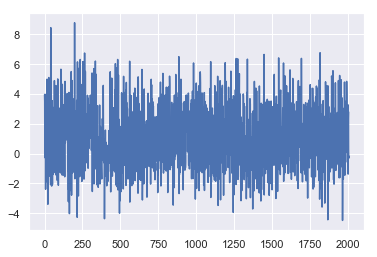

In [173]:
X = dtest[:,1:]
y = dtest[:,0]
dy = [predict(i,weight,biais) for i in X]
prec = [y[i] - dy[i] for i in range(len(y))]
print(prec)
plt.plot([i for i in range(len(y))],prec)   